In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib as mpl
import seaborn as sns


from sklearn.datasets import make_blobs
from sklearn.metrics import f1_score,accuracy_score
from sklearn.metrics import precision_score, recall_score, confusion_matrix, classification_report
from sklearn.metrics import matthews_corrcoef,cohen_kappa_score,balanced_accuracy_score


import lightgbm as lgb
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.neighbors import KNeighborsClassifier
import xgboost as xgb
from catboost import CatBoostClassifier

from modAL.models import ActiveLearner, Committee
from modAL.uncertainty import uncertainty_sampling
from functools import partial
from modAL.batch import uncertainty_batch_sampling

import warnings

warnings.filterwarnings('ignore')

In [2]:
float_cd='PR_PF_6901272' #3901684
data_source="./dataset/"+float_cd+".csv"
data= pd.read_csv(data_source)
data

,Date,Latitude,longitude,Pressure,Salinity,Temperature,QC,label
0,-1.714302,-0.321241,0.754558,-1.220556,1.892667,1.781967,0,0
1,-1.714302,-0.321241,0.754558,-1.205072,1.894667,1.779675,0,0
2,-1.714302,-0.321241,0.754558,-1.189588,1.926672,1.777248,0,0
3,-1.714302,-0.321241,0.754558,-1.174104,2.050690,1.768350,0,0
4,-1.714302,-0.321241,0.754558,-1.158620,2.062692,1.765923,0,0
...,...,...,...,...,...,...,...,...
15097,1.705768,0.282459,-2.386156,-1.240686,2.032687,2.002270,5,1
15098,1.705768,0.282459,-2.386156,-1.239137,2.030687,2.002674,4,1
15099,1.705768,0.282459,-2.386156,-1.237589,2.030687,2.002809,4,1
15100,1.705768,0.282459,-2.386156,-1.236040,2.032687,2.002809,4,1


In [3]:
row,col=data.shape

In [4]:
#def compute ratio
def comp_ratio(data):
    instance = data[(data['QC']==0)]
    rate=len(instance)/len(data)*100
    print(rate)
    return rate

In [5]:
dirty_ratio = 100-comp_ratio(data)
dirty_ratio

94.07363263143954


5.926367368560463

In [6]:
data['QC'].unique()
# num_values = len()

array([0, 5, 4])

In [7]:
data.columns

Index(['Date', 'Latitude', 'longitude', 'Pressure', 'Salinity', 'Temperature',
       'QC', 'label'],
      dtype='object')

In [8]:
def plotCluster(data,name1,name2,name3,start,end):   
    %matplotlib notebook

    data1=data.loc[data['QC'] == 0]

    x1 = data1.loc[:,[name1]].iloc[start:end, :]  
    y1 = data1.loc[:,[name2]].iloc[start:end, :]  
    z1 = data1.loc[:,[name3]].iloc[start:end, :]  


    data2=data.loc[data['QC'] == 3]

    x2 = data2.loc[:,[name1]].iloc[start:end, :]  
    y2 = data2.loc[:,[name2]].iloc[start:end, :]  
    z2 = data2.loc[:,[name3]].iloc[start:end, :]  
    
    
    
    data3=data.loc[data['QC'] == 4]

    x3 = data3.loc[:,[name1]].iloc[start:end, :]  
    y3 = data3.loc[:,[name2]].iloc[start:end, :]  
    z3 = data3.loc[:,[name3]].iloc[start:end, :]  
    
    data4=data.loc[data['QC'] == 5]

    x4 = data4.loc[:,[name1]].iloc[start:end, :]  
    y4 = data4.loc[:,[name2]].iloc[start:end, :]  
    z4 = data4.loc[:,[name3]].iloc[start:end, :]  
    

    fig = plt.figure()
    ax = fig.add_subplot(projection="3d")
    ax.scatter(x1, y1, z1, c='y',s=0.01, label='Normal Data')
    ax.scatter(x2, y2, z2, c='g',s=10, label='PRES')
    ax.scatter(x3, y3, z3, c='b',s=10, label='PSAL')
    ax.scatter(x4, y4, z4, c='r',s=10, label='TEMP')
    
    ax.legend(loc='best')

    ax.set_zlabel(name1, fontdict={'size': 15, 'color': 'black'})
    ax.set_ylabel(name2, fontdict={'size': 15, 'color': 'black'})
    ax.set_xlabel(name3, fontdict={'size': 15, 'color': 'black'})
    plt.show()
    plt.savefig('./image/'+float_cd+'_scatter.png')
    


In [9]:
# dataplot=data.copy()

# plotCluster(dataplot,"Temperature","Pressure","Salinity",0,data.shape[0])

# Splite Dataset

In [10]:
train_set=pd.read_csv('./randomtrain/'+float_cd+'.csv')
#test_set=pd.read_csv('./randomtest/'+float_cd+'.csv') len(test_set)
len(train_set)

10571

In [11]:
comp_ratio(train_set)
#comp_ratio(test_set)

94.07813830290416


94.07813830290416

In [12]:
#this function use random grid search to find best parameters
def getPar(model,dist,data,niter):
    import numpy as np
    import pandas as pd
    from sklearn.model_selection import RandomizedSearchCV
    x,y=data.shape

    clf = model

    param_dist = dist
    grid = RandomizedSearchCV(clf,param_dist,cv = 3,scoring = "balanced_accuracy",n_iter=niter,n_jobs = -1)

    #train
    grid.fit(data.iloc[:,0:y-1],data.iloc[:,y-1])
    #get best parameter
    print(grid.best_score_)
    return grid.best_params_

In [13]:
# metric
def computeMetric(y_tru,y_pre):
    acc = accuracy_score(y_tru,y_pre)
    pre=precision_score(y_tru,y_pre,average='macro')
    recall=recall_score(y_tru,y_pre,average='macro')
    cm=confusion_matrix(y_tru,y_pre)
    f1 = f1_score(y_tru,y_pre,average='macro')
    mcc=matthews_corrcoef(y_tru, y_pre)
    kappa=cohen_kappa_score(y_tru, y_pre)
    bac=balanced_accuracy_score(y_tru,y_pre)
    print("acc:",acc)
    print("precision:",pre)
    print("recall:",recall)
    print("cm:",cm)
    print("f1:",f1)
    print("balanced acc:",bac)
    print("MCC:", mcc)
    print("Kappa:",kappa)
    
    #confusion matrix
    cmap1 = sns.diverging_palette(260,-10,s=50, l=75, n=5, as_cmap=True)
    plt.subplots(figsize=(12,8))
    cf_matrix = confusion_matrix(y_tru, y_pre)
    sns.heatmap(cf_matrix/np.sum(cf_matrix), cmap = cmap1, annot = True, annot_kws = {'size':15})
    
    return f1

In [14]:
def draw(performance_history):
    fig, ax = plt.subplots(figsize=(8.5, 6), dpi=130)
    ax.plot(performance_history)
    ax.scatter(range(len(performance_history)), performance_history, s=13)
    ax.xaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=5, integer=True))
    ax.yaxis.set_major_locator(mpl.ticker.MaxNLocator(nbins=10))
    ax.yaxis.set_major_formatter(mpl.ticker.PercentFormatter(xmax=1))
    ax.set_ylim(bottom=0, top=1)
    ax.grid(True)
    ax.set_title('Incremental classification accuracy')
    ax.set_xlabel('Query iteration')
    ax.set_ylabel('Classification Accuracy')
    plt.show()

# splite train(pool), test, Labeled, Unlabeled

In [15]:
x,y=train_set.shape ##no qc
#pool 
X_Pool = train_set.iloc[:,0:y-2].values
y_Pool = train_set.iloc[:,y-1].values

In [16]:
#test set
X_test=train_set.iloc[:,0:y-2]
y_tru=train_set.iloc[:,y-1]
print(len(X_test),len(y_tru))

10571 10571


In [17]:
#Pool
def initial_data(n_initial,X_Pool,y_Pool):
    #inital
    initial_idx = np.random.choice(range(len(X_Pool)), size=n_initial, replace=False)
    #initial Labeled data
    #X_initial, y_initial = X_train[], y_train[initial_idx]
    X_L = X_Pool[initial_idx]
    y_L = y_Pool[initial_idx]
    # Unlabeled data
    # X_U = Pool_X[ini_num:]
    # y_U = Pool_X[ini_num:]
    X_U, y_U = np.delete(X_Pool, initial_idx, axis=0), np.delete(y_Pool, initial_idx, axis=0)
    return X_L,y_L,X_U,y_U

In [18]:
# Set RNG seed for reproducibility.
RANDOM_STATE_SEED = 123
np.random.seed(RANDOM_STATE_SEED)

#n_initial= 1000
n_initial = 1000
N_QUERIES = 200

In [19]:
# X_initial,y_initial,X_re,y_re=initial_data(n_initial,X_Pool,y_Pool)
# df_X_i = pd.DataFrame(X_initial)
# df_y_i = pd.DataFrame(y_initial)
# df_X_r = pd.DataFrame(X_re)
# df_y_r = pd.DataFrame(y_re)

X_initial=pd.read_csv('./randomtrain/'+float_cd+'_X_initial.csv').values
y_initial=pd.read_csv('./randomtrain/'+float_cd+'_y_initial.csv').values.ravel()
X_re=pd.read_csv('./randomtrain/'+float_cd+'_X_re.csv').values
y_re=pd.read_csv('./randomtrain/'+float_cd+'_y_re.csv').values.ravel()
print(X_re.shape,X_initial.shape)
print(y_re.shape,y_initial.shape)

(10471, 6) (100, 6)
(10471,) (100,)


In [20]:
# df_X_i.to_csv('./randomtrain/'+float_cd+'_X_initial.csv', index=False)
# df_y_i.to_csv('./randomtrain/'+float_cd+'_y_initial.csv', index=False)
# df_X_r.to_csv('./randomtrain/'+float_cd+'_X_re.csv', index=False)
# df_y_r.to_csv('./randomtrain/'+float_cd+'_y_re.csv', index=False)

# molAL

In [21]:
def random_sampling(classifier, X_pool):
    n_samples = len(X_pool)
    query_idx = np.random.choice(range(n_samples))
    return query_idx, X_pool[query_idx]

In [22]:
def al(clf,strategy,X_L,y_L):
    learner = ActiveLearner(estimator=clf,
                            query_strategy=strategy,
                            X_training=X_L, y_training=y_L)
    return learner

In [23]:
def al_learn(clf,sampling,X_initial,y_initial,X_re,y_re):
    X_L = X_initial.copy()
    y_L = y_initial.copy()
    X_U,y_U =X_re.copy(),y_re.copy()
    #print(len(X_U),len(y_U))
    learner = al(clf,sampling,X_L,y_L)
    y_pre=learner.predict(X_test)
    unqueried_kappa=cohen_kappa_score(y_tru, y_pre)
    unqueried_f1=f1_score(y_tru,y_pre)
    #print("unqueried --------------------->",unqueried_score)
    kappa_history = [unqueried_kappa]
    f1_history = [unqueried_f1]
    y_L_2 = y_L.tolist()
    y_L_2 = np.array(y_L_2).reshape((-1, 1))
    queried_instance = np.concatenate((X_L, y_L_2), axis=1)

    # Query
    for index in range(N_QUERIES):
        query_index, query_instance = learner.query(X_U)
        # Teach ActiveLearner model the record it has requested.
        X, y = X_U[query_index].reshape(1, -1), y_U[query_index].reshape(1, )
        #print(X.flatten(), y)
        instance = np.concatenate((X.flatten(), y))
        #print(index+1,"query instance --------------------->",instance)
        learner.teach(X=X, y=y)
        
        X_U, y_U = np.delete(X_U, query_index, axis=0), np.delete(y_U, query_index)
        y_pre=learner.predict(X_test)
        kappa=cohen_kappa_score(y_tru, y_pre)
        f1=f1_score(y_tru,y_pre)
        print(index+1,"-------------------->",kappa)
        print(index+1,"-------------------->",f1)
        # Recall precision F1
        kappa_history.append(kappa)
        f1_history.append(f1)
        queried_instance = np.vstack((queried_instance, instance))
        df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)

    #print(query_history)
    df_scores= pd.concat([pd.DataFrame(kappa_history,columns=['kappa']), 
                          pd.DataFrame(f1_history,columns=['f1'])],
                         axis=1)
    df_instance = pd.DataFrame(data=queried_instance, columns=['Date','Latitude','longitude','Pressure','Salinity','Temperature','Label'])
    #print(df_instance)
    return df_scores, df_instance 
#     return f1_history


1.0
{'n_neighbors': 1}
acc: 1.0
precision: 1.0
recall: 1.0
cm: [[9945    0]
 [   0  626]]
f1: 1.0
balanced acc: 1.0
MCC: 1.0
Kappa: 1.0


1.0

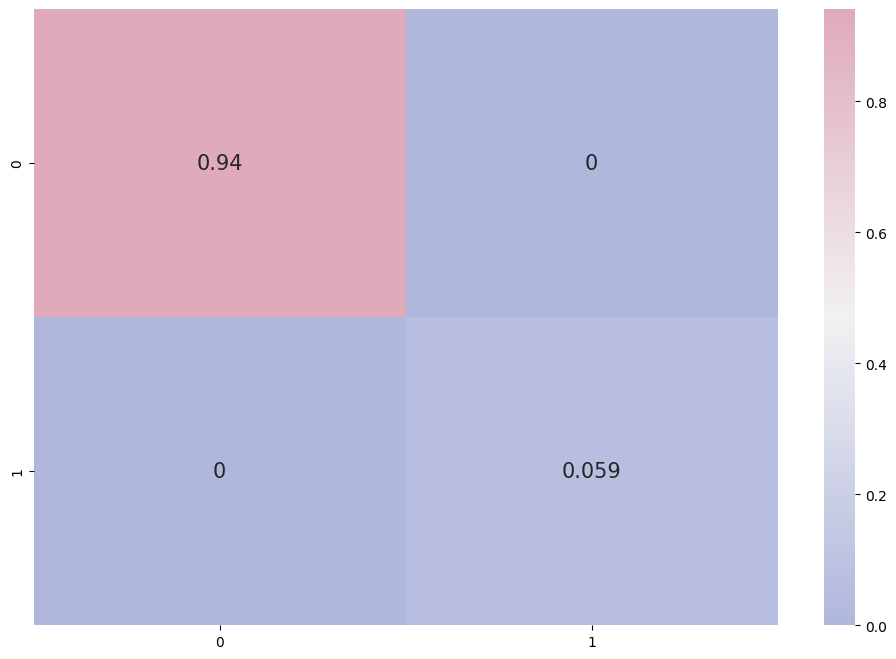

In [24]:
# clf1 KNN
clf1 = KNeighborsClassifier()
dic1={'n_neighbors':[1,2,3,4,5,6,7,8]}
para1=getPar(clf1,dic1,train_set,10)
print(para1)
clf1 = KNeighborsClassifier(n_neighbors=para1['n_neighbors'],n_jobs=-1)
clf1.fit(X_Pool, y_Pool)
y_pre=clf1.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 0.9997162047110018
precision: 0.9998492159227985
recall: 0.9976038338658146
cm: [[9945    0]
 [   3  623]]
f1: 0.998723635823151
balanced acc: 0.9976038338658146
MCC: 0.9974505224781949
Kappa: 0.9974472725709668


0.998723635823151

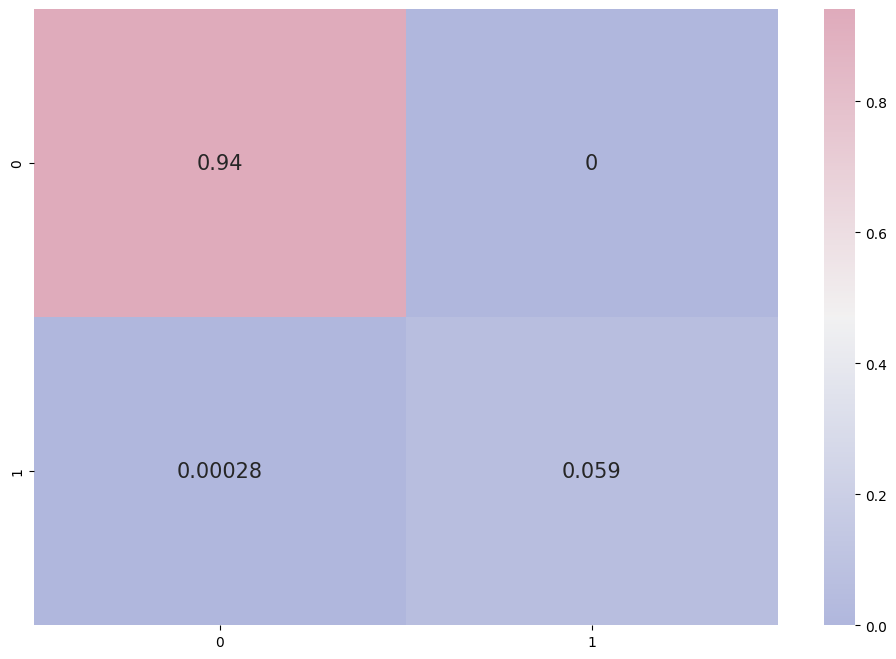

In [25]:
# clf2 lightgbm
clf2 = lgb.LGBMClassifier()

dic2 = {'learning_rate' : [0.01, 0.02, 0.03, 0.04, 0.05, 0.08, 0.1, 0.2, 0.3, 0.4],
              'n_estimators' : [100, 200, 300, 400, 500, 600, 800, 900, 1000, 1500, 2000],
              'num_leaves': range(6, 50), 
              'min_child_samples': range(10, 200, 10), 
              'min_child_weight': [1e-5, 1e-3, 1e-2, 1e-1, 1, 1e1, 1e2, 1e3, 1e4],
              'max_depth': [-1, 1, 2, 3, 4, 5, 6, 7],
              'reg_alpha': [0, 1e-1, 1, 2, 5, 7, 10, 50, 100],
              'reg_lambda': [0, 1e-1, 1, 5, 10, 20, 50, 100]}
para2=getPar(clf2,dic2,train_set,10)

    
clf2 = lgb.LGBMClassifier(boosting_type='gbdt',
                          #objective='multiclass',
                          num_leaves=para2['num_leaves'], max_depth=-1, 
                              learning_rate=para2['learning_rate'], n_estimators=para2['n_estimators'], 
                              subsample_for_bin=200000, class_weight=None, min_split_gain=0.0, 
                              min_child_weight=para2['min_child_weight'],
                              min_child_samples=para2['min_child_samples'], 
                              subsample=1.0, 
                              subsample_freq=0, colsample_bytree=1.0, reg_alpha=para2['reg_alpha'], 
                              reg_lambda=para2['reg_lambda'], random_state=None, n_jobs=-1, importance_type='split')
clf2.fit(X_Pool, y_Pool)
y_pre=clf2.predict(X_test)
computeMetric(y_tru,y_pre)

1.0
acc: 1.0
precision: 1.0
recall: 1.0
cm: [[9945    0]
 [   0  626]]
f1: 1.0
balanced acc: 1.0
MCC: 1.0
Kappa: 1.0


1.0

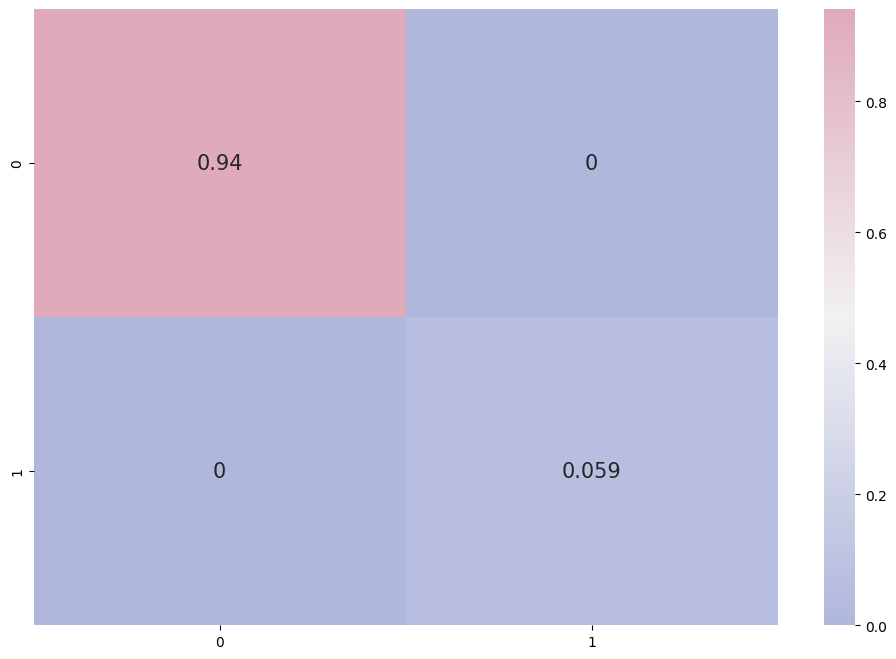

In [26]:
#XGBOOST
clf3 = xgb.XGBClassifier()
dic3 = {'n_estimators':range(80,2000,4),
        'max_depth':range(2,15,1),
        'learning_rate':np.linspace(0.01,2,20),
        'subsample':np.linspace(0.7,0.9,20),
        'colsample_bytree':np.linspace(0.5,0.98,10)
        }
para3=getPar(clf3,dic3,train_set,10)
clf3 = xgb.XGBClassifier(booster='gbtree',n_estimators=para3['n_estimators'], learning_rate=para3['learning_rate'],
                    max_depth=para3['max_depth'],subsample=para3['subsample'],
                    colsample_bytree=para3['colsample_bytree'],
                         #objective='multi:softprob',
                    n_jobs=-1)
clf3.fit(X_Pool, y_Pool)
y_pre=clf3.predict(X_test)
computeMetric(y_tru,y_pre)

Learning rate set to 0.028199
0:	learn: 0.6019736	total: 59ms	remaining: 58.9s
1:	learn: 0.5204237	total: 63.4ms	remaining: 31.6s
2:	learn: 0.4498865	total: 67.6ms	remaining: 22.5s
3:	learn: 0.3897870	total: 72.1ms	remaining: 17.9s
4:	learn: 0.3361169	total: 76.1ms	remaining: 15.2s
5:	learn: 0.2866583	total: 80.3ms	remaining: 13.3s
6:	learn: 0.2478559	total: 85ms	remaining: 12.1s
7:	learn: 0.2124579	total: 88.9ms	remaining: 11s
8:	learn: 0.1834523	total: 93.1ms	remaining: 10.3s
9:	learn: 0.1614569	total: 97.6ms	remaining: 9.66s
10:	learn: 0.1399589	total: 102ms	remaining: 9.16s
11:	learn: 0.1220672	total: 106ms	remaining: 8.72s
12:	learn: 0.1066848	total: 111ms	remaining: 8.41s
13:	learn: 0.0929844	total: 115ms	remaining: 8.1s
14:	learn: 0.0814919	total: 119ms	remaining: 7.84s
15:	learn: 0.0704999	total: 123ms	remaining: 7.59s
16:	learn: 0.0623371	total: 128ms	remaining: 7.39s
17:	learn: 0.0558183	total: 132ms	remaining: 7.21s
18:	learn: 0.0497974	total: 136ms	remaining: 7.04s
19:	lear

199:	learn: 0.0004603	total: 1.19s	remaining: 4.77s
200:	learn: 0.0004558	total: 1.2s	remaining: 4.76s
201:	learn: 0.0004526	total: 1.2s	remaining: 4.75s
202:	learn: 0.0004477	total: 1.21s	remaining: 4.74s
203:	learn: 0.0004443	total: 1.21s	remaining: 4.73s
204:	learn: 0.0004412	total: 1.22s	remaining: 4.72s
205:	learn: 0.0004387	total: 1.22s	remaining: 4.71s
206:	learn: 0.0004357	total: 1.23s	remaining: 4.7s
207:	learn: 0.0004316	total: 1.23s	remaining: 4.69s
208:	learn: 0.0004287	total: 1.24s	remaining: 4.68s
209:	learn: 0.0004256	total: 1.24s	remaining: 4.67s
210:	learn: 0.0004222	total: 1.25s	remaining: 4.66s
211:	learn: 0.0004174	total: 1.25s	remaining: 4.65s
212:	learn: 0.0004141	total: 1.25s	remaining: 4.63s
213:	learn: 0.0004092	total: 1.26s	remaining: 4.62s
214:	learn: 0.0004049	total: 1.26s	remaining: 4.61s
215:	learn: 0.0004022	total: 1.27s	remaining: 4.6s
216:	learn: 0.0003982	total: 1.27s	remaining: 4.59s
217:	learn: 0.0003952	total: 1.27s	remaining: 4.57s
218:	learn: 0.00

389:	learn: 0.0001528	total: 1.98s	remaining: 3.1s
390:	learn: 0.0001528	total: 1.98s	remaining: 3.09s
391:	learn: 0.0001528	total: 1.99s	remaining: 3.08s
392:	learn: 0.0001528	total: 1.99s	remaining: 3.07s
393:	learn: 0.0001528	total: 1.99s	remaining: 3.07s
394:	learn: 0.0001528	total: 2s	remaining: 3.06s
395:	learn: 0.0001528	total: 2s	remaining: 3.05s
396:	learn: 0.0001524	total: 2s	remaining: 3.04s
397:	learn: 0.0001517	total: 2.01s	remaining: 3.04s
398:	learn: 0.0001517	total: 2.01s	remaining: 3.03s
399:	learn: 0.0001510	total: 2.02s	remaining: 3.02s
400:	learn: 0.0001510	total: 2.02s	remaining: 3.02s
401:	learn: 0.0001506	total: 2.02s	remaining: 3.01s
402:	learn: 0.0001506	total: 2.03s	remaining: 3s
403:	learn: 0.0001503	total: 2.03s	remaining: 3s
404:	learn: 0.0001503	total: 2.03s	remaining: 2.99s
405:	learn: 0.0001495	total: 2.04s	remaining: 2.98s
406:	learn: 0.0001486	total: 2.04s	remaining: 2.98s
407:	learn: 0.0001480	total: 2.05s	remaining: 2.97s
408:	learn: 0.0001472	total:

554:	learn: 0.0001325	total: 2.57s	remaining: 2.06s
555:	learn: 0.0001325	total: 2.57s	remaining: 2.05s
556:	learn: 0.0001323	total: 2.58s	remaining: 2.05s
557:	learn: 0.0001323	total: 2.58s	remaining: 2.04s
558:	learn: 0.0001319	total: 2.58s	remaining: 2.04s
559:	learn: 0.0001319	total: 2.59s	remaining: 2.03s
560:	learn: 0.0001317	total: 2.59s	remaining: 2.03s
561:	learn: 0.0001315	total: 2.59s	remaining: 2.02s
562:	learn: 0.0001307	total: 2.6s	remaining: 2.02s
563:	learn: 0.0001303	total: 2.6s	remaining: 2.01s
564:	learn: 0.0001299	total: 2.61s	remaining: 2.01s
565:	learn: 0.0001299	total: 2.61s	remaining: 2s
566:	learn: 0.0001299	total: 2.61s	remaining: 2s
567:	learn: 0.0001299	total: 2.62s	remaining: 1.99s
568:	learn: 0.0001296	total: 2.62s	remaining: 1.98s
569:	learn: 0.0001296	total: 2.62s	remaining: 1.98s
570:	learn: 0.0001288	total: 2.63s	remaining: 1.97s
571:	learn: 0.0001284	total: 2.63s	remaining: 1.97s
572:	learn: 0.0001284	total: 2.63s	remaining: 1.96s
573:	learn: 0.000128

723:	learn: 0.0001230	total: 3.15s	remaining: 1.2s
724:	learn: 0.0001230	total: 3.16s	remaining: 1.2s
725:	learn: 0.0001230	total: 3.16s	remaining: 1.19s
726:	learn: 0.0001230	total: 3.17s	remaining: 1.19s
727:	learn: 0.0001230	total: 3.17s	remaining: 1.18s
728:	learn: 0.0001230	total: 3.17s	remaining: 1.18s
729:	learn: 0.0001230	total: 3.17s	remaining: 1.17s
730:	learn: 0.0001230	total: 3.18s	remaining: 1.17s
731:	learn: 0.0001230	total: 3.18s	remaining: 1.17s
732:	learn: 0.0001230	total: 3.19s	remaining: 1.16s
733:	learn: 0.0001230	total: 3.19s	remaining: 1.16s
734:	learn: 0.0001230	total: 3.19s	remaining: 1.15s
735:	learn: 0.0001230	total: 3.2s	remaining: 1.15s
736:	learn: 0.0001230	total: 3.2s	remaining: 1.14s
737:	learn: 0.0001230	total: 3.2s	remaining: 1.14s
738:	learn: 0.0001230	total: 3.21s	remaining: 1.13s
739:	learn: 0.0001230	total: 3.21s	remaining: 1.13s
740:	learn: 0.0001230	total: 3.21s	remaining: 1.12s
741:	learn: 0.0001230	total: 3.22s	remaining: 1.12s
742:	learn: 0.000

898:	learn: 0.0001230	total: 3.74s	remaining: 420ms
899:	learn: 0.0001230	total: 3.75s	remaining: 416ms
900:	learn: 0.0001230	total: 3.75s	remaining: 412ms
901:	learn: 0.0001230	total: 3.75s	remaining: 408ms
902:	learn: 0.0001230	total: 3.75s	remaining: 403ms
903:	learn: 0.0001230	total: 3.76s	remaining: 399ms
904:	learn: 0.0001229	total: 3.76s	remaining: 395ms
905:	learn: 0.0001230	total: 3.76s	remaining: 391ms
906:	learn: 0.0001230	total: 3.77s	remaining: 386ms
907:	learn: 0.0001230	total: 3.77s	remaining: 382ms
908:	learn: 0.0001230	total: 3.77s	remaining: 378ms
909:	learn: 0.0001230	total: 3.78s	remaining: 374ms
910:	learn: 0.0001230	total: 3.78s	remaining: 369ms
911:	learn: 0.0001230	total: 3.79s	remaining: 365ms
912:	learn: 0.0001230	total: 3.79s	remaining: 361ms
913:	learn: 0.0001230	total: 3.79s	remaining: 357ms
914:	learn: 0.0001230	total: 3.79s	remaining: 353ms
915:	learn: 0.0001230	total: 3.8s	remaining: 348ms
916:	learn: 0.0001229	total: 3.8s	remaining: 344ms
917:	learn: 0.

1.0

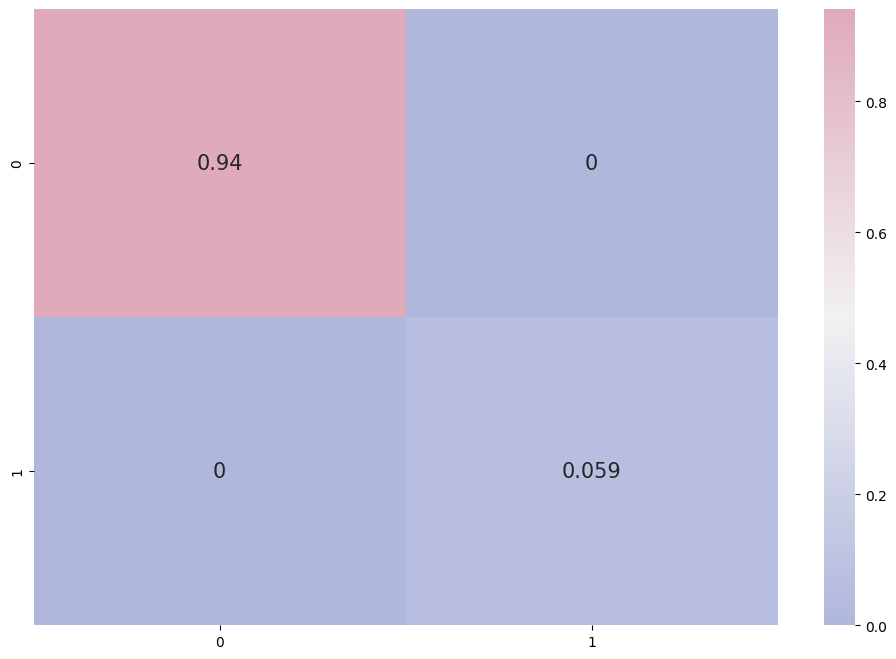

In [27]:
#clf4 catboost
clf4 = CatBoostClassifier(loss_function='Logloss')
# dic4 = {'learning_rate': [0.03, 0.1],
#         'depth': [4, 6, 10],
#         'l2_leaf_reg': [1, 3, 5, 7, 9]}
# para3=getPar(clf4,dic4,test_set,10)
# grid_search_result = clf4.grid_search(dic4, 
#                                        X=X_Pool, 
#                                        y=y_Pool)

clf4.fit(X_Pool, y_Pool)
y_pre=clf4.predict(X_test)
computeMetric(y_tru,y_pre)

## random sampling

In [28]:
sampling=random_sampling

In [29]:
metric01,instance01 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance01.to_csv("./query/random_Knn_"+float_cd+".csv")

1 --------------------> 0.383624928339691
1 --------------------> 0.42958579881656805
2 --------------------> 0.383624928339691
2 --------------------> 0.42958579881656805
3 --------------------> 0.383624928339691
3 --------------------> 0.42958579881656805
4 --------------------> 0.383624928339691
4 --------------------> 0.42958579881656805
5 --------------------> 0.3990120993907371
5 --------------------> 0.44159178433889607
6 --------------------> 0.3990120993907371
6 --------------------> 0.44159178433889607
7 --------------------> 0.3990120993907371
7 --------------------> 0.44159178433889607
8 --------------------> 0.3990120993907371
8 --------------------> 0.44159178433889607
9 --------------------> 0.3990120993907371
9 --------------------> 0.44159178433889607
10 --------------------> 0.3990120993907371
10 --------------------> 0.44159178433889607
11 --------------------> 0.40720371036980807
11 --------------------> 0.449874686716792
12 --------------------> 0.40720371036980807

94 --------------------> 0.3903516020841368
94 --------------------> 0.42857142857142855
95 --------------------> 0.3903516020841368
95 --------------------> 0.42857142857142855
96 --------------------> 0.3903516020841368
96 --------------------> 0.42857142857142855
97 --------------------> 0.3903516020841368
97 --------------------> 0.42857142857142855
98 --------------------> 0.3903516020841368
98 --------------------> 0.42857142857142855
99 --------------------> 0.3753092465849953
99 --------------------> 0.41242038216560506
100 --------------------> 0.3753092465849953
100 --------------------> 0.41242038216560506
101 --------------------> 0.3753092465849953
101 --------------------> 0.41242038216560506
102 --------------------> 0.3753092465849953
102 --------------------> 0.41242038216560506
103 --------------------> 0.37683505285459806
103 --------------------> 0.4137380191693291
104 --------------------> 0.37683505285459806
104 --------------------> 0.4137380191693291
105 -------

185 --------------------> 0.42745102831376103
185 --------------------> 0.4620203602192639
186 --------------------> 0.42993851618294643
186 --------------------> 0.4642014162077105
187 --------------------> 0.42993851618294643
187 --------------------> 0.4642014162077105
188 --------------------> 0.42993851618294643
188 --------------------> 0.4642014162077105
189 --------------------> 0.42993851618294643
189 --------------------> 0.4642014162077105
190 --------------------> 0.42993851618294643
190 --------------------> 0.4642014162077105
191 --------------------> 0.42993851618294643
191 --------------------> 0.4642014162077105
192 --------------------> 0.42993851618294643
192 --------------------> 0.4642014162077105
193 --------------------> 0.42993851618294643
193 --------------------> 0.4642014162077105
194 --------------------> 0.4808479886157806
194 --------------------> 0.5139911634756995
195 --------------------> 0.4808479886157806
195 --------------------> 0.5139911634756995
1

In [30]:
metric02,instance02 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance02.to_csv("./query/random_Lg_"+float_cd+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

117 --------------------> 0.8491140263450448
117 --------------------> 0.859145059565522
118 --------------------> 0.8491140263450448
118 --------------------> 0.859145059565522
119 --------------------> 0.9957390617713104
119 --------------------> 0.9959903769045709
120 --------------------> 0.9957390617713104
120 --------------------> 0.9959903769045709
121 --------------------> 0.9957390617713104
121 --------------------> 0.9959903769045709
122 --------------------> 0.9957390617713104
122 --------------------> 0.9959903769045709
123 --------------------> 0.9957390617713104
123 --------------------> 0.9959903769045709
124 --------------------> 0.9957390617713104
124 --------------------> 0.9959903769045709
125 --------------------> 0.8962120417847624
125 --------------------> 0.9017543859649123
126 --------------------> 0.8962120417847624
126 --------------------> 0.9017543859649123
127 --------------------> 0.8962120417847624
127 --------------------> 0.9017543859649123
128 --------

In [31]:
metric03,instance03= al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance03.to_csv("./query/random_XB_"+float_cd+".csv")

1 --------------------> 0.8962120417847624
1 --------------------> 0.9017543859649123
2 --------------------> 0.8962120417847624
2 --------------------> 0.9017543859649123
3 --------------------> 0.8962120417847624
3 --------------------> 0.9017543859649123
4 --------------------> 0.8962120417847624
4 --------------------> 0.9017543859649123
5 --------------------> 0.8962120417847624
5 --------------------> 0.9017543859649123
6 --------------------> 0.8962120417847624
6 --------------------> 0.9017543859649123
7 --------------------> 0.8962120417847624
7 --------------------> 0.9017543859649123
8 --------------------> 0.8962120417847624
8 --------------------> 0.9017543859649123
9 --------------------> 0.8962120417847624
9 --------------------> 0.9017543859649123
10 --------------------> 0.8962120417847624
10 --------------------> 0.9017543859649123
11 --------------------> 0.8962120417847624
11 --------------------> 0.9017543859649123
12 --------------------> 0.8962120417847624
12 ---

95 --------------------> 0.8962120417847624
95 --------------------> 0.9017543859649123
96 --------------------> 0.8962120417847624
96 --------------------> 0.9017543859649123
97 --------------------> 0.8962120417847624
97 --------------------> 0.9017543859649123
98 --------------------> 0.8962120417847624
98 --------------------> 0.9017543859649123
99 --------------------> 0.8962120417847624
99 --------------------> 0.9017543859649123
100 --------------------> 0.8962120417847624
100 --------------------> 0.9017543859649123
101 --------------------> 0.954064295212188
101 --------------------> 0.9566666666666667
102 --------------------> 0.9363381336819376
102 --------------------> 0.9398814563928874
103 --------------------> 0.8962120417847624
103 --------------------> 0.9017543859649123
104 --------------------> 0.8962120417847624
104 --------------------> 0.9017543859649123
105 --------------------> 0.8962120417847624
105 --------------------> 0.9017543859649123
106 -----------------

187 --------------------> 0.9957390617713104
187 --------------------> 0.9959903769045709
188 --------------------> 0.9957390617713104
188 --------------------> 0.9959903769045709
189 --------------------> 0.9957390617713104
189 --------------------> 0.9959903769045709
190 --------------------> 0.9957390617713104
190 --------------------> 0.9959903769045709
191 --------------------> 0.9957390617713104
191 --------------------> 0.9959903769045709
192 --------------------> 0.9957390617713104
192 --------------------> 0.9959903769045709
193 --------------------> 0.9957390617713104
193 --------------------> 0.9959903769045709
194 --------------------> 0.9957390617713104
194 --------------------> 0.9959903769045709
195 --------------------> 0.9957390617713104
195 --------------------> 0.9959903769045709
196 --------------------> 0.9957390617713104
196 --------------------> 0.9959903769045709
197 --------------------> 0.9957390617713104
197 --------------------> 0.9959903769045709
198 ------

In [32]:
metric04,instance04= al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance04.to_csv("./query/random_CB_"+float_cd+".csv")

Learning rate set to 0.003854
0:	learn: 0.6853439	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6799080	total: 2.24ms	remaining: 1.12s
2:	learn: 0.6740748	total: 3.16ms	remaining: 1.05s
3:	learn: 0.6683112	total: 4.04ms	remaining: 1.01s
4:	learn: 0.6624788	total: 4.92ms	remaining: 979ms
5:	learn: 0.6588631	total: 5.73ms	remaining: 949ms
6:	learn: 0.6528271	total: 6.67ms	remaining: 946ms
7:	learn: 0.6465627	total: 7.51ms	remaining: 931ms
8:	learn: 0.6407413	total: 8.3ms	remaining: 914ms
9:	learn: 0.6355907	total: 9.07ms	remaining: 898ms
10:	learn: 0.6302812	total: 9.91ms	remaining: 891ms
11:	learn: 0.6256635	total: 10.7ms	remaining: 881ms
12:	learn: 0.6196570	total: 11.5ms	remaining: 871ms
13:	learn: 0.6152802	total: 12.2ms	remaining: 861ms
14:	learn: 0.6101451	total: 13.1ms	remaining: 861ms
15:	learn: 0.6050122	total: 14ms	remaining: 863ms
16:	learn: 0.5996200	total: 15ms	remaining: 865ms
17:	learn: 0.5941521	total: 15.8ms	remaining: 861ms
18:	learn: 0.5881834	total: 16.7ms	remaining: 861

211:	learn: 0.1386182	total: 170ms	remaining: 633ms
212:	learn: 0.1377165	total: 172ms	remaining: 634ms
213:	learn: 0.1370187	total: 172ms	remaining: 633ms
214:	learn: 0.1361234	total: 173ms	remaining: 632ms
215:	learn: 0.1352562	total: 174ms	remaining: 630ms
216:	learn: 0.1343844	total: 174ms	remaining: 629ms
217:	learn: 0.1335755	total: 175ms	remaining: 628ms
218:	learn: 0.1327495	total: 176ms	remaining: 627ms
219:	learn: 0.1319946	total: 177ms	remaining: 626ms
220:	learn: 0.1314480	total: 178ms	remaining: 626ms
221:	learn: 0.1308146	total: 179ms	remaining: 629ms
222:	learn: 0.1300348	total: 181ms	remaining: 630ms
223:	learn: 0.1293204	total: 182ms	remaining: 631ms
224:	learn: 0.1285822	total: 183ms	remaining: 631ms
225:	learn: 0.1277605	total: 184ms	remaining: 631ms
226:	learn: 0.1270276	total: 186ms	remaining: 632ms
227:	learn: 0.1262155	total: 187ms	remaining: 634ms
228:	learn: 0.1256145	total: 188ms	remaining: 633ms
229:	learn: 0.1250540	total: 189ms	remaining: 633ms
230:	learn: 

441:	learn: 0.0465842	total: 350ms	remaining: 441ms
442:	learn: 0.0464310	total: 351ms	remaining: 441ms
443:	learn: 0.0462299	total: 352ms	remaining: 440ms
444:	learn: 0.0460707	total: 353ms	remaining: 440ms
445:	learn: 0.0458584	total: 353ms	remaining: 439ms
446:	learn: 0.0456659	total: 354ms	remaining: 438ms
447:	learn: 0.0454691	total: 355ms	remaining: 437ms
448:	learn: 0.0453425	total: 357ms	remaining: 438ms
449:	learn: 0.0452048	total: 357ms	remaining: 437ms
450:	learn: 0.0449264	total: 358ms	remaining: 436ms
451:	learn: 0.0447287	total: 359ms	remaining: 435ms
452:	learn: 0.0445704	total: 360ms	remaining: 435ms
453:	learn: 0.0443974	total: 361ms	remaining: 434ms
454:	learn: 0.0442844	total: 361ms	remaining: 433ms
455:	learn: 0.0441460	total: 362ms	remaining: 432ms
456:	learn: 0.0440364	total: 363ms	remaining: 431ms
457:	learn: 0.0438328	total: 364ms	remaining: 431ms
458:	learn: 0.0437244	total: 365ms	remaining: 430ms
459:	learn: 0.0435164	total: 365ms	remaining: 429ms
460:	learn: 

673:	learn: 0.0232276	total: 532ms	remaining: 257ms
674:	learn: 0.0231763	total: 533ms	remaining: 257ms
675:	learn: 0.0231311	total: 534ms	remaining: 256ms
676:	learn: 0.0230659	total: 535ms	remaining: 255ms
677:	learn: 0.0230081	total: 535ms	remaining: 254ms
678:	learn: 0.0229411	total: 536ms	remaining: 253ms
679:	learn: 0.0228782	total: 537ms	remaining: 253ms
680:	learn: 0.0228362	total: 538ms	remaining: 252ms
681:	learn: 0.0227728	total: 539ms	remaining: 251ms
682:	learn: 0.0227288	total: 539ms	remaining: 250ms
683:	learn: 0.0226744	total: 541ms	remaining: 250ms
684:	learn: 0.0226356	total: 542ms	remaining: 249ms
685:	learn: 0.0225695	total: 543ms	remaining: 249ms
686:	learn: 0.0225288	total: 544ms	remaining: 248ms
687:	learn: 0.0224900	total: 545ms	remaining: 247ms
688:	learn: 0.0224222	total: 546ms	remaining: 246ms
689:	learn: 0.0223595	total: 546ms	remaining: 245ms
690:	learn: 0.0223015	total: 547ms	remaining: 245ms
691:	learn: 0.0222504	total: 548ms	remaining: 244ms
692:	learn: 

920:	learn: 0.0139063	total: 713ms	remaining: 61.2ms
921:	learn: 0.0138800	total: 714ms	remaining: 60.4ms
922:	learn: 0.0138600	total: 715ms	remaining: 59.7ms
923:	learn: 0.0138308	total: 716ms	remaining: 58.9ms
924:	learn: 0.0138057	total: 717ms	remaining: 58.1ms
925:	learn: 0.0137900	total: 717ms	remaining: 57.3ms
926:	learn: 0.0137625	total: 718ms	remaining: 56.6ms
927:	learn: 0.0137320	total: 719ms	remaining: 55.8ms
928:	learn: 0.0137017	total: 720ms	remaining: 55ms
929:	learn: 0.0136747	total: 720ms	remaining: 54.2ms
930:	learn: 0.0136446	total: 721ms	remaining: 53.5ms
931:	learn: 0.0136226	total: 722ms	remaining: 52.7ms
932:	learn: 0.0136076	total: 723ms	remaining: 51.9ms
933:	learn: 0.0135793	total: 724ms	remaining: 51.2ms
934:	learn: 0.0135593	total: 725ms	remaining: 50.4ms
935:	learn: 0.0135384	total: 726ms	remaining: 49.6ms
936:	learn: 0.0135174	total: 726ms	remaining: 48.8ms
937:	learn: 0.0134980	total: 727ms	remaining: 48.1ms
938:	learn: 0.0134807	total: 728ms	remaining: 47

139:	learn: 0.2196524	total: 97.8ms	remaining: 601ms
140:	learn: 0.2180417	total: 99ms	remaining: 603ms
141:	learn: 0.2166422	total: 99.7ms	remaining: 602ms
142:	learn: 0.2147945	total: 100ms	remaining: 602ms
143:	learn: 0.2131520	total: 101ms	remaining: 602ms
144:	learn: 0.2116769	total: 102ms	remaining: 601ms
145:	learn: 0.2102163	total: 103ms	remaining: 600ms
146:	learn: 0.2087954	total: 103ms	remaining: 600ms
147:	learn: 0.2073887	total: 104ms	remaining: 600ms
148:	learn: 0.2061778	total: 105ms	remaining: 600ms
149:	learn: 0.2051441	total: 106ms	remaining: 600ms
150:	learn: 0.2036786	total: 107ms	remaining: 599ms
151:	learn: 0.2024379	total: 108ms	remaining: 602ms
152:	learn: 0.2012907	total: 109ms	remaining: 603ms
153:	learn: 0.1998361	total: 110ms	remaining: 603ms
154:	learn: 0.1986313	total: 110ms	remaining: 602ms
155:	learn: 0.1974482	total: 111ms	remaining: 602ms
156:	learn: 0.1962081	total: 112ms	remaining: 602ms
157:	learn: 0.1950299	total: 113ms	remaining: 603ms
158:	learn:

378:	learn: 0.0591792	total: 278ms	remaining: 456ms
379:	learn: 0.0589749	total: 279ms	remaining: 456ms
380:	learn: 0.0587025	total: 280ms	remaining: 455ms
381:	learn: 0.0584506	total: 281ms	remaining: 454ms
382:	learn: 0.0582460	total: 282ms	remaining: 454ms
383:	learn: 0.0579945	total: 282ms	remaining: 453ms
384:	learn: 0.0578193	total: 283ms	remaining: 452ms
385:	learn: 0.0575445	total: 284ms	remaining: 451ms
386:	learn: 0.0572655	total: 285ms	remaining: 451ms
387:	learn: 0.0570717	total: 285ms	remaining: 450ms
388:	learn: 0.0567816	total: 286ms	remaining: 449ms
389:	learn: 0.0565573	total: 287ms	remaining: 449ms
390:	learn: 0.0563700	total: 288ms	remaining: 448ms
391:	learn: 0.0561742	total: 289ms	remaining: 448ms
392:	learn: 0.0558322	total: 290ms	remaining: 448ms
393:	learn: 0.0555693	total: 291ms	remaining: 447ms
394:	learn: 0.0552981	total: 292ms	remaining: 447ms
395:	learn: 0.0550475	total: 292ms	remaining: 445ms
396:	learn: 0.0548674	total: 293ms	remaining: 445ms
397:	learn: 

632:	learn: 0.0252524	total: 460ms	remaining: 267ms
633:	learn: 0.0251698	total: 461ms	remaining: 266ms
634:	learn: 0.0250740	total: 462ms	remaining: 265ms
635:	learn: 0.0250308	total: 463ms	remaining: 265ms
636:	learn: 0.0249821	total: 463ms	remaining: 264ms
637:	learn: 0.0249216	total: 464ms	remaining: 263ms
638:	learn: 0.0248277	total: 465ms	remaining: 263ms
639:	learn: 0.0247740	total: 466ms	remaining: 262ms
640:	learn: 0.0247339	total: 466ms	remaining: 261ms
641:	learn: 0.0246447	total: 467ms	remaining: 260ms
642:	learn: 0.0246012	total: 468ms	remaining: 260ms
643:	learn: 0.0245390	total: 469ms	remaining: 259ms
644:	learn: 0.0244602	total: 469ms	remaining: 258ms
645:	learn: 0.0244050	total: 471ms	remaining: 258ms
646:	learn: 0.0243308	total: 472ms	remaining: 257ms
647:	learn: 0.0242695	total: 473ms	remaining: 257ms
648:	learn: 0.0242080	total: 473ms	remaining: 256ms
649:	learn: 0.0241511	total: 474ms	remaining: 255ms
650:	learn: 0.0240875	total: 475ms	remaining: 255ms
651:	learn: 

882:	learn: 0.0145659	total: 642ms	remaining: 85ms
883:	learn: 0.0145364	total: 643ms	remaining: 84.3ms
884:	learn: 0.0144947	total: 643ms	remaining: 83.6ms
885:	learn: 0.0144760	total: 644ms	remaining: 82.9ms
886:	learn: 0.0144510	total: 645ms	remaining: 82.2ms
887:	learn: 0.0144194	total: 646ms	remaining: 81.5ms
888:	learn: 0.0143918	total: 647ms	remaining: 80.8ms
889:	learn: 0.0143698	total: 648ms	remaining: 80ms
890:	learn: 0.0143468	total: 648ms	remaining: 79.3ms
891:	learn: 0.0143116	total: 649ms	remaining: 78.6ms
892:	learn: 0.0142901	total: 650ms	remaining: 77.9ms
893:	learn: 0.0142749	total: 651ms	remaining: 77.1ms
894:	learn: 0.0142567	total: 651ms	remaining: 76.4ms
895:	learn: 0.0142427	total: 653ms	remaining: 75.8ms
896:	learn: 0.0142219	total: 654ms	remaining: 75.1ms
897:	learn: 0.0141994	total: 655ms	remaining: 74.4ms
898:	learn: 0.0141771	total: 656ms	remaining: 73.7ms
899:	learn: 0.0141528	total: 657ms	remaining: 72.9ms
900:	learn: 0.0141335	total: 657ms	remaining: 72.2

90:	learn: 0.3187676	total: 66.4ms	remaining: 663ms
91:	learn: 0.3162302	total: 67.5ms	remaining: 666ms
92:	learn: 0.3133812	total: 68.3ms	remaining: 666ms
93:	learn: 0.3108680	total: 69.1ms	remaining: 666ms
94:	learn: 0.3082985	total: 69.8ms	remaining: 665ms
95:	learn: 0.3057409	total: 70.5ms	remaining: 664ms
96:	learn: 0.3040936	total: 71.2ms	remaining: 663ms
97:	learn: 0.3022043	total: 71.9ms	remaining: 662ms
98:	learn: 0.2991697	total: 72.6ms	remaining: 661ms
99:	learn: 0.2966828	total: 73.4ms	remaining: 661ms
100:	learn: 0.2944752	total: 74.2ms	remaining: 660ms
101:	learn: 0.2926004	total: 74.9ms	remaining: 660ms
102:	learn: 0.2900189	total: 75.7ms	remaining: 659ms
103:	learn: 0.2876332	total: 77ms	remaining: 663ms
104:	learn: 0.2851950	total: 78.9ms	remaining: 672ms
105:	learn: 0.2829345	total: 80.2ms	remaining: 677ms
106:	learn: 0.2803063	total: 81.5ms	remaining: 680ms
107:	learn: 0.2779584	total: 82.6ms	remaining: 682ms
108:	learn: 0.2761834	total: 83.3ms	remaining: 681ms
109:	

312:	learn: 0.0770008	total: 249ms	remaining: 547ms
313:	learn: 0.0766976	total: 250ms	remaining: 546ms
314:	learn: 0.0763438	total: 251ms	remaining: 545ms
315:	learn: 0.0760130	total: 251ms	remaining: 544ms
316:	learn: 0.0757537	total: 252ms	remaining: 543ms
317:	learn: 0.0753376	total: 253ms	remaining: 542ms
318:	learn: 0.0750463	total: 254ms	remaining: 542ms
319:	learn: 0.0747077	total: 254ms	remaining: 541ms
320:	learn: 0.0744130	total: 255ms	remaining: 540ms
321:	learn: 0.0740363	total: 256ms	remaining: 539ms
322:	learn: 0.0737506	total: 257ms	remaining: 538ms
323:	learn: 0.0733136	total: 257ms	remaining: 537ms
324:	learn: 0.0729174	total: 258ms	remaining: 536ms
325:	learn: 0.0725785	total: 259ms	remaining: 535ms
326:	learn: 0.0722698	total: 260ms	remaining: 534ms
327:	learn: 0.0719362	total: 261ms	remaining: 535ms
328:	learn: 0.0714339	total: 262ms	remaining: 534ms
329:	learn: 0.0711361	total: 263ms	remaining: 533ms
330:	learn: 0.0707878	total: 264ms	remaining: 533ms
331:	learn: 

564:	learn: 0.0294613	total: 431ms	remaining: 332ms
565:	learn: 0.0293943	total: 432ms	remaining: 331ms
566:	learn: 0.0293036	total: 433ms	remaining: 330ms
567:	learn: 0.0292442	total: 433ms	remaining: 330ms
568:	learn: 0.0291769	total: 434ms	remaining: 329ms
569:	learn: 0.0290812	total: 435ms	remaining: 328ms
570:	learn: 0.0289349	total: 435ms	remaining: 327ms
571:	learn: 0.0288785	total: 436ms	remaining: 326ms
572:	learn: 0.0287962	total: 437ms	remaining: 326ms
573:	learn: 0.0287274	total: 438ms	remaining: 325ms
574:	learn: 0.0286562	total: 438ms	remaining: 324ms
575:	learn: 0.0285688	total: 439ms	remaining: 323ms
576:	learn: 0.0284859	total: 440ms	remaining: 322ms
577:	learn: 0.0284238	total: 441ms	remaining: 322ms
578:	learn: 0.0283728	total: 442ms	remaining: 321ms
579:	learn: 0.0282776	total: 443ms	remaining: 321ms
580:	learn: 0.0282209	total: 444ms	remaining: 320ms
581:	learn: 0.0281521	total: 445ms	remaining: 319ms
582:	learn: 0.0280867	total: 445ms	remaining: 319ms
583:	learn: 

810:	learn: 0.0163697	total: 611ms	remaining: 142ms
811:	learn: 0.0163349	total: 612ms	remaining: 142ms
812:	learn: 0.0163082	total: 614ms	remaining: 141ms
813:	learn: 0.0162898	total: 614ms	remaining: 140ms
814:	learn: 0.0162544	total: 615ms	remaining: 140ms
815:	learn: 0.0162309	total: 616ms	remaining: 139ms
816:	learn: 0.0161973	total: 617ms	remaining: 138ms
817:	learn: 0.0161749	total: 618ms	remaining: 137ms
818:	learn: 0.0161538	total: 618ms	remaining: 137ms
819:	learn: 0.0161287	total: 619ms	remaining: 136ms
820:	learn: 0.0160932	total: 620ms	remaining: 135ms
821:	learn: 0.0160602	total: 621ms	remaining: 134ms
822:	learn: 0.0160227	total: 621ms	remaining: 134ms
823:	learn: 0.0159958	total: 622ms	remaining: 133ms
824:	learn: 0.0159649	total: 624ms	remaining: 132ms
825:	learn: 0.0159368	total: 624ms	remaining: 132ms
826:	learn: 0.0159100	total: 625ms	remaining: 131ms
827:	learn: 0.0158727	total: 626ms	remaining: 130ms
828:	learn: 0.0158473	total: 627ms	remaining: 129ms
829:	learn: 

27:	learn: 0.5410279	total: 21.3ms	remaining: 741ms
28:	learn: 0.5379750	total: 22.4ms	remaining: 748ms
29:	learn: 0.5329610	total: 23.2ms	remaining: 749ms
30:	learn: 0.5277888	total: 24.1ms	remaining: 753ms
31:	learn: 0.5233047	total: 24.8ms	remaining: 751ms
32:	learn: 0.5192346	total: 25.5ms	remaining: 748ms
33:	learn: 0.5154076	total: 26.3ms	remaining: 747ms
34:	learn: 0.5123740	total: 27ms	remaining: 744ms
35:	learn: 0.5079637	total: 27.7ms	remaining: 742ms
36:	learn: 0.5029482	total: 28.5ms	remaining: 741ms
37:	learn: 0.4976777	total: 29.1ms	remaining: 738ms
38:	learn: 0.4932477	total: 29.9ms	remaining: 737ms
39:	learn: 0.4892084	total: 30.6ms	remaining: 735ms
40:	learn: 0.4858276	total: 31.5ms	remaining: 736ms
41:	learn: 0.4816602	total: 32.2ms	remaining: 735ms
42:	learn: 0.4790217	total: 33.3ms	remaining: 742ms
43:	learn: 0.4758962	total: 34.4ms	remaining: 747ms
44:	learn: 0.4720657	total: 35.3ms	remaining: 748ms
45:	learn: 0.4676502	total: 36.2ms	remaining: 751ms
46:	learn: 0.4

280:	learn: 0.0943947	total: 203ms	remaining: 520ms
281:	learn: 0.0938099	total: 204ms	remaining: 520ms
282:	learn: 0.0932434	total: 205ms	remaining: 520ms
283:	learn: 0.0928235	total: 206ms	remaining: 519ms
284:	learn: 0.0922252	total: 207ms	remaining: 518ms
285:	learn: 0.0918413	total: 207ms	remaining: 518ms
286:	learn: 0.0912181	total: 208ms	remaining: 517ms
287:	learn: 0.0905882	total: 209ms	remaining: 516ms
288:	learn: 0.0901905	total: 210ms	remaining: 516ms
289:	learn: 0.0897057	total: 210ms	remaining: 515ms
290:	learn: 0.0892542	total: 211ms	remaining: 515ms
291:	learn: 0.0887979	total: 212ms	remaining: 514ms
292:	learn: 0.0883157	total: 213ms	remaining: 513ms
293:	learn: 0.0877333	total: 214ms	remaining: 513ms
294:	learn: 0.0871295	total: 215ms	remaining: 513ms
295:	learn: 0.0867347	total: 216ms	remaining: 513ms
296:	learn: 0.0862484	total: 217ms	remaining: 513ms
297:	learn: 0.0856352	total: 217ms	remaining: 511ms
298:	learn: 0.0852352	total: 218ms	remaining: 511ms
299:	learn: 

533:	learn: 0.0328874	total: 385ms	remaining: 336ms
534:	learn: 0.0328054	total: 386ms	remaining: 335ms
535:	learn: 0.0326841	total: 387ms	remaining: 335ms
536:	learn: 0.0326153	total: 388ms	remaining: 334ms
537:	learn: 0.0324631	total: 388ms	remaining: 333ms
538:	learn: 0.0323742	total: 389ms	remaining: 333ms
539:	learn: 0.0322530	total: 390ms	remaining: 332ms
540:	learn: 0.0321578	total: 391ms	remaining: 331ms
541:	learn: 0.0320548	total: 391ms	remaining: 331ms
542:	learn: 0.0319922	total: 392ms	remaining: 330ms
543:	learn: 0.0318960	total: 393ms	remaining: 329ms
544:	learn: 0.0317862	total: 394ms	remaining: 329ms
545:	learn: 0.0317237	total: 394ms	remaining: 328ms
546:	learn: 0.0316164	total: 395ms	remaining: 328ms
547:	learn: 0.0315166	total: 397ms	remaining: 327ms
548:	learn: 0.0314275	total: 398ms	remaining: 327ms
549:	learn: 0.0313486	total: 398ms	remaining: 326ms
550:	learn: 0.0312744	total: 399ms	remaining: 325ms
551:	learn: 0.0311939	total: 400ms	remaining: 325ms
552:	learn: 

785:	learn: 0.0173664	total: 567ms	remaining: 154ms
786:	learn: 0.0173302	total: 568ms	remaining: 154ms
787:	learn: 0.0173058	total: 569ms	remaining: 153ms
788:	learn: 0.0172597	total: 570ms	remaining: 152ms
789:	learn: 0.0172340	total: 570ms	remaining: 152ms
790:	learn: 0.0171729	total: 571ms	remaining: 151ms
791:	learn: 0.0171478	total: 572ms	remaining: 150ms
792:	learn: 0.0171223	total: 572ms	remaining: 149ms
793:	learn: 0.0170931	total: 573ms	remaining: 149ms
794:	learn: 0.0170499	total: 574ms	remaining: 148ms
795:	learn: 0.0170236	total: 575ms	remaining: 147ms
796:	learn: 0.0169699	total: 575ms	remaining: 147ms
797:	learn: 0.0169250	total: 576ms	remaining: 146ms
798:	learn: 0.0168812	total: 578ms	remaining: 145ms
799:	learn: 0.0168412	total: 579ms	remaining: 145ms
800:	learn: 0.0168013	total: 580ms	remaining: 144ms
801:	learn: 0.0167769	total: 581ms	remaining: 143ms
802:	learn: 0.0167505	total: 582ms	remaining: 143ms
803:	learn: 0.0167120	total: 583ms	remaining: 142ms
804:	learn: 

980:	learn: 0.0121878	total: 751ms	remaining: 14.5ms
981:	learn: 0.0121698	total: 753ms	remaining: 13.8ms
982:	learn: 0.0121509	total: 755ms	remaining: 13ms
983:	learn: 0.0121350	total: 756ms	remaining: 12.3ms
984:	learn: 0.0121141	total: 757ms	remaining: 11.5ms
985:	learn: 0.0120960	total: 758ms	remaining: 10.8ms
986:	learn: 0.0120811	total: 758ms	remaining: 9.99ms
987:	learn: 0.0120629	total: 759ms	remaining: 9.22ms
988:	learn: 0.0120465	total: 760ms	remaining: 8.46ms
989:	learn: 0.0120301	total: 761ms	remaining: 7.69ms
990:	learn: 0.0120172	total: 762ms	remaining: 6.92ms
991:	learn: 0.0120008	total: 763ms	remaining: 6.15ms
992:	learn: 0.0119750	total: 764ms	remaining: 5.38ms
993:	learn: 0.0119591	total: 765ms	remaining: 4.62ms
994:	learn: 0.0119417	total: 765ms	remaining: 3.85ms
995:	learn: 0.0119157	total: 766ms	remaining: 3.08ms
996:	learn: 0.0118943	total: 767ms	remaining: 2.31ms
997:	learn: 0.0118775	total: 768ms	remaining: 1.54ms
998:	learn: 0.0118548	total: 768ms	remaining: 76

189:	learn: 0.1538784	total: 138ms	remaining: 590ms
190:	learn: 0.1530095	total: 139ms	remaining: 591ms
191:	learn: 0.1520592	total: 140ms	remaining: 590ms
192:	learn: 0.1509100	total: 141ms	remaining: 589ms
193:	learn: 0.1502114	total: 142ms	remaining: 589ms
194:	learn: 0.1493008	total: 143ms	remaining: 588ms
195:	learn: 0.1484941	total: 143ms	remaining: 588ms
196:	learn: 0.1475411	total: 144ms	remaining: 587ms
197:	learn: 0.1462470	total: 145ms	remaining: 586ms
198:	learn: 0.1452432	total: 145ms	remaining: 586ms
199:	learn: 0.1445116	total: 146ms	remaining: 586ms
200:	learn: 0.1434397	total: 148ms	remaining: 587ms
201:	learn: 0.1425292	total: 149ms	remaining: 587ms
202:	learn: 0.1416360	total: 149ms	remaining: 587ms
203:	learn: 0.1407986	total: 150ms	remaining: 586ms
204:	learn: 0.1399571	total: 151ms	remaining: 587ms
205:	learn: 0.1390338	total: 152ms	remaining: 586ms
206:	learn: 0.1382676	total: 153ms	remaining: 586ms
207:	learn: 0.1371293	total: 154ms	remaining: 585ms
208:	learn: 

438:	learn: 0.0440293	total: 321ms	remaining: 410ms
439:	learn: 0.0438674	total: 322ms	remaining: 410ms
440:	learn: 0.0437180	total: 323ms	remaining: 409ms
441:	learn: 0.0435865	total: 324ms	remaining: 409ms
442:	learn: 0.0434210	total: 324ms	remaining: 408ms
443:	learn: 0.0431996	total: 325ms	remaining: 407ms
444:	learn: 0.0430215	total: 326ms	remaining: 406ms
445:	learn: 0.0428941	total: 327ms	remaining: 406ms
446:	learn: 0.0427448	total: 327ms	remaining: 405ms
447:	learn: 0.0425882	total: 328ms	remaining: 404ms
448:	learn: 0.0422941	total: 329ms	remaining: 404ms
449:	learn: 0.0420539	total: 331ms	remaining: 404ms
450:	learn: 0.0419274	total: 331ms	remaining: 403ms
451:	learn: 0.0417216	total: 332ms	remaining: 403ms
452:	learn: 0.0415586	total: 333ms	remaining: 402ms
453:	learn: 0.0414129	total: 334ms	remaining: 401ms
454:	learn: 0.0411958	total: 335ms	remaining: 401ms
455:	learn: 0.0410354	total: 335ms	remaining: 400ms
456:	learn: 0.0408660	total: 336ms	remaining: 399ms
457:	learn: 

681:	learn: 0.0208676	total: 502ms	remaining: 234ms
682:	learn: 0.0208115	total: 503ms	remaining: 234ms
683:	learn: 0.0207725	total: 504ms	remaining: 233ms
684:	learn: 0.0207190	total: 505ms	remaining: 232ms
685:	learn: 0.0206824	total: 506ms	remaining: 231ms
686:	learn: 0.0206442	total: 506ms	remaining: 231ms
687:	learn: 0.0206026	total: 507ms	remaining: 230ms
688:	learn: 0.0205720	total: 508ms	remaining: 229ms
689:	learn: 0.0205075	total: 509ms	remaining: 229ms
690:	learn: 0.0204415	total: 509ms	remaining: 228ms
691:	learn: 0.0203949	total: 511ms	remaining: 227ms
692:	learn: 0.0203498	total: 512ms	remaining: 227ms
693:	learn: 0.0203022	total: 513ms	remaining: 226ms
694:	learn: 0.0202698	total: 513ms	remaining: 225ms
695:	learn: 0.0202316	total: 514ms	remaining: 225ms
696:	learn: 0.0201608	total: 515ms	remaining: 224ms
697:	learn: 0.0201120	total: 516ms	remaining: 223ms
698:	learn: 0.0200683	total: 517ms	remaining: 222ms
699:	learn: 0.0200195	total: 518ms	remaining: 222ms
700:	learn: 

891:	learn: 0.0136221	total: 684ms	remaining: 82.9ms
892:	learn: 0.0136068	total: 685ms	remaining: 82.1ms
893:	learn: 0.0135721	total: 687ms	remaining: 81.4ms
894:	learn: 0.0135471	total: 687ms	remaining: 80.6ms
895:	learn: 0.0135327	total: 688ms	remaining: 79.9ms
896:	learn: 0.0135048	total: 689ms	remaining: 79.1ms
897:	learn: 0.0134817	total: 690ms	remaining: 78.3ms
898:	learn: 0.0134631	total: 690ms	remaining: 77.6ms
899:	learn: 0.0134390	total: 691ms	remaining: 76.8ms
900:	learn: 0.0134115	total: 692ms	remaining: 76.1ms
901:	learn: 0.0133914	total: 694ms	remaining: 75.4ms
902:	learn: 0.0133741	total: 695ms	remaining: 74.6ms
903:	learn: 0.0133435	total: 696ms	remaining: 73.9ms
904:	learn: 0.0133267	total: 696ms	remaining: 73.1ms
905:	learn: 0.0132988	total: 697ms	remaining: 72.4ms
906:	learn: 0.0132747	total: 698ms	remaining: 71.6ms
907:	learn: 0.0132423	total: 699ms	remaining: 70.8ms
908:	learn: 0.0132236	total: 700ms	remaining: 70.1ms
909:	learn: 0.0132081	total: 701ms	remaining: 

102:	learn: 0.2909221	total: 73.4ms	remaining: 639ms
103:	learn: 0.2888889	total: 74.4ms	remaining: 641ms
104:	learn: 0.2865915	total: 75.2ms	remaining: 641ms
105:	learn: 0.2839962	total: 76ms	remaining: 641ms
106:	learn: 0.2819857	total: 76.7ms	remaining: 641ms
107:	learn: 0.2790436	total: 77.3ms	remaining: 638ms
108:	learn: 0.2770469	total: 78ms	remaining: 638ms
109:	learn: 0.2749869	total: 78.7ms	remaining: 637ms
110:	learn: 0.2729814	total: 79.5ms	remaining: 636ms
111:	learn: 0.2705431	total: 80.2ms	remaining: 636ms
112:	learn: 0.2686978	total: 80.9ms	remaining: 635ms
113:	learn: 0.2663196	total: 81.7ms	remaining: 635ms
114:	learn: 0.2643091	total: 82.8ms	remaining: 637ms
115:	learn: 0.2624428	total: 83.7ms	remaining: 638ms
116:	learn: 0.2605552	total: 84.5ms	remaining: 638ms
117:	learn: 0.2589877	total: 85.3ms	remaining: 637ms
118:	learn: 0.2571400	total: 86ms	remaining: 637ms
119:	learn: 0.2551968	total: 86.8ms	remaining: 636ms
120:	learn: 0.2531607	total: 87.5ms	remaining: 636ms

348:	learn: 0.0649360	total: 255ms	remaining: 476ms
349:	learn: 0.0647406	total: 256ms	remaining: 476ms
350:	learn: 0.0643829	total: 257ms	remaining: 475ms
351:	learn: 0.0640599	total: 258ms	remaining: 475ms
352:	learn: 0.0638054	total: 259ms	remaining: 474ms
353:	learn: 0.0635998	total: 259ms	remaining: 474ms
354:	learn: 0.0633203	total: 260ms	remaining: 473ms
355:	learn: 0.0630141	total: 261ms	remaining: 472ms
356:	learn: 0.0626756	total: 262ms	remaining: 471ms
357:	learn: 0.0624790	total: 262ms	remaining: 471ms
358:	learn: 0.0622631	total: 263ms	remaining: 470ms
359:	learn: 0.0619079	total: 265ms	remaining: 470ms
360:	learn: 0.0616730	total: 266ms	remaining: 470ms
361:	learn: 0.0614731	total: 266ms	remaining: 470ms
362:	learn: 0.0611278	total: 267ms	remaining: 469ms
363:	learn: 0.0608807	total: 268ms	remaining: 468ms
364:	learn: 0.0605378	total: 269ms	remaining: 467ms
365:	learn: 0.0602807	total: 269ms	remaining: 467ms
366:	learn: 0.0600019	total: 270ms	remaining: 466ms
367:	learn: 

597:	learn: 0.0260456	total: 437ms	remaining: 294ms
598:	learn: 0.0259701	total: 438ms	remaining: 293ms
599:	learn: 0.0259021	total: 438ms	remaining: 292ms
600:	learn: 0.0258346	total: 439ms	remaining: 292ms
601:	learn: 0.0257675	total: 440ms	remaining: 291ms
602:	learn: 0.0257225	total: 441ms	remaining: 290ms
603:	learn: 0.0256284	total: 441ms	remaining: 289ms
604:	learn: 0.0255277	total: 442ms	remaining: 289ms
605:	learn: 0.0254696	total: 443ms	remaining: 288ms
606:	learn: 0.0254211	total: 444ms	remaining: 287ms
607:	learn: 0.0253366	total: 444ms	remaining: 287ms
608:	learn: 0.0252911	total: 445ms	remaining: 286ms
609:	learn: 0.0252217	total: 446ms	remaining: 285ms
610:	learn: 0.0251736	total: 447ms	remaining: 285ms
611:	learn: 0.0251087	total: 448ms	remaining: 284ms
612:	learn: 0.0250267	total: 449ms	remaining: 283ms
613:	learn: 0.0249553	total: 450ms	remaining: 283ms
614:	learn: 0.0248813	total: 451ms	remaining: 282ms
615:	learn: 0.0248054	total: 452ms	remaining: 282ms
616:	learn: 

843:	learn: 0.0148918	total: 617ms	remaining: 114ms
844:	learn: 0.0148620	total: 619ms	remaining: 113ms
845:	learn: 0.0148380	total: 619ms	remaining: 113ms
846:	learn: 0.0148126	total: 620ms	remaining: 112ms
847:	learn: 0.0147860	total: 621ms	remaining: 111ms
848:	learn: 0.0147601	total: 622ms	remaining: 111ms
849:	learn: 0.0147321	total: 622ms	remaining: 110ms
850:	learn: 0.0146985	total: 623ms	remaining: 109ms
851:	learn: 0.0146677	total: 624ms	remaining: 108ms
852:	learn: 0.0146319	total: 625ms	remaining: 108ms
853:	learn: 0.0146030	total: 626ms	remaining: 107ms
854:	learn: 0.0145740	total: 627ms	remaining: 106ms
855:	learn: 0.0145458	total: 627ms	remaining: 106ms
856:	learn: 0.0145161	total: 629ms	remaining: 105ms
857:	learn: 0.0144967	total: 630ms	remaining: 104ms
858:	learn: 0.0144666	total: 631ms	remaining: 104ms
859:	learn: 0.0144406	total: 632ms	remaining: 103ms
860:	learn: 0.0144113	total: 632ms	remaining: 102ms
861:	learn: 0.0143773	total: 633ms	remaining: 101ms
862:	learn: 

46:	learn: 0.4603228	total: 34.3ms	remaining: 696ms
47:	learn: 0.4565175	total: 35.8ms	remaining: 711ms
48:	learn: 0.4522172	total: 36.8ms	remaining: 714ms
49:	learn: 0.4485082	total: 37.5ms	remaining: 713ms
50:	learn: 0.4440072	total: 38.3ms	remaining: 712ms
51:	learn: 0.4400752	total: 38.9ms	remaining: 709ms
52:	learn: 0.4371656	total: 39.7ms	remaining: 709ms
53:	learn: 0.4333860	total: 40.4ms	remaining: 708ms
54:	learn: 0.4292402	total: 41.3ms	remaining: 709ms
55:	learn: 0.4259024	total: 42.1ms	remaining: 709ms
56:	learn: 0.4225936	total: 42.8ms	remaining: 709ms
57:	learn: 0.4194557	total: 43.6ms	remaining: 708ms
58:	learn: 0.4160773	total: 44.3ms	remaining: 706ms
59:	learn: 0.4119740	total: 45.3ms	remaining: 710ms
60:	learn: 0.4083083	total: 46.8ms	remaining: 720ms
61:	learn: 0.4048025	total: 48ms	remaining: 726ms
62:	learn: 0.4014606	total: 49.2ms	remaining: 731ms
63:	learn: 0.3986349	total: 50.2ms	remaining: 734ms
64:	learn: 0.3958705	total: 50.9ms	remaining: 733ms
65:	learn: 0.3

291:	learn: 0.0846536	total: 216ms	remaining: 524ms
292:	learn: 0.0841239	total: 217ms	remaining: 525ms
293:	learn: 0.0835763	total: 218ms	remaining: 524ms
294:	learn: 0.0829898	total: 219ms	remaining: 524ms
295:	learn: 0.0826386	total: 220ms	remaining: 523ms
296:	learn: 0.0821907	total: 221ms	remaining: 522ms
297:	learn: 0.0815497	total: 221ms	remaining: 521ms
298:	learn: 0.0811886	total: 222ms	remaining: 520ms
299:	learn: 0.0808155	total: 223ms	remaining: 520ms
300:	learn: 0.0803122	total: 223ms	remaining: 519ms
301:	learn: 0.0798939	total: 224ms	remaining: 518ms
302:	learn: 0.0795706	total: 225ms	remaining: 518ms
303:	learn: 0.0792189	total: 226ms	remaining: 517ms
304:	learn: 0.0787896	total: 226ms	remaining: 516ms
305:	learn: 0.0783531	total: 227ms	remaining: 515ms
306:	learn: 0.0778868	total: 228ms	remaining: 515ms
307:	learn: 0.0775142	total: 229ms	remaining: 515ms
308:	learn: 0.0771407	total: 230ms	remaining: 514ms
309:	learn: 0.0767770	total: 231ms	remaining: 514ms
310:	learn: 

538:	learn: 0.0306088	total: 399ms	remaining: 341ms
539:	learn: 0.0304952	total: 400ms	remaining: 341ms
540:	learn: 0.0303968	total: 401ms	remaining: 340ms
541:	learn: 0.0303019	total: 402ms	remaining: 339ms
542:	learn: 0.0302440	total: 403ms	remaining: 339ms
543:	learn: 0.0301359	total: 404ms	remaining: 339ms
544:	learn: 0.0300438	total: 405ms	remaining: 338ms
545:	learn: 0.0299845	total: 406ms	remaining: 337ms
546:	learn: 0.0298827	total: 406ms	remaining: 337ms
547:	learn: 0.0298083	total: 407ms	remaining: 336ms
548:	learn: 0.0297269	total: 408ms	remaining: 335ms
549:	learn: 0.0296512	total: 409ms	remaining: 334ms
550:	learn: 0.0295806	total: 409ms	remaining: 334ms
551:	learn: 0.0295047	total: 410ms	remaining: 333ms
552:	learn: 0.0294282	total: 411ms	remaining: 333ms
553:	learn: 0.0293639	total: 412ms	remaining: 332ms
554:	learn: 0.0292502	total: 413ms	remaining: 331ms
555:	learn: 0.0291507	total: 414ms	remaining: 331ms
556:	learn: 0.0290956	total: 415ms	remaining: 330ms
557:	learn: 

774:	learn: 0.0167770	total: 581ms	remaining: 169ms
775:	learn: 0.0167344	total: 582ms	remaining: 168ms
776:	learn: 0.0166902	total: 583ms	remaining: 167ms
777:	learn: 0.0166510	total: 584ms	remaining: 167ms
778:	learn: 0.0166222	total: 585ms	remaining: 166ms
779:	learn: 0.0165891	total: 585ms	remaining: 165ms
780:	learn: 0.0165569	total: 586ms	remaining: 164ms
781:	learn: 0.0165324	total: 587ms	remaining: 164ms
782:	learn: 0.0164926	total: 588ms	remaining: 163ms
783:	learn: 0.0164411	total: 588ms	remaining: 162ms
784:	learn: 0.0164192	total: 589ms	remaining: 161ms
785:	learn: 0.0163908	total: 590ms	remaining: 161ms
786:	learn: 0.0163633	total: 591ms	remaining: 160ms
787:	learn: 0.0163327	total: 592ms	remaining: 159ms
788:	learn: 0.0163027	total: 593ms	remaining: 159ms
789:	learn: 0.0162560	total: 594ms	remaining: 158ms
790:	learn: 0.0162222	total: 595ms	remaining: 157ms
791:	learn: 0.0161983	total: 596ms	remaining: 157ms
792:	learn: 0.0161694	total: 597ms	remaining: 156ms
793:	learn: 

6 --------------------> 0.9957390617713104
6 --------------------> 0.9959903769045709
Learning rate set to 0.003967
0:	learn: 0.6857949	total: 1.08ms	remaining: 1.08s
1:	learn: 0.6807535	total: 2.15ms	remaining: 1.07s
2:	learn: 0.6748362	total: 2.94ms	remaining: 979ms
3:	learn: 0.6675921	total: 3.7ms	remaining: 921ms
4:	learn: 0.6611460	total: 4.46ms	remaining: 887ms
5:	learn: 0.6549815	total: 5.32ms	remaining: 881ms
6:	learn: 0.6490350	total: 6.39ms	remaining: 907ms
7:	learn: 0.6434155	total: 7.17ms	remaining: 889ms
8:	learn: 0.6375862	total: 8.02ms	remaining: 883ms
9:	learn: 0.6318040	total: 8.9ms	remaining: 881ms
10:	learn: 0.6255675	total: 9.83ms	remaining: 884ms
11:	learn: 0.6220161	total: 10.6ms	remaining: 872ms
12:	learn: 0.6175773	total: 11.4ms	remaining: 864ms
13:	learn: 0.6126435	total: 12.1ms	remaining: 853ms
14:	learn: 0.6062576	total: 12.9ms	remaining: 850ms
15:	learn: 0.6003694	total: 13.8ms	remaining: 847ms
16:	learn: 0.5944553	total: 14.7ms	remaining: 848ms
17:	learn: 0

235:	learn: 0.1163232	total: 179ms	remaining: 580ms
236:	learn: 0.1157584	total: 180ms	remaining: 580ms
237:	learn: 0.1152035	total: 181ms	remaining: 579ms
238:	learn: 0.1143272	total: 182ms	remaining: 578ms
239:	learn: 0.1137246	total: 183ms	remaining: 579ms
240:	learn: 0.1131788	total: 184ms	remaining: 579ms
241:	learn: 0.1126070	total: 185ms	remaining: 579ms
242:	learn: 0.1119762	total: 185ms	remaining: 578ms
243:	learn: 0.1115452	total: 186ms	remaining: 577ms
244:	learn: 0.1110508	total: 187ms	remaining: 577ms
245:	learn: 0.1102941	total: 188ms	remaining: 576ms
246:	learn: 0.1098508	total: 189ms	remaining: 576ms
247:	learn: 0.1093268	total: 190ms	remaining: 575ms
248:	learn: 0.1086193	total: 190ms	remaining: 574ms
249:	learn: 0.1077833	total: 191ms	remaining: 573ms
250:	learn: 0.1072214	total: 192ms	remaining: 572ms
251:	learn: 0.1064534	total: 192ms	remaining: 571ms
252:	learn: 0.1059179	total: 193ms	remaining: 570ms
253:	learn: 0.1052537	total: 194ms	remaining: 570ms
254:	learn: 

476:	learn: 0.0375774	total: 361ms	remaining: 396ms
477:	learn: 0.0374209	total: 362ms	remaining: 395ms
478:	learn: 0.0372493	total: 363ms	remaining: 395ms
479:	learn: 0.0371602	total: 364ms	remaining: 395ms
480:	learn: 0.0368936	total: 365ms	remaining: 394ms
481:	learn: 0.0367089	total: 366ms	remaining: 393ms
482:	learn: 0.0365243	total: 367ms	remaining: 393ms
483:	learn: 0.0364099	total: 368ms	remaining: 392ms
484:	learn: 0.0363029	total: 368ms	remaining: 391ms
485:	learn: 0.0361834	total: 369ms	remaining: 390ms
486:	learn: 0.0360672	total: 370ms	remaining: 390ms
487:	learn: 0.0359463	total: 371ms	remaining: 389ms
488:	learn: 0.0358089	total: 371ms	remaining: 388ms
489:	learn: 0.0356402	total: 372ms	remaining: 387ms
490:	learn: 0.0355215	total: 373ms	remaining: 386ms
491:	learn: 0.0353844	total: 374ms	remaining: 386ms
492:	learn: 0.0352651	total: 375ms	remaining: 385ms
493:	learn: 0.0351315	total: 375ms	remaining: 385ms
494:	learn: 0.0349809	total: 376ms	remaining: 384ms
495:	learn: 

715:	learn: 0.0189946	total: 542ms	remaining: 215ms
716:	learn: 0.0189534	total: 543ms	remaining: 214ms
717:	learn: 0.0189278	total: 544ms	remaining: 214ms
718:	learn: 0.0188757	total: 545ms	remaining: 213ms
719:	learn: 0.0188416	total: 546ms	remaining: 212ms
720:	learn: 0.0188072	total: 547ms	remaining: 212ms
721:	learn: 0.0187816	total: 548ms	remaining: 211ms
722:	learn: 0.0187420	total: 549ms	remaining: 210ms
723:	learn: 0.0187193	total: 549ms	remaining: 209ms
724:	learn: 0.0186919	total: 550ms	remaining: 209ms
725:	learn: 0.0186492	total: 551ms	remaining: 208ms
726:	learn: 0.0186056	total: 551ms	remaining: 207ms
727:	learn: 0.0185747	total: 552ms	remaining: 206ms
728:	learn: 0.0185237	total: 553ms	remaining: 206ms
729:	learn: 0.0184770	total: 554ms	remaining: 205ms
730:	learn: 0.0184309	total: 555ms	remaining: 204ms
731:	learn: 0.0183889	total: 556ms	remaining: 203ms
732:	learn: 0.0183386	total: 556ms	remaining: 203ms
733:	learn: 0.0182921	total: 557ms	remaining: 202ms
734:	learn: 

955:	learn: 0.0119586	total: 724ms	remaining: 33.3ms
956:	learn: 0.0119398	total: 725ms	remaining: 32.6ms
957:	learn: 0.0119084	total: 726ms	remaining: 31.8ms
958:	learn: 0.0118839	total: 727ms	remaining: 31.1ms
959:	learn: 0.0118671	total: 727ms	remaining: 30.3ms
960:	learn: 0.0118500	total: 729ms	remaining: 29.6ms
961:	learn: 0.0118266	total: 730ms	remaining: 28.8ms
962:	learn: 0.0118105	total: 730ms	remaining: 28.1ms
963:	learn: 0.0117922	total: 731ms	remaining: 27.3ms
964:	learn: 0.0117761	total: 732ms	remaining: 26.5ms
965:	learn: 0.0117536	total: 733ms	remaining: 25.8ms
966:	learn: 0.0117394	total: 733ms	remaining: 25ms
967:	learn: 0.0117170	total: 734ms	remaining: 24.3ms
968:	learn: 0.0116966	total: 735ms	remaining: 23.5ms
969:	learn: 0.0116790	total: 736ms	remaining: 22.8ms
970:	learn: 0.0116647	total: 736ms	remaining: 22ms
971:	learn: 0.0116410	total: 737ms	remaining: 21.2ms
972:	learn: 0.0116108	total: 738ms	remaining: 20.5ms
973:	learn: 0.0116004	total: 739ms	remaining: 19.7

168:	learn: 0.1724075	total: 123ms	remaining: 606ms
169:	learn: 0.1712606	total: 124ms	remaining: 607ms
170:	learn: 0.1699124	total: 125ms	remaining: 607ms
171:	learn: 0.1688774	total: 126ms	remaining: 607ms
172:	learn: 0.1676423	total: 127ms	remaining: 609ms
173:	learn: 0.1665933	total: 128ms	remaining: 609ms
174:	learn: 0.1654542	total: 129ms	remaining: 608ms
175:	learn: 0.1645027	total: 130ms	remaining: 608ms
176:	learn: 0.1635130	total: 131ms	remaining: 608ms
177:	learn: 0.1625969	total: 131ms	remaining: 607ms
178:	learn: 0.1613281	total: 132ms	remaining: 606ms
179:	learn: 0.1605432	total: 133ms	remaining: 605ms
180:	learn: 0.1596547	total: 134ms	remaining: 605ms
181:	learn: 0.1587575	total: 134ms	remaining: 604ms
182:	learn: 0.1576715	total: 135ms	remaining: 604ms
183:	learn: 0.1564385	total: 136ms	remaining: 603ms
184:	learn: 0.1555004	total: 137ms	remaining: 602ms
185:	learn: 0.1544897	total: 138ms	remaining: 602ms
186:	learn: 0.1536028	total: 138ms	remaining: 601ms
187:	learn: 

402:	learn: 0.0486992	total: 305ms	remaining: 452ms
403:	learn: 0.0485432	total: 306ms	remaining: 452ms
404:	learn: 0.0482624	total: 307ms	remaining: 451ms
405:	learn: 0.0480320	total: 308ms	remaining: 451ms
406:	learn: 0.0478213	total: 309ms	remaining: 450ms
407:	learn: 0.0476342	total: 310ms	remaining: 450ms
408:	learn: 0.0472977	total: 310ms	remaining: 449ms
409:	learn: 0.0471192	total: 311ms	remaining: 448ms
410:	learn: 0.0469877	total: 312ms	remaining: 447ms
411:	learn: 0.0468151	total: 313ms	remaining: 446ms
412:	learn: 0.0466440	total: 313ms	remaining: 446ms
413:	learn: 0.0464309	total: 314ms	remaining: 445ms
414:	learn: 0.0463008	total: 315ms	remaining: 444ms
415:	learn: 0.0460649	total: 316ms	remaining: 443ms
416:	learn: 0.0458939	total: 316ms	remaining: 442ms
417:	learn: 0.0457609	total: 317ms	remaining: 442ms
418:	learn: 0.0456293	total: 318ms	remaining: 441ms
419:	learn: 0.0455120	total: 319ms	remaining: 440ms
420:	learn: 0.0453300	total: 319ms	remaining: 439ms
421:	learn: 

648:	learn: 0.0216778	total: 486ms	remaining: 263ms
649:	learn: 0.0216178	total: 487ms	remaining: 262ms
650:	learn: 0.0215512	total: 488ms	remaining: 262ms
651:	learn: 0.0215126	total: 489ms	remaining: 261ms
652:	learn: 0.0214326	total: 490ms	remaining: 261ms
653:	learn: 0.0213813	total: 491ms	remaining: 260ms
654:	learn: 0.0213469	total: 492ms	remaining: 259ms
655:	learn: 0.0212878	total: 493ms	remaining: 258ms
656:	learn: 0.0212373	total: 493ms	remaining: 258ms
657:	learn: 0.0211672	total: 494ms	remaining: 257ms
658:	learn: 0.0211172	total: 495ms	remaining: 256ms
659:	learn: 0.0210531	total: 496ms	remaining: 255ms
660:	learn: 0.0209828	total: 496ms	remaining: 255ms
661:	learn: 0.0209428	total: 497ms	remaining: 254ms
662:	learn: 0.0208645	total: 498ms	remaining: 253ms
663:	learn: 0.0208315	total: 499ms	remaining: 252ms
664:	learn: 0.0207905	total: 500ms	remaining: 252ms
665:	learn: 0.0207308	total: 500ms	remaining: 251ms
666:	learn: 0.0206715	total: 501ms	remaining: 250ms
667:	learn: 

895:	learn: 0.0128283	total: 668ms	remaining: 77.6ms
896:	learn: 0.0128099	total: 669ms	remaining: 76.9ms
897:	learn: 0.0127906	total: 670ms	remaining: 76.1ms
898:	learn: 0.0127739	total: 672ms	remaining: 75.5ms
899:	learn: 0.0127501	total: 673ms	remaining: 74.7ms
900:	learn: 0.0127290	total: 673ms	remaining: 74ms
901:	learn: 0.0127161	total: 674ms	remaining: 73.3ms
902:	learn: 0.0126946	total: 675ms	remaining: 72.5ms
903:	learn: 0.0126783	total: 676ms	remaining: 71.8ms
904:	learn: 0.0126544	total: 677ms	remaining: 71ms
905:	learn: 0.0126278	total: 677ms	remaining: 70.3ms
906:	learn: 0.0126000	total: 678ms	remaining: 69.5ms
907:	learn: 0.0125664	total: 679ms	remaining: 68.8ms
908:	learn: 0.0125515	total: 680ms	remaining: 68ms
909:	learn: 0.0125317	total: 680ms	remaining: 67.3ms
910:	learn: 0.0125096	total: 681ms	remaining: 66.5ms
911:	learn: 0.0124878	total: 682ms	remaining: 65.8ms
912:	learn: 0.0124659	total: 683ms	remaining: 65ms
913:	learn: 0.0124449	total: 683ms	remaining: 64.3ms
9

70:	learn: 0.3730512	total: 52.5ms	remaining: 687ms
71:	learn: 0.3696320	total: 53.7ms	remaining: 692ms
72:	learn: 0.3663381	total: 54.9ms	remaining: 697ms
73:	learn: 0.3634916	total: 55.9ms	remaining: 700ms
74:	learn: 0.3611292	total: 56.7ms	remaining: 700ms
75:	learn: 0.3577939	total: 57.5ms	remaining: 700ms
76:	learn: 0.3547746	total: 58.5ms	remaining: 701ms
77:	learn: 0.3515778	total: 59.2ms	remaining: 700ms
78:	learn: 0.3492778	total: 59.9ms	remaining: 699ms
79:	learn: 0.3465893	total: 60.6ms	remaining: 697ms
80:	learn: 0.3438594	total: 61.4ms	remaining: 696ms
81:	learn: 0.3406985	total: 62.1ms	remaining: 695ms
82:	learn: 0.3390718	total: 62.8ms	remaining: 694ms
83:	learn: 0.3353873	total: 63.3ms	remaining: 690ms
84:	learn: 0.3321473	total: 64.1ms	remaining: 690ms
85:	learn: 0.3284527	total: 64.6ms	remaining: 687ms
86:	learn: 0.3252736	total: 65.4ms	remaining: 687ms
87:	learn: 0.3223990	total: 66.3ms	remaining: 687ms
88:	learn: 0.3199236	total: 67.1ms	remaining: 687ms
89:	learn: 0

319:	learn: 0.0714555	total: 234ms	remaining: 498ms
320:	learn: 0.0711298	total: 235ms	remaining: 498ms
321:	learn: 0.0705345	total: 236ms	remaining: 497ms
322:	learn: 0.0703061	total: 237ms	remaining: 497ms
323:	learn: 0.0699361	total: 238ms	remaining: 497ms
324:	learn: 0.0695913	total: 239ms	remaining: 496ms
325:	learn: 0.0692555	total: 240ms	remaining: 496ms
326:	learn: 0.0689328	total: 240ms	remaining: 495ms
327:	learn: 0.0684410	total: 241ms	remaining: 494ms
328:	learn: 0.0681394	total: 242ms	remaining: 493ms
329:	learn: 0.0678128	total: 243ms	remaining: 492ms
330:	learn: 0.0673958	total: 243ms	remaining: 492ms
331:	learn: 0.0671214	total: 244ms	remaining: 491ms
332:	learn: 0.0667743	total: 245ms	remaining: 491ms
333:	learn: 0.0664721	total: 246ms	remaining: 490ms
334:	learn: 0.0661808	total: 247ms	remaining: 489ms
335:	learn: 0.0658571	total: 247ms	remaining: 489ms
336:	learn: 0.0655001	total: 248ms	remaining: 488ms
337:	learn: 0.0650491	total: 249ms	remaining: 487ms
338:	learn: 

565:	learn: 0.0269332	total: 415ms	remaining: 318ms
566:	learn: 0.0268148	total: 416ms	remaining: 318ms
567:	learn: 0.0267543	total: 417ms	remaining: 317ms
568:	learn: 0.0266767	total: 418ms	remaining: 317ms
569:	learn: 0.0266150	total: 419ms	remaining: 316ms
570:	learn: 0.0265506	total: 420ms	remaining: 316ms
571:	learn: 0.0264705	total: 421ms	remaining: 315ms
572:	learn: 0.0264194	total: 422ms	remaining: 314ms
573:	learn: 0.0263417	total: 422ms	remaining: 313ms
574:	learn: 0.0262764	total: 423ms	remaining: 313ms
575:	learn: 0.0261836	total: 424ms	remaining: 312ms
576:	learn: 0.0260736	total: 425ms	remaining: 311ms
577:	learn: 0.0260052	total: 425ms	remaining: 310ms
578:	learn: 0.0259336	total: 426ms	remaining: 310ms
579:	learn: 0.0258339	total: 427ms	remaining: 309ms
580:	learn: 0.0257511	total: 428ms	remaining: 308ms
581:	learn: 0.0256615	total: 428ms	remaining: 308ms
582:	learn: 0.0255959	total: 429ms	remaining: 307ms
583:	learn: 0.0255447	total: 430ms	remaining: 306ms
584:	learn: 

814:	learn: 0.0146243	total: 597ms	remaining: 136ms
815:	learn: 0.0146050	total: 598ms	remaining: 135ms
816:	learn: 0.0145841	total: 599ms	remaining: 134ms
817:	learn: 0.0145516	total: 600ms	remaining: 134ms
818:	learn: 0.0145209	total: 601ms	remaining: 133ms
819:	learn: 0.0144955	total: 602ms	remaining: 132ms
820:	learn: 0.0144715	total: 603ms	remaining: 131ms
821:	learn: 0.0144464	total: 604ms	remaining: 131ms
822:	learn: 0.0144290	total: 604ms	remaining: 130ms
823:	learn: 0.0144088	total: 605ms	remaining: 129ms
824:	learn: 0.0143789	total: 606ms	remaining: 129ms
825:	learn: 0.0143530	total: 607ms	remaining: 128ms
826:	learn: 0.0143135	total: 607ms	remaining: 127ms
827:	learn: 0.0142990	total: 608ms	remaining: 126ms
828:	learn: 0.0142739	total: 609ms	remaining: 126ms
829:	learn: 0.0142432	total: 610ms	remaining: 125ms
830:	learn: 0.0142190	total: 611ms	remaining: 124ms
831:	learn: 0.0141948	total: 611ms	remaining: 123ms
832:	learn: 0.0141655	total: 612ms	remaining: 123ms
833:	learn: 

28:	learn: 0.5387329	total: 22.6ms	remaining: 757ms
29:	learn: 0.5341603	total: 23.6ms	remaining: 762ms
30:	learn: 0.5293185	total: 24.4ms	remaining: 762ms
31:	learn: 0.5243215	total: 25.1ms	remaining: 761ms
32:	learn: 0.5198147	total: 25.9ms	remaining: 760ms
33:	learn: 0.5164361	total: 26.6ms	remaining: 757ms
34:	learn: 0.5104666	total: 27.4ms	remaining: 755ms
35:	learn: 0.5063205	total: 28.2ms	remaining: 754ms
36:	learn: 0.5010905	total: 28.9ms	remaining: 753ms
37:	learn: 0.4962411	total: 29.7ms	remaining: 751ms
38:	learn: 0.4919014	total: 30.4ms	remaining: 749ms
39:	learn: 0.4877058	total: 31.2ms	remaining: 749ms
40:	learn: 0.4827708	total: 32ms	remaining: 748ms
41:	learn: 0.4785457	total: 32.7ms	remaining: 747ms
42:	learn: 0.4746164	total: 33.5ms	remaining: 745ms
43:	learn: 0.4705639	total: 34.2ms	remaining: 744ms
44:	learn: 0.4659991	total: 35ms	remaining: 743ms
45:	learn: 0.4619830	total: 35.8ms	remaining: 742ms
46:	learn: 0.4580736	total: 36.5ms	remaining: 740ms
47:	learn: 0.453

243:	learn: 0.1058749	total: 206ms	remaining: 638ms
244:	learn: 0.1054255	total: 207ms	remaining: 638ms
245:	learn: 0.1047763	total: 208ms	remaining: 637ms
246:	learn: 0.1043702	total: 209ms	remaining: 637ms
247:	learn: 0.1038606	total: 210ms	remaining: 636ms
248:	learn: 0.1032096	total: 210ms	remaining: 634ms
249:	learn: 0.1025471	total: 211ms	remaining: 634ms
250:	learn: 0.1018888	total: 212ms	remaining: 633ms
251:	learn: 0.1012226	total: 213ms	remaining: 631ms
252:	learn: 0.1005458	total: 213ms	remaining: 630ms
253:	learn: 0.0999001	total: 214ms	remaining: 629ms
254:	learn: 0.0992127	total: 215ms	remaining: 628ms
255:	learn: 0.0985127	total: 216ms	remaining: 627ms
256:	learn: 0.0980693	total: 217ms	remaining: 626ms
257:	learn: 0.0975714	total: 217ms	remaining: 625ms
258:	learn: 0.0970215	total: 218ms	remaining: 624ms
259:	learn: 0.0964777	total: 219ms	remaining: 623ms
260:	learn: 0.0960979	total: 220ms	remaining: 622ms
261:	learn: 0.0954715	total: 221ms	remaining: 621ms
262:	learn: 

490:	learn: 0.0338269	total: 387ms	remaining: 401ms
491:	learn: 0.0336912	total: 388ms	remaining: 401ms
492:	learn: 0.0335617	total: 389ms	remaining: 400ms
493:	learn: 0.0334587	total: 390ms	remaining: 399ms
494:	learn: 0.0333233	total: 390ms	remaining: 398ms
495:	learn: 0.0331934	total: 391ms	remaining: 398ms
496:	learn: 0.0330859	total: 392ms	remaining: 397ms
497:	learn: 0.0329855	total: 393ms	remaining: 396ms
498:	learn: 0.0329109	total: 394ms	remaining: 395ms
499:	learn: 0.0327931	total: 394ms	remaining: 394ms
500:	learn: 0.0327197	total: 395ms	remaining: 394ms
501:	learn: 0.0326443	total: 396ms	remaining: 393ms
502:	learn: 0.0325608	total: 397ms	remaining: 392ms
503:	learn: 0.0324318	total: 398ms	remaining: 391ms
504:	learn: 0.0323249	total: 398ms	remaining: 390ms
505:	learn: 0.0321953	total: 399ms	remaining: 390ms
506:	learn: 0.0320959	total: 400ms	remaining: 389ms
507:	learn: 0.0319844	total: 400ms	remaining: 388ms
508:	learn: 0.0319027	total: 401ms	remaining: 387ms
509:	learn: 

743:	learn: 0.0167206	total: 569ms	remaining: 196ms
744:	learn: 0.0166767	total: 570ms	remaining: 195ms
745:	learn: 0.0166520	total: 571ms	remaining: 194ms
746:	learn: 0.0166149	total: 572ms	remaining: 194ms
747:	learn: 0.0165784	total: 572ms	remaining: 193ms
748:	learn: 0.0165367	total: 573ms	remaining: 192ms
749:	learn: 0.0164896	total: 574ms	remaining: 191ms
750:	learn: 0.0164553	total: 575ms	remaining: 190ms
751:	learn: 0.0164227	total: 575ms	remaining: 190ms
752:	learn: 0.0163955	total: 576ms	remaining: 189ms
753:	learn: 0.0163569	total: 577ms	remaining: 188ms
754:	learn: 0.0163145	total: 578ms	remaining: 187ms
755:	learn: 0.0162854	total: 578ms	remaining: 187ms
756:	learn: 0.0162466	total: 579ms	remaining: 186ms
757:	learn: 0.0162087	total: 580ms	remaining: 185ms
758:	learn: 0.0161739	total: 581ms	remaining: 184ms
759:	learn: 0.0161353	total: 582ms	remaining: 184ms
760:	learn: 0.0161000	total: 582ms	remaining: 183ms
761:	learn: 0.0160674	total: 583ms	remaining: 182ms
762:	learn: 

980:	learn: 0.0106989	total: 750ms	remaining: 14.5ms
981:	learn: 0.0106837	total: 751ms	remaining: 13.8ms
982:	learn: 0.0106585	total: 752ms	remaining: 13ms
983:	learn: 0.0106403	total: 752ms	remaining: 12.2ms
984:	learn: 0.0106260	total: 753ms	remaining: 11.5ms
985:	learn: 0.0106124	total: 754ms	remaining: 10.7ms
986:	learn: 0.0105941	total: 755ms	remaining: 9.94ms
987:	learn: 0.0105769	total: 755ms	remaining: 9.17ms
988:	learn: 0.0105602	total: 756ms	remaining: 8.41ms
989:	learn: 0.0105415	total: 757ms	remaining: 7.64ms
990:	learn: 0.0105160	total: 758ms	remaining: 6.88ms
991:	learn: 0.0104817	total: 758ms	remaining: 6.12ms
992:	learn: 0.0104715	total: 759ms	remaining: 5.35ms
993:	learn: 0.0104495	total: 760ms	remaining: 4.59ms
994:	learn: 0.0104351	total: 761ms	remaining: 3.82ms
995:	learn: 0.0104113	total: 761ms	remaining: 3.06ms
996:	learn: 0.0103907	total: 762ms	remaining: 2.29ms
997:	learn: 0.0103750	total: 763ms	remaining: 1.53ms
998:	learn: 0.0103570	total: 764ms	remaining: 76

192:	learn: 0.1454513	total: 143ms	remaining: 598ms
193:	learn: 0.1447158	total: 144ms	remaining: 600ms
194:	learn: 0.1438868	total: 145ms	remaining: 599ms
195:	learn: 0.1430719	total: 146ms	remaining: 599ms
196:	learn: 0.1422214	total: 147ms	remaining: 599ms
197:	learn: 0.1410082	total: 148ms	remaining: 598ms
198:	learn: 0.1392366	total: 148ms	remaining: 596ms
199:	learn: 0.1383510	total: 149ms	remaining: 595ms
200:	learn: 0.1373883	total: 150ms	remaining: 595ms
201:	learn: 0.1364415	total: 150ms	remaining: 594ms
202:	learn: 0.1355996	total: 151ms	remaining: 593ms
203:	learn: 0.1344457	total: 152ms	remaining: 593ms
204:	learn: 0.1335631	total: 153ms	remaining: 592ms
205:	learn: 0.1328545	total: 154ms	remaining: 592ms
206:	learn: 0.1319865	total: 154ms	remaining: 592ms
207:	learn: 0.1312069	total: 155ms	remaining: 591ms
208:	learn: 0.1303266	total: 156ms	remaining: 590ms
209:	learn: 0.1296890	total: 157ms	remaining: 589ms
210:	learn: 0.1287922	total: 157ms	remaining: 589ms
211:	learn: 

439:	learn: 0.0408227	total: 325ms	remaining: 413ms
440:	learn: 0.0406761	total: 326ms	remaining: 413ms
441:	learn: 0.0404820	total: 327ms	remaining: 413ms
442:	learn: 0.0403382	total: 328ms	remaining: 412ms
443:	learn: 0.0401690	total: 328ms	remaining: 411ms
444:	learn: 0.0400061	total: 329ms	remaining: 411ms
445:	learn: 0.0398604	total: 330ms	remaining: 410ms
446:	learn: 0.0396923	total: 331ms	remaining: 409ms
447:	learn: 0.0395941	total: 331ms	remaining: 408ms
448:	learn: 0.0393583	total: 332ms	remaining: 408ms
449:	learn: 0.0392020	total: 333ms	remaining: 407ms
450:	learn: 0.0390599	total: 334ms	remaining: 406ms
451:	learn: 0.0388987	total: 334ms	remaining: 405ms
452:	learn: 0.0387256	total: 335ms	remaining: 405ms
453:	learn: 0.0385743	total: 336ms	remaining: 404ms
454:	learn: 0.0384759	total: 337ms	remaining: 403ms
455:	learn: 0.0382844	total: 337ms	remaining: 403ms
456:	learn: 0.0381388	total: 338ms	remaining: 402ms
457:	learn: 0.0379727	total: 339ms	remaining: 401ms
458:	learn: 

668:	learn: 0.0198951	total: 507ms	remaining: 251ms
669:	learn: 0.0198510	total: 509ms	remaining: 251ms
670:	learn: 0.0197593	total: 510ms	remaining: 250ms
671:	learn: 0.0197042	total: 512ms	remaining: 250ms
672:	learn: 0.0196590	total: 513ms	remaining: 249ms
673:	learn: 0.0196219	total: 515ms	remaining: 249ms
674:	learn: 0.0195936	total: 516ms	remaining: 249ms
675:	learn: 0.0195406	total: 517ms	remaining: 248ms
676:	learn: 0.0194740	total: 519ms	remaining: 248ms
677:	learn: 0.0194062	total: 521ms	remaining: 247ms
678:	learn: 0.0193717	total: 522ms	remaining: 247ms
679:	learn: 0.0193408	total: 524ms	remaining: 247ms
680:	learn: 0.0193004	total: 525ms	remaining: 246ms
681:	learn: 0.0192579	total: 527ms	remaining: 246ms
682:	learn: 0.0192236	total: 527ms	remaining: 245ms
683:	learn: 0.0191571	total: 529ms	remaining: 244ms
684:	learn: 0.0191058	total: 530ms	remaining: 244ms
685:	learn: 0.0190687	total: 531ms	remaining: 243ms
686:	learn: 0.0190266	total: 532ms	remaining: 242ms
687:	learn: 

867:	learn: 0.0129431	total: 689ms	remaining: 105ms
868:	learn: 0.0129237	total: 691ms	remaining: 104ms
869:	learn: 0.0129056	total: 691ms	remaining: 103ms
870:	learn: 0.0128835	total: 692ms	remaining: 103ms
871:	learn: 0.0128646	total: 693ms	remaining: 102ms
872:	learn: 0.0128437	total: 694ms	remaining: 101ms
873:	learn: 0.0128220	total: 695ms	remaining: 100ms
874:	learn: 0.0127978	total: 695ms	remaining: 99.3ms
875:	learn: 0.0127597	total: 696ms	remaining: 98.5ms
876:	learn: 0.0127381	total: 697ms	remaining: 97.7ms
877:	learn: 0.0127177	total: 698ms	remaining: 96.9ms
878:	learn: 0.0126922	total: 698ms	remaining: 96.1ms
879:	learn: 0.0126650	total: 699ms	remaining: 95.3ms
880:	learn: 0.0126396	total: 700ms	remaining: 94.5ms
881:	learn: 0.0126211	total: 701ms	remaining: 93.7ms
882:	learn: 0.0125898	total: 701ms	remaining: 92.9ms
883:	learn: 0.0125659	total: 702ms	remaining: 92.2ms
884:	learn: 0.0125432	total: 703ms	remaining: 91.4ms
885:	learn: 0.0125108	total: 704ms	remaining: 90.6ms


78:	learn: 0.3395623	total: 59.3ms	remaining: 691ms
79:	learn: 0.3359759	total: 60.3ms	remaining: 693ms
80:	learn: 0.3330454	total: 61.1ms	remaining: 693ms
81:	learn: 0.3310524	total: 61.9ms	remaining: 693ms
82:	learn: 0.3283904	total: 62.6ms	remaining: 692ms
83:	learn: 0.3247025	total: 63.2ms	remaining: 689ms
84:	learn: 0.3215664	total: 63.9ms	remaining: 688ms
85:	learn: 0.3179297	total: 64.5ms	remaining: 685ms
86:	learn: 0.3152295	total: 65.2ms	remaining: 684ms
87:	learn: 0.3122357	total: 66ms	remaining: 684ms
88:	learn: 0.3097198	total: 66.8ms	remaining: 684ms
89:	learn: 0.3069829	total: 67.6ms	remaining: 683ms
90:	learn: 0.3050184	total: 68.3ms	remaining: 683ms
91:	learn: 0.3033842	total: 69.3ms	remaining: 684ms
92:	learn: 0.3005846	total: 69.9ms	remaining: 682ms
93:	learn: 0.2977232	total: 71ms	remaining: 684ms
94:	learn: 0.2951614	total: 71.9ms	remaining: 685ms
95:	learn: 0.2923736	total: 72.6ms	remaining: 684ms
96:	learn: 0.2901056	total: 73.4ms	remaining: 683ms
97:	learn: 0.287

317:	learn: 0.0687717	total: 242ms	remaining: 519ms
318:	learn: 0.0684912	total: 243ms	remaining: 519ms
319:	learn: 0.0681871	total: 244ms	remaining: 519ms
320:	learn: 0.0678280	total: 245ms	remaining: 518ms
321:	learn: 0.0674928	total: 246ms	remaining: 517ms
322:	learn: 0.0671946	total: 246ms	remaining: 516ms
323:	learn: 0.0668998	total: 247ms	remaining: 516ms
324:	learn: 0.0665120	total: 248ms	remaining: 515ms
325:	learn: 0.0661129	total: 249ms	remaining: 514ms
326:	learn: 0.0656251	total: 249ms	remaining: 513ms
327:	learn: 0.0653861	total: 250ms	remaining: 513ms
328:	learn: 0.0650173	total: 251ms	remaining: 513ms
329:	learn: 0.0645590	total: 252ms	remaining: 512ms
330:	learn: 0.0641392	total: 253ms	remaining: 511ms
331:	learn: 0.0638151	total: 254ms	remaining: 511ms
332:	learn: 0.0635194	total: 255ms	remaining: 510ms
333:	learn: 0.0632690	total: 255ms	remaining: 509ms
334:	learn: 0.0629472	total: 256ms	remaining: 509ms
335:	learn: 0.0625022	total: 257ms	remaining: 508ms
336:	learn: 

558:	learn: 0.0262646	total: 424ms	remaining: 334ms
559:	learn: 0.0261979	total: 425ms	remaining: 334ms
560:	learn: 0.0261169	total: 425ms	remaining: 333ms
561:	learn: 0.0260229	total: 426ms	remaining: 332ms
562:	learn: 0.0259551	total: 427ms	remaining: 331ms
563:	learn: 0.0258817	total: 428ms	remaining: 331ms
564:	learn: 0.0258134	total: 429ms	remaining: 330ms
565:	learn: 0.0257561	total: 429ms	remaining: 329ms
566:	learn: 0.0256776	total: 430ms	remaining: 329ms
567:	learn: 0.0256234	total: 431ms	remaining: 328ms
568:	learn: 0.0255408	total: 432ms	remaining: 327ms
569:	learn: 0.0254722	total: 433ms	remaining: 327ms
570:	learn: 0.0254083	total: 434ms	remaining: 326ms
571:	learn: 0.0253353	total: 435ms	remaining: 325ms
572:	learn: 0.0252654	total: 435ms	remaining: 324ms
573:	learn: 0.0252085	total: 436ms	remaining: 324ms
574:	learn: 0.0251638	total: 437ms	remaining: 323ms
575:	learn: 0.0250796	total: 438ms	remaining: 322ms
576:	learn: 0.0250095	total: 438ms	remaining: 321ms
577:	learn: 

802:	learn: 0.0142968	total: 605ms	remaining: 148ms
803:	learn: 0.0142714	total: 606ms	remaining: 148ms
804:	learn: 0.0142478	total: 607ms	remaining: 147ms
805:	learn: 0.0142299	total: 608ms	remaining: 146ms
806:	learn: 0.0142048	total: 609ms	remaining: 146ms
807:	learn: 0.0141787	total: 610ms	remaining: 145ms
808:	learn: 0.0141524	total: 610ms	remaining: 144ms
809:	learn: 0.0141246	total: 611ms	remaining: 143ms
810:	learn: 0.0141074	total: 612ms	remaining: 143ms
811:	learn: 0.0140794	total: 613ms	remaining: 142ms
812:	learn: 0.0140410	total: 613ms	remaining: 141ms
813:	learn: 0.0140059	total: 614ms	remaining: 140ms
814:	learn: 0.0139878	total: 615ms	remaining: 140ms
815:	learn: 0.0139658	total: 616ms	remaining: 139ms
816:	learn: 0.0139416	total: 617ms	remaining: 138ms
817:	learn: 0.0138722	total: 617ms	remaining: 137ms
818:	learn: 0.0138477	total: 618ms	remaining: 137ms
819:	learn: 0.0138241	total: 619ms	remaining: 136ms
820:	learn: 0.0138010	total: 620ms	remaining: 135ms
821:	learn: 

14:	learn: 0.6007188	total: 11.9ms	remaining: 781ms
15:	learn: 0.5956899	total: 13.1ms	remaining: 803ms
16:	learn: 0.5894324	total: 13.9ms	remaining: 804ms
17:	learn: 0.5836081	total: 14.7ms	remaining: 803ms
18:	learn: 0.5778532	total: 15.5ms	remaining: 798ms
19:	learn: 0.5719877	total: 16.2ms	remaining: 795ms
20:	learn: 0.5676125	total: 17ms	remaining: 793ms
21:	learn: 0.5633153	total: 17.8ms	remaining: 792ms
22:	learn: 0.5581141	total: 18.7ms	remaining: 793ms
23:	learn: 0.5524952	total: 19.5ms	remaining: 794ms
24:	learn: 0.5475290	total: 20.3ms	remaining: 792ms
25:	learn: 0.5430940	total: 21.1ms	remaining: 790ms
26:	learn: 0.5387784	total: 22.2ms	remaining: 799ms
27:	learn: 0.5339017	total: 23ms	remaining: 797ms
28:	learn: 0.5277678	total: 23.7ms	remaining: 794ms
29:	learn: 0.5217282	total: 24.2ms	remaining: 782ms
30:	learn: 0.5165314	total: 25ms	remaining: 781ms
31:	learn: 0.5109183	total: 25.8ms	remaining: 781ms
32:	learn: 0.5061472	total: 26.6ms	remaining: 779ms
33:	learn: 0.50117

259:	learn: 0.0930859	total: 194ms	remaining: 552ms
260:	learn: 0.0924327	total: 195ms	remaining: 552ms
261:	learn: 0.0918903	total: 196ms	remaining: 552ms
262:	learn: 0.0913819	total: 197ms	remaining: 551ms
263:	learn: 0.0909030	total: 197ms	remaining: 550ms
264:	learn: 0.0902902	total: 198ms	remaining: 549ms
265:	learn: 0.0898311	total: 199ms	remaining: 549ms
266:	learn: 0.0894618	total: 200ms	remaining: 548ms
267:	learn: 0.0888541	total: 200ms	remaining: 547ms
268:	learn: 0.0883632	total: 201ms	remaining: 547ms
269:	learn: 0.0879578	total: 202ms	remaining: 546ms
270:	learn: 0.0875326	total: 203ms	remaining: 545ms
271:	learn: 0.0870961	total: 204ms	remaining: 545ms
272:	learn: 0.0865998	total: 204ms	remaining: 544ms
273:	learn: 0.0861676	total: 205ms	remaining: 544ms
274:	learn: 0.0857686	total: 206ms	remaining: 543ms
275:	learn: 0.0853239	total: 207ms	remaining: 543ms
276:	learn: 0.0847907	total: 208ms	remaining: 542ms
277:	learn: 0.0843902	total: 209ms	remaining: 542ms
278:	learn: 

506:	learn: 0.0308838	total: 376ms	remaining: 366ms
507:	learn: 0.0308035	total: 377ms	remaining: 365ms
508:	learn: 0.0306794	total: 378ms	remaining: 365ms
509:	learn: 0.0305596	total: 379ms	remaining: 364ms
510:	learn: 0.0304523	total: 380ms	remaining: 363ms
511:	learn: 0.0303431	total: 381ms	remaining: 363ms
512:	learn: 0.0302540	total: 381ms	remaining: 362ms
513:	learn: 0.0301607	total: 382ms	remaining: 361ms
514:	learn: 0.0300715	total: 383ms	remaining: 361ms
515:	learn: 0.0299500	total: 384ms	remaining: 360ms
516:	learn: 0.0298752	total: 384ms	remaining: 359ms
517:	learn: 0.0297682	total: 385ms	remaining: 358ms
518:	learn: 0.0296559	total: 386ms	remaining: 358ms
519:	learn: 0.0295575	total: 387ms	remaining: 357ms
520:	learn: 0.0294485	total: 387ms	remaining: 356ms
521:	learn: 0.0293573	total: 388ms	remaining: 355ms
522:	learn: 0.0292561	total: 389ms	remaining: 355ms
523:	learn: 0.0291647	total: 390ms	remaining: 354ms
524:	learn: 0.0290834	total: 390ms	remaining: 353ms
525:	learn: 

748:	learn: 0.0158054	total: 559ms	remaining: 187ms
749:	learn: 0.0157726	total: 560ms	remaining: 187ms
750:	learn: 0.0157424	total: 561ms	remaining: 186ms
751:	learn: 0.0157158	total: 561ms	remaining: 185ms
752:	learn: 0.0156792	total: 562ms	remaining: 184ms
753:	learn: 0.0156389	total: 563ms	remaining: 184ms
754:	learn: 0.0156111	total: 564ms	remaining: 183ms
755:	learn: 0.0155734	total: 565ms	remaining: 182ms
756:	learn: 0.0155368	total: 565ms	remaining: 181ms
757:	learn: 0.0155036	total: 566ms	remaining: 181ms
758:	learn: 0.0154650	total: 567ms	remaining: 180ms
759:	learn: 0.0154317	total: 568ms	remaining: 179ms
760:	learn: 0.0153982	total: 568ms	remaining: 178ms
761:	learn: 0.0153597	total: 569ms	remaining: 178ms
762:	learn: 0.0153273	total: 570ms	remaining: 177ms
763:	learn: 0.0152925	total: 571ms	remaining: 176ms
764:	learn: 0.0152651	total: 571ms	remaining: 176ms
765:	learn: 0.0152314	total: 572ms	remaining: 175ms
766:	learn: 0.0151879	total: 573ms	remaining: 174ms
767:	learn: 

997:	learn: 0.0100199	total: 740ms	remaining: 1.48ms
998:	learn: 0.0100089	total: 741ms	remaining: 742us
999:	learn: 0.0099974	total: 742ms	remaining: 0us
13 --------------------> 0.9957390617713104
13 --------------------> 0.9959903769045709
Learning rate set to 0.004076
0:	learn: 0.6856070	total: 918us	remaining: 917ms
1:	learn: 0.6797452	total: 1.47ms	remaining: 735ms
2:	learn: 0.6732107	total: 2.27ms	remaining: 754ms
3:	learn: 0.6660356	total: 3.09ms	remaining: 769ms
4:	learn: 0.6599535	total: 3.85ms	remaining: 766ms
5:	learn: 0.6525724	total: 4.59ms	remaining: 760ms
6:	learn: 0.6456422	total: 5.33ms	remaining: 756ms
7:	learn: 0.6385506	total: 6.15ms	remaining: 762ms
8:	learn: 0.6330002	total: 6.89ms	remaining: 759ms
9:	learn: 0.6273621	total: 7.61ms	remaining: 754ms
10:	learn: 0.6217509	total: 8.47ms	remaining: 761ms
11:	learn: 0.6163863	total: 9.15ms	remaining: 754ms
12:	learn: 0.6108754	total: 9.87ms	remaining: 749ms
13:	learn: 0.6049391	total: 10.6ms	remaining: 748ms
14:	learn:

211:	learn: 0.1242890	total: 156ms	remaining: 581ms
212:	learn: 0.1233813	total: 157ms	remaining: 582ms
213:	learn: 0.1226254	total: 158ms	remaining: 581ms
214:	learn: 0.1218032	total: 159ms	remaining: 581ms
215:	learn: 0.1209907	total: 160ms	remaining: 581ms
216:	learn: 0.1201781	total: 161ms	remaining: 580ms
217:	learn: 0.1193170	total: 162ms	remaining: 580ms
218:	learn: 0.1187866	total: 162ms	remaining: 579ms
219:	learn: 0.1180147	total: 163ms	remaining: 578ms
220:	learn: 0.1172281	total: 164ms	remaining: 577ms
221:	learn: 0.1165330	total: 164ms	remaining: 576ms
222:	learn: 0.1157874	total: 165ms	remaining: 576ms
223:	learn: 0.1151590	total: 166ms	remaining: 575ms
224:	learn: 0.1143203	total: 167ms	remaining: 575ms
225:	learn: 0.1133952	total: 168ms	remaining: 574ms
226:	learn: 0.1127274	total: 168ms	remaining: 573ms
227:	learn: 0.1119549	total: 169ms	remaining: 572ms
228:	learn: 0.1113110	total: 170ms	remaining: 572ms
229:	learn: 0.1107757	total: 171ms	remaining: 571ms
230:	learn: 

442:	learn: 0.0383675	total: 339ms	remaining: 426ms
443:	learn: 0.0382315	total: 341ms	remaining: 426ms
444:	learn: 0.0380942	total: 342ms	remaining: 426ms
445:	learn: 0.0379406	total: 343ms	remaining: 426ms
446:	learn: 0.0378039	total: 344ms	remaining: 426ms
447:	learn: 0.0376563	total: 345ms	remaining: 425ms
448:	learn: 0.0375621	total: 346ms	remaining: 425ms
449:	learn: 0.0373383	total: 347ms	remaining: 425ms
450:	learn: 0.0371910	total: 349ms	remaining: 425ms
451:	learn: 0.0370538	total: 350ms	remaining: 424ms
452:	learn: 0.0369013	total: 351ms	remaining: 424ms
453:	learn: 0.0367366	total: 352ms	remaining: 423ms
454:	learn: 0.0365940	total: 353ms	remaining: 423ms
455:	learn: 0.0365038	total: 354ms	remaining: 423ms
456:	learn: 0.0363164	total: 355ms	remaining: 422ms
457:	learn: 0.0361769	total: 356ms	remaining: 422ms
458:	learn: 0.0360216	total: 357ms	remaining: 421ms
459:	learn: 0.0358775	total: 359ms	remaining: 421ms
460:	learn: 0.0357169	total: 360ms	remaining: 421ms
461:	learn: 

671:	learn: 0.0188754	total: 522ms	remaining: 255ms
672:	learn: 0.0188213	total: 523ms	remaining: 254ms
673:	learn: 0.0187782	total: 524ms	remaining: 254ms
674:	learn: 0.0187427	total: 525ms	remaining: 253ms
675:	learn: 0.0187158	total: 526ms	remaining: 252ms
676:	learn: 0.0186651	total: 527ms	remaining: 251ms
677:	learn: 0.0186013	total: 527ms	remaining: 251ms
678:	learn: 0.0185376	total: 528ms	remaining: 250ms
679:	learn: 0.0185048	total: 529ms	remaining: 249ms
680:	learn: 0.0184756	total: 530ms	remaining: 248ms
681:	learn: 0.0184356	total: 530ms	remaining: 247ms
682:	learn: 0.0183950	total: 531ms	remaining: 247ms
683:	learn: 0.0183625	total: 532ms	remaining: 246ms
684:	learn: 0.0183031	total: 533ms	remaining: 245ms
685:	learn: 0.0182525	total: 534ms	remaining: 244ms
686:	learn: 0.0182177	total: 534ms	remaining: 243ms
687:	learn: 0.0181723	total: 535ms	remaining: 243ms
688:	learn: 0.0181397	total: 536ms	remaining: 242ms
689:	learn: 0.0180961	total: 537ms	remaining: 241ms
690:	learn: 

922:	learn: 0.0112606	total: 705ms	remaining: 58.9ms
923:	learn: 0.0112363	total: 707ms	remaining: 58.1ms
924:	learn: 0.0112100	total: 707ms	remaining: 57.4ms
925:	learn: 0.0111911	total: 708ms	remaining: 56.6ms
926:	learn: 0.0111677	total: 709ms	remaining: 55.8ms
927:	learn: 0.0111505	total: 710ms	remaining: 55.1ms
928:	learn: 0.0111274	total: 711ms	remaining: 54.3ms
929:	learn: 0.0111014	total: 712ms	remaining: 53.6ms
930:	learn: 0.0110825	total: 712ms	remaining: 52.8ms
931:	learn: 0.0110607	total: 713ms	remaining: 52ms
932:	learn: 0.0110479	total: 714ms	remaining: 51.3ms
933:	learn: 0.0110212	total: 715ms	remaining: 50.5ms
934:	learn: 0.0109996	total: 716ms	remaining: 49.8ms
935:	learn: 0.0109884	total: 717ms	remaining: 49ms
936:	learn: 0.0109717	total: 717ms	remaining: 48.2ms
937:	learn: 0.0109414	total: 718ms	remaining: 47.5ms
938:	learn: 0.0109224	total: 719ms	remaining: 46.7ms
939:	learn: 0.0109079	total: 720ms	remaining: 45.9ms
940:	learn: 0.0108887	total: 720ms	remaining: 45.2

112:	learn: 0.2507092	total: 85.4ms	remaining: 671ms
113:	learn: 0.2491775	total: 86.9ms	remaining: 675ms
114:	learn: 0.2477940	total: 87.7ms	remaining: 675ms
115:	learn: 0.2456903	total: 88.6ms	remaining: 675ms
116:	learn: 0.2435327	total: 89.4ms	remaining: 675ms
117:	learn: 0.2414301	total: 90.3ms	remaining: 675ms
118:	learn: 0.2393355	total: 91ms	remaining: 674ms
119:	learn: 0.2371977	total: 91.8ms	remaining: 673ms
120:	learn: 0.2354762	total: 92.6ms	remaining: 673ms
121:	learn: 0.2335542	total: 93.4ms	remaining: 672ms
122:	learn: 0.2318125	total: 94.2ms	remaining: 671ms
123:	learn: 0.2299215	total: 95ms	remaining: 671ms
124:	learn: 0.2279821	total: 96ms	remaining: 672ms
125:	learn: 0.2265107	total: 96.8ms	remaining: 672ms
126:	learn: 0.2244034	total: 97.6ms	remaining: 671ms
127:	learn: 0.2229132	total: 98.2ms	remaining: 669ms
128:	learn: 0.2212648	total: 99.6ms	remaining: 672ms
129:	learn: 0.2196040	total: 100ms	remaining: 672ms
130:	learn: 0.2176041	total: 101ms	remaining: 671ms
1

352:	learn: 0.0544038	total: 268ms	remaining: 491ms
353:	learn: 0.0541766	total: 269ms	remaining: 491ms
354:	learn: 0.0538970	total: 270ms	remaining: 490ms
355:	learn: 0.0536640	total: 271ms	remaining: 489ms
356:	learn: 0.0534299	total: 271ms	remaining: 489ms
357:	learn: 0.0531506	total: 272ms	remaining: 488ms
358:	learn: 0.0528829	total: 273ms	remaining: 487ms
359:	learn: 0.0526555	total: 274ms	remaining: 487ms
360:	learn: 0.0523858	total: 275ms	remaining: 486ms
361:	learn: 0.0521094	total: 275ms	remaining: 485ms
362:	learn: 0.0518847	total: 276ms	remaining: 485ms
363:	learn: 0.0515957	total: 277ms	remaining: 484ms
364:	learn: 0.0512784	total: 278ms	remaining: 484ms
365:	learn: 0.0510928	total: 279ms	remaining: 483ms
366:	learn: 0.0508055	total: 280ms	remaining: 482ms
367:	learn: 0.0505733	total: 280ms	remaining: 481ms
368:	learn: 0.0504095	total: 281ms	remaining: 481ms
369:	learn: 0.0502380	total: 282ms	remaining: 480ms
370:	learn: 0.0500327	total: 283ms	remaining: 479ms
371:	learn: 

588:	learn: 0.0227504	total: 449ms	remaining: 313ms
589:	learn: 0.0226971	total: 450ms	remaining: 313ms
590:	learn: 0.0226262	total: 451ms	remaining: 312ms
591:	learn: 0.0225659	total: 452ms	remaining: 312ms
592:	learn: 0.0225027	total: 453ms	remaining: 311ms
593:	learn: 0.0224564	total: 453ms	remaining: 310ms
594:	learn: 0.0223919	total: 454ms	remaining: 309ms
595:	learn: 0.0223413	total: 455ms	remaining: 308ms
596:	learn: 0.0222964	total: 456ms	remaining: 308ms
597:	learn: 0.0222111	total: 457ms	remaining: 307ms
598:	learn: 0.0221094	total: 457ms	remaining: 306ms
599:	learn: 0.0220488	total: 458ms	remaining: 306ms
600:	learn: 0.0219950	total: 459ms	remaining: 305ms
601:	learn: 0.0219378	total: 460ms	remaining: 304ms
602:	learn: 0.0218885	total: 461ms	remaining: 304ms
603:	learn: 0.0218213	total: 462ms	remaining: 303ms
604:	learn: 0.0217546	total: 463ms	remaining: 302ms
605:	learn: 0.0217046	total: 463ms	remaining: 301ms
606:	learn: 0.0216633	total: 464ms	remaining: 301ms
607:	learn: 

830:	learn: 0.0129843	total: 632ms	remaining: 128ms
831:	learn: 0.0129522	total: 633ms	remaining: 128ms
832:	learn: 0.0129192	total: 634ms	remaining: 127ms
833:	learn: 0.0128872	total: 634ms	remaining: 126ms
834:	learn: 0.0128619	total: 635ms	remaining: 126ms
835:	learn: 0.0128418	total: 636ms	remaining: 125ms
836:	learn: 0.0128092	total: 637ms	remaining: 124ms
837:	learn: 0.0127853	total: 638ms	remaining: 123ms
838:	learn: 0.0127604	total: 639ms	remaining: 123ms
839:	learn: 0.0127361	total: 639ms	remaining: 122ms
840:	learn: 0.0127182	total: 640ms	remaining: 121ms
841:	learn: 0.0126858	total: 641ms	remaining: 120ms
842:	learn: 0.0126666	total: 642ms	remaining: 120ms
843:	learn: 0.0126370	total: 643ms	remaining: 119ms
844:	learn: 0.0126038	total: 644ms	remaining: 118ms
845:	learn: 0.0125744	total: 644ms	remaining: 117ms
846:	learn: 0.0125528	total: 645ms	remaining: 117ms
847:	learn: 0.0124857	total: 646ms	remaining: 116ms
848:	learn: 0.0124607	total: 646ms	remaining: 115ms
849:	learn: 

43:	learn: 0.4594873	total: 33.4ms	remaining: 727ms
44:	learn: 0.4551206	total: 34.5ms	remaining: 733ms
45:	learn: 0.4509205	total: 35.4ms	remaining: 734ms
46:	learn: 0.4466538	total: 36.1ms	remaining: 733ms
47:	learn: 0.4424909	total: 36.9ms	remaining: 732ms
48:	learn: 0.4384455	total: 37.8ms	remaining: 733ms
49:	learn: 0.4341494	total: 38.6ms	remaining: 733ms
50:	learn: 0.4309312	total: 39.3ms	remaining: 732ms
51:	learn: 0.4266372	total: 40.2ms	remaining: 732ms
52:	learn: 0.4226826	total: 41ms	remaining: 733ms
53:	learn: 0.4189270	total: 41.7ms	remaining: 731ms
54:	learn: 0.4160821	total: 42.5ms	remaining: 730ms
55:	learn: 0.4133109	total: 43.3ms	remaining: 730ms
56:	learn: 0.4093282	total: 44ms	remaining: 728ms
57:	learn: 0.4054349	total: 44.8ms	remaining: 728ms
58:	learn: 0.4019483	total: 45.7ms	remaining: 728ms
59:	learn: 0.3982442	total: 46.4ms	remaining: 727ms
60:	learn: 0.3948398	total: 47.1ms	remaining: 726ms
61:	learn: 0.3918233	total: 47.9ms	remaining: 725ms
62:	learn: 0.388

285:	learn: 0.0786647	total: 216ms	remaining: 540ms
286:	learn: 0.0782280	total: 218ms	remaining: 540ms
287:	learn: 0.0778970	total: 218ms	remaining: 540ms
288:	learn: 0.0774965	total: 219ms	remaining: 539ms
289:	learn: 0.0769861	total: 220ms	remaining: 538ms
290:	learn: 0.0765982	total: 221ms	remaining: 538ms
291:	learn: 0.0760788	total: 222ms	remaining: 537ms
292:	learn: 0.0755524	total: 222ms	remaining: 536ms
293:	learn: 0.0750149	total: 223ms	remaining: 536ms
294:	learn: 0.0747329	total: 224ms	remaining: 535ms
295:	learn: 0.0743585	total: 225ms	remaining: 534ms
296:	learn: 0.0738045	total: 225ms	remaining: 533ms
297:	learn: 0.0734790	total: 226ms	remaining: 533ms
298:	learn: 0.0731712	total: 227ms	remaining: 532ms
299:	learn: 0.0727405	total: 228ms	remaining: 531ms
300:	learn: 0.0723771	total: 228ms	remaining: 531ms
301:	learn: 0.0720507	total: 229ms	remaining: 530ms
302:	learn: 0.0717379	total: 230ms	remaining: 529ms
303:	learn: 0.0712924	total: 231ms	remaining: 528ms
304:	learn: 

531:	learn: 0.0272164	total: 398ms	remaining: 351ms
532:	learn: 0.0271471	total: 400ms	remaining: 350ms
533:	learn: 0.0270175	total: 400ms	remaining: 349ms
534:	learn: 0.0269247	total: 401ms	remaining: 349ms
535:	learn: 0.0268284	total: 402ms	remaining: 348ms
536:	learn: 0.0267477	total: 403ms	remaining: 347ms
537:	learn: 0.0266655	total: 404ms	remaining: 347ms
538:	learn: 0.0265453	total: 404ms	remaining: 346ms
539:	learn: 0.0264877	total: 405ms	remaining: 345ms
540:	learn: 0.0263929	total: 406ms	remaining: 344ms
541:	learn: 0.0263374	total: 407ms	remaining: 344ms
542:	learn: 0.0262201	total: 408ms	remaining: 343ms
543:	learn: 0.0261377	total: 409ms	remaining: 342ms
544:	learn: 0.0260622	total: 409ms	remaining: 342ms
545:	learn: 0.0259914	total: 410ms	remaining: 341ms
546:	learn: 0.0258967	total: 411ms	remaining: 340ms
547:	learn: 0.0258145	total: 412ms	remaining: 340ms
548:	learn: 0.0257158	total: 413ms	remaining: 339ms
549:	learn: 0.0256337	total: 413ms	remaining: 338ms
550:	learn: 

778:	learn: 0.0142582	total: 581ms	remaining: 165ms
779:	learn: 0.0142204	total: 582ms	remaining: 164ms
780:	learn: 0.0141976	total: 583ms	remaining: 163ms
781:	learn: 0.0141600	total: 583ms	remaining: 163ms
782:	learn: 0.0141331	total: 584ms	remaining: 162ms
783:	learn: 0.0141087	total: 585ms	remaining: 161ms
784:	learn: 0.0140818	total: 586ms	remaining: 160ms
785:	learn: 0.0140593	total: 587ms	remaining: 160ms
786:	learn: 0.0140366	total: 587ms	remaining: 159ms
787:	learn: 0.0140110	total: 588ms	remaining: 158ms
788:	learn: 0.0139909	total: 589ms	remaining: 158ms
789:	learn: 0.0139683	total: 590ms	remaining: 157ms
790:	learn: 0.0139409	total: 591ms	remaining: 156ms
791:	learn: 0.0139215	total: 591ms	remaining: 155ms
792:	learn: 0.0138840	total: 592ms	remaining: 155ms
793:	learn: 0.0138601	total: 593ms	remaining: 154ms
794:	learn: 0.0138227	total: 594ms	remaining: 153ms
795:	learn: 0.0138041	total: 595ms	remaining: 152ms
796:	learn: 0.0137713	total: 595ms	remaining: 152ms
797:	learn: 

16 --------------------> 0.9957390617713104
16 --------------------> 0.9959903769045709
Learning rate set to 0.004121
0:	learn: 0.6857232	total: 866us	remaining: 866ms
1:	learn: 0.6798371	total: 1.64ms	remaining: 819ms
2:	learn: 0.6724343	total: 2.42ms	remaining: 805ms
3:	learn: 0.6655594	total: 3.25ms	remaining: 809ms
4:	learn: 0.6589413	total: 3.99ms	remaining: 794ms
5:	learn: 0.6521068	total: 4.76ms	remaining: 788ms
6:	learn: 0.6460806	total: 5.58ms	remaining: 792ms
7:	learn: 0.6410356	total: 6.39ms	remaining: 793ms
8:	learn: 0.6351799	total: 7.15ms	remaining: 788ms
9:	learn: 0.6300068	total: 7.95ms	remaining: 788ms
10:	learn: 0.6236997	total: 8.8ms	remaining: 792ms
11:	learn: 0.6194653	total: 9.61ms	remaining: 791ms
12:	learn: 0.6147938	total: 10.4ms	remaining: 788ms
13:	learn: 0.6095646	total: 11.1ms	remaining: 785ms
14:	learn: 0.6030792	total: 11.9ms	remaining: 781ms
15:	learn: 0.5975388	total: 12.7ms	remaining: 784ms
16:	learn: 0.5911303	total: 13.6ms	remaining: 788ms
17:	learn:

241:	learn: 0.0991378	total: 181ms	remaining: 568ms
242:	learn: 0.0986037	total: 182ms	remaining: 568ms
243:	learn: 0.0978104	total: 183ms	remaining: 567ms
244:	learn: 0.0972588	total: 184ms	remaining: 567ms
245:	learn: 0.0964970	total: 185ms	remaining: 567ms
246:	learn: 0.0961278	total: 186ms	remaining: 567ms
247:	learn: 0.0956104	total: 187ms	remaining: 566ms
248:	learn: 0.0949920	total: 187ms	remaining: 565ms
249:	learn: 0.0943682	total: 188ms	remaining: 565ms
250:	learn: 0.0936438	total: 189ms	remaining: 564ms
251:	learn: 0.0930091	total: 190ms	remaining: 563ms
252:	learn: 0.0923848	total: 190ms	remaining: 562ms
253:	learn: 0.0918148	total: 191ms	remaining: 562ms
254:	learn: 0.0911970	total: 192ms	remaining: 561ms
255:	learn: 0.0906828	total: 193ms	remaining: 560ms
256:	learn: 0.0902715	total: 194ms	remaining: 560ms
257:	learn: 0.0898480	total: 194ms	remaining: 559ms
258:	learn: 0.0893310	total: 195ms	remaining: 558ms
259:	learn: 0.0888046	total: 196ms	remaining: 558ms
260:	learn: 

460:	learn: 0.0344221	total: 364ms	remaining: 426ms
461:	learn: 0.0343089	total: 365ms	remaining: 426ms
462:	learn: 0.0341801	total: 366ms	remaining: 425ms
463:	learn: 0.0340222	total: 367ms	remaining: 424ms
464:	learn: 0.0339069	total: 368ms	remaining: 423ms
465:	learn: 0.0337918	total: 369ms	remaining: 423ms
466:	learn: 0.0337079	total: 369ms	remaining: 422ms
467:	learn: 0.0335790	total: 370ms	remaining: 421ms
468:	learn: 0.0334235	total: 371ms	remaining: 420ms
469:	learn: 0.0333360	total: 372ms	remaining: 419ms
470:	learn: 0.0332651	total: 372ms	remaining: 418ms
471:	learn: 0.0331535	total: 373ms	remaining: 417ms
472:	learn: 0.0330383	total: 374ms	remaining: 417ms
473:	learn: 0.0329322	total: 375ms	remaining: 416ms
474:	learn: 0.0328220	total: 376ms	remaining: 415ms
475:	learn: 0.0326776	total: 376ms	remaining: 414ms
476:	learn: 0.0325258	total: 377ms	remaining: 413ms
477:	learn: 0.0324327	total: 378ms	remaining: 413ms
478:	learn: 0.0322118	total: 378ms	remaining: 412ms
479:	learn: 

689:	learn: 0.0174315	total: 546ms	remaining: 245ms
690:	learn: 0.0173967	total: 548ms	remaining: 245ms
691:	learn: 0.0173698	total: 549ms	remaining: 244ms
692:	learn: 0.0173339	total: 550ms	remaining: 244ms
693:	learn: 0.0172821	total: 551ms	remaining: 243ms
694:	learn: 0.0172457	total: 552ms	remaining: 242ms
695:	learn: 0.0171975	total: 553ms	remaining: 242ms
696:	learn: 0.0171508	total: 554ms	remaining: 241ms
697:	learn: 0.0171227	total: 555ms	remaining: 240ms
698:	learn: 0.0170766	total: 557ms	remaining: 240ms
699:	learn: 0.0170330	total: 558ms	remaining: 239ms
700:	learn: 0.0169959	total: 559ms	remaining: 238ms
701:	learn: 0.0169580	total: 560ms	remaining: 238ms
702:	learn: 0.0169100	total: 561ms	remaining: 237ms
703:	learn: 0.0168807	total: 562ms	remaining: 236ms
704:	learn: 0.0168259	total: 564ms	remaining: 236ms
705:	learn: 0.0167688	total: 564ms	remaining: 235ms
706:	learn: 0.0167424	total: 566ms	remaining: 235ms
707:	learn: 0.0167069	total: 567ms	remaining: 234ms
708:	learn: 

901:	learn: 0.0111329	total: 729ms	remaining: 79.2ms
902:	learn: 0.0111181	total: 730ms	remaining: 78.4ms
903:	learn: 0.0111029	total: 731ms	remaining: 77.6ms
904:	learn: 0.0110886	total: 731ms	remaining: 76.8ms
905:	learn: 0.0110780	total: 732ms	remaining: 76ms
906:	learn: 0.0110656	total: 733ms	remaining: 75.2ms
907:	learn: 0.0110468	total: 734ms	remaining: 74.4ms
908:	learn: 0.0110196	total: 735ms	remaining: 73.5ms
909:	learn: 0.0110016	total: 735ms	remaining: 72.7ms
910:	learn: 0.0109872	total: 736ms	remaining: 71.9ms
911:	learn: 0.0109710	total: 737ms	remaining: 71.1ms
912:	learn: 0.0109535	total: 738ms	remaining: 70.3ms
913:	learn: 0.0109376	total: 739ms	remaining: 69.5ms
914:	learn: 0.0109237	total: 739ms	remaining: 68.7ms
915:	learn: 0.0109101	total: 740ms	remaining: 67.9ms
916:	learn: 0.0108983	total: 741ms	remaining: 67.1ms
917:	learn: 0.0108769	total: 742ms	remaining: 66.2ms
918:	learn: 0.0108579	total: 742ms	remaining: 65.4ms
919:	learn: 0.0108461	total: 743ms	remaining: 64

116:	learn: 0.2427394	total: 85ms	remaining: 642ms
117:	learn: 0.2409539	total: 86.1ms	remaining: 644ms
118:	learn: 0.2389243	total: 86.9ms	remaining: 644ms
119:	learn: 0.2370872	total: 87.8ms	remaining: 644ms
120:	learn: 0.2349676	total: 88.6ms	remaining: 643ms
121:	learn: 0.2331338	total: 89.3ms	remaining: 643ms
122:	learn: 0.2313120	total: 90.2ms	remaining: 643ms
123:	learn: 0.2298803	total: 90.9ms	remaining: 642ms
124:	learn: 0.2281649	total: 91.7ms	remaining: 642ms
125:	learn: 0.2266591	total: 92.5ms	remaining: 641ms
126:	learn: 0.2246999	total: 93.3ms	remaining: 641ms
127:	learn: 0.2230907	total: 94.1ms	remaining: 641ms
128:	learn: 0.2211862	total: 95.7ms	remaining: 646ms
129:	learn: 0.2194198	total: 96.7ms	remaining: 647ms
130:	learn: 0.2178077	total: 97.5ms	remaining: 647ms
131:	learn: 0.2161138	total: 98.3ms	remaining: 646ms
132:	learn: 0.2144459	total: 99.1ms	remaining: 646ms
133:	learn: 0.2124133	total: 99.8ms	remaining: 645ms
134:	learn: 0.2106494	total: 101ms	remaining: 64

365:	learn: 0.0507517	total: 267ms	remaining: 463ms
366:	learn: 0.0505137	total: 268ms	remaining: 463ms
367:	learn: 0.0502811	total: 270ms	remaining: 463ms
368:	learn: 0.0500849	total: 270ms	remaining: 462ms
369:	learn: 0.0498923	total: 271ms	remaining: 461ms
370:	learn: 0.0496774	total: 272ms	remaining: 461ms
371:	learn: 0.0494299	total: 273ms	remaining: 460ms
372:	learn: 0.0492826	total: 274ms	remaining: 460ms
373:	learn: 0.0491223	total: 274ms	remaining: 459ms
374:	learn: 0.0489484	total: 275ms	remaining: 458ms
375:	learn: 0.0486968	total: 276ms	remaining: 458ms
376:	learn: 0.0485434	total: 277ms	remaining: 457ms
377:	learn: 0.0483796	total: 277ms	remaining: 456ms
378:	learn: 0.0481891	total: 278ms	remaining: 456ms
379:	learn: 0.0480228	total: 279ms	remaining: 455ms
380:	learn: 0.0478417	total: 280ms	remaining: 455ms
381:	learn: 0.0476454	total: 281ms	remaining: 454ms
382:	learn: 0.0473368	total: 281ms	remaining: 453ms
383:	learn: 0.0472215	total: 282ms	remaining: 453ms
384:	learn: 

607:	learn: 0.0213673	total: 450ms	remaining: 290ms
608:	learn: 0.0213019	total: 451ms	remaining: 290ms
609:	learn: 0.0212393	total: 452ms	remaining: 289ms
610:	learn: 0.0211670	total: 453ms	remaining: 288ms
611:	learn: 0.0211216	total: 454ms	remaining: 288ms
612:	learn: 0.0210807	total: 454ms	remaining: 287ms
613:	learn: 0.0210098	total: 455ms	remaining: 286ms
614:	learn: 0.0209606	total: 456ms	remaining: 285ms
615:	learn: 0.0209139	total: 457ms	remaining: 285ms
616:	learn: 0.0208457	total: 458ms	remaining: 284ms
617:	learn: 0.0208028	total: 458ms	remaining: 283ms
618:	learn: 0.0207226	total: 459ms	remaining: 283ms
619:	learn: 0.0206729	total: 460ms	remaining: 282ms
620:	learn: 0.0206131	total: 461ms	remaining: 281ms
621:	learn: 0.0205647	total: 462ms	remaining: 280ms
622:	learn: 0.0205130	total: 462ms	remaining: 280ms
623:	learn: 0.0204678	total: 463ms	remaining: 279ms
624:	learn: 0.0204113	total: 464ms	remaining: 278ms
625:	learn: 0.0203401	total: 465ms	remaining: 278ms
626:	learn: 

851:	learn: 0.0122152	total: 633ms	remaining: 110ms
852:	learn: 0.0121820	total: 634ms	remaining: 109ms
853:	learn: 0.0121484	total: 634ms	remaining: 108ms
854:	learn: 0.0121183	total: 635ms	remaining: 108ms
855:	learn: 0.0120995	total: 636ms	remaining: 107ms
856:	learn: 0.0120844	total: 637ms	remaining: 106ms
857:	learn: 0.0120615	total: 638ms	remaining: 106ms
858:	learn: 0.0120428	total: 639ms	remaining: 105ms
859:	learn: 0.0120258	total: 639ms	remaining: 104ms
860:	learn: 0.0120108	total: 640ms	remaining: 103ms
861:	learn: 0.0119940	total: 641ms	remaining: 103ms
862:	learn: 0.0119718	total: 642ms	remaining: 102ms
863:	learn: 0.0119501	total: 642ms	remaining: 101ms
864:	learn: 0.0119353	total: 643ms	remaining: 100ms
865:	learn: 0.0118969	total: 644ms	remaining: 99.6ms
866:	learn: 0.0118777	total: 645ms	remaining: 98.9ms
867:	learn: 0.0118617	total: 645ms	remaining: 98.1ms
868:	learn: 0.0118380	total: 646ms	remaining: 97.4ms
869:	learn: 0.0118127	total: 647ms	remaining: 96.7ms
870:	le

62:	learn: 0.3837538	total: 47.7ms	remaining: 709ms
63:	learn: 0.3802671	total: 49.2ms	remaining: 719ms
64:	learn: 0.3771034	total: 50ms	remaining: 720ms
65:	learn: 0.3728398	total: 50.9ms	remaining: 720ms
66:	learn: 0.3696554	total: 51.7ms	remaining: 719ms
67:	learn: 0.3663808	total: 52.5ms	remaining: 719ms
68:	learn: 0.3639151	total: 53.3ms	remaining: 719ms
69:	learn: 0.3602517	total: 54.1ms	remaining: 718ms
70:	learn: 0.3570799	total: 54.8ms	remaining: 717ms
71:	learn: 0.3537482	total: 55.6ms	remaining: 717ms
72:	learn: 0.3506200	total: 56.4ms	remaining: 716ms
73:	learn: 0.3470468	total: 57.1ms	remaining: 714ms
74:	learn: 0.3444769	total: 57.9ms	remaining: 714ms
75:	learn: 0.3416197	total: 58.8ms	remaining: 715ms
76:	learn: 0.3381609	total: 59.6ms	remaining: 714ms
77:	learn: 0.3347587	total: 60.3ms	remaining: 713ms
78:	learn: 0.3325174	total: 61.1ms	remaining: 713ms
79:	learn: 0.3288655	total: 61.9ms	remaining: 711ms
80:	learn: 0.3255057	total: 62.7ms	remaining: 711ms
81:	learn: 0.3

306:	learn: 0.0662669	total: 231ms	remaining: 521ms
307:	learn: 0.0659638	total: 232ms	remaining: 520ms
308:	learn: 0.0655414	total: 233ms	remaining: 520ms
309:	learn: 0.0652693	total: 233ms	remaining: 519ms
310:	learn: 0.0648942	total: 234ms	remaining: 519ms
311:	learn: 0.0645208	total: 235ms	remaining: 518ms
312:	learn: 0.0642609	total: 236ms	remaining: 517ms
313:	learn: 0.0639864	total: 237ms	remaining: 517ms
314:	learn: 0.0636833	total: 237ms	remaining: 516ms
315:	learn: 0.0632865	total: 238ms	remaining: 516ms
316:	learn: 0.0630043	total: 239ms	remaining: 515ms
317:	learn: 0.0626573	total: 240ms	remaining: 514ms
318:	learn: 0.0622799	total: 241ms	remaining: 514ms
319:	learn: 0.0619759	total: 241ms	remaining: 513ms
320:	learn: 0.0616608	total: 242ms	remaining: 512ms
321:	learn: 0.0613258	total: 243ms	remaining: 512ms
322:	learn: 0.0610709	total: 244ms	remaining: 511ms
323:	learn: 0.0607971	total: 245ms	remaining: 510ms
324:	learn: 0.0603625	total: 245ms	remaining: 509ms
325:	learn: 

545:	learn: 0.0251451	total: 412ms	remaining: 343ms
546:	learn: 0.0250695	total: 414ms	remaining: 343ms
547:	learn: 0.0249818	total: 415ms	remaining: 342ms
548:	learn: 0.0249016	total: 416ms	remaining: 342ms
549:	learn: 0.0248268	total: 417ms	remaining: 341ms
550:	learn: 0.0247619	total: 417ms	remaining: 340ms
551:	learn: 0.0247161	total: 418ms	remaining: 339ms
552:	learn: 0.0246507	total: 419ms	remaining: 339ms
553:	learn: 0.0245510	total: 420ms	remaining: 338ms
554:	learn: 0.0244983	total: 420ms	remaining: 337ms
555:	learn: 0.0244041	total: 421ms	remaining: 336ms
556:	learn: 0.0243476	total: 422ms	remaining: 336ms
557:	learn: 0.0242851	total: 423ms	remaining: 335ms
558:	learn: 0.0241492	total: 423ms	remaining: 334ms
559:	learn: 0.0240791	total: 424ms	remaining: 333ms
560:	learn: 0.0239907	total: 425ms	remaining: 333ms
561:	learn: 0.0239192	total: 426ms	remaining: 332ms
562:	learn: 0.0238686	total: 427ms	remaining: 331ms
563:	learn: 0.0237925	total: 428ms	remaining: 331ms
564:	learn: 

786:	learn: 0.0137047	total: 595ms	remaining: 161ms
787:	learn: 0.0136568	total: 596ms	remaining: 160ms
788:	learn: 0.0136301	total: 597ms	remaining: 160ms
789:	learn: 0.0136060	total: 598ms	remaining: 159ms
790:	learn: 0.0135617	total: 599ms	remaining: 158ms
791:	learn: 0.0135283	total: 599ms	remaining: 157ms
792:	learn: 0.0135018	total: 600ms	remaining: 157ms
793:	learn: 0.0134679	total: 601ms	remaining: 156ms
794:	learn: 0.0134246	total: 601ms	remaining: 155ms
795:	learn: 0.0134009	total: 602ms	remaining: 154ms
796:	learn: 0.0133819	total: 603ms	remaining: 154ms
797:	learn: 0.0133607	total: 604ms	remaining: 153ms
798:	learn: 0.0133348	total: 605ms	remaining: 152ms
799:	learn: 0.0133155	total: 605ms	remaining: 151ms
800:	learn: 0.0132813	total: 606ms	remaining: 151ms
801:	learn: 0.0132549	total: 607ms	remaining: 150ms
802:	learn: 0.0132388	total: 608ms	remaining: 149ms
803:	learn: 0.0132151	total: 609ms	remaining: 148ms
804:	learn: 0.0131980	total: 609ms	remaining: 148ms
805:	learn: 

1:	learn: 0.6798835	total: 2.27ms	remaining: 1.14s
2:	learn: 0.6723559	total: 3.39ms	remaining: 1.13s
3:	learn: 0.6655467	total: 4.4ms	remaining: 1.09s
4:	learn: 0.6591813	total: 5.18ms	remaining: 1.03s
5:	learn: 0.6522868	total: 6.02ms	remaining: 997ms
6:	learn: 0.6465101	total: 6.75ms	remaining: 958ms
7:	learn: 0.6414263	total: 7.5ms	remaining: 929ms
8:	learn: 0.6355074	total: 8.26ms	remaining: 909ms
9:	learn: 0.6294384	total: 9.12ms	remaining: 903ms
10:	learn: 0.6230220	total: 9.84ms	remaining: 885ms
11:	learn: 0.6190067	total: 10.6ms	remaining: 875ms
12:	learn: 0.6129227	total: 11.4ms	remaining: 868ms
13:	learn: 0.6076438	total: 12.2ms	remaining: 857ms
14:	learn: 0.6009481	total: 13ms	remaining: 853ms
15:	learn: 0.5953485	total: 13.7ms	remaining: 845ms
16:	learn: 0.5890272	total: 14.5ms	remaining: 839ms
17:	learn: 0.5846767	total: 15.3ms	remaining: 836ms
18:	learn: 0.5783902	total: 16.1ms	remaining: 831ms
19:	learn: 0.5723896	total: 16.9ms	remaining: 827ms
20:	learn: 0.5662233	tota

238:	learn: 0.0990326	total: 185ms	remaining: 588ms
239:	learn: 0.0985178	total: 186ms	remaining: 588ms
240:	learn: 0.0979711	total: 186ms	remaining: 587ms
241:	learn: 0.0974320	total: 187ms	remaining: 586ms
242:	learn: 0.0966585	total: 188ms	remaining: 585ms
243:	learn: 0.0960176	total: 189ms	remaining: 585ms
244:	learn: 0.0954068	total: 189ms	remaining: 584ms
245:	learn: 0.0950109	total: 190ms	remaining: 583ms
246:	learn: 0.0944690	total: 191ms	remaining: 582ms
247:	learn: 0.0938743	total: 192ms	remaining: 581ms
248:	learn: 0.0932253	total: 193ms	remaining: 581ms
249:	learn: 0.0925341	total: 193ms	remaining: 580ms
250:	learn: 0.0919468	total: 194ms	remaining: 580ms
251:	learn: 0.0914673	total: 195ms	remaining: 579ms
252:	learn: 0.0909035	total: 196ms	remaining: 578ms
253:	learn: 0.0901962	total: 197ms	remaining: 578ms
254:	learn: 0.0896921	total: 197ms	remaining: 577ms
255:	learn: 0.0892650	total: 198ms	remaining: 576ms
256:	learn: 0.0888876	total: 199ms	remaining: 576ms
257:	learn: 

449:	learn: 0.0350593	total: 367ms	remaining: 449ms
450:	learn: 0.0349221	total: 369ms	remaining: 449ms
451:	learn: 0.0347718	total: 370ms	remaining: 449ms
452:	learn: 0.0346388	total: 371ms	remaining: 448ms
453:	learn: 0.0345060	total: 372ms	remaining: 448ms
454:	learn: 0.0343941	total: 373ms	remaining: 447ms
455:	learn: 0.0342150	total: 374ms	remaining: 447ms
456:	learn: 0.0340617	total: 376ms	remaining: 446ms
457:	learn: 0.0339173	total: 376ms	remaining: 446ms
458:	learn: 0.0337603	total: 378ms	remaining: 445ms
459:	learn: 0.0336205	total: 379ms	remaining: 445ms
460:	learn: 0.0335134	total: 381ms	remaining: 445ms
461:	learn: 0.0334038	total: 382ms	remaining: 445ms
462:	learn: 0.0332813	total: 383ms	remaining: 445ms
463:	learn: 0.0331244	total: 385ms	remaining: 445ms
464:	learn: 0.0330189	total: 386ms	remaining: 444ms
465:	learn: 0.0329048	total: 388ms	remaining: 444ms
466:	learn: 0.0328251	total: 389ms	remaining: 444ms
467:	learn: 0.0327006	total: 390ms	remaining: 443ms
468:	learn: 

666:	learn: 0.0178446	total: 551ms	remaining: 275ms
667:	learn: 0.0177912	total: 553ms	remaining: 275ms
668:	learn: 0.0177327	total: 554ms	remaining: 274ms
669:	learn: 0.0176875	total: 555ms	remaining: 273ms
670:	learn: 0.0176388	total: 555ms	remaining: 272ms
671:	learn: 0.0175978	total: 556ms	remaining: 271ms
672:	learn: 0.0175580	total: 557ms	remaining: 271ms
673:	learn: 0.0175236	total: 558ms	remaining: 270ms
674:	learn: 0.0174716	total: 558ms	remaining: 269ms
675:	learn: 0.0174331	total: 559ms	remaining: 268ms
676:	learn: 0.0173967	total: 560ms	remaining: 267ms
677:	learn: 0.0173477	total: 561ms	remaining: 266ms
678:	learn: 0.0172896	total: 562ms	remaining: 265ms
679:	learn: 0.0172345	total: 562ms	remaining: 265ms
680:	learn: 0.0172003	total: 563ms	remaining: 264ms
681:	learn: 0.0171672	total: 564ms	remaining: 263ms
682:	learn: 0.0171221	total: 565ms	remaining: 262ms
683:	learn: 0.0170716	total: 566ms	remaining: 261ms
684:	learn: 0.0170145	total: 566ms	remaining: 260ms
685:	learn: 

907:	learn: 0.0107464	total: 735ms	remaining: 74.5ms
908:	learn: 0.0107342	total: 736ms	remaining: 73.7ms
909:	learn: 0.0107204	total: 737ms	remaining: 72.9ms
910:	learn: 0.0107020	total: 738ms	remaining: 72.1ms
911:	learn: 0.0106897	total: 738ms	remaining: 71.2ms
912:	learn: 0.0106743	total: 739ms	remaining: 70.4ms
913:	learn: 0.0106615	total: 740ms	remaining: 69.6ms
914:	learn: 0.0106442	total: 741ms	remaining: 68.8ms
915:	learn: 0.0106313	total: 741ms	remaining: 68ms
916:	learn: 0.0106079	total: 742ms	remaining: 67.2ms
917:	learn: 0.0105830	total: 743ms	remaining: 66.4ms
918:	learn: 0.0105632	total: 744ms	remaining: 65.6ms
919:	learn: 0.0105484	total: 745ms	remaining: 64.7ms
920:	learn: 0.0105272	total: 745ms	remaining: 63.9ms
921:	learn: 0.0105129	total: 746ms	remaining: 63.1ms
922:	learn: 0.0105016	total: 747ms	remaining: 62.3ms
923:	learn: 0.0104777	total: 747ms	remaining: 61.5ms
924:	learn: 0.0104544	total: 748ms	remaining: 60.7ms
925:	learn: 0.0104375	total: 749ms	remaining: 59

78:	learn: 0.3275685	total: 69.2ms	remaining: 807ms
79:	learn: 0.3246876	total: 70.1ms	remaining: 807ms
80:	learn: 0.3212976	total: 71.8ms	remaining: 814ms
81:	learn: 0.3187506	total: 73.3ms	remaining: 820ms
82:	learn: 0.3161328	total: 74.4ms	remaining: 822ms
83:	learn: 0.3128919	total: 75.6ms	remaining: 825ms
84:	learn: 0.3100283	total: 76.5ms	remaining: 824ms
85:	learn: 0.3064231	total: 77.3ms	remaining: 822ms
86:	learn: 0.3039267	total: 78.1ms	remaining: 819ms
87:	learn: 0.3013249	total: 78.9ms	remaining: 818ms
88:	learn: 0.2991364	total: 79.8ms	remaining: 817ms
89:	learn: 0.2967834	total: 80.5ms	remaining: 814ms
90:	learn: 0.2945901	total: 81.2ms	remaining: 811ms
91:	learn: 0.2919108	total: 81.9ms	remaining: 809ms
92:	learn: 0.2891538	total: 82.7ms	remaining: 807ms
93:	learn: 0.2865579	total: 83.5ms	remaining: 804ms
94:	learn: 0.2838433	total: 84.4ms	remaining: 804ms
95:	learn: 0.2819669	total: 85.1ms	remaining: 802ms
96:	learn: 0.2794224	total: 85.9ms	remaining: 800ms
97:	learn: 0

246:	learn: 0.0919614	total: 200ms	remaining: 610ms
247:	learn: 0.0912094	total: 201ms	remaining: 610ms
248:	learn: 0.0906632	total: 202ms	remaining: 610ms
249:	learn: 0.0900774	total: 203ms	remaining: 609ms
250:	learn: 0.0894129	total: 204ms	remaining: 609ms
251:	learn: 0.0888494	total: 205ms	remaining: 607ms
252:	learn: 0.0883907	total: 205ms	remaining: 607ms
253:	learn: 0.0878525	total: 206ms	remaining: 606ms
254:	learn: 0.0871651	total: 207ms	remaining: 605ms
255:	learn: 0.0866816	total: 208ms	remaining: 604ms
256:	learn: 0.0862835	total: 209ms	remaining: 603ms
257:	learn: 0.0859905	total: 209ms	remaining: 602ms
258:	learn: 0.0854975	total: 210ms	remaining: 601ms
259:	learn: 0.0849805	total: 211ms	remaining: 601ms
260:	learn: 0.0846189	total: 212ms	remaining: 600ms
261:	learn: 0.0840131	total: 212ms	remaining: 598ms
262:	learn: 0.0834748	total: 213ms	remaining: 598ms
263:	learn: 0.0831003	total: 214ms	remaining: 597ms
264:	learn: 0.0825983	total: 215ms	remaining: 596ms
265:	learn: 

488:	learn: 0.0293632	total: 383ms	remaining: 400ms
489:	learn: 0.0292489	total: 384ms	remaining: 399ms
490:	learn: 0.0291248	total: 385ms	remaining: 399ms
491:	learn: 0.0290107	total: 385ms	remaining: 398ms
492:	learn: 0.0289145	total: 386ms	remaining: 397ms
493:	learn: 0.0288205	total: 387ms	remaining: 396ms
494:	learn: 0.0287450	total: 388ms	remaining: 396ms
495:	learn: 0.0286661	total: 389ms	remaining: 395ms
496:	learn: 0.0285895	total: 389ms	remaining: 394ms
497:	learn: 0.0284915	total: 390ms	remaining: 394ms
498:	learn: 0.0283268	total: 391ms	remaining: 393ms
499:	learn: 0.0282393	total: 392ms	remaining: 392ms
500:	learn: 0.0281310	total: 393ms	remaining: 391ms
501:	learn: 0.0280650	total: 394ms	remaining: 391ms
502:	learn: 0.0279857	total: 395ms	remaining: 390ms
503:	learn: 0.0279035	total: 395ms	remaining: 389ms
504:	learn: 0.0278127	total: 396ms	remaining: 388ms
505:	learn: 0.0277233	total: 397ms	remaining: 387ms
506:	learn: 0.0276020	total: 398ms	remaining: 387ms
507:	learn: 

730:	learn: 0.0148519	total: 565ms	remaining: 208ms
731:	learn: 0.0148268	total: 566ms	remaining: 207ms
732:	learn: 0.0148002	total: 567ms	remaining: 206ms
733:	learn: 0.0147685	total: 568ms	remaining: 206ms
734:	learn: 0.0147370	total: 568ms	remaining: 205ms
735:	learn: 0.0147051	total: 569ms	remaining: 204ms
736:	learn: 0.0146730	total: 570ms	remaining: 203ms
737:	learn: 0.0146449	total: 571ms	remaining: 203ms
738:	learn: 0.0146129	total: 572ms	remaining: 202ms
739:	learn: 0.0145770	total: 572ms	remaining: 201ms
740:	learn: 0.0145531	total: 573ms	remaining: 200ms
741:	learn: 0.0145216	total: 574ms	remaining: 200ms
742:	learn: 0.0144730	total: 575ms	remaining: 199ms
743:	learn: 0.0144301	total: 575ms	remaining: 198ms
744:	learn: 0.0144039	total: 576ms	remaining: 197ms
745:	learn: 0.0143712	total: 577ms	remaining: 196ms
746:	learn: 0.0143430	total: 578ms	remaining: 196ms
747:	learn: 0.0143154	total: 579ms	remaining: 195ms
748:	learn: 0.0142761	total: 580ms	remaining: 194ms
749:	learn: 

959:	learn: 0.0096238	total: 748ms	remaining: 31.2ms
960:	learn: 0.0095769	total: 748ms	remaining: 30.4ms
961:	learn: 0.0095532	total: 749ms	remaining: 29.6ms
962:	learn: 0.0095346	total: 750ms	remaining: 28.8ms
963:	learn: 0.0095143	total: 751ms	remaining: 28ms
964:	learn: 0.0094951	total: 752ms	remaining: 27.3ms
965:	learn: 0.0094794	total: 752ms	remaining: 26.5ms
966:	learn: 0.0094608	total: 753ms	remaining: 25.7ms
967:	learn: 0.0094502	total: 754ms	remaining: 24.9ms
968:	learn: 0.0094354	total: 755ms	remaining: 24.1ms
969:	learn: 0.0094124	total: 756ms	remaining: 23.4ms
970:	learn: 0.0093928	total: 756ms	remaining: 22.6ms
971:	learn: 0.0093792	total: 757ms	remaining: 21.8ms
972:	learn: 0.0093696	total: 758ms	remaining: 21ms
973:	learn: 0.0093515	total: 759ms	remaining: 20.3ms
974:	learn: 0.0093350	total: 760ms	remaining: 19.5ms
975:	learn: 0.0093130	total: 761ms	remaining: 18.7ms
976:	learn: 0.0092949	total: 762ms	remaining: 17.9ms
977:	learn: 0.0092819	total: 762ms	remaining: 17.1

131:	learn: 0.2071419	total: 127ms	remaining: 834ms
132:	learn: 0.2057969	total: 128ms	remaining: 834ms
133:	learn: 0.2041677	total: 129ms	remaining: 832ms
134:	learn: 0.2020764	total: 129ms	remaining: 829ms
135:	learn: 0.2002642	total: 130ms	remaining: 827ms
136:	learn: 0.1989914	total: 131ms	remaining: 826ms
137:	learn: 0.1971754	total: 136ms	remaining: 848ms
138:	learn: 0.1951375	total: 137ms	remaining: 846ms
139:	learn: 0.1933489	total: 137ms	remaining: 844ms
140:	learn: 0.1918393	total: 138ms	remaining: 842ms
141:	learn: 0.1900332	total: 139ms	remaining: 840ms
142:	learn: 0.1887114	total: 140ms	remaining: 838ms
143:	learn: 0.1875051	total: 141ms	remaining: 836ms
144:	learn: 0.1859245	total: 141ms	remaining: 834ms
145:	learn: 0.1843153	total: 142ms	remaining: 832ms
146:	learn: 0.1834912	total: 143ms	remaining: 830ms
147:	learn: 0.1823040	total: 144ms	remaining: 828ms
148:	learn: 0.1806656	total: 145ms	remaining: 826ms
149:	learn: 0.1795818	total: 145ms	remaining: 824ms
150:	learn: 

366:	learn: 0.0476587	total: 309ms	remaining: 533ms
367:	learn: 0.0474718	total: 310ms	remaining: 533ms
368:	learn: 0.0472984	total: 311ms	remaining: 532ms
369:	learn: 0.0470955	total: 312ms	remaining: 531ms
370:	learn: 0.0468605	total: 313ms	remaining: 530ms
371:	learn: 0.0467260	total: 314ms	remaining: 529ms
372:	learn: 0.0465569	total: 314ms	remaining: 528ms
373:	learn: 0.0463905	total: 315ms	remaining: 527ms
374:	learn: 0.0461457	total: 316ms	remaining: 526ms
375:	learn: 0.0460079	total: 317ms	remaining: 526ms
376:	learn: 0.0458411	total: 318ms	remaining: 525ms
377:	learn: 0.0456604	total: 318ms	remaining: 524ms
378:	learn: 0.0455026	total: 319ms	remaining: 523ms
379:	learn: 0.0453352	total: 320ms	remaining: 522ms
380:	learn: 0.0451516	total: 321ms	remaining: 521ms
381:	learn: 0.0448762	total: 322ms	remaining: 520ms
382:	learn: 0.0447683	total: 322ms	remaining: 519ms
383:	learn: 0.0445927	total: 323ms	remaining: 518ms
384:	learn: 0.0444198	total: 324ms	remaining: 518ms
385:	learn: 

601:	learn: 0.0205700	total: 491ms	remaining: 325ms
602:	learn: 0.0205039	total: 492ms	remaining: 324ms
603:	learn: 0.0204336	total: 493ms	remaining: 323ms
604:	learn: 0.0203664	total: 494ms	remaining: 322ms
605:	learn: 0.0203243	total: 495ms	remaining: 322ms
606:	learn: 0.0202591	total: 496ms	remaining: 321ms
607:	learn: 0.0201784	total: 496ms	remaining: 320ms
608:	learn: 0.0201247	total: 497ms	remaining: 319ms
609:	learn: 0.0200644	total: 498ms	remaining: 318ms
610:	learn: 0.0199957	total: 499ms	remaining: 317ms
611:	learn: 0.0199528	total: 499ms	remaining: 317ms
612:	learn: 0.0199203	total: 500ms	remaining: 316ms
613:	learn: 0.0198725	total: 501ms	remaining: 315ms
614:	learn: 0.0198257	total: 502ms	remaining: 314ms
615:	learn: 0.0197826	total: 503ms	remaining: 313ms
616:	learn: 0.0197192	total: 503ms	remaining: 312ms
617:	learn: 0.0196635	total: 504ms	remaining: 312ms
618:	learn: 0.0195893	total: 505ms	remaining: 311ms
619:	learn: 0.0195431	total: 506ms	remaining: 310ms
620:	learn: 

841:	learn: 0.0117356	total: 674ms	remaining: 126ms
842:	learn: 0.0117156	total: 675ms	remaining: 126ms
843:	learn: 0.0116863	total: 676ms	remaining: 125ms
844:	learn: 0.0116620	total: 677ms	remaining: 124ms
845:	learn: 0.0116436	total: 678ms	remaining: 123ms
846:	learn: 0.0116174	total: 679ms	remaining: 123ms
847:	learn: 0.0115914	total: 680ms	remaining: 122ms
848:	learn: 0.0115662	total: 680ms	remaining: 121ms
849:	learn: 0.0115486	total: 681ms	remaining: 120ms
850:	learn: 0.0115334	total: 682ms	remaining: 119ms
851:	learn: 0.0115161	total: 683ms	remaining: 119ms
852:	learn: 0.0114733	total: 683ms	remaining: 118ms
853:	learn: 0.0114572	total: 684ms	remaining: 117ms
854:	learn: 0.0114257	total: 685ms	remaining: 116ms
855:	learn: 0.0113991	total: 686ms	remaining: 115ms
856:	learn: 0.0113717	total: 687ms	remaining: 115ms
857:	learn: 0.0113555	total: 688ms	remaining: 114ms
858:	learn: 0.0113389	total: 689ms	remaining: 113ms
859:	learn: 0.0113135	total: 690ms	remaining: 112ms
860:	learn: 

13:	learn: 0.6045921	total: 18.9ms	remaining: 1.33s
14:	learn: 0.6002452	total: 20.5ms	remaining: 1.35s
15:	learn: 0.5949684	total: 22ms	remaining: 1.35s
16:	learn: 0.5882145	total: 23.4ms	remaining: 1.35s
17:	learn: 0.5825081	total: 24.8ms	remaining: 1.35s
18:	learn: 0.5761329	total: 26ms	remaining: 1.34s
19:	learn: 0.5699059	total: 27.5ms	remaining: 1.35s
20:	learn: 0.5649886	total: 29.1ms	remaining: 1.35s
21:	learn: 0.5606314	total: 30.7ms	remaining: 1.36s
22:	learn: 0.5551760	total: 32ms	remaining: 1.36s
23:	learn: 0.5493587	total: 33.2ms	remaining: 1.35s
24:	learn: 0.5447709	total: 34.5ms	remaining: 1.34s
25:	learn: 0.5407928	total: 35.6ms	remaining: 1.33s
26:	learn: 0.5368343	total: 36.8ms	remaining: 1.32s
27:	learn: 0.5319083	total: 38.1ms	remaining: 1.32s
28:	learn: 0.5257714	total: 39ms	remaining: 1.31s
29:	learn: 0.5199121	total: 39.9ms	remaining: 1.29s
30:	learn: 0.5144958	total: 40.7ms	remaining: 1.27s
31:	learn: 0.5103867	total: 41.4ms	remaining: 1.25s
32:	learn: 0.5051147

230:	learn: 0.0970026	total: 201ms	remaining: 668ms
231:	learn: 0.0963912	total: 202ms	remaining: 667ms
232:	learn: 0.0958099	total: 203ms	remaining: 667ms
233:	learn: 0.0953075	total: 203ms	remaining: 666ms
234:	learn: 0.0947537	total: 204ms	remaining: 665ms
235:	learn: 0.0941895	total: 205ms	remaining: 664ms
236:	learn: 0.0936864	total: 206ms	remaining: 663ms
237:	learn: 0.0932138	total: 207ms	remaining: 662ms
238:	learn: 0.0927122	total: 208ms	remaining: 661ms
239:	learn: 0.0922351	total: 208ms	remaining: 660ms
240:	learn: 0.0916951	total: 209ms	remaining: 659ms
241:	learn: 0.0912343	total: 210ms	remaining: 658ms
242:	learn: 0.0907447	total: 211ms	remaining: 657ms
243:	learn: 0.0902518	total: 212ms	remaining: 657ms
244:	learn: 0.0895501	total: 213ms	remaining: 655ms
245:	learn: 0.0889816	total: 214ms	remaining: 655ms
246:	learn: 0.0884235	total: 215ms	remaining: 654ms
247:	learn: 0.0880678	total: 215ms	remaining: 653ms
248:	learn: 0.0875864	total: 216ms	remaining: 652ms
249:	learn: 

432:	learn: 0.0350227	total: 361ms	remaining: 473ms
433:	learn: 0.0349157	total: 362ms	remaining: 472ms
434:	learn: 0.0347792	total: 363ms	remaining: 471ms
435:	learn: 0.0346669	total: 364ms	remaining: 471ms
436:	learn: 0.0343882	total: 364ms	remaining: 469ms
437:	learn: 0.0342822	total: 365ms	remaining: 469ms
438:	learn: 0.0341910	total: 366ms	remaining: 468ms
439:	learn: 0.0340094	total: 367ms	remaining: 467ms
440:	learn: 0.0338694	total: 367ms	remaining: 466ms
441:	learn: 0.0337458	total: 368ms	remaining: 465ms
442:	learn: 0.0336461	total: 369ms	remaining: 464ms
443:	learn: 0.0335205	total: 370ms	remaining: 463ms
444:	learn: 0.0334244	total: 371ms	remaining: 462ms
445:	learn: 0.0333092	total: 371ms	remaining: 461ms
446:	learn: 0.0331844	total: 372ms	remaining: 461ms
447:	learn: 0.0330526	total: 373ms	remaining: 460ms
448:	learn: 0.0329581	total: 374ms	remaining: 459ms
449:	learn: 0.0328580	total: 375ms	remaining: 458ms
450:	learn: 0.0326828	total: 376ms	remaining: 457ms
451:	learn: 

665:	learn: 0.0169614	total: 543ms	remaining: 272ms
666:	learn: 0.0169010	total: 544ms	remaining: 272ms
667:	learn: 0.0168545	total: 545ms	remaining: 271ms
668:	learn: 0.0168301	total: 546ms	remaining: 270ms
669:	learn: 0.0167933	total: 547ms	remaining: 269ms
670:	learn: 0.0167567	total: 548ms	remaining: 269ms
671:	learn: 0.0167106	total: 548ms	remaining: 268ms
672:	learn: 0.0166732	total: 549ms	remaining: 267ms
673:	learn: 0.0166257	total: 550ms	remaining: 266ms
674:	learn: 0.0165957	total: 551ms	remaining: 265ms
675:	learn: 0.0165574	total: 552ms	remaining: 265ms
676:	learn: 0.0165247	total: 553ms	remaining: 264ms
677:	learn: 0.0164794	total: 554ms	remaining: 263ms
678:	learn: 0.0164355	total: 554ms	remaining: 262ms
679:	learn: 0.0164110	total: 555ms	remaining: 261ms
680:	learn: 0.0163605	total: 556ms	remaining: 260ms
681:	learn: 0.0163314	total: 557ms	remaining: 260ms
682:	learn: 0.0162951	total: 558ms	remaining: 259ms
683:	learn: 0.0162705	total: 559ms	remaining: 258ms
684:	learn: 

900:	learn: 0.0103511	total: 725ms	remaining: 79.6ms
901:	learn: 0.0103329	total: 726ms	remaining: 78.9ms
902:	learn: 0.0103067	total: 727ms	remaining: 78.1ms
903:	learn: 0.0102889	total: 728ms	remaining: 77.3ms
904:	learn: 0.0102777	total: 728ms	remaining: 76.5ms
905:	learn: 0.0102589	total: 729ms	remaining: 75.7ms
906:	learn: 0.0102427	total: 730ms	remaining: 74.9ms
907:	learn: 0.0102193	total: 731ms	remaining: 74.1ms
908:	learn: 0.0102003	total: 732ms	remaining: 73.3ms
909:	learn: 0.0101811	total: 733ms	remaining: 72.4ms
910:	learn: 0.0101648	total: 733ms	remaining: 71.6ms
911:	learn: 0.0101536	total: 734ms	remaining: 70.8ms
912:	learn: 0.0101409	total: 735ms	remaining: 70ms
913:	learn: 0.0101240	total: 736ms	remaining: 69.2ms
914:	learn: 0.0101143	total: 737ms	remaining: 68.4ms
915:	learn: 0.0101005	total: 738ms	remaining: 67.6ms
916:	learn: 0.0100888	total: 738ms	remaining: 66.8ms
917:	learn: 0.0100722	total: 739ms	remaining: 66ms
918:	learn: 0.0100563	total: 740ms	remaining: 65.2

82:	learn: 0.3130938	total: 65.5ms	remaining: 724ms
83:	learn: 0.3098534	total: 66.6ms	remaining: 727ms
84:	learn: 0.3069754	total: 67.4ms	remaining: 725ms
85:	learn: 0.3033892	total: 68.2ms	remaining: 724ms
86:	learn: 0.3008173	total: 68.9ms	remaining: 723ms
87:	learn: 0.2981811	total: 69.6ms	remaining: 722ms
88:	learn: 0.2959773	total: 70.4ms	remaining: 721ms
89:	learn: 0.2935766	total: 71.1ms	remaining: 719ms
90:	learn: 0.2909227	total: 71.9ms	remaining: 718ms
91:	learn: 0.2882724	total: 72.7ms	remaining: 717ms
92:	learn: 0.2855005	total: 73.4ms	remaining: 716ms
93:	learn: 0.2829111	total: 74.2ms	remaining: 715ms
94:	learn: 0.2802086	total: 75ms	remaining: 714ms
95:	learn: 0.2780222	total: 76ms	remaining: 716ms
96:	learn: 0.2755469	total: 76.9ms	remaining: 716ms
97:	learn: 0.2729064	total: 77.8ms	remaining: 716ms
98:	learn: 0.2701827	total: 78.6ms	remaining: 716ms
99:	learn: 0.2676360	total: 79.4ms	remaining: 715ms
100:	learn: 0.2655206	total: 80.3ms	remaining: 714ms
101:	learn: 0.2

295:	learn: 0.0662089	total: 248ms	remaining: 591ms
296:	learn: 0.0659232	total: 249ms	remaining: 590ms
297:	learn: 0.0656131	total: 250ms	remaining: 590ms
298:	learn: 0.0652352	total: 251ms	remaining: 589ms
299:	learn: 0.0648797	total: 252ms	remaining: 588ms
300:	learn: 0.0645080	total: 253ms	remaining: 587ms
301:	learn: 0.0642203	total: 254ms	remaining: 586ms
302:	learn: 0.0638645	total: 254ms	remaining: 585ms
303:	learn: 0.0634781	total: 255ms	remaining: 584ms
304:	learn: 0.0630982	total: 256ms	remaining: 583ms
305:	learn: 0.0627558	total: 257ms	remaining: 582ms
306:	learn: 0.0624245	total: 258ms	remaining: 581ms
307:	learn: 0.0621361	total: 258ms	remaining: 580ms
308:	learn: 0.0617014	total: 259ms	remaining: 579ms
309:	learn: 0.0614468	total: 260ms	remaining: 578ms
310:	learn: 0.0611882	total: 261ms	remaining: 577ms
311:	learn: 0.0607500	total: 261ms	remaining: 576ms
312:	learn: 0.0604475	total: 262ms	remaining: 575ms
313:	learn: 0.0601632	total: 263ms	remaining: 574ms
314:	learn: 

535:	learn: 0.0243575	total: 431ms	remaining: 373ms
536:	learn: 0.0242879	total: 432ms	remaining: 373ms
537:	learn: 0.0241990	total: 433ms	remaining: 372ms
538:	learn: 0.0241347	total: 434ms	remaining: 371ms
539:	learn: 0.0240501	total: 435ms	remaining: 370ms
540:	learn: 0.0239705	total: 435ms	remaining: 369ms
541:	learn: 0.0239152	total: 436ms	remaining: 369ms
542:	learn: 0.0238514	total: 437ms	remaining: 368ms
543:	learn: 0.0237641	total: 438ms	remaining: 367ms
544:	learn: 0.0236850	total: 439ms	remaining: 366ms
545:	learn: 0.0236185	total: 439ms	remaining: 365ms
546:	learn: 0.0235495	total: 440ms	remaining: 365ms
547:	learn: 0.0234719	total: 441ms	remaining: 364ms
548:	learn: 0.0233984	total: 442ms	remaining: 363ms
549:	learn: 0.0233307	total: 443ms	remaining: 362ms
550:	learn: 0.0232578	total: 443ms	remaining: 361ms
551:	learn: 0.0231778	total: 444ms	remaining: 360ms
552:	learn: 0.0230927	total: 445ms	remaining: 360ms
553:	learn: 0.0230227	total: 446ms	remaining: 359ms
554:	learn: 

776:	learn: 0.0130909	total: 615ms	remaining: 176ms
777:	learn: 0.0130685	total: 616ms	remaining: 176ms
778:	learn: 0.0130455	total: 617ms	remaining: 175ms
779:	learn: 0.0130199	total: 617ms	remaining: 174ms
780:	learn: 0.0130015	total: 618ms	remaining: 173ms
781:	learn: 0.0129804	total: 619ms	remaining: 173ms
782:	learn: 0.0129531	total: 620ms	remaining: 172ms
783:	learn: 0.0129262	total: 620ms	remaining: 171ms
784:	learn: 0.0129024	total: 621ms	remaining: 170ms
785:	learn: 0.0128725	total: 622ms	remaining: 169ms
786:	learn: 0.0128527	total: 623ms	remaining: 169ms
787:	learn: 0.0128042	total: 624ms	remaining: 168ms
788:	learn: 0.0127811	total: 624ms	remaining: 167ms
789:	learn: 0.0127602	total: 625ms	remaining: 166ms
790:	learn: 0.0127182	total: 626ms	remaining: 165ms
791:	learn: 0.0126879	total: 626ms	remaining: 165ms
792:	learn: 0.0126634	total: 627ms	remaining: 164ms
793:	learn: 0.0126293	total: 628ms	remaining: 163ms
794:	learn: 0.0125898	total: 629ms	remaining: 162ms
795:	learn: 

24 --------------------> 0.9957390617713104
24 --------------------> 0.9959903769045709
Learning rate set to 0.004239
0:	learn: 0.6855963	total: 893us	remaining: 893ms
1:	learn: 0.6795008	total: 1.62ms	remaining: 808ms
2:	learn: 0.6711988	total: 2.4ms	remaining: 796ms
3:	learn: 0.6644485	total: 3.21ms	remaining: 799ms
4:	learn: 0.6581150	total: 3.94ms	remaining: 785ms
5:	learn: 0.6511010	total: 4.76ms	remaining: 789ms
6:	learn: 0.6451908	total: 5.74ms	remaining: 814ms
7:	learn: 0.6390144	total: 6.52ms	remaining: 809ms
8:	learn: 0.6329374	total: 7.34ms	remaining: 808ms
9:	learn: 0.6268441	total: 8.12ms	remaining: 804ms
10:	learn: 0.6200116	total: 9.05ms	remaining: 814ms
11:	learn: 0.6158054	total: 9.88ms	remaining: 814ms
12:	learn: 0.6110386	total: 10.7ms	remaining: 811ms
13:	learn: 0.6056056	total: 11.5ms	remaining: 809ms
14:	learn: 0.5987925	total: 12.5ms	remaining: 824ms
15:	learn: 0.5930620	total: 13.3ms	remaining: 819ms
16:	learn: 0.5866867	total: 14.1ms	remaining: 815ms
17:	learn:

237:	learn: 0.0935423	total: 181ms	remaining: 581ms
238:	learn: 0.0930613	total: 182ms	remaining: 581ms
239:	learn: 0.0925052	total: 183ms	remaining: 580ms
240:	learn: 0.0920295	total: 184ms	remaining: 579ms
241:	learn: 0.0915374	total: 185ms	remaining: 579ms
242:	learn: 0.0910292	total: 186ms	remaining: 578ms
243:	learn: 0.0903129	total: 186ms	remaining: 577ms
244:	learn: 0.0897401	total: 187ms	remaining: 577ms
245:	learn: 0.0891646	total: 188ms	remaining: 576ms
246:	learn: 0.0888028	total: 189ms	remaining: 575ms
247:	learn: 0.0883142	total: 189ms	remaining: 574ms
248:	learn: 0.0877834	total: 190ms	remaining: 573ms
249:	learn: 0.0871855	total: 191ms	remaining: 573ms
250:	learn: 0.0865373	total: 192ms	remaining: 572ms
251:	learn: 0.0858698	total: 193ms	remaining: 572ms
252:	learn: 0.0854268	total: 193ms	remaining: 571ms
253:	learn: 0.0849026	total: 194ms	remaining: 571ms
254:	learn: 0.0842463	total: 195ms	remaining: 570ms
255:	learn: 0.0837650	total: 196ms	remaining: 569ms
256:	learn: 

479:	learn: 0.0292710	total: 364ms	remaining: 395ms
480:	learn: 0.0291628	total: 365ms	remaining: 394ms
481:	learn: 0.0290801	total: 366ms	remaining: 393ms
482:	learn: 0.0289768	total: 367ms	remaining: 393ms
483:	learn: 0.0288401	total: 368ms	remaining: 392ms
484:	learn: 0.0287108	total: 368ms	remaining: 391ms
485:	learn: 0.0286272	total: 369ms	remaining: 390ms
486:	learn: 0.0285318	total: 370ms	remaining: 390ms
487:	learn: 0.0283908	total: 371ms	remaining: 389ms
488:	learn: 0.0282865	total: 371ms	remaining: 388ms
489:	learn: 0.0282021	total: 372ms	remaining: 387ms
490:	learn: 0.0280873	total: 373ms	remaining: 387ms
491:	learn: 0.0279790	total: 374ms	remaining: 386ms
492:	learn: 0.0278870	total: 375ms	remaining: 386ms
493:	learn: 0.0277994	total: 376ms	remaining: 385ms
494:	learn: 0.0277188	total: 377ms	remaining: 384ms
495:	learn: 0.0276038	total: 377ms	remaining: 383ms
496:	learn: 0.0275426	total: 378ms	remaining: 383ms
497:	learn: 0.0274470	total: 379ms	remaining: 382ms
498:	learn: 

719:	learn: 0.0147299	total: 547ms	remaining: 213ms
720:	learn: 0.0146961	total: 548ms	remaining: 212ms
721:	learn: 0.0146410	total: 549ms	remaining: 211ms
722:	learn: 0.0146200	total: 550ms	remaining: 211ms
723:	learn: 0.0145980	total: 550ms	remaining: 210ms
724:	learn: 0.0145643	total: 551ms	remaining: 209ms
725:	learn: 0.0145342	total: 552ms	remaining: 208ms
726:	learn: 0.0145142	total: 553ms	remaining: 208ms
727:	learn: 0.0144801	total: 554ms	remaining: 207ms
728:	learn: 0.0144356	total: 554ms	remaining: 206ms
729:	learn: 0.0144045	total: 555ms	remaining: 205ms
730:	learn: 0.0143689	total: 556ms	remaining: 205ms
731:	learn: 0.0143478	total: 557ms	remaining: 204ms
732:	learn: 0.0143154	total: 558ms	remaining: 203ms
733:	learn: 0.0142795	total: 558ms	remaining: 202ms
734:	learn: 0.0142309	total: 559ms	remaining: 202ms
735:	learn: 0.0142060	total: 560ms	remaining: 201ms
736:	learn: 0.0141806	total: 561ms	remaining: 200ms
737:	learn: 0.0141528	total: 562ms	remaining: 199ms
738:	learn: 

958:	learn: 0.0093547	total: 729ms	remaining: 31.2ms
959:	learn: 0.0093362	total: 731ms	remaining: 30.5ms
960:	learn: 0.0093223	total: 732ms	remaining: 29.7ms
961:	learn: 0.0093107	total: 733ms	remaining: 28.9ms
962:	learn: 0.0093008	total: 734ms	remaining: 28.2ms
963:	learn: 0.0092865	total: 734ms	remaining: 27.4ms
964:	learn: 0.0092738	total: 735ms	remaining: 26.7ms
965:	learn: 0.0092592	total: 736ms	remaining: 25.9ms
966:	learn: 0.0092438	total: 737ms	remaining: 25.1ms
967:	learn: 0.0092271	total: 738ms	remaining: 24.4ms
968:	learn: 0.0092088	total: 738ms	remaining: 23.6ms
969:	learn: 0.0091991	total: 739ms	remaining: 22.9ms
970:	learn: 0.0091851	total: 740ms	remaining: 22.1ms
971:	learn: 0.0091640	total: 741ms	remaining: 21.3ms
972:	learn: 0.0091445	total: 741ms	remaining: 20.6ms
973:	learn: 0.0091240	total: 742ms	remaining: 19.8ms
974:	learn: 0.0091111	total: 743ms	remaining: 19.1ms
975:	learn: 0.0090917	total: 744ms	remaining: 18.3ms
976:	learn: 0.0090814	total: 745ms	remaining: 

140:	learn: 0.1851049	total: 127ms	remaining: 772ms
141:	learn: 0.1835765	total: 128ms	remaining: 772ms
142:	learn: 0.1821740	total: 129ms	remaining: 772ms
143:	learn: 0.1807205	total: 130ms	remaining: 771ms
144:	learn: 0.1793671	total: 130ms	remaining: 769ms
145:	learn: 0.1778362	total: 131ms	remaining: 768ms
146:	learn: 0.1765355	total: 132ms	remaining: 766ms
147:	learn: 0.1752060	total: 133ms	remaining: 765ms
148:	learn: 0.1740427	total: 134ms	remaining: 764ms
149:	learn: 0.1729874	total: 134ms	remaining: 762ms
150:	learn: 0.1717637	total: 135ms	remaining: 761ms
151:	learn: 0.1704117	total: 136ms	remaining: 760ms
152:	learn: 0.1688980	total: 137ms	remaining: 759ms
153:	learn: 0.1676929	total: 138ms	remaining: 757ms
154:	learn: 0.1664683	total: 139ms	remaining: 755ms
155:	learn: 0.1654480	total: 139ms	remaining: 754ms
156:	learn: 0.1639814	total: 140ms	remaining: 753ms
157:	learn: 0.1626640	total: 141ms	remaining: 751ms
158:	learn: 0.1612450	total: 142ms	remaining: 750ms
159:	learn: 

378:	learn: 0.0433567	total: 309ms	remaining: 506ms
379:	learn: 0.0431817	total: 310ms	remaining: 506ms
380:	learn: 0.0429876	total: 311ms	remaining: 505ms
381:	learn: 0.0428032	total: 312ms	remaining: 505ms
382:	learn: 0.0425656	total: 313ms	remaining: 504ms
383:	learn: 0.0423851	total: 313ms	remaining: 503ms
384:	learn: 0.0422129	total: 314ms	remaining: 502ms
385:	learn: 0.0420405	total: 315ms	remaining: 501ms
386:	learn: 0.0418263	total: 316ms	remaining: 500ms
387:	learn: 0.0416054	total: 317ms	remaining: 499ms
388:	learn: 0.0414758	total: 317ms	remaining: 499ms
389:	learn: 0.0412676	total: 318ms	remaining: 497ms
390:	learn: 0.0410652	total: 319ms	remaining: 497ms
391:	learn: 0.0409375	total: 320ms	remaining: 496ms
392:	learn: 0.0407600	total: 320ms	remaining: 495ms
393:	learn: 0.0406239	total: 321ms	remaining: 494ms
394:	learn: 0.0403913	total: 322ms	remaining: 493ms
395:	learn: 0.0402306	total: 323ms	remaining: 492ms
396:	learn: 0.0400829	total: 324ms	remaining: 492ms
397:	learn: 

617:	learn: 0.0187178	total: 492ms	remaining: 304ms
618:	learn: 0.0186778	total: 493ms	remaining: 303ms
619:	learn: 0.0186215	total: 494ms	remaining: 303ms
620:	learn: 0.0185816	total: 495ms	remaining: 302ms
621:	learn: 0.0185425	total: 496ms	remaining: 301ms
622:	learn: 0.0184938	total: 496ms	remaining: 300ms
623:	learn: 0.0184464	total: 497ms	remaining: 300ms
624:	learn: 0.0183898	total: 498ms	remaining: 299ms
625:	learn: 0.0183481	total: 499ms	remaining: 298ms
626:	learn: 0.0182951	total: 500ms	remaining: 297ms
627:	learn: 0.0182305	total: 501ms	remaining: 297ms
628:	learn: 0.0181783	total: 501ms	remaining: 296ms
629:	learn: 0.0181343	total: 502ms	remaining: 295ms
630:	learn: 0.0180747	total: 503ms	remaining: 294ms
631:	learn: 0.0180354	total: 504ms	remaining: 293ms
632:	learn: 0.0179967	total: 505ms	remaining: 293ms
633:	learn: 0.0179601	total: 505ms	remaining: 292ms
634:	learn: 0.0179183	total: 506ms	remaining: 291ms
635:	learn: 0.0178716	total: 507ms	remaining: 290ms
636:	learn: 

827:	learn: 0.0115774	total: 675ms	remaining: 140ms
828:	learn: 0.0115635	total: 676ms	remaining: 139ms
829:	learn: 0.0115375	total: 677ms	remaining: 139ms
830:	learn: 0.0115073	total: 678ms	remaining: 138ms
831:	learn: 0.0114778	total: 679ms	remaining: 137ms
832:	learn: 0.0114579	total: 680ms	remaining: 136ms
833:	learn: 0.0114421	total: 681ms	remaining: 135ms
834:	learn: 0.0114169	total: 681ms	remaining: 135ms
835:	learn: 0.0113977	total: 682ms	remaining: 134ms
836:	learn: 0.0113727	total: 683ms	remaining: 133ms
837:	learn: 0.0113541	total: 684ms	remaining: 132ms
838:	learn: 0.0113355	total: 685ms	remaining: 131ms
839:	learn: 0.0113072	total: 685ms	remaining: 131ms
840:	learn: 0.0112892	total: 686ms	remaining: 130ms
841:	learn: 0.0112660	total: 687ms	remaining: 129ms
842:	learn: 0.0112345	total: 688ms	remaining: 128ms
843:	learn: 0.0112103	total: 689ms	remaining: 127ms
844:	learn: 0.0111933	total: 689ms	remaining: 126ms
845:	learn: 0.0111317	total: 690ms	remaining: 126ms
846:	learn: 

35:	learn: 0.4868712	total: 28.6ms	remaining: 767ms
36:	learn: 0.4813826	total: 29.6ms	remaining: 770ms
37:	learn: 0.4763196	total: 30.5ms	remaining: 773ms
38:	learn: 0.4715942	total: 31.4ms	remaining: 773ms
39:	learn: 0.4668678	total: 32.1ms	remaining: 771ms
40:	learn: 0.4620856	total: 33ms	remaining: 772ms
41:	learn: 0.4576363	total: 33.8ms	remaining: 771ms
42:	learn: 0.4536667	total: 34.6ms	remaining: 771ms
43:	learn: 0.4484902	total: 35.4ms	remaining: 769ms
44:	learn: 0.4445018	total: 36.2ms	remaining: 768ms
45:	learn: 0.4403118	total: 37ms	remaining: 767ms
46:	learn: 0.4363280	total: 37.8ms	remaining: 766ms
47:	learn: 0.4314215	total: 38.6ms	remaining: 765ms
48:	learn: 0.4267320	total: 39.3ms	remaining: 764ms
49:	learn: 0.4209872	total: 40.1ms	remaining: 762ms
50:	learn: 0.4163725	total: 41ms	remaining: 763ms
51:	learn: 0.4124836	total: 41.8ms	remaining: 762ms
52:	learn: 0.4076927	total: 42.5ms	remaining: 760ms
53:	learn: 0.4042455	total: 43.3ms	remaining: 759ms
54:	learn: 0.40030

274:	learn: 0.0731558	total: 211ms	remaining: 558ms
275:	learn: 0.0726452	total: 212ms	remaining: 557ms
276:	learn: 0.0721503	total: 213ms	remaining: 557ms
277:	learn: 0.0717239	total: 214ms	remaining: 556ms
278:	learn: 0.0713631	total: 215ms	remaining: 555ms
279:	learn: 0.0708916	total: 216ms	remaining: 555ms
280:	learn: 0.0704986	total: 217ms	remaining: 554ms
281:	learn: 0.0701675	total: 217ms	remaining: 553ms
282:	learn: 0.0697397	total: 218ms	remaining: 553ms
283:	learn: 0.0693850	total: 219ms	remaining: 552ms
284:	learn: 0.0688586	total: 220ms	remaining: 552ms
285:	learn: 0.0684917	total: 221ms	remaining: 552ms
286:	learn: 0.0681145	total: 222ms	remaining: 551ms
287:	learn: 0.0677859	total: 223ms	remaining: 550ms
288:	learn: 0.0673309	total: 223ms	remaining: 550ms
289:	learn: 0.0669849	total: 224ms	remaining: 549ms
290:	learn: 0.0664971	total: 225ms	remaining: 548ms
291:	learn: 0.0660844	total: 226ms	remaining: 548ms
292:	learn: 0.0655479	total: 227ms	remaining: 547ms
293:	learn: 

510:	learn: 0.0254663	total: 395ms	remaining: 378ms
511:	learn: 0.0253676	total: 397ms	remaining: 378ms
512:	learn: 0.0252925	total: 398ms	remaining: 378ms
513:	learn: 0.0252113	total: 400ms	remaining: 378ms
514:	learn: 0.0251393	total: 401ms	remaining: 378ms
515:	learn: 0.0250900	total: 403ms	remaining: 378ms
516:	learn: 0.0250226	total: 404ms	remaining: 378ms
517:	learn: 0.0249514	total: 406ms	remaining: 378ms
518:	learn: 0.0248506	total: 407ms	remaining: 377ms
519:	learn: 0.0247786	total: 408ms	remaining: 377ms
520:	learn: 0.0246965	total: 410ms	remaining: 377ms
521:	learn: 0.0246305	total: 411ms	remaining: 376ms
522:	learn: 0.0245297	total: 413ms	remaining: 376ms
523:	learn: 0.0244492	total: 414ms	remaining: 376ms
524:	learn: 0.0243783	total: 416ms	remaining: 376ms
525:	learn: 0.0243184	total: 417ms	remaining: 376ms
526:	learn: 0.0242465	total: 419ms	remaining: 376ms
527:	learn: 0.0241496	total: 420ms	remaining: 375ms
528:	learn: 0.0240684	total: 421ms	remaining: 375ms
529:	learn: 

715:	learn: 0.0144813	total: 578ms	remaining: 229ms
716:	learn: 0.0144499	total: 579ms	remaining: 229ms
717:	learn: 0.0144165	total: 580ms	remaining: 228ms
718:	learn: 0.0143783	total: 581ms	remaining: 227ms
719:	learn: 0.0143445	total: 582ms	remaining: 226ms
720:	learn: 0.0143032	total: 583ms	remaining: 226ms
721:	learn: 0.0142749	total: 584ms	remaining: 225ms
722:	learn: 0.0142544	total: 584ms	remaining: 224ms
723:	learn: 0.0142256	total: 585ms	remaining: 223ms
724:	learn: 0.0141918	total: 586ms	remaining: 222ms
725:	learn: 0.0141506	total: 587ms	remaining: 221ms
726:	learn: 0.0141219	total: 588ms	remaining: 221ms
727:	learn: 0.0140875	total: 589ms	remaining: 220ms
728:	learn: 0.0140521	total: 589ms	remaining: 219ms
729:	learn: 0.0140134	total: 590ms	remaining: 218ms
730:	learn: 0.0139717	total: 591ms	remaining: 217ms
731:	learn: 0.0139370	total: 592ms	remaining: 217ms
732:	learn: 0.0139071	total: 593ms	remaining: 216ms
733:	learn: 0.0138807	total: 593ms	remaining: 215ms
734:	learn: 

953:	learn: 0.0090567	total: 762ms	remaining: 36.7ms
954:	learn: 0.0090408	total: 763ms	remaining: 36ms
955:	learn: 0.0090289	total: 764ms	remaining: 35.2ms
956:	learn: 0.0090174	total: 765ms	remaining: 34.4ms
957:	learn: 0.0089731	total: 765ms	remaining: 33.5ms
958:	learn: 0.0089493	total: 766ms	remaining: 32.8ms
959:	learn: 0.0089306	total: 767ms	remaining: 32ms
960:	learn: 0.0089126	total: 768ms	remaining: 31.2ms
961:	learn: 0.0088989	total: 769ms	remaining: 30.4ms
962:	learn: 0.0088853	total: 770ms	remaining: 29.6ms
963:	learn: 0.0088676	total: 770ms	remaining: 28.8ms
964:	learn: 0.0088556	total: 771ms	remaining: 28ms
965:	learn: 0.0088411	total: 772ms	remaining: 27.2ms
966:	learn: 0.0088197	total: 773ms	remaining: 26.4ms
967:	learn: 0.0088027	total: 774ms	remaining: 25.6ms
968:	learn: 0.0087894	total: 774ms	remaining: 24.8ms
969:	learn: 0.0087783	total: 775ms	remaining: 24ms
970:	learn: 0.0087647	total: 776ms	remaining: 23.2ms
971:	learn: 0.0087497	total: 777ms	remaining: 22.4ms
9

159:	learn: 0.1578872	total: 123ms	remaining: 644ms
160:	learn: 0.1564988	total: 124ms	remaining: 645ms
161:	learn: 0.1553817	total: 125ms	remaining: 645ms
162:	learn: 0.1542340	total: 126ms	remaining: 645ms
163:	learn: 0.1529663	total: 126ms	remaining: 644ms
164:	learn: 0.1517280	total: 127ms	remaining: 644ms
165:	learn: 0.1507418	total: 128ms	remaining: 643ms
166:	learn: 0.1497799	total: 129ms	remaining: 643ms
167:	learn: 0.1487121	total: 130ms	remaining: 642ms
168:	learn: 0.1469755	total: 130ms	remaining: 640ms
169:	learn: 0.1457931	total: 131ms	remaining: 639ms
170:	learn: 0.1447474	total: 132ms	remaining: 638ms
171:	learn: 0.1437623	total: 132ms	remaining: 638ms
172:	learn: 0.1425500	total: 133ms	remaining: 637ms
173:	learn: 0.1415448	total: 134ms	remaining: 636ms
174:	learn: 0.1403442	total: 135ms	remaining: 635ms
175:	learn: 0.1391171	total: 136ms	remaining: 635ms
176:	learn: 0.1381728	total: 136ms	remaining: 634ms
177:	learn: 0.1373108	total: 137ms	remaining: 633ms
178:	learn: 

399:	learn: 0.0383099	total: 305ms	remaining: 458ms
400:	learn: 0.0381611	total: 306ms	remaining: 458ms
401:	learn: 0.0380348	total: 307ms	remaining: 457ms
402:	learn: 0.0379031	total: 308ms	remaining: 456ms
403:	learn: 0.0377057	total: 309ms	remaining: 456ms
404:	learn: 0.0375227	total: 310ms	remaining: 455ms
405:	learn: 0.0373657	total: 311ms	remaining: 454ms
406:	learn: 0.0372247	total: 311ms	remaining: 454ms
407:	learn: 0.0370359	total: 312ms	remaining: 453ms
408:	learn: 0.0369118	total: 313ms	remaining: 452ms
409:	learn: 0.0367876	total: 314ms	remaining: 452ms
410:	learn: 0.0366792	total: 315ms	remaining: 451ms
411:	learn: 0.0365306	total: 315ms	remaining: 450ms
412:	learn: 0.0363616	total: 316ms	remaining: 450ms
413:	learn: 0.0362078	total: 317ms	remaining: 449ms
414:	learn: 0.0360065	total: 318ms	remaining: 448ms
415:	learn: 0.0358687	total: 319ms	remaining: 447ms
416:	learn: 0.0357510	total: 319ms	remaining: 447ms
417:	learn: 0.0356147	total: 320ms	remaining: 446ms
418:	learn: 

640:	learn: 0.0171789	total: 490ms	remaining: 274ms
641:	learn: 0.0171385	total: 491ms	remaining: 274ms
642:	learn: 0.0170946	total: 491ms	remaining: 273ms
643:	learn: 0.0170609	total: 492ms	remaining: 272ms
644:	learn: 0.0170208	total: 493ms	remaining: 271ms
645:	learn: 0.0169770	total: 494ms	remaining: 271ms
646:	learn: 0.0169173	total: 495ms	remaining: 270ms
647:	learn: 0.0168767	total: 495ms	remaining: 269ms
648:	learn: 0.0168285	total: 496ms	remaining: 268ms
649:	learn: 0.0167950	total: 497ms	remaining: 268ms
650:	learn: 0.0167225	total: 498ms	remaining: 267ms
651:	learn: 0.0166859	total: 499ms	remaining: 266ms
652:	learn: 0.0166515	total: 499ms	remaining: 265ms
653:	learn: 0.0165949	total: 500ms	remaining: 265ms
654:	learn: 0.0165583	total: 501ms	remaining: 264ms
655:	learn: 0.0165102	total: 502ms	remaining: 263ms
656:	learn: 0.0164830	total: 502ms	remaining: 262ms
657:	learn: 0.0164275	total: 503ms	remaining: 262ms
658:	learn: 0.0163848	total: 504ms	remaining: 261ms
659:	learn: 

875:	learn: 0.0102288	total: 672ms	remaining: 95.2ms
876:	learn: 0.0101983	total: 673ms	remaining: 94.4ms
877:	learn: 0.0101807	total: 674ms	remaining: 93.7ms
878:	learn: 0.0101642	total: 675ms	remaining: 92.9ms
879:	learn: 0.0101424	total: 676ms	remaining: 92.2ms
880:	learn: 0.0101254	total: 677ms	remaining: 91.4ms
881:	learn: 0.0101007	total: 677ms	remaining: 90.6ms
882:	learn: 0.0100748	total: 678ms	remaining: 89.8ms
883:	learn: 0.0100594	total: 679ms	remaining: 89.1ms
884:	learn: 0.0100390	total: 680ms	remaining: 88.3ms
885:	learn: 0.0100205	total: 680ms	remaining: 87.6ms
886:	learn: 0.0100065	total: 681ms	remaining: 86.8ms
887:	learn: 0.0099893	total: 682ms	remaining: 86ms
888:	learn: 0.0099737	total: 683ms	remaining: 85.3ms
889:	learn: 0.0099484	total: 684ms	remaining: 84.5ms
890:	learn: 0.0099353	total: 685ms	remaining: 83.7ms
891:	learn: 0.0099251	total: 685ms	remaining: 83ms
892:	learn: 0.0099093	total: 686ms	remaining: 82.2ms
893:	learn: 0.0098986	total: 687ms	remaining: 81.4

61:	learn: 0.3701567	total: 47.8ms	remaining: 723ms
62:	learn: 0.3659578	total: 48.8ms	remaining: 726ms
63:	learn: 0.3626511	total: 49.7ms	remaining: 727ms
64:	learn: 0.3590699	total: 50.5ms	remaining: 726ms
65:	learn: 0.3556040	total: 51.2ms	remaining: 725ms
66:	learn: 0.3523295	total: 52ms	remaining: 724ms
67:	learn: 0.3488666	total: 52.8ms	remaining: 724ms
68:	learn: 0.3454569	total: 53.5ms	remaining: 722ms
69:	learn: 0.3423847	total: 54.3ms	remaining: 722ms
70:	learn: 0.3389658	total: 55.1ms	remaining: 721ms
71:	learn: 0.3349765	total: 55.9ms	remaining: 721ms
72:	learn: 0.3314967	total: 56.7ms	remaining: 720ms
73:	learn: 0.3284970	total: 57.6ms	remaining: 721ms
74:	learn: 0.3249876	total: 58.5ms	remaining: 721ms
75:	learn: 0.3214941	total: 59.4ms	remaining: 722ms
76:	learn: 0.3188215	total: 60.2ms	remaining: 721ms
77:	learn: 0.3162875	total: 60.9ms	remaining: 720ms
78:	learn: 0.3135706	total: 61.7ms	remaining: 720ms
79:	learn: 0.3103722	total: 62.5ms	remaining: 718ms
80:	learn: 0.3

300:	learn: 0.0611607	total: 231ms	remaining: 535ms
301:	learn: 0.0608052	total: 232ms	remaining: 535ms
302:	learn: 0.0605316	total: 232ms	remaining: 535ms
303:	learn: 0.0602024	total: 233ms	remaining: 534ms
304:	learn: 0.0598278	total: 234ms	remaining: 533ms
305:	learn: 0.0594699	total: 235ms	remaining: 533ms
306:	learn: 0.0591479	total: 236ms	remaining: 532ms
307:	learn: 0.0588332	total: 236ms	remaining: 531ms
308:	learn: 0.0585580	total: 237ms	remaining: 531ms
309:	learn: 0.0581795	total: 238ms	remaining: 530ms
310:	learn: 0.0578675	total: 239ms	remaining: 529ms
311:	learn: 0.0575228	total: 240ms	remaining: 528ms
312:	learn: 0.0571811	total: 241ms	remaining: 528ms
313:	learn: 0.0569038	total: 242ms	remaining: 528ms
314:	learn: 0.0566584	total: 243ms	remaining: 528ms
315:	learn: 0.0563589	total: 243ms	remaining: 527ms
316:	learn: 0.0560131	total: 244ms	remaining: 526ms
317:	learn: 0.0557576	total: 245ms	remaining: 526ms
318:	learn: 0.0554887	total: 246ms	remaining: 525ms
319:	learn: 

536:	learn: 0.0228264	total: 413ms	remaining: 356ms
537:	learn: 0.0227411	total: 414ms	remaining: 356ms
538:	learn: 0.0226531	total: 415ms	remaining: 355ms
539:	learn: 0.0225870	total: 416ms	remaining: 354ms
540:	learn: 0.0225383	total: 417ms	remaining: 354ms
541:	learn: 0.0224335	total: 418ms	remaining: 353ms
542:	learn: 0.0223607	total: 418ms	remaining: 352ms
543:	learn: 0.0223129	total: 419ms	remaining: 351ms
544:	learn: 0.0222420	total: 420ms	remaining: 351ms
545:	learn: 0.0221750	total: 421ms	remaining: 350ms
546:	learn: 0.0221081	total: 422ms	remaining: 349ms
547:	learn: 0.0220497	total: 422ms	remaining: 348ms
548:	learn: 0.0220009	total: 423ms	remaining: 348ms
549:	learn: 0.0219530	total: 424ms	remaining: 347ms
550:	learn: 0.0218713	total: 425ms	remaining: 346ms
551:	learn: 0.0218068	total: 426ms	remaining: 345ms
552:	learn: 0.0217256	total: 426ms	remaining: 345ms
553:	learn: 0.0216489	total: 427ms	remaining: 344ms
554:	learn: 0.0216061	total: 428ms	remaining: 343ms
555:	learn: 

771:	learn: 0.0124816	total: 596ms	remaining: 176ms
772:	learn: 0.0124611	total: 597ms	remaining: 175ms
773:	learn: 0.0124289	total: 597ms	remaining: 174ms
774:	learn: 0.0123982	total: 598ms	remaining: 174ms
775:	learn: 0.0123774	total: 599ms	remaining: 173ms
776:	learn: 0.0123430	total: 600ms	remaining: 172ms
777:	learn: 0.0123144	total: 601ms	remaining: 171ms
778:	learn: 0.0122930	total: 602ms	remaining: 171ms
779:	learn: 0.0122711	total: 602ms	remaining: 170ms
780:	learn: 0.0122442	total: 603ms	remaining: 169ms
781:	learn: 0.0122272	total: 604ms	remaining: 168ms
782:	learn: 0.0122075	total: 605ms	remaining: 168ms
783:	learn: 0.0121870	total: 606ms	remaining: 167ms
784:	learn: 0.0121612	total: 607ms	remaining: 166ms
785:	learn: 0.0121401	total: 607ms	remaining: 165ms
786:	learn: 0.0121094	total: 608ms	remaining: 165ms
787:	learn: 0.0120905	total: 609ms	remaining: 164ms
788:	learn: 0.0120458	total: 609ms	remaining: 163ms
789:	learn: 0.0120249	total: 610ms	remaining: 162ms
790:	learn: 

29 --------------------> 0.9957390617713104
29 --------------------> 0.9959903769045709
Learning rate set to 0.004311
0:	learn: 0.6854269	total: 894us	remaining: 893ms
1:	learn: 0.6794091	total: 1.73ms	remaining: 863ms
2:	learn: 0.6707821	total: 2.48ms	remaining: 825ms
3:	learn: 0.6641331	total: 3.32ms	remaining: 827ms
4:	learn: 0.6577108	total: 4.11ms	remaining: 817ms
5:	learn: 0.6514271	total: 4.86ms	remaining: 806ms
6:	learn: 0.6455703	total: 5.68ms	remaining: 805ms
7:	learn: 0.6384147	total: 6.49ms	remaining: 804ms
8:	learn: 0.6321453	total: 7.53ms	remaining: 829ms
9:	learn: 0.6259374	total: 8.35ms	remaining: 826ms
10:	learn: 0.6189357	total: 9.14ms	remaining: 822ms
11:	learn: 0.6126907	total: 9.9ms	remaining: 816ms
12:	learn: 0.6079195	total: 10.7ms	remaining: 813ms
13:	learn: 0.6012027	total: 11.5ms	remaining: 807ms
14:	learn: 0.5939183	total: 12.4ms	remaining: 811ms
15:	learn: 0.5880466	total: 13.2ms	remaining: 809ms
16:	learn: 0.5816711	total: 14ms	remaining: 807ms
17:	learn: 0

235:	learn: 0.0887723	total: 182ms	remaining: 589ms
236:	learn: 0.0883068	total: 183ms	remaining: 589ms
237:	learn: 0.0878213	total: 184ms	remaining: 589ms
238:	learn: 0.0873808	total: 185ms	remaining: 588ms
239:	learn: 0.0868695	total: 186ms	remaining: 588ms
240:	learn: 0.0864183	total: 186ms	remaining: 587ms
241:	learn: 0.0859196	total: 187ms	remaining: 586ms
242:	learn: 0.0854440	total: 188ms	remaining: 586ms
243:	learn: 0.0847692	total: 189ms	remaining: 585ms
244:	learn: 0.0842366	total: 190ms	remaining: 585ms
245:	learn: 0.0836286	total: 190ms	remaining: 584ms
246:	learn: 0.0832817	total: 191ms	remaining: 583ms
247:	learn: 0.0828065	total: 192ms	remaining: 583ms
248:	learn: 0.0823190	total: 193ms	remaining: 582ms
249:	learn: 0.0817188	total: 194ms	remaining: 581ms
250:	learn: 0.0811126	total: 195ms	remaining: 580ms
251:	learn: 0.0805374	total: 195ms	remaining: 580ms
252:	learn: 0.0801256	total: 196ms	remaining: 579ms
253:	learn: 0.0796363	total: 197ms	remaining: 578ms
254:	learn: 

474:	learn: 0.0281875	total: 365ms	remaining: 403ms
475:	learn: 0.0280832	total: 366ms	remaining: 403ms
476:	learn: 0.0280048	total: 367ms	remaining: 402ms
477:	learn: 0.0279078	total: 368ms	remaining: 402ms
478:	learn: 0.0278304	total: 369ms	remaining: 401ms
479:	learn: 0.0277296	total: 369ms	remaining: 400ms
480:	learn: 0.0276564	total: 370ms	remaining: 399ms
481:	learn: 0.0275476	total: 371ms	remaining: 399ms
482:	learn: 0.0274201	total: 372ms	remaining: 398ms
483:	learn: 0.0273210	total: 373ms	remaining: 397ms
484:	learn: 0.0272429	total: 373ms	remaining: 397ms
485:	learn: 0.0271801	total: 374ms	remaining: 396ms
486:	learn: 0.0270826	total: 375ms	remaining: 395ms
487:	learn: 0.0269774	total: 376ms	remaining: 394ms
488:	learn: 0.0268975	total: 377ms	remaining: 394ms
489:	learn: 0.0268285	total: 377ms	remaining: 393ms
490:	learn: 0.0267366	total: 378ms	remaining: 392ms
491:	learn: 0.0266468	total: 379ms	remaining: 391ms
492:	learn: 0.0265563	total: 380ms	remaining: 391ms
493:	learn: 

711:	learn: 0.0142364	total: 548ms	remaining: 222ms
712:	learn: 0.0142043	total: 549ms	remaining: 221ms
713:	learn: 0.0141805	total: 550ms	remaining: 220ms
714:	learn: 0.0141514	total: 551ms	remaining: 220ms
715:	learn: 0.0141180	total: 552ms	remaining: 219ms
716:	learn: 0.0140898	total: 553ms	remaining: 218ms
717:	learn: 0.0140413	total: 554ms	remaining: 217ms
718:	learn: 0.0139878	total: 554ms	remaining: 217ms
719:	learn: 0.0139583	total: 555ms	remaining: 216ms
720:	learn: 0.0139296	total: 556ms	remaining: 215ms
721:	learn: 0.0138999	total: 557ms	remaining: 214ms
722:	learn: 0.0138696	total: 558ms	remaining: 214ms
723:	learn: 0.0138327	total: 558ms	remaining: 213ms
724:	learn: 0.0138052	total: 559ms	remaining: 212ms
725:	learn: 0.0137799	total: 560ms	remaining: 211ms
726:	learn: 0.0137493	total: 561ms	remaining: 211ms
727:	learn: 0.0137169	total: 562ms	remaining: 210ms
728:	learn: 0.0136892	total: 563ms	remaining: 209ms
729:	learn: 0.0136456	total: 563ms	remaining: 208ms
730:	learn: 

919:	learn: 0.0094575	total: 733ms	remaining: 63.7ms
920:	learn: 0.0094480	total: 734ms	remaining: 63ms
921:	learn: 0.0094271	total: 735ms	remaining: 62.2ms
922:	learn: 0.0094066	total: 736ms	remaining: 61.4ms
923:	learn: 0.0093917	total: 736ms	remaining: 60.6ms
924:	learn: 0.0093708	total: 737ms	remaining: 59.8ms
925:	learn: 0.0093574	total: 738ms	remaining: 59ms
926:	learn: 0.0093363	total: 739ms	remaining: 58.2ms
927:	learn: 0.0093154	total: 740ms	remaining: 57.4ms
928:	learn: 0.0092976	total: 741ms	remaining: 56.6ms
929:	learn: 0.0092771	total: 741ms	remaining: 55.8ms
930:	learn: 0.0092665	total: 742ms	remaining: 55ms
931:	learn: 0.0092472	total: 743ms	remaining: 54.2ms
932:	learn: 0.0092279	total: 744ms	remaining: 53.4ms
933:	learn: 0.0092156	total: 745ms	remaining: 52.6ms
934:	learn: 0.0092025	total: 745ms	remaining: 51.8ms
935:	learn: 0.0091712	total: 746ms	remaining: 51ms
936:	learn: 0.0091564	total: 747ms	remaining: 50.2ms
937:	learn: 0.0091449	total: 747ms	remaining: 49.4ms
9

122:	learn: 0.2116375	total: 95.8ms	remaining: 683ms
123:	learn: 0.2095036	total: 97.1ms	remaining: 686ms
124:	learn: 0.2076660	total: 98ms	remaining: 686ms
125:	learn: 0.2056152	total: 98.8ms	remaining: 685ms
126:	learn: 0.2039234	total: 99.6ms	remaining: 684ms
127:	learn: 0.2023675	total: 100ms	remaining: 684ms
128:	learn: 0.2003498	total: 102ms	remaining: 687ms
129:	learn: 0.1982040	total: 103ms	remaining: 686ms
130:	learn: 0.1961212	total: 103ms	remaining: 684ms
131:	learn: 0.1944384	total: 104ms	remaining: 683ms
132:	learn: 0.1928430	total: 105ms	remaining: 683ms
133:	learn: 0.1912646	total: 106ms	remaining: 682ms
134:	learn: 0.1892310	total: 106ms	remaining: 682ms
135:	learn: 0.1878510	total: 107ms	remaining: 681ms
136:	learn: 0.1859659	total: 108ms	remaining: 680ms
137:	learn: 0.1843165	total: 109ms	remaining: 680ms
138:	learn: 0.1829720	total: 110ms	remaining: 679ms
139:	learn: 0.1814510	total: 110ms	remaining: 678ms
140:	learn: 0.1801498	total: 111ms	remaining: 677ms
141:	lear

356:	learn: 0.0456454	total: 278ms	remaining: 501ms
357:	learn: 0.0454003	total: 279ms	remaining: 501ms
358:	learn: 0.0451941	total: 280ms	remaining: 500ms
359:	learn: 0.0449752	total: 281ms	remaining: 499ms
360:	learn: 0.0447335	total: 282ms	remaining: 499ms
361:	learn: 0.0445442	total: 282ms	remaining: 498ms
362:	learn: 0.0443443	total: 283ms	remaining: 497ms
363:	learn: 0.0440846	total: 284ms	remaining: 497ms
364:	learn: 0.0439213	total: 285ms	remaining: 496ms
365:	learn: 0.0436519	total: 286ms	remaining: 495ms
366:	learn: 0.0434766	total: 287ms	remaining: 495ms
367:	learn: 0.0433054	total: 288ms	remaining: 494ms
368:	learn: 0.0431347	total: 288ms	remaining: 493ms
369:	learn: 0.0428710	total: 289ms	remaining: 492ms
370:	learn: 0.0426876	total: 290ms	remaining: 492ms
371:	learn: 0.0424485	total: 291ms	remaining: 491ms
372:	learn: 0.0422820	total: 291ms	remaining: 490ms
373:	learn: 0.0420903	total: 292ms	remaining: 489ms
374:	learn: 0.0419174	total: 293ms	remaining: 488ms
375:	learn: 

593:	learn: 0.0191236	total: 461ms	remaining: 315ms
594:	learn: 0.0190897	total: 462ms	remaining: 314ms
595:	learn: 0.0190619	total: 463ms	remaining: 314ms
596:	learn: 0.0190084	total: 464ms	remaining: 313ms
597:	learn: 0.0189365	total: 464ms	remaining: 312ms
598:	learn: 0.0188978	total: 465ms	remaining: 311ms
599:	learn: 0.0188439	total: 466ms	remaining: 311ms
600:	learn: 0.0187781	total: 467ms	remaining: 310ms
601:	learn: 0.0187370	total: 468ms	remaining: 309ms
602:	learn: 0.0186978	total: 468ms	remaining: 308ms
603:	learn: 0.0186427	total: 469ms	remaining: 308ms
604:	learn: 0.0186069	total: 470ms	remaining: 307ms
605:	learn: 0.0185542	total: 471ms	remaining: 306ms
606:	learn: 0.0185013	total: 472ms	remaining: 305ms
607:	learn: 0.0184306	total: 473ms	remaining: 305ms
608:	learn: 0.0183768	total: 473ms	remaining: 304ms
609:	learn: 0.0183262	total: 474ms	remaining: 303ms
610:	learn: 0.0182749	total: 475ms	remaining: 302ms
611:	learn: 0.0182093	total: 476ms	remaining: 302ms
612:	learn: 

830:	learn: 0.0109142	total: 643ms	remaining: 131ms
831:	learn: 0.0108929	total: 644ms	remaining: 130ms
832:	learn: 0.0108702	total: 645ms	remaining: 129ms
833:	learn: 0.0108429	total: 646ms	remaining: 129ms
834:	learn: 0.0108293	total: 647ms	remaining: 128ms
835:	learn: 0.0108051	total: 648ms	remaining: 127ms
836:	learn: 0.0107854	total: 649ms	remaining: 126ms
837:	learn: 0.0107625	total: 650ms	remaining: 126ms
838:	learn: 0.0107410	total: 650ms	remaining: 125ms
839:	learn: 0.0107258	total: 651ms	remaining: 124ms
840:	learn: 0.0107086	total: 652ms	remaining: 123ms
841:	learn: 0.0106891	total: 653ms	remaining: 123ms
842:	learn: 0.0106676	total: 654ms	remaining: 122ms
843:	learn: 0.0106524	total: 654ms	remaining: 121ms
844:	learn: 0.0106331	total: 655ms	remaining: 120ms
845:	learn: 0.0106100	total: 656ms	remaining: 119ms
846:	learn: 0.0105860	total: 657ms	remaining: 119ms
847:	learn: 0.0105662	total: 658ms	remaining: 118ms
848:	learn: 0.0105525	total: 658ms	remaining: 117ms
849:	learn: 

8:	learn: 0.6314617	total: 8.45ms	remaining: 930ms
9:	learn: 0.6252551	total: 9.6ms	remaining: 950ms
10:	learn: 0.6183892	total: 10.6ms	remaining: 952ms
11:	learn: 0.6122765	total: 11.4ms	remaining: 936ms
12:	learn: 0.6069406	total: 12.1ms	remaining: 918ms
13:	learn: 0.6001681	total: 12.8ms	remaining: 904ms
14:	learn: 0.5929064	total: 13.6ms	remaining: 893ms
15:	learn: 0.5869548	total: 14.4ms	remaining: 884ms
16:	learn: 0.5806098	total: 15.2ms	remaining: 877ms
17:	learn: 0.5764462	total: 15.9ms	remaining: 868ms
18:	learn: 0.5700900	total: 16.7ms	remaining: 860ms
19:	learn: 0.5639108	total: 17.5ms	remaining: 855ms
20:	learn: 0.5575704	total: 18.5ms	remaining: 862ms
21:	learn: 0.5524529	total: 19.3ms	remaining: 858ms
22:	learn: 0.5460302	total: 20.2ms	remaining: 856ms
23:	learn: 0.5420941	total: 21ms	remaining: 853ms
24:	learn: 0.5364506	total: 21.7ms	remaining: 848ms
25:	learn: 0.5329616	total: 22.5ms	remaining: 845ms
26:	learn: 0.5271459	total: 23.4ms	remaining: 844ms
27:	learn: 0.5228

241:	learn: 0.0844946	total: 191ms	remaining: 598ms
242:	learn: 0.0840240	total: 192ms	remaining: 598ms
243:	learn: 0.0833622	total: 193ms	remaining: 597ms
244:	learn: 0.0828479	total: 194ms	remaining: 597ms
245:	learn: 0.0822482	total: 195ms	remaining: 596ms
246:	learn: 0.0818255	total: 195ms	remaining: 596ms
247:	learn: 0.0813488	total: 196ms	remaining: 595ms
248:	learn: 0.0808689	total: 197ms	remaining: 594ms
249:	learn: 0.0803050	total: 198ms	remaining: 593ms
250:	learn: 0.0797284	total: 199ms	remaining: 593ms
251:	learn: 0.0791812	total: 199ms	remaining: 592ms
252:	learn: 0.0787763	total: 200ms	remaining: 591ms
253:	learn: 0.0782995	total: 201ms	remaining: 591ms
254:	learn: 0.0777327	total: 202ms	remaining: 591ms
255:	learn: 0.0771879	total: 203ms	remaining: 590ms
256:	learn: 0.0768267	total: 204ms	remaining: 589ms
257:	learn: 0.0765627	total: 205ms	remaining: 589ms
258:	learn: 0.0761090	total: 205ms	remaining: 588ms
259:	learn: 0.0756603	total: 206ms	remaining: 588ms
260:	learn: 

474:	learn: 0.0272808	total: 374ms	remaining: 413ms
475:	learn: 0.0271864	total: 375ms	remaining: 412ms
476:	learn: 0.0270702	total: 376ms	remaining: 412ms
477:	learn: 0.0269432	total: 376ms	remaining: 411ms
478:	learn: 0.0268710	total: 377ms	remaining: 410ms
479:	learn: 0.0266761	total: 378ms	remaining: 409ms
480:	learn: 0.0265628	total: 379ms	remaining: 408ms
481:	learn: 0.0264516	total: 379ms	remaining: 408ms
482:	learn: 0.0263714	total: 380ms	remaining: 407ms
483:	learn: 0.0262832	total: 381ms	remaining: 406ms
484:	learn: 0.0261730	total: 382ms	remaining: 405ms
485:	learn: 0.0260629	total: 382ms	remaining: 405ms
486:	learn: 0.0259951	total: 383ms	remaining: 404ms
487:	learn: 0.0259160	total: 384ms	remaining: 403ms
488:	learn: 0.0257853	total: 385ms	remaining: 402ms
489:	learn: 0.0256933	total: 386ms	remaining: 402ms
490:	learn: 0.0256194	total: 387ms	remaining: 401ms
491:	learn: 0.0255228	total: 387ms	remaining: 400ms
492:	learn: 0.0254475	total: 388ms	remaining: 399ms
493:	learn: 

708:	learn: 0.0138128	total: 556ms	remaining: 228ms
709:	learn: 0.0137836	total: 557ms	remaining: 228ms
710:	learn: 0.0137458	total: 558ms	remaining: 227ms
711:	learn: 0.0137028	total: 559ms	remaining: 226ms
712:	learn: 0.0136770	total: 560ms	remaining: 225ms
713:	learn: 0.0136494	total: 561ms	remaining: 225ms
714:	learn: 0.0136259	total: 562ms	remaining: 224ms
715:	learn: 0.0135878	total: 563ms	remaining: 223ms
716:	learn: 0.0135659	total: 563ms	remaining: 222ms
717:	learn: 0.0135251	total: 564ms	remaining: 222ms
718:	learn: 0.0134938	total: 565ms	remaining: 221ms
719:	learn: 0.0134613	total: 566ms	remaining: 220ms
720:	learn: 0.0134222	total: 567ms	remaining: 219ms
721:	learn: 0.0133954	total: 568ms	remaining: 219ms
722:	learn: 0.0133668	total: 568ms	remaining: 218ms
723:	learn: 0.0133431	total: 569ms	remaining: 217ms
724:	learn: 0.0133224	total: 570ms	remaining: 216ms
725:	learn: 0.0132945	total: 571ms	remaining: 215ms
726:	learn: 0.0132665	total: 572ms	remaining: 215ms
727:	learn: 

945:	learn: 0.0087620	total: 740ms	remaining: 42.2ms
946:	learn: 0.0087521	total: 741ms	remaining: 41.5ms
947:	learn: 0.0087395	total: 742ms	remaining: 40.7ms
948:	learn: 0.0087289	total: 743ms	remaining: 39.9ms
949:	learn: 0.0087184	total: 743ms	remaining: 39.1ms
950:	learn: 0.0087044	total: 744ms	remaining: 38.3ms
951:	learn: 0.0086925	total: 745ms	remaining: 37.6ms
952:	learn: 0.0086850	total: 746ms	remaining: 36.8ms
953:	learn: 0.0086685	total: 747ms	remaining: 36ms
954:	learn: 0.0086541	total: 747ms	remaining: 35.2ms
955:	learn: 0.0086324	total: 748ms	remaining: 34.4ms
956:	learn: 0.0086203	total: 749ms	remaining: 33.7ms
957:	learn: 0.0085998	total: 750ms	remaining: 32.9ms
958:	learn: 0.0085882	total: 751ms	remaining: 32.1ms
959:	learn: 0.0085746	total: 751ms	remaining: 31.3ms
960:	learn: 0.0085612	total: 752ms	remaining: 30.5ms
961:	learn: 0.0085498	total: 753ms	remaining: 29.8ms
962:	learn: 0.0085373	total: 754ms	remaining: 29ms
963:	learn: 0.0085281	total: 755ms	remaining: 28.2

115:	learn: 0.2199721	total: 106ms	remaining: 805ms
116:	learn: 0.2177914	total: 107ms	remaining: 805ms
117:	learn: 0.2157489	total: 108ms	remaining: 804ms
118:	learn: 0.2141111	total: 108ms	remaining: 803ms
119:	learn: 0.2119881	total: 109ms	remaining: 801ms
120:	learn: 0.2100851	total: 110ms	remaining: 799ms
121:	learn: 0.2085391	total: 111ms	remaining: 797ms
122:	learn: 0.2065441	total: 112ms	remaining: 796ms
123:	learn: 0.2044444	total: 112ms	remaining: 794ms
124:	learn: 0.2025503	total: 113ms	remaining: 792ms
125:	learn: 0.2005483	total: 114ms	remaining: 791ms
126:	learn: 0.1989132	total: 115ms	remaining: 790ms
127:	learn: 0.1974168	total: 116ms	remaining: 789ms
128:	learn: 0.1954577	total: 117ms	remaining: 790ms
129:	learn: 0.1933230	total: 118ms	remaining: 789ms
130:	learn: 0.1912981	total: 119ms	remaining: 786ms
131:	learn: 0.1896612	total: 119ms	remaining: 785ms
132:	learn: 0.1881153	total: 120ms	remaining: 783ms
133:	learn: 0.1865837	total: 121ms	remaining: 782ms
134:	learn: 

350:	learn: 0.0455013	total: 290ms	remaining: 536ms
351:	learn: 0.0453179	total: 291ms	remaining: 536ms
352:	learn: 0.0450722	total: 292ms	remaining: 535ms
353:	learn: 0.0448796	total: 293ms	remaining: 534ms
354:	learn: 0.0446923	total: 293ms	remaining: 533ms
355:	learn: 0.0445006	total: 294ms	remaining: 532ms
356:	learn: 0.0442566	total: 295ms	remaining: 531ms
357:	learn: 0.0440574	total: 296ms	remaining: 530ms
358:	learn: 0.0438432	total: 297ms	remaining: 530ms
359:	learn: 0.0436087	total: 298ms	remaining: 529ms
360:	learn: 0.0434239	total: 298ms	remaining: 528ms
361:	learn: 0.0432349	total: 299ms	remaining: 527ms
362:	learn: 0.0429967	total: 300ms	remaining: 526ms
363:	learn: 0.0428462	total: 301ms	remaining: 525ms
364:	learn: 0.0425780	total: 302ms	remaining: 525ms
365:	learn: 0.0424180	total: 302ms	remaining: 524ms
366:	learn: 0.0422635	total: 303ms	remaining: 523ms
367:	learn: 0.0421098	total: 304ms	remaining: 523ms
368:	learn: 0.0418553	total: 305ms	remaining: 522ms
369:	learn: 

584:	learn: 0.0191603	total: 473ms	remaining: 336ms
585:	learn: 0.0190980	total: 474ms	remaining: 335ms
586:	learn: 0.0190549	total: 475ms	remaining: 334ms
587:	learn: 0.0190180	total: 476ms	remaining: 333ms
588:	learn: 0.0189547	total: 477ms	remaining: 333ms
589:	learn: 0.0189086	total: 478ms	remaining: 332ms
590:	learn: 0.0188656	total: 478ms	remaining: 331ms
591:	learn: 0.0188127	total: 479ms	remaining: 330ms
592:	learn: 0.0187795	total: 480ms	remaining: 329ms
593:	learn: 0.0187510	total: 481ms	remaining: 329ms
594:	learn: 0.0186673	total: 481ms	remaining: 328ms
595:	learn: 0.0185962	total: 482ms	remaining: 327ms
596:	learn: 0.0185527	total: 483ms	remaining: 326ms
597:	learn: 0.0184766	total: 484ms	remaining: 325ms
598:	learn: 0.0184128	total: 485ms	remaining: 325ms
599:	learn: 0.0183721	total: 486ms	remaining: 324ms
600:	learn: 0.0183336	total: 487ms	remaining: 323ms
601:	learn: 0.0182767	total: 487ms	remaining: 322ms
602:	learn: 0.0182412	total: 488ms	remaining: 321ms
603:	learn: 

817:	learn: 0.0109664	total: 656ms	remaining: 146ms
818:	learn: 0.0109486	total: 657ms	remaining: 145ms
819:	learn: 0.0109255	total: 658ms	remaining: 144ms
820:	learn: 0.0109080	total: 659ms	remaining: 144ms
821:	learn: 0.0108945	total: 660ms	remaining: 143ms
822:	learn: 0.0108761	total: 660ms	remaining: 142ms
823:	learn: 0.0108594	total: 661ms	remaining: 141ms
824:	learn: 0.0108404	total: 662ms	remaining: 140ms
825:	learn: 0.0108192	total: 663ms	remaining: 140ms
826:	learn: 0.0108078	total: 664ms	remaining: 139ms
827:	learn: 0.0107840	total: 664ms	remaining: 138ms
828:	learn: 0.0107545	total: 665ms	remaining: 137ms
829:	learn: 0.0107274	total: 666ms	remaining: 136ms
830:	learn: 0.0107096	total: 667ms	remaining: 136ms
831:	learn: 0.0106898	total: 668ms	remaining: 135ms
832:	learn: 0.0106662	total: 668ms	remaining: 134ms
833:	learn: 0.0106488	total: 669ms	remaining: 133ms
834:	learn: 0.0106218	total: 670ms	remaining: 132ms
835:	learn: 0.0106087	total: 671ms	remaining: 132ms
836:	learn: 

2:	learn: 0.6711976	total: 3.45ms	remaining: 1.15s
3:	learn: 0.6644324	total: 4.78ms	remaining: 1.19s
4:	learn: 0.6579948	total: 5.67ms	remaining: 1.13s
5:	learn: 0.6515643	total: 6.5ms	remaining: 1.08s
6:	learn: 0.6449403	total: 7.35ms	remaining: 1.04s
7:	learn: 0.6377240	total: 8.16ms	remaining: 1.01s
8:	learn: 0.6313193	total: 9.01ms	remaining: 992ms
9:	learn: 0.6250839	total: 9.91ms	remaining: 981ms
10:	learn: 0.6182194	total: 10.8ms	remaining: 973ms
11:	learn: 0.6117434	total: 11.7ms	remaining: 963ms
12:	learn: 0.6062057	total: 12.5ms	remaining: 950ms
13:	learn: 0.5993321	total: 13.3ms	remaining: 939ms
14:	learn: 0.5921116	total: 14.2ms	remaining: 931ms
15:	learn: 0.5846503	total: 15.1ms	remaining: 930ms
16:	learn: 0.5782743	total: 15.9ms	remaining: 921ms
17:	learn: 0.5740724	total: 16.7ms	remaining: 910ms
18:	learn: 0.5677259	total: 17.5ms	remaining: 905ms
19:	learn: 0.5616729	total: 18.3ms	remaining: 898ms
20:	learn: 0.5552882	total: 19.2ms	remaining: 893ms
21:	learn: 0.5501284	

238:	learn: 0.0843370	total: 187ms	remaining: 596ms
239:	learn: 0.0837478	total: 188ms	remaining: 597ms
240:	learn: 0.0833997	total: 189ms	remaining: 596ms
241:	learn: 0.0830158	total: 190ms	remaining: 596ms
242:	learn: 0.0825962	total: 191ms	remaining: 595ms
243:	learn: 0.0820133	total: 192ms	remaining: 594ms
244:	learn: 0.0816443	total: 193ms	remaining: 593ms
245:	learn: 0.0812777	total: 193ms	remaining: 593ms
246:	learn: 0.0808177	total: 194ms	remaining: 592ms
247:	learn: 0.0802988	total: 195ms	remaining: 591ms
248:	learn: 0.0797328	total: 196ms	remaining: 591ms
249:	learn: 0.0792793	total: 197ms	remaining: 590ms
250:	learn: 0.0787429	total: 198ms	remaining: 590ms
251:	learn: 0.0781622	total: 199ms	remaining: 590ms
252:	learn: 0.0775727	total: 200ms	remaining: 589ms
253:	learn: 0.0771554	total: 200ms	remaining: 588ms
254:	learn: 0.0766997	total: 201ms	remaining: 588ms
255:	learn: 0.0760243	total: 202ms	remaining: 587ms
256:	learn: 0.0755341	total: 203ms	remaining: 587ms
257:	learn: 

471:	learn: 0.0270581	total: 370ms	remaining: 414ms
472:	learn: 0.0269775	total: 371ms	remaining: 414ms
473:	learn: 0.0268788	total: 372ms	remaining: 413ms
474:	learn: 0.0268049	total: 373ms	remaining: 412ms
475:	learn: 0.0266870	total: 374ms	remaining: 411ms
476:	learn: 0.0265672	total: 374ms	remaining: 410ms
477:	learn: 0.0265032	total: 375ms	remaining: 410ms
478:	learn: 0.0264112	total: 376ms	remaining: 409ms
479:	learn: 0.0263313	total: 377ms	remaining: 408ms
480:	learn: 0.0262216	total: 378ms	remaining: 407ms
481:	learn: 0.0261415	total: 378ms	remaining: 407ms
482:	learn: 0.0260423	total: 379ms	remaining: 406ms
483:	learn: 0.0259212	total: 380ms	remaining: 405ms
484:	learn: 0.0258513	total: 381ms	remaining: 404ms
485:	learn: 0.0257423	total: 381ms	remaining: 403ms
486:	learn: 0.0256625	total: 382ms	remaining: 403ms
487:	learn: 0.0255974	total: 383ms	remaining: 402ms
488:	learn: 0.0255104	total: 384ms	remaining: 401ms
489:	learn: 0.0254423	total: 385ms	remaining: 400ms
490:	learn: 

705:	learn: 0.0137881	total: 553ms	remaining: 230ms
706:	learn: 0.0137488	total: 555ms	remaining: 230ms
707:	learn: 0.0137253	total: 556ms	remaining: 229ms
708:	learn: 0.0136929	total: 556ms	remaining: 228ms
709:	learn: 0.0136585	total: 557ms	remaining: 228ms
710:	learn: 0.0136338	total: 558ms	remaining: 227ms
711:	learn: 0.0135900	total: 559ms	remaining: 226ms
712:	learn: 0.0135656	total: 560ms	remaining: 225ms
713:	learn: 0.0135294	total: 561ms	remaining: 225ms
714:	learn: 0.0134838	total: 561ms	remaining: 224ms
715:	learn: 0.0134548	total: 562ms	remaining: 223ms
716:	learn: 0.0134260	total: 563ms	remaining: 222ms
717:	learn: 0.0133949	total: 564ms	remaining: 221ms
718:	learn: 0.0133478	total: 565ms	remaining: 221ms
719:	learn: 0.0133259	total: 566ms	remaining: 220ms
720:	learn: 0.0133062	total: 566ms	remaining: 219ms
721:	learn: 0.0132799	total: 567ms	remaining: 218ms
722:	learn: 0.0132479	total: 568ms	remaining: 218ms
723:	learn: 0.0132112	total: 569ms	remaining: 217ms
724:	learn: 

904:	learn: 0.0090838	total: 738ms	remaining: 77.5ms
905:	learn: 0.0090739	total: 739ms	remaining: 76.7ms
906:	learn: 0.0090574	total: 740ms	remaining: 75.9ms
907:	learn: 0.0090336	total: 741ms	remaining: 75.1ms
908:	learn: 0.0090222	total: 742ms	remaining: 74.3ms
909:	learn: 0.0090107	total: 743ms	remaining: 73.5ms
910:	learn: 0.0089985	total: 744ms	remaining: 72.7ms
911:	learn: 0.0089841	total: 745ms	remaining: 71.9ms
912:	learn: 0.0089665	total: 746ms	remaining: 71.1ms
913:	learn: 0.0089549	total: 747ms	remaining: 70.2ms
914:	learn: 0.0089418	total: 747ms	remaining: 69.4ms
915:	learn: 0.0089325	total: 748ms	remaining: 68.6ms
916:	learn: 0.0089145	total: 749ms	remaining: 67.8ms
917:	learn: 0.0089034	total: 750ms	remaining: 67ms
918:	learn: 0.0088960	total: 751ms	remaining: 66.2ms
919:	learn: 0.0088872	total: 751ms	remaining: 65.3ms
920:	learn: 0.0088677	total: 752ms	remaining: 64.5ms
921:	learn: 0.0088484	total: 753ms	remaining: 63.7ms
922:	learn: 0.0088254	total: 754ms	remaining: 62

105:	learn: 0.2366074	total: 84.8ms	remaining: 716ms
106:	learn: 0.2347375	total: 85.8ms	remaining: 716ms
107:	learn: 0.2331104	total: 86.7ms	remaining: 716ms
108:	learn: 0.2311541	total: 87.5ms	remaining: 715ms
109:	learn: 0.2296921	total: 88.3ms	remaining: 715ms
110:	learn: 0.2274156	total: 89.1ms	remaining: 714ms
111:	learn: 0.2251690	total: 90ms	remaining: 713ms
112:	learn: 0.2237634	total: 90.7ms	remaining: 712ms
113:	learn: 0.2217888	total: 91.5ms	remaining: 711ms
114:	learn: 0.2195291	total: 92.2ms	remaining: 710ms
115:	learn: 0.2176978	total: 93ms	remaining: 709ms
116:	learn: 0.2155246	total: 93.8ms	remaining: 708ms
117:	learn: 0.2136358	total: 94.6ms	remaining: 707ms
118:	learn: 0.2120003	total: 95.4ms	remaining: 706ms
119:	learn: 0.2101856	total: 96.1ms	remaining: 705ms
120:	learn: 0.2083126	total: 96.9ms	remaining: 704ms
121:	learn: 0.2067613	total: 97.7ms	remaining: 703ms
122:	learn: 0.2047569	total: 98.6ms	remaining: 703ms
123:	learn: 0.2026563	total: 99.4ms	remaining: 702

340:	learn: 0.0466255	total: 269ms	remaining: 519ms
341:	learn: 0.0463759	total: 270ms	remaining: 519ms
342:	learn: 0.0461444	total: 271ms	remaining: 519ms
343:	learn: 0.0458105	total: 272ms	remaining: 518ms
344:	learn: 0.0455912	total: 272ms	remaining: 517ms
345:	learn: 0.0454008	total: 273ms	remaining: 516ms
346:	learn: 0.0452104	total: 274ms	remaining: 516ms
347:	learn: 0.0450467	total: 275ms	remaining: 515ms
348:	learn: 0.0448661	total: 276ms	remaining: 514ms
349:	learn: 0.0446645	total: 276ms	remaining: 513ms
350:	learn: 0.0444632	total: 277ms	remaining: 512ms
351:	learn: 0.0442834	total: 278ms	remaining: 512ms
352:	learn: 0.0440439	total: 279ms	remaining: 511ms
353:	learn: 0.0438528	total: 280ms	remaining: 510ms
354:	learn: 0.0436707	total: 280ms	remaining: 509ms
355:	learn: 0.0434842	total: 281ms	remaining: 508ms
356:	learn: 0.0432439	total: 282ms	remaining: 508ms
357:	learn: 0.0430509	total: 283ms	remaining: 507ms
358:	learn: 0.0428401	total: 283ms	remaining: 506ms
359:	learn: 

549:	learn: 0.0204554	total: 452ms	remaining: 369ms
550:	learn: 0.0203879	total: 454ms	remaining: 370ms
551:	learn: 0.0203221	total: 455ms	remaining: 369ms
552:	learn: 0.0202612	total: 457ms	remaining: 369ms
553:	learn: 0.0201903	total: 458ms	remaining: 369ms
554:	learn: 0.0201383	total: 460ms	remaining: 369ms
555:	learn: 0.0200938	total: 461ms	remaining: 368ms
556:	learn: 0.0200265	total: 462ms	remaining: 368ms
557:	learn: 0.0199729	total: 463ms	remaining: 367ms
558:	learn: 0.0199234	total: 465ms	remaining: 367ms
559:	learn: 0.0198677	total: 466ms	remaining: 366ms
560:	learn: 0.0198149	total: 468ms	remaining: 366ms
561:	learn: 0.0197620	total: 469ms	remaining: 365ms
562:	learn: 0.0196971	total: 470ms	remaining: 365ms
563:	learn: 0.0196341	total: 471ms	remaining: 364ms
564:	learn: 0.0195936	total: 473ms	remaining: 364ms
565:	learn: 0.0195381	total: 474ms	remaining: 364ms
566:	learn: 0.0194874	total: 475ms	remaining: 363ms
567:	learn: 0.0194183	total: 477ms	remaining: 363ms
568:	learn: 

749:	learn: 0.0122116	total: 635ms	remaining: 212ms
750:	learn: 0.0121796	total: 636ms	remaining: 211ms
751:	learn: 0.0121626	total: 637ms	remaining: 210ms
752:	learn: 0.0121319	total: 638ms	remaining: 209ms
753:	learn: 0.0121111	total: 639ms	remaining: 208ms
754:	learn: 0.0120865	total: 640ms	remaining: 208ms
755:	learn: 0.0120634	total: 640ms	remaining: 207ms
756:	learn: 0.0120394	total: 641ms	remaining: 206ms
757:	learn: 0.0120101	total: 642ms	remaining: 205ms
758:	learn: 0.0119923	total: 643ms	remaining: 204ms
759:	learn: 0.0119757	total: 644ms	remaining: 203ms
760:	learn: 0.0119595	total: 645ms	remaining: 202ms
761:	learn: 0.0119322	total: 646ms	remaining: 202ms
762:	learn: 0.0118994	total: 646ms	remaining: 201ms
763:	learn: 0.0118791	total: 647ms	remaining: 200ms
764:	learn: 0.0118470	total: 648ms	remaining: 199ms
765:	learn: 0.0118219	total: 649ms	remaining: 198ms
766:	learn: 0.0117958	total: 650ms	remaining: 197ms
767:	learn: 0.0117780	total: 650ms	remaining: 196ms
768:	learn: 

965:	learn: 0.0081045	total: 818ms	remaining: 28.8ms
966:	learn: 0.0080932	total: 820ms	remaining: 28ms
967:	learn: 0.0080842	total: 820ms	remaining: 27.1ms
968:	learn: 0.0080741	total: 821ms	remaining: 26.3ms
969:	learn: 0.0080591	total: 822ms	remaining: 25.4ms
970:	learn: 0.0080454	total: 823ms	remaining: 24.6ms
971:	learn: 0.0080342	total: 824ms	remaining: 23.7ms
972:	learn: 0.0080167	total: 824ms	remaining: 22.9ms
973:	learn: 0.0080049	total: 825ms	remaining: 22ms
974:	learn: 0.0079887	total: 826ms	remaining: 21.2ms
975:	learn: 0.0079763	total: 827ms	remaining: 20.3ms
976:	learn: 0.0079674	total: 828ms	remaining: 19.5ms
977:	learn: 0.0079561	total: 828ms	remaining: 18.6ms
978:	learn: 0.0079400	total: 829ms	remaining: 17.8ms
979:	learn: 0.0079326	total: 830ms	remaining: 16.9ms
980:	learn: 0.0079209	total: 831ms	remaining: 16.1ms
981:	learn: 0.0079093	total: 832ms	remaining: 15.2ms
982:	learn: 0.0078982	total: 832ms	remaining: 14.4ms
983:	learn: 0.0078897	total: 833ms	remaining: 13.5

167:	learn: 0.1387400	total: 131ms	remaining: 649ms
168:	learn: 0.1370732	total: 132ms	remaining: 648ms
169:	learn: 0.1360000	total: 133ms	remaining: 648ms
170:	learn: 0.1349871	total: 133ms	remaining: 647ms
171:	learn: 0.1340153	total: 134ms	remaining: 646ms
172:	learn: 0.1329110	total: 135ms	remaining: 646ms
173:	learn: 0.1319626	total: 136ms	remaining: 645ms
174:	learn: 0.1307860	total: 137ms	remaining: 644ms
175:	learn: 0.1296837	total: 138ms	remaining: 644ms
176:	learn: 0.1286211	total: 138ms	remaining: 644ms
177:	learn: 0.1276246	total: 139ms	remaining: 644ms
178:	learn: 0.1267454	total: 140ms	remaining: 643ms
179:	learn: 0.1258785	total: 141ms	remaining: 642ms
180:	learn: 0.1247316	total: 142ms	remaining: 641ms
181:	learn: 0.1234821	total: 142ms	remaining: 640ms
182:	learn: 0.1226873	total: 143ms	remaining: 639ms
183:	learn: 0.1217106	total: 144ms	remaining: 639ms
184:	learn: 0.1208915	total: 145ms	remaining: 638ms
185:	learn: 0.1199487	total: 146ms	remaining: 637ms
186:	learn: 

405:	learn: 0.0339254	total: 314ms	remaining: 459ms
406:	learn: 0.0338352	total: 315ms	remaining: 459ms
407:	learn: 0.0337192	total: 316ms	remaining: 458ms
408:	learn: 0.0336036	total: 316ms	remaining: 457ms
409:	learn: 0.0334450	total: 317ms	remaining: 457ms
410:	learn: 0.0333222	total: 318ms	remaining: 456ms
411:	learn: 0.0331934	total: 319ms	remaining: 455ms
412:	learn: 0.0330241	total: 320ms	remaining: 454ms
413:	learn: 0.0329147	total: 320ms	remaining: 454ms
414:	learn: 0.0327681	total: 321ms	remaining: 453ms
415:	learn: 0.0326080	total: 322ms	remaining: 452ms
416:	learn: 0.0324957	total: 323ms	remaining: 451ms
417:	learn: 0.0323337	total: 324ms	remaining: 451ms
418:	learn: 0.0322017	total: 324ms	remaining: 450ms
419:	learn: 0.0320288	total: 325ms	remaining: 449ms
420:	learn: 0.0319266	total: 326ms	remaining: 448ms
421:	learn: 0.0318102	total: 327ms	remaining: 448ms
422:	learn: 0.0316461	total: 328ms	remaining: 447ms
423:	learn: 0.0314862	total: 328ms	remaining: 446ms
424:	learn: 

641:	learn: 0.0155636	total: 497ms	remaining: 277ms
642:	learn: 0.0155339	total: 498ms	remaining: 276ms
643:	learn: 0.0154865	total: 499ms	remaining: 276ms
644:	learn: 0.0154451	total: 499ms	remaining: 275ms
645:	learn: 0.0154082	total: 500ms	remaining: 274ms
646:	learn: 0.0153675	total: 501ms	remaining: 273ms
647:	learn: 0.0153380	total: 502ms	remaining: 273ms
648:	learn: 0.0153018	total: 503ms	remaining: 272ms
649:	learn: 0.0152473	total: 504ms	remaining: 271ms
650:	learn: 0.0152203	total: 505ms	remaining: 271ms
651:	learn: 0.0151764	total: 505ms	remaining: 270ms
652:	learn: 0.0151312	total: 506ms	remaining: 269ms
653:	learn: 0.0150948	total: 507ms	remaining: 268ms
654:	learn: 0.0150395	total: 508ms	remaining: 268ms
655:	learn: 0.0150023	total: 509ms	remaining: 267ms
656:	learn: 0.0149700	total: 509ms	remaining: 266ms
657:	learn: 0.0149371	total: 510ms	remaining: 265ms
658:	learn: 0.0148859	total: 511ms	remaining: 264ms
659:	learn: 0.0148455	total: 512ms	remaining: 264ms
660:	learn: 

875:	learn: 0.0092784	total: 680ms	remaining: 96.3ms
876:	learn: 0.0092630	total: 681ms	remaining: 95.6ms
877:	learn: 0.0092444	total: 682ms	remaining: 94.8ms
878:	learn: 0.0092270	total: 683ms	remaining: 94ms
879:	learn: 0.0092059	total: 684ms	remaining: 93.3ms
880:	learn: 0.0091814	total: 685ms	remaining: 92.5ms
881:	learn: 0.0091678	total: 686ms	remaining: 91.7ms
882:	learn: 0.0091468	total: 686ms	remaining: 90.9ms
883:	learn: 0.0091300	total: 687ms	remaining: 90.2ms
884:	learn: 0.0091171	total: 688ms	remaining: 89.4ms
885:	learn: 0.0090974	total: 689ms	remaining: 88.6ms
886:	learn: 0.0090841	total: 690ms	remaining: 87.8ms
887:	learn: 0.0090457	total: 690ms	remaining: 87ms
888:	learn: 0.0090290	total: 691ms	remaining: 86.3ms
889:	learn: 0.0090147	total: 692ms	remaining: 85.5ms
890:	learn: 0.0089954	total: 693ms	remaining: 84.7ms
891:	learn: 0.0089769	total: 693ms	remaining: 84ms
892:	learn: 0.0089623	total: 694ms	remaining: 83.2ms
893:	learn: 0.0089484	total: 695ms	remaining: 82.4ms

79:	learn: 0.3010618	total: 62.9ms	remaining: 723ms
80:	learn: 0.2984449	total: 64ms	remaining: 726ms
81:	learn: 0.2958518	total: 64.9ms	remaining: 727ms
82:	learn: 0.2927315	total: 65.8ms	remaining: 727ms
83:	learn: 0.2898813	total: 66.6ms	remaining: 726ms
84:	learn: 0.2860849	total: 67.4ms	remaining: 726ms
85:	learn: 0.2833589	total: 68.2ms	remaining: 725ms
86:	learn: 0.2805141	total: 69ms	remaining: 724ms
87:	learn: 0.2776741	total: 69.9ms	remaining: 724ms
88:	learn: 0.2751297	total: 70.7ms	remaining: 724ms
89:	learn: 0.2726108	total: 71.6ms	remaining: 724ms
90:	learn: 0.2701059	total: 72.4ms	remaining: 723ms
91:	learn: 0.2673327	total: 73.2ms	remaining: 722ms
92:	learn: 0.2647684	total: 74ms	remaining: 722ms
93:	learn: 0.2621519	total: 74.8ms	remaining: 721ms
94:	learn: 0.2599838	total: 75.6ms	remaining: 720ms
95:	learn: 0.2576247	total: 76.3ms	remaining: 719ms
96:	learn: 0.2548437	total: 77.2ms	remaining: 718ms
97:	learn: 0.2524353	total: 78ms	remaining: 718ms
98:	learn: 0.2500308

310:	learn: 0.0533150	total: 246ms	remaining: 545ms
311:	learn: 0.0529508	total: 247ms	remaining: 545ms
312:	learn: 0.0525990	total: 248ms	remaining: 544ms
313:	learn: 0.0522624	total: 249ms	remaining: 543ms
314:	learn: 0.0518844	total: 250ms	remaining: 543ms
315:	learn: 0.0515444	total: 250ms	remaining: 542ms
316:	learn: 0.0512654	total: 251ms	remaining: 541ms
317:	learn: 0.0510355	total: 252ms	remaining: 540ms
318:	learn: 0.0507695	total: 253ms	remaining: 540ms
319:	learn: 0.0505606	total: 254ms	remaining: 539ms
320:	learn: 0.0502577	total: 254ms	remaining: 538ms
321:	learn: 0.0499822	total: 255ms	remaining: 537ms
322:	learn: 0.0496223	total: 256ms	remaining: 537ms
323:	learn: 0.0494076	total: 257ms	remaining: 537ms
324:	learn: 0.0491706	total: 258ms	remaining: 536ms
325:	learn: 0.0489733	total: 259ms	remaining: 536ms
326:	learn: 0.0486843	total: 260ms	remaining: 535ms
327:	learn: 0.0483765	total: 261ms	remaining: 535ms
328:	learn: 0.0481586	total: 262ms	remaining: 534ms
329:	learn: 

540:	learn: 0.0203553	total: 429ms	remaining: 364ms
541:	learn: 0.0202874	total: 430ms	remaining: 363ms
542:	learn: 0.0202447	total: 431ms	remaining: 362ms
543:	learn: 0.0201847	total: 431ms	remaining: 362ms
544:	learn: 0.0201144	total: 432ms	remaining: 361ms
545:	learn: 0.0200382	total: 433ms	remaining: 360ms
546:	learn: 0.0199706	total: 434ms	remaining: 359ms
547:	learn: 0.0199102	total: 435ms	remaining: 359ms
548:	learn: 0.0198200	total: 435ms	remaining: 358ms
549:	learn: 0.0197670	total: 436ms	remaining: 357ms
550:	learn: 0.0197089	total: 437ms	remaining: 356ms
551:	learn: 0.0196409	total: 438ms	remaining: 355ms
552:	learn: 0.0195771	total: 439ms	remaining: 355ms
553:	learn: 0.0195161	total: 439ms	remaining: 354ms
554:	learn: 0.0194579	total: 440ms	remaining: 353ms
555:	learn: 0.0194044	total: 441ms	remaining: 352ms
556:	learn: 0.0193546	total: 442ms	remaining: 351ms
557:	learn: 0.0193131	total: 443ms	remaining: 351ms
558:	learn: 0.0192485	total: 443ms	remaining: 350ms
559:	learn: 

754:	learn: 0.0117161	total: 612ms	remaining: 199ms
755:	learn: 0.0116964	total: 613ms	remaining: 198ms
756:	learn: 0.0116728	total: 614ms	remaining: 197ms
757:	learn: 0.0116507	total: 615ms	remaining: 196ms
758:	learn: 0.0116285	total: 616ms	remaining: 196ms
759:	learn: 0.0115994	total: 617ms	remaining: 195ms
760:	learn: 0.0115827	total: 617ms	remaining: 194ms
761:	learn: 0.0115622	total: 618ms	remaining: 193ms
762:	learn: 0.0115464	total: 619ms	remaining: 192ms
763:	learn: 0.0115197	total: 620ms	remaining: 191ms
764:	learn: 0.0114883	total: 621ms	remaining: 191ms
765:	learn: 0.0114690	total: 621ms	remaining: 190ms
766:	learn: 0.0114390	total: 622ms	remaining: 189ms
767:	learn: 0.0114151	total: 623ms	remaining: 188ms
768:	learn: 0.0113903	total: 624ms	remaining: 187ms
769:	learn: 0.0113630	total: 625ms	remaining: 187ms
770:	learn: 0.0113324	total: 626ms	remaining: 186ms
771:	learn: 0.0113193	total: 626ms	remaining: 185ms
772:	learn: 0.0112882	total: 627ms	remaining: 184ms
773:	learn: 

987:	learn: 0.0076003	total: 795ms	remaining: 9.66ms
988:	learn: 0.0075849	total: 796ms	remaining: 8.86ms
989:	learn: 0.0075733	total: 797ms	remaining: 8.05ms
990:	learn: 0.0075630	total: 798ms	remaining: 7.25ms
991:	learn: 0.0075519	total: 799ms	remaining: 6.44ms
992:	learn: 0.0075332	total: 800ms	remaining: 5.64ms
993:	learn: 0.0075250	total: 801ms	remaining: 4.83ms
994:	learn: 0.0075101	total: 802ms	remaining: 4.03ms
995:	learn: 0.0074831	total: 802ms	remaining: 3.22ms
996:	learn: 0.0074728	total: 803ms	remaining: 2.42ms
997:	learn: 0.0074603	total: 804ms	remaining: 1.61ms
998:	learn: 0.0074503	total: 805ms	remaining: 805us
999:	learn: 0.0074404	total: 806ms	remaining: 0us
37 --------------------> 0.9957390617713104
37 --------------------> 0.9959903769045709
Learning rate set to 0.004422
0:	learn: 0.6845489	total: 930us	remaining: 929ms
1:	learn: 0.6776266	total: 1.79ms	remaining: 894ms
2:	learn: 0.6688270	total: 2.63ms	remaining: 874ms
3:	learn: 0.6621777	total: 3.4ms	remaining: 8

191:	learn: 0.1124294	total: 148ms	remaining: 622ms
192:	learn: 0.1117884	total: 149ms	remaining: 623ms
193:	learn: 0.1112088	total: 150ms	remaining: 623ms
194:	learn: 0.1104579	total: 151ms	remaining: 623ms
195:	learn: 0.1097155	total: 152ms	remaining: 622ms
196:	learn: 0.1086791	total: 152ms	remaining: 621ms
197:	learn: 0.1076887	total: 153ms	remaining: 621ms
198:	learn: 0.1069182	total: 154ms	remaining: 620ms
199:	learn: 0.1061369	total: 155ms	remaining: 619ms
200:	learn: 0.1053574	total: 156ms	remaining: 618ms
201:	learn: 0.1044340	total: 156ms	remaining: 618ms
202:	learn: 0.1038175	total: 157ms	remaining: 618ms
203:	learn: 0.1029546	total: 158ms	remaining: 618ms
204:	learn: 0.1021711	total: 159ms	remaining: 617ms
205:	learn: 0.1014677	total: 160ms	remaining: 616ms
206:	learn: 0.1006971	total: 161ms	remaining: 616ms
207:	learn: 0.0998368	total: 162ms	remaining: 615ms
208:	learn: 0.0990308	total: 162ms	remaining: 614ms
209:	learn: 0.0981327	total: 163ms	remaining: 613ms
210:	learn: 

422:	learn: 0.0313065	total: 331ms	remaining: 451ms
423:	learn: 0.0311441	total: 332ms	remaining: 451ms
424:	learn: 0.0309905	total: 333ms	remaining: 450ms
425:	learn: 0.0308408	total: 334ms	remaining: 449ms
426:	learn: 0.0307217	total: 334ms	remaining: 449ms
427:	learn: 0.0306414	total: 335ms	remaining: 448ms
428:	learn: 0.0305082	total: 336ms	remaining: 447ms
429:	learn: 0.0304022	total: 337ms	remaining: 447ms
430:	learn: 0.0302996	total: 338ms	remaining: 446ms
431:	learn: 0.0301474	total: 339ms	remaining: 445ms
432:	learn: 0.0300389	total: 339ms	remaining: 444ms
433:	learn: 0.0299591	total: 340ms	remaining: 444ms
434:	learn: 0.0298496	total: 341ms	remaining: 443ms
435:	learn: 0.0297545	total: 342ms	remaining: 442ms
436:	learn: 0.0296614	total: 343ms	remaining: 441ms
437:	learn: 0.0295541	total: 343ms	remaining: 441ms
438:	learn: 0.0293889	total: 344ms	remaining: 440ms
439:	learn: 0.0292540	total: 345ms	remaining: 439ms
440:	learn: 0.0291705	total: 346ms	remaining: 438ms
441:	learn: 

656:	learn: 0.0147217	total: 514ms	remaining: 268ms
657:	learn: 0.0146828	total: 515ms	remaining: 268ms
658:	learn: 0.0146347	total: 516ms	remaining: 267ms
659:	learn: 0.0145992	total: 517ms	remaining: 266ms
660:	learn: 0.0145722	total: 518ms	remaining: 265ms
661:	learn: 0.0145254	total: 518ms	remaining: 265ms
662:	learn: 0.0144925	total: 519ms	remaining: 264ms
663:	learn: 0.0144568	total: 520ms	remaining: 263ms
664:	learn: 0.0144268	total: 521ms	remaining: 262ms
665:	learn: 0.0144047	total: 522ms	remaining: 262ms
666:	learn: 0.0143557	total: 522ms	remaining: 261ms
667:	learn: 0.0143074	total: 523ms	remaining: 260ms
668:	learn: 0.0142725	total: 524ms	remaining: 259ms
669:	learn: 0.0142318	total: 525ms	remaining: 258ms
670:	learn: 0.0141959	total: 526ms	remaining: 258ms
671:	learn: 0.0141656	total: 526ms	remaining: 257ms
672:	learn: 0.0141400	total: 527ms	remaining: 256ms
673:	learn: 0.0141118	total: 528ms	remaining: 255ms
674:	learn: 0.0140867	total: 529ms	remaining: 255ms
675:	learn: 

887:	learn: 0.0089355	total: 698ms	remaining: 88ms
888:	learn: 0.0089201	total: 699ms	remaining: 87.2ms
889:	learn: 0.0089054	total: 700ms	remaining: 86.5ms
890:	learn: 0.0088899	total: 700ms	remaining: 85.7ms
891:	learn: 0.0088673	total: 701ms	remaining: 84.9ms
892:	learn: 0.0088548	total: 702ms	remaining: 84.1ms
893:	learn: 0.0088429	total: 703ms	remaining: 83.3ms
894:	learn: 0.0088235	total: 704ms	remaining: 82.5ms
895:	learn: 0.0087987	total: 704ms	remaining: 81.8ms
896:	learn: 0.0087880	total: 705ms	remaining: 81ms
897:	learn: 0.0087693	total: 706ms	remaining: 80.2ms
898:	learn: 0.0087578	total: 707ms	remaining: 79.4ms
899:	learn: 0.0087443	total: 708ms	remaining: 78.6ms
900:	learn: 0.0086994	total: 708ms	remaining: 77.8ms
901:	learn: 0.0086838	total: 709ms	remaining: 77ms
902:	learn: 0.0086706	total: 710ms	remaining: 76.2ms
903:	learn: 0.0086605	total: 711ms	remaining: 75.5ms
904:	learn: 0.0086495	total: 711ms	remaining: 74.7ms
905:	learn: 0.0086391	total: 712ms	remaining: 73.9ms

90:	learn: 0.2679917	total: 70.7ms	remaining: 706ms
91:	learn: 0.2651905	total: 71.8ms	remaining: 709ms
92:	learn: 0.2626325	total: 72.7ms	remaining: 709ms
93:	learn: 0.2600415	total: 73.6ms	remaining: 710ms
94:	learn: 0.2578846	total: 74.5ms	remaining: 710ms
95:	learn: 0.2555592	total: 75.3ms	remaining: 709ms
96:	learn: 0.2527427	total: 76.2ms	remaining: 709ms
97:	learn: 0.2503155	total: 77ms	remaining: 709ms
98:	learn: 0.2480150	total: 77.8ms	remaining: 708ms
99:	learn: 0.2457250	total: 78.6ms	remaining: 707ms
100:	learn: 0.2430425	total: 79.4ms	remaining: 707ms
101:	learn: 0.2409106	total: 80.2ms	remaining: 706ms
102:	learn: 0.2387364	total: 81ms	remaining: 706ms
103:	learn: 0.2362326	total: 81.9ms	remaining: 705ms
104:	learn: 0.2340335	total: 82.8ms	remaining: 706ms
105:	learn: 0.2319034	total: 83.7ms	remaining: 706ms
106:	learn: 0.2296495	total: 84.5ms	remaining: 705ms
107:	learn: 0.2279135	total: 85.3ms	remaining: 705ms
108:	learn: 0.2260881	total: 86.1ms	remaining: 704ms
109:	le

321:	learn: 0.0489848	total: 253ms	remaining: 533ms
322:	learn: 0.0487651	total: 254ms	remaining: 533ms
323:	learn: 0.0484167	total: 255ms	remaining: 533ms
324:	learn: 0.0481553	total: 256ms	remaining: 532ms
325:	learn: 0.0477745	total: 257ms	remaining: 532ms
326:	learn: 0.0475308	total: 258ms	remaining: 531ms
327:	learn: 0.0473417	total: 259ms	remaining: 530ms
328:	learn: 0.0470015	total: 259ms	remaining: 529ms
329:	learn: 0.0466967	total: 260ms	remaining: 528ms
330:	learn: 0.0464953	total: 261ms	remaining: 527ms
331:	learn: 0.0462620	total: 262ms	remaining: 526ms
332:	learn: 0.0460720	total: 262ms	remaining: 526ms
333:	learn: 0.0458410	total: 263ms	remaining: 525ms
334:	learn: 0.0455046	total: 264ms	remaining: 524ms
335:	learn: 0.0452131	total: 265ms	remaining: 523ms
336:	learn: 0.0450437	total: 265ms	remaining: 522ms
337:	learn: 0.0447594	total: 266ms	remaining: 521ms
338:	learn: 0.0445535	total: 267ms	remaining: 521ms
339:	learn: 0.0443179	total: 268ms	remaining: 520ms
340:	learn: 

554:	learn: 0.0193670	total: 437ms	remaining: 350ms
555:	learn: 0.0193176	total: 438ms	remaining: 350ms
556:	learn: 0.0192539	total: 439ms	remaining: 349ms
557:	learn: 0.0191437	total: 439ms	remaining: 348ms
558:	learn: 0.0191037	total: 440ms	remaining: 347ms
559:	learn: 0.0190344	total: 441ms	remaining: 346ms
560:	learn: 0.0189670	total: 442ms	remaining: 346ms
561:	learn: 0.0189099	total: 442ms	remaining: 345ms
562:	learn: 0.0188555	total: 443ms	remaining: 344ms
563:	learn: 0.0188076	total: 444ms	remaining: 343ms
564:	learn: 0.0187535	total: 445ms	remaining: 342ms
565:	learn: 0.0186990	total: 446ms	remaining: 342ms
566:	learn: 0.0186369	total: 446ms	remaining: 341ms
567:	learn: 0.0185922	total: 447ms	remaining: 340ms
568:	learn: 0.0185320	total: 448ms	remaining: 339ms
569:	learn: 0.0184953	total: 449ms	remaining: 339ms
570:	learn: 0.0184560	total: 450ms	remaining: 338ms
571:	learn: 0.0183839	total: 450ms	remaining: 337ms
572:	learn: 0.0183217	total: 451ms	remaining: 336ms
573:	learn: 

787:	learn: 0.0106807	total: 620ms	remaining: 167ms
788:	learn: 0.0106623	total: 621ms	remaining: 166ms
789:	learn: 0.0106281	total: 622ms	remaining: 165ms
790:	learn: 0.0106125	total: 623ms	remaining: 165ms
791:	learn: 0.0105925	total: 624ms	remaining: 164ms
792:	learn: 0.0105719	total: 625ms	remaining: 163ms
793:	learn: 0.0105506	total: 625ms	remaining: 162ms
794:	learn: 0.0105249	total: 626ms	remaining: 161ms
795:	learn: 0.0105016	total: 627ms	remaining: 161ms
796:	learn: 0.0104726	total: 628ms	remaining: 160ms
797:	learn: 0.0104542	total: 629ms	remaining: 159ms
798:	learn: 0.0104401	total: 629ms	remaining: 158ms
799:	learn: 0.0104162	total: 630ms	remaining: 158ms
800:	learn: 0.0103852	total: 631ms	remaining: 157ms
801:	learn: 0.0103696	total: 632ms	remaining: 156ms
802:	learn: 0.0103549	total: 633ms	remaining: 155ms
803:	learn: 0.0103402	total: 634ms	remaining: 154ms
804:	learn: 0.0103263	total: 634ms	remaining: 154ms
805:	learn: 0.0102998	total: 635ms	remaining: 153ms
806:	learn: 

995:	learn: 0.0071765	total: 804ms	remaining: 3.23ms
996:	learn: 0.0071659	total: 805ms	remaining: 2.42ms
997:	learn: 0.0071575	total: 806ms	remaining: 1.61ms
998:	learn: 0.0071443	total: 807ms	remaining: 807us
999:	learn: 0.0071271	total: 808ms	remaining: 0us
39 --------------------> 0.9957390617713104
39 --------------------> 0.9959903769045709
Learning rate set to 0.00445
0:	learn: 0.6845885	total: 897us	remaining: 897ms
1:	learn: 0.6779446	total: 1.77ms	remaining: 886ms
2:	learn: 0.6691153	total: 2.58ms	remaining: 858ms
3:	learn: 0.6626308	total: 3.41ms	remaining: 849ms
4:	learn: 0.6561395	total: 4.34ms	remaining: 864ms
5:	learn: 0.6491308	total: 5.09ms	remaining: 843ms
6:	learn: 0.6441899	total: 5.88ms	remaining: 835ms
7:	learn: 0.6368329	total: 6.74ms	remaining: 836ms
8:	learn: 0.6298058	total: 7.61ms	remaining: 838ms
9:	learn: 0.6229303	total: 8.37ms	remaining: 829ms
10:	learn: 0.6153284	total: 9.21ms	remaining: 828ms
11:	learn: 0.6102293	total: 9.98ms	remaining: 822ms
12:	learn

200:	learn: 0.1038316	total: 155ms	remaining: 614ms
201:	learn: 0.1027615	total: 156ms	remaining: 615ms
202:	learn: 0.1019714	total: 157ms	remaining: 615ms
203:	learn: 0.1013200	total: 158ms	remaining: 615ms
204:	learn: 0.1006220	total: 158ms	remaining: 614ms
205:	learn: 0.0996891	total: 159ms	remaining: 613ms
206:	learn: 0.0992693	total: 160ms	remaining: 613ms
207:	learn: 0.0984007	total: 161ms	remaining: 612ms
208:	learn: 0.0977185	total: 162ms	remaining: 612ms
209:	learn: 0.0970390	total: 162ms	remaining: 611ms
210:	learn: 0.0963320	total: 163ms	remaining: 610ms
211:	learn: 0.0956175	total: 164ms	remaining: 609ms
212:	learn: 0.0949749	total: 165ms	remaining: 609ms
213:	learn: 0.0943700	total: 166ms	remaining: 609ms
214:	learn: 0.0936419	total: 167ms	remaining: 609ms
215:	learn: 0.0929654	total: 168ms	remaining: 608ms
216:	learn: 0.0922396	total: 168ms	remaining: 608ms
217:	learn: 0.0915541	total: 169ms	remaining: 608ms
218:	learn: 0.0907635	total: 170ms	remaining: 607ms
219:	learn: 

431:	learn: 0.0298802	total: 338ms	remaining: 444ms
432:	learn: 0.0297695	total: 339ms	remaining: 444ms
433:	learn: 0.0296830	total: 340ms	remaining: 443ms
434:	learn: 0.0295816	total: 340ms	remaining: 442ms
435:	learn: 0.0294668	total: 341ms	remaining: 442ms
436:	learn: 0.0293718	total: 343ms	remaining: 441ms
437:	learn: 0.0292491	total: 344ms	remaining: 441ms
438:	learn: 0.0291647	total: 345ms	remaining: 440ms
439:	learn: 0.0290209	total: 346ms	remaining: 440ms
440:	learn: 0.0288580	total: 347ms	remaining: 439ms
441:	learn: 0.0287159	total: 348ms	remaining: 439ms
442:	learn: 0.0286169	total: 349ms	remaining: 438ms
443:	learn: 0.0285140	total: 350ms	remaining: 438ms
444:	learn: 0.0284171	total: 351ms	remaining: 437ms
445:	learn: 0.0283238	total: 358ms	remaining: 444ms
446:	learn: 0.0282194	total: 359ms	remaining: 444ms
447:	learn: 0.0280882	total: 360ms	remaining: 443ms
448:	learn: 0.0279900	total: 361ms	remaining: 442ms
449:	learn: 0.0278822	total: 362ms	remaining: 442ms
450:	learn: 

771:	learn: 0.0111241	total: 711ms	remaining: 210ms
772:	learn: 0.0111019	total: 713ms	remaining: 209ms
773:	learn: 0.0110719	total: 714ms	remaining: 208ms
774:	learn: 0.0110479	total: 714ms	remaining: 207ms
775:	learn: 0.0110260	total: 715ms	remaining: 206ms
776:	learn: 0.0109918	total: 716ms	remaining: 206ms
777:	learn: 0.0109590	total: 717ms	remaining: 205ms
778:	learn: 0.0109391	total: 718ms	remaining: 204ms
779:	learn: 0.0109107	total: 719ms	remaining: 203ms
780:	learn: 0.0108825	total: 720ms	remaining: 202ms
781:	learn: 0.0108672	total: 721ms	remaining: 201ms
782:	learn: 0.0108534	total: 721ms	remaining: 200ms
783:	learn: 0.0108220	total: 722ms	remaining: 199ms
784:	learn: 0.0108055	total: 723ms	remaining: 198ms
785:	learn: 0.0107722	total: 724ms	remaining: 197ms
786:	learn: 0.0107564	total: 725ms	remaining: 196ms
787:	learn: 0.0107177	total: 725ms	remaining: 195ms
788:	learn: 0.0107001	total: 726ms	remaining: 194ms
789:	learn: 0.0106798	total: 727ms	remaining: 193ms
790:	learn: 

40 --------------------> 0.9957390617713104
40 --------------------> 0.9959903769045709
Learning rate set to 0.004463
0:	learn: 0.6845616	total: 910us	remaining: 910ms
1:	learn: 0.6779292	total: 1.88ms	remaining: 938ms
2:	learn: 0.6690477	total: 2.72ms	remaining: 903ms
3:	learn: 0.6625650	total: 3.58ms	remaining: 892ms
4:	learn: 0.6560451	total: 4.43ms	remaining: 881ms
5:	learn: 0.6490397	total: 5.2ms	remaining: 861ms
6:	learn: 0.6440609	total: 6.1ms	remaining: 866ms
7:	learn: 0.6366673	total: 6.94ms	remaining: 861ms
8:	learn: 0.6296148	total: 7.73ms	remaining: 852ms
9:	learn: 0.6227013	total: 8.67ms	remaining: 859ms
10:	learn: 0.6150961	total: 9.49ms	remaining: 853ms
11:	learn: 0.6099749	total: 10.4ms	remaining: 860ms
12:	learn: 0.6031049	total: 11.3ms	remaining: 856ms
13:	learn: 0.5960293	total: 12.1ms	remaining: 851ms
14:	learn: 0.5886741	total: 13ms	remaining: 853ms
15:	learn: 0.5809641	total: 13.8ms	remaining: 846ms
16:	learn: 0.5744794	total: 14.6ms	remaining: 845ms
17:	learn: 0.

232:	learn: 0.0832714	total: 182ms	remaining: 599ms
233:	learn: 0.0826872	total: 183ms	remaining: 599ms
234:	learn: 0.0820480	total: 184ms	remaining: 599ms
235:	learn: 0.0815903	total: 185ms	remaining: 598ms
236:	learn: 0.0811160	total: 186ms	remaining: 598ms
237:	learn: 0.0806646	total: 187ms	remaining: 597ms
238:	learn: 0.0801029	total: 187ms	remaining: 596ms
239:	learn: 0.0794780	total: 188ms	remaining: 596ms
240:	learn: 0.0790220	total: 189ms	remaining: 595ms
241:	learn: 0.0785580	total: 190ms	remaining: 595ms
242:	learn: 0.0781673	total: 191ms	remaining: 594ms
243:	learn: 0.0776872	total: 192ms	remaining: 594ms
244:	learn: 0.0772614	total: 192ms	remaining: 593ms
245:	learn: 0.0766975	total: 193ms	remaining: 592ms
246:	learn: 0.0763116	total: 194ms	remaining: 592ms
247:	learn: 0.0759670	total: 195ms	remaining: 591ms
248:	learn: 0.0755215	total: 196ms	remaining: 590ms
249:	learn: 0.0750324	total: 196ms	remaining: 589ms
250:	learn: 0.0745400	total: 197ms	remaining: 588ms
251:	learn: 

463:	learn: 0.0261662	total: 366ms	remaining: 422ms
464:	learn: 0.0260812	total: 367ms	remaining: 422ms
465:	learn: 0.0259884	total: 368ms	remaining: 421ms
466:	learn: 0.0259196	total: 369ms	remaining: 421ms
467:	learn: 0.0258078	total: 369ms	remaining: 420ms
468:	learn: 0.0256957	total: 370ms	remaining: 419ms
469:	learn: 0.0256321	total: 371ms	remaining: 418ms
470:	learn: 0.0255775	total: 372ms	remaining: 418ms
471:	learn: 0.0254979	total: 373ms	remaining: 417ms
472:	learn: 0.0254272	total: 373ms	remaining: 416ms
473:	learn: 0.0253476	total: 374ms	remaining: 415ms
474:	learn: 0.0252540	total: 375ms	remaining: 414ms
475:	learn: 0.0251315	total: 376ms	remaining: 414ms
476:	learn: 0.0250089	total: 377ms	remaining: 413ms
477:	learn: 0.0249426	total: 378ms	remaining: 412ms
478:	learn: 0.0247631	total: 378ms	remaining: 411ms
479:	learn: 0.0246556	total: 379ms	remaining: 410ms
480:	learn: 0.0245374	total: 380ms	remaining: 410ms
481:	learn: 0.0244456	total: 381ms	remaining: 409ms
482:	learn: 

692:	learn: 0.0132098	total: 548ms	remaining: 243ms
693:	learn: 0.0131787	total: 550ms	remaining: 242ms
694:	learn: 0.0131512	total: 550ms	remaining: 242ms
695:	learn: 0.0131135	total: 551ms	remaining: 241ms
696:	learn: 0.0130879	total: 552ms	remaining: 240ms
697:	learn: 0.0130669	total: 553ms	remaining: 239ms
698:	learn: 0.0130364	total: 554ms	remaining: 238ms
699:	learn: 0.0130123	total: 554ms	remaining: 238ms
700:	learn: 0.0129785	total: 555ms	remaining: 237ms
701:	learn: 0.0129437	total: 556ms	remaining: 236ms
702:	learn: 0.0129124	total: 557ms	remaining: 235ms
703:	learn: 0.0128774	total: 557ms	remaining: 234ms
704:	learn: 0.0128481	total: 558ms	remaining: 234ms
705:	learn: 0.0128162	total: 559ms	remaining: 233ms
706:	learn: 0.0127865	total: 560ms	remaining: 232ms
707:	learn: 0.0127659	total: 561ms	remaining: 231ms
708:	learn: 0.0127372	total: 561ms	remaining: 230ms
709:	learn: 0.0127206	total: 562ms	remaining: 230ms
710:	learn: 0.0127029	total: 563ms	remaining: 229ms
711:	learn: 

913:	learn: 0.0083237	total: 731ms	remaining: 68.7ms
914:	learn: 0.0083054	total: 733ms	remaining: 68ms
915:	learn: 0.0082916	total: 734ms	remaining: 67.3ms
916:	learn: 0.0082734	total: 736ms	remaining: 66.6ms
917:	learn: 0.0082594	total: 737ms	remaining: 65.8ms
918:	learn: 0.0082458	total: 739ms	remaining: 65.1ms
919:	learn: 0.0082341	total: 740ms	remaining: 64.3ms
920:	learn: 0.0082144	total: 741ms	remaining: 63.6ms
921:	learn: 0.0082037	total: 743ms	remaining: 62.8ms
922:	learn: 0.0081776	total: 744ms	remaining: 62.1ms
923:	learn: 0.0081662	total: 745ms	remaining: 61.3ms
924:	learn: 0.0081536	total: 747ms	remaining: 60.5ms
925:	learn: 0.0081436	total: 748ms	remaining: 59.8ms
926:	learn: 0.0081263	total: 749ms	remaining: 59ms
927:	learn: 0.0081073	total: 751ms	remaining: 58.3ms
928:	learn: 0.0080941	total: 753ms	remaining: 57.5ms
929:	learn: 0.0080823	total: 754ms	remaining: 56.7ms
930:	learn: 0.0080694	total: 755ms	remaining: 55.9ms
931:	learn: 0.0080581	total: 756ms	remaining: 55.2

82:	learn: 0.2871559	total: 65.7ms	remaining: 726ms
83:	learn: 0.2834001	total: 66.5ms	remaining: 725ms
84:	learn: 0.2809917	total: 67.4ms	remaining: 725ms
85:	learn: 0.2781416	total: 68.2ms	remaining: 725ms
86:	learn: 0.2759546	total: 69.1ms	remaining: 725ms
87:	learn: 0.2728347	total: 69.9ms	remaining: 724ms
88:	learn: 0.2701181	total: 70.7ms	remaining: 724ms
89:	learn: 0.2673426	total: 71.6ms	remaining: 724ms
90:	learn: 0.2648911	total: 72.4ms	remaining: 723ms
91:	learn: 0.2628668	total: 73.2ms	remaining: 723ms
92:	learn: 0.2602125	total: 74.2ms	remaining: 723ms
93:	learn: 0.2575435	total: 75ms	remaining: 723ms
94:	learn: 0.2549308	total: 75.8ms	remaining: 722ms
95:	learn: 0.2528302	total: 76.7ms	remaining: 722ms
96:	learn: 0.2500154	total: 77.4ms	remaining: 721ms
97:	learn: 0.2474589	total: 78.2ms	remaining: 720ms
98:	learn: 0.2455272	total: 79.2ms	remaining: 720ms
99:	learn: 0.2429171	total: 80.1ms	remaining: 721ms
100:	learn: 0.2406649	total: 80.8ms	remaining: 720ms
101:	learn: 0

313:	learn: 0.0504347	total: 248ms	remaining: 541ms
314:	learn: 0.0500747	total: 249ms	remaining: 542ms
315:	learn: 0.0497492	total: 250ms	remaining: 541ms
316:	learn: 0.0494768	total: 251ms	remaining: 541ms
317:	learn: 0.0492545	total: 252ms	remaining: 540ms
318:	learn: 0.0489995	total: 253ms	remaining: 539ms
319:	learn: 0.0488325	total: 253ms	remaining: 538ms
320:	learn: 0.0485544	total: 254ms	remaining: 538ms
321:	learn: 0.0483021	total: 255ms	remaining: 537ms
322:	learn: 0.0479856	total: 256ms	remaining: 536ms
323:	learn: 0.0477525	total: 257ms	remaining: 536ms
324:	learn: 0.0475486	total: 258ms	remaining: 535ms
325:	learn: 0.0473597	total: 258ms	remaining: 534ms
326:	learn: 0.0470797	total: 259ms	remaining: 534ms
327:	learn: 0.0468373	total: 260ms	remaining: 533ms
328:	learn: 0.0466135	total: 261ms	remaining: 532ms
329:	learn: 0.0463784	total: 262ms	remaining: 531ms
330:	learn: 0.0461434	total: 262ms	remaining: 530ms
331:	learn: 0.0458773	total: 263ms	remaining: 530ms
332:	learn: 

546:	learn: 0.0193310	total: 432ms	remaining: 358ms
547:	learn: 0.0192738	total: 433ms	remaining: 357ms
548:	learn: 0.0191920	total: 434ms	remaining: 356ms
549:	learn: 0.0191451	total: 435ms	remaining: 356ms
550:	learn: 0.0190894	total: 435ms	remaining: 355ms
551:	learn: 0.0190178	total: 436ms	remaining: 354ms
552:	learn: 0.0189564	total: 437ms	remaining: 353ms
553:	learn: 0.0188988	total: 438ms	remaining: 353ms
554:	learn: 0.0188374	total: 439ms	remaining: 352ms
555:	learn: 0.0187998	total: 440ms	remaining: 351ms
556:	learn: 0.0187550	total: 440ms	remaining: 350ms
557:	learn: 0.0187132	total: 441ms	remaining: 350ms
558:	learn: 0.0186465	total: 442ms	remaining: 349ms
559:	learn: 0.0185916	total: 443ms	remaining: 348ms
560:	learn: 0.0185471	total: 444ms	remaining: 347ms
561:	learn: 0.0184986	total: 445ms	remaining: 347ms
562:	learn: 0.0184389	total: 445ms	remaining: 346ms
563:	learn: 0.0183898	total: 446ms	remaining: 345ms
564:	learn: 0.0183153	total: 447ms	remaining: 344ms
565:	learn: 

762:	learn: 0.0110229	total: 617ms	remaining: 192ms
763:	learn: 0.0109886	total: 618ms	remaining: 191ms
764:	learn: 0.0109574	total: 618ms	remaining: 190ms
765:	learn: 0.0109421	total: 619ms	remaining: 189ms
766:	learn: 0.0109151	total: 620ms	remaining: 188ms
767:	learn: 0.0108957	total: 621ms	remaining: 188ms
768:	learn: 0.0108694	total: 622ms	remaining: 187ms
769:	learn: 0.0108500	total: 623ms	remaining: 186ms
770:	learn: 0.0108354	total: 624ms	remaining: 185ms
771:	learn: 0.0107961	total: 624ms	remaining: 184ms
772:	learn: 0.0107756	total: 625ms	remaining: 184ms
773:	learn: 0.0107457	total: 626ms	remaining: 183ms
774:	learn: 0.0107211	total: 627ms	remaining: 182ms
775:	learn: 0.0107000	total: 628ms	remaining: 181ms
776:	learn: 0.0106677	total: 629ms	remaining: 180ms
777:	learn: 0.0106357	total: 630ms	remaining: 180ms
778:	learn: 0.0106168	total: 630ms	remaining: 179ms
779:	learn: 0.0105895	total: 631ms	remaining: 178ms
780:	learn: 0.0105679	total: 632ms	remaining: 177ms
781:	learn: 

994:	learn: 0.0071303	total: 800ms	remaining: 4.02ms
995:	learn: 0.0071217	total: 801ms	remaining: 3.22ms
996:	learn: 0.0071090	total: 802ms	remaining: 2.41ms
997:	learn: 0.0070975	total: 803ms	remaining: 1.61ms
998:	learn: 0.0070846	total: 804ms	remaining: 804us
999:	learn: 0.0070693	total: 804ms	remaining: 0us
42 --------------------> 0.9957390617713104
42 --------------------> 0.9959903769045709
Learning rate set to 0.00449
0:	learn: 0.6835263	total: 815us	remaining: 815ms
1:	learn: 0.6769170	total: 1.65ms	remaining: 821ms
2:	learn: 0.6680014	total: 2.48ms	remaining: 824ms
3:	learn: 0.6616269	total: 3.33ms	remaining: 831ms
4:	learn: 0.6551588	total: 4.14ms	remaining: 824ms
5:	learn: 0.6475904	total: 5.01ms	remaining: 830ms
6:	learn: 0.6423169	total: 5.89ms	remaining: 836ms
7:	learn: 0.6348696	total: 6.74ms	remaining: 836ms
8:	learn: 0.6278308	total: 7.59ms	remaining: 835ms
9:	learn: 0.6209419	total: 8.38ms	remaining: 830ms
10:	learn: 0.6132887	total: 9.15ms	remaining: 823ms
11:	lear

193:	learn: 0.1081223	total: 155ms	remaining: 644ms
194:	learn: 0.1072946	total: 156ms	remaining: 645ms
195:	learn: 0.1064660	total: 157ms	remaining: 644ms
196:	learn: 0.1056620	total: 158ms	remaining: 644ms
197:	learn: 0.1048976	total: 159ms	remaining: 643ms
198:	learn: 0.1039198	total: 160ms	remaining: 643ms
199:	learn: 0.1030835	total: 161ms	remaining: 642ms
200:	learn: 0.1024387	total: 161ms	remaining: 641ms
201:	learn: 0.1013805	total: 162ms	remaining: 641ms
202:	learn: 0.1005901	total: 163ms	remaining: 640ms
203:	learn: 0.0999398	total: 164ms	remaining: 640ms
204:	learn: 0.0992440	total: 165ms	remaining: 640ms
205:	learn: 0.0983422	total: 166ms	remaining: 640ms
206:	learn: 0.0979216	total: 167ms	remaining: 639ms
207:	learn: 0.0970253	total: 168ms	remaining: 638ms
208:	learn: 0.0963371	total: 168ms	remaining: 638ms
209:	learn: 0.0956623	total: 169ms	remaining: 637ms
210:	learn: 0.0949566	total: 170ms	remaining: 636ms
211:	learn: 0.0942445	total: 171ms	remaining: 636ms
212:	learn: 

401:	learn: 0.0329638	total: 340ms	remaining: 505ms
402:	learn: 0.0327453	total: 341ms	remaining: 505ms
403:	learn: 0.0325696	total: 342ms	remaining: 504ms
404:	learn: 0.0324291	total: 342ms	remaining: 503ms
405:	learn: 0.0323158	total: 343ms	remaining: 502ms
406:	learn: 0.0321171	total: 344ms	remaining: 501ms
407:	learn: 0.0320309	total: 345ms	remaining: 500ms
408:	learn: 0.0319217	total: 346ms	remaining: 499ms
409:	learn: 0.0317978	total: 346ms	remaining: 498ms
410:	learn: 0.0316504	total: 347ms	remaining: 498ms
411:	learn: 0.0315549	total: 348ms	remaining: 497ms
412:	learn: 0.0314342	total: 349ms	remaining: 496ms
413:	learn: 0.0312857	total: 350ms	remaining: 495ms
414:	learn: 0.0312058	total: 351ms	remaining: 494ms
415:	learn: 0.0310748	total: 351ms	remaining: 493ms
416:	learn: 0.0309557	total: 352ms	remaining: 492ms
417:	learn: 0.0308364	total: 353ms	remaining: 492ms
418:	learn: 0.0306659	total: 354ms	remaining: 491ms
419:	learn: 0.0305582	total: 355ms	remaining: 490ms
420:	learn: 

633:	learn: 0.0148558	total: 524ms	remaining: 302ms
634:	learn: 0.0148255	total: 525ms	remaining: 302ms
635:	learn: 0.0147876	total: 526ms	remaining: 301ms
636:	learn: 0.0147430	total: 527ms	remaining: 300ms
637:	learn: 0.0147073	total: 528ms	remaining: 299ms
638:	learn: 0.0146725	total: 529ms	remaining: 299ms
639:	learn: 0.0146328	total: 529ms	remaining: 298ms
640:	learn: 0.0146007	total: 530ms	remaining: 297ms
641:	learn: 0.0145715	total: 531ms	remaining: 296ms
642:	learn: 0.0145469	total: 532ms	remaining: 295ms
643:	learn: 0.0145090	total: 533ms	remaining: 295ms
644:	learn: 0.0144710	total: 534ms	remaining: 294ms
645:	learn: 0.0144377	total: 535ms	remaining: 293ms
646:	learn: 0.0143973	total: 536ms	remaining: 292ms
647:	learn: 0.0143667	total: 536ms	remaining: 291ms
648:	learn: 0.0143252	total: 537ms	remaining: 291ms
649:	learn: 0.0142866	total: 538ms	remaining: 290ms
650:	learn: 0.0142514	total: 539ms	remaining: 289ms
651:	learn: 0.0142082	total: 540ms	remaining: 288ms
652:	learn: 

863:	learn: 0.0089051	total: 707ms	remaining: 111ms
864:	learn: 0.0088840	total: 708ms	remaining: 110ms
865:	learn: 0.0088651	total: 709ms	remaining: 110ms
866:	learn: 0.0088397	total: 710ms	remaining: 109ms
867:	learn: 0.0088279	total: 711ms	remaining: 108ms
868:	learn: 0.0088122	total: 712ms	remaining: 107ms
869:	learn: 0.0087967	total: 712ms	remaining: 106ms
870:	learn: 0.0087837	total: 713ms	remaining: 106ms
871:	learn: 0.0087620	total: 714ms	remaining: 105ms
872:	learn: 0.0087467	total: 715ms	remaining: 104ms
873:	learn: 0.0087334	total: 716ms	remaining: 103ms
874:	learn: 0.0087227	total: 717ms	remaining: 102ms
875:	learn: 0.0087076	total: 717ms	remaining: 102ms
876:	learn: 0.0086929	total: 718ms	remaining: 101ms
877:	learn: 0.0086750	total: 719ms	remaining: 99.9ms
878:	learn: 0.0086534	total: 720ms	remaining: 99.1ms
879:	learn: 0.0086306	total: 721ms	remaining: 98.3ms
880:	learn: 0.0086177	total: 722ms	remaining: 97.5ms
881:	learn: 0.0086006	total: 722ms	remaining: 96.7ms
882:	le

60:	learn: 0.3583785	total: 49.8ms	remaining: 766ms
61:	learn: 0.3537781	total: 50.8ms	remaining: 768ms
62:	learn: 0.3501547	total: 51.6ms	remaining: 768ms
63:	learn: 0.3459524	total: 52.5ms	remaining: 767ms
64:	learn: 0.3427013	total: 53.4ms	remaining: 768ms
65:	learn: 0.3385994	total: 54.2ms	remaining: 768ms
66:	learn: 0.3348154	total: 55.2ms	remaining: 769ms
67:	learn: 0.3317090	total: 56ms	remaining: 768ms
68:	learn: 0.3292034	total: 56.9ms	remaining: 768ms
69:	learn: 0.3254992	total: 57.8ms	remaining: 767ms
70:	learn: 0.3223936	total: 58.6ms	remaining: 767ms
71:	learn: 0.3187266	total: 59.4ms	remaining: 766ms
72:	learn: 0.3159772	total: 60.3ms	remaining: 765ms
73:	learn: 0.3132179	total: 61.1ms	remaining: 765ms
74:	learn: 0.3103607	total: 61.9ms	remaining: 764ms
75:	learn: 0.3073877	total: 62.7ms	remaining: 762ms
76:	learn: 0.3038606	total: 63.5ms	remaining: 761ms
77:	learn: 0.3014804	total: 64.3ms	remaining: 760ms
78:	learn: 0.2982717	total: 65.1ms	remaining: 759ms
79:	learn: 0.2

290:	learn: 0.0553373	total: 234ms	remaining: 570ms
291:	learn: 0.0549578	total: 235ms	remaining: 570ms
292:	learn: 0.0546738	total: 236ms	remaining: 569ms
293:	learn: 0.0543019	total: 237ms	remaining: 569ms
294:	learn: 0.0540452	total: 238ms	remaining: 568ms
295:	learn: 0.0538322	total: 239ms	remaining: 568ms
296:	learn: 0.0535996	total: 240ms	remaining: 567ms
297:	learn: 0.0533314	total: 240ms	remaining: 566ms
298:	learn: 0.0529989	total: 241ms	remaining: 566ms
299:	learn: 0.0527662	total: 242ms	remaining: 565ms
300:	learn: 0.0525612	total: 243ms	remaining: 565ms
301:	learn: 0.0521781	total: 244ms	remaining: 564ms
302:	learn: 0.0519005	total: 245ms	remaining: 563ms
303:	learn: 0.0517070	total: 246ms	remaining: 563ms
304:	learn: 0.0514269	total: 247ms	remaining: 562ms
305:	learn: 0.0511739	total: 248ms	remaining: 561ms
306:	learn: 0.0507988	total: 249ms	remaining: 561ms
307:	learn: 0.0505797	total: 250ms	remaining: 561ms
308:	learn: 0.0503745	total: 251ms	remaining: 560ms
309:	learn: 

454:	learn: 0.0259287	total: 419ms	remaining: 502ms
455:	learn: 0.0258188	total: 420ms	remaining: 501ms
456:	learn: 0.0257037	total: 421ms	remaining: 500ms
457:	learn: 0.0255632	total: 422ms	remaining: 499ms
458:	learn: 0.0254558	total: 423ms	remaining: 498ms
459:	learn: 0.0253609	total: 424ms	remaining: 498ms
460:	learn: 0.0252575	total: 425ms	remaining: 497ms
461:	learn: 0.0251642	total: 426ms	remaining: 496ms
462:	learn: 0.0250612	total: 427ms	remaining: 495ms
463:	learn: 0.0249435	total: 428ms	remaining: 494ms
464:	learn: 0.0248587	total: 429ms	remaining: 494ms
465:	learn: 0.0247709	total: 430ms	remaining: 493ms
466:	learn: 0.0247077	total: 431ms	remaining: 492ms
467:	learn: 0.0246049	total: 432ms	remaining: 491ms
468:	learn: 0.0244869	total: 433ms	remaining: 490ms
469:	learn: 0.0244206	total: 433ms	remaining: 489ms
470:	learn: 0.0243682	total: 434ms	remaining: 488ms
471:	learn: 0.0242932	total: 435ms	remaining: 487ms
472:	learn: 0.0242220	total: 436ms	remaining: 486ms
473:	learn: 

663:	learn: 0.0135121	total: 602ms	remaining: 305ms
664:	learn: 0.0134854	total: 604ms	remaining: 304ms
665:	learn: 0.0134510	total: 605ms	remaining: 303ms
666:	learn: 0.0134241	total: 606ms	remaining: 302ms
667:	learn: 0.0133981	total: 607ms	remaining: 301ms
668:	learn: 0.0133705	total: 607ms	remaining: 301ms
669:	learn: 0.0133268	total: 609ms	remaining: 300ms
670:	learn: 0.0132940	total: 610ms	remaining: 299ms
671:	learn: 0.0132669	total: 612ms	remaining: 299ms
672:	learn: 0.0132428	total: 613ms	remaining: 298ms
673:	learn: 0.0132126	total: 614ms	remaining: 297ms
674:	learn: 0.0131794	total: 615ms	remaining: 296ms
675:	learn: 0.0131495	total: 615ms	remaining: 295ms
676:	learn: 0.0131155	total: 617ms	remaining: 294ms
677:	learn: 0.0130845	total: 617ms	remaining: 293ms
678:	learn: 0.0130584	total: 619ms	remaining: 293ms
679:	learn: 0.0130276	total: 620ms	remaining: 292ms
680:	learn: 0.0130047	total: 621ms	remaining: 291ms
681:	learn: 0.0129745	total: 622ms	remaining: 290ms
682:	learn: 

868:	learn: 0.0086532	total: 785ms	remaining: 118ms
869:	learn: 0.0086408	total: 786ms	remaining: 117ms
870:	learn: 0.0086257	total: 787ms	remaining: 117ms
871:	learn: 0.0086132	total: 788ms	remaining: 116ms
872:	learn: 0.0085991	total: 789ms	remaining: 115ms
873:	learn: 0.0085853	total: 790ms	remaining: 114ms
874:	learn: 0.0085720	total: 791ms	remaining: 113ms
875:	learn: 0.0085584	total: 792ms	remaining: 112ms
876:	learn: 0.0085436	total: 792ms	remaining: 111ms
877:	learn: 0.0085311	total: 793ms	remaining: 110ms
878:	learn: 0.0085175	total: 794ms	remaining: 109ms
879:	learn: 0.0084963	total: 795ms	remaining: 108ms
880:	learn: 0.0084819	total: 796ms	remaining: 108ms
881:	learn: 0.0084691	total: 797ms	remaining: 107ms
882:	learn: 0.0084528	total: 798ms	remaining: 106ms
883:	learn: 0.0084413	total: 799ms	remaining: 105ms
884:	learn: 0.0084220	total: 799ms	remaining: 104ms
885:	learn: 0.0084092	total: 800ms	remaining: 103ms
886:	learn: 0.0083948	total: 801ms	remaining: 102ms
887:	learn: 

64:	learn: 0.3417254	total: 53.3ms	remaining: 766ms
65:	learn: 0.3375936	total: 54.4ms	remaining: 770ms
66:	learn: 0.3338187	total: 55.3ms	remaining: 770ms
67:	learn: 0.3307076	total: 56.2ms	remaining: 771ms
68:	learn: 0.3282295	total: 57.1ms	remaining: 770ms
69:	learn: 0.3245227	total: 58ms	remaining: 770ms
70:	learn: 0.3214122	total: 58.9ms	remaining: 770ms
71:	learn: 0.3177759	total: 59.7ms	remaining: 769ms
72:	learn: 0.3150261	total: 60.5ms	remaining: 768ms
73:	learn: 0.3122738	total: 61.3ms	remaining: 767ms
74:	learn: 0.3094109	total: 62.2ms	remaining: 767ms
75:	learn: 0.3064399	total: 63.1ms	remaining: 767ms
76:	learn: 0.3027616	total: 63.9ms	remaining: 766ms
77:	learn: 0.3003873	total: 64.7ms	remaining: 765ms
78:	learn: 0.2971921	total: 65.8ms	remaining: 767ms
79:	learn: 0.2935671	total: 66.7ms	remaining: 767ms
80:	learn: 0.2909596	total: 67.5ms	remaining: 766ms
81:	learn: 0.2881832	total: 68.4ms	remaining: 766ms
82:	learn: 0.2851599	total: 69.2ms	remaining: 765ms
83:	learn: 0.2

296:	learn: 0.0530148	total: 237ms	remaining: 562ms
297:	learn: 0.0527537	total: 239ms	remaining: 562ms
298:	learn: 0.0524274	total: 239ms	remaining: 561ms
299:	learn: 0.0521965	total: 240ms	remaining: 561ms
300:	learn: 0.0519663	total: 241ms	remaining: 560ms
301:	learn: 0.0515901	total: 242ms	remaining: 559ms
302:	learn: 0.0513150	total: 243ms	remaining: 559ms
303:	learn: 0.0511232	total: 244ms	remaining: 558ms
304:	learn: 0.0508453	total: 245ms	remaining: 557ms
305:	learn: 0.0505982	total: 245ms	remaining: 557ms
306:	learn: 0.0502329	total: 246ms	remaining: 556ms
307:	learn: 0.0500159	total: 247ms	remaining: 555ms
308:	learn: 0.0498120	total: 248ms	remaining: 555ms
309:	learn: 0.0496032	total: 249ms	remaining: 554ms
310:	learn: 0.0493838	total: 250ms	remaining: 553ms
311:	learn: 0.0491194	total: 251ms	remaining: 553ms
312:	learn: 0.0488707	total: 251ms	remaining: 552ms
313:	learn: 0.0486386	total: 252ms	remaining: 551ms
314:	learn: 0.0482969	total: 253ms	remaining: 550ms
315:	learn: 

525:	learn: 0.0199055	total: 421ms	remaining: 379ms
526:	learn: 0.0198404	total: 422ms	remaining: 379ms
527:	learn: 0.0197956	total: 423ms	remaining: 378ms
528:	learn: 0.0197460	total: 424ms	remaining: 377ms
529:	learn: 0.0196908	total: 425ms	remaining: 377ms
530:	learn: 0.0196086	total: 426ms	remaining: 376ms
531:	learn: 0.0195501	total: 427ms	remaining: 375ms
532:	learn: 0.0194640	total: 427ms	remaining: 375ms
533:	learn: 0.0194073	total: 428ms	remaining: 374ms
534:	learn: 0.0193512	total: 429ms	remaining: 373ms
535:	learn: 0.0192732	total: 430ms	remaining: 372ms
536:	learn: 0.0192138	total: 431ms	remaining: 371ms
537:	learn: 0.0191258	total: 432ms	remaining: 371ms
538:	learn: 0.0190855	total: 433ms	remaining: 370ms
539:	learn: 0.0190040	total: 434ms	remaining: 369ms
540:	learn: 0.0189208	total: 434ms	remaining: 369ms
541:	learn: 0.0188820	total: 435ms	remaining: 368ms
542:	learn: 0.0188300	total: 436ms	remaining: 367ms
543:	learn: 0.0187659	total: 437ms	remaining: 366ms
544:	learn: 

750:	learn: 0.0109160	total: 605ms	remaining: 200ms
751:	learn: 0.0108939	total: 606ms	remaining: 200ms
752:	learn: 0.0108642	total: 606ms	remaining: 199ms
753:	learn: 0.0108379	total: 607ms	remaining: 198ms
754:	learn: 0.0108156	total: 608ms	remaining: 197ms
755:	learn: 0.0107951	total: 609ms	remaining: 197ms
756:	learn: 0.0107644	total: 610ms	remaining: 196ms
757:	learn: 0.0107478	total: 611ms	remaining: 195ms
758:	learn: 0.0107229	total: 611ms	remaining: 194ms
759:	learn: 0.0106962	total: 612ms	remaining: 193ms
760:	learn: 0.0106661	total: 613ms	remaining: 193ms
761:	learn: 0.0106496	total: 614ms	remaining: 192ms
762:	learn: 0.0106164	total: 615ms	remaining: 191ms
763:	learn: 0.0105868	total: 616ms	remaining: 190ms
764:	learn: 0.0105724	total: 616ms	remaining: 189ms
765:	learn: 0.0105473	total: 617ms	remaining: 189ms
766:	learn: 0.0105287	total: 618ms	remaining: 188ms
767:	learn: 0.0104976	total: 619ms	remaining: 187ms
768:	learn: 0.0104793	total: 620ms	remaining: 186ms
769:	learn: 

982:	learn: 0.0070427	total: 788ms	remaining: 13.6ms
983:	learn: 0.0070345	total: 789ms	remaining: 12.8ms
984:	learn: 0.0070242	total: 790ms	remaining: 12ms
985:	learn: 0.0070142	total: 791ms	remaining: 11.2ms
986:	learn: 0.0070071	total: 792ms	remaining: 10.4ms
987:	learn: 0.0069937	total: 793ms	remaining: 9.63ms
988:	learn: 0.0069798	total: 794ms	remaining: 8.82ms
989:	learn: 0.0069656	total: 794ms	remaining: 8.02ms
990:	learn: 0.0069570	total: 795ms	remaining: 7.22ms
991:	learn: 0.0069429	total: 796ms	remaining: 6.42ms
992:	learn: 0.0069366	total: 797ms	remaining: 5.62ms
993:	learn: 0.0069235	total: 798ms	remaining: 4.82ms
994:	learn: 0.0069126	total: 799ms	remaining: 4.01ms
995:	learn: 0.0069016	total: 799ms	remaining: 3.21ms
996:	learn: 0.0068932	total: 800ms	remaining: 2.41ms
997:	learn: 0.0068810	total: 801ms	remaining: 1.6ms
998:	learn: 0.0068615	total: 802ms	remaining: 802us
999:	learn: 0.0068529	total: 803ms	remaining: 0us
45 --------------------> 0.9957390617713104
45 ------

179:	learn: 0.1201404	total: 143ms	remaining: 651ms
180:	learn: 0.1189382	total: 144ms	remaining: 654ms
181:	learn: 0.1181800	total: 145ms	remaining: 653ms
182:	learn: 0.1173171	total: 146ms	remaining: 653ms
183:	learn: 0.1165450	total: 147ms	remaining: 652ms
184:	learn: 0.1158007	total: 148ms	remaining: 652ms
185:	learn: 0.1148224	total: 149ms	remaining: 651ms
186:	learn: 0.1137201	total: 150ms	remaining: 650ms
187:	learn: 0.1127456	total: 150ms	remaining: 650ms
188:	learn: 0.1118888	total: 151ms	remaining: 649ms
189:	learn: 0.1109435	total: 152ms	remaining: 648ms
190:	learn: 0.1101842	total: 153ms	remaining: 648ms
191:	learn: 0.1093704	total: 154ms	remaining: 648ms
192:	learn: 0.1085040	total: 155ms	remaining: 647ms
193:	learn: 0.1076488	total: 156ms	remaining: 646ms
194:	learn: 0.1068123	total: 156ms	remaining: 646ms
195:	learn: 0.1061730	total: 157ms	remaining: 645ms
196:	learn: 0.1051602	total: 158ms	remaining: 645ms
197:	learn: 0.1042883	total: 159ms	remaining: 644ms
198:	learn: 

407:	learn: 0.0316300	total: 326ms	remaining: 473ms
408:	learn: 0.0315236	total: 327ms	remaining: 473ms
409:	learn: 0.0313559	total: 328ms	remaining: 473ms
410:	learn: 0.0312615	total: 329ms	remaining: 472ms
411:	learn: 0.0311099	total: 330ms	remaining: 471ms
412:	learn: 0.0309697	total: 331ms	remaining: 471ms
413:	learn: 0.0308199	total: 332ms	remaining: 470ms
414:	learn: 0.0306871	total: 333ms	remaining: 469ms
415:	learn: 0.0304997	total: 334ms	remaining: 468ms
416:	learn: 0.0303948	total: 334ms	remaining: 468ms
417:	learn: 0.0302971	total: 335ms	remaining: 467ms
418:	learn: 0.0301653	total: 336ms	remaining: 466ms
419:	learn: 0.0300601	total: 337ms	remaining: 465ms
420:	learn: 0.0299276	total: 338ms	remaining: 465ms
421:	learn: 0.0298527	total: 339ms	remaining: 464ms
422:	learn: 0.0296570	total: 339ms	remaining: 463ms
423:	learn: 0.0295643	total: 340ms	remaining: 462ms
424:	learn: 0.0294222	total: 341ms	remaining: 462ms
425:	learn: 0.0293092	total: 342ms	remaining: 461ms
426:	learn: 

638:	learn: 0.0144559	total: 510ms	remaining: 288ms
639:	learn: 0.0144246	total: 511ms	remaining: 287ms
640:	learn: 0.0143984	total: 512ms	remaining: 287ms
641:	learn: 0.0143742	total: 512ms	remaining: 286ms
642:	learn: 0.0143358	total: 513ms	remaining: 285ms
643:	learn: 0.0142975	total: 514ms	remaining: 284ms
644:	learn: 0.0142617	total: 515ms	remaining: 284ms
645:	learn: 0.0142232	total: 516ms	remaining: 283ms
646:	learn: 0.0141931	total: 517ms	remaining: 282ms
647:	learn: 0.0141575	total: 518ms	remaining: 281ms
648:	learn: 0.0141177	total: 518ms	remaining: 280ms
649:	learn: 0.0140919	total: 519ms	remaining: 280ms
650:	learn: 0.0140513	total: 520ms	remaining: 279ms
651:	learn: 0.0140311	total: 521ms	remaining: 278ms
652:	learn: 0.0139936	total: 522ms	remaining: 277ms
653:	learn: 0.0139711	total: 523ms	remaining: 277ms
654:	learn: 0.0139203	total: 524ms	remaining: 276ms
655:	learn: 0.0138884	total: 525ms	remaining: 275ms
656:	learn: 0.0138539	total: 525ms	remaining: 274ms
657:	learn: 

866:	learn: 0.0087338	total: 693ms	remaining: 106ms
867:	learn: 0.0087212	total: 694ms	remaining: 106ms
868:	learn: 0.0087032	total: 695ms	remaining: 105ms
869:	learn: 0.0086900	total: 696ms	remaining: 104ms
870:	learn: 0.0086783	total: 697ms	remaining: 103ms
871:	learn: 0.0086638	total: 698ms	remaining: 102ms
872:	learn: 0.0086499	total: 698ms	remaining: 102ms
873:	learn: 0.0086366	total: 699ms	remaining: 101ms
874:	learn: 0.0086219	total: 700ms	remaining: 100ms
875:	learn: 0.0086072	total: 701ms	remaining: 99.2ms
876:	learn: 0.0085933	total: 702ms	remaining: 98.5ms
877:	learn: 0.0085717	total: 703ms	remaining: 97.7ms
878:	learn: 0.0085564	total: 704ms	remaining: 96.9ms
879:	learn: 0.0085428	total: 705ms	remaining: 96.1ms
880:	learn: 0.0085262	total: 705ms	remaining: 95.3ms
881:	learn: 0.0085081	total: 706ms	remaining: 94.5ms
882:	learn: 0.0084884	total: 707ms	remaining: 93.7ms
883:	learn: 0.0084756	total: 708ms	remaining: 92.9ms
884:	learn: 0.0084615	total: 709ms	remaining: 92.1ms
88

59:	learn: 0.3583137	total: 51.4ms	remaining: 805ms
60:	learn: 0.3535981	total: 52.5ms	remaining: 809ms
61:	learn: 0.3510877	total: 53.7ms	remaining: 812ms
62:	learn: 0.3461487	total: 54.7ms	remaining: 813ms
63:	learn: 0.3426086	total: 55.6ms	remaining: 813ms
64:	learn: 0.3388349	total: 56.4ms	remaining: 811ms
65:	learn: 0.3356258	total: 57.2ms	remaining: 810ms
66:	learn: 0.3315610	total: 58.2ms	remaining: 810ms
67:	learn: 0.3278703	total: 59ms	remaining: 809ms
68:	learn: 0.3248236	total: 59.9ms	remaining: 809ms
69:	learn: 0.3225369	total: 60.8ms	remaining: 808ms
70:	learn: 0.3188821	total: 61.7ms	remaining: 807ms
71:	learn: 0.3155375	total: 62.7ms	remaining: 808ms
72:	learn: 0.3120436	total: 63.6ms	remaining: 808ms
73:	learn: 0.3094481	total: 64.4ms	remaining: 806ms
74:	learn: 0.3067469	total: 65.4ms	remaining: 806ms
75:	learn: 0.3042567	total: 66.3ms	remaining: 806ms
76:	learn: 0.3013387	total: 67.2ms	remaining: 805ms
77:	learn: 0.2978373	total: 68ms	remaining: 804ms
78:	learn: 0.295

222:	learn: 0.0852107	total: 237ms	remaining: 827ms
223:	learn: 0.0846686	total: 239ms	remaining: 826ms
224:	learn: 0.0841441	total: 239ms	remaining: 824ms
225:	learn: 0.0834209	total: 240ms	remaining: 822ms
226:	learn: 0.0827477	total: 241ms	remaining: 820ms
227:	learn: 0.0822200	total: 242ms	remaining: 818ms
228:	learn: 0.0817609	total: 243ms	remaining: 817ms
229:	learn: 0.0812765	total: 243ms	remaining: 815ms
230:	learn: 0.0807224	total: 244ms	remaining: 813ms
231:	learn: 0.0802587	total: 245ms	remaining: 811ms
232:	learn: 0.0794498	total: 246ms	remaining: 809ms
233:	learn: 0.0788222	total: 247ms	remaining: 807ms
234:	learn: 0.0782735	total: 247ms	remaining: 805ms
235:	learn: 0.0776900	total: 248ms	remaining: 803ms
236:	learn: 0.0771896	total: 249ms	remaining: 802ms
237:	learn: 0.0766499	total: 250ms	remaining: 800ms
238:	learn: 0.0761025	total: 251ms	remaining: 798ms
239:	learn: 0.0755384	total: 251ms	remaining: 796ms
240:	learn: 0.0750033	total: 252ms	remaining: 794ms
241:	learn: 

443:	learn: 0.0264698	total: 421ms	remaining: 527ms
444:	learn: 0.0263647	total: 422ms	remaining: 526ms
445:	learn: 0.0262712	total: 423ms	remaining: 525ms
446:	learn: 0.0261802	total: 424ms	remaining: 524ms
447:	learn: 0.0260714	total: 424ms	remaining: 523ms
448:	learn: 0.0259472	total: 425ms	remaining: 522ms
449:	learn: 0.0258295	total: 426ms	remaining: 521ms
450:	learn: 0.0257397	total: 427ms	remaining: 520ms
451:	learn: 0.0256119	total: 428ms	remaining: 518ms
452:	learn: 0.0255085	total: 428ms	remaining: 517ms
453:	learn: 0.0253791	total: 429ms	remaining: 516ms
454:	learn: 0.0252920	total: 430ms	remaining: 515ms
455:	learn: 0.0251843	total: 431ms	remaining: 514ms
456:	learn: 0.0251018	total: 432ms	remaining: 513ms
457:	learn: 0.0249971	total: 432ms	remaining: 512ms
458:	learn: 0.0248963	total: 433ms	remaining: 511ms
459:	learn: 0.0247597	total: 434ms	remaining: 509ms
460:	learn: 0.0246622	total: 435ms	remaining: 508ms
461:	learn: 0.0245708	total: 436ms	remaining: 507ms
462:	learn: 

659:	learn: 0.0133303	total: 604ms	remaining: 311ms
660:	learn: 0.0133055	total: 605ms	remaining: 310ms
661:	learn: 0.0132803	total: 606ms	remaining: 310ms
662:	learn: 0.0132532	total: 607ms	remaining: 309ms
663:	learn: 0.0132079	total: 608ms	remaining: 308ms
664:	learn: 0.0131865	total: 609ms	remaining: 307ms
665:	learn: 0.0131532	total: 610ms	remaining: 306ms
666:	learn: 0.0131103	total: 610ms	remaining: 305ms
667:	learn: 0.0130834	total: 611ms	remaining: 304ms
668:	learn: 0.0130379	total: 612ms	remaining: 303ms
669:	learn: 0.0129949	total: 613ms	remaining: 302ms
670:	learn: 0.0129549	total: 614ms	remaining: 301ms
671:	learn: 0.0129346	total: 615ms	remaining: 300ms
672:	learn: 0.0128996	total: 615ms	remaining: 299ms
673:	learn: 0.0128632	total: 616ms	remaining: 298ms
674:	learn: 0.0128362	total: 617ms	remaining: 297ms
675:	learn: 0.0128070	total: 618ms	remaining: 296ms
676:	learn: 0.0127752	total: 619ms	remaining: 295ms
677:	learn: 0.0127438	total: 620ms	remaining: 294ms
678:	learn: 

882:	learn: 0.0082331	total: 788ms	remaining: 104ms
883:	learn: 0.0082192	total: 789ms	remaining: 103ms
884:	learn: 0.0082105	total: 789ms	remaining: 103ms
885:	learn: 0.0081952	total: 790ms	remaining: 102ms
886:	learn: 0.0081783	total: 791ms	remaining: 101ms
887:	learn: 0.0081604	total: 792ms	remaining: 99.9ms
888:	learn: 0.0081481	total: 793ms	remaining: 99ms
889:	learn: 0.0081342	total: 793ms	remaining: 98.1ms
890:	learn: 0.0081236	total: 794ms	remaining: 97.2ms
891:	learn: 0.0081058	total: 795ms	remaining: 96.2ms
892:	learn: 0.0080913	total: 796ms	remaining: 95.4ms
893:	learn: 0.0080828	total: 797ms	remaining: 94.4ms
894:	learn: 0.0080688	total: 797ms	remaining: 93.6ms
895:	learn: 0.0080519	total: 798ms	remaining: 92.7ms
896:	learn: 0.0080402	total: 799ms	remaining: 91.8ms
897:	learn: 0.0080286	total: 800ms	remaining: 90.9ms
898:	learn: 0.0079984	total: 801ms	remaining: 89.9ms
899:	learn: 0.0079874	total: 801ms	remaining: 89.1ms
900:	learn: 0.0079749	total: 802ms	remaining: 88.2ms


65:	learn: 0.3311339	total: 57.9ms	remaining: 820ms
66:	learn: 0.3274281	total: 59.2ms	remaining: 824ms
67:	learn: 0.3243486	total: 60.1ms	remaining: 823ms
68:	learn: 0.3219909	total: 61.2ms	remaining: 825ms
69:	learn: 0.3183234	total: 62.2ms	remaining: 826ms
70:	learn: 0.3149818	total: 63.1ms	remaining: 826ms
71:	learn: 0.3114627	total: 63.9ms	remaining: 824ms
72:	learn: 0.3088638	total: 64.9ms	remaining: 824ms
73:	learn: 0.3061431	total: 65.9ms	remaining: 825ms
74:	learn: 0.3036286	total: 66.9ms	remaining: 825ms
75:	learn: 0.3007163	total: 68ms	remaining: 826ms
76:	learn: 0.2971861	total: 68.8ms	remaining: 825ms
77:	learn: 0.2951159	total: 69.7ms	remaining: 824ms
78:	learn: 0.2919055	total: 70.5ms	remaining: 822ms
79:	learn: 0.2883410	total: 71.5ms	remaining: 822ms
80:	learn: 0.2856014	total: 72.3ms	remaining: 821ms
81:	learn: 0.2828548	total: 73.2ms	remaining: 819ms
82:	learn: 0.2798125	total: 74ms	remaining: 818ms
83:	learn: 0.2759211	total: 74.6ms	remaining: 814ms
84:	learn: 0.273

256:	learn: 0.0659569	total: 240ms	remaining: 694ms
257:	learn: 0.0654121	total: 241ms	remaining: 694ms
258:	learn: 0.0649832	total: 243ms	remaining: 695ms
259:	learn: 0.0645996	total: 244ms	remaining: 694ms
260:	learn: 0.0641078	total: 245ms	remaining: 692ms
261:	learn: 0.0637301	total: 245ms	remaining: 691ms
262:	learn: 0.0633626	total: 246ms	remaining: 690ms
263:	learn: 0.0629557	total: 247ms	remaining: 688ms
264:	learn: 0.0624766	total: 248ms	remaining: 687ms
265:	learn: 0.0620745	total: 249ms	remaining: 686ms
266:	learn: 0.0617291	total: 250ms	remaining: 685ms
267:	learn: 0.0612530	total: 251ms	remaining: 685ms
268:	learn: 0.0608970	total: 252ms	remaining: 684ms
269:	learn: 0.0605826	total: 253ms	remaining: 683ms
270:	learn: 0.0601984	total: 253ms	remaining: 681ms
271:	learn: 0.0598180	total: 254ms	remaining: 680ms
272:	learn: 0.0593955	total: 255ms	remaining: 679ms
273:	learn: 0.0589867	total: 255ms	remaining: 677ms
274:	learn: 0.0585474	total: 256ms	remaining: 676ms
275:	learn: 

444:	learn: 0.0260063	total: 422ms	remaining: 526ms
445:	learn: 0.0259201	total: 424ms	remaining: 526ms
446:	learn: 0.0257840	total: 425ms	remaining: 526ms
447:	learn: 0.0256668	total: 426ms	remaining: 525ms
448:	learn: 0.0255759	total: 427ms	remaining: 524ms
449:	learn: 0.0254685	total: 428ms	remaining: 524ms
450:	learn: 0.0253655	total: 430ms	remaining: 523ms
451:	learn: 0.0252368	total: 431ms	remaining: 522ms
452:	learn: 0.0251523	total: 432ms	remaining: 521ms
453:	learn: 0.0250452	total: 433ms	remaining: 520ms
454:	learn: 0.0249629	total: 434ms	remaining: 520ms
455:	learn: 0.0248592	total: 435ms	remaining: 519ms
456:	learn: 0.0247586	total: 436ms	remaining: 518ms
457:	learn: 0.0246219	total: 437ms	remaining: 517ms
458:	learn: 0.0245235	total: 438ms	remaining: 516ms
459:	learn: 0.0244345	total: 439ms	remaining: 515ms
460:	learn: 0.0243200	total: 440ms	remaining: 514ms
461:	learn: 0.0242484	total: 441ms	remaining: 513ms
462:	learn: 0.0241633	total: 442ms	remaining: 512ms
463:	learn: 

660:	learn: 0.0131158	total: 606ms	remaining: 311ms
661:	learn: 0.0130885	total: 607ms	remaining: 310ms
662:	learn: 0.0130613	total: 608ms	remaining: 309ms
663:	learn: 0.0130284	total: 609ms	remaining: 308ms
664:	learn: 0.0130020	total: 609ms	remaining: 307ms
665:	learn: 0.0129716	total: 610ms	remaining: 306ms
666:	learn: 0.0129458	total: 611ms	remaining: 305ms
667:	learn: 0.0129223	total: 612ms	remaining: 304ms
668:	learn: 0.0128963	total: 613ms	remaining: 303ms
669:	learn: 0.0128539	total: 614ms	remaining: 302ms
670:	learn: 0.0128255	total: 614ms	remaining: 301ms
671:	learn: 0.0128062	total: 615ms	remaining: 300ms
672:	learn: 0.0127831	total: 616ms	remaining: 299ms
673:	learn: 0.0127556	total: 617ms	remaining: 298ms
674:	learn: 0.0127263	total: 618ms	remaining: 298ms
675:	learn: 0.0126970	total: 619ms	remaining: 297ms
676:	learn: 0.0126647	total: 620ms	remaining: 296ms
677:	learn: 0.0126333	total: 621ms	remaining: 295ms
678:	learn: 0.0126074	total: 621ms	remaining: 294ms
679:	learn: 

888:	learn: 0.0079720	total: 789ms	remaining: 98.5ms
889:	learn: 0.0079611	total: 790ms	remaining: 97.6ms
890:	learn: 0.0079503	total: 791ms	remaining: 96.7ms
891:	learn: 0.0079360	total: 792ms	remaining: 95.8ms
892:	learn: 0.0079255	total: 792ms	remaining: 94.9ms
893:	learn: 0.0079178	total: 793ms	remaining: 94.1ms
894:	learn: 0.0079059	total: 794ms	remaining: 93.2ms
895:	learn: 0.0078876	total: 795ms	remaining: 92.3ms
896:	learn: 0.0078761	total: 796ms	remaining: 91.4ms
897:	learn: 0.0078639	total: 797ms	remaining: 90.5ms
898:	learn: 0.0078483	total: 798ms	remaining: 89.6ms
899:	learn: 0.0078308	total: 798ms	remaining: 88.7ms
900:	learn: 0.0078198	total: 799ms	remaining: 87.8ms
901:	learn: 0.0077963	total: 800ms	remaining: 86.9ms
902:	learn: 0.0077818	total: 801ms	remaining: 86ms
903:	learn: 0.0077632	total: 802ms	remaining: 85.2ms
904:	learn: 0.0077452	total: 803ms	remaining: 84.3ms
905:	learn: 0.0077273	total: 804ms	remaining: 83.4ms
906:	learn: 0.0077131	total: 805ms	remaining: 82

83:	learn: 0.2766370	total: 68.1ms	remaining: 743ms
84:	learn: 0.2737377	total: 69.5ms	remaining: 748ms
85:	learn: 0.2708883	total: 70.4ms	remaining: 748ms
86:	learn: 0.2688403	total: 71.3ms	remaining: 748ms
87:	learn: 0.2659272	total: 72.1ms	remaining: 748ms
88:	learn: 0.2630698	total: 73ms	remaining: 747ms
89:	learn: 0.2603528	total: 73.8ms	remaining: 746ms
90:	learn: 0.2578831	total: 74.6ms	remaining: 745ms
91:	learn: 0.2557238	total: 75.4ms	remaining: 744ms
92:	learn: 0.2528126	total: 76.3ms	remaining: 744ms
93:	learn: 0.2501229	total: 77.1ms	remaining: 744ms
94:	learn: 0.2474732	total: 78ms	remaining: 743ms
95:	learn: 0.2454304	total: 78.8ms	remaining: 742ms
96:	learn: 0.2423696	total: 79.5ms	remaining: 740ms
97:	learn: 0.2397869	total: 80.3ms	remaining: 739ms
98:	learn: 0.2374879	total: 81.2ms	remaining: 739ms
99:	learn: 0.2349889	total: 82ms	remaining: 738ms
100:	learn: 0.2328453	total: 82.8ms	remaining: 737ms
101:	learn: 0.2301501	total: 83.6ms	remaining: 736ms
102:	learn: 0.22

308:	learn: 0.0483203	total: 252ms	remaining: 563ms
309:	learn: 0.0480678	total: 253ms	remaining: 563ms
310:	learn: 0.0477956	total: 254ms	remaining: 563ms
311:	learn: 0.0475424	total: 255ms	remaining: 562ms
312:	learn: 0.0472955	total: 256ms	remaining: 562ms
313:	learn: 0.0470682	total: 257ms	remaining: 561ms
314:	learn: 0.0467448	total: 258ms	remaining: 560ms
315:	learn: 0.0464331	total: 259ms	remaining: 560ms
316:	learn: 0.0461915	total: 260ms	remaining: 559ms
317:	learn: 0.0459745	total: 260ms	remaining: 558ms
318:	learn: 0.0457442	total: 261ms	remaining: 558ms
319:	learn: 0.0455315	total: 262ms	remaining: 557ms
320:	learn: 0.0452620	total: 263ms	remaining: 557ms
321:	learn: 0.0450089	total: 264ms	remaining: 556ms
322:	learn: 0.0446572	total: 265ms	remaining: 555ms
323:	learn: 0.0444357	total: 266ms	remaining: 554ms
324:	learn: 0.0441554	total: 266ms	remaining: 553ms
325:	learn: 0.0439589	total: 267ms	remaining: 552ms
326:	learn: 0.0437068	total: 268ms	remaining: 552ms
327:	learn: 

535:	learn: 0.0183448	total: 436ms	remaining: 377ms
536:	learn: 0.0182718	total: 437ms	remaining: 377ms
537:	learn: 0.0182169	total: 438ms	remaining: 376ms
538:	learn: 0.0181334	total: 439ms	remaining: 375ms
539:	learn: 0.0180958	total: 440ms	remaining: 374ms
540:	learn: 0.0180305	total: 440ms	remaining: 374ms
541:	learn: 0.0179840	total: 441ms	remaining: 373ms
542:	learn: 0.0179481	total: 442ms	remaining: 372ms
543:	learn: 0.0178985	total: 443ms	remaining: 371ms
544:	learn: 0.0178386	total: 444ms	remaining: 371ms
545:	learn: 0.0177812	total: 445ms	remaining: 370ms
546:	learn: 0.0177361	total: 446ms	remaining: 369ms
547:	learn: 0.0177025	total: 447ms	remaining: 368ms
548:	learn: 0.0176181	total: 448ms	remaining: 368ms
549:	learn: 0.0175673	total: 448ms	remaining: 367ms
550:	learn: 0.0175157	total: 449ms	remaining: 366ms
551:	learn: 0.0174568	total: 450ms	remaining: 365ms
552:	learn: 0.0173790	total: 451ms	remaining: 364ms
553:	learn: 0.0173287	total: 452ms	remaining: 364ms
554:	learn: 

761:	learn: 0.0102471	total: 619ms	remaining: 193ms
762:	learn: 0.0102382	total: 620ms	remaining: 193ms
763:	learn: 0.0102108	total: 621ms	remaining: 192ms
764:	learn: 0.0101825	total: 622ms	remaining: 191ms
765:	learn: 0.0101619	total: 623ms	remaining: 190ms
766:	learn: 0.0101388	total: 624ms	remaining: 190ms
767:	learn: 0.0101118	total: 625ms	remaining: 189ms
768:	learn: 0.0100891	total: 626ms	remaining: 188ms
769:	learn: 0.0100682	total: 627ms	remaining: 187ms
770:	learn: 0.0100483	total: 627ms	remaining: 186ms
771:	learn: 0.0100327	total: 628ms	remaining: 186ms
772:	learn: 0.0100083	total: 629ms	remaining: 185ms
773:	learn: 0.0099857	total: 630ms	remaining: 184ms
774:	learn: 0.0099676	total: 631ms	remaining: 183ms
775:	learn: 0.0099394	total: 632ms	remaining: 182ms
776:	learn: 0.0099224	total: 632ms	remaining: 181ms
777:	learn: 0.0099098	total: 633ms	remaining: 181ms
778:	learn: 0.0098789	total: 634ms	remaining: 180ms
779:	learn: 0.0098615	total: 635ms	remaining: 179ms
780:	learn: 

986:	learn: 0.0067278	total: 804ms	remaining: 10.6ms
987:	learn: 0.0067147	total: 805ms	remaining: 9.78ms
988:	learn: 0.0067059	total: 806ms	remaining: 8.97ms
989:	learn: 0.0066930	total: 807ms	remaining: 8.15ms
990:	learn: 0.0066837	total: 808ms	remaining: 7.34ms
991:	learn: 0.0066731	total: 809ms	remaining: 6.52ms
992:	learn: 0.0066568	total: 810ms	remaining: 5.71ms
993:	learn: 0.0066413	total: 811ms	remaining: 4.89ms
994:	learn: 0.0066346	total: 812ms	remaining: 4.08ms
995:	learn: 0.0066246	total: 812ms	remaining: 3.26ms
996:	learn: 0.0066011	total: 813ms	remaining: 2.45ms
997:	learn: 0.0065919	total: 814ms	remaining: 1.63ms
998:	learn: 0.0065804	total: 815ms	remaining: 815us
999:	learn: 0.0065713	total: 815ms	remaining: 0us
49 --------------------> 0.9957390617713104
49 --------------------> 0.9959903769045709
Learning rate set to 0.004583
0:	learn: 0.6847473	total: 919us	remaining: 918ms
1:	learn: 0.6790390	total: 1.79ms	remaining: 895ms
2:	learn: 0.6699888	total: 2.67ms	remaining

182:	learn: 0.1086169	total: 147ms	remaining: 658ms
183:	learn: 0.1076465	total: 149ms	remaining: 660ms
184:	learn: 0.1068657	total: 150ms	remaining: 659ms
185:	learn: 0.1061806	total: 151ms	remaining: 659ms
186:	learn: 0.1053898	total: 151ms	remaining: 658ms
187:	learn: 0.1045048	total: 152ms	remaining: 657ms
188:	learn: 0.1036510	total: 153ms	remaining: 657ms
189:	learn: 0.1027720	total: 154ms	remaining: 656ms
190:	learn: 0.1019825	total: 155ms	remaining: 655ms
191:	learn: 0.1011357	total: 156ms	remaining: 655ms
192:	learn: 0.1000901	total: 156ms	remaining: 654ms
193:	learn: 0.0993675	total: 157ms	remaining: 653ms
194:	learn: 0.0987053	total: 158ms	remaining: 652ms
195:	learn: 0.0979144	total: 159ms	remaining: 652ms
196:	learn: 0.0971599	total: 160ms	remaining: 651ms
197:	learn: 0.0965854	total: 161ms	remaining: 650ms
198:	learn: 0.0956743	total: 161ms	remaining: 649ms
199:	learn: 0.0948848	total: 162ms	remaining: 649ms
200:	learn: 0.0942779	total: 163ms	remaining: 648ms
201:	learn: 

395:	learn: 0.0310668	total: 331ms	remaining: 505ms
396:	learn: 0.0308984	total: 332ms	remaining: 505ms
397:	learn: 0.0307936	total: 333ms	remaining: 504ms
398:	learn: 0.0306621	total: 334ms	remaining: 503ms
399:	learn: 0.0305275	total: 335ms	remaining: 502ms
400:	learn: 0.0304107	total: 336ms	remaining: 501ms
401:	learn: 0.0303193	total: 336ms	remaining: 500ms
402:	learn: 0.0301149	total: 337ms	remaining: 500ms
403:	learn: 0.0299860	total: 338ms	remaining: 499ms
404:	learn: 0.0298532	total: 339ms	remaining: 498ms
405:	learn: 0.0297583	total: 340ms	remaining: 497ms
406:	learn: 0.0295796	total: 341ms	remaining: 496ms
407:	learn: 0.0294912	total: 342ms	remaining: 496ms
408:	learn: 0.0293638	total: 342ms	remaining: 495ms
409:	learn: 0.0292420	total: 343ms	remaining: 494ms
410:	learn: 0.0291049	total: 344ms	remaining: 493ms
411:	learn: 0.0289843	total: 345ms	remaining: 493ms
412:	learn: 0.0288775	total: 346ms	remaining: 492ms
413:	learn: 0.0287138	total: 347ms	remaining: 491ms
414:	learn: 

621:	learn: 0.0141340	total: 515ms	remaining: 313ms
622:	learn: 0.0140865	total: 516ms	remaining: 312ms
623:	learn: 0.0140544	total: 517ms	remaining: 312ms
624:	learn: 0.0140272	total: 518ms	remaining: 311ms
625:	learn: 0.0139970	total: 519ms	remaining: 310ms
626:	learn: 0.0139642	total: 519ms	remaining: 309ms
627:	learn: 0.0139405	total: 520ms	remaining: 308ms
628:	learn: 0.0138963	total: 521ms	remaining: 307ms
629:	learn: 0.0138575	total: 522ms	remaining: 307ms
630:	learn: 0.0138205	total: 523ms	remaining: 306ms
631:	learn: 0.0137657	total: 524ms	remaining: 305ms
632:	learn: 0.0137301	total: 525ms	remaining: 304ms
633:	learn: 0.0136922	total: 525ms	remaining: 303ms
634:	learn: 0.0136688	total: 526ms	remaining: 302ms
635:	learn: 0.0136454	total: 527ms	remaining: 302ms
636:	learn: 0.0136268	total: 528ms	remaining: 301ms
637:	learn: 0.0135847	total: 529ms	remaining: 300ms
638:	learn: 0.0135511	total: 529ms	remaining: 299ms
639:	learn: 0.0135174	total: 530ms	remaining: 298ms
640:	learn: 

834:	learn: 0.0086877	total: 698ms	remaining: 138ms
835:	learn: 0.0086665	total: 699ms	remaining: 137ms
836:	learn: 0.0086496	total: 700ms	remaining: 136ms
837:	learn: 0.0086318	total: 701ms	remaining: 135ms
838:	learn: 0.0086188	total: 701ms	remaining: 135ms
839:	learn: 0.0086020	total: 702ms	remaining: 134ms
840:	learn: 0.0085798	total: 703ms	remaining: 133ms
841:	learn: 0.0085595	total: 704ms	remaining: 132ms
842:	learn: 0.0085474	total: 705ms	remaining: 131ms
843:	learn: 0.0085326	total: 706ms	remaining: 130ms
844:	learn: 0.0085166	total: 706ms	remaining: 130ms
845:	learn: 0.0084994	total: 707ms	remaining: 129ms
846:	learn: 0.0084830	total: 708ms	remaining: 128ms
847:	learn: 0.0084710	total: 709ms	remaining: 127ms
848:	learn: 0.0084492	total: 710ms	remaining: 126ms
849:	learn: 0.0084374	total: 711ms	remaining: 125ms
850:	learn: 0.0084191	total: 712ms	remaining: 125ms
851:	learn: 0.0084002	total: 712ms	remaining: 124ms
852:	learn: 0.0083856	total: 713ms	remaining: 123ms
853:	learn: 

1:	learn: 0.6791123	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6700801	total: 3.28ms	remaining: 1.09s
3:	learn: 0.6623428	total: 4.28ms	remaining: 1.07s
4:	learn: 0.6551937	total: 5.12ms	remaining: 1.02s
5:	learn: 0.6477595	total: 5.93ms	remaining: 983ms
6:	learn: 0.6393998	total: 6.78ms	remaining: 962ms
7:	learn: 0.6321601	total: 7.58ms	remaining: 940ms
8:	learn: 0.6246858	total: 8.36ms	remaining: 921ms
9:	learn: 0.6183747	total: 9.39ms	remaining: 930ms
10:	learn: 0.6106973	total: 10.3ms	remaining: 924ms
11:	learn: 0.6042712	total: 11.1ms	remaining: 915ms
12:	learn: 0.5976678	total: 12ms	remaining: 908ms
13:	learn: 0.5904464	total: 12.8ms	remaining: 901ms
14:	learn: 0.5830672	total: 13.7ms	remaining: 898ms
15:	learn: 0.5750203	total: 14.6ms	remaining: 897ms
16:	learn: 0.5682699	total: 15.4ms	remaining: 891ms
17:	learn: 0.5643613	total: 16.2ms	remaining: 886ms
18:	learn: 0.5580585	total: 17ms	remaining: 880ms
19:	learn: 0.5516027	total: 17.8ms	remaining: 873ms
20:	learn: 0.5448257	total:

226:	learn: 0.0795669	total: 186ms	remaining: 634ms
227:	learn: 0.0790969	total: 187ms	remaining: 634ms
228:	learn: 0.0785528	total: 188ms	remaining: 633ms
229:	learn: 0.0781021	total: 189ms	remaining: 633ms
230:	learn: 0.0774692	total: 190ms	remaining: 632ms
231:	learn: 0.0770116	total: 191ms	remaining: 631ms
232:	learn: 0.0764239	total: 191ms	remaining: 630ms
233:	learn: 0.0757923	total: 192ms	remaining: 629ms
234:	learn: 0.0753574	total: 193ms	remaining: 628ms
235:	learn: 0.0749872	total: 194ms	remaining: 628ms
236:	learn: 0.0746130	total: 195ms	remaining: 627ms
237:	learn: 0.0740787	total: 196ms	remaining: 626ms
238:	learn: 0.0735547	total: 196ms	remaining: 625ms
239:	learn: 0.0731028	total: 197ms	remaining: 625ms
240:	learn: 0.0726781	total: 198ms	remaining: 624ms
241:	learn: 0.0723232	total: 199ms	remaining: 623ms
242:	learn: 0.0719250	total: 200ms	remaining: 622ms
243:	learn: 0.0714525	total: 201ms	remaining: 621ms
244:	learn: 0.0709042	total: 201ms	remaining: 621ms
245:	learn: 

449:	learn: 0.0248051	total: 369ms	remaining: 451ms
450:	learn: 0.0246756	total: 370ms	remaining: 451ms
451:	learn: 0.0245936	total: 371ms	remaining: 450ms
452:	learn: 0.0245035	total: 372ms	remaining: 449ms
453:	learn: 0.0244156	total: 373ms	remaining: 449ms
454:	learn: 0.0243125	total: 374ms	remaining: 448ms
455:	learn: 0.0242132	total: 375ms	remaining: 447ms
456:	learn: 0.0240861	total: 376ms	remaining: 446ms
457:	learn: 0.0239908	total: 377ms	remaining: 446ms
458:	learn: 0.0239031	total: 377ms	remaining: 445ms
459:	learn: 0.0237928	total: 378ms	remaining: 444ms
460:	learn: 0.0237226	total: 379ms	remaining: 443ms
461:	learn: 0.0236387	total: 380ms	remaining: 443ms
462:	learn: 0.0235264	total: 381ms	remaining: 442ms
463:	learn: 0.0234561	total: 382ms	remaining: 441ms
464:	learn: 0.0233508	total: 383ms	remaining: 440ms
465:	learn: 0.0233064	total: 384ms	remaining: 440ms
466:	learn: 0.0232082	total: 385ms	remaining: 439ms
467:	learn: 0.0231080	total: 385ms	remaining: 438ms
468:	learn: 

669:	learn: 0.0125740	total: 553ms	remaining: 273ms
670:	learn: 0.0125556	total: 555ms	remaining: 272ms
671:	learn: 0.0125333	total: 556ms	remaining: 271ms
672:	learn: 0.0125055	total: 556ms	remaining: 270ms
673:	learn: 0.0124764	total: 557ms	remaining: 270ms
674:	learn: 0.0124475	total: 558ms	remaining: 269ms
675:	learn: 0.0124164	total: 559ms	remaining: 268ms
676:	learn: 0.0123844	total: 560ms	remaining: 267ms
677:	learn: 0.0123592	total: 561ms	remaining: 266ms
678:	learn: 0.0123296	total: 561ms	remaining: 265ms
679:	learn: 0.0123075	total: 562ms	remaining: 265ms
680:	learn: 0.0122677	total: 563ms	remaining: 264ms
681:	learn: 0.0122264	total: 564ms	remaining: 263ms
682:	learn: 0.0122031	total: 565ms	remaining: 262ms
683:	learn: 0.0121781	total: 566ms	remaining: 261ms
684:	learn: 0.0121467	total: 567ms	remaining: 261ms
685:	learn: 0.0121044	total: 567ms	remaining: 260ms
686:	learn: 0.0120821	total: 568ms	remaining: 259ms
687:	learn: 0.0120505	total: 569ms	remaining: 258ms
688:	learn: 

898:	learn: 0.0077191	total: 736ms	remaining: 82.7ms
899:	learn: 0.0077081	total: 738ms	remaining: 82ms
900:	learn: 0.0076850	total: 739ms	remaining: 81.2ms
901:	learn: 0.0076704	total: 739ms	remaining: 80.3ms
902:	learn: 0.0076573	total: 740ms	remaining: 79.5ms
903:	learn: 0.0076421	total: 741ms	remaining: 78.7ms
904:	learn: 0.0076242	total: 742ms	remaining: 77.9ms
905:	learn: 0.0076099	total: 743ms	remaining: 77.1ms
906:	learn: 0.0075962	total: 744ms	remaining: 76.3ms
907:	learn: 0.0075840	total: 745ms	remaining: 75.4ms
908:	learn: 0.0075717	total: 745ms	remaining: 74.6ms
909:	learn: 0.0075625	total: 746ms	remaining: 73.8ms
910:	learn: 0.0075527	total: 747ms	remaining: 73ms
911:	learn: 0.0075449	total: 748ms	remaining: 72.2ms
912:	learn: 0.0075317	total: 749ms	remaining: 71.3ms
913:	learn: 0.0075195	total: 750ms	remaining: 70.5ms
914:	learn: 0.0075052	total: 750ms	remaining: 69.7ms
915:	learn: 0.0074921	total: 751ms	remaining: 68.9ms
916:	learn: 0.0074766	total: 752ms	remaining: 68.1

93:	learn: 0.2449071	total: 75.5ms	remaining: 727ms
94:	learn: 0.2423834	total: 76.6ms	remaining: 730ms
95:	learn: 0.2402643	total: 77.7ms	remaining: 731ms
96:	learn: 0.2382468	total: 78.5ms	remaining: 731ms
97:	learn: 0.2358012	total: 79.3ms	remaining: 730ms
98:	learn: 0.2338264	total: 80.2ms	remaining: 730ms
99:	learn: 0.2313387	total: 81.1ms	remaining: 730ms
100:	learn: 0.2293637	total: 81.9ms	remaining: 729ms
101:	learn: 0.2267751	total: 82.7ms	remaining: 728ms
102:	learn: 0.2245394	total: 83.6ms	remaining: 728ms
103:	learn: 0.2222261	total: 84.4ms	remaining: 727ms
104:	learn: 0.2200454	total: 85.3ms	remaining: 727ms
105:	learn: 0.2175949	total: 86.1ms	remaining: 726ms
106:	learn: 0.2150948	total: 86.9ms	remaining: 725ms
107:	learn: 0.2133938	total: 87.8ms	remaining: 725ms
108:	learn: 0.2108311	total: 88.6ms	remaining: 724ms
109:	learn: 0.2082729	total: 89.2ms	remaining: 722ms
110:	learn: 0.2064184	total: 90ms	remaining: 721ms
111:	learn: 0.2042286	total: 90.8ms	remaining: 720ms
11

318:	learn: 0.0458448	total: 259ms	remaining: 553ms
319:	learn: 0.0455872	total: 260ms	remaining: 553ms
320:	learn: 0.0452235	total: 261ms	remaining: 552ms
321:	learn: 0.0449925	total: 262ms	remaining: 551ms
322:	learn: 0.0447008	total: 263ms	remaining: 551ms
323:	learn: 0.0444953	total: 264ms	remaining: 550ms
324:	learn: 0.0442381	total: 264ms	remaining: 549ms
325:	learn: 0.0439396	total: 265ms	remaining: 548ms
326:	learn: 0.0436870	total: 266ms	remaining: 547ms
327:	learn: 0.0434817	total: 267ms	remaining: 547ms
328:	learn: 0.0432562	total: 268ms	remaining: 546ms
329:	learn: 0.0430627	total: 268ms	remaining: 545ms
330:	learn: 0.0428248	total: 269ms	remaining: 544ms
331:	learn: 0.0425974	total: 270ms	remaining: 543ms
332:	learn: 0.0423703	total: 271ms	remaining: 543ms
333:	learn: 0.0421081	total: 272ms	remaining: 542ms
334:	learn: 0.0418845	total: 272ms	remaining: 541ms
335:	learn: 0.0417012	total: 273ms	remaining: 540ms
336:	learn: 0.0414655	total: 274ms	remaining: 539ms
337:	learn: 

545:	learn: 0.0177304	total: 443ms	remaining: 368ms
546:	learn: 0.0176708	total: 444ms	remaining: 368ms
547:	learn: 0.0175966	total: 445ms	remaining: 367ms
548:	learn: 0.0175288	total: 446ms	remaining: 366ms
549:	learn: 0.0174888	total: 447ms	remaining: 365ms
550:	learn: 0.0174411	total: 447ms	remaining: 365ms
551:	learn: 0.0173896	total: 448ms	remaining: 364ms
552:	learn: 0.0173409	total: 449ms	remaining: 363ms
553:	learn: 0.0172939	total: 450ms	remaining: 362ms
554:	learn: 0.0172504	total: 451ms	remaining: 361ms
555:	learn: 0.0172078	total: 452ms	remaining: 361ms
556:	learn: 0.0171063	total: 452ms	remaining: 360ms
557:	learn: 0.0170698	total: 453ms	remaining: 359ms
558:	learn: 0.0169968	total: 454ms	remaining: 358ms
559:	learn: 0.0169503	total: 455ms	remaining: 357ms
560:	learn: 0.0169185	total: 455ms	remaining: 356ms
561:	learn: 0.0168702	total: 456ms	remaining: 356ms
562:	learn: 0.0168276	total: 457ms	remaining: 355ms
563:	learn: 0.0167534	total: 458ms	remaining: 354ms
564:	learn: 

746:	learn: 0.0104958	total: 626ms	remaining: 212ms
747:	learn: 0.0104731	total: 627ms	remaining: 211ms
748:	learn: 0.0104472	total: 628ms	remaining: 211ms
749:	learn: 0.0104164	total: 629ms	remaining: 210ms
750:	learn: 0.0103947	total: 630ms	remaining: 209ms
751:	learn: 0.0103656	total: 631ms	remaining: 208ms
752:	learn: 0.0103428	total: 632ms	remaining: 207ms
753:	learn: 0.0103217	total: 633ms	remaining: 206ms
754:	learn: 0.0103019	total: 633ms	remaining: 206ms
755:	learn: 0.0102736	total: 634ms	remaining: 205ms
756:	learn: 0.0102573	total: 635ms	remaining: 204ms
757:	learn: 0.0102334	total: 636ms	remaining: 203ms
758:	learn: 0.0102141	total: 637ms	remaining: 202ms
759:	learn: 0.0101864	total: 638ms	remaining: 201ms
760:	learn: 0.0101711	total: 639ms	remaining: 201ms
761:	learn: 0.0101383	total: 639ms	remaining: 200ms
762:	learn: 0.0101095	total: 640ms	remaining: 199ms
763:	learn: 0.0100956	total: 641ms	remaining: 198ms
764:	learn: 0.0100805	total: 642ms	remaining: 197ms
765:	learn: 

971:	learn: 0.0068396	total: 810ms	remaining: 23.3ms
972:	learn: 0.0068301	total: 811ms	remaining: 22.5ms
973:	learn: 0.0068062	total: 811ms	remaining: 21.7ms
974:	learn: 0.0067965	total: 812ms	remaining: 20.8ms
975:	learn: 0.0067873	total: 813ms	remaining: 20ms
976:	learn: 0.0067774	total: 814ms	remaining: 19.2ms
977:	learn: 0.0067679	total: 815ms	remaining: 18.3ms
978:	learn: 0.0067572	total: 815ms	remaining: 17.5ms
979:	learn: 0.0067430	total: 816ms	remaining: 16.7ms
980:	learn: 0.0067369	total: 817ms	remaining: 15.8ms
981:	learn: 0.0067300	total: 818ms	remaining: 15ms
982:	learn: 0.0067193	total: 819ms	remaining: 14.2ms
983:	learn: 0.0067107	total: 820ms	remaining: 13.3ms
984:	learn: 0.0067025	total: 821ms	remaining: 12.5ms
985:	learn: 0.0066895	total: 822ms	remaining: 11.7ms
986:	learn: 0.0066803	total: 823ms	remaining: 10.8ms
987:	learn: 0.0066674	total: 824ms	remaining: 10ms
988:	learn: 0.0066583	total: 825ms	remaining: 9.18ms
989:	learn: 0.0066474	total: 826ms	remaining: 8.34ms

136:	learn: 0.1610817	total: 136ms	remaining: 854ms
137:	learn: 0.1597596	total: 137ms	remaining: 854ms
138:	learn: 0.1584896	total: 138ms	remaining: 852ms
139:	learn: 0.1568590	total: 138ms	remaining: 850ms
140:	learn: 0.1557336	total: 139ms	remaining: 849ms
141:	learn: 0.1541606	total: 140ms	remaining: 847ms
142:	learn: 0.1530832	total: 141ms	remaining: 845ms
143:	learn: 0.1516689	total: 142ms	remaining: 843ms
144:	learn: 0.1505603	total: 143ms	remaining: 842ms
145:	learn: 0.1493204	total: 144ms	remaining: 840ms
146:	learn: 0.1481792	total: 145ms	remaining: 840ms
147:	learn: 0.1470650	total: 146ms	remaining: 838ms
148:	learn: 0.1458737	total: 146ms	remaining: 837ms
149:	learn: 0.1446460	total: 147ms	remaining: 835ms
150:	learn: 0.1434502	total: 148ms	remaining: 833ms
151:	learn: 0.1425093	total: 149ms	remaining: 831ms
152:	learn: 0.1414627	total: 150ms	remaining: 830ms
153:	learn: 0.1401073	total: 151ms	remaining: 828ms
154:	learn: 0.1388526	total: 151ms	remaining: 826ms
155:	learn: 

363:	learn: 0.0356376	total: 319ms	remaining: 557ms
364:	learn: 0.0354912	total: 320ms	remaining: 557ms
365:	learn: 0.0353346	total: 321ms	remaining: 556ms
366:	learn: 0.0351523	total: 322ms	remaining: 555ms
367:	learn: 0.0349986	total: 323ms	remaining: 555ms
368:	learn: 0.0348450	total: 324ms	remaining: 554ms
369:	learn: 0.0346599	total: 325ms	remaining: 553ms
370:	learn: 0.0345237	total: 326ms	remaining: 552ms
371:	learn: 0.0343562	total: 327ms	remaining: 552ms
372:	learn: 0.0342259	total: 328ms	remaining: 551ms
373:	learn: 0.0341141	total: 328ms	remaining: 550ms
374:	learn: 0.0339787	total: 329ms	remaining: 549ms
375:	learn: 0.0338417	total: 330ms	remaining: 548ms
376:	learn: 0.0337111	total: 331ms	remaining: 547ms
377:	learn: 0.0335862	total: 332ms	remaining: 546ms
378:	learn: 0.0333716	total: 333ms	remaining: 545ms
379:	learn: 0.0332552	total: 334ms	remaining: 544ms
380:	learn: 0.0331149	total: 335ms	remaining: 544ms
381:	learn: 0.0329399	total: 335ms	remaining: 543ms
382:	learn: 

585:	learn: 0.0159344	total: 502ms	remaining: 355ms
586:	learn: 0.0158944	total: 504ms	remaining: 354ms
587:	learn: 0.0158636	total: 504ms	remaining: 353ms
588:	learn: 0.0158146	total: 505ms	remaining: 353ms
589:	learn: 0.0157841	total: 506ms	remaining: 352ms
590:	learn: 0.0157333	total: 507ms	remaining: 351ms
591:	learn: 0.0156665	total: 508ms	remaining: 350ms
592:	learn: 0.0156235	total: 509ms	remaining: 349ms
593:	learn: 0.0155730	total: 510ms	remaining: 348ms
594:	learn: 0.0155227	total: 510ms	remaining: 347ms
595:	learn: 0.0154863	total: 511ms	remaining: 347ms
596:	learn: 0.0154360	total: 512ms	remaining: 346ms
597:	learn: 0.0153780	total: 513ms	remaining: 345ms
598:	learn: 0.0153325	total: 514ms	remaining: 344ms
599:	learn: 0.0152871	total: 515ms	remaining: 343ms
600:	learn: 0.0152452	total: 516ms	remaining: 342ms
601:	learn: 0.0151988	total: 516ms	remaining: 341ms
602:	learn: 0.0151703	total: 517ms	remaining: 341ms
603:	learn: 0.0151305	total: 518ms	remaining: 340ms
604:	learn: 

759:	learn: 0.0103744	total: 689ms	remaining: 217ms
760:	learn: 0.0103582	total: 690ms	remaining: 217ms
761:	learn: 0.0103307	total: 691ms	remaining: 216ms
762:	learn: 0.0103114	total: 692ms	remaining: 215ms
763:	learn: 0.0102832	total: 692ms	remaining: 214ms
764:	learn: 0.0102562	total: 693ms	remaining: 213ms
765:	learn: 0.0102375	total: 694ms	remaining: 212ms
766:	learn: 0.0102153	total: 695ms	remaining: 211ms
767:	learn: 0.0101978	total: 696ms	remaining: 210ms
768:	learn: 0.0101825	total: 697ms	remaining: 209ms
769:	learn: 0.0101668	total: 697ms	remaining: 208ms
770:	learn: 0.0101472	total: 698ms	remaining: 207ms
771:	learn: 0.0101291	total: 699ms	remaining: 207ms
772:	learn: 0.0101144	total: 700ms	remaining: 206ms
773:	learn: 0.0100774	total: 701ms	remaining: 205ms
774:	learn: 0.0100581	total: 702ms	remaining: 204ms
775:	learn: 0.0100395	total: 703ms	remaining: 203ms
776:	learn: 0.0100159	total: 704ms	remaining: 202ms
777:	learn: 0.0099875	total: 705ms	remaining: 201ms
778:	learn: 

983:	learn: 0.0068782	total: 873ms	remaining: 14.2ms
984:	learn: 0.0068620	total: 874ms	remaining: 13.3ms
985:	learn: 0.0068539	total: 875ms	remaining: 12.4ms
986:	learn: 0.0068464	total: 876ms	remaining: 11.5ms
987:	learn: 0.0068349	total: 877ms	remaining: 10.6ms
988:	learn: 0.0068169	total: 877ms	remaining: 9.76ms
989:	learn: 0.0068067	total: 878ms	remaining: 8.87ms
990:	learn: 0.0067909	total: 879ms	remaining: 7.98ms
991:	learn: 0.0067801	total: 880ms	remaining: 7.1ms
992:	learn: 0.0067721	total: 881ms	remaining: 6.21ms
993:	learn: 0.0067593	total: 882ms	remaining: 5.32ms
994:	learn: 0.0067445	total: 883ms	remaining: 4.44ms
995:	learn: 0.0067344	total: 884ms	remaining: 3.55ms
996:	learn: 0.0067268	total: 885ms	remaining: 2.66ms
997:	learn: 0.0067196	total: 886ms	remaining: 1.77ms
998:	learn: 0.0067057	total: 886ms	remaining: 887us
999:	learn: 0.0066943	total: 887ms	remaining: 0us
53 --------------------> 0.9957390617713104
53 --------------------> 0.9959903769045709
Learning rate se

178:	learn: 0.1123593	total: 145ms	remaining: 667ms
179:	learn: 0.1114952	total: 146ms	remaining: 667ms
180:	learn: 0.1104797	total: 147ms	remaining: 666ms
181:	learn: 0.1096628	total: 148ms	remaining: 664ms
182:	learn: 0.1089261	total: 149ms	remaining: 664ms
183:	learn: 0.1081104	total: 150ms	remaining: 663ms
184:	learn: 0.1074340	total: 150ms	remaining: 662ms
185:	learn: 0.1067057	total: 151ms	remaining: 662ms
186:	learn: 0.1060400	total: 152ms	remaining: 661ms
187:	learn: 0.1050210	total: 153ms	remaining: 660ms
188:	learn: 0.1035217	total: 153ms	remaining: 658ms
189:	learn: 0.1028978	total: 154ms	remaining: 657ms
190:	learn: 0.1021994	total: 155ms	remaining: 656ms
191:	learn: 0.1013110	total: 156ms	remaining: 656ms
192:	learn: 0.1005721	total: 157ms	remaining: 655ms
193:	learn: 0.0997329	total: 157ms	remaining: 654ms
194:	learn: 0.0989030	total: 158ms	remaining: 654ms
195:	learn: 0.0981741	total: 159ms	remaining: 653ms
196:	learn: 0.0973060	total: 160ms	remaining: 652ms
197:	learn: 

407:	learn: 0.0292442	total: 330ms	remaining: 479ms
408:	learn: 0.0291225	total: 331ms	remaining: 478ms
409:	learn: 0.0289837	total: 332ms	remaining: 478ms
410:	learn: 0.0288834	total: 333ms	remaining: 477ms
411:	learn: 0.0287912	total: 334ms	remaining: 476ms
412:	learn: 0.0286753	total: 334ms	remaining: 475ms
413:	learn: 0.0285877	total: 335ms	remaining: 474ms
414:	learn: 0.0284430	total: 336ms	remaining: 474ms
415:	learn: 0.0283446	total: 337ms	remaining: 473ms
416:	learn: 0.0282588	total: 338ms	remaining: 472ms
417:	learn: 0.0281570	total: 339ms	remaining: 471ms
418:	learn: 0.0280664	total: 340ms	remaining: 471ms
419:	learn: 0.0279397	total: 341ms	remaining: 470ms
420:	learn: 0.0278254	total: 341ms	remaining: 470ms
421:	learn: 0.0276873	total: 342ms	remaining: 469ms
422:	learn: 0.0275728	total: 343ms	remaining: 468ms
423:	learn: 0.0274547	total: 344ms	remaining: 468ms
424:	learn: 0.0273636	total: 345ms	remaining: 467ms
425:	learn: 0.0272503	total: 346ms	remaining: 466ms
426:	learn: 

630:	learn: 0.0138508	total: 513ms	remaining: 300ms
631:	learn: 0.0138150	total: 514ms	remaining: 299ms
632:	learn: 0.0137853	total: 515ms	remaining: 299ms
633:	learn: 0.0137404	total: 516ms	remaining: 298ms
634:	learn: 0.0137092	total: 517ms	remaining: 297ms
635:	learn: 0.0136865	total: 518ms	remaining: 296ms
636:	learn: 0.0136670	total: 519ms	remaining: 296ms
637:	learn: 0.0136332	total: 520ms	remaining: 295ms
638:	learn: 0.0136014	total: 520ms	remaining: 294ms
639:	learn: 0.0135723	total: 521ms	remaining: 293ms
640:	learn: 0.0135364	total: 522ms	remaining: 292ms
641:	learn: 0.0135096	total: 523ms	remaining: 292ms
642:	learn: 0.0134835	total: 524ms	remaining: 291ms
643:	learn: 0.0134492	total: 525ms	remaining: 290ms
644:	learn: 0.0134235	total: 526ms	remaining: 289ms
645:	learn: 0.0133919	total: 527ms	remaining: 289ms
646:	learn: 0.0133638	total: 527ms	remaining: 288ms
647:	learn: 0.0133313	total: 528ms	remaining: 287ms
648:	learn: 0.0132979	total: 529ms	remaining: 286ms
649:	learn: 

825:	learn: 0.0090002	total: 698ms	remaining: 147ms
826:	learn: 0.0089859	total: 699ms	remaining: 146ms
827:	learn: 0.0089670	total: 700ms	remaining: 145ms
828:	learn: 0.0089500	total: 701ms	remaining: 145ms
829:	learn: 0.0089297	total: 702ms	remaining: 144ms
830:	learn: 0.0089170	total: 703ms	remaining: 143ms
831:	learn: 0.0089062	total: 704ms	remaining: 142ms
832:	learn: 0.0088942	total: 705ms	remaining: 141ms
833:	learn: 0.0088710	total: 706ms	remaining: 141ms
834:	learn: 0.0088442	total: 708ms	remaining: 140ms
835:	learn: 0.0088344	total: 709ms	remaining: 139ms
836:	learn: 0.0088246	total: 710ms	remaining: 138ms
837:	learn: 0.0088128	total: 711ms	remaining: 137ms
838:	learn: 0.0088016	total: 712ms	remaining: 137ms
839:	learn: 0.0087849	total: 713ms	remaining: 136ms
840:	learn: 0.0087693	total: 714ms	remaining: 135ms
841:	learn: 0.0087557	total: 714ms	remaining: 134ms
842:	learn: 0.0087392	total: 715ms	remaining: 133ms
843:	learn: 0.0087189	total: 716ms	remaining: 132ms
844:	learn: 

158:	learn: 0.1325556	total: 130ms	remaining: 685ms
159:	learn: 0.1313808	total: 131ms	remaining: 686ms
160:	learn: 0.1300951	total: 132ms	remaining: 686ms
161:	learn: 0.1291545	total: 132ms	remaining: 685ms
162:	learn: 0.1280670	total: 133ms	remaining: 685ms
163:	learn: 0.1269324	total: 134ms	remaining: 684ms
164:	learn: 0.1257459	total: 135ms	remaining: 683ms
165:	learn: 0.1247935	total: 136ms	remaining: 683ms
166:	learn: 0.1237332	total: 137ms	remaining: 684ms
167:	learn: 0.1226399	total: 138ms	remaining: 683ms
168:	learn: 0.1217581	total: 139ms	remaining: 683ms
169:	learn: 0.1205339	total: 139ms	remaining: 680ms
170:	learn: 0.1196434	total: 140ms	remaining: 680ms
171:	learn: 0.1187552	total: 141ms	remaining: 680ms
172:	learn: 0.1178145	total: 142ms	remaining: 679ms
173:	learn: 0.1169895	total: 143ms	remaining: 678ms
174:	learn: 0.1163084	total: 144ms	remaining: 677ms
175:	learn: 0.1153919	total: 144ms	remaining: 676ms
176:	learn: 0.1143238	total: 145ms	remaining: 675ms
177:	learn: 

384:	learn: 0.0319142	total: 313ms	remaining: 500ms
385:	learn: 0.0317690	total: 314ms	remaining: 500ms
386:	learn: 0.0316275	total: 315ms	remaining: 499ms
387:	learn: 0.0314491	total: 316ms	remaining: 498ms
388:	learn: 0.0313560	total: 317ms	remaining: 497ms
389:	learn: 0.0312433	total: 318ms	remaining: 497ms
390:	learn: 0.0311010	total: 318ms	remaining: 496ms
391:	learn: 0.0310113	total: 319ms	remaining: 495ms
392:	learn: 0.0308891	total: 320ms	remaining: 494ms
393:	learn: 0.0307075	total: 321ms	remaining: 493ms
394:	learn: 0.0305919	total: 322ms	remaining: 493ms
395:	learn: 0.0304340	total: 322ms	remaining: 492ms
396:	learn: 0.0303143	total: 323ms	remaining: 491ms
397:	learn: 0.0301734	total: 324ms	remaining: 490ms
398:	learn: 0.0300817	total: 325ms	remaining: 490ms
399:	learn: 0.0299132	total: 326ms	remaining: 489ms
400:	learn: 0.0298044	total: 327ms	remaining: 488ms
401:	learn: 0.0296812	total: 328ms	remaining: 487ms
402:	learn: 0.0295971	total: 328ms	remaining: 486ms
403:	learn: 

575:	learn: 0.0160679	total: 494ms	remaining: 363ms
576:	learn: 0.0160107	total: 495ms	remaining: 363ms
577:	learn: 0.0159528	total: 496ms	remaining: 362ms
578:	learn: 0.0158926	total: 497ms	remaining: 361ms
579:	learn: 0.0158599	total: 498ms	remaining: 361ms
580:	learn: 0.0158185	total: 499ms	remaining: 360ms
581:	learn: 0.0157744	total: 500ms	remaining: 359ms
582:	learn: 0.0157261	total: 501ms	remaining: 358ms
583:	learn: 0.0156665	total: 502ms	remaining: 357ms
584:	learn: 0.0156158	total: 503ms	remaining: 357ms
585:	learn: 0.0155803	total: 504ms	remaining: 356ms
586:	learn: 0.0155412	total: 504ms	remaining: 355ms
587:	learn: 0.0155112	total: 505ms	remaining: 354ms
588:	learn: 0.0154633	total: 506ms	remaining: 353ms
589:	learn: 0.0154333	total: 507ms	remaining: 352ms
590:	learn: 0.0153857	total: 508ms	remaining: 352ms
591:	learn: 0.0153205	total: 510ms	remaining: 351ms
592:	learn: 0.0152785	total: 510ms	remaining: 350ms
593:	learn: 0.0152218	total: 511ms	remaining: 350ms
594:	learn: 

777:	learn: 0.0097799	total: 676ms	remaining: 193ms
778:	learn: 0.0097567	total: 677ms	remaining: 192ms
779:	learn: 0.0097397	total: 678ms	remaining: 191ms
780:	learn: 0.0097222	total: 679ms	remaining: 190ms
781:	learn: 0.0097107	total: 680ms	remaining: 189ms
782:	learn: 0.0096926	total: 680ms	remaining: 189ms
783:	learn: 0.0096760	total: 681ms	remaining: 188ms
784:	learn: 0.0096653	total: 682ms	remaining: 187ms
785:	learn: 0.0096382	total: 683ms	remaining: 186ms
786:	learn: 0.0096265	total: 684ms	remaining: 185ms
787:	learn: 0.0095971	total: 685ms	remaining: 184ms
788:	learn: 0.0095809	total: 685ms	remaining: 183ms
789:	learn: 0.0095391	total: 686ms	remaining: 182ms
790:	learn: 0.0095248	total: 687ms	remaining: 181ms
791:	learn: 0.0095098	total: 688ms	remaining: 181ms
792:	learn: 0.0094913	total: 689ms	remaining: 180ms
793:	learn: 0.0094663	total: 690ms	remaining: 179ms
794:	learn: 0.0094454	total: 690ms	remaining: 178ms
795:	learn: 0.0094172	total: 691ms	remaining: 177ms
796:	learn: 

55 --------------------> 0.9957390617713104
55 --------------------> 0.9959903769045709
Learning rate set to 0.00466
0:	learn: 0.6844308	total: 932us	remaining: 931ms
1:	learn: 0.6768047	total: 1.8ms	remaining: 897ms
2:	learn: 0.6665132	total: 2.36ms	remaining: 784ms
3:	learn: 0.6584567	total: 3.26ms	remaining: 811ms
4:	learn: 0.6507107	total: 4.17ms	remaining: 830ms
5:	learn: 0.6425373	total: 5ms	remaining: 828ms
6:	learn: 0.6345784	total: 5.88ms	remaining: 834ms
7:	learn: 0.6263094	total: 6.76ms	remaining: 838ms
8:	learn: 0.6181271	total: 7.57ms	remaining: 834ms
9:	learn: 0.6122664	total: 8.57ms	remaining: 849ms
10:	learn: 0.6049164	total: 9.45ms	remaining: 849ms
11:	learn: 0.5994289	total: 10.4ms	remaining: 855ms
12:	learn: 0.5937348	total: 11.3ms	remaining: 858ms
13:	learn: 0.5857778	total: 12.2ms	remaining: 861ms
14:	learn: 0.5797327	total: 13.2ms	remaining: 865ms
15:	learn: 0.5731219	total: 14ms	remaining: 862ms
16:	learn: 0.5655325	total: 14.9ms	remaining: 860ms
17:	learn: 0.559

222:	learn: 0.0794276	total: 182ms	remaining: 633ms
223:	learn: 0.0789065	total: 183ms	remaining: 633ms
224:	learn: 0.0783023	total: 184ms	remaining: 633ms
225:	learn: 0.0778211	total: 185ms	remaining: 632ms
226:	learn: 0.0771618	total: 186ms	remaining: 632ms
227:	learn: 0.0765842	total: 186ms	remaining: 631ms
228:	learn: 0.0760965	total: 187ms	remaining: 630ms
229:	learn: 0.0754108	total: 188ms	remaining: 630ms
230:	learn: 0.0749182	total: 189ms	remaining: 629ms
231:	learn: 0.0743917	total: 190ms	remaining: 628ms
232:	learn: 0.0738383	total: 191ms	remaining: 627ms
233:	learn: 0.0732689	total: 191ms	remaining: 627ms
234:	learn: 0.0726528	total: 192ms	remaining: 625ms
235:	learn: 0.0721575	total: 193ms	remaining: 625ms
236:	learn: 0.0717454	total: 194ms	remaining: 624ms
237:	learn: 0.0712861	total: 195ms	remaining: 624ms
238:	learn: 0.0707252	total: 196ms	remaining: 623ms
239:	learn: 0.0702777	total: 197ms	remaining: 623ms
240:	learn: 0.0700082	total: 197ms	remaining: 622ms
241:	learn: 

449:	learn: 0.0240588	total: 365ms	remaining: 446ms
450:	learn: 0.0239906	total: 366ms	remaining: 446ms
451:	learn: 0.0239157	total: 367ms	remaining: 445ms
452:	learn: 0.0238652	total: 368ms	remaining: 444ms
453:	learn: 0.0237806	total: 369ms	remaining: 443ms
454:	learn: 0.0237095	total: 370ms	remaining: 443ms
455:	learn: 0.0236297	total: 370ms	remaining: 442ms
456:	learn: 0.0235093	total: 371ms	remaining: 441ms
457:	learn: 0.0234383	total: 372ms	remaining: 440ms
458:	learn: 0.0232980	total: 373ms	remaining: 440ms
459:	learn: 0.0232202	total: 374ms	remaining: 439ms
460:	learn: 0.0231344	total: 375ms	remaining: 438ms
461:	learn: 0.0230440	total: 376ms	remaining: 437ms
462:	learn: 0.0229767	total: 376ms	remaining: 437ms
463:	learn: 0.0228630	total: 377ms	remaining: 436ms
464:	learn: 0.0227594	total: 378ms	remaining: 435ms
465:	learn: 0.0226311	total: 379ms	remaining: 434ms
466:	learn: 0.0225080	total: 380ms	remaining: 434ms
467:	learn: 0.0224285	total: 381ms	remaining: 433ms
468:	learn: 

675:	learn: 0.0121212	total: 548ms	remaining: 263ms
676:	learn: 0.0120951	total: 550ms	remaining: 262ms
677:	learn: 0.0120650	total: 550ms	remaining: 261ms
678:	learn: 0.0120350	total: 551ms	remaining: 261ms
679:	learn: 0.0120127	total: 552ms	remaining: 260ms
680:	learn: 0.0119808	total: 553ms	remaining: 259ms
681:	learn: 0.0119541	total: 554ms	remaining: 258ms
682:	learn: 0.0119289	total: 555ms	remaining: 257ms
683:	learn: 0.0119018	total: 556ms	remaining: 257ms
684:	learn: 0.0118850	total: 556ms	remaining: 256ms
685:	learn: 0.0118619	total: 557ms	remaining: 255ms
686:	learn: 0.0118436	total: 558ms	remaining: 254ms
687:	learn: 0.0118252	total: 559ms	remaining: 254ms
688:	learn: 0.0117849	total: 560ms	remaining: 253ms
689:	learn: 0.0117448	total: 561ms	remaining: 252ms
690:	learn: 0.0117206	total: 561ms	remaining: 251ms
691:	learn: 0.0117030	total: 562ms	remaining: 250ms
692:	learn: 0.0116818	total: 563ms	remaining: 250ms
693:	learn: 0.0116630	total: 564ms	remaining: 249ms
694:	learn: 

896:	learn: 0.0076670	total: 731ms	remaining: 83.9ms
897:	learn: 0.0076584	total: 732ms	remaining: 83.2ms
898:	learn: 0.0076495	total: 733ms	remaining: 82.4ms
899:	learn: 0.0076380	total: 734ms	remaining: 81.6ms
900:	learn: 0.0076240	total: 735ms	remaining: 80.8ms
901:	learn: 0.0076072	total: 736ms	remaining: 79.9ms
902:	learn: 0.0075948	total: 737ms	remaining: 79.1ms
903:	learn: 0.0075781	total: 737ms	remaining: 78.3ms
904:	learn: 0.0075598	total: 738ms	remaining: 77.5ms
905:	learn: 0.0075501	total: 739ms	remaining: 76.7ms
906:	learn: 0.0075385	total: 740ms	remaining: 75.9ms
907:	learn: 0.0075263	total: 741ms	remaining: 75.1ms
908:	learn: 0.0075130	total: 742ms	remaining: 74.3ms
909:	learn: 0.0075019	total: 743ms	remaining: 73.4ms
910:	learn: 0.0074927	total: 743ms	remaining: 72.6ms
911:	learn: 0.0074818	total: 744ms	remaining: 71.8ms
912:	learn: 0.0074639	total: 745ms	remaining: 71ms
913:	learn: 0.0074530	total: 746ms	remaining: 70.2ms
914:	learn: 0.0074441	total: 747ms	remaining: 69

68:	learn: 0.3084481	total: 64.1ms	remaining: 865ms
69:	learn: 0.3048354	total: 65.2ms	remaining: 866ms
70:	learn: 0.3015649	total: 66ms	remaining: 864ms
71:	learn: 0.2982454	total: 66.9ms	remaining: 862ms
72:	learn: 0.2948194	total: 67.7ms	remaining: 860ms
73:	learn: 0.2918138	total: 68.5ms	remaining: 858ms
74:	learn: 0.2890447	total: 69.4ms	remaining: 856ms
75:	learn: 0.2863434	total: 70.3ms	remaining: 854ms
76:	learn: 0.2834360	total: 71.3ms	remaining: 854ms
77:	learn: 0.2800879	total: 72.1ms	remaining: 852ms
78:	learn: 0.2772748	total: 72.9ms	remaining: 850ms
79:	learn: 0.2743701	total: 73.7ms	remaining: 848ms
80:	learn: 0.2711933	total: 74.5ms	remaining: 846ms
81:	learn: 0.2682494	total: 75.4ms	remaining: 844ms
82:	learn: 0.2653468	total: 76.2ms	remaining: 841ms
83:	learn: 0.2621763	total: 76.7ms	remaining: 837ms
84:	learn: 0.2592157	total: 77.5ms	remaining: 835ms
85:	learn: 0.2567996	total: 78.3ms	remaining: 833ms
86:	learn: 0.2540454	total: 79.2ms	remaining: 831ms
87:	learn: 0.2

293:	learn: 0.0487485	total: 248ms	remaining: 595ms
294:	learn: 0.0484512	total: 249ms	remaining: 594ms
295:	learn: 0.0482556	total: 250ms	remaining: 594ms
296:	learn: 0.0480655	total: 251ms	remaining: 593ms
297:	learn: 0.0476759	total: 251ms	remaining: 592ms
298:	learn: 0.0474756	total: 252ms	remaining: 591ms
299:	learn: 0.0472458	total: 253ms	remaining: 591ms
300:	learn: 0.0469758	total: 254ms	remaining: 590ms
301:	learn: 0.0466562	total: 255ms	remaining: 589ms
302:	learn: 0.0464129	total: 256ms	remaining: 588ms
303:	learn: 0.0461692	total: 257ms	remaining: 587ms
304:	learn: 0.0459645	total: 257ms	remaining: 587ms
305:	learn: 0.0456688	total: 258ms	remaining: 586ms
306:	learn: 0.0454301	total: 259ms	remaining: 585ms
307:	learn: 0.0452232	total: 260ms	remaining: 584ms
308:	learn: 0.0449467	total: 261ms	remaining: 583ms
309:	learn: 0.0447095	total: 262ms	remaining: 583ms
310:	learn: 0.0444286	total: 263ms	remaining: 582ms
311:	learn: 0.0441928	total: 263ms	remaining: 581ms
312:	learn: 

514:	learn: 0.0187584	total: 431ms	remaining: 406ms
515:	learn: 0.0187047	total: 433ms	remaining: 406ms
516:	learn: 0.0186484	total: 433ms	remaining: 405ms
517:	learn: 0.0186048	total: 434ms	remaining: 404ms
518:	learn: 0.0185602	total: 435ms	remaining: 403ms
519:	learn: 0.0185007	total: 436ms	remaining: 402ms
520:	learn: 0.0184242	total: 437ms	remaining: 402ms
521:	learn: 0.0183744	total: 438ms	remaining: 401ms
522:	learn: 0.0183046	total: 439ms	remaining: 400ms
523:	learn: 0.0182318	total: 440ms	remaining: 399ms
524:	learn: 0.0181789	total: 440ms	remaining: 398ms
525:	learn: 0.0181078	total: 441ms	remaining: 398ms
526:	learn: 0.0180711	total: 442ms	remaining: 397ms
527:	learn: 0.0180118	total: 443ms	remaining: 396ms
528:	learn: 0.0179626	total: 444ms	remaining: 395ms
529:	learn: 0.0178899	total: 445ms	remaining: 394ms
530:	learn: 0.0178455	total: 446ms	remaining: 394ms
531:	learn: 0.0177729	total: 447ms	remaining: 393ms
532:	learn: 0.0177010	total: 447ms	remaining: 392ms
533:	learn: 

714:	learn: 0.0108345	total: 616ms	remaining: 246ms
715:	learn: 0.0108027	total: 617ms	remaining: 245ms
716:	learn: 0.0107630	total: 618ms	remaining: 244ms
717:	learn: 0.0107383	total: 619ms	remaining: 243ms
718:	learn: 0.0107168	total: 620ms	remaining: 242ms
719:	learn: 0.0106938	total: 621ms	remaining: 241ms
720:	learn: 0.0106694	total: 622ms	remaining: 241ms
721:	learn: 0.0106491	total: 623ms	remaining: 240ms
722:	learn: 0.0106321	total: 623ms	remaining: 239ms
723:	learn: 0.0105989	total: 624ms	remaining: 238ms
724:	learn: 0.0105713	total: 625ms	remaining: 237ms
725:	learn: 0.0105578	total: 626ms	remaining: 236ms
726:	learn: 0.0105313	total: 627ms	remaining: 235ms
727:	learn: 0.0104975	total: 628ms	remaining: 235ms
728:	learn: 0.0104731	total: 629ms	remaining: 234ms
729:	learn: 0.0104416	total: 630ms	remaining: 233ms
730:	learn: 0.0104216	total: 630ms	remaining: 232ms
731:	learn: 0.0104033	total: 631ms	remaining: 231ms
732:	learn: 0.0103767	total: 632ms	remaining: 230ms
733:	learn: 

936:	learn: 0.0069606	total: 799ms	remaining: 53.7ms
937:	learn: 0.0069556	total: 800ms	remaining: 52.9ms
938:	learn: 0.0069466	total: 801ms	remaining: 52ms
939:	learn: 0.0069319	total: 802ms	remaining: 51.2ms
940:	learn: 0.0069236	total: 803ms	remaining: 50.3ms
941:	learn: 0.0069172	total: 804ms	remaining: 49.5ms
942:	learn: 0.0069087	total: 805ms	remaining: 48.6ms
943:	learn: 0.0069025	total: 806ms	remaining: 47.8ms
944:	learn: 0.0068949	total: 806ms	remaining: 46.9ms
945:	learn: 0.0068814	total: 807ms	remaining: 46.1ms
946:	learn: 0.0068668	total: 808ms	remaining: 45.2ms
947:	learn: 0.0068591	total: 809ms	remaining: 44.4ms
948:	learn: 0.0068525	total: 810ms	remaining: 43.5ms
949:	learn: 0.0068436	total: 811ms	remaining: 42.7ms
950:	learn: 0.0068350	total: 812ms	remaining: 41.8ms
951:	learn: 0.0068274	total: 813ms	remaining: 41ms
952:	learn: 0.0068148	total: 813ms	remaining: 40.1ms
953:	learn: 0.0068071	total: 814ms	remaining: 39.3ms
954:	learn: 0.0068008	total: 815ms	remaining: 38.4

104:	learn: 0.2103758	total: 101ms	remaining: 862ms
105:	learn: 0.2083572	total: 102ms	remaining: 863ms
106:	learn: 0.2061589	total: 103ms	remaining: 861ms
107:	learn: 0.2037726	total: 104ms	remaining: 860ms
108:	learn: 0.2016429	total: 105ms	remaining: 858ms
109:	learn: 0.1992994	total: 106ms	remaining: 856ms
110:	learn: 0.1970111	total: 107ms	remaining: 854ms
111:	learn: 0.1951300	total: 108ms	remaining: 852ms
112:	learn: 0.1930885	total: 108ms	remaining: 851ms
113:	learn: 0.1913427	total: 109ms	remaining: 849ms
114:	learn: 0.1894649	total: 110ms	remaining: 847ms
115:	learn: 0.1873864	total: 111ms	remaining: 846ms
116:	learn: 0.1853229	total: 112ms	remaining: 846ms
117:	learn: 0.1836144	total: 113ms	remaining: 844ms
118:	learn: 0.1815566	total: 114ms	remaining: 842ms
119:	learn: 0.1795557	total: 115ms	remaining: 840ms
120:	learn: 0.1781682	total: 115ms	remaining: 838ms
121:	learn: 0.1766838	total: 116ms	remaining: 836ms
122:	learn: 0.1752206	total: 117ms	remaining: 835ms
123:	learn: 

329:	learn: 0.0396342	total: 286ms	remaining: 581ms
330:	learn: 0.0394737	total: 287ms	remaining: 580ms
331:	learn: 0.0391450	total: 288ms	remaining: 579ms
332:	learn: 0.0389086	total: 288ms	remaining: 578ms
333:	learn: 0.0386842	total: 289ms	remaining: 577ms
334:	learn: 0.0384839	total: 290ms	remaining: 576ms
335:	learn: 0.0383094	total: 291ms	remaining: 575ms
336:	learn: 0.0380707	total: 292ms	remaining: 574ms
337:	learn: 0.0378251	total: 292ms	remaining: 573ms
338:	learn: 0.0375766	total: 293ms	remaining: 572ms
339:	learn: 0.0373995	total: 294ms	remaining: 571ms
340:	learn: 0.0372334	total: 295ms	remaining: 571ms
341:	learn: 0.0370182	total: 296ms	remaining: 569ms
342:	learn: 0.0368562	total: 297ms	remaining: 569ms
343:	learn: 0.0366354	total: 298ms	remaining: 568ms
344:	learn: 0.0364764	total: 299ms	remaining: 567ms
345:	learn: 0.0363238	total: 299ms	remaining: 566ms
346:	learn: 0.0361558	total: 300ms	remaining: 565ms
347:	learn: 0.0359867	total: 301ms	remaining: 564ms
348:	learn: 

551:	learn: 0.0164731	total: 470ms	remaining: 381ms
552:	learn: 0.0164189	total: 471ms	remaining: 381ms
553:	learn: 0.0163624	total: 472ms	remaining: 380ms
554:	learn: 0.0163110	total: 473ms	remaining: 379ms
555:	learn: 0.0162730	total: 474ms	remaining: 378ms
556:	learn: 0.0162366	total: 475ms	remaining: 377ms
557:	learn: 0.0162010	total: 476ms	remaining: 377ms
558:	learn: 0.0161476	total: 477ms	remaining: 376ms
559:	learn: 0.0161104	total: 477ms	remaining: 375ms
560:	learn: 0.0160687	total: 478ms	remaining: 374ms
561:	learn: 0.0159784	total: 479ms	remaining: 373ms
562:	learn: 0.0159224	total: 480ms	remaining: 372ms
563:	learn: 0.0158782	total: 481ms	remaining: 371ms
564:	learn: 0.0158477	total: 481ms	remaining: 371ms
565:	learn: 0.0157934	total: 482ms	remaining: 370ms
566:	learn: 0.0157652	total: 483ms	remaining: 369ms
567:	learn: 0.0157169	total: 484ms	remaining: 368ms
568:	learn: 0.0156778	total: 485ms	remaining: 367ms
569:	learn: 0.0156303	total: 486ms	remaining: 366ms
570:	learn: 

773:	learn: 0.0095068	total: 653ms	remaining: 191ms
774:	learn: 0.0094911	total: 655ms	remaining: 190ms
775:	learn: 0.0094718	total: 655ms	remaining: 189ms
776:	learn: 0.0094496	total: 656ms	remaining: 188ms
777:	learn: 0.0094283	total: 657ms	remaining: 188ms
778:	learn: 0.0094080	total: 658ms	remaining: 187ms
779:	learn: 0.0093921	total: 659ms	remaining: 186ms
780:	learn: 0.0093743	total: 660ms	remaining: 185ms
781:	learn: 0.0093624	total: 661ms	remaining: 184ms
782:	learn: 0.0093456	total: 661ms	remaining: 183ms
783:	learn: 0.0093302	total: 662ms	remaining: 182ms
784:	learn: 0.0093196	total: 663ms	remaining: 182ms
785:	learn: 0.0092935	total: 664ms	remaining: 181ms
786:	learn: 0.0092829	total: 665ms	remaining: 180ms
787:	learn: 0.0092546	total: 666ms	remaining: 179ms
788:	learn: 0.0092391	total: 666ms	remaining: 178ms
789:	learn: 0.0091989	total: 667ms	remaining: 177ms
790:	learn: 0.0091825	total: 668ms	remaining: 176ms
791:	learn: 0.0091664	total: 669ms	remaining: 176ms
792:	learn: 

996:	learn: 0.0063608	total: 837ms	remaining: 2.52ms
997:	learn: 0.0063516	total: 838ms	remaining: 1.68ms
998:	learn: 0.0063431	total: 839ms	remaining: 839us
999:	learn: 0.0063352	total: 840ms	remaining: 0us
58 --------------------> 0.9957390617713104
58 --------------------> 0.9959903769045709
Learning rate set to 0.004698
0:	learn: 0.6843674	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6767159	total: 1.89ms	remaining: 944ms
2:	learn: 0.6663580	total: 2.7ms	remaining: 896ms
3:	learn: 0.6586133	total: 3.57ms	remaining: 888ms
4:	learn: 0.6500492	total: 4.43ms	remaining: 881ms
5:	learn: 0.6417985	total: 5.34ms	remaining: 885ms
6:	learn: 0.6337452	total: 6.29ms	remaining: 893ms
7:	learn: 0.6262044	total: 7.05ms	remaining: 874ms
8:	learn: 0.6179422	total: 7.84ms	remaining: 863ms
9:	learn: 0.6120584	total: 8.73ms	remaining: 865ms
10:	learn: 0.6050619	total: 9.53ms	remaining: 857ms
11:	learn: 0.5995085	total: 10.4ms	remaining: 860ms
12:	learn: 0.5936787	total: 11.3ms	remaining: 857ms
13:	learn

189:	learn: 0.0997670	total: 157ms	remaining: 669ms
190:	learn: 0.0990746	total: 158ms	remaining: 669ms
191:	learn: 0.0982548	total: 159ms	remaining: 669ms
192:	learn: 0.0974258	total: 160ms	remaining: 668ms
193:	learn: 0.0966431	total: 160ms	remaining: 667ms
194:	learn: 0.0958309	total: 161ms	remaining: 666ms
195:	learn: 0.0951215	total: 165ms	remaining: 678ms
196:	learn: 0.0942667	total: 167ms	remaining: 679ms
197:	learn: 0.0934812	total: 167ms	remaining: 678ms
198:	learn: 0.0926392	total: 168ms	remaining: 678ms
199:	learn: 0.0920206	total: 169ms	remaining: 677ms
200:	learn: 0.0913349	total: 171ms	remaining: 678ms
201:	learn: 0.0907085	total: 171ms	remaining: 677ms
202:	learn: 0.0899776	total: 172ms	remaining: 676ms
203:	learn: 0.0891891	total: 173ms	remaining: 675ms
204:	learn: 0.0885329	total: 174ms	remaining: 674ms
205:	learn: 0.0877427	total: 175ms	remaining: 674ms
206:	learn: 0.0870841	total: 176ms	remaining: 673ms
207:	learn: 0.0863783	total: 177ms	remaining: 672ms
208:	learn: 

399:	learn: 0.0285963	total: 341ms	remaining: 511ms
400:	learn: 0.0284813	total: 342ms	remaining: 511ms
401:	learn: 0.0283684	total: 343ms	remaining: 510ms
402:	learn: 0.0282470	total: 344ms	remaining: 509ms
403:	learn: 0.0281213	total: 344ms	remaining: 508ms
404:	learn: 0.0280201	total: 345ms	remaining: 507ms
405:	learn: 0.0278425	total: 346ms	remaining: 506ms
406:	learn: 0.0277275	total: 347ms	remaining: 505ms
407:	learn: 0.0276041	total: 348ms	remaining: 505ms
408:	learn: 0.0275156	total: 349ms	remaining: 504ms
409:	learn: 0.0274022	total: 350ms	remaining: 503ms
410:	learn: 0.0273214	total: 350ms	remaining: 502ms
411:	learn: 0.0272376	total: 351ms	remaining: 501ms
412:	learn: 0.0271351	total: 352ms	remaining: 501ms
413:	learn: 0.0270081	total: 353ms	remaining: 500ms
414:	learn: 0.0269173	total: 354ms	remaining: 499ms
415:	learn: 0.0268165	total: 355ms	remaining: 498ms
416:	learn: 0.0266700	total: 356ms	remaining: 497ms
417:	learn: 0.0265756	total: 357ms	remaining: 496ms
418:	learn: 

619:	learn: 0.0135445	total: 525ms	remaining: 322ms
620:	learn: 0.0135084	total: 526ms	remaining: 321ms
621:	learn: 0.0134596	total: 527ms	remaining: 320ms
622:	learn: 0.0134049	total: 528ms	remaining: 319ms
623:	learn: 0.0133672	total: 529ms	remaining: 319ms
624:	learn: 0.0133293	total: 530ms	remaining: 318ms
625:	learn: 0.0133088	total: 530ms	remaining: 317ms
626:	learn: 0.0132853	total: 531ms	remaining: 316ms
627:	learn: 0.0132370	total: 532ms	remaining: 315ms
628:	learn: 0.0132069	total: 533ms	remaining: 314ms
629:	learn: 0.0131801	total: 534ms	remaining: 314ms
630:	learn: 0.0131334	total: 535ms	remaining: 313ms
631:	learn: 0.0130977	total: 536ms	remaining: 312ms
632:	learn: 0.0130694	total: 536ms	remaining: 311ms
633:	learn: 0.0130272	total: 537ms	remaining: 310ms
634:	learn: 0.0129976	total: 538ms	remaining: 309ms
635:	learn: 0.0129757	total: 539ms	remaining: 308ms
636:	learn: 0.0129573	total: 540ms	remaining: 308ms
637:	learn: 0.0129266	total: 541ms	remaining: 307ms
638:	learn: 

811:	learn: 0.0088146	total: 709ms	remaining: 164ms
812:	learn: 0.0087953	total: 710ms	remaining: 163ms
813:	learn: 0.0087639	total: 711ms	remaining: 163ms
814:	learn: 0.0087445	total: 712ms	remaining: 162ms
815:	learn: 0.0087251	total: 713ms	remaining: 161ms
816:	learn: 0.0087119	total: 714ms	remaining: 160ms
817:	learn: 0.0086913	total: 715ms	remaining: 159ms
818:	learn: 0.0086403	total: 715ms	remaining: 158ms
819:	learn: 0.0086151	total: 716ms	remaining: 157ms
820:	learn: 0.0085972	total: 717ms	remaining: 156ms
821:	learn: 0.0085853	total: 718ms	remaining: 155ms
822:	learn: 0.0085676	total: 719ms	remaining: 155ms
823:	learn: 0.0085291	total: 719ms	remaining: 154ms
824:	learn: 0.0085054	total: 720ms	remaining: 153ms
825:	learn: 0.0084852	total: 721ms	remaining: 152ms
826:	learn: 0.0084718	total: 722ms	remaining: 151ms
827:	learn: 0.0084605	total: 722ms	remaining: 150ms
828:	learn: 0.0084471	total: 723ms	remaining: 149ms
829:	learn: 0.0084335	total: 724ms	remaining: 148ms
830:	learn: 

988:	learn: 0.0065248	total: 891ms	remaining: 9.91ms
989:	learn: 0.0065183	total: 893ms	remaining: 9.02ms
990:	learn: 0.0065086	total: 894ms	remaining: 8.12ms
991:	learn: 0.0065016	total: 895ms	remaining: 7.22ms
992:	learn: 0.0064919	total: 896ms	remaining: 6.31ms
993:	learn: 0.0064800	total: 897ms	remaining: 5.41ms
994:	learn: 0.0064711	total: 898ms	remaining: 4.51ms
995:	learn: 0.0064600	total: 899ms	remaining: 3.61ms
996:	learn: 0.0064524	total: 900ms	remaining: 2.71ms
997:	learn: 0.0064431	total: 901ms	remaining: 1.8ms
998:	learn: 0.0064339	total: 902ms	remaining: 902us
999:	learn: 0.0064266	total: 903ms	remaining: 0us
59 --------------------> 0.9957390617713104
59 --------------------> 0.9959903769045709
Learning rate set to 0.004711
0:	learn: 0.6843211	total: 1.31ms	remaining: 1.31s
1:	learn: 0.6766979	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6658986	total: 3.04ms	remaining: 1.01s
3:	learn: 0.6581185	total: 3.96ms	remaining: 985ms
4:	learn: 0.6495758	total: 4.95ms	remaining: 98

154:	learn: 0.1328677	total: 147ms	remaining: 803ms
155:	learn: 0.1315479	total: 148ms	remaining: 803ms
156:	learn: 0.1303235	total: 149ms	remaining: 803ms
157:	learn: 0.1292187	total: 150ms	remaining: 801ms
158:	learn: 0.1279025	total: 151ms	remaining: 800ms
159:	learn: 0.1267444	total: 152ms	remaining: 800ms
160:	learn: 0.1255210	total: 154ms	remaining: 800ms
161:	learn: 0.1245859	total: 155ms	remaining: 800ms
162:	learn: 0.1235548	total: 156ms	remaining: 799ms
163:	learn: 0.1225490	total: 157ms	remaining: 798ms
164:	learn: 0.1213895	total: 157ms	remaining: 797ms
165:	learn: 0.1204660	total: 158ms	remaining: 795ms
166:	learn: 0.1194368	total: 159ms	remaining: 794ms
167:	learn: 0.1183606	total: 160ms	remaining: 795ms
168:	learn: 0.1174994	total: 162ms	remaining: 794ms
169:	learn: 0.1162971	total: 162ms	remaining: 791ms
170:	learn: 0.1153267	total: 163ms	remaining: 790ms
171:	learn: 0.1144732	total: 164ms	remaining: 789ms
172:	learn: 0.1135481	total: 165ms	remaining: 787ms
173:	learn: 

372:	learn: 0.0318528	total: 331ms	remaining: 556ms
373:	learn: 0.0317493	total: 332ms	remaining: 555ms
374:	learn: 0.0316173	total: 333ms	remaining: 555ms
375:	learn: 0.0314880	total: 334ms	remaining: 554ms
376:	learn: 0.0313647	total: 335ms	remaining: 553ms
377:	learn: 0.0312467	total: 336ms	remaining: 552ms
378:	learn: 0.0310488	total: 337ms	remaining: 552ms
379:	learn: 0.0309400	total: 338ms	remaining: 552ms
380:	learn: 0.0308122	total: 339ms	remaining: 551ms
381:	learn: 0.0306470	total: 340ms	remaining: 550ms
382:	learn: 0.0305382	total: 341ms	remaining: 549ms
383:	learn: 0.0304336	total: 342ms	remaining: 549ms
384:	learn: 0.0303151	total: 343ms	remaining: 548ms
385:	learn: 0.0301862	total: 344ms	remaining: 547ms
386:	learn: 0.0300515	total: 345ms	remaining: 547ms
387:	learn: 0.0298833	total: 346ms	remaining: 546ms
388:	learn: 0.0297951	total: 347ms	remaining: 545ms
389:	learn: 0.0296749	total: 348ms	remaining: 544ms
390:	learn: 0.0295715	total: 349ms	remaining: 543ms
391:	learn: 

567:	learn: 0.0155626	total: 513ms	remaining: 390ms
568:	learn: 0.0155143	total: 514ms	remaining: 390ms
569:	learn: 0.0154670	total: 515ms	remaining: 389ms
570:	learn: 0.0154163	total: 516ms	remaining: 388ms
571:	learn: 0.0153729	total: 517ms	remaining: 387ms
572:	learn: 0.0153099	total: 518ms	remaining: 386ms
573:	learn: 0.0152666	total: 519ms	remaining: 385ms
574:	learn: 0.0152345	total: 520ms	remaining: 384ms
575:	learn: 0.0151929	total: 521ms	remaining: 384ms
576:	learn: 0.0151642	total: 522ms	remaining: 383ms
577:	learn: 0.0151139	total: 523ms	remaining: 382ms
578:	learn: 0.0150816	total: 524ms	remaining: 381ms
579:	learn: 0.0150435	total: 525ms	remaining: 380ms
580:	learn: 0.0150130	total: 525ms	remaining: 379ms
581:	learn: 0.0149733	total: 527ms	remaining: 378ms
582:	learn: 0.0149500	total: 527ms	remaining: 377ms
583:	learn: 0.0148868	total: 528ms	remaining: 376ms
584:	learn: 0.0148389	total: 529ms	remaining: 375ms
585:	learn: 0.0148050	total: 530ms	remaining: 374ms
586:	learn: 

725:	learn: 0.0104077	total: 699ms	remaining: 264ms
726:	learn: 0.0103738	total: 700ms	remaining: 263ms
727:	learn: 0.0103498	total: 701ms	remaining: 262ms
728:	learn: 0.0103182	total: 702ms	remaining: 261ms
729:	learn: 0.0102987	total: 703ms	remaining: 260ms
730:	learn: 0.0102800	total: 704ms	remaining: 259ms
731:	learn: 0.0102534	total: 705ms	remaining: 258ms
732:	learn: 0.0102364	total: 706ms	remaining: 257ms
733:	learn: 0.0102167	total: 707ms	remaining: 256ms
734:	learn: 0.0101958	total: 708ms	remaining: 255ms
735:	learn: 0.0101710	total: 709ms	remaining: 254ms
736:	learn: 0.0101463	total: 710ms	remaining: 253ms
737:	learn: 0.0101185	total: 711ms	remaining: 252ms
738:	learn: 0.0100924	total: 712ms	remaining: 251ms
739:	learn: 0.0100708	total: 713ms	remaining: 251ms
740:	learn: 0.0100516	total: 714ms	remaining: 250ms
741:	learn: 0.0100355	total: 715ms	remaining: 249ms
742:	learn: 0.0100032	total: 716ms	remaining: 248ms
743:	learn: 0.0099781	total: 717ms	remaining: 247ms
744:	learn: 

924:	learn: 0.0069692	total: 882ms	remaining: 71.5ms
925:	learn: 0.0069536	total: 883ms	remaining: 70.5ms
926:	learn: 0.0069403	total: 884ms	remaining: 69.6ms
927:	learn: 0.0069296	total: 885ms	remaining: 68.6ms
928:	learn: 0.0069172	total: 886ms	remaining: 67.7ms
929:	learn: 0.0069048	total: 887ms	remaining: 66.8ms
930:	learn: 0.0068927	total: 888ms	remaining: 65.8ms
931:	learn: 0.0068770	total: 889ms	remaining: 64.8ms
932:	learn: 0.0068710	total: 890ms	remaining: 63.9ms
933:	learn: 0.0068627	total: 891ms	remaining: 62.9ms
934:	learn: 0.0068525	total: 892ms	remaining: 62ms
935:	learn: 0.0068423	total: 893ms	remaining: 61ms
936:	learn: 0.0068357	total: 894ms	remaining: 60.1ms
937:	learn: 0.0068290	total: 895ms	remaining: 59.1ms
938:	learn: 0.0068157	total: 896ms	remaining: 58.2ms
939:	learn: 0.0068065	total: 897ms	remaining: 57.2ms
940:	learn: 0.0067904	total: 898ms	remaining: 56.3ms
941:	learn: 0.0067795	total: 899ms	remaining: 55.3ms
942:	learn: 0.0067689	total: 899ms	remaining: 54.4

105:	learn: 0.2100393	total: 91.5ms	remaining: 771ms
106:	learn: 0.2077913	total: 92.5ms	remaining: 772ms
107:	learn: 0.2053540	total: 93.9ms	remaining: 776ms
108:	learn: 0.2031504	total: 94.8ms	remaining: 775ms
109:	learn: 0.2007095	total: 95.7ms	remaining: 774ms
110:	learn: 0.1987101	total: 96.5ms	remaining: 773ms
111:	learn: 0.1971099	total: 97.4ms	remaining: 772ms
112:	learn: 0.1951045	total: 98.2ms	remaining: 771ms
113:	learn: 0.1933494	total: 99.1ms	remaining: 770ms
114:	learn: 0.1911070	total: 100ms	remaining: 770ms
115:	learn: 0.1892529	total: 101ms	remaining: 769ms
116:	learn: 0.1874461	total: 102ms	remaining: 770ms
117:	learn: 0.1851766	total: 103ms	remaining: 769ms
118:	learn: 0.1828862	total: 104ms	remaining: 769ms
119:	learn: 0.1813066	total: 105ms	remaining: 768ms
120:	learn: 0.1791643	total: 106ms	remaining: 767ms
121:	learn: 0.1774533	total: 106ms	remaining: 766ms
122:	learn: 0.1759736	total: 107ms	remaining: 765ms
123:	learn: 0.1738712	total: 108ms	remaining: 765ms
124

305:	learn: 0.0449431	total: 274ms	remaining: 622ms
306:	learn: 0.0447039	total: 276ms	remaining: 622ms
307:	learn: 0.0444996	total: 277ms	remaining: 622ms
308:	learn: 0.0442195	total: 278ms	remaining: 621ms
309:	learn: 0.0439862	total: 278ms	remaining: 620ms
310:	learn: 0.0437205	total: 279ms	remaining: 619ms
311:	learn: 0.0434703	total: 280ms	remaining: 618ms
312:	learn: 0.0431350	total: 281ms	remaining: 617ms
313:	learn: 0.0428828	total: 282ms	remaining: 616ms
314:	learn: 0.0426369	total: 283ms	remaining: 615ms
315:	learn: 0.0423883	total: 284ms	remaining: 614ms
316:	learn: 0.0420738	total: 285ms	remaining: 614ms
317:	learn: 0.0418493	total: 286ms	remaining: 613ms
318:	learn: 0.0416735	total: 287ms	remaining: 612ms
319:	learn: 0.0414773	total: 288ms	remaining: 611ms
320:	learn: 0.0412526	total: 289ms	remaining: 611ms
321:	learn: 0.0410448	total: 290ms	remaining: 610ms
322:	learn: 0.0408817	total: 290ms	remaining: 609ms
323:	learn: 0.0406638	total: 291ms	remaining: 608ms
324:	learn: 

506:	learn: 0.0184596	total: 459ms	remaining: 446ms
507:	learn: 0.0183806	total: 460ms	remaining: 446ms
508:	learn: 0.0183188	total: 461ms	remaining: 445ms
509:	learn: 0.0182332	total: 463ms	remaining: 445ms
510:	learn: 0.0181668	total: 464ms	remaining: 444ms
511:	learn: 0.0180853	total: 465ms	remaining: 443ms
512:	learn: 0.0180358	total: 466ms	remaining: 442ms
513:	learn: 0.0179759	total: 467ms	remaining: 442ms
514:	learn: 0.0179116	total: 468ms	remaining: 441ms
515:	learn: 0.0178420	total: 469ms	remaining: 440ms
516:	learn: 0.0178089	total: 471ms	remaining: 440ms
517:	learn: 0.0176603	total: 471ms	remaining: 438ms
518:	learn: 0.0176108	total: 472ms	remaining: 437ms
519:	learn: 0.0175691	total: 473ms	remaining: 437ms
520:	learn: 0.0174937	total: 474ms	remaining: 436ms
521:	learn: 0.0174450	total: 475ms	remaining: 435ms
522:	learn: 0.0173721	total: 477ms	remaining: 435ms
523:	learn: 0.0172961	total: 478ms	remaining: 434ms
524:	learn: 0.0172288	total: 479ms	remaining: 433ms
525:	learn: 

691:	learn: 0.0108803	total: 642ms	remaining: 286ms
692:	learn: 0.0108641	total: 644ms	remaining: 285ms
693:	learn: 0.0108449	total: 645ms	remaining: 284ms
694:	learn: 0.0108266	total: 646ms	remaining: 283ms
695:	learn: 0.0108094	total: 647ms	remaining: 282ms
696:	learn: 0.0107824	total: 647ms	remaining: 281ms
697:	learn: 0.0107554	total: 648ms	remaining: 280ms
698:	learn: 0.0107250	total: 649ms	remaining: 280ms
699:	learn: 0.0106905	total: 650ms	remaining: 279ms
700:	learn: 0.0106673	total: 651ms	remaining: 278ms
701:	learn: 0.0106477	total: 652ms	remaining: 277ms
702:	learn: 0.0106262	total: 653ms	remaining: 276ms
703:	learn: 0.0106005	total: 654ms	remaining: 275ms
704:	learn: 0.0105728	total: 655ms	remaining: 274ms
705:	learn: 0.0105496	total: 656ms	remaining: 273ms
706:	learn: 0.0105208	total: 657ms	remaining: 272ms
707:	learn: 0.0104887	total: 658ms	remaining: 271ms
708:	learn: 0.0104656	total: 659ms	remaining: 270ms
709:	learn: 0.0104439	total: 659ms	remaining: 269ms
710:	learn: 

913:	learn: 0.0069456	total: 826ms	remaining: 77.7ms
914:	learn: 0.0069345	total: 827ms	remaining: 76.8ms
915:	learn: 0.0069279	total: 828ms	remaining: 75.9ms
916:	learn: 0.0069171	total: 829ms	remaining: 75ms
917:	learn: 0.0069084	total: 830ms	remaining: 74.1ms
918:	learn: 0.0068980	total: 830ms	remaining: 73.2ms
919:	learn: 0.0068854	total: 831ms	remaining: 72.3ms
920:	learn: 0.0068743	total: 832ms	remaining: 71.4ms
921:	learn: 0.0068636	total: 833ms	remaining: 70.5ms
922:	learn: 0.0068553	total: 834ms	remaining: 69.6ms
923:	learn: 0.0068448	total: 835ms	remaining: 68.7ms
924:	learn: 0.0068352	total: 836ms	remaining: 67.8ms
925:	learn: 0.0068207	total: 837ms	remaining: 66.9ms
926:	learn: 0.0068110	total: 837ms	remaining: 65.9ms
927:	learn: 0.0067938	total: 838ms	remaining: 65ms
928:	learn: 0.0067788	total: 839ms	remaining: 64.1ms
929:	learn: 0.0067679	total: 840ms	remaining: 63.2ms
930:	learn: 0.0067569	total: 841ms	remaining: 62.3ms
931:	learn: 0.0067485	total: 842ms	remaining: 61.4

105:	learn: 0.2078281	total: 88.6ms	remaining: 747ms
106:	learn: 0.2056463	total: 89.7ms	remaining: 749ms
107:	learn: 0.2032463	total: 90.6ms	remaining: 748ms
108:	learn: 0.2010864	total: 91.5ms	remaining: 748ms
109:	learn: 0.1987239	total: 92.4ms	remaining: 748ms
110:	learn: 0.1967677	total: 93.3ms	remaining: 747ms
111:	learn: 0.1951803	total: 94.1ms	remaining: 746ms
112:	learn: 0.1933031	total: 95ms	remaining: 746ms
113:	learn: 0.1915694	total: 95.9ms	remaining: 745ms
114:	learn: 0.1890407	total: 96.7ms	remaining: 744ms
115:	learn: 0.1872221	total: 97.5ms	remaining: 743ms
116:	learn: 0.1854318	total: 98.4ms	remaining: 742ms
117:	learn: 0.1831428	total: 99.3ms	remaining: 742ms
118:	learn: 0.1806661	total: 100ms	remaining: 741ms
119:	learn: 0.1790981	total: 101ms	remaining: 741ms
120:	learn: 0.1769750	total: 102ms	remaining: 740ms
121:	learn: 0.1753005	total: 103ms	remaining: 739ms
122:	learn: 0.1738487	total: 103ms	remaining: 738ms
123:	learn: 0.1717728	total: 104ms	remaining: 737ms
1

322:	learn: 0.0404652	total: 273ms	remaining: 572ms
323:	learn: 0.0402574	total: 274ms	remaining: 572ms
324:	learn: 0.0399619	total: 275ms	remaining: 571ms
325:	learn: 0.0397609	total: 276ms	remaining: 571ms
326:	learn: 0.0395492	total: 277ms	remaining: 570ms
327:	learn: 0.0393562	total: 278ms	remaining: 569ms
328:	learn: 0.0391253	total: 278ms	remaining: 568ms
329:	learn: 0.0388515	total: 279ms	remaining: 567ms
330:	learn: 0.0385443	total: 280ms	remaining: 566ms
331:	learn: 0.0383725	total: 281ms	remaining: 565ms
332:	learn: 0.0381297	total: 282ms	remaining: 565ms
333:	learn: 0.0379306	total: 283ms	remaining: 564ms
334:	learn: 0.0377467	total: 284ms	remaining: 563ms
335:	learn: 0.0375418	total: 285ms	remaining: 562ms
336:	learn: 0.0373361	total: 285ms	remaining: 561ms
337:	learn: 0.0371131	total: 286ms	remaining: 561ms
338:	learn: 0.0368784	total: 287ms	remaining: 560ms
339:	learn: 0.0367074	total: 290ms	remaining: 563ms
340:	learn: 0.0364944	total: 292ms	remaining: 565ms
341:	learn: 

539:	learn: 0.0164835	total: 458ms	remaining: 390ms
540:	learn: 0.0164481	total: 459ms	remaining: 390ms
541:	learn: 0.0163913	total: 460ms	remaining: 389ms
542:	learn: 0.0163432	total: 461ms	remaining: 388ms
543:	learn: 0.0163051	total: 462ms	remaining: 387ms
544:	learn: 0.0162337	total: 463ms	remaining: 386ms
545:	learn: 0.0161885	total: 464ms	remaining: 386ms
546:	learn: 0.0161436	total: 465ms	remaining: 385ms
547:	learn: 0.0160888	total: 465ms	remaining: 384ms
548:	learn: 0.0160397	total: 466ms	remaining: 383ms
549:	learn: 0.0159839	total: 467ms	remaining: 382ms
550:	learn: 0.0159454	total: 468ms	remaining: 381ms
551:	learn: 0.0158939	total: 469ms	remaining: 381ms
552:	learn: 0.0158205	total: 470ms	remaining: 380ms
553:	learn: 0.0157696	total: 471ms	remaining: 379ms
554:	learn: 0.0157333	total: 472ms	remaining: 378ms
555:	learn: 0.0156925	total: 473ms	remaining: 377ms
556:	learn: 0.0156504	total: 473ms	remaining: 377ms
557:	learn: 0.0156044	total: 474ms	remaining: 376ms
558:	learn: 

728:	learn: 0.0100453	total: 643ms	remaining: 239ms
729:	learn: 0.0100298	total: 644ms	remaining: 238ms
730:	learn: 0.0099989	total: 645ms	remaining: 237ms
731:	learn: 0.0099801	total: 646ms	remaining: 236ms
732:	learn: 0.0099581	total: 647ms	remaining: 236ms
733:	learn: 0.0099306	total: 648ms	remaining: 235ms
734:	learn: 0.0099094	total: 649ms	remaining: 234ms
735:	learn: 0.0098852	total: 649ms	remaining: 233ms
736:	learn: 0.0098525	total: 650ms	remaining: 232ms
737:	learn: 0.0098269	total: 651ms	remaining: 231ms
738:	learn: 0.0098081	total: 652ms	remaining: 230ms
739:	learn: 0.0097864	total: 653ms	remaining: 229ms
740:	learn: 0.0097687	total: 654ms	remaining: 229ms
741:	learn: 0.0097458	total: 655ms	remaining: 228ms
742:	learn: 0.0097155	total: 656ms	remaining: 227ms
743:	learn: 0.0096933	total: 656ms	remaining: 226ms
744:	learn: 0.0096635	total: 657ms	remaining: 225ms
745:	learn: 0.0096427	total: 658ms	remaining: 224ms
746:	learn: 0.0096229	total: 659ms	remaining: 223ms
747:	learn: 

951:	learn: 0.0065613	total: 826ms	remaining: 41.7ms
952:	learn: 0.0065425	total: 828ms	remaining: 40.8ms
953:	learn: 0.0065328	total: 829ms	remaining: 40ms
954:	learn: 0.0065249	total: 829ms	remaining: 39.1ms
955:	learn: 0.0065154	total: 830ms	remaining: 38.2ms
956:	learn: 0.0065066	total: 831ms	remaining: 37.3ms
957:	learn: 0.0064933	total: 832ms	remaining: 36.5ms
958:	learn: 0.0064811	total: 833ms	remaining: 35.6ms
959:	learn: 0.0064706	total: 834ms	remaining: 34.7ms
960:	learn: 0.0064542	total: 835ms	remaining: 33.9ms
961:	learn: 0.0064458	total: 836ms	remaining: 33ms
962:	learn: 0.0064333	total: 837ms	remaining: 32.1ms
963:	learn: 0.0064259	total: 838ms	remaining: 31.3ms
964:	learn: 0.0064108	total: 839ms	remaining: 30.4ms
965:	learn: 0.0064013	total: 839ms	remaining: 29.5ms
966:	learn: 0.0063916	total: 840ms	remaining: 28.7ms
967:	learn: 0.0063841	total: 841ms	remaining: 27.8ms
968:	learn: 0.0063731	total: 842ms	remaining: 26.9ms
969:	learn: 0.0063667	total: 843ms	remaining: 26.1

141:	learn: 0.1452221	total: 119ms	remaining: 718ms
142:	learn: 0.1438645	total: 120ms	remaining: 720ms
143:	learn: 0.1425906	total: 121ms	remaining: 719ms
144:	learn: 0.1414751	total: 122ms	remaining: 720ms
145:	learn: 0.1402964	total: 123ms	remaining: 719ms
146:	learn: 0.1392528	total: 124ms	remaining: 719ms
147:	learn: 0.1382442	total: 125ms	remaining: 718ms
148:	learn: 0.1371212	total: 126ms	remaining: 717ms
149:	learn: 0.1359567	total: 126ms	remaining: 716ms
150:	learn: 0.1350574	total: 127ms	remaining: 716ms
151:	learn: 0.1341227	total: 128ms	remaining: 715ms
152:	learn: 0.1331142	total: 129ms	remaining: 714ms
153:	learn: 0.1318613	total: 130ms	remaining: 714ms
154:	learn: 0.1305501	total: 131ms	remaining: 714ms
155:	learn: 0.1292348	total: 132ms	remaining: 713ms
156:	learn: 0.1280250	total: 133ms	remaining: 713ms
157:	learn: 0.1269253	total: 134ms	remaining: 713ms
158:	learn: 0.1258075	total: 135ms	remaining: 713ms
159:	learn: 0.1246514	total: 136ms	remaining: 712ms
160:	learn: 

364:	learn: 0.0321475	total: 303ms	remaining: 528ms
365:	learn: 0.0319411	total: 304ms	remaining: 527ms
366:	learn: 0.0317920	total: 305ms	remaining: 527ms
367:	learn: 0.0316563	total: 306ms	remaining: 526ms
368:	learn: 0.0315060	total: 307ms	remaining: 525ms
369:	learn: 0.0313652	total: 308ms	remaining: 524ms
370:	learn: 0.0312319	total: 309ms	remaining: 523ms
371:	learn: 0.0310878	total: 310ms	remaining: 523ms
372:	learn: 0.0309319	total: 310ms	remaining: 522ms
373:	learn: 0.0307835	total: 311ms	remaining: 521ms
374:	learn: 0.0306532	total: 312ms	remaining: 520ms
375:	learn: 0.0305079	total: 313ms	remaining: 519ms
376:	learn: 0.0303490	total: 314ms	remaining: 519ms
377:	learn: 0.0302505	total: 315ms	remaining: 518ms
378:	learn: 0.0301112	total: 316ms	remaining: 517ms
379:	learn: 0.0299958	total: 316ms	remaining: 516ms
380:	learn: 0.0298799	total: 317ms	remaining: 516ms
381:	learn: 0.0297476	total: 318ms	remaining: 515ms
382:	learn: 0.0296368	total: 319ms	remaining: 514ms
383:	learn: 

588:	learn: 0.0142025	total: 489ms	remaining: 341ms
589:	learn: 0.0141617	total: 490ms	remaining: 340ms
590:	learn: 0.0141080	total: 491ms	remaining: 340ms
591:	learn: 0.0140666	total: 491ms	remaining: 339ms
592:	learn: 0.0140266	total: 492ms	remaining: 338ms
593:	learn: 0.0139862	total: 493ms	remaining: 337ms
594:	learn: 0.0139546	total: 494ms	remaining: 336ms
595:	learn: 0.0139114	total: 495ms	remaining: 335ms
596:	learn: 0.0138722	total: 496ms	remaining: 335ms
597:	learn: 0.0138344	total: 497ms	remaining: 334ms
598:	learn: 0.0137939	total: 497ms	remaining: 333ms
599:	learn: 0.0137602	total: 498ms	remaining: 332ms
600:	learn: 0.0137187	total: 499ms	remaining: 331ms
601:	learn: 0.0136896	total: 500ms	remaining: 331ms
602:	learn: 0.0136551	total: 501ms	remaining: 330ms
603:	learn: 0.0136234	total: 502ms	remaining: 329ms
604:	learn: 0.0135747	total: 503ms	remaining: 328ms
605:	learn: 0.0135371	total: 503ms	remaining: 327ms
606:	learn: 0.0135072	total: 504ms	remaining: 327ms
607:	learn: 

809:	learn: 0.0083405	total: 673ms	remaining: 158ms
810:	learn: 0.0083113	total: 674ms	remaining: 157ms
811:	learn: 0.0082938	total: 675ms	remaining: 156ms
812:	learn: 0.0082675	total: 676ms	remaining: 156ms
813:	learn: 0.0082505	total: 677ms	remaining: 155ms
814:	learn: 0.0082376	total: 678ms	remaining: 154ms
815:	learn: 0.0082247	total: 679ms	remaining: 153ms
816:	learn: 0.0082070	total: 680ms	remaining: 152ms
817:	learn: 0.0081590	total: 680ms	remaining: 151ms
818:	learn: 0.0081351	total: 681ms	remaining: 150ms
819:	learn: 0.0081190	total: 681ms	remaining: 150ms
820:	learn: 0.0081025	total: 682ms	remaining: 149ms
821:	learn: 0.0080861	total: 683ms	remaining: 148ms
822:	learn: 0.0080499	total: 684ms	remaining: 147ms
823:	learn: 0.0080286	total: 685ms	remaining: 146ms
824:	learn: 0.0080010	total: 686ms	remaining: 145ms
825:	learn: 0.0079877	total: 686ms	remaining: 145ms
826:	learn: 0.0079773	total: 687ms	remaining: 144ms
827:	learn: 0.0079642	total: 688ms	remaining: 143ms
828:	learn: 

1:	learn: 0.6765702	total: 2.95ms	remaining: 1.47s
2:	learn: 0.6656627	total: 4.18ms	remaining: 1.39s
3:	learn: 0.6577333	total: 5.79ms	remaining: 1.44s
4:	learn: 0.6493076	total: 7.48ms	remaining: 1.49s
5:	learn: 0.6409218	total: 8.7ms	remaining: 1.44s
6:	learn: 0.6326861	total: 10.3ms	remaining: 1.47s
7:	learn: 0.6243210	total: 11.9ms	remaining: 1.48s
8:	learn: 0.6159421	total: 13.5ms	remaining: 1.49s
9:	learn: 0.6101285	total: 14.7ms	remaining: 1.46s
10:	learn: 0.6025862	total: 16.3ms	remaining: 1.46s
11:	learn: 0.5970382	total: 18.1ms	remaining: 1.49s
12:	learn: 0.5910912	total: 19.6ms	remaining: 1.49s
13:	learn: 0.5831586	total: 21ms	remaining: 1.48s
14:	learn: 0.5769798	total: 22.2ms	remaining: 1.46s
15:	learn: 0.5701158	total: 23.1ms	remaining: 1.42s
16:	learn: 0.5621864	total: 24.7ms	remaining: 1.43s
17:	learn: 0.5562301	total: 25.8ms	remaining: 1.41s
18:	learn: 0.5486521	total: 27.6ms	remaining: 1.42s
19:	learn: 0.5418829	total: 28.9ms	remaining: 1.41s
20:	learn: 0.5350431	tot

173:	learn: 0.1098725	total: 189ms	remaining: 895ms
174:	learn: 0.1090954	total: 190ms	remaining: 895ms
175:	learn: 0.1082252	total: 191ms	remaining: 893ms
176:	learn: 0.1072667	total: 192ms	remaining: 891ms
177:	learn: 0.1064725	total: 192ms	remaining: 889ms
178:	learn: 0.1055717	total: 193ms	remaining: 887ms
179:	learn: 0.1047463	total: 194ms	remaining: 885ms
180:	learn: 0.1037693	total: 195ms	remaining: 882ms
181:	learn: 0.1029787	total: 196ms	remaining: 879ms
182:	learn: 0.1021430	total: 197ms	remaining: 877ms
183:	learn: 0.1013374	total: 197ms	remaining: 875ms
184:	learn: 0.1006685	total: 198ms	remaining: 874ms
185:	learn: 0.0999731	total: 199ms	remaining: 872ms
186:	learn: 0.0993541	total: 200ms	remaining: 870ms
187:	learn: 0.0984557	total: 201ms	remaining: 868ms
188:	learn: 0.0970037	total: 201ms	remaining: 864ms
189:	learn: 0.0962813	total: 202ms	remaining: 863ms
190:	learn: 0.0956164	total: 203ms	remaining: 860ms
191:	learn: 0.0948720	total: 204ms	remaining: 858ms
192:	learn: 

390:	learn: 0.0287389	total: 372ms	remaining: 579ms
391:	learn: 0.0285781	total: 373ms	remaining: 579ms
392:	learn: 0.0284590	total: 374ms	remaining: 578ms
393:	learn: 0.0283053	total: 375ms	remaining: 576ms
394:	learn: 0.0281878	total: 376ms	remaining: 575ms
395:	learn: 0.0280597	total: 377ms	remaining: 574ms
396:	learn: 0.0278938	total: 377ms	remaining: 573ms
397:	learn: 0.0277355	total: 378ms	remaining: 572ms
398:	learn: 0.0276265	total: 379ms	remaining: 571ms
399:	learn: 0.0275163	total: 380ms	remaining: 570ms
400:	learn: 0.0273738	total: 381ms	remaining: 569ms
401:	learn: 0.0272491	total: 382ms	remaining: 568ms
402:	learn: 0.0271504	total: 383ms	remaining: 567ms
403:	learn: 0.0269759	total: 383ms	remaining: 566ms
404:	learn: 0.0268807	total: 384ms	remaining: 565ms
405:	learn: 0.0267569	total: 385ms	remaining: 563ms
406:	learn: 0.0266683	total: 386ms	remaining: 563ms
407:	learn: 0.0265647	total: 387ms	remaining: 561ms
408:	learn: 0.0264885	total: 388ms	remaining: 560ms
409:	learn: 

611:	learn: 0.0131708	total: 556ms	remaining: 353ms
612:	learn: 0.0131471	total: 557ms	remaining: 352ms
613:	learn: 0.0131080	total: 558ms	remaining: 351ms
614:	learn: 0.0130693	total: 559ms	remaining: 350ms
615:	learn: 0.0130415	total: 560ms	remaining: 349ms
616:	learn: 0.0129979	total: 561ms	remaining: 348ms
617:	learn: 0.0129589	total: 562ms	remaining: 347ms
618:	learn: 0.0129258	total: 562ms	remaining: 346ms
619:	learn: 0.0128975	total: 563ms	remaining: 345ms
620:	learn: 0.0128645	total: 564ms	remaining: 344ms
621:	learn: 0.0128293	total: 565ms	remaining: 343ms
622:	learn: 0.0127884	total: 566ms	remaining: 342ms
623:	learn: 0.0127542	total: 567ms	remaining: 342ms
624:	learn: 0.0127083	total: 568ms	remaining: 341ms
625:	learn: 0.0126855	total: 568ms	remaining: 340ms
626:	learn: 0.0126578	total: 569ms	remaining: 339ms
627:	learn: 0.0126293	total: 570ms	remaining: 338ms
628:	learn: 0.0125767	total: 571ms	remaining: 337ms
629:	learn: 0.0125500	total: 572ms	remaining: 336ms
630:	learn: 

819:	learn: 0.0080462	total: 740ms	remaining: 162ms
820:	learn: 0.0080305	total: 741ms	remaining: 162ms
821:	learn: 0.0079936	total: 741ms	remaining: 161ms
822:	learn: 0.0079777	total: 742ms	remaining: 160ms
823:	learn: 0.0079511	total: 743ms	remaining: 159ms
824:	learn: 0.0079380	total: 744ms	remaining: 158ms
825:	learn: 0.0079277	total: 745ms	remaining: 157ms
826:	learn: 0.0079144	total: 746ms	remaining: 156ms
827:	learn: 0.0079021	total: 747ms	remaining: 155ms
828:	learn: 0.0078935	total: 748ms	remaining: 154ms
829:	learn: 0.0078789	total: 749ms	remaining: 153ms
830:	learn: 0.0078672	total: 750ms	remaining: 153ms
831:	learn: 0.0078584	total: 751ms	remaining: 152ms
832:	learn: 0.0078491	total: 752ms	remaining: 151ms
833:	learn: 0.0078336	total: 753ms	remaining: 150ms
834:	learn: 0.0078205	total: 753ms	remaining: 149ms
835:	learn: 0.0078014	total: 754ms	remaining: 148ms
836:	learn: 0.0077795	total: 755ms	remaining: 147ms
837:	learn: 0.0077662	total: 756ms	remaining: 146ms
838:	learn: 

64 --------------------> 0.9957390617713104
64 --------------------> 0.9959903769045709
Learning rate set to 0.004773
0:	learn: 0.6842542	total: 976us	remaining: 976ms
1:	learn: 0.6764973	total: 1.84ms	remaining: 921ms
2:	learn: 0.6655494	total: 2.52ms	remaining: 838ms
3:	learn: 0.6575660	total: 3.41ms	remaining: 850ms
4:	learn: 0.6491618	total: 4.38ms	remaining: 872ms
5:	learn: 0.6407548	total: 5.33ms	remaining: 883ms
6:	learn: 0.6324905	total: 6.21ms	remaining: 880ms
7:	learn: 0.6244876	total: 7.17ms	remaining: 889ms
8:	learn: 0.6160807	total: 8.08ms	remaining: 889ms
9:	learn: 0.6101577	total: 9.08ms	remaining: 899ms
10:	learn: 0.6025984	total: 10ms	remaining: 901ms
11:	learn: 0.5970285	total: 11ms	remaining: 903ms
12:	learn: 0.5910353	total: 11.9ms	remaining: 903ms
13:	learn: 0.5831123	total: 12.8ms	remaining: 901ms
14:	learn: 0.5769144	total: 13.7ms	remaining: 897ms
15:	learn: 0.5700099	total: 14.6ms	remaining: 897ms
16:	learn: 0.5616190	total: 15.5ms	remaining: 896ms
17:	learn: 0.

209:	learn: 0.0814751	total: 181ms	remaining: 681ms
210:	learn: 0.0808922	total: 183ms	remaining: 683ms
211:	learn: 0.0801516	total: 184ms	remaining: 682ms
212:	learn: 0.0794148	total: 185ms	remaining: 682ms
213:	learn: 0.0788239	total: 185ms	remaining: 681ms
214:	learn: 0.0781951	total: 186ms	remaining: 680ms
215:	learn: 0.0775485	total: 187ms	remaining: 680ms
216:	learn: 0.0770435	total: 188ms	remaining: 679ms
217:	learn: 0.0765376	total: 189ms	remaining: 678ms
218:	learn: 0.0758998	total: 190ms	remaining: 677ms
219:	learn: 0.0751380	total: 191ms	remaining: 676ms
220:	learn: 0.0745306	total: 192ms	remaining: 676ms
221:	learn: 0.0739399	total: 193ms	remaining: 675ms
222:	learn: 0.0733728	total: 194ms	remaining: 674ms
223:	learn: 0.0728554	total: 194ms	remaining: 673ms
224:	learn: 0.0723371	total: 195ms	remaining: 672ms
225:	learn: 0.0718000	total: 196ms	remaining: 672ms
226:	learn: 0.0713909	total: 197ms	remaining: 671ms
227:	learn: 0.0710215	total: 202ms	remaining: 685ms
228:	learn: 

415:	learn: 0.0255197	total: 365ms	remaining: 513ms
416:	learn: 0.0254326	total: 367ms	remaining: 513ms
417:	learn: 0.0253334	total: 368ms	remaining: 512ms
418:	learn: 0.0252183	total: 369ms	remaining: 512ms
419:	learn: 0.0251163	total: 370ms	remaining: 511ms
420:	learn: 0.0249990	total: 371ms	remaining: 510ms
421:	learn: 0.0248903	total: 371ms	remaining: 509ms
422:	learn: 0.0247426	total: 372ms	remaining: 508ms
423:	learn: 0.0246711	total: 373ms	remaining: 507ms
424:	learn: 0.0245789	total: 374ms	remaining: 506ms
425:	learn: 0.0244813	total: 375ms	remaining: 505ms
426:	learn: 0.0243759	total: 376ms	remaining: 505ms
427:	learn: 0.0242925	total: 377ms	remaining: 504ms
428:	learn: 0.0241951	total: 378ms	remaining: 503ms
429:	learn: 0.0241324	total: 379ms	remaining: 502ms
430:	learn: 0.0240166	total: 380ms	remaining: 502ms
431:	learn: 0.0239355	total: 381ms	remaining: 501ms
432:	learn: 0.0238420	total: 382ms	remaining: 500ms
433:	learn: 0.0237420	total: 383ms	remaining: 500ms
434:	learn: 

576:	learn: 0.0144039	total: 548ms	remaining: 402ms
577:	learn: 0.0143713	total: 550ms	remaining: 402ms
578:	learn: 0.0143426	total: 552ms	remaining: 401ms
579:	learn: 0.0142984	total: 553ms	remaining: 401ms
580:	learn: 0.0142655	total: 554ms	remaining: 400ms
581:	learn: 0.0142325	total: 555ms	remaining: 399ms
582:	learn: 0.0141974	total: 556ms	remaining: 398ms
583:	learn: 0.0141499	total: 557ms	remaining: 397ms
584:	learn: 0.0141251	total: 559ms	remaining: 396ms
585:	learn: 0.0140770	total: 560ms	remaining: 396ms
586:	learn: 0.0140290	total: 561ms	remaining: 395ms
587:	learn: 0.0139935	total: 562ms	remaining: 394ms
588:	learn: 0.0139499	total: 563ms	remaining: 393ms
589:	learn: 0.0138674	total: 564ms	remaining: 392ms
590:	learn: 0.0138263	total: 565ms	remaining: 391ms
591:	learn: 0.0137830	total: 566ms	remaining: 390ms
592:	learn: 0.0137320	total: 568ms	remaining: 390ms
593:	learn: 0.0136958	total: 569ms	remaining: 389ms
594:	learn: 0.0136618	total: 570ms	remaining: 388ms
595:	learn: 

908:	learn: 0.0067849	total: 916ms	remaining: 91.7ms
909:	learn: 0.0067766	total: 917ms	remaining: 90.7ms
910:	learn: 0.0067680	total: 918ms	remaining: 89.7ms
911:	learn: 0.0067516	total: 919ms	remaining: 88.7ms
912:	learn: 0.0067420	total: 920ms	remaining: 87.7ms
913:	learn: 0.0067320	total: 921ms	remaining: 86.7ms
914:	learn: 0.0067207	total: 923ms	remaining: 85.7ms
915:	learn: 0.0067092	total: 924ms	remaining: 84.8ms
916:	learn: 0.0067025	total: 927ms	remaining: 83.9ms
917:	learn: 0.0066922	total: 929ms	remaining: 82.9ms
918:	learn: 0.0066835	total: 930ms	remaining: 82ms
919:	learn: 0.0066769	total: 931ms	remaining: 81ms
920:	learn: 0.0066666	total: 933ms	remaining: 80ms
921:	learn: 0.0066572	total: 934ms	remaining: 79ms
922:	learn: 0.0066510	total: 936ms	remaining: 78ms
923:	learn: 0.0066452	total: 937ms	remaining: 77ms
924:	learn: 0.0066314	total: 938ms	remaining: 76ms
925:	learn: 0.0066147	total: 939ms	remaining: 75ms
926:	learn: 0.0066054	total: 940ms	remaining: 74ms
927:	learn:

229:	learn: 0.0700704	total: 243ms	remaining: 814ms
230:	learn: 0.0695699	total: 245ms	remaining: 814ms
231:	learn: 0.0691249	total: 246ms	remaining: 814ms
232:	learn: 0.0686116	total: 247ms	remaining: 813ms
233:	learn: 0.0680711	total: 248ms	remaining: 812ms
234:	learn: 0.0675054	total: 249ms	remaining: 810ms
235:	learn: 0.0670487	total: 250ms	remaining: 808ms
236:	learn: 0.0666469	total: 251ms	remaining: 806ms
237:	learn: 0.0662124	total: 252ms	remaining: 806ms
238:	learn: 0.0656702	total: 253ms	remaining: 805ms
239:	learn: 0.0652407	total: 254ms	remaining: 804ms
240:	learn: 0.0649791	total: 255ms	remaining: 803ms
241:	learn: 0.0645178	total: 260ms	remaining: 815ms
242:	learn: 0.0639641	total: 261ms	remaining: 814ms
243:	learn: 0.0635730	total: 262ms	remaining: 813ms
244:	learn: 0.0631418	total: 263ms	remaining: 812ms
245:	learn: 0.0627986	total: 264ms	remaining: 811ms
246:	learn: 0.0624855	total: 265ms	remaining: 809ms
247:	learn: 0.0620726	total: 266ms	remaining: 808ms
248:	learn: 

409:	learn: 0.0259234	total: 428ms	remaining: 615ms
410:	learn: 0.0258384	total: 429ms	remaining: 615ms
411:	learn: 0.0257215	total: 430ms	remaining: 614ms
412:	learn: 0.0255973	total: 431ms	remaining: 613ms
413:	learn: 0.0255093	total: 432ms	remaining: 612ms
414:	learn: 0.0254117	total: 433ms	remaining: 611ms
415:	learn: 0.0252732	total: 434ms	remaining: 610ms
416:	learn: 0.0251886	total: 435ms	remaining: 608ms
417:	learn: 0.0250921	total: 436ms	remaining: 607ms
418:	learn: 0.0249894	total: 437ms	remaining: 606ms
419:	learn: 0.0248902	total: 438ms	remaining: 605ms
420:	learn: 0.0247633	total: 439ms	remaining: 604ms
421:	learn: 0.0246556	total: 440ms	remaining: 603ms
422:	learn: 0.0245068	total: 441ms	remaining: 601ms
423:	learn: 0.0244375	total: 442ms	remaining: 600ms
424:	learn: 0.0243478	total: 443ms	remaining: 599ms
425:	learn: 0.0242428	total: 444ms	remaining: 598ms
426:	learn: 0.0241378	total: 445ms	remaining: 597ms
427:	learn: 0.0240565	total: 446ms	remaining: 596ms
428:	learn: 

585:	learn: 0.0139159	total: 610ms	remaining: 431ms
586:	learn: 0.0138760	total: 612ms	remaining: 430ms
587:	learn: 0.0138373	total: 613ms	remaining: 430ms
588:	learn: 0.0137941	total: 614ms	remaining: 428ms
589:	learn: 0.0137129	total: 614ms	remaining: 427ms
590:	learn: 0.0136709	total: 615ms	remaining: 426ms
591:	learn: 0.0136367	total: 616ms	remaining: 425ms
592:	learn: 0.0135859	total: 617ms	remaining: 424ms
593:	learn: 0.0135545	total: 618ms	remaining: 423ms
594:	learn: 0.0135216	total: 619ms	remaining: 421ms
595:	learn: 0.0134883	total: 620ms	remaining: 420ms
596:	learn: 0.0134333	total: 624ms	remaining: 421ms
597:	learn: 0.0133885	total: 626ms	remaining: 421ms
598:	learn: 0.0133619	total: 627ms	remaining: 420ms
599:	learn: 0.0133235	total: 629ms	remaining: 419ms
600:	learn: 0.0132975	total: 630ms	remaining: 418ms
601:	learn: 0.0132585	total: 631ms	remaining: 417ms
602:	learn: 0.0132348	total: 632ms	remaining: 416ms
603:	learn: 0.0131929	total: 634ms	remaining: 415ms
604:	learn: 

763:	learn: 0.0088978	total: 795ms	remaining: 246ms
764:	learn: 0.0088831	total: 797ms	remaining: 245ms
765:	learn: 0.0088647	total: 798ms	remaining: 244ms
766:	learn: 0.0088482	total: 799ms	remaining: 243ms
767:	learn: 0.0088298	total: 800ms	remaining: 242ms
768:	learn: 0.0088136	total: 801ms	remaining: 241ms
769:	learn: 0.0087930	total: 802ms	remaining: 240ms
770:	learn: 0.0087684	total: 803ms	remaining: 239ms
771:	learn: 0.0087536	total: 804ms	remaining: 238ms
772:	learn: 0.0087335	total: 805ms	remaining: 236ms
773:	learn: 0.0087140	total: 806ms	remaining: 235ms
774:	learn: 0.0086889	total: 807ms	remaining: 234ms
775:	learn: 0.0086774	total: 808ms	remaining: 233ms
776:	learn: 0.0086500	total: 809ms	remaining: 232ms
777:	learn: 0.0086380	total: 810ms	remaining: 231ms
778:	learn: 0.0086260	total: 811ms	remaining: 230ms
779:	learn: 0.0085996	total: 812ms	remaining: 229ms
780:	learn: 0.0085843	total: 813ms	remaining: 228ms
781:	learn: 0.0085747	total: 814ms	remaining: 227ms
782:	learn: 

954:	learn: 0.0063011	total: 979ms	remaining: 46.1ms
955:	learn: 0.0062900	total: 980ms	remaining: 45.1ms
956:	learn: 0.0062788	total: 982ms	remaining: 44.1ms
957:	learn: 0.0062688	total: 982ms	remaining: 43.1ms
958:	learn: 0.0062540	total: 983ms	remaining: 42ms
959:	learn: 0.0062421	total: 984ms	remaining: 41ms
960:	learn: 0.0062337	total: 985ms	remaining: 40ms
961:	learn: 0.0062224	total: 986ms	remaining: 39ms
962:	learn: 0.0062112	total: 987ms	remaining: 37.9ms
963:	learn: 0.0061974	total: 988ms	remaining: 36.9ms
964:	learn: 0.0061896	total: 989ms	remaining: 35.9ms
965:	learn: 0.0061788	total: 990ms	remaining: 34.9ms
966:	learn: 0.0061689	total: 991ms	remaining: 33.8ms
967:	learn: 0.0061600	total: 992ms	remaining: 32.8ms
968:	learn: 0.0061506	total: 993ms	remaining: 31.8ms
969:	learn: 0.0061417	total: 994ms	remaining: 30.7ms
970:	learn: 0.0061296	total: 995ms	remaining: 29.7ms
971:	learn: 0.0061216	total: 996ms	remaining: 28.7ms
972:	learn: 0.0061134	total: 997ms	remaining: 27.7ms
9

136:	learn: 0.1486469	total: 116ms	remaining: 730ms
137:	learn: 0.1473405	total: 117ms	remaining: 732ms
138:	learn: 0.1461218	total: 118ms	remaining: 732ms
139:	learn: 0.1445857	total: 119ms	remaining: 731ms
140:	learn: 0.1435149	total: 120ms	remaining: 730ms
141:	learn: 0.1420302	total: 121ms	remaining: 730ms
142:	learn: 0.1410700	total: 122ms	remaining: 729ms
143:	learn: 0.1398059	total: 123ms	remaining: 729ms
144:	learn: 0.1386956	total: 124ms	remaining: 729ms
145:	learn: 0.1375269	total: 124ms	remaining: 728ms
146:	learn: 0.1364990	total: 125ms	remaining: 727ms
147:	learn: 0.1355184	total: 126ms	remaining: 727ms
148:	learn: 0.1342812	total: 127ms	remaining: 726ms
149:	learn: 0.1331439	total: 128ms	remaining: 726ms
150:	learn: 0.1322626	total: 129ms	remaining: 725ms
151:	learn: 0.1313075	total: 130ms	remaining: 724ms
152:	learn: 0.1301495	total: 131ms	remaining: 724ms
153:	learn: 0.1289168	total: 132ms	remaining: 723ms
154:	learn: 0.1279973	total: 132ms	remaining: 722ms
155:	learn: 

346:	learn: 0.0342055	total: 299ms	remaining: 563ms
347:	learn: 0.0340306	total: 301ms	remaining: 564ms
348:	learn: 0.0338708	total: 302ms	remaining: 563ms
349:	learn: 0.0335856	total: 302ms	remaining: 562ms
350:	learn: 0.0334469	total: 303ms	remaining: 561ms
351:	learn: 0.0332451	total: 304ms	remaining: 560ms
352:	learn: 0.0330690	total: 305ms	remaining: 559ms
353:	learn: 0.0328658	total: 306ms	remaining: 559ms
354:	learn: 0.0327474	total: 307ms	remaining: 558ms
355:	learn: 0.0326333	total: 308ms	remaining: 557ms
356:	learn: 0.0324751	total: 309ms	remaining: 556ms
357:	learn: 0.0323174	total: 310ms	remaining: 555ms
358:	learn: 0.0321587	total: 311ms	remaining: 555ms
359:	learn: 0.0319828	total: 311ms	remaining: 554ms
360:	learn: 0.0318353	total: 313ms	remaining: 553ms
361:	learn: 0.0317074	total: 313ms	remaining: 552ms
362:	learn: 0.0314750	total: 314ms	remaining: 551ms
363:	learn: 0.0313102	total: 315ms	remaining: 551ms
364:	learn: 0.0311914	total: 316ms	remaining: 550ms
365:	learn: 

559:	learn: 0.0148233	total: 484ms	remaining: 380ms
560:	learn: 0.0147727	total: 485ms	remaining: 379ms
561:	learn: 0.0147157	total: 486ms	remaining: 378ms
562:	learn: 0.0146575	total: 486ms	remaining: 378ms
563:	learn: 0.0146270	total: 487ms	remaining: 377ms
564:	learn: 0.0145862	total: 488ms	remaining: 376ms
565:	learn: 0.0145424	total: 489ms	remaining: 375ms
566:	learn: 0.0145030	total: 490ms	remaining: 374ms
567:	learn: 0.0144536	total: 491ms	remaining: 373ms
568:	learn: 0.0144168	total: 492ms	remaining: 372ms
569:	learn: 0.0143736	total: 493ms	remaining: 372ms
570:	learn: 0.0143391	total: 494ms	remaining: 371ms
571:	learn: 0.0142927	total: 494ms	remaining: 370ms
572:	learn: 0.0142587	total: 495ms	remaining: 369ms
573:	learn: 0.0142228	total: 496ms	remaining: 368ms
574:	learn: 0.0141868	total: 497ms	remaining: 367ms
575:	learn: 0.0141381	total: 498ms	remaining: 367ms
576:	learn: 0.0140776	total: 499ms	remaining: 366ms
577:	learn: 0.0140436	total: 500ms	remaining: 365ms
578:	learn: 

761:	learn: 0.0088373	total: 668ms	remaining: 209ms
762:	learn: 0.0088154	total: 669ms	remaining: 208ms
763:	learn: 0.0087982	total: 670ms	remaining: 207ms
764:	learn: 0.0087832	total: 670ms	remaining: 206ms
765:	learn: 0.0087624	total: 671ms	remaining: 205ms
766:	learn: 0.0087466	total: 672ms	remaining: 204ms
767:	learn: 0.0087284	total: 673ms	remaining: 203ms
768:	learn: 0.0087128	total: 674ms	remaining: 202ms
769:	learn: 0.0086943	total: 675ms	remaining: 202ms
770:	learn: 0.0086701	total: 676ms	remaining: 201ms
771:	learn: 0.0086558	total: 677ms	remaining: 200ms
772:	learn: 0.0086360	total: 677ms	remaining: 199ms
773:	learn: 0.0086168	total: 678ms	remaining: 198ms
774:	learn: 0.0085918	total: 679ms	remaining: 197ms
775:	learn: 0.0085806	total: 680ms	remaining: 196ms
776:	learn: 0.0085537	total: 681ms	remaining: 195ms
777:	learn: 0.0085416	total: 682ms	remaining: 195ms
778:	learn: 0.0085297	total: 683ms	remaining: 194ms
779:	learn: 0.0085043	total: 684ms	remaining: 193ms
780:	learn: 

953:	learn: 0.0062238	total: 853ms	remaining: 41.2ms
954:	learn: 0.0062087	total: 855ms	remaining: 40.3ms
955:	learn: 0.0061982	total: 855ms	remaining: 39.4ms
956:	learn: 0.0061872	total: 856ms	remaining: 38.5ms
957:	learn: 0.0061775	total: 857ms	remaining: 37.6ms
958:	learn: 0.0061628	total: 858ms	remaining: 36.7ms
959:	learn: 0.0061515	total: 859ms	remaining: 35.8ms
960:	learn: 0.0061430	total: 860ms	remaining: 34.9ms
961:	learn: 0.0061313	total: 861ms	remaining: 34ms
962:	learn: 0.0061204	total: 862ms	remaining: 33.1ms
963:	learn: 0.0061067	total: 863ms	remaining: 32.2ms
964:	learn: 0.0060988	total: 864ms	remaining: 31.3ms
965:	learn: 0.0060881	total: 865ms	remaining: 30.4ms
966:	learn: 0.0060783	total: 866ms	remaining: 29.5ms
967:	learn: 0.0060697	total: 867ms	remaining: 28.6ms
968:	learn: 0.0060606	total: 867ms	remaining: 27.7ms
969:	learn: 0.0060517	total: 868ms	remaining: 26.9ms
970:	learn: 0.0060397	total: 869ms	remaining: 26ms
971:	learn: 0.0060321	total: 870ms	remaining: 25.1

136:	learn: 0.1477171	total: 117ms	remaining: 740ms
137:	learn: 0.1464140	total: 119ms	remaining: 741ms
138:	learn: 0.1451986	total: 120ms	remaining: 740ms
139:	learn: 0.1436761	total: 120ms	remaining: 740ms
140:	learn: 0.1426489	total: 121ms	remaining: 740ms
141:	learn: 0.1411732	total: 122ms	remaining: 739ms
142:	learn: 0.1402143	total: 123ms	remaining: 738ms
143:	learn: 0.1389558	total: 124ms	remaining: 736ms
144:	learn: 0.1378488	total: 125ms	remaining: 736ms
145:	learn: 0.1366857	total: 126ms	remaining: 735ms
146:	learn: 0.1356582	total: 126ms	remaining: 734ms
147:	learn: 0.1346822	total: 127ms	remaining: 733ms
148:	learn: 0.1334473	total: 128ms	remaining: 733ms
149:	learn: 0.1322542	total: 129ms	remaining: 732ms
150:	learn: 0.1313801	total: 130ms	remaining: 731ms
151:	learn: 0.1304311	total: 131ms	remaining: 731ms
152:	learn: 0.1292763	total: 132ms	remaining: 730ms
153:	learn: 0.1280532	total: 133ms	remaining: 729ms
154:	learn: 0.1271349	total: 134ms	remaining: 729ms
155:	learn: 

352:	learn: 0.0328323	total: 302ms	remaining: 553ms
353:	learn: 0.0326303	total: 303ms	remaining: 553ms
354:	learn: 0.0325140	total: 304ms	remaining: 552ms
355:	learn: 0.0324005	total: 305ms	remaining: 551ms
356:	learn: 0.0322426	total: 306ms	remaining: 550ms
357:	learn: 0.0320859	total: 306ms	remaining: 550ms
358:	learn: 0.0319280	total: 307ms	remaining: 549ms
359:	learn: 0.0317536	total: 308ms	remaining: 548ms
360:	learn: 0.0316064	total: 309ms	remaining: 547ms
361:	learn: 0.0314815	total: 310ms	remaining: 546ms
362:	learn: 0.0312501	total: 311ms	remaining: 545ms
363:	learn: 0.0310853	total: 312ms	remaining: 545ms
364:	learn: 0.0309672	total: 313ms	remaining: 544ms
365:	learn: 0.0308247	total: 314ms	remaining: 543ms
366:	learn: 0.0306824	total: 314ms	remaining: 542ms
367:	learn: 0.0305513	total: 315ms	remaining: 541ms
368:	learn: 0.0303642	total: 316ms	remaining: 541ms
369:	learn: 0.0302281	total: 317ms	remaining: 540ms
370:	learn: 0.0300972	total: 318ms	remaining: 539ms
371:	learn: 

565:	learn: 0.0144506	total: 487ms	remaining: 374ms
566:	learn: 0.0143980	total: 488ms	remaining: 373ms
567:	learn: 0.0143487	total: 489ms	remaining: 372ms
568:	learn: 0.0143124	total: 490ms	remaining: 371ms
569:	learn: 0.0142712	total: 491ms	remaining: 371ms
570:	learn: 0.0142369	total: 492ms	remaining: 370ms
571:	learn: 0.0141907	total: 493ms	remaining: 369ms
572:	learn: 0.0141572	total: 494ms	remaining: 368ms
573:	learn: 0.0141213	total: 495ms	remaining: 367ms
574:	learn: 0.0140858	total: 495ms	remaining: 366ms
575:	learn: 0.0140376	total: 496ms	remaining: 365ms
576:	learn: 0.0139713	total: 497ms	remaining: 364ms
577:	learn: 0.0139377	total: 498ms	remaining: 364ms
578:	learn: 0.0139127	total: 499ms	remaining: 363ms
579:	learn: 0.0138719	total: 500ms	remaining: 362ms
580:	learn: 0.0138396	total: 501ms	remaining: 361ms
581:	learn: 0.0138080	total: 502ms	remaining: 360ms
582:	learn: 0.0137743	total: 502ms	remaining: 359ms
583:	learn: 0.0137304	total: 503ms	remaining: 358ms
584:	learn: 

769:	learn: 0.0086257	total: 671ms	remaining: 200ms
770:	learn: 0.0086016	total: 672ms	remaining: 200ms
771:	learn: 0.0085874	total: 673ms	remaining: 199ms
772:	learn: 0.0085680	total: 674ms	remaining: 198ms
773:	learn: 0.0085491	total: 675ms	remaining: 197ms
774:	learn: 0.0085241	total: 676ms	remaining: 196ms
775:	learn: 0.0085131	total: 677ms	remaining: 195ms
776:	learn: 0.0084862	total: 678ms	remaining: 194ms
777:	learn: 0.0084744	total: 678ms	remaining: 194ms
778:	learn: 0.0084628	total: 679ms	remaining: 193ms
779:	learn: 0.0084370	total: 680ms	remaining: 192ms
780:	learn: 0.0084221	total: 681ms	remaining: 191ms
781:	learn: 0.0084130	total: 682ms	remaining: 190ms
782:	learn: 0.0083961	total: 683ms	remaining: 189ms
783:	learn: 0.0083789	total: 684ms	remaining: 188ms
784:	learn: 0.0083602	total: 685ms	remaining: 188ms
785:	learn: 0.0083461	total: 686ms	remaining: 187ms
786:	learn: 0.0083267	total: 687ms	remaining: 186ms
787:	learn: 0.0083139	total: 688ms	remaining: 185ms
788:	learn: 

983:	learn: 0.0059020	total: 855ms	remaining: 13.9ms
984:	learn: 0.0058919	total: 856ms	remaining: 13ms
985:	learn: 0.0058813	total: 857ms	remaining: 12.2ms
986:	learn: 0.0058752	total: 858ms	remaining: 11.3ms
987:	learn: 0.0058660	total: 859ms	remaining: 10.4ms
988:	learn: 0.0058600	total: 860ms	remaining: 9.56ms
989:	learn: 0.0058517	total: 860ms	remaining: 8.69ms
990:	learn: 0.0058408	total: 861ms	remaining: 7.82ms
991:	learn: 0.0058329	total: 862ms	remaining: 6.95ms
992:	learn: 0.0058230	total: 863ms	remaining: 6.08ms
993:	learn: 0.0058158	total: 864ms	remaining: 5.21ms
994:	learn: 0.0058085	total: 865ms	remaining: 4.35ms
995:	learn: 0.0058003	total: 866ms	remaining: 3.48ms
996:	learn: 0.0057941	total: 867ms	remaining: 2.61ms
997:	learn: 0.0057826	total: 868ms	remaining: 1.74ms
998:	learn: 0.0057714	total: 868ms	remaining: 869us
999:	learn: 0.0057610	total: 869ms	remaining: 0us
68 --------------------> 0.9957390617713104
68 --------------------> 0.9959903769045709
Learning rate set

169:	learn: 0.1105189	total: 145ms	remaining: 707ms
170:	learn: 0.1095767	total: 146ms	remaining: 708ms
171:	learn: 0.1087596	total: 147ms	remaining: 708ms
172:	learn: 0.1078364	total: 148ms	remaining: 707ms
173:	learn: 0.1070714	total: 149ms	remaining: 706ms
174:	learn: 0.1062876	total: 150ms	remaining: 706ms
175:	learn: 0.1054229	total: 151ms	remaining: 705ms
176:	learn: 0.1044854	total: 151ms	remaining: 704ms
177:	learn: 0.1037033	total: 152ms	remaining: 703ms
178:	learn: 0.1029601	total: 153ms	remaining: 703ms
179:	learn: 0.1019963	total: 154ms	remaining: 702ms
180:	learn: 0.1010387	total: 155ms	remaining: 701ms
181:	learn: 0.1002506	total: 156ms	remaining: 699ms
182:	learn: 0.0995592	total: 156ms	remaining: 698ms
183:	learn: 0.0987616	total: 157ms	remaining: 697ms
184:	learn: 0.0980913	total: 158ms	remaining: 697ms
185:	learn: 0.0973921	total: 159ms	remaining: 696ms
186:	learn: 0.0967744	total: 160ms	remaining: 695ms
187:	learn: 0.0959134	total: 161ms	remaining: 694ms
188:	learn: 

384:	learn: 0.0280260	total: 329ms	remaining: 526ms
385:	learn: 0.0279057	total: 330ms	remaining: 525ms
386:	learn: 0.0278023	total: 331ms	remaining: 525ms
387:	learn: 0.0276681	total: 332ms	remaining: 524ms
388:	learn: 0.0275639	total: 333ms	remaining: 523ms
389:	learn: 0.0274644	total: 334ms	remaining: 522ms
390:	learn: 0.0273790	total: 335ms	remaining: 521ms
391:	learn: 0.0272947	total: 336ms	remaining: 521ms
392:	learn: 0.0271367	total: 337ms	remaining: 520ms
393:	learn: 0.0270255	total: 337ms	remaining: 519ms
394:	learn: 0.0268785	total: 338ms	remaining: 518ms
395:	learn: 0.0267657	total: 339ms	remaining: 517ms
396:	learn: 0.0266394	total: 340ms	remaining: 517ms
397:	learn: 0.0264838	total: 341ms	remaining: 516ms
398:	learn: 0.0263318	total: 342ms	remaining: 515ms
399:	learn: 0.0262310	total: 343ms	remaining: 514ms
400:	learn: 0.0261136	total: 344ms	remaining: 514ms
401:	learn: 0.0259733	total: 345ms	remaining: 513ms
402:	learn: 0.0258548	total: 346ms	remaining: 512ms
403:	learn: 

601:	learn: 0.0129711	total: 514ms	remaining: 340ms
602:	learn: 0.0129471	total: 515ms	remaining: 339ms
603:	learn: 0.0129060	total: 516ms	remaining: 338ms
604:	learn: 0.0128782	total: 517ms	remaining: 337ms
605:	learn: 0.0128491	total: 517ms	remaining: 336ms
606:	learn: 0.0128009	total: 518ms	remaining: 336ms
607:	learn: 0.0127636	total: 519ms	remaining: 335ms
608:	learn: 0.0127201	total: 520ms	remaining: 334ms
609:	learn: 0.0126950	total: 521ms	remaining: 333ms
610:	learn: 0.0126604	total: 522ms	remaining: 332ms
611:	learn: 0.0126329	total: 523ms	remaining: 331ms
612:	learn: 0.0125920	total: 524ms	remaining: 331ms
613:	learn: 0.0125721	total: 525ms	remaining: 330ms
614:	learn: 0.0125351	total: 526ms	remaining: 329ms
615:	learn: 0.0124961	total: 526ms	remaining: 328ms
616:	learn: 0.0124703	total: 527ms	remaining: 327ms
617:	learn: 0.0124316	total: 528ms	remaining: 327ms
618:	learn: 0.0123942	total: 529ms	remaining: 326ms
619:	learn: 0.0123558	total: 530ms	remaining: 325ms
620:	learn: 

815:	learn: 0.0078111	total: 697ms	remaining: 157ms
816:	learn: 0.0077997	total: 698ms	remaining: 156ms
817:	learn: 0.0077807	total: 699ms	remaining: 156ms
818:	learn: 0.0077665	total: 700ms	remaining: 155ms
819:	learn: 0.0077509	total: 701ms	remaining: 154ms
820:	learn: 0.0077375	total: 702ms	remaining: 153ms
821:	learn: 0.0077208	total: 703ms	remaining: 152ms
822:	learn: 0.0077015	total: 704ms	remaining: 151ms
823:	learn: 0.0076900	total: 705ms	remaining: 151ms
824:	learn: 0.0076720	total: 706ms	remaining: 150ms
825:	learn: 0.0076609	total: 706ms	remaining: 149ms
826:	learn: 0.0076518	total: 707ms	remaining: 148ms
827:	learn: 0.0076339	total: 708ms	remaining: 147ms
828:	learn: 0.0076164	total: 709ms	remaining: 146ms
829:	learn: 0.0076014	total: 710ms	remaining: 145ms
830:	learn: 0.0075798	total: 711ms	remaining: 145ms
831:	learn: 0.0075712	total: 712ms	remaining: 144ms
832:	learn: 0.0075578	total: 713ms	remaining: 143ms
833:	learn: 0.0075421	total: 714ms	remaining: 142ms
834:	learn: 

5:	learn: 0.6387108	total: 6.06ms	remaining: 1s
6:	learn: 0.6302960	total: 7.3ms	remaining: 1.04s
7:	learn: 0.6221414	total: 8.3ms	remaining: 1.03s
8:	learn: 0.6135631	total: 9.24ms	remaining: 1.02s
9:	learn: 0.6074649	total: 10.2ms	remaining: 1.01s
10:	learn: 0.5998429	total: 11.2ms	remaining: 1s
11:	learn: 0.5941801	total: 12.1ms	remaining: 993ms
12:	learn: 0.5871896	total: 12.9ms	remaining: 978ms
13:	learn: 0.5795463	total: 13.8ms	remaining: 973ms
14:	learn: 0.5732464	total: 15ms	remaining: 984ms
15:	learn: 0.5661944	total: 15.9ms	remaining: 976ms
16:	learn: 0.5577191	total: 16.7ms	remaining: 966ms
17:	learn: 0.5516344	total: 17.6ms	remaining: 959ms
18:	learn: 0.5439350	total: 18.5ms	remaining: 956ms
19:	learn: 0.5370520	total: 19.4ms	remaining: 951ms
20:	learn: 0.5300675	total: 20.2ms	remaining: 943ms
21:	learn: 0.5224713	total: 21.1ms	remaining: 939ms
22:	learn: 0.5152937	total: 22ms	remaining: 935ms
23:	learn: 0.5083601	total: 22.8ms	remaining: 928ms
24:	learn: 0.5018789	total: 2

221:	learn: 0.0723041	total: 190ms	remaining: 666ms
222:	learn: 0.0717138	total: 191ms	remaining: 667ms
223:	learn: 0.0712114	total: 192ms	remaining: 666ms
224:	learn: 0.0706453	total: 193ms	remaining: 665ms
225:	learn: 0.0701019	total: 194ms	remaining: 664ms
226:	learn: 0.0695223	total: 195ms	remaining: 664ms
227:	learn: 0.0690211	total: 196ms	remaining: 663ms
228:	learn: 0.0685610	total: 197ms	remaining: 663ms
229:	learn: 0.0679223	total: 198ms	remaining: 662ms
230:	learn: 0.0674388	total: 199ms	remaining: 661ms
231:	learn: 0.0670052	total: 199ms	remaining: 660ms
232:	learn: 0.0665025	total: 200ms	remaining: 660ms
233:	learn: 0.0659728	total: 201ms	remaining: 659ms
234:	learn: 0.0654232	total: 202ms	remaining: 658ms
235:	learn: 0.0649790	total: 203ms	remaining: 658ms
236:	learn: 0.0645771	total: 204ms	remaining: 657ms
237:	learn: 0.0641611	total: 205ms	remaining: 656ms
238:	learn: 0.0636333	total: 206ms	remaining: 656ms
239:	learn: 0.0632276	total: 207ms	remaining: 655ms
240:	learn: 

417:	learn: 0.0241154	total: 374ms	remaining: 521ms
418:	learn: 0.0240191	total: 375ms	remaining: 521ms
419:	learn: 0.0239234	total: 376ms	remaining: 520ms
420:	learn: 0.0238050	total: 377ms	remaining: 519ms
421:	learn: 0.0237011	total: 378ms	remaining: 518ms
422:	learn: 0.0235585	total: 379ms	remaining: 517ms
423:	learn: 0.0234908	total: 380ms	remaining: 516ms
424:	learn: 0.0234058	total: 381ms	remaining: 515ms
425:	learn: 0.0233100	total: 382ms	remaining: 514ms
426:	learn: 0.0232091	total: 383ms	remaining: 513ms
427:	learn: 0.0231319	total: 383ms	remaining: 512ms
428:	learn: 0.0230406	total: 384ms	remaining: 511ms
429:	learn: 0.0229465	total: 385ms	remaining: 510ms
430:	learn: 0.0228505	total: 386ms	remaining: 510ms
431:	learn: 0.0227702	total: 387ms	remaining: 509ms
432:	learn: 0.0226822	total: 388ms	remaining: 508ms
433:	learn: 0.0225856	total: 389ms	remaining: 507ms
434:	learn: 0.0224954	total: 389ms	remaining: 506ms
435:	learn: 0.0224251	total: 390ms	remaining: 505ms
436:	learn: 

640:	learn: 0.0114573	total: 558ms	remaining: 313ms
641:	learn: 0.0114349	total: 559ms	remaining: 312ms
642:	learn: 0.0114073	total: 560ms	remaining: 311ms
643:	learn: 0.0113775	total: 561ms	remaining: 310ms
644:	learn: 0.0113515	total: 562ms	remaining: 309ms
645:	learn: 0.0113221	total: 563ms	remaining: 308ms
646:	learn: 0.0113011	total: 564ms	remaining: 308ms
647:	learn: 0.0112641	total: 565ms	remaining: 307ms
648:	learn: 0.0112407	total: 566ms	remaining: 306ms
649:	learn: 0.0112102	total: 566ms	remaining: 305ms
650:	learn: 0.0111892	total: 568ms	remaining: 304ms
651:	learn: 0.0111611	total: 569ms	remaining: 303ms
652:	learn: 0.0111378	total: 569ms	remaining: 303ms
653:	learn: 0.0111139	total: 570ms	remaining: 302ms
654:	learn: 0.0110848	total: 571ms	remaining: 301ms
655:	learn: 0.0110634	total: 572ms	remaining: 300ms
656:	learn: 0.0110380	total: 573ms	remaining: 299ms
657:	learn: 0.0110154	total: 574ms	remaining: 298ms
658:	learn: 0.0109745	total: 575ms	remaining: 297ms
659:	learn: 

856:	learn: 0.0070880	total: 743ms	remaining: 124ms
857:	learn: 0.0070751	total: 744ms	remaining: 123ms
858:	learn: 0.0070612	total: 745ms	remaining: 122ms
859:	learn: 0.0070483	total: 746ms	remaining: 121ms
860:	learn: 0.0070360	total: 747ms	remaining: 121ms
861:	learn: 0.0070288	total: 748ms	remaining: 120ms
862:	learn: 0.0070106	total: 749ms	remaining: 119ms
863:	learn: 0.0069940	total: 749ms	remaining: 118ms
864:	learn: 0.0069831	total: 750ms	remaining: 117ms
865:	learn: 0.0069744	total: 751ms	remaining: 116ms
866:	learn: 0.0069648	total: 752ms	remaining: 115ms
867:	learn: 0.0069511	total: 753ms	remaining: 114ms
868:	learn: 0.0069407	total: 754ms	remaining: 114ms
869:	learn: 0.0069313	total: 755ms	remaining: 113ms
870:	learn: 0.0069192	total: 756ms	remaining: 112ms
871:	learn: 0.0069053	total: 757ms	remaining: 111ms
872:	learn: 0.0068951	total: 758ms	remaining: 110ms
873:	learn: 0.0068880	total: 759ms	remaining: 109ms
874:	learn: 0.0068730	total: 759ms	remaining: 108ms
875:	learn: 

42:	learn: 0.4042162	total: 36.8ms	remaining: 818ms
43:	learn: 0.3998781	total: 37.8ms	remaining: 822ms
44:	learn: 0.3944886	total: 38.8ms	remaining: 822ms
45:	learn: 0.3900552	total: 39.6ms	remaining: 822ms
46:	learn: 0.3848975	total: 40.5ms	remaining: 822ms
47:	learn: 0.3807180	total: 41.5ms	remaining: 822ms
48:	learn: 0.3761085	total: 42.4ms	remaining: 823ms
49:	learn: 0.3718295	total: 43.3ms	remaining: 823ms
50:	learn: 0.3667869	total: 44.3ms	remaining: 824ms
51:	learn: 0.3627158	total: 45.1ms	remaining: 823ms
52:	learn: 0.3583019	total: 46ms	remaining: 822ms
53:	learn: 0.3543742	total: 47.1ms	remaining: 825ms
54:	learn: 0.3501008	total: 47.9ms	remaining: 824ms
55:	learn: 0.3461022	total: 48.8ms	remaining: 822ms
56:	learn: 0.3420336	total: 49.7ms	remaining: 822ms
57:	learn: 0.3387619	total: 50.6ms	remaining: 822ms
58:	learn: 0.3354433	total: 51.4ms	remaining: 820ms
59:	learn: 0.3319643	total: 52.3ms	remaining: 820ms
60:	learn: 0.3277958	total: 53.2ms	remaining: 819ms
61:	learn: 0.3

260:	learn: 0.0550686	total: 221ms	remaining: 626ms
261:	learn: 0.0546932	total: 222ms	remaining: 626ms
262:	learn: 0.0543338	total: 223ms	remaining: 626ms
263:	learn: 0.0539426	total: 224ms	remaining: 625ms
264:	learn: 0.0536439	total: 225ms	remaining: 624ms
265:	learn: 0.0532979	total: 226ms	remaining: 623ms
266:	learn: 0.0529511	total: 227ms	remaining: 622ms
267:	learn: 0.0525998	total: 228ms	remaining: 622ms
268:	learn: 0.0523113	total: 229ms	remaining: 621ms
269:	learn: 0.0518940	total: 229ms	remaining: 620ms
270:	learn: 0.0514979	total: 230ms	remaining: 619ms
271:	learn: 0.0512235	total: 231ms	remaining: 618ms
272:	learn: 0.0508046	total: 231ms	remaining: 616ms
273:	learn: 0.0505642	total: 232ms	remaining: 615ms
274:	learn: 0.0502877	total: 233ms	remaining: 615ms
275:	learn: 0.0500090	total: 234ms	remaining: 614ms
276:	learn: 0.0496783	total: 235ms	remaining: 613ms
277:	learn: 0.0494090	total: 236ms	remaining: 612ms
278:	learn: 0.0491064	total: 237ms	remaining: 611ms
279:	learn: 

468:	learn: 0.0195861	total: 406ms	remaining: 460ms
469:	learn: 0.0195210	total: 407ms	remaining: 459ms
470:	learn: 0.0194596	total: 408ms	remaining: 458ms
471:	learn: 0.0193652	total: 409ms	remaining: 458ms
472:	learn: 0.0192983	total: 410ms	remaining: 457ms
473:	learn: 0.0192259	total: 411ms	remaining: 456ms
474:	learn: 0.0191512	total: 412ms	remaining: 455ms
475:	learn: 0.0190717	total: 413ms	remaining: 454ms
476:	learn: 0.0190311	total: 413ms	remaining: 453ms
477:	learn: 0.0189670	total: 414ms	remaining: 452ms
478:	learn: 0.0189009	total: 415ms	remaining: 452ms
479:	learn: 0.0188201	total: 416ms	remaining: 451ms
480:	learn: 0.0187549	total: 417ms	remaining: 450ms
481:	learn: 0.0186714	total: 418ms	remaining: 449ms
482:	learn: 0.0185951	total: 419ms	remaining: 448ms
483:	learn: 0.0185157	total: 419ms	remaining: 447ms
484:	learn: 0.0184294	total: 420ms	remaining: 446ms
485:	learn: 0.0183619	total: 421ms	remaining: 445ms
486:	learn: 0.0183145	total: 422ms	remaining: 445ms
487:	learn: 

686:	learn: 0.0102152	total: 590ms	remaining: 269ms
687:	learn: 0.0101814	total: 591ms	remaining: 268ms
688:	learn: 0.0101638	total: 592ms	remaining: 267ms
689:	learn: 0.0101451	total: 593ms	remaining: 266ms
690:	learn: 0.0101304	total: 594ms	remaining: 265ms
691:	learn: 0.0101120	total: 595ms	remaining: 265ms
692:	learn: 0.0100947	total: 596ms	remaining: 264ms
693:	learn: 0.0100789	total: 597ms	remaining: 263ms
694:	learn: 0.0100581	total: 597ms	remaining: 262ms
695:	learn: 0.0100335	total: 598ms	remaining: 261ms
696:	learn: 0.0100057	total: 599ms	remaining: 261ms
697:	learn: 0.0099721	total: 600ms	remaining: 260ms
698:	learn: 0.0099502	total: 601ms	remaining: 259ms
699:	learn: 0.0099308	total: 602ms	remaining: 258ms
700:	learn: 0.0099072	total: 603ms	remaining: 257ms
701:	learn: 0.0098707	total: 604ms	remaining: 256ms
702:	learn: 0.0098507	total: 604ms	remaining: 255ms
703:	learn: 0.0098286	total: 605ms	remaining: 254ms
704:	learn: 0.0097964	total: 606ms	remaining: 254ms
705:	learn: 

902:	learn: 0.0065576	total: 774ms	remaining: 83.1ms
903:	learn: 0.0065456	total: 775ms	remaining: 82.3ms
904:	learn: 0.0065361	total: 776ms	remaining: 81.5ms
905:	learn: 0.0065265	total: 777ms	remaining: 80.6ms
906:	learn: 0.0065171	total: 778ms	remaining: 79.8ms
907:	learn: 0.0065095	total: 779ms	remaining: 78.9ms
908:	learn: 0.0065012	total: 780ms	remaining: 78ms
909:	learn: 0.0064840	total: 780ms	remaining: 77.2ms
910:	learn: 0.0064750	total: 781ms	remaining: 76.3ms
911:	learn: 0.0064658	total: 782ms	remaining: 75.5ms
912:	learn: 0.0064544	total: 783ms	remaining: 74.6ms
913:	learn: 0.0064441	total: 784ms	remaining: 73.8ms
914:	learn: 0.0064365	total: 785ms	remaining: 72.9ms
915:	learn: 0.0064284	total: 786ms	remaining: 72ms
916:	learn: 0.0064202	total: 786ms	remaining: 71.2ms
917:	learn: 0.0064137	total: 787ms	remaining: 70.3ms
918:	learn: 0.0064021	total: 788ms	remaining: 69.5ms
919:	learn: 0.0063934	total: 789ms	remaining: 68.6ms
920:	learn: 0.0063875	total: 790ms	remaining: 67.8

71:	learn: 0.2850864	total: 69.1ms	remaining: 891ms
72:	learn: 0.2817050	total: 70.2ms	remaining: 892ms
73:	learn: 0.2790947	total: 71.1ms	remaining: 890ms
74:	learn: 0.2764932	total: 72ms	remaining: 888ms
75:	learn: 0.2738288	total: 73ms	remaining: 887ms
76:	learn: 0.2708125	total: 73.9ms	remaining: 885ms
77:	learn: 0.2676006	total: 74.7ms	remaining: 883ms
78:	learn: 0.2650172	total: 75.6ms	remaining: 881ms
79:	learn: 0.2619031	total: 76.4ms	remaining: 879ms
80:	learn: 0.2587053	total: 77.3ms	remaining: 877ms
81:	learn: 0.2559787	total: 78.2ms	remaining: 875ms
82:	learn: 0.2527614	total: 79.1ms	remaining: 874ms
83:	learn: 0.2494467	total: 79.8ms	remaining: 870ms
84:	learn: 0.2463803	total: 80.7ms	remaining: 868ms
85:	learn: 0.2439060	total: 81.5ms	remaining: 866ms
86:	learn: 0.2410366	total: 82.3ms	remaining: 864ms
87:	learn: 0.2385581	total: 83.2ms	remaining: 862ms
88:	learn: 0.2361569	total: 84.1ms	remaining: 860ms
89:	learn: 0.2336366	total: 85ms	remaining: 859ms
90:	learn: 0.23118

286:	learn: 0.0462278	total: 252ms	remaining: 627ms
287:	learn: 0.0459783	total: 254ms	remaining: 627ms
288:	learn: 0.0457592	total: 255ms	remaining: 626ms
289:	learn: 0.0454624	total: 256ms	remaining: 626ms
290:	learn: 0.0452275	total: 257ms	remaining: 625ms
291:	learn: 0.0449577	total: 258ms	remaining: 625ms
292:	learn: 0.0446463	total: 259ms	remaining: 624ms
293:	learn: 0.0443816	total: 259ms	remaining: 623ms
294:	learn: 0.0441901	total: 260ms	remaining: 622ms
295:	learn: 0.0440141	total: 261ms	remaining: 621ms
296:	learn: 0.0436383	total: 262ms	remaining: 620ms
297:	learn: 0.0434243	total: 263ms	remaining: 619ms
298:	learn: 0.0432172	total: 264ms	remaining: 618ms
299:	learn: 0.0429499	total: 264ms	remaining: 617ms
300:	learn: 0.0426767	total: 265ms	remaining: 616ms
301:	learn: 0.0424401	total: 266ms	remaining: 615ms
302:	learn: 0.0422028	total: 267ms	remaining: 614ms
303:	learn: 0.0420368	total: 268ms	remaining: 613ms
304:	learn: 0.0417540	total: 269ms	remaining: 612ms
305:	learn: 

504:	learn: 0.0172677	total: 436ms	remaining: 427ms
505:	learn: 0.0171892	total: 437ms	remaining: 427ms
506:	learn: 0.0171345	total: 438ms	remaining: 426ms
507:	learn: 0.0170513	total: 439ms	remaining: 425ms
508:	learn: 0.0169880	total: 440ms	remaining: 424ms
509:	learn: 0.0169112	total: 441ms	remaining: 424ms
510:	learn: 0.0168687	total: 442ms	remaining: 423ms
511:	learn: 0.0168099	total: 443ms	remaining: 422ms
512:	learn: 0.0167543	total: 443ms	remaining: 421ms
513:	learn: 0.0166904	total: 444ms	remaining: 420ms
514:	learn: 0.0166577	total: 445ms	remaining: 419ms
515:	learn: 0.0165137	total: 446ms	remaining: 418ms
516:	learn: 0.0164659	total: 447ms	remaining: 417ms
517:	learn: 0.0164283	total: 448ms	remaining: 417ms
518:	learn: 0.0163464	total: 449ms	remaining: 416ms
519:	learn: 0.0163063	total: 449ms	remaining: 415ms
520:	learn: 0.0162352	total: 450ms	remaining: 414ms
521:	learn: 0.0161531	total: 451ms	remaining: 413ms
522:	learn: 0.0160953	total: 452ms	remaining: 412ms
523:	learn: 

722:	learn: 0.0092830	total: 621ms	remaining: 238ms
723:	learn: 0.0092672	total: 622ms	remaining: 237ms
724:	learn: 0.0092444	total: 622ms	remaining: 236ms
725:	learn: 0.0092252	total: 623ms	remaining: 235ms
726:	learn: 0.0092009	total: 624ms	remaining: 234ms
727:	learn: 0.0091788	total: 625ms	remaining: 234ms
728:	learn: 0.0091611	total: 626ms	remaining: 233ms
729:	learn: 0.0091450	total: 627ms	remaining: 232ms
730:	learn: 0.0091321	total: 628ms	remaining: 231ms
731:	learn: 0.0091036	total: 629ms	remaining: 230ms
732:	learn: 0.0090878	total: 630ms	remaining: 229ms
733:	learn: 0.0090674	total: 630ms	remaining: 228ms
734:	learn: 0.0090461	total: 631ms	remaining: 228ms
735:	learn: 0.0090273	total: 632ms	remaining: 227ms
736:	learn: 0.0090137	total: 633ms	remaining: 226ms
737:	learn: 0.0089829	total: 634ms	remaining: 225ms
738:	learn: 0.0089664	total: 635ms	remaining: 224ms
739:	learn: 0.0089493	total: 635ms	remaining: 223ms
740:	learn: 0.0089291	total: 636ms	remaining: 222ms
741:	learn: 

940:	learn: 0.0061210	total: 804ms	remaining: 50.4ms
941:	learn: 0.0061139	total: 805ms	remaining: 49.6ms
942:	learn: 0.0061009	total: 806ms	remaining: 48.7ms
943:	learn: 0.0060895	total: 807ms	remaining: 47.9ms
944:	learn: 0.0060826	total: 808ms	remaining: 47ms
945:	learn: 0.0060758	total: 809ms	remaining: 46.2ms
946:	learn: 0.0060659	total: 810ms	remaining: 45.3ms
947:	learn: 0.0060591	total: 810ms	remaining: 44.5ms
948:	learn: 0.0060532	total: 811ms	remaining: 43.6ms
949:	learn: 0.0060417	total: 812ms	remaining: 42.7ms
950:	learn: 0.0060329	total: 813ms	remaining: 41.9ms
951:	learn: 0.0060272	total: 814ms	remaining: 41ms
952:	learn: 0.0060147	total: 815ms	remaining: 40.2ms
953:	learn: 0.0060043	total: 816ms	remaining: 39.3ms
954:	learn: 0.0059934	total: 817ms	remaining: 38.5ms
955:	learn: 0.0059848	total: 817ms	remaining: 37.6ms
956:	learn: 0.0059724	total: 818ms	remaining: 36.8ms
957:	learn: 0.0059612	total: 819ms	remaining: 35.9ms
958:	learn: 0.0059529	total: 820ms	remaining: 35.1

128:	learn: 0.1539133	total: 109ms	remaining: 734ms
129:	learn: 0.1523863	total: 110ms	remaining: 736ms
130:	learn: 0.1510283	total: 111ms	remaining: 735ms
131:	learn: 0.1497615	total: 112ms	remaining: 735ms
132:	learn: 0.1485866	total: 113ms	remaining: 735ms
133:	learn: 0.1469612	total: 114ms	remaining: 734ms
134:	learn: 0.1455079	total: 114ms	remaining: 734ms
135:	learn: 0.1440822	total: 115ms	remaining: 733ms
136:	learn: 0.1430203	total: 116ms	remaining: 732ms
137:	learn: 0.1417348	total: 117ms	remaining: 732ms
138:	learn: 0.1404943	total: 118ms	remaining: 731ms
139:	learn: 0.1391347	total: 119ms	remaining: 730ms
140:	learn: 0.1375280	total: 120ms	remaining: 729ms
141:	learn: 0.1361411	total: 121ms	remaining: 728ms
142:	learn: 0.1350622	total: 121ms	remaining: 727ms
143:	learn: 0.1336849	total: 122ms	remaining: 727ms
144:	learn: 0.1320825	total: 123ms	remaining: 727ms
145:	learn: 0.1305505	total: 124ms	remaining: 726ms
146:	learn: 0.1295104	total: 125ms	remaining: 725ms
147:	learn: 

346:	learn: 0.0321838	total: 293ms	remaining: 551ms
347:	learn: 0.0320444	total: 294ms	remaining: 551ms
348:	learn: 0.0318704	total: 295ms	remaining: 550ms
349:	learn: 0.0316680	total: 296ms	remaining: 550ms
350:	learn: 0.0315582	total: 297ms	remaining: 549ms
351:	learn: 0.0313979	total: 298ms	remaining: 548ms
352:	learn: 0.0312415	total: 298ms	remaining: 547ms
353:	learn: 0.0311136	total: 299ms	remaining: 546ms
354:	learn: 0.0309660	total: 300ms	remaining: 545ms
355:	learn: 0.0306446	total: 301ms	remaining: 544ms
356:	learn: 0.0305576	total: 302ms	remaining: 543ms
357:	learn: 0.0304173	total: 303ms	remaining: 543ms
358:	learn: 0.0302298	total: 303ms	remaining: 542ms
359:	learn: 0.0300545	total: 304ms	remaining: 541ms
360:	learn: 0.0299196	total: 305ms	remaining: 540ms
361:	learn: 0.0297977	total: 306ms	remaining: 539ms
362:	learn: 0.0296170	total: 307ms	remaining: 539ms
363:	learn: 0.0294636	total: 308ms	remaining: 538ms
364:	learn: 0.0293615	total: 309ms	remaining: 537ms
365:	learn: 

563:	learn: 0.0139588	total: 476ms	remaining: 368ms
564:	learn: 0.0139102	total: 478ms	remaining: 368ms
565:	learn: 0.0138724	total: 479ms	remaining: 367ms
566:	learn: 0.0138306	total: 479ms	remaining: 366ms
567:	learn: 0.0137958	total: 480ms	remaining: 365ms
568:	learn: 0.0137511	total: 481ms	remaining: 365ms
569:	learn: 0.0137172	total: 482ms	remaining: 364ms
570:	learn: 0.0136759	total: 483ms	remaining: 363ms
571:	learn: 0.0136423	total: 484ms	remaining: 362ms
572:	learn: 0.0135969	total: 485ms	remaining: 361ms
573:	learn: 0.0135565	total: 486ms	remaining: 361ms
574:	learn: 0.0135218	total: 487ms	remaining: 360ms
575:	learn: 0.0134801	total: 488ms	remaining: 359ms
576:	learn: 0.0134345	total: 489ms	remaining: 359ms
577:	learn: 0.0133722	total: 490ms	remaining: 358ms
578:	learn: 0.0133384	total: 491ms	remaining: 357ms
579:	learn: 0.0133121	total: 492ms	remaining: 356ms
580:	learn: 0.0132720	total: 493ms	remaining: 355ms
581:	learn: 0.0132357	total: 494ms	remaining: 355ms
582:	learn: 

755:	learn: 0.0085414	total: 661ms	remaining: 213ms
756:	learn: 0.0085277	total: 663ms	remaining: 213ms
757:	learn: 0.0085087	total: 663ms	remaining: 212ms
758:	learn: 0.0084918	total: 664ms	remaining: 211ms
759:	learn: 0.0084644	total: 665ms	remaining: 210ms
760:	learn: 0.0084510	total: 666ms	remaining: 209ms
761:	learn: 0.0084349	total: 667ms	remaining: 208ms
762:	learn: 0.0084132	total: 668ms	remaining: 207ms
763:	learn: 0.0083930	total: 669ms	remaining: 207ms
764:	learn: 0.0083752	total: 670ms	remaining: 206ms
765:	learn: 0.0083612	total: 671ms	remaining: 205ms
766:	learn: 0.0083432	total: 672ms	remaining: 204ms
767:	learn: 0.0083282	total: 673ms	remaining: 203ms
768:	learn: 0.0083115	total: 673ms	remaining: 202ms
769:	learn: 0.0082959	total: 674ms	remaining: 201ms
770:	learn: 0.0082779	total: 675ms	remaining: 201ms
771:	learn: 0.0082552	total: 676ms	remaining: 200ms
772:	learn: 0.0082420	total: 677ms	remaining: 199ms
773:	learn: 0.0082218	total: 678ms	remaining: 198ms
774:	learn: 

969:	learn: 0.0057992	total: 845ms	remaining: 26.1ms
970:	learn: 0.0057933	total: 846ms	remaining: 25.3ms
971:	learn: 0.0057877	total: 847ms	remaining: 24.4ms
972:	learn: 0.0057830	total: 848ms	remaining: 23.5ms
973:	learn: 0.0057738	total: 849ms	remaining: 22.7ms
974:	learn: 0.0057668	total: 850ms	remaining: 21.8ms
975:	learn: 0.0057597	total: 851ms	remaining: 20.9ms
976:	learn: 0.0057420	total: 851ms	remaining: 20ms
977:	learn: 0.0057317	total: 852ms	remaining: 19.2ms
978:	learn: 0.0057244	total: 853ms	remaining: 18.3ms
979:	learn: 0.0057182	total: 854ms	remaining: 17.4ms
980:	learn: 0.0057072	total: 855ms	remaining: 16.6ms
981:	learn: 0.0056961	total: 856ms	remaining: 15.7ms
982:	learn: 0.0056865	total: 857ms	remaining: 14.8ms
983:	learn: 0.0056805	total: 857ms	remaining: 13.9ms
984:	learn: 0.0056718	total: 858ms	remaining: 13.1ms
985:	learn: 0.0056627	total: 859ms	remaining: 12.2ms
986:	learn: 0.0056547	total: 860ms	remaining: 11.3ms
987:	learn: 0.0056505	total: 861ms	remaining: 10

155:	learn: 0.1185308	total: 133ms	remaining: 718ms
156:	learn: 0.1175305	total: 134ms	remaining: 720ms
157:	learn: 0.1166088	total: 135ms	remaining: 719ms
158:	learn: 0.1155084	total: 136ms	remaining: 719ms
159:	learn: 0.1142793	total: 137ms	remaining: 718ms
160:	learn: 0.1133445	total: 138ms	remaining: 717ms
161:	learn: 0.1122588	total: 138ms	remaining: 716ms
162:	learn: 0.1111981	total: 139ms	remaining: 715ms
163:	learn: 0.1103517	total: 140ms	remaining: 715ms
164:	learn: 0.1088258	total: 141ms	remaining: 713ms
165:	learn: 0.1078297	total: 142ms	remaining: 712ms
166:	learn: 0.1065879	total: 143ms	remaining: 712ms
167:	learn: 0.1057911	total: 144ms	remaining: 712ms
168:	learn: 0.1050965	total: 145ms	remaining: 711ms
169:	learn: 0.1043348	total: 145ms	remaining: 710ms
170:	learn: 0.1035505	total: 146ms	remaining: 710ms
171:	learn: 0.1027351	total: 147ms	remaining: 709ms
172:	learn: 0.1019721	total: 148ms	remaining: 708ms
173:	learn: 0.1011463	total: 149ms	remaining: 707ms
174:	learn: 

375:	learn: 0.0277744	total: 316ms	remaining: 524ms
376:	learn: 0.0276751	total: 317ms	remaining: 524ms
377:	learn: 0.0275700	total: 318ms	remaining: 523ms
378:	learn: 0.0273960	total: 319ms	remaining: 523ms
379:	learn: 0.0272961	total: 320ms	remaining: 522ms
380:	learn: 0.0271902	total: 321ms	remaining: 521ms
381:	learn: 0.0270421	total: 322ms	remaining: 520ms
382:	learn: 0.0269432	total: 322ms	remaining: 519ms
383:	learn: 0.0268422	total: 323ms	remaining: 519ms
384:	learn: 0.0267399	total: 324ms	remaining: 518ms
385:	learn: 0.0266020	total: 325ms	remaining: 517ms
386:	learn: 0.0264817	total: 326ms	remaining: 516ms
387:	learn: 0.0263289	total: 327ms	remaining: 515ms
388:	learn: 0.0262519	total: 328ms	remaining: 515ms
389:	learn: 0.0261568	total: 328ms	remaining: 514ms
390:	learn: 0.0260641	total: 329ms	remaining: 513ms
391:	learn: 0.0259388	total: 330ms	remaining: 512ms
392:	learn: 0.0258241	total: 331ms	remaining: 511ms
393:	learn: 0.0256656	total: 332ms	remaining: 511ms
394:	learn: 

591:	learn: 0.0127247	total: 500ms	remaining: 344ms
592:	learn: 0.0126863	total: 501ms	remaining: 344ms
593:	learn: 0.0126539	total: 502ms	remaining: 343ms
594:	learn: 0.0126070	total: 503ms	remaining: 342ms
595:	learn: 0.0125775	total: 504ms	remaining: 341ms
596:	learn: 0.0125455	total: 505ms	remaining: 341ms
597:	learn: 0.0125164	total: 506ms	remaining: 340ms
598:	learn: 0.0124646	total: 507ms	remaining: 339ms
599:	learn: 0.0124233	total: 507ms	remaining: 338ms
600:	learn: 0.0123921	total: 508ms	remaining: 338ms
601:	learn: 0.0123573	total: 509ms	remaining: 337ms
602:	learn: 0.0123337	total: 510ms	remaining: 336ms
603:	learn: 0.0123032	total: 511ms	remaining: 335ms
604:	learn: 0.0122764	total: 512ms	remaining: 334ms
605:	learn: 0.0122359	total: 513ms	remaining: 333ms
606:	learn: 0.0122095	total: 514ms	remaining: 333ms
607:	learn: 0.0121725	total: 515ms	remaining: 332ms
608:	learn: 0.0121269	total: 515ms	remaining: 331ms
609:	learn: 0.0120921	total: 516ms	remaining: 330ms
610:	learn: 

807:	learn: 0.0076353	total: 685ms	remaining: 163ms
808:	learn: 0.0076249	total: 687ms	remaining: 162ms
809:	learn: 0.0076092	total: 687ms	remaining: 161ms
810:	learn: 0.0075919	total: 688ms	remaining: 160ms
811:	learn: 0.0075746	total: 689ms	remaining: 160ms
812:	learn: 0.0075530	total: 690ms	remaining: 159ms
813:	learn: 0.0075364	total: 691ms	remaining: 158ms
814:	learn: 0.0075186	total: 692ms	remaining: 157ms
815:	learn: 0.0075089	total: 693ms	remaining: 156ms
816:	learn: 0.0074932	total: 694ms	remaining: 155ms
817:	learn: 0.0074852	total: 695ms	remaining: 155ms
818:	learn: 0.0074737	total: 695ms	remaining: 154ms
819:	learn: 0.0074605	total: 696ms	remaining: 153ms
820:	learn: 0.0074522	total: 697ms	remaining: 152ms
821:	learn: 0.0074376	total: 698ms	remaining: 151ms
822:	learn: 0.0074255	total: 699ms	remaining: 150ms
823:	learn: 0.0074096	total: 700ms	remaining: 150ms
824:	learn: 0.0073928	total: 701ms	remaining: 149ms
825:	learn: 0.0073834	total: 702ms	remaining: 148ms
826:	learn: 

Learning rate set to 0.004895
0:	learn: 0.6833436	total: 994us	remaining: 993ms
1:	learn: 0.6748315	total: 1.89ms	remaining: 944ms
2:	learn: 0.6635009	total: 2.52ms	remaining: 837ms
3:	learn: 0.6549865	total: 3.46ms	remaining: 862ms
4:	learn: 0.6466440	total: 4.31ms	remaining: 858ms
5:	learn: 0.6379859	total: 5.24ms	remaining: 868ms
6:	learn: 0.6298841	total: 6.23ms	remaining: 883ms
7:	learn: 0.6215778	total: 7.13ms	remaining: 884ms
8:	learn: 0.6128432	total: 7.99ms	remaining: 880ms
9:	learn: 0.6066527	total: 8.91ms	remaining: 883ms
10:	learn: 0.5987548	total: 9.73ms	remaining: 875ms
11:	learn: 0.5930170	total: 10.6ms	remaining: 872ms
12:	learn: 0.5859747	total: 11.5ms	remaining: 872ms
13:	learn: 0.5781903	total: 12.3ms	remaining: 868ms
14:	learn: 0.5718648	total: 13.2ms	remaining: 864ms
15:	learn: 0.5646954	total: 14ms	remaining: 861ms
16:	learn: 0.5560180	total: 14.8ms	remaining: 857ms
17:	learn: 0.5497728	total: 15.7ms	remaining: 857ms
18:	learn: 0.5421616	total: 16.5ms	remaining: 8

216:	learn: 0.0702329	total: 184ms	remaining: 664ms
217:	learn: 0.0696823	total: 185ms	remaining: 665ms
218:	learn: 0.0693140	total: 186ms	remaining: 664ms
219:	learn: 0.0689221	total: 187ms	remaining: 663ms
220:	learn: 0.0684930	total: 188ms	remaining: 663ms
221:	learn: 0.0680804	total: 189ms	remaining: 662ms
222:	learn: 0.0675698	total: 190ms	remaining: 661ms
223:	learn: 0.0671107	total: 191ms	remaining: 661ms
224:	learn: 0.0665978	total: 192ms	remaining: 660ms
225:	learn: 0.0661054	total: 192ms	remaining: 659ms
226:	learn: 0.0655638	total: 193ms	remaining: 658ms
227:	learn: 0.0651104	total: 194ms	remaining: 658ms
228:	learn: 0.0646764	total: 195ms	remaining: 657ms
229:	learn: 0.0641682	total: 196ms	remaining: 656ms
230:	learn: 0.0637024	total: 197ms	remaining: 655ms
231:	learn: 0.0632260	total: 198ms	remaining: 655ms
232:	learn: 0.0626328	total: 199ms	remaining: 654ms
233:	learn: 0.0621384	total: 200ms	remaining: 653ms
234:	learn: 0.0616205	total: 200ms	remaining: 652ms
235:	learn: 

433:	learn: 0.0212444	total: 368ms	remaining: 480ms
434:	learn: 0.0211547	total: 369ms	remaining: 480ms
435:	learn: 0.0210751	total: 370ms	remaining: 479ms
436:	learn: 0.0210084	total: 371ms	remaining: 478ms
437:	learn: 0.0209094	total: 372ms	remaining: 477ms
438:	learn: 0.0208399	total: 373ms	remaining: 477ms
439:	learn: 0.0207487	total: 374ms	remaining: 476ms
440:	learn: 0.0206485	total: 375ms	remaining: 475ms
441:	learn: 0.0205622	total: 376ms	remaining: 474ms
442:	learn: 0.0204878	total: 376ms	remaining: 473ms
443:	learn: 0.0204267	total: 377ms	remaining: 473ms
444:	learn: 0.0203410	total: 378ms	remaining: 472ms
445:	learn: 0.0202726	total: 379ms	remaining: 471ms
446:	learn: 0.0201685	total: 380ms	remaining: 470ms
447:	learn: 0.0200919	total: 381ms	remaining: 469ms
448:	learn: 0.0200131	total: 382ms	remaining: 469ms
449:	learn: 0.0199249	total: 383ms	remaining: 468ms
450:	learn: 0.0198799	total: 384ms	remaining: 467ms
451:	learn: 0.0198054	total: 384ms	remaining: 466ms
452:	learn: 

629:	learn: 0.0112144	total: 553ms	remaining: 325ms
630:	learn: 0.0111699	total: 555ms	remaining: 324ms
631:	learn: 0.0111492	total: 556ms	remaining: 324ms
632:	learn: 0.0111048	total: 558ms	remaining: 323ms
633:	learn: 0.0110697	total: 560ms	remaining: 323ms
634:	learn: 0.0110435	total: 561ms	remaining: 322ms
635:	learn: 0.0110153	total: 563ms	remaining: 322ms
636:	learn: 0.0109784	total: 564ms	remaining: 321ms
637:	learn: 0.0109366	total: 566ms	remaining: 321ms
638:	learn: 0.0109093	total: 567ms	remaining: 320ms
639:	learn: 0.0108787	total: 569ms	remaining: 320ms
640:	learn: 0.0108503	total: 570ms	remaining: 319ms
641:	learn: 0.0108297	total: 572ms	remaining: 319ms
642:	learn: 0.0108071	total: 574ms	remaining: 319ms
643:	learn: 0.0107821	total: 575ms	remaining: 318ms
644:	learn: 0.0107640	total: 576ms	remaining: 317ms
645:	learn: 0.0107372	total: 577ms	remaining: 316ms
646:	learn: 0.0107089	total: 578ms	remaining: 315ms
647:	learn: 0.0106756	total: 579ms	remaining: 315ms
648:	learn: 

831:	learn: 0.0070719	total: 737ms	remaining: 149ms
832:	learn: 0.0070626	total: 739ms	remaining: 148ms
833:	learn: 0.0070484	total: 740ms	remaining: 147ms
834:	learn: 0.0070396	total: 741ms	remaining: 146ms
835:	learn: 0.0070299	total: 741ms	remaining: 145ms
836:	learn: 0.0070183	total: 742ms	remaining: 145ms
837:	learn: 0.0070015	total: 743ms	remaining: 144ms
838:	learn: 0.0069859	total: 744ms	remaining: 143ms
839:	learn: 0.0069710	total: 745ms	remaining: 142ms
840:	learn: 0.0069611	total: 746ms	remaining: 141ms
841:	learn: 0.0069519	total: 747ms	remaining: 140ms
842:	learn: 0.0069215	total: 747ms	remaining: 139ms
843:	learn: 0.0069116	total: 748ms	remaining: 138ms
844:	learn: 0.0069021	total: 749ms	remaining: 137ms
845:	learn: 0.0068794	total: 750ms	remaining: 137ms
846:	learn: 0.0068673	total: 751ms	remaining: 136ms
847:	learn: 0.0068577	total: 752ms	remaining: 135ms
848:	learn: 0.0068448	total: 753ms	remaining: 134ms
849:	learn: 0.0068358	total: 754ms	remaining: 133ms
850:	learn: 

17:	learn: 0.5463571	total: 15.7ms	remaining: 859ms
18:	learn: 0.5397079	total: 17.1ms	remaining: 883ms
19:	learn: 0.5331747	total: 18ms	remaining: 884ms
20:	learn: 0.5263531	total: 19.1ms	remaining: 890ms
21:	learn: 0.5190837	total: 19.9ms	remaining: 887ms
22:	learn: 0.5118569	total: 20.9ms	remaining: 889ms
23:	learn: 0.5051837	total: 21.8ms	remaining: 888ms
24:	learn: 0.4992200	total: 22.9ms	remaining: 892ms
25:	learn: 0.4929417	total: 23.8ms	remaining: 891ms
26:	learn: 0.4872821	total: 24.7ms	remaining: 889ms
27:	learn: 0.4800991	total: 25.5ms	remaining: 887ms
28:	learn: 0.4742059	total: 26.4ms	remaining: 885ms
29:	learn: 0.4674486	total: 27.3ms	remaining: 884ms
30:	learn: 0.4603668	total: 28.2ms	remaining: 881ms
31:	learn: 0.4551507	total: 29.1ms	remaining: 882ms
32:	learn: 0.4491038	total: 30ms	remaining: 878ms
33:	learn: 0.4426445	total: 30.8ms	remaining: 876ms
34:	learn: 0.4371144	total: 31.8ms	remaining: 876ms
35:	learn: 0.4317290	total: 32.7ms	remaining: 875ms
36:	learn: 0.426

232:	learn: 0.0619361	total: 200ms	remaining: 657ms
233:	learn: 0.0614177	total: 201ms	remaining: 657ms
234:	learn: 0.0609998	total: 202ms	remaining: 657ms
235:	learn: 0.0606185	total: 203ms	remaining: 656ms
236:	learn: 0.0602395	total: 204ms	remaining: 656ms
237:	learn: 0.0597484	total: 205ms	remaining: 655ms
238:	learn: 0.0593736	total: 205ms	remaining: 654ms
239:	learn: 0.0590844	total: 206ms	remaining: 654ms
240:	learn: 0.0586683	total: 207ms	remaining: 653ms
241:	learn: 0.0581508	total: 208ms	remaining: 653ms
242:	learn: 0.0578130	total: 209ms	remaining: 652ms
243:	learn: 0.0574156	total: 210ms	remaining: 651ms
244:	learn: 0.0571039	total: 211ms	remaining: 650ms
245:	learn: 0.0568304	total: 212ms	remaining: 649ms
246:	learn: 0.0564364	total: 213ms	remaining: 649ms
247:	learn: 0.0561511	total: 214ms	remaining: 648ms
248:	learn: 0.0557758	total: 215ms	remaining: 647ms
249:	learn: 0.0554160	total: 216ms	remaining: 647ms
250:	learn: 0.0550013	total: 217ms	remaining: 647ms
251:	learn: 

448:	learn: 0.0199551	total: 383ms	remaining: 471ms
449:	learn: 0.0199100	total: 385ms	remaining: 470ms
450:	learn: 0.0198457	total: 386ms	remaining: 470ms
451:	learn: 0.0197592	total: 387ms	remaining: 469ms
452:	learn: 0.0196732	total: 388ms	remaining: 468ms
453:	learn: 0.0196164	total: 389ms	remaining: 467ms
454:	learn: 0.0195480	total: 389ms	remaining: 466ms
455:	learn: 0.0194854	total: 390ms	remaining: 466ms
456:	learn: 0.0194341	total: 391ms	remaining: 465ms
457:	learn: 0.0193754	total: 392ms	remaining: 464ms
458:	learn: 0.0192727	total: 393ms	remaining: 463ms
459:	learn: 0.0191925	total: 394ms	remaining: 462ms
460:	learn: 0.0191019	total: 395ms	remaining: 462ms
461:	learn: 0.0190477	total: 396ms	remaining: 461ms
462:	learn: 0.0189803	total: 397ms	remaining: 460ms
463:	learn: 0.0189322	total: 398ms	remaining: 459ms
464:	learn: 0.0188631	total: 399ms	remaining: 459ms
465:	learn: 0.0188017	total: 399ms	remaining: 458ms
466:	learn: 0.0187289	total: 400ms	remaining: 457ms
467:	learn: 

663:	learn: 0.0102629	total: 567ms	remaining: 287ms
664:	learn: 0.0102264	total: 568ms	remaining: 286ms
665:	learn: 0.0101997	total: 570ms	remaining: 286ms
666:	learn: 0.0101858	total: 571ms	remaining: 285ms
667:	learn: 0.0101522	total: 571ms	remaining: 284ms
668:	learn: 0.0101283	total: 572ms	remaining: 283ms
669:	learn: 0.0101140	total: 573ms	remaining: 282ms
670:	learn: 0.0100890	total: 574ms	remaining: 282ms
671:	learn: 0.0100648	total: 575ms	remaining: 281ms
672:	learn: 0.0100481	total: 576ms	remaining: 280ms
673:	learn: 0.0100193	total: 577ms	remaining: 279ms
674:	learn: 0.0099818	total: 578ms	remaining: 278ms
675:	learn: 0.0099489	total: 579ms	remaining: 277ms
676:	learn: 0.0099230	total: 580ms	remaining: 277ms
677:	learn: 0.0098970	total: 581ms	remaining: 276ms
678:	learn: 0.0098751	total: 582ms	remaining: 275ms
679:	learn: 0.0098549	total: 583ms	remaining: 274ms
680:	learn: 0.0098372	total: 583ms	remaining: 273ms
681:	learn: 0.0098153	total: 584ms	remaining: 272ms
682:	learn: 

877:	learn: 0.0064921	total: 752ms	remaining: 104ms
878:	learn: 0.0064822	total: 753ms	remaining: 104ms
879:	learn: 0.0064666	total: 754ms	remaining: 103ms
880:	learn: 0.0064573	total: 755ms	remaining: 102ms
881:	learn: 0.0064477	total: 756ms	remaining: 101ms
882:	learn: 0.0064300	total: 757ms	remaining: 100ms
883:	learn: 0.0064215	total: 757ms	remaining: 99.4ms
884:	learn: 0.0064061	total: 758ms	remaining: 98.6ms
885:	learn: 0.0063991	total: 759ms	remaining: 97.7ms
886:	learn: 0.0063908	total: 760ms	remaining: 96.8ms
887:	learn: 0.0063808	total: 761ms	remaining: 96ms
888:	learn: 0.0063676	total: 762ms	remaining: 95.2ms
889:	learn: 0.0063573	total: 763ms	remaining: 94.3ms
890:	learn: 0.0063489	total: 764ms	remaining: 93.5ms
891:	learn: 0.0063407	total: 765ms	remaining: 92.6ms
892:	learn: 0.0063254	total: 766ms	remaining: 91.7ms
893:	learn: 0.0063143	total: 767ms	remaining: 90.9ms
894:	learn: 0.0063038	total: 767ms	remaining: 90ms
895:	learn: 0.0062942	total: 768ms	remaining: 89.2ms
896

63:	learn: 0.3039492	total: 54.5ms	remaining: 797ms
64:	learn: 0.3008191	total: 55.7ms	remaining: 801ms
65:	learn: 0.2966907	total: 56.4ms	remaining: 798ms
66:	learn: 0.2932393	total: 57.3ms	remaining: 798ms
67:	learn: 0.2894698	total: 58.2ms	remaining: 798ms
68:	learn: 0.2860536	total: 59.1ms	remaining: 798ms
69:	learn: 0.2819501	total: 60ms	remaining: 797ms
70:	learn: 0.2790974	total: 60.8ms	remaining: 796ms
71:	learn: 0.2754258	total: 61.7ms	remaining: 796ms
72:	learn: 0.2723835	total: 62.7ms	remaining: 796ms
73:	learn: 0.2694319	total: 63.6ms	remaining: 796ms
74:	learn: 0.2665263	total: 64.5ms	remaining: 796ms
75:	learn: 0.2636113	total: 65.6ms	remaining: 797ms
76:	learn: 0.2604247	total: 66.5ms	remaining: 797ms
77:	learn: 0.2579662	total: 67.4ms	remaining: 796ms
78:	learn: 0.2543182	total: 68.2ms	remaining: 795ms
79:	learn: 0.2512952	total: 69.1ms	remaining: 794ms
80:	learn: 0.2480717	total: 70.1ms	remaining: 795ms
81:	learn: 0.2456766	total: 70.9ms	remaining: 794ms
82:	learn: 0.2

278:	learn: 0.0454601	total: 239ms	remaining: 618ms
279:	learn: 0.0451738	total: 240ms	remaining: 618ms
280:	learn: 0.0449439	total: 241ms	remaining: 617ms
281:	learn: 0.0445977	total: 242ms	remaining: 616ms
282:	learn: 0.0442570	total: 243ms	remaining: 616ms
283:	learn: 0.0439566	total: 244ms	remaining: 615ms
284:	learn: 0.0437170	total: 245ms	remaining: 614ms
285:	learn: 0.0433992	total: 246ms	remaining: 613ms
286:	learn: 0.0432086	total: 247ms	remaining: 613ms
287:	learn: 0.0429800	total: 247ms	remaining: 612ms
288:	learn: 0.0427866	total: 248ms	remaining: 611ms
289:	learn: 0.0425187	total: 249ms	remaining: 610ms
290:	learn: 0.0423025	total: 250ms	remaining: 610ms
291:	learn: 0.0420597	total: 251ms	remaining: 609ms
292:	learn: 0.0418133	total: 252ms	remaining: 608ms
293:	learn: 0.0415626	total: 253ms	remaining: 607ms
294:	learn: 0.0413856	total: 254ms	remaining: 607ms
295:	learn: 0.0412250	total: 255ms	remaining: 606ms
296:	learn: 0.0408721	total: 255ms	remaining: 604ms
297:	learn: 

496:	learn: 0.0166498	total: 423ms	remaining: 428ms
497:	learn: 0.0166028	total: 424ms	remaining: 427ms
498:	learn: 0.0165534	total: 425ms	remaining: 427ms
499:	learn: 0.0165055	total: 426ms	remaining: 426ms
500:	learn: 0.0164518	total: 427ms	remaining: 425ms
501:	learn: 0.0164010	total: 428ms	remaining: 424ms
502:	learn: 0.0163619	total: 429ms	remaining: 424ms
503:	learn: 0.0163042	total: 430ms	remaining: 423ms
504:	learn: 0.0162478	total: 430ms	remaining: 422ms
505:	learn: 0.0161758	total: 431ms	remaining: 421ms
506:	learn: 0.0161269	total: 432ms	remaining: 420ms
507:	learn: 0.0160666	total: 433ms	remaining: 420ms
508:	learn: 0.0160095	total: 434ms	remaining: 419ms
509:	learn: 0.0159384	total: 435ms	remaining: 418ms
510:	learn: 0.0158961	total: 436ms	remaining: 417ms
511:	learn: 0.0158417	total: 437ms	remaining: 416ms
512:	learn: 0.0157764	total: 438ms	remaining: 415ms
513:	learn: 0.0157185	total: 438ms	remaining: 415ms
514:	learn: 0.0156885	total: 439ms	remaining: 414ms
515:	learn: 

712:	learn: 0.0090334	total: 607ms	remaining: 244ms
713:	learn: 0.0090096	total: 609ms	remaining: 244ms
714:	learn: 0.0089887	total: 610ms	remaining: 243ms
715:	learn: 0.0089687	total: 610ms	remaining: 242ms
716:	learn: 0.0089428	total: 611ms	remaining: 241ms
717:	learn: 0.0089193	total: 612ms	remaining: 240ms
718:	learn: 0.0088980	total: 613ms	remaining: 240ms
719:	learn: 0.0088692	total: 614ms	remaining: 239ms
720:	learn: 0.0088480	total: 615ms	remaining: 238ms
721:	learn: 0.0088275	total: 616ms	remaining: 237ms
722:	learn: 0.0088036	total: 617ms	remaining: 236ms
723:	learn: 0.0087886	total: 618ms	remaining: 235ms
724:	learn: 0.0087672	total: 618ms	remaining: 235ms
725:	learn: 0.0087471	total: 619ms	remaining: 234ms
726:	learn: 0.0087268	total: 620ms	remaining: 233ms
727:	learn: 0.0087044	total: 621ms	remaining: 232ms
728:	learn: 0.0086890	total: 622ms	remaining: 231ms
729:	learn: 0.0086742	total: 623ms	remaining: 230ms
730:	learn: 0.0086572	total: 624ms	remaining: 229ms
731:	learn: 

904:	learn: 0.0061341	total: 792ms	remaining: 83.1ms
905:	learn: 0.0061249	total: 794ms	remaining: 82.3ms
906:	learn: 0.0061179	total: 795ms	remaining: 81.5ms
907:	learn: 0.0061093	total: 796ms	remaining: 80.6ms
908:	learn: 0.0061018	total: 796ms	remaining: 79.7ms
909:	learn: 0.0060950	total: 797ms	remaining: 78.9ms
910:	learn: 0.0060852	total: 798ms	remaining: 78ms
911:	learn: 0.0060694	total: 799ms	remaining: 77.1ms
912:	learn: 0.0060620	total: 800ms	remaining: 76.2ms
913:	learn: 0.0060538	total: 801ms	remaining: 75.3ms
914:	learn: 0.0060476	total: 802ms	remaining: 74.5ms
915:	learn: 0.0060387	total: 803ms	remaining: 73.6ms
916:	learn: 0.0060322	total: 804ms	remaining: 72.7ms
917:	learn: 0.0060218	total: 804ms	remaining: 71.9ms
918:	learn: 0.0060144	total: 805ms	remaining: 71ms
919:	learn: 0.0060086	total: 806ms	remaining: 70.1ms
920:	learn: 0.0059974	total: 807ms	remaining: 69.2ms
921:	learn: 0.0059897	total: 808ms	remaining: 68.4ms
922:	learn: 0.0059840	total: 809ms	remaining: 67.5

87:	learn: 0.2264659	total: 75.7ms	remaining: 785ms
88:	learn: 0.2242309	total: 77ms	remaining: 788ms
89:	learn: 0.2219071	total: 78ms	remaining: 788ms
90:	learn: 0.2192488	total: 78.9ms	remaining: 788ms
91:	learn: 0.2162793	total: 79.8ms	remaining: 787ms
92:	learn: 0.2138591	total: 80.6ms	remaining: 787ms
93:	learn: 0.2116476	total: 81.5ms	remaining: 786ms
94:	learn: 0.2092992	total: 82.4ms	remaining: 785ms
95:	learn: 0.2068391	total: 83.3ms	remaining: 784ms
96:	learn: 0.2043487	total: 84.2ms	remaining: 784ms
97:	learn: 0.2018952	total: 85ms	remaining: 782ms
98:	learn: 0.1999755	total: 85.9ms	remaining: 782ms
99:	learn: 0.1980166	total: 86.8ms	remaining: 781ms
100:	learn: 0.1960097	total: 87.7ms	remaining: 780ms
101:	learn: 0.1942864	total: 88.5ms	remaining: 779ms
102:	learn: 0.1918533	total: 89.5ms	remaining: 779ms
103:	learn: 0.1897209	total: 90.4ms	remaining: 779ms
104:	learn: 0.1876758	total: 91.2ms	remaining: 778ms
105:	learn: 0.1859239	total: 92.1ms	remaining: 776ms
106:	learn: 

301:	learn: 0.0393225	total: 260ms	remaining: 602ms
302:	learn: 0.0391079	total: 262ms	remaining: 602ms
303:	learn: 0.0389634	total: 263ms	remaining: 601ms
304:	learn: 0.0387125	total: 264ms	remaining: 601ms
305:	learn: 0.0384587	total: 264ms	remaining: 600ms
306:	learn: 0.0382815	total: 265ms	remaining: 599ms
307:	learn: 0.0380357	total: 266ms	remaining: 598ms
308:	learn: 0.0378350	total: 267ms	remaining: 597ms
309:	learn: 0.0375910	total: 268ms	remaining: 597ms
310:	learn: 0.0373576	total: 269ms	remaining: 596ms
311:	learn: 0.0370642	total: 270ms	remaining: 595ms
312:	learn: 0.0368274	total: 271ms	remaining: 594ms
313:	learn: 0.0366399	total: 272ms	remaining: 594ms
314:	learn: 0.0364386	total: 273ms	remaining: 593ms
315:	learn: 0.0362551	total: 274ms	remaining: 593ms
316:	learn: 0.0360810	total: 275ms	remaining: 592ms
317:	learn: 0.0359160	total: 276ms	remaining: 591ms
318:	learn: 0.0357185	total: 277ms	remaining: 591ms
319:	learn: 0.0355227	total: 278ms	remaining: 590ms
320:	learn: 

518:	learn: 0.0152133	total: 445ms	remaining: 412ms
519:	learn: 0.0151665	total: 446ms	remaining: 412ms
520:	learn: 0.0151013	total: 447ms	remaining: 411ms
521:	learn: 0.0150407	total: 448ms	remaining: 410ms
522:	learn: 0.0149815	total: 449ms	remaining: 409ms
523:	learn: 0.0149217	total: 450ms	remaining: 409ms
524:	learn: 0.0148792	total: 451ms	remaining: 408ms
525:	learn: 0.0148466	total: 452ms	remaining: 407ms
526:	learn: 0.0148012	total: 453ms	remaining: 406ms
527:	learn: 0.0147744	total: 453ms	remaining: 405ms
528:	learn: 0.0147322	total: 454ms	remaining: 404ms
529:	learn: 0.0146879	total: 455ms	remaining: 404ms
530:	learn: 0.0146515	total: 456ms	remaining: 403ms
531:	learn: 0.0146181	total: 457ms	remaining: 402ms
532:	learn: 0.0145622	total: 458ms	remaining: 401ms
533:	learn: 0.0145230	total: 459ms	remaining: 400ms
534:	learn: 0.0144709	total: 460ms	remaining: 399ms
535:	learn: 0.0144258	total: 460ms	remaining: 398ms
536:	learn: 0.0143886	total: 461ms	remaining: 398ms
537:	learn: 

731:	learn: 0.0085370	total: 629ms	remaining: 230ms
732:	learn: 0.0085227	total: 630ms	remaining: 229ms
733:	learn: 0.0084983	total: 631ms	remaining: 229ms
734:	learn: 0.0084798	total: 632ms	remaining: 228ms
735:	learn: 0.0084623	total: 633ms	remaining: 227ms
736:	learn: 0.0084425	total: 633ms	remaining: 226ms
737:	learn: 0.0084138	total: 634ms	remaining: 225ms
738:	learn: 0.0084009	total: 635ms	remaining: 224ms
739:	learn: 0.0083805	total: 636ms	remaining: 224ms
740:	learn: 0.0083619	total: 637ms	remaining: 223ms
741:	learn: 0.0083481	total: 638ms	remaining: 222ms
742:	learn: 0.0083297	total: 639ms	remaining: 221ms
743:	learn: 0.0083142	total: 640ms	remaining: 220ms
744:	learn: 0.0082882	total: 641ms	remaining: 219ms
745:	learn: 0.0082599	total: 642ms	remaining: 218ms
746:	learn: 0.0082424	total: 643ms	remaining: 218ms
747:	learn: 0.0082256	total: 643ms	remaining: 217ms
748:	learn: 0.0082076	total: 644ms	remaining: 216ms
749:	learn: 0.0081929	total: 645ms	remaining: 215ms
750:	learn: 

945:	learn: 0.0057043	total: 814ms	remaining: 46.5ms
946:	learn: 0.0056975	total: 815ms	remaining: 45.6ms
947:	learn: 0.0056882	total: 816ms	remaining: 44.8ms
948:	learn: 0.0056794	total: 817ms	remaining: 43.9ms
949:	learn: 0.0056735	total: 818ms	remaining: 43.1ms
950:	learn: 0.0056638	total: 819ms	remaining: 42.2ms
951:	learn: 0.0056478	total: 820ms	remaining: 41.3ms
952:	learn: 0.0056398	total: 820ms	remaining: 40.5ms
953:	learn: 0.0056340	total: 821ms	remaining: 39.6ms
954:	learn: 0.0056272	total: 822ms	remaining: 38.7ms
955:	learn: 0.0056195	total: 823ms	remaining: 37.9ms
956:	learn: 0.0056075	total: 824ms	remaining: 37ms
957:	learn: 0.0055968	total: 825ms	remaining: 36.2ms
958:	learn: 0.0055910	total: 826ms	remaining: 35.3ms
959:	learn: 0.0055806	total: 827ms	remaining: 34.5ms
960:	learn: 0.0055736	total: 828ms	remaining: 33.6ms
961:	learn: 0.0055628	total: 829ms	remaining: 32.7ms
962:	learn: 0.0055562	total: 829ms	remaining: 31.9ms
963:	learn: 0.0055433	total: 830ms	remaining: 31

129:	learn: 0.1451258	total: 113ms	remaining: 753ms
130:	learn: 0.1437590	total: 114ms	remaining: 754ms
131:	learn: 0.1424014	total: 115ms	remaining: 753ms
132:	learn: 0.1407943	total: 116ms	remaining: 753ms
133:	learn: 0.1394736	total: 116ms	remaining: 753ms
134:	learn: 0.1384279	total: 117ms	remaining: 752ms
135:	learn: 0.1368377	total: 118ms	remaining: 751ms
136:	learn: 0.1357244	total: 119ms	remaining: 751ms
137:	learn: 0.1344771	total: 120ms	remaining: 750ms
138:	learn: 0.1332838	total: 121ms	remaining: 749ms
139:	learn: 0.1318231	total: 122ms	remaining: 748ms
140:	learn: 0.1307740	total: 123ms	remaining: 748ms
141:	learn: 0.1295622	total: 124ms	remaining: 747ms
142:	learn: 0.1284729	total: 125ms	remaining: 747ms
143:	learn: 0.1273333	total: 126ms	remaining: 746ms
144:	learn: 0.1263286	total: 126ms	remaining: 745ms
145:	learn: 0.1252445	total: 127ms	remaining: 744ms
146:	learn: 0.1243524	total: 128ms	remaining: 744ms
147:	learn: 0.1234624	total: 129ms	remaining: 743ms
148:	learn: 

332:	learn: 0.0324891	total: 298ms	remaining: 597ms
333:	learn: 0.0323194	total: 299ms	remaining: 597ms
334:	learn: 0.0321772	total: 300ms	remaining: 596ms
335:	learn: 0.0319741	total: 301ms	remaining: 595ms
336:	learn: 0.0317619	total: 302ms	remaining: 594ms
337:	learn: 0.0316020	total: 303ms	remaining: 593ms
338:	learn: 0.0314541	total: 304ms	remaining: 592ms
339:	learn: 0.0312884	total: 305ms	remaining: 591ms
340:	learn: 0.0311002	total: 305ms	remaining: 590ms
341:	learn: 0.0309560	total: 306ms	remaining: 589ms
342:	learn: 0.0307653	total: 307ms	remaining: 588ms
343:	learn: 0.0306293	total: 308ms	remaining: 587ms
344:	learn: 0.0304815	total: 309ms	remaining: 586ms
345:	learn: 0.0303398	total: 310ms	remaining: 585ms
346:	learn: 0.0301849	total: 311ms	remaining: 584ms
347:	learn: 0.0300699	total: 311ms	remaining: 583ms
348:	learn: 0.0298823	total: 312ms	remaining: 582ms
349:	learn: 0.0297826	total: 313ms	remaining: 582ms
350:	learn: 0.0296313	total: 314ms	remaining: 581ms
351:	learn: 

512:	learn: 0.0154671	total: 483ms	remaining: 458ms
513:	learn: 0.0154153	total: 484ms	remaining: 457ms
514:	learn: 0.0153859	total: 485ms	remaining: 457ms
515:	learn: 0.0152530	total: 485ms	remaining: 455ms
516:	learn: 0.0152085	total: 486ms	remaining: 454ms
517:	learn: 0.0151754	total: 487ms	remaining: 453ms
518:	learn: 0.0151050	total: 488ms	remaining: 452ms
519:	learn: 0.0150685	total: 489ms	remaining: 451ms
520:	learn: 0.0150047	total: 490ms	remaining: 450ms
521:	learn: 0.0149461	total: 491ms	remaining: 449ms
522:	learn: 0.0148872	total: 491ms	remaining: 448ms
523:	learn: 0.0148276	total: 492ms	remaining: 447ms
524:	learn: 0.0147854	total: 493ms	remaining: 446ms
525:	learn: 0.0147525	total: 494ms	remaining: 445ms
526:	learn: 0.0147079	total: 495ms	remaining: 444ms
527:	learn: 0.0146807	total: 496ms	remaining: 443ms
528:	learn: 0.0146245	total: 497ms	remaining: 442ms
529:	learn: 0.0145807	total: 498ms	remaining: 441ms
530:	learn: 0.0145449	total: 498ms	remaining: 440ms
531:	learn: 

726:	learn: 0.0086269	total: 667ms	remaining: 251ms
727:	learn: 0.0086047	total: 668ms	remaining: 250ms
728:	learn: 0.0085896	total: 669ms	remaining: 249ms
729:	learn: 0.0085746	total: 670ms	remaining: 248ms
730:	learn: 0.0085584	total: 672ms	remaining: 247ms
731:	learn: 0.0085310	total: 673ms	remaining: 246ms
732:	learn: 0.0085164	total: 673ms	remaining: 245ms
733:	learn: 0.0084975	total: 674ms	remaining: 244ms
734:	learn: 0.0084796	total: 675ms	remaining: 243ms
735:	learn: 0.0084616	total: 676ms	remaining: 243ms
736:	learn: 0.0084372	total: 677ms	remaining: 242ms
737:	learn: 0.0084084	total: 678ms	remaining: 241ms
738:	learn: 0.0083838	total: 679ms	remaining: 240ms
739:	learn: 0.0083633	total: 680ms	remaining: 239ms
740:	learn: 0.0083448	total: 681ms	remaining: 238ms
741:	learn: 0.0083318	total: 682ms	remaining: 237ms
742:	learn: 0.0083139	total: 683ms	remaining: 236ms
743:	learn: 0.0082980	total: 683ms	remaining: 235ms
744:	learn: 0.0082730	total: 684ms	remaining: 234ms
745:	learn: 

938:	learn: 0.0057591	total: 850ms	remaining: 55.2ms
939:	learn: 0.0057511	total: 851ms	remaining: 54.3ms
940:	learn: 0.0057411	total: 852ms	remaining: 53.4ms
941:	learn: 0.0057347	total: 853ms	remaining: 52.5ms
942:	learn: 0.0057273	total: 854ms	remaining: 51.6ms
943:	learn: 0.0057191	total: 855ms	remaining: 50.7ms
944:	learn: 0.0057099	total: 856ms	remaining: 49.8ms
945:	learn: 0.0057047	total: 857ms	remaining: 48.9ms
946:	learn: 0.0056967	total: 858ms	remaining: 48ms
947:	learn: 0.0056867	total: 859ms	remaining: 47.1ms
948:	learn: 0.0056754	total: 860ms	remaining: 46.2ms
949:	learn: 0.0056669	total: 861ms	remaining: 45.3ms
950:	learn: 0.0056604	total: 862ms	remaining: 44.4ms
951:	learn: 0.0056522	total: 863ms	remaining: 43.5ms
952:	learn: 0.0056465	total: 864ms	remaining: 42.6ms
953:	learn: 0.0056402	total: 865ms	remaining: 41.7ms
954:	learn: 0.0056332	total: 866ms	remaining: 40.8ms
955:	learn: 0.0056254	total: 866ms	remaining: 39.9ms
956:	learn: 0.0056140	total: 867ms	remaining: 39

125:	learn: 0.1505614	total: 105ms	remaining: 728ms
126:	learn: 0.1492657	total: 106ms	remaining: 731ms
127:	learn: 0.1473938	total: 107ms	remaining: 731ms
128:	learn: 0.1458543	total: 109ms	remaining: 734ms
129:	learn: 0.1446000	total: 110ms	remaining: 734ms
130:	learn: 0.1432477	total: 111ms	remaining: 733ms
131:	learn: 0.1418877	total: 111ms	remaining: 733ms
132:	learn: 0.1402832	total: 112ms	remaining: 732ms
133:	learn: 0.1389716	total: 113ms	remaining: 732ms
134:	learn: 0.1379298	total: 114ms	remaining: 731ms
135:	learn: 0.1363552	total: 115ms	remaining: 731ms
136:	learn: 0.1352489	total: 116ms	remaining: 731ms
137:	learn: 0.1340020	total: 117ms	remaining: 731ms
138:	learn: 0.1328086	total: 118ms	remaining: 730ms
139:	learn: 0.1313493	total: 119ms	remaining: 730ms
140:	learn: 0.1303037	total: 120ms	remaining: 729ms
141:	learn: 0.1290905	total: 120ms	remaining: 728ms
142:	learn: 0.1274688	total: 121ms	remaining: 726ms
143:	learn: 0.1260256	total: 122ms	remaining: 725ms
144:	learn: 

341:	learn: 0.0302764	total: 289ms	remaining: 557ms
342:	learn: 0.0301422	total: 290ms	remaining: 556ms
343:	learn: 0.0299863	total: 291ms	remaining: 556ms
344:	learn: 0.0298469	total: 292ms	remaining: 555ms
345:	learn: 0.0297153	total: 293ms	remaining: 554ms
346:	learn: 0.0296026	total: 294ms	remaining: 554ms
347:	learn: 0.0294185	total: 295ms	remaining: 553ms
348:	learn: 0.0293207	total: 296ms	remaining: 552ms
349:	learn: 0.0291818	total: 297ms	remaining: 551ms
350:	learn: 0.0290231	total: 298ms	remaining: 551ms
351:	learn: 0.0289050	total: 299ms	remaining: 550ms
352:	learn: 0.0287143	total: 300ms	remaining: 550ms
353:	learn: 0.0284138	total: 301ms	remaining: 549ms
354:	learn: 0.0283346	total: 302ms	remaining: 548ms
355:	learn: 0.0281887	total: 303ms	remaining: 548ms
356:	learn: 0.0280188	total: 304ms	remaining: 547ms
357:	learn: 0.0278632	total: 305ms	remaining: 547ms
358:	learn: 0.0276775	total: 306ms	remaining: 546ms
359:	learn: 0.0275663	total: 307ms	remaining: 545ms
360:	learn: 

500:	learn: 0.0158694	total: 475ms	remaining: 473ms
501:	learn: 0.0158312	total: 476ms	remaining: 472ms
502:	learn: 0.0157715	total: 477ms	remaining: 471ms
503:	learn: 0.0157247	total: 478ms	remaining: 470ms
504:	learn: 0.0156534	total: 478ms	remaining: 469ms
505:	learn: 0.0156080	total: 480ms	remaining: 468ms
506:	learn: 0.0155497	total: 481ms	remaining: 467ms
507:	learn: 0.0154945	total: 482ms	remaining: 466ms
508:	learn: 0.0154280	total: 483ms	remaining: 465ms
509:	learn: 0.0153646	total: 483ms	remaining: 464ms
510:	learn: 0.0153121	total: 484ms	remaining: 464ms
511:	learn: 0.0152579	total: 485ms	remaining: 463ms
512:	learn: 0.0152068	total: 487ms	remaining: 462ms
513:	learn: 0.0151780	total: 488ms	remaining: 461ms
514:	learn: 0.0150474	total: 488ms	remaining: 460ms
515:	learn: 0.0150031	total: 489ms	remaining: 459ms
516:	learn: 0.0149708	total: 490ms	remaining: 458ms
517:	learn: 0.0149024	total: 491ms	remaining: 457ms
518:	learn: 0.0148665	total: 492ms	remaining: 456ms
519:	learn: 

696:	learn: 0.0090807	total: 659ms	remaining: 287ms
697:	learn: 0.0090611	total: 660ms	remaining: 286ms
698:	learn: 0.0090441	total: 661ms	remaining: 285ms
699:	learn: 0.0090224	total: 662ms	remaining: 284ms
700:	learn: 0.0090096	total: 663ms	remaining: 283ms
701:	learn: 0.0089912	total: 665ms	remaining: 282ms
702:	learn: 0.0089723	total: 666ms	remaining: 281ms
703:	learn: 0.0089419	total: 666ms	remaining: 280ms
704:	learn: 0.0089189	total: 667ms	remaining: 279ms
705:	learn: 0.0088947	total: 668ms	remaining: 278ms
706:	learn: 0.0088739	total: 670ms	remaining: 278ms
707:	learn: 0.0088595	total: 671ms	remaining: 277ms
708:	learn: 0.0088426	total: 672ms	remaining: 276ms
709:	learn: 0.0088267	total: 673ms	remaining: 275ms
710:	learn: 0.0088030	total: 674ms	remaining: 274ms
711:	learn: 0.0087781	total: 675ms	remaining: 273ms
712:	learn: 0.0087534	total: 676ms	remaining: 272ms
713:	learn: 0.0087383	total: 676ms	remaining: 271ms
714:	learn: 0.0087220	total: 678ms	remaining: 270ms
715:	learn: 

891:	learn: 0.0061535	total: 845ms	remaining: 102ms
892:	learn: 0.0061464	total: 846ms	remaining: 101ms
893:	learn: 0.0061379	total: 847ms	remaining: 100ms
894:	learn: 0.0061303	total: 848ms	remaining: 99.5ms
895:	learn: 0.0061194	total: 849ms	remaining: 98.5ms
896:	learn: 0.0061110	total: 850ms	remaining: 97.6ms
897:	learn: 0.0061032	total: 851ms	remaining: 96.6ms
898:	learn: 0.0060915	total: 852ms	remaining: 95.7ms
899:	learn: 0.0060788	total: 853ms	remaining: 94.7ms
900:	learn: 0.0060718	total: 854ms	remaining: 93.8ms
901:	learn: 0.0060634	total: 855ms	remaining: 92.9ms
902:	learn: 0.0060545	total: 856ms	remaining: 92ms
903:	learn: 0.0060460	total: 857ms	remaining: 91ms
904:	learn: 0.0060372	total: 858ms	remaining: 90ms
905:	learn: 0.0060297	total: 859ms	remaining: 89.1ms
906:	learn: 0.0060229	total: 860ms	remaining: 88.1ms
907:	learn: 0.0060139	total: 860ms	remaining: 87.2ms
908:	learn: 0.0059969	total: 862ms	remaining: 86.2ms
909:	learn: 0.0059894	total: 863ms	remaining: 85.3ms
91

204:	learn: 0.0740361	total: 214ms	remaining: 828ms
205:	learn: 0.0732686	total: 215ms	remaining: 829ms
206:	learn: 0.0726457	total: 216ms	remaining: 828ms
207:	learn: 0.0720217	total: 217ms	remaining: 827ms
208:	learn: 0.0713707	total: 218ms	remaining: 826ms
209:	learn: 0.0706302	total: 219ms	remaining: 824ms
210:	learn: 0.0700576	total: 220ms	remaining: 822ms
211:	learn: 0.0696395	total: 221ms	remaining: 822ms
212:	learn: 0.0690984	total: 222ms	remaining: 821ms
213:	learn: 0.0686120	total: 223ms	remaining: 820ms
214:	learn: 0.0681054	total: 224ms	remaining: 819ms
215:	learn: 0.0675391	total: 225ms	remaining: 818ms
216:	learn: 0.0670048	total: 226ms	remaining: 816ms
217:	learn: 0.0665984	total: 227ms	remaining: 815ms
218:	learn: 0.0662132	total: 228ms	remaining: 814ms
219:	learn: 0.0658003	total: 229ms	remaining: 812ms
220:	learn: 0.0654019	total: 230ms	remaining: 811ms
221:	learn: 0.0649116	total: 231ms	remaining: 809ms
222:	learn: 0.0644919	total: 232ms	remaining: 808ms
223:	learn: 

379:	learn: 0.0251860	total: 397ms	remaining: 647ms
380:	learn: 0.0250934	total: 399ms	remaining: 648ms
381:	learn: 0.0249966	total: 400ms	remaining: 647ms
382:	learn: 0.0249039	total: 401ms	remaining: 646ms
383:	learn: 0.0247641	total: 402ms	remaining: 645ms
384:	learn: 0.0246529	total: 403ms	remaining: 644ms
385:	learn: 0.0245339	total: 404ms	remaining: 643ms
386:	learn: 0.0244646	total: 406ms	remaining: 643ms
387:	learn: 0.0243660	total: 407ms	remaining: 642ms
388:	learn: 0.0242667	total: 408ms	remaining: 641ms
389:	learn: 0.0241513	total: 409ms	remaining: 640ms
390:	learn: 0.0240430	total: 410ms	remaining: 639ms
391:	learn: 0.0238990	total: 411ms	remaining: 638ms
392:	learn: 0.0238153	total: 413ms	remaining: 637ms
393:	learn: 0.0236967	total: 414ms	remaining: 637ms
394:	learn: 0.0235829	total: 415ms	remaining: 636ms
395:	learn: 0.0235113	total: 416ms	remaining: 635ms
396:	learn: 0.0234397	total: 417ms	remaining: 634ms
397:	learn: 0.0233182	total: 418ms	remaining: 633ms
398:	learn: 

557:	learn: 0.0130993	total: 582ms	remaining: 461ms
558:	learn: 0.0130560	total: 583ms	remaining: 460ms
559:	learn: 0.0130086	total: 584ms	remaining: 459ms
560:	learn: 0.0129715	total: 585ms	remaining: 458ms
561:	learn: 0.0129243	total: 586ms	remaining: 456ms
562:	learn: 0.0128976	total: 587ms	remaining: 455ms
563:	learn: 0.0128670	total: 588ms	remaining: 454ms
564:	learn: 0.0128299	total: 589ms	remaining: 453ms
565:	learn: 0.0127940	total: 590ms	remaining: 452ms
566:	learn: 0.0127539	total: 591ms	remaining: 451ms
567:	learn: 0.0127223	total: 592ms	remaining: 450ms
568:	learn: 0.0126835	total: 594ms	remaining: 450ms
569:	learn: 0.0126530	total: 594ms	remaining: 448ms
570:	learn: 0.0126160	total: 596ms	remaining: 447ms
571:	learn: 0.0125686	total: 597ms	remaining: 447ms
572:	learn: 0.0125409	total: 598ms	remaining: 446ms
573:	learn: 0.0125040	total: 599ms	remaining: 444ms
574:	learn: 0.0124601	total: 600ms	remaining: 443ms
575:	learn: 0.0124094	total: 601ms	remaining: 442ms
576:	learn: 

745:	learn: 0.0080800	total: 765ms	remaining: 261ms
746:	learn: 0.0080651	total: 766ms	remaining: 260ms
747:	learn: 0.0080496	total: 767ms	remaining: 259ms
748:	learn: 0.0080333	total: 768ms	remaining: 257ms
749:	learn: 0.0080187	total: 769ms	remaining: 256ms
750:	learn: 0.0080066	total: 770ms	remaining: 255ms
751:	learn: 0.0079798	total: 771ms	remaining: 254ms
752:	learn: 0.0079590	total: 772ms	remaining: 253ms
753:	learn: 0.0079414	total: 773ms	remaining: 252ms
754:	learn: 0.0079220	total: 774ms	remaining: 251ms
755:	learn: 0.0079099	total: 775ms	remaining: 250ms
756:	learn: 0.0078962	total: 776ms	remaining: 249ms
757:	learn: 0.0078739	total: 777ms	remaining: 248ms
758:	learn: 0.0078589	total: 778ms	remaining: 247ms
759:	learn: 0.0078440	total: 779ms	remaining: 246ms
760:	learn: 0.0078313	total: 781ms	remaining: 245ms
761:	learn: 0.0078124	total: 782ms	remaining: 244ms
762:	learn: 0.0077953	total: 783ms	remaining: 243ms
763:	learn: 0.0077807	total: 784ms	remaining: 242ms
764:	learn: 

932:	learn: 0.0057006	total: 949ms	remaining: 68.2ms
933:	learn: 0.0056894	total: 951ms	remaining: 67.2ms
934:	learn: 0.0056845	total: 952ms	remaining: 66.2ms
935:	learn: 0.0056769	total: 953ms	remaining: 65.2ms
936:	learn: 0.0056668	total: 954ms	remaining: 64.1ms
937:	learn: 0.0056598	total: 955ms	remaining: 63.1ms
938:	learn: 0.0056515	total: 956ms	remaining: 62.1ms
939:	learn: 0.0056446	total: 957ms	remaining: 61.1ms
940:	learn: 0.0056378	total: 958ms	remaining: 60.1ms
941:	learn: 0.0056313	total: 959ms	remaining: 59ms
942:	learn: 0.0056214	total: 960ms	remaining: 58ms
943:	learn: 0.0056137	total: 961ms	remaining: 57ms
944:	learn: 0.0056073	total: 962ms	remaining: 56ms
945:	learn: 0.0056009	total: 963ms	remaining: 55ms
946:	learn: 0.0055868	total: 964ms	remaining: 54ms
947:	learn: 0.0055782	total: 965ms	remaining: 52.9ms
948:	learn: 0.0055697	total: 966ms	remaining: 51.9ms
949:	learn: 0.0055594	total: 967ms	remaining: 50.9ms
950:	learn: 0.0055512	total: 968ms	remaining: 49.9ms
951:	

94:	learn: 0.2076194	total: 93.1ms	remaining: 887ms
95:	learn: 0.2051644	total: 94.5ms	remaining: 890ms
96:	learn: 0.2026927	total: 95.5ms	remaining: 889ms
97:	learn: 0.2002371	total: 96.3ms	remaining: 886ms
98:	learn: 0.1983241	total: 97.3ms	remaining: 885ms
99:	learn: 0.1963447	total: 98.1ms	remaining: 883ms
100:	learn: 0.1943114	total: 99ms	remaining: 881ms
101:	learn: 0.1925800	total: 99.9ms	remaining: 879ms
102:	learn: 0.1902404	total: 101ms	remaining: 878ms
103:	learn: 0.1880837	total: 102ms	remaining: 876ms
104:	learn: 0.1860524	total: 103ms	remaining: 875ms
105:	learn: 0.1843323	total: 104ms	remaining: 874ms
106:	learn: 0.1824077	total: 105ms	remaining: 872ms
107:	learn: 0.1806628	total: 105ms	remaining: 871ms
108:	learn: 0.1786204	total: 106ms	remaining: 870ms
109:	learn: 0.1764685	total: 107ms	remaining: 868ms
110:	learn: 0.1747471	total: 108ms	remaining: 867ms
111:	learn: 0.1730063	total: 109ms	remaining: 865ms
112:	learn: 0.1709634	total: 110ms	remaining: 864ms
113:	learn: 

286:	learn: 0.0412987	total: 277ms	remaining: 687ms
287:	learn: 0.0411169	total: 278ms	remaining: 688ms
288:	learn: 0.0408707	total: 281ms	remaining: 691ms
289:	learn: 0.0406612	total: 282ms	remaining: 690ms
290:	learn: 0.0404273	total: 283ms	remaining: 690ms
291:	learn: 0.0401888	total: 285ms	remaining: 690ms
292:	learn: 0.0399497	total: 289ms	remaining: 696ms
293:	learn: 0.0397783	total: 291ms	remaining: 700ms
294:	learn: 0.0396256	total: 293ms	remaining: 700ms
295:	learn: 0.0392857	total: 294ms	remaining: 698ms
296:	learn: 0.0391001	total: 295ms	remaining: 698ms
297:	learn: 0.0389209	total: 296ms	remaining: 697ms
298:	learn: 0.0386802	total: 297ms	remaining: 696ms
299:	learn: 0.0384376	total: 298ms	remaining: 695ms
300:	learn: 0.0382398	total: 299ms	remaining: 694ms
301:	learn: 0.0380352	total: 300ms	remaining: 693ms
302:	learn: 0.0378936	total: 301ms	remaining: 692ms
303:	learn: 0.0376493	total: 302ms	remaining: 690ms
304:	learn: 0.0374352	total: 303ms	remaining: 689ms
305:	learn: 

587:	learn: 0.0119296	total: 645ms	remaining: 452ms
588:	learn: 0.0118593	total: 645ms	remaining: 450ms
589:	learn: 0.0118293	total: 646ms	remaining: 449ms
590:	learn: 0.0117903	total: 647ms	remaining: 448ms
591:	learn: 0.0117460	total: 648ms	remaining: 447ms
592:	learn: 0.0117292	total: 649ms	remaining: 446ms
593:	learn: 0.0116997	total: 650ms	remaining: 444ms
594:	learn: 0.0116754	total: 651ms	remaining: 443ms
595:	learn: 0.0116274	total: 652ms	remaining: 442ms
596:	learn: 0.0115940	total: 653ms	remaining: 441ms
597:	learn: 0.0115488	total: 654ms	remaining: 439ms
598:	learn: 0.0115173	total: 655ms	remaining: 438ms
599:	learn: 0.0114904	total: 656ms	remaining: 437ms
600:	learn: 0.0114666	total: 657ms	remaining: 436ms
601:	learn: 0.0114413	total: 657ms	remaining: 435ms
602:	learn: 0.0114030	total: 658ms	remaining: 433ms
603:	learn: 0.0113756	total: 659ms	remaining: 432ms
604:	learn: 0.0113392	total: 660ms	remaining: 431ms
605:	learn: 0.0112987	total: 661ms	remaining: 430ms
606:	learn: 

799:	learn: 0.0071507	total: 829ms	remaining: 207ms
800:	learn: 0.0071400	total: 830ms	remaining: 206ms
801:	learn: 0.0071236	total: 831ms	remaining: 205ms
802:	learn: 0.0071069	total: 832ms	remaining: 204ms
803:	learn: 0.0070935	total: 833ms	remaining: 203ms
804:	learn: 0.0070843	total: 834ms	remaining: 202ms
805:	learn: 0.0070747	total: 835ms	remaining: 201ms
806:	learn: 0.0070642	total: 836ms	remaining: 200ms
807:	learn: 0.0070490	total: 837ms	remaining: 199ms
808:	learn: 0.0070338	total: 838ms	remaining: 198ms
809:	learn: 0.0070175	total: 838ms	remaining: 197ms
810:	learn: 0.0069975	total: 839ms	remaining: 196ms
811:	learn: 0.0069835	total: 840ms	remaining: 195ms
812:	learn: 0.0069683	total: 841ms	remaining: 193ms
813:	learn: 0.0069604	total: 842ms	remaining: 192ms
814:	learn: 0.0069456	total: 843ms	remaining: 191ms
815:	learn: 0.0069368	total: 844ms	remaining: 190ms
816:	learn: 0.0069243	total: 844ms	remaining: 189ms
817:	learn: 0.0069081	total: 845ms	remaining: 188ms
818:	learn: 

82 --------------------> 0.9957390617713104
82 --------------------> 0.9959903769045709
Learning rate set to 0.004989
0:	learn: 0.6833402	total: 994us	remaining: 994ms
1:	learn: 0.6748263	total: 1.92ms	remaining: 956ms
2:	learn: 0.6655635	total: 2.87ms	remaining: 953ms
3:	learn: 0.6564844	total: 3.82ms	remaining: 952ms
4:	learn: 0.6484535	total: 4.75ms	remaining: 945ms
5:	learn: 0.6402411	total: 5.62ms	remaining: 931ms
6:	learn: 0.6312114	total: 6.5ms	remaining: 922ms
7:	learn: 0.6230644	total: 7.37ms	remaining: 914ms
8:	learn: 0.6146475	total: 8.22ms	remaining: 906ms
9:	learn: 0.6072962	total: 9.14ms	remaining: 905ms
10:	learn: 0.5986160	total: 10ms	remaining: 903ms
11:	learn: 0.5903694	total: 11ms	remaining: 907ms
12:	learn: 0.5833628	total: 11.9ms	remaining: 903ms
13:	learn: 0.5752434	total: 12.9ms	remaining: 908ms
14:	learn: 0.5669370	total: 13.8ms	remaining: 909ms
15:	learn: 0.5584947	total: 14.7ms	remaining: 903ms
16:	learn: 0.5514253	total: 15.6ms	remaining: 899ms
17:	learn: 0.5

175:	learn: 0.0934133	total: 183ms	remaining: 858ms
176:	learn: 0.0926335	total: 185ms	remaining: 860ms
177:	learn: 0.0919337	total: 186ms	remaining: 859ms
178:	learn: 0.0911955	total: 187ms	remaining: 860ms
179:	learn: 0.0905079	total: 189ms	remaining: 859ms
180:	learn: 0.0897249	total: 190ms	remaining: 859ms
181:	learn: 0.0887540	total: 191ms	remaining: 859ms
182:	learn: 0.0878154	total: 193ms	remaining: 860ms
183:	learn: 0.0871739	total: 194ms	remaining: 861ms
184:	learn: 0.0864547	total: 195ms	remaining: 860ms
185:	learn: 0.0857843	total: 197ms	remaining: 860ms
186:	learn: 0.0851579	total: 198ms	remaining: 860ms
187:	learn: 0.0843181	total: 199ms	remaining: 860ms
188:	learn: 0.0837049	total: 200ms	remaining: 859ms
189:	learn: 0.0831606	total: 201ms	remaining: 859ms
190:	learn: 0.0825485	total: 203ms	remaining: 859ms
191:	learn: 0.0819883	total: 204ms	remaining: 860ms
192:	learn: 0.0813081	total: 205ms	remaining: 859ms
193:	learn: 0.0805842	total: 207ms	remaining: 859ms
194:	learn: 

500:	learn: 0.0154841	total: 553ms	remaining: 551ms
501:	learn: 0.0154471	total: 555ms	remaining: 551ms
502:	learn: 0.0153788	total: 556ms	remaining: 550ms
503:	learn: 0.0153247	total: 557ms	remaining: 548ms
504:	learn: 0.0152597	total: 558ms	remaining: 547ms
505:	learn: 0.0152159	total: 559ms	remaining: 546ms
506:	learn: 0.0151593	total: 560ms	remaining: 545ms
507:	learn: 0.0151056	total: 561ms	remaining: 543ms
508:	learn: 0.0150353	total: 562ms	remaining: 542ms
509:	learn: 0.0149720	total: 563ms	remaining: 541ms
510:	learn: 0.0149205	total: 564ms	remaining: 539ms
511:	learn: 0.0148668	total: 565ms	remaining: 538ms
512:	learn: 0.0148228	total: 566ms	remaining: 537ms
513:	learn: 0.0147943	total: 567ms	remaining: 536ms
514:	learn: 0.0146665	total: 567ms	remaining: 534ms
515:	learn: 0.0146233	total: 568ms	remaining: 533ms
516:	learn: 0.0145917	total: 569ms	remaining: 532ms
517:	learn: 0.0145254	total: 570ms	remaining: 530ms
518:	learn: 0.0144798	total: 571ms	remaining: 529ms
519:	learn: 

698:	learn: 0.0087990	total: 737ms	remaining: 317ms
699:	learn: 0.0087778	total: 738ms	remaining: 316ms
700:	learn: 0.0087617	total: 739ms	remaining: 315ms
701:	learn: 0.0087441	total: 740ms	remaining: 314ms
702:	learn: 0.0087259	total: 741ms	remaining: 313ms
703:	learn: 0.0086969	total: 742ms	remaining: 312ms
704:	learn: 0.0086748	total: 743ms	remaining: 311ms
705:	learn: 0.0086492	total: 744ms	remaining: 310ms
706:	learn: 0.0086292	total: 745ms	remaining: 309ms
707:	learn: 0.0086157	total: 746ms	remaining: 308ms
708:	learn: 0.0085988	total: 747ms	remaining: 306ms
709:	learn: 0.0085811	total: 748ms	remaining: 305ms
710:	learn: 0.0085582	total: 748ms	remaining: 304ms
711:	learn: 0.0085400	total: 749ms	remaining: 303ms
712:	learn: 0.0085175	total: 750ms	remaining: 302ms
713:	learn: 0.0084980	total: 751ms	remaining: 301ms
714:	learn: 0.0084816	total: 752ms	remaining: 300ms
715:	learn: 0.0084574	total: 753ms	remaining: 299ms
716:	learn: 0.0084346	total: 754ms	remaining: 298ms
717:	learn: 

874:	learn: 0.0061269	total: 924ms	remaining: 132ms
875:	learn: 0.0061161	total: 925ms	remaining: 131ms
876:	learn: 0.0061087	total: 926ms	remaining: 130ms
877:	learn: 0.0060961	total: 927ms	remaining: 129ms
878:	learn: 0.0060881	total: 927ms	remaining: 128ms
879:	learn: 0.0060772	total: 928ms	remaining: 127ms
880:	learn: 0.0060645	total: 929ms	remaining: 126ms
881:	learn: 0.0060524	total: 930ms	remaining: 124ms
882:	learn: 0.0060452	total: 931ms	remaining: 123ms
883:	learn: 0.0060307	total: 932ms	remaining: 122ms
884:	learn: 0.0060216	total: 933ms	remaining: 121ms
885:	learn: 0.0060102	total: 934ms	remaining: 120ms
886:	learn: 0.0060012	total: 935ms	remaining: 119ms
887:	learn: 0.0059932	total: 936ms	remaining: 118ms
888:	learn: 0.0059820	total: 937ms	remaining: 117ms
889:	learn: 0.0059700	total: 937ms	remaining: 116ms
890:	learn: 0.0059618	total: 938ms	remaining: 115ms
891:	learn: 0.0059547	total: 939ms	remaining: 114ms
892:	learn: 0.0059437	total: 940ms	remaining: 113ms
893:	learn: 

57:	learn: 0.3278562	total: 49.8ms	remaining: 809ms
58:	learn: 0.3246482	total: 51ms	remaining: 814ms
59:	learn: 0.3211037	total: 52.1ms	remaining: 816ms
60:	learn: 0.3175057	total: 53ms	remaining: 815ms
61:	learn: 0.3129278	total: 53.9ms	remaining: 815ms
62:	learn: 0.3086195	total: 54.8ms	remaining: 815ms
63:	learn: 0.3048335	total: 55.7ms	remaining: 814ms
64:	learn: 0.3011083	total: 56.5ms	remaining: 813ms
65:	learn: 0.2981392	total: 57.4ms	remaining: 813ms
66:	learn: 0.2932158	total: 58.4ms	remaining: 813ms
67:	learn: 0.2897312	total: 59.4ms	remaining: 814ms
68:	learn: 0.2859289	total: 60.3ms	remaining: 814ms
69:	learn: 0.2827513	total: 61.3ms	remaining: 815ms
70:	learn: 0.2787844	total: 62.2ms	remaining: 814ms
71:	learn: 0.2760221	total: 63.1ms	remaining: 813ms
72:	learn: 0.2723558	total: 64ms	remaining: 812ms
73:	learn: 0.2693382	total: 64.8ms	remaining: 810ms
74:	learn: 0.2663292	total: 65.6ms	remaining: 809ms
75:	learn: 0.2635870	total: 66.5ms	remaining: 808ms
76:	learn: 0.26067

268:	learn: 0.0458672	total: 235ms	remaining: 639ms
269:	learn: 0.0455871	total: 236ms	remaining: 639ms
270:	learn: 0.0454118	total: 237ms	remaining: 638ms
271:	learn: 0.0451643	total: 238ms	remaining: 638ms
272:	learn: 0.0448535	total: 239ms	remaining: 637ms
273:	learn: 0.0445795	total: 240ms	remaining: 636ms
274:	learn: 0.0443035	total: 241ms	remaining: 635ms
275:	learn: 0.0440121	total: 242ms	remaining: 634ms
276:	learn: 0.0437570	total: 243ms	remaining: 633ms
277:	learn: 0.0434242	total: 244ms	remaining: 633ms
278:	learn: 0.0432011	total: 245ms	remaining: 632ms
279:	learn: 0.0428707	total: 245ms	remaining: 631ms
280:	learn: 0.0424826	total: 246ms	remaining: 630ms
281:	learn: 0.0422305	total: 247ms	remaining: 629ms
282:	learn: 0.0420366	total: 248ms	remaining: 628ms
283:	learn: 0.0418018	total: 249ms	remaining: 627ms
284:	learn: 0.0415791	total: 250ms	remaining: 626ms
285:	learn: 0.0412411	total: 251ms	remaining: 626ms
286:	learn: 0.0409132	total: 252ms	remaining: 625ms
287:	learn: 

462:	learn: 0.0174833	total: 420ms	remaining: 487ms
463:	learn: 0.0174193	total: 421ms	remaining: 487ms
464:	learn: 0.0173376	total: 422ms	remaining: 486ms
465:	learn: 0.0172792	total: 423ms	remaining: 485ms
466:	learn: 0.0172152	total: 425ms	remaining: 485ms
467:	learn: 0.0171861	total: 426ms	remaining: 484ms
468:	learn: 0.0171261	total: 427ms	remaining: 483ms
469:	learn: 0.0170351	total: 428ms	remaining: 482ms
470:	learn: 0.0169748	total: 429ms	remaining: 481ms
471:	learn: 0.0169336	total: 429ms	remaining: 480ms
472:	learn: 0.0168773	total: 430ms	remaining: 480ms
473:	learn: 0.0168239	total: 431ms	remaining: 479ms
474:	learn: 0.0167822	total: 432ms	remaining: 478ms
475:	learn: 0.0167070	total: 434ms	remaining: 477ms
476:	learn: 0.0166195	total: 435ms	remaining: 477ms
477:	learn: 0.0165360	total: 436ms	remaining: 476ms
478:	learn: 0.0164896	total: 437ms	remaining: 475ms
479:	learn: 0.0164090	total: 438ms	remaining: 475ms
480:	learn: 0.0163504	total: 439ms	remaining: 474ms
481:	learn: 

648:	learn: 0.0096817	total: 604ms	remaining: 327ms
649:	learn: 0.0096634	total: 605ms	remaining: 326ms
650:	learn: 0.0096416	total: 606ms	remaining: 325ms
651:	learn: 0.0096222	total: 607ms	remaining: 324ms
652:	learn: 0.0095944	total: 608ms	remaining: 323ms
653:	learn: 0.0095737	total: 609ms	remaining: 322ms
654:	learn: 0.0095554	total: 610ms	remaining: 321ms
655:	learn: 0.0095343	total: 611ms	remaining: 320ms
656:	learn: 0.0095124	total: 612ms	remaining: 319ms
657:	learn: 0.0094761	total: 613ms	remaining: 319ms
658:	learn: 0.0094527	total: 614ms	remaining: 318ms
659:	learn: 0.0094259	total: 615ms	remaining: 317ms
660:	learn: 0.0094031	total: 615ms	remaining: 316ms
661:	learn: 0.0093881	total: 616ms	remaining: 315ms
662:	learn: 0.0093694	total: 617ms	remaining: 314ms
663:	learn: 0.0093455	total: 619ms	remaining: 313ms
664:	learn: 0.0093126	total: 619ms	remaining: 312ms
665:	learn: 0.0092890	total: 621ms	remaining: 311ms
666:	learn: 0.0092692	total: 622ms	remaining: 310ms
667:	learn: 

828:	learn: 0.0064659	total: 788ms	remaining: 163ms
829:	learn: 0.0064522	total: 791ms	remaining: 162ms
830:	learn: 0.0064344	total: 792ms	remaining: 161ms
831:	learn: 0.0064275	total: 794ms	remaining: 160ms
832:	learn: 0.0064163	total: 795ms	remaining: 159ms
833:	learn: 0.0064037	total: 797ms	remaining: 159ms
834:	learn: 0.0063901	total: 798ms	remaining: 158ms
835:	learn: 0.0063709	total: 799ms	remaining: 157ms
836:	learn: 0.0063641	total: 800ms	remaining: 156ms
837:	learn: 0.0063536	total: 801ms	remaining: 155ms
838:	learn: 0.0063435	total: 803ms	remaining: 154ms
839:	learn: 0.0063301	total: 804ms	remaining: 153ms
840:	learn: 0.0063117	total: 805ms	remaining: 152ms
841:	learn: 0.0062950	total: 806ms	remaining: 151ms
842:	learn: 0.0062864	total: 807ms	remaining: 150ms
843:	learn: 0.0062759	total: 808ms	remaining: 149ms
844:	learn: 0.0062671	total: 809ms	remaining: 148ms
845:	learn: 0.0062523	total: 811ms	remaining: 148ms
846:	learn: 0.0062410	total: 812ms	remaining: 147ms
847:	learn: 

134:	learn: 0.1375041	total: 139ms	remaining: 889ms
135:	learn: 0.1359171	total: 140ms	remaining: 890ms
136:	learn: 0.1348133	total: 141ms	remaining: 889ms
137:	learn: 0.1335319	total: 142ms	remaining: 887ms
138:	learn: 0.1323353	total: 143ms	remaining: 886ms
139:	learn: 0.1306991	total: 144ms	remaining: 884ms
140:	learn: 0.1296019	total: 145ms	remaining: 883ms
141:	learn: 0.1281259	total: 146ms	remaining: 882ms
142:	learn: 0.1271809	total: 147ms	remaining: 883ms
143:	learn: 0.1260376	total: 148ms	remaining: 882ms
144:	learn: 0.1248689	total: 149ms	remaining: 880ms
145:	learn: 0.1238404	total: 150ms	remaining: 879ms
146:	learn: 0.1230142	total: 151ms	remaining: 877ms
147:	learn: 0.1222027	total: 152ms	remaining: 876ms
148:	learn: 0.1210791	total: 153ms	remaining: 875ms
149:	learn: 0.1200364	total: 154ms	remaining: 874ms
150:	learn: 0.1191172	total: 155ms	remaining: 872ms
151:	learn: 0.1182580	total: 156ms	remaining: 870ms
152:	learn: 0.1172004	total: 157ms	remaining: 869ms
153:	learn: 

313:	learn: 0.0349530	total: 323ms	remaining: 706ms
314:	learn: 0.0347770	total: 325ms	remaining: 706ms
315:	learn: 0.0346221	total: 326ms	remaining: 705ms
316:	learn: 0.0344830	total: 327ms	remaining: 705ms
317:	learn: 0.0342910	total: 328ms	remaining: 704ms
318:	learn: 0.0341046	total: 329ms	remaining: 703ms
319:	learn: 0.0339331	total: 331ms	remaining: 702ms
320:	learn: 0.0337672	total: 331ms	remaining: 701ms
321:	learn: 0.0335224	total: 333ms	remaining: 701ms
322:	learn: 0.0333486	total: 334ms	remaining: 700ms
323:	learn: 0.0331730	total: 335ms	remaining: 699ms
324:	learn: 0.0330085	total: 336ms	remaining: 698ms
325:	learn: 0.0328064	total: 337ms	remaining: 697ms
326:	learn: 0.0326292	total: 338ms	remaining: 696ms
327:	learn: 0.0324180	total: 339ms	remaining: 695ms
328:	learn: 0.0322638	total: 340ms	remaining: 694ms
329:	learn: 0.0320506	total: 341ms	remaining: 693ms
330:	learn: 0.0318771	total: 343ms	remaining: 692ms
331:	learn: 0.0317066	total: 344ms	remaining: 692ms
332:	learn: 

473:	learn: 0.0168216	total: 506ms	remaining: 561ms
474:	learn: 0.0167325	total: 507ms	remaining: 561ms
475:	learn: 0.0166477	total: 508ms	remaining: 559ms
476:	learn: 0.0166001	total: 509ms	remaining: 559ms
477:	learn: 0.0165179	total: 511ms	remaining: 558ms
478:	learn: 0.0164584	total: 512ms	remaining: 557ms
479:	learn: 0.0164016	total: 513ms	remaining: 556ms
480:	learn: 0.0163148	total: 515ms	remaining: 555ms
481:	learn: 0.0162655	total: 516ms	remaining: 555ms
482:	learn: 0.0162240	total: 517ms	remaining: 553ms
483:	learn: 0.0161633	total: 518ms	remaining: 552ms
484:	learn: 0.0161060	total: 519ms	remaining: 551ms
485:	learn: 0.0159795	total: 520ms	remaining: 549ms
486:	learn: 0.0159065	total: 521ms	remaining: 548ms
487:	learn: 0.0158389	total: 522ms	remaining: 547ms
488:	learn: 0.0158043	total: 523ms	remaining: 546ms
489:	learn: 0.0157545	total: 524ms	remaining: 545ms
490:	learn: 0.0156874	total: 525ms	remaining: 544ms
491:	learn: 0.0156447	total: 526ms	remaining: 543ms
492:	learn: 

770:	learn: 0.0072223	total: 875ms	remaining: 260ms
771:	learn: 0.0072065	total: 877ms	remaining: 259ms
772:	learn: 0.0071876	total: 879ms	remaining: 258ms
773:	learn: 0.0071778	total: 880ms	remaining: 257ms
774:	learn: 0.0071564	total: 881ms	remaining: 256ms
775:	learn: 0.0071491	total: 882ms	remaining: 255ms
776:	learn: 0.0071393	total: 883ms	remaining: 253ms
777:	learn: 0.0071269	total: 884ms	remaining: 252ms
778:	learn: 0.0071153	total: 885ms	remaining: 251ms
779:	learn: 0.0071078	total: 886ms	remaining: 250ms
780:	learn: 0.0070914	total: 888ms	remaining: 249ms
781:	learn: 0.0070738	total: 889ms	remaining: 248ms
782:	learn: 0.0070596	total: 889ms	remaining: 246ms
783:	learn: 0.0070483	total: 890ms	remaining: 245ms
784:	learn: 0.0070259	total: 891ms	remaining: 244ms
785:	learn: 0.0070156	total: 892ms	remaining: 243ms
786:	learn: 0.0070025	total: 893ms	remaining: 242ms
787:	learn: 0.0069851	total: 895ms	remaining: 241ms
788:	learn: 0.0069654	total: 895ms	remaining: 239ms
789:	learn: 

952:	learn: 0.0051562	total: 1.06s	remaining: 52.2ms
953:	learn: 0.0051457	total: 1.06s	remaining: 51.1ms
954:	learn: 0.0051399	total: 1.06s	remaining: 50ms
955:	learn: 0.0051323	total: 1.06s	remaining: 48.9ms
956:	learn: 0.0051264	total: 1.06s	remaining: 47.8ms
957:	learn: 0.0051137	total: 1.06s	remaining: 46.7ms
958:	learn: 0.0051050	total: 1.06s	remaining: 45.5ms
959:	learn: 0.0050975	total: 1.07s	remaining: 44.4ms
960:	learn: 0.0050904	total: 1.07s	remaining: 43.3ms
961:	learn: 0.0050846	total: 1.07s	remaining: 42.2ms
962:	learn: 0.0050773	total: 1.07s	remaining: 41.1ms
963:	learn: 0.0050703	total: 1.07s	remaining: 40ms
964:	learn: 0.0050618	total: 1.07s	remaining: 38.9ms
965:	learn: 0.0050554	total: 1.07s	remaining: 37.8ms
966:	learn: 0.0050499	total: 1.07s	remaining: 36.6ms
967:	learn: 0.0050415	total: 1.07s	remaining: 35.5ms
968:	learn: 0.0050359	total: 1.07s	remaining: 34.4ms
969:	learn: 0.0050317	total: 1.08s	remaining: 33.3ms
970:	learn: 0.0050245	total: 1.08s	remaining: 32.2

280:	learn: 0.0422905	total: 292ms	remaining: 748ms
281:	learn: 0.0420622	total: 294ms	remaining: 749ms
282:	learn: 0.0418359	total: 295ms	remaining: 748ms
283:	learn: 0.0414963	total: 296ms	remaining: 747ms
284:	learn: 0.0411613	total: 297ms	remaining: 746ms
285:	learn: 0.0408619	total: 298ms	remaining: 744ms
286:	learn: 0.0406481	total: 299ms	remaining: 743ms
287:	learn: 0.0404564	total: 300ms	remaining: 743ms
288:	learn: 0.0402156	total: 302ms	remaining: 742ms
289:	learn: 0.0399968	total: 303ms	remaining: 741ms
290:	learn: 0.0397593	total: 304ms	remaining: 741ms
291:	learn: 0.0395218	total: 305ms	remaining: 740ms
292:	learn: 0.0392192	total: 306ms	remaining: 739ms
293:	learn: 0.0389763	total: 307ms	remaining: 738ms
294:	learn: 0.0387301	total: 309ms	remaining: 738ms
295:	learn: 0.0384908	total: 310ms	remaining: 738ms
296:	learn: 0.0382296	total: 311ms	remaining: 737ms
297:	learn: 0.0379891	total: 312ms	remaining: 736ms
298:	learn: 0.0377370	total: 313ms	remaining: 735ms
299:	learn: 

618:	learn: 0.0103684	total: 660ms	remaining: 406ms
619:	learn: 0.0103413	total: 661ms	remaining: 405ms
620:	learn: 0.0103139	total: 662ms	remaining: 404ms
621:	learn: 0.0102929	total: 663ms	remaining: 403ms
622:	learn: 0.0102650	total: 664ms	remaining: 402ms
623:	learn: 0.0102350	total: 665ms	remaining: 401ms
624:	learn: 0.0102085	total: 666ms	remaining: 400ms
625:	learn: 0.0101883	total: 667ms	remaining: 399ms
626:	learn: 0.0101539	total: 668ms	remaining: 398ms
627:	learn: 0.0101142	total: 669ms	remaining: 397ms
628:	learn: 0.0100940	total: 670ms	remaining: 395ms
629:	learn: 0.0100530	total: 671ms	remaining: 394ms
630:	learn: 0.0100230	total: 672ms	remaining: 393ms
631:	learn: 0.0099941	total: 673ms	remaining: 392ms
632:	learn: 0.0099749	total: 674ms	remaining: 391ms
633:	learn: 0.0099394	total: 675ms	remaining: 390ms
634:	learn: 0.0099017	total: 676ms	remaining: 389ms
635:	learn: 0.0098774	total: 677ms	remaining: 387ms
636:	learn: 0.0098486	total: 678ms	remaining: 386ms
637:	learn: 

809:	learn: 0.0065867	total: 844ms	remaining: 198ms
810:	learn: 0.0065736	total: 846ms	remaining: 197ms
811:	learn: 0.0065549	total: 847ms	remaining: 196ms
812:	learn: 0.0065384	total: 848ms	remaining: 195ms
813:	learn: 0.0065260	total: 849ms	remaining: 194ms
814:	learn: 0.0065143	total: 849ms	remaining: 193ms
815:	learn: 0.0065027	total: 850ms	remaining: 192ms
816:	learn: 0.0064843	total: 851ms	remaining: 191ms
817:	learn: 0.0064770	total: 852ms	remaining: 190ms
818:	learn: 0.0064615	total: 853ms	remaining: 189ms
819:	learn: 0.0064389	total: 854ms	remaining: 187ms
820:	learn: 0.0064274	total: 855ms	remaining: 186ms
821:	learn: 0.0064151	total: 856ms	remaining: 185ms
822:	learn: 0.0064070	total: 857ms	remaining: 184ms
823:	learn: 0.0063990	total: 858ms	remaining: 183ms
824:	learn: 0.0063863	total: 859ms	remaining: 182ms
825:	learn: 0.0063662	total: 860ms	remaining: 181ms
826:	learn: 0.0063470	total: 861ms	remaining: 180ms
827:	learn: 0.0063374	total: 861ms	remaining: 179ms
828:	learn: 

993:	learn: 0.0047694	total: 1.03s	remaining: 6.2ms
994:	learn: 0.0047613	total: 1.03s	remaining: 5.17ms
995:	learn: 0.0047548	total: 1.03s	remaining: 4.14ms
996:	learn: 0.0047486	total: 1.03s	remaining: 3.1ms
997:	learn: 0.0047417	total: 1.03s	remaining: 2.07ms
998:	learn: 0.0047365	total: 1.03s	remaining: 1.03ms
999:	learn: 0.0047308	total: 1.03s	remaining: 0us
86 --------------------> 0.9957390617713104
86 --------------------> 0.9959903769045709
Learning rate set to 0.005035
0:	learn: 0.6837597	total: 910us	remaining: 910ms
1:	learn: 0.6751517	total: 1.83ms	remaining: 914ms
2:	learn: 0.6657468	total: 3.01ms	remaining: 1s
3:	learn: 0.6566472	total: 4.03ms	remaining: 1s
4:	learn: 0.6485280	total: 5.1ms	remaining: 1.01s
5:	learn: 0.6403025	total: 6.13ms	remaining: 1.01s
6:	learn: 0.6313308	total: 7.12ms	remaining: 1.01s
7:	learn: 0.6229507	total: 8.03ms	remaining: 996ms
8:	learn: 0.6147284	total: 8.93ms	remaining: 983ms
9:	learn: 0.6074641	total: 9.78ms	remaining: 968ms
10:	learn: 0.5

163:	learn: 0.1048522	total: 154ms	remaining: 783ms
164:	learn: 0.1038296	total: 155ms	remaining: 785ms
165:	learn: 0.1029872	total: 156ms	remaining: 785ms
166:	learn: 0.1020070	total: 157ms	remaining: 784ms
167:	learn: 0.1011072	total: 158ms	remaining: 785ms
168:	learn: 0.1001263	total: 160ms	remaining: 785ms
169:	learn: 0.0991546	total: 160ms	remaining: 783ms
170:	learn: 0.0984209	total: 161ms	remaining: 782ms
171:	learn: 0.0973540	total: 162ms	remaining: 782ms
172:	learn: 0.0966461	total: 164ms	remaining: 782ms
173:	learn: 0.0959229	total: 164ms	remaining: 781ms
174:	learn: 0.0950063	total: 165ms	remaining: 780ms
175:	learn: 0.0942285	total: 167ms	remaining: 780ms
176:	learn: 0.0934164	total: 168ms	remaining: 783ms
177:	learn: 0.0925180	total: 169ms	remaining: 782ms
178:	learn: 0.0917170	total: 170ms	remaining: 781ms
179:	learn: 0.0908933	total: 171ms	remaining: 781ms
180:	learn: 0.0900482	total: 173ms	remaining: 781ms
181:	learn: 0.0891645	total: 174ms	remaining: 781ms
182:	learn: 

340:	learn: 0.0295075	total: 338ms	remaining: 653ms
341:	learn: 0.0293759	total: 339ms	remaining: 653ms
342:	learn: 0.0292274	total: 340ms	remaining: 652ms
343:	learn: 0.0291009	total: 341ms	remaining: 651ms
344:	learn: 0.0289609	total: 342ms	remaining: 650ms
345:	learn: 0.0287997	total: 343ms	remaining: 648ms
346:	learn: 0.0286780	total: 344ms	remaining: 648ms
347:	learn: 0.0285319	total: 345ms	remaining: 647ms
348:	learn: 0.0283786	total: 347ms	remaining: 646ms
349:	learn: 0.0282639	total: 347ms	remaining: 645ms
350:	learn: 0.0281305	total: 348ms	remaining: 644ms
351:	learn: 0.0280139	total: 349ms	remaining: 643ms
352:	learn: 0.0278537	total: 350ms	remaining: 642ms
353:	learn: 0.0276825	total: 351ms	remaining: 641ms
354:	learn: 0.0275758	total: 352ms	remaining: 640ms
355:	learn: 0.0274555	total: 354ms	remaining: 640ms
356:	learn: 0.0273316	total: 354ms	remaining: 638ms
357:	learn: 0.0272021	total: 356ms	remaining: 638ms
358:	learn: 0.0270962	total: 356ms	remaining: 636ms
359:	learn: 

522:	learn: 0.0136931	total: 522ms	remaining: 476ms
523:	learn: 0.0136662	total: 523ms	remaining: 476ms
524:	learn: 0.0136258	total: 524ms	remaining: 475ms
525:	learn: 0.0136015	total: 525ms	remaining: 473ms
526:	learn: 0.0135649	total: 526ms	remaining: 472ms
527:	learn: 0.0135237	total: 528ms	remaining: 472ms
528:	learn: 0.0134893	total: 529ms	remaining: 471ms
529:	learn: 0.0134613	total: 530ms	remaining: 470ms
530:	learn: 0.0134121	total: 531ms	remaining: 469ms
531:	learn: 0.0133737	total: 532ms	remaining: 468ms
532:	learn: 0.0133244	total: 532ms	remaining: 466ms
533:	learn: 0.0132828	total: 533ms	remaining: 466ms
534:	learn: 0.0132446	total: 535ms	remaining: 465ms
535:	learn: 0.0131809	total: 536ms	remaining: 464ms
536:	learn: 0.0131488	total: 537ms	remaining: 463ms
537:	learn: 0.0130909	total: 538ms	remaining: 462ms
538:	learn: 0.0130626	total: 539ms	remaining: 461ms
539:	learn: 0.0130060	total: 540ms	remaining: 460ms
540:	learn: 0.0129791	total: 541ms	remaining: 459ms
541:	learn: 

703:	learn: 0.0082901	total: 706ms	remaining: 297ms
704:	learn: 0.0082654	total: 708ms	remaining: 296ms
705:	learn: 0.0082365	total: 709ms	remaining: 295ms
706:	learn: 0.0082240	total: 710ms	remaining: 294ms
707:	learn: 0.0082066	total: 711ms	remaining: 293ms
708:	learn: 0.0081897	total: 712ms	remaining: 292ms
709:	learn: 0.0081578	total: 713ms	remaining: 291ms
710:	learn: 0.0081357	total: 714ms	remaining: 290ms
711:	learn: 0.0081086	total: 715ms	remaining: 289ms
712:	learn: 0.0080927	total: 716ms	remaining: 288ms
713:	learn: 0.0080759	total: 718ms	remaining: 287ms
714:	learn: 0.0080532	total: 719ms	remaining: 287ms
715:	learn: 0.0080316	total: 720ms	remaining: 286ms
716:	learn: 0.0080146	total: 721ms	remaining: 285ms
717:	learn: 0.0079943	total: 722ms	remaining: 284ms
718:	learn: 0.0079760	total: 723ms	remaining: 283ms
719:	learn: 0.0079585	total: 725ms	remaining: 282ms
720:	learn: 0.0079387	total: 726ms	remaining: 281ms
721:	learn: 0.0079264	total: 727ms	remaining: 280ms
722:	learn: 

879:	learn: 0.0057124	total: 890ms	remaining: 121ms
880:	learn: 0.0057004	total: 892ms	remaining: 120ms
881:	learn: 0.0056918	total: 893ms	remaining: 119ms
882:	learn: 0.0056807	total: 894ms	remaining: 118ms
883:	learn: 0.0056705	total: 896ms	remaining: 118ms
884:	learn: 0.0056634	total: 897ms	remaining: 117ms
885:	learn: 0.0056551	total: 898ms	remaining: 116ms
886:	learn: 0.0056430	total: 899ms	remaining: 115ms
887:	learn: 0.0056328	total: 900ms	remaining: 114ms
888:	learn: 0.0056238	total: 902ms	remaining: 113ms
889:	learn: 0.0056129	total: 903ms	remaining: 112ms
890:	learn: 0.0055996	total: 904ms	remaining: 111ms
891:	learn: 0.0055908	total: 905ms	remaining: 110ms
892:	learn: 0.0055812	total: 907ms	remaining: 109ms
893:	learn: 0.0055722	total: 908ms	remaining: 108ms
894:	learn: 0.0055615	total: 909ms	remaining: 107ms
895:	learn: 0.0055507	total: 911ms	remaining: 106ms
896:	learn: 0.0055421	total: 912ms	remaining: 105ms
897:	learn: 0.0055356	total: 913ms	remaining: 104ms
898:	learn: 

37:	learn: 0.4172782	total: 35ms	remaining: 886ms
38:	learn: 0.4116919	total: 36.2ms	remaining: 892ms
39:	learn: 0.4052641	total: 37.6ms	remaining: 902ms
40:	learn: 0.4000686	total: 38.5ms	remaining: 900ms
41:	learn: 0.3946073	total: 39.5ms	remaining: 901ms
42:	learn: 0.3897970	total: 40.3ms	remaining: 898ms
43:	learn: 0.3841508	total: 41.3ms	remaining: 896ms
44:	learn: 0.3787978	total: 42.1ms	remaining: 894ms
45:	learn: 0.3745321	total: 43.1ms	remaining: 893ms
46:	learn: 0.3697472	total: 44.2ms	remaining: 896ms
47:	learn: 0.3640375	total: 45.1ms	remaining: 895ms
48:	learn: 0.3588622	total: 46.2ms	remaining: 896ms
49:	learn: 0.3545880	total: 47.2ms	remaining: 896ms
50:	learn: 0.3510163	total: 48.1ms	remaining: 895ms
51:	learn: 0.3461188	total: 49ms	remaining: 894ms
52:	learn: 0.3419703	total: 49.9ms	remaining: 892ms
53:	learn: 0.3379296	total: 50.9ms	remaining: 892ms
54:	learn: 0.3339390	total: 52.2ms	remaining: 896ms
55:	learn: 0.3303861	total: 53.1ms	remaining: 895ms
56:	learn: 0.325

235:	learn: 0.0555323	total: 219ms	remaining: 709ms
236:	learn: 0.0550633	total: 220ms	remaining: 708ms
237:	learn: 0.0546231	total: 221ms	remaining: 708ms
238:	learn: 0.0542243	total: 222ms	remaining: 707ms
239:	learn: 0.0538208	total: 223ms	remaining: 707ms
240:	learn: 0.0533691	total: 224ms	remaining: 706ms
241:	learn: 0.0531177	total: 225ms	remaining: 705ms
242:	learn: 0.0527345	total: 226ms	remaining: 704ms
243:	learn: 0.0523200	total: 227ms	remaining: 703ms
244:	learn: 0.0519875	total: 228ms	remaining: 702ms
245:	learn: 0.0516482	total: 229ms	remaining: 701ms
246:	learn: 0.0513002	total: 230ms	remaining: 701ms
247:	learn: 0.0509174	total: 231ms	remaining: 700ms
248:	learn: 0.0504445	total: 232ms	remaining: 699ms
249:	learn: 0.0501087	total: 233ms	remaining: 698ms
250:	learn: 0.0496902	total: 234ms	remaining: 697ms
251:	learn: 0.0493660	total: 234ms	remaining: 696ms
252:	learn: 0.0490789	total: 236ms	remaining: 695ms
253:	learn: 0.0487479	total: 237ms	remaining: 695ms
254:	learn: 

428:	learn: 0.0192185	total: 403ms	remaining: 536ms
429:	learn: 0.0191668	total: 405ms	remaining: 537ms
430:	learn: 0.0190859	total: 406ms	remaining: 536ms
431:	learn: 0.0190281	total: 407ms	remaining: 535ms
432:	learn: 0.0189596	total: 408ms	remaining: 535ms
433:	learn: 0.0188558	total: 409ms	remaining: 534ms
434:	learn: 0.0187740	total: 410ms	remaining: 533ms
435:	learn: 0.0186920	total: 411ms	remaining: 532ms
436:	learn: 0.0186089	total: 412ms	remaining: 531ms
437:	learn: 0.0185378	total: 413ms	remaining: 530ms
438:	learn: 0.0184524	total: 414ms	remaining: 529ms
439:	learn: 0.0183646	total: 415ms	remaining: 529ms
440:	learn: 0.0182876	total: 416ms	remaining: 528ms
441:	learn: 0.0181988	total: 417ms	remaining: 527ms
442:	learn: 0.0181437	total: 418ms	remaining: 526ms
443:	learn: 0.0180545	total: 419ms	remaining: 525ms
444:	learn: 0.0178878	total: 420ms	remaining: 524ms
445:	learn: 0.0178247	total: 421ms	remaining: 523ms
446:	learn: 0.0177560	total: 422ms	remaining: 522ms
447:	learn: 

617:	learn: 0.0100752	total: 587ms	remaining: 363ms
618:	learn: 0.0100491	total: 589ms	remaining: 362ms
619:	learn: 0.0100197	total: 590ms	remaining: 361ms
620:	learn: 0.0099844	total: 591ms	remaining: 361ms
621:	learn: 0.0099612	total: 592ms	remaining: 360ms
622:	learn: 0.0099353	total: 593ms	remaining: 359ms
623:	learn: 0.0099092	total: 594ms	remaining: 358ms
624:	learn: 0.0098896	total: 595ms	remaining: 357ms
625:	learn: 0.0098635	total: 596ms	remaining: 356ms
626:	learn: 0.0098345	total: 597ms	remaining: 355ms
627:	learn: 0.0098102	total: 598ms	remaining: 354ms
628:	learn: 0.0097908	total: 599ms	remaining: 353ms
629:	learn: 0.0097594	total: 600ms	remaining: 352ms
630:	learn: 0.0097220	total: 601ms	remaining: 351ms
631:	learn: 0.0097029	total: 602ms	remaining: 350ms
632:	learn: 0.0096639	total: 603ms	remaining: 349ms
633:	learn: 0.0096361	total: 604ms	remaining: 349ms
634:	learn: 0.0096112	total: 605ms	remaining: 348ms
635:	learn: 0.0095930	total: 606ms	remaining: 347ms
636:	learn: 

810:	learn: 0.0064610	total: 772ms	remaining: 180ms
811:	learn: 0.0064418	total: 773ms	remaining: 179ms
812:	learn: 0.0064281	total: 774ms	remaining: 178ms
813:	learn: 0.0064098	total: 775ms	remaining: 177ms
814:	learn: 0.0063941	total: 776ms	remaining: 176ms
815:	learn: 0.0063821	total: 777ms	remaining: 175ms
816:	learn: 0.0063707	total: 778ms	remaining: 174ms
817:	learn: 0.0063595	total: 779ms	remaining: 173ms
818:	learn: 0.0063443	total: 780ms	remaining: 172ms
819:	learn: 0.0063373	total: 781ms	remaining: 171ms
820:	learn: 0.0063247	total: 782ms	remaining: 171ms
821:	learn: 0.0063030	total: 783ms	remaining: 169ms
822:	learn: 0.0062904	total: 784ms	remaining: 169ms
823:	learn: 0.0062774	total: 785ms	remaining: 168ms
824:	learn: 0.0062693	total: 786ms	remaining: 167ms
825:	learn: 0.0062617	total: 787ms	remaining: 166ms
826:	learn: 0.0062492	total: 788ms	remaining: 165ms
827:	learn: 0.0062294	total: 789ms	remaining: 164ms
828:	learn: 0.0062107	total: 790ms	remaining: 163ms
829:	learn: 

88 --------------------> 0.9957390617713104
88 --------------------> 0.9959903769045709
Learning rate set to 0.005058
0:	learn: 0.6837329	total: 1.07ms	remaining: 1.07s
1:	learn: 0.6750753	total: 2.06ms	remaining: 1.02s
2:	learn: 0.6656256	total: 2.96ms	remaining: 983ms
3:	learn: 0.6565833	total: 3.85ms	remaining: 958ms
4:	learn: 0.6484170	total: 4.67ms	remaining: 930ms
5:	learn: 0.6405902	total: 5.54ms	remaining: 918ms
6:	learn: 0.6315819	total: 6.52ms	remaining: 926ms
7:	learn: 0.6232250	total: 7.47ms	remaining: 926ms
8:	learn: 0.6149668	total: 8.37ms	remaining: 921ms
9:	learn: 0.6076675	total: 9.43ms	remaining: 933ms
10:	learn: 0.5991160	total: 10.3ms	remaining: 926ms
11:	learn: 0.5907908	total: 11.5ms	remaining: 943ms
12:	learn: 0.5837989	total: 12.4ms	remaining: 943ms
13:	learn: 0.5754773	total: 13.3ms	remaining: 940ms
14:	learn: 0.5670463	total: 14.3ms	remaining: 938ms
15:	learn: 0.5583003	total: 15.2ms	remaining: 936ms
16:	learn: 0.5504353	total: 16.4ms	remaining: 950ms
17:	lear

180:	learn: 0.0894329	total: 184ms	remaining: 833ms
181:	learn: 0.0885494	total: 186ms	remaining: 835ms
182:	learn: 0.0876535	total: 187ms	remaining: 837ms
183:	learn: 0.0870808	total: 189ms	remaining: 837ms
184:	learn: 0.0863566	total: 191ms	remaining: 840ms
185:	learn: 0.0856719	total: 193ms	remaining: 843ms
186:	learn: 0.0850326	total: 194ms	remaining: 844ms
187:	learn: 0.0842488	total: 195ms	remaining: 844ms
188:	learn: 0.0836842	total: 197ms	remaining: 844ms
189:	learn: 0.0831004	total: 198ms	remaining: 845ms
190:	learn: 0.0824490	total: 200ms	remaining: 845ms
191:	learn: 0.0819120	total: 201ms	remaining: 846ms
192:	learn: 0.0812152	total: 203ms	remaining: 847ms
193:	learn: 0.0803625	total: 204ms	remaining: 849ms
194:	learn: 0.0797787	total: 206ms	remaining: 849ms
195:	learn: 0.0787820	total: 207ms	remaining: 849ms
196:	learn: 0.0781138	total: 208ms	remaining: 850ms
197:	learn: 0.0773370	total: 210ms	remaining: 850ms
198:	learn: 0.0768490	total: 211ms	remaining: 850ms
199:	learn: 

369:	learn: 0.0251809	total: 368ms	remaining: 627ms
370:	learn: 0.0250972	total: 370ms	remaining: 627ms
371:	learn: 0.0249953	total: 371ms	remaining: 626ms
372:	learn: 0.0248963	total: 372ms	remaining: 625ms
373:	learn: 0.0248124	total: 373ms	remaining: 624ms
374:	learn: 0.0247075	total: 374ms	remaining: 623ms
375:	learn: 0.0245716	total: 374ms	remaining: 621ms
376:	learn: 0.0244620	total: 375ms	remaining: 620ms
377:	learn: 0.0243581	total: 376ms	remaining: 619ms
378:	learn: 0.0242189	total: 377ms	remaining: 618ms
379:	learn: 0.0241328	total: 378ms	remaining: 617ms
380:	learn: 0.0240186	total: 379ms	remaining: 616ms
381:	learn: 0.0239119	total: 380ms	remaining: 615ms
382:	learn: 0.0237814	total: 381ms	remaining: 614ms
383:	learn: 0.0236726	total: 382ms	remaining: 613ms
384:	learn: 0.0235170	total: 383ms	remaining: 612ms
385:	learn: 0.0234470	total: 384ms	remaining: 610ms
386:	learn: 0.0233546	total: 385ms	remaining: 609ms
387:	learn: 0.0232495	total: 386ms	remaining: 608ms
388:	learn: 

574:	learn: 0.0114410	total: 552ms	remaining: 408ms
575:	learn: 0.0114102	total: 553ms	remaining: 407ms
576:	learn: 0.0113784	total: 554ms	remaining: 406ms
577:	learn: 0.0113568	total: 555ms	remaining: 405ms
578:	learn: 0.0113254	total: 556ms	remaining: 404ms
579:	learn: 0.0113023	total: 557ms	remaining: 403ms
580:	learn: 0.0112775	total: 558ms	remaining: 402ms
581:	learn: 0.0112508	total: 559ms	remaining: 401ms
582:	learn: 0.0111979	total: 560ms	remaining: 400ms
583:	learn: 0.0111791	total: 561ms	remaining: 399ms
584:	learn: 0.0111533	total: 561ms	remaining: 398ms
585:	learn: 0.0111228	total: 562ms	remaining: 397ms
586:	learn: 0.0110947	total: 563ms	remaining: 396ms
587:	learn: 0.0110630	total: 564ms	remaining: 396ms
588:	learn: 0.0109979	total: 565ms	remaining: 394ms
589:	learn: 0.0109645	total: 566ms	remaining: 393ms
590:	learn: 0.0109358	total: 567ms	remaining: 392ms
591:	learn: 0.0108950	total: 568ms	remaining: 391ms
592:	learn: 0.0108758	total: 569ms	remaining: 390ms
593:	learn: 

780:	learn: 0.0068419	total: 737ms	remaining: 207ms
781:	learn: 0.0068344	total: 738ms	remaining: 206ms
782:	learn: 0.0068194	total: 739ms	remaining: 205ms
783:	learn: 0.0068025	total: 740ms	remaining: 204ms
784:	learn: 0.0067887	total: 741ms	remaining: 203ms
785:	learn: 0.0067776	total: 742ms	remaining: 202ms
786:	learn: 0.0067555	total: 743ms	remaining: 201ms
787:	learn: 0.0067436	total: 744ms	remaining: 200ms
788:	learn: 0.0067312	total: 744ms	remaining: 199ms
789:	learn: 0.0067148	total: 746ms	remaining: 198ms
790:	learn: 0.0066979	total: 746ms	remaining: 197ms
791:	learn: 0.0066832	total: 748ms	remaining: 196ms
792:	learn: 0.0066744	total: 748ms	remaining: 195ms
793:	learn: 0.0066601	total: 749ms	remaining: 194ms
794:	learn: 0.0066292	total: 750ms	remaining: 193ms
795:	learn: 0.0066121	total: 751ms	remaining: 192ms
796:	learn: 0.0065992	total: 752ms	remaining: 191ms
797:	learn: 0.0065879	total: 752ms	remaining: 190ms
798:	learn: 0.0065784	total: 753ms	remaining: 190ms
799:	learn: 

982:	learn: 0.0047539	total: 921ms	remaining: 15.9ms
983:	learn: 0.0047465	total: 922ms	remaining: 15ms
984:	learn: 0.0047398	total: 923ms	remaining: 14.1ms
985:	learn: 0.0047335	total: 924ms	remaining: 13.1ms
986:	learn: 0.0047280	total: 925ms	remaining: 12.2ms
987:	learn: 0.0047237	total: 926ms	remaining: 11.2ms
988:	learn: 0.0047170	total: 927ms	remaining: 10.3ms
989:	learn: 0.0047067	total: 928ms	remaining: 9.37ms
990:	learn: 0.0047007	total: 928ms	remaining: 8.43ms
991:	learn: 0.0046953	total: 929ms	remaining: 7.49ms
992:	learn: 0.0046889	total: 930ms	remaining: 6.56ms
993:	learn: 0.0046826	total: 931ms	remaining: 5.62ms
994:	learn: 0.0046740	total: 932ms	remaining: 4.68ms
995:	learn: 0.0046674	total: 933ms	remaining: 3.75ms
996:	learn: 0.0046593	total: 934ms	remaining: 2.81ms
997:	learn: 0.0046531	total: 935ms	remaining: 1.87ms
998:	learn: 0.0046468	total: 936ms	remaining: 936us
999:	learn: 0.0046400	total: 937ms	remaining: 0us
89 --------------------> 0.9957390617713104
89 -----

159:	learn: 0.1071564	total: 144ms	remaining: 757ms
160:	learn: 0.1060258	total: 145ms	remaining: 757ms
161:	learn: 0.1051521	total: 146ms	remaining: 757ms
162:	learn: 0.1042683	total: 147ms	remaining: 756ms
163:	learn: 0.1032908	total: 148ms	remaining: 755ms
164:	learn: 0.1022601	total: 149ms	remaining: 753ms
165:	learn: 0.1016522	total: 150ms	remaining: 752ms
166:	learn: 0.1006518	total: 151ms	remaining: 752ms
167:	learn: 0.0998933	total: 152ms	remaining: 751ms
168:	learn: 0.0989047	total: 153ms	remaining: 750ms
169:	learn: 0.0979399	total: 153ms	remaining: 747ms
170:	learn: 0.0972193	total: 154ms	remaining: 747ms
171:	learn: 0.0961543	total: 155ms	remaining: 746ms
172:	learn: 0.0954484	total: 156ms	remaining: 745ms
173:	learn: 0.0947358	total: 157ms	remaining: 744ms
174:	learn: 0.0938262	total: 158ms	remaining: 743ms
175:	learn: 0.0930513	total: 159ms	remaining: 742ms
176:	learn: 0.0922454	total: 159ms	remaining: 741ms
177:	learn: 0.0913505	total: 161ms	remaining: 741ms
178:	learn: 

344:	learn: 0.0283772	total: 329ms	remaining: 625ms
345:	learn: 0.0282167	total: 330ms	remaining: 625ms
346:	learn: 0.0280983	total: 332ms	remaining: 624ms
347:	learn: 0.0279554	total: 333ms	remaining: 623ms
348:	learn: 0.0278034	total: 333ms	remaining: 622ms
349:	learn: 0.0276899	total: 334ms	remaining: 621ms
350:	learn: 0.0275586	total: 335ms	remaining: 620ms
351:	learn: 0.0274433	total: 336ms	remaining: 619ms
352:	learn: 0.0272866	total: 337ms	remaining: 618ms
353:	learn: 0.0271188	total: 338ms	remaining: 617ms
354:	learn: 0.0270223	total: 339ms	remaining: 616ms
355:	learn: 0.0269039	total: 340ms	remaining: 615ms
356:	learn: 0.0267836	total: 341ms	remaining: 614ms
357:	learn: 0.0266537	total: 342ms	remaining: 613ms
358:	learn: 0.0265484	total: 343ms	remaining: 612ms
359:	learn: 0.0263760	total: 344ms	remaining: 611ms
360:	learn: 0.0262524	total: 345ms	remaining: 611ms
361:	learn: 0.0261556	total: 346ms	remaining: 610ms
362:	learn: 0.0260269	total: 347ms	remaining: 609ms
363:	learn: 

547:	learn: 0.0125622	total: 514ms	remaining: 424ms
548:	learn: 0.0125282	total: 515ms	remaining: 423ms
549:	learn: 0.0124991	total: 516ms	remaining: 422ms
550:	learn: 0.0124491	total: 517ms	remaining: 422ms
551:	learn: 0.0124092	total: 518ms	remaining: 421ms
552:	learn: 0.0123552	total: 519ms	remaining: 420ms
553:	learn: 0.0123010	total: 520ms	remaining: 419ms
554:	learn: 0.0122595	total: 521ms	remaining: 418ms
555:	learn: 0.0122342	total: 522ms	remaining: 417ms
556:	learn: 0.0121957	total: 523ms	remaining: 416ms
557:	learn: 0.0121601	total: 524ms	remaining: 415ms
558:	learn: 0.0121264	total: 525ms	remaining: 414ms
559:	learn: 0.0120994	total: 526ms	remaining: 413ms
560:	learn: 0.0120574	total: 527ms	remaining: 412ms
561:	learn: 0.0120279	total: 528ms	remaining: 411ms
562:	learn: 0.0120010	total: 528ms	remaining: 410ms
563:	learn: 0.0119573	total: 529ms	remaining: 409ms
564:	learn: 0.0119186	total: 530ms	remaining: 408ms
565:	learn: 0.0118697	total: 531ms	remaining: 407ms
566:	learn: 

751:	learn: 0.0073764	total: 698ms	remaining: 230ms
752:	learn: 0.0073645	total: 699ms	remaining: 229ms
753:	learn: 0.0073491	total: 700ms	remaining: 228ms
754:	learn: 0.0073358	total: 701ms	remaining: 228ms
755:	learn: 0.0073207	total: 702ms	remaining: 227ms
756:	learn: 0.0073041	total: 703ms	remaining: 226ms
757:	learn: 0.0072904	total: 704ms	remaining: 225ms
758:	learn: 0.0072783	total: 705ms	remaining: 224ms
759:	learn: 0.0072642	total: 706ms	remaining: 223ms
760:	learn: 0.0072555	total: 707ms	remaining: 222ms
761:	learn: 0.0072349	total: 708ms	remaining: 221ms
762:	learn: 0.0072255	total: 709ms	remaining: 220ms
763:	learn: 0.0072061	total: 710ms	remaining: 219ms
764:	learn: 0.0071902	total: 711ms	remaining: 218ms
765:	learn: 0.0071750	total: 712ms	remaining: 217ms
766:	learn: 0.0071626	total: 713ms	remaining: 216ms
767:	learn: 0.0071470	total: 713ms	remaining: 216ms
768:	learn: 0.0071323	total: 714ms	remaining: 215ms
769:	learn: 0.0071244	total: 715ms	remaining: 214ms
770:	learn: 

936:	learn: 0.0052590	total: 883ms	remaining: 59.3ms
937:	learn: 0.0052515	total: 884ms	remaining: 58.4ms
938:	learn: 0.0052448	total: 885ms	remaining: 57.5ms
939:	learn: 0.0052328	total: 886ms	remaining: 56.5ms
940:	learn: 0.0052249	total: 887ms	remaining: 55.6ms
941:	learn: 0.0052123	total: 888ms	remaining: 54.6ms
942:	learn: 0.0052041	total: 888ms	remaining: 53.7ms
943:	learn: 0.0051956	total: 889ms	remaining: 52.8ms
944:	learn: 0.0051881	total: 890ms	remaining: 51.8ms
945:	learn: 0.0051814	total: 891ms	remaining: 50.9ms
946:	learn: 0.0051719	total: 892ms	remaining: 49.9ms
947:	learn: 0.0051646	total: 893ms	remaining: 49ms
948:	learn: 0.0051576	total: 894ms	remaining: 48.1ms
949:	learn: 0.0051502	total: 895ms	remaining: 47.1ms
950:	learn: 0.0051419	total: 896ms	remaining: 46.2ms
951:	learn: 0.0051343	total: 897ms	remaining: 45.2ms
952:	learn: 0.0051224	total: 898ms	remaining: 44.3ms
953:	learn: 0.0051150	total: 899ms	remaining: 43.4ms
954:	learn: 0.0051090	total: 900ms	remaining: 42

113:	learn: 0.1660936	total: 102ms	remaining: 792ms
114:	learn: 0.1639438	total: 103ms	remaining: 795ms
115:	learn: 0.1622121	total: 104ms	remaining: 795ms
116:	learn: 0.1605509	total: 105ms	remaining: 794ms
117:	learn: 0.1587564	total: 106ms	remaining: 794ms
118:	learn: 0.1565850	total: 107ms	remaining: 793ms
119:	learn: 0.1553193	total: 108ms	remaining: 793ms
120:	learn: 0.1533149	total: 109ms	remaining: 792ms
121:	learn: 0.1518328	total: 110ms	remaining: 792ms
122:	learn: 0.1505402	total: 111ms	remaining: 792ms
123:	learn: 0.1486211	total: 112ms	remaining: 791ms
124:	learn: 0.1473266	total: 113ms	remaining: 790ms
125:	learn: 0.1459570	total: 114ms	remaining: 789ms
126:	learn: 0.1447038	total: 115ms	remaining: 787ms
127:	learn: 0.1428506	total: 116ms	remaining: 787ms
128:	learn: 0.1414471	total: 117ms	remaining: 791ms
129:	learn: 0.1400986	total: 118ms	remaining: 790ms
130:	learn: 0.1387287	total: 119ms	remaining: 790ms
131:	learn: 0.1374269	total: 120ms	remaining: 788ms
132:	learn: 

317:	learn: 0.0327186	total: 286ms	remaining: 614ms
318:	learn: 0.0325493	total: 288ms	remaining: 614ms
319:	learn: 0.0323839	total: 289ms	remaining: 613ms
320:	learn: 0.0322243	total: 290ms	remaining: 612ms
321:	learn: 0.0319885	total: 290ms	remaining: 612ms
322:	learn: 0.0318214	total: 291ms	remaining: 611ms
323:	learn: 0.0316514	total: 292ms	remaining: 610ms
324:	learn: 0.0314938	total: 293ms	remaining: 609ms
325:	learn: 0.0312960	total: 294ms	remaining: 608ms
326:	learn: 0.0310943	total: 295ms	remaining: 607ms
327:	learn: 0.0308914	total: 296ms	remaining: 607ms
328:	learn: 0.0307435	total: 297ms	remaining: 606ms
329:	learn: 0.0305310	total: 298ms	remaining: 605ms
330:	learn: 0.0303646	total: 299ms	remaining: 605ms
331:	learn: 0.0301872	total: 300ms	remaining: 604ms
332:	learn: 0.0300145	total: 301ms	remaining: 603ms
333:	learn: 0.0298451	total: 302ms	remaining: 602ms
334:	learn: 0.0296677	total: 303ms	remaining: 602ms
335:	learn: 0.0294746	total: 304ms	remaining: 601ms
336:	learn: 

519:	learn: 0.0135364	total: 471ms	remaining: 435ms
520:	learn: 0.0134896	total: 472ms	remaining: 434ms
521:	learn: 0.0134362	total: 473ms	remaining: 433ms
522:	learn: 0.0133934	total: 474ms	remaining: 432ms
523:	learn: 0.0133678	total: 475ms	remaining: 431ms
524:	learn: 0.0133278	total: 476ms	remaining: 430ms
525:	learn: 0.0133040	total: 477ms	remaining: 430ms
526:	learn: 0.0132639	total: 478ms	remaining: 429ms
527:	learn: 0.0132236	total: 479ms	remaining: 428ms
528:	learn: 0.0131893	total: 479ms	remaining: 427ms
529:	learn: 0.0131617	total: 480ms	remaining: 426ms
530:	learn: 0.0131133	total: 481ms	remaining: 425ms
531:	learn: 0.0130752	total: 482ms	remaining: 424ms
532:	learn: 0.0130269	total: 483ms	remaining: 423ms
533:	learn: 0.0129853	total: 484ms	remaining: 422ms
534:	learn: 0.0129470	total: 485ms	remaining: 421ms
535:	learn: 0.0128914	total: 486ms	remaining: 421ms
536:	learn: 0.0128597	total: 487ms	remaining: 420ms
537:	learn: 0.0128010	total: 488ms	remaining: 419ms
538:	learn: 

722:	learn: 0.0077295	total: 655ms	remaining: 251ms
723:	learn: 0.0077111	total: 656ms	remaining: 250ms
724:	learn: 0.0076936	total: 657ms	remaining: 249ms
725:	learn: 0.0076750	total: 658ms	remaining: 248ms
726:	learn: 0.0076559	total: 659ms	remaining: 247ms
727:	learn: 0.0076431	total: 660ms	remaining: 246ms
728:	learn: 0.0076321	total: 661ms	remaining: 246ms
729:	learn: 0.0076079	total: 662ms	remaining: 245ms
730:	learn: 0.0075933	total: 663ms	remaining: 244ms
731:	learn: 0.0075759	total: 664ms	remaining: 243ms
732:	learn: 0.0075610	total: 665ms	remaining: 242ms
733:	learn: 0.0075448	total: 666ms	remaining: 241ms
734:	learn: 0.0075234	total: 667ms	remaining: 240ms
735:	learn: 0.0075025	total: 668ms	remaining: 239ms
736:	learn: 0.0074796	total: 668ms	remaining: 239ms
737:	learn: 0.0074633	total: 669ms	remaining: 238ms
738:	learn: 0.0074507	total: 671ms	remaining: 237ms
739:	learn: 0.0074385	total: 672ms	remaining: 236ms
740:	learn: 0.0074154	total: 673ms	remaining: 235ms
741:	learn: 

34:	learn: 0.4335728	total: 36.8ms	remaining: 1.01s
35:	learn: 0.4277412	total: 38.2ms	remaining: 1.02s
36:	learn: 0.4217927	total: 39.3ms	remaining: 1.02s
37:	learn: 0.4162258	total: 40.1ms	remaining: 1.01s
38:	learn: 0.4106100	total: 41ms	remaining: 1.01s
39:	learn: 0.4041022	total: 42.1ms	remaining: 1.01s
40:	learn: 0.3989581	total: 43.2ms	remaining: 1.01s
41:	learn: 0.3936221	total: 44.1ms	remaining: 1s
42:	learn: 0.3887450	total: 45ms	remaining: 1s
43:	learn: 0.3832491	total: 46.4ms	remaining: 1.01s
44:	learn: 0.3778142	total: 47.7ms	remaining: 1.01s
45:	learn: 0.3734178	total: 48.6ms	remaining: 1.01s
46:	learn: 0.3687135	total: 50.1ms	remaining: 1.02s
47:	learn: 0.3630663	total: 51.2ms	remaining: 1.01s
48:	learn: 0.3584654	total: 52.2ms	remaining: 1.01s
49:	learn: 0.3541471	total: 53.2ms	remaining: 1.01s
50:	learn: 0.3505450	total: 54.1ms	remaining: 1.01s
51:	learn: 0.3455409	total: 55ms	remaining: 1s
52:	learn: 0.3403676	total: 55.9ms	remaining: 998ms
53:	learn: 0.3362883	total:

206:	learn: 0.0698412	total: 220ms	remaining: 844ms
207:	learn: 0.0691955	total: 222ms	remaining: 844ms
208:	learn: 0.0684733	total: 223ms	remaining: 843ms
209:	learn: 0.0676811	total: 223ms	remaining: 841ms
210:	learn: 0.0672135	total: 224ms	remaining: 839ms
211:	learn: 0.0667694	total: 226ms	remaining: 838ms
212:	learn: 0.0662819	total: 227ms	remaining: 837ms
213:	learn: 0.0658131	total: 228ms	remaining: 837ms
214:	learn: 0.0650593	total: 229ms	remaining: 835ms
215:	learn: 0.0644995	total: 230ms	remaining: 834ms
216:	learn: 0.0640753	total: 231ms	remaining: 833ms
217:	learn: 0.0635221	total: 232ms	remaining: 831ms
218:	learn: 0.0629837	total: 233ms	remaining: 830ms
219:	learn: 0.0626483	total: 234ms	remaining: 829ms
220:	learn: 0.0622235	total: 235ms	remaining: 829ms
221:	learn: 0.0615454	total: 236ms	remaining: 828ms
222:	learn: 0.0611479	total: 237ms	remaining: 826ms
223:	learn: 0.0606814	total: 238ms	remaining: 824ms
224:	learn: 0.0603123	total: 239ms	remaining: 823ms
225:	learn: 

393:	learn: 0.0219120	total: 404ms	remaining: 622ms
394:	learn: 0.0217883	total: 406ms	remaining: 621ms
395:	learn: 0.0216786	total: 407ms	remaining: 620ms
396:	learn: 0.0215910	total: 408ms	remaining: 619ms
397:	learn: 0.0214604	total: 409ms	remaining: 618ms
398:	learn: 0.0213915	total: 410ms	remaining: 617ms
399:	learn: 0.0212796	total: 411ms	remaining: 616ms
400:	learn: 0.0212085	total: 412ms	remaining: 615ms
401:	learn: 0.0210614	total: 413ms	remaining: 614ms
402:	learn: 0.0209774	total: 414ms	remaining: 613ms
403:	learn: 0.0208666	total: 415ms	remaining: 612ms
404:	learn: 0.0207938	total: 416ms	remaining: 610ms
405:	learn: 0.0206982	total: 417ms	remaining: 609ms
406:	learn: 0.0206348	total: 417ms	remaining: 608ms
407:	learn: 0.0205526	total: 418ms	remaining: 607ms
408:	learn: 0.0204674	total: 419ms	remaining: 606ms
409:	learn: 0.0203780	total: 420ms	remaining: 605ms
410:	learn: 0.0202944	total: 421ms	remaining: 603ms
411:	learn: 0.0202142	total: 422ms	remaining: 602ms
412:	learn: 

581:	learn: 0.0110172	total: 588ms	remaining: 422ms
582:	learn: 0.0109849	total: 589ms	remaining: 422ms
583:	learn: 0.0109583	total: 590ms	remaining: 421ms
584:	learn: 0.0109088	total: 591ms	remaining: 420ms
585:	learn: 0.0108814	total: 593ms	remaining: 419ms
586:	learn: 0.0108408	total: 594ms	remaining: 418ms
587:	learn: 0.0108084	total: 595ms	remaining: 417ms
588:	learn: 0.0107575	total: 596ms	remaining: 416ms
589:	learn: 0.0107428	total: 597ms	remaining: 415ms
590:	learn: 0.0107240	total: 598ms	remaining: 414ms
591:	learn: 0.0107051	total: 598ms	remaining: 412ms
592:	learn: 0.0106625	total: 600ms	remaining: 412ms
593:	learn: 0.0106285	total: 601ms	remaining: 411ms
594:	learn: 0.0106051	total: 602ms	remaining: 410ms
595:	learn: 0.0105664	total: 603ms	remaining: 409ms
596:	learn: 0.0105415	total: 604ms	remaining: 407ms
597:	learn: 0.0104983	total: 605ms	remaining: 406ms
598:	learn: 0.0104648	total: 606ms	remaining: 405ms
599:	learn: 0.0104357	total: 606ms	remaining: 404ms
600:	learn: 

924:	learn: 0.0051829	total: 953ms	remaining: 77.3ms
925:	learn: 0.0051707	total: 954ms	remaining: 76.3ms
926:	learn: 0.0051634	total: 956ms	remaining: 75.3ms
927:	learn: 0.0051526	total: 957ms	remaining: 74.2ms
928:	learn: 0.0051464	total: 958ms	remaining: 73.2ms
929:	learn: 0.0051358	total: 959ms	remaining: 72.2ms
930:	learn: 0.0051288	total: 960ms	remaining: 71.2ms
931:	learn: 0.0051186	total: 961ms	remaining: 70.1ms
932:	learn: 0.0051048	total: 962ms	remaining: 69.1ms
933:	learn: 0.0050990	total: 963ms	remaining: 68.1ms
934:	learn: 0.0050913	total: 964ms	remaining: 67ms
935:	learn: 0.0050751	total: 965ms	remaining: 66ms
936:	learn: 0.0050654	total: 966ms	remaining: 65ms
937:	learn: 0.0050535	total: 967ms	remaining: 63.9ms
938:	learn: 0.0050448	total: 968ms	remaining: 62.9ms
939:	learn: 0.0050387	total: 969ms	remaining: 61.9ms
940:	learn: 0.0050321	total: 970ms	remaining: 60.8ms
941:	learn: 0.0050265	total: 971ms	remaining: 59.8ms
942:	learn: 0.0050180	total: 972ms	remaining: 58.8ms

89:	learn: 0.2134288	total: 85.9ms	remaining: 869ms
90:	learn: 0.2106114	total: 87.2ms	remaining: 872ms
91:	learn: 0.2078681	total: 88.3ms	remaining: 871ms
92:	learn: 0.2055680	total: 89.3ms	remaining: 871ms
93:	learn: 0.2035105	total: 90.5ms	remaining: 873ms
94:	learn: 0.2011468	total: 91.5ms	remaining: 872ms
95:	learn: 0.1987469	total: 92.7ms	remaining: 873ms
96:	learn: 0.1959986	total: 94ms	remaining: 875ms
97:	learn: 0.1938808	total: 95.3ms	remaining: 877ms
98:	learn: 0.1920818	total: 96.3ms	remaining: 877ms
99:	learn: 0.1901932	total: 97.5ms	remaining: 878ms
100:	learn: 0.1879437	total: 99ms	remaining: 881ms
101:	learn: 0.1863955	total: 100ms	remaining: 881ms
102:	learn: 0.1844822	total: 101ms	remaining: 882ms
103:	learn: 0.1827772	total: 103ms	remaining: 884ms
104:	learn: 0.1805625	total: 104ms	remaining: 884ms
105:	learn: 0.1788417	total: 105ms	remaining: 887ms
106:	learn: 0.1768132	total: 106ms	remaining: 887ms
107:	learn: 0.1746238	total: 107ms	remaining: 887ms
108:	learn: 0.1

404:	learn: 0.0205741	total: 456ms	remaining: 670ms
405:	learn: 0.0204784	total: 457ms	remaining: 669ms
406:	learn: 0.0204164	total: 458ms	remaining: 668ms
407:	learn: 0.0203343	total: 459ms	remaining: 666ms
408:	learn: 0.0202513	total: 460ms	remaining: 665ms
409:	learn: 0.0201629	total: 461ms	remaining: 663ms
410:	learn: 0.0200818	total: 462ms	remaining: 662ms
411:	learn: 0.0200037	total: 463ms	remaining: 661ms
412:	learn: 0.0198887	total: 464ms	remaining: 659ms
413:	learn: 0.0198091	total: 465ms	remaining: 658ms
414:	learn: 0.0197050	total: 466ms	remaining: 657ms
415:	learn: 0.0196219	total: 467ms	remaining: 655ms
416:	learn: 0.0195389	total: 468ms	remaining: 655ms
417:	learn: 0.0194438	total: 470ms	remaining: 654ms
418:	learn: 0.0193632	total: 471ms	remaining: 653ms
419:	learn: 0.0192514	total: 472ms	remaining: 651ms
420:	learn: 0.0191826	total: 473ms	remaining: 650ms
421:	learn: 0.0190863	total: 474ms	remaining: 649ms
422:	learn: 0.0190318	total: 475ms	remaining: 647ms
423:	learn: 

577:	learn: 0.0108805	total: 640ms	remaining: 467ms
578:	learn: 0.0108571	total: 641ms	remaining: 466ms
579:	learn: 0.0108262	total: 642ms	remaining: 465ms
580:	learn: 0.0108012	total: 643ms	remaining: 464ms
581:	learn: 0.0107510	total: 644ms	remaining: 463ms
582:	learn: 0.0107334	total: 645ms	remaining: 461ms
583:	learn: 0.0107098	total: 646ms	remaining: 460ms
584:	learn: 0.0106818	total: 647ms	remaining: 459ms
585:	learn: 0.0106545	total: 648ms	remaining: 458ms
586:	learn: 0.0106242	total: 649ms	remaining: 457ms
587:	learn: 0.0105484	total: 650ms	remaining: 455ms
588:	learn: 0.0105241	total: 651ms	remaining: 454ms
589:	learn: 0.0104957	total: 652ms	remaining: 453ms
590:	learn: 0.0104583	total: 653ms	remaining: 452ms
591:	learn: 0.0104337	total: 654ms	remaining: 451ms
592:	learn: 0.0104075	total: 655ms	remaining: 450ms
593:	learn: 0.0103869	total: 656ms	remaining: 448ms
594:	learn: 0.0103412	total: 657ms	remaining: 447ms
595:	learn: 0.0103133	total: 659ms	remaining: 446ms
596:	learn: 

754:	learn: 0.0069257	total: 825ms	remaining: 268ms
755:	learn: 0.0069119	total: 826ms	remaining: 267ms
756:	learn: 0.0068889	total: 827ms	remaining: 266ms
757:	learn: 0.0068780	total: 829ms	remaining: 265ms
758:	learn: 0.0068666	total: 830ms	remaining: 263ms
759:	learn: 0.0068518	total: 831ms	remaining: 262ms
760:	learn: 0.0068370	total: 831ms	remaining: 261ms
761:	learn: 0.0068247	total: 833ms	remaining: 260ms
762:	learn: 0.0068148	total: 834ms	remaining: 259ms
763:	learn: 0.0068001	total: 835ms	remaining: 258ms
764:	learn: 0.0067815	total: 836ms	remaining: 257ms
765:	learn: 0.0067690	total: 837ms	remaining: 256ms
766:	learn: 0.0067541	total: 838ms	remaining: 255ms
767:	learn: 0.0067416	total: 839ms	remaining: 253ms
768:	learn: 0.0067286	total: 840ms	remaining: 252ms
769:	learn: 0.0067194	total: 841ms	remaining: 251ms
770:	learn: 0.0067042	total: 841ms	remaining: 250ms
771:	learn: 0.0066895	total: 842ms	remaining: 249ms
772:	learn: 0.0066732	total: 844ms	remaining: 248ms
773:	learn: 

935:	learn: 0.0049097	total: 1.01s	remaining: 69.1ms
936:	learn: 0.0048994	total: 1.01s	remaining: 68ms
937:	learn: 0.0048901	total: 1.01s	remaining: 66.9ms
938:	learn: 0.0048788	total: 1.01s	remaining: 65.8ms
939:	learn: 0.0048705	total: 1.01s	remaining: 64.8ms
940:	learn: 0.0048649	total: 1.01s	remaining: 63.7ms
941:	learn: 0.0048584	total: 1.02s	remaining: 62.6ms
942:	learn: 0.0048530	total: 1.02s	remaining: 61.5ms
943:	learn: 0.0048451	total: 1.02s	remaining: 60.5ms
944:	learn: 0.0048396	total: 1.02s	remaining: 59.4ms
945:	learn: 0.0048342	total: 1.02s	remaining: 58.3ms
946:	learn: 0.0048244	total: 1.02s	remaining: 57.3ms
947:	learn: 0.0048172	total: 1.02s	remaining: 56.2ms
948:	learn: 0.0048067	total: 1.02s	remaining: 55.1ms
949:	learn: 0.0047993	total: 1.03s	remaining: 54ms
950:	learn: 0.0047927	total: 1.03s	remaining: 53ms
951:	learn: 0.0047803	total: 1.03s	remaining: 51.9ms
952:	learn: 0.0047721	total: 1.03s	remaining: 50.8ms
953:	learn: 0.0047670	total: 1.03s	remaining: 49.7ms

91:	learn: 0.2057053	total: 86.1ms	remaining: 850ms
92:	learn: 0.2034013	total: 87.3ms	remaining: 851ms
93:	learn: 0.2013735	total: 88.5ms	remaining: 853ms
94:	learn: 0.1990258	total: 89.5ms	remaining: 852ms
95:	learn: 0.1966863	total: 90.7ms	remaining: 855ms
96:	learn: 0.1939532	total: 92ms	remaining: 856ms
97:	learn: 0.1919042	total: 93.3ms	remaining: 859ms
98:	learn: 0.1901179	total: 94.5ms	remaining: 860ms
99:	learn: 0.1882641	total: 95.8ms	remaining: 863ms
100:	learn: 0.1860399	total: 97ms	remaining: 863ms
101:	learn: 0.1845203	total: 98ms	remaining: 863ms
102:	learn: 0.1826342	total: 99ms	remaining: 862ms
103:	learn: 0.1809522	total: 100ms	remaining: 861ms
104:	learn: 0.1787468	total: 101ms	remaining: 860ms
105:	learn: 0.1767476	total: 102ms	remaining: 859ms
106:	learn: 0.1747479	total: 103ms	remaining: 860ms
107:	learn: 0.1726301	total: 104ms	remaining: 861ms
108:	learn: 0.1709266	total: 105ms	remaining: 859ms
109:	learn: 0.1688377	total: 106ms	remaining: 858ms
110:	learn: 0.167

257:	learn: 0.0459548	total: 269ms	remaining: 775ms
258:	learn: 0.0455291	total: 271ms	remaining: 776ms
259:	learn: 0.0452590	total: 273ms	remaining: 776ms
260:	learn: 0.0449891	total: 274ms	remaining: 775ms
261:	learn: 0.0447746	total: 275ms	remaining: 774ms
262:	learn: 0.0443640	total: 276ms	remaining: 773ms
263:	learn: 0.0440059	total: 277ms	remaining: 772ms
264:	learn: 0.0436743	total: 278ms	remaining: 772ms
265:	learn: 0.0434001	total: 279ms	remaining: 771ms
266:	learn: 0.0430768	total: 281ms	remaining: 770ms
267:	learn: 0.0428147	total: 282ms	remaining: 769ms
268:	learn: 0.0426477	total: 282ms	remaining: 768ms
269:	learn: 0.0423581	total: 283ms	remaining: 766ms
270:	learn: 0.0420569	total: 285ms	remaining: 765ms
271:	learn: 0.0417845	total: 286ms	remaining: 765ms
272:	learn: 0.0415013	total: 287ms	remaining: 765ms
273:	learn: 0.0411985	total: 288ms	remaining: 763ms
274:	learn: 0.0409532	total: 289ms	remaining: 762ms
275:	learn: 0.0406273	total: 290ms	remaining: 761ms
276:	learn: 

433:	learn: 0.0180135	total: 453ms	remaining: 591ms
434:	learn: 0.0179470	total: 454ms	remaining: 590ms
435:	learn: 0.0178661	total: 455ms	remaining: 589ms
436:	learn: 0.0177835	total: 456ms	remaining: 588ms
437:	learn: 0.0177063	total: 457ms	remaining: 587ms
438:	learn: 0.0176402	total: 458ms	remaining: 586ms
439:	learn: 0.0175863	total: 459ms	remaining: 585ms
440:	learn: 0.0174965	total: 460ms	remaining: 584ms
441:	learn: 0.0173326	total: 461ms	remaining: 582ms
442:	learn: 0.0172511	total: 462ms	remaining: 581ms
443:	learn: 0.0171812	total: 463ms	remaining: 580ms
444:	learn: 0.0171114	total: 464ms	remaining: 579ms
445:	learn: 0.0170392	total: 465ms	remaining: 578ms
446:	learn: 0.0169712	total: 466ms	remaining: 577ms
447:	learn: 0.0169207	total: 467ms	remaining: 576ms
448:	learn: 0.0168809	total: 468ms	remaining: 575ms
449:	learn: 0.0168023	total: 469ms	remaining: 573ms
450:	learn: 0.0167505	total: 470ms	remaining: 572ms
451:	learn: 0.0166988	total: 471ms	remaining: 571ms
452:	learn: 

616:	learn: 0.0095800	total: 637ms	remaining: 395ms
617:	learn: 0.0095468	total: 638ms	remaining: 395ms
618:	learn: 0.0095242	total: 639ms	remaining: 394ms
619:	learn: 0.0094998	total: 641ms	remaining: 393ms
620:	learn: 0.0094754	total: 642ms	remaining: 392ms
621:	learn: 0.0094538	total: 643ms	remaining: 391ms
622:	learn: 0.0094288	total: 644ms	remaining: 390ms
623:	learn: 0.0093931	total: 645ms	remaining: 389ms
624:	learn: 0.0093711	total: 646ms	remaining: 388ms
625:	learn: 0.0093520	total: 647ms	remaining: 387ms
626:	learn: 0.0093236	total: 648ms	remaining: 386ms
627:	learn: 0.0092878	total: 649ms	remaining: 385ms
628:	learn: 0.0092701	total: 650ms	remaining: 384ms
629:	learn: 0.0092315	total: 651ms	remaining: 383ms
630:	learn: 0.0092052	total: 652ms	remaining: 381ms
631:	learn: 0.0091737	total: 653ms	remaining: 380ms
632:	learn: 0.0091563	total: 654ms	remaining: 379ms
633:	learn: 0.0091250	total: 655ms	remaining: 378ms
634:	learn: 0.0090952	total: 656ms	remaining: 377ms
635:	learn: 

789:	learn: 0.0063633	total: 821ms	remaining: 218ms
790:	learn: 0.0063547	total: 822ms	remaining: 217ms
791:	learn: 0.0063415	total: 823ms	remaining: 216ms
792:	learn: 0.0063120	total: 824ms	remaining: 215ms
793:	learn: 0.0062937	total: 825ms	remaining: 214ms
794:	learn: 0.0062833	total: 826ms	remaining: 213ms
795:	learn: 0.0062725	total: 827ms	remaining: 212ms
796:	learn: 0.0062548	total: 828ms	remaining: 211ms
797:	learn: 0.0062429	total: 829ms	remaining: 210ms
798:	learn: 0.0062330	total: 830ms	remaining: 209ms
799:	learn: 0.0062199	total: 831ms	remaining: 208ms
800:	learn: 0.0062043	total: 832ms	remaining: 207ms
801:	learn: 0.0061931	total: 833ms	remaining: 206ms
802:	learn: 0.0061851	total: 835ms	remaining: 205ms
803:	learn: 0.0061770	total: 836ms	remaining: 204ms
804:	learn: 0.0061681	total: 837ms	remaining: 203ms
805:	learn: 0.0061542	total: 838ms	remaining: 202ms
806:	learn: 0.0061411	total: 839ms	remaining: 201ms
807:	learn: 0.0061310	total: 840ms	remaining: 200ms
808:	learn: 

24:	learn: 0.4917393	total: 40.3ms	remaining: 1.57s
25:	learn: 0.4858520	total: 41.9ms	remaining: 1.57s
26:	learn: 0.4801737	total: 43ms	remaining: 1.55s
27:	learn: 0.4730640	total: 44ms	remaining: 1.53s
28:	learn: 0.4671216	total: 44.9ms	remaining: 1.5s
29:	learn: 0.4600877	total: 45.8ms	remaining: 1.48s
30:	learn: 0.4543300	total: 46.6ms	remaining: 1.46s
31:	learn: 0.4492014	total: 47.5ms	remaining: 1.44s
32:	learn: 0.4430840	total: 48.4ms	remaining: 1.42s
33:	learn: 0.4368179	total: 49.5ms	remaining: 1.41s
34:	learn: 0.4309612	total: 50.4ms	remaining: 1.39s
35:	learn: 0.4239120	total: 51.5ms	remaining: 1.38s
36:	learn: 0.4180304	total: 52.6ms	remaining: 1.37s
37:	learn: 0.4124588	total: 53.6ms	remaining: 1.36s
38:	learn: 0.4068500	total: 54.7ms	remaining: 1.35s
39:	learn: 0.4004290	total: 55.7ms	remaining: 1.34s
40:	learn: 0.3952934	total: 56.8ms	remaining: 1.33s
41:	learn: 0.3899793	total: 58ms	remaining: 1.32s
42:	learn: 0.3851278	total: 59.3ms	remaining: 1.32s
43:	learn: 0.379464

199:	learn: 0.0721023	total: 224ms	remaining: 898ms
200:	learn: 0.0715493	total: 226ms	remaining: 897ms
201:	learn: 0.0710456	total: 227ms	remaining: 896ms
202:	learn: 0.0704258	total: 228ms	remaining: 894ms
203:	learn: 0.0699137	total: 229ms	remaining: 892ms
204:	learn: 0.0692886	total: 229ms	remaining: 890ms
205:	learn: 0.0687726	total: 231ms	remaining: 888ms
206:	learn: 0.0681611	total: 232ms	remaining: 887ms
207:	learn: 0.0674483	total: 232ms	remaining: 885ms
208:	learn: 0.0667472	total: 233ms	remaining: 884ms
209:	learn: 0.0659724	total: 234ms	remaining: 882ms
210:	learn: 0.0652843	total: 235ms	remaining: 880ms
211:	learn: 0.0648517	total: 236ms	remaining: 878ms
212:	learn: 0.0643811	total: 237ms	remaining: 877ms
213:	learn: 0.0639277	total: 238ms	remaining: 876ms
214:	learn: 0.0632167	total: 239ms	remaining: 874ms
215:	learn: 0.0626150	total: 240ms	remaining: 872ms
216:	learn: 0.0622045	total: 241ms	remaining: 871ms
217:	learn: 0.0616771	total: 242ms	remaining: 869ms
218:	learn: 

370:	learn: 0.0233660	total: 408ms	remaining: 692ms
371:	learn: 0.0232207	total: 410ms	remaining: 692ms
372:	learn: 0.0231140	total: 411ms	remaining: 691ms
373:	learn: 0.0229877	total: 412ms	remaining: 690ms
374:	learn: 0.0228946	total: 413ms	remaining: 689ms
375:	learn: 0.0227796	total: 414ms	remaining: 688ms
376:	learn: 0.0226992	total: 415ms	remaining: 686ms
377:	learn: 0.0226085	total: 416ms	remaining: 685ms
378:	learn: 0.0225009	total: 418ms	remaining: 684ms
379:	learn: 0.0224174	total: 419ms	remaining: 684ms
380:	learn: 0.0223336	total: 421ms	remaining: 684ms
381:	learn: 0.0222068	total: 422ms	remaining: 683ms
382:	learn: 0.0221209	total: 424ms	remaining: 682ms
383:	learn: 0.0220476	total: 425ms	remaining: 682ms
384:	learn: 0.0219503	total: 426ms	remaining: 680ms
385:	learn: 0.0218694	total: 428ms	remaining: 680ms
386:	learn: 0.0217902	total: 429ms	remaining: 679ms
387:	learn: 0.0217338	total: 430ms	remaining: 678ms
388:	learn: 0.0216259	total: 431ms	remaining: 677ms
389:	learn: 

535:	learn: 0.0120965	total: 592ms	remaining: 513ms
536:	learn: 0.0120607	total: 594ms	remaining: 512ms
537:	learn: 0.0120060	total: 595ms	remaining: 511ms
538:	learn: 0.0119808	total: 596ms	remaining: 510ms
539:	learn: 0.0119269	total: 597ms	remaining: 509ms
540:	learn: 0.0118974	total: 599ms	remaining: 508ms
541:	learn: 0.0118684	total: 600ms	remaining: 507ms
542:	learn: 0.0118492	total: 601ms	remaining: 506ms
543:	learn: 0.0118015	total: 602ms	remaining: 505ms
544:	learn: 0.0117539	total: 603ms	remaining: 504ms
545:	learn: 0.0117167	total: 605ms	remaining: 503ms
546:	learn: 0.0116784	total: 606ms	remaining: 502ms
547:	learn: 0.0116400	total: 607ms	remaining: 501ms
548:	learn: 0.0116065	total: 609ms	remaining: 500ms
549:	learn: 0.0115739	total: 609ms	remaining: 499ms
550:	learn: 0.0115377	total: 610ms	remaining: 497ms
551:	learn: 0.0114906	total: 611ms	remaining: 496ms
552:	learn: 0.0114492	total: 613ms	remaining: 495ms
553:	learn: 0.0114197	total: 614ms	remaining: 494ms
554:	learn: 

852:	learn: 0.0055866	total: 963ms	remaining: 166ms
853:	learn: 0.0055769	total: 964ms	remaining: 165ms
854:	learn: 0.0055694	total: 966ms	remaining: 164ms
855:	learn: 0.0055584	total: 967ms	remaining: 163ms
856:	learn: 0.0055535	total: 969ms	remaining: 162ms
857:	learn: 0.0055449	total: 970ms	remaining: 161ms
858:	learn: 0.0055373	total: 972ms	remaining: 159ms
859:	learn: 0.0055293	total: 973ms	remaining: 158ms
860:	learn: 0.0055224	total: 974ms	remaining: 157ms
861:	learn: 0.0055132	total: 975ms	remaining: 156ms
862:	learn: 0.0055056	total: 976ms	remaining: 155ms
863:	learn: 0.0054977	total: 977ms	remaining: 154ms
864:	learn: 0.0054909	total: 979ms	remaining: 153ms
865:	learn: 0.0054825	total: 980ms	remaining: 152ms
866:	learn: 0.0054687	total: 981ms	remaining: 150ms
867:	learn: 0.0054580	total: 982ms	remaining: 149ms
868:	learn: 0.0054511	total: 983ms	remaining: 148ms
869:	learn: 0.0054422	total: 984ms	remaining: 147ms
870:	learn: 0.0054315	total: 986ms	remaining: 146ms
871:	learn: 

174:	learn: 0.0892727	total: 182ms	remaining: 859ms
175:	learn: 0.0885140	total: 184ms	remaining: 862ms
176:	learn: 0.0877471	total: 185ms	remaining: 861ms
177:	learn: 0.0868848	total: 187ms	remaining: 861ms
178:	learn: 0.0862913	total: 187ms	remaining: 860ms
179:	learn: 0.0855091	total: 189ms	remaining: 859ms
180:	learn: 0.0847764	total: 190ms	remaining: 858ms
181:	learn: 0.0839455	total: 191ms	remaining: 857ms
182:	learn: 0.0831298	total: 192ms	remaining: 855ms
183:	learn: 0.0823518	total: 192ms	remaining: 854ms
184:	learn: 0.0816077	total: 193ms	remaining: 852ms
185:	learn: 0.0809693	total: 194ms	remaining: 850ms
186:	learn: 0.0804291	total: 195ms	remaining: 850ms
187:	learn: 0.0797631	total: 196ms	remaining: 848ms
188:	learn: 0.0790923	total: 197ms	remaining: 847ms
189:	learn: 0.0785867	total: 199ms	remaining: 846ms
190:	learn: 0.0780418	total: 199ms	remaining: 845ms
191:	learn: 0.0773672	total: 200ms	remaining: 843ms
192:	learn: 0.0767236	total: 201ms	remaining: 842ms
193:	learn: 

337:	learn: 0.0275660	total: 367ms	remaining: 719ms
338:	learn: 0.0273995	total: 369ms	remaining: 719ms
339:	learn: 0.0271947	total: 370ms	remaining: 718ms
340:	learn: 0.0270321	total: 371ms	remaining: 717ms
341:	learn: 0.0269016	total: 372ms	remaining: 716ms
342:	learn: 0.0267463	total: 373ms	remaining: 715ms
343:	learn: 0.0266252	total: 374ms	remaining: 713ms
344:	learn: 0.0264983	total: 375ms	remaining: 712ms
345:	learn: 0.0263468	total: 376ms	remaining: 711ms
346:	learn: 0.0262003	total: 377ms	remaining: 710ms
347:	learn: 0.0261241	total: 378ms	remaining: 708ms
348:	learn: 0.0259882	total: 379ms	remaining: 707ms
349:	learn: 0.0258820	total: 380ms	remaining: 706ms
350:	learn: 0.0257440	total: 381ms	remaining: 705ms
351:	learn: 0.0256275	total: 382ms	remaining: 704ms
352:	learn: 0.0254879	total: 383ms	remaining: 703ms
353:	learn: 0.0253339	total: 384ms	remaining: 702ms
354:	learn: 0.0252356	total: 385ms	remaining: 700ms
355:	learn: 0.0251205	total: 386ms	remaining: 699ms
356:	learn: 

514:	learn: 0.0128838	total: 550ms	remaining: 518ms
515:	learn: 0.0128573	total: 552ms	remaining: 517ms
516:	learn: 0.0128035	total: 553ms	remaining: 516ms
517:	learn: 0.0127678	total: 554ms	remaining: 515ms
518:	learn: 0.0127175	total: 555ms	remaining: 514ms
519:	learn: 0.0126657	total: 556ms	remaining: 513ms
520:	learn: 0.0126231	total: 557ms	remaining: 512ms
521:	learn: 0.0125733	total: 558ms	remaining: 511ms
522:	learn: 0.0125298	total: 559ms	remaining: 510ms
523:	learn: 0.0125076	total: 561ms	remaining: 509ms
524:	learn: 0.0124725	total: 562ms	remaining: 508ms
525:	learn: 0.0124505	total: 563ms	remaining: 507ms
526:	learn: 0.0124093	total: 565ms	remaining: 507ms
527:	learn: 0.0123730	total: 566ms	remaining: 506ms
528:	learn: 0.0123413	total: 567ms	remaining: 505ms
529:	learn: 0.0123231	total: 568ms	remaining: 504ms
530:	learn: 0.0122790	total: 569ms	remaining: 503ms
531:	learn: 0.0122443	total: 570ms	remaining: 502ms
532:	learn: 0.0121994	total: 572ms	remaining: 501ms
533:	learn: 

682:	learn: 0.0079682	total: 735ms	remaining: 341ms
683:	learn: 0.0079239	total: 735ms	remaining: 340ms
684:	learn: 0.0079056	total: 736ms	remaining: 339ms
685:	learn: 0.0078864	total: 737ms	remaining: 338ms
686:	learn: 0.0078604	total: 739ms	remaining: 336ms
687:	learn: 0.0078336	total: 740ms	remaining: 335ms
688:	learn: 0.0078217	total: 741ms	remaining: 334ms
689:	learn: 0.0078061	total: 742ms	remaining: 333ms
690:	learn: 0.0077869	total: 743ms	remaining: 332ms
691:	learn: 0.0077754	total: 744ms	remaining: 331ms
692:	learn: 0.0077639	total: 745ms	remaining: 330ms
693:	learn: 0.0077489	total: 746ms	remaining: 329ms
694:	learn: 0.0077275	total: 747ms	remaining: 328ms
695:	learn: 0.0077050	total: 749ms	remaining: 327ms
696:	learn: 0.0076820	total: 750ms	remaining: 326ms
697:	learn: 0.0076677	total: 751ms	remaining: 325ms
698:	learn: 0.0076541	total: 752ms	remaining: 324ms
699:	learn: 0.0076356	total: 753ms	remaining: 323ms
700:	learn: 0.0076200	total: 755ms	remaining: 322ms
701:	learn: 

852:	learn: 0.0055468	total: 918ms	remaining: 158ms
853:	learn: 0.0055364	total: 920ms	remaining: 157ms
854:	learn: 0.0055232	total: 921ms	remaining: 156ms
855:	learn: 0.0055148	total: 922ms	remaining: 155ms
856:	learn: 0.0055039	total: 923ms	remaining: 154ms
857:	learn: 0.0054887	total: 924ms	remaining: 153ms
858:	learn: 0.0054809	total: 925ms	remaining: 152ms
859:	learn: 0.0054737	total: 926ms	remaining: 151ms
860:	learn: 0.0054628	total: 927ms	remaining: 150ms
861:	learn: 0.0054563	total: 928ms	remaining: 149ms
862:	learn: 0.0054425	total: 929ms	remaining: 147ms
863:	learn: 0.0054358	total: 929ms	remaining: 146ms
864:	learn: 0.0054268	total: 930ms	remaining: 145ms
865:	learn: 0.0054176	total: 932ms	remaining: 144ms
866:	learn: 0.0054079	total: 933ms	remaining: 143ms
867:	learn: 0.0054024	total: 934ms	remaining: 142ms
868:	learn: 0.0053920	total: 935ms	remaining: 141ms
869:	learn: 0.0053829	total: 936ms	remaining: 140ms
870:	learn: 0.0053659	total: 937ms	remaining: 139ms
871:	learn: 

169:	learn: 0.0944042	total: 184ms	remaining: 900ms
170:	learn: 0.0933102	total: 186ms	remaining: 901ms
171:	learn: 0.0923445	total: 187ms	remaining: 900ms
172:	learn: 0.0916566	total: 188ms	remaining: 898ms
173:	learn: 0.0907633	total: 189ms	remaining: 896ms
174:	learn: 0.0899846	total: 190ms	remaining: 895ms
175:	learn: 0.0891964	total: 191ms	remaining: 893ms
176:	learn: 0.0883118	total: 192ms	remaining: 891ms
177:	learn: 0.0876982	total: 193ms	remaining: 890ms
178:	learn: 0.0868921	total: 194ms	remaining: 888ms
179:	learn: 0.0861387	total: 194ms	remaining: 886ms
180:	learn: 0.0852697	total: 195ms	remaining: 884ms
181:	learn: 0.0844301	total: 196ms	remaining: 882ms
182:	learn: 0.0836325	total: 197ms	remaining: 881ms
183:	learn: 0.0829242	total: 198ms	remaining: 880ms
184:	learn: 0.0822667	total: 200ms	remaining: 880ms
185:	learn: 0.0816540	total: 201ms	remaining: 878ms
186:	learn: 0.0809705	total: 202ms	remaining: 877ms
187:	learn: 0.0802838	total: 203ms	remaining: 876ms
188:	learn: 

338:	learn: 0.0274405	total: 367ms	remaining: 716ms
339:	learn: 0.0272742	total: 369ms	remaining: 716ms
340:	learn: 0.0271408	total: 370ms	remaining: 716ms
341:	learn: 0.0269823	total: 372ms	remaining: 715ms
342:	learn: 0.0268587	total: 373ms	remaining: 714ms
343:	learn: 0.0267293	total: 374ms	remaining: 713ms
344:	learn: 0.0265753	total: 375ms	remaining: 712ms
345:	learn: 0.0264263	total: 376ms	remaining: 711ms
346:	learn: 0.0263486	total: 377ms	remaining: 710ms
347:	learn: 0.0262096	total: 378ms	remaining: 709ms
348:	learn: 0.0261015	total: 379ms	remaining: 708ms
349:	learn: 0.0259552	total: 380ms	remaining: 707ms
350:	learn: 0.0258362	total: 381ms	remaining: 705ms
351:	learn: 0.0256938	total: 382ms	remaining: 704ms
352:	learn: 0.0255376	total: 383ms	remaining: 703ms
353:	learn: 0.0254384	total: 384ms	remaining: 702ms
354:	learn: 0.0253209	total: 386ms	remaining: 701ms
355:	learn: 0.0251884	total: 387ms	remaining: 700ms
356:	learn: 0.0250403	total: 388ms	remaining: 698ms
357:	learn: 

510:	learn: 0.0130690	total: 552ms	remaining: 528ms
511:	learn: 0.0130446	total: 553ms	remaining: 527ms
512:	learn: 0.0129305	total: 554ms	remaining: 526ms
513:	learn: 0.0128903	total: 555ms	remaining: 525ms
514:	learn: 0.0128637	total: 556ms	remaining: 523ms
515:	learn: 0.0128095	total: 557ms	remaining: 522ms
516:	learn: 0.0127737	total: 558ms	remaining: 521ms
517:	learn: 0.0127236	total: 559ms	remaining: 520ms
518:	learn: 0.0126796	total: 560ms	remaining: 519ms
519:	learn: 0.0126340	total: 561ms	remaining: 518ms
520:	learn: 0.0125837	total: 562ms	remaining: 517ms
521:	learn: 0.0125402	total: 564ms	remaining: 516ms
522:	learn: 0.0125176	total: 564ms	remaining: 515ms
523:	learn: 0.0124822	total: 566ms	remaining: 514ms
524:	learn: 0.0124601	total: 567ms	remaining: 513ms
525:	learn: 0.0124190	total: 568ms	remaining: 511ms
526:	learn: 0.0123821	total: 569ms	remaining: 510ms
527:	learn: 0.0123503	total: 570ms	remaining: 509ms
528:	learn: 0.0123316	total: 571ms	remaining: 508ms
529:	learn: 

693:	learn: 0.0077368	total: 736ms	remaining: 324ms
694:	learn: 0.0077144	total: 737ms	remaining: 323ms
695:	learn: 0.0076911	total: 738ms	remaining: 322ms
696:	learn: 0.0076764	total: 739ms	remaining: 321ms
697:	learn: 0.0076628	total: 740ms	remaining: 320ms
698:	learn: 0.0076443	total: 741ms	remaining: 319ms
699:	learn: 0.0076286	total: 742ms	remaining: 318ms
700:	learn: 0.0076101	total: 743ms	remaining: 317ms
701:	learn: 0.0075952	total: 744ms	remaining: 316ms
702:	learn: 0.0075703	total: 746ms	remaining: 315ms
703:	learn: 0.0075540	total: 747ms	remaining: 314ms
704:	learn: 0.0075324	total: 748ms	remaining: 313ms
705:	learn: 0.0075087	total: 749ms	remaining: 312ms
706:	learn: 0.0074973	total: 750ms	remaining: 311ms
707:	learn: 0.0074828	total: 751ms	remaining: 310ms
708:	learn: 0.0074679	total: 752ms	remaining: 308ms
709:	learn: 0.0074393	total: 752ms	remaining: 307ms
710:	learn: 0.0074252	total: 753ms	remaining: 306ms
711:	learn: 0.0074006	total: 754ms	remaining: 305ms
712:	learn: 

860:	learn: 0.0054489	total: 921ms	remaining: 149ms
861:	learn: 0.0054353	total: 923ms	remaining: 148ms
862:	learn: 0.0054283	total: 924ms	remaining: 147ms
863:	learn: 0.0054190	total: 925ms	remaining: 146ms
864:	learn: 0.0054100	total: 926ms	remaining: 144ms
865:	learn: 0.0053998	total: 927ms	remaining: 143ms
866:	learn: 0.0053931	total: 928ms	remaining: 142ms
867:	learn: 0.0053823	total: 928ms	remaining: 141ms
868:	learn: 0.0053733	total: 929ms	remaining: 140ms
869:	learn: 0.0053561	total: 930ms	remaining: 139ms
870:	learn: 0.0053475	total: 931ms	remaining: 138ms
871:	learn: 0.0053413	total: 932ms	remaining: 137ms
872:	learn: 0.0053327	total: 933ms	remaining: 136ms
873:	learn: 0.0053234	total: 934ms	remaining: 135ms
874:	learn: 0.0053094	total: 935ms	remaining: 134ms
875:	learn: 0.0053025	total: 937ms	remaining: 133ms
876:	learn: 0.0052948	total: 938ms	remaining: 131ms
877:	learn: 0.0052812	total: 939ms	remaining: 130ms
878:	learn: 0.0052730	total: 940ms	remaining: 129ms
879:	learn: 

29:	learn: 0.4592684	total: 28.5ms	remaining: 921ms
30:	learn: 0.4534289	total: 29.8ms	remaining: 931ms
31:	learn: 0.4482940	total: 30.9ms	remaining: 934ms
32:	learn: 0.4421873	total: 31.8ms	remaining: 933ms
33:	learn: 0.4359325	total: 32.9ms	remaining: 935ms
34:	learn: 0.4299921	total: 34ms	remaining: 936ms
35:	learn: 0.4229709	total: 34.9ms	remaining: 935ms
36:	learn: 0.4169838	total: 36.1ms	remaining: 939ms
37:	learn: 0.4109469	total: 37ms	remaining: 936ms
38:	learn: 0.4053126	total: 37.9ms	remaining: 935ms
39:	learn: 0.3986310	total: 38.9ms	remaining: 935ms
40:	learn: 0.3934576	total: 40.2ms	remaining: 939ms
41:	learn: 0.3881582	total: 41.1ms	remaining: 937ms
42:	learn: 0.3832975	total: 42.1ms	remaining: 936ms
43:	learn: 0.3776416	total: 42.9ms	remaining: 933ms
44:	learn: 0.3721539	total: 44ms	remaining: 935ms
45:	learn: 0.3677473	total: 45ms	remaining: 933ms
46:	learn: 0.3627813	total: 46ms	remaining: 932ms
47:	learn: 0.3573080	total: 47ms	remaining: 932ms
48:	learn: 0.3524388	tot

218:	learn: 0.0612596	total: 213ms	remaining: 760ms
219:	learn: 0.0608647	total: 215ms	remaining: 761ms
220:	learn: 0.0602043	total: 216ms	remaining: 760ms
221:	learn: 0.0598011	total: 217ms	remaining: 759ms
222:	learn: 0.0592892	total: 218ms	remaining: 758ms
223:	learn: 0.0587656	total: 219ms	remaining: 758ms
224:	learn: 0.0582861	total: 220ms	remaining: 757ms
225:	learn: 0.0578277	total: 221ms	remaining: 756ms
226:	learn: 0.0573977	total: 222ms	remaining: 755ms
227:	learn: 0.0568171	total: 223ms	remaining: 754ms
228:	learn: 0.0563686	total: 224ms	remaining: 755ms
229:	learn: 0.0559387	total: 225ms	remaining: 754ms
230:	learn: 0.0554009	total: 226ms	remaining: 753ms
231:	learn: 0.0549458	total: 227ms	remaining: 752ms
232:	learn: 0.0544838	total: 228ms	remaining: 751ms
233:	learn: 0.0540226	total: 229ms	remaining: 749ms
234:	learn: 0.0535804	total: 230ms	remaining: 748ms
235:	learn: 0.0532031	total: 231ms	remaining: 747ms
236:	learn: 0.0528192	total: 232ms	remaining: 746ms
237:	learn: 

378:	learn: 0.0223309	total: 399ms	remaining: 653ms
379:	learn: 0.0222462	total: 400ms	remaining: 653ms
380:	learn: 0.0221192	total: 401ms	remaining: 652ms
381:	learn: 0.0220243	total: 402ms	remaining: 651ms
382:	learn: 0.0219511	total: 403ms	remaining: 649ms
383:	learn: 0.0218535	total: 404ms	remaining: 648ms
384:	learn: 0.0217713	total: 405ms	remaining: 647ms
385:	learn: 0.0216913	total: 406ms	remaining: 646ms
386:	learn: 0.0216352	total: 407ms	remaining: 645ms
387:	learn: 0.0215291	total: 408ms	remaining: 644ms
388:	learn: 0.0213820	total: 409ms	remaining: 643ms
389:	learn: 0.0213040	total: 410ms	remaining: 641ms
390:	learn: 0.0211851	total: 411ms	remaining: 640ms
391:	learn: 0.0210921	total: 412ms	remaining: 639ms
392:	learn: 0.0210086	total: 413ms	remaining: 638ms
393:	learn: 0.0208858	total: 414ms	remaining: 637ms
394:	learn: 0.0207720	total: 415ms	remaining: 636ms
395:	learn: 0.0206862	total: 416ms	remaining: 635ms
396:	learn: 0.0205906	total: 417ms	remaining: 634ms
397:	learn: 

572:	learn: 0.0106180	total: 583ms	remaining: 434ms
573:	learn: 0.0105753	total: 584ms	remaining: 434ms
574:	learn: 0.0105355	total: 585ms	remaining: 433ms
575:	learn: 0.0104842	total: 586ms	remaining: 432ms
576:	learn: 0.0104512	total: 587ms	remaining: 431ms
577:	learn: 0.0104117	total: 588ms	remaining: 430ms
578:	learn: 0.0103715	total: 589ms	remaining: 429ms
579:	learn: 0.0103515	total: 591ms	remaining: 428ms
580:	learn: 0.0103298	total: 592ms	remaining: 427ms
581:	learn: 0.0102950	total: 593ms	remaining: 426ms
582:	learn: 0.0102693	total: 593ms	remaining: 425ms
583:	learn: 0.0102463	total: 594ms	remaining: 423ms
584:	learn: 0.0101996	total: 595ms	remaining: 422ms
585:	learn: 0.0101741	total: 596ms	remaining: 421ms
586:	learn: 0.0101407	total: 597ms	remaining: 420ms
587:	learn: 0.0101105	total: 598ms	remaining: 419ms
588:	learn: 0.0100659	total: 599ms	remaining: 418ms
589:	learn: 0.0100454	total: 600ms	remaining: 417ms
590:	learn: 0.0100207	total: 601ms	remaining: 416ms
591:	learn: 

766:	learn: 0.0065038	total: 768ms	remaining: 233ms
767:	learn: 0.0064943	total: 769ms	remaining: 232ms
768:	learn: 0.0064853	total: 770ms	remaining: 231ms
769:	learn: 0.0064698	total: 771ms	remaining: 230ms
770:	learn: 0.0064556	total: 773ms	remaining: 229ms
771:	learn: 0.0064393	total: 774ms	remaining: 229ms
772:	learn: 0.0064286	total: 775ms	remaining: 228ms
773:	learn: 0.0064100	total: 776ms	remaining: 227ms
774:	learn: 0.0064014	total: 777ms	remaining: 226ms
775:	learn: 0.0063928	total: 778ms	remaining: 225ms
776:	learn: 0.0063817	total: 779ms	remaining: 224ms
777:	learn: 0.0063699	total: 780ms	remaining: 223ms
778:	learn: 0.0063626	total: 781ms	remaining: 222ms
779:	learn: 0.0063482	total: 782ms	remaining: 221ms
780:	learn: 0.0063387	total: 783ms	remaining: 220ms
781:	learn: 0.0063265	total: 784ms	remaining: 218ms
782:	learn: 0.0063164	total: 785ms	remaining: 217ms
783:	learn: 0.0062949	total: 786ms	remaining: 216ms
784:	learn: 0.0062858	total: 787ms	remaining: 215ms
785:	learn: 

964:	learn: 0.0045406	total: 953ms	remaining: 34.6ms
965:	learn: 0.0045332	total: 954ms	remaining: 33.6ms
966:	learn: 0.0045281	total: 955ms	remaining: 32.6ms
967:	learn: 0.0045232	total: 956ms	remaining: 31.6ms
968:	learn: 0.0045172	total: 957ms	remaining: 30.6ms
969:	learn: 0.0045109	total: 958ms	remaining: 29.6ms
970:	learn: 0.0045049	total: 959ms	remaining: 28.6ms
971:	learn: 0.0044920	total: 960ms	remaining: 27.7ms
972:	learn: 0.0044842	total: 961ms	remaining: 26.7ms
973:	learn: 0.0044792	total: 962ms	remaining: 25.7ms
974:	learn: 0.0044741	total: 963ms	remaining: 24.7ms
975:	learn: 0.0044677	total: 964ms	remaining: 23.7ms
976:	learn: 0.0044616	total: 965ms	remaining: 22.7ms
977:	learn: 0.0044524	total: 966ms	remaining: 21.7ms
978:	learn: 0.0044466	total: 967ms	remaining: 20.7ms
979:	learn: 0.0044393	total: 968ms	remaining: 19.8ms
980:	learn: 0.0044337	total: 969ms	remaining: 18.8ms
981:	learn: 0.0044278	total: 970ms	remaining: 17.8ms
982:	learn: 0.0044225	total: 971ms	remaining: 

136:	learn: 0.1267734	total: 125ms	remaining: 790ms
137:	learn: 0.1255837	total: 127ms	remaining: 791ms
138:	learn: 0.1239004	total: 128ms	remaining: 791ms
139:	learn: 0.1225993	total: 129ms	remaining: 790ms
140:	learn: 0.1212484	total: 130ms	remaining: 789ms
141:	learn: 0.1201141	total: 131ms	remaining: 789ms
142:	learn: 0.1189931	total: 131ms	remaining: 788ms
143:	learn: 0.1179534	total: 132ms	remaining: 787ms
144:	learn: 0.1164470	total: 133ms	remaining: 786ms
145:	learn: 0.1156933	total: 134ms	remaining: 785ms
146:	learn: 0.1148529	total: 135ms	remaining: 785ms
147:	learn: 0.1137686	total: 136ms	remaining: 784ms
148:	learn: 0.1129020	total: 137ms	remaining: 783ms
149:	learn: 0.1120714	total: 138ms	remaining: 783ms
150:	learn: 0.1112201	total: 139ms	remaining: 783ms
151:	learn: 0.1101487	total: 140ms	remaining: 783ms
152:	learn: 0.1090873	total: 141ms	remaining: 782ms
153:	learn: 0.1080862	total: 142ms	remaining: 782ms
154:	learn: 0.1069438	total: 143ms	remaining: 781ms
155:	learn: 

313:	learn: 0.0309702	total: 311ms	remaining: 680ms
314:	learn: 0.0307981	total: 312ms	remaining: 679ms
315:	learn: 0.0306583	total: 314ms	remaining: 679ms
316:	learn: 0.0305000	total: 315ms	remaining: 678ms
317:	learn: 0.0302710	total: 315ms	remaining: 677ms
318:	learn: 0.0301174	total: 316ms	remaining: 675ms
319:	learn: 0.0299772	total: 317ms	remaining: 674ms
320:	learn: 0.0297579	total: 318ms	remaining: 673ms
321:	learn: 0.0296033	total: 319ms	remaining: 672ms
322:	learn: 0.0294333	total: 320ms	remaining: 671ms
323:	learn: 0.0292906	total: 321ms	remaining: 670ms
324:	learn: 0.0291069	total: 322ms	remaining: 669ms
325:	learn: 0.0289173	total: 323ms	remaining: 668ms
326:	learn: 0.0287432	total: 324ms	remaining: 667ms
327:	learn: 0.0286025	total: 325ms	remaining: 666ms
328:	learn: 0.0283964	total: 326ms	remaining: 664ms
329:	learn: 0.0282075	total: 327ms	remaining: 663ms
330:	learn: 0.0280534	total: 328ms	remaining: 662ms
331:	learn: 0.0278978	total: 329ms	remaining: 661ms
332:	learn: 

513:	learn: 0.0125724	total: 496ms	remaining: 469ms
514:	learn: 0.0125470	total: 497ms	remaining: 468ms
515:	learn: 0.0124945	total: 499ms	remaining: 468ms
516:	learn: 0.0124605	total: 500ms	remaining: 467ms
517:	learn: 0.0124119	total: 501ms	remaining: 466ms
518:	learn: 0.0123697	total: 502ms	remaining: 465ms
519:	learn: 0.0123355	total: 503ms	remaining: 464ms
520:	learn: 0.0122865	total: 504ms	remaining: 463ms
521:	learn: 0.0122444	total: 504ms	remaining: 462ms
522:	learn: 0.0122118	total: 505ms	remaining: 461ms
523:	learn: 0.0121820	total: 507ms	remaining: 460ms
524:	learn: 0.0121593	total: 508ms	remaining: 459ms
525:	learn: 0.0121232	total: 508ms	remaining: 458ms
526:	learn: 0.0120872	total: 509ms	remaining: 457ms
527:	learn: 0.0120565	total: 510ms	remaining: 456ms
528:	learn: 0.0120387	total: 511ms	remaining: 455ms
529:	learn: 0.0119971	total: 512ms	remaining: 454ms
530:	learn: 0.0119638	total: 513ms	remaining: 453ms
531:	learn: 0.0119198	total: 514ms	remaining: 452ms
532:	learn: 

708:	learn: 0.0073192	total: 680ms	remaining: 279ms
709:	learn: 0.0072914	total: 682ms	remaining: 278ms
710:	learn: 0.0072771	total: 683ms	remaining: 278ms
711:	learn: 0.0072533	total: 684ms	remaining: 277ms
712:	learn: 0.0072376	total: 685ms	remaining: 276ms
713:	learn: 0.0072225	total: 686ms	remaining: 275ms
714:	learn: 0.0072078	total: 687ms	remaining: 274ms
715:	learn: 0.0071960	total: 688ms	remaining: 273ms
716:	learn: 0.0071815	total: 689ms	remaining: 272ms
717:	learn: 0.0071665	total: 690ms	remaining: 271ms
718:	learn: 0.0071485	total: 691ms	remaining: 270ms
719:	learn: 0.0071331	total: 692ms	remaining: 269ms
720:	learn: 0.0071139	total: 693ms	remaining: 268ms
721:	learn: 0.0071042	total: 694ms	remaining: 267ms
722:	learn: 0.0070939	total: 695ms	remaining: 266ms
723:	learn: 0.0070838	total: 696ms	remaining: 265ms
724:	learn: 0.0070680	total: 697ms	remaining: 264ms
725:	learn: 0.0070516	total: 698ms	remaining: 263ms
726:	learn: 0.0070329	total: 699ms	remaining: 262ms
727:	learn: 

903:	learn: 0.0049590	total: 866ms	remaining: 92ms
904:	learn: 0.0049452	total: 868ms	remaining: 91.1ms
905:	learn: 0.0049362	total: 868ms	remaining: 90.1ms
906:	learn: 0.0049277	total: 869ms	remaining: 89.2ms
907:	learn: 0.0049223	total: 871ms	remaining: 88.2ms
908:	learn: 0.0049156	total: 871ms	remaining: 87.2ms
909:	learn: 0.0049114	total: 872ms	remaining: 86.3ms
910:	learn: 0.0049049	total: 873ms	remaining: 85.3ms
911:	learn: 0.0048979	total: 874ms	remaining: 84.3ms
912:	learn: 0.0048894	total: 875ms	remaining: 83.4ms
913:	learn: 0.0048796	total: 876ms	remaining: 82.4ms
914:	learn: 0.0048703	total: 877ms	remaining: 81.5ms
915:	learn: 0.0048608	total: 878ms	remaining: 80.5ms
916:	learn: 0.0048504	total: 879ms	remaining: 79.5ms
917:	learn: 0.0048445	total: 880ms	remaining: 78.6ms
918:	learn: 0.0048298	total: 881ms	remaining: 77.6ms
919:	learn: 0.0048222	total: 881ms	remaining: 76.7ms
920:	learn: 0.0048119	total: 882ms	remaining: 75.7ms
921:	learn: 0.0048034	total: 883ms	remaining: 74

77:	learn: 0.2448793	total: 71ms	remaining: 839ms
78:	learn: 0.2421622	total: 72.3ms	remaining: 843ms
79:	learn: 0.2386617	total: 73.4ms	remaining: 844ms
80:	learn: 0.2361150	total: 74.3ms	remaining: 844ms
81:	learn: 0.2328388	total: 75.3ms	remaining: 843ms
82:	learn: 0.2293889	total: 76ms	remaining: 840ms
83:	learn: 0.2262584	total: 76.9ms	remaining: 839ms
84:	learn: 0.2238877	total: 77.9ms	remaining: 838ms
85:	learn: 0.2213228	total: 78.7ms	remaining: 836ms
86:	learn: 0.2188866	total: 79.6ms	remaining: 836ms
87:	learn: 0.2164734	total: 80.6ms	remaining: 835ms
88:	learn: 0.2137988	total: 81.5ms	remaining: 834ms
89:	learn: 0.2118030	total: 82.4ms	remaining: 833ms
90:	learn: 0.2098125	total: 83.3ms	remaining: 832ms
91:	learn: 0.2073494	total: 84.2ms	remaining: 831ms
92:	learn: 0.2050966	total: 85.2ms	remaining: 831ms
93:	learn: 0.2032494	total: 86.3ms	remaining: 832ms
94:	learn: 0.2009087	total: 87.4ms	remaining: 832ms
95:	learn: 0.1984396	total: 88.4ms	remaining: 832ms
96:	learn: 0.196

278:	learn: 0.0383959	total: 256ms	remaining: 662ms
279:	learn: 0.0381506	total: 257ms	remaining: 662ms
280:	learn: 0.0379535	total: 258ms	remaining: 661ms
281:	learn: 0.0377010	total: 259ms	remaining: 660ms
282:	learn: 0.0375116	total: 260ms	remaining: 659ms
283:	learn: 0.0372688	total: 261ms	remaining: 658ms
284:	learn: 0.0370544	total: 262ms	remaining: 658ms
285:	learn: 0.0368268	total: 263ms	remaining: 657ms
286:	learn: 0.0366295	total: 264ms	remaining: 656ms
287:	learn: 0.0363382	total: 265ms	remaining: 655ms
288:	learn: 0.0360070	total: 266ms	remaining: 654ms
289:	learn: 0.0357771	total: 267ms	remaining: 653ms
290:	learn: 0.0355353	total: 268ms	remaining: 652ms
291:	learn: 0.0353276	total: 269ms	remaining: 651ms
292:	learn: 0.0351063	total: 270ms	remaining: 650ms
293:	learn: 0.0348258	total: 270ms	remaining: 649ms
294:	learn: 0.0346167	total: 271ms	remaining: 648ms
295:	learn: 0.0343863	total: 272ms	remaining: 647ms
296:	learn: 0.0341747	total: 273ms	remaining: 646ms
297:	learn: 

484:	learn: 0.0141264	total: 442ms	remaining: 469ms
485:	learn: 0.0140137	total: 442ms	remaining: 468ms
486:	learn: 0.0139523	total: 443ms	remaining: 467ms
487:	learn: 0.0138994	total: 445ms	remaining: 466ms
488:	learn: 0.0138484	total: 446ms	remaining: 466ms
489:	learn: 0.0138046	total: 447ms	remaining: 465ms
490:	learn: 0.0137469	total: 448ms	remaining: 464ms
491:	learn: 0.0136834	total: 449ms	remaining: 463ms
492:	learn: 0.0136393	total: 450ms	remaining: 462ms
493:	learn: 0.0135991	total: 451ms	remaining: 462ms
494:	learn: 0.0135387	total: 452ms	remaining: 461ms
495:	learn: 0.0135079	total: 453ms	remaining: 460ms
496:	learn: 0.0134676	total: 454ms	remaining: 459ms
497:	learn: 0.0134241	total: 455ms	remaining: 459ms
498:	learn: 0.0133791	total: 456ms	remaining: 458ms
499:	learn: 0.0133406	total: 457ms	remaining: 457ms
500:	learn: 0.0133007	total: 458ms	remaining: 456ms
501:	learn: 0.0132507	total: 459ms	remaining: 455ms
502:	learn: 0.0132111	total: 460ms	remaining: 454ms
503:	learn: 

685:	learn: 0.0077031	total: 627ms	remaining: 287ms
686:	learn: 0.0076789	total: 628ms	remaining: 286ms
687:	learn: 0.0076525	total: 629ms	remaining: 285ms
688:	learn: 0.0076404	total: 630ms	remaining: 284ms
689:	learn: 0.0076276	total: 631ms	remaining: 283ms
690:	learn: 0.0076102	total: 632ms	remaining: 283ms
691:	learn: 0.0075972	total: 633ms	remaining: 282ms
692:	learn: 0.0075852	total: 634ms	remaining: 281ms
693:	learn: 0.0075706	total: 635ms	remaining: 280ms
694:	learn: 0.0075509	total: 636ms	remaining: 279ms
695:	learn: 0.0075292	total: 637ms	remaining: 278ms
696:	learn: 0.0075069	total: 638ms	remaining: 277ms
697:	learn: 0.0074925	total: 639ms	remaining: 277ms
698:	learn: 0.0074792	total: 640ms	remaining: 276ms
699:	learn: 0.0074610	total: 641ms	remaining: 275ms
700:	learn: 0.0074454	total: 642ms	remaining: 274ms
701:	learn: 0.0074274	total: 643ms	remaining: 273ms
702:	learn: 0.0074129	total: 644ms	remaining: 272ms
703:	learn: 0.0073889	total: 645ms	remaining: 271ms
704:	learn: 

846:	learn: 0.0054840	total: 812ms	remaining: 147ms
847:	learn: 0.0054736	total: 813ms	remaining: 146ms
848:	learn: 0.0054675	total: 814ms	remaining: 145ms
849:	learn: 0.0054512	total: 815ms	remaining: 144ms
850:	learn: 0.0054395	total: 816ms	remaining: 143ms
851:	learn: 0.0054274	total: 817ms	remaining: 142ms
852:	learn: 0.0054209	total: 818ms	remaining: 141ms
853:	learn: 0.0054108	total: 819ms	remaining: 140ms
854:	learn: 0.0053967	total: 820ms	remaining: 139ms
855:	learn: 0.0053885	total: 822ms	remaining: 138ms
856:	learn: 0.0053779	total: 823ms	remaining: 137ms
857:	learn: 0.0053645	total: 824ms	remaining: 136ms
858:	learn: 0.0053570	total: 825ms	remaining: 135ms
859:	learn: 0.0053508	total: 826ms	remaining: 135ms
860:	learn: 0.0053401	total: 828ms	remaining: 134ms
861:	learn: 0.0053337	total: 829ms	remaining: 133ms
862:	learn: 0.0053255	total: 830ms	remaining: 132ms
863:	learn: 0.0053186	total: 831ms	remaining: 131ms
864:	learn: 0.0053049	total: 832ms	remaining: 130ms
865:	learn: 

170:	learn: 0.0906900	total: 179ms	remaining: 867ms
171:	learn: 0.0896675	total: 180ms	remaining: 868ms
172:	learn: 0.0889914	total: 181ms	remaining: 867ms
173:	learn: 0.0881411	total: 182ms	remaining: 866ms
174:	learn: 0.0873877	total: 183ms	remaining: 864ms
175:	learn: 0.0866161	total: 184ms	remaining: 863ms
176:	learn: 0.0857562	total: 186ms	remaining: 863ms
177:	learn: 0.0851601	total: 187ms	remaining: 863ms
178:	learn: 0.0843799	total: 188ms	remaining: 864ms
179:	learn: 0.0836607	total: 190ms	remaining: 864ms
180:	learn: 0.0827306	total: 191ms	remaining: 863ms
181:	learn: 0.0819342	total: 192ms	remaining: 862ms
182:	learn: 0.0811533	total: 193ms	remaining: 861ms
183:	learn: 0.0804547	total: 194ms	remaining: 861ms
184:	learn: 0.0798065	total: 196ms	remaining: 862ms
185:	learn: 0.0792783	total: 197ms	remaining: 860ms
186:	learn: 0.0786864	total: 198ms	remaining: 859ms
187:	learn: 0.0780252	total: 199ms	remaining: 858ms
188:	learn: 0.0774697	total: 200ms	remaining: 857ms
189:	learn: 

342:	learn: 0.0263954	total: 363ms	remaining: 695ms
343:	learn: 0.0262819	total: 364ms	remaining: 694ms
344:	learn: 0.0261809	total: 365ms	remaining: 694ms
345:	learn: 0.0260235	total: 367ms	remaining: 694ms
346:	learn: 0.0258557	total: 369ms	remaining: 694ms
347:	learn: 0.0257018	total: 370ms	remaining: 694ms
348:	learn: 0.0255194	total: 372ms	remaining: 693ms
349:	learn: 0.0254067	total: 373ms	remaining: 692ms
350:	learn: 0.0252554	total: 374ms	remaining: 691ms
351:	learn: 0.0250099	total: 374ms	remaining: 689ms
352:	learn: 0.0248956	total: 375ms	remaining: 688ms
353:	learn: 0.0247813	total: 377ms	remaining: 688ms
354:	learn: 0.0246435	total: 378ms	remaining: 687ms
355:	learn: 0.0245091	total: 379ms	remaining: 687ms
356:	learn: 0.0243767	total: 381ms	remaining: 685ms
357:	learn: 0.0242771	total: 382ms	remaining: 685ms
358:	learn: 0.0241303	total: 383ms	remaining: 684ms
359:	learn: 0.0240091	total: 384ms	remaining: 683ms
360:	learn: 0.0239017	total: 385ms	remaining: 681ms
361:	learn: 

514:	learn: 0.0124741	total: 546ms	remaining: 514ms
515:	learn: 0.0124484	total: 548ms	remaining: 514ms
516:	learn: 0.0123966	total: 549ms	remaining: 513ms
517:	learn: 0.0123595	total: 550ms	remaining: 512ms
518:	learn: 0.0123110	total: 551ms	remaining: 510ms
519:	learn: 0.0122693	total: 552ms	remaining: 509ms
520:	learn: 0.0122242	total: 553ms	remaining: 508ms
521:	learn: 0.0121749	total: 554ms	remaining: 507ms
522:	learn: 0.0121333	total: 555ms	remaining: 506ms
523:	learn: 0.0121013	total: 556ms	remaining: 505ms
524:	learn: 0.0120666	total: 557ms	remaining: 504ms
525:	learn: 0.0120446	total: 558ms	remaining: 503ms
526:	learn: 0.0120006	total: 559ms	remaining: 502ms
527:	learn: 0.0119652	total: 560ms	remaining: 501ms
528:	learn: 0.0119346	total: 561ms	remaining: 500ms
529:	learn: 0.0119094	total: 562ms	remaining: 499ms
530:	learn: 0.0118689	total: 563ms	remaining: 498ms
531:	learn: 0.0118355	total: 565ms	remaining: 497ms
532:	learn: 0.0117918	total: 566ms	remaining: 496ms
533:	learn: 

698:	learn: 0.0074088	total: 732ms	remaining: 315ms
699:	learn: 0.0073910	total: 733ms	remaining: 314ms
700:	learn: 0.0073753	total: 734ms	remaining: 313ms
701:	learn: 0.0073575	total: 735ms	remaining: 312ms
702:	learn: 0.0073432	total: 736ms	remaining: 311ms
703:	learn: 0.0073194	total: 737ms	remaining: 310ms
704:	learn: 0.0073037	total: 738ms	remaining: 309ms
705:	learn: 0.0072816	total: 739ms	remaining: 308ms
706:	learn: 0.0072603	total: 740ms	remaining: 307ms
707:	learn: 0.0072492	total: 741ms	remaining: 306ms
708:	learn: 0.0072356	total: 742ms	remaining: 305ms
709:	learn: 0.0072217	total: 743ms	remaining: 304ms
710:	learn: 0.0071944	total: 744ms	remaining: 303ms
711:	learn: 0.0071798	total: 745ms	remaining: 302ms
712:	learn: 0.0071574	total: 746ms	remaining: 300ms
713:	learn: 0.0071418	total: 747ms	remaining: 299ms
714:	learn: 0.0071272	total: 748ms	remaining: 298ms
715:	learn: 0.0071129	total: 749ms	remaining: 297ms
716:	learn: 0.0071013	total: 750ms	remaining: 296ms
717:	learn: 

880:	learn: 0.0051148	total: 918ms	remaining: 124ms
881:	learn: 0.0051020	total: 919ms	remaining: 123ms
882:	learn: 0.0050971	total: 920ms	remaining: 122ms
883:	learn: 0.0050900	total: 922ms	remaining: 121ms
884:	learn: 0.0050814	total: 923ms	remaining: 120ms
885:	learn: 0.0050745	total: 924ms	remaining: 119ms
886:	learn: 0.0050666	total: 925ms	remaining: 118ms
887:	learn: 0.0050591	total: 926ms	remaining: 117ms
888:	learn: 0.0050503	total: 927ms	remaining: 116ms
889:	learn: 0.0050414	total: 929ms	remaining: 115ms
890:	learn: 0.0050345	total: 930ms	remaining: 114ms
891:	learn: 0.0050211	total: 931ms	remaining: 113ms
892:	learn: 0.0050134	total: 932ms	remaining: 112ms
893:	learn: 0.0050047	total: 933ms	remaining: 111ms
894:	learn: 0.0049907	total: 935ms	remaining: 110ms
895:	learn: 0.0049818	total: 936ms	remaining: 109ms
896:	learn: 0.0049747	total: 937ms	remaining: 108ms
897:	learn: 0.0049676	total: 938ms	remaining: 107ms
898:	learn: 0.0049620	total: 939ms	remaining: 105ms
899:	learn: 

160:	learn: 0.0992201	total: 201ms	remaining: 1.05s
161:	learn: 0.0982579	total: 202ms	remaining: 1.04s
162:	learn: 0.0973303	total: 203ms	remaining: 1.04s
163:	learn: 0.0963063	total: 204ms	remaining: 1.04s
164:	learn: 0.0954734	total: 205ms	remaining: 1.04s
165:	learn: 0.0946426	total: 206ms	remaining: 1.04s
166:	learn: 0.0938459	total: 208ms	remaining: 1.03s
167:	learn: 0.0928690	total: 209ms	remaining: 1.03s
168:	learn: 0.0919539	total: 209ms	remaining: 1.03s
169:	learn: 0.0911387	total: 210ms	remaining: 1.03s
170:	learn: 0.0901567	total: 211ms	remaining: 1.02s
171:	learn: 0.0891369	total: 213ms	remaining: 1.02s
172:	learn: 0.0884669	total: 214ms	remaining: 1.02s
173:	learn: 0.0876196	total: 216ms	remaining: 1.02s
174:	learn: 0.0868692	total: 217ms	remaining: 1.02s
175:	learn: 0.0860995	total: 218ms	remaining: 1.02s
176:	learn: 0.0852431	total: 219ms	remaining: 1.02s
177:	learn: 0.0846477	total: 221ms	remaining: 1.02s
178:	learn: 0.0838754	total: 222ms	remaining: 1.02s
179:	learn: 

341:	learn: 0.0265345	total: 386ms	remaining: 743ms
342:	learn: 0.0263479	total: 388ms	remaining: 743ms
343:	learn: 0.0262343	total: 389ms	remaining: 741ms
344:	learn: 0.0261330	total: 390ms	remaining: 740ms
345:	learn: 0.0259749	total: 391ms	remaining: 739ms
346:	learn: 0.0258062	total: 392ms	remaining: 737ms
347:	learn: 0.0256524	total: 393ms	remaining: 736ms
348:	learn: 0.0254695	total: 394ms	remaining: 734ms
349:	learn: 0.0253566	total: 395ms	remaining: 733ms
350:	learn: 0.0252051	total: 396ms	remaining: 732ms
351:	learn: 0.0249579	total: 396ms	remaining: 730ms
352:	learn: 0.0248436	total: 397ms	remaining: 728ms
353:	learn: 0.0247294	total: 398ms	remaining: 727ms
354:	learn: 0.0246056	total: 399ms	remaining: 726ms
355:	learn: 0.0244712	total: 400ms	remaining: 724ms
356:	learn: 0.0243380	total: 401ms	remaining: 723ms
357:	learn: 0.0242382	total: 403ms	remaining: 722ms
358:	learn: 0.0240910	total: 404ms	remaining: 721ms
359:	learn: 0.0239690	total: 405ms	remaining: 720ms
360:	learn: 

516:	learn: 0.0123278	total: 570ms	remaining: 532ms
517:	learn: 0.0122908	total: 571ms	remaining: 531ms
518:	learn: 0.0122424	total: 572ms	remaining: 530ms
519:	learn: 0.0122011	total: 573ms	remaining: 529ms
520:	learn: 0.0121559	total: 574ms	remaining: 528ms
521:	learn: 0.0121068	total: 575ms	remaining: 526ms
522:	learn: 0.0120574	total: 576ms	remaining: 525ms
523:	learn: 0.0120255	total: 577ms	remaining: 524ms
524:	learn: 0.0119909	total: 578ms	remaining: 523ms
525:	learn: 0.0119692	total: 579ms	remaining: 522ms
526:	learn: 0.0119336	total: 580ms	remaining: 520ms
527:	learn: 0.0118983	total: 581ms	remaining: 519ms
528:	learn: 0.0118678	total: 581ms	remaining: 518ms
529:	learn: 0.0118423	total: 583ms	remaining: 517ms
530:	learn: 0.0118020	total: 584ms	remaining: 516ms
531:	learn: 0.0117693	total: 585ms	remaining: 515ms
532:	learn: 0.0117255	total: 586ms	remaining: 513ms
533:	learn: 0.0116960	total: 587ms	remaining: 512ms
534:	learn: 0.0116615	total: 588ms	remaining: 511ms
535:	learn: 

696:	learn: 0.0073778	total: 755ms	remaining: 328ms
697:	learn: 0.0073635	total: 756ms	remaining: 327ms
698:	learn: 0.0073503	total: 757ms	remaining: 326ms
699:	learn: 0.0073325	total: 758ms	remaining: 325ms
700:	learn: 0.0073172	total: 759ms	remaining: 324ms
701:	learn: 0.0072997	total: 760ms	remaining: 323ms
702:	learn: 0.0072857	total: 761ms	remaining: 321ms
703:	learn: 0.0072619	total: 762ms	remaining: 320ms
704:	learn: 0.0072464	total: 763ms	remaining: 319ms
705:	learn: 0.0072241	total: 764ms	remaining: 318ms
706:	learn: 0.0072031	total: 765ms	remaining: 317ms
707:	learn: 0.0071921	total: 766ms	remaining: 316ms
708:	learn: 0.0071785	total: 767ms	remaining: 315ms
709:	learn: 0.0071649	total: 768ms	remaining: 313ms
710:	learn: 0.0071374	total: 769ms	remaining: 312ms
711:	learn: 0.0071234	total: 770ms	remaining: 311ms
712:	learn: 0.0071011	total: 771ms	remaining: 310ms
713:	learn: 0.0070857	total: 772ms	remaining: 309ms
714:	learn: 0.0070709	total: 773ms	remaining: 308ms
715:	learn: 

878:	learn: 0.0050788	total: 940ms	remaining: 129ms
879:	learn: 0.0050702	total: 942ms	remaining: 128ms
880:	learn: 0.0050587	total: 943ms	remaining: 127ms
881:	learn: 0.0050494	total: 944ms	remaining: 126ms
882:	learn: 0.0050408	total: 945ms	remaining: 125ms
883:	learn: 0.0050274	total: 946ms	remaining: 124ms
884:	learn: 0.0050193	total: 947ms	remaining: 123ms
885:	learn: 0.0050120	total: 948ms	remaining: 122ms
886:	learn: 0.0050048	total: 949ms	remaining: 121ms
887:	learn: 0.0049965	total: 950ms	remaining: 120ms
888:	learn: 0.0049806	total: 951ms	remaining: 119ms
889:	learn: 0.0049668	total: 952ms	remaining: 118ms
890:	learn: 0.0049569	total: 953ms	remaining: 117ms
891:	learn: 0.0049512	total: 955ms	remaining: 116ms
892:	learn: 0.0049438	total: 956ms	remaining: 115ms
893:	learn: 0.0049348	total: 957ms	remaining: 113ms
894:	learn: 0.0049246	total: 958ms	remaining: 112ms
895:	learn: 0.0049144	total: 959ms	remaining: 111ms
896:	learn: 0.0049084	total: 961ms	remaining: 110ms
897:	learn: 

185:	learn: 0.0781966	total: 184ms	remaining: 803ms
186:	learn: 0.0776105	total: 185ms	remaining: 805ms
187:	learn: 0.0769545	total: 186ms	remaining: 805ms
188:	learn: 0.0764032	total: 187ms	remaining: 804ms
189:	learn: 0.0758667	total: 188ms	remaining: 803ms
190:	learn: 0.0750517	total: 189ms	remaining: 802ms
191:	learn: 0.0744275	total: 190ms	remaining: 801ms
192:	learn: 0.0736750	total: 191ms	remaining: 801ms
193:	learn: 0.0730776	total: 193ms	remaining: 800ms
194:	learn: 0.0722104	total: 194ms	remaining: 799ms
195:	learn: 0.0715174	total: 195ms	remaining: 799ms
196:	learn: 0.0707878	total: 196ms	remaining: 799ms
197:	learn: 0.0703459	total: 197ms	remaining: 798ms
198:	learn: 0.0697154	total: 198ms	remaining: 797ms
199:	learn: 0.0691697	total: 199ms	remaining: 796ms
200:	learn: 0.0686713	total: 200ms	remaining: 795ms
201:	learn: 0.0680595	total: 201ms	remaining: 794ms
202:	learn: 0.0675546	total: 202ms	remaining: 794ms
203:	learn: 0.0669609	total: 203ms	remaining: 793ms
204:	learn: 

343:	learn: 0.0254330	total: 368ms	remaining: 701ms
344:	learn: 0.0252832	total: 369ms	remaining: 701ms
345:	learn: 0.0251655	total: 371ms	remaining: 701ms
346:	learn: 0.0250829	total: 372ms	remaining: 700ms
347:	learn: 0.0249522	total: 373ms	remaining: 700ms
348:	learn: 0.0248097	total: 374ms	remaining: 698ms
349:	learn: 0.0246250	total: 375ms	remaining: 697ms
350:	learn: 0.0245067	total: 376ms	remaining: 696ms
351:	learn: 0.0243235	total: 378ms	remaining: 696ms
352:	learn: 0.0242330	total: 379ms	remaining: 695ms
353:	learn: 0.0241078	total: 381ms	remaining: 694ms
354:	learn: 0.0239971	total: 382ms	remaining: 694ms
355:	learn: 0.0238925	total: 383ms	remaining: 693ms
356:	learn: 0.0238031	total: 385ms	remaining: 693ms
357:	learn: 0.0236909	total: 386ms	remaining: 692ms
358:	learn: 0.0235370	total: 387ms	remaining: 691ms
359:	learn: 0.0233929	total: 388ms	remaining: 690ms
360:	learn: 0.0232416	total: 389ms	remaining: 689ms
361:	learn: 0.0231661	total: 391ms	remaining: 689ms
362:	learn: 

510:	learn: 0.0122836	total: 552ms	remaining: 528ms
511:	learn: 0.0122425	total: 553ms	remaining: 527ms
512:	learn: 0.0121359	total: 554ms	remaining: 526ms
513:	learn: 0.0120978	total: 555ms	remaining: 525ms
514:	learn: 0.0120735	total: 556ms	remaining: 523ms
515:	learn: 0.0120237	total: 557ms	remaining: 522ms
516:	learn: 0.0119923	total: 558ms	remaining: 521ms
517:	learn: 0.0119462	total: 559ms	remaining: 520ms
518:	learn: 0.0119064	total: 560ms	remaining: 519ms
519:	learn: 0.0118742	total: 561ms	remaining: 518ms
520:	learn: 0.0118268	total: 562ms	remaining: 516ms
521:	learn: 0.0117793	total: 562ms	remaining: 515ms
522:	learn: 0.0117485	total: 563ms	remaining: 514ms
523:	learn: 0.0117152	total: 564ms	remaining: 513ms
524:	learn: 0.0116939	total: 565ms	remaining: 511ms
525:	learn: 0.0116597	total: 566ms	remaining: 510ms
526:	learn: 0.0116252	total: 567ms	remaining: 509ms
527:	learn: 0.0115957	total: 568ms	remaining: 508ms
528:	learn: 0.0115698	total: 569ms	remaining: 507ms
529:	learn: 

707:	learn: 0.0070414	total: 737ms	remaining: 304ms
708:	learn: 0.0070278	total: 738ms	remaining: 303ms
709:	learn: 0.0070010	total: 739ms	remaining: 302ms
710:	learn: 0.0069873	total: 740ms	remaining: 301ms
711:	learn: 0.0069651	total: 741ms	remaining: 300ms
712:	learn: 0.0069502	total: 742ms	remaining: 299ms
713:	learn: 0.0069353	total: 743ms	remaining: 298ms
714:	learn: 0.0069182	total: 744ms	remaining: 297ms
715:	learn: 0.0069067	total: 745ms	remaining: 295ms
716:	learn: 0.0068928	total: 746ms	remaining: 294ms
717:	learn: 0.0068785	total: 747ms	remaining: 293ms
718:	learn: 0.0068603	total: 748ms	remaining: 292ms
719:	learn: 0.0068459	total: 749ms	remaining: 291ms
720:	learn: 0.0068277	total: 750ms	remaining: 290ms
721:	learn: 0.0068185	total: 751ms	remaining: 289ms
722:	learn: 0.0068081	total: 752ms	remaining: 288ms
723:	learn: 0.0067982	total: 753ms	remaining: 287ms
724:	learn: 0.0067826	total: 754ms	remaining: 286ms
725:	learn: 0.0067672	total: 755ms	remaining: 285ms
726:	learn: 

896:	learn: 0.0048203	total: 922ms	remaining: 106ms
897:	learn: 0.0048153	total: 923ms	remaining: 105ms
898:	learn: 0.0048081	total: 924ms	remaining: 104ms
899:	learn: 0.0047986	total: 925ms	remaining: 103ms
900:	learn: 0.0047883	total: 926ms	remaining: 102ms
901:	learn: 0.0047773	total: 927ms	remaining: 101ms
902:	learn: 0.0047683	total: 928ms	remaining: 99.7ms
903:	learn: 0.0047614	total: 929ms	remaining: 98.7ms
904:	learn: 0.0047485	total: 930ms	remaining: 97.6ms
905:	learn: 0.0047402	total: 931ms	remaining: 96.6ms
906:	learn: 0.0047322	total: 932ms	remaining: 95.6ms
907:	learn: 0.0047274	total: 933ms	remaining: 94.5ms
908:	learn: 0.0047210	total: 934ms	remaining: 93.5ms
909:	learn: 0.0047168	total: 935ms	remaining: 92.5ms
910:	learn: 0.0047107	total: 936ms	remaining: 91.4ms
911:	learn: 0.0047041	total: 937ms	remaining: 90.4ms
912:	learn: 0.0046963	total: 938ms	remaining: 89.4ms
913:	learn: 0.0046878	total: 939ms	remaining: 88.4ms
914:	learn: 0.0046792	total: 940ms	remaining: 87.3ms

204:	learn: 0.0653405	total: 237ms	remaining: 920ms
205:	learn: 0.0647622	total: 238ms	remaining: 919ms
206:	learn: 0.0641950	total: 240ms	remaining: 918ms
207:	learn: 0.0635299	total: 241ms	remaining: 918ms
208:	learn: 0.0627792	total: 242ms	remaining: 915ms
209:	learn: 0.0622976	total: 243ms	remaining: 914ms
210:	learn: 0.0618764	total: 244ms	remaining: 912ms
211:	learn: 0.0614258	total: 245ms	remaining: 910ms
212:	learn: 0.0609872	total: 246ms	remaining: 908ms
213:	learn: 0.0603248	total: 247ms	remaining: 907ms
214:	learn: 0.0597759	total: 248ms	remaining: 906ms
215:	learn: 0.0593797	total: 249ms	remaining: 904ms
216:	learn: 0.0587753	total: 250ms	remaining: 903ms
217:	learn: 0.0582700	total: 251ms	remaining: 902ms
218:	learn: 0.0579328	total: 252ms	remaining: 900ms
219:	learn: 0.0575895	total: 253ms	remaining: 898ms
220:	learn: 0.0569825	total: 254ms	remaining: 897ms
221:	learn: 0.0565959	total: 256ms	remaining: 896ms
222:	learn: 0.0561204	total: 257ms	remaining: 895ms
223:	learn: 

387:	learn: 0.0204174	total: 421ms	remaining: 664ms
388:	learn: 0.0203220	total: 422ms	remaining: 663ms
389:	learn: 0.0202077	total: 423ms	remaining: 662ms
390:	learn: 0.0201383	total: 425ms	remaining: 661ms
391:	learn: 0.0200317	total: 426ms	remaining: 660ms
392:	learn: 0.0199458	total: 427ms	remaining: 659ms
393:	learn: 0.0198824	total: 428ms	remaining: 658ms
394:	learn: 0.0198172	total: 428ms	remaining: 656ms
395:	learn: 0.0197248	total: 429ms	remaining: 655ms
396:	learn: 0.0195860	total: 430ms	remaining: 654ms
397:	learn: 0.0194900	total: 431ms	remaining: 652ms
398:	learn: 0.0194343	total: 432ms	remaining: 651ms
399:	learn: 0.0193396	total: 433ms	remaining: 649ms
400:	learn: 0.0192545	total: 434ms	remaining: 648ms
401:	learn: 0.0191524	total: 435ms	remaining: 647ms
402:	learn: 0.0190623	total: 436ms	remaining: 646ms
403:	learn: 0.0189618	total: 437ms	remaining: 645ms
404:	learn: 0.0188863	total: 438ms	remaining: 643ms
405:	learn: 0.0187962	total: 439ms	remaining: 642ms
406:	learn: 

589:	learn: 0.0095879	total: 606ms	remaining: 421ms
590:	learn: 0.0095546	total: 608ms	remaining: 421ms
591:	learn: 0.0095383	total: 609ms	remaining: 420ms
592:	learn: 0.0095144	total: 610ms	remaining: 418ms
593:	learn: 0.0094954	total: 611ms	remaining: 417ms
594:	learn: 0.0094483	total: 612ms	remaining: 416ms
595:	learn: 0.0094234	total: 613ms	remaining: 415ms
596:	learn: 0.0093997	total: 614ms	remaining: 414ms
597:	learn: 0.0093744	total: 615ms	remaining: 413ms
598:	learn: 0.0093539	total: 615ms	remaining: 412ms
599:	learn: 0.0093338	total: 616ms	remaining: 411ms
600:	learn: 0.0093148	total: 617ms	remaining: 410ms
601:	learn: 0.0092807	total: 618ms	remaining: 409ms
602:	learn: 0.0092565	total: 619ms	remaining: 408ms
603:	learn: 0.0092247	total: 620ms	remaining: 407ms
604:	learn: 0.0091946	total: 621ms	remaining: 406ms
605:	learn: 0.0091576	total: 622ms	remaining: 405ms
606:	learn: 0.0091199	total: 623ms	remaining: 403ms
607:	learn: 0.0090973	total: 624ms	remaining: 402ms
608:	learn: 

777:	learn: 0.0060244	total: 792ms	remaining: 226ms
778:	learn: 0.0060137	total: 793ms	remaining: 225ms
779:	learn: 0.0060026	total: 794ms	remaining: 224ms
780:	learn: 0.0059954	total: 796ms	remaining: 223ms
781:	learn: 0.0059853	total: 797ms	remaining: 222ms
782:	learn: 0.0059763	total: 798ms	remaining: 221ms
783:	learn: 0.0059653	total: 799ms	remaining: 220ms
784:	learn: 0.0059559	total: 800ms	remaining: 219ms
785:	learn: 0.0059356	total: 801ms	remaining: 218ms
786:	learn: 0.0059271	total: 802ms	remaining: 217ms
787:	learn: 0.0059169	total: 803ms	remaining: 216ms
788:	learn: 0.0059065	total: 804ms	remaining: 215ms
789:	learn: 0.0058955	total: 805ms	remaining: 214ms
790:	learn: 0.0058827	total: 806ms	remaining: 213ms
791:	learn: 0.0058748	total: 807ms	remaining: 212ms
792:	learn: 0.0058628	total: 808ms	remaining: 211ms
793:	learn: 0.0058363	total: 809ms	remaining: 210ms
794:	learn: 0.0058215	total: 810ms	remaining: 209ms
795:	learn: 0.0058111	total: 811ms	remaining: 208ms
796:	learn: 

954:	learn: 0.0043983	total: 976ms	remaining: 46ms
955:	learn: 0.0043902	total: 978ms	remaining: 45ms
956:	learn: 0.0043835	total: 980ms	remaining: 44ms
957:	learn: 0.0043789	total: 981ms	remaining: 43ms
958:	learn: 0.0043721	total: 982ms	remaining: 42ms
959:	learn: 0.0043653	total: 983ms	remaining: 40.9ms
960:	learn: 0.0043581	total: 984ms	remaining: 39.9ms
961:	learn: 0.0043525	total: 985ms	remaining: 38.9ms
962:	learn: 0.0043480	total: 986ms	remaining: 37.9ms
963:	learn: 0.0043431	total: 988ms	remaining: 36.9ms
964:	learn: 0.0043368	total: 989ms	remaining: 35.9ms
965:	learn: 0.0043309	total: 990ms	remaining: 34.8ms
966:	learn: 0.0043239	total: 991ms	remaining: 33.8ms
967:	learn: 0.0043192	total: 992ms	remaining: 32.8ms
968:	learn: 0.0043120	total: 993ms	remaining: 31.8ms
969:	learn: 0.0043050	total: 994ms	remaining: 30.8ms
970:	learn: 0.0043004	total: 995ms	remaining: 29.7ms
971:	learn: 0.0042947	total: 996ms	remaining: 28.7ms
972:	learn: 0.0042885	total: 997ms	remaining: 27.7ms
973

278:	learn: 0.0367881	total: 291ms	remaining: 751ms
279:	learn: 0.0365526	total: 292ms	remaining: 750ms
280:	learn: 0.0363730	total: 293ms	remaining: 749ms
281:	learn: 0.0361517	total: 294ms	remaining: 748ms
282:	learn: 0.0359792	total: 295ms	remaining: 747ms
283:	learn: 0.0357530	total: 296ms	remaining: 746ms
284:	learn: 0.0355418	total: 297ms	remaining: 745ms
285:	learn: 0.0353220	total: 298ms	remaining: 744ms
286:	learn: 0.0351050	total: 299ms	remaining: 742ms
287:	learn: 0.0349038	total: 300ms	remaining: 741ms
288:	learn: 0.0345787	total: 301ms	remaining: 740ms
289:	learn: 0.0343603	total: 302ms	remaining: 739ms
290:	learn: 0.0341366	total: 303ms	remaining: 738ms
291:	learn: 0.0339373	total: 304ms	remaining: 736ms
292:	learn: 0.0337508	total: 305ms	remaining: 735ms
293:	learn: 0.0335377	total: 306ms	remaining: 735ms
294:	learn: 0.0333719	total: 307ms	remaining: 734ms
295:	learn: 0.0331209	total: 308ms	remaining: 733ms
296:	learn: 0.0329137	total: 309ms	remaining: 732ms
297:	learn: 

458:	learn: 0.0148856	total: 474ms	remaining: 559ms
459:	learn: 0.0148284	total: 476ms	remaining: 559ms
460:	learn: 0.0147820	total: 477ms	remaining: 558ms
461:	learn: 0.0147205	total: 478ms	remaining: 557ms
462:	learn: 0.0146256	total: 479ms	remaining: 556ms
463:	learn: 0.0145502	total: 480ms	remaining: 554ms
464:	learn: 0.0144969	total: 481ms	remaining: 553ms
465:	learn: 0.0144610	total: 483ms	remaining: 553ms
466:	learn: 0.0143925	total: 484ms	remaining: 552ms
467:	learn: 0.0143169	total: 485ms	remaining: 551ms
468:	learn: 0.0142509	total: 486ms	remaining: 550ms
469:	learn: 0.0142144	total: 487ms	remaining: 549ms
470:	learn: 0.0141703	total: 488ms	remaining: 548ms
471:	learn: 0.0141290	total: 489ms	remaining: 547ms
472:	learn: 0.0140945	total: 490ms	remaining: 546ms
473:	learn: 0.0140381	total: 491ms	remaining: 545ms
474:	learn: 0.0139733	total: 492ms	remaining: 544ms
475:	learn: 0.0139134	total: 493ms	remaining: 543ms
476:	learn: 0.0138648	total: 494ms	remaining: 542ms
477:	learn: 

630:	learn: 0.0083996	total: 659ms	remaining: 385ms
631:	learn: 0.0083738	total: 661ms	remaining: 385ms
632:	learn: 0.0083579	total: 662ms	remaining: 384ms
633:	learn: 0.0083319	total: 664ms	remaining: 383ms
634:	learn: 0.0083041	total: 665ms	remaining: 382ms
635:	learn: 0.0082841	total: 666ms	remaining: 381ms
636:	learn: 0.0082594	total: 667ms	remaining: 380ms
637:	learn: 0.0082373	total: 668ms	remaining: 379ms
638:	learn: 0.0082189	total: 669ms	remaining: 378ms
639:	learn: 0.0081959	total: 670ms	remaining: 377ms
640:	learn: 0.0081794	total: 671ms	remaining: 376ms
641:	learn: 0.0081660	total: 672ms	remaining: 375ms
642:	learn: 0.0081409	total: 673ms	remaining: 374ms
643:	learn: 0.0081194	total: 674ms	remaining: 373ms
644:	learn: 0.0080923	total: 675ms	remaining: 372ms
645:	learn: 0.0080760	total: 677ms	remaining: 371ms
646:	learn: 0.0080536	total: 678ms	remaining: 370ms
647:	learn: 0.0080338	total: 678ms	remaining: 369ms
648:	learn: 0.0080175	total: 679ms	remaining: 367ms
649:	learn: 

822:	learn: 0.0054418	total: 845ms	remaining: 182ms
823:	learn: 0.0054355	total: 846ms	remaining: 181ms
824:	learn: 0.0054243	total: 847ms	remaining: 180ms
825:	learn: 0.0054085	total: 848ms	remaining: 179ms
826:	learn: 0.0053941	total: 849ms	remaining: 178ms
827:	learn: 0.0053856	total: 850ms	remaining: 177ms
828:	learn: 0.0053727	total: 851ms	remaining: 176ms
829:	learn: 0.0053638	total: 852ms	remaining: 175ms
830:	learn: 0.0053545	total: 853ms	remaining: 174ms
831:	learn: 0.0053456	total: 854ms	remaining: 173ms
832:	learn: 0.0053387	total: 855ms	remaining: 171ms
833:	learn: 0.0053288	total: 856ms	remaining: 170ms
834:	learn: 0.0053193	total: 857ms	remaining: 169ms
835:	learn: 0.0053050	total: 858ms	remaining: 168ms
836:	learn: 0.0052983	total: 859ms	remaining: 167ms
837:	learn: 0.0052875	total: 860ms	remaining: 166ms
838:	learn: 0.0052761	total: 861ms	remaining: 165ms
839:	learn: 0.0052641	total: 862ms	remaining: 164ms
840:	learn: 0.0052543	total: 863ms	remaining: 163ms
841:	learn: 

105 --------------------> 0.9957390617713104
105 --------------------> 0.9959903769045709
Learning rate set to 0.005248
0:	learn: 0.6826746	total: 973us	remaining: 973ms
1:	learn: 0.6732021	total: 1.96ms	remaining: 976ms
2:	learn: 0.6633622	total: 3.01ms	remaining: 1s
3:	learn: 0.6540628	total: 4ms	remaining: 995ms
4:	learn: 0.6458410	total: 4.92ms	remaining: 980ms
5:	learn: 0.6375955	total: 5.91ms	remaining: 980ms
6:	learn: 0.6284358	total: 7.06ms	remaining: 1s
7:	learn: 0.6198137	total: 8ms	remaining: 992ms
8:	learn: 0.6114280	total: 9.14ms	remaining: 1.01s
9:	learn: 0.6044219	total: 10.2ms	remaining: 1.01s
10:	learn: 0.5956957	total: 11.3ms	remaining: 1.01s
11:	learn: 0.5872779	total: 12.5ms	remaining: 1.03s
12:	learn: 0.5799970	total: 13.5ms	remaining: 1.02s
13:	learn: 0.5713031	total: 14.7ms	remaining: 1.03s
14:	learn: 0.5626808	total: 16ms	remaining: 1.05s
15:	learn: 0.5536342	total: 17.4ms	remaining: 1.07s
16:	learn: 0.5463147	total: 18.3ms	remaining: 1.06s
17:	learn: 0.5388787	

174:	learn: 0.0846553	total: 180ms	remaining: 851ms
175:	learn: 0.0839064	total: 182ms	remaining: 853ms
176:	learn: 0.0830651	total: 183ms	remaining: 852ms
177:	learn: 0.0821217	total: 184ms	remaining: 851ms
178:	learn: 0.0813676	total: 185ms	remaining: 850ms
179:	learn: 0.0806686	total: 187ms	remaining: 851ms
180:	learn: 0.0797637	total: 188ms	remaining: 850ms
181:	learn: 0.0790141	total: 189ms	remaining: 849ms
182:	learn: 0.0782557	total: 190ms	remaining: 848ms
183:	learn: 0.0775795	total: 191ms	remaining: 847ms
184:	learn: 0.0769465	total: 192ms	remaining: 847ms
185:	learn: 0.0764252	total: 193ms	remaining: 847ms
186:	learn: 0.0758535	total: 195ms	remaining: 846ms
187:	learn: 0.0752099	total: 196ms	remaining: 844ms
188:	learn: 0.0746709	total: 196ms	remaining: 843ms
189:	learn: 0.0741019	total: 198ms	remaining: 842ms
190:	learn: 0.0733042	total: 199ms	remaining: 841ms
191:	learn: 0.0726951	total: 199ms	remaining: 840ms
192:	learn: 0.0719627	total: 201ms	remaining: 839ms
193:	learn: 

344:	learn: 0.0249023	total: 366ms	remaining: 695ms
345:	learn: 0.0247523	total: 367ms	remaining: 694ms
346:	learn: 0.0245923	total: 368ms	remaining: 693ms
347:	learn: 0.0244462	total: 369ms	remaining: 692ms
348:	learn: 0.0242665	total: 370ms	remaining: 691ms
349:	learn: 0.0241577	total: 371ms	remaining: 690ms
350:	learn: 0.0240172	total: 373ms	remaining: 689ms
351:	learn: 0.0237775	total: 373ms	remaining: 687ms
352:	learn: 0.0236695	total: 374ms	remaining: 686ms
353:	learn: 0.0235631	total: 375ms	remaining: 685ms
354:	learn: 0.0234479	total: 376ms	remaining: 684ms
355:	learn: 0.0233213	total: 378ms	remaining: 683ms
356:	learn: 0.0231954	total: 379ms	remaining: 683ms
357:	learn: 0.0231009	total: 380ms	remaining: 682ms
358:	learn: 0.0229602	total: 381ms	remaining: 681ms
359:	learn: 0.0228457	total: 382ms	remaining: 680ms
360:	learn: 0.0227733	total: 383ms	remaining: 679ms
361:	learn: 0.0226769	total: 385ms	remaining: 678ms
362:	learn: 0.0225667	total: 386ms	remaining: 677ms
363:	learn: 

526:	learn: 0.0114545	total: 550ms	remaining: 494ms
527:	learn: 0.0114210	total: 551ms	remaining: 493ms
528:	learn: 0.0113918	total: 552ms	remaining: 492ms
529:	learn: 0.0113681	total: 553ms	remaining: 491ms
530:	learn: 0.0113314	total: 554ms	remaining: 490ms
531:	learn: 0.0113013	total: 555ms	remaining: 489ms
532:	learn: 0.0112593	total: 557ms	remaining: 488ms
533:	learn: 0.0112315	total: 558ms	remaining: 487ms
534:	learn: 0.0112019	total: 559ms	remaining: 485ms
535:	learn: 0.0111548	total: 559ms	remaining: 484ms
536:	learn: 0.0111202	total: 560ms	remaining: 483ms
537:	learn: 0.0110867	total: 561ms	remaining: 482ms
538:	learn: 0.0110629	total: 562ms	remaining: 481ms
539:	learn: 0.0110188	total: 563ms	remaining: 480ms
540:	learn: 0.0109844	total: 564ms	remaining: 479ms
541:	learn: 0.0109608	total: 565ms	remaining: 478ms
542:	learn: 0.0109397	total: 566ms	remaining: 477ms
543:	learn: 0.0108962	total: 567ms	remaining: 476ms
544:	learn: 0.0108543	total: 568ms	remaining: 475ms
545:	learn: 

718:	learn: 0.0067413	total: 733ms	remaining: 286ms
719:	learn: 0.0067232	total: 734ms	remaining: 286ms
720:	learn: 0.0067090	total: 736ms	remaining: 285ms
721:	learn: 0.0066899	total: 737ms	remaining: 284ms
722:	learn: 0.0066811	total: 738ms	remaining: 283ms
723:	learn: 0.0066702	total: 739ms	remaining: 282ms
724:	learn: 0.0066601	total: 740ms	remaining: 281ms
725:	learn: 0.0066437	total: 741ms	remaining: 280ms
726:	learn: 0.0066281	total: 742ms	remaining: 279ms
727:	learn: 0.0066104	total: 743ms	remaining: 278ms
728:	learn: 0.0065995	total: 744ms	remaining: 277ms
729:	learn: 0.0065903	total: 745ms	remaining: 276ms
730:	learn: 0.0065708	total: 746ms	remaining: 275ms
731:	learn: 0.0065578	total: 747ms	remaining: 274ms
732:	learn: 0.0065423	total: 748ms	remaining: 273ms
733:	learn: 0.0065281	total: 749ms	remaining: 271ms
734:	learn: 0.0065097	total: 750ms	remaining: 270ms
735:	learn: 0.0064949	total: 751ms	remaining: 269ms
736:	learn: 0.0064776	total: 752ms	remaining: 268ms
737:	learn: 

911:	learn: 0.0046157	total: 917ms	remaining: 88.5ms
912:	learn: 0.0046097	total: 918ms	remaining: 87.5ms
913:	learn: 0.0046020	total: 919ms	remaining: 86.5ms
914:	learn: 0.0045935	total: 920ms	remaining: 85.5ms
915:	learn: 0.0045851	total: 921ms	remaining: 84.5ms
916:	learn: 0.0045764	total: 922ms	remaining: 83.5ms
917:	learn: 0.0045663	total: 924ms	remaining: 82.5ms
918:	learn: 0.0045613	total: 925ms	remaining: 81.5ms
919:	learn: 0.0045499	total: 925ms	remaining: 80.5ms
920:	learn: 0.0045417	total: 926ms	remaining: 79.5ms
921:	learn: 0.0045306	total: 927ms	remaining: 78.4ms
922:	learn: 0.0045226	total: 928ms	remaining: 77.4ms
923:	learn: 0.0045174	total: 929ms	remaining: 76.4ms
924:	learn: 0.0045120	total: 930ms	remaining: 75.4ms
925:	learn: 0.0045029	total: 931ms	remaining: 74.4ms
926:	learn: 0.0044963	total: 932ms	remaining: 73.4ms
927:	learn: 0.0044856	total: 933ms	remaining: 72.4ms
928:	learn: 0.0044790	total: 934ms	remaining: 71.4ms
929:	learn: 0.0044718	total: 935ms	remaining: 

248:	learn: 0.0452418	total: 254ms	remaining: 767ms
249:	learn: 0.0449629	total: 255ms	remaining: 766ms
250:	learn: 0.0446308	total: 256ms	remaining: 765ms
251:	learn: 0.0442880	total: 257ms	remaining: 764ms
252:	learn: 0.0439358	total: 258ms	remaining: 763ms
253:	learn: 0.0436162	total: 259ms	remaining: 761ms
254:	learn: 0.0432503	total: 260ms	remaining: 760ms
255:	learn: 0.0429128	total: 261ms	remaining: 759ms
256:	learn: 0.0425565	total: 262ms	remaining: 758ms
257:	learn: 0.0421529	total: 263ms	remaining: 757ms
258:	learn: 0.0419110	total: 264ms	remaining: 756ms
259:	learn: 0.0416500	total: 265ms	remaining: 754ms
260:	learn: 0.0414467	total: 266ms	remaining: 753ms
261:	learn: 0.0410579	total: 267ms	remaining: 752ms
262:	learn: 0.0407739	total: 268ms	remaining: 750ms
263:	learn: 0.0404789	total: 269ms	remaining: 749ms
264:	learn: 0.0402633	total: 270ms	remaining: 747ms
265:	learn: 0.0399605	total: 270ms	remaining: 746ms
266:	learn: 0.0397180	total: 271ms	remaining: 745ms
267:	learn: 

448:	learn: 0.0153009	total: 439ms	remaining: 539ms
449:	learn: 0.0152197	total: 440ms	remaining: 538ms
450:	learn: 0.0151445	total: 441ms	remaining: 537ms
451:	learn: 0.0151018	total: 443ms	remaining: 536ms
452:	learn: 0.0150453	total: 443ms	remaining: 536ms
453:	learn: 0.0149821	total: 444ms	remaining: 535ms
454:	learn: 0.0149373	total: 445ms	remaining: 534ms
455:	learn: 0.0148488	total: 446ms	remaining: 532ms
456:	learn: 0.0147957	total: 447ms	remaining: 532ms
457:	learn: 0.0147247	total: 448ms	remaining: 531ms
458:	learn: 0.0146545	total: 449ms	remaining: 530ms
459:	learn: 0.0145977	total: 450ms	remaining: 529ms
460:	learn: 0.0145522	total: 451ms	remaining: 528ms
461:	learn: 0.0144915	total: 453ms	remaining: 527ms
462:	learn: 0.0144078	total: 454ms	remaining: 526ms
463:	learn: 0.0143328	total: 455ms	remaining: 525ms
464:	learn: 0.0142805	total: 456ms	remaining: 524ms
465:	learn: 0.0142455	total: 457ms	remaining: 523ms
466:	learn: 0.0141780	total: 458ms	remaining: 522ms
467:	learn: 

619:	learn: 0.0085655	total: 624ms	remaining: 383ms
620:	learn: 0.0085421	total: 626ms	remaining: 382ms
621:	learn: 0.0085260	total: 627ms	remaining: 381ms
622:	learn: 0.0085045	total: 629ms	remaining: 380ms
623:	learn: 0.0084741	total: 629ms	remaining: 379ms
624:	learn: 0.0084553	total: 630ms	remaining: 378ms
625:	learn: 0.0084374	total: 631ms	remaining: 377ms
626:	learn: 0.0084104	total: 633ms	remaining: 376ms
627:	learn: 0.0083783	total: 634ms	remaining: 375ms
628:	learn: 0.0083592	total: 635ms	remaining: 375ms
629:	learn: 0.0083230	total: 636ms	remaining: 374ms
630:	learn: 0.0082930	total: 638ms	remaining: 373ms
631:	learn: 0.0082682	total: 639ms	remaining: 372ms
632:	learn: 0.0082512	total: 640ms	remaining: 371ms
633:	learn: 0.0082261	total: 642ms	remaining: 370ms
634:	learn: 0.0081988	total: 643ms	remaining: 369ms
635:	learn: 0.0081791	total: 644ms	remaining: 369ms
636:	learn: 0.0081549	total: 646ms	remaining: 368ms
637:	learn: 0.0081332	total: 647ms	remaining: 367ms
638:	learn: 

797:	learn: 0.0056421	total: 809ms	remaining: 205ms
798:	learn: 0.0056319	total: 810ms	remaining: 204ms
799:	learn: 0.0056242	total: 812ms	remaining: 203ms
800:	learn: 0.0056129	total: 813ms	remaining: 202ms
801:	learn: 0.0055987	total: 814ms	remaining: 201ms
802:	learn: 0.0055886	total: 814ms	remaining: 200ms
803:	learn: 0.0055806	total: 815ms	remaining: 199ms
804:	learn: 0.0055724	total: 816ms	remaining: 198ms
805:	learn: 0.0055641	total: 817ms	remaining: 197ms
806:	learn: 0.0055527	total: 819ms	remaining: 196ms
807:	learn: 0.0055436	total: 820ms	remaining: 195ms
808:	learn: 0.0055336	total: 821ms	remaining: 194ms
809:	learn: 0.0055214	total: 821ms	remaining: 193ms
810:	learn: 0.0055090	total: 823ms	remaining: 192ms
811:	learn: 0.0054916	total: 824ms	remaining: 191ms
812:	learn: 0.0054785	total: 825ms	remaining: 190ms
813:	learn: 0.0054706	total: 827ms	remaining: 189ms
814:	learn: 0.0054644	total: 828ms	remaining: 188ms
815:	learn: 0.0054553	total: 829ms	remaining: 187ms
816:	learn: 

111:	learn: 0.1595023	total: 110ms	remaining: 872ms
112:	learn: 0.1578707	total: 111ms	remaining: 873ms
113:	learn: 0.1559298	total: 112ms	remaining: 872ms
114:	learn: 0.1541995	total: 113ms	remaining: 871ms
115:	learn: 0.1525664	total: 114ms	remaining: 869ms
116:	learn: 0.1505561	total: 115ms	remaining: 868ms
117:	learn: 0.1485792	total: 116ms	remaining: 867ms
118:	learn: 0.1473007	total: 117ms	remaining: 866ms
119:	learn: 0.1453370	total: 118ms	remaining: 865ms
120:	learn: 0.1437780	total: 119ms	remaining: 864ms
121:	learn: 0.1423238	total: 120ms	remaining: 863ms
122:	learn: 0.1405092	total: 121ms	remaining: 861ms
123:	learn: 0.1391421	total: 122ms	remaining: 860ms
124:	learn: 0.1377819	total: 123ms	remaining: 861ms
125:	learn: 0.1364413	total: 124ms	remaining: 859ms
126:	learn: 0.1345479	total: 125ms	remaining: 858ms
127:	learn: 0.1331768	total: 126ms	remaining: 857ms
128:	learn: 0.1318365	total: 127ms	remaining: 859ms
129:	learn: 0.1304923	total: 128ms	remaining: 858ms
130:	learn: 

309:	learn: 0.0296876	total: 295ms	remaining: 657ms
310:	learn: 0.0294999	total: 297ms	remaining: 657ms
311:	learn: 0.0293477	total: 298ms	remaining: 656ms
312:	learn: 0.0291593	total: 299ms	remaining: 655ms
313:	learn: 0.0289852	total: 300ms	remaining: 655ms
314:	learn: 0.0288542	total: 301ms	remaining: 655ms
315:	learn: 0.0287203	total: 302ms	remaining: 654ms
316:	learn: 0.0285720	total: 303ms	remaining: 653ms
317:	learn: 0.0283607	total: 304ms	remaining: 652ms
318:	learn: 0.0282091	total: 305ms	remaining: 652ms
319:	learn: 0.0280745	total: 306ms	remaining: 651ms
320:	learn: 0.0278519	total: 307ms	remaining: 650ms
321:	learn: 0.0277001	total: 308ms	remaining: 649ms
322:	learn: 0.0275228	total: 309ms	remaining: 648ms
323:	learn: 0.0273858	total: 310ms	remaining: 647ms
324:	learn: 0.0272702	total: 311ms	remaining: 646ms
325:	learn: 0.0271207	total: 312ms	remaining: 645ms
326:	learn: 0.0269488	total: 313ms	remaining: 644ms
327:	learn: 0.0268035	total: 314ms	remaining: 644ms
328:	learn: 

504:	learn: 0.0122389	total: 480ms	remaining: 471ms
505:	learn: 0.0121735	total: 482ms	remaining: 470ms
506:	learn: 0.0121276	total: 483ms	remaining: 469ms
507:	learn: 0.0120761	total: 484ms	remaining: 468ms
508:	learn: 0.0120134	total: 485ms	remaining: 467ms
509:	learn: 0.0119592	total: 485ms	remaining: 466ms
510:	learn: 0.0119143	total: 486ms	remaining: 465ms
511:	learn: 0.0118836	total: 487ms	remaining: 464ms
512:	learn: 0.0118467	total: 488ms	remaining: 464ms
513:	learn: 0.0117427	total: 489ms	remaining: 462ms
514:	learn: 0.0117067	total: 490ms	remaining: 461ms
515:	learn: 0.0116831	total: 491ms	remaining: 460ms
516:	learn: 0.0116359	total: 492ms	remaining: 459ms
517:	learn: 0.0116030	total: 493ms	remaining: 458ms
518:	learn: 0.0115620	total: 493ms	remaining: 457ms
519:	learn: 0.0115225	total: 494ms	remaining: 456ms
520:	learn: 0.0114915	total: 495ms	remaining: 455ms
521:	learn: 0.0114453	total: 496ms	remaining: 454ms
522:	learn: 0.0114007	total: 497ms	remaining: 453ms
523:	learn: 

702:	learn: 0.0068743	total: 665ms	remaining: 281ms
703:	learn: 0.0068565	total: 666ms	remaining: 280ms
704:	learn: 0.0068412	total: 667ms	remaining: 279ms
705:	learn: 0.0068207	total: 668ms	remaining: 278ms
706:	learn: 0.0068012	total: 669ms	remaining: 277ms
707:	learn: 0.0067911	total: 670ms	remaining: 276ms
708:	learn: 0.0067772	total: 671ms	remaining: 275ms
709:	learn: 0.0067641	total: 672ms	remaining: 274ms
710:	learn: 0.0067396	total: 673ms	remaining: 273ms
711:	learn: 0.0067262	total: 673ms	remaining: 272ms
712:	learn: 0.0067053	total: 674ms	remaining: 271ms
713:	learn: 0.0066911	total: 676ms	remaining: 271ms
714:	learn: 0.0066768	total: 677ms	remaining: 270ms
715:	learn: 0.0066630	total: 678ms	remaining: 269ms
716:	learn: 0.0066523	total: 679ms	remaining: 268ms
717:	learn: 0.0066368	total: 680ms	remaining: 267ms
718:	learn: 0.0066165	total: 681ms	remaining: 266ms
719:	learn: 0.0065995	total: 682ms	remaining: 265ms
720:	learn: 0.0065854	total: 683ms	remaining: 264ms
721:	learn: 

892:	learn: 0.0046706	total: 849ms	remaining: 102ms
893:	learn: 0.0046625	total: 850ms	remaining: 101ms
894:	learn: 0.0046476	total: 851ms	remaining: 99.9ms
895:	learn: 0.0046388	total: 853ms	remaining: 99ms
896:	learn: 0.0046326	total: 854ms	remaining: 98ms
897:	learn: 0.0046254	total: 855ms	remaining: 97.1ms
898:	learn: 0.0046200	total: 856ms	remaining: 96.2ms
899:	learn: 0.0046129	total: 857ms	remaining: 95.2ms
900:	learn: 0.0046039	total: 858ms	remaining: 94.3ms
901:	learn: 0.0045938	total: 859ms	remaining: 93.3ms
902:	learn: 0.0045830	total: 860ms	remaining: 92.4ms
903:	learn: 0.0045742	total: 861ms	remaining: 91.5ms
904:	learn: 0.0045679	total: 862ms	remaining: 90.5ms
905:	learn: 0.0045612	total: 864ms	remaining: 89.6ms
906:	learn: 0.0045517	total: 865ms	remaining: 88.7ms
907:	learn: 0.0045443	total: 866ms	remaining: 87.7ms
908:	learn: 0.0045394	total: 867ms	remaining: 86.8ms
909:	learn: 0.0045334	total: 868ms	remaining: 85.9ms
910:	learn: 0.0045274	total: 869ms	remaining: 84.9ms

233:	learn: 0.0495558	total: 216ms	remaining: 707ms
234:	learn: 0.0491505	total: 217ms	remaining: 707ms
235:	learn: 0.0487742	total: 218ms	remaining: 707ms
236:	learn: 0.0484297	total: 219ms	remaining: 707ms
237:	learn: 0.0479774	total: 220ms	remaining: 706ms
238:	learn: 0.0477377	total: 221ms	remaining: 705ms
239:	learn: 0.0474110	total: 222ms	remaining: 703ms
240:	learn: 0.0470509	total: 223ms	remaining: 703ms
241:	learn: 0.0467118	total: 224ms	remaining: 702ms
242:	learn: 0.0463542	total: 225ms	remaining: 701ms
243:	learn: 0.0460246	total: 226ms	remaining: 700ms
244:	learn: 0.0457517	total: 227ms	remaining: 700ms
245:	learn: 0.0452924	total: 228ms	remaining: 698ms
246:	learn: 0.0449670	total: 228ms	remaining: 697ms
247:	learn: 0.0446510	total: 229ms	remaining: 696ms
248:	learn: 0.0442978	total: 230ms	remaining: 695ms
249:	learn: 0.0439634	total: 231ms	remaining: 694ms
250:	learn: 0.0436627	total: 232ms	remaining: 693ms
251:	learn: 0.0434172	total: 233ms	remaining: 693ms
252:	learn: 

417:	learn: 0.0172102	total: 401ms	remaining: 558ms
418:	learn: 0.0171329	total: 402ms	remaining: 558ms
419:	learn: 0.0170442	total: 404ms	remaining: 558ms
420:	learn: 0.0169469	total: 405ms	remaining: 557ms
421:	learn: 0.0168838	total: 406ms	remaining: 557ms
422:	learn: 0.0167955	total: 407ms	remaining: 556ms
423:	learn: 0.0167518	total: 408ms	remaining: 555ms
424:	learn: 0.0166754	total: 409ms	remaining: 554ms
425:	learn: 0.0165945	total: 410ms	remaining: 553ms
426:	learn: 0.0165375	total: 412ms	remaining: 552ms
427:	learn: 0.0164883	total: 413ms	remaining: 552ms
428:	learn: 0.0164005	total: 414ms	remaining: 551ms
429:	learn: 0.0163539	total: 415ms	remaining: 550ms
430:	learn: 0.0162876	total: 416ms	remaining: 549ms
431:	learn: 0.0162229	total: 417ms	remaining: 548ms
432:	learn: 0.0161602	total: 418ms	remaining: 547ms
433:	learn: 0.0160948	total: 419ms	remaining: 547ms
434:	learn: 0.0160218	total: 420ms	remaining: 546ms
435:	learn: 0.0159637	total: 421ms	remaining: 545ms
436:	learn: 

759:	learn: 0.0060059	total: 770ms	remaining: 243ms
760:	learn: 0.0059966	total: 772ms	remaining: 242ms
761:	learn: 0.0059804	total: 773ms	remaining: 241ms
762:	learn: 0.0059675	total: 774ms	remaining: 240ms
763:	learn: 0.0059581	total: 775ms	remaining: 239ms
764:	learn: 0.0059487	total: 776ms	remaining: 238ms
765:	learn: 0.0059324	total: 777ms	remaining: 237ms
766:	learn: 0.0059151	total: 778ms	remaining: 236ms
767:	learn: 0.0059013	total: 779ms	remaining: 235ms
768:	learn: 0.0058895	total: 780ms	remaining: 234ms
769:	learn: 0.0058793	total: 781ms	remaining: 233ms
770:	learn: 0.0058686	total: 782ms	remaining: 232ms
771:	learn: 0.0058593	total: 783ms	remaining: 231ms
772:	learn: 0.0058463	total: 784ms	remaining: 230ms
773:	learn: 0.0058338	total: 785ms	remaining: 229ms
774:	learn: 0.0058210	total: 786ms	remaining: 228ms
775:	learn: 0.0058114	total: 787ms	remaining: 227ms
776:	learn: 0.0057951	total: 788ms	remaining: 226ms
777:	learn: 0.0057893	total: 789ms	remaining: 225ms
778:	learn: 

946:	learn: 0.0042531	total: 956ms	remaining: 53.5ms
947:	learn: 0.0042482	total: 957ms	remaining: 52.5ms
948:	learn: 0.0042423	total: 958ms	remaining: 51.5ms
949:	learn: 0.0042355	total: 959ms	remaining: 50.5ms
950:	learn: 0.0042263	total: 960ms	remaining: 49.5ms
951:	learn: 0.0042200	total: 961ms	remaining: 48.4ms
952:	learn: 0.0042147	total: 962ms	remaining: 47.4ms
953:	learn: 0.0042039	total: 963ms	remaining: 46.4ms
954:	learn: 0.0041960	total: 964ms	remaining: 45.4ms
955:	learn: 0.0041881	total: 965ms	remaining: 44.4ms
956:	learn: 0.0041820	total: 966ms	remaining: 43.4ms
957:	learn: 0.0041773	total: 967ms	remaining: 42.4ms
958:	learn: 0.0041711	total: 968ms	remaining: 41.4ms
959:	learn: 0.0041647	total: 969ms	remaining: 40.4ms
960:	learn: 0.0041578	total: 970ms	remaining: 39.4ms
961:	learn: 0.0041531	total: 971ms	remaining: 38.4ms
962:	learn: 0.0041487	total: 972ms	remaining: 37.3ms
963:	learn: 0.0041438	total: 973ms	remaining: 36.3ms
964:	learn: 0.0041380	total: 974ms	remaining: 

108:	learn: 0.1630222	total: 104ms	remaining: 848ms
109:	learn: 0.1615715	total: 105ms	remaining: 849ms
110:	learn: 0.1602084	total: 106ms	remaining: 848ms
111:	learn: 0.1583488	total: 107ms	remaining: 848ms
112:	learn: 0.1569634	total: 108ms	remaining: 847ms
113:	learn: 0.1548310	total: 109ms	remaining: 846ms
114:	learn: 0.1531033	total: 110ms	remaining: 844ms
115:	learn: 0.1514737	total: 111ms	remaining: 843ms
116:	learn: 0.1494587	total: 112ms	remaining: 842ms
117:	learn: 0.1474839	total: 112ms	remaining: 840ms
118:	learn: 0.1462000	total: 113ms	remaining: 840ms
119:	learn: 0.1442413	total: 115ms	remaining: 840ms
120:	learn: 0.1426868	total: 116ms	remaining: 839ms
121:	learn: 0.1412532	total: 116ms	remaining: 838ms
122:	learn: 0.1394429	total: 117ms	remaining: 836ms
123:	learn: 0.1380822	total: 118ms	remaining: 835ms
124:	learn: 0.1367127	total: 119ms	remaining: 834ms
125:	learn: 0.1353744	total: 120ms	remaining: 833ms
126:	learn: 0.1334807	total: 121ms	remaining: 833ms
127:	learn: 

309:	learn: 0.0293770	total: 289ms	remaining: 643ms
310:	learn: 0.0291928	total: 290ms	remaining: 643ms
311:	learn: 0.0290419	total: 291ms	remaining: 642ms
312:	learn: 0.0288547	total: 292ms	remaining: 641ms
313:	learn: 0.0286815	total: 293ms	remaining: 641ms
314:	learn: 0.0285512	total: 294ms	remaining: 640ms
315:	learn: 0.0284182	total: 295ms	remaining: 639ms
316:	learn: 0.0282698	total: 296ms	remaining: 638ms
317:	learn: 0.0280582	total: 297ms	remaining: 637ms
318:	learn: 0.0278816	total: 298ms	remaining: 637ms
319:	learn: 0.0277484	total: 299ms	remaining: 636ms
320:	learn: 0.0275282	total: 300ms	remaining: 634ms
321:	learn: 0.0273778	total: 301ms	remaining: 633ms
322:	learn: 0.0272022	total: 302ms	remaining: 632ms
323:	learn: 0.0270670	total: 303ms	remaining: 631ms
324:	learn: 0.0269526	total: 304ms	remaining: 630ms
325:	learn: 0.0268041	total: 304ms	remaining: 629ms
326:	learn: 0.0266337	total: 305ms	remaining: 629ms
327:	learn: 0.0264808	total: 306ms	remaining: 628ms
328:	learn: 

501:	learn: 0.0122083	total: 474ms	remaining: 470ms
502:	learn: 0.0121720	total: 475ms	remaining: 469ms
503:	learn: 0.0121268	total: 476ms	remaining: 469ms
504:	learn: 0.0121001	total: 477ms	remaining: 468ms
505:	learn: 0.0120355	total: 478ms	remaining: 467ms
506:	learn: 0.0119900	total: 479ms	remaining: 466ms
507:	learn: 0.0119393	total: 480ms	remaining: 465ms
508:	learn: 0.0118768	total: 481ms	remaining: 464ms
509:	learn: 0.0118233	total: 482ms	remaining: 463ms
510:	learn: 0.0117794	total: 483ms	remaining: 462ms
511:	learn: 0.0117492	total: 484ms	remaining: 461ms
512:	learn: 0.0117128	total: 485ms	remaining: 460ms
513:	learn: 0.0116095	total: 486ms	remaining: 459ms
514:	learn: 0.0115731	total: 487ms	remaining: 458ms
515:	learn: 0.0115494	total: 488ms	remaining: 457ms
516:	learn: 0.0115028	total: 489ms	remaining: 456ms
517:	learn: 0.0114704	total: 490ms	remaining: 456ms
518:	learn: 0.0114297	total: 491ms	remaining: 455ms
519:	learn: 0.0113912	total: 492ms	remaining: 454ms
520:	learn: 

683:	learn: 0.0070812	total: 659ms	remaining: 304ms
684:	learn: 0.0070658	total: 660ms	remaining: 303ms
685:	learn: 0.0070465	total: 661ms	remaining: 303ms
686:	learn: 0.0070249	total: 662ms	remaining: 302ms
687:	learn: 0.0070045	total: 663ms	remaining: 301ms
688:	learn: 0.0069932	total: 665ms	remaining: 300ms
689:	learn: 0.0069807	total: 666ms	remaining: 299ms
690:	learn: 0.0069651	total: 667ms	remaining: 298ms
691:	learn: 0.0069528	total: 668ms	remaining: 297ms
692:	learn: 0.0069422	total: 669ms	remaining: 297ms
693:	learn: 0.0069246	total: 671ms	remaining: 296ms
694:	learn: 0.0069094	total: 672ms	remaining: 295ms
695:	learn: 0.0068821	total: 673ms	remaining: 294ms
696:	learn: 0.0068626	total: 674ms	remaining: 293ms
697:	learn: 0.0068489	total: 675ms	remaining: 292ms
698:	learn: 0.0068369	total: 676ms	remaining: 291ms
699:	learn: 0.0068200	total: 677ms	remaining: 290ms
700:	learn: 0.0068060	total: 678ms	remaining: 289ms
701:	learn: 0.0067894	total: 679ms	remaining: 288ms
702:	learn: 

866:	learn: 0.0048312	total: 843ms	remaining: 129ms
867:	learn: 0.0048264	total: 845ms	remaining: 128ms
868:	learn: 0.0048171	total: 846ms	remaining: 128ms
869:	learn: 0.0048063	total: 847ms	remaining: 127ms
870:	learn: 0.0047997	total: 848ms	remaining: 126ms
871:	learn: 0.0047944	total: 849ms	remaining: 125ms
872:	learn: 0.0047837	total: 850ms	remaining: 124ms
873:	learn: 0.0047752	total: 851ms	remaining: 123ms
874:	learn: 0.0047662	total: 852ms	remaining: 122ms
875:	learn: 0.0047595	total: 853ms	remaining: 121ms
876:	learn: 0.0047516	total: 854ms	remaining: 120ms
877:	learn: 0.0047430	total: 855ms	remaining: 119ms
878:	learn: 0.0047364	total: 856ms	remaining: 118ms
879:	learn: 0.0047270	total: 857ms	remaining: 117ms
880:	learn: 0.0047167	total: 858ms	remaining: 116ms
881:	learn: 0.0047078	total: 859ms	remaining: 115ms
882:	learn: 0.0046996	total: 860ms	remaining: 114ms
883:	learn: 0.0046884	total: 861ms	remaining: 113ms
884:	learn: 0.0046808	total: 862ms	remaining: 112ms
885:	learn: 

161:	learn: 0.0927578	total: 183ms	remaining: 946ms
162:	learn: 0.0918947	total: 185ms	remaining: 949ms
163:	learn: 0.0908856	total: 186ms	remaining: 948ms
164:	learn: 0.0902936	total: 187ms	remaining: 947ms
165:	learn: 0.0896165	total: 188ms	remaining: 945ms
166:	learn: 0.0888510	total: 189ms	remaining: 944ms
167:	learn: 0.0878980	total: 191ms	remaining: 944ms
168:	learn: 0.0870177	total: 191ms	remaining: 940ms
169:	learn: 0.0862131	total: 192ms	remaining: 940ms
170:	learn: 0.0852748	total: 194ms	remaining: 938ms
171:	learn: 0.0842941	total: 195ms	remaining: 937ms
172:	learn: 0.0836602	total: 196ms	remaining: 935ms
173:	learn: 0.0826319	total: 197ms	remaining: 934ms
174:	learn: 0.0819127	total: 198ms	remaining: 933ms
175:	learn: 0.0811782	total: 199ms	remaining: 931ms
176:	learn: 0.0803569	total: 200ms	remaining: 929ms
177:	learn: 0.0794397	total: 201ms	remaining: 928ms
178:	learn: 0.0786972	total: 202ms	remaining: 926ms
179:	learn: 0.0780130	total: 203ms	remaining: 924ms
180:	learn: 

340:	learn: 0.0243899	total: 366ms	remaining: 708ms
341:	learn: 0.0242262	total: 368ms	remaining: 707ms
342:	learn: 0.0241022	total: 369ms	remaining: 706ms
343:	learn: 0.0239706	total: 370ms	remaining: 705ms
344:	learn: 0.0238304	total: 371ms	remaining: 704ms
345:	learn: 0.0236881	total: 372ms	remaining: 703ms
346:	learn: 0.0235348	total: 373ms	remaining: 702ms
347:	learn: 0.0233962	total: 374ms	remaining: 701ms
348:	learn: 0.0232253	total: 376ms	remaining: 701ms
349:	learn: 0.0231212	total: 377ms	remaining: 700ms
350:	learn: 0.0229610	total: 378ms	remaining: 699ms
351:	learn: 0.0227337	total: 379ms	remaining: 697ms
352:	learn: 0.0226307	total: 380ms	remaining: 696ms
353:	learn: 0.0225309	total: 381ms	remaining: 695ms
354:	learn: 0.0224230	total: 382ms	remaining: 694ms
355:	learn: 0.0223171	total: 383ms	remaining: 693ms
356:	learn: 0.0221960	total: 384ms	remaining: 692ms
357:	learn: 0.0221040	total: 386ms	remaining: 691ms
358:	learn: 0.0219694	total: 387ms	remaining: 690ms
359:	learn: 

518:	learn: 0.0113396	total: 550ms	remaining: 510ms
519:	learn: 0.0112894	total: 551ms	remaining: 509ms
520:	learn: 0.0112596	total: 552ms	remaining: 508ms
521:	learn: 0.0112138	total: 553ms	remaining: 507ms
522:	learn: 0.0111700	total: 554ms	remaining: 506ms
523:	learn: 0.0111406	total: 555ms	remaining: 505ms
524:	learn: 0.0111047	total: 556ms	remaining: 503ms
525:	learn: 0.0110827	total: 557ms	remaining: 502ms
526:	learn: 0.0110501	total: 558ms	remaining: 501ms
527:	learn: 0.0110176	total: 559ms	remaining: 500ms
528:	learn: 0.0109888	total: 560ms	remaining: 499ms
529:	learn: 0.0109647	total: 561ms	remaining: 498ms
530:	learn: 0.0109296	total: 562ms	remaining: 497ms
531:	learn: 0.0109019	total: 563ms	remaining: 495ms
532:	learn: 0.0108613	total: 564ms	remaining: 494ms
533:	learn: 0.0108341	total: 565ms	remaining: 493ms
534:	learn: 0.0108000	total: 566ms	remaining: 492ms
535:	learn: 0.0107547	total: 567ms	remaining: 491ms
536:	learn: 0.0107219	total: 568ms	remaining: 490ms
537:	learn: 

714:	learn: 0.0065535	total: 734ms	remaining: 293ms
715:	learn: 0.0065350	total: 736ms	remaining: 292ms
716:	learn: 0.0065245	total: 737ms	remaining: 291ms
717:	learn: 0.0065106	total: 738ms	remaining: 290ms
718:	learn: 0.0064975	total: 739ms	remaining: 289ms
719:	learn: 0.0064807	total: 740ms	remaining: 288ms
720:	learn: 0.0064674	total: 741ms	remaining: 287ms
721:	learn: 0.0064498	total: 742ms	remaining: 286ms
722:	learn: 0.0064412	total: 742ms	remaining: 284ms
723:	learn: 0.0064306	total: 743ms	remaining: 283ms
724:	learn: 0.0064205	total: 744ms	remaining: 282ms
725:	learn: 0.0064038	total: 746ms	remaining: 281ms
726:	learn: 0.0063891	total: 747ms	remaining: 280ms
727:	learn: 0.0063713	total: 748ms	remaining: 279ms
728:	learn: 0.0063612	total: 749ms	remaining: 278ms
729:	learn: 0.0063525	total: 750ms	remaining: 277ms
730:	learn: 0.0063339	total: 751ms	remaining: 276ms
731:	learn: 0.0063212	total: 752ms	remaining: 275ms
732:	learn: 0.0063059	total: 753ms	remaining: 274ms
733:	learn: 

900:	learn: 0.0045360	total: 919ms	remaining: 101ms
901:	learn: 0.0045273	total: 921ms	remaining: 100ms
902:	learn: 0.0045167	total: 922ms	remaining: 99.1ms
903:	learn: 0.0045061	total: 923ms	remaining: 98ms
904:	learn: 0.0044978	total: 924ms	remaining: 97ms
905:	learn: 0.0044912	total: 925ms	remaining: 96ms
906:	learn: 0.0044787	total: 926ms	remaining: 95ms
907:	learn: 0.0044704	total: 927ms	remaining: 93.9ms
908:	learn: 0.0044631	total: 928ms	remaining: 92.9ms
909:	learn: 0.0044583	total: 930ms	remaining: 91.9ms
910:	learn: 0.0044521	total: 931ms	remaining: 90.9ms
911:	learn: 0.0044463	total: 932ms	remaining: 89.9ms
912:	learn: 0.0044403	total: 933ms	remaining: 88.9ms
913:	learn: 0.0044349	total: 934ms	remaining: 87.9ms
914:	learn: 0.0044274	total: 935ms	remaining: 86.9ms
915:	learn: 0.0044204	total: 936ms	remaining: 85.9ms
916:	learn: 0.0044124	total: 937ms	remaining: 84.8ms
917:	learn: 0.0044040	total: 938ms	remaining: 83.8ms
918:	learn: 0.0043943	total: 939ms	remaining: 82.8ms
919

187:	learn: 0.0724811	total: 239ms	remaining: 1.03s
188:	learn: 0.0719545	total: 241ms	remaining: 1.03s
189:	learn: 0.0713909	total: 242ms	remaining: 1.03s
190:	learn: 0.0706169	total: 243ms	remaining: 1.03s
191:	learn: 0.0700212	total: 245ms	remaining: 1.03s
192:	learn: 0.0693141	total: 246ms	remaining: 1.03s
193:	learn: 0.0687486	total: 247ms	remaining: 1.02s
194:	learn: 0.0679057	total: 248ms	remaining: 1.02s
195:	learn: 0.0671834	total: 249ms	remaining: 1.02s
196:	learn: 0.0664879	total: 250ms	remaining: 1.02s
197:	learn: 0.0660753	total: 252ms	remaining: 1.02s
198:	learn: 0.0654839	total: 253ms	remaining: 1.02s
199:	learn: 0.0649453	total: 254ms	remaining: 1.01s
200:	learn: 0.0644702	total: 255ms	remaining: 1.01s
201:	learn: 0.0638895	total: 256ms	remaining: 1.01s
202:	learn: 0.0633321	total: 258ms	remaining: 1.01s
203:	learn: 0.0627764	total: 259ms	remaining: 1.01s
204:	learn: 0.0622759	total: 260ms	remaining: 1.01s
205:	learn: 0.0617123	total: 261ms	remaining: 1.01s
206:	learn: 

518:	learn: 0.0111608	total: 607ms	remaining: 563ms
519:	learn: 0.0111046	total: 608ms	remaining: 562ms
520:	learn: 0.0110704	total: 609ms	remaining: 560ms
521:	learn: 0.0110260	total: 610ms	remaining: 559ms
522:	learn: 0.0109830	total: 611ms	remaining: 558ms
523:	learn: 0.0109545	total: 612ms	remaining: 556ms
524:	learn: 0.0109193	total: 614ms	remaining: 555ms
525:	learn: 0.0108977	total: 615ms	remaining: 554ms
526:	learn: 0.0108655	total: 616ms	remaining: 553ms
527:	learn: 0.0108340	total: 617ms	remaining: 551ms
528:	learn: 0.0108058	total: 618ms	remaining: 550ms
529:	learn: 0.0107823	total: 619ms	remaining: 549ms
530:	learn: 0.0107479	total: 620ms	remaining: 548ms
531:	learn: 0.0107210	total: 621ms	remaining: 546ms
532:	learn: 0.0106814	total: 622ms	remaining: 545ms
533:	learn: 0.0106546	total: 623ms	remaining: 544ms
534:	learn: 0.0106262	total: 624ms	remaining: 543ms
535:	learn: 0.0105818	total: 625ms	remaining: 541ms
536:	learn: 0.0105502	total: 626ms	remaining: 540ms
537:	learn: 

693:	learn: 0.0067751	total: 791ms	remaining: 349ms
694:	learn: 0.0067599	total: 793ms	remaining: 348ms
695:	learn: 0.0067334	total: 794ms	remaining: 347ms
696:	learn: 0.0067142	total: 795ms	remaining: 345ms
697:	learn: 0.0067011	total: 796ms	remaining: 344ms
698:	learn: 0.0066893	total: 797ms	remaining: 343ms
699:	learn: 0.0066730	total: 798ms	remaining: 342ms
700:	learn: 0.0066590	total: 799ms	remaining: 341ms
701:	learn: 0.0066435	total: 800ms	remaining: 339ms
702:	learn: 0.0066312	total: 801ms	remaining: 338ms
703:	learn: 0.0066140	total: 802ms	remaining: 337ms
704:	learn: 0.0065992	total: 803ms	remaining: 336ms
705:	learn: 0.0065824	total: 804ms	remaining: 335ms
706:	learn: 0.0065637	total: 805ms	remaining: 334ms
707:	learn: 0.0065539	total: 806ms	remaining: 332ms
708:	learn: 0.0065405	total: 807ms	remaining: 331ms
709:	learn: 0.0065281	total: 808ms	remaining: 330ms
710:	learn: 0.0065063	total: 809ms	remaining: 329ms
711:	learn: 0.0064933	total: 811ms	remaining: 328ms
712:	learn: 

874:	learn: 0.0046794	total: 977ms	remaining: 140ms
875:	learn: 0.0046726	total: 978ms	remaining: 138ms
876:	learn: 0.0046649	total: 979ms	remaining: 137ms
877:	learn: 0.0046567	total: 980ms	remaining: 136ms
878:	learn: 0.0046496	total: 981ms	remaining: 135ms
879:	learn: 0.0046410	total: 982ms	remaining: 134ms
880:	learn: 0.0046309	total: 983ms	remaining: 133ms
881:	learn: 0.0046223	total: 984ms	remaining: 132ms
882:	learn: 0.0046139	total: 985ms	remaining: 130ms
883:	learn: 0.0046034	total: 986ms	remaining: 129ms
884:	learn: 0.0045971	total: 987ms	remaining: 128ms
885:	learn: 0.0045889	total: 988ms	remaining: 127ms
886:	learn: 0.0045822	total: 989ms	remaining: 126ms
887:	learn: 0.0045747	total: 990ms	remaining: 125ms
888:	learn: 0.0045604	total: 990ms	remaining: 124ms
889:	learn: 0.0045504	total: 991ms	remaining: 123ms
890:	learn: 0.0045419	total: 992ms	remaining: 121ms
891:	learn: 0.0045367	total: 994ms	remaining: 120ms
892:	learn: 0.0045304	total: 995ms	remaining: 119ms
893:	learn: 

203:	learn: 0.0621321	total: 213ms	remaining: 832ms
204:	learn: 0.0616341	total: 215ms	remaining: 833ms
205:	learn: 0.0610782	total: 216ms	remaining: 834ms
206:	learn: 0.0605321	total: 217ms	remaining: 833ms
207:	learn: 0.0598954	total: 218ms	remaining: 831ms
208:	learn: 0.0591790	total: 219ms	remaining: 830ms
209:	learn: 0.0585019	total: 220ms	remaining: 829ms
210:	learn: 0.0581105	total: 221ms	remaining: 827ms
211:	learn: 0.0576806	total: 222ms	remaining: 827ms
212:	learn: 0.0572671	total: 224ms	remaining: 827ms
213:	learn: 0.0566321	total: 225ms	remaining: 827ms
214:	learn: 0.0561059	total: 226ms	remaining: 826ms
215:	learn: 0.0557299	total: 227ms	remaining: 825ms
216:	learn: 0.0551512	total: 228ms	remaining: 824ms
217:	learn: 0.0546718	total: 230ms	remaining: 824ms
218:	learn: 0.0543508	total: 231ms	remaining: 823ms
219:	learn: 0.0540262	total: 232ms	remaining: 823ms
220:	learn: 0.0535111	total: 233ms	remaining: 821ms
221:	learn: 0.0531426	total: 234ms	remaining: 820ms
222:	learn: 

377:	learn: 0.0196530	total: 397ms	remaining: 654ms
378:	learn: 0.0195950	total: 399ms	remaining: 653ms
379:	learn: 0.0195027	total: 400ms	remaining: 652ms
380:	learn: 0.0194136	total: 401ms	remaining: 651ms
381:	learn: 0.0192737	total: 402ms	remaining: 650ms
382:	learn: 0.0192049	total: 403ms	remaining: 649ms
383:	learn: 0.0191107	total: 404ms	remaining: 648ms
384:	learn: 0.0190346	total: 405ms	remaining: 647ms
385:	learn: 0.0189628	total: 406ms	remaining: 646ms
386:	learn: 0.0188726	total: 408ms	remaining: 646ms
387:	learn: 0.0187931	total: 409ms	remaining: 645ms
388:	learn: 0.0187061	total: 410ms	remaining: 644ms
389:	learn: 0.0186008	total: 411ms	remaining: 642ms
390:	learn: 0.0185369	total: 412ms	remaining: 641ms
391:	learn: 0.0184408	total: 412ms	remaining: 640ms
392:	learn: 0.0183663	total: 414ms	remaining: 639ms
393:	learn: 0.0183145	total: 415ms	remaining: 638ms
394:	learn: 0.0182536	total: 416ms	remaining: 637ms
395:	learn: 0.0181710	total: 417ms	remaining: 636ms
396:	learn: 

558:	learn: 0.0097613	total: 583ms	remaining: 460ms
559:	learn: 0.0097177	total: 584ms	remaining: 459ms
560:	learn: 0.0096832	total: 585ms	remaining: 458ms
561:	learn: 0.0096577	total: 586ms	remaining: 457ms
562:	learn: 0.0096366	total: 587ms	remaining: 456ms
563:	learn: 0.0096047	total: 588ms	remaining: 455ms
564:	learn: 0.0095664	total: 589ms	remaining: 453ms
565:	learn: 0.0095399	total: 590ms	remaining: 452ms
566:	learn: 0.0095169	total: 591ms	remaining: 452ms
567:	learn: 0.0094845	total: 593ms	remaining: 451ms
568:	learn: 0.0094681	total: 594ms	remaining: 450ms
569:	learn: 0.0094381	total: 595ms	remaining: 449ms
570:	learn: 0.0094064	total: 596ms	remaining: 448ms
571:	learn: 0.0093799	total: 597ms	remaining: 446ms
572:	learn: 0.0093522	total: 598ms	remaining: 445ms
573:	learn: 0.0093305	total: 599ms	remaining: 444ms
574:	learn: 0.0092889	total: 600ms	remaining: 443ms
575:	learn: 0.0092695	total: 601ms	remaining: 442ms
576:	learn: 0.0092510	total: 602ms	remaining: 441ms
577:	learn: 

754:	learn: 0.0058229	total: 768ms	remaining: 249ms
755:	learn: 0.0058047	total: 769ms	remaining: 248ms
756:	learn: 0.0057934	total: 770ms	remaining: 247ms
757:	learn: 0.0057728	total: 771ms	remaining: 246ms
758:	learn: 0.0057629	total: 772ms	remaining: 245ms
759:	learn: 0.0057541	total: 773ms	remaining: 244ms
760:	learn: 0.0057398	total: 774ms	remaining: 243ms
761:	learn: 0.0057280	total: 775ms	remaining: 242ms
762:	learn: 0.0057145	total: 776ms	remaining: 241ms
763:	learn: 0.0057060	total: 777ms	remaining: 240ms
764:	learn: 0.0056906	total: 778ms	remaining: 239ms
765:	learn: 0.0056741	total: 779ms	remaining: 238ms
766:	learn: 0.0056593	total: 780ms	remaining: 237ms
767:	learn: 0.0056479	total: 781ms	remaining: 236ms
768:	learn: 0.0056384	total: 782ms	remaining: 235ms
769:	learn: 0.0056274	total: 783ms	remaining: 234ms
770:	learn: 0.0056179	total: 784ms	remaining: 233ms
771:	learn: 0.0056059	total: 785ms	remaining: 232ms
772:	learn: 0.0055940	total: 786ms	remaining: 231ms
773:	learn: 

914:	learn: 0.0043178	total: 952ms	remaining: 88.5ms
915:	learn: 0.0043123	total: 954ms	remaining: 87.5ms
916:	learn: 0.0043047	total: 955ms	remaining: 86.4ms
917:	learn: 0.0042988	total: 956ms	remaining: 85.4ms
918:	learn: 0.0042889	total: 957ms	remaining: 84.3ms
919:	learn: 0.0042847	total: 958ms	remaining: 83.3ms
920:	learn: 0.0042714	total: 958ms	remaining: 82.2ms
921:	learn: 0.0042658	total: 959ms	remaining: 81.2ms
922:	learn: 0.0042555	total: 961ms	remaining: 80.1ms
923:	learn: 0.0042472	total: 962ms	remaining: 79.1ms
924:	learn: 0.0042425	total: 963ms	remaining: 78.1ms
925:	learn: 0.0042375	total: 964ms	remaining: 77ms
926:	learn: 0.0042259	total: 965ms	remaining: 76ms
927:	learn: 0.0042200	total: 966ms	remaining: 74.9ms
928:	learn: 0.0042099	total: 967ms	remaining: 73.9ms
929:	learn: 0.0042035	total: 968ms	remaining: 72.8ms
930:	learn: 0.0041954	total: 969ms	remaining: 71.8ms
931:	learn: 0.0041917	total: 970ms	remaining: 70.7ms
932:	learn: 0.0041803	total: 970ms	remaining: 69.7

263:	learn: 0.0383578	total: 248ms	remaining: 691ms
264:	learn: 0.0380939	total: 249ms	remaining: 691ms
265:	learn: 0.0378070	total: 250ms	remaining: 690ms
266:	learn: 0.0376035	total: 251ms	remaining: 689ms
267:	learn: 0.0373362	total: 252ms	remaining: 688ms
268:	learn: 0.0371327	total: 253ms	remaining: 687ms
269:	learn: 0.0368232	total: 254ms	remaining: 686ms
270:	learn: 0.0365757	total: 255ms	remaining: 686ms
271:	learn: 0.0363271	total: 256ms	remaining: 685ms
272:	learn: 0.0360773	total: 257ms	remaining: 684ms
273:	learn: 0.0358495	total: 258ms	remaining: 684ms
274:	learn: 0.0355481	total: 259ms	remaining: 683ms
275:	learn: 0.0353525	total: 260ms	remaining: 682ms
276:	learn: 0.0350866	total: 261ms	remaining: 682ms
277:	learn: 0.0348327	total: 262ms	remaining: 681ms
278:	learn: 0.0345767	total: 263ms	remaining: 680ms
279:	learn: 0.0343539	total: 264ms	remaining: 679ms
280:	learn: 0.0341854	total: 265ms	remaining: 678ms
281:	learn: 0.0339680	total: 266ms	remaining: 677ms
282:	learn: 

456:	learn: 0.0139123	total: 432ms	remaining: 513ms
457:	learn: 0.0138443	total: 433ms	remaining: 513ms
458:	learn: 0.0137771	total: 434ms	remaining: 512ms
459:	learn: 0.0137258	total: 435ms	remaining: 511ms
460:	learn: 0.0136607	total: 436ms	remaining: 510ms
461:	learn: 0.0136037	total: 437ms	remaining: 509ms
462:	learn: 0.0135449	total: 438ms	remaining: 508ms
463:	learn: 0.0134815	total: 439ms	remaining: 507ms
464:	learn: 0.0134154	total: 440ms	remaining: 506ms
465:	learn: 0.0133253	total: 441ms	remaining: 505ms
466:	learn: 0.0132756	total: 442ms	remaining: 504ms
467:	learn: 0.0132387	total: 443ms	remaining: 504ms
468:	learn: 0.0131782	total: 444ms	remaining: 503ms
469:	learn: 0.0131174	total: 445ms	remaining: 502ms
470:	learn: 0.0130732	total: 446ms	remaining: 501ms
471:	learn: 0.0130132	total: 447ms	remaining: 500ms
472:	learn: 0.0129674	total: 448ms	remaining: 499ms
473:	learn: 0.0129187	total: 449ms	remaining: 498ms
474:	learn: 0.0128755	total: 450ms	remaining: 497ms
475:	learn: 

650:	learn: 0.0074866	total: 617ms	remaining: 331ms
651:	learn: 0.0074703	total: 618ms	remaining: 330ms
652:	learn: 0.0074415	total: 619ms	remaining: 329ms
653:	learn: 0.0074293	total: 620ms	remaining: 328ms
654:	learn: 0.0074142	total: 621ms	remaining: 327ms
655:	learn: 0.0073976	total: 622ms	remaining: 326ms
656:	learn: 0.0073749	total: 623ms	remaining: 325ms
657:	learn: 0.0073492	total: 624ms	remaining: 325ms
658:	learn: 0.0073263	total: 625ms	remaining: 324ms
659:	learn: 0.0073099	total: 626ms	remaining: 323ms
660:	learn: 0.0072847	total: 628ms	remaining: 322ms
661:	learn: 0.0072681	total: 629ms	remaining: 321ms
662:	learn: 0.0072558	total: 630ms	remaining: 320ms
663:	learn: 0.0072332	total: 631ms	remaining: 319ms
664:	learn: 0.0072179	total: 632ms	remaining: 318ms
665:	learn: 0.0071863	total: 632ms	remaining: 317ms
666:	learn: 0.0071633	total: 633ms	remaining: 316ms
667:	learn: 0.0071451	total: 635ms	remaining: 315ms
668:	learn: 0.0071259	total: 636ms	remaining: 314ms
669:	learn: 

842:	learn: 0.0049197	total: 802ms	remaining: 149ms
843:	learn: 0.0049124	total: 803ms	remaining: 149ms
844:	learn: 0.0048999	total: 804ms	remaining: 148ms
845:	learn: 0.0048909	total: 805ms	remaining: 147ms
846:	learn: 0.0048798	total: 806ms	remaining: 146ms
847:	learn: 0.0048677	total: 808ms	remaining: 145ms
848:	learn: 0.0048592	total: 809ms	remaining: 144ms
849:	learn: 0.0048449	total: 810ms	remaining: 143ms
850:	learn: 0.0048362	total: 810ms	remaining: 142ms
851:	learn: 0.0048243	total: 811ms	remaining: 141ms
852:	learn: 0.0048165	total: 813ms	remaining: 140ms
853:	learn: 0.0048064	total: 813ms	remaining: 139ms
854:	learn: 0.0048013	total: 814ms	remaining: 138ms
855:	learn: 0.0047955	total: 815ms	remaining: 137ms
856:	learn: 0.0047897	total: 816ms	remaining: 136ms
857:	learn: 0.0047766	total: 817ms	remaining: 135ms
858:	learn: 0.0047676	total: 818ms	remaining: 134ms
859:	learn: 0.0047570	total: 819ms	remaining: 133ms
860:	learn: 0.0047514	total: 820ms	remaining: 132ms
861:	learn: 

11:	learn: 0.5812206	total: 12.3ms	remaining: 1.02s
12:	learn: 0.5722726	total: 13.6ms	remaining: 1.03s
13:	learn: 0.5634462	total: 14.6ms	remaining: 1.03s
14:	learn: 0.5543601	total: 15.8ms	remaining: 1.04s
15:	learn: 0.5448894	total: 16.8ms	remaining: 1.03s
16:	learn: 0.5374763	total: 17.7ms	remaining: 1.02s
17:	learn: 0.5300078	total: 18.8ms	remaining: 1.03s
18:	learn: 0.5229849	total: 19.8ms	remaining: 1.02s
19:	learn: 0.5150203	total: 20.9ms	remaining: 1.02s
20:	learn: 0.5077093	total: 21.8ms	remaining: 1.02s
21:	learn: 0.5001983	total: 22.9ms	remaining: 1.01s
22:	learn: 0.4917616	total: 24.1ms	remaining: 1.02s
23:	learn: 0.4848063	total: 25.1ms	remaining: 1.02s
24:	learn: 0.4782959	total: 26.1ms	remaining: 1.02s
25:	learn: 0.4720376	total: 27.1ms	remaining: 1.01s
26:	learn: 0.4660899	total: 28.2ms	remaining: 1.02s
27:	learn: 0.4578804	total: 29.1ms	remaining: 1.01s
28:	learn: 0.4515933	total: 30ms	remaining: 1s
29:	learn: 0.4443721	total: 30.9ms	remaining: 998ms
30:	learn: 0.4378

208:	learn: 0.0583221	total: 197ms	remaining: 745ms
209:	learn: 0.0578573	total: 198ms	remaining: 746ms
210:	learn: 0.0573571	total: 199ms	remaining: 745ms
211:	learn: 0.0568823	total: 200ms	remaining: 745ms
212:	learn: 0.0563416	total: 202ms	remaining: 746ms
213:	learn: 0.0559545	total: 203ms	remaining: 746ms
214:	learn: 0.0553914	total: 204ms	remaining: 745ms
215:	learn: 0.0549195	total: 205ms	remaining: 744ms
216:	learn: 0.0544588	total: 206ms	remaining: 743ms
217:	learn: 0.0540595	total: 207ms	remaining: 742ms
218:	learn: 0.0537111	total: 208ms	remaining: 741ms
219:	learn: 0.0532292	total: 209ms	remaining: 740ms
220:	learn: 0.0526644	total: 210ms	remaining: 739ms
221:	learn: 0.0523317	total: 211ms	remaining: 739ms
222:	learn: 0.0518910	total: 212ms	remaining: 738ms
223:	learn: 0.0512158	total: 212ms	remaining: 736ms
224:	learn: 0.0508170	total: 213ms	remaining: 735ms
225:	learn: 0.0504490	total: 214ms	remaining: 734ms
226:	learn: 0.0500202	total: 215ms	remaining: 733ms
227:	learn: 

405:	learn: 0.0167567	total: 381ms	remaining: 558ms
406:	learn: 0.0166970	total: 383ms	remaining: 558ms
407:	learn: 0.0166501	total: 384ms	remaining: 557ms
408:	learn: 0.0165723	total: 385ms	remaining: 556ms
409:	learn: 0.0165018	total: 386ms	remaining: 555ms
410:	learn: 0.0164360	total: 387ms	remaining: 554ms
411:	learn: 0.0163766	total: 388ms	remaining: 553ms
412:	learn: 0.0162783	total: 389ms	remaining: 552ms
413:	learn: 0.0162257	total: 390ms	remaining: 552ms
414:	learn: 0.0161318	total: 391ms	remaining: 551ms
415:	learn: 0.0160464	total: 392ms	remaining: 550ms
416:	learn: 0.0159467	total: 393ms	remaining: 549ms
417:	learn: 0.0158867	total: 394ms	remaining: 548ms
418:	learn: 0.0158234	total: 395ms	remaining: 547ms
419:	learn: 0.0157335	total: 396ms	remaining: 546ms
420:	learn: 0.0156695	total: 397ms	remaining: 545ms
421:	learn: 0.0155910	total: 398ms	remaining: 545ms
422:	learn: 0.0155266	total: 398ms	remaining: 544ms
423:	learn: 0.0154235	total: 399ms	remaining: 543ms
424:	learn: 

585:	learn: 0.0086989	total: 565ms	remaining: 399ms
586:	learn: 0.0086735	total: 567ms	remaining: 399ms
587:	learn: 0.0086493	total: 568ms	remaining: 398ms
588:	learn: 0.0086156	total: 569ms	remaining: 397ms
589:	learn: 0.0086001	total: 570ms	remaining: 396ms
590:	learn: 0.0085850	total: 571ms	remaining: 395ms
591:	learn: 0.0085675	total: 572ms	remaining: 394ms
592:	learn: 0.0085366	total: 573ms	remaining: 393ms
593:	learn: 0.0085178	total: 574ms	remaining: 392ms
594:	learn: 0.0084994	total: 575ms	remaining: 391ms
595:	learn: 0.0084756	total: 576ms	remaining: 390ms
596:	learn: 0.0084397	total: 577ms	remaining: 390ms
597:	learn: 0.0084096	total: 579ms	remaining: 389ms
598:	learn: 0.0083857	total: 580ms	remaining: 388ms
599:	learn: 0.0083647	total: 581ms	remaining: 387ms
600:	learn: 0.0083440	total: 582ms	remaining: 386ms
601:	learn: 0.0083191	total: 583ms	remaining: 385ms
602:	learn: 0.0082885	total: 584ms	remaining: 385ms
603:	learn: 0.0082650	total: 586ms	remaining: 384ms
604:	learn: 

761:	learn: 0.0056774	total: 750ms	remaining: 234ms
762:	learn: 0.0056628	total: 751ms	remaining: 233ms
763:	learn: 0.0056523	total: 752ms	remaining: 232ms
764:	learn: 0.0056353	total: 753ms	remaining: 231ms
765:	learn: 0.0056234	total: 754ms	remaining: 230ms
766:	learn: 0.0056129	total: 756ms	remaining: 230ms
767:	learn: 0.0056046	total: 757ms	remaining: 229ms
768:	learn: 0.0055962	total: 758ms	remaining: 228ms
769:	learn: 0.0055831	total: 759ms	remaining: 227ms
770:	learn: 0.0055739	total: 760ms	remaining: 226ms
771:	learn: 0.0055650	total: 761ms	remaining: 225ms
772:	learn: 0.0055533	total: 763ms	remaining: 224ms
773:	learn: 0.0055436	total: 764ms	remaining: 223ms
774:	learn: 0.0055336	total: 765ms	remaining: 222ms
775:	learn: 0.0055216	total: 767ms	remaining: 221ms
776:	learn: 0.0055113	total: 768ms	remaining: 220ms
777:	learn: 0.0055011	total: 769ms	remaining: 219ms
778:	learn: 0.0054937	total: 770ms	remaining: 219ms
779:	learn: 0.0054758	total: 771ms	remaining: 218ms
780:	learn: 

933:	learn: 0.0041390	total: 936ms	remaining: 66.1ms
934:	learn: 0.0041350	total: 938ms	remaining: 65.2ms
935:	learn: 0.0041245	total: 940ms	remaining: 64.3ms
936:	learn: 0.0041179	total: 941ms	remaining: 63.3ms
937:	learn: 0.0041086	total: 943ms	remaining: 62.3ms
938:	learn: 0.0041018	total: 944ms	remaining: 61.3ms
939:	learn: 0.0040974	total: 946ms	remaining: 60.4ms
940:	learn: 0.0040920	total: 947ms	remaining: 59.4ms
941:	learn: 0.0040852	total: 948ms	remaining: 58.4ms
942:	learn: 0.0040773	total: 950ms	remaining: 57.4ms
943:	learn: 0.0040724	total: 951ms	remaining: 56.4ms
944:	learn: 0.0040680	total: 953ms	remaining: 55.5ms
945:	learn: 0.0040598	total: 955ms	remaining: 54.5ms
946:	learn: 0.0040531	total: 956ms	remaining: 53.5ms
947:	learn: 0.0040442	total: 958ms	remaining: 52.5ms
948:	learn: 0.0040385	total: 959ms	remaining: 51.6ms
949:	learn: 0.0040327	total: 961ms	remaining: 50.6ms
950:	learn: 0.0040241	total: 962ms	remaining: 49.6ms
951:	learn: 0.0040163	total: 964ms	remaining: 

250:	learn: 0.0411298	total: 244ms	remaining: 727ms
251:	learn: 0.0408444	total: 245ms	remaining: 727ms
252:	learn: 0.0405814	total: 246ms	remaining: 726ms
253:	learn: 0.0403326	total: 247ms	remaining: 725ms
254:	learn: 0.0400684	total: 248ms	remaining: 725ms
255:	learn: 0.0397344	total: 249ms	remaining: 724ms
256:	learn: 0.0394238	total: 250ms	remaining: 723ms
257:	learn: 0.0390644	total: 251ms	remaining: 722ms
258:	learn: 0.0387470	total: 252ms	remaining: 722ms
259:	learn: 0.0384475	total: 253ms	remaining: 721ms
260:	learn: 0.0382202	total: 254ms	remaining: 720ms
261:	learn: 0.0379092	total: 255ms	remaining: 719ms
262:	learn: 0.0376121	total: 256ms	remaining: 718ms
263:	learn: 0.0373681	total: 258ms	remaining: 718ms
264:	learn: 0.0371864	total: 259ms	remaining: 718ms
265:	learn: 0.0368718	total: 260ms	remaining: 717ms
266:	learn: 0.0365943	total: 261ms	remaining: 716ms
267:	learn: 0.0362898	total: 262ms	remaining: 715ms
268:	learn: 0.0360906	total: 263ms	remaining: 714ms
269:	learn: 

445:	learn: 0.0139534	total: 429ms	remaining: 533ms
446:	learn: 0.0138990	total: 431ms	remaining: 533ms
447:	learn: 0.0138432	total: 432ms	remaining: 532ms
448:	learn: 0.0138104	total: 433ms	remaining: 531ms
449:	learn: 0.0137446	total: 434ms	remaining: 530ms
450:	learn: 0.0136789	total: 435ms	remaining: 529ms
451:	learn: 0.0136412	total: 436ms	remaining: 529ms
452:	learn: 0.0135910	total: 437ms	remaining: 528ms
453:	learn: 0.0135325	total: 438ms	remaining: 527ms
454:	learn: 0.0134927	total: 439ms	remaining: 526ms
455:	learn: 0.0134189	total: 440ms	remaining: 525ms
456:	learn: 0.0133369	total: 441ms	remaining: 524ms
457:	learn: 0.0132864	total: 442ms	remaining: 523ms
458:	learn: 0.0132093	total: 443ms	remaining: 522ms
459:	learn: 0.0131462	total: 444ms	remaining: 521ms
460:	learn: 0.0130995	total: 445ms	remaining: 520ms
461:	learn: 0.0130370	total: 446ms	remaining: 519ms
462:	learn: 0.0129776	total: 447ms	remaining: 518ms
463:	learn: 0.0129236	total: 448ms	remaining: 517ms
464:	learn: 

631:	learn: 0.0076076	total: 614ms	remaining: 357ms
632:	learn: 0.0075911	total: 615ms	remaining: 357ms
633:	learn: 0.0075779	total: 616ms	remaining: 356ms
634:	learn: 0.0075673	total: 617ms	remaining: 355ms
635:	learn: 0.0075475	total: 618ms	remaining: 354ms
636:	learn: 0.0075279	total: 619ms	remaining: 353ms
637:	learn: 0.0075030	total: 620ms	remaining: 352ms
638:	learn: 0.0074870	total: 621ms	remaining: 351ms
639:	learn: 0.0074579	total: 622ms	remaining: 350ms
640:	learn: 0.0074377	total: 623ms	remaining: 349ms
641:	learn: 0.0074152	total: 624ms	remaining: 348ms
642:	learn: 0.0073833	total: 625ms	remaining: 347ms
643:	learn: 0.0073670	total: 626ms	remaining: 346ms
644:	learn: 0.0073519	total: 627ms	remaining: 345ms
645:	learn: 0.0073290	total: 628ms	remaining: 344ms
646:	learn: 0.0072972	total: 629ms	remaining: 343ms
647:	learn: 0.0072762	total: 630ms	remaining: 342ms
648:	learn: 0.0072555	total: 631ms	remaining: 341ms
649:	learn: 0.0072437	total: 632ms	remaining: 340ms
650:	learn: 

803:	learn: 0.0051953	total: 801ms	remaining: 195ms
804:	learn: 0.0051876	total: 802ms	remaining: 194ms
805:	learn: 0.0051772	total: 803ms	remaining: 193ms
806:	learn: 0.0051699	total: 804ms	remaining: 192ms
807:	learn: 0.0051572	total: 805ms	remaining: 191ms
808:	learn: 0.0051455	total: 806ms	remaining: 190ms
809:	learn: 0.0051361	total: 807ms	remaining: 189ms
810:	learn: 0.0051270	total: 808ms	remaining: 188ms
811:	learn: 0.0051212	total: 809ms	remaining: 187ms
812:	learn: 0.0051105	total: 810ms	remaining: 186ms
813:	learn: 0.0051019	total: 811ms	remaining: 185ms
814:	learn: 0.0050940	total: 812ms	remaining: 184ms
815:	learn: 0.0050839	total: 813ms	remaining: 183ms
816:	learn: 0.0050753	total: 814ms	remaining: 182ms
817:	learn: 0.0050672	total: 815ms	remaining: 181ms
818:	learn: 0.0050548	total: 816ms	remaining: 180ms
819:	learn: 0.0050423	total: 817ms	remaining: 179ms
820:	learn: 0.0050344	total: 818ms	remaining: 178ms
821:	learn: 0.0050262	total: 819ms	remaining: 177ms
822:	learn: 

998:	learn: 0.0037198	total: 986ms	remaining: 986us
999:	learn: 0.0037152	total: 987ms	remaining: 0us
116 --------------------> 0.9957390617713104
116 --------------------> 0.9959903769045709
Learning rate set to 0.005365
0:	learn: 0.6821943	total: 1.16ms	remaining: 1.16s
1:	learn: 0.6724160	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6621514	total: 2.95ms	remaining: 982ms
3:	learn: 0.6523342	total: 3.87ms	remaining: 963ms
4:	learn: 0.6425927	total: 4.74ms	remaining: 943ms
5:	learn: 0.6322987	total: 5.87ms	remaining: 972ms
6:	learn: 0.6229693	total: 6.9ms	remaining: 978ms
7:	learn: 0.6136467	total: 7.82ms	remaining: 970ms
8:	learn: 0.6050964	total: 8.77ms	remaining: 965ms
9:	learn: 0.5978761	total: 9.84ms	remaining: 974ms
10:	learn: 0.5891002	total: 10.8ms	remaining: 967ms
11:	learn: 0.5804245	total: 11.7ms	remaining: 963ms
12:	learn: 0.5714764	total: 12.6ms	remaining: 957ms
13:	learn: 0.5626530	total: 13.7ms	remaining: 966ms
14:	learn: 0.5537800	total: 14.8ms	remaining: 972ms
15:	learn

155:	learn: 0.0960665	total: 159ms	remaining: 861ms
156:	learn: 0.0951989	total: 160ms	remaining: 861ms
157:	learn: 0.0940181	total: 161ms	remaining: 860ms
158:	learn: 0.0929127	total: 162ms	remaining: 859ms
159:	learn: 0.0917456	total: 163ms	remaining: 858ms
160:	learn: 0.0907419	total: 164ms	remaining: 857ms
161:	learn: 0.0898215	total: 166ms	remaining: 858ms
162:	learn: 0.0889821	total: 167ms	remaining: 857ms
163:	learn: 0.0879945	total: 168ms	remaining: 857ms
164:	learn: 0.0870391	total: 169ms	remaining: 857ms
165:	learn: 0.0863926	total: 170ms	remaining: 856ms
166:	learn: 0.0856509	total: 171ms	remaining: 855ms
167:	learn: 0.0847335	total: 172ms	remaining: 854ms
168:	learn: 0.0838763	total: 173ms	remaining: 851ms
169:	learn: 0.0830797	total: 175ms	remaining: 852ms
170:	learn: 0.0821554	total: 176ms	remaining: 853ms
171:	learn: 0.0812006	total: 177ms	remaining: 851ms
172:	learn: 0.0804909	total: 178ms	remaining: 850ms
173:	learn: 0.0794944	total: 179ms	remaining: 849ms
174:	learn: 

330:	learn: 0.0241157	total: 345ms	remaining: 698ms
331:	learn: 0.0239970	total: 347ms	remaining: 697ms
332:	learn: 0.0239067	total: 347ms	remaining: 696ms
333:	learn: 0.0237822	total: 349ms	remaining: 695ms
334:	learn: 0.0236727	total: 349ms	remaining: 694ms
335:	learn: 0.0235016	total: 351ms	remaining: 693ms
336:	learn: 0.0233702	total: 352ms	remaining: 692ms
337:	learn: 0.0232714	total: 353ms	remaining: 691ms
338:	learn: 0.0231400	total: 354ms	remaining: 690ms
339:	learn: 0.0229680	total: 355ms	remaining: 689ms
340:	learn: 0.0228158	total: 356ms	remaining: 688ms
341:	learn: 0.0227171	total: 357ms	remaining: 687ms
342:	learn: 0.0225671	total: 359ms	remaining: 687ms
343:	learn: 0.0224523	total: 360ms	remaining: 686ms
344:	learn: 0.0223728	total: 361ms	remaining: 685ms
345:	learn: 0.0222474	total: 362ms	remaining: 684ms
346:	learn: 0.0221160	total: 363ms	remaining: 683ms
347:	learn: 0.0219744	total: 364ms	remaining: 682ms
348:	learn: 0.0218470	total: 366ms	remaining: 682ms
349:	learn: 

504:	learn: 0.0110343	total: 531ms	remaining: 520ms
505:	learn: 0.0109800	total: 532ms	remaining: 520ms
506:	learn: 0.0109537	total: 533ms	remaining: 519ms
507:	learn: 0.0109187	total: 534ms	remaining: 517ms
508:	learn: 0.0108892	total: 536ms	remaining: 517ms
509:	learn: 0.0108376	total: 537ms	remaining: 516ms
510:	learn: 0.0108038	total: 538ms	remaining: 515ms
511:	learn: 0.0107716	total: 539ms	remaining: 514ms
512:	learn: 0.0107186	total: 540ms	remaining: 513ms
513:	learn: 0.0106939	total: 542ms	remaining: 512ms
514:	learn: 0.0106644	total: 543ms	remaining: 511ms
515:	learn: 0.0106419	total: 544ms	remaining: 510ms
516:	learn: 0.0106087	total: 545ms	remaining: 509ms
517:	learn: 0.0105642	total: 546ms	remaining: 508ms
518:	learn: 0.0105375	total: 547ms	remaining: 507ms
519:	learn: 0.0104934	total: 548ms	remaining: 506ms
520:	learn: 0.0104459	total: 550ms	remaining: 505ms
521:	learn: 0.0104157	total: 551ms	remaining: 505ms
522:	learn: 0.0103658	total: 552ms	remaining: 504ms
523:	learn: 

823:	learn: 0.0049768	total: 900ms	remaining: 192ms
824:	learn: 0.0049707	total: 901ms	remaining: 191ms
825:	learn: 0.0049580	total: 902ms	remaining: 190ms
826:	learn: 0.0049506	total: 903ms	remaining: 189ms
827:	learn: 0.0049400	total: 905ms	remaining: 188ms
828:	learn: 0.0049321	total: 906ms	remaining: 187ms
829:	learn: 0.0049220	total: 907ms	remaining: 186ms
830:	learn: 0.0049115	total: 908ms	remaining: 185ms
831:	learn: 0.0049053	total: 909ms	remaining: 184ms
832:	learn: 0.0048988	total: 910ms	remaining: 182ms
833:	learn: 0.0048887	total: 911ms	remaining: 181ms
834:	learn: 0.0048820	total: 912ms	remaining: 180ms
835:	learn: 0.0048724	total: 913ms	remaining: 179ms
836:	learn: 0.0048619	total: 914ms	remaining: 178ms
837:	learn: 0.0048567	total: 915ms	remaining: 177ms
838:	learn: 0.0048480	total: 916ms	remaining: 176ms
839:	learn: 0.0048360	total: 917ms	remaining: 175ms
840:	learn: 0.0048196	total: 918ms	remaining: 174ms
841:	learn: 0.0048149	total: 919ms	remaining: 173ms
842:	learn: 

117 --------------------> 0.9957390617713104
117 --------------------> 0.9959903769045709
Learning rate set to 0.005376
0:	learn: 0.6821569	total: 1.21ms	remaining: 1.21s
1:	learn: 0.6723449	total: 2.15ms	remaining: 1.07s
2:	learn: 0.6620439	total: 3.29ms	remaining: 1.09s
3:	learn: 0.6521861	total: 4.41ms	remaining: 1.1s
4:	learn: 0.6424132	total: 5.35ms	remaining: 1.06s
5:	learn: 0.6320818	total: 6.47ms	remaining: 1.07s
6:	learn: 0.6227200	total: 7.55ms	remaining: 1.07s
7:	learn: 0.6133793	total: 8.63ms	remaining: 1.07s
8:	learn: 0.6047932	total: 9.96ms	remaining: 1.1s
9:	learn: 0.5975498	total: 11ms	remaining: 1.09s
10:	learn: 0.5887655	total: 11.9ms	remaining: 1.07s
11:	learn: 0.5800677	total: 12.9ms	remaining: 1.06s
12:	learn: 0.5710897	total: 13.9ms	remaining: 1.05s
13:	learn: 0.5622325	total: 14.9ms	remaining: 1.05s
14:	learn: 0.5533301	total: 15.9ms	remaining: 1.04s
15:	learn: 0.5438081	total: 16.9ms	remaining: 1.04s
16:	learn: 0.5363489	total: 18.1ms	remaining: 1.05s
17:	learn:

172:	learn: 0.0803295	total: 182ms	remaining: 870ms
173:	learn: 0.0793319	total: 183ms	remaining: 870ms
174:	learn: 0.0786277	total: 184ms	remaining: 869ms
175:	learn: 0.0779132	total: 186ms	remaining: 869ms
176:	learn: 0.0771115	total: 187ms	remaining: 869ms
177:	learn: 0.0762273	total: 188ms	remaining: 867ms
178:	learn: 0.0754901	total: 189ms	remaining: 867ms
179:	learn: 0.0748243	total: 190ms	remaining: 867ms
180:	learn: 0.0739661	total: 191ms	remaining: 866ms
181:	learn: 0.0732824	total: 192ms	remaining: 864ms
182:	learn: 0.0725598	total: 193ms	remaining: 863ms
183:	learn: 0.0719188	total: 194ms	remaining: 862ms
184:	learn: 0.0713213	total: 195ms	remaining: 860ms
185:	learn: 0.0708215	total: 196ms	remaining: 858ms
186:	learn: 0.0702872	total: 197ms	remaining: 857ms
187:	learn: 0.0696751	total: 198ms	remaining: 855ms
188:	learn: 0.0691686	total: 199ms	remaining: 854ms
189:	learn: 0.0686136	total: 200ms	remaining: 853ms
190:	learn: 0.0680683	total: 201ms	remaining: 852ms
191:	learn: 

363:	learn: 0.0201177	total: 367ms	remaining: 641ms
364:	learn: 0.0200266	total: 368ms	remaining: 640ms
365:	learn: 0.0199220	total: 370ms	remaining: 640ms
366:	learn: 0.0198298	total: 371ms	remaining: 639ms
367:	learn: 0.0197472	total: 372ms	remaining: 639ms
368:	learn: 0.0196641	total: 383ms	remaining: 655ms
369:	learn: 0.0195789	total: 384ms	remaining: 655ms
370:	learn: 0.0194783	total: 386ms	remaining: 654ms
371:	learn: 0.0194021	total: 387ms	remaining: 653ms
372:	learn: 0.0192686	total: 388ms	remaining: 652ms
373:	learn: 0.0191449	total: 389ms	remaining: 651ms
374:	learn: 0.0190711	total: 390ms	remaining: 650ms
375:	learn: 0.0190197	total: 391ms	remaining: 649ms
376:	learn: 0.0189267	total: 392ms	remaining: 648ms
377:	learn: 0.0188435	total: 393ms	remaining: 647ms
378:	learn: 0.0187525	total: 394ms	remaining: 646ms
379:	learn: 0.0186711	total: 396ms	remaining: 646ms
380:	learn: 0.0185729	total: 397ms	remaining: 645ms
381:	learn: 0.0184832	total: 398ms	remaining: 644ms
382:	learn: 

688:	learn: 0.0064999	total: 737ms	remaining: 332ms
689:	learn: 0.0064879	total: 738ms	remaining: 331ms
690:	learn: 0.0064720	total: 739ms	remaining: 330ms
691:	learn: 0.0064587	total: 740ms	remaining: 329ms
692:	learn: 0.0064497	total: 741ms	remaining: 328ms
693:	learn: 0.0064361	total: 742ms	remaining: 327ms
694:	learn: 0.0064162	total: 743ms	remaining: 326ms
695:	learn: 0.0064001	total: 744ms	remaining: 325ms
696:	learn: 0.0063889	total: 745ms	remaining: 324ms
697:	learn: 0.0063743	total: 746ms	remaining: 323ms
698:	learn: 0.0063561	total: 748ms	remaining: 322ms
699:	learn: 0.0063433	total: 749ms	remaining: 321ms
700:	learn: 0.0063299	total: 750ms	remaining: 320ms
701:	learn: 0.0063189	total: 751ms	remaining: 319ms
702:	learn: 0.0062959	total: 752ms	remaining: 318ms
703:	learn: 0.0062853	total: 753ms	remaining: 317ms
704:	learn: 0.0062611	total: 754ms	remaining: 316ms
705:	learn: 0.0062501	total: 756ms	remaining: 315ms
706:	learn: 0.0062376	total: 757ms	remaining: 314ms
707:	learn: 

866:	learn: 0.0045576	total: 921ms	remaining: 141ms
867:	learn: 0.0045513	total: 923ms	remaining: 140ms
868:	learn: 0.0045430	total: 924ms	remaining: 139ms
869:	learn: 0.0045369	total: 925ms	remaining: 138ms
870:	learn: 0.0045257	total: 926ms	remaining: 137ms
871:	learn: 0.0045120	total: 927ms	remaining: 136ms
872:	learn: 0.0045033	total: 928ms	remaining: 135ms
873:	learn: 0.0044965	total: 929ms	remaining: 134ms
874:	learn: 0.0044907	total: 930ms	remaining: 133ms
875:	learn: 0.0044839	total: 931ms	remaining: 132ms
876:	learn: 0.0044753	total: 932ms	remaining: 131ms
877:	learn: 0.0044688	total: 933ms	remaining: 130ms
878:	learn: 0.0044639	total: 935ms	remaining: 129ms
879:	learn: 0.0044552	total: 936ms	remaining: 128ms
880:	learn: 0.0044490	total: 937ms	remaining: 127ms
881:	learn: 0.0044371	total: 938ms	remaining: 125ms
882:	learn: 0.0044293	total: 939ms	remaining: 124ms
883:	learn: 0.0044232	total: 941ms	remaining: 123ms
884:	learn: 0.0044169	total: 943ms	remaining: 122ms
885:	learn: 

102:	learn: 0.1696840	total: 106ms	remaining: 927ms
103:	learn: 0.1674134	total: 108ms	remaining: 932ms
104:	learn: 0.1655299	total: 109ms	remaining: 931ms
105:	learn: 0.1635711	total: 110ms	remaining: 931ms
106:	learn: 0.1614847	total: 111ms	remaining: 929ms
107:	learn: 0.1597791	total: 112ms	remaining: 928ms
108:	learn: 0.1576948	total: 113ms	remaining: 926ms
109:	learn: 0.1561225	total: 115ms	remaining: 928ms
110:	learn: 0.1547692	total: 116ms	remaining: 928ms
111:	learn: 0.1530181	total: 117ms	remaining: 926ms
112:	learn: 0.1516547	total: 118ms	remaining: 925ms
113:	learn: 0.1495719	total: 119ms	remaining: 923ms
114:	learn: 0.1478767	total: 120ms	remaining: 921ms
115:	learn: 0.1462875	total: 121ms	remaining: 920ms
116:	learn: 0.1443369	total: 122ms	remaining: 920ms
117:	learn: 0.1423887	total: 123ms	remaining: 921ms
118:	learn: 0.1411091	total: 124ms	remaining: 920ms
119:	learn: 0.1391561	total: 125ms	remaining: 918ms
120:	learn: 0.1376064	total: 126ms	remaining: 918ms
121:	learn: 

399:	learn: 0.0167815	total: 475ms	remaining: 713ms
400:	learn: 0.0167296	total: 477ms	remaining: 713ms
401:	learn: 0.0166268	total: 479ms	remaining: 712ms
402:	learn: 0.0165602	total: 480ms	remaining: 711ms
403:	learn: 0.0164814	total: 482ms	remaining: 710ms
404:	learn: 0.0164266	total: 483ms	remaining: 709ms
405:	learn: 0.0163488	total: 484ms	remaining: 708ms
406:	learn: 0.0162843	total: 485ms	remaining: 706ms
407:	learn: 0.0162244	total: 486ms	remaining: 705ms
408:	learn: 0.0161484	total: 487ms	remaining: 704ms
409:	learn: 0.0160797	total: 488ms	remaining: 703ms
410:	learn: 0.0160194	total: 490ms	remaining: 702ms
411:	learn: 0.0159626	total: 491ms	remaining: 701ms
412:	learn: 0.0158754	total: 492ms	remaining: 700ms
413:	learn: 0.0158244	total: 493ms	remaining: 698ms
414:	learn: 0.0157349	total: 495ms	remaining: 697ms
415:	learn: 0.0156521	total: 496ms	remaining: 696ms
416:	learn: 0.0155542	total: 497ms	remaining: 695ms
417:	learn: 0.0154948	total: 498ms	remaining: 693ms
418:	learn: 

567:	learn: 0.0089315	total: 660ms	remaining: 502ms
568:	learn: 0.0089026	total: 662ms	remaining: 502ms
569:	learn: 0.0088776	total: 664ms	remaining: 501ms
570:	learn: 0.0088563	total: 665ms	remaining: 500ms
571:	learn: 0.0088300	total: 667ms	remaining: 499ms
572:	learn: 0.0088075	total: 668ms	remaining: 498ms
573:	learn: 0.0087767	total: 670ms	remaining: 497ms
574:	learn: 0.0087455	total: 671ms	remaining: 496ms
575:	learn: 0.0087210	total: 672ms	remaining: 495ms
576:	learn: 0.0087010	total: 673ms	remaining: 493ms
577:	learn: 0.0086647	total: 674ms	remaining: 492ms
578:	learn: 0.0086324	total: 675ms	remaining: 491ms
579:	learn: 0.0086162	total: 676ms	remaining: 490ms
580:	learn: 0.0085985	total: 677ms	remaining: 488ms
581:	learn: 0.0085774	total: 678ms	remaining: 487ms
582:	learn: 0.0085559	total: 679ms	remaining: 486ms
583:	learn: 0.0085389	total: 680ms	remaining: 484ms
584:	learn: 0.0085065	total: 681ms	remaining: 483ms
585:	learn: 0.0084824	total: 682ms	remaining: 482ms
586:	learn: 

738:	learn: 0.0057858	total: 845ms	remaining: 298ms
739:	learn: 0.0057724	total: 846ms	remaining: 297ms
740:	learn: 0.0057579	total: 848ms	remaining: 296ms
741:	learn: 0.0057425	total: 849ms	remaining: 295ms
742:	learn: 0.0057342	total: 851ms	remaining: 294ms
743:	learn: 0.0057215	total: 852ms	remaining: 293ms
744:	learn: 0.0057099	total: 853ms	remaining: 292ms
745:	learn: 0.0057024	total: 854ms	remaining: 291ms
746:	learn: 0.0056866	total: 855ms	remaining: 290ms
747:	learn: 0.0056760	total: 857ms	remaining: 289ms
748:	learn: 0.0056671	total: 858ms	remaining: 288ms
749:	learn: 0.0056575	total: 860ms	remaining: 287ms
750:	learn: 0.0056493	total: 861ms	remaining: 286ms
751:	learn: 0.0056411	total: 862ms	remaining: 284ms
752:	learn: 0.0056262	total: 864ms	remaining: 283ms
753:	learn: 0.0056168	total: 865ms	remaining: 282ms
754:	learn: 0.0056051	total: 867ms	remaining: 281ms
755:	learn: 0.0055927	total: 868ms	remaining: 280ms
756:	learn: 0.0055813	total: 870ms	remaining: 279ms
757:	learn: 

906:	learn: 0.0042279	total: 1.03s	remaining: 106ms
907:	learn: 0.0042221	total: 1.03s	remaining: 105ms
908:	learn: 0.0042184	total: 1.03s	remaining: 104ms
909:	learn: 0.0042125	total: 1.03s	remaining: 102ms
910:	learn: 0.0042071	total: 1.03s	remaining: 101ms
911:	learn: 0.0042001	total: 1.04s	remaining: 100ms
912:	learn: 0.0041938	total: 1.04s	remaining: 99ms
913:	learn: 0.0041865	total: 1.04s	remaining: 97.9ms
914:	learn: 0.0041808	total: 1.04s	remaining: 96.8ms
915:	learn: 0.0041710	total: 1.04s	remaining: 95.7ms
916:	learn: 0.0041666	total: 1.04s	remaining: 94.5ms
917:	learn: 0.0041537	total: 1.04s	remaining: 93.3ms
918:	learn: 0.0041481	total: 1.04s	remaining: 92.2ms
919:	learn: 0.0041383	total: 1.05s	remaining: 91ms
920:	learn: 0.0041303	total: 1.05s	remaining: 89.9ms
921:	learn: 0.0041256	total: 1.05s	remaining: 88.8ms
922:	learn: 0.0041208	total: 1.05s	remaining: 87.6ms
923:	learn: 0.0041142	total: 1.05s	remaining: 86.4ms
924:	learn: 0.0041068	total: 1.05s	remaining: 85.3ms
925

202:	learn: 0.0606997	total: 239ms	remaining: 938ms
203:	learn: 0.0601489	total: 241ms	remaining: 942ms
204:	learn: 0.0596590	total: 243ms	remaining: 941ms
205:	learn: 0.0591074	total: 244ms	remaining: 939ms
206:	learn: 0.0585671	total: 245ms	remaining: 938ms
207:	learn: 0.0579429	total: 246ms	remaining: 937ms
208:	learn: 0.0573288	total: 247ms	remaining: 936ms
209:	learn: 0.0566582	total: 249ms	remaining: 936ms
210:	learn: 0.0561691	total: 250ms	remaining: 934ms
211:	learn: 0.0557015	total: 251ms	remaining: 933ms
212:	learn: 0.0551635	total: 252ms	remaining: 931ms
213:	learn: 0.0547823	total: 253ms	remaining: 929ms
214:	learn: 0.0542250	total: 254ms	remaining: 929ms
215:	learn: 0.0536646	total: 256ms	remaining: 930ms
216:	learn: 0.0532110	total: 258ms	remaining: 930ms
217:	learn: 0.0528102	total: 259ms	remaining: 929ms
218:	learn: 0.0524655	total: 260ms	remaining: 929ms
219:	learn: 0.0519920	total: 261ms	remaining: 927ms
220:	learn: 0.0514360	total: 263ms	remaining: 925ms
221:	learn: 

360:	learn: 0.0201695	total: 423ms	remaining: 749ms
361:	learn: 0.0200670	total: 424ms	remaining: 748ms
362:	learn: 0.0199677	total: 426ms	remaining: 747ms
363:	learn: 0.0198886	total: 427ms	remaining: 746ms
364:	learn: 0.0197987	total: 428ms	remaining: 744ms
365:	learn: 0.0196951	total: 429ms	remaining: 743ms
366:	learn: 0.0196032	total: 430ms	remaining: 741ms
367:	learn: 0.0195229	total: 431ms	remaining: 740ms
368:	learn: 0.0194409	total: 432ms	remaining: 738ms
369:	learn: 0.0193564	total: 433ms	remaining: 737ms
370:	learn: 0.0192567	total: 434ms	remaining: 735ms
371:	learn: 0.0191821	total: 435ms	remaining: 734ms
372:	learn: 0.0190506	total: 436ms	remaining: 732ms
373:	learn: 0.0189407	total: 437ms	remaining: 731ms
374:	learn: 0.0188673	total: 438ms	remaining: 730ms
375:	learn: 0.0188164	total: 439ms	remaining: 728ms
376:	learn: 0.0187241	total: 440ms	remaining: 727ms
377:	learn: 0.0186414	total: 441ms	remaining: 725ms
378:	learn: 0.0185510	total: 442ms	remaining: 724ms
379:	learn: 

676:	learn: 0.0065029	total: 775ms	remaining: 370ms
677:	learn: 0.0064903	total: 777ms	remaining: 369ms
678:	learn: 0.0064761	total: 779ms	remaining: 368ms
679:	learn: 0.0064621	total: 780ms	remaining: 367ms
680:	learn: 0.0064487	total: 782ms	remaining: 366ms
681:	learn: 0.0064332	total: 783ms	remaining: 365ms
682:	learn: 0.0064221	total: 784ms	remaining: 364ms
683:	learn: 0.0064051	total: 786ms	remaining: 363ms
684:	learn: 0.0063872	total: 787ms	remaining: 362ms
685:	learn: 0.0063752	total: 788ms	remaining: 361ms
686:	learn: 0.0063651	total: 789ms	remaining: 359ms
687:	learn: 0.0063543	total: 790ms	remaining: 358ms
688:	learn: 0.0063402	total: 792ms	remaining: 357ms
689:	learn: 0.0063310	total: 793ms	remaining: 356ms
690:	learn: 0.0063212	total: 794ms	remaining: 355ms
691:	learn: 0.0063053	total: 796ms	remaining: 354ms
692:	learn: 0.0062911	total: 797ms	remaining: 353ms
693:	learn: 0.0062708	total: 798ms	remaining: 352ms
694:	learn: 0.0062526	total: 799ms	remaining: 351ms
695:	learn: 

979:	learn: 0.0036654	total: 1.13s	remaining: 23.1ms
980:	learn: 0.0036612	total: 1.13s	remaining: 21.9ms
981:	learn: 0.0036538	total: 1.13s	remaining: 20.8ms
982:	learn: 0.0036482	total: 1.13s	remaining: 19.6ms
983:	learn: 0.0036422	total: 1.14s	remaining: 18.5ms
984:	learn: 0.0036385	total: 1.14s	remaining: 17.3ms
985:	learn: 0.0036335	total: 1.14s	remaining: 16.2ms
986:	learn: 0.0036284	total: 1.14s	remaining: 15ms
987:	learn: 0.0036247	total: 1.14s	remaining: 13.9ms
988:	learn: 0.0036196	total: 1.14s	remaining: 12.7ms
989:	learn: 0.0036129	total: 1.14s	remaining: 11.5ms
990:	learn: 0.0036081	total: 1.14s	remaining: 10.4ms
991:	learn: 0.0036030	total: 1.15s	remaining: 9.23ms
992:	learn: 0.0035978	total: 1.15s	remaining: 8.08ms
993:	learn: 0.0035924	total: 1.15s	remaining: 6.93ms
994:	learn: 0.0035892	total: 1.15s	remaining: 5.77ms
995:	learn: 0.0035841	total: 1.15s	remaining: 4.62ms
996:	learn: 0.0035807	total: 1.15s	remaining: 3.46ms
997:	learn: 0.0035756	total: 1.15s	remaining: 2.

258:	learn: 0.0377267	total: 318ms	remaining: 910ms
259:	learn: 0.0374326	total: 319ms	remaining: 909ms
260:	learn: 0.0372097	total: 320ms	remaining: 907ms
261:	learn: 0.0368823	total: 321ms	remaining: 906ms
262:	learn: 0.0366074	total: 323ms	remaining: 904ms
263:	learn: 0.0363697	total: 324ms	remaining: 903ms
264:	learn: 0.0361937	total: 325ms	remaining: 901ms
265:	learn: 0.0358855	total: 326ms	remaining: 899ms
266:	learn: 0.0356132	total: 327ms	remaining: 897ms
267:	learn: 0.0353113	total: 328ms	remaining: 896ms
268:	learn: 0.0351176	total: 329ms	remaining: 894ms
269:	learn: 0.0347826	total: 330ms	remaining: 892ms
270:	learn: 0.0345725	total: 331ms	remaining: 890ms
271:	learn: 0.0343246	total: 332ms	remaining: 889ms
272:	learn: 0.0341367	total: 333ms	remaining: 888ms
273:	learn: 0.0338841	total: 334ms	remaining: 886ms
274:	learn: 0.0336948	total: 336ms	remaining: 885ms
275:	learn: 0.0334271	total: 337ms	remaining: 884ms
276:	learn: 0.0332041	total: 338ms	remaining: 883ms
277:	learn: 

542:	learn: 0.0094967	total: 686ms	remaining: 577ms
543:	learn: 0.0094737	total: 687ms	remaining: 576ms
544:	learn: 0.0094537	total: 689ms	remaining: 575ms
545:	learn: 0.0094286	total: 690ms	remaining: 573ms
546:	learn: 0.0094050	total: 691ms	remaining: 572ms
547:	learn: 0.0093673	total: 692ms	remaining: 571ms
548:	learn: 0.0093131	total: 694ms	remaining: 570ms
549:	learn: 0.0092840	total: 695ms	remaining: 569ms
550:	learn: 0.0092430	total: 696ms	remaining: 567ms
551:	learn: 0.0092146	total: 698ms	remaining: 566ms
552:	learn: 0.0091932	total: 699ms	remaining: 565ms
553:	learn: 0.0091569	total: 701ms	remaining: 564ms
554:	learn: 0.0091338	total: 702ms	remaining: 563ms
555:	learn: 0.0091049	total: 704ms	remaining: 562ms
556:	learn: 0.0090846	total: 705ms	remaining: 561ms
557:	learn: 0.0090587	total: 706ms	remaining: 559ms
558:	learn: 0.0090212	total: 707ms	remaining: 558ms
559:	learn: 0.0089917	total: 709ms	remaining: 557ms
560:	learn: 0.0089591	total: 710ms	remaining: 555ms
561:	learn: 

715:	learn: 0.0059275	total: 871ms	remaining: 346ms
716:	learn: 0.0059142	total: 873ms	remaining: 345ms
717:	learn: 0.0058978	total: 874ms	remaining: 343ms
718:	learn: 0.0058849	total: 875ms	remaining: 342ms
719:	learn: 0.0058703	total: 876ms	remaining: 341ms
720:	learn: 0.0058622	total: 877ms	remaining: 339ms
721:	learn: 0.0058529	total: 878ms	remaining: 338ms
722:	learn: 0.0058438	total: 879ms	remaining: 337ms
723:	learn: 0.0058287	total: 880ms	remaining: 336ms
724:	learn: 0.0058081	total: 881ms	remaining: 334ms
725:	learn: 0.0057936	total: 882ms	remaining: 333ms
726:	learn: 0.0057855	total: 883ms	remaining: 332ms
727:	learn: 0.0057745	total: 884ms	remaining: 330ms
728:	learn: 0.0057579	total: 885ms	remaining: 329ms
729:	learn: 0.0057463	total: 886ms	remaining: 328ms
730:	learn: 0.0057333	total: 887ms	remaining: 326ms
731:	learn: 0.0057194	total: 888ms	remaining: 325ms
732:	learn: 0.0057023	total: 889ms	remaining: 324ms
733:	learn: 0.0056903	total: 890ms	remaining: 323ms
734:	learn: 

875:	learn: 0.0042820	total: 1.05s	remaining: 149ms
876:	learn: 0.0042719	total: 1.06s	remaining: 148ms
877:	learn: 0.0042623	total: 1.06s	remaining: 147ms
878:	learn: 0.0042544	total: 1.06s	remaining: 146ms
879:	learn: 0.0042416	total: 1.06s	remaining: 145ms
880:	learn: 0.0042364	total: 1.06s	remaining: 144ms
881:	learn: 0.0042300	total: 1.06s	remaining: 142ms
882:	learn: 0.0042238	total: 1.07s	remaining: 141ms
883:	learn: 0.0042183	total: 1.07s	remaining: 140ms
884:	learn: 0.0042126	total: 1.07s	remaining: 139ms
885:	learn: 0.0042045	total: 1.07s	remaining: 138ms
886:	learn: 0.0041973	total: 1.07s	remaining: 137ms
887:	learn: 0.0041859	total: 1.07s	remaining: 135ms
888:	learn: 0.0041809	total: 1.07s	remaining: 134ms
889:	learn: 0.0041715	total: 1.08s	remaining: 133ms
890:	learn: 0.0041648	total: 1.08s	remaining: 132ms
891:	learn: 0.0041595	total: 1.08s	remaining: 131ms
892:	learn: 0.0041519	total: 1.08s	remaining: 129ms
893:	learn: 0.0041442	total: 1.08s	remaining: 128ms
894:	learn: 

161:	learn: 0.0870722	total: 182ms	remaining: 942ms
162:	learn: 0.0862462	total: 184ms	remaining: 943ms
163:	learn: 0.0852803	total: 185ms	remaining: 942ms
164:	learn: 0.0847237	total: 186ms	remaining: 942ms
165:	learn: 0.0839951	total: 187ms	remaining: 940ms
166:	learn: 0.0832655	total: 188ms	remaining: 939ms
167:	learn: 0.0823648	total: 189ms	remaining: 937ms
168:	learn: 0.0815201	total: 190ms	remaining: 934ms
169:	learn: 0.0807334	total: 191ms	remaining: 933ms
170:	learn: 0.0798282	total: 192ms	remaining: 931ms
171:	learn: 0.0789537	total: 193ms	remaining: 930ms
172:	learn: 0.0782661	total: 194ms	remaining: 929ms
173:	learn: 0.0772910	total: 195ms	remaining: 927ms
174:	learn: 0.0765774	total: 197ms	remaining: 928ms
175:	learn: 0.0758840	total: 198ms	remaining: 928ms
176:	learn: 0.0751463	total: 200ms	remaining: 928ms
177:	learn: 0.0744744	total: 202ms	remaining: 931ms
178:	learn: 0.0737537	total: 203ms	remaining: 932ms
179:	learn: 0.0729950	total: 204ms	remaining: 931ms
180:	learn: 

453:	learn: 0.0130486	total: 548ms	remaining: 659ms
454:	learn: 0.0130099	total: 551ms	remaining: 660ms
455:	learn: 0.0129398	total: 552ms	remaining: 658ms
456:	learn: 0.0128600	total: 553ms	remaining: 657ms
457:	learn: 0.0128122	total: 561ms	remaining: 664ms
458:	learn: 0.0127400	total: 563ms	remaining: 663ms
459:	learn: 0.0126785	total: 564ms	remaining: 662ms
460:	learn: 0.0126333	total: 566ms	remaining: 661ms
461:	learn: 0.0125745	total: 567ms	remaining: 660ms
462:	learn: 0.0125196	total: 568ms	remaining: 659ms
463:	learn: 0.0124691	total: 569ms	remaining: 658ms
464:	learn: 0.0124107	total: 571ms	remaining: 657ms
465:	learn: 0.0123499	total: 572ms	remaining: 655ms
466:	learn: 0.0122765	total: 573ms	remaining: 654ms
467:	learn: 0.0122310	total: 575ms	remaining: 653ms
468:	learn: 0.0121985	total: 576ms	remaining: 652ms
469:	learn: 0.0121445	total: 577ms	remaining: 651ms
470:	learn: 0.0120749	total: 579ms	remaining: 650ms
471:	learn: 0.0120343	total: 580ms	remaining: 649ms
472:	learn: 

802:	learn: 0.0050075	total: 917ms	remaining: 225ms
803:	learn: 0.0050004	total: 919ms	remaining: 224ms
804:	learn: 0.0049933	total: 920ms	remaining: 223ms
805:	learn: 0.0049830	total: 921ms	remaining: 222ms
806:	learn: 0.0049760	total: 922ms	remaining: 220ms
807:	learn: 0.0049638	total: 922ms	remaining: 219ms
808:	learn: 0.0049524	total: 923ms	remaining: 218ms
809:	learn: 0.0049433	total: 924ms	remaining: 217ms
810:	learn: 0.0049346	total: 925ms	remaining: 216ms
811:	learn: 0.0049293	total: 926ms	remaining: 214ms
812:	learn: 0.0049190	total: 927ms	remaining: 213ms
813:	learn: 0.0049109	total: 928ms	remaining: 212ms
814:	learn: 0.0049032	total: 929ms	remaining: 211ms
815:	learn: 0.0048937	total: 930ms	remaining: 210ms
816:	learn: 0.0048852	total: 931ms	remaining: 209ms
817:	learn: 0.0048766	total: 932ms	remaining: 207ms
818:	learn: 0.0048652	total: 933ms	remaining: 206ms
819:	learn: 0.0048544	total: 934ms	remaining: 205ms
820:	learn: 0.0048466	total: 935ms	remaining: 204ms
821:	learn: 

122 --------------------> 0.9957390617713104
122 --------------------> 0.9959903769045709
Learning rate set to 0.005428
0:	learn: 0.6819925	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6708043	total: 1.99ms	remaining: 995ms
2:	learn: 0.6603465	total: 3.02ms	remaining: 1s
3:	learn: 0.6503255	total: 3.98ms	remaining: 992ms
4:	learn: 0.6404937	total: 4.97ms	remaining: 990ms
5:	learn: 0.6300503	total: 5.92ms	remaining: 982ms
6:	learn: 0.6205762	total: 6.95ms	remaining: 986ms
7:	learn: 0.6111766	total: 7.97ms	remaining: 988ms
8:	learn: 0.6025562	total: 8.94ms	remaining: 984ms
9:	learn: 0.5952194	total: 9.9ms	remaining: 981ms
10:	learn: 0.5857419	total: 10.8ms	remaining: 976ms
11:	learn: 0.5768418	total: 11.8ms	remaining: 971ms
12:	learn: 0.5677761	total: 12.8ms	remaining: 975ms
13:	learn: 0.5588186	total: 13.9ms	remaining: 977ms
14:	learn: 0.5498352	total: 15.3ms	remaining: 1s
15:	learn: 0.5404525	total: 16.3ms	remaining: 1s
16:	learn: 0.5329139	total: 17.4ms	remaining: 1.01s
17:	learn: 0.525

175:	learn: 0.0754402	total: 166ms	remaining: 779ms
176:	learn: 0.0747081	total: 168ms	remaining: 779ms
177:	learn: 0.0740389	total: 169ms	remaining: 779ms
178:	learn: 0.0733219	total: 170ms	remaining: 778ms
179:	learn: 0.0725661	total: 171ms	remaining: 778ms
180:	learn: 0.0717234	total: 172ms	remaining: 776ms
181:	learn: 0.0710665	total: 173ms	remaining: 776ms
182:	learn: 0.0703602	total: 174ms	remaining: 775ms
183:	learn: 0.0696640	total: 175ms	remaining: 774ms
184:	learn: 0.0690794	total: 175ms	remaining: 773ms
185:	learn: 0.0685824	total: 176ms	remaining: 772ms
186:	learn: 0.0680647	total: 177ms	remaining: 771ms
187:	learn: 0.0674705	total: 178ms	remaining: 770ms
188:	learn: 0.0669827	total: 179ms	remaining: 769ms
189:	learn: 0.0664482	total: 180ms	remaining: 768ms
190:	learn: 0.0659166	total: 181ms	remaining: 767ms
191:	learn: 0.0653510	total: 182ms	remaining: 766ms
192:	learn: 0.0646266	total: 183ms	remaining: 765ms
193:	learn: 0.0640950	total: 184ms	remaining: 764ms
194:	learn: 

375:	learn: 0.0183653	total: 350ms	remaining: 582ms
376:	learn: 0.0182764	total: 352ms	remaining: 581ms
377:	learn: 0.0181960	total: 353ms	remaining: 580ms
378:	learn: 0.0181080	total: 354ms	remaining: 579ms
379:	learn: 0.0180305	total: 355ms	remaining: 579ms
380:	learn: 0.0179340	total: 356ms	remaining: 578ms
381:	learn: 0.0178457	total: 357ms	remaining: 577ms
382:	learn: 0.0177769	total: 357ms	remaining: 576ms
383:	learn: 0.0177019	total: 358ms	remaining: 575ms
384:	learn: 0.0175687	total: 359ms	remaining: 574ms
385:	learn: 0.0174731	total: 360ms	remaining: 573ms
386:	learn: 0.0173863	total: 361ms	remaining: 572ms
387:	learn: 0.0172912	total: 362ms	remaining: 571ms
388:	learn: 0.0171831	total: 363ms	remaining: 570ms
389:	learn: 0.0171036	total: 364ms	remaining: 569ms
390:	learn: 0.0169953	total: 365ms	remaining: 569ms
391:	learn: 0.0169218	total: 366ms	remaining: 568ms
392:	learn: 0.0168500	total: 367ms	remaining: 567ms
393:	learn: 0.0167844	total: 368ms	remaining: 566ms
394:	learn: 

555:	learn: 0.0089626	total: 519ms	remaining: 415ms
556:	learn: 0.0089422	total: 521ms	remaining: 414ms
557:	learn: 0.0089190	total: 522ms	remaining: 413ms
558:	learn: 0.0088868	total: 523ms	remaining: 412ms
559:	learn: 0.0088537	total: 524ms	remaining: 411ms
560:	learn: 0.0088391	total: 525ms	remaining: 411ms
561:	learn: 0.0088220	total: 526ms	remaining: 410ms
562:	learn: 0.0087944	total: 527ms	remaining: 409ms
563:	learn: 0.0087703	total: 528ms	remaining: 408ms
564:	learn: 0.0087451	total: 528ms	remaining: 407ms
565:	learn: 0.0087191	total: 529ms	remaining: 406ms
566:	learn: 0.0086966	total: 530ms	remaining: 405ms
567:	learn: 0.0086736	total: 531ms	remaining: 404ms
568:	learn: 0.0086448	total: 532ms	remaining: 403ms
569:	learn: 0.0086196	total: 533ms	remaining: 402ms
570:	learn: 0.0085989	total: 534ms	remaining: 401ms
571:	learn: 0.0085735	total: 535ms	remaining: 400ms
572:	learn: 0.0085520	total: 536ms	remaining: 399ms
573:	learn: 0.0085222	total: 537ms	remaining: 398ms
574:	learn: 

755:	learn: 0.0054313	total: 704ms	remaining: 227ms
756:	learn: 0.0054206	total: 706ms	remaining: 227ms
757:	learn: 0.0054143	total: 707ms	remaining: 226ms
758:	learn: 0.0054025	total: 708ms	remaining: 225ms
759:	learn: 0.0053967	total: 709ms	remaining: 224ms
760:	learn: 0.0053847	total: 710ms	remaining: 223ms
761:	learn: 0.0053775	total: 711ms	remaining: 222ms
762:	learn: 0.0053637	total: 711ms	remaining: 221ms
763:	learn: 0.0053540	total: 712ms	remaining: 220ms
764:	learn: 0.0053410	total: 713ms	remaining: 219ms
765:	learn: 0.0053314	total: 714ms	remaining: 218ms
766:	learn: 0.0053214	total: 715ms	remaining: 217ms
767:	learn: 0.0053137	total: 716ms	remaining: 216ms
768:	learn: 0.0053060	total: 717ms	remaining: 215ms
769:	learn: 0.0052932	total: 718ms	remaining: 214ms
770:	learn: 0.0052839	total: 719ms	remaining: 214ms
771:	learn: 0.0052755	total: 720ms	remaining: 213ms
772:	learn: 0.0052649	total: 721ms	remaining: 212ms
773:	learn: 0.0052555	total: 722ms	remaining: 211ms
774:	learn: 

956:	learn: 0.0037765	total: 891ms	remaining: 40ms
957:	learn: 0.0037703	total: 892ms	remaining: 39.1ms
958:	learn: 0.0037661	total: 893ms	remaining: 38.2ms
959:	learn: 0.0037622	total: 894ms	remaining: 37.3ms
960:	learn: 0.0037573	total: 895ms	remaining: 36.3ms
961:	learn: 0.0037517	total: 896ms	remaining: 35.4ms
962:	learn: 0.0037433	total: 897ms	remaining: 34.5ms
963:	learn: 0.0037363	total: 898ms	remaining: 33.5ms
964:	learn: 0.0037327	total: 899ms	remaining: 32.6ms
965:	learn: 0.0037272	total: 900ms	remaining: 31.7ms
966:	learn: 0.0037213	total: 901ms	remaining: 30.7ms
967:	learn: 0.0037178	total: 902ms	remaining: 29.8ms
968:	learn: 0.0037135	total: 903ms	remaining: 28.9ms
969:	learn: 0.0037085	total: 904ms	remaining: 28ms
970:	learn: 0.0037041	total: 905ms	remaining: 27ms
971:	learn: 0.0036984	total: 906ms	remaining: 26.1ms
972:	learn: 0.0036934	total: 907ms	remaining: 25.2ms
973:	learn: 0.0036867	total: 908ms	remaining: 24.2ms
974:	learn: 0.0036809	total: 909ms	remaining: 23.3ms

256:	learn: 0.0376923	total: 248ms	remaining: 716ms
257:	learn: 0.0373478	total: 249ms	remaining: 716ms
258:	learn: 0.0370379	total: 250ms	remaining: 715ms
259:	learn: 0.0367474	total: 251ms	remaining: 715ms
260:	learn: 0.0365283	total: 252ms	remaining: 714ms
261:	learn: 0.0362401	total: 253ms	remaining: 713ms
262:	learn: 0.0359704	total: 254ms	remaining: 712ms
263:	learn: 0.0357338	total: 255ms	remaining: 711ms
264:	learn: 0.0355604	total: 256ms	remaining: 710ms
265:	learn: 0.0352562	total: 257ms	remaining: 709ms
266:	learn: 0.0349860	total: 258ms	remaining: 707ms
267:	learn: 0.0346886	total: 259ms	remaining: 706ms
268:	learn: 0.0344974	total: 260ms	remaining: 706ms
269:	learn: 0.0341668	total: 261ms	remaining: 706ms
270:	learn: 0.0339598	total: 263ms	remaining: 707ms
271:	learn: 0.0337098	total: 264ms	remaining: 707ms
272:	learn: 0.0335355	total: 265ms	remaining: 707ms
273:	learn: 0.0332860	total: 266ms	remaining: 706ms
274:	learn: 0.0330989	total: 268ms	remaining: 706ms
275:	learn: 

437:	learn: 0.0138439	total: 434ms	remaining: 557ms
438:	learn: 0.0138030	total: 435ms	remaining: 556ms
439:	learn: 0.0137640	total: 436ms	remaining: 555ms
440:	learn: 0.0136987	total: 437ms	remaining: 554ms
441:	learn: 0.0135671	total: 438ms	remaining: 552ms
442:	learn: 0.0135109	total: 439ms	remaining: 551ms
443:	learn: 0.0134539	total: 439ms	remaining: 550ms
444:	learn: 0.0133967	total: 440ms	remaining: 549ms
445:	learn: 0.0133411	total: 441ms	remaining: 548ms
446:	learn: 0.0132882	total: 442ms	remaining: 547ms
447:	learn: 0.0132371	total: 443ms	remaining: 546ms
448:	learn: 0.0132059	total: 444ms	remaining: 545ms
449:	learn: 0.0131426	total: 445ms	remaining: 544ms
450:	learn: 0.0130793	total: 446ms	remaining: 543ms
451:	learn: 0.0130430	total: 447ms	remaining: 542ms
452:	learn: 0.0129948	total: 448ms	remaining: 541ms
453:	learn: 0.0129482	total: 449ms	remaining: 540ms
454:	learn: 0.0129093	total: 450ms	remaining: 538ms
455:	learn: 0.0128416	total: 450ms	remaining: 537ms
456:	learn: 

636:	learn: 0.0071706	total: 619ms	remaining: 353ms
637:	learn: 0.0071465	total: 620ms	remaining: 352ms
638:	learn: 0.0071319	total: 621ms	remaining: 351ms
639:	learn: 0.0071047	total: 622ms	remaining: 350ms
640:	learn: 0.0070854	total: 623ms	remaining: 349ms
641:	learn: 0.0070651	total: 624ms	remaining: 348ms
642:	learn: 0.0070410	total: 625ms	remaining: 347ms
643:	learn: 0.0070256	total: 626ms	remaining: 346ms
644:	learn: 0.0070111	total: 627ms	remaining: 345ms
645:	learn: 0.0069888	total: 628ms	remaining: 344ms
646:	learn: 0.0069587	total: 629ms	remaining: 343ms
647:	learn: 0.0069381	total: 630ms	remaining: 342ms
648:	learn: 0.0069180	total: 630ms	remaining: 341ms
649:	learn: 0.0069064	total: 631ms	remaining: 340ms
650:	learn: 0.0068814	total: 632ms	remaining: 339ms
651:	learn: 0.0068643	total: 633ms	remaining: 338ms
652:	learn: 0.0068431	total: 634ms	remaining: 337ms
653:	learn: 0.0068176	total: 635ms	remaining: 336ms
654:	learn: 0.0068064	total: 636ms	remaining: 335ms
655:	learn: 

836:	learn: 0.0046553	total: 804ms	remaining: 157ms
837:	learn: 0.0046499	total: 806ms	remaining: 156ms
838:	learn: 0.0046417	total: 807ms	remaining: 155ms
839:	learn: 0.0046300	total: 808ms	remaining: 154ms
840:	learn: 0.0046146	total: 809ms	remaining: 153ms
841:	learn: 0.0046100	total: 810ms	remaining: 152ms
842:	learn: 0.0045981	total: 812ms	remaining: 151ms
843:	learn: 0.0045886	total: 813ms	remaining: 150ms
844:	learn: 0.0045785	total: 814ms	remaining: 149ms
845:	learn: 0.0045718	total: 815ms	remaining: 148ms
846:	learn: 0.0045655	total: 816ms	remaining: 147ms
847:	learn: 0.0045567	total: 817ms	remaining: 147ms
848:	learn: 0.0045471	total: 818ms	remaining: 146ms
849:	learn: 0.0045378	total: 820ms	remaining: 145ms
850:	learn: 0.0045310	total: 820ms	remaining: 144ms
851:	learn: 0.0045220	total: 821ms	remaining: 143ms
852:	learn: 0.0045157	total: 823ms	remaining: 142ms
853:	learn: 0.0045076	total: 823ms	remaining: 141ms
854:	learn: 0.0044993	total: 824ms	remaining: 140ms
855:	learn: 

0:	learn: 0.6819413	total: 2.12ms	remaining: 2.12s
1:	learn: 0.6695468	total: 4.06ms	remaining: 2.03s
2:	learn: 0.6590275	total: 5.43ms	remaining: 1.81s
3:	learn: 0.6489960	total: 7.28ms	remaining: 1.81s
4:	learn: 0.6391393	total: 8.52ms	remaining: 1.7s
5:	learn: 0.6286616	total: 10.2ms	remaining: 1.69s
6:	learn: 0.6191312	total: 11.6ms	remaining: 1.64s
7:	learn: 0.6097211	total: 13.5ms	remaining: 1.67s
8:	learn: 0.6010835	total: 14.7ms	remaining: 1.62s
9:	learn: 0.5937133	total: 16.2ms	remaining: 1.6s
10:	learn: 0.5842256	total: 17.3ms	remaining: 1.55s
11:	learn: 0.5753041	total: 18.5ms	remaining: 1.52s
12:	learn: 0.5676891	total: 20ms	remaining: 1.52s
13:	learn: 0.5587134	total: 21.2ms	remaining: 1.49s
14:	learn: 0.5496955	total: 22.5ms	remaining: 1.48s
15:	learn: 0.5403130	total: 23.6ms	remaining: 1.45s
16:	learn: 0.5327268	total: 25ms	remaining: 1.45s
17:	learn: 0.5250933	total: 26.8ms	remaining: 1.46s
18:	learn: 0.5178755	total: 27.9ms	remaining: 1.44s
19:	learn: 0.5098682	total: 

187:	learn: 0.0670317	total: 187ms	remaining: 807ms
188:	learn: 0.0665459	total: 188ms	remaining: 808ms
189:	learn: 0.0659977	total: 189ms	remaining: 807ms
190:	learn: 0.0654304	total: 190ms	remaining: 806ms
191:	learn: 0.0648375	total: 191ms	remaining: 805ms
192:	learn: 0.0641169	total: 192ms	remaining: 804ms
193:	learn: 0.0635872	total: 193ms	remaining: 803ms
194:	learn: 0.0627928	total: 194ms	remaining: 802ms
195:	learn: 0.0621374	total: 195ms	remaining: 802ms
196:	learn: 0.0614792	total: 196ms	remaining: 801ms
197:	learn: 0.0610904	total: 197ms	remaining: 799ms
198:	learn: 0.0605257	total: 198ms	remaining: 798ms
199:	learn: 0.0599910	total: 199ms	remaining: 798ms
200:	learn: 0.0595505	total: 200ms	remaining: 796ms
201:	learn: 0.0589970	total: 201ms	remaining: 795ms
202:	learn: 0.0585151	total: 202ms	remaining: 794ms
203:	learn: 0.0579525	total: 203ms	remaining: 793ms
204:	learn: 0.0574792	total: 204ms	remaining: 792ms
205:	learn: 0.0569455	total: 205ms	remaining: 791ms
206:	learn: 

376:	learn: 0.0180008	total: 371ms	remaining: 613ms
377:	learn: 0.0179250	total: 373ms	remaining: 614ms
378:	learn: 0.0178566	total: 374ms	remaining: 614ms
379:	learn: 0.0177749	total: 376ms	remaining: 614ms
380:	learn: 0.0176960	total: 378ms	remaining: 614ms
381:	learn: 0.0175973	total: 379ms	remaining: 613ms
382:	learn: 0.0175075	total: 380ms	remaining: 612ms
383:	learn: 0.0174567	total: 381ms	remaining: 611ms
384:	learn: 0.0173855	total: 382ms	remaining: 610ms
385:	learn: 0.0173108	total: 383ms	remaining: 609ms
386:	learn: 0.0172466	total: 384ms	remaining: 609ms
387:	learn: 0.0171799	total: 385ms	remaining: 608ms
388:	learn: 0.0170997	total: 387ms	remaining: 607ms
389:	learn: 0.0169825	total: 388ms	remaining: 606ms
390:	learn: 0.0169199	total: 389ms	remaining: 606ms
391:	learn: 0.0168076	total: 390ms	remaining: 605ms
392:	learn: 0.0167358	total: 391ms	remaining: 605ms
393:	learn: 0.0166699	total: 393ms	remaining: 604ms
394:	learn: 0.0165833	total: 394ms	remaining: 603ms
395:	learn: 

554:	learn: 0.0089036	total: 555ms	remaining: 445ms
555:	learn: 0.0088760	total: 557ms	remaining: 445ms
556:	learn: 0.0088557	total: 558ms	remaining: 444ms
557:	learn: 0.0088326	total: 559ms	remaining: 443ms
558:	learn: 0.0088002	total: 560ms	remaining: 442ms
559:	learn: 0.0087673	total: 561ms	remaining: 441ms
560:	learn: 0.0087525	total: 562ms	remaining: 440ms
561:	learn: 0.0087352	total: 563ms	remaining: 439ms
562:	learn: 0.0087078	total: 564ms	remaining: 438ms
563:	learn: 0.0086838	total: 565ms	remaining: 437ms
564:	learn: 0.0086587	total: 566ms	remaining: 436ms
565:	learn: 0.0086327	total: 567ms	remaining: 435ms
566:	learn: 0.0086108	total: 568ms	remaining: 434ms
567:	learn: 0.0085848	total: 569ms	remaining: 433ms
568:	learn: 0.0085604	total: 570ms	remaining: 432ms
569:	learn: 0.0085354	total: 571ms	remaining: 430ms
570:	learn: 0.0085149	total: 572ms	remaining: 429ms
571:	learn: 0.0084993	total: 573ms	remaining: 428ms
572:	learn: 0.0084776	total: 574ms	remaining: 427ms
573:	learn: 

748:	learn: 0.0054411	total: 741ms	remaining: 248ms
749:	learn: 0.0054323	total: 742ms	remaining: 247ms
750:	learn: 0.0054230	total: 743ms	remaining: 246ms
751:	learn: 0.0054153	total: 744ms	remaining: 245ms
752:	learn: 0.0054014	total: 745ms	remaining: 244ms
753:	learn: 0.0053951	total: 746ms	remaining: 243ms
754:	learn: 0.0053841	total: 747ms	remaining: 242ms
755:	learn: 0.0053695	total: 748ms	remaining: 241ms
756:	learn: 0.0053591	total: 749ms	remaining: 240ms
757:	learn: 0.0053528	total: 750ms	remaining: 239ms
758:	learn: 0.0053412	total: 750ms	remaining: 238ms
759:	learn: 0.0053355	total: 751ms	remaining: 237ms
760:	learn: 0.0053235	total: 752ms	remaining: 236ms
761:	learn: 0.0053152	total: 753ms	remaining: 235ms
762:	learn: 0.0053015	total: 754ms	remaining: 234ms
763:	learn: 0.0052916	total: 755ms	remaining: 233ms
764:	learn: 0.0052786	total: 756ms	remaining: 232ms
765:	learn: 0.0052654	total: 757ms	remaining: 231ms
766:	learn: 0.0052557	total: 757ms	remaining: 230ms
767:	learn: 

949:	learn: 0.0037771	total: 927ms	remaining: 48.8ms
950:	learn: 0.0037690	total: 928ms	remaining: 47.8ms
951:	learn: 0.0037617	total: 929ms	remaining: 46.8ms
952:	learn: 0.0037543	total: 930ms	remaining: 45.9ms
953:	learn: 0.0037487	total: 931ms	remaining: 44.9ms
954:	learn: 0.0037446	total: 932ms	remaining: 43.9ms
955:	learn: 0.0037371	total: 933ms	remaining: 42.9ms
956:	learn: 0.0037310	total: 934ms	remaining: 42ms
957:	learn: 0.0037247	total: 935ms	remaining: 41ms
958:	learn: 0.0037207	total: 936ms	remaining: 40ms
959:	learn: 0.0037165	total: 937ms	remaining: 39ms
960:	learn: 0.0037120	total: 938ms	remaining: 38ms
961:	learn: 0.0037066	total: 939ms	remaining: 37.1ms
962:	learn: 0.0036982	total: 939ms	remaining: 36.1ms
963:	learn: 0.0036912	total: 940ms	remaining: 35.1ms
964:	learn: 0.0036876	total: 941ms	remaining: 34.1ms
965:	learn: 0.0036820	total: 942ms	remaining: 33.2ms
966:	learn: 0.0036764	total: 943ms	remaining: 32.2ms
967:	learn: 0.0036734	total: 944ms	remaining: 31.2ms
968

109:	learn: 0.1509980	total: 111ms	remaining: 894ms
110:	learn: 0.1496728	total: 112ms	remaining: 895ms
111:	learn: 0.1479588	total: 113ms	remaining: 894ms
112:	learn: 0.1466184	total: 114ms	remaining: 893ms
113:	learn: 0.1444359	total: 115ms	remaining: 891ms
114:	learn: 0.1427784	total: 116ms	remaining: 891ms
115:	learn: 0.1412262	total: 117ms	remaining: 890ms
116:	learn: 0.1392095	total: 118ms	remaining: 889ms
117:	learn: 0.1373265	total: 119ms	remaining: 888ms
118:	learn: 0.1360600	total: 120ms	remaining: 887ms
119:	learn: 0.1341453	total: 121ms	remaining: 886ms
120:	learn: 0.1328123	total: 122ms	remaining: 885ms
121:	learn: 0.1315007	total: 123ms	remaining: 884ms
122:	learn: 0.1298764	total: 124ms	remaining: 882ms
123:	learn: 0.1285546	total: 125ms	remaining: 882ms
124:	learn: 0.1272183	total: 126ms	remaining: 882ms
125:	learn: 0.1260555	total: 127ms	remaining: 880ms
126:	learn: 0.1242661	total: 128ms	remaining: 879ms
127:	learn: 0.1229639	total: 129ms	remaining: 878ms
128:	learn: 

304:	learn: 0.0268549	total: 295ms	remaining: 673ms
305:	learn: 0.0266588	total: 296ms	remaining: 672ms
306:	learn: 0.0265158	total: 298ms	remaining: 672ms
307:	learn: 0.0263109	total: 299ms	remaining: 671ms
308:	learn: 0.0261348	total: 300ms	remaining: 670ms
309:	learn: 0.0259460	total: 301ms	remaining: 669ms
310:	learn: 0.0257818	total: 302ms	remaining: 668ms
311:	learn: 0.0256073	total: 302ms	remaining: 667ms
312:	learn: 0.0254754	total: 303ms	remaining: 666ms
313:	learn: 0.0252964	total: 304ms	remaining: 665ms
314:	learn: 0.0251102	total: 305ms	remaining: 664ms
315:	learn: 0.0249878	total: 306ms	remaining: 663ms
316:	learn: 0.0248813	total: 307ms	remaining: 662ms
317:	learn: 0.0247264	total: 308ms	remaining: 661ms
318:	learn: 0.0245577	total: 309ms	remaining: 660ms
319:	learn: 0.0244087	total: 310ms	remaining: 659ms
320:	learn: 0.0242932	total: 311ms	remaining: 659ms
321:	learn: 0.0241219	total: 312ms	remaining: 658ms
322:	learn: 0.0239488	total: 313ms	remaining: 657ms
323:	learn: 

504:	learn: 0.0104372	total: 480ms	remaining: 471ms
505:	learn: 0.0103858	total: 482ms	remaining: 470ms
506:	learn: 0.0103615	total: 483ms	remaining: 469ms
507:	learn: 0.0103286	total: 484ms	remaining: 468ms
508:	learn: 0.0103006	total: 485ms	remaining: 468ms
509:	learn: 0.0102524	total: 486ms	remaining: 467ms
510:	learn: 0.0102184	total: 487ms	remaining: 466ms
511:	learn: 0.0101888	total: 488ms	remaining: 465ms
512:	learn: 0.0101482	total: 489ms	remaining: 464ms
513:	learn: 0.0101249	total: 489ms	remaining: 463ms
514:	learn: 0.0100968	total: 490ms	remaining: 462ms
515:	learn: 0.0100775	total: 491ms	remaining: 461ms
516:	learn: 0.0100439	total: 492ms	remaining: 460ms
517:	learn: 0.0100016	total: 493ms	remaining: 459ms
518:	learn: 0.0099706	total: 494ms	remaining: 458ms
519:	learn: 0.0099356	total: 495ms	remaining: 457ms
520:	learn: 0.0098919	total: 496ms	remaining: 456ms
521:	learn: 0.0098634	total: 497ms	remaining: 455ms
522:	learn: 0.0098156	total: 498ms	remaining: 454ms
523:	learn: 

705:	learn: 0.0059326	total: 665ms	remaining: 277ms
706:	learn: 0.0059211	total: 667ms	remaining: 276ms
707:	learn: 0.0059148	total: 668ms	remaining: 275ms
708:	learn: 0.0059064	total: 669ms	remaining: 274ms
709:	learn: 0.0058911	total: 670ms	remaining: 274ms
710:	learn: 0.0058799	total: 671ms	remaining: 273ms
711:	learn: 0.0058682	total: 672ms	remaining: 272ms
712:	learn: 0.0058553	total: 672ms	remaining: 271ms
713:	learn: 0.0058440	total: 673ms	remaining: 270ms
714:	learn: 0.0058254	total: 674ms	remaining: 269ms
715:	learn: 0.0058111	total: 675ms	remaining: 268ms
716:	learn: 0.0057856	total: 676ms	remaining: 267ms
717:	learn: 0.0057726	total: 677ms	remaining: 266ms
718:	learn: 0.0057585	total: 678ms	remaining: 265ms
719:	learn: 0.0057457	total: 679ms	remaining: 264ms
720:	learn: 0.0057358	total: 680ms	remaining: 263ms
721:	learn: 0.0057213	total: 681ms	remaining: 262ms
722:	learn: 0.0057128	total: 681ms	remaining: 261ms
723:	learn: 0.0057029	total: 682ms	remaining: 260ms
724:	learn: 

897:	learn: 0.0040840	total: 851ms	remaining: 96.6ms
898:	learn: 0.0040780	total: 853ms	remaining: 95.8ms
899:	learn: 0.0040726	total: 854ms	remaining: 94.9ms
900:	learn: 0.0040647	total: 856ms	remaining: 94ms
901:	learn: 0.0040542	total: 857ms	remaining: 93.1ms
902:	learn: 0.0040493	total: 858ms	remaining: 92.1ms
903:	learn: 0.0040426	total: 859ms	remaining: 91.2ms
904:	learn: 0.0040352	total: 860ms	remaining: 90.3ms
905:	learn: 0.0040291	total: 861ms	remaining: 89.4ms
906:	learn: 0.0040247	total: 862ms	remaining: 88.4ms
907:	learn: 0.0040189	total: 863ms	remaining: 87.5ms
908:	learn: 0.0040154	total: 864ms	remaining: 86.5ms
909:	learn: 0.0040102	total: 865ms	remaining: 85.6ms
910:	learn: 0.0040050	total: 866ms	remaining: 84.6ms
911:	learn: 0.0039983	total: 867ms	remaining: 83.7ms
912:	learn: 0.0039926	total: 868ms	remaining: 82.7ms
913:	learn: 0.0039858	total: 869ms	remaining: 81.8ms
914:	learn: 0.0039793	total: 870ms	remaining: 80.8ms
915:	learn: 0.0039698	total: 871ms	remaining: 79

63:	learn: 0.2677807	total: 61ms	remaining: 892ms
64:	learn: 0.2646391	total: 62.3ms	remaining: 896ms
65:	learn: 0.2601784	total: 63.3ms	remaining: 895ms
66:	learn: 0.2569536	total: 64.2ms	remaining: 894ms
67:	learn: 0.2534846	total: 65.2ms	remaining: 893ms
68:	learn: 0.2502270	total: 66ms	remaining: 891ms
69:	learn: 0.2463458	total: 67ms	remaining: 890ms
70:	learn: 0.2429845	total: 67.9ms	remaining: 888ms
71:	learn: 0.2400981	total: 68.8ms	remaining: 887ms
72:	learn: 0.2370469	total: 69.7ms	remaining: 885ms
73:	learn: 0.2341881	total: 70.6ms	remaining: 883ms
74:	learn: 0.2311978	total: 71.5ms	remaining: 882ms
75:	learn: 0.2282553	total: 72.3ms	remaining: 880ms
76:	learn: 0.2243439	total: 73.2ms	remaining: 878ms
77:	learn: 0.2213896	total: 74.2ms	remaining: 877ms
78:	learn: 0.2189671	total: 75.1ms	remaining: 875ms
79:	learn: 0.2155106	total: 76ms	remaining: 874ms
80:	learn: 0.2131310	total: 76.8ms	remaining: 872ms
81:	learn: 0.2100139	total: 77.8ms	remaining: 871ms
82:	learn: 0.2067274

265:	learn: 0.0345635	total: 246ms	remaining: 678ms
266:	learn: 0.0342973	total: 247ms	remaining: 678ms
267:	learn: 0.0340043	total: 248ms	remaining: 677ms
268:	learn: 0.0338172	total: 249ms	remaining: 677ms
269:	learn: 0.0334921	total: 250ms	remaining: 675ms
270:	learn: 0.0332887	total: 250ms	remaining: 674ms
271:	learn: 0.0330330	total: 251ms	remaining: 673ms
272:	learn: 0.0328518	total: 252ms	remaining: 672ms
273:	learn: 0.0326076	total: 253ms	remaining: 671ms
274:	learn: 0.0323534	total: 254ms	remaining: 670ms
275:	learn: 0.0321290	total: 255ms	remaining: 669ms
276:	learn: 0.0318976	total: 256ms	remaining: 669ms
277:	learn: 0.0317033	total: 257ms	remaining: 668ms
278:	learn: 0.0314855	total: 258ms	remaining: 667ms
279:	learn: 0.0311710	total: 259ms	remaining: 665ms
280:	learn: 0.0309587	total: 260ms	remaining: 664ms
281:	learn: 0.0307591	total: 261ms	remaining: 663ms
282:	learn: 0.0306049	total: 261ms	remaining: 662ms
283:	learn: 0.0303715	total: 262ms	remaining: 661ms
284:	learn: 

467:	learn: 0.0119711	total: 432ms	remaining: 491ms
468:	learn: 0.0119307	total: 433ms	remaining: 491ms
469:	learn: 0.0118992	total: 434ms	remaining: 490ms
470:	learn: 0.0118673	total: 435ms	remaining: 489ms
471:	learn: 0.0118411	total: 436ms	remaining: 488ms
472:	learn: 0.0118007	total: 437ms	remaining: 487ms
473:	learn: 0.0117491	total: 438ms	remaining: 486ms
474:	learn: 0.0116938	total: 439ms	remaining: 485ms
475:	learn: 0.0116378	total: 440ms	remaining: 484ms
476:	learn: 0.0115993	total: 441ms	remaining: 483ms
477:	learn: 0.0115441	total: 442ms	remaining: 482ms
478:	learn: 0.0114989	total: 443ms	remaining: 481ms
479:	learn: 0.0114598	total: 444ms	remaining: 480ms
480:	learn: 0.0114104	total: 444ms	remaining: 480ms
481:	learn: 0.0113608	total: 445ms	remaining: 479ms
482:	learn: 0.0113270	total: 446ms	remaining: 478ms
483:	learn: 0.0112861	total: 447ms	remaining: 477ms
484:	learn: 0.0112428	total: 448ms	remaining: 476ms
485:	learn: 0.0111518	total: 449ms	remaining: 475ms
486:	learn: 

669:	learn: 0.0063702	total: 617ms	remaining: 304ms
670:	learn: 0.0063527	total: 618ms	remaining: 303ms
671:	learn: 0.0063370	total: 619ms	remaining: 302ms
672:	learn: 0.0063129	total: 620ms	remaining: 301ms
673:	learn: 0.0062904	total: 621ms	remaining: 300ms
674:	learn: 0.0062692	total: 622ms	remaining: 300ms
675:	learn: 0.0062462	total: 623ms	remaining: 299ms
676:	learn: 0.0062324	total: 624ms	remaining: 298ms
677:	learn: 0.0062152	total: 625ms	remaining: 297ms
678:	learn: 0.0062028	total: 626ms	remaining: 296ms
679:	learn: 0.0061863	total: 627ms	remaining: 295ms
680:	learn: 0.0061733	total: 628ms	remaining: 294ms
681:	learn: 0.0061608	total: 628ms	remaining: 293ms
682:	learn: 0.0061464	total: 629ms	remaining: 292ms
683:	learn: 0.0061355	total: 630ms	remaining: 291ms
684:	learn: 0.0061239	total: 631ms	remaining: 290ms
685:	learn: 0.0061065	total: 632ms	remaining: 289ms
686:	learn: 0.0060954	total: 633ms	remaining: 288ms
687:	learn: 0.0060854	total: 634ms	remaining: 287ms
688:	learn: 

857:	learn: 0.0042525	total: 803ms	remaining: 133ms
858:	learn: 0.0042468	total: 804ms	remaining: 132ms
859:	learn: 0.0042391	total: 806ms	remaining: 131ms
860:	learn: 0.0042344	total: 807ms	remaining: 130ms
861:	learn: 0.0042244	total: 808ms	remaining: 129ms
862:	learn: 0.0042200	total: 809ms	remaining: 128ms
863:	learn: 0.0042098	total: 810ms	remaining: 128ms
864:	learn: 0.0042017	total: 811ms	remaining: 127ms
865:	learn: 0.0041951	total: 812ms	remaining: 126ms
866:	learn: 0.0041885	total: 813ms	remaining: 125ms
867:	learn: 0.0041806	total: 814ms	remaining: 124ms
868:	learn: 0.0041736	total: 815ms	remaining: 123ms
869:	learn: 0.0041614	total: 816ms	remaining: 122ms
870:	learn: 0.0041532	total: 817ms	remaining: 121ms
871:	learn: 0.0041473	total: 818ms	remaining: 120ms
872:	learn: 0.0041408	total: 820ms	remaining: 119ms
873:	learn: 0.0041342	total: 821ms	remaining: 118ms
874:	learn: 0.0041273	total: 822ms	remaining: 117ms
875:	learn: 0.0041217	total: 823ms	remaining: 116ms
876:	learn: 

27:	learn: 0.4502541	total: 27.3ms	remaining: 947ms
28:	learn: 0.4437473	total: 28.5ms	remaining: 954ms
29:	learn: 0.4366705	total: 29.5ms	remaining: 954ms
30:	learn: 0.4300584	total: 30.5ms	remaining: 952ms
31:	learn: 0.4248091	total: 31.4ms	remaining: 949ms
32:	learn: 0.4187182	total: 32.3ms	remaining: 947ms
33:	learn: 0.4124224	total: 33.2ms	remaining: 944ms
34:	learn: 0.4069083	total: 34.2ms	remaining: 942ms
35:	learn: 0.4014711	total: 35.1ms	remaining: 939ms
36:	learn: 0.3952827	total: 36ms	remaining: 937ms
37:	learn: 0.3889132	total: 36.9ms	remaining: 933ms
38:	learn: 0.3827552	total: 37.8ms	remaining: 931ms
39:	learn: 0.3763505	total: 38.7ms	remaining: 929ms
40:	learn: 0.3708286	total: 39.6ms	remaining: 927ms
41:	learn: 0.3645589	total: 40.5ms	remaining: 924ms
42:	learn: 0.3595223	total: 41.4ms	remaining: 922ms
43:	learn: 0.3547682	total: 42.4ms	remaining: 921ms
44:	learn: 0.3490653	total: 43.3ms	remaining: 919ms
45:	learn: 0.3445443	total: 44.2ms	remaining: 916ms
46:	learn: 0.3

229:	learn: 0.0448656	total: 213ms	remaining: 712ms
230:	learn: 0.0443770	total: 214ms	remaining: 713ms
231:	learn: 0.0440195	total: 215ms	remaining: 713ms
232:	learn: 0.0436507	total: 216ms	remaining: 712ms
233:	learn: 0.0434302	total: 217ms	remaining: 711ms
234:	learn: 0.0430695	total: 218ms	remaining: 710ms
235:	learn: 0.0427607	total: 219ms	remaining: 709ms
236:	learn: 0.0425105	total: 220ms	remaining: 708ms
237:	learn: 0.0422058	total: 221ms	remaining: 708ms
238:	learn: 0.0418775	total: 222ms	remaining: 707ms
239:	learn: 0.0415628	total: 223ms	remaining: 706ms
240:	learn: 0.0412332	total: 224ms	remaining: 705ms
241:	learn: 0.0408971	total: 225ms	remaining: 704ms
242:	learn: 0.0406027	total: 226ms	remaining: 703ms
243:	learn: 0.0403121	total: 227ms	remaining: 702ms
244:	learn: 0.0400392	total: 228ms	remaining: 701ms
245:	learn: 0.0398312	total: 229ms	remaining: 700ms
246:	learn: 0.0395884	total: 229ms	remaining: 700ms
247:	learn: 0.0392436	total: 230ms	remaining: 699ms
248:	learn: 

431:	learn: 0.0136908	total: 398ms	remaining: 523ms
432:	learn: 0.0136370	total: 399ms	remaining: 522ms
433:	learn: 0.0135952	total: 400ms	remaining: 522ms
434:	learn: 0.0135473	total: 401ms	remaining: 521ms
435:	learn: 0.0135006	total: 402ms	remaining: 520ms
436:	learn: 0.0134361	total: 403ms	remaining: 519ms
437:	learn: 0.0133811	total: 404ms	remaining: 518ms
438:	learn: 0.0133420	total: 405ms	remaining: 517ms
439:	learn: 0.0133050	total: 406ms	remaining: 516ms
440:	learn: 0.0132432	total: 407ms	remaining: 515ms
441:	learn: 0.0131157	total: 407ms	remaining: 514ms
442:	learn: 0.0130615	total: 408ms	remaining: 513ms
443:	learn: 0.0130075	total: 409ms	remaining: 512ms
444:	learn: 0.0129527	total: 410ms	remaining: 511ms
445:	learn: 0.0128995	total: 411ms	remaining: 510ms
446:	learn: 0.0128501	total: 412ms	remaining: 509ms
447:	learn: 0.0128010	total: 413ms	remaining: 508ms
448:	learn: 0.0127708	total: 414ms	remaining: 508ms
449:	learn: 0.0127100	total: 415ms	remaining: 507ms
450:	learn: 

633:	learn: 0.0070105	total: 584ms	remaining: 337ms
634:	learn: 0.0070008	total: 585ms	remaining: 336ms
635:	learn: 0.0069826	total: 586ms	remaining: 335ms
636:	learn: 0.0069647	total: 587ms	remaining: 334ms
637:	learn: 0.0069412	total: 588ms	remaining: 333ms
638:	learn: 0.0069272	total: 588ms	remaining: 332ms
639:	learn: 0.0068991	total: 589ms	remaining: 332ms
640:	learn: 0.0068807	total: 590ms	remaining: 331ms
641:	learn: 0.0068595	total: 591ms	remaining: 330ms
642:	learn: 0.0068361	total: 592ms	remaining: 329ms
643:	learn: 0.0068215	total: 593ms	remaining: 328ms
644:	learn: 0.0068072	total: 594ms	remaining: 327ms
645:	learn: 0.0067853	total: 595ms	remaining: 326ms
646:	learn: 0.0067567	total: 596ms	remaining: 325ms
647:	learn: 0.0067372	total: 597ms	remaining: 324ms
648:	learn: 0.0067163	total: 598ms	remaining: 323ms
649:	learn: 0.0067050	total: 599ms	remaining: 322ms
650:	learn: 0.0066808	total: 599ms	remaining: 321ms
651:	learn: 0.0066651	total: 600ms	remaining: 320ms
652:	learn: 

821:	learn: 0.0046518	total: 769ms	remaining: 167ms
822:	learn: 0.0046397	total: 771ms	remaining: 166ms
823:	learn: 0.0046353	total: 773ms	remaining: 165ms
824:	learn: 0.0046294	total: 775ms	remaining: 164ms
825:	learn: 0.0046173	total: 776ms	remaining: 163ms
826:	learn: 0.0046100	total: 777ms	remaining: 163ms
827:	learn: 0.0046005	total: 779ms	remaining: 162ms
828:	learn: 0.0045935	total: 780ms	remaining: 161ms
829:	learn: 0.0045830	total: 781ms	remaining: 160ms
830:	learn: 0.0045739	total: 782ms	remaining: 159ms
831:	learn: 0.0045682	total: 784ms	remaining: 158ms
832:	learn: 0.0045618	total: 785ms	remaining: 157ms
833:	learn: 0.0045523	total: 786ms	remaining: 156ms
834:	learn: 0.0045452	total: 787ms	remaining: 156ms
835:	learn: 0.0045365	total: 789ms	remaining: 155ms
836:	learn: 0.0045251	total: 790ms	remaining: 154ms
837:	learn: 0.0045202	total: 792ms	remaining: 153ms
838:	learn: 0.0045091	total: 793ms	remaining: 152ms
839:	learn: 0.0044977	total: 795ms	remaining: 151ms
840:	learn: 

989:	learn: 0.0034608	total: 955ms	remaining: 9.64ms
990:	learn: 0.0034524	total: 956ms	remaining: 8.69ms
991:	learn: 0.0034467	total: 958ms	remaining: 7.73ms
992:	learn: 0.0034424	total: 960ms	remaining: 6.77ms
993:	learn: 0.0034372	total: 962ms	remaining: 5.81ms
994:	learn: 0.0034326	total: 964ms	remaining: 4.84ms
995:	learn: 0.0034294	total: 965ms	remaining: 3.88ms
996:	learn: 0.0034247	total: 966ms	remaining: 2.91ms
997:	learn: 0.0034135	total: 967ms	remaining: 1.94ms
998:	learn: 0.0034087	total: 968ms	remaining: 969us
999:	learn: 0.0034031	total: 970ms	remaining: 0us
128 --------------------> 0.9957390617713104
128 --------------------> 0.9959903769045709
Learning rate set to 0.00549
0:	learn: 0.6818406	total: 1.33ms	remaining: 1.32s
1:	learn: 0.6693067	total: 2.52ms	remaining: 1.26s
2:	learn: 0.6586646	total: 3.97ms	remaining: 1.32s
3:	learn: 0.6484864	total: 5.25ms	remaining: 1.31s
4:	learn: 0.6385350	total: 6.63ms	remaining: 1.32s
5:	learn: 0.6279414	total: 7.84ms	remaining: 1.

316:	learn: 0.0245331	total: 330ms	remaining: 711ms
317:	learn: 0.0243808	total: 332ms	remaining: 712ms
318:	learn: 0.0242135	total: 333ms	remaining: 711ms
319:	learn: 0.0240651	total: 334ms	remaining: 710ms
320:	learn: 0.0239433	total: 335ms	remaining: 709ms
321:	learn: 0.0237733	total: 336ms	remaining: 708ms
322:	learn: 0.0236051	total: 337ms	remaining: 707ms
323:	learn: 0.0234600	total: 338ms	remaining: 705ms
324:	learn: 0.0232690	total: 339ms	remaining: 704ms
325:	learn: 0.0230952	total: 340ms	remaining: 703ms
326:	learn: 0.0229521	total: 341ms	remaining: 702ms
327:	learn: 0.0228317	total: 342ms	remaining: 701ms
328:	learn: 0.0226056	total: 343ms	remaining: 699ms
329:	learn: 0.0224811	total: 344ms	remaining: 698ms
330:	learn: 0.0223522	total: 345ms	remaining: 697ms
331:	learn: 0.0222415	total: 346ms	remaining: 696ms
332:	learn: 0.0221583	total: 347ms	remaining: 695ms
333:	learn: 0.0220409	total: 348ms	remaining: 694ms
334:	learn: 0.0219342	total: 349ms	remaining: 693ms
335:	learn: 

506:	learn: 0.0101398	total: 516ms	remaining: 502ms
507:	learn: 0.0101076	total: 517ms	remaining: 501ms
508:	learn: 0.0100803	total: 518ms	remaining: 500ms
509:	learn: 0.0100332	total: 519ms	remaining: 499ms
510:	learn: 0.0100004	total: 520ms	remaining: 498ms
511:	learn: 0.0099710	total: 521ms	remaining: 497ms
512:	learn: 0.0099260	total: 522ms	remaining: 496ms
513:	learn: 0.0099033	total: 523ms	remaining: 495ms
514:	learn: 0.0098752	total: 524ms	remaining: 494ms
515:	learn: 0.0098546	total: 525ms	remaining: 493ms
516:	learn: 0.0098173	total: 526ms	remaining: 492ms
517:	learn: 0.0097759	total: 527ms	remaining: 491ms
518:	learn: 0.0097456	total: 528ms	remaining: 490ms
519:	learn: 0.0097084	total: 529ms	remaining: 489ms
520:	learn: 0.0096705	total: 530ms	remaining: 487ms
521:	learn: 0.0096427	total: 531ms	remaining: 486ms
522:	learn: 0.0095957	total: 532ms	remaining: 485ms
523:	learn: 0.0095771	total: 533ms	remaining: 484ms
524:	learn: 0.0095438	total: 534ms	remaining: 483ms
525:	learn: 

683:	learn: 0.0061244	total: 703ms	remaining: 325ms
684:	learn: 0.0061018	total: 705ms	remaining: 324ms
685:	learn: 0.0060886	total: 706ms	remaining: 323ms
686:	learn: 0.0060677	total: 707ms	remaining: 322ms
687:	learn: 0.0060556	total: 709ms	remaining: 321ms
688:	learn: 0.0060468	total: 710ms	remaining: 320ms
689:	learn: 0.0060363	total: 711ms	remaining: 319ms
690:	learn: 0.0060214	total: 713ms	remaining: 319ms
691:	learn: 0.0060094	total: 714ms	remaining: 318ms
692:	learn: 0.0060011	total: 715ms	remaining: 317ms
693:	learn: 0.0059889	total: 716ms	remaining: 316ms
694:	learn: 0.0059702	total: 717ms	remaining: 315ms
695:	learn: 0.0059549	total: 719ms	remaining: 314ms
696:	learn: 0.0059447	total: 720ms	remaining: 313ms
697:	learn: 0.0059308	total: 721ms	remaining: 312ms
698:	learn: 0.0059121	total: 722ms	remaining: 311ms
699:	learn: 0.0059003	total: 723ms	remaining: 310ms
700:	learn: 0.0058878	total: 724ms	remaining: 309ms
701:	learn: 0.0058777	total: 725ms	remaining: 308ms
702:	learn: 

876:	learn: 0.0041668	total: 889ms	remaining: 125ms
877:	learn: 0.0041596	total: 890ms	remaining: 124ms
878:	learn: 0.0041532	total: 892ms	remaining: 123ms
879:	learn: 0.0041418	total: 893ms	remaining: 122ms
880:	learn: 0.0041367	total: 894ms	remaining: 121ms
881:	learn: 0.0041254	total: 895ms	remaining: 120ms
882:	learn: 0.0041168	total: 896ms	remaining: 119ms
883:	learn: 0.0041113	total: 896ms	remaining: 118ms
884:	learn: 0.0041059	total: 897ms	remaining: 117ms
885:	learn: 0.0041006	total: 898ms	remaining: 116ms
886:	learn: 0.0040933	total: 899ms	remaining: 115ms
887:	learn: 0.0040844	total: 900ms	remaining: 114ms
888:	learn: 0.0040793	total: 901ms	remaining: 113ms
889:	learn: 0.0040717	total: 902ms	remaining: 111ms
890:	learn: 0.0040617	total: 903ms	remaining: 110ms
891:	learn: 0.0040531	total: 904ms	remaining: 109ms
892:	learn: 0.0040472	total: 905ms	remaining: 108ms
893:	learn: 0.0040424	total: 906ms	remaining: 107ms
894:	learn: 0.0040333	total: 906ms	remaining: 106ms
895:	learn: 

208:	learn: 0.0536143	total: 212ms	remaining: 803ms
209:	learn: 0.0529785	total: 213ms	remaining: 803ms
210:	learn: 0.0525336	total: 215ms	remaining: 802ms
211:	learn: 0.0520862	total: 216ms	remaining: 802ms
212:	learn: 0.0515889	total: 217ms	remaining: 800ms
213:	learn: 0.0512332	total: 218ms	remaining: 799ms
214:	learn: 0.0507117	total: 219ms	remaining: 798ms
215:	learn: 0.0501982	total: 220ms	remaining: 798ms
216:	learn: 0.0497722	total: 221ms	remaining: 797ms
217:	learn: 0.0493768	total: 222ms	remaining: 796ms
218:	learn: 0.0490512	total: 223ms	remaining: 796ms
219:	learn: 0.0485973	total: 225ms	remaining: 796ms
220:	learn: 0.0480852	total: 226ms	remaining: 795ms
221:	learn: 0.0477481	total: 227ms	remaining: 795ms
222:	learn: 0.0473508	total: 228ms	remaining: 794ms
223:	learn: 0.0467159	total: 229ms	remaining: 792ms
224:	learn: 0.0463395	total: 230ms	remaining: 791ms
225:	learn: 0.0459950	total: 231ms	remaining: 790ms
226:	learn: 0.0456871	total: 232ms	remaining: 789ms
227:	learn: 

389:	learn: 0.0163931	total: 398ms	remaining: 622ms
390:	learn: 0.0163320	total: 399ms	remaining: 622ms
391:	learn: 0.0162255	total: 401ms	remaining: 622ms
392:	learn: 0.0161561	total: 402ms	remaining: 621ms
393:	learn: 0.0160856	total: 403ms	remaining: 620ms
394:	learn: 0.0160039	total: 404ms	remaining: 619ms
395:	learn: 0.0159164	total: 406ms	remaining: 619ms
396:	learn: 0.0158289	total: 407ms	remaining: 618ms
397:	learn: 0.0157554	total: 408ms	remaining: 618ms
398:	learn: 0.0156900	total: 410ms	remaining: 617ms
399:	learn: 0.0155911	total: 411ms	remaining: 616ms
400:	learn: 0.0155265	total: 412ms	remaining: 616ms
401:	learn: 0.0154330	total: 419ms	remaining: 623ms
402:	learn: 0.0153709	total: 422ms	remaining: 625ms
403:	learn: 0.0152956	total: 423ms	remaining: 624ms
404:	learn: 0.0152447	total: 424ms	remaining: 623ms
405:	learn: 0.0151705	total: 425ms	remaining: 622ms
406:	learn: 0.0151133	total: 426ms	remaining: 621ms
407:	learn: 0.0150649	total: 427ms	remaining: 620ms
408:	learn: 

683:	learn: 0.0059795	total: 769ms	remaining: 355ms
684:	learn: 0.0059626	total: 770ms	remaining: 354ms
685:	learn: 0.0059521	total: 771ms	remaining: 353ms
686:	learn: 0.0059422	total: 772ms	remaining: 352ms
687:	learn: 0.0059299	total: 773ms	remaining: 351ms
688:	learn: 0.0059170	total: 774ms	remaining: 349ms
689:	learn: 0.0059085	total: 775ms	remaining: 348ms
690:	learn: 0.0058988	total: 776ms	remaining: 347ms
691:	learn: 0.0058840	total: 777ms	remaining: 346ms
692:	learn: 0.0058711	total: 778ms	remaining: 345ms
693:	learn: 0.0058509	total: 779ms	remaining: 343ms
694:	learn: 0.0058350	total: 780ms	remaining: 342ms
695:	learn: 0.0058236	total: 781ms	remaining: 341ms
696:	learn: 0.0058133	total: 782ms	remaining: 340ms
697:	learn: 0.0057991	total: 783ms	remaining: 339ms
698:	learn: 0.0057872	total: 784ms	remaining: 338ms
699:	learn: 0.0057734	total: 785ms	remaining: 336ms
700:	learn: 0.0057632	total: 786ms	remaining: 335ms
701:	learn: 0.0057485	total: 787ms	remaining: 334ms
702:	learn: 

876:	learn: 0.0040050	total: 955ms	remaining: 134ms
877:	learn: 0.0039980	total: 957ms	remaining: 133ms
878:	learn: 0.0039905	total: 970ms	remaining: 134ms
879:	learn: 0.0039828	total: 972ms	remaining: 133ms
880:	learn: 0.0039760	total: 974ms	remaining: 132ms
881:	learn: 0.0039677	total: 975ms	remaining: 130ms
882:	learn: 0.0039623	total: 976ms	remaining: 129ms
883:	learn: 0.0039551	total: 977ms	remaining: 128ms
884:	learn: 0.0039496	total: 979ms	remaining: 127ms
885:	learn: 0.0039409	total: 981ms	remaining: 126ms
886:	learn: 0.0039292	total: 982ms	remaining: 125ms
887:	learn: 0.0039206	total: 983ms	remaining: 124ms
888:	learn: 0.0039137	total: 984ms	remaining: 123ms
889:	learn: 0.0039093	total: 985ms	remaining: 122ms
890:	learn: 0.0039033	total: 986ms	remaining: 121ms
891:	learn: 0.0038978	total: 987ms	remaining: 120ms
892:	learn: 0.0038875	total: 988ms	remaining: 118ms
893:	learn: 0.0038813	total: 989ms	remaining: 117ms
894:	learn: 0.0038754	total: 990ms	remaining: 116ms
895:	learn: 

194:	learn: 0.0604362	total: 200ms	remaining: 824ms
195:	learn: 0.0598687	total: 201ms	remaining: 824ms
196:	learn: 0.0593514	total: 202ms	remaining: 823ms
197:	learn: 0.0589737	total: 203ms	remaining: 822ms
198:	learn: 0.0583440	total: 204ms	remaining: 820ms
199:	learn: 0.0577929	total: 205ms	remaining: 820ms
200:	learn: 0.0571232	total: 206ms	remaining: 819ms
201:	learn: 0.0564947	total: 207ms	remaining: 818ms
202:	learn: 0.0561124	total: 208ms	remaining: 817ms
203:	learn: 0.0556285	total: 209ms	remaining: 816ms
204:	learn: 0.0549986	total: 210ms	remaining: 814ms
205:	learn: 0.0545385	total: 211ms	remaining: 813ms
206:	learn: 0.0541114	total: 212ms	remaining: 812ms
207:	learn: 0.0536264	total: 213ms	remaining: 811ms
208:	learn: 0.0530932	total: 214ms	remaining: 811ms
209:	learn: 0.0525486	total: 215ms	remaining: 809ms
210:	learn: 0.0521445	total: 216ms	remaining: 808ms
211:	learn: 0.0516257	total: 217ms	remaining: 807ms
212:	learn: 0.0512819	total: 218ms	remaining: 806ms
213:	learn: 

353:	learn: 0.0197552	total: 384ms	remaining: 701ms
354:	learn: 0.0196671	total: 386ms	remaining: 702ms
355:	learn: 0.0195955	total: 388ms	remaining: 702ms
356:	learn: 0.0195078	total: 389ms	remaining: 701ms
357:	learn: 0.0194135	total: 391ms	remaining: 700ms
358:	learn: 0.0193118	total: 392ms	remaining: 699ms
359:	learn: 0.0192288	total: 392ms	remaining: 698ms
360:	learn: 0.0191297	total: 393ms	remaining: 696ms
361:	learn: 0.0189912	total: 394ms	remaining: 695ms
362:	learn: 0.0189169	total: 395ms	remaining: 694ms
363:	learn: 0.0188133	total: 396ms	remaining: 692ms
364:	learn: 0.0187092	total: 397ms	remaining: 691ms
365:	learn: 0.0186155	total: 398ms	remaining: 690ms
366:	learn: 0.0185377	total: 399ms	remaining: 688ms
367:	learn: 0.0184559	total: 400ms	remaining: 687ms
368:	learn: 0.0183747	total: 401ms	remaining: 686ms
369:	learn: 0.0182802	total: 402ms	remaining: 685ms
370:	learn: 0.0181869	total: 403ms	remaining: 683ms
371:	learn: 0.0180643	total: 404ms	remaining: 682ms
372:	learn: 

547:	learn: 0.0088425	total: 568ms	remaining: 469ms
548:	learn: 0.0088003	total: 570ms	remaining: 468ms
549:	learn: 0.0087528	total: 571ms	remaining: 467ms
550:	learn: 0.0087265	total: 572ms	remaining: 466ms
551:	learn: 0.0087068	total: 573ms	remaining: 465ms
552:	learn: 0.0086722	total: 574ms	remaining: 464ms
553:	learn: 0.0086478	total: 575ms	remaining: 463ms
554:	learn: 0.0086204	total: 576ms	remaining: 462ms
555:	learn: 0.0086014	total: 578ms	remaining: 461ms
556:	learn: 0.0085780	total: 578ms	remaining: 460ms
557:	learn: 0.0085403	total: 579ms	remaining: 459ms
558:	learn: 0.0085123	total: 580ms	remaining: 458ms
559:	learn: 0.0084803	total: 581ms	remaining: 457ms
560:	learn: 0.0084636	total: 582ms	remaining: 456ms
561:	learn: 0.0084351	total: 584ms	remaining: 455ms
562:	learn: 0.0084128	total: 585ms	remaining: 454ms
563:	learn: 0.0083778	total: 586ms	remaining: 453ms
564:	learn: 0.0083497	total: 587ms	remaining: 452ms
565:	learn: 0.0083277	total: 588ms	remaining: 451ms
566:	learn: 

727:	learn: 0.0054032	total: 754ms	remaining: 282ms
728:	learn: 0.0053922	total: 755ms	remaining: 281ms
729:	learn: 0.0053804	total: 757ms	remaining: 280ms
730:	learn: 0.0053672	total: 758ms	remaining: 279ms
731:	learn: 0.0053522	total: 758ms	remaining: 278ms
732:	learn: 0.0053395	total: 760ms	remaining: 277ms
733:	learn: 0.0053259	total: 761ms	remaining: 276ms
734:	learn: 0.0053089	total: 762ms	remaining: 275ms
735:	learn: 0.0052951	total: 763ms	remaining: 274ms
736:	learn: 0.0052841	total: 764ms	remaining: 273ms
737:	learn: 0.0052728	total: 765ms	remaining: 272ms
738:	learn: 0.0052591	total: 766ms	remaining: 271ms
739:	learn: 0.0052418	total: 768ms	remaining: 270ms
740:	learn: 0.0052319	total: 769ms	remaining: 269ms
741:	learn: 0.0052160	total: 770ms	remaining: 268ms
742:	learn: 0.0052080	total: 771ms	remaining: 267ms
743:	learn: 0.0051992	total: 772ms	remaining: 266ms
744:	learn: 0.0051863	total: 773ms	remaining: 265ms
745:	learn: 0.0051779	total: 774ms	remaining: 264ms
746:	learn: 

902:	learn: 0.0038149	total: 939ms	remaining: 101ms
903:	learn: 0.0038099	total: 940ms	remaining: 99.8ms
904:	learn: 0.0038037	total: 941ms	remaining: 98.8ms
905:	learn: 0.0037978	total: 942ms	remaining: 97.8ms
906:	learn: 0.0037922	total: 943ms	remaining: 96.7ms
907:	learn: 0.0037869	total: 944ms	remaining: 95.7ms
908:	learn: 0.0037833	total: 945ms	remaining: 94.6ms
909:	learn: 0.0037754	total: 946ms	remaining: 93.6ms
910:	learn: 0.0037704	total: 947ms	remaining: 92.5ms
911:	learn: 0.0037644	total: 948ms	remaining: 91.5ms
912:	learn: 0.0037592	total: 949ms	remaining: 90.4ms
913:	learn: 0.0037528	total: 950ms	remaining: 89.4ms
914:	learn: 0.0037479	total: 951ms	remaining: 88.4ms
915:	learn: 0.0037392	total: 952ms	remaining: 87.3ms
916:	learn: 0.0037350	total: 953ms	remaining: 86.3ms
917:	learn: 0.0037230	total: 954ms	remaining: 85.2ms
918:	learn: 0.0037170	total: 955ms	remaining: 84.2ms
919:	learn: 0.0037080	total: 956ms	remaining: 83.1ms
920:	learn: 0.0037018	total: 957ms	remaining: 8

58:	learn: 0.2842787	total: 59.9ms	remaining: 955ms
59:	learn: 0.2803919	total: 61.2ms	remaining: 958ms
60:	learn: 0.2759173	total: 62.2ms	remaining: 958ms
61:	learn: 0.2719386	total: 63.2ms	remaining: 957ms
62:	learn: 0.2681649	total: 64.3ms	remaining: 957ms
63:	learn: 0.2639156	total: 65.2ms	remaining: 954ms
64:	learn: 0.2607064	total: 66.2ms	remaining: 952ms
65:	learn: 0.2562978	total: 67.1ms	remaining: 950ms
66:	learn: 0.2531420	total: 68.1ms	remaining: 948ms
67:	learn: 0.2496720	total: 69ms	remaining: 945ms
68:	learn: 0.2461014	total: 69.8ms	remaining: 942ms
69:	learn: 0.2422805	total: 70.8ms	remaining: 940ms
70:	learn: 0.2389142	total: 71.8ms	remaining: 939ms
71:	learn: 0.2360894	total: 72.8ms	remaining: 938ms
72:	learn: 0.2330978	total: 73.7ms	remaining: 936ms
73:	learn: 0.2299449	total: 74.6ms	remaining: 934ms
74:	learn: 0.2269772	total: 75.5ms	remaining: 932ms
75:	learn: 0.2240850	total: 76.4ms	remaining: 929ms
76:	learn: 0.2202436	total: 77.4ms	remaining: 927ms
77:	learn: 0.2

254:	learn: 0.0369130	total: 245ms	remaining: 716ms
255:	learn: 0.0367251	total: 247ms	remaining: 717ms
256:	learn: 0.0364281	total: 248ms	remaining: 717ms
257:	learn: 0.0361692	total: 249ms	remaining: 716ms
258:	learn: 0.0359038	total: 250ms	remaining: 716ms
259:	learn: 0.0356283	total: 251ms	remaining: 715ms
260:	learn: 0.0353491	total: 252ms	remaining: 714ms
261:	learn: 0.0351399	total: 253ms	remaining: 712ms
262:	learn: 0.0349437	total: 254ms	remaining: 711ms
263:	learn: 0.0347230	total: 255ms	remaining: 710ms
264:	learn: 0.0344739	total: 256ms	remaining: 709ms
265:	learn: 0.0342438	total: 257ms	remaining: 708ms
266:	learn: 0.0339587	total: 258ms	remaining: 707ms
267:	learn: 0.0337247	total: 259ms	remaining: 706ms
268:	learn: 0.0334873	total: 260ms	remaining: 705ms
269:	learn: 0.0332687	total: 261ms	remaining: 704ms
270:	learn: 0.0330695	total: 261ms	remaining: 703ms
271:	learn: 0.0328572	total: 262ms	remaining: 702ms
272:	learn: 0.0326602	total: 263ms	remaining: 701ms
273:	learn: 

447:	learn: 0.0126021	total: 431ms	remaining: 531ms
448:	learn: 0.0125416	total: 432ms	remaining: 531ms
449:	learn: 0.0124802	total: 433ms	remaining: 530ms
450:	learn: 0.0124458	total: 435ms	remaining: 529ms
451:	learn: 0.0123993	total: 436ms	remaining: 528ms
452:	learn: 0.0123409	total: 437ms	remaining: 527ms
453:	learn: 0.0123027	total: 438ms	remaining: 526ms
454:	learn: 0.0122388	total: 438ms	remaining: 525ms
455:	learn: 0.0121615	total: 439ms	remaining: 524ms
456:	learn: 0.0121142	total: 440ms	remaining: 523ms
457:	learn: 0.0120568	total: 441ms	remaining: 522ms
458:	learn: 0.0119924	total: 442ms	remaining: 521ms
459:	learn: 0.0119495	total: 443ms	remaining: 520ms
460:	learn: 0.0118957	total: 444ms	remaining: 519ms
461:	learn: 0.0118391	total: 445ms	remaining: 518ms
462:	learn: 0.0117903	total: 446ms	remaining: 517ms
463:	learn: 0.0117255	total: 447ms	remaining: 516ms
464:	learn: 0.0116670	total: 448ms	remaining: 515ms
465:	learn: 0.0115983	total: 449ms	remaining: 514ms
466:	learn: 

627:	learn: 0.0068665	total: 616ms	remaining: 365ms
628:	learn: 0.0068434	total: 617ms	remaining: 364ms
629:	learn: 0.0068243	total: 619ms	remaining: 363ms
630:	learn: 0.0068132	total: 620ms	remaining: 362ms
631:	learn: 0.0067964	total: 621ms	remaining: 362ms
632:	learn: 0.0067756	total: 622ms	remaining: 361ms
633:	learn: 0.0067602	total: 623ms	remaining: 360ms
634:	learn: 0.0067398	total: 624ms	remaining: 359ms
635:	learn: 0.0067240	total: 625ms	remaining: 358ms
636:	learn: 0.0067102	total: 626ms	remaining: 357ms
637:	learn: 0.0066912	total: 627ms	remaining: 356ms
638:	learn: 0.0066763	total: 628ms	remaining: 355ms
639:	learn: 0.0066645	total: 629ms	remaining: 354ms
640:	learn: 0.0066441	total: 630ms	remaining: 353ms
641:	learn: 0.0066302	total: 631ms	remaining: 352ms
642:	learn: 0.0066146	total: 632ms	remaining: 351ms
643:	learn: 0.0065981	total: 633ms	remaining: 350ms
644:	learn: 0.0065819	total: 635ms	remaining: 349ms
645:	learn: 0.0065588	total: 636ms	remaining: 348ms
646:	learn: 

800:	learn: 0.0045640	total: 803ms	remaining: 200ms
801:	learn: 0.0045547	total: 805ms	remaining: 199ms
802:	learn: 0.0045487	total: 806ms	remaining: 198ms
803:	learn: 0.0045394	total: 807ms	remaining: 197ms
804:	learn: 0.0045311	total: 808ms	remaining: 196ms
805:	learn: 0.0045238	total: 809ms	remaining: 195ms
806:	learn: 0.0045077	total: 810ms	remaining: 194ms
807:	learn: 0.0044997	total: 811ms	remaining: 193ms
808:	learn: 0.0044884	total: 812ms	remaining: 192ms
809:	learn: 0.0044785	total: 813ms	remaining: 191ms
810:	learn: 0.0044668	total: 814ms	remaining: 190ms
811:	learn: 0.0044611	total: 815ms	remaining: 189ms
812:	learn: 0.0044549	total: 816ms	remaining: 188ms
813:	learn: 0.0044480	total: 818ms	remaining: 187ms
814:	learn: 0.0044420	total: 819ms	remaining: 186ms
815:	learn: 0.0044360	total: 820ms	remaining: 185ms
816:	learn: 0.0044258	total: 821ms	remaining: 184ms
817:	learn: 0.0044143	total: 822ms	remaining: 183ms
818:	learn: 0.0044052	total: 823ms	remaining: 182ms
819:	learn: 

92:	learn: 0.1798879	total: 101ms	remaining: 987ms
93:	learn: 0.1779058	total: 103ms	remaining: 989ms
94:	learn: 0.1757743	total: 104ms	remaining: 987ms
95:	learn: 0.1734859	total: 105ms	remaining: 986ms
96:	learn: 0.1714145	total: 106ms	remaining: 984ms
97:	learn: 0.1692640	total: 107ms	remaining: 983ms
98:	learn: 0.1672253	total: 108ms	remaining: 984ms
99:	learn: 0.1651040	total: 109ms	remaining: 985ms
100:	learn: 0.1635741	total: 110ms	remaining: 983ms
101:	learn: 0.1614632	total: 111ms	remaining: 980ms
102:	learn: 0.1596847	total: 112ms	remaining: 978ms
103:	learn: 0.1574536	total: 113ms	remaining: 975ms
104:	learn: 0.1556312	total: 114ms	remaining: 975ms
105:	learn: 0.1537593	total: 116ms	remaining: 975ms
106:	learn: 0.1518116	total: 117ms	remaining: 974ms
107:	learn: 0.1501878	total: 118ms	remaining: 972ms
108:	learn: 0.1480783	total: 119ms	remaining: 970ms
109:	learn: 0.1466906	total: 120ms	remaining: 967ms
110:	learn: 0.1453914	total: 121ms	remaining: 965ms
111:	learn: 0.143655

266:	learn: 0.0337979	total: 286ms	remaining: 786ms
267:	learn: 0.0335662	total: 288ms	remaining: 785ms
268:	learn: 0.0333326	total: 289ms	remaining: 785ms
269:	learn: 0.0331143	total: 290ms	remaining: 784ms
270:	learn: 0.0329176	total: 291ms	remaining: 782ms
271:	learn: 0.0327061	total: 292ms	remaining: 782ms
272:	learn: 0.0325103	total: 293ms	remaining: 782ms
273:	learn: 0.0322975	total: 295ms	remaining: 781ms
274:	learn: 0.0321562	total: 296ms	remaining: 779ms
275:	learn: 0.0319049	total: 297ms	remaining: 778ms
276:	learn: 0.0316344	total: 298ms	remaining: 777ms
277:	learn: 0.0314266	total: 299ms	remaining: 776ms
278:	learn: 0.0311835	total: 300ms	remaining: 775ms
279:	learn: 0.0309290	total: 301ms	remaining: 774ms
280:	learn: 0.0306931	total: 302ms	remaining: 773ms
281:	learn: 0.0304813	total: 303ms	remaining: 771ms
282:	learn: 0.0302897	total: 304ms	remaining: 770ms
283:	learn: 0.0300774	total: 305ms	remaining: 769ms
284:	learn: 0.0298927	total: 306ms	remaining: 767ms
285:	learn: 

444:	learn: 0.0126479	total: 471ms	remaining: 587ms
445:	learn: 0.0125975	total: 472ms	remaining: 586ms
446:	learn: 0.0125503	total: 473ms	remaining: 586ms
447:	learn: 0.0125205	total: 474ms	remaining: 584ms
448:	learn: 0.0124605	total: 475ms	remaining: 583ms
449:	learn: 0.0124170	total: 476ms	remaining: 582ms
450:	learn: 0.0123828	total: 478ms	remaining: 581ms
451:	learn: 0.0123363	total: 479ms	remaining: 580ms
452:	learn: 0.0122792	total: 480ms	remaining: 579ms
453:	learn: 0.0122411	total: 481ms	remaining: 579ms
454:	learn: 0.0121772	total: 482ms	remaining: 577ms
455:	learn: 0.0121002	total: 483ms	remaining: 576ms
456:	learn: 0.0120535	total: 484ms	remaining: 575ms
457:	learn: 0.0119956	total: 485ms	remaining: 574ms
458:	learn: 0.0119314	total: 486ms	remaining: 573ms
459:	learn: 0.0118894	total: 487ms	remaining: 572ms
460:	learn: 0.0118522	total: 488ms	remaining: 570ms
461:	learn: 0.0117959	total: 489ms	remaining: 569ms
462:	learn: 0.0117472	total: 490ms	remaining: 568ms
463:	learn: 

612:	learn: 0.0071561	total: 655ms	remaining: 413ms
613:	learn: 0.0071373	total: 657ms	remaining: 413ms
614:	learn: 0.0071138	total: 658ms	remaining: 412ms
615:	learn: 0.0070881	total: 659ms	remaining: 411ms
616:	learn: 0.0070709	total: 660ms	remaining: 410ms
617:	learn: 0.0070404	total: 661ms	remaining: 409ms
618:	learn: 0.0070201	total: 662ms	remaining: 408ms
619:	learn: 0.0069996	total: 664ms	remaining: 407ms
620:	learn: 0.0069798	total: 665ms	remaining: 406ms
621:	learn: 0.0069550	total: 666ms	remaining: 405ms
622:	learn: 0.0069409	total: 667ms	remaining: 403ms
623:	learn: 0.0069228	total: 668ms	remaining: 402ms
624:	learn: 0.0068968	total: 670ms	remaining: 402ms
625:	learn: 0.0068708	total: 672ms	remaining: 402ms
626:	learn: 0.0068530	total: 674ms	remaining: 401ms
627:	learn: 0.0068281	total: 675ms	remaining: 400ms
628:	learn: 0.0068063	total: 677ms	remaining: 399ms
629:	learn: 0.0067877	total: 679ms	remaining: 399ms
630:	learn: 0.0067765	total: 680ms	remaining: 398ms
631:	learn: 

922:	learn: 0.0036362	total: 1.03s	remaining: 85.8ms
923:	learn: 0.0036304	total: 1.03s	remaining: 84.7ms
924:	learn: 0.0036224	total: 1.03s	remaining: 83.6ms
925:	learn: 0.0036168	total: 1.03s	remaining: 82.5ms
926:	learn: 0.0036113	total: 1.03s	remaining: 81.4ms
927:	learn: 0.0036075	total: 1.03s	remaining: 80.3ms
928:	learn: 0.0036016	total: 1.03s	remaining: 79.1ms
929:	learn: 0.0035960	total: 1.04s	remaining: 78ms
930:	learn: 0.0035878	total: 1.04s	remaining: 76.9ms
931:	learn: 0.0035821	total: 1.04s	remaining: 75.8ms
932:	learn: 0.0035772	total: 1.04s	remaining: 74.7ms
933:	learn: 0.0035719	total: 1.04s	remaining: 73.6ms
934:	learn: 0.0035627	total: 1.04s	remaining: 72.4ms
935:	learn: 0.0035562	total: 1.04s	remaining: 71.3ms
936:	learn: 0.0035487	total: 1.04s	remaining: 70.2ms
937:	learn: 0.0035430	total: 1.04s	remaining: 69.1ms
938:	learn: 0.0035371	total: 1.05s	remaining: 68ms
939:	learn: 0.0035329	total: 1.05s	remaining: 66.9ms
940:	learn: 0.0035247	total: 1.05s	remaining: 65.8

248:	learn: 0.0383871	total: 263ms	remaining: 792ms
249:	learn: 0.0380660	total: 264ms	remaining: 791ms
250:	learn: 0.0378242	total: 265ms	remaining: 790ms
251:	learn: 0.0375124	total: 266ms	remaining: 789ms
252:	learn: 0.0372408	total: 267ms	remaining: 787ms
253:	learn: 0.0370294	total: 268ms	remaining: 786ms
254:	learn: 0.0367397	total: 269ms	remaining: 784ms
255:	learn: 0.0365198	total: 269ms	remaining: 783ms
256:	learn: 0.0362277	total: 270ms	remaining: 782ms
257:	learn: 0.0359688	total: 271ms	remaining: 781ms
258:	learn: 0.0357029	total: 272ms	remaining: 779ms
259:	learn: 0.0354305	total: 273ms	remaining: 778ms
260:	learn: 0.0351518	total: 274ms	remaining: 776ms
261:	learn: 0.0349458	total: 275ms	remaining: 775ms
262:	learn: 0.0347483	total: 276ms	remaining: 773ms
263:	learn: 0.0345010	total: 277ms	remaining: 772ms
264:	learn: 0.0342970	total: 278ms	remaining: 770ms
265:	learn: 0.0340679	total: 279ms	remaining: 769ms
266:	learn: 0.0337856	total: 279ms	remaining: 767ms
267:	learn: 

431:	learn: 0.0135026	total: 449ms	remaining: 590ms
432:	learn: 0.0134390	total: 451ms	remaining: 590ms
433:	learn: 0.0133930	total: 452ms	remaining: 589ms
434:	learn: 0.0133462	total: 453ms	remaining: 588ms
435:	learn: 0.0132832	total: 454ms	remaining: 587ms
436:	learn: 0.0131997	total: 455ms	remaining: 586ms
437:	learn: 0.0131609	total: 456ms	remaining: 585ms
438:	learn: 0.0131242	total: 457ms	remaining: 584ms
439:	learn: 0.0130656	total: 458ms	remaining: 583ms
440:	learn: 0.0129375	total: 459ms	remaining: 581ms
441:	learn: 0.0128593	total: 460ms	remaining: 580ms
442:	learn: 0.0127911	total: 461ms	remaining: 579ms
443:	learn: 0.0127371	total: 462ms	remaining: 578ms
444:	learn: 0.0126636	total: 463ms	remaining: 578ms
445:	learn: 0.0126136	total: 464ms	remaining: 576ms
446:	learn: 0.0125672	total: 465ms	remaining: 575ms
447:	learn: 0.0125377	total: 466ms	remaining: 574ms
448:	learn: 0.0124775	total: 467ms	remaining: 573ms
449:	learn: 0.0124339	total: 468ms	remaining: 572ms
450:	learn: 

617:	learn: 0.0070473	total: 635ms	remaining: 393ms
618:	learn: 0.0070304	total: 637ms	remaining: 392ms
619:	learn: 0.0070091	total: 638ms	remaining: 391ms
620:	learn: 0.0069948	total: 639ms	remaining: 390ms
621:	learn: 0.0069713	total: 640ms	remaining: 389ms
622:	learn: 0.0069470	total: 641ms	remaining: 388ms
623:	learn: 0.0069263	total: 642ms	remaining: 387ms
624:	learn: 0.0069055	total: 643ms	remaining: 386ms
625:	learn: 0.0068823	total: 644ms	remaining: 385ms
626:	learn: 0.0068606	total: 645ms	remaining: 384ms
627:	learn: 0.0068439	total: 646ms	remaining: 383ms
628:	learn: 0.0068247	total: 648ms	remaining: 382ms
629:	learn: 0.0068076	total: 649ms	remaining: 381ms
630:	learn: 0.0067881	total: 650ms	remaining: 380ms
631:	learn: 0.0067716	total: 651ms	remaining: 379ms
632:	learn: 0.0067605	total: 652ms	remaining: 378ms
633:	learn: 0.0067508	total: 653ms	remaining: 377ms
634:	learn: 0.0067332	total: 654ms	remaining: 376ms
635:	learn: 0.0067152	total: 655ms	remaining: 375ms
636:	learn: 

919:	learn: 0.0037185	total: 1.01s	remaining: 87.7ms
920:	learn: 0.0037145	total: 1.01s	remaining: 86.7ms
921:	learn: 0.0037078	total: 1.01s	remaining: 85.6ms
922:	learn: 0.0037023	total: 1.01s	remaining: 84.5ms
923:	learn: 0.0036963	total: 1.01s	remaining: 83.3ms
924:	learn: 0.0036875	total: 1.01s	remaining: 82.2ms
925:	learn: 0.0036816	total: 1.01s	remaining: 81.2ms
926:	learn: 0.0036757	total: 1.02s	remaining: 80.1ms
927:	learn: 0.0036715	total: 1.02s	remaining: 79ms
928:	learn: 0.0036656	total: 1.02s	remaining: 77.9ms
929:	learn: 0.0036597	total: 1.02s	remaining: 76.7ms
930:	learn: 0.0036513	total: 1.02s	remaining: 75.6ms
931:	learn: 0.0036440	total: 1.02s	remaining: 74.5ms
932:	learn: 0.0036386	total: 1.02s	remaining: 73.4ms
933:	learn: 0.0036329	total: 1.02s	remaining: 72.3ms
934:	learn: 0.0036247	total: 1.02s	remaining: 71.2ms
935:	learn: 0.0036182	total: 1.02s	remaining: 70.1ms
936:	learn: 0.0036104	total: 1.03s	remaining: 69ms
937:	learn: 0.0036045	total: 1.03s	remaining: 67.9

80:	learn: 0.2074793	total: 80.7ms	remaining: 916ms
81:	learn: 0.2044329	total: 82ms	remaining: 918ms
82:	learn: 0.2012180	total: 82.8ms	remaining: 914ms
83:	learn: 0.1982900	total: 83.7ms	remaining: 913ms
84:	learn: 0.1958595	total: 84.6ms	remaining: 911ms
85:	learn: 0.1933639	total: 85.5ms	remaining: 909ms
86:	learn: 0.1910162	total: 86.4ms	remaining: 907ms
87:	learn: 0.1886065	total: 87.4ms	remaining: 905ms
88:	learn: 0.1862760	total: 88.3ms	remaining: 904ms
89:	learn: 0.1845166	total: 89.2ms	remaining: 902ms
90:	learn: 0.1824997	total: 90.1ms	remaining: 900ms
91:	learn: 0.1802556	total: 91.1ms	remaining: 900ms
92:	learn: 0.1784266	total: 92.1ms	remaining: 898ms
93:	learn: 0.1764670	total: 93ms	remaining: 896ms
94:	learn: 0.1743492	total: 94ms	remaining: 896ms
95:	learn: 0.1720739	total: 94.9ms	remaining: 894ms
96:	learn: 0.1700092	total: 95.9ms	remaining: 893ms
97:	learn: 0.1674617	total: 97ms	remaining: 893ms
98:	learn: 0.1654392	total: 98ms	remaining: 892ms
99:	learn: 0.1631745	t

274:	learn: 0.0317490	total: 267ms	remaining: 703ms
275:	learn: 0.0315001	total: 268ms	remaining: 704ms
276:	learn: 0.0312313	total: 269ms	remaining: 703ms
277:	learn: 0.0310334	total: 271ms	remaining: 703ms
278:	learn: 0.0307943	total: 272ms	remaining: 702ms
279:	learn: 0.0305718	total: 272ms	remaining: 701ms
280:	learn: 0.0303419	total: 273ms	remaining: 700ms
281:	learn: 0.0301314	total: 274ms	remaining: 699ms
282:	learn: 0.0299357	total: 276ms	remaining: 698ms
283:	learn: 0.0297304	total: 277ms	remaining: 697ms
284:	learn: 0.0295406	total: 278ms	remaining: 697ms
285:	learn: 0.0293404	total: 279ms	remaining: 696ms
286:	learn: 0.0291449	total: 280ms	remaining: 695ms
287:	learn: 0.0289970	total: 281ms	remaining: 694ms
288:	learn: 0.0287641	total: 282ms	remaining: 693ms
289:	learn: 0.0285470	total: 283ms	remaining: 692ms
290:	learn: 0.0283500	total: 284ms	remaining: 691ms
291:	learn: 0.0282199	total: 285ms	remaining: 690ms
292:	learn: 0.0279739	total: 286ms	remaining: 689ms
293:	learn: 

469:	learn: 0.0112798	total: 453ms	remaining: 511ms
470:	learn: 0.0112409	total: 455ms	remaining: 511ms
471:	learn: 0.0111950	total: 456ms	remaining: 510ms
472:	learn: 0.0111548	total: 457ms	remaining: 509ms
473:	learn: 0.0111199	total: 458ms	remaining: 508ms
474:	learn: 0.0110826	total: 458ms	remaining: 507ms
475:	learn: 0.0110424	total: 459ms	remaining: 506ms
476:	learn: 0.0110112	total: 460ms	remaining: 505ms
477:	learn: 0.0109636	total: 461ms	remaining: 504ms
478:	learn: 0.0109225	total: 462ms	remaining: 503ms
479:	learn: 0.0108753	total: 463ms	remaining: 502ms
480:	learn: 0.0108208	total: 464ms	remaining: 501ms
481:	learn: 0.0107759	total: 465ms	remaining: 500ms
482:	learn: 0.0107353	total: 466ms	remaining: 499ms
483:	learn: 0.0107088	total: 467ms	remaining: 498ms
484:	learn: 0.0106588	total: 468ms	remaining: 497ms
485:	learn: 0.0105981	total: 469ms	remaining: 496ms
486:	learn: 0.0105653	total: 470ms	remaining: 495ms
487:	learn: 0.0105308	total: 471ms	remaining: 495ms
488:	learn: 

657:	learn: 0.0062711	total: 638ms	remaining: 332ms
658:	learn: 0.0062499	total: 639ms	remaining: 331ms
659:	learn: 0.0062372	total: 640ms	remaining: 330ms
660:	learn: 0.0062140	total: 641ms	remaining: 329ms
661:	learn: 0.0061996	total: 642ms	remaining: 328ms
662:	learn: 0.0061846	total: 643ms	remaining: 327ms
663:	learn: 0.0061673	total: 644ms	remaining: 326ms
664:	learn: 0.0061530	total: 645ms	remaining: 325ms
665:	learn: 0.0061406	total: 646ms	remaining: 324ms
666:	learn: 0.0061252	total: 647ms	remaining: 323ms
667:	learn: 0.0061107	total: 648ms	remaining: 322ms
668:	learn: 0.0060916	total: 649ms	remaining: 321ms
669:	learn: 0.0060831	total: 650ms	remaining: 320ms
670:	learn: 0.0060691	total: 651ms	remaining: 319ms
671:	learn: 0.0060567	total: 652ms	remaining: 318ms
672:	learn: 0.0060312	total: 653ms	remaining: 317ms
673:	learn: 0.0060189	total: 654ms	remaining: 316ms
674:	learn: 0.0060041	total: 655ms	remaining: 315ms
675:	learn: 0.0059894	total: 656ms	remaining: 314ms
676:	learn: 

850:	learn: 0.0041865	total: 823ms	remaining: 144ms
851:	learn: 0.0041773	total: 824ms	remaining: 143ms
852:	learn: 0.0041704	total: 825ms	remaining: 142ms
853:	learn: 0.0041633	total: 826ms	remaining: 141ms
854:	learn: 0.0041560	total: 827ms	remaining: 140ms
855:	learn: 0.0041509	total: 828ms	remaining: 139ms
856:	learn: 0.0041453	total: 829ms	remaining: 138ms
857:	learn: 0.0041339	total: 830ms	remaining: 137ms
858:	learn: 0.0041281	total: 831ms	remaining: 136ms
859:	learn: 0.0041183	total: 832ms	remaining: 135ms
860:	learn: 0.0041138	total: 833ms	remaining: 134ms
861:	learn: 0.0041066	total: 834ms	remaining: 134ms
862:	learn: 0.0040992	total: 835ms	remaining: 133ms
863:	learn: 0.0040919	total: 836ms	remaining: 132ms
864:	learn: 0.0040871	total: 837ms	remaining: 131ms
865:	learn: 0.0040797	total: 838ms	remaining: 130ms
866:	learn: 0.0040725	total: 839ms	remaining: 129ms
867:	learn: 0.0040665	total: 840ms	remaining: 128ms
868:	learn: 0.0040623	total: 841ms	remaining: 127ms
869:	learn: 

6:	learn: 0.6165065	total: 8.07ms	remaining: 1.15s
7:	learn: 0.6070842	total: 9.58ms	remaining: 1.19s
8:	learn: 0.5982385	total: 10.7ms	remaining: 1.18s
9:	learn: 0.5905769	total: 11.9ms	remaining: 1.18s
10:	learn: 0.5815742	total: 13.2ms	remaining: 1.18s
11:	learn: 0.5723751	total: 14.4ms	remaining: 1.19s
12:	learn: 0.5637264	total: 15.6ms	remaining: 1.18s
13:	learn: 0.5545096	total: 16.7ms	remaining: 1.18s
14:	learn: 0.5451077	total: 17.8ms	remaining: 1.17s
15:	learn: 0.5355651	total: 18.7ms	remaining: 1.15s
16:	learn: 0.5278611	total: 19.7ms	remaining: 1.14s
17:	learn: 0.5201241	total: 20.9ms	remaining: 1.14s
18:	learn: 0.5127252	total: 22ms	remaining: 1.13s
19:	learn: 0.5045839	total: 23.2ms	remaining: 1.13s
20:	learn: 0.4967342	total: 24.1ms	remaining: 1.13s
21:	learn: 0.4890516	total: 25.2ms	remaining: 1.12s
22:	learn: 0.4807175	total: 26.1ms	remaining: 1.11s
23:	learn: 0.4743325	total: 27.1ms	remaining: 1.1s
24:	learn: 0.4675762	total: 28.2ms	remaining: 1.1s
25:	learn: 0.4602870

182:	learn: 0.0661558	total: 193ms	remaining: 861ms
183:	learn: 0.0654480	total: 194ms	remaining: 861ms
184:	learn: 0.0648268	total: 195ms	remaining: 860ms
185:	learn: 0.0641985	total: 196ms	remaining: 858ms
186:	learn: 0.0638169	total: 197ms	remaining: 857ms
187:	learn: 0.0633956	total: 198ms	remaining: 855ms
188:	learn: 0.0627898	total: 199ms	remaining: 854ms
189:	learn: 0.0621147	total: 200ms	remaining: 852ms
190:	learn: 0.0615004	total: 201ms	remaining: 850ms
191:	learn: 0.0608764	total: 202ms	remaining: 849ms
192:	learn: 0.0603629	total: 203ms	remaining: 847ms
193:	learn: 0.0599109	total: 204ms	remaining: 846ms
194:	learn: 0.0592685	total: 204ms	remaining: 844ms
195:	learn: 0.0587262	total: 205ms	remaining: 843ms
196:	learn: 0.0582707	total: 207ms	remaining: 843ms
197:	learn: 0.0578880	total: 208ms	remaining: 842ms
198:	learn: 0.0573254	total: 209ms	remaining: 841ms
199:	learn: 0.0567902	total: 210ms	remaining: 839ms
200:	learn: 0.0561279	total: 211ms	remaining: 837ms
201:	learn: 

371:	learn: 0.0176033	total: 378ms	remaining: 638ms
372:	learn: 0.0174612	total: 379ms	remaining: 637ms
373:	learn: 0.0173360	total: 380ms	remaining: 636ms
374:	learn: 0.0172595	total: 381ms	remaining: 635ms
375:	learn: 0.0171951	total: 382ms	remaining: 635ms
376:	learn: 0.0171084	total: 384ms	remaining: 634ms
377:	learn: 0.0170454	total: 385ms	remaining: 633ms
378:	learn: 0.0169344	total: 386ms	remaining: 632ms
379:	learn: 0.0168582	total: 387ms	remaining: 631ms
380:	learn: 0.0167848	total: 388ms	remaining: 630ms
381:	learn: 0.0166967	total: 389ms	remaining: 629ms
382:	learn: 0.0166463	total: 390ms	remaining: 628ms
383:	learn: 0.0165747	total: 391ms	remaining: 628ms
384:	learn: 0.0165009	total: 393ms	remaining: 627ms
385:	learn: 0.0164367	total: 394ms	remaining: 626ms
386:	learn: 0.0163729	total: 395ms	remaining: 625ms
387:	learn: 0.0162951	total: 396ms	remaining: 624ms
388:	learn: 0.0161771	total: 397ms	remaining: 624ms
389:	learn: 0.0161194	total: 399ms	remaining: 624ms
390:	learn: 

533:	learn: 0.0089553	total: 564ms	remaining: 492ms
534:	learn: 0.0089280	total: 565ms	remaining: 491ms
535:	learn: 0.0088982	total: 566ms	remaining: 490ms
536:	learn: 0.0088689	total: 567ms	remaining: 489ms
537:	learn: 0.0088491	total: 568ms	remaining: 488ms
538:	learn: 0.0088258	total: 569ms	remaining: 487ms
539:	learn: 0.0087852	total: 570ms	remaining: 485ms
540:	learn: 0.0087700	total: 571ms	remaining: 484ms
541:	learn: 0.0087380	total: 572ms	remaining: 483ms
542:	learn: 0.0087127	total: 573ms	remaining: 482ms
543:	learn: 0.0086902	total: 574ms	remaining: 481ms
544:	learn: 0.0086542	total: 575ms	remaining: 480ms
545:	learn: 0.0086237	total: 576ms	remaining: 479ms
546:	learn: 0.0085820	total: 577ms	remaining: 478ms
547:	learn: 0.0085520	total: 578ms	remaining: 477ms
548:	learn: 0.0085214	total: 579ms	remaining: 475ms
549:	learn: 0.0084956	total: 580ms	remaining: 474ms
550:	learn: 0.0084715	total: 581ms	remaining: 473ms
551:	learn: 0.0084479	total: 582ms	remaining: 472ms
552:	learn: 

878:	learn: 0.0039630	total: 911ms	remaining: 125ms
879:	learn: 0.0039579	total: 912ms	remaining: 124ms
880:	learn: 0.0039466	total: 913ms	remaining: 123ms
881:	learn: 0.0039392	total: 914ms	remaining: 122ms
882:	learn: 0.0039341	total: 915ms	remaining: 121ms
883:	learn: 0.0039285	total: 916ms	remaining: 120ms
884:	learn: 0.0039240	total: 917ms	remaining: 119ms
885:	learn: 0.0039177	total: 918ms	remaining: 118ms
886:	learn: 0.0039094	total: 919ms	remaining: 117ms
887:	learn: 0.0039040	total: 920ms	remaining: 116ms
888:	learn: 0.0039003	total: 921ms	remaining: 115ms
889:	learn: 0.0038897	total: 922ms	remaining: 114ms
890:	learn: 0.0038816	total: 923ms	remaining: 113ms
891:	learn: 0.0038759	total: 924ms	remaining: 112ms
892:	learn: 0.0038715	total: 925ms	remaining: 111ms
893:	learn: 0.0038626	total: 926ms	remaining: 110ms
894:	learn: 0.0038573	total: 927ms	remaining: 109ms
895:	learn: 0.0038512	total: 928ms	remaining: 108ms
896:	learn: 0.0038464	total: 929ms	remaining: 107ms
897:	learn: 

39:	learn: 0.3711532	total: 44.8ms	remaining: 1.07s
40:	learn: 0.3655588	total: 46.2ms	remaining: 1.08s
41:	learn: 0.3592598	total: 47.4ms	remaining: 1.08s
42:	learn: 0.3541903	total: 48.5ms	remaining: 1.08s
43:	learn: 0.3494870	total: 49.4ms	remaining: 1.07s
44:	learn: 0.3437099	total: 50.3ms	remaining: 1.07s
45:	learn: 0.3391350	total: 51.2ms	remaining: 1.06s
46:	learn: 0.3341013	total: 52.3ms	remaining: 1.06s
47:	learn: 0.3282919	total: 53.2ms	remaining: 1.05s
48:	learn: 0.3236399	total: 54.8ms	remaining: 1.06s
49:	learn: 0.3193519	total: 56.2ms	remaining: 1.07s
50:	learn: 0.3153601	total: 57.9ms	remaining: 1.08s
51:	learn: 0.3103870	total: 59.7ms	remaining: 1.09s
52:	learn: 0.3048334	total: 61.5ms	remaining: 1.1s
53:	learn: 0.3013613	total: 62.7ms	remaining: 1.1s
54:	learn: 0.2982384	total: 63.6ms	remaining: 1.09s
55:	learn: 0.2945175	total: 64.6ms	remaining: 1.09s
56:	learn: 0.2898850	total: 65.4ms	remaining: 1.08s
57:	learn: 0.2861531	total: 66.3ms	remaining: 1.08s
58:	learn: 0.2

327:	learn: 0.0220921	total: 352ms	remaining: 721ms
328:	learn: 0.0219571	total: 353ms	remaining: 720ms
329:	learn: 0.0218289	total: 354ms	remaining: 719ms
330:	learn: 0.0217219	total: 355ms	remaining: 718ms
331:	learn: 0.0216011	total: 356ms	remaining: 717ms
332:	learn: 0.0214843	total: 357ms	remaining: 715ms
333:	learn: 0.0213888	total: 358ms	remaining: 714ms
334:	learn: 0.0212298	total: 359ms	remaining: 713ms
335:	learn: 0.0211230	total: 360ms	remaining: 711ms
336:	learn: 0.0210329	total: 361ms	remaining: 710ms
337:	learn: 0.0209157	total: 362ms	remaining: 709ms
338:	learn: 0.0207518	total: 363ms	remaining: 708ms
339:	learn: 0.0206247	total: 364ms	remaining: 707ms
340:	learn: 0.0205504	total: 365ms	remaining: 705ms
341:	learn: 0.0204057	total: 366ms	remaining: 704ms
342:	learn: 0.0202956	total: 367ms	remaining: 703ms
343:	learn: 0.0201826	total: 368ms	remaining: 702ms
344:	learn: 0.0200437	total: 369ms	remaining: 700ms
345:	learn: 0.0199278	total: 370ms	remaining: 699ms
346:	learn: 

516:	learn: 0.0093902	total: 536ms	remaining: 501ms
517:	learn: 0.0093611	total: 538ms	remaining: 500ms
518:	learn: 0.0093251	total: 539ms	remaining: 499ms
519:	learn: 0.0092880	total: 540ms	remaining: 498ms
520:	learn: 0.0092587	total: 541ms	remaining: 497ms
521:	learn: 0.0092128	total: 542ms	remaining: 496ms
522:	learn: 0.0091867	total: 543ms	remaining: 495ms
523:	learn: 0.0091553	total: 544ms	remaining: 494ms
524:	learn: 0.0091264	total: 545ms	remaining: 493ms
525:	learn: 0.0090991	total: 546ms	remaining: 492ms
526:	learn: 0.0090742	total: 547ms	remaining: 491ms
527:	learn: 0.0090407	total: 548ms	remaining: 490ms
528:	learn: 0.0090001	total: 549ms	remaining: 489ms
529:	learn: 0.0089629	total: 550ms	remaining: 488ms
530:	learn: 0.0089240	total: 551ms	remaining: 486ms
531:	learn: 0.0088993	total: 552ms	remaining: 485ms
532:	learn: 0.0088622	total: 553ms	remaining: 484ms
533:	learn: 0.0088364	total: 554ms	remaining: 483ms
534:	learn: 0.0088096	total: 555ms	remaining: 482ms
535:	learn: 

709:	learn: 0.0054885	total: 722ms	remaining: 295ms
710:	learn: 0.0054760	total: 723ms	remaining: 294ms
711:	learn: 0.0054657	total: 724ms	remaining: 293ms
712:	learn: 0.0054547	total: 725ms	remaining: 292ms
713:	learn: 0.0054378	total: 726ms	remaining: 291ms
714:	learn: 0.0054248	total: 727ms	remaining: 290ms
715:	learn: 0.0054019	total: 728ms	remaining: 289ms
716:	learn: 0.0053917	total: 729ms	remaining: 288ms
717:	learn: 0.0053846	total: 729ms	remaining: 287ms
718:	learn: 0.0053733	total: 730ms	remaining: 285ms
719:	learn: 0.0053646	total: 731ms	remaining: 284ms
720:	learn: 0.0053522	total: 732ms	remaining: 283ms
721:	learn: 0.0053437	total: 733ms	remaining: 282ms
722:	learn: 0.0053342	total: 734ms	remaining: 281ms
723:	learn: 0.0053214	total: 735ms	remaining: 280ms
724:	learn: 0.0053080	total: 736ms	remaining: 279ms
725:	learn: 0.0052962	total: 737ms	remaining: 278ms
726:	learn: 0.0052795	total: 738ms	remaining: 277ms
727:	learn: 0.0052694	total: 739ms	remaining: 276ms
728:	learn: 

907:	learn: 0.0037437	total: 907ms	remaining: 91.9ms
908:	learn: 0.0037354	total: 909ms	remaining: 91ms
909:	learn: 0.0037287	total: 910ms	remaining: 90ms
910:	learn: 0.0037227	total: 911ms	remaining: 89ms
911:	learn: 0.0037160	total: 912ms	remaining: 88ms
912:	learn: 0.0037099	total: 913ms	remaining: 87ms
913:	learn: 0.0037042	total: 914ms	remaining: 86ms
914:	learn: 0.0036991	total: 915ms	remaining: 85ms
915:	learn: 0.0036952	total: 915ms	remaining: 84ms
916:	learn: 0.0036803	total: 916ms	remaining: 82.9ms
917:	learn: 0.0036755	total: 917ms	remaining: 81.9ms
918:	learn: 0.0036677	total: 918ms	remaining: 80.9ms
919:	learn: 0.0036613	total: 919ms	remaining: 79.9ms
920:	learn: 0.0036573	total: 920ms	remaining: 78.9ms
921:	learn: 0.0036509	total: 921ms	remaining: 77.9ms
922:	learn: 0.0036451	total: 922ms	remaining: 76.9ms
923:	learn: 0.0036393	total: 923ms	remaining: 75.9ms
924:	learn: 0.0036312	total: 924ms	remaining: 74.9ms
925:	learn: 0.0036251	total: 925ms	remaining: 73.9ms
926:	lear

77:	learn: 0.2142309	total: 75.3ms	remaining: 890ms
78:	learn: 0.2118566	total: 77ms	remaining: 897ms
79:	learn: 0.2083867	total: 78.2ms	remaining: 899ms
80:	learn: 0.2060369	total: 79.3ms	remaining: 900ms
81:	learn: 0.2029948	total: 80.3ms	remaining: 899ms
82:	learn: 0.1997821	total: 81.1ms	remaining: 896ms
83:	learn: 0.1968572	total: 82.1ms	remaining: 895ms
84:	learn: 0.1944172	total: 83.2ms	remaining: 895ms
85:	learn: 0.1919185	total: 84.1ms	remaining: 894ms
86:	learn: 0.1895875	total: 85.2ms	remaining: 894ms
87:	learn: 0.1871769	total: 86.3ms	remaining: 894ms
88:	learn: 0.1848567	total: 87.3ms	remaining: 893ms
89:	learn: 0.1826245	total: 88.3ms	remaining: 892ms
90:	learn: 0.1806265	total: 89.1ms	remaining: 890ms
91:	learn: 0.1783977	total: 90.1ms	remaining: 890ms
92:	learn: 0.1765736	total: 91.1ms	remaining: 889ms
93:	learn: 0.1746122	total: 92ms	remaining: 887ms
94:	learn: 0.1725060	total: 93ms	remaining: 886ms
95:	learn: 0.1702460	total: 93.9ms	remaining: 884ms
96:	learn: 0.16819

258:	learn: 0.0350018	total: 261ms	remaining: 747ms
259:	learn: 0.0347482	total: 262ms	remaining: 746ms
260:	learn: 0.0344850	total: 263ms	remaining: 746ms
261:	learn: 0.0342813	total: 264ms	remaining: 745ms
262:	learn: 0.0340868	total: 265ms	remaining: 743ms
263:	learn: 0.0338408	total: 266ms	remaining: 742ms
264:	learn: 0.0336390	total: 267ms	remaining: 741ms
265:	learn: 0.0334128	total: 268ms	remaining: 740ms
266:	learn: 0.0331374	total: 269ms	remaining: 739ms
267:	learn: 0.0329074	total: 270ms	remaining: 738ms
268:	learn: 0.0326060	total: 271ms	remaining: 737ms
269:	learn: 0.0323943	total: 272ms	remaining: 735ms
270:	learn: 0.0322005	total: 273ms	remaining: 734ms
271:	learn: 0.0319932	total: 274ms	remaining: 733ms
272:	learn: 0.0318011	total: 275ms	remaining: 732ms
273:	learn: 0.0315861	total: 276ms	remaining: 731ms
274:	learn: 0.0314488	total: 277ms	remaining: 730ms
275:	learn: 0.0311436	total: 278ms	remaining: 728ms
276:	learn: 0.0308760	total: 279ms	remaining: 727ms
277:	learn: 

454:	learn: 0.0118778	total: 445ms	remaining: 533ms
455:	learn: 0.0118021	total: 447ms	remaining: 533ms
456:	learn: 0.0117516	total: 448ms	remaining: 532ms
457:	learn: 0.0116958	total: 449ms	remaining: 531ms
458:	learn: 0.0116322	total: 449ms	remaining: 530ms
459:	learn: 0.0115907	total: 450ms	remaining: 529ms
460:	learn: 0.0115385	total: 451ms	remaining: 528ms
461:	learn: 0.0114845	total: 452ms	remaining: 527ms
462:	learn: 0.0114368	total: 453ms	remaining: 526ms
463:	learn: 0.0113723	total: 454ms	remaining: 525ms
464:	learn: 0.0113177	total: 455ms	remaining: 524ms
465:	learn: 0.0112492	total: 456ms	remaining: 523ms
466:	learn: 0.0112095	total: 457ms	remaining: 521ms
467:	learn: 0.0111796	total: 458ms	remaining: 520ms
468:	learn: 0.0111470	total: 459ms	remaining: 519ms
469:	learn: 0.0110941	total: 460ms	remaining: 518ms
470:	learn: 0.0110559	total: 461ms	remaining: 517ms
471:	learn: 0.0110104	total: 462ms	remaining: 516ms
472:	learn: 0.0109710	total: 463ms	remaining: 515ms
473:	learn: 

651:	learn: 0.0062330	total: 630ms	remaining: 336ms
652:	learn: 0.0062106	total: 631ms	remaining: 335ms
653:	learn: 0.0062007	total: 633ms	remaining: 335ms
654:	learn: 0.0061891	total: 634ms	remaining: 334ms
655:	learn: 0.0061796	total: 634ms	remaining: 333ms
656:	learn: 0.0061614	total: 635ms	remaining: 332ms
657:	learn: 0.0061443	total: 636ms	remaining: 331ms
658:	learn: 0.0061237	total: 637ms	remaining: 330ms
659:	learn: 0.0061112	total: 638ms	remaining: 329ms
660:	learn: 0.0060902	total: 639ms	remaining: 328ms
661:	learn: 0.0060761	total: 640ms	remaining: 327ms
662:	learn: 0.0060618	total: 641ms	remaining: 326ms
663:	learn: 0.0060448	total: 642ms	remaining: 325ms
664:	learn: 0.0060317	total: 643ms	remaining: 324ms
665:	learn: 0.0060196	total: 644ms	remaining: 323ms
666:	learn: 0.0060049	total: 645ms	remaining: 322ms
667:	learn: 0.0059907	total: 645ms	remaining: 321ms
668:	learn: 0.0059720	total: 646ms	remaining: 320ms
669:	learn: 0.0059639	total: 647ms	remaining: 319ms
670:	learn: 

851:	learn: 0.0040976	total: 816ms	remaining: 142ms
852:	learn: 0.0040893	total: 818ms	remaining: 141ms
853:	learn: 0.0040821	total: 819ms	remaining: 140ms
854:	learn: 0.0040733	total: 820ms	remaining: 139ms
855:	learn: 0.0040661	total: 821ms	remaining: 138ms
856:	learn: 0.0040549	total: 822ms	remaining: 137ms
857:	learn: 0.0040456	total: 823ms	remaining: 136ms
858:	learn: 0.0040401	total: 824ms	remaining: 135ms
859:	learn: 0.0040294	total: 825ms	remaining: 134ms
860:	learn: 0.0040233	total: 826ms	remaining: 133ms
861:	learn: 0.0040127	total: 827ms	remaining: 132ms
862:	learn: 0.0040066	total: 827ms	remaining: 131ms
863:	learn: 0.0039986	total: 828ms	remaining: 130ms
864:	learn: 0.0039950	total: 829ms	remaining: 129ms
865:	learn: 0.0039890	total: 830ms	remaining: 128ms
866:	learn: 0.0039822	total: 831ms	remaining: 128ms
867:	learn: 0.0039749	total: 832ms	remaining: 127ms
868:	learn: 0.0039684	total: 833ms	remaining: 126ms
869:	learn: 0.0039574	total: 834ms	remaining: 125ms
870:	learn: 

20:	learn: 0.4965568	total: 22.1ms	remaining: 1.03s
21:	learn: 0.4887914	total: 23.9ms	remaining: 1.06s
22:	learn: 0.4802727	total: 24.9ms	remaining: 1.06s
23:	learn: 0.4721998	total: 26ms	remaining: 1.06s
24:	learn: 0.4654337	total: 27ms	remaining: 1.05s
25:	learn: 0.4581484	total: 28.1ms	remaining: 1.05s
26:	learn: 0.4520258	total: 29.1ms	remaining: 1.05s
27:	learn: 0.4447518	total: 30.2ms	remaining: 1.05s
28:	learn: 0.4372022	total: 31.2ms	remaining: 1.04s
29:	learn: 0.4302445	total: 32.2ms	remaining: 1.04s
30:	learn: 0.4236091	total: 33.2ms	remaining: 1.04s
31:	learn: 0.4182370	total: 34.1ms	remaining: 1.03s
32:	learn: 0.4121890	total: 35.1ms	remaining: 1.03s
33:	learn: 0.4052546	total: 36.1ms	remaining: 1.02s
34:	learn: 0.3985876	total: 37.1ms	remaining: 1.02s
35:	learn: 0.3927398	total: 38.1ms	remaining: 1.02s
36:	learn: 0.3865827	total: 39ms	remaining: 1.01s
37:	learn: 0.3801718	total: 40ms	remaining: 1.01s
38:	learn: 0.3740978	total: 40.9ms	remaining: 1.01s
39:	learn: 0.3674868

216:	learn: 0.0476906	total: 209ms	remaining: 753ms
217:	learn: 0.0473392	total: 210ms	remaining: 753ms
218:	learn: 0.0469560	total: 211ms	remaining: 752ms
219:	learn: 0.0466112	total: 212ms	remaining: 751ms
220:	learn: 0.0462434	total: 213ms	remaining: 750ms
221:	learn: 0.0458258	total: 214ms	remaining: 749ms
222:	learn: 0.0454621	total: 215ms	remaining: 748ms
223:	learn: 0.0451469	total: 216ms	remaining: 747ms
224:	learn: 0.0448530	total: 217ms	remaining: 746ms
225:	learn: 0.0444617	total: 218ms	remaining: 745ms
226:	learn: 0.0440586	total: 219ms	remaining: 744ms
227:	learn: 0.0436685	total: 220ms	remaining: 744ms
228:	learn: 0.0433292	total: 221ms	remaining: 743ms
229:	learn: 0.0430156	total: 222ms	remaining: 742ms
230:	learn: 0.0427331	total: 223ms	remaining: 741ms
231:	learn: 0.0424662	total: 223ms	remaining: 740ms
232:	learn: 0.0422097	total: 224ms	remaining: 739ms
233:	learn: 0.0418698	total: 225ms	remaining: 738ms
234:	learn: 0.0415627	total: 226ms	remaining: 737ms
235:	learn: 

413:	learn: 0.0143151	total: 394ms	remaining: 558ms
414:	learn: 0.0142415	total: 396ms	remaining: 558ms
415:	learn: 0.0141709	total: 397ms	remaining: 557ms
416:	learn: 0.0141121	total: 398ms	remaining: 556ms
417:	learn: 0.0140560	total: 399ms	remaining: 555ms
418:	learn: 0.0140003	total: 400ms	remaining: 554ms
419:	learn: 0.0139396	total: 401ms	remaining: 553ms
420:	learn: 0.0138693	total: 402ms	remaining: 552ms
421:	learn: 0.0138284	total: 403ms	remaining: 551ms
422:	learn: 0.0137481	total: 403ms	remaining: 550ms
423:	learn: 0.0137059	total: 404ms	remaining: 549ms
424:	learn: 0.0136501	total: 405ms	remaining: 548ms
425:	learn: 0.0135936	total: 406ms	remaining: 548ms
426:	learn: 0.0135215	total: 407ms	remaining: 546ms
427:	learn: 0.0134794	total: 408ms	remaining: 545ms
428:	learn: 0.0134316	total: 409ms	remaining: 544ms
429:	learn: 0.0133700	total: 410ms	remaining: 544ms
430:	learn: 0.0133125	total: 411ms	remaining: 543ms
431:	learn: 0.0132747	total: 412ms	remaining: 542ms
432:	learn: 

611:	learn: 0.0070514	total: 580ms	remaining: 368ms
612:	learn: 0.0070260	total: 581ms	remaining: 367ms
613:	learn: 0.0070058	total: 583ms	remaining: 366ms
614:	learn: 0.0069861	total: 584ms	remaining: 365ms
615:	learn: 0.0069640	total: 585ms	remaining: 364ms
616:	learn: 0.0069379	total: 585ms	remaining: 363ms
617:	learn: 0.0069210	total: 586ms	remaining: 362ms
618:	learn: 0.0068929	total: 587ms	remaining: 361ms
619:	learn: 0.0068725	total: 588ms	remaining: 360ms
620:	learn: 0.0068529	total: 589ms	remaining: 359ms
621:	learn: 0.0068240	total: 590ms	remaining: 359ms
622:	learn: 0.0067999	total: 591ms	remaining: 358ms
623:	learn: 0.0067864	total: 592ms	remaining: 357ms
624:	learn: 0.0067720	total: 593ms	remaining: 356ms
625:	learn: 0.0067492	total: 594ms	remaining: 355ms
626:	learn: 0.0067231	total: 595ms	remaining: 354ms
627:	learn: 0.0067091	total: 596ms	remaining: 353ms
628:	learn: 0.0066894	total: 597ms	remaining: 352ms
629:	learn: 0.0066684	total: 598ms	remaining: 351ms
630:	learn: 

804:	learn: 0.0044510	total: 766ms	remaining: 185ms
805:	learn: 0.0044425	total: 767ms	remaining: 185ms
806:	learn: 0.0044356	total: 768ms	remaining: 184ms
807:	learn: 0.0044251	total: 769ms	remaining: 183ms
808:	learn: 0.0044155	total: 770ms	remaining: 182ms
809:	learn: 0.0044024	total: 771ms	remaining: 181ms
810:	learn: 0.0043887	total: 772ms	remaining: 180ms
811:	learn: 0.0043820	total: 773ms	remaining: 179ms
812:	learn: 0.0043755	total: 774ms	remaining: 178ms
813:	learn: 0.0043686	total: 775ms	remaining: 177ms
814:	learn: 0.0043594	total: 776ms	remaining: 176ms
815:	learn: 0.0043538	total: 777ms	remaining: 175ms
816:	learn: 0.0043441	total: 778ms	remaining: 174ms
817:	learn: 0.0043295	total: 779ms	remaining: 173ms
818:	learn: 0.0043204	total: 780ms	remaining: 172ms
819:	learn: 0.0043110	total: 781ms	remaining: 171ms
820:	learn: 0.0043053	total: 782ms	remaining: 170ms
821:	learn: 0.0042998	total: 783ms	remaining: 169ms
822:	learn: 0.0042922	total: 784ms	remaining: 169ms
823:	learn: 

997:	learn: 0.0032049	total: 951ms	remaining: 1.91ms
998:	learn: 0.0031995	total: 953ms	remaining: 953us
999:	learn: 0.0031937	total: 954ms	remaining: 0us
139 --------------------> 0.9957390617713104
139 --------------------> 0.9959903769045709
Learning rate set to 0.005601
0:	learn: 0.6814214	total: 1.47ms	remaining: 1.46s
1:	learn: 0.6690033	total: 2.84ms	remaining: 1.42s
2:	learn: 0.6580219	total: 3.9ms	remaining: 1.3s
3:	learn: 0.6476758	total: 5.48ms	remaining: 1.36s
4:	learn: 0.6370859	total: 6.96ms	remaining: 1.39s
5:	learn: 0.6261865	total: 8.68ms	remaining: 1.44s
6:	learn: 0.6163921	total: 10.3ms	remaining: 1.45s
7:	learn: 0.6069047	total: 11.4ms	remaining: 1.42s
8:	learn: 0.5980117	total: 12.7ms	remaining: 1.39s
9:	learn: 0.5902817	total: 13.7ms	remaining: 1.36s
10:	learn: 0.5812010	total: 14.8ms	remaining: 1.33s
11:	learn: 0.5718787	total: 16ms	remaining: 1.32s
12:	learn: 0.5632989	total: 17.3ms	remaining: 1.31s
13:	learn: 0.5539827	total: 18.6ms	remaining: 1.31s
14:	learn: 

348:	learn: 0.0193743	total: 345ms	remaining: 644ms
349:	learn: 0.0192867	total: 346ms	remaining: 643ms
350:	learn: 0.0191643	total: 347ms	remaining: 642ms
351:	learn: 0.0190125	total: 348ms	remaining: 641ms
352:	learn: 0.0189072	total: 349ms	remaining: 640ms
353:	learn: 0.0188216	total: 350ms	remaining: 639ms
354:	learn: 0.0187400	total: 351ms	remaining: 638ms
355:	learn: 0.0186693	total: 352ms	remaining: 637ms
356:	learn: 0.0186052	total: 353ms	remaining: 636ms
357:	learn: 0.0185321	total: 354ms	remaining: 634ms
358:	learn: 0.0184330	total: 355ms	remaining: 633ms
359:	learn: 0.0183147	total: 356ms	remaining: 632ms
360:	learn: 0.0182299	total: 357ms	remaining: 631ms
361:	learn: 0.0180998	total: 357ms	remaining: 630ms
362:	learn: 0.0180233	total: 358ms	remaining: 629ms
363:	learn: 0.0179428	total: 359ms	remaining: 628ms
364:	learn: 0.0178402	total: 360ms	remaining: 627ms
365:	learn: 0.0177581	total: 361ms	remaining: 626ms
366:	learn: 0.0176809	total: 362ms	remaining: 625ms
367:	learn: 

550:	learn: 0.0083379	total: 531ms	remaining: 433ms
551:	learn: 0.0083177	total: 533ms	remaining: 432ms
552:	learn: 0.0082914	total: 534ms	remaining: 431ms
553:	learn: 0.0082710	total: 535ms	remaining: 430ms
554:	learn: 0.0082540	total: 535ms	remaining: 429ms
555:	learn: 0.0082272	total: 536ms	remaining: 428ms
556:	learn: 0.0082038	total: 537ms	remaining: 427ms
557:	learn: 0.0081647	total: 538ms	remaining: 426ms
558:	learn: 0.0081377	total: 539ms	remaining: 425ms
559:	learn: 0.0081091	total: 540ms	remaining: 424ms
560:	learn: 0.0080905	total: 541ms	remaining: 423ms
561:	learn: 0.0080712	total: 542ms	remaining: 422ms
562:	learn: 0.0080446	total: 543ms	remaining: 421ms
563:	learn: 0.0080255	total: 544ms	remaining: 421ms
564:	learn: 0.0080009	total: 545ms	remaining: 420ms
565:	learn: 0.0079773	total: 546ms	remaining: 419ms
566:	learn: 0.0079389	total: 547ms	remaining: 418ms
567:	learn: 0.0079222	total: 548ms	remaining: 417ms
568:	learn: 0.0078982	total: 549ms	remaining: 416ms
569:	learn: 

742:	learn: 0.0050147	total: 717ms	remaining: 248ms
743:	learn: 0.0050074	total: 719ms	remaining: 247ms
744:	learn: 0.0049969	total: 720ms	remaining: 246ms
745:	learn: 0.0049876	total: 721ms	remaining: 245ms
746:	learn: 0.0049798	total: 722ms	remaining: 244ms
747:	learn: 0.0049707	total: 723ms	remaining: 243ms
748:	learn: 0.0049546	total: 724ms	remaining: 243ms
749:	learn: 0.0049445	total: 725ms	remaining: 242ms
750:	learn: 0.0049334	total: 725ms	remaining: 241ms
751:	learn: 0.0049242	total: 726ms	remaining: 240ms
752:	learn: 0.0049138	total: 727ms	remaining: 239ms
753:	learn: 0.0049008	total: 728ms	remaining: 238ms
754:	learn: 0.0048840	total: 729ms	remaining: 237ms
755:	learn: 0.0048687	total: 730ms	remaining: 236ms
756:	learn: 0.0048578	total: 731ms	remaining: 235ms
757:	learn: 0.0048508	total: 732ms	remaining: 234ms
758:	learn: 0.0048383	total: 733ms	remaining: 233ms
759:	learn: 0.0048274	total: 734ms	remaining: 232ms
760:	learn: 0.0048147	total: 735ms	remaining: 231ms
761:	learn: 

938:	learn: 0.0034780	total: 903ms	remaining: 58.7ms
939:	learn: 0.0034701	total: 904ms	remaining: 57.7ms
940:	learn: 0.0034655	total: 905ms	remaining: 56.8ms
941:	learn: 0.0034587	total: 906ms	remaining: 55.8ms
942:	learn: 0.0034509	total: 907ms	remaining: 54.8ms
943:	learn: 0.0034469	total: 908ms	remaining: 53.9ms
944:	learn: 0.0034432	total: 909ms	remaining: 52.9ms
945:	learn: 0.0034378	total: 910ms	remaining: 51.9ms
946:	learn: 0.0034325	total: 911ms	remaining: 51ms
947:	learn: 0.0034247	total: 912ms	remaining: 50ms
948:	learn: 0.0034211	total: 914ms	remaining: 49.1ms
949:	learn: 0.0034158	total: 915ms	remaining: 48.2ms
950:	learn: 0.0034078	total: 916ms	remaining: 47.2ms
951:	learn: 0.0034014	total: 917ms	remaining: 46.3ms
952:	learn: 0.0033953	total: 918ms	remaining: 45.3ms
953:	learn: 0.0033902	total: 920ms	remaining: 44.3ms
954:	learn: 0.0033868	total: 921ms	remaining: 43.4ms
955:	learn: 0.0033817	total: 922ms	remaining: 42.4ms
956:	learn: 0.0033770	total: 923ms	remaining: 41.5

289:	learn: 0.0277641	total: 276ms	remaining: 675ms
290:	learn: 0.0275657	total: 277ms	remaining: 675ms
291:	learn: 0.0274381	total: 278ms	remaining: 674ms
292:	learn: 0.0272112	total: 279ms	remaining: 674ms
293:	learn: 0.0270822	total: 280ms	remaining: 673ms
294:	learn: 0.0269520	total: 281ms	remaining: 672ms
295:	learn: 0.0268191	total: 282ms	remaining: 671ms
296:	learn: 0.0266222	total: 283ms	remaining: 670ms
297:	learn: 0.0264579	total: 284ms	remaining: 669ms
298:	learn: 0.0262835	total: 285ms	remaining: 668ms
299:	learn: 0.0261171	total: 286ms	remaining: 667ms
300:	learn: 0.0260099	total: 287ms	remaining: 666ms
301:	learn: 0.0258018	total: 288ms	remaining: 665ms
302:	learn: 0.0256665	total: 289ms	remaining: 664ms
303:	learn: 0.0254749	total: 289ms	remaining: 663ms
304:	learn: 0.0252764	total: 290ms	remaining: 662ms
305:	learn: 0.0251381	total: 291ms	remaining: 661ms
306:	learn: 0.0249543	total: 292ms	remaining: 660ms
307:	learn: 0.0247761	total: 293ms	remaining: 659ms
308:	learn: 

485:	learn: 0.0103786	total: 461ms	remaining: 488ms
486:	learn: 0.0103515	total: 462ms	remaining: 487ms
487:	learn: 0.0103054	total: 463ms	remaining: 486ms
488:	learn: 0.0102728	total: 464ms	remaining: 485ms
489:	learn: 0.0102285	total: 465ms	remaining: 484ms
490:	learn: 0.0101931	total: 466ms	remaining: 483ms
491:	learn: 0.0101625	total: 467ms	remaining: 482ms
492:	learn: 0.0101351	total: 468ms	remaining: 481ms
493:	learn: 0.0100837	total: 469ms	remaining: 480ms
494:	learn: 0.0100432	total: 470ms	remaining: 479ms
495:	learn: 0.0100068	total: 471ms	remaining: 478ms
496:	learn: 0.0099750	total: 472ms	remaining: 477ms
497:	learn: 0.0099390	total: 473ms	remaining: 476ms
498:	learn: 0.0099104	total: 474ms	remaining: 476ms
499:	learn: 0.0098829	total: 475ms	remaining: 475ms
500:	learn: 0.0098464	total: 475ms	remaining: 474ms
501:	learn: 0.0098176	total: 476ms	remaining: 473ms
502:	learn: 0.0097749	total: 477ms	remaining: 472ms
503:	learn: 0.0097431	total: 478ms	remaining: 471ms
504:	learn: 

685:	learn: 0.0056730	total: 647ms	remaining: 296ms
686:	learn: 0.0056633	total: 649ms	remaining: 296ms
687:	learn: 0.0056519	total: 650ms	remaining: 295ms
688:	learn: 0.0056398	total: 651ms	remaining: 294ms
689:	learn: 0.0056329	total: 652ms	remaining: 293ms
690:	learn: 0.0056234	total: 653ms	remaining: 292ms
691:	learn: 0.0056092	total: 654ms	remaining: 291ms
692:	learn: 0.0055975	total: 655ms	remaining: 290ms
693:	learn: 0.0055731	total: 656ms	remaining: 289ms
694:	learn: 0.0055558	total: 657ms	remaining: 288ms
695:	learn: 0.0055446	total: 658ms	remaining: 287ms
696:	learn: 0.0055310	total: 659ms	remaining: 286ms
697:	learn: 0.0055170	total: 660ms	remaining: 285ms
698:	learn: 0.0055061	total: 660ms	remaining: 284ms
699:	learn: 0.0054935	total: 661ms	remaining: 283ms
700:	learn: 0.0054835	total: 662ms	remaining: 283ms
701:	learn: 0.0054672	total: 663ms	remaining: 282ms
702:	learn: 0.0054562	total: 664ms	remaining: 281ms
703:	learn: 0.0054440	total: 665ms	remaining: 280ms
704:	learn: 

880:	learn: 0.0038040	total: 834ms	remaining: 113ms
881:	learn: 0.0037986	total: 835ms	remaining: 112ms
882:	learn: 0.0037926	total: 836ms	remaining: 111ms
883:	learn: 0.0037875	total: 837ms	remaining: 110ms
884:	learn: 0.0037826	total: 838ms	remaining: 109ms
885:	learn: 0.0037769	total: 839ms	remaining: 108ms
886:	learn: 0.0037704	total: 840ms	remaining: 107ms
887:	learn: 0.0037650	total: 841ms	remaining: 106ms
888:	learn: 0.0037582	total: 842ms	remaining: 105ms
889:	learn: 0.0037501	total: 842ms	remaining: 104ms
890:	learn: 0.0037447	total: 843ms	remaining: 103ms
891:	learn: 0.0037397	total: 844ms	remaining: 102ms
892:	learn: 0.0037293	total: 845ms	remaining: 101ms
893:	learn: 0.0037235	total: 846ms	remaining: 100ms
894:	learn: 0.0037184	total: 847ms	remaining: 99.4ms
895:	learn: 0.0037098	total: 848ms	remaining: 98.4ms
896:	learn: 0.0037029	total: 849ms	remaining: 97.5ms
897:	learn: 0.0036967	total: 850ms	remaining: 96.5ms
898:	learn: 0.0036908	total: 851ms	remaining: 95.6ms
899:	le

54:	learn: 0.2929379	total: 52.2ms	remaining: 896ms
55:	learn: 0.2893087	total: 53.3ms	remaining: 899ms
56:	learn: 0.2847485	total: 54.3ms	remaining: 898ms
57:	learn: 0.2809696	total: 55.3ms	remaining: 898ms
58:	learn: 0.2771374	total: 56.3ms	remaining: 897ms
59:	learn: 0.2732124	total: 57.2ms	remaining: 896ms
60:	learn: 0.2686763	total: 58.1ms	remaining: 895ms
61:	learn: 0.2647422	total: 59.1ms	remaining: 894ms
62:	learn: 0.2609876	total: 60ms	remaining: 893ms
63:	learn: 0.2568517	total: 61ms	remaining: 892ms
64:	learn: 0.2538085	total: 61.9ms	remaining: 891ms
65:	learn: 0.2495348	total: 62.8ms	remaining: 889ms
66:	learn: 0.2464445	total: 63.8ms	remaining: 889ms
67:	learn: 0.2425479	total: 64.7ms	remaining: 887ms
68:	learn: 0.2391254	total: 65.7ms	remaining: 886ms
69:	learn: 0.2351412	total: 66.6ms	remaining: 885ms
70:	learn: 0.2317680	total: 67.6ms	remaining: 885ms
71:	learn: 0.2290243	total: 68.5ms	remaining: 883ms
72:	learn: 0.2259555	total: 69.4ms	remaining: 882ms
73:	learn: 0.222

251:	learn: 0.0355918	total: 239ms	remaining: 708ms
252:	learn: 0.0353634	total: 240ms	remaining: 708ms
253:	learn: 0.0351082	total: 241ms	remaining: 707ms
254:	learn: 0.0347875	total: 242ms	remaining: 706ms
255:	learn: 0.0345637	total: 243ms	remaining: 705ms
256:	learn: 0.0342889	total: 244ms	remaining: 705ms
257:	learn: 0.0340464	total: 245ms	remaining: 704ms
258:	learn: 0.0337989	total: 246ms	remaining: 703ms
259:	learn: 0.0335602	total: 246ms	remaining: 701ms
260:	learn: 0.0333099	total: 247ms	remaining: 700ms
261:	learn: 0.0331080	total: 248ms	remaining: 700ms
262:	learn: 0.0329207	total: 249ms	remaining: 698ms
263:	learn: 0.0327144	total: 250ms	remaining: 697ms
264:	learn: 0.0325225	total: 251ms	remaining: 697ms
265:	learn: 0.0322889	total: 252ms	remaining: 696ms
266:	learn: 0.0320315	total: 253ms	remaining: 695ms
267:	learn: 0.0318125	total: 254ms	remaining: 694ms
268:	learn: 0.0315283	total: 255ms	remaining: 693ms
269:	learn: 0.0313265	total: 256ms	remaining: 692ms
270:	learn: 

447:	learn: 0.0120362	total: 425ms	remaining: 523ms
448:	learn: 0.0119879	total: 426ms	remaining: 522ms
449:	learn: 0.0119451	total: 427ms	remaining: 522ms
450:	learn: 0.0119130	total: 428ms	remaining: 521ms
451:	learn: 0.0118680	total: 429ms	remaining: 520ms
452:	learn: 0.0117937	total: 430ms	remaining: 519ms
453:	learn: 0.0117560	total: 431ms	remaining: 518ms
454:	learn: 0.0116942	total: 431ms	remaining: 517ms
455:	learn: 0.0116194	total: 432ms	remaining: 515ms
456:	learn: 0.0115697	total: 433ms	remaining: 514ms
457:	learn: 0.0115155	total: 434ms	remaining: 514ms
458:	learn: 0.0114520	total: 435ms	remaining: 513ms
459:	learn: 0.0114102	total: 436ms	remaining: 512ms
460:	learn: 0.0113603	total: 437ms	remaining: 511ms
461:	learn: 0.0113086	total: 438ms	remaining: 510ms
462:	learn: 0.0112697	total: 439ms	remaining: 509ms
463:	learn: 0.0112041	total: 440ms	remaining: 508ms
464:	learn: 0.0111507	total: 441ms	remaining: 507ms
465:	learn: 0.0110811	total: 441ms	remaining: 506ms
466:	learn: 

624:	learn: 0.0066573	total: 611ms	remaining: 367ms
625:	learn: 0.0066411	total: 612ms	remaining: 366ms
626:	learn: 0.0066253	total: 613ms	remaining: 365ms
627:	learn: 0.0066069	total: 614ms	remaining: 364ms
628:	learn: 0.0065880	total: 615ms	remaining: 363ms
629:	learn: 0.0065752	total: 616ms	remaining: 362ms
630:	learn: 0.0065538	total: 617ms	remaining: 361ms
631:	learn: 0.0065393	total: 618ms	remaining: 360ms
632:	learn: 0.0065286	total: 619ms	remaining: 359ms
633:	learn: 0.0065196	total: 620ms	remaining: 358ms
634:	learn: 0.0065022	total: 621ms	remaining: 357ms
635:	learn: 0.0064847	total: 622ms	remaining: 356ms
636:	learn: 0.0064621	total: 623ms	remaining: 355ms
637:	learn: 0.0064488	total: 624ms	remaining: 354ms
638:	learn: 0.0064281	total: 625ms	remaining: 353ms
639:	learn: 0.0064107	total: 626ms	remaining: 352ms
640:	learn: 0.0063938	total: 627ms	remaining: 351ms
641:	learn: 0.0063718	total: 628ms	remaining: 350ms
642:	learn: 0.0063585	total: 628ms	remaining: 349ms
643:	learn: 

819:	learn: 0.0043596	total: 796ms	remaining: 175ms
820:	learn: 0.0043525	total: 797ms	remaining: 174ms
821:	learn: 0.0043421	total: 799ms	remaining: 173ms
822:	learn: 0.0043366	total: 800ms	remaining: 172ms
823:	learn: 0.0043299	total: 801ms	remaining: 171ms
824:	learn: 0.0043196	total: 802ms	remaining: 170ms
825:	learn: 0.0043074	total: 802ms	remaining: 169ms
826:	learn: 0.0042991	total: 803ms	remaining: 168ms
827:	learn: 0.0042916	total: 804ms	remaining: 167ms
828:	learn: 0.0042802	total: 805ms	remaining: 166ms
829:	learn: 0.0042711	total: 806ms	remaining: 165ms
830:	learn: 0.0042662	total: 807ms	remaining: 164ms
831:	learn: 0.0042573	total: 808ms	remaining: 163ms
832:	learn: 0.0042477	total: 809ms	remaining: 162ms
833:	learn: 0.0042405	total: 810ms	remaining: 161ms
834:	learn: 0.0042327	total: 811ms	remaining: 160ms
835:	learn: 0.0042246	total: 812ms	remaining: 159ms
836:	learn: 0.0042198	total: 813ms	remaining: 158ms
837:	learn: 0.0042080	total: 814ms	remaining: 157ms
838:	learn: 

142 --------------------> 0.9957390617713104
142 --------------------> 0.9959903769045709
Learning rate set to 0.005631
0:	learn: 0.6814062	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6690271	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6580194	total: 3.12ms	remaining: 1.04s
3:	learn: 0.6476300	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6370202	total: 5.03ms	remaining: 1s
5:	learn: 0.6263017	total: 5.96ms	remaining: 988ms
6:	learn: 0.6164232	total: 6.96ms	remaining: 988ms
7:	learn: 0.6068715	total: 7.93ms	remaining: 984ms
8:	learn: 0.5979332	total: 8.89ms	remaining: 978ms
9:	learn: 0.5901022	total: 9.98ms	remaining: 988ms
10:	learn: 0.5809630	total: 10.9ms	remaining: 982ms
11:	learn: 0.5713061	total: 11.8ms	remaining: 973ms
12:	learn: 0.5633116	total: 12.8ms	remaining: 971ms
13:	learn: 0.5539315	total: 13.8ms	remaining: 969ms
14:	learn: 0.5444036	total: 14.7ms	remaining: 968ms
15:	learn: 0.5348881	total: 15.7ms	remaining: 964ms
16:	learn: 0.5271153	total: 16.7ms	remaining: 963ms
17:	learn

192:	learn: 0.0570243	total: 184ms	remaining: 770ms
193:	learn: 0.0566028	total: 185ms	remaining: 770ms
194:	learn: 0.0559944	total: 187ms	remaining: 770ms
195:	learn: 0.0554918	total: 188ms	remaining: 770ms
196:	learn: 0.0550737	total: 189ms	remaining: 769ms
197:	learn: 0.0547141	total: 190ms	remaining: 768ms
198:	learn: 0.0541789	total: 191ms	remaining: 767ms
199:	learn: 0.0536963	total: 192ms	remaining: 766ms
200:	learn: 0.0530792	total: 193ms	remaining: 766ms
201:	learn: 0.0524977	total: 194ms	remaining: 764ms
202:	learn: 0.0521516	total: 194ms	remaining: 763ms
203:	learn: 0.0517096	total: 195ms	remaining: 763ms
204:	learn: 0.0511320	total: 196ms	remaining: 762ms
205:	learn: 0.0507103	total: 197ms	remaining: 761ms
206:	learn: 0.0503051	total: 198ms	remaining: 760ms
207:	learn: 0.0498800	total: 199ms	remaining: 759ms
208:	learn: 0.0494185	total: 200ms	remaining: 758ms
209:	learn: 0.0488980	total: 201ms	remaining: 757ms
210:	learn: 0.0485232	total: 202ms	remaining: 756ms
211:	learn: 

386:	learn: 0.0156585	total: 370ms	remaining: 586ms
387:	learn: 0.0155847	total: 371ms	remaining: 586ms
388:	learn: 0.0154768	total: 373ms	remaining: 585ms
389:	learn: 0.0154217	total: 373ms	remaining: 584ms
390:	learn: 0.0153195	total: 374ms	remaining: 583ms
391:	learn: 0.0152595	total: 375ms	remaining: 582ms
392:	learn: 0.0151789	total: 376ms	remaining: 581ms
393:	learn: 0.0151033	total: 377ms	remaining: 580ms
394:	learn: 0.0150176	total: 378ms	remaining: 579ms
395:	learn: 0.0149358	total: 379ms	remaining: 578ms
396:	learn: 0.0148650	total: 380ms	remaining: 577ms
397:	learn: 0.0147870	total: 381ms	remaining: 576ms
398:	learn: 0.0147014	total: 382ms	remaining: 575ms
399:	learn: 0.0146380	total: 383ms	remaining: 574ms
400:	learn: 0.0145381	total: 384ms	remaining: 573ms
401:	learn: 0.0144865	total: 385ms	remaining: 572ms
402:	learn: 0.0144138	total: 385ms	remaining: 571ms
403:	learn: 0.0143655	total: 386ms	remaining: 570ms
404:	learn: 0.0142998	total: 387ms	remaining: 569ms
405:	learn: 

581:	learn: 0.0074489	total: 556ms	remaining: 400ms
582:	learn: 0.0074348	total: 558ms	remaining: 399ms
583:	learn: 0.0073995	total: 559ms	remaining: 398ms
584:	learn: 0.0073768	total: 560ms	remaining: 397ms
585:	learn: 0.0073496	total: 561ms	remaining: 396ms
586:	learn: 0.0073284	total: 561ms	remaining: 395ms
587:	learn: 0.0073046	total: 562ms	remaining: 394ms
588:	learn: 0.0072875	total: 563ms	remaining: 393ms
589:	learn: 0.0072651	total: 564ms	remaining: 392ms
590:	learn: 0.0072539	total: 565ms	remaining: 391ms
591:	learn: 0.0072252	total: 566ms	remaining: 390ms
592:	learn: 0.0071979	total: 567ms	remaining: 389ms
593:	learn: 0.0071832	total: 568ms	remaining: 388ms
594:	learn: 0.0071614	total: 569ms	remaining: 387ms
595:	learn: 0.0071440	total: 570ms	remaining: 386ms
596:	learn: 0.0071185	total: 571ms	remaining: 386ms
597:	learn: 0.0070996	total: 572ms	remaining: 385ms
598:	learn: 0.0070838	total: 573ms	remaining: 384ms
599:	learn: 0.0070650	total: 574ms	remaining: 383ms
600:	learn: 

775:	learn: 0.0046766	total: 742ms	remaining: 214ms
776:	learn: 0.0046690	total: 743ms	remaining: 213ms
777:	learn: 0.0046629	total: 744ms	remaining: 212ms
778:	learn: 0.0046532	total: 745ms	remaining: 211ms
779:	learn: 0.0046453	total: 746ms	remaining: 210ms
780:	learn: 0.0046370	total: 747ms	remaining: 209ms
781:	learn: 0.0046297	total: 748ms	remaining: 209ms
782:	learn: 0.0046163	total: 749ms	remaining: 208ms
783:	learn: 0.0046091	total: 750ms	remaining: 207ms
784:	learn: 0.0046020	total: 751ms	remaining: 206ms
785:	learn: 0.0045934	total: 752ms	remaining: 205ms
786:	learn: 0.0045836	total: 753ms	remaining: 204ms
787:	learn: 0.0045773	total: 754ms	remaining: 203ms
788:	learn: 0.0045712	total: 755ms	remaining: 202ms
789:	learn: 0.0045607	total: 756ms	remaining: 201ms
790:	learn: 0.0045508	total: 757ms	remaining: 200ms
791:	learn: 0.0045444	total: 758ms	remaining: 199ms
792:	learn: 0.0045363	total: 759ms	remaining: 198ms
793:	learn: 0.0045293	total: 760ms	remaining: 197ms
794:	learn: 

971:	learn: 0.0033055	total: 927ms	remaining: 26.7ms
972:	learn: 0.0033005	total: 928ms	remaining: 25.8ms
973:	learn: 0.0032948	total: 929ms	remaining: 24.8ms
974:	learn: 0.0032916	total: 930ms	remaining: 23.8ms
975:	learn: 0.0032847	total: 931ms	remaining: 22.9ms
976:	learn: 0.0032799	total: 932ms	remaining: 21.9ms
977:	learn: 0.0032731	total: 933ms	remaining: 21ms
978:	learn: 0.0032686	total: 934ms	remaining: 20ms
979:	learn: 0.0032654	total: 935ms	remaining: 19.1ms
980:	learn: 0.0032591	total: 936ms	remaining: 18.1ms
981:	learn: 0.0032539	total: 937ms	remaining: 17.2ms
982:	learn: 0.0032491	total: 938ms	remaining: 16.2ms
983:	learn: 0.0032455	total: 939ms	remaining: 15.3ms
984:	learn: 0.0032408	total: 940ms	remaining: 14.3ms
985:	learn: 0.0032353	total: 941ms	remaining: 13.4ms
986:	learn: 0.0032324	total: 942ms	remaining: 12.4ms
987:	learn: 0.0032275	total: 943ms	remaining: 11.5ms
988:	learn: 0.0032195	total: 944ms	remaining: 10.5ms
989:	learn: 0.0032147	total: 945ms	remaining: 9.54

140:	learn: 0.0955008	total: 135ms	remaining: 823ms
141:	learn: 0.0943611	total: 136ms	remaining: 823ms
142:	learn: 0.0932512	total: 137ms	remaining: 823ms
143:	learn: 0.0923926	total: 138ms	remaining: 822ms
144:	learn: 0.0910708	total: 139ms	remaining: 821ms
145:	learn: 0.0903377	total: 140ms	remaining: 820ms
146:	learn: 0.0896209	total: 141ms	remaining: 819ms
147:	learn: 0.0886914	total: 142ms	remaining: 818ms
148:	learn: 0.0879360	total: 143ms	remaining: 817ms
149:	learn: 0.0872174	total: 144ms	remaining: 816ms
150:	learn: 0.0863003	total: 145ms	remaining: 815ms
151:	learn: 0.0852632	total: 146ms	remaining: 814ms
152:	learn: 0.0843968	total: 147ms	remaining: 813ms
153:	learn: 0.0836216	total: 148ms	remaining: 812ms
154:	learn: 0.0826134	total: 149ms	remaining: 811ms
155:	learn: 0.0818993	total: 150ms	remaining: 810ms
156:	learn: 0.0811656	total: 151ms	remaining: 810ms
157:	learn: 0.0801530	total: 152ms	remaining: 809ms
158:	learn: 0.0792026	total: 153ms	remaining: 808ms
159:	learn: 

336:	learn: 0.0197856	total: 320ms	remaining: 630ms
337:	learn: 0.0196902	total: 321ms	remaining: 629ms
338:	learn: 0.0195512	total: 322ms	remaining: 628ms
339:	learn: 0.0194491	total: 323ms	remaining: 627ms
340:	learn: 0.0193521	total: 324ms	remaining: 626ms
341:	learn: 0.0192580	total: 325ms	remaining: 625ms
342:	learn: 0.0191312	total: 326ms	remaining: 624ms
343:	learn: 0.0190021	total: 327ms	remaining: 623ms
344:	learn: 0.0189212	total: 328ms	remaining: 622ms
345:	learn: 0.0188204	total: 329ms	remaining: 622ms
346:	learn: 0.0187000	total: 330ms	remaining: 621ms
347:	learn: 0.0185704	total: 331ms	remaining: 620ms
348:	learn: 0.0184559	total: 332ms	remaining: 619ms
349:	learn: 0.0183237	total: 333ms	remaining: 618ms
350:	learn: 0.0182413	total: 334ms	remaining: 617ms
351:	learn: 0.0181305	total: 334ms	remaining: 616ms
352:	learn: 0.0179890	total: 335ms	remaining: 615ms
353:	learn: 0.0178918	total: 336ms	remaining: 614ms
354:	learn: 0.0178128	total: 337ms	remaining: 613ms
355:	learn: 

531:	learn: 0.0085012	total: 505ms	remaining: 445ms
532:	learn: 0.0084635	total: 507ms	remaining: 444ms
533:	learn: 0.0084383	total: 508ms	remaining: 443ms
534:	learn: 0.0084109	total: 509ms	remaining: 442ms
535:	learn: 0.0083721	total: 510ms	remaining: 441ms
536:	learn: 0.0083464	total: 511ms	remaining: 440ms
537:	learn: 0.0083201	total: 511ms	remaining: 439ms
538:	learn: 0.0083000	total: 512ms	remaining: 438ms
539:	learn: 0.0082701	total: 513ms	remaining: 437ms
540:	learn: 0.0082498	total: 514ms	remaining: 436ms
541:	learn: 0.0082344	total: 515ms	remaining: 435ms
542:	learn: 0.0082041	total: 516ms	remaining: 435ms
543:	learn: 0.0081727	total: 517ms	remaining: 434ms
544:	learn: 0.0081449	total: 518ms	remaining: 433ms
545:	learn: 0.0081252	total: 519ms	remaining: 432ms
546:	learn: 0.0081042	total: 520ms	remaining: 431ms
547:	learn: 0.0080774	total: 521ms	remaining: 430ms
548:	learn: 0.0080585	total: 522ms	remaining: 429ms
549:	learn: 0.0080259	total: 523ms	remaining: 428ms
550:	learn: 

726:	learn: 0.0050026	total: 691ms	remaining: 259ms
727:	learn: 0.0049957	total: 692ms	remaining: 259ms
728:	learn: 0.0049888	total: 693ms	remaining: 258ms
729:	learn: 0.0049781	total: 694ms	remaining: 257ms
730:	learn: 0.0049678	total: 695ms	remaining: 256ms
731:	learn: 0.0049565	total: 696ms	remaining: 255ms
732:	learn: 0.0049442	total: 697ms	remaining: 254ms
733:	learn: 0.0049294	total: 698ms	remaining: 253ms
734:	learn: 0.0049188	total: 699ms	remaining: 252ms
735:	learn: 0.0049067	total: 700ms	remaining: 251ms
736:	learn: 0.0048906	total: 701ms	remaining: 250ms
737:	learn: 0.0048777	total: 702ms	remaining: 249ms
738:	learn: 0.0048681	total: 703ms	remaining: 248ms
739:	learn: 0.0048591	total: 704ms	remaining: 247ms
740:	learn: 0.0048478	total: 705ms	remaining: 246ms
741:	learn: 0.0048319	total: 706ms	remaining: 245ms
742:	learn: 0.0048228	total: 707ms	remaining: 245ms
743:	learn: 0.0048076	total: 708ms	remaining: 244ms
744:	learn: 0.0048005	total: 709ms	remaining: 243ms
745:	learn: 

919:	learn: 0.0034458	total: 876ms	remaining: 76.2ms
920:	learn: 0.0034382	total: 878ms	remaining: 75.3ms
921:	learn: 0.0034314	total: 879ms	remaining: 74.3ms
922:	learn: 0.0034265	total: 880ms	remaining: 73.4ms
923:	learn: 0.0034220	total: 882ms	remaining: 72.5ms
924:	learn: 0.0034147	total: 883ms	remaining: 71.6ms
925:	learn: 0.0034099	total: 884ms	remaining: 70.6ms
926:	learn: 0.0034050	total: 885ms	remaining: 69.7ms
927:	learn: 0.0033996	total: 886ms	remaining: 68.7ms
928:	learn: 0.0033941	total: 887ms	remaining: 67.8ms
929:	learn: 0.0033916	total: 888ms	remaining: 66.8ms
930:	learn: 0.0033864	total: 889ms	remaining: 65.9ms
931:	learn: 0.0033807	total: 890ms	remaining: 64.9ms
932:	learn: 0.0033733	total: 891ms	remaining: 64ms
933:	learn: 0.0033673	total: 892ms	remaining: 63ms
934:	learn: 0.0033623	total: 893ms	remaining: 62.1ms
935:	learn: 0.0033572	total: 894ms	remaining: 61.1ms
936:	learn: 0.0033513	total: 895ms	remaining: 60.2ms
937:	learn: 0.0033454	total: 896ms	remaining: 59.2

75:	learn: 0.2142201	total: 74.5ms	remaining: 906ms
76:	learn: 0.2105413	total: 75.9ms	remaining: 910ms
77:	learn: 0.2075968	total: 77ms	remaining: 910ms
78:	learn: 0.2052783	total: 78ms	remaining: 909ms
79:	learn: 0.2016773	total: 78.9ms	remaining: 908ms
80:	learn: 0.1993613	total: 79.9ms	remaining: 907ms
81:	learn: 0.1964060	total: 80.8ms	remaining: 905ms
82:	learn: 0.1933799	total: 81.8ms	remaining: 904ms
83:	learn: 0.1900528	total: 82.9ms	remaining: 904ms
84:	learn: 0.1875190	total: 83.9ms	remaining: 903ms
85:	learn: 0.1846546	total: 84.9ms	remaining: 902ms
86:	learn: 0.1819203	total: 85.8ms	remaining: 901ms
87:	learn: 0.1791885	total: 86.8ms	remaining: 900ms
88:	learn: 0.1769640	total: 87.8ms	remaining: 899ms
89:	learn: 0.1748210	total: 88.8ms	remaining: 897ms
90:	learn: 0.1726755	total: 89.7ms	remaining: 896ms
91:	learn: 0.1701659	total: 90.6ms	remaining: 894ms
92:	learn: 0.1677825	total: 91.5ms	remaining: 892ms
93:	learn: 0.1651893	total: 92.4ms	remaining: 891ms
94:	learn: 0.163

262:	learn: 0.0321471	total: 260ms	remaining: 730ms
263:	learn: 0.0319473	total: 262ms	remaining: 729ms
264:	learn: 0.0317593	total: 263ms	remaining: 729ms
265:	learn: 0.0315333	total: 264ms	remaining: 728ms
266:	learn: 0.0312876	total: 265ms	remaining: 727ms
267:	learn: 0.0310759	total: 266ms	remaining: 726ms
268:	learn: 0.0308050	total: 267ms	remaining: 725ms
269:	learn: 0.0306081	total: 268ms	remaining: 724ms
270:	learn: 0.0304270	total: 269ms	remaining: 723ms
271:	learn: 0.0302530	total: 270ms	remaining: 722ms
272:	learn: 0.0300785	total: 271ms	remaining: 721ms
273:	learn: 0.0299118	total: 272ms	remaining: 720ms
274:	learn: 0.0297846	total: 273ms	remaining: 719ms
275:	learn: 0.0295985	total: 274ms	remaining: 718ms
276:	learn: 0.0293425	total: 275ms	remaining: 717ms
277:	learn: 0.0291613	total: 276ms	remaining: 716ms
278:	learn: 0.0290088	total: 277ms	remaining: 715ms
279:	learn: 0.0287744	total: 278ms	remaining: 714ms
280:	learn: 0.0285923	total: 279ms	remaining: 714ms
281:	learn: 

447:	learn: 0.0117433	total: 445ms	remaining: 548ms
448:	learn: 0.0116732	total: 447ms	remaining: 548ms
449:	learn: 0.0116316	total: 448ms	remaining: 547ms
450:	learn: 0.0116004	total: 449ms	remaining: 547ms
451:	learn: 0.0115567	total: 451ms	remaining: 546ms
452:	learn: 0.0114846	total: 452ms	remaining: 546ms
453:	learn: 0.0114476	total: 453ms	remaining: 545ms
454:	learn: 0.0113881	total: 460ms	remaining: 551ms
455:	learn: 0.0113158	total: 461ms	remaining: 550ms
456:	learn: 0.0112637	total: 462ms	remaining: 549ms
457:	learn: 0.0112216	total: 463ms	remaining: 548ms
458:	learn: 0.0111598	total: 464ms	remaining: 547ms
459:	learn: 0.0111197	total: 466ms	remaining: 546ms
460:	learn: 0.0110619	total: 466ms	remaining: 545ms
461:	learn: 0.0110284	total: 468ms	remaining: 545ms
462:	learn: 0.0109828	total: 470ms	remaining: 545ms
463:	learn: 0.0109180	total: 471ms	remaining: 544ms
464:	learn: 0.0108666	total: 472ms	remaining: 543ms
465:	learn: 0.0108013	total: 473ms	remaining: 542ms
466:	learn: 

617:	learn: 0.0065786	total: 631ms	remaining: 390ms
618:	learn: 0.0065513	total: 632ms	remaining: 389ms
619:	learn: 0.0065409	total: 633ms	remaining: 388ms
620:	learn: 0.0065278	total: 634ms	remaining: 387ms
621:	learn: 0.0065096	total: 635ms	remaining: 386ms
622:	learn: 0.0064950	total: 636ms	remaining: 385ms
623:	learn: 0.0064711	total: 637ms	remaining: 384ms
624:	learn: 0.0064588	total: 638ms	remaining: 383ms
625:	learn: 0.0064415	total: 639ms	remaining: 382ms
626:	learn: 0.0064263	total: 640ms	remaining: 380ms
627:	learn: 0.0064111	total: 640ms	remaining: 379ms
628:	learn: 0.0063946	total: 641ms	remaining: 378ms
629:	learn: 0.0063693	total: 642ms	remaining: 377ms
630:	learn: 0.0063512	total: 643ms	remaining: 376ms
631:	learn: 0.0063397	total: 644ms	remaining: 375ms
632:	learn: 0.0063291	total: 645ms	remaining: 374ms
633:	learn: 0.0063094	total: 646ms	remaining: 373ms
634:	learn: 0.0062956	total: 647ms	remaining: 372ms
635:	learn: 0.0062756	total: 648ms	remaining: 371ms
636:	learn: 

812:	learn: 0.0041901	total: 817ms	remaining: 188ms
813:	learn: 0.0041835	total: 818ms	remaining: 187ms
814:	learn: 0.0041751	total: 819ms	remaining: 186ms
815:	learn: 0.0041697	total: 820ms	remaining: 185ms
816:	learn: 0.0041607	total: 822ms	remaining: 184ms
817:	learn: 0.0041535	total: 823ms	remaining: 183ms
818:	learn: 0.0041469	total: 824ms	remaining: 182ms
819:	learn: 0.0041386	total: 825ms	remaining: 181ms
820:	learn: 0.0041316	total: 826ms	remaining: 180ms
821:	learn: 0.0041256	total: 827ms	remaining: 179ms
822:	learn: 0.0041164	total: 828ms	remaining: 178ms
823:	learn: 0.0041091	total: 829ms	remaining: 177ms
824:	learn: 0.0041027	total: 830ms	remaining: 176ms
825:	learn: 0.0040954	total: 831ms	remaining: 175ms
826:	learn: 0.0040901	total: 832ms	remaining: 174ms
827:	learn: 0.0040831	total: 833ms	remaining: 173ms
828:	learn: 0.0040778	total: 833ms	remaining: 172ms
829:	learn: 0.0040694	total: 834ms	remaining: 171ms
830:	learn: 0.0040557	total: 835ms	remaining: 170ms
831:	learn: 

145 --------------------> 0.9957390617713104
145 --------------------> 0.9959903769045709
Learning rate set to 0.005661
0:	learn: 0.6813825	total: 1.13ms	remaining: 1.13s
1:	learn: 0.6689577	total: 2.14ms	remaining: 1.07s
2:	learn: 0.6578405	total: 3.16ms	remaining: 1.05s
3:	learn: 0.6470590	total: 4.16ms	remaining: 1.04s
4:	learn: 0.6363972	total: 5.13ms	remaining: 1.02s
5:	learn: 0.6256391	total: 6.21ms	remaining: 1.03s
6:	learn: 0.6157179	total: 7.21ms	remaining: 1.02s
7:	learn: 0.6054457	total: 8.3ms	remaining: 1.03s
8:	learn: 0.5964644	total: 9.39ms	remaining: 1.03s
9:	learn: 0.5882428	total: 10.3ms	remaining: 1.02s
10:	learn: 0.5790881	total: 11.3ms	remaining: 1.01s
11:	learn: 0.5694232	total: 12.2ms	remaining: 1.01s
12:	learn: 0.5613430	total: 13.2ms	remaining: 1s
13:	learn: 0.5518869	total: 14.2ms	remaining: 1s
14:	learn: 0.5423149	total: 15.3ms	remaining: 1.01s
15:	learn: 0.5318357	total: 16.3ms	remaining: 1s
16:	learn: 0.5240411	total: 17.2ms	remaining: 995ms
17:	learn: 0.516

191:	learn: 0.0565984	total: 184ms	remaining: 774ms
192:	learn: 0.0561407	total: 186ms	remaining: 776ms
193:	learn: 0.0557214	total: 187ms	remaining: 776ms
194:	learn: 0.0551194	total: 188ms	remaining: 775ms
195:	learn: 0.0546295	total: 189ms	remaining: 774ms
196:	learn: 0.0542164	total: 190ms	remaining: 773ms
197:	learn: 0.0538546	total: 191ms	remaining: 772ms
198:	learn: 0.0533254	total: 192ms	remaining: 772ms
199:	learn: 0.0528567	total: 193ms	remaining: 771ms
200:	learn: 0.0522410	total: 194ms	remaining: 770ms
201:	learn: 0.0516679	total: 195ms	remaining: 769ms
202:	learn: 0.0513216	total: 196ms	remaining: 768ms
203:	learn: 0.0508843	total: 197ms	remaining: 767ms
204:	learn: 0.0503289	total: 198ms	remaining: 766ms
205:	learn: 0.0498617	total: 199ms	remaining: 765ms
206:	learn: 0.0494596	total: 200ms	remaining: 764ms
207:	learn: 0.0490391	total: 200ms	remaining: 763ms
208:	learn: 0.0485868	total: 201ms	remaining: 762ms
209:	learn: 0.0480709	total: 202ms	remaining: 761ms
210:	learn: 

365:	learn: 0.0166851	total: 351ms	remaining: 608ms
366:	learn: 0.0166085	total: 352ms	remaining: 607ms
367:	learn: 0.0165375	total: 353ms	remaining: 607ms
368:	learn: 0.0164640	total: 354ms	remaining: 606ms
369:	learn: 0.0163926	total: 355ms	remaining: 605ms
370:	learn: 0.0163105	total: 356ms	remaining: 604ms
371:	learn: 0.0162505	total: 357ms	remaining: 603ms
372:	learn: 0.0161827	total: 358ms	remaining: 602ms
373:	learn: 0.0160559	total: 359ms	remaining: 600ms
374:	learn: 0.0159397	total: 360ms	remaining: 599ms
375:	learn: 0.0158692	total: 361ms	remaining: 599ms
376:	learn: 0.0157439	total: 362ms	remaining: 598ms
377:	learn: 0.0156713	total: 363ms	remaining: 597ms
378:	learn: 0.0155947	total: 363ms	remaining: 596ms
379:	learn: 0.0155150	total: 364ms	remaining: 595ms
380:	learn: 0.0154396	total: 365ms	remaining: 593ms
381:	learn: 0.0153718	total: 366ms	remaining: 592ms
382:	learn: 0.0152970	total: 367ms	remaining: 591ms
383:	learn: 0.0152445	total: 368ms	remaining: 590ms
384:	learn: 

559:	learn: 0.0076514	total: 537ms	remaining: 422ms
560:	learn: 0.0076253	total: 538ms	remaining: 421ms
561:	learn: 0.0076091	total: 539ms	remaining: 420ms
562:	learn: 0.0075906	total: 540ms	remaining: 419ms
563:	learn: 0.0075584	total: 541ms	remaining: 418ms
564:	learn: 0.0075371	total: 542ms	remaining: 417ms
565:	learn: 0.0075193	total: 543ms	remaining: 417ms
566:	learn: 0.0074975	total: 544ms	remaining: 416ms
567:	learn: 0.0074738	total: 545ms	remaining: 415ms
568:	learn: 0.0074587	total: 546ms	remaining: 414ms
569:	learn: 0.0074363	total: 547ms	remaining: 413ms
570:	learn: 0.0074128	total: 548ms	remaining: 412ms
571:	learn: 0.0073888	total: 549ms	remaining: 411ms
572:	learn: 0.0073705	total: 550ms	remaining: 410ms
573:	learn: 0.0073527	total: 551ms	remaining: 409ms
574:	learn: 0.0073107	total: 552ms	remaining: 408ms
575:	learn: 0.0072950	total: 553ms	remaining: 407ms
576:	learn: 0.0072814	total: 554ms	remaining: 406ms
577:	learn: 0.0072638	total: 555ms	remaining: 405ms
578:	learn: 

751:	learn: 0.0046757	total: 724ms	remaining: 239ms
752:	learn: 0.0046672	total: 725ms	remaining: 238ms
753:	learn: 0.0046574	total: 726ms	remaining: 237ms
754:	learn: 0.0046463	total: 727ms	remaining: 236ms
755:	learn: 0.0046312	total: 728ms	remaining: 235ms
756:	learn: 0.0046171	total: 729ms	remaining: 234ms
757:	learn: 0.0046108	total: 730ms	remaining: 233ms
758:	learn: 0.0046043	total: 731ms	remaining: 232ms
759:	learn: 0.0045928	total: 732ms	remaining: 231ms
760:	learn: 0.0045820	total: 733ms	remaining: 230ms
761:	learn: 0.0045704	total: 734ms	remaining: 229ms
762:	learn: 0.0045637	total: 735ms	remaining: 228ms
763:	learn: 0.0045532	total: 736ms	remaining: 227ms
764:	learn: 0.0045416	total: 737ms	remaining: 227ms
765:	learn: 0.0045340	total: 738ms	remaining: 226ms
766:	learn: 0.0045242	total: 740ms	remaining: 225ms
767:	learn: 0.0045161	total: 741ms	remaining: 224ms
768:	learn: 0.0045039	total: 742ms	remaining: 223ms
769:	learn: 0.0044959	total: 742ms	remaining: 222ms
770:	learn: 

924:	learn: 0.0033970	total: 909ms	remaining: 73.7ms
925:	learn: 0.0033921	total: 911ms	remaining: 72.8ms
926:	learn: 0.0033878	total: 912ms	remaining: 71.8ms
927:	learn: 0.0033823	total: 913ms	remaining: 70.8ms
928:	learn: 0.0033772	total: 914ms	remaining: 69.9ms
929:	learn: 0.0033744	total: 915ms	remaining: 68.9ms
930:	learn: 0.0033692	total: 916ms	remaining: 67.9ms
931:	learn: 0.0033635	total: 917ms	remaining: 66.9ms
932:	learn: 0.0033563	total: 918ms	remaining: 66ms
933:	learn: 0.0033499	total: 920ms	remaining: 65ms
934:	learn: 0.0033449	total: 921ms	remaining: 64ms
935:	learn: 0.0033416	total: 922ms	remaining: 63ms
936:	learn: 0.0033360	total: 923ms	remaining: 62.1ms
937:	learn: 0.0033302	total: 924ms	remaining: 61.1ms
938:	learn: 0.0033227	total: 925ms	remaining: 60.1ms
939:	learn: 0.0033174	total: 926ms	remaining: 59.1ms
940:	learn: 0.0033130	total: 927ms	remaining: 58.1ms
941:	learn: 0.0033086	total: 928ms	remaining: 57.1ms
942:	learn: 0.0033049	total: 930ms	remaining: 56.2ms
9

239:	learn: 0.0378108	total: 260ms	remaining: 824ms
240:	learn: 0.0375459	total: 262ms	remaining: 826ms
241:	learn: 0.0372806	total: 264ms	remaining: 826ms
242:	learn: 0.0370380	total: 265ms	remaining: 826ms
243:	learn: 0.0367924	total: 266ms	remaining: 824ms
244:	learn: 0.0364228	total: 267ms	remaining: 824ms
245:	learn: 0.0361154	total: 268ms	remaining: 822ms
246:	learn: 0.0358408	total: 270ms	remaining: 822ms
247:	learn: 0.0355447	total: 271ms	remaining: 821ms
248:	learn: 0.0352318	total: 272ms	remaining: 821ms
249:	learn: 0.0349459	total: 273ms	remaining: 820ms
250:	learn: 0.0346853	total: 274ms	remaining: 819ms
251:	learn: 0.0344503	total: 275ms	remaining: 817ms
252:	learn: 0.0341927	total: 277ms	remaining: 817ms
253:	learn: 0.0339456	total: 278ms	remaining: 816ms
254:	learn: 0.0336343	total: 279ms	remaining: 815ms
255:	learn: 0.0334199	total: 280ms	remaining: 815ms
256:	learn: 0.0331566	total: 281ms	remaining: 814ms
257:	learn: 0.0329215	total: 283ms	remaining: 813ms
258:	learn: 

398:	learn: 0.0143620	total: 445ms	remaining: 671ms
399:	learn: 0.0142997	total: 447ms	remaining: 671ms
400:	learn: 0.0142127	total: 449ms	remaining: 671ms
401:	learn: 0.0141621	total: 451ms	remaining: 670ms
402:	learn: 0.0140900	total: 452ms	remaining: 669ms
403:	learn: 0.0140451	total: 453ms	remaining: 668ms
404:	learn: 0.0139874	total: 454ms	remaining: 667ms
405:	learn: 0.0139358	total: 455ms	remaining: 666ms
406:	learn: 0.0139007	total: 456ms	remaining: 665ms
407:	learn: 0.0138456	total: 457ms	remaining: 663ms
408:	learn: 0.0137798	total: 458ms	remaining: 662ms
409:	learn: 0.0137289	total: 459ms	remaining: 661ms
410:	learn: 0.0136845	total: 460ms	remaining: 659ms
411:	learn: 0.0136101	total: 461ms	remaining: 659ms
412:	learn: 0.0135672	total: 462ms	remaining: 657ms
413:	learn: 0.0134923	total: 464ms	remaining: 656ms
414:	learn: 0.0134269	total: 465ms	remaining: 655ms
415:	learn: 0.0133620	total: 466ms	remaining: 654ms
416:	learn: 0.0133050	total: 467ms	remaining: 653ms
417:	learn: 

564:	learn: 0.0076266	total: 632ms	remaining: 487ms
565:	learn: 0.0076040	total: 634ms	remaining: 486ms
566:	learn: 0.0075683	total: 635ms	remaining: 485ms
567:	learn: 0.0075550	total: 636ms	remaining: 484ms
568:	learn: 0.0075322	total: 638ms	remaining: 483ms
569:	learn: 0.0075085	total: 639ms	remaining: 482ms
570:	learn: 0.0074841	total: 641ms	remaining: 481ms
571:	learn: 0.0074654	total: 643ms	remaining: 481ms
572:	learn: 0.0074472	total: 644ms	remaining: 480ms
573:	learn: 0.0074041	total: 646ms	remaining: 479ms
574:	learn: 0.0073879	total: 647ms	remaining: 478ms
575:	learn: 0.0073738	total: 648ms	remaining: 477ms
576:	learn: 0.0073560	total: 650ms	remaining: 476ms
577:	learn: 0.0073403	total: 652ms	remaining: 476ms
578:	learn: 0.0073225	total: 653ms	remaining: 475ms
579:	learn: 0.0073038	total: 654ms	remaining: 474ms
580:	learn: 0.0072735	total: 655ms	remaining: 473ms
581:	learn: 0.0072605	total: 657ms	remaining: 472ms
582:	learn: 0.0072342	total: 659ms	remaining: 471ms
583:	learn: 

874:	learn: 0.0036899	total: 1s	remaining: 143ms
875:	learn: 0.0036847	total: 1s	remaining: 142ms
876:	learn: 0.0036755	total: 1s	remaining: 141ms
877:	learn: 0.0036703	total: 1.01s	remaining: 140ms
878:	learn: 0.0036645	total: 1.01s	remaining: 139ms
879:	learn: 0.0036538	total: 1.01s	remaining: 138ms
880:	learn: 0.0036491	total: 1.01s	remaining: 136ms
881:	learn: 0.0036439	total: 1.01s	remaining: 135ms
882:	learn: 0.0036386	total: 1.01s	remaining: 134ms
883:	learn: 0.0036339	total: 1.01s	remaining: 133ms
884:	learn: 0.0036280	total: 1.01s	remaining: 132ms
885:	learn: 0.0036218	total: 1.01s	remaining: 131ms
886:	learn: 0.0036157	total: 1.01s	remaining: 129ms
887:	learn: 0.0036111	total: 1.02s	remaining: 128ms
888:	learn: 0.0036051	total: 1.02s	remaining: 127ms
889:	learn: 0.0035972	total: 1.02s	remaining: 126ms
890:	learn: 0.0035921	total: 1.02s	remaining: 125ms
891:	learn: 0.0035871	total: 1.02s	remaining: 124ms
892:	learn: 0.0035765	total: 1.02s	remaining: 122ms
893:	learn: 0.0035706

43:	learn: 0.3409820	total: 44.2ms	remaining: 960ms
44:	learn: 0.3351850	total: 45.7ms	remaining: 969ms
45:	learn: 0.3303325	total: 46.7ms	remaining: 969ms
46:	learn: 0.3253924	total: 47.7ms	remaining: 968ms
47:	learn: 0.3195610	total: 48.7ms	remaining: 966ms
48:	learn: 0.3150608	total: 49.7ms	remaining: 964ms
49:	learn: 0.3107754	total: 50.6ms	remaining: 961ms
50:	learn: 0.3068074	total: 51.6ms	remaining: 959ms
51:	learn: 0.3010052	total: 52.5ms	remaining: 957ms
52:	learn: 0.2955832	total: 53.5ms	remaining: 955ms
53:	learn: 0.2917074	total: 54.4ms	remaining: 953ms
54:	learn: 0.2885827	total: 55.4ms	remaining: 952ms
55:	learn: 0.2849819	total: 56.4ms	remaining: 951ms
56:	learn: 0.2804162	total: 57.4ms	remaining: 950ms
57:	learn: 0.2767197	total: 58.4ms	remaining: 948ms
58:	learn: 0.2729174	total: 59.4ms	remaining: 947ms
59:	learn: 0.2688257	total: 60.2ms	remaining: 944ms
60:	learn: 0.2644095	total: 61.1ms	remaining: 941ms
61:	learn: 0.2605035	total: 62.1ms	remaining: 940ms
62:	learn: 0

237:	learn: 0.0381542	total: 231ms	remaining: 740ms
238:	learn: 0.0378611	total: 233ms	remaining: 741ms
239:	learn: 0.0375802	total: 234ms	remaining: 740ms
240:	learn: 0.0373160	total: 235ms	remaining: 740ms
241:	learn: 0.0370526	total: 236ms	remaining: 740ms
242:	learn: 0.0368111	total: 237ms	remaining: 739ms
243:	learn: 0.0365666	total: 238ms	remaining: 738ms
244:	learn: 0.0362021	total: 239ms	remaining: 737ms
245:	learn: 0.0358956	total: 240ms	remaining: 736ms
246:	learn: 0.0356222	total: 241ms	remaining: 736ms
247:	learn: 0.0353274	total: 242ms	remaining: 735ms
248:	learn: 0.0350160	total: 243ms	remaining: 734ms
249:	learn: 0.0347313	total: 244ms	remaining: 733ms
250:	learn: 0.0344716	total: 246ms	remaining: 733ms
251:	learn: 0.0342389	total: 247ms	remaining: 732ms
252:	learn: 0.0339836	total: 247ms	remaining: 731ms
253:	learn: 0.0337390	total: 249ms	remaining: 730ms
254:	learn: 0.0334293	total: 249ms	remaining: 729ms
255:	learn: 0.0332619	total: 251ms	remaining: 728ms
256:	learn: 

419:	learn: 0.0130478	total: 416ms	remaining: 575ms
420:	learn: 0.0129841	total: 417ms	remaining: 574ms
421:	learn: 0.0129492	total: 419ms	remaining: 573ms
422:	learn: 0.0128589	total: 420ms	remaining: 572ms
423:	learn: 0.0127981	total: 421ms	remaining: 571ms
424:	learn: 0.0127460	total: 422ms	remaining: 570ms
425:	learn: 0.0126942	total: 423ms	remaining: 569ms
426:	learn: 0.0126236	total: 423ms	remaining: 568ms
427:	learn: 0.0125830	total: 424ms	remaining: 567ms
428:	learn: 0.0125400	total: 425ms	remaining: 566ms
429:	learn: 0.0124821	total: 426ms	remaining: 565ms
430:	learn: 0.0124322	total: 427ms	remaining: 564ms
431:	learn: 0.0123975	total: 428ms	remaining: 563ms
432:	learn: 0.0123402	total: 429ms	remaining: 562ms
433:	learn: 0.0122959	total: 430ms	remaining: 561ms
434:	learn: 0.0122536	total: 431ms	remaining: 560ms
435:	learn: 0.0121971	total: 432ms	remaining: 559ms
436:	learn: 0.0121473	total: 433ms	remaining: 558ms
437:	learn: 0.0121154	total: 434ms	remaining: 557ms
438:	learn: 

589:	learn: 0.0070180	total: 603ms	remaining: 419ms
590:	learn: 0.0069997	total: 605ms	remaining: 419ms
591:	learn: 0.0069824	total: 607ms	remaining: 418ms
592:	learn: 0.0069640	total: 608ms	remaining: 417ms
593:	learn: 0.0069281	total: 609ms	remaining: 416ms
594:	learn: 0.0069108	total: 610ms	remaining: 415ms
595:	learn: 0.0068964	total: 611ms	remaining: 414ms
596:	learn: 0.0068785	total: 612ms	remaining: 413ms
597:	learn: 0.0068630	total: 612ms	remaining: 412ms
598:	learn: 0.0068518	total: 613ms	remaining: 411ms
599:	learn: 0.0068389	total: 614ms	remaining: 410ms
600:	learn: 0.0068215	total: 615ms	remaining: 408ms
601:	learn: 0.0068018	total: 616ms	remaining: 407ms
602:	learn: 0.0067817	total: 617ms	remaining: 406ms
603:	learn: 0.0067588	total: 618ms	remaining: 405ms
604:	learn: 0.0067318	total: 619ms	remaining: 404ms
605:	learn: 0.0067068	total: 620ms	remaining: 403ms
606:	learn: 0.0066892	total: 621ms	remaining: 402ms
607:	learn: 0.0066639	total: 622ms	remaining: 401ms
608:	learn: 

772:	learn: 0.0044387	total: 790ms	remaining: 232ms
773:	learn: 0.0044262	total: 791ms	remaining: 231ms
774:	learn: 0.0044191	total: 793ms	remaining: 230ms
775:	learn: 0.0044121	total: 794ms	remaining: 229ms
776:	learn: 0.0044039	total: 795ms	remaining: 228ms
777:	learn: 0.0043979	total: 797ms	remaining: 227ms
778:	learn: 0.0043934	total: 798ms	remaining: 226ms
779:	learn: 0.0043861	total: 799ms	remaining: 225ms
780:	learn: 0.0043786	total: 800ms	remaining: 224ms
781:	learn: 0.0043716	total: 801ms	remaining: 223ms
782:	learn: 0.0043604	total: 802ms	remaining: 222ms
783:	learn: 0.0043492	total: 804ms	remaining: 221ms
784:	learn: 0.0043400	total: 805ms	remaining: 220ms
785:	learn: 0.0043312	total: 806ms	remaining: 219ms
786:	learn: 0.0043228	total: 807ms	remaining: 218ms
787:	learn: 0.0043137	total: 809ms	remaining: 218ms
788:	learn: 0.0043062	total: 810ms	remaining: 217ms
789:	learn: 0.0042957	total: 811ms	remaining: 216ms
790:	learn: 0.0042878	total: 812ms	remaining: 215ms
791:	learn: 

76:	learn: 0.2077106	total: 79.2ms	remaining: 949ms
77:	learn: 0.2049678	total: 80.5ms	remaining: 951ms
78:	learn: 0.2026745	total: 81.6ms	remaining: 952ms
79:	learn: 0.1991020	total: 82.9ms	remaining: 953ms
80:	learn: 0.1967874	total: 84ms	remaining: 953ms
81:	learn: 0.1938621	total: 85ms	remaining: 952ms
82:	learn: 0.1909132	total: 86ms	remaining: 951ms
83:	learn: 0.1874124	total: 87.1ms	remaining: 950ms
84:	learn: 0.1848927	total: 88.1ms	remaining: 948ms
85:	learn: 0.1827299	total: 89.2ms	remaining: 948ms
86:	learn: 0.1799846	total: 90.5ms	remaining: 950ms
87:	learn: 0.1772659	total: 91.6ms	remaining: 949ms
88:	learn: 0.1750242	total: 92.6ms	remaining: 948ms
89:	learn: 0.1729443	total: 93.6ms	remaining: 947ms
90:	learn: 0.1705608	total: 94.6ms	remaining: 945ms
91:	learn: 0.1680813	total: 95.5ms	remaining: 943ms
92:	learn: 0.1657172	total: 96.5ms	remaining: 941ms
93:	learn: 0.1630399	total: 97.6ms	remaining: 941ms
94:	learn: 0.1611687	total: 98.6ms	remaining: 940ms
95:	learn: 0.15909

235:	learn: 0.0386135	total: 264ms	remaining: 854ms
236:	learn: 0.0383421	total: 266ms	remaining: 856ms
237:	learn: 0.0379516	total: 268ms	remaining: 857ms
238:	learn: 0.0376612	total: 269ms	remaining: 857ms
239:	learn: 0.0373803	total: 270ms	remaining: 856ms
240:	learn: 0.0371178	total: 271ms	remaining: 855ms
241:	learn: 0.0368553	total: 272ms	remaining: 853ms
242:	learn: 0.0366152	total: 274ms	remaining: 853ms
243:	learn: 0.0363714	total: 275ms	remaining: 852ms
244:	learn: 0.0360107	total: 276ms	remaining: 851ms
245:	learn: 0.0357056	total: 277ms	remaining: 850ms
246:	learn: 0.0354330	total: 278ms	remaining: 849ms
247:	learn: 0.0351344	total: 280ms	remaining: 848ms
248:	learn: 0.0348248	total: 281ms	remaining: 846ms
249:	learn: 0.0345395	total: 282ms	remaining: 845ms
250:	learn: 0.0342802	total: 283ms	remaining: 843ms
251:	learn: 0.0340482	total: 284ms	remaining: 842ms
252:	learn: 0.0337941	total: 285ms	remaining: 840ms
253:	learn: 0.0335510	total: 286ms	remaining: 839ms
254:	learn: 

414:	learn: 0.0132959	total: 450ms	remaining: 634ms
415:	learn: 0.0132322	total: 451ms	remaining: 633ms
416:	learn: 0.0131750	total: 452ms	remaining: 632ms
417:	learn: 0.0131143	total: 453ms	remaining: 631ms
418:	learn: 0.0130382	total: 454ms	remaining: 630ms
419:	learn: 0.0129798	total: 455ms	remaining: 629ms
420:	learn: 0.0129165	total: 456ms	remaining: 627ms
421:	learn: 0.0128811	total: 457ms	remaining: 626ms
422:	learn: 0.0128093	total: 458ms	remaining: 625ms
423:	learn: 0.0127483	total: 459ms	remaining: 624ms
424:	learn: 0.0127061	total: 460ms	remaining: 623ms
425:	learn: 0.0126542	total: 461ms	remaining: 622ms
426:	learn: 0.0125838	total: 462ms	remaining: 621ms
427:	learn: 0.0125431	total: 463ms	remaining: 619ms
428:	learn: 0.0124998	total: 464ms	remaining: 618ms
429:	learn: 0.0124418	total: 465ms	remaining: 617ms
430:	learn: 0.0123919	total: 466ms	remaining: 616ms
431:	learn: 0.0123571	total: 467ms	remaining: 615ms
432:	learn: 0.0122998	total: 469ms	remaining: 614ms
433:	learn: 

602:	learn: 0.0067525	total: 637ms	remaining: 419ms
603:	learn: 0.0067303	total: 638ms	remaining: 418ms
604:	learn: 0.0067034	total: 639ms	remaining: 417ms
605:	learn: 0.0066781	total: 640ms	remaining: 416ms
606:	learn: 0.0066602	total: 641ms	remaining: 415ms
607:	learn: 0.0066425	total: 642ms	remaining: 414ms
608:	learn: 0.0066273	total: 643ms	remaining: 413ms
609:	learn: 0.0066014	total: 645ms	remaining: 412ms
610:	learn: 0.0065878	total: 646ms	remaining: 411ms
611:	learn: 0.0065758	total: 647ms	remaining: 410ms
612:	learn: 0.0065529	total: 648ms	remaining: 409ms
613:	learn: 0.0065368	total: 649ms	remaining: 408ms
614:	learn: 0.0065207	total: 650ms	remaining: 407ms
615:	learn: 0.0064998	total: 651ms	remaining: 406ms
616:	learn: 0.0064776	total: 652ms	remaining: 405ms
617:	learn: 0.0064608	total: 653ms	remaining: 404ms
618:	learn: 0.0064348	total: 654ms	remaining: 402ms
619:	learn: 0.0064030	total: 655ms	remaining: 401ms
620:	learn: 0.0063851	total: 656ms	remaining: 400ms
621:	learn: 

783:	learn: 0.0043673	total: 822ms	remaining: 226ms
784:	learn: 0.0043597	total: 823ms	remaining: 225ms
785:	learn: 0.0043514	total: 825ms	remaining: 224ms
786:	learn: 0.0043448	total: 826ms	remaining: 223ms
787:	learn: 0.0043377	total: 827ms	remaining: 222ms
788:	learn: 0.0043287	total: 828ms	remaining: 221ms
789:	learn: 0.0043213	total: 829ms	remaining: 220ms
790:	learn: 0.0043146	total: 830ms	remaining: 219ms
791:	learn: 0.0043004	total: 831ms	remaining: 218ms
792:	learn: 0.0042904	total: 832ms	remaining: 217ms
793:	learn: 0.0042843	total: 833ms	remaining: 216ms
794:	learn: 0.0042781	total: 834ms	remaining: 215ms
795:	learn: 0.0042678	total: 835ms	remaining: 214ms
796:	learn: 0.0042598	total: 836ms	remaining: 213ms
797:	learn: 0.0042534	total: 837ms	remaining: 212ms
798:	learn: 0.0042470	total: 839ms	remaining: 211ms
799:	learn: 0.0042392	total: 839ms	remaining: 210ms
800:	learn: 0.0042335	total: 841ms	remaining: 209ms
801:	learn: 0.0042290	total: 842ms	remaining: 208ms
802:	learn: 

952:	learn: 0.0032366	total: 1.01s	remaining: 49.7ms
953:	learn: 0.0032318	total: 1.01s	remaining: 48.7ms
954:	learn: 0.0032284	total: 1.01s	remaining: 47.6ms
955:	learn: 0.0032206	total: 1.01s	remaining: 46.6ms
956:	learn: 0.0032160	total: 1.01s	remaining: 45.5ms
957:	learn: 0.0032112	total: 1.01s	remaining: 44.5ms
958:	learn: 0.0032078	total: 1.01s	remaining: 43.4ms
959:	learn: 0.0032029	total: 1.02s	remaining: 42.4ms
960:	learn: 0.0031993	total: 1.02s	remaining: 41.3ms
961:	learn: 0.0031947	total: 1.02s	remaining: 40.2ms
962:	learn: 0.0031887	total: 1.02s	remaining: 39.2ms
963:	learn: 0.0031840	total: 1.02s	remaining: 38.1ms
964:	learn: 0.0031815	total: 1.02s	remaining: 37.1ms
965:	learn: 0.0031762	total: 1.02s	remaining: 36ms
966:	learn: 0.0031716	total: 1.02s	remaining: 34.9ms
967:	learn: 0.0031690	total: 1.02s	remaining: 33.9ms
968:	learn: 0.0031649	total: 1.03s	remaining: 32.8ms
969:	learn: 0.0031606	total: 1.03s	remaining: 31.8ms
970:	learn: 0.0031558	total: 1.03s	remaining: 30

211:	learn: 0.0463395	total: 285ms	remaining: 1.06s
212:	learn: 0.0460382	total: 287ms	remaining: 1.06s
213:	learn: 0.0457069	total: 288ms	remaining: 1.06s
214:	learn: 0.0453171	total: 289ms	remaining: 1.06s
215:	learn: 0.0448360	total: 291ms	remaining: 1.05s
216:	learn: 0.0444156	total: 292ms	remaining: 1.05s
217:	learn: 0.0441050	total: 293ms	remaining: 1.05s
218:	learn: 0.0437477	total: 294ms	remaining: 1.05s
219:	learn: 0.0434271	total: 295ms	remaining: 1.05s
220:	learn: 0.0429854	total: 297ms	remaining: 1.04s
221:	learn: 0.0426217	total: 298ms	remaining: 1.04s
222:	learn: 0.0422830	total: 299ms	remaining: 1.04s
223:	learn: 0.0419948	total: 300ms	remaining: 1.04s
224:	learn: 0.0417176	total: 301ms	remaining: 1.04s
225:	learn: 0.0413513	total: 302ms	remaining: 1.03s
226:	learn: 0.0410448	total: 303ms	remaining: 1.03s
227:	learn: 0.0406673	total: 305ms	remaining: 1.03s
228:	learn: 0.0403487	total: 306ms	remaining: 1.03s
229:	learn: 0.0400646	total: 307ms	remaining: 1.03s
230:	learn: 

520:	learn: 0.0085578	total: 657ms	remaining: 604ms
521:	learn: 0.0085323	total: 659ms	remaining: 603ms
522:	learn: 0.0085138	total: 660ms	remaining: 602ms
523:	learn: 0.0084876	total: 661ms	remaining: 601ms
524:	learn: 0.0084668	total: 662ms	remaining: 599ms
525:	learn: 0.0084386	total: 663ms	remaining: 598ms
526:	learn: 0.0084146	total: 665ms	remaining: 597ms
527:	learn: 0.0083918	total: 666ms	remaining: 595ms
528:	learn: 0.0083742	total: 667ms	remaining: 594ms
529:	learn: 0.0083531	total: 668ms	remaining: 592ms
530:	learn: 0.0083317	total: 669ms	remaining: 591ms
531:	learn: 0.0083003	total: 670ms	remaining: 590ms
532:	learn: 0.0082761	total: 671ms	remaining: 588ms
533:	learn: 0.0082486	total: 672ms	remaining: 587ms
534:	learn: 0.0082000	total: 674ms	remaining: 585ms
535:	learn: 0.0081704	total: 675ms	remaining: 584ms
536:	learn: 0.0081439	total: 676ms	remaining: 583ms
537:	learn: 0.0081239	total: 677ms	remaining: 582ms
538:	learn: 0.0080949	total: 679ms	remaining: 580ms
539:	learn: 

824:	learn: 0.0040278	total: 1.02s	remaining: 217ms
825:	learn: 0.0040203	total: 1.02s	remaining: 216ms
826:	learn: 0.0040156	total: 1.03s	remaining: 215ms
827:	learn: 0.0040105	total: 1.03s	remaining: 214ms
828:	learn: 0.0040056	total: 1.03s	remaining: 212ms
829:	learn: 0.0039971	total: 1.03s	remaining: 211ms
830:	learn: 0.0039839	total: 1.03s	remaining: 210ms
831:	learn: 0.0039779	total: 1.03s	remaining: 208ms
832:	learn: 0.0039674	total: 1.03s	remaining: 207ms
833:	learn: 0.0039565	total: 1.03s	remaining: 206ms
834:	learn: 0.0039512	total: 1.03s	remaining: 205ms
835:	learn: 0.0039440	total: 1.04s	remaining: 203ms
836:	learn: 0.0039336	total: 1.04s	remaining: 202ms
837:	learn: 0.0039260	total: 1.04s	remaining: 201ms
838:	learn: 0.0039201	total: 1.04s	remaining: 200ms
839:	learn: 0.0039138	total: 1.04s	remaining: 199ms
840:	learn: 0.0039082	total: 1.04s	remaining: 197ms
841:	learn: 0.0039010	total: 1.04s	remaining: 196ms
842:	learn: 0.0038902	total: 1.04s	remaining: 195ms
843:	learn: 

116:	learn: 0.1207927	total: 136ms	remaining: 1.03s
117:	learn: 0.1192665	total: 138ms	remaining: 1.03s
118:	learn: 0.1175951	total: 139ms	remaining: 1.03s
119:	learn: 0.1161704	total: 141ms	remaining: 1.03s
120:	learn: 0.1149945	total: 142ms	remaining: 1.03s
121:	learn: 0.1135877	total: 143ms	remaining: 1.03s
122:	learn: 0.1122643	total: 145ms	remaining: 1.03s
123:	learn: 0.1111118	total: 146ms	remaining: 1.03s
124:	learn: 0.1099771	total: 147ms	remaining: 1.03s
125:	learn: 0.1085898	total: 149ms	remaining: 1.03s
126:	learn: 0.1074961	total: 150ms	remaining: 1.03s
127:	learn: 0.1063037	total: 151ms	remaining: 1.03s
128:	learn: 0.1047520	total: 153ms	remaining: 1.03s
129:	learn: 0.1037212	total: 154ms	remaining: 1.03s
130:	learn: 0.1026612	total: 155ms	remaining: 1.03s
131:	learn: 0.1015006	total: 156ms	remaining: 1.02s
132:	learn: 0.1003261	total: 157ms	remaining: 1.02s
133:	learn: 0.0992162	total: 158ms	remaining: 1.02s
134:	learn: 0.0981006	total: 159ms	remaining: 1.02s
135:	learn: 

419:	learn: 0.0125293	total: 453ms	remaining: 626ms
420:	learn: 0.0124698	total: 455ms	remaining: 625ms
421:	learn: 0.0124366	total: 456ms	remaining: 625ms
422:	learn: 0.0123679	total: 457ms	remaining: 624ms
423:	learn: 0.0123298	total: 458ms	remaining: 623ms
424:	learn: 0.0122896	total: 459ms	remaining: 622ms
425:	learn: 0.0122342	total: 461ms	remaining: 621ms
426:	learn: 0.0121653	total: 462ms	remaining: 620ms
427:	learn: 0.0121258	total: 463ms	remaining: 619ms
428:	learn: 0.0120848	total: 464ms	remaining: 618ms
429:	learn: 0.0120282	total: 465ms	remaining: 617ms
430:	learn: 0.0119664	total: 467ms	remaining: 616ms
431:	learn: 0.0119332	total: 468ms	remaining: 615ms
432:	learn: 0.0118535	total: 469ms	remaining: 615ms
433:	learn: 0.0118117	total: 471ms	remaining: 614ms
434:	learn: 0.0117714	total: 472ms	remaining: 613ms
435:	learn: 0.0117185	total: 473ms	remaining: 612ms
436:	learn: 0.0116702	total: 474ms	remaining: 611ms
437:	learn: 0.0116406	total: 475ms	remaining: 610ms
438:	learn: 

725:	learn: 0.0047983	total: 828ms	remaining: 312ms
726:	learn: 0.0047914	total: 829ms	remaining: 311ms
727:	learn: 0.0047822	total: 830ms	remaining: 310ms
728:	learn: 0.0047686	total: 831ms	remaining: 309ms
729:	learn: 0.0047585	total: 832ms	remaining: 308ms
730:	learn: 0.0047485	total: 833ms	remaining: 307ms
731:	learn: 0.0047367	total: 835ms	remaining: 306ms
732:	learn: 0.0047209	total: 836ms	remaining: 305ms
733:	learn: 0.0047106	total: 837ms	remaining: 303ms
734:	learn: 0.0046989	total: 838ms	remaining: 302ms
735:	learn: 0.0046835	total: 839ms	remaining: 301ms
736:	learn: 0.0046721	total: 841ms	remaining: 300ms
737:	learn: 0.0046624	total: 842ms	remaining: 299ms
738:	learn: 0.0046533	total: 843ms	remaining: 298ms
739:	learn: 0.0046417	total: 844ms	remaining: 297ms
740:	learn: 0.0046265	total: 845ms	remaining: 295ms
741:	learn: 0.0046178	total: 846ms	remaining: 294ms
742:	learn: 0.0046034	total: 847ms	remaining: 293ms
743:	learn: 0.0045965	total: 849ms	remaining: 292ms
744:	learn: 

908:	learn: 0.0033865	total: 1.01s	remaining: 102ms
909:	learn: 0.0033827	total: 1.01s	remaining: 100ms
910:	learn: 0.0033789	total: 1.02s	remaining: 99.3ms
911:	learn: 0.0033726	total: 1.02s	remaining: 98.2ms
912:	learn: 0.0033661	total: 1.02s	remaining: 97ms
913:	learn: 0.0033607	total: 1.02s	remaining: 95.9ms
914:	learn: 0.0033544	total: 1.02s	remaining: 94.8ms
915:	learn: 0.0033499	total: 1.02s	remaining: 93.7ms
916:	learn: 0.0033453	total: 1.02s	remaining: 92.5ms
917:	learn: 0.0033411	total: 1.02s	remaining: 91.4ms
918:	learn: 0.0033333	total: 1.02s	remaining: 90.3ms
919:	learn: 0.0033288	total: 1.02s	remaining: 89.2ms
920:	learn: 0.0033193	total: 1.03s	remaining: 88ms
921:	learn: 0.0033114	total: 1.03s	remaining: 86.9ms
922:	learn: 0.0033071	total: 1.03s	remaining: 85.8ms
923:	learn: 0.0033040	total: 1.03s	remaining: 84.7ms
924:	learn: 0.0032993	total: 1.03s	remaining: 83.6ms
925:	learn: 0.0032926	total: 1.03s	remaining: 82.4ms
926:	learn: 0.0032870	total: 1.03s	remaining: 81.3ms

221:	learn: 0.0411179	total: 255ms	remaining: 894ms
222:	learn: 0.0407938	total: 256ms	remaining: 893ms
223:	learn: 0.0404891	total: 257ms	remaining: 891ms
224:	learn: 0.0401718	total: 258ms	remaining: 890ms
225:	learn: 0.0398378	total: 259ms	remaining: 889ms
226:	learn: 0.0395347	total: 260ms	remaining: 887ms
227:	learn: 0.0391476	total: 262ms	remaining: 886ms
228:	learn: 0.0388681	total: 263ms	remaining: 884ms
229:	learn: 0.0385023	total: 264ms	remaining: 883ms
230:	learn: 0.0381132	total: 265ms	remaining: 882ms
231:	learn: 0.0377868	total: 266ms	remaining: 881ms
232:	learn: 0.0374337	total: 267ms	remaining: 879ms
233:	learn: 0.0371255	total: 268ms	remaining: 878ms
234:	learn: 0.0368317	total: 270ms	remaining: 877ms
235:	learn: 0.0365531	total: 271ms	remaining: 876ms
236:	learn: 0.0362781	total: 272ms	remaining: 875ms
237:	learn: 0.0359370	total: 273ms	remaining: 873ms
238:	learn: 0.0357465	total: 274ms	remaining: 872ms
239:	learn: 0.0354311	total: 275ms	remaining: 871ms
240:	learn: 

383:	learn: 0.0147264	total: 439ms	remaining: 705ms
384:	learn: 0.0146621	total: 441ms	remaining: 704ms
385:	learn: 0.0146056	total: 442ms	remaining: 703ms
386:	learn: 0.0145546	total: 443ms	remaining: 701ms
387:	learn: 0.0144866	total: 444ms	remaining: 700ms
388:	learn: 0.0143852	total: 445ms	remaining: 699ms
389:	learn: 0.0143334	total: 446ms	remaining: 698ms
390:	learn: 0.0142464	total: 447ms	remaining: 696ms
391:	learn: 0.0141904	total: 448ms	remaining: 695ms
392:	learn: 0.0141216	total: 449ms	remaining: 694ms
393:	learn: 0.0140651	total: 450ms	remaining: 692ms
394:	learn: 0.0139872	total: 451ms	remaining: 691ms
395:	learn: 0.0139123	total: 452ms	remaining: 690ms
396:	learn: 0.0138501	total: 454ms	remaining: 689ms
397:	learn: 0.0137818	total: 455ms	remaining: 688ms
398:	learn: 0.0137019	total: 456ms	remaining: 687ms
399:	learn: 0.0136583	total: 457ms	remaining: 686ms
400:	learn: 0.0135764	total: 458ms	remaining: 684ms
401:	learn: 0.0135285	total: 459ms	remaining: 683ms
402:	learn: 

558:	learn: 0.0073508	total: 624ms	remaining: 493ms
559:	learn: 0.0073343	total: 626ms	remaining: 492ms
560:	learn: 0.0073146	total: 628ms	remaining: 491ms
561:	learn: 0.0072887	total: 629ms	remaining: 490ms
562:	learn: 0.0072761	total: 631ms	remaining: 489ms
563:	learn: 0.0072522	total: 631ms	remaining: 488ms
564:	learn: 0.0072124	total: 632ms	remaining: 487ms
565:	learn: 0.0071887	total: 634ms	remaining: 486ms
566:	learn: 0.0071642	total: 635ms	remaining: 485ms
567:	learn: 0.0071491	total: 636ms	remaining: 484ms
568:	learn: 0.0071289	total: 638ms	remaining: 483ms
569:	learn: 0.0071040	total: 639ms	remaining: 482ms
570:	learn: 0.0070843	total: 641ms	remaining: 481ms
571:	learn: 0.0070652	total: 642ms	remaining: 480ms
572:	learn: 0.0070405	total: 643ms	remaining: 479ms
573:	learn: 0.0070134	total: 644ms	remaining: 478ms
574:	learn: 0.0069900	total: 646ms	remaining: 477ms
575:	learn: 0.0069749	total: 647ms	remaining: 476ms
576:	learn: 0.0069454	total: 648ms	remaining: 475ms
577:	learn: 

727:	learn: 0.0047286	total: 811ms	remaining: 303ms
728:	learn: 0.0047199	total: 813ms	remaining: 302ms
729:	learn: 0.0047118	total: 815ms	remaining: 301ms
730:	learn: 0.0047046	total: 816ms	remaining: 300ms
731:	learn: 0.0046937	total: 818ms	remaining: 299ms
732:	learn: 0.0046800	total: 819ms	remaining: 298ms
733:	learn: 0.0046708	total: 820ms	remaining: 297ms
734:	learn: 0.0046597	total: 822ms	remaining: 296ms
735:	learn: 0.0046493	total: 823ms	remaining: 295ms
736:	learn: 0.0046362	total: 824ms	remaining: 294ms
737:	learn: 0.0046251	total: 826ms	remaining: 293ms
738:	learn: 0.0046159	total: 827ms	remaining: 292ms
739:	learn: 0.0046043	total: 829ms	remaining: 291ms
740:	learn: 0.0045916	total: 830ms	remaining: 290ms
741:	learn: 0.0045797	total: 831ms	remaining: 289ms
742:	learn: 0.0045729	total: 833ms	remaining: 288ms
743:	learn: 0.0045638	total: 834ms	remaining: 287ms
744:	learn: 0.0045557	total: 836ms	remaining: 286ms
745:	learn: 0.0045462	total: 837ms	remaining: 285ms
746:	learn: 

19:	learn: 0.4974205	total: 19.9ms	remaining: 977ms
20:	learn: 0.4891610	total: 21.6ms	remaining: 1.01s
21:	learn: 0.4800996	total: 22.7ms	remaining: 1.01s
22:	learn: 0.4718880	total: 23.7ms	remaining: 1.01s
23:	learn: 0.4637383	total: 24.7ms	remaining: 1s
24:	learn: 0.4568424	total: 25.7ms	remaining: 1s
25:	learn: 0.4500151	total: 26.5ms	remaining: 994ms
26:	learn: 0.4437842	total: 27.6ms	remaining: 994ms
27:	learn: 0.4365688	total: 28.7ms	remaining: 997ms
28:	learn: 0.4289011	total: 29.7ms	remaining: 996ms
29:	learn: 0.4220946	total: 30.7ms	remaining: 993ms
30:	learn: 0.4148784	total: 31.8ms	remaining: 994ms
31:	learn: 0.4097722	total: 32.8ms	remaining: 992ms
32:	learn: 0.4037104	total: 33.8ms	remaining: 991ms
33:	learn: 0.3970475	total: 34.9ms	remaining: 993ms
34:	learn: 0.3905108	total: 36ms	remaining: 992ms
35:	learn: 0.3842976	total: 37ms	remaining: 991ms
36:	learn: 0.3777782	total: 38ms	remaining: 990ms
37:	learn: 0.3713658	total: 39.1ms	remaining: 990ms
38:	learn: 0.3653399	tot

184:	learn: 0.0572143	total: 207ms	remaining: 910ms
185:	learn: 0.0567821	total: 208ms	remaining: 911ms
186:	learn: 0.0562414	total: 209ms	remaining: 911ms
187:	learn: 0.0557424	total: 211ms	remaining: 911ms
188:	learn: 0.0552832	total: 212ms	remaining: 910ms
189:	learn: 0.0548430	total: 213ms	remaining: 908ms
190:	learn: 0.0542505	total: 214ms	remaining: 908ms
191:	learn: 0.0538315	total: 215ms	remaining: 907ms
192:	learn: 0.0532765	total: 217ms	remaining: 905ms
193:	learn: 0.0527994	total: 218ms	remaining: 905ms
194:	learn: 0.0522578	total: 219ms	remaining: 904ms
195:	learn: 0.0517488	total: 220ms	remaining: 903ms
196:	learn: 0.0511775	total: 221ms	remaining: 901ms
197:	learn: 0.0508312	total: 222ms	remaining: 899ms
198:	learn: 0.0504079	total: 223ms	remaining: 898ms
199:	learn: 0.0499338	total: 224ms	remaining: 896ms
200:	learn: 0.0495196	total: 225ms	remaining: 894ms
201:	learn: 0.0490567	total: 226ms	remaining: 892ms
202:	learn: 0.0485897	total: 227ms	remaining: 890ms
203:	learn: 

373:	learn: 0.0152328	total: 393ms	remaining: 659ms
374:	learn: 0.0151613	total: 395ms	remaining: 658ms
375:	learn: 0.0150982	total: 396ms	remaining: 657ms
376:	learn: 0.0150414	total: 397ms	remaining: 656ms
377:	learn: 0.0149648	total: 398ms	remaining: 655ms
378:	learn: 0.0149065	total: 399ms	remaining: 653ms
379:	learn: 0.0148422	total: 400ms	remaining: 652ms
380:	learn: 0.0147739	total: 401ms	remaining: 651ms
381:	learn: 0.0147035	total: 402ms	remaining: 650ms
382:	learn: 0.0146518	total: 403ms	remaining: 649ms
383:	learn: 0.0145882	total: 404ms	remaining: 648ms
384:	learn: 0.0145247	total: 405ms	remaining: 647ms
385:	learn: 0.0144498	total: 406ms	remaining: 645ms
386:	learn: 0.0143996	total: 407ms	remaining: 644ms
387:	learn: 0.0143326	total: 408ms	remaining: 643ms
388:	learn: 0.0142324	total: 409ms	remaining: 642ms
389:	learn: 0.0141812	total: 410ms	remaining: 641ms
390:	learn: 0.0140951	total: 411ms	remaining: 640ms
391:	learn: 0.0140398	total: 412ms	remaining: 638ms
392:	learn: 

563:	learn: 0.0072338	total: 581ms	remaining: 449ms
564:	learn: 0.0071940	total: 582ms	remaining: 448ms
565:	learn: 0.0071705	total: 583ms	remaining: 447ms
566:	learn: 0.0071462	total: 584ms	remaining: 446ms
567:	learn: 0.0071310	total: 585ms	remaining: 445ms
568:	learn: 0.0071110	total: 586ms	remaining: 444ms
569:	learn: 0.0070860	total: 587ms	remaining: 443ms
570:	learn: 0.0070663	total: 588ms	remaining: 442ms
571:	learn: 0.0070476	total: 589ms	remaining: 441ms
572:	learn: 0.0070226	total: 590ms	remaining: 440ms
573:	learn: 0.0069958	total: 591ms	remaining: 439ms
574:	learn: 0.0069723	total: 592ms	remaining: 437ms
575:	learn: 0.0069572	total: 593ms	remaining: 436ms
576:	learn: 0.0069407	total: 594ms	remaining: 435ms
577:	learn: 0.0069159	total: 595ms	remaining: 434ms
578:	learn: 0.0068931	total: 596ms	remaining: 433ms
579:	learn: 0.0068769	total: 597ms	remaining: 432ms
580:	learn: 0.0068584	total: 598ms	remaining: 432ms
581:	learn: 0.0068353	total: 600ms	remaining: 431ms
582:	learn: 

745:	learn: 0.0045333	total: 766ms	remaining: 261ms
746:	learn: 0.0045232	total: 768ms	remaining: 260ms
747:	learn: 0.0045160	total: 769ms	remaining: 259ms
748:	learn: 0.0045090	total: 770ms	remaining: 258ms
749:	learn: 0.0045032	total: 771ms	remaining: 257ms
750:	learn: 0.0044941	total: 772ms	remaining: 256ms
751:	learn: 0.0044856	total: 773ms	remaining: 255ms
752:	learn: 0.0044746	total: 774ms	remaining: 254ms
753:	learn: 0.0044668	total: 775ms	remaining: 253ms
754:	learn: 0.0044579	total: 776ms	remaining: 252ms
755:	learn: 0.0044498	total: 777ms	remaining: 251ms
756:	learn: 0.0044426	total: 778ms	remaining: 250ms
757:	learn: 0.0044343	total: 779ms	remaining: 249ms
758:	learn: 0.0044274	total: 781ms	remaining: 248ms
759:	learn: 0.0044223	total: 782ms	remaining: 247ms
760:	learn: 0.0044127	total: 783ms	remaining: 246ms
761:	learn: 0.0044042	total: 784ms	remaining: 245ms
762:	learn: 0.0043937	total: 785ms	remaining: 244ms
763:	learn: 0.0043858	total: 786ms	remaining: 243ms
764:	learn: 

921:	learn: 0.0032720	total: 953ms	remaining: 80.6ms
922:	learn: 0.0032669	total: 954ms	remaining: 79.6ms
923:	learn: 0.0032599	total: 955ms	remaining: 78.6ms
924:	learn: 0.0032551	total: 956ms	remaining: 77.5ms
925:	learn: 0.0032499	total: 957ms	remaining: 76.5ms
926:	learn: 0.0032440	total: 958ms	remaining: 75.5ms
927:	learn: 0.0032343	total: 959ms	remaining: 74.4ms
928:	learn: 0.0032316	total: 960ms	remaining: 73.4ms
929:	learn: 0.0032265	total: 961ms	remaining: 72.4ms
930:	learn: 0.0032210	total: 962ms	remaining: 71.3ms
931:	learn: 0.0032143	total: 963ms	remaining: 70.3ms
932:	learn: 0.0032085	total: 964ms	remaining: 69.2ms
933:	learn: 0.0032054	total: 965ms	remaining: 68.2ms
934:	learn: 0.0032006	total: 966ms	remaining: 67.2ms
935:	learn: 0.0031954	total: 967ms	remaining: 66.1ms
936:	learn: 0.0031903	total: 968ms	remaining: 65.1ms
937:	learn: 0.0031834	total: 969ms	remaining: 64ms
938:	learn: 0.0031782	total: 970ms	remaining: 63ms
939:	learn: 0.0031726	total: 971ms	remaining: 62ms

261:	learn: 0.0297175	total: 268ms	remaining: 755ms
262:	learn: 0.0294326	total: 269ms	remaining: 755ms
263:	learn: 0.0292335	total: 270ms	remaining: 754ms
264:	learn: 0.0290684	total: 271ms	remaining: 753ms
265:	learn: 0.0288650	total: 273ms	remaining: 752ms
266:	learn: 0.0286601	total: 274ms	remaining: 751ms
267:	learn: 0.0284383	total: 275ms	remaining: 750ms
268:	learn: 0.0282834	total: 276ms	remaining: 749ms
269:	learn: 0.0280808	total: 277ms	remaining: 748ms
270:	learn: 0.0278954	total: 278ms	remaining: 748ms
271:	learn: 0.0277064	total: 279ms	remaining: 747ms
272:	learn: 0.0275305	total: 280ms	remaining: 746ms
273:	learn: 0.0273474	total: 281ms	remaining: 746ms
274:	learn: 0.0271024	total: 283ms	remaining: 745ms
275:	learn: 0.0269455	total: 284ms	remaining: 744ms
276:	learn: 0.0267231	total: 285ms	remaining: 743ms
277:	learn: 0.0264767	total: 286ms	remaining: 742ms
278:	learn: 0.0262844	total: 287ms	remaining: 741ms
279:	learn: 0.0261049	total: 288ms	remaining: 740ms
280:	learn: 

449:	learn: 0.0108224	total: 453ms	remaining: 554ms
450:	learn: 0.0107945	total: 454ms	remaining: 553ms
451:	learn: 0.0107539	total: 456ms	remaining: 552ms
452:	learn: 0.0107155	total: 457ms	remaining: 551ms
453:	learn: 0.0106813	total: 458ms	remaining: 550ms
454:	learn: 0.0106262	total: 459ms	remaining: 549ms
455:	learn: 0.0105962	total: 459ms	remaining: 548ms
456:	learn: 0.0105546	total: 461ms	remaining: 547ms
457:	learn: 0.0105020	total: 462ms	remaining: 546ms
458:	learn: 0.0104675	total: 463ms	remaining: 545ms
459:	learn: 0.0104295	total: 464ms	remaining: 544ms
460:	learn: 0.0103789	total: 465ms	remaining: 543ms
461:	learn: 0.0103214	total: 466ms	remaining: 542ms
462:	learn: 0.0102712	total: 467ms	remaining: 541ms
463:	learn: 0.0102361	total: 468ms	remaining: 540ms
464:	learn: 0.0102057	total: 469ms	remaining: 539ms
465:	learn: 0.0101566	total: 470ms	remaining: 538ms
466:	learn: 0.0101028	total: 471ms	remaining: 537ms
467:	learn: 0.0100584	total: 472ms	remaining: 536ms
468:	learn: 

638:	learn: 0.0057761	total: 639ms	remaining: 361ms
639:	learn: 0.0057590	total: 641ms	remaining: 360ms
640:	learn: 0.0057440	total: 642ms	remaining: 360ms
641:	learn: 0.0057306	total: 644ms	remaining: 359ms
642:	learn: 0.0057139	total: 645ms	remaining: 358ms
643:	learn: 0.0056995	total: 646ms	remaining: 357ms
644:	learn: 0.0056875	total: 647ms	remaining: 356ms
645:	learn: 0.0056665	total: 648ms	remaining: 355ms
646:	learn: 0.0056462	total: 650ms	remaining: 354ms
647:	learn: 0.0056354	total: 651ms	remaining: 354ms
648:	learn: 0.0056175	total: 652ms	remaining: 353ms
649:	learn: 0.0056066	total: 653ms	remaining: 352ms
650:	learn: 0.0055863	total: 654ms	remaining: 351ms
651:	learn: 0.0055714	total: 656ms	remaining: 350ms
652:	learn: 0.0055471	total: 657ms	remaining: 349ms
653:	learn: 0.0055292	total: 658ms	remaining: 348ms
654:	learn: 0.0055152	total: 659ms	remaining: 347ms
655:	learn: 0.0055051	total: 660ms	remaining: 346ms
656:	learn: 0.0054968	total: 661ms	remaining: 345ms
657:	learn: 

799:	learn: 0.0040615	total: 825ms	remaining: 206ms
800:	learn: 0.0040554	total: 827ms	remaining: 205ms
801:	learn: 0.0040468	total: 828ms	remaining: 204ms
802:	learn: 0.0040413	total: 829ms	remaining: 203ms
803:	learn: 0.0040358	total: 830ms	remaining: 202ms
804:	learn: 0.0040305	total: 831ms	remaining: 201ms
805:	learn: 0.0040221	total: 832ms	remaining: 200ms
806:	learn: 0.0040169	total: 833ms	remaining: 199ms
807:	learn: 0.0040070	total: 834ms	remaining: 198ms
808:	learn: 0.0039981	total: 835ms	remaining: 197ms
809:	learn: 0.0039865	total: 836ms	remaining: 196ms
810:	learn: 0.0039820	total: 837ms	remaining: 195ms
811:	learn: 0.0039778	total: 838ms	remaining: 194ms
812:	learn: 0.0039710	total: 839ms	remaining: 193ms
813:	learn: 0.0039655	total: 840ms	remaining: 192ms
814:	learn: 0.0039564	total: 841ms	remaining: 191ms
815:	learn: 0.0039478	total: 842ms	remaining: 190ms
816:	learn: 0.0039409	total: 843ms	remaining: 189ms
817:	learn: 0.0039343	total: 844ms	remaining: 188ms
818:	learn: 

987:	learn: 0.0029404	total: 1.01s	remaining: 12.3ms
988:	learn: 0.0029362	total: 1.01s	remaining: 11.3ms
989:	learn: 0.0029291	total: 1.01s	remaining: 10.2ms
990:	learn: 0.0029251	total: 1.01s	remaining: 9.22ms
991:	learn: 0.0029218	total: 1.02s	remaining: 8.19ms
992:	learn: 0.0029181	total: 1.02s	remaining: 7.17ms
993:	learn: 0.0029141	total: 1.02s	remaining: 6.14ms
994:	learn: 0.0029097	total: 1.02s	remaining: 5.12ms
995:	learn: 0.0029054	total: 1.02s	remaining: 4.09ms
996:	learn: 0.0029025	total: 1.02s	remaining: 3.07ms
997:	learn: 0.0028983	total: 1.02s	remaining: 2.05ms
998:	learn: 0.0028935	total: 1.02s	remaining: 1.02ms
999:	learn: 0.0028886	total: 1.02s	remaining: 0us
154 --------------------> 0.9957390617713104
154 --------------------> 0.9959903769045709
Learning rate set to 0.005748
0:	learn: 0.6815468	total: 1.27ms	remaining: 1.27s
1:	learn: 0.6689878	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6575584	total: 3.35ms	remaining: 1.11s
3:	learn: 0.6469891	total: 4.52ms	remaini

146:	learn: 0.0857040	total: 150ms	remaining: 871ms
147:	learn: 0.0847216	total: 152ms	remaining: 873ms
148:	learn: 0.0839791	total: 153ms	remaining: 872ms
149:	learn: 0.0831849	total: 154ms	remaining: 871ms
150:	learn: 0.0823006	total: 155ms	remaining: 870ms
151:	learn: 0.0813196	total: 156ms	remaining: 869ms
152:	learn: 0.0804792	total: 157ms	remaining: 868ms
153:	learn: 0.0797355	total: 158ms	remaining: 866ms
154:	learn: 0.0789174	total: 159ms	remaining: 865ms
155:	learn: 0.0782115	total: 160ms	remaining: 863ms
156:	learn: 0.0774888	total: 160ms	remaining: 862ms
157:	learn: 0.0764467	total: 161ms	remaining: 860ms
158:	learn: 0.0755347	total: 162ms	remaining: 858ms
159:	learn: 0.0746055	total: 163ms	remaining: 857ms
160:	learn: 0.0738147	total: 164ms	remaining: 856ms
161:	learn: 0.0730479	total: 165ms	remaining: 855ms
162:	learn: 0.0723308	total: 166ms	remaining: 853ms
163:	learn: 0.0714428	total: 167ms	remaining: 852ms
164:	learn: 0.0709532	total: 168ms	remaining: 851ms
165:	learn: 

338:	learn: 0.0179933	total: 336ms	remaining: 656ms
339:	learn: 0.0179030	total: 338ms	remaining: 656ms
340:	learn: 0.0177907	total: 339ms	remaining: 655ms
341:	learn: 0.0176765	total: 340ms	remaining: 654ms
342:	learn: 0.0175639	total: 341ms	remaining: 653ms
343:	learn: 0.0174616	total: 342ms	remaining: 652ms
344:	learn: 0.0173761	total: 343ms	remaining: 651ms
345:	learn: 0.0172581	total: 344ms	remaining: 650ms
346:	learn: 0.0171371	total: 345ms	remaining: 649ms
347:	learn: 0.0170426	total: 346ms	remaining: 648ms
348:	learn: 0.0169213	total: 347ms	remaining: 646ms
349:	learn: 0.0168472	total: 348ms	remaining: 645ms
350:	learn: 0.0167546	total: 349ms	remaining: 644ms
351:	learn: 0.0166208	total: 350ms	remaining: 643ms
352:	learn: 0.0165338	total: 350ms	remaining: 642ms
353:	learn: 0.0164591	total: 351ms	remaining: 641ms
354:	learn: 0.0163914	total: 352ms	remaining: 640ms
355:	learn: 0.0163345	total: 353ms	remaining: 639ms
356:	learn: 0.0162749	total: 354ms	remaining: 638ms
357:	learn: 

531:	learn: 0.0078489	total: 521ms	remaining: 459ms
532:	learn: 0.0078279	total: 523ms	remaining: 458ms
533:	learn: 0.0078020	total: 524ms	remaining: 457ms
534:	learn: 0.0077570	total: 525ms	remaining: 457ms
535:	learn: 0.0077304	total: 526ms	remaining: 456ms
536:	learn: 0.0076944	total: 527ms	remaining: 455ms
537:	learn: 0.0076761	total: 528ms	remaining: 454ms
538:	learn: 0.0076494	total: 530ms	remaining: 453ms
539:	learn: 0.0076313	total: 531ms	remaining: 452ms
540:	learn: 0.0076180	total: 532ms	remaining: 451ms
541:	learn: 0.0075911	total: 533ms	remaining: 450ms
542:	learn: 0.0075556	total: 534ms	remaining: 449ms
543:	learn: 0.0075307	total: 535ms	remaining: 448ms
544:	learn: 0.0075117	total: 536ms	remaining: 447ms
545:	learn: 0.0074929	total: 537ms	remaining: 447ms
546:	learn: 0.0074680	total: 538ms	remaining: 446ms
547:	learn: 0.0074503	total: 539ms	remaining: 445ms
548:	learn: 0.0074217	total: 540ms	remaining: 444ms
549:	learn: 0.0074022	total: 541ms	remaining: 443ms
550:	learn: 

702:	learn: 0.0048992	total: 709ms	remaining: 299ms
703:	learn: 0.0048887	total: 710ms	remaining: 299ms
704:	learn: 0.0048786	total: 711ms	remaining: 298ms
705:	learn: 0.0048726	total: 712ms	remaining: 297ms
706:	learn: 0.0048618	total: 713ms	remaining: 295ms
707:	learn: 0.0048505	total: 714ms	remaining: 295ms
708:	learn: 0.0048407	total: 715ms	remaining: 294ms
709:	learn: 0.0048312	total: 716ms	remaining: 292ms
710:	learn: 0.0048196	total: 717ms	remaining: 291ms
711:	learn: 0.0048064	total: 718ms	remaining: 290ms
712:	learn: 0.0047963	total: 719ms	remaining: 289ms
713:	learn: 0.0047873	total: 720ms	remaining: 288ms
714:	learn: 0.0047786	total: 721ms	remaining: 287ms
715:	learn: 0.0047690	total: 722ms	remaining: 286ms
716:	learn: 0.0047603	total: 723ms	remaining: 285ms
717:	learn: 0.0047463	total: 723ms	remaining: 284ms
718:	learn: 0.0047373	total: 724ms	remaining: 283ms
719:	learn: 0.0047271	total: 725ms	remaining: 282ms
720:	learn: 0.0047179	total: 726ms	remaining: 281ms
721:	learn: 

872:	learn: 0.0035028	total: 893ms	remaining: 130ms
873:	learn: 0.0034973	total: 895ms	remaining: 129ms
874:	learn: 0.0034913	total: 896ms	remaining: 128ms
875:	learn: 0.0034868	total: 897ms	remaining: 127ms
876:	learn: 0.0034777	total: 898ms	remaining: 126ms
877:	learn: 0.0034728	total: 899ms	remaining: 125ms
878:	learn: 0.0034662	total: 900ms	remaining: 124ms
879:	learn: 0.0034568	total: 901ms	remaining: 123ms
880:	learn: 0.0034520	total: 902ms	remaining: 122ms
881:	learn: 0.0034472	total: 904ms	remaining: 121ms
882:	learn: 0.0034425	total: 905ms	remaining: 120ms
883:	learn: 0.0034383	total: 906ms	remaining: 119ms
884:	learn: 0.0034325	total: 907ms	remaining: 118ms
885:	learn: 0.0034290	total: 908ms	remaining: 117ms
886:	learn: 0.0034233	total: 909ms	remaining: 116ms
887:	learn: 0.0034193	total: 910ms	remaining: 115ms
888:	learn: 0.0034127	total: 911ms	remaining: 114ms
889:	learn: 0.0034045	total: 912ms	remaining: 113ms
890:	learn: 0.0033998	total: 913ms	remaining: 112ms
891:	learn: 

199:	learn: 0.0491420	total: 211ms	remaining: 842ms
200:	learn: 0.0487365	total: 212ms	remaining: 842ms
201:	learn: 0.0482817	total: 213ms	remaining: 841ms
202:	learn: 0.0478224	total: 214ms	remaining: 840ms
203:	learn: 0.0473631	total: 215ms	remaining: 839ms
204:	learn: 0.0469605	total: 216ms	remaining: 838ms
205:	learn: 0.0465188	total: 217ms	remaining: 837ms
206:	learn: 0.0459634	total: 219ms	remaining: 837ms
207:	learn: 0.0454438	total: 220ms	remaining: 836ms
208:	learn: 0.0448715	total: 220ms	remaining: 833ms
209:	learn: 0.0443669	total: 221ms	remaining: 832ms
210:	learn: 0.0440768	total: 222ms	remaining: 831ms
211:	learn: 0.0437373	total: 223ms	remaining: 829ms
212:	learn: 0.0434103	total: 224ms	remaining: 828ms
213:	learn: 0.0429337	total: 225ms	remaining: 828ms
214:	learn: 0.0424975	total: 226ms	remaining: 826ms
215:	learn: 0.0420874	total: 227ms	remaining: 825ms
216:	learn: 0.0417308	total: 228ms	remaining: 824ms
217:	learn: 0.0414374	total: 229ms	remaining: 823ms
218:	learn: 

375:	learn: 0.0145172	total: 396ms	remaining: 658ms
376:	learn: 0.0144538	total: 398ms	remaining: 657ms
377:	learn: 0.0143894	total: 399ms	remaining: 656ms
378:	learn: 0.0143140	total: 400ms	remaining: 655ms
379:	learn: 0.0142421	total: 401ms	remaining: 654ms
380:	learn: 0.0141772	total: 402ms	remaining: 653ms
381:	learn: 0.0141111	total: 403ms	remaining: 652ms
382:	learn: 0.0140612	total: 404ms	remaining: 651ms
383:	learn: 0.0140053	total: 405ms	remaining: 650ms
384:	learn: 0.0139452	total: 406ms	remaining: 649ms
385:	learn: 0.0138923	total: 407ms	remaining: 648ms
386:	learn: 0.0138329	total: 408ms	remaining: 647ms
387:	learn: 0.0137700	total: 409ms	remaining: 646ms
388:	learn: 0.0136788	total: 410ms	remaining: 645ms
389:	learn: 0.0136298	total: 411ms	remaining: 643ms
390:	learn: 0.0135492	total: 412ms	remaining: 642ms
391:	learn: 0.0134920	total: 414ms	remaining: 641ms
392:	learn: 0.0134262	total: 415ms	remaining: 640ms
393:	learn: 0.0133742	total: 416ms	remaining: 639ms
394:	learn: 

556:	learn: 0.0072296	total: 583ms	remaining: 463ms
557:	learn: 0.0071974	total: 584ms	remaining: 462ms
558:	learn: 0.0071735	total: 585ms	remaining: 461ms
559:	learn: 0.0071503	total: 586ms	remaining: 460ms
560:	learn: 0.0071346	total: 587ms	remaining: 459ms
561:	learn: 0.0071169	total: 588ms	remaining: 458ms
562:	learn: 0.0070863	total: 589ms	remaining: 457ms
563:	learn: 0.0070708	total: 590ms	remaining: 456ms
564:	learn: 0.0070539	total: 591ms	remaining: 455ms
565:	learn: 0.0070341	total: 592ms	remaining: 454ms
566:	learn: 0.0070119	total: 593ms	remaining: 453ms
567:	learn: 0.0069926	total: 594ms	remaining: 452ms
568:	learn: 0.0069702	total: 595ms	remaining: 451ms
569:	learn: 0.0069498	total: 596ms	remaining: 450ms
570:	learn: 0.0069367	total: 597ms	remaining: 449ms
571:	learn: 0.0069177	total: 598ms	remaining: 448ms
572:	learn: 0.0069026	total: 599ms	remaining: 447ms
573:	learn: 0.0068652	total: 600ms	remaining: 445ms
574:	learn: 0.0068506	total: 601ms	remaining: 444ms
575:	learn: 

737:	learn: 0.0045159	total: 769ms	remaining: 273ms
738:	learn: 0.0045051	total: 770ms	remaining: 272ms
739:	learn: 0.0044943	total: 771ms	remaining: 271ms
740:	learn: 0.0044816	total: 772ms	remaining: 270ms
741:	learn: 0.0044670	total: 773ms	remaining: 269ms
742:	learn: 0.0044579	total: 774ms	remaining: 268ms
743:	learn: 0.0044498	total: 775ms	remaining: 267ms
744:	learn: 0.0044434	total: 776ms	remaining: 266ms
745:	learn: 0.0044365	total: 777ms	remaining: 265ms
746:	learn: 0.0044270	total: 778ms	remaining: 263ms
747:	learn: 0.0044211	total: 779ms	remaining: 262ms
748:	learn: 0.0044128	total: 780ms	remaining: 261ms
749:	learn: 0.0043979	total: 781ms	remaining: 260ms
750:	learn: 0.0043921	total: 782ms	remaining: 259ms
751:	learn: 0.0043851	total: 783ms	remaining: 258ms
752:	learn: 0.0043772	total: 784ms	remaining: 257ms
753:	learn: 0.0043696	total: 785ms	remaining: 256ms
754:	learn: 0.0043584	total: 786ms	remaining: 255ms
755:	learn: 0.0043435	total: 787ms	remaining: 254ms
756:	learn: 

900:	learn: 0.0033396	total: 956ms	remaining: 105ms
901:	learn: 0.0033355	total: 958ms	remaining: 104ms
902:	learn: 0.0033303	total: 959ms	remaining: 103ms
903:	learn: 0.0033245	total: 960ms	remaining: 102ms
904:	learn: 0.0033204	total: 961ms	remaining: 101ms
905:	learn: 0.0033153	total: 962ms	remaining: 99.8ms
906:	learn: 0.0033115	total: 963ms	remaining: 98.8ms
907:	learn: 0.0033059	total: 964ms	remaining: 97.7ms
908:	learn: 0.0033012	total: 965ms	remaining: 96.6ms
909:	learn: 0.0032967	total: 966ms	remaining: 95.5ms
910:	learn: 0.0032920	total: 967ms	remaining: 94.5ms
911:	learn: 0.0032866	total: 968ms	remaining: 93.4ms
912:	learn: 0.0032807	total: 969ms	remaining: 92.3ms
913:	learn: 0.0032752	total: 970ms	remaining: 91.3ms
914:	learn: 0.0032704	total: 971ms	remaining: 90.2ms
915:	learn: 0.0032663	total: 972ms	remaining: 89.1ms
916:	learn: 0.0032629	total: 973ms	remaining: 88.1ms
917:	learn: 0.0032519	total: 974ms	remaining: 87ms
918:	learn: 0.0032450	total: 975ms	remaining: 85.9ms


56:	learn: 0.2742266	total: 59.9ms	remaining: 991ms
57:	learn: 0.2706211	total: 61.1ms	remaining: 992ms
58:	learn: 0.2667604	total: 62.1ms	remaining: 991ms
59:	learn: 0.2627806	total: 63ms	remaining: 988ms
60:	learn: 0.2584344	total: 64ms	remaining: 985ms
61:	learn: 0.2541866	total: 65ms	remaining: 983ms
62:	learn: 0.2504993	total: 66ms	remaining: 981ms
63:	learn: 0.2466029	total: 66.9ms	remaining: 979ms
64:	learn: 0.2431685	total: 67.9ms	remaining: 977ms
65:	learn: 0.2390294	total: 69ms	remaining: 976ms
66:	learn: 0.2360320	total: 70.1ms	remaining: 976ms
67:	learn: 0.2322814	total: 71.1ms	remaining: 974ms
68:	learn: 0.2290014	total: 72ms	remaining: 972ms
69:	learn: 0.2252041	total: 73ms	remaining: 969ms
70:	learn: 0.2219474	total: 73.9ms	remaining: 968ms
71:	learn: 0.2192291	total: 75.1ms	remaining: 968ms
72:	learn: 0.2162190	total: 76.2ms	remaining: 967ms
73:	learn: 0.2132182	total: 77.2ms	remaining: 966ms
74:	learn: 0.2101142	total: 78.1ms	remaining: 963ms
75:	learn: 0.2070947	total

223:	learn: 0.0394754	total: 247ms	remaining: 855ms
224:	learn: 0.0391656	total: 248ms	remaining: 854ms
225:	learn: 0.0388516	total: 249ms	remaining: 853ms
226:	learn: 0.0385528	total: 250ms	remaining: 852ms
227:	learn: 0.0381755	total: 251ms	remaining: 851ms
228:	learn: 0.0379048	total: 252ms	remaining: 850ms
229:	learn: 0.0375462	total: 254ms	remaining: 849ms
230:	learn: 0.0371873	total: 255ms	remaining: 848ms
231:	learn: 0.0368743	total: 256ms	remaining: 847ms
232:	learn: 0.0365310	total: 257ms	remaining: 846ms
233:	learn: 0.0362321	total: 258ms	remaining: 845ms
234:	learn: 0.0359488	total: 259ms	remaining: 844ms
235:	learn: 0.0356746	total: 260ms	remaining: 843ms
236:	learn: 0.0354067	total: 261ms	remaining: 842ms
237:	learn: 0.0350937	total: 263ms	remaining: 841ms
238:	learn: 0.0349047	total: 264ms	remaining: 840ms
239:	learn: 0.0346014	total: 265ms	remaining: 839ms
240:	learn: 0.0342533	total: 266ms	remaining: 838ms
241:	learn: 0.0339987	total: 267ms	remaining: 837ms
242:	learn: 

395:	learn: 0.0132901	total: 432ms	remaining: 659ms
396:	learn: 0.0132325	total: 433ms	remaining: 658ms
397:	learn: 0.0131680	total: 435ms	remaining: 657ms
398:	learn: 0.0130910	total: 436ms	remaining: 656ms
399:	learn: 0.0130498	total: 437ms	remaining: 655ms
400:	learn: 0.0129639	total: 438ms	remaining: 654ms
401:	learn: 0.0129189	total: 439ms	remaining: 653ms
402:	learn: 0.0128499	total: 440ms	remaining: 652ms
403:	learn: 0.0128094	total: 441ms	remaining: 651ms
404:	learn: 0.0127540	total: 442ms	remaining: 650ms
405:	learn: 0.0127081	total: 443ms	remaining: 648ms
406:	learn: 0.0126625	total: 444ms	remaining: 647ms
407:	learn: 0.0126211	total: 446ms	remaining: 646ms
408:	learn: 0.0125632	total: 447ms	remaining: 645ms
409:	learn: 0.0125181	total: 448ms	remaining: 644ms
410:	learn: 0.0124788	total: 449ms	remaining: 643ms
411:	learn: 0.0124028	total: 450ms	remaining: 642ms
412:	learn: 0.0123639	total: 451ms	remaining: 641ms
413:	learn: 0.0122978	total: 452ms	remaining: 640ms
414:	learn: 

573:	learn: 0.0068512	total: 617ms	remaining: 458ms
574:	learn: 0.0068367	total: 619ms	remaining: 457ms
575:	learn: 0.0068232	total: 620ms	remaining: 456ms
576:	learn: 0.0068035	total: 621ms	remaining: 455ms
577:	learn: 0.0067860	total: 622ms	remaining: 454ms
578:	learn: 0.0067696	total: 623ms	remaining: 453ms
579:	learn: 0.0067532	total: 624ms	remaining: 452ms
580:	learn: 0.0067253	total: 624ms	remaining: 450ms
581:	learn: 0.0067063	total: 625ms	remaining: 449ms
582:	learn: 0.0066865	total: 626ms	remaining: 448ms
583:	learn: 0.0066632	total: 627ms	remaining: 447ms
584:	learn: 0.0066396	total: 628ms	remaining: 446ms
585:	learn: 0.0066207	total: 630ms	remaining: 445ms
586:	learn: 0.0065805	total: 630ms	remaining: 443ms
587:	learn: 0.0065663	total: 631ms	remaining: 442ms
588:	learn: 0.0065480	total: 632ms	remaining: 441ms
589:	learn: 0.0065285	total: 633ms	remaining: 440ms
590:	learn: 0.0065128	total: 634ms	remaining: 439ms
591:	learn: 0.0064966	total: 635ms	remaining: 438ms
592:	learn: 

751:	learn: 0.0043700	total: 803ms	remaining: 265ms
752:	learn: 0.0043619	total: 804ms	remaining: 264ms
753:	learn: 0.0043540	total: 806ms	remaining: 263ms
754:	learn: 0.0043428	total: 807ms	remaining: 262ms
755:	learn: 0.0043279	total: 808ms	remaining: 261ms
756:	learn: 0.0043178	total: 809ms	remaining: 260ms
757:	learn: 0.0043119	total: 810ms	remaining: 259ms
758:	learn: 0.0043039	total: 811ms	remaining: 258ms
759:	learn: 0.0042943	total: 812ms	remaining: 256ms
760:	learn: 0.0042889	total: 813ms	remaining: 255ms
761:	learn: 0.0042780	total: 814ms	remaining: 254ms
762:	learn: 0.0042662	total: 815ms	remaining: 253ms
763:	learn: 0.0042577	total: 816ms	remaining: 252ms
764:	learn: 0.0042495	total: 817ms	remaining: 251ms
765:	learn: 0.0042426	total: 818ms	remaining: 250ms
766:	learn: 0.0042336	total: 819ms	remaining: 249ms
767:	learn: 0.0042287	total: 820ms	remaining: 248ms
768:	learn: 0.0042218	total: 821ms	remaining: 247ms
769:	learn: 0.0042147	total: 822ms	remaining: 246ms
770:	learn: 

32:	learn: 0.4029905	total: 42.8ms	remaining: 1.25s
33:	learn: 0.3962306	total: 44.4ms	remaining: 1.26s
34:	learn: 0.3897136	total: 46ms	remaining: 1.27s
35:	learn: 0.3818347	total: 47.4ms	remaining: 1.27s
36:	learn: 0.3752819	total: 48.7ms	remaining: 1.27s
37:	learn: 0.3688038	total: 50ms	remaining: 1.27s
38:	learn: 0.3627711	total: 51.2ms	remaining: 1.26s
39:	learn: 0.3563807	total: 52.7ms	remaining: 1.26s
40:	learn: 0.3506518	total: 54ms	remaining: 1.26s
41:	learn: 0.3443069	total: 55.3ms	remaining: 1.26s
42:	learn: 0.3392509	total: 56.7ms	remaining: 1.26s
43:	learn: 0.3340054	total: 58ms	remaining: 1.26s
44:	learn: 0.3281492	total: 59.6ms	remaining: 1.26s
45:	learn: 0.3234555	total: 60.9ms	remaining: 1.26s
46:	learn: 0.3178295	total: 61.9ms	remaining: 1.25s
47:	learn: 0.3118554	total: 63ms	remaining: 1.25s
48:	learn: 0.3074507	total: 64ms	remaining: 1.24s
49:	learn: 0.3031831	total: 65.1ms	remaining: 1.24s
50:	learn: 0.2992253	total: 66.2ms	remaining: 1.23s
51:	learn: 0.2936641	tot

330:	learn: 0.0183976	total: 413ms	remaining: 836ms
331:	learn: 0.0183114	total: 415ms	remaining: 835ms
332:	learn: 0.0182058	total: 416ms	remaining: 833ms
333:	learn: 0.0181151	total: 417ms	remaining: 832ms
334:	learn: 0.0180098	total: 418ms	remaining: 830ms
335:	learn: 0.0178822	total: 419ms	remaining: 829ms
336:	learn: 0.0177213	total: 420ms	remaining: 826ms
337:	learn: 0.0176447	total: 421ms	remaining: 825ms
338:	learn: 0.0175057	total: 422ms	remaining: 823ms
339:	learn: 0.0174118	total: 423ms	remaining: 822ms
340:	learn: 0.0173255	total: 425ms	remaining: 821ms
341:	learn: 0.0172171	total: 426ms	remaining: 819ms
342:	learn: 0.0171075	total: 427ms	remaining: 818ms
343:	learn: 0.0169994	total: 428ms	remaining: 817ms
344:	learn: 0.0169020	total: 429ms	remaining: 815ms
345:	learn: 0.0168207	total: 430ms	remaining: 813ms
346:	learn: 0.0167125	total: 431ms	remaining: 812ms
347:	learn: 0.0166041	total: 432ms	remaining: 810ms
348:	learn: 0.0165135	total: 434ms	remaining: 809ms
349:	learn: 

632:	learn: 0.0056776	total: 784ms	remaining: 454ms
633:	learn: 0.0056651	total: 786ms	remaining: 453ms
634:	learn: 0.0056496	total: 787ms	remaining: 453ms
635:	learn: 0.0056357	total: 789ms	remaining: 452ms
636:	learn: 0.0056235	total: 791ms	remaining: 451ms
637:	learn: 0.0056101	total: 792ms	remaining: 449ms
638:	learn: 0.0055979	total: 794ms	remaining: 448ms
639:	learn: 0.0055778	total: 795ms	remaining: 447ms
640:	learn: 0.0055673	total: 797ms	remaining: 446ms
641:	learn: 0.0055545	total: 798ms	remaining: 445ms
642:	learn: 0.0055329	total: 799ms	remaining: 444ms
643:	learn: 0.0055192	total: 800ms	remaining: 442ms
644:	learn: 0.0055063	total: 802ms	remaining: 441ms
645:	learn: 0.0054953	total: 804ms	remaining: 440ms
646:	learn: 0.0054801	total: 805ms	remaining: 439ms
647:	learn: 0.0054709	total: 806ms	remaining: 438ms
648:	learn: 0.0054556	total: 807ms	remaining: 436ms
649:	learn: 0.0054409	total: 808ms	remaining: 435ms
650:	learn: 0.0054267	total: 809ms	remaining: 434ms
651:	learn: 

944:	learn: 0.0030530	total: 1.15s	remaining: 67.2ms
945:	learn: 0.0030485	total: 1.16s	remaining: 66ms
946:	learn: 0.0030447	total: 1.16s	remaining: 64.8ms
947:	learn: 0.0030406	total: 1.16s	remaining: 63.6ms
948:	learn: 0.0030343	total: 1.16s	remaining: 62.3ms
949:	learn: 0.0030312	total: 1.16s	remaining: 61.1ms
950:	learn: 0.0030263	total: 1.16s	remaining: 59.9ms
951:	learn: 0.0030223	total: 1.16s	remaining: 58.7ms
952:	learn: 0.0030157	total: 1.17s	remaining: 57.5ms
953:	learn: 0.0030108	total: 1.17s	remaining: 56.3ms
954:	learn: 0.0030060	total: 1.17s	remaining: 55ms
955:	learn: 0.0030031	total: 1.17s	remaining: 53.8ms
956:	learn: 0.0029968	total: 1.17s	remaining: 52.6ms
957:	learn: 0.0029926	total: 1.17s	remaining: 51.4ms
958:	learn: 0.0029884	total: 1.17s	remaining: 50.2ms
959:	learn: 0.0029852	total: 1.17s	remaining: 48.9ms
960:	learn: 0.0029806	total: 1.18s	remaining: 47.7ms
961:	learn: 0.0029767	total: 1.18s	remaining: 46.5ms
962:	learn: 0.0029738	total: 1.18s	remaining: 45.3

235:	learn: 0.0350368	total: 274ms	remaining: 886ms
236:	learn: 0.0348277	total: 275ms	remaining: 887ms
237:	learn: 0.0345622	total: 277ms	remaining: 885ms
238:	learn: 0.0342979	total: 278ms	remaining: 884ms
239:	learn: 0.0340105	total: 279ms	remaining: 883ms
240:	learn: 0.0337497	total: 280ms	remaining: 881ms
241:	learn: 0.0334946	total: 281ms	remaining: 880ms
242:	learn: 0.0332433	total: 282ms	remaining: 879ms
243:	learn: 0.0330318	total: 283ms	remaining: 877ms
244:	learn: 0.0327850	total: 285ms	remaining: 877ms
245:	learn: 0.0325709	total: 286ms	remaining: 875ms
246:	learn: 0.0323993	total: 287ms	remaining: 874ms
247:	learn: 0.0321204	total: 288ms	remaining: 873ms
248:	learn: 0.0318762	total: 289ms	remaining: 871ms
249:	learn: 0.0315941	total: 290ms	remaining: 870ms
250:	learn: 0.0313654	total: 291ms	remaining: 869ms
251:	learn: 0.0311134	total: 292ms	remaining: 868ms
252:	learn: 0.0308463	total: 293ms	remaining: 867ms
253:	learn: 0.0306491	total: 295ms	remaining: 866ms
254:	learn: 

553:	learn: 0.0071362	total: 643ms	remaining: 517ms
554:	learn: 0.0071206	total: 644ms	remaining: 516ms
555:	learn: 0.0071013	total: 645ms	remaining: 515ms
556:	learn: 0.0070837	total: 646ms	remaining: 514ms
557:	learn: 0.0070527	total: 648ms	remaining: 513ms
558:	learn: 0.0070281	total: 649ms	remaining: 512ms
559:	learn: 0.0070051	total: 650ms	remaining: 511ms
560:	learn: 0.0069902	total: 651ms	remaining: 509ms
561:	learn: 0.0069724	total: 652ms	remaining: 508ms
562:	learn: 0.0069425	total: 653ms	remaining: 507ms
563:	learn: 0.0069279	total: 654ms	remaining: 506ms
564:	learn: 0.0069113	total: 655ms	remaining: 504ms
565:	learn: 0.0068918	total: 656ms	remaining: 503ms
566:	learn: 0.0068699	total: 657ms	remaining: 502ms
567:	learn: 0.0068511	total: 658ms	remaining: 501ms
568:	learn: 0.0068285	total: 660ms	remaining: 500ms
569:	learn: 0.0068094	total: 661ms	remaining: 499ms
570:	learn: 0.0067962	total: 662ms	remaining: 497ms
571:	learn: 0.0067774	total: 663ms	remaining: 496ms
572:	learn: 

722:	learn: 0.0045857	total: 830ms	remaining: 318ms
723:	learn: 0.0045768	total: 831ms	remaining: 317ms
724:	learn: 0.0045702	total: 832ms	remaining: 316ms
725:	learn: 0.0045540	total: 834ms	remaining: 315ms
726:	learn: 0.0045397	total: 835ms	remaining: 313ms
727:	learn: 0.0045300	total: 836ms	remaining: 312ms
728:	learn: 0.0045191	total: 837ms	remaining: 311ms
729:	learn: 0.0045103	total: 838ms	remaining: 310ms
730:	learn: 0.0045001	total: 839ms	remaining: 309ms
731:	learn: 0.0044889	total: 840ms	remaining: 308ms
732:	learn: 0.0044789	total: 841ms	remaining: 306ms
733:	learn: 0.0044721	total: 842ms	remaining: 305ms
734:	learn: 0.0044641	total: 843ms	remaining: 304ms
735:	learn: 0.0044567	total: 844ms	remaining: 303ms
736:	learn: 0.0044445	total: 846ms	remaining: 302ms
737:	learn: 0.0044326	total: 847ms	remaining: 301ms
738:	learn: 0.0044219	total: 848ms	remaining: 299ms
739:	learn: 0.0044066	total: 849ms	remaining: 298ms
740:	learn: 0.0043941	total: 850ms	remaining: 297ms
741:	learn: 

12:	learn: 0.5565868	total: 15.6ms	remaining: 1.18s
13:	learn: 0.5468235	total: 17.1ms	remaining: 1.2s
14:	learn: 0.5372103	total: 18.6ms	remaining: 1.22s
15:	learn: 0.5269575	total: 20ms	remaining: 1.23s
16:	learn: 0.5183238	total: 21.2ms	remaining: 1.23s
17:	learn: 0.5104296	total: 22.5ms	remaining: 1.23s
18:	learn: 0.5027395	total: 23.9ms	remaining: 1.23s
19:	learn: 0.4947762	total: 24.9ms	remaining: 1.22s
20:	learn: 0.4863862	total: 26.1ms	remaining: 1.21s
21:	learn: 0.4772362	total: 27.1ms	remaining: 1.21s
22:	learn: 0.4688100	total: 28.4ms	remaining: 1.21s
23:	learn: 0.4622190	total: 29.5ms	remaining: 1.2s
24:	learn: 0.4549988	total: 31ms	remaining: 1.21s
25:	learn: 0.4477881	total: 32.3ms	remaining: 1.21s
26:	learn: 0.4414255	total: 33.4ms	remaining: 1.2s
27:	learn: 0.4338755	total: 34.9ms	remaining: 1.21s
28:	learn: 0.4276781	total: 36.1ms	remaining: 1.21s
29:	learn: 0.4208257	total: 37.3ms	remaining: 1.21s
30:	learn: 0.4135748	total: 38.7ms	remaining: 1.21s
31:	learn: 0.408442

330:	learn: 0.0181755	total: 386ms	remaining: 781ms
331:	learn: 0.0180901	total: 388ms	remaining: 780ms
332:	learn: 0.0180249	total: 389ms	remaining: 779ms
333:	learn: 0.0179347	total: 390ms	remaining: 778ms
334:	learn: 0.0178311	total: 391ms	remaining: 776ms
335:	learn: 0.0177040	total: 392ms	remaining: 775ms
336:	learn: 0.0175445	total: 393ms	remaining: 773ms
337:	learn: 0.0174687	total: 394ms	remaining: 772ms
338:	learn: 0.0173308	total: 395ms	remaining: 770ms
339:	learn: 0.0172280	total: 396ms	remaining: 769ms
340:	learn: 0.0171425	total: 397ms	remaining: 767ms
341:	learn: 0.0170166	total: 398ms	remaining: 766ms
342:	learn: 0.0169081	total: 399ms	remaining: 764ms
343:	learn: 0.0168010	total: 400ms	remaining: 763ms
344:	learn: 0.0167051	total: 401ms	remaining: 762ms
345:	learn: 0.0166251	total: 403ms	remaining: 761ms
346:	learn: 0.0165177	total: 404ms	remaining: 760ms
347:	learn: 0.0164108	total: 405ms	remaining: 759ms
348:	learn: 0.0163214	total: 406ms	remaining: 758ms
349:	learn: 

494:	learn: 0.0086089	total: 572ms	remaining: 583ms
495:	learn: 0.0085753	total: 573ms	remaining: 582ms
496:	learn: 0.0085544	total: 574ms	remaining: 581ms
497:	learn: 0.0085343	total: 575ms	remaining: 580ms
498:	learn: 0.0084977	total: 576ms	remaining: 579ms
499:	learn: 0.0084709	total: 578ms	remaining: 578ms
500:	learn: 0.0084398	total: 579ms	remaining: 576ms
501:	learn: 0.0084226	total: 580ms	remaining: 575ms
502:	learn: 0.0083868	total: 581ms	remaining: 574ms
503:	learn: 0.0083587	total: 582ms	remaining: 573ms
504:	learn: 0.0083299	total: 583ms	remaining: 572ms
505:	learn: 0.0082962	total: 585ms	remaining: 571ms
506:	learn: 0.0082638	total: 586ms	remaining: 570ms
507:	learn: 0.0082260	total: 587ms	remaining: 568ms
508:	learn: 0.0081989	total: 588ms	remaining: 567ms
509:	learn: 0.0081786	total: 589ms	remaining: 566ms
510:	learn: 0.0081578	total: 590ms	remaining: 565ms
511:	learn: 0.0081353	total: 591ms	remaining: 564ms
512:	learn: 0.0081157	total: 592ms	remaining: 562ms
513:	learn: 

660:	learn: 0.0052724	total: 758ms	remaining: 389ms
661:	learn: 0.0052597	total: 760ms	remaining: 388ms
662:	learn: 0.0052424	total: 761ms	remaining: 387ms
663:	learn: 0.0052308	total: 763ms	remaining: 386ms
664:	learn: 0.0052207	total: 764ms	remaining: 385ms
665:	learn: 0.0052128	total: 765ms	remaining: 383ms
666:	learn: 0.0052033	total: 766ms	remaining: 382ms
667:	learn: 0.0051912	total: 767ms	remaining: 381ms
668:	learn: 0.0051773	total: 768ms	remaining: 380ms
669:	learn: 0.0051703	total: 769ms	remaining: 379ms
670:	learn: 0.0051600	total: 770ms	remaining: 378ms
671:	learn: 0.0051448	total: 772ms	remaining: 377ms
672:	learn: 0.0051285	total: 774ms	remaining: 376ms
673:	learn: 0.0051158	total: 775ms	remaining: 375ms
674:	learn: 0.0051038	total: 776ms	remaining: 374ms
675:	learn: 0.0050909	total: 777ms	remaining: 373ms
676:	learn: 0.0050807	total: 779ms	remaining: 371ms
677:	learn: 0.0050725	total: 780ms	remaining: 370ms
678:	learn: 0.0050622	total: 781ms	remaining: 369ms
679:	learn: 

822:	learn: 0.0037741	total: 944ms	remaining: 203ms
823:	learn: 0.0037684	total: 945ms	remaining: 202ms
824:	learn: 0.0037599	total: 946ms	remaining: 201ms
825:	learn: 0.0037506	total: 947ms	remaining: 200ms
826:	learn: 0.0037453	total: 948ms	remaining: 198ms
827:	learn: 0.0037389	total: 949ms	remaining: 197ms
828:	learn: 0.0037313	total: 950ms	remaining: 196ms
829:	learn: 0.0037228	total: 952ms	remaining: 195ms
830:	learn: 0.0037168	total: 953ms	remaining: 194ms
831:	learn: 0.0037120	total: 954ms	remaining: 193ms
832:	learn: 0.0037041	total: 955ms	remaining: 191ms
833:	learn: 0.0036975	total: 956ms	remaining: 190ms
834:	learn: 0.0036907	total: 957ms	remaining: 189ms
835:	learn: 0.0036810	total: 958ms	remaining: 188ms
836:	learn: 0.0036771	total: 959ms	remaining: 187ms
837:	learn: 0.0036672	total: 960ms	remaining: 186ms
838:	learn: 0.0036610	total: 961ms	remaining: 184ms
839:	learn: 0.0036542	total: 962ms	remaining: 183ms
840:	learn: 0.0036484	total: 963ms	remaining: 182ms
841:	learn: 

992:	learn: 0.0028367	total: 1.13s	remaining: 7.97ms
993:	learn: 0.0028328	total: 1.13s	remaining: 6.83ms
994:	learn: 0.0028286	total: 1.13s	remaining: 5.69ms
995:	learn: 0.0028256	total: 1.13s	remaining: 4.55ms
996:	learn: 0.0028225	total: 1.14s	remaining: 3.42ms
997:	learn: 0.0028186	total: 1.14s	remaining: 2.28ms
998:	learn: 0.0028137	total: 1.14s	remaining: 1.14ms
999:	learn: 0.0028105	total: 1.14s	remaining: 0us
160 --------------------> 0.9957390617713104
160 --------------------> 0.9959903769045709
Learning rate set to 0.005805
0:	learn: 0.6814168	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6688078	total: 2.32ms	remaining: 1.16s
2:	learn: 0.6572233	total: 3.39ms	remaining: 1.13s
3:	learn: 0.6457345	total: 4.54ms	remaining: 1.13s
4:	learn: 0.6342538	total: 5.62ms	remaining: 1.12s
5:	learn: 0.6228443	total: 6.58ms	remaining: 1.09s
6:	learn: 0.6125649	total: 7.75ms	remaining: 1.1s
7:	learn: 0.6024326	total: 8.82ms	remaining: 1.09s
8:	learn: 0.5932317	total: 9.9ms	remaining: 1.09s
9:

263:	learn: 0.0294135	total: 337ms	remaining: 939ms
264:	learn: 0.0292327	total: 339ms	remaining: 940ms
265:	learn: 0.0290171	total: 340ms	remaining: 939ms
266:	learn: 0.0287636	total: 341ms	remaining: 937ms
267:	learn: 0.0285670	total: 342ms	remaining: 935ms
268:	learn: 0.0283289	total: 344ms	remaining: 933ms
269:	learn: 0.0281263	total: 345ms	remaining: 932ms
270:	learn: 0.0279473	total: 346ms	remaining: 930ms
271:	learn: 0.0277877	total: 347ms	remaining: 929ms
272:	learn: 0.0276318	total: 348ms	remaining: 928ms
273:	learn: 0.0274426	total: 350ms	remaining: 926ms
274:	learn: 0.0273232	total: 351ms	remaining: 925ms
275:	learn: 0.0271562	total: 352ms	remaining: 924ms
276:	learn: 0.0269131	total: 354ms	remaining: 923ms
277:	learn: 0.0267538	total: 355ms	remaining: 922ms
278:	learn: 0.0265249	total: 356ms	remaining: 921ms
279:	learn: 0.0263078	total: 357ms	remaining: 919ms
280:	learn: 0.0261424	total: 359ms	remaining: 918ms
281:	learn: 0.0259448	total: 360ms	remaining: 916ms
282:	learn: 

422:	learn: 0.0117825	total: 523ms	remaining: 713ms
423:	learn: 0.0117254	total: 524ms	remaining: 712ms
424:	learn: 0.0116873	total: 525ms	remaining: 710ms
425:	learn: 0.0116397	total: 526ms	remaining: 709ms
426:	learn: 0.0115675	total: 527ms	remaining: 708ms
427:	learn: 0.0115166	total: 528ms	remaining: 706ms
428:	learn: 0.0114767	total: 530ms	remaining: 705ms
429:	learn: 0.0114283	total: 530ms	remaining: 703ms
430:	learn: 0.0113703	total: 531ms	remaining: 702ms
431:	learn: 0.0113362	total: 532ms	remaining: 700ms
432:	learn: 0.0112729	total: 533ms	remaining: 698ms
433:	learn: 0.0112332	total: 535ms	remaining: 697ms
434:	learn: 0.0111950	total: 536ms	remaining: 696ms
435:	learn: 0.0111441	total: 538ms	remaining: 696ms
436:	learn: 0.0110979	total: 540ms	remaining: 695ms
437:	learn: 0.0110703	total: 541ms	remaining: 694ms
438:	learn: 0.0110390	total: 542ms	remaining: 693ms
439:	learn: 0.0109842	total: 543ms	remaining: 692ms
440:	learn: 0.0108747	total: 544ms	remaining: 690ms
441:	learn: 

587:	learn: 0.0065366	total: 708ms	remaining: 496ms
588:	learn: 0.0065166	total: 709ms	remaining: 495ms
589:	learn: 0.0065019	total: 710ms	remaining: 493ms
590:	learn: 0.0064745	total: 711ms	remaining: 492ms
591:	learn: 0.0064524	total: 712ms	remaining: 491ms
592:	learn: 0.0064383	total: 713ms	remaining: 490ms
593:	learn: 0.0064206	total: 715ms	remaining: 488ms
594:	learn: 0.0063919	total: 716ms	remaining: 487ms
595:	learn: 0.0063684	total: 717ms	remaining: 486ms
596:	learn: 0.0063528	total: 718ms	remaining: 484ms
597:	learn: 0.0063381	total: 719ms	remaining: 483ms
598:	learn: 0.0063218	total: 720ms	remaining: 482ms
599:	learn: 0.0063041	total: 721ms	remaining: 480ms
600:	learn: 0.0062819	total: 722ms	remaining: 479ms
601:	learn: 0.0062620	total: 723ms	remaining: 478ms
602:	learn: 0.0062389	total: 724ms	remaining: 477ms
603:	learn: 0.0062123	total: 725ms	remaining: 475ms
604:	learn: 0.0061982	total: 726ms	remaining: 474ms
605:	learn: 0.0061826	total: 727ms	remaining: 473ms
606:	learn: 

771:	learn: 0.0041794	total: 893ms	remaining: 264ms
772:	learn: 0.0041725	total: 894ms	remaining: 263ms
773:	learn: 0.0041622	total: 895ms	remaining: 261ms
774:	learn: 0.0041568	total: 896ms	remaining: 260ms
775:	learn: 0.0041503	total: 898ms	remaining: 259ms
776:	learn: 0.0041449	total: 899ms	remaining: 258ms
777:	learn: 0.0041358	total: 900ms	remaining: 257ms
778:	learn: 0.0041259	total: 901ms	remaining: 256ms
779:	learn: 0.0041191	total: 902ms	remaining: 254ms
780:	learn: 0.0041131	total: 903ms	remaining: 253ms
781:	learn: 0.0041012	total: 904ms	remaining: 252ms
782:	learn: 0.0040944	total: 905ms	remaining: 251ms
783:	learn: 0.0040879	total: 906ms	remaining: 250ms
784:	learn: 0.0040820	total: 907ms	remaining: 248ms
785:	learn: 0.0040719	total: 908ms	remaining: 247ms
786:	learn: 0.0040643	total: 909ms	remaining: 246ms
787:	learn: 0.0040579	total: 910ms	remaining: 245ms
788:	learn: 0.0040474	total: 911ms	remaining: 244ms
789:	learn: 0.0040392	total: 912ms	remaining: 242ms
790:	learn: 

949:	learn: 0.0030302	total: 1.08s	remaining: 56.8ms
950:	learn: 0.0030253	total: 1.08s	remaining: 55.7ms
951:	learn: 0.0030203	total: 1.08s	remaining: 54.6ms
952:	learn: 0.0030174	total: 1.08s	remaining: 53.5ms
953:	learn: 0.0030130	total: 1.08s	remaining: 52.3ms
954:	learn: 0.0030085	total: 1.09s	remaining: 51.2ms
955:	learn: 0.0030042	total: 1.09s	remaining: 50.1ms
956:	learn: 0.0030009	total: 1.09s	remaining: 48.9ms
957:	learn: 0.0029967	total: 1.09s	remaining: 47.8ms
958:	learn: 0.0029920	total: 1.09s	remaining: 46.7ms
959:	learn: 0.0029884	total: 1.09s	remaining: 45.5ms
960:	learn: 0.0029826	total: 1.09s	remaining: 44.4ms
961:	learn: 0.0029761	total: 1.09s	remaining: 43.3ms
962:	learn: 0.0029735	total: 1.1s	remaining: 42.1ms
963:	learn: 0.0029695	total: 1.1s	remaining: 41ms
964:	learn: 0.0029650	total: 1.1s	remaining: 39.9ms
965:	learn: 0.0029623	total: 1.1s	remaining: 38.7ms
966:	learn: 0.0029586	total: 1.1s	remaining: 37.6ms
967:	learn: 0.0029549	total: 1.1s	remaining: 36.5ms
9

204:	learn: 0.0463844	total: 253ms	remaining: 982ms
205:	learn: 0.0459894	total: 255ms	remaining: 982ms
206:	learn: 0.0456134	total: 256ms	remaining: 980ms
207:	learn: 0.0452606	total: 257ms	remaining: 977ms
208:	learn: 0.0448432	total: 258ms	remaining: 975ms
209:	learn: 0.0443738	total: 259ms	remaining: 973ms
210:	learn: 0.0440390	total: 260ms	remaining: 971ms
211:	learn: 0.0434460	total: 260ms	remaining: 968ms
212:	learn: 0.0431017	total: 261ms	remaining: 966ms
213:	learn: 0.0427693	total: 262ms	remaining: 964ms
214:	learn: 0.0424157	total: 263ms	remaining: 961ms
215:	learn: 0.0418698	total: 264ms	remaining: 958ms
216:	learn: 0.0414988	total: 265ms	remaining: 956ms
217:	learn: 0.0411887	total: 266ms	remaining: 954ms
218:	learn: 0.0408737	total: 267ms	remaining: 952ms
219:	learn: 0.0404804	total: 268ms	remaining: 950ms
220:	learn: 0.0400733	total: 269ms	remaining: 948ms
221:	learn: 0.0397727	total: 270ms	remaining: 946ms
222:	learn: 0.0394495	total: 271ms	remaining: 944ms
223:	learn: 

368:	learn: 0.0147395	total: 439ms	remaining: 751ms
369:	learn: 0.0146649	total: 441ms	remaining: 750ms
370:	learn: 0.0146227	total: 442ms	remaining: 749ms
371:	learn: 0.0145705	total: 443ms	remaining: 747ms
372:	learn: 0.0144949	total: 444ms	remaining: 746ms
373:	learn: 0.0143827	total: 445ms	remaining: 744ms
374:	learn: 0.0142790	total: 446ms	remaining: 743ms
375:	learn: 0.0142195	total: 447ms	remaining: 742ms
376:	learn: 0.0141151	total: 448ms	remaining: 740ms
377:	learn: 0.0140555	total: 449ms	remaining: 739ms
378:	learn: 0.0139754	total: 450ms	remaining: 737ms
379:	learn: 0.0139097	total: 451ms	remaining: 736ms
380:	learn: 0.0138401	total: 452ms	remaining: 735ms
381:	learn: 0.0137776	total: 453ms	remaining: 734ms
382:	learn: 0.0137133	total: 455ms	remaining: 732ms
383:	learn: 0.0136643	total: 456ms	remaining: 731ms
384:	learn: 0.0136029	total: 457ms	remaining: 730ms
385:	learn: 0.0135434	total: 458ms	remaining: 728ms
386:	learn: 0.0134705	total: 459ms	remaining: 727ms
387:	learn: 

538:	learn: 0.0074199	total: 624ms	remaining: 534ms
539:	learn: 0.0073964	total: 626ms	remaining: 533ms
540:	learn: 0.0073664	total: 627ms	remaining: 532ms
541:	learn: 0.0073458	total: 628ms	remaining: 531ms
542:	learn: 0.0073243	total: 630ms	remaining: 530ms
543:	learn: 0.0073044	total: 631ms	remaining: 529ms
544:	learn: 0.0072761	total: 632ms	remaining: 528ms
545:	learn: 0.0072350	total: 633ms	remaining: 526ms
546:	learn: 0.0072070	total: 634ms	remaining: 525ms
547:	learn: 0.0071863	total: 635ms	remaining: 524ms
548:	learn: 0.0071607	total: 637ms	remaining: 523ms
549:	learn: 0.0071444	total: 638ms	remaining: 522ms
550:	learn: 0.0071243	total: 639ms	remaining: 521ms
551:	learn: 0.0071045	total: 640ms	remaining: 520ms
552:	learn: 0.0070799	total: 641ms	remaining: 519ms
553:	learn: 0.0070571	total: 643ms	remaining: 517ms
554:	learn: 0.0070294	total: 644ms	remaining: 516ms
555:	learn: 0.0070166	total: 645ms	remaining: 515ms
556:	learn: 0.0069999	total: 647ms	remaining: 514ms
557:	learn: 

846:	learn: 0.0035687	total: 997ms	remaining: 180ms
847:	learn: 0.0035610	total: 998ms	remaining: 179ms
848:	learn: 0.0035535	total: 1000ms	remaining: 178ms
849:	learn: 0.0035478	total: 1s	remaining: 177ms
850:	learn: 0.0035432	total: 1s	remaining: 175ms
851:	learn: 0.0035387	total: 1s	remaining: 174ms
852:	learn: 0.0035308	total: 1s	remaining: 173ms
853:	learn: 0.0035243	total: 1s	remaining: 172ms
854:	learn: 0.0035175	total: 1.01s	remaining: 171ms
855:	learn: 0.0035137	total: 1.01s	remaining: 169ms
856:	learn: 0.0035056	total: 1.01s	remaining: 168ms
857:	learn: 0.0034990	total: 1.01s	remaining: 167ms
858:	learn: 0.0034944	total: 1.01s	remaining: 166ms
859:	learn: 0.0034855	total: 1.01s	remaining: 165ms
860:	learn: 0.0034803	total: 1.01s	remaining: 163ms
861:	learn: 0.0034716	total: 1.01s	remaining: 162ms
862:	learn: 0.0034664	total: 1.01s	remaining: 161ms
863:	learn: 0.0034598	total: 1.01s	remaining: 160ms
864:	learn: 0.0034567	total: 1.02s	remaining: 159ms
865:	learn: 0.0034517	tota

148:	learn: 0.0808708	total: 181ms	remaining: 1.03s
149:	learn: 0.0801099	total: 183ms	remaining: 1.03s
150:	learn: 0.0792441	total: 184ms	remaining: 1.03s
151:	learn: 0.0782823	total: 185ms	remaining: 1.03s
152:	learn: 0.0774630	total: 186ms	remaining: 1.03s
153:	learn: 0.0767409	total: 187ms	remaining: 1.03s
154:	learn: 0.0759475	total: 188ms	remaining: 1.03s
155:	learn: 0.0752640	total: 190ms	remaining: 1.02s
156:	learn: 0.0745652	total: 191ms	remaining: 1.02s
157:	learn: 0.0735428	total: 192ms	remaining: 1.02s
158:	learn: 0.0726515	total: 193ms	remaining: 1.02s
159:	learn: 0.0717582	total: 195ms	remaining: 1.02s
160:	learn: 0.0709923	total: 196ms	remaining: 1.02s
161:	learn: 0.0702469	total: 197ms	remaining: 1.02s
162:	learn: 0.0695463	total: 198ms	remaining: 1.02s
163:	learn: 0.0686778	total: 200ms	remaining: 1.02s
164:	learn: 0.0681917	total: 201ms	remaining: 1.02s
165:	learn: 0.0675265	total: 202ms	remaining: 1.01s
166:	learn: 0.0666799	total: 203ms	remaining: 1.01s
167:	learn: 

311:	learn: 0.0210449	total: 366ms	remaining: 808ms
312:	learn: 0.0209269	total: 368ms	remaining: 808ms
313:	learn: 0.0207621	total: 369ms	remaining: 807ms
314:	learn: 0.0206599	total: 370ms	remaining: 805ms
315:	learn: 0.0205426	total: 372ms	remaining: 804ms
316:	learn: 0.0204096	total: 373ms	remaining: 803ms
317:	learn: 0.0202740	total: 374ms	remaining: 802ms
318:	learn: 0.0201550	total: 375ms	remaining: 801ms
319:	learn: 0.0200510	total: 376ms	remaining: 800ms
320:	learn: 0.0199502	total: 378ms	remaining: 799ms
321:	learn: 0.0197865	total: 379ms	remaining: 798ms
322:	learn: 0.0196440	total: 380ms	remaining: 797ms
323:	learn: 0.0195031	total: 382ms	remaining: 797ms
324:	learn: 0.0193628	total: 383ms	remaining: 795ms
325:	learn: 0.0192632	total: 384ms	remaining: 794ms
326:	learn: 0.0191513	total: 385ms	remaining: 792ms
327:	learn: 0.0189753	total: 386ms	remaining: 790ms
328:	learn: 0.0188595	total: 387ms	remaining: 789ms
329:	learn: 0.0187225	total: 388ms	remaining: 788ms
330:	learn: 

472:	learn: 0.0094585	total: 551ms	remaining: 614ms
473:	learn: 0.0094092	total: 553ms	remaining: 613ms
474:	learn: 0.0093583	total: 554ms	remaining: 612ms
475:	learn: 0.0093296	total: 555ms	remaining: 611ms
476:	learn: 0.0092864	total: 556ms	remaining: 610ms
477:	learn: 0.0092396	total: 558ms	remaining: 609ms
478:	learn: 0.0091981	total: 559ms	remaining: 608ms
479:	learn: 0.0091586	total: 560ms	remaining: 606ms
480:	learn: 0.0091274	total: 561ms	remaining: 605ms
481:	learn: 0.0090997	total: 562ms	remaining: 604ms
482:	learn: 0.0090651	total: 563ms	remaining: 603ms
483:	learn: 0.0090307	total: 564ms	remaining: 602ms
484:	learn: 0.0089972	total: 566ms	remaining: 601ms
485:	learn: 0.0089737	total: 567ms	remaining: 599ms
486:	learn: 0.0089354	total: 568ms	remaining: 598ms
487:	learn: 0.0089014	total: 569ms	remaining: 597ms
488:	learn: 0.0088761	total: 570ms	remaining: 596ms
489:	learn: 0.0088447	total: 572ms	remaining: 595ms
490:	learn: 0.0088197	total: 573ms	remaining: 594ms
491:	learn: 

771:	learn: 0.0041345	total: 924ms	remaining: 273ms
772:	learn: 0.0041283	total: 925ms	remaining: 272ms
773:	learn: 0.0041182	total: 927ms	remaining: 271ms
774:	learn: 0.0041132	total: 928ms	remaining: 269ms
775:	learn: 0.0041064	total: 929ms	remaining: 268ms
776:	learn: 0.0041009	total: 930ms	remaining: 267ms
777:	learn: 0.0040920	total: 932ms	remaining: 266ms
778:	learn: 0.0040823	total: 933ms	remaining: 265ms
779:	learn: 0.0040753	total: 934ms	remaining: 263ms
780:	learn: 0.0040697	total: 935ms	remaining: 262ms
781:	learn: 0.0040575	total: 936ms	remaining: 261ms
782:	learn: 0.0040510	total: 937ms	remaining: 260ms
783:	learn: 0.0040445	total: 939ms	remaining: 259ms
784:	learn: 0.0040386	total: 940ms	remaining: 257ms
785:	learn: 0.0040285	total: 941ms	remaining: 256ms
786:	learn: 0.0040210	total: 943ms	remaining: 255ms
787:	learn: 0.0040148	total: 944ms	remaining: 254ms
788:	learn: 0.0040041	total: 945ms	remaining: 253ms
789:	learn: 0.0039964	total: 946ms	remaining: 252ms
790:	learn: 

21:	learn: 0.4740156	total: 37.3ms	remaining: 1.66s
22:	learn: 0.4656101	total: 39.3ms	remaining: 1.67s
23:	learn: 0.4591105	total: 40.6ms	remaining: 1.65s
24:	learn: 0.4518466	total: 42.3ms	remaining: 1.65s
25:	learn: 0.4445134	total: 44.1ms	remaining: 1.65s
26:	learn: 0.4381449	total: 46.2ms	remaining: 1.66s
27:	learn: 0.4305499	total: 47.9ms	remaining: 1.66s
28:	learn: 0.4243544	total: 49.3ms	remaining: 1.65s
29:	learn: 0.4174819	total: 50.4ms	remaining: 1.63s
30:	learn: 0.4102233	total: 51.7ms	remaining: 1.62s
31:	learn: 0.4050170	total: 53ms	remaining: 1.6s
32:	learn: 0.3988325	total: 54.3ms	remaining: 1.59s
33:	learn: 0.3929576	total: 55.5ms	remaining: 1.58s
34:	learn: 0.3863865	total: 56.8ms	remaining: 1.57s
35:	learn: 0.3783396	total: 58ms	remaining: 1.55s
36:	learn: 0.3717433	total: 59.2ms	remaining: 1.54s
37:	learn: 0.3652259	total: 60.5ms	remaining: 1.53s
38:	learn: 0.3591833	total: 61.6ms	remaining: 1.52s
39:	learn: 0.3527980	total: 62.6ms	remaining: 1.5s
40:	learn: 0.34672

332:	learn: 0.0182986	total: 409ms	remaining: 819ms
333:	learn: 0.0181885	total: 410ms	remaining: 818ms
334:	learn: 0.0180560	total: 411ms	remaining: 816ms
335:	learn: 0.0179276	total: 413ms	remaining: 815ms
336:	learn: 0.0178509	total: 414ms	remaining: 814ms
337:	learn: 0.0177516	total: 415ms	remaining: 812ms
338:	learn: 0.0176085	total: 416ms	remaining: 811ms
339:	learn: 0.0174762	total: 417ms	remaining: 809ms
340:	learn: 0.0173699	total: 418ms	remaining: 808ms
341:	learn: 0.0172454	total: 419ms	remaining: 806ms
342:	learn: 0.0171484	total: 420ms	remaining: 805ms
343:	learn: 0.0170858	total: 421ms	remaining: 803ms
344:	learn: 0.0169534	total: 422ms	remaining: 802ms
345:	learn: 0.0168417	total: 424ms	remaining: 801ms
346:	learn: 0.0167388	total: 425ms	remaining: 800ms
347:	learn: 0.0166440	total: 426ms	remaining: 798ms
348:	learn: 0.0165228	total: 427ms	remaining: 797ms
349:	learn: 0.0164375	total: 428ms	remaining: 795ms
350:	learn: 0.0163467	total: 430ms	remaining: 794ms
351:	learn: 

500:	learn: 0.0084820	total: 595ms	remaining: 592ms
501:	learn: 0.0084453	total: 596ms	remaining: 591ms
502:	learn: 0.0084160	total: 597ms	remaining: 590ms
503:	learn: 0.0083876	total: 598ms	remaining: 589ms
504:	learn: 0.0083438	total: 599ms	remaining: 587ms
505:	learn: 0.0083117	total: 600ms	remaining: 586ms
506:	learn: 0.0082727	total: 601ms	remaining: 585ms
507:	learn: 0.0082451	total: 602ms	remaining: 583ms
508:	learn: 0.0082248	total: 603ms	remaining: 582ms
509:	learn: 0.0082033	total: 604ms	remaining: 580ms
510:	learn: 0.0081799	total: 605ms	remaining: 579ms
511:	learn: 0.0081470	total: 606ms	remaining: 578ms
512:	learn: 0.0081155	total: 607ms	remaining: 576ms
513:	learn: 0.0080939	total: 608ms	remaining: 575ms
514:	learn: 0.0080623	total: 609ms	remaining: 573ms
515:	learn: 0.0080310	total: 610ms	remaining: 572ms
516:	learn: 0.0080100	total: 611ms	remaining: 570ms
517:	learn: 0.0079796	total: 611ms	remaining: 569ms
518:	learn: 0.0079576	total: 612ms	remaining: 568ms
519:	learn: 

666:	learn: 0.0051705	total: 780ms	remaining: 390ms
667:	learn: 0.0051566	total: 782ms	remaining: 389ms
668:	learn: 0.0051495	total: 783ms	remaining: 387ms
669:	learn: 0.0051396	total: 784ms	remaining: 386ms
670:	learn: 0.0051245	total: 785ms	remaining: 385ms
671:	learn: 0.0051083	total: 786ms	remaining: 384ms
672:	learn: 0.0050956	total: 787ms	remaining: 382ms
673:	learn: 0.0050839	total: 788ms	remaining: 381ms
674:	learn: 0.0050707	total: 789ms	remaining: 380ms
675:	learn: 0.0050605	total: 790ms	remaining: 379ms
676:	learn: 0.0050522	total: 791ms	remaining: 377ms
677:	learn: 0.0050422	total: 792ms	remaining: 376ms
678:	learn: 0.0050305	total: 793ms	remaining: 375ms
679:	learn: 0.0050224	total: 794ms	remaining: 374ms
680:	learn: 0.0050150	total: 795ms	remaining: 372ms
681:	learn: 0.0050007	total: 796ms	remaining: 371ms
682:	learn: 0.0049835	total: 797ms	remaining: 370ms
683:	learn: 0.0049723	total: 798ms	remaining: 369ms
684:	learn: 0.0049537	total: 799ms	remaining: 368ms
685:	learn: 

835:	learn: 0.0036383	total: 965ms	remaining: 189ms
836:	learn: 0.0036283	total: 967ms	remaining: 188ms
837:	learn: 0.0036221	total: 968ms	remaining: 187ms
838:	learn: 0.0036154	total: 970ms	remaining: 186ms
839:	learn: 0.0036097	total: 971ms	remaining: 185ms
840:	learn: 0.0036017	total: 972ms	remaining: 184ms
841:	learn: 0.0035946	total: 973ms	remaining: 183ms
842:	learn: 0.0035846	total: 974ms	remaining: 181ms
843:	learn: 0.0035783	total: 976ms	remaining: 180ms
844:	learn: 0.0035705	total: 977ms	remaining: 179ms
845:	learn: 0.0035655	total: 978ms	remaining: 178ms
846:	learn: 0.0035577	total: 979ms	remaining: 177ms
847:	learn: 0.0035501	total: 981ms	remaining: 176ms
848:	learn: 0.0035443	total: 982ms	remaining: 175ms
849:	learn: 0.0035378	total: 983ms	remaining: 173ms
850:	learn: 0.0035332	total: 984ms	remaining: 172ms
851:	learn: 0.0035263	total: 986ms	remaining: 171ms
852:	learn: 0.0035196	total: 987ms	remaining: 170ms
853:	learn: 0.0035128	total: 988ms	remaining: 169ms
854:	learn: 

164 --------------------> 0.9957390617713104
164 --------------------> 0.9959903769045709
Learning rate set to 0.005843
0:	learn: 0.6813412	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6686301	total: 2.09ms	remaining: 1.04s
2:	learn: 0.6569015	total: 3.11ms	remaining: 1.03s
3:	learn: 0.6453030	total: 4.13ms	remaining: 1.03s
4:	learn: 0.6337187	total: 5.11ms	remaining: 1.02s
5:	learn: 0.6222712	total: 6.17ms	remaining: 1.02s
6:	learn: 0.6119056	total: 7.21ms	remaining: 1.02s
7:	learn: 0.6016649	total: 8.19ms	remaining: 1.01s
8:	learn: 0.5923737	total: 9.27ms	remaining: 1.02s
9:	learn: 0.5834800	total: 10.3ms	remaining: 1.02s
10:	learn: 0.5739197	total: 11.2ms	remaining: 1.01s
11:	learn: 0.5639714	total: 12.2ms	remaining: 1s
12:	learn: 0.5526710	total: 13.2ms	remaining: 999ms
13:	learn: 0.5428747	total: 14.1ms	remaining: 993ms
14:	learn: 0.5332392	total: 15ms	remaining: 986ms
15:	learn: 0.5229953	total: 15.9ms	remaining: 979ms
16:	learn: 0.5149413	total: 16.9ms	remaining: 976ms
17:	learn: 

174:	learn: 0.0607180	total: 185ms	remaining: 870ms
175:	learn: 0.0601308	total: 186ms	remaining: 872ms
176:	learn: 0.0595342	total: 188ms	remaining: 874ms
177:	learn: 0.0589913	total: 189ms	remaining: 875ms
178:	learn: 0.0584225	total: 190ms	remaining: 873ms
179:	learn: 0.0577482	total: 192ms	remaining: 874ms
180:	learn: 0.0572880	total: 194ms	remaining: 876ms
181:	learn: 0.0565951	total: 195ms	remaining: 876ms
182:	learn: 0.0560170	total: 196ms	remaining: 875ms
183:	learn: 0.0554431	total: 197ms	remaining: 874ms
184:	learn: 0.0548777	total: 198ms	remaining: 872ms
185:	learn: 0.0544412	total: 199ms	remaining: 872ms
186:	learn: 0.0540821	total: 201ms	remaining: 873ms
187:	learn: 0.0537228	total: 202ms	remaining: 872ms
188:	learn: 0.0532495	total: 203ms	remaining: 872ms
189:	learn: 0.0526716	total: 204ms	remaining: 871ms
190:	learn: 0.0521752	total: 206ms	remaining: 871ms
191:	learn: 0.0516402	total: 207ms	remaining: 869ms
192:	learn: 0.0512313	total: 208ms	remaining: 869ms
193:	learn: 

333:	learn: 0.0181456	total: 370ms	remaining: 737ms
334:	learn: 0.0180130	total: 372ms	remaining: 738ms
335:	learn: 0.0178842	total: 373ms	remaining: 737ms
336:	learn: 0.0178079	total: 374ms	remaining: 736ms
337:	learn: 0.0177087	total: 375ms	remaining: 735ms
338:	learn: 0.0175659	total: 376ms	remaining: 734ms
339:	learn: 0.0174329	total: 378ms	remaining: 733ms
340:	learn: 0.0173270	total: 379ms	remaining: 732ms
341:	learn: 0.0172033	total: 380ms	remaining: 731ms
342:	learn: 0.0171066	total: 381ms	remaining: 730ms
343:	learn: 0.0170442	total: 382ms	remaining: 729ms
344:	learn: 0.0169119	total: 383ms	remaining: 727ms
345:	learn: 0.0167999	total: 384ms	remaining: 726ms
346:	learn: 0.0166885	total: 385ms	remaining: 725ms
347:	learn: 0.0165944	total: 387ms	remaining: 724ms
348:	learn: 0.0164735	total: 388ms	remaining: 723ms
349:	learn: 0.0163890	total: 389ms	remaining: 722ms
350:	learn: 0.0162984	total: 390ms	remaining: 721ms
351:	learn: 0.0161676	total: 391ms	remaining: 720ms
352:	learn: 

516:	learn: 0.0080080	total: 556ms	remaining: 519ms
517:	learn: 0.0079777	total: 557ms	remaining: 518ms
518:	learn: 0.0079554	total: 558ms	remaining: 518ms
519:	learn: 0.0079278	total: 559ms	remaining: 516ms
520:	learn: 0.0079009	total: 561ms	remaining: 515ms
521:	learn: 0.0078851	total: 562ms	remaining: 514ms
522:	learn: 0.0078515	total: 563ms	remaining: 513ms
523:	learn: 0.0078351	total: 564ms	remaining: 512ms
524:	learn: 0.0078145	total: 565ms	remaining: 511ms
525:	learn: 0.0077873	total: 566ms	remaining: 510ms
526:	learn: 0.0077670	total: 567ms	remaining: 509ms
527:	learn: 0.0077267	total: 568ms	remaining: 508ms
528:	learn: 0.0076923	total: 569ms	remaining: 507ms
529:	learn: 0.0076675	total: 571ms	remaining: 506ms
530:	learn: 0.0076410	total: 572ms	remaining: 505ms
531:	learn: 0.0076210	total: 573ms	remaining: 504ms
532:	learn: 0.0076069	total: 574ms	remaining: 503ms
533:	learn: 0.0075816	total: 575ms	remaining: 502ms
534:	learn: 0.0075487	total: 576ms	remaining: 501ms
535:	learn: 

694:	learn: 0.0048296	total: 743ms	remaining: 326ms
695:	learn: 0.0048185	total: 745ms	remaining: 325ms
696:	learn: 0.0048052	total: 746ms	remaining: 324ms
697:	learn: 0.0047956	total: 747ms	remaining: 323ms
698:	learn: 0.0047865	total: 748ms	remaining: 322ms
699:	learn: 0.0047791	total: 749ms	remaining: 321ms
700:	learn: 0.0047703	total: 750ms	remaining: 320ms
701:	learn: 0.0047629	total: 751ms	remaining: 319ms
702:	learn: 0.0047466	total: 752ms	remaining: 318ms
703:	learn: 0.0047391	total: 753ms	remaining: 317ms
704:	learn: 0.0047315	total: 754ms	remaining: 315ms
705:	learn: 0.0047243	total: 755ms	remaining: 314ms
706:	learn: 0.0047157	total: 756ms	remaining: 313ms
707:	learn: 0.0047042	total: 757ms	remaining: 312ms
708:	learn: 0.0046923	total: 758ms	remaining: 311ms
709:	learn: 0.0046814	total: 759ms	remaining: 310ms
710:	learn: 0.0046696	total: 760ms	remaining: 309ms
711:	learn: 0.0046595	total: 761ms	remaining: 308ms
712:	learn: 0.0046460	total: 762ms	remaining: 307ms
713:	learn: 

879:	learn: 0.0033334	total: 930ms	remaining: 127ms
880:	learn: 0.0033282	total: 931ms	remaining: 126ms
881:	learn: 0.0033236	total: 932ms	remaining: 125ms
882:	learn: 0.0033189	total: 933ms	remaining: 124ms
883:	learn: 0.0033158	total: 934ms	remaining: 123ms
884:	learn: 0.0033119	total: 935ms	remaining: 122ms
885:	learn: 0.0033070	total: 936ms	remaining: 120ms
886:	learn: 0.0033023	total: 937ms	remaining: 119ms
887:	learn: 0.0032988	total: 938ms	remaining: 118ms
888:	learn: 0.0032932	total: 939ms	remaining: 117ms
889:	learn: 0.0032886	total: 940ms	remaining: 116ms
890:	learn: 0.0032838	total: 941ms	remaining: 115ms
891:	learn: 0.0032799	total: 942ms	remaining: 114ms
892:	learn: 0.0032734	total: 943ms	remaining: 113ms
893:	learn: 0.0032687	total: 944ms	remaining: 112ms
894:	learn: 0.0032633	total: 945ms	remaining: 111ms
895:	learn: 0.0032596	total: 947ms	remaining: 110ms
896:	learn: 0.0032530	total: 947ms	remaining: 109ms
897:	learn: 0.0032449	total: 948ms	remaining: 108ms
898:	learn: 

170:	learn: 0.0628857	total: 214ms	remaining: 1.04s
171:	learn: 0.0621413	total: 215ms	remaining: 1.04s
172:	learn: 0.0615603	total: 216ms	remaining: 1.03s
173:	learn: 0.0609079	total: 218ms	remaining: 1.03s
174:	learn: 0.0603277	total: 219ms	remaining: 1.03s
175:	learn: 0.0597446	total: 220ms	remaining: 1.03s
176:	learn: 0.0591500	total: 221ms	remaining: 1.03s
177:	learn: 0.0584373	total: 222ms	remaining: 1.03s
178:	learn: 0.0578755	total: 223ms	remaining: 1.02s
179:	learn: 0.0572078	total: 224ms	remaining: 1.02s
180:	learn: 0.0567431	total: 225ms	remaining: 1.02s
181:	learn: 0.0560617	total: 226ms	remaining: 1.01s
182:	learn: 0.0555271	total: 227ms	remaining: 1.01s
183:	learn: 0.0549591	total: 228ms	remaining: 1.01s
184:	learn: 0.0543969	total: 230ms	remaining: 1.01s
185:	learn: 0.0539637	total: 231ms	remaining: 1.01s
186:	learn: 0.0536066	total: 232ms	remaining: 1.01s
187:	learn: 0.0532495	total: 233ms	remaining: 1s
188:	learn: 0.0527804	total: 234ms	remaining: 1s
189:	learn: 0.0522

341:	learn: 0.0170475	total: 400ms	remaining: 769ms
342:	learn: 0.0169516	total: 401ms	remaining: 768ms
343:	learn: 0.0168900	total: 402ms	remaining: 767ms
344:	learn: 0.0167590	total: 403ms	remaining: 766ms
345:	learn: 0.0166487	total: 404ms	remaining: 764ms
346:	learn: 0.0165381	total: 406ms	remaining: 763ms
347:	learn: 0.0164452	total: 407ms	remaining: 762ms
348:	learn: 0.0163253	total: 408ms	remaining: 761ms
349:	learn: 0.0162415	total: 409ms	remaining: 759ms
350:	learn: 0.0161520	total: 410ms	remaining: 758ms
351:	learn: 0.0160214	total: 411ms	remaining: 756ms
352:	learn: 0.0159396	total: 412ms	remaining: 755ms
353:	learn: 0.0158628	total: 413ms	remaining: 754ms
354:	learn: 0.0157958	total: 414ms	remaining: 752ms
355:	learn: 0.0157381	total: 415ms	remaining: 751ms
356:	learn: 0.0156773	total: 416ms	remaining: 750ms
357:	learn: 0.0156150	total: 417ms	remaining: 748ms
358:	learn: 0.0155293	total: 418ms	remaining: 747ms
359:	learn: 0.0154299	total: 419ms	remaining: 745ms
360:	learn: 

521:	learn: 0.0077941	total: 586ms	remaining: 537ms
522:	learn: 0.0077609	total: 587ms	remaining: 536ms
523:	learn: 0.0077445	total: 588ms	remaining: 534ms
524:	learn: 0.0077243	total: 589ms	remaining: 533ms
525:	learn: 0.0076977	total: 590ms	remaining: 532ms
526:	learn: 0.0076779	total: 591ms	remaining: 531ms
527:	learn: 0.0076384	total: 593ms	remaining: 530ms
528:	learn: 0.0076046	total: 594ms	remaining: 528ms
529:	learn: 0.0075797	total: 594ms	remaining: 527ms
530:	learn: 0.0075538	total: 595ms	remaining: 526ms
531:	learn: 0.0075338	total: 596ms	remaining: 525ms
532:	learn: 0.0075200	total: 598ms	remaining: 524ms
533:	learn: 0.0074955	total: 599ms	remaining: 523ms
534:	learn: 0.0074630	total: 600ms	remaining: 521ms
535:	learn: 0.0074460	total: 601ms	remaining: 520ms
536:	learn: 0.0074221	total: 602ms	remaining: 519ms
537:	learn: 0.0073969	total: 603ms	remaining: 518ms
538:	learn: 0.0073734	total: 604ms	remaining: 517ms
539:	learn: 0.0073429	total: 606ms	remaining: 516ms
540:	learn: 

845:	learn: 0.0035139	total: 959ms	remaining: 175ms
846:	learn: 0.0035077	total: 961ms	remaining: 174ms
847:	learn: 0.0034996	total: 962ms	remaining: 172ms
848:	learn: 0.0034922	total: 963ms	remaining: 171ms
849:	learn: 0.0034856	total: 964ms	remaining: 170ms
850:	learn: 0.0034786	total: 965ms	remaining: 169ms
851:	learn: 0.0034735	total: 966ms	remaining: 168ms
852:	learn: 0.0034684	total: 967ms	remaining: 167ms
853:	learn: 0.0034631	total: 968ms	remaining: 165ms
854:	learn: 0.0034591	total: 969ms	remaining: 164ms
855:	learn: 0.0034547	total: 970ms	remaining: 163ms
856:	learn: 0.0034449	total: 971ms	remaining: 162ms
857:	learn: 0.0034393	total: 972ms	remaining: 161ms
858:	learn: 0.0034317	total: 973ms	remaining: 160ms
859:	learn: 0.0034251	total: 974ms	remaining: 159ms
860:	learn: 0.0034205	total: 975ms	remaining: 157ms
861:	learn: 0.0034146	total: 976ms	remaining: 156ms
862:	learn: 0.0034095	total: 977ms	remaining: 155ms
863:	learn: 0.0034058	total: 978ms	remaining: 154ms
864:	learn: 

164:	learn: 0.0668646	total: 185ms	remaining: 936ms
165:	learn: 0.0662044	total: 186ms	remaining: 935ms
166:	learn: 0.0653729	total: 187ms	remaining: 934ms
167:	learn: 0.0645688	total: 188ms	remaining: 933ms
168:	learn: 0.0638663	total: 189ms	remaining: 929ms
169:	learn: 0.0632293	total: 190ms	remaining: 928ms
170:	learn: 0.0625492	total: 191ms	remaining: 926ms
171:	learn: 0.0618076	total: 192ms	remaining: 926ms
172:	learn: 0.0612278	total: 194ms	remaining: 926ms
173:	learn: 0.0605787	total: 195ms	remaining: 924ms
174:	learn: 0.0600001	total: 196ms	remaining: 923ms
175:	learn: 0.0594218	total: 197ms	remaining: 923ms
176:	learn: 0.0588298	total: 199ms	remaining: 923ms
177:	learn: 0.0581167	total: 200ms	remaining: 923ms
178:	learn: 0.0575576	total: 201ms	remaining: 921ms
179:	learn: 0.0568936	total: 202ms	remaining: 919ms
180:	learn: 0.0564374	total: 203ms	remaining: 918ms
181:	learn: 0.0557566	total: 204ms	remaining: 916ms
182:	learn: 0.0551857	total: 205ms	remaining: 916ms
183:	learn: 

334:	learn: 0.0177345	total: 370ms	remaining: 734ms
335:	learn: 0.0175706	total: 371ms	remaining: 734ms
336:	learn: 0.0174929	total: 372ms	remaining: 732ms
337:	learn: 0.0173517	total: 373ms	remaining: 731ms
338:	learn: 0.0172501	total: 374ms	remaining: 730ms
339:	learn: 0.0171618	total: 376ms	remaining: 729ms
340:	learn: 0.0170521	total: 377ms	remaining: 728ms
341:	learn: 0.0169409	total: 378ms	remaining: 727ms
342:	learn: 0.0168306	total: 379ms	remaining: 726ms
343:	learn: 0.0167342	total: 380ms	remaining: 725ms
344:	learn: 0.0166520	total: 381ms	remaining: 724ms
345:	learn: 0.0165462	total: 382ms	remaining: 722ms
346:	learn: 0.0164451	total: 384ms	remaining: 722ms
347:	learn: 0.0163525	total: 385ms	remaining: 721ms
348:	learn: 0.0162330	total: 386ms	remaining: 719ms
349:	learn: 0.0161495	total: 387ms	remaining: 718ms
350:	learn: 0.0160605	total: 388ms	remaining: 717ms
351:	learn: 0.0159307	total: 389ms	remaining: 715ms
352:	learn: 0.0158492	total: 390ms	remaining: 714ms
353:	learn: 

506:	learn: 0.0081331	total: 556ms	remaining: 541ms
507:	learn: 0.0081061	total: 557ms	remaining: 540ms
508:	learn: 0.0080861	total: 559ms	remaining: 539ms
509:	learn: 0.0080654	total: 560ms	remaining: 538ms
510:	learn: 0.0080423	total: 561ms	remaining: 537ms
511:	learn: 0.0080177	total: 562ms	remaining: 536ms
512:	learn: 0.0079865	total: 563ms	remaining: 535ms
513:	learn: 0.0079648	total: 565ms	remaining: 534ms
514:	learn: 0.0079340	total: 566ms	remaining: 533ms
515:	learn: 0.0079030	total: 567ms	remaining: 532ms
516:	learn: 0.0078825	total: 568ms	remaining: 531ms
517:	learn: 0.0078526	total: 569ms	remaining: 530ms
518:	learn: 0.0078307	total: 571ms	remaining: 529ms
519:	learn: 0.0078038	total: 572ms	remaining: 528ms
520:	learn: 0.0077771	total: 573ms	remaining: 527ms
521:	learn: 0.0077615	total: 574ms	remaining: 526ms
522:	learn: 0.0077286	total: 576ms	remaining: 525ms
523:	learn: 0.0077122	total: 577ms	remaining: 524ms
524:	learn: 0.0076921	total: 578ms	remaining: 523ms
525:	learn: 

677:	learn: 0.0049656	total: 742ms	remaining: 352ms
678:	learn: 0.0049543	total: 743ms	remaining: 351ms
679:	learn: 0.0049464	total: 744ms	remaining: 350ms
680:	learn: 0.0049392	total: 745ms	remaining: 349ms
681:	learn: 0.0049250	total: 746ms	remaining: 348ms
682:	learn: 0.0049081	total: 747ms	remaining: 347ms
683:	learn: 0.0048969	total: 748ms	remaining: 346ms
684:	learn: 0.0048783	total: 749ms	remaining: 344ms
685:	learn: 0.0048684	total: 750ms	remaining: 343ms
686:	learn: 0.0048569	total: 751ms	remaining: 342ms
687:	learn: 0.0048479	total: 752ms	remaining: 341ms
688:	learn: 0.0048348	total: 753ms	remaining: 340ms
689:	learn: 0.0048157	total: 754ms	remaining: 339ms
690:	learn: 0.0048051	total: 755ms	remaining: 337ms
691:	learn: 0.0047951	total: 756ms	remaining: 336ms
692:	learn: 0.0047832	total: 757ms	remaining: 335ms
693:	learn: 0.0047717	total: 758ms	remaining: 334ms
694:	learn: 0.0047626	total: 759ms	remaining: 333ms
695:	learn: 0.0047515	total: 760ms	remaining: 332ms
696:	learn: 

867:	learn: 0.0033657	total: 928ms	remaining: 141ms
868:	learn: 0.0033579	total: 929ms	remaining: 140ms
869:	learn: 0.0033519	total: 930ms	remaining: 139ms
870:	learn: 0.0033470	total: 931ms	remaining: 138ms
871:	learn: 0.0033412	total: 932ms	remaining: 137ms
872:	learn: 0.0033349	total: 933ms	remaining: 136ms
873:	learn: 0.0033285	total: 934ms	remaining: 135ms
874:	learn: 0.0033249	total: 935ms	remaining: 134ms
875:	learn: 0.0033184	total: 936ms	remaining: 133ms
876:	learn: 0.0033115	total: 937ms	remaining: 131ms
877:	learn: 0.0033053	total: 938ms	remaining: 130ms
878:	learn: 0.0033016	total: 939ms	remaining: 129ms
879:	learn: 0.0032951	total: 940ms	remaining: 128ms
880:	learn: 0.0032908	total: 941ms	remaining: 127ms
881:	learn: 0.0032852	total: 942ms	remaining: 126ms
882:	learn: 0.0032802	total: 943ms	remaining: 125ms
883:	learn: 0.0032738	total: 944ms	remaining: 124ms
884:	learn: 0.0032623	total: 945ms	remaining: 123ms
885:	learn: 0.0032566	total: 945ms	remaining: 122ms
886:	learn: 

27:	learn: 0.4280631	total: 30.7ms	remaining: 1.06s
28:	learn: 0.4219579	total: 31.9ms	remaining: 1.07s
29:	learn: 0.4150574	total: 32.9ms	remaining: 1.06s
30:	learn: 0.4078313	total: 34.1ms	remaining: 1.06s
31:	learn: 0.4025490	total: 35.2ms	remaining: 1.06s
32:	learn: 0.3963403	total: 36.2ms	remaining: 1.06s
33:	learn: 0.3904726	total: 37.2ms	remaining: 1.06s
34:	learn: 0.3838718	total: 38.2ms	remaining: 1.05s
35:	learn: 0.3758560	total: 39.3ms	remaining: 1.05s
36:	learn: 0.3696619	total: 40.4ms	remaining: 1.05s
37:	learn: 0.3631216	total: 41.5ms	remaining: 1.05s
38:	learn: 0.3570429	total: 42.5ms	remaining: 1.05s
39:	learn: 0.3507286	total: 43.4ms	remaining: 1.04s
40:	learn: 0.3447693	total: 44.4ms	remaining: 1.04s
41:	learn: 0.3384102	total: 45.5ms	remaining: 1.04s
42:	learn: 0.3333183	total: 46.5ms	remaining: 1.03s
43:	learn: 0.3280359	total: 47.4ms	remaining: 1.03s
44:	learn: 0.3221476	total: 48.4ms	remaining: 1.03s
45:	learn: 0.3174533	total: 49.5ms	remaining: 1.03s
46:	learn: 0

187:	learn: 0.0527932	total: 219ms	remaining: 946ms
188:	learn: 0.0523277	total: 220ms	remaining: 945ms
189:	learn: 0.0517529	total: 221ms	remaining: 944ms
190:	learn: 0.0512731	total: 223ms	remaining: 943ms
191:	learn: 0.0507456	total: 224ms	remaining: 942ms
192:	learn: 0.0503516	total: 225ms	remaining: 940ms
193:	learn: 0.0499770	total: 226ms	remaining: 938ms
194:	learn: 0.0494701	total: 227ms	remaining: 936ms
195:	learn: 0.0490306	total: 228ms	remaining: 934ms
196:	learn: 0.0486565	total: 229ms	remaining: 933ms
197:	learn: 0.0482952	total: 230ms	remaining: 932ms
198:	learn: 0.0478021	total: 231ms	remaining: 930ms
199:	learn: 0.0473797	total: 232ms	remaining: 928ms
200:	learn: 0.0467718	total: 233ms	remaining: 926ms
201:	learn: 0.0462274	total: 234ms	remaining: 924ms
202:	learn: 0.0458423	total: 235ms	remaining: 922ms
203:	learn: 0.0454687	total: 236ms	remaining: 920ms
204:	learn: 0.0450266	total: 237ms	remaining: 919ms
205:	learn: 0.0446381	total: 238ms	remaining: 917ms
206:	learn: 

355:	learn: 0.0155716	total: 406ms	remaining: 735ms
356:	learn: 0.0155113	total: 408ms	remaining: 734ms
357:	learn: 0.0154498	total: 409ms	remaining: 734ms
358:	learn: 0.0153656	total: 410ms	remaining: 733ms
359:	learn: 0.0152615	total: 411ms	remaining: 732ms
360:	learn: 0.0152039	total: 413ms	remaining: 730ms
361:	learn: 0.0150979	total: 414ms	remaining: 729ms
362:	learn: 0.0150386	total: 415ms	remaining: 728ms
363:	learn: 0.0149848	total: 416ms	remaining: 726ms
364:	learn: 0.0148963	total: 417ms	remaining: 725ms
365:	learn: 0.0148219	total: 418ms	remaining: 724ms
366:	learn: 0.0147578	total: 419ms	remaining: 723ms
367:	learn: 0.0147074	total: 420ms	remaining: 722ms
368:	learn: 0.0146333	total: 422ms	remaining: 721ms
369:	learn: 0.0145893	total: 423ms	remaining: 720ms
370:	learn: 0.0145352	total: 424ms	remaining: 719ms
371:	learn: 0.0144570	total: 425ms	remaining: 718ms
372:	learn: 0.0143435	total: 426ms	remaining: 716ms
373:	learn: 0.0142373	total: 427ms	remaining: 715ms
374:	learn: 

521:	learn: 0.0076805	total: 591ms	remaining: 542ms
522:	learn: 0.0076577	total: 593ms	remaining: 541ms
523:	learn: 0.0076391	total: 594ms	remaining: 539ms
524:	learn: 0.0076132	total: 595ms	remaining: 538ms
525:	learn: 0.0075867	total: 596ms	remaining: 537ms
526:	learn: 0.0075651	total: 597ms	remaining: 536ms
527:	learn: 0.0075425	total: 598ms	remaining: 535ms
528:	learn: 0.0075271	total: 599ms	remaining: 533ms
529:	learn: 0.0075063	total: 600ms	remaining: 532ms
530:	learn: 0.0074773	total: 601ms	remaining: 531ms
531:	learn: 0.0074509	total: 602ms	remaining: 530ms
532:	learn: 0.0074258	total: 603ms	remaining: 528ms
533:	learn: 0.0073837	total: 604ms	remaining: 527ms
534:	learn: 0.0073687	total: 605ms	remaining: 526ms
535:	learn: 0.0073376	total: 606ms	remaining: 525ms
536:	learn: 0.0073199	total: 607ms	remaining: 524ms
537:	learn: 0.0072950	total: 608ms	remaining: 522ms
538:	learn: 0.0072706	total: 609ms	remaining: 521ms
539:	learn: 0.0072554	total: 610ms	remaining: 520ms
540:	learn: 

703:	learn: 0.0046233	total: 777ms	remaining: 327ms
704:	learn: 0.0046133	total: 778ms	remaining: 326ms
705:	learn: 0.0046059	total: 779ms	remaining: 325ms
706:	learn: 0.0045947	total: 781ms	remaining: 323ms
707:	learn: 0.0045871	total: 782ms	remaining: 322ms
708:	learn: 0.0045752	total: 783ms	remaining: 321ms
709:	learn: 0.0045626	total: 784ms	remaining: 320ms
710:	learn: 0.0045539	total: 785ms	remaining: 319ms
711:	learn: 0.0045375	total: 786ms	remaining: 318ms
712:	learn: 0.0045276	total: 787ms	remaining: 317ms
713:	learn: 0.0045157	total: 788ms	remaining: 315ms
714:	learn: 0.0045088	total: 789ms	remaining: 314ms
715:	learn: 0.0044970	total: 790ms	remaining: 313ms
716:	learn: 0.0044855	total: 791ms	remaining: 312ms
717:	learn: 0.0044782	total: 792ms	remaining: 311ms
718:	learn: 0.0044674	total: 793ms	remaining: 310ms
719:	learn: 0.0044618	total: 794ms	remaining: 309ms
720:	learn: 0.0044563	total: 795ms	remaining: 308ms
721:	learn: 0.0044438	total: 796ms	remaining: 306ms
722:	learn: 

884:	learn: 0.0032362	total: 963ms	remaining: 125ms
885:	learn: 0.0032308	total: 965ms	remaining: 124ms
886:	learn: 0.0032269	total: 966ms	remaining: 123ms
887:	learn: 0.0032220	total: 967ms	remaining: 122ms
888:	learn: 0.0032146	total: 968ms	remaining: 121ms
889:	learn: 0.0032097	total: 969ms	remaining: 120ms
890:	learn: 0.0032056	total: 970ms	remaining: 119ms
891:	learn: 0.0031977	total: 971ms	remaining: 118ms
892:	learn: 0.0031928	total: 972ms	remaining: 116ms
893:	learn: 0.0031888	total: 973ms	remaining: 115ms
894:	learn: 0.0031842	total: 974ms	remaining: 114ms
895:	learn: 0.0031797	total: 975ms	remaining: 113ms
896:	learn: 0.0031748	total: 976ms	remaining: 112ms
897:	learn: 0.0031697	total: 977ms	remaining: 111ms
898:	learn: 0.0031627	total: 978ms	remaining: 110ms
899:	learn: 0.0031548	total: 980ms	remaining: 109ms
900:	learn: 0.0031513	total: 981ms	remaining: 108ms
901:	learn: 0.0031463	total: 982ms	remaining: 107ms
902:	learn: 0.0031410	total: 983ms	remaining: 106ms
903:	learn: 

40:	learn: 0.3428322	total: 42.7ms	remaining: 998ms
41:	learn: 0.3365152	total: 44.1ms	remaining: 1s
42:	learn: 0.3314218	total: 45.2ms	remaining: 1.01s
43:	learn: 0.3261926	total: 46.3ms	remaining: 1.01s
44:	learn: 0.3203302	total: 47.3ms	remaining: 1s
45:	learn: 0.3156076	total: 48.5ms	remaining: 1s
46:	learn: 0.3100870	total: 49.6ms	remaining: 1s
47:	learn: 0.3040933	total: 50.5ms	remaining: 1s
48:	learn: 0.2997608	total: 51.5ms	remaining: 999ms
49:	learn: 0.2954918	total: 52.4ms	remaining: 996ms
50:	learn: 0.2913686	total: 53.4ms	remaining: 994ms
51:	learn: 0.2859124	total: 54.5ms	remaining: 993ms
52:	learn: 0.2805714	total: 55.4ms	remaining: 990ms
53:	learn: 0.2768272	total: 56.4ms	remaining: 988ms
54:	learn: 0.2735967	total: 57.4ms	remaining: 987ms
55:	learn: 0.2700731	total: 58.4ms	remaining: 984ms
56:	learn: 0.2655083	total: 59.3ms	remaining: 982ms
57:	learn: 0.2619389	total: 60.3ms	remaining: 979ms
58:	learn: 0.2581787	total: 61.2ms	remaining: 977ms
59:	learn: 0.2543174	total:

359:	learn: 0.0149545	total: 413ms	remaining: 734ms
360:	learn: 0.0148705	total: 414ms	remaining: 733ms
361:	learn: 0.0147967	total: 416ms	remaining: 732ms
362:	learn: 0.0147303	total: 417ms	remaining: 732ms
363:	learn: 0.0146638	total: 418ms	remaining: 731ms
364:	learn: 0.0146129	total: 419ms	remaining: 730ms
365:	learn: 0.0145452	total: 421ms	remaining: 729ms
366:	learn: 0.0144989	total: 422ms	remaining: 727ms
367:	learn: 0.0144387	total: 423ms	remaining: 726ms
368:	learn: 0.0143710	total: 424ms	remaining: 725ms
369:	learn: 0.0142949	total: 425ms	remaining: 724ms
370:	learn: 0.0142170	total: 426ms	remaining: 722ms
371:	learn: 0.0141496	total: 427ms	remaining: 721ms
372:	learn: 0.0140774	total: 428ms	remaining: 720ms
373:	learn: 0.0140055	total: 430ms	remaining: 719ms
374:	learn: 0.0139443	total: 431ms	remaining: 718ms
375:	learn: 0.0138792	total: 432ms	remaining: 717ms
376:	learn: 0.0137951	total: 433ms	remaining: 716ms
377:	learn: 0.0137420	total: 434ms	remaining: 715ms
378:	learn: 

521:	learn: 0.0076451	total: 599ms	remaining: 548ms
522:	learn: 0.0076300	total: 600ms	remaining: 547ms
523:	learn: 0.0075978	total: 601ms	remaining: 546ms
524:	learn: 0.0075821	total: 602ms	remaining: 545ms
525:	learn: 0.0075623	total: 603ms	remaining: 544ms
526:	learn: 0.0075365	total: 604ms	remaining: 542ms
527:	learn: 0.0075171	total: 605ms	remaining: 541ms
528:	learn: 0.0074740	total: 606ms	remaining: 540ms
529:	learn: 0.0074409	total: 607ms	remaining: 539ms
530:	learn: 0.0074147	total: 608ms	remaining: 537ms
531:	learn: 0.0073898	total: 610ms	remaining: 536ms
532:	learn: 0.0073696	total: 611ms	remaining: 535ms
533:	learn: 0.0073560	total: 612ms	remaining: 534ms
534:	learn: 0.0073316	total: 613ms	remaining: 533ms
535:	learn: 0.0073000	total: 614ms	remaining: 531ms
536:	learn: 0.0072838	total: 615ms	remaining: 530ms
537:	learn: 0.0072605	total: 616ms	remaining: 529ms
538:	learn: 0.0072361	total: 617ms	remaining: 528ms
539:	learn: 0.0072128	total: 618ms	remaining: 526ms
540:	learn: 

691:	learn: 0.0047264	total: 785ms	remaining: 349ms
692:	learn: 0.0047166	total: 786ms	remaining: 348ms
693:	learn: 0.0047055	total: 787ms	remaining: 347ms
694:	learn: 0.0046941	total: 788ms	remaining: 346ms
695:	learn: 0.0046852	total: 790ms	remaining: 345ms
696:	learn: 0.0046741	total: 791ms	remaining: 344ms
697:	learn: 0.0046616	total: 792ms	remaining: 342ms
698:	learn: 0.0046522	total: 793ms	remaining: 341ms
699:	learn: 0.0046435	total: 794ms	remaining: 340ms
700:	learn: 0.0046367	total: 795ms	remaining: 339ms
701:	learn: 0.0046280	total: 796ms	remaining: 338ms
702:	learn: 0.0046210	total: 797ms	remaining: 337ms
703:	learn: 0.0046051	total: 798ms	remaining: 336ms
704:	learn: 0.0045979	total: 799ms	remaining: 334ms
705:	learn: 0.0045903	total: 800ms	remaining: 333ms
706:	learn: 0.0045852	total: 801ms	remaining: 332ms
707:	learn: 0.0045780	total: 803ms	remaining: 331ms
708:	learn: 0.0045668	total: 804ms	remaining: 330ms
709:	learn: 0.0045552	total: 805ms	remaining: 329ms
710:	learn: 

985:	learn: 0.0027395	total: 1.16s	remaining: 16.4ms
986:	learn: 0.0027365	total: 1.16s	remaining: 15.2ms
987:	learn: 0.0027326	total: 1.16s	remaining: 14.1ms
988:	learn: 0.0027295	total: 1.16s	remaining: 12.9ms
989:	learn: 0.0027265	total: 1.16s	remaining: 11.7ms
990:	learn: 0.0027225	total: 1.16s	remaining: 10.6ms
991:	learn: 0.0027194	total: 1.16s	remaining: 9.38ms
992:	learn: 0.0027152	total: 1.16s	remaining: 8.21ms
993:	learn: 0.0027084	total: 1.17s	remaining: 7.03ms
994:	learn: 0.0027035	total: 1.17s	remaining: 5.86ms
995:	learn: 0.0026988	total: 1.17s	remaining: 4.69ms
996:	learn: 0.0026957	total: 1.17s	remaining: 3.52ms
997:	learn: 0.0026930	total: 1.17s	remaining: 2.34ms
998:	learn: 0.0026892	total: 1.17s	remaining: 1.17ms
999:	learn: 0.0026836	total: 1.17s	remaining: 0us
169 --------------------> 0.9957390617713104
169 --------------------> 0.9959903769045709
Learning rate set to 0.00589
0:	learn: 0.6812273	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6684877	total: 2.6ms	remai

287:	learn: 0.0234111	total: 328ms	remaining: 811ms
288:	learn: 0.0232011	total: 329ms	remaining: 811ms
289:	learn: 0.0230562	total: 331ms	remaining: 809ms
290:	learn: 0.0228941	total: 332ms	remaining: 808ms
291:	learn: 0.0227838	total: 333ms	remaining: 806ms
292:	learn: 0.0226193	total: 334ms	remaining: 805ms
293:	learn: 0.0225026	total: 335ms	remaining: 803ms
294:	learn: 0.0223550	total: 336ms	remaining: 802ms
295:	learn: 0.0222440	total: 337ms	remaining: 800ms
296:	learn: 0.0220780	total: 338ms	remaining: 799ms
297:	learn: 0.0219342	total: 338ms	remaining: 797ms
298:	learn: 0.0217928	total: 339ms	remaining: 796ms
299:	learn: 0.0215866	total: 340ms	remaining: 794ms
300:	learn: 0.0214842	total: 341ms	remaining: 793ms
301:	learn: 0.0213242	total: 342ms	remaining: 791ms
302:	learn: 0.0212130	total: 343ms	remaining: 790ms
303:	learn: 0.0210524	total: 344ms	remaining: 788ms
304:	learn: 0.0209040	total: 345ms	remaining: 787ms
305:	learn: 0.0207893	total: 346ms	remaining: 786ms
306:	learn: 

471:	learn: 0.0090245	total: 514ms	remaining: 574ms
472:	learn: 0.0089883	total: 515ms	remaining: 574ms
473:	learn: 0.0089392	total: 516ms	remaining: 573ms
474:	learn: 0.0088905	total: 518ms	remaining: 572ms
475:	learn: 0.0088637	total: 519ms	remaining: 571ms
476:	learn: 0.0088228	total: 520ms	remaining: 570ms
477:	learn: 0.0087761	total: 521ms	remaining: 569ms
478:	learn: 0.0087358	total: 522ms	remaining: 568ms
479:	learn: 0.0086982	total: 523ms	remaining: 567ms
480:	learn: 0.0086585	total: 525ms	remaining: 566ms
481:	learn: 0.0086327	total: 526ms	remaining: 565ms
482:	learn: 0.0085960	total: 527ms	remaining: 564ms
483:	learn: 0.0085637	total: 528ms	remaining: 563ms
484:	learn: 0.0085372	total: 529ms	remaining: 562ms
485:	learn: 0.0085141	total: 530ms	remaining: 561ms
486:	learn: 0.0084775	total: 532ms	remaining: 560ms
487:	learn: 0.0084460	total: 533ms	remaining: 559ms
488:	learn: 0.0084216	total: 534ms	remaining: 558ms
489:	learn: 0.0083894	total: 536ms	remaining: 557ms
490:	learn: 

643:	learn: 0.0052558	total: 700ms	remaining: 387ms
644:	learn: 0.0052363	total: 701ms	remaining: 386ms
645:	learn: 0.0052255	total: 702ms	remaining: 385ms
646:	learn: 0.0052081	total: 704ms	remaining: 384ms
647:	learn: 0.0051981	total: 705ms	remaining: 383ms
648:	learn: 0.0051786	total: 705ms	remaining: 382ms
649:	learn: 0.0051649	total: 707ms	remaining: 381ms
650:	learn: 0.0051493	total: 708ms	remaining: 379ms
651:	learn: 0.0051320	total: 709ms	remaining: 378ms
652:	learn: 0.0051195	total: 710ms	remaining: 377ms
653:	learn: 0.0051086	total: 711ms	remaining: 376ms
654:	learn: 0.0051008	total: 712ms	remaining: 375ms
655:	learn: 0.0050880	total: 713ms	remaining: 374ms
656:	learn: 0.0050702	total: 715ms	remaining: 373ms
657:	learn: 0.0050581	total: 716ms	remaining: 372ms
658:	learn: 0.0050456	total: 717ms	remaining: 371ms
659:	learn: 0.0050289	total: 718ms	remaining: 370ms
660:	learn: 0.0050161	total: 719ms	remaining: 369ms
661:	learn: 0.0050055	total: 721ms	remaining: 368ms
662:	learn: 

962:	learn: 0.0027848	total: 1.07s	remaining: 41.2ms
963:	learn: 0.0027818	total: 1.07s	remaining: 40.1ms
964:	learn: 0.0027780	total: 1.07s	remaining: 39ms
965:	learn: 0.0027754	total: 1.07s	remaining: 37.9ms
966:	learn: 0.0027704	total: 1.08s	remaining: 36.7ms
967:	learn: 0.0027661	total: 1.08s	remaining: 35.6ms
968:	learn: 0.0027618	total: 1.08s	remaining: 34.5ms
969:	learn: 0.0027562	total: 1.08s	remaining: 33.4ms
970:	learn: 0.0027524	total: 1.08s	remaining: 32.3ms
971:	learn: 0.0027498	total: 1.08s	remaining: 31.2ms
972:	learn: 0.0027462	total: 1.08s	remaining: 30.1ms
973:	learn: 0.0027425	total: 1.08s	remaining: 29ms
974:	learn: 0.0027372	total: 1.09s	remaining: 27.9ms
975:	learn: 0.0027338	total: 1.09s	remaining: 26.7ms
976:	learn: 0.0027301	total: 1.09s	remaining: 25.6ms
977:	learn: 0.0027274	total: 1.09s	remaining: 24.5ms
978:	learn: 0.0027243	total: 1.09s	remaining: 23.4ms
979:	learn: 0.0027198	total: 1.09s	remaining: 22.3ms
980:	learn: 0.0027165	total: 1.09s	remaining: 21.2

242:	learn: 0.0315554	total: 296ms	remaining: 921ms
243:	learn: 0.0313214	total: 297ms	remaining: 921ms
244:	learn: 0.0311102	total: 299ms	remaining: 920ms
245:	learn: 0.0309327	total: 300ms	remaining: 919ms
246:	learn: 0.0307825	total: 301ms	remaining: 917ms
247:	learn: 0.0305173	total: 302ms	remaining: 916ms
248:	learn: 0.0302811	total: 303ms	remaining: 914ms
249:	learn: 0.0300012	total: 304ms	remaining: 912ms
250:	learn: 0.0297366	total: 305ms	remaining: 911ms
251:	learn: 0.0294321	total: 306ms	remaining: 909ms
252:	learn: 0.0291803	total: 307ms	remaining: 907ms
253:	learn: 0.0289912	total: 308ms	remaining: 906ms
254:	learn: 0.0288194	total: 309ms	remaining: 904ms
255:	learn: 0.0285491	total: 311ms	remaining: 903ms
256:	learn: 0.0283091	total: 312ms	remaining: 901ms
257:	learn: 0.0280412	total: 313ms	remaining: 900ms
258:	learn: 0.0277858	total: 314ms	remaining: 898ms
259:	learn: 0.0275481	total: 315ms	remaining: 897ms
260:	learn: 0.0273678	total: 317ms	remaining: 896ms
261:	learn: 

407:	learn: 0.0116315	total: 483ms	remaining: 701ms
408:	learn: 0.0115919	total: 485ms	remaining: 700ms
409:	learn: 0.0115375	total: 486ms	remaining: 700ms
410:	learn: 0.0114965	total: 488ms	remaining: 699ms
411:	learn: 0.0114607	total: 489ms	remaining: 698ms
412:	learn: 0.0113919	total: 490ms	remaining: 696ms
413:	learn: 0.0113565	total: 491ms	remaining: 695ms
414:	learn: 0.0112960	total: 493ms	remaining: 694ms
415:	learn: 0.0112425	total: 494ms	remaining: 694ms
416:	learn: 0.0111910	total: 495ms	remaining: 693ms
417:	learn: 0.0111405	total: 497ms	remaining: 692ms
418:	learn: 0.0110883	total: 499ms	remaining: 691ms
419:	learn: 0.0110413	total: 500ms	remaining: 690ms
420:	learn: 0.0109921	total: 501ms	remaining: 689ms
421:	learn: 0.0109341	total: 503ms	remaining: 688ms
422:	learn: 0.0108915	total: 504ms	remaining: 687ms
423:	learn: 0.0108456	total: 505ms	remaining: 686ms
424:	learn: 0.0107922	total: 507ms	remaining: 685ms
425:	learn: 0.0107509	total: 509ms	remaining: 686ms
426:	learn: 

744:	learn: 0.0041470	total: 853ms	remaining: 292ms
745:	learn: 0.0041375	total: 855ms	remaining: 291ms
746:	learn: 0.0041294	total: 856ms	remaining: 290ms
747:	learn: 0.0041238	total: 857ms	remaining: 289ms
748:	learn: 0.0041175	total: 858ms	remaining: 288ms
749:	learn: 0.0041093	total: 859ms	remaining: 286ms
750:	learn: 0.0041018	total: 860ms	remaining: 285ms
751:	learn: 0.0040901	total: 861ms	remaining: 284ms
752:	learn: 0.0040833	total: 862ms	remaining: 283ms
753:	learn: 0.0040748	total: 863ms	remaining: 282ms
754:	learn: 0.0040675	total: 864ms	remaining: 280ms
755:	learn: 0.0040608	total: 865ms	remaining: 279ms
756:	learn: 0.0040503	total: 866ms	remaining: 278ms
757:	learn: 0.0040447	total: 867ms	remaining: 277ms
758:	learn: 0.0040400	total: 868ms	remaining: 276ms
759:	learn: 0.0040311	total: 869ms	remaining: 274ms
760:	learn: 0.0040235	total: 870ms	remaining: 273ms
761:	learn: 0.0040138	total: 871ms	remaining: 272ms
762:	learn: 0.0040064	total: 872ms	remaining: 271ms
763:	learn: 

905:	learn: 0.0030904	total: 1.04s	remaining: 108ms
906:	learn: 0.0030850	total: 1.04s	remaining: 107ms
907:	learn: 0.0030804	total: 1.04s	remaining: 105ms
908:	learn: 0.0030766	total: 1.04s	remaining: 104ms
909:	learn: 0.0030718	total: 1.04s	remaining: 103ms
910:	learn: 0.0030650	total: 1.04s	remaining: 102ms
911:	learn: 0.0030589	total: 1.04s	remaining: 101ms
912:	learn: 0.0030542	total: 1.05s	remaining: 99.7ms
913:	learn: 0.0030489	total: 1.05s	remaining: 98.6ms
914:	learn: 0.0030449	total: 1.05s	remaining: 97.4ms
915:	learn: 0.0030412	total: 1.05s	remaining: 96.3ms
916:	learn: 0.0030311	total: 1.05s	remaining: 95.1ms
917:	learn: 0.0030264	total: 1.05s	remaining: 93.9ms
918:	learn: 0.0030183	total: 1.05s	remaining: 92.8ms
919:	learn: 0.0030134	total: 1.05s	remaining: 91.7ms
920:	learn: 0.0030091	total: 1.05s	remaining: 90.5ms
921:	learn: 0.0030044	total: 1.06s	remaining: 89.4ms
922:	learn: 0.0029978	total: 1.06s	remaining: 88.2ms
923:	learn: 0.0029934	total: 1.06s	remaining: 87.1ms


212:	learn: 0.0407186	total: 234ms	remaining: 865ms
213:	learn: 0.0403933	total: 235ms	remaining: 865ms
214:	learn: 0.0400474	total: 237ms	remaining: 864ms
215:	learn: 0.0396097	total: 238ms	remaining: 863ms
216:	learn: 0.0392360	total: 239ms	remaining: 862ms
217:	learn: 0.0389416	total: 240ms	remaining: 862ms
218:	learn: 0.0386216	total: 241ms	remaining: 861ms
219:	learn: 0.0383346	total: 243ms	remaining: 860ms
220:	learn: 0.0379620	total: 244ms	remaining: 860ms
221:	learn: 0.0376214	total: 245ms	remaining: 860ms
222:	learn: 0.0373275	total: 246ms	remaining: 859ms
223:	learn: 0.0370676	total: 248ms	remaining: 858ms
224:	learn: 0.0368240	total: 249ms	remaining: 857ms
225:	learn: 0.0364915	total: 250ms	remaining: 857ms
226:	learn: 0.0362254	total: 252ms	remaining: 857ms
227:	learn: 0.0358927	total: 253ms	remaining: 856ms
228:	learn: 0.0356494	total: 254ms	remaining: 856ms
229:	learn: 0.0354015	total: 256ms	remaining: 856ms
230:	learn: 0.0351559	total: 257ms	remaining: 855ms
231:	learn: 

373:	learn: 0.0138271	total: 420ms	remaining: 703ms
374:	learn: 0.0137657	total: 422ms	remaining: 703ms
375:	learn: 0.0136627	total: 423ms	remaining: 702ms
376:	learn: 0.0136073	total: 424ms	remaining: 701ms
377:	learn: 0.0135276	total: 425ms	remaining: 700ms
378:	learn: 0.0134617	total: 427ms	remaining: 699ms
379:	learn: 0.0134008	total: 428ms	remaining: 698ms
380:	learn: 0.0133356	total: 429ms	remaining: 698ms
381:	learn: 0.0132714	total: 431ms	remaining: 697ms
382:	learn: 0.0132245	total: 432ms	remaining: 696ms
383:	learn: 0.0131644	total: 433ms	remaining: 695ms
384:	learn: 0.0131038	total: 434ms	remaining: 694ms
385:	learn: 0.0130328	total: 436ms	remaining: 693ms
386:	learn: 0.0129790	total: 437ms	remaining: 693ms
387:	learn: 0.0129191	total: 439ms	remaining: 692ms
388:	learn: 0.0128360	total: 440ms	remaining: 691ms
389:	learn: 0.0127895	total: 441ms	remaining: 690ms
390:	learn: 0.0127129	total: 443ms	remaining: 690ms
391:	learn: 0.0126596	total: 444ms	remaining: 689ms
392:	learn: 

537:	learn: 0.0071289	total: 606ms	remaining: 520ms
538:	learn: 0.0071063	total: 607ms	remaining: 519ms
539:	learn: 0.0070766	total: 609ms	remaining: 518ms
540:	learn: 0.0070550	total: 610ms	remaining: 517ms
541:	learn: 0.0070349	total: 611ms	remaining: 517ms
542:	learn: 0.0070150	total: 613ms	remaining: 516ms
543:	learn: 0.0069910	total: 614ms	remaining: 515ms
544:	learn: 0.0069553	total: 615ms	remaining: 514ms
545:	learn: 0.0069275	total: 616ms	remaining: 513ms
546:	learn: 0.0069078	total: 618ms	remaining: 512ms
547:	learn: 0.0068827	total: 619ms	remaining: 511ms
548:	learn: 0.0068669	total: 620ms	remaining: 510ms
549:	learn: 0.0068472	total: 621ms	remaining: 508ms
550:	learn: 0.0068291	total: 622ms	remaining: 507ms
551:	learn: 0.0068050	total: 624ms	remaining: 506ms
552:	learn: 0.0067849	total: 625ms	remaining: 505ms
553:	learn: 0.0067660	total: 626ms	remaining: 504ms
554:	learn: 0.0067537	total: 627ms	remaining: 503ms
555:	learn: 0.0067369	total: 629ms	remaining: 502ms
556:	learn: 

695:	learn: 0.0046343	total: 792ms	remaining: 346ms
696:	learn: 0.0046219	total: 793ms	remaining: 345ms
697:	learn: 0.0046124	total: 795ms	remaining: 344ms
698:	learn: 0.0046037	total: 796ms	remaining: 343ms
699:	learn: 0.0045964	total: 797ms	remaining: 342ms
700:	learn: 0.0045878	total: 798ms	remaining: 340ms
701:	learn: 0.0045808	total: 799ms	remaining: 339ms
702:	learn: 0.0045648	total: 800ms	remaining: 338ms
703:	learn: 0.0045578	total: 801ms	remaining: 337ms
704:	learn: 0.0045501	total: 802ms	remaining: 336ms
705:	learn: 0.0045449	total: 803ms	remaining: 334ms
706:	learn: 0.0045378	total: 804ms	remaining: 333ms
707:	learn: 0.0045267	total: 805ms	remaining: 332ms
708:	learn: 0.0045153	total: 806ms	remaining: 331ms
709:	learn: 0.0045045	total: 807ms	remaining: 330ms
710:	learn: 0.0044948	total: 808ms	remaining: 329ms
711:	learn: 0.0044849	total: 809ms	remaining: 327ms
712:	learn: 0.0044721	total: 810ms	remaining: 326ms
713:	learn: 0.0044646	total: 811ms	remaining: 325ms
714:	learn: 

853:	learn: 0.0033881	total: 979ms	remaining: 167ms
854:	learn: 0.0033845	total: 980ms	remaining: 166ms
855:	learn: 0.0033762	total: 982ms	remaining: 165ms
856:	learn: 0.0033704	total: 983ms	remaining: 164ms
857:	learn: 0.0033658	total: 984ms	remaining: 163ms
858:	learn: 0.0033571	total: 985ms	remaining: 162ms
859:	learn: 0.0033525	total: 987ms	remaining: 161ms
860:	learn: 0.0033438	total: 988ms	remaining: 159ms
861:	learn: 0.0033364	total: 989ms	remaining: 158ms
862:	learn: 0.0033302	total: 990ms	remaining: 157ms
863:	learn: 0.0033271	total: 991ms	remaining: 156ms
864:	learn: 0.0033220	total: 993ms	remaining: 155ms
865:	learn: 0.0033164	total: 994ms	remaining: 154ms
866:	learn: 0.0033116	total: 995ms	remaining: 153ms
867:	learn: 0.0033054	total: 996ms	remaining: 152ms
868:	learn: 0.0032971	total: 998ms	remaining: 150ms
869:	learn: 0.0032897	total: 999ms	remaining: 149ms
870:	learn: 0.0032846	total: 1000ms	remaining: 148ms
871:	learn: 0.0032810	total: 1s	remaining: 147ms
872:	learn: 0.

147:	learn: 0.0774366	total: 189ms	remaining: 1.09s
148:	learn: 0.0767435	total: 190ms	remaining: 1.09s
149:	learn: 0.0760154	total: 191ms	remaining: 1.08s
150:	learn: 0.0752087	total: 192ms	remaining: 1.08s
151:	learn: 0.0742952	total: 193ms	remaining: 1.08s
152:	learn: 0.0735119	total: 194ms	remaining: 1.08s
153:	learn: 0.0728149	total: 195ms	remaining: 1.07s
154:	learn: 0.0720612	total: 196ms	remaining: 1.07s
155:	learn: 0.0714207	total: 198ms	remaining: 1.07s
156:	learn: 0.0707466	total: 199ms	remaining: 1.07s
157:	learn: 0.0698035	total: 200ms	remaining: 1.06s
158:	learn: 0.0689469	total: 201ms	remaining: 1.06s
159:	learn: 0.0680849	total: 202ms	remaining: 1.06s
160:	learn: 0.0673527	total: 203ms	remaining: 1.05s
161:	learn: 0.0666384	total: 204ms	remaining: 1.05s
162:	learn: 0.0659706	total: 205ms	remaining: 1.05s
163:	learn: 0.0651621	total: 206ms	remaining: 1.05s
164:	learn: 0.0646966	total: 207ms	remaining: 1.05s
165:	learn: 0.0641532	total: 208ms	remaining: 1.04s
166:	learn: 

316:	learn: 0.0191393	total: 376ms	remaining: 810ms
317:	learn: 0.0190154	total: 377ms	remaining: 809ms
318:	learn: 0.0189044	total: 378ms	remaining: 807ms
319:	learn: 0.0188074	total: 380ms	remaining: 807ms
320:	learn: 0.0187120	total: 381ms	remaining: 805ms
321:	learn: 0.0185578	total: 382ms	remaining: 804ms
322:	learn: 0.0184180	total: 383ms	remaining: 803ms
323:	learn: 0.0182841	total: 384ms	remaining: 802ms
324:	learn: 0.0181522	total: 385ms	remaining: 801ms
325:	learn: 0.0180599	total: 387ms	remaining: 800ms
326:	learn: 0.0179544	total: 388ms	remaining: 799ms
327:	learn: 0.0177939	total: 389ms	remaining: 797ms
328:	learn: 0.0176856	total: 390ms	remaining: 796ms
329:	learn: 0.0175564	total: 391ms	remaining: 795ms
330:	learn: 0.0174199	total: 393ms	remaining: 793ms
331:	learn: 0.0173329	total: 394ms	remaining: 792ms
332:	learn: 0.0172446	total: 395ms	remaining: 791ms
333:	learn: 0.0171098	total: 396ms	remaining: 789ms
334:	learn: 0.0169906	total: 397ms	remaining: 788ms
335:	learn: 

484:	learn: 0.0084817	total: 562ms	remaining: 596ms
485:	learn: 0.0084598	total: 563ms	remaining: 595ms
486:	learn: 0.0084232	total: 564ms	remaining: 594ms
487:	learn: 0.0083938	total: 565ms	remaining: 593ms
488:	learn: 0.0083692	total: 566ms	remaining: 592ms
489:	learn: 0.0083394	total: 567ms	remaining: 590ms
490:	learn: 0.0083153	total: 568ms	remaining: 589ms
491:	learn: 0.0082859	total: 569ms	remaining: 588ms
492:	learn: 0.0082585	total: 570ms	remaining: 586ms
493:	learn: 0.0082194	total: 571ms	remaining: 585ms
494:	learn: 0.0081869	total: 572ms	remaining: 584ms
495:	learn: 0.0081621	total: 573ms	remaining: 582ms
496:	learn: 0.0081374	total: 574ms	remaining: 581ms
497:	learn: 0.0081017	total: 575ms	remaining: 580ms
498:	learn: 0.0080755	total: 576ms	remaining: 578ms
499:	learn: 0.0080455	total: 577ms	remaining: 577ms
500:	learn: 0.0080292	total: 578ms	remaining: 575ms
501:	learn: 0.0079992	total: 579ms	remaining: 574ms
502:	learn: 0.0079651	total: 580ms	remaining: 573ms
503:	learn: 

672:	learn: 0.0048509	total: 748ms	remaining: 364ms
673:	learn: 0.0048413	total: 749ms	remaining: 363ms
674:	learn: 0.0048285	total: 751ms	remaining: 361ms
675:	learn: 0.0048172	total: 752ms	remaining: 360ms
676:	learn: 0.0048080	total: 753ms	remaining: 359ms
677:	learn: 0.0047985	total: 753ms	remaining: 358ms
678:	learn: 0.0047832	total: 754ms	remaining: 357ms
679:	learn: 0.0047754	total: 755ms	remaining: 355ms
680:	learn: 0.0047686	total: 756ms	remaining: 354ms
681:	learn: 0.0047549	total: 757ms	remaining: 353ms
682:	learn: 0.0047387	total: 758ms	remaining: 352ms
683:	learn: 0.0047283	total: 759ms	remaining: 351ms
684:	learn: 0.0047103	total: 760ms	remaining: 350ms
685:	learn: 0.0047008	total: 761ms	remaining: 348ms
686:	learn: 0.0046915	total: 762ms	remaining: 347ms
687:	learn: 0.0046830	total: 763ms	remaining: 346ms
688:	learn: 0.0046710	total: 764ms	remaining: 345ms
689:	learn: 0.0046589	total: 765ms	remaining: 344ms
690:	learn: 0.0046514	total: 766ms	remaining: 342ms
691:	learn: 

858:	learn: 0.0033339	total: 935ms	remaining: 153ms
859:	learn: 0.0033295	total: 936ms	remaining: 152ms
860:	learn: 0.0033212	total: 937ms	remaining: 151ms
861:	learn: 0.0033139	total: 939ms	remaining: 150ms
862:	learn: 0.0033075	total: 940ms	remaining: 149ms
863:	learn: 0.0033047	total: 941ms	remaining: 148ms
864:	learn: 0.0032995	total: 942ms	remaining: 147ms
865:	learn: 0.0032938	total: 943ms	remaining: 146ms
866:	learn: 0.0032893	total: 944ms	remaining: 145ms
867:	learn: 0.0032830	total: 945ms	remaining: 144ms
868:	learn: 0.0032744	total: 946ms	remaining: 143ms
869:	learn: 0.0032673	total: 947ms	remaining: 141ms
870:	learn: 0.0032620	total: 948ms	remaining: 140ms
871:	learn: 0.0032583	total: 949ms	remaining: 139ms
872:	learn: 0.0032531	total: 950ms	remaining: 138ms
873:	learn: 0.0032469	total: 951ms	remaining: 137ms
874:	learn: 0.0032379	total: 952ms	remaining: 136ms
875:	learn: 0.0032303	total: 953ms	remaining: 135ms
876:	learn: 0.0032272	total: 954ms	remaining: 134ms
877:	learn: 

173:	learn: 0.0583735	total: 184ms	remaining: 872ms
174:	learn: 0.0578092	total: 185ms	remaining: 872ms
175:	learn: 0.0571693	total: 186ms	remaining: 872ms
176:	learn: 0.0565932	total: 187ms	remaining: 872ms
177:	learn: 0.0558786	total: 189ms	remaining: 872ms
178:	learn: 0.0553409	total: 190ms	remaining: 871ms
179:	learn: 0.0547007	total: 191ms	remaining: 868ms
180:	learn: 0.0542659	total: 192ms	remaining: 868ms
181:	learn: 0.0536082	total: 193ms	remaining: 867ms
182:	learn: 0.0530588	total: 194ms	remaining: 868ms
183:	learn: 0.0525262	total: 196ms	remaining: 870ms
184:	learn: 0.0519817	total: 198ms	remaining: 873ms
185:	learn: 0.0515637	total: 200ms	remaining: 876ms
186:	learn: 0.0512202	total: 202ms	remaining: 878ms
187:	learn: 0.0508743	total: 204ms	remaining: 880ms
188:	learn: 0.0503212	total: 205ms	remaining: 881ms
189:	learn: 0.0497680	total: 207ms	remaining: 883ms
190:	learn: 0.0493026	total: 209ms	remaining: 884ms
191:	learn: 0.0487637	total: 210ms	remaining: 886ms
192:	learn: 

502:	learn: 0.0078374	total: 556ms	remaining: 549ms
503:	learn: 0.0078136	total: 557ms	remaining: 548ms
504:	learn: 0.0077867	total: 558ms	remaining: 547ms
505:	learn: 0.0077471	total: 560ms	remaining: 546ms
506:	learn: 0.0077162	total: 561ms	remaining: 545ms
507:	learn: 0.0076810	total: 562ms	remaining: 544ms
508:	learn: 0.0076557	total: 563ms	remaining: 543ms
509:	learn: 0.0076257	total: 564ms	remaining: 542ms
510:	learn: 0.0075987	total: 565ms	remaining: 541ms
511:	learn: 0.0075773	total: 566ms	remaining: 540ms
512:	learn: 0.0075518	total: 568ms	remaining: 539ms
513:	learn: 0.0075236	total: 569ms	remaining: 538ms
514:	learn: 0.0075037	total: 570ms	remaining: 537ms
515:	learn: 0.0074747	total: 571ms	remaining: 535ms
516:	learn: 0.0074331	total: 572ms	remaining: 534ms
517:	learn: 0.0074147	total: 573ms	remaining: 533ms
518:	learn: 0.0073879	total: 574ms	remaining: 532ms
519:	learn: 0.0073673	total: 575ms	remaining: 531ms
520:	learn: 0.0073435	total: 576ms	remaining: 530ms
521:	learn: 

677:	learn: 0.0047270	total: 741ms	remaining: 352ms
678:	learn: 0.0047174	total: 742ms	remaining: 351ms
679:	learn: 0.0047061	total: 743ms	remaining: 350ms
680:	learn: 0.0046987	total: 744ms	remaining: 349ms
681:	learn: 0.0046919	total: 745ms	remaining: 348ms
682:	learn: 0.0046788	total: 746ms	remaining: 346ms
683:	learn: 0.0046625	total: 747ms	remaining: 345ms
684:	learn: 0.0046528	total: 748ms	remaining: 344ms
685:	learn: 0.0046347	total: 749ms	remaining: 343ms
686:	learn: 0.0046254	total: 750ms	remaining: 342ms
687:	learn: 0.0046148	total: 751ms	remaining: 341ms
688:	learn: 0.0046065	total: 752ms	remaining: 340ms
689:	learn: 0.0045954	total: 753ms	remaining: 338ms
690:	learn: 0.0045838	total: 754ms	remaining: 337ms
691:	learn: 0.0045765	total: 755ms	remaining: 336ms
692:	learn: 0.0045668	total: 756ms	remaining: 335ms
693:	learn: 0.0045561	total: 758ms	remaining: 334ms
694:	learn: 0.0045451	total: 759ms	remaining: 333ms
695:	learn: 0.0045364	total: 760ms	remaining: 332ms
696:	learn: 

836:	learn: 0.0034223	total: 927ms	remaining: 181ms
837:	learn: 0.0034133	total: 929ms	remaining: 180ms
838:	learn: 0.0034073	total: 930ms	remaining: 178ms
839:	learn: 0.0034013	total: 931ms	remaining: 177ms
840:	learn: 0.0033971	total: 932ms	remaining: 176ms
841:	learn: 0.0033897	total: 933ms	remaining: 175ms
842:	learn: 0.0033846	total: 934ms	remaining: 174ms
843:	learn: 0.0033749	total: 936ms	remaining: 173ms
844:	learn: 0.0033695	total: 937ms	remaining: 172ms
845:	learn: 0.0033657	total: 938ms	remaining: 171ms
846:	learn: 0.0033618	total: 939ms	remaining: 170ms
847:	learn: 0.0033551	total: 940ms	remaining: 169ms
848:	learn: 0.0033481	total: 941ms	remaining: 167ms
849:	learn: 0.0033425	total: 943ms	remaining: 166ms
850:	learn: 0.0033381	total: 944ms	remaining: 165ms
851:	learn: 0.0033334	total: 945ms	remaining: 164ms
852:	learn: 0.0033283	total: 946ms	remaining: 163ms
853:	learn: 0.0033223	total: 947ms	remaining: 162ms
854:	learn: 0.0033161	total: 948ms	remaining: 161ms
855:	learn: 

174 --------------------> 0.9957390617713104
174 --------------------> 0.9959903769045709
Learning rate set to 0.005936
0:	learn: 0.6812579	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6689838	total: 2.3ms	remaining: 1.15s
2:	learn: 0.6569301	total: 3.4ms	remaining: 1.13s
3:	learn: 0.6451588	total: 4.46ms	remaining: 1.11s
4:	learn: 0.6331508	total: 5.51ms	remaining: 1.1s
5:	learn: 0.6204594	total: 6.53ms	remaining: 1.08s
6:	learn: 0.6098344	total: 7.54ms	remaining: 1.07s
7:	learn: 0.5994199	total: 8.51ms	remaining: 1.05s
8:	learn: 0.5899304	total: 9.98ms	remaining: 1.1s
9:	learn: 0.5808383	total: 11.6ms	remaining: 1.15s
10:	learn: 0.5711471	total: 12.9ms	remaining: 1.16s
11:	learn: 0.5609826	total: 14.3ms	remaining: 1.18s
12:	learn: 0.5517790	total: 16.5ms	remaining: 1.25s
13:	learn: 0.5421484	total: 18.3ms	remaining: 1.28s
14:	learn: 0.5323712	total: 20.2ms	remaining: 1.32s
15:	learn: 0.5217070	total: 22.2ms	remaining: 1.37s
16:	learn: 0.5120912	total: 24ms	remaining: 1.39s
17:	learn: 0

322:	learn: 0.0181734	total: 371ms	remaining: 777ms
323:	learn: 0.0180411	total: 373ms	remaining: 778ms
324:	learn: 0.0179113	total: 374ms	remaining: 777ms
325:	learn: 0.0178190	total: 375ms	remaining: 776ms
326:	learn: 0.0177152	total: 377ms	remaining: 775ms
327:	learn: 0.0175573	total: 377ms	remaining: 773ms
328:	learn: 0.0174513	total: 378ms	remaining: 771ms
329:	learn: 0.0173237	total: 379ms	remaining: 770ms
330:	learn: 0.0171888	total: 380ms	remaining: 768ms
331:	learn: 0.0171035	total: 381ms	remaining: 767ms
332:	learn: 0.0170166	total: 382ms	remaining: 766ms
333:	learn: 0.0168862	total: 383ms	remaining: 764ms
334:	learn: 0.0167707	total: 385ms	remaining: 763ms
335:	learn: 0.0167021	total: 386ms	remaining: 762ms
336:	learn: 0.0166203	total: 387ms	remaining: 761ms
337:	learn: 0.0164921	total: 387ms	remaining: 759ms
338:	learn: 0.0163977	total: 389ms	remaining: 758ms
339:	learn: 0.0163135	total: 390ms	remaining: 756ms
340:	learn: 0.0162097	total: 391ms	remaining: 755ms
341:	learn: 

484:	learn: 0.0083280	total: 556ms	remaining: 590ms
485:	learn: 0.0083061	total: 557ms	remaining: 589ms
486:	learn: 0.0082700	total: 559ms	remaining: 588ms
487:	learn: 0.0082411	total: 559ms	remaining: 587ms
488:	learn: 0.0082171	total: 560ms	remaining: 586ms
489:	learn: 0.0081881	total: 561ms	remaining: 584ms
490:	learn: 0.0081649	total: 562ms	remaining: 583ms
491:	learn: 0.0081360	total: 563ms	remaining: 582ms
492:	learn: 0.0081091	total: 564ms	remaining: 580ms
493:	learn: 0.0080714	total: 565ms	remaining: 579ms
494:	learn: 0.0080374	total: 566ms	remaining: 578ms
495:	learn: 0.0080129	total: 567ms	remaining: 577ms
496:	learn: 0.0079890	total: 568ms	remaining: 575ms
497:	learn: 0.0079539	total: 569ms	remaining: 574ms
498:	learn: 0.0079284	total: 570ms	remaining: 573ms
499:	learn: 0.0079003	total: 571ms	remaining: 571ms
500:	learn: 0.0078822	total: 572ms	remaining: 570ms
501:	learn: 0.0078525	total: 573ms	remaining: 569ms
502:	learn: 0.0078230	total: 574ms	remaining: 567ms
503:	learn: 

660:	learn: 0.0048940	total: 743ms	remaining: 381ms
661:	learn: 0.0048772	total: 744ms	remaining: 380ms
662:	learn: 0.0048661	total: 745ms	remaining: 379ms
663:	learn: 0.0048566	total: 746ms	remaining: 378ms
664:	learn: 0.0048491	total: 748ms	remaining: 377ms
665:	learn: 0.0048375	total: 749ms	remaining: 375ms
666:	learn: 0.0048277	total: 750ms	remaining: 374ms
667:	learn: 0.0048150	total: 751ms	remaining: 373ms
668:	learn: 0.0048088	total: 752ms	remaining: 372ms
669:	learn: 0.0047994	total: 753ms	remaining: 371ms
670:	learn: 0.0047901	total: 754ms	remaining: 370ms
671:	learn: 0.0047753	total: 755ms	remaining: 369ms
672:	learn: 0.0047675	total: 757ms	remaining: 368ms
673:	learn: 0.0047557	total: 758ms	remaining: 367ms
674:	learn: 0.0047426	total: 759ms	remaining: 366ms
675:	learn: 0.0047317	total: 760ms	remaining: 364ms
676:	learn: 0.0047229	total: 762ms	remaining: 363ms
677:	learn: 0.0047135	total: 763ms	remaining: 362ms
678:	learn: 0.0047021	total: 765ms	remaining: 361ms
679:	learn: 

829:	learn: 0.0034471	total: 929ms	remaining: 190ms
830:	learn: 0.0034428	total: 930ms	remaining: 189ms
831:	learn: 0.0034359	total: 931ms	remaining: 188ms
832:	learn: 0.0034298	total: 932ms	remaining: 187ms
833:	learn: 0.0034240	total: 933ms	remaining: 186ms
834:	learn: 0.0034153	total: 934ms	remaining: 185ms
835:	learn: 0.0034117	total: 936ms	remaining: 184ms
836:	learn: 0.0034027	total: 937ms	remaining: 182ms
837:	learn: 0.0033966	total: 938ms	remaining: 181ms
838:	learn: 0.0033906	total: 939ms	remaining: 180ms
839:	learn: 0.0033864	total: 940ms	remaining: 179ms
840:	learn: 0.0033789	total: 941ms	remaining: 178ms
841:	learn: 0.0033739	total: 942ms	remaining: 177ms
842:	learn: 0.0033641	total: 943ms	remaining: 176ms
843:	learn: 0.0033586	total: 944ms	remaining: 175ms
844:	learn: 0.0033549	total: 945ms	remaining: 173ms
845:	learn: 0.0033509	total: 946ms	remaining: 172ms
846:	learn: 0.0033443	total: 947ms	remaining: 171ms
847:	learn: 0.0033373	total: 948ms	remaining: 170ms
848:	learn: 

175 --------------------> 0.9957390617713104
175 --------------------> 0.9959903769045709
Learning rate set to 0.005946
0:	learn: 0.6812980	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6690394	total: 2.42ms	remaining: 1.21s
2:	learn: 0.6570275	total: 3.51ms	remaining: 1.17s
3:	learn: 0.6452461	total: 4.57ms	remaining: 1.14s
4:	learn: 0.6331977	total: 5.55ms	remaining: 1.1s
5:	learn: 0.6204623	total: 6.6ms	remaining: 1.09s
6:	learn: 0.6097567	total: 7.66ms	remaining: 1.09s
7:	learn: 0.5991617	total: 8.64ms	remaining: 1.07s
8:	learn: 0.5896394	total: 9.7ms	remaining: 1.07s
9:	learn: 0.5805224	total: 10.7ms	remaining: 1.06s
10:	learn: 0.5707278	total: 12.2ms	remaining: 1.1s
11:	learn: 0.5605571	total: 13.6ms	remaining: 1.12s
12:	learn: 0.5513406	total: 14.9ms	remaining: 1.13s
13:	learn: 0.5417954	total: 16ms	remaining: 1.12s
14:	learn: 0.5320053	total: 17ms	remaining: 1.12s
15:	learn: 0.5213513	total: 18.1ms	remaining: 1.11s
16:	learn: 0.5117339	total: 19.1ms	remaining: 1.1s
17:	learn: 0.50

169:	learn: 0.0601849	total: 185ms	remaining: 905ms
170:	learn: 0.0595637	total: 187ms	remaining: 905ms
171:	learn: 0.0588505	total: 188ms	remaining: 904ms
172:	learn: 0.0583202	total: 189ms	remaining: 902ms
173:	learn: 0.0577048	total: 190ms	remaining: 902ms
174:	learn: 0.0571481	total: 191ms	remaining: 901ms
175:	learn: 0.0565130	total: 192ms	remaining: 900ms
176:	learn: 0.0559402	total: 193ms	remaining: 898ms
177:	learn: 0.0552312	total: 194ms	remaining: 897ms
178:	learn: 0.0547019	total: 195ms	remaining: 895ms
179:	learn: 0.0540685	total: 196ms	remaining: 893ms
180:	learn: 0.0536521	total: 197ms	remaining: 891ms
181:	learn: 0.0529990	total: 198ms	remaining: 890ms
182:	learn: 0.0524559	total: 199ms	remaining: 888ms
183:	learn: 0.0519370	total: 200ms	remaining: 886ms
184:	learn: 0.0513969	total: 201ms	remaining: 885ms
185:	learn: 0.0509848	total: 202ms	remaining: 883ms
186:	learn: 0.0505628	total: 203ms	remaining: 881ms
187:	learn: 0.0502189	total: 204ms	remaining: 879ms
188:	learn: 

359:	learn: 0.0141049	total: 371ms	remaining: 659ms
360:	learn: 0.0140247	total: 372ms	remaining: 659ms
361:	learn: 0.0139523	total: 373ms	remaining: 658ms
362:	learn: 0.0138887	total: 374ms	remaining: 657ms
363:	learn: 0.0137243	total: 375ms	remaining: 655ms
364:	learn: 0.0136759	total: 376ms	remaining: 654ms
365:	learn: 0.0136246	total: 377ms	remaining: 653ms
366:	learn: 0.0135335	total: 378ms	remaining: 652ms
367:	learn: 0.0134769	total: 379ms	remaining: 651ms
368:	learn: 0.0134324	total: 380ms	remaining: 650ms
369:	learn: 0.0133620	total: 381ms	remaining: 649ms
370:	learn: 0.0132962	total: 382ms	remaining: 647ms
371:	learn: 0.0132212	total: 383ms	remaining: 646ms
372:	learn: 0.0131532	total: 384ms	remaining: 645ms
373:	learn: 0.0131005	total: 385ms	remaining: 644ms
374:	learn: 0.0130453	total: 386ms	remaining: 643ms
375:	learn: 0.0129973	total: 387ms	remaining: 642ms
376:	learn: 0.0129346	total: 388ms	remaining: 641ms
377:	learn: 0.0128705	total: 389ms	remaining: 640ms
378:	learn: 

546:	learn: 0.0065956	total: 557ms	remaining: 461ms
547:	learn: 0.0065702	total: 558ms	remaining: 460ms
548:	learn: 0.0065520	total: 559ms	remaining: 459ms
549:	learn: 0.0065296	total: 560ms	remaining: 458ms
550:	learn: 0.0065153	total: 561ms	remaining: 457ms
551:	learn: 0.0064974	total: 562ms	remaining: 456ms
552:	learn: 0.0064795	total: 563ms	remaining: 455ms
553:	learn: 0.0064575	total: 564ms	remaining: 454ms
554:	learn: 0.0064401	total: 565ms	remaining: 453ms
555:	learn: 0.0064149	total: 566ms	remaining: 452ms
556:	learn: 0.0064036	total: 567ms	remaining: 451ms
557:	learn: 0.0063850	total: 568ms	remaining: 450ms
558:	learn: 0.0063659	total: 569ms	remaining: 449ms
559:	learn: 0.0063462	total: 570ms	remaining: 448ms
560:	learn: 0.0063271	total: 571ms	remaining: 447ms
561:	learn: 0.0063157	total: 572ms	remaining: 446ms
562:	learn: 0.0062988	total: 573ms	remaining: 445ms
563:	learn: 0.0062804	total: 574ms	remaining: 444ms
564:	learn: 0.0062663	total: 575ms	remaining: 443ms
565:	learn: 

731:	learn: 0.0041167	total: 742ms	remaining: 272ms
732:	learn: 0.0041083	total: 743ms	remaining: 271ms
733:	learn: 0.0041006	total: 745ms	remaining: 270ms
734:	learn: 0.0040916	total: 746ms	remaining: 269ms
735:	learn: 0.0040838	total: 747ms	remaining: 268ms
736:	learn: 0.0040694	total: 748ms	remaining: 267ms
737:	learn: 0.0040614	total: 749ms	remaining: 266ms
738:	learn: 0.0040533	total: 750ms	remaining: 265ms
739:	learn: 0.0040410	total: 751ms	remaining: 264ms
740:	learn: 0.0040302	total: 752ms	remaining: 263ms
741:	learn: 0.0040194	total: 753ms	remaining: 262ms
742:	learn: 0.0040136	total: 754ms	remaining: 261ms
743:	learn: 0.0040057	total: 755ms	remaining: 260ms
744:	learn: 0.0039972	total: 756ms	remaining: 259ms
745:	learn: 0.0039900	total: 757ms	remaining: 258ms
746:	learn: 0.0039808	total: 758ms	remaining: 257ms
747:	learn: 0.0039732	total: 759ms	remaining: 256ms
748:	learn: 0.0039676	total: 760ms	remaining: 255ms
749:	learn: 0.0039617	total: 761ms	remaining: 254ms
750:	learn: 

918:	learn: 0.0029241	total: 928ms	remaining: 81.8ms
919:	learn: 0.0029196	total: 930ms	remaining: 80.8ms
920:	learn: 0.0029143	total: 931ms	remaining: 79.8ms
921:	learn: 0.0029101	total: 932ms	remaining: 78.8ms
922:	learn: 0.0029052	total: 933ms	remaining: 77.8ms
923:	learn: 0.0028986	total: 934ms	remaining: 76.8ms
924:	learn: 0.0028941	total: 935ms	remaining: 75.8ms
925:	learn: 0.0028898	total: 936ms	remaining: 74.8ms
926:	learn: 0.0028849	total: 937ms	remaining: 73.8ms
927:	learn: 0.0028786	total: 938ms	remaining: 72.8ms
928:	learn: 0.0028750	total: 939ms	remaining: 71.8ms
929:	learn: 0.0028699	total: 940ms	remaining: 70.8ms
930:	learn: 0.0028666	total: 941ms	remaining: 69.7ms
931:	learn: 0.0028608	total: 942ms	remaining: 68.7ms
932:	learn: 0.0028558	total: 943ms	remaining: 67.7ms
933:	learn: 0.0028515	total: 944ms	remaining: 66.7ms
934:	learn: 0.0028473	total: 945ms	remaining: 65.7ms
935:	learn: 0.0028431	total: 946ms	remaining: 64.7ms
936:	learn: 0.0028388	total: 947ms	remaining: 

80:	learn: 0.1816311	total: 80.8ms	remaining: 917ms
81:	learn: 0.1788326	total: 82.1ms	remaining: 919ms
82:	learn: 0.1760240	total: 83.2ms	remaining: 919ms
83:	learn: 0.1730079	total: 84.2ms	remaining: 918ms
84:	learn: 0.1705579	total: 85.2ms	remaining: 917ms
85:	learn: 0.1678528	total: 86.2ms	remaining: 916ms
86:	learn: 0.1651826	total: 87.2ms	remaining: 915ms
87:	learn: 0.1625553	total: 88.2ms	remaining: 914ms
88:	learn: 0.1603745	total: 89.2ms	remaining: 913ms
89:	learn: 0.1584408	total: 90.2ms	remaining: 912ms
90:	learn: 0.1561998	total: 91.1ms	remaining: 910ms
91:	learn: 0.1538810	total: 92.1ms	remaining: 909ms
92:	learn: 0.1515929	total: 93.1ms	remaining: 908ms
93:	learn: 0.1491435	total: 94.1ms	remaining: 907ms
94:	learn: 0.1473311	total: 95.1ms	remaining: 906ms
95:	learn: 0.1453951	total: 96.1ms	remaining: 905ms
96:	learn: 0.1431962	total: 97ms	remaining: 903ms
97:	learn: 0.1411837	total: 97.9ms	remaining: 901ms
98:	learn: 0.1396590	total: 98.9ms	remaining: 900ms
99:	learn: 0.1

266:	learn: 0.0260197	total: 266ms	remaining: 731ms
267:	learn: 0.0258447	total: 268ms	remaining: 731ms
268:	learn: 0.0256217	total: 269ms	remaining: 731ms
269:	learn: 0.0254318	total: 270ms	remaining: 730ms
270:	learn: 0.0252459	total: 271ms	remaining: 729ms
271:	learn: 0.0250858	total: 272ms	remaining: 728ms
272:	learn: 0.0249176	total: 273ms	remaining: 727ms
273:	learn: 0.0247461	total: 274ms	remaining: 726ms
274:	learn: 0.0246384	total: 275ms	remaining: 725ms
275:	learn: 0.0244876	total: 276ms	remaining: 725ms
276:	learn: 0.0242645	total: 277ms	remaining: 724ms
277:	learn: 0.0241189	total: 278ms	remaining: 723ms
278:	learn: 0.0239129	total: 279ms	remaining: 722ms
279:	learn: 0.0237063	total: 280ms	remaining: 721ms
280:	learn: 0.0235586	total: 282ms	remaining: 720ms
281:	learn: 0.0233775	total: 283ms	remaining: 720ms
282:	learn: 0.0231708	total: 284ms	remaining: 718ms
283:	learn: 0.0230308	total: 285ms	remaining: 717ms
284:	learn: 0.0228764	total: 286ms	remaining: 717ms
285:	learn: 

452:	learn: 0.0093945	total: 453ms	remaining: 547ms
453:	learn: 0.0093621	total: 454ms	remaining: 546ms
454:	learn: 0.0093074	total: 455ms	remaining: 545ms
455:	learn: 0.0092823	total: 456ms	remaining: 544ms
456:	learn: 0.0092404	total: 457ms	remaining: 543ms
457:	learn: 0.0092050	total: 458ms	remaining: 542ms
458:	learn: 0.0091735	total: 459ms	remaining: 541ms
459:	learn: 0.0091440	total: 460ms	remaining: 540ms
460:	learn: 0.0091002	total: 461ms	remaining: 539ms
461:	learn: 0.0090529	total: 462ms	remaining: 538ms
462:	learn: 0.0090098	total: 464ms	remaining: 538ms
463:	learn: 0.0089762	total: 465ms	remaining: 537ms
464:	learn: 0.0089506	total: 466ms	remaining: 536ms
465:	learn: 0.0088980	total: 467ms	remaining: 535ms
466:	learn: 0.0088502	total: 469ms	remaining: 535ms
467:	learn: 0.0088217	total: 470ms	remaining: 534ms
468:	learn: 0.0087923	total: 471ms	remaining: 533ms
469:	learn: 0.0087691	total: 472ms	remaining: 532ms
470:	learn: 0.0087476	total: 473ms	remaining: 532ms
471:	learn: 

618:	learn: 0.0054279	total: 639ms	remaining: 393ms
619:	learn: 0.0054165	total: 640ms	remaining: 392ms
620:	learn: 0.0053985	total: 641ms	remaining: 391ms
621:	learn: 0.0053803	total: 642ms	remaining: 390ms
622:	learn: 0.0053645	total: 643ms	remaining: 389ms
623:	learn: 0.0053519	total: 644ms	remaining: 388ms
624:	learn: 0.0053403	total: 645ms	remaining: 387ms
625:	learn: 0.0053254	total: 646ms	remaining: 386ms
626:	learn: 0.0053101	total: 647ms	remaining: 385ms
627:	learn: 0.0052982	total: 648ms	remaining: 384ms
628:	learn: 0.0052896	total: 649ms	remaining: 383ms
629:	learn: 0.0052728	total: 650ms	remaining: 382ms
630:	learn: 0.0052611	total: 651ms	remaining: 381ms
631:	learn: 0.0052528	total: 652ms	remaining: 380ms
632:	learn: 0.0052457	total: 653ms	remaining: 379ms
633:	learn: 0.0052278	total: 654ms	remaining: 378ms
634:	learn: 0.0052132	total: 655ms	remaining: 377ms
635:	learn: 0.0051948	total: 656ms	remaining: 375ms
636:	learn: 0.0051858	total: 657ms	remaining: 374ms
637:	learn: 

785:	learn: 0.0037349	total: 824ms	remaining: 224ms
786:	learn: 0.0037265	total: 826ms	remaining: 224ms
787:	learn: 0.0037204	total: 827ms	remaining: 223ms
788:	learn: 0.0037109	total: 829ms	remaining: 222ms
789:	learn: 0.0037039	total: 830ms	remaining: 221ms
790:	learn: 0.0036966	total: 831ms	remaining: 220ms
791:	learn: 0.0036896	total: 832ms	remaining: 219ms
792:	learn: 0.0036842	total: 833ms	remaining: 218ms
793:	learn: 0.0036742	total: 835ms	remaining: 217ms
794:	learn: 0.0036642	total: 836ms	remaining: 215ms
795:	learn: 0.0036585	total: 837ms	remaining: 214ms
796:	learn: 0.0036472	total: 838ms	remaining: 213ms
797:	learn: 0.0036365	total: 839ms	remaining: 212ms
798:	learn: 0.0036322	total: 841ms	remaining: 212ms
799:	learn: 0.0036243	total: 842ms	remaining: 211ms
800:	learn: 0.0036205	total: 844ms	remaining: 210ms
801:	learn: 0.0036148	total: 845ms	remaining: 209ms
802:	learn: 0.0036104	total: 846ms	remaining: 208ms
803:	learn: 0.0036032	total: 848ms	remaining: 207ms
804:	learn: 

949:	learn: 0.0027891	total: 1.01s	remaining: 53.2ms
950:	learn: 0.0027848	total: 1.01s	remaining: 52.1ms
951:	learn: 0.0027801	total: 1.01s	remaining: 51.1ms
952:	learn: 0.0027774	total: 1.01s	remaining: 50ms
953:	learn: 0.0027736	total: 1.01s	remaining: 48.9ms
954:	learn: 0.0027689	total: 1.02s	remaining: 47.9ms
955:	learn: 0.0027648	total: 1.02s	remaining: 46.8ms
956:	learn: 0.0027619	total: 1.02s	remaining: 45.7ms
957:	learn: 0.0027563	total: 1.02s	remaining: 44.7ms
958:	learn: 0.0027520	total: 1.02s	remaining: 43.6ms
959:	learn: 0.0027481	total: 1.02s	remaining: 42.6ms
960:	learn: 0.0027426	total: 1.02s	remaining: 41.5ms
961:	learn: 0.0027369	total: 1.02s	remaining: 40.4ms
962:	learn: 0.0027333	total: 1.02s	remaining: 39.4ms
963:	learn: 0.0027298	total: 1.02s	remaining: 38.3ms
964:	learn: 0.0027260	total: 1.03s	remaining: 37.2ms
965:	learn: 0.0027233	total: 1.03s	remaining: 36.2ms
966:	learn: 0.0027191	total: 1.03s	remaining: 35.1ms
967:	learn: 0.0027159	total: 1.03s	remaining: 34

264:	learn: 0.0263517	total: 291ms	remaining: 806ms
265:	learn: 0.0261513	total: 292ms	remaining: 806ms
266:	learn: 0.0259262	total: 293ms	remaining: 805ms
267:	learn: 0.0257517	total: 294ms	remaining: 804ms
268:	learn: 0.0255288	total: 296ms	remaining: 803ms
269:	learn: 0.0253390	total: 297ms	remaining: 802ms
270:	learn: 0.0251532	total: 298ms	remaining: 802ms
271:	learn: 0.0249938	total: 299ms	remaining: 801ms
272:	learn: 0.0248259	total: 300ms	remaining: 800ms
273:	learn: 0.0246546	total: 302ms	remaining: 799ms
274:	learn: 0.0245467	total: 303ms	remaining: 799ms
275:	learn: 0.0243964	total: 304ms	remaining: 798ms
276:	learn: 0.0241714	total: 305ms	remaining: 797ms
277:	learn: 0.0240260	total: 306ms	remaining: 796ms
278:	learn: 0.0238204	total: 307ms	remaining: 794ms
279:	learn: 0.0236147	total: 308ms	remaining: 793ms
280:	learn: 0.0234682	total: 310ms	remaining: 792ms
281:	learn: 0.0232871	total: 311ms	remaining: 791ms
282:	learn: 0.0230814	total: 312ms	remaining: 790ms
283:	learn: 

423:	learn: 0.0105645	total: 478ms	remaining: 649ms
424:	learn: 0.0105234	total: 479ms	remaining: 649ms
425:	learn: 0.0104801	total: 481ms	remaining: 648ms
426:	learn: 0.0104195	total: 482ms	remaining: 647ms
427:	learn: 0.0103871	total: 484ms	remaining: 646ms
428:	learn: 0.0103499	total: 485ms	remaining: 646ms
429:	learn: 0.0103057	total: 486ms	remaining: 645ms
430:	learn: 0.0102561	total: 488ms	remaining: 644ms
431:	learn: 0.0102244	total: 489ms	remaining: 643ms
432:	learn: 0.0101673	total: 490ms	remaining: 642ms
433:	learn: 0.0101316	total: 491ms	remaining: 641ms
434:	learn: 0.0100973	total: 493ms	remaining: 640ms
435:	learn: 0.0100527	total: 494ms	remaining: 639ms
436:	learn: 0.0100100	total: 495ms	remaining: 638ms
437:	learn: 0.0099856	total: 496ms	remaining: 637ms
438:	learn: 0.0099586	total: 498ms	remaining: 636ms
439:	learn: 0.0099176	total: 499ms	remaining: 635ms
440:	learn: 0.0098178	total: 499ms	remaining: 633ms
441:	learn: 0.0097613	total: 500ms	remaining: 632ms
442:	learn: 

590:	learn: 0.0058597	total: 663ms	remaining: 459ms
591:	learn: 0.0058411	total: 665ms	remaining: 458ms
592:	learn: 0.0058263	total: 666ms	remaining: 457ms
593:	learn: 0.0058105	total: 667ms	remaining: 456ms
594:	learn: 0.0057842	total: 668ms	remaining: 455ms
595:	learn: 0.0057615	total: 669ms	remaining: 454ms
596:	learn: 0.0057457	total: 670ms	remaining: 453ms
597:	learn: 0.0057322	total: 671ms	remaining: 451ms
598:	learn: 0.0057175	total: 672ms	remaining: 450ms
599:	learn: 0.0057016	total: 673ms	remaining: 449ms
600:	learn: 0.0056813	total: 674ms	remaining: 448ms
601:	learn: 0.0056627	total: 675ms	remaining: 446ms
602:	learn: 0.0056417	total: 676ms	remaining: 445ms
603:	learn: 0.0056176	total: 677ms	remaining: 444ms
604:	learn: 0.0056052	total: 678ms	remaining: 443ms
605:	learn: 0.0055912	total: 679ms	remaining: 442ms
606:	learn: 0.0055720	total: 680ms	remaining: 440ms
607:	learn: 0.0055567	total: 681ms	remaining: 439ms
608:	learn: 0.0055374	total: 682ms	remaining: 438ms
609:	learn: 

751:	learn: 0.0039615	total: 850ms	remaining: 280ms
752:	learn: 0.0039519	total: 851ms	remaining: 279ms
753:	learn: 0.0039447	total: 853ms	remaining: 278ms
754:	learn: 0.0039381	total: 854ms	remaining: 277ms
755:	learn: 0.0039288	total: 856ms	remaining: 276ms
756:	learn: 0.0039231	total: 858ms	remaining: 275ms
757:	learn: 0.0039189	total: 861ms	remaining: 275ms
758:	learn: 0.0039102	total: 871ms	remaining: 276ms
759:	learn: 0.0039032	total: 872ms	remaining: 275ms
760:	learn: 0.0038956	total: 873ms	remaining: 274ms
761:	learn: 0.0038890	total: 875ms	remaining: 273ms
762:	learn: 0.0038774	total: 877ms	remaining: 273ms
763:	learn: 0.0038713	total: 879ms	remaining: 271ms
764:	learn: 0.0038615	total: 880ms	remaining: 270ms
765:	learn: 0.0038549	total: 881ms	remaining: 269ms
766:	learn: 0.0038483	total: 882ms	remaining: 268ms
767:	learn: 0.0038383	total: 883ms	remaining: 267ms
768:	learn: 0.0038305	total: 885ms	remaining: 266ms
769:	learn: 0.0038238	total: 886ms	remaining: 265ms
770:	learn: 

59:	learn: 0.2496104	total: 61.4ms	remaining: 961ms
60:	learn: 0.2453269	total: 62.8ms	remaining: 966ms
61:	learn: 0.2414179	total: 63.8ms	remaining: 965ms
62:	learn: 0.2376590	total: 65ms	remaining: 966ms
63:	learn: 0.2338702	total: 66ms	remaining: 966ms
64:	learn: 0.2305077	total: 67.1ms	remaining: 965ms
65:	learn: 0.2264296	total: 68.1ms	remaining: 964ms
66:	learn: 0.2234774	total: 69.1ms	remaining: 962ms
67:	learn: 0.2198685	total: 70ms	remaining: 960ms
68:	learn: 0.2165401	total: 71.1ms	remaining: 959ms
69:	learn: 0.2129187	total: 72ms	remaining: 957ms
70:	learn: 0.2096696	total: 73ms	remaining: 956ms
71:	learn: 0.2070010	total: 74ms	remaining: 954ms
72:	learn: 0.2040586	total: 75ms	remaining: 953ms
73:	learn: 0.2011498	total: 76ms	remaining: 951ms
74:	learn: 0.1981529	total: 77ms	remaining: 950ms
75:	learn: 0.1953146	total: 78ms	remaining: 949ms
76:	learn: 0.1916537	total: 79ms	remaining: 947ms
77:	learn: 0.1890097	total: 79.9ms	remaining: 945ms
78:	learn: 0.1865356	total: 81ms	r

228:	learn: 0.0341857	total: 247ms	remaining: 833ms
229:	learn: 0.0338764	total: 249ms	remaining: 832ms
230:	learn: 0.0336433	total: 250ms	remaining: 832ms
231:	learn: 0.0334090	total: 251ms	remaining: 831ms
232:	learn: 0.0331614	total: 252ms	remaining: 831ms
233:	learn: 0.0328956	total: 254ms	remaining: 830ms
234:	learn: 0.0326614	total: 255ms	remaining: 830ms
235:	learn: 0.0324762	total: 256ms	remaining: 830ms
236:	learn: 0.0322451	total: 258ms	remaining: 830ms
237:	learn: 0.0319129	total: 259ms	remaining: 830ms
238:	learn: 0.0316751	total: 261ms	remaining: 829ms
239:	learn: 0.0314613	total: 262ms	remaining: 829ms
240:	learn: 0.0312488	total: 263ms	remaining: 828ms
241:	learn: 0.0310242	total: 264ms	remaining: 827ms
242:	learn: 0.0308159	total: 265ms	remaining: 826ms
243:	learn: 0.0306055	total: 267ms	remaining: 826ms
244:	learn: 0.0303296	total: 268ms	remaining: 825ms
245:	learn: 0.0301007	total: 269ms	remaining: 824ms
246:	learn: 0.0298628	total: 270ms	remaining: 824ms
247:	learn: 

539:	learn: 0.0067701	total: 621ms	remaining: 529ms
540:	learn: 0.0067512	total: 623ms	remaining: 528ms
541:	learn: 0.0067330	total: 624ms	remaining: 527ms
542:	learn: 0.0067136	total: 625ms	remaining: 526ms
543:	learn: 0.0066887	total: 626ms	remaining: 525ms
544:	learn: 0.0066504	total: 627ms	remaining: 523ms
545:	learn: 0.0066242	total: 628ms	remaining: 522ms
546:	learn: 0.0066027	total: 629ms	remaining: 521ms
547:	learn: 0.0065790	total: 630ms	remaining: 519ms
548:	learn: 0.0065640	total: 631ms	remaining: 518ms
549:	learn: 0.0065457	total: 632ms	remaining: 517ms
550:	learn: 0.0065273	total: 634ms	remaining: 516ms
551:	learn: 0.0065042	total: 635ms	remaining: 515ms
552:	learn: 0.0064867	total: 636ms	remaining: 514ms
553:	learn: 0.0064607	total: 637ms	remaining: 513ms
554:	learn: 0.0064487	total: 638ms	remaining: 511ms
555:	learn: 0.0064302	total: 639ms	remaining: 510ms
556:	learn: 0.0064103	total: 640ms	remaining: 509ms
557:	learn: 0.0063905	total: 641ms	remaining: 508ms
558:	learn: 

711:	learn: 0.0042854	total: 807ms	remaining: 326ms
712:	learn: 0.0042739	total: 808ms	remaining: 325ms
713:	learn: 0.0042631	total: 809ms	remaining: 324ms
714:	learn: 0.0042436	total: 810ms	remaining: 323ms
715:	learn: 0.0042353	total: 812ms	remaining: 322ms
716:	learn: 0.0042262	total: 813ms	remaining: 321ms
717:	learn: 0.0042185	total: 814ms	remaining: 320ms
718:	learn: 0.0042114	total: 815ms	remaining: 318ms
719:	learn: 0.0042032	total: 816ms	remaining: 317ms
720:	learn: 0.0041971	total: 817ms	remaining: 316ms
721:	learn: 0.0041894	total: 818ms	remaining: 315ms
722:	learn: 0.0041827	total: 819ms	remaining: 314ms
723:	learn: 0.0041719	total: 820ms	remaining: 313ms
724:	learn: 0.0041620	total: 821ms	remaining: 311ms
725:	learn: 0.0041485	total: 822ms	remaining: 310ms
726:	learn: 0.0041409	total: 823ms	remaining: 309ms
727:	learn: 0.0041352	total: 824ms	remaining: 308ms
728:	learn: 0.0041298	total: 825ms	remaining: 307ms
729:	learn: 0.0041169	total: 826ms	remaining: 306ms
730:	learn: 

875:	learn: 0.0031163	total: 993ms	remaining: 141ms
876:	learn: 0.0031134	total: 994ms	remaining: 139ms
877:	learn: 0.0031053	total: 995ms	remaining: 138ms
878:	learn: 0.0031017	total: 997ms	remaining: 137ms
879:	learn: 0.0030957	total: 998ms	remaining: 136ms
880:	learn: 0.0030910	total: 999ms	remaining: 135ms
881:	learn: 0.0030865	total: 1s	remaining: 134ms
882:	learn: 0.0030817	total: 1s	remaining: 133ms
883:	learn: 0.0030784	total: 1s	remaining: 132ms
884:	learn: 0.0030753	total: 1s	remaining: 130ms
885:	learn: 0.0030695	total: 1s	remaining: 129ms
886:	learn: 0.0030652	total: 1s	remaining: 128ms
887:	learn: 0.0030622	total: 1.01s	remaining: 127ms
888:	learn: 0.0030571	total: 1.01s	remaining: 126ms
889:	learn: 0.0030530	total: 1.01s	remaining: 125ms
890:	learn: 0.0030489	total: 1.01s	remaining: 123ms
891:	learn: 0.0030458	total: 1.01s	remaining: 122ms
892:	learn: 0.0030387	total: 1.01s	remaining: 121ms
893:	learn: 0.0030346	total: 1.01s	remaining: 120ms
894:	learn: 0.0030302	total: 1

32:	learn: 0.3910544	total: 37ms	remaining: 1.08s
33:	learn: 0.3846453	total: 38.5ms	remaining: 1.09s
34:	learn: 0.3779774	total: 39.9ms	remaining: 1.1s
35:	learn: 0.3698444	total: 41.1ms	remaining: 1.1s
36:	learn: 0.3635950	total: 42.2ms	remaining: 1.1s
37:	learn: 0.3568581	total: 43.4ms	remaining: 1.1s
38:	learn: 0.3507432	total: 44.5ms	remaining: 1.1s
39:	learn: 0.3443630	total: 45.7ms	remaining: 1.1s
40:	learn: 0.3382301	total: 47ms	remaining: 1.1s
41:	learn: 0.3325512	total: 48.4ms	remaining: 1.1s
42:	learn: 0.3274127	total: 49.7ms	remaining: 1.11s
43:	learn: 0.3220976	total: 51ms	remaining: 1.11s
44:	learn: 0.3161683	total: 52.4ms	remaining: 1.11s
45:	learn: 0.3114053	total: 53.7ms	remaining: 1.11s
46:	learn: 0.3059220	total: 54.8ms	remaining: 1.11s
47:	learn: 0.2998715	total: 56.1ms	remaining: 1.11s
48:	learn: 0.2955773	total: 57.3ms	remaining: 1.11s
49:	learn: 0.2912447	total: 58.6ms	remaining: 1.11s
50:	learn: 0.2870923	total: 60.3ms	remaining: 1.12s
51:	learn: 0.2816358	total

341:	learn: 0.0153062	total: 410ms	remaining: 789ms
342:	learn: 0.0152074	total: 412ms	remaining: 789ms
343:	learn: 0.0151105	total: 413ms	remaining: 788ms
344:	learn: 0.0150257	total: 415ms	remaining: 787ms
345:	learn: 0.0149524	total: 416ms	remaining: 787ms
346:	learn: 0.0148558	total: 417ms	remaining: 785ms
347:	learn: 0.0147663	total: 419ms	remaining: 784ms
348:	learn: 0.0146846	total: 420ms	remaining: 783ms
349:	learn: 0.0145801	total: 421ms	remaining: 782ms
350:	learn: 0.0145056	total: 422ms	remaining: 781ms
351:	learn: 0.0144284	total: 423ms	remaining: 779ms
352:	learn: 0.0143155	total: 424ms	remaining: 778ms
353:	learn: 0.0142400	total: 426ms	remaining: 777ms
354:	learn: 0.0141720	total: 427ms	remaining: 776ms
355:	learn: 0.0141142	total: 428ms	remaining: 775ms
356:	learn: 0.0140477	total: 429ms	remaining: 774ms
357:	learn: 0.0139931	total: 431ms	remaining: 772ms
358:	learn: 0.0139365	total: 432ms	remaining: 771ms
359:	learn: 0.0138625	total: 433ms	remaining: 770ms
360:	learn: 

499:	learn: 0.0076194	total: 596ms	remaining: 596ms
500:	learn: 0.0075929	total: 597ms	remaining: 595ms
501:	learn: 0.0075761	total: 599ms	remaining: 594ms
502:	learn: 0.0075433	total: 600ms	remaining: 593ms
503:	learn: 0.0075101	total: 602ms	remaining: 592ms
504:	learn: 0.0074845	total: 603ms	remaining: 591ms
505:	learn: 0.0074468	total: 604ms	remaining: 590ms
506:	learn: 0.0074163	total: 605ms	remaining: 589ms
507:	learn: 0.0073824	total: 607ms	remaining: 588ms
508:	learn: 0.0073584	total: 608ms	remaining: 586ms
509:	learn: 0.0073296	total: 609ms	remaining: 585ms
510:	learn: 0.0073040	total: 610ms	remaining: 584ms
511:	learn: 0.0072837	total: 611ms	remaining: 583ms
512:	learn: 0.0072535	total: 613ms	remaining: 582ms
513:	learn: 0.0072277	total: 614ms	remaining: 581ms
514:	learn: 0.0072088	total: 615ms	remaining: 579ms
515:	learn: 0.0071709	total: 616ms	remaining: 578ms
516:	learn: 0.0071323	total: 618ms	remaining: 577ms
517:	learn: 0.0071155	total: 619ms	remaining: 576ms
518:	learn: 

668:	learn: 0.0046255	total: 783ms	remaining: 387ms
669:	learn: 0.0046170	total: 784ms	remaining: 386ms
670:	learn: 0.0046081	total: 785ms	remaining: 385ms
671:	learn: 0.0045993	total: 786ms	remaining: 384ms
672:	learn: 0.0045893	total: 787ms	remaining: 383ms
673:	learn: 0.0045818	total: 788ms	remaining: 381ms
674:	learn: 0.0045709	total: 789ms	remaining: 380ms
675:	learn: 0.0045591	total: 790ms	remaining: 379ms
676:	learn: 0.0045502	total: 791ms	remaining: 378ms
677:	learn: 0.0045427	total: 792ms	remaining: 376ms
678:	learn: 0.0045335	total: 793ms	remaining: 375ms
679:	learn: 0.0045254	total: 794ms	remaining: 374ms
680:	learn: 0.0045178	total: 795ms	remaining: 373ms
681:	learn: 0.0045111	total: 796ms	remaining: 371ms
682:	learn: 0.0045018	total: 797ms	remaining: 370ms
683:	learn: 0.0044882	total: 798ms	remaining: 369ms
684:	learn: 0.0044790	total: 799ms	remaining: 368ms
685:	learn: 0.0044614	total: 800ms	remaining: 366ms
686:	learn: 0.0044527	total: 801ms	remaining: 365ms
687:	learn: 

854:	learn: 0.0031983	total: 969ms	remaining: 164ms
855:	learn: 0.0031951	total: 971ms	remaining: 163ms
856:	learn: 0.0031871	total: 972ms	remaining: 162ms
857:	learn: 0.0031816	total: 973ms	remaining: 161ms
858:	learn: 0.0031773	total: 974ms	remaining: 160ms
859:	learn: 0.0031683	total: 975ms	remaining: 159ms
860:	learn: 0.0031641	total: 976ms	remaining: 158ms
861:	learn: 0.0031565	total: 977ms	remaining: 156ms
862:	learn: 0.0031495	total: 978ms	remaining: 155ms
863:	learn: 0.0031451	total: 979ms	remaining: 154ms
864:	learn: 0.0031415	total: 980ms	remaining: 153ms
865:	learn: 0.0031370	total: 981ms	remaining: 152ms
866:	learn: 0.0031316	total: 982ms	remaining: 151ms
867:	learn: 0.0031248	total: 984ms	remaining: 150ms
868:	learn: 0.0031196	total: 985ms	remaining: 149ms
869:	learn: 0.0031113	total: 987ms	remaining: 147ms
870:	learn: 0.0031045	total: 988ms	remaining: 146ms
871:	learn: 0.0030996	total: 989ms	remaining: 145ms
872:	learn: 0.0030962	total: 991ms	remaining: 144ms
873:	learn: 

190:	learn: 0.0475975	total: 191ms	remaining: 809ms
191:	learn: 0.0470869	total: 192ms	remaining: 809ms
192:	learn: 0.0466788	total: 193ms	remaining: 808ms
193:	learn: 0.0463251	total: 194ms	remaining: 807ms
194:	learn: 0.0458455	total: 195ms	remaining: 806ms
195:	learn: 0.0454448	total: 196ms	remaining: 805ms
196:	learn: 0.0450875	total: 197ms	remaining: 804ms
197:	learn: 0.0447447	total: 198ms	remaining: 803ms
198:	learn: 0.0442859	total: 199ms	remaining: 801ms
199:	learn: 0.0438977	total: 200ms	remaining: 801ms
200:	learn: 0.0433772	total: 201ms	remaining: 800ms
201:	learn: 0.0428661	total: 202ms	remaining: 799ms
202:	learn: 0.0425255	total: 203ms	remaining: 798ms
203:	learn: 0.0421778	total: 204ms	remaining: 797ms
204:	learn: 0.0417802	total: 205ms	remaining: 796ms
205:	learn: 0.0414220	total: 206ms	remaining: 795ms
206:	learn: 0.0410823	total: 207ms	remaining: 794ms
207:	learn: 0.0407551	total: 208ms	remaining: 792ms
208:	learn: 0.0403564	total: 209ms	remaining: 791ms
209:	learn: 

378:	learn: 0.0124975	total: 378ms	remaining: 620ms
379:	learn: 0.0124388	total: 380ms	remaining: 620ms
380:	learn: 0.0123759	total: 381ms	remaining: 619ms
381:	learn: 0.0123192	total: 382ms	remaining: 619ms
382:	learn: 0.0122615	total: 383ms	remaining: 618ms
383:	learn: 0.0122180	total: 384ms	remaining: 617ms
384:	learn: 0.0121563	total: 385ms	remaining: 616ms
385:	learn: 0.0121056	total: 386ms	remaining: 615ms
386:	learn: 0.0120429	total: 387ms	remaining: 614ms
387:	learn: 0.0119923	total: 388ms	remaining: 613ms
388:	learn: 0.0119471	total: 390ms	remaining: 612ms
389:	learn: 0.0118735	total: 390ms	remaining: 611ms
390:	learn: 0.0118313	total: 391ms	remaining: 610ms
391:	learn: 0.0117627	total: 392ms	remaining: 608ms
392:	learn: 0.0117028	total: 393ms	remaining: 607ms
393:	learn: 0.0116496	total: 394ms	remaining: 606ms
394:	learn: 0.0116032	total: 395ms	remaining: 605ms
395:	learn: 0.0115384	total: 396ms	remaining: 604ms
396:	learn: 0.0114839	total: 397ms	remaining: 603ms
397:	learn: 

564:	learn: 0.0061735	total: 564ms	remaining: 435ms
565:	learn: 0.0061572	total: 566ms	remaining: 434ms
566:	learn: 0.0061394	total: 567ms	remaining: 433ms
567:	learn: 0.0061211	total: 568ms	remaining: 432ms
568:	learn: 0.0061024	total: 569ms	remaining: 431ms
569:	learn: 0.0060869	total: 570ms	remaining: 430ms
570:	learn: 0.0060672	total: 571ms	remaining: 429ms
571:	learn: 0.0060519	total: 572ms	remaining: 428ms
572:	learn: 0.0060329	total: 573ms	remaining: 427ms
573:	learn: 0.0060123	total: 574ms	remaining: 426ms
574:	learn: 0.0059952	total: 575ms	remaining: 425ms
575:	learn: 0.0059814	total: 576ms	remaining: 424ms
576:	learn: 0.0059541	total: 577ms	remaining: 423ms
577:	learn: 0.0059322	total: 578ms	remaining: 422ms
578:	learn: 0.0059208	total: 579ms	remaining: 421ms
579:	learn: 0.0059082	total: 580ms	remaining: 420ms
580:	learn: 0.0058905	total: 581ms	remaining: 419ms
581:	learn: 0.0058762	total: 582ms	remaining: 418ms
582:	learn: 0.0058677	total: 583ms	remaining: 417ms
583:	learn: 

750:	learn: 0.0038768	total: 750ms	remaining: 249ms
751:	learn: 0.0038656	total: 751ms	remaining: 248ms
752:	learn: 0.0038591	total: 753ms	remaining: 247ms
753:	learn: 0.0038501	total: 754ms	remaining: 246ms
754:	learn: 0.0038430	total: 755ms	remaining: 245ms
755:	learn: 0.0038385	total: 756ms	remaining: 244ms
756:	learn: 0.0038296	total: 757ms	remaining: 243ms
757:	learn: 0.0038240	total: 758ms	remaining: 242ms
758:	learn: 0.0038202	total: 759ms	remaining: 241ms
759:	learn: 0.0038118	total: 760ms	remaining: 240ms
760:	learn: 0.0038045	total: 761ms	remaining: 239ms
761:	learn: 0.0037972	total: 762ms	remaining: 238ms
762:	learn: 0.0037901	total: 763ms	remaining: 237ms
763:	learn: 0.0037792	total: 764ms	remaining: 236ms
764:	learn: 0.0037733	total: 765ms	remaining: 235ms
765:	learn: 0.0037635	total: 766ms	remaining: 234ms
766:	learn: 0.0037575	total: 767ms	remaining: 233ms
767:	learn: 0.0037514	total: 768ms	remaining: 232ms
768:	learn: 0.0037355	total: 769ms	remaining: 231ms
769:	learn: 

938:	learn: 0.0027337	total: 936ms	remaining: 60.8ms
939:	learn: 0.0027282	total: 937ms	remaining: 59.8ms
940:	learn: 0.0027259	total: 938ms	remaining: 58.8ms
941:	learn: 0.0027193	total: 939ms	remaining: 57.8ms
942:	learn: 0.0027156	total: 940ms	remaining: 56.8ms
943:	learn: 0.0027118	total: 941ms	remaining: 55.8ms
944:	learn: 0.0027078	total: 942ms	remaining: 54.8ms
945:	learn: 0.0027040	total: 943ms	remaining: 53.8ms
946:	learn: 0.0027010	total: 944ms	remaining: 52.8ms
947:	learn: 0.0026984	total: 945ms	remaining: 51.9ms
948:	learn: 0.0026945	total: 946ms	remaining: 50.9ms
949:	learn: 0.0026904	total: 947ms	remaining: 49.9ms
950:	learn: 0.0026856	total: 948ms	remaining: 48.9ms
951:	learn: 0.0026816	total: 949ms	remaining: 47.9ms
952:	learn: 0.0026771	total: 950ms	remaining: 46.9ms
953:	learn: 0.0026745	total: 951ms	remaining: 45.9ms
954:	learn: 0.0026699	total: 952ms	remaining: 44.9ms
955:	learn: 0.0026657	total: 953ms	remaining: 43.9ms
956:	learn: 0.0026618	total: 954ms	remaining: 

98:	learn: 0.1379449	total: 99.9ms	remaining: 909ms
99:	learn: 0.1364809	total: 101ms	remaining: 911ms
100:	learn: 0.1344711	total: 102ms	remaining: 910ms
101:	learn: 0.1326894	total: 103ms	remaining: 908ms
102:	learn: 0.1312437	total: 104ms	remaining: 907ms
103:	learn: 0.1289747	total: 105ms	remaining: 906ms
104:	learn: 0.1273272	total: 106ms	remaining: 905ms
105:	learn: 0.1257601	total: 107ms	remaining: 904ms
106:	learn: 0.1242295	total: 108ms	remaining: 903ms
107:	learn: 0.1224215	total: 109ms	remaining: 901ms
108:	learn: 0.1208806	total: 110ms	remaining: 898ms
109:	learn: 0.1194154	total: 111ms	remaining: 897ms
110:	learn: 0.1180385	total: 112ms	remaining: 895ms
111:	learn: 0.1162189	total: 113ms	remaining: 894ms
112:	learn: 0.1148629	total: 114ms	remaining: 892ms
113:	learn: 0.1131350	total: 115ms	remaining: 891ms
114:	learn: 0.1116651	total: 116ms	remaining: 890ms
115:	learn: 0.1102517	total: 117ms	remaining: 888ms
116:	learn: 0.1087724	total: 118ms	remaining: 887ms
117:	learn: 0

287:	learn: 0.0214679	total: 286ms	remaining: 707ms
288:	learn: 0.0213189	total: 288ms	remaining: 708ms
289:	learn: 0.0211573	total: 289ms	remaining: 707ms
290:	learn: 0.0209694	total: 290ms	remaining: 706ms
291:	learn: 0.0208243	total: 291ms	remaining: 705ms
292:	learn: 0.0207264	total: 292ms	remaining: 704ms
293:	learn: 0.0206004	total: 293ms	remaining: 703ms
294:	learn: 0.0204120	total: 293ms	remaining: 701ms
295:	learn: 0.0203062	total: 294ms	remaining: 700ms
296:	learn: 0.0202091	total: 295ms	remaining: 699ms
297:	learn: 0.0200602	total: 296ms	remaining: 698ms
298:	learn: 0.0199336	total: 297ms	remaining: 696ms
299:	learn: 0.0198056	total: 298ms	remaining: 695ms
300:	learn: 0.0196220	total: 299ms	remaining: 694ms
301:	learn: 0.0195304	total: 300ms	remaining: 693ms
302:	learn: 0.0194293	total: 301ms	remaining: 692ms
303:	learn: 0.0193316	total: 302ms	remaining: 691ms
304:	learn: 0.0192091	total: 303ms	remaining: 690ms
305:	learn: 0.0190789	total: 304ms	remaining: 689ms
306:	learn: 

458:	learn: 0.0088139	total: 473ms	remaining: 558ms
459:	learn: 0.0087838	total: 474ms	remaining: 557ms
460:	learn: 0.0087563	total: 476ms	remaining: 556ms
461:	learn: 0.0087143	total: 477ms	remaining: 555ms
462:	learn: 0.0086797	total: 478ms	remaining: 554ms
463:	learn: 0.0086393	total: 479ms	remaining: 553ms
464:	learn: 0.0086081	total: 480ms	remaining: 552ms
465:	learn: 0.0085835	total: 481ms	remaining: 551ms
466:	learn: 0.0085405	total: 482ms	remaining: 550ms
467:	learn: 0.0084950	total: 483ms	remaining: 549ms
468:	learn: 0.0084716	total: 484ms	remaining: 548ms
469:	learn: 0.0084435	total: 485ms	remaining: 547ms
470:	learn: 0.0084214	total: 486ms	remaining: 546ms
471:	learn: 0.0084008	total: 487ms	remaining: 545ms
472:	learn: 0.0083766	total: 488ms	remaining: 544ms
473:	learn: 0.0083395	total: 489ms	remaining: 542ms
474:	learn: 0.0082948	total: 490ms	remaining: 541ms
475:	learn: 0.0082494	total: 491ms	remaining: 540ms
476:	learn: 0.0082245	total: 492ms	remaining: 539ms
477:	learn: 

626:	learn: 0.0051370	total: 659ms	remaining: 392ms
627:	learn: 0.0051228	total: 661ms	remaining: 392ms
628:	learn: 0.0051124	total: 662ms	remaining: 390ms
629:	learn: 0.0051040	total: 663ms	remaining: 390ms
630:	learn: 0.0050882	total: 665ms	remaining: 389ms
631:	learn: 0.0050772	total: 666ms	remaining: 388ms
632:	learn: 0.0050692	total: 667ms	remaining: 387ms
633:	learn: 0.0050625	total: 668ms	remaining: 386ms
634:	learn: 0.0050458	total: 669ms	remaining: 385ms
635:	learn: 0.0050319	total: 670ms	remaining: 384ms
636:	learn: 0.0050143	total: 671ms	remaining: 382ms
637:	learn: 0.0050054	total: 672ms	remaining: 381ms
638:	learn: 0.0049902	total: 673ms	remaining: 380ms
639:	learn: 0.0049779	total: 675ms	remaining: 379ms
640:	learn: 0.0049649	total: 676ms	remaining: 379ms
641:	learn: 0.0049414	total: 677ms	remaining: 378ms
642:	learn: 0.0049311	total: 678ms	remaining: 377ms
643:	learn: 0.0049195	total: 679ms	remaining: 376ms
644:	learn: 0.0049043	total: 680ms	remaining: 375ms
645:	learn: 

787:	learn: 0.0035993	total: 846ms	remaining: 228ms
788:	learn: 0.0035933	total: 848ms	remaining: 227ms
789:	learn: 0.0035842	total: 850ms	remaining: 226ms
790:	learn: 0.0035773	total: 851ms	remaining: 225ms
791:	learn: 0.0035710	total: 852ms	remaining: 224ms
792:	learn: 0.0035640	total: 854ms	remaining: 223ms
793:	learn: 0.0035584	total: 855ms	remaining: 222ms
794:	learn: 0.0035491	total: 856ms	remaining: 221ms
795:	learn: 0.0035384	total: 857ms	remaining: 220ms
796:	learn: 0.0035321	total: 859ms	remaining: 219ms
797:	learn: 0.0035235	total: 860ms	remaining: 218ms
798:	learn: 0.0035144	total: 861ms	remaining: 217ms
799:	learn: 0.0035103	total: 862ms	remaining: 216ms
800:	learn: 0.0035020	total: 863ms	remaining: 215ms
801:	learn: 0.0034988	total: 865ms	remaining: 213ms
802:	learn: 0.0034938	total: 866ms	remaining: 212ms
803:	learn: 0.0034895	total: 867ms	remaining: 211ms
804:	learn: 0.0034826	total: 868ms	remaining: 210ms
805:	learn: 0.0034778	total: 869ms	remaining: 209ms
806:	learn: 

949:	learn: 0.0026958	total: 1.03s	remaining: 54.3ms
950:	learn: 0.0026908	total: 1.03s	remaining: 53.3ms
951:	learn: 0.0026869	total: 1.03s	remaining: 52.2ms
952:	learn: 0.0026823	total: 1.03s	remaining: 51.1ms
953:	learn: 0.0026798	total: 1.04s	remaining: 50ms
954:	learn: 0.0026754	total: 1.04s	remaining: 48.9ms
955:	learn: 0.0026709	total: 1.04s	remaining: 47.8ms
956:	learn: 0.0026670	total: 1.04s	remaining: 46.7ms
957:	learn: 0.0026635	total: 1.04s	remaining: 45.6ms
958:	learn: 0.0026600	total: 1.04s	remaining: 44.5ms
959:	learn: 0.0026558	total: 1.04s	remaining: 43.5ms
960:	learn: 0.0026518	total: 1.04s	remaining: 42.4ms
961:	learn: 0.0026467	total: 1.04s	remaining: 41.3ms
962:	learn: 0.0026411	total: 1.05s	remaining: 40.2ms
963:	learn: 0.0026378	total: 1.05s	remaining: 39.1ms
964:	learn: 0.0026343	total: 1.05s	remaining: 38ms
965:	learn: 0.0026304	total: 1.05s	remaining: 36.9ms
966:	learn: 0.0026285	total: 1.05s	remaining: 35.8ms
967:	learn: 0.0026244	total: 1.05s	remaining: 34.8

263:	learn: 0.0251032	total: 293ms	remaining: 817ms
264:	learn: 0.0249849	total: 294ms	remaining: 817ms
265:	learn: 0.0247509	total: 296ms	remaining: 816ms
266:	learn: 0.0245811	total: 297ms	remaining: 815ms
267:	learn: 0.0243959	total: 298ms	remaining: 814ms
268:	learn: 0.0242633	total: 299ms	remaining: 812ms
269:	learn: 0.0240020	total: 299ms	remaining: 810ms
270:	learn: 0.0238661	total: 300ms	remaining: 808ms
271:	learn: 0.0237098	total: 301ms	remaining: 807ms
272:	learn: 0.0235836	total: 302ms	remaining: 805ms
273:	learn: 0.0234186	total: 303ms	remaining: 804ms
274:	learn: 0.0232668	total: 304ms	remaining: 802ms
275:	learn: 0.0231422	total: 305ms	remaining: 801ms
276:	learn: 0.0229984	total: 306ms	remaining: 799ms
277:	learn: 0.0228516	total: 307ms	remaining: 798ms
278:	learn: 0.0226527	total: 308ms	remaining: 796ms
279:	learn: 0.0224449	total: 309ms	remaining: 795ms
280:	learn: 0.0222848	total: 310ms	remaining: 793ms
281:	learn: 0.0221461	total: 311ms	remaining: 792ms
282:	learn: 

442:	learn: 0.0093475	total: 480ms	remaining: 603ms
443:	learn: 0.0093070	total: 481ms	remaining: 602ms
444:	learn: 0.0092681	total: 482ms	remaining: 601ms
445:	learn: 0.0092339	total: 483ms	remaining: 600ms
446:	learn: 0.0092012	total: 484ms	remaining: 599ms
447:	learn: 0.0091567	total: 485ms	remaining: 598ms
448:	learn: 0.0091352	total: 486ms	remaining: 597ms
449:	learn: 0.0090945	total: 487ms	remaining: 595ms
450:	learn: 0.0090608	total: 488ms	remaining: 594ms
451:	learn: 0.0090376	total: 489ms	remaining: 593ms
452:	learn: 0.0090025	total: 490ms	remaining: 592ms
453:	learn: 0.0089705	total: 491ms	remaining: 591ms
454:	learn: 0.0089418	total: 492ms	remaining: 589ms
455:	learn: 0.0088895	total: 493ms	remaining: 588ms
456:	learn: 0.0088663	total: 494ms	remaining: 587ms
457:	learn: 0.0088276	total: 495ms	remaining: 586ms
458:	learn: 0.0087939	total: 496ms	remaining: 585ms
459:	learn: 0.0087643	total: 497ms	remaining: 584ms
460:	learn: 0.0087365	total: 498ms	remaining: 583ms
461:	learn: 

628:	learn: 0.0050929	total: 665ms	remaining: 392ms
629:	learn: 0.0050787	total: 667ms	remaining: 391ms
630:	learn: 0.0050629	total: 668ms	remaining: 390ms
631:	learn: 0.0050530	total: 669ms	remaining: 389ms
632:	learn: 0.0050452	total: 670ms	remaining: 388ms
633:	learn: 0.0050384	total: 671ms	remaining: 387ms
634:	learn: 0.0050216	total: 672ms	remaining: 386ms
635:	learn: 0.0050078	total: 673ms	remaining: 385ms
636:	learn: 0.0049904	total: 674ms	remaining: 384ms
637:	learn: 0.0049814	total: 675ms	remaining: 383ms
638:	learn: 0.0049664	total: 676ms	remaining: 382ms
639:	learn: 0.0049543	total: 677ms	remaining: 381ms
640:	learn: 0.0049412	total: 678ms	remaining: 380ms
641:	learn: 0.0049178	total: 679ms	remaining: 379ms
642:	learn: 0.0049076	total: 680ms	remaining: 378ms
643:	learn: 0.0048961	total: 681ms	remaining: 377ms
644:	learn: 0.0048810	total: 682ms	remaining: 375ms
645:	learn: 0.0048639	total: 683ms	remaining: 374ms
646:	learn: 0.0048516	total: 684ms	remaining: 373ms
647:	learn: 

813:	learn: 0.0034011	total: 851ms	remaining: 194ms
814:	learn: 0.0033944	total: 852ms	remaining: 194ms
815:	learn: 0.0033882	total: 854ms	remaining: 192ms
816:	learn: 0.0033827	total: 855ms	remaining: 191ms
817:	learn: 0.0033780	total: 856ms	remaining: 190ms
818:	learn: 0.0033691	total: 857ms	remaining: 189ms
819:	learn: 0.0033622	total: 858ms	remaining: 188ms
820:	learn: 0.0033561	total: 859ms	remaining: 187ms
821:	learn: 0.0033486	total: 860ms	remaining: 186ms
822:	learn: 0.0033451	total: 861ms	remaining: 185ms
823:	learn: 0.0033405	total: 862ms	remaining: 184ms
824:	learn: 0.0033327	total: 863ms	remaining: 183ms
825:	learn: 0.0033243	total: 864ms	remaining: 182ms
826:	learn: 0.0033184	total: 865ms	remaining: 181ms
827:	learn: 0.0033133	total: 866ms	remaining: 180ms
828:	learn: 0.0033065	total: 867ms	remaining: 179ms
829:	learn: 0.0032996	total: 868ms	remaining: 178ms
830:	learn: 0.0032944	total: 869ms	remaining: 177ms
831:	learn: 0.0032904	total: 870ms	remaining: 176ms
832:	learn: 

994:	learn: 0.0025037	total: 1.04s	remaining: 5.21ms
995:	learn: 0.0025009	total: 1.04s	remaining: 4.17ms
996:	learn: 0.0024982	total: 1.04s	remaining: 3.13ms
997:	learn: 0.0024935	total: 1.04s	remaining: 2.08ms
998:	learn: 0.0024890	total: 1.04s	remaining: 1.04ms
999:	learn: 0.0024867	total: 1.04s	remaining: 0us
183 --------------------> 0.9957390617713104
183 --------------------> 0.9959903769045709
Learning rate set to 0.006019
0:	learn: 0.6811797	total: 1.18ms	remaining: 1.17s
1:	learn: 0.6679476	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6558301	total: 3.22ms	remaining: 1.07s
3:	learn: 0.6440210	total: 4.22ms	remaining: 1.05s
4:	learn: 0.6320765	total: 5.24ms	remaining: 1.04s
5:	learn: 0.6191938	total: 6.45ms	remaining: 1.07s
6:	learn: 0.6083109	total: 7.57ms	remaining: 1.07s
7:	learn: 0.5975346	total: 8.53ms	remaining: 1.06s
8:	learn: 0.5878545	total: 9.48ms	remaining: 1.04s
9:	learn: 0.5785014	total: 10.5ms	remaining: 1.04s
10:	learn: 0.5685194	total: 11.6ms	remaining: 1.04s
11:	l

331:	learn: 0.0157692	total: 342ms	remaining: 688ms
332:	learn: 0.0156815	total: 343ms	remaining: 687ms
333:	learn: 0.0156064	total: 344ms	remaining: 687ms
334:	learn: 0.0155134	total: 345ms	remaining: 686ms
335:	learn: 0.0154019	total: 346ms	remaining: 685ms
336:	learn: 0.0152954	total: 347ms	remaining: 684ms
337:	learn: 0.0152322	total: 349ms	remaining: 683ms
338:	learn: 0.0151500	total: 350ms	remaining: 682ms
339:	learn: 0.0150421	total: 350ms	remaining: 680ms
340:	learn: 0.0149277	total: 351ms	remaining: 679ms
341:	learn: 0.0148403	total: 353ms	remaining: 678ms
342:	learn: 0.0147336	total: 354ms	remaining: 677ms
343:	learn: 0.0146720	total: 355ms	remaining: 676ms
344:	learn: 0.0146187	total: 356ms	remaining: 675ms
345:	learn: 0.0145166	total: 357ms	remaining: 674ms
346:	learn: 0.0144120	total: 358ms	remaining: 673ms
347:	learn: 0.0143216	total: 359ms	remaining: 672ms
348:	learn: 0.0142433	total: 360ms	remaining: 671ms
349:	learn: 0.0141407	total: 361ms	remaining: 670ms
350:	learn: 

516:	learn: 0.0069572	total: 528ms	remaining: 493ms
517:	learn: 0.0069404	total: 529ms	remaining: 493ms
518:	learn: 0.0069158	total: 530ms	remaining: 491ms
519:	learn: 0.0068970	total: 531ms	remaining: 490ms
520:	learn: 0.0068751	total: 532ms	remaining: 489ms
521:	learn: 0.0068528	total: 533ms	remaining: 488ms
522:	learn: 0.0068397	total: 535ms	remaining: 488ms
523:	learn: 0.0068079	total: 536ms	remaining: 487ms
524:	learn: 0.0067907	total: 537ms	remaining: 485ms
525:	learn: 0.0067740	total: 538ms	remaining: 484ms
526:	learn: 0.0067499	total: 539ms	remaining: 484ms
527:	learn: 0.0067323	total: 540ms	remaining: 483ms
528:	learn: 0.0066996	total: 541ms	remaining: 481ms
529:	learn: 0.0066773	total: 542ms	remaining: 480ms
530:	learn: 0.0066551	total: 543ms	remaining: 479ms
531:	learn: 0.0066329	total: 544ms	remaining: 478ms
532:	learn: 0.0066158	total: 545ms	remaining: 477ms
533:	learn: 0.0066047	total: 546ms	remaining: 476ms
534:	learn: 0.0065827	total: 547ms	remaining: 475ms
535:	learn: 

693:	learn: 0.0043014	total: 715ms	remaining: 315ms
694:	learn: 0.0042909	total: 717ms	remaining: 315ms
695:	learn: 0.0042831	total: 718ms	remaining: 314ms
696:	learn: 0.0042734	total: 719ms	remaining: 313ms
697:	learn: 0.0042618	total: 720ms	remaining: 312ms
698:	learn: 0.0042531	total: 721ms	remaining: 311ms
699:	learn: 0.0042430	total: 722ms	remaining: 310ms
700:	learn: 0.0042342	total: 723ms	remaining: 308ms
701:	learn: 0.0042226	total: 724ms	remaining: 307ms
702:	learn: 0.0042163	total: 725ms	remaining: 306ms
703:	learn: 0.0042040	total: 726ms	remaining: 305ms
704:	learn: 0.0041943	total: 727ms	remaining: 304ms
705:	learn: 0.0041874	total: 728ms	remaining: 303ms
706:	learn: 0.0041816	total: 730ms	remaining: 302ms
707:	learn: 0.0041755	total: 731ms	remaining: 301ms
708:	learn: 0.0041637	total: 732ms	remaining: 300ms
709:	learn: 0.0041569	total: 733ms	remaining: 299ms
710:	learn: 0.0041502	total: 734ms	remaining: 298ms
711:	learn: 0.0041414	total: 735ms	remaining: 297ms
712:	learn: 

870:	learn: 0.0030442	total: 901ms	remaining: 133ms
871:	learn: 0.0030385	total: 902ms	remaining: 132ms
872:	learn: 0.0030347	total: 903ms	remaining: 131ms
873:	learn: 0.0030301	total: 904ms	remaining: 130ms
874:	learn: 0.0030243	total: 905ms	remaining: 129ms
875:	learn: 0.0030165	total: 907ms	remaining: 128ms
876:	learn: 0.0030101	total: 908ms	remaining: 127ms
877:	learn: 0.0030072	total: 909ms	remaining: 126ms
878:	learn: 0.0029999	total: 910ms	remaining: 125ms
879:	learn: 0.0029963	total: 911ms	remaining: 124ms
880:	learn: 0.0029885	total: 912ms	remaining: 123ms
881:	learn: 0.0029839	total: 913ms	remaining: 122ms
882:	learn: 0.0029794	total: 914ms	remaining: 121ms
883:	learn: 0.0029741	total: 915ms	remaining: 120ms
884:	learn: 0.0029715	total: 916ms	remaining: 119ms
885:	learn: 0.0029677	total: 917ms	remaining: 118ms
886:	learn: 0.0029632	total: 918ms	remaining: 117ms
887:	learn: 0.0029582	total: 919ms	remaining: 116ms
888:	learn: 0.0029544	total: 920ms	remaining: 115ms
889:	learn: 

85:	learn: 0.1637056	total: 109ms	remaining: 1.15s
86:	learn: 0.1610639	total: 110ms	remaining: 1.16s
87:	learn: 0.1584677	total: 111ms	remaining: 1.16s
88:	learn: 0.1562918	total: 113ms	remaining: 1.16s
89:	learn: 0.1543921	total: 114ms	remaining: 1.15s
90:	learn: 0.1521851	total: 116ms	remaining: 1.15s
91:	learn: 0.1498740	total: 117ms	remaining: 1.15s
92:	learn: 0.1475891	total: 118ms	remaining: 1.15s
93:	learn: 0.1450160	total: 120ms	remaining: 1.15s
94:	learn: 0.1431645	total: 121ms	remaining: 1.15s
95:	learn: 0.1412556	total: 123ms	remaining: 1.15s
96:	learn: 0.1390783	total: 124ms	remaining: 1.15s
97:	learn: 0.1371164	total: 125ms	remaining: 1.15s
98:	learn: 0.1356182	total: 127ms	remaining: 1.15s
99:	learn: 0.1341775	total: 128ms	remaining: 1.15s
100:	learn: 0.1322051	total: 129ms	remaining: 1.15s
101:	learn: 0.1304429	total: 130ms	remaining: 1.15s
102:	learn: 0.1289840	total: 131ms	remaining: 1.15s
103:	learn: 0.1267549	total: 133ms	remaining: 1.14s
104:	learn: 0.1252752	total

250:	learn: 0.0270593	total: 295ms	remaining: 880ms
251:	learn: 0.0268744	total: 297ms	remaining: 881ms
252:	learn: 0.0266728	total: 298ms	remaining: 880ms
253:	learn: 0.0264966	total: 300ms	remaining: 880ms
254:	learn: 0.0263357	total: 301ms	remaining: 879ms
255:	learn: 0.0260932	total: 302ms	remaining: 878ms
256:	learn: 0.0258779	total: 304ms	remaining: 878ms
257:	learn: 0.0256285	total: 305ms	remaining: 877ms
258:	learn: 0.0253930	total: 306ms	remaining: 876ms
259:	learn: 0.0251917	total: 307ms	remaining: 875ms
260:	learn: 0.0250255	total: 309ms	remaining: 874ms
261:	learn: 0.0248589	total: 310ms	remaining: 873ms
262:	learn: 0.0246685	total: 311ms	remaining: 872ms
263:	learn: 0.0245028	total: 312ms	remaining: 871ms
264:	learn: 0.0243892	total: 313ms	remaining: 869ms
265:	learn: 0.0241619	total: 315ms	remaining: 868ms
266:	learn: 0.0239948	total: 316ms	remaining: 867ms
267:	learn: 0.0238215	total: 317ms	remaining: 866ms
268:	learn: 0.0236784	total: 318ms	remaining: 864ms
269:	learn: 

415:	learn: 0.0102575	total: 482ms	remaining: 677ms
416:	learn: 0.0102134	total: 484ms	remaining: 677ms
417:	learn: 0.0101689	total: 485ms	remaining: 676ms
418:	learn: 0.0101209	total: 487ms	remaining: 675ms
419:	learn: 0.0100541	total: 488ms	remaining: 674ms
420:	learn: 0.0100125	total: 489ms	remaining: 673ms
421:	learn: 0.0099555	total: 491ms	remaining: 672ms
422:	learn: 0.0099278	total: 492ms	remaining: 671ms
423:	learn: 0.0098732	total: 493ms	remaining: 670ms
424:	learn: 0.0098247	total: 494ms	remaining: 669ms
425:	learn: 0.0097742	total: 496ms	remaining: 668ms
426:	learn: 0.0097362	total: 497ms	remaining: 666ms
427:	learn: 0.0096811	total: 498ms	remaining: 665ms
428:	learn: 0.0096418	total: 499ms	remaining: 664ms
429:	learn: 0.0096082	total: 500ms	remaining: 663ms
430:	learn: 0.0095680	total: 501ms	remaining: 662ms
431:	learn: 0.0095247	total: 502ms	remaining: 661ms
432:	learn: 0.0094914	total: 504ms	remaining: 659ms
433:	learn: 0.0094406	total: 505ms	remaining: 658ms
434:	learn: 

584:	learn: 0.0056384	total: 669ms	remaining: 474ms
585:	learn: 0.0056173	total: 670ms	remaining: 473ms
586:	learn: 0.0056013	total: 672ms	remaining: 472ms
587:	learn: 0.0055851	total: 673ms	remaining: 471ms
588:	learn: 0.0055706	total: 674ms	remaining: 471ms
589:	learn: 0.0055549	total: 676ms	remaining: 470ms
590:	learn: 0.0055433	total: 677ms	remaining: 469ms
591:	learn: 0.0055222	total: 678ms	remaining: 468ms
592:	learn: 0.0055041	total: 680ms	remaining: 466ms
593:	learn: 0.0054921	total: 681ms	remaining: 465ms
594:	learn: 0.0054774	total: 682ms	remaining: 464ms
595:	learn: 0.0054540	total: 683ms	remaining: 463ms
596:	learn: 0.0054324	total: 685ms	remaining: 462ms
597:	learn: 0.0054185	total: 686ms	remaining: 461ms
598:	learn: 0.0054062	total: 687ms	remaining: 460ms
599:	learn: 0.0053927	total: 688ms	remaining: 459ms
600:	learn: 0.0053774	total: 689ms	remaining: 458ms
601:	learn: 0.0053591	total: 690ms	remaining: 456ms
602:	learn: 0.0053421	total: 691ms	remaining: 455ms
603:	learn: 

750:	learn: 0.0037574	total: 856ms	remaining: 284ms
751:	learn: 0.0037468	total: 857ms	remaining: 283ms
752:	learn: 0.0037403	total: 858ms	remaining: 281ms
753:	learn: 0.0037317	total: 859ms	remaining: 280ms
754:	learn: 0.0037251	total: 860ms	remaining: 279ms
755:	learn: 0.0037209	total: 861ms	remaining: 278ms
756:	learn: 0.0037123	total: 862ms	remaining: 277ms
757:	learn: 0.0037065	total: 863ms	remaining: 275ms
758:	learn: 0.0037028	total: 864ms	remaining: 274ms
759:	learn: 0.0036950	total: 865ms	remaining: 273ms
760:	learn: 0.0036880	total: 866ms	remaining: 272ms
761:	learn: 0.0036788	total: 867ms	remaining: 271ms
762:	learn: 0.0036724	total: 868ms	remaining: 270ms
763:	learn: 0.0036637	total: 869ms	remaining: 268ms
764:	learn: 0.0036580	total: 870ms	remaining: 267ms
765:	learn: 0.0036491	total: 871ms	remaining: 266ms
766:	learn: 0.0036435	total: 872ms	remaining: 265ms
767:	learn: 0.0036357	total: 873ms	remaining: 264ms
768:	learn: 0.0036258	total: 874ms	remaining: 262ms
769:	learn: 

939:	learn: 0.0026682	total: 1.04s	remaining: 66.5ms
940:	learn: 0.0026657	total: 1.04s	remaining: 65.4ms
941:	learn: 0.0026594	total: 1.04s	remaining: 64.3ms
942:	learn: 0.0026555	total: 1.04s	remaining: 63.2ms
943:	learn: 0.0026515	total: 1.04s	remaining: 62ms
944:	learn: 0.0026479	total: 1.05s	remaining: 60.9ms
945:	learn: 0.0026446	total: 1.05s	remaining: 59.8ms
946:	learn: 0.0026395	total: 1.05s	remaining: 58.7ms
947:	learn: 0.0026371	total: 1.05s	remaining: 57.6ms
948:	learn: 0.0026334	total: 1.05s	remaining: 56.5ms
949:	learn: 0.0026299	total: 1.05s	remaining: 55.3ms
950:	learn: 0.0026251	total: 1.05s	remaining: 54.2ms
951:	learn: 0.0026207	total: 1.05s	remaining: 53.1ms
952:	learn: 0.0026164	total: 1.05s	remaining: 52ms
953:	learn: 0.0026139	total: 1.05s	remaining: 50.9ms
954:	learn: 0.0026078	total: 1.06s	remaining: 49.8ms
955:	learn: 0.0026009	total: 1.06s	remaining: 48.7ms
956:	learn: 0.0025970	total: 1.06s	remaining: 47.6ms
957:	learn: 0.0025933	total: 1.06s	remaining: 46.4

99:	learn: 0.1348842	total: 104ms	remaining: 933ms
100:	learn: 0.1329310	total: 106ms	remaining: 939ms
101:	learn: 0.1311499	total: 107ms	remaining: 940ms
102:	learn: 0.1296972	total: 108ms	remaining: 940ms
103:	learn: 0.1274560	total: 109ms	remaining: 941ms
104:	learn: 0.1256597	total: 110ms	remaining: 941ms
105:	learn: 0.1240781	total: 112ms	remaining: 941ms
106:	learn: 0.1225676	total: 113ms	remaining: 942ms
107:	learn: 0.1207836	total: 114ms	remaining: 941ms
108:	learn: 0.1192575	total: 115ms	remaining: 938ms
109:	learn: 0.1175897	total: 116ms	remaining: 937ms
110:	learn: 0.1162459	total: 117ms	remaining: 937ms
111:	learn: 0.1146999	total: 118ms	remaining: 937ms
112:	learn: 0.1133526	total: 119ms	remaining: 938ms
113:	learn: 0.1116471	total: 121ms	remaining: 938ms
114:	learn: 0.1101800	total: 122ms	remaining: 937ms
115:	learn: 0.1087834	total: 123ms	remaining: 938ms
116:	learn: 0.1072995	total: 124ms	remaining: 939ms
117:	learn: 0.1057492	total: 126ms	remaining: 940ms
118:	learn: 0

424:	learn: 0.0097926	total: 475ms	remaining: 642ms
425:	learn: 0.0097444	total: 476ms	remaining: 642ms
426:	learn: 0.0097064	total: 477ms	remaining: 641ms
427:	learn: 0.0096541	total: 479ms	remaining: 640ms
428:	learn: 0.0096197	total: 481ms	remaining: 640ms
429:	learn: 0.0095861	total: 482ms	remaining: 639ms
430:	learn: 0.0095457	total: 484ms	remaining: 638ms
431:	learn: 0.0095006	total: 485ms	remaining: 637ms
432:	learn: 0.0094526	total: 486ms	remaining: 636ms
433:	learn: 0.0094222	total: 487ms	remaining: 635ms
434:	learn: 0.0093902	total: 488ms	remaining: 634ms
435:	learn: 0.0093587	total: 489ms	remaining: 633ms
436:	learn: 0.0093175	total: 490ms	remaining: 632ms
437:	learn: 0.0092787	total: 491ms	remaining: 630ms
438:	learn: 0.0092473	total: 492ms	remaining: 629ms
439:	learn: 0.0092226	total: 493ms	remaining: 628ms
440:	learn: 0.0091934	total: 494ms	remaining: 627ms
441:	learn: 0.0091020	total: 495ms	remaining: 625ms
442:	learn: 0.0090530	total: 496ms	remaining: 624ms
443:	learn: 

723:	learn: 0.0039688	total: 824ms	remaining: 314ms
724:	learn: 0.0039580	total: 825ms	remaining: 313ms
725:	learn: 0.0039469	total: 827ms	remaining: 312ms
726:	learn: 0.0039349	total: 828ms	remaining: 311ms
727:	learn: 0.0039276	total: 829ms	remaining: 310ms
728:	learn: 0.0039222	total: 830ms	remaining: 309ms
729:	learn: 0.0039154	total: 831ms	remaining: 307ms
730:	learn: 0.0039047	total: 832ms	remaining: 306ms
731:	learn: 0.0038976	total: 833ms	remaining: 305ms
732:	learn: 0.0038903	total: 835ms	remaining: 304ms
733:	learn: 0.0038845	total: 836ms	remaining: 303ms
734:	learn: 0.0038782	total: 837ms	remaining: 302ms
735:	learn: 0.0038658	total: 838ms	remaining: 301ms
736:	learn: 0.0038584	total: 839ms	remaining: 299ms
737:	learn: 0.0038459	total: 840ms	remaining: 298ms
738:	learn: 0.0038344	total: 841ms	remaining: 297ms
739:	learn: 0.0038255	total: 842ms	remaining: 296ms
740:	learn: 0.0038153	total: 843ms	remaining: 295ms
741:	learn: 0.0038096	total: 844ms	remaining: 293ms
742:	learn: 

897:	learn: 0.0028682	total: 1.01s	remaining: 115ms
898:	learn: 0.0028645	total: 1.01s	remaining: 114ms
899:	learn: 0.0028604	total: 1.01s	remaining: 113ms
900:	learn: 0.0028566	total: 1.01s	remaining: 111ms
901:	learn: 0.0028506	total: 1.01s	remaining: 110ms
902:	learn: 0.0028455	total: 1.02s	remaining: 109ms
903:	learn: 0.0028415	total: 1.02s	remaining: 108ms
904:	learn: 0.0028376	total: 1.02s	remaining: 107ms
905:	learn: 0.0028318	total: 1.02s	remaining: 106ms
906:	learn: 0.0028289	total: 1.02s	remaining: 105ms
907:	learn: 0.0028246	total: 1.02s	remaining: 104ms
908:	learn: 0.0028207	total: 1.02s	remaining: 102ms
909:	learn: 0.0028170	total: 1.02s	remaining: 101ms
910:	learn: 0.0028126	total: 1.02s	remaining: 100ms
911:	learn: 0.0028096	total: 1.02s	remaining: 99ms
912:	learn: 0.0028067	total: 1.03s	remaining: 97.9ms
913:	learn: 0.0028027	total: 1.03s	remaining: 96.7ms
914:	learn: 0.0027984	total: 1.03s	remaining: 95.6ms
915:	learn: 0.0027953	total: 1.03s	remaining: 94.5ms
916:	lear

222:	learn: 0.0337022	total: 229ms	remaining: 798ms
223:	learn: 0.0332172	total: 230ms	remaining: 798ms
224:	learn: 0.0329411	total: 231ms	remaining: 797ms
225:	learn: 0.0326950	total: 233ms	remaining: 796ms
226:	learn: 0.0324771	total: 234ms	remaining: 796ms
227:	learn: 0.0320952	total: 235ms	remaining: 794ms
228:	learn: 0.0318188	total: 236ms	remaining: 793ms
229:	learn: 0.0314659	total: 236ms	remaining: 792ms
230:	learn: 0.0311996	total: 238ms	remaining: 791ms
231:	learn: 0.0309325	total: 238ms	remaining: 789ms
232:	learn: 0.0306217	total: 240ms	remaining: 788ms
233:	learn: 0.0303832	total: 241ms	remaining: 787ms
234:	learn: 0.0301199	total: 241ms	remaining: 786ms
235:	learn: 0.0299092	total: 242ms	remaining: 785ms
236:	learn: 0.0296858	total: 244ms	remaining: 784ms
237:	learn: 0.0294555	total: 245ms	remaining: 783ms
238:	learn: 0.0292383	total: 246ms	remaining: 782ms
239:	learn: 0.0290013	total: 247ms	remaining: 781ms
240:	learn: 0.0287449	total: 248ms	remaining: 780ms
241:	learn: 

410:	learn: 0.0103633	total: 415ms	remaining: 595ms
411:	learn: 0.0103210	total: 417ms	remaining: 595ms
412:	learn: 0.0102610	total: 418ms	remaining: 594ms
413:	learn: 0.0102303	total: 419ms	remaining: 593ms
414:	learn: 0.0101752	total: 420ms	remaining: 593ms
415:	learn: 0.0101215	total: 421ms	remaining: 592ms
416:	learn: 0.0100774	total: 423ms	remaining: 591ms
417:	learn: 0.0100323	total: 424ms	remaining: 590ms
418:	learn: 0.0099859	total: 425ms	remaining: 589ms
419:	learn: 0.0099206	total: 426ms	remaining: 588ms
420:	learn: 0.0098762	total: 427ms	remaining: 587ms
421:	learn: 0.0098217	total: 428ms	remaining: 586ms
422:	learn: 0.0097830	total: 429ms	remaining: 585ms
423:	learn: 0.0097436	total: 430ms	remaining: 584ms
424:	learn: 0.0096962	total: 431ms	remaining: 583ms
425:	learn: 0.0096489	total: 432ms	remaining: 582ms
426:	learn: 0.0096114	total: 433ms	remaining: 581ms
427:	learn: 0.0095597	total: 434ms	remaining: 580ms
428:	learn: 0.0095285	total: 435ms	remaining: 579ms
429:	learn: 

592:	learn: 0.0054678	total: 602ms	remaining: 413ms
593:	learn: 0.0054540	total: 603ms	remaining: 412ms
594:	learn: 0.0054398	total: 604ms	remaining: 411ms
595:	learn: 0.0054172	total: 605ms	remaining: 410ms
596:	learn: 0.0053957	total: 606ms	remaining: 409ms
597:	learn: 0.0053818	total: 607ms	remaining: 408ms
598:	learn: 0.0053703	total: 608ms	remaining: 407ms
599:	learn: 0.0053559	total: 609ms	remaining: 406ms
600:	learn: 0.0053411	total: 610ms	remaining: 405ms
601:	learn: 0.0053228	total: 611ms	remaining: 404ms
602:	learn: 0.0053059	total: 612ms	remaining: 403ms
603:	learn: 0.0052872	total: 613ms	remaining: 402ms
604:	learn: 0.0052643	total: 614ms	remaining: 401ms
605:	learn: 0.0052519	total: 615ms	remaining: 400ms
606:	learn: 0.0052407	total: 616ms	remaining: 399ms
607:	learn: 0.0052226	total: 617ms	remaining: 398ms
608:	learn: 0.0052090	total: 618ms	remaining: 397ms
609:	learn: 0.0051903	total: 619ms	remaining: 396ms
610:	learn: 0.0051742	total: 620ms	remaining: 395ms
611:	learn: 

776:	learn: 0.0035433	total: 787ms	remaining: 226ms
777:	learn: 0.0035389	total: 789ms	remaining: 225ms
778:	learn: 0.0035295	total: 790ms	remaining: 224ms
779:	learn: 0.0035237	total: 791ms	remaining: 223ms
780:	learn: 0.0035169	total: 792ms	remaining: 222ms
781:	learn: 0.0035122	total: 793ms	remaining: 221ms
782:	learn: 0.0035023	total: 794ms	remaining: 220ms
783:	learn: 0.0034970	total: 795ms	remaining: 219ms
784:	learn: 0.0034909	total: 796ms	remaining: 218ms
785:	learn: 0.0034842	total: 797ms	remaining: 217ms
786:	learn: 0.0034772	total: 798ms	remaining: 216ms
787:	learn: 0.0034699	total: 799ms	remaining: 215ms
788:	learn: 0.0034632	total: 800ms	remaining: 214ms
789:	learn: 0.0034542	total: 801ms	remaining: 213ms
790:	learn: 0.0034479	total: 802ms	remaining: 212ms
791:	learn: 0.0034410	total: 803ms	remaining: 211ms
792:	learn: 0.0034344	total: 804ms	remaining: 210ms
793:	learn: 0.0034288	total: 805ms	remaining: 209ms
794:	learn: 0.0034200	total: 806ms	remaining: 208ms
795:	learn: 

943:	learn: 0.0026479	total: 973ms	remaining: 57.7ms
944:	learn: 0.0026439	total: 975ms	remaining: 56.7ms
945:	learn: 0.0026409	total: 976ms	remaining: 55.7ms
946:	learn: 0.0026357	total: 977ms	remaining: 54.7ms
947:	learn: 0.0026333	total: 978ms	remaining: 53.7ms
948:	learn: 0.0026293	total: 979ms	remaining: 52.6ms
949:	learn: 0.0026257	total: 980ms	remaining: 51.6ms
950:	learn: 0.0026210	total: 981ms	remaining: 50.6ms
951:	learn: 0.0026168	total: 983ms	remaining: 49.5ms
952:	learn: 0.0026125	total: 984ms	remaining: 48.5ms
953:	learn: 0.0026100	total: 985ms	remaining: 47.5ms
954:	learn: 0.0026055	total: 986ms	remaining: 46.5ms
955:	learn: 0.0026013	total: 987ms	remaining: 45.4ms
956:	learn: 0.0025975	total: 988ms	remaining: 44.4ms
957:	learn: 0.0025939	total: 989ms	remaining: 43.4ms
958:	learn: 0.0025905	total: 990ms	remaining: 42.3ms
959:	learn: 0.0025876	total: 991ms	remaining: 41.3ms
960:	learn: 0.0025846	total: 992ms	remaining: 40.3ms
961:	learn: 0.0025794	total: 993ms	remaining: 

104:	learn: 0.1236522	total: 103ms	remaining: 878ms
105:	learn: 0.1221269	total: 104ms	remaining: 881ms
106:	learn: 0.1206230	total: 106ms	remaining: 882ms
107:	learn: 0.1188481	total: 107ms	remaining: 881ms
108:	learn: 0.1173516	total: 108ms	remaining: 879ms
109:	learn: 0.1157082	total: 109ms	remaining: 879ms
110:	learn: 0.1143622	total: 110ms	remaining: 877ms
111:	learn: 0.1128408	total: 111ms	remaining: 876ms
112:	learn: 0.1115102	total: 111ms	remaining: 875ms
113:	learn: 0.1098406	total: 112ms	remaining: 874ms
114:	learn: 0.1083965	total: 113ms	remaining: 873ms
115:	learn: 0.1070213	total: 114ms	remaining: 872ms
116:	learn: 0.1055702	total: 115ms	remaining: 871ms
117:	learn: 0.1040423	total: 116ms	remaining: 869ms
118:	learn: 0.1030195	total: 117ms	remaining: 868ms
119:	learn: 0.1013681	total: 118ms	remaining: 867ms
120:	learn: 0.1001953	total: 119ms	remaining: 866ms
121:	learn: 0.0990349	total: 120ms	remaining: 865ms
122:	learn: 0.0980005	total: 121ms	remaining: 864ms
123:	learn: 

292:	learn: 0.0195465	total: 289ms	remaining: 698ms
293:	learn: 0.0194287	total: 291ms	remaining: 698ms
294:	learn: 0.0192539	total: 291ms	remaining: 697ms
295:	learn: 0.0191567	total: 293ms	remaining: 696ms
296:	learn: 0.0190639	total: 294ms	remaining: 695ms
297:	learn: 0.0189265	total: 295ms	remaining: 694ms
298:	learn: 0.0188069	total: 296ms	remaining: 693ms
299:	learn: 0.0186860	total: 297ms	remaining: 693ms
300:	learn: 0.0185199	total: 298ms	remaining: 692ms
301:	learn: 0.0184348	total: 299ms	remaining: 691ms
302:	learn: 0.0182925	total: 300ms	remaining: 691ms
303:	learn: 0.0181836	total: 301ms	remaining: 690ms
304:	learn: 0.0180627	total: 302ms	remaining: 689ms
305:	learn: 0.0179421	total: 304ms	remaining: 688ms
306:	learn: 0.0178326	total: 305ms	remaining: 688ms
307:	learn: 0.0177089	total: 306ms	remaining: 687ms
308:	learn: 0.0176061	total: 307ms	remaining: 686ms
309:	learn: 0.0174855	total: 308ms	remaining: 685ms
310:	learn: 0.0173889	total: 309ms	remaining: 685ms
311:	learn: 

477:	learn: 0.0077196	total: 475ms	remaining: 519ms
478:	learn: 0.0076819	total: 476ms	remaining: 518ms
479:	learn: 0.0076569	total: 477ms	remaining: 517ms
480:	learn: 0.0076216	total: 478ms	remaining: 516ms
481:	learn: 0.0075939	total: 479ms	remaining: 515ms
482:	learn: 0.0075735	total: 480ms	remaining: 514ms
483:	learn: 0.0075429	total: 481ms	remaining: 513ms
484:	learn: 0.0075151	total: 482ms	remaining: 512ms
485:	learn: 0.0074923	total: 483ms	remaining: 511ms
486:	learn: 0.0074739	total: 484ms	remaining: 510ms
487:	learn: 0.0074431	total: 485ms	remaining: 509ms
488:	learn: 0.0074155	total: 486ms	remaining: 508ms
489:	learn: 0.0073940	total: 487ms	remaining: 507ms
490:	learn: 0.0073648	total: 488ms	remaining: 506ms
491:	learn: 0.0073448	total: 489ms	remaining: 505ms
492:	learn: 0.0073191	total: 490ms	remaining: 504ms
493:	learn: 0.0072970	total: 491ms	remaining: 503ms
494:	learn: 0.0072621	total: 492ms	remaining: 502ms
495:	learn: 0.0072319	total: 493ms	remaining: 501ms
496:	learn: 

664:	learn: 0.0044260	total: 661ms	remaining: 333ms
665:	learn: 0.0044194	total: 662ms	remaining: 332ms
666:	learn: 0.0044088	total: 663ms	remaining: 331ms
667:	learn: 0.0043999	total: 664ms	remaining: 330ms
668:	learn: 0.0043880	total: 665ms	remaining: 329ms
669:	learn: 0.0043815	total: 666ms	remaining: 328ms
670:	learn: 0.0043727	total: 667ms	remaining: 327ms
671:	learn: 0.0043611	total: 668ms	remaining: 326ms
672:	learn: 0.0043492	total: 669ms	remaining: 325ms
673:	learn: 0.0043421	total: 670ms	remaining: 324ms
674:	learn: 0.0043320	total: 671ms	remaining: 323ms
675:	learn: 0.0043194	total: 672ms	remaining: 322ms
676:	learn: 0.0043102	total: 673ms	remaining: 321ms
677:	learn: 0.0043026	total: 674ms	remaining: 320ms
678:	learn: 0.0042950	total: 675ms	remaining: 319ms
679:	learn: 0.0042859	total: 676ms	remaining: 318ms
680:	learn: 0.0042784	total: 677ms	remaining: 317ms
681:	learn: 0.0042725	total: 678ms	remaining: 316ms
682:	learn: 0.0042623	total: 679ms	remaining: 315ms
683:	learn: 

848:	learn: 0.0030408	total: 848ms	remaining: 151ms
849:	learn: 0.0030362	total: 849ms	remaining: 150ms
850:	learn: 0.0030321	total: 850ms	remaining: 149ms
851:	learn: 0.0030284	total: 852ms	remaining: 148ms
852:	learn: 0.0030239	total: 853ms	remaining: 147ms
853:	learn: 0.0030153	total: 854ms	remaining: 146ms
854:	learn: 0.0030099	total: 855ms	remaining: 145ms
855:	learn: 0.0030069	total: 856ms	remaining: 144ms
856:	learn: 0.0029995	total: 857ms	remaining: 143ms
857:	learn: 0.0029946	total: 858ms	remaining: 142ms
858:	learn: 0.0029905	total: 859ms	remaining: 141ms
859:	learn: 0.0029832	total: 860ms	remaining: 140ms
860:	learn: 0.0029783	total: 861ms	remaining: 139ms
861:	learn: 0.0029711	total: 862ms	remaining: 138ms
862:	learn: 0.0029649	total: 864ms	remaining: 137ms
863:	learn: 0.0029610	total: 865ms	remaining: 136ms
864:	learn: 0.0029569	total: 866ms	remaining: 135ms
865:	learn: 0.0029541	total: 867ms	remaining: 134ms
866:	learn: 0.0029496	total: 868ms	remaining: 133ms
867:	learn: 

172:	learn: 0.0542479	total: 185ms	remaining: 884ms
173:	learn: 0.0535470	total: 187ms	remaining: 887ms
174:	learn: 0.0530274	total: 188ms	remaining: 887ms
175:	learn: 0.0524006	total: 189ms	remaining: 887ms
176:	learn: 0.0518689	total: 191ms	remaining: 887ms
177:	learn: 0.0511986	total: 192ms	remaining: 888ms
178:	learn: 0.0507069	total: 194ms	remaining: 888ms
179:	learn: 0.0502034	total: 195ms	remaining: 888ms
180:	learn: 0.0494578	total: 196ms	remaining: 886ms
181:	learn: 0.0487449	total: 197ms	remaining: 886ms
182:	learn: 0.0482180	total: 198ms	remaining: 884ms
183:	learn: 0.0476744	total: 199ms	remaining: 884ms
184:	learn: 0.0471672	total: 200ms	remaining: 883ms
185:	learn: 0.0468263	total: 202ms	remaining: 882ms
186:	learn: 0.0463364	total: 203ms	remaining: 881ms
187:	learn: 0.0459182	total: 204ms	remaining: 880ms
188:	learn: 0.0455394	total: 205ms	remaining: 880ms
189:	learn: 0.0451711	total: 206ms	remaining: 879ms
190:	learn: 0.0446605	total: 207ms	remaining: 878ms
191:	learn: 

336:	learn: 0.0146248	total: 370ms	remaining: 727ms
337:	learn: 0.0145658	total: 371ms	remaining: 727ms
338:	learn: 0.0144879	total: 373ms	remaining: 726ms
339:	learn: 0.0143880	total: 374ms	remaining: 725ms
340:	learn: 0.0142798	total: 375ms	remaining: 724ms
341:	learn: 0.0141956	total: 376ms	remaining: 724ms
342:	learn: 0.0140946	total: 377ms	remaining: 723ms
343:	learn: 0.0140310	total: 379ms	remaining: 722ms
344:	learn: 0.0139816	total: 380ms	remaining: 721ms
345:	learn: 0.0138857	total: 381ms	remaining: 720ms
346:	learn: 0.0137884	total: 382ms	remaining: 719ms
347:	learn: 0.0137037	total: 383ms	remaining: 718ms
348:	learn: 0.0136280	total: 384ms	remaining: 717ms
349:	learn: 0.0135318	total: 386ms	remaining: 717ms
350:	learn: 0.0134763	total: 387ms	remaining: 716ms
351:	learn: 0.0134011	total: 389ms	remaining: 716ms
352:	learn: 0.0132978	total: 390ms	remaining: 715ms
353:	learn: 0.0132350	total: 392ms	remaining: 715ms
354:	learn: 0.0131725	total: 393ms	remaining: 714ms
355:	learn: 

497:	learn: 0.0071661	total: 555ms	remaining: 560ms
498:	learn: 0.0071358	total: 557ms	remaining: 559ms
499:	learn: 0.0071141	total: 558ms	remaining: 558ms
500:	learn: 0.0070898	total: 560ms	remaining: 558ms
501:	learn: 0.0070755	total: 561ms	remaining: 557ms
502:	learn: 0.0070491	total: 562ms	remaining: 556ms
503:	learn: 0.0070190	total: 563ms	remaining: 554ms
504:	learn: 0.0069962	total: 565ms	remaining: 553ms
505:	learn: 0.0069629	total: 566ms	remaining: 552ms
506:	learn: 0.0069349	total: 567ms	remaining: 551ms
507:	learn: 0.0069043	total: 568ms	remaining: 550ms
508:	learn: 0.0068830	total: 570ms	remaining: 549ms
509:	learn: 0.0068602	total: 571ms	remaining: 548ms
510:	learn: 0.0068364	total: 572ms	remaining: 547ms
511:	learn: 0.0068174	total: 573ms	remaining: 546ms
512:	learn: 0.0067869	total: 574ms	remaining: 545ms
513:	learn: 0.0067621	total: 575ms	remaining: 543ms
514:	learn: 0.0067443	total: 576ms	remaining: 542ms
515:	learn: 0.0067181	total: 577ms	remaining: 541ms
516:	learn: 

677:	learn: 0.0042747	total: 743ms	remaining: 353ms
678:	learn: 0.0042672	total: 745ms	remaining: 352ms
679:	learn: 0.0042580	total: 746ms	remaining: 351ms
680:	learn: 0.0042508	total: 747ms	remaining: 350ms
681:	learn: 0.0042452	total: 748ms	remaining: 349ms
682:	learn: 0.0042354	total: 749ms	remaining: 348ms
683:	learn: 0.0042216	total: 750ms	remaining: 347ms
684:	learn: 0.0042134	total: 752ms	remaining: 346ms
685:	learn: 0.0041967	total: 753ms	remaining: 344ms
686:	learn: 0.0041888	total: 754ms	remaining: 343ms
687:	learn: 0.0041795	total: 755ms	remaining: 342ms
688:	learn: 0.0041719	total: 756ms	remaining: 341ms
689:	learn: 0.0041628	total: 757ms	remaining: 340ms
690:	learn: 0.0041472	total: 759ms	remaining: 339ms
691:	learn: 0.0041402	total: 760ms	remaining: 338ms
692:	learn: 0.0041316	total: 761ms	remaining: 337ms
693:	learn: 0.0041221	total: 762ms	remaining: 336ms
694:	learn: 0.0041124	total: 764ms	remaining: 335ms
695:	learn: 0.0041050	total: 765ms	remaining: 334ms
696:	learn: 

841:	learn: 0.0030666	total: 929ms	remaining: 174ms
842:	learn: 0.0030613	total: 930ms	remaining: 173ms
843:	learn: 0.0030528	total: 931ms	remaining: 172ms
844:	learn: 0.0030481	total: 932ms	remaining: 171ms
845:	learn: 0.0030416	total: 933ms	remaining: 170ms
846:	learn: 0.0030362	total: 934ms	remaining: 169ms
847:	learn: 0.0030304	total: 935ms	remaining: 168ms
848:	learn: 0.0030238	total: 936ms	remaining: 167ms
849:	learn: 0.0030194	total: 937ms	remaining: 165ms
850:	learn: 0.0030153	total: 938ms	remaining: 164ms
851:	learn: 0.0030116	total: 939ms	remaining: 163ms
852:	learn: 0.0030073	total: 940ms	remaining: 162ms
853:	learn: 0.0029988	total: 941ms	remaining: 161ms
854:	learn: 0.0029932	total: 942ms	remaining: 160ms
855:	learn: 0.0029904	total: 943ms	remaining: 159ms
856:	learn: 0.0029829	total: 944ms	remaining: 158ms
857:	learn: 0.0029777	total: 945ms	remaining: 156ms
858:	learn: 0.0029736	total: 946ms	remaining: 155ms
859:	learn: 0.0029667	total: 947ms	remaining: 154ms
860:	learn: 

4:	learn: 0.6320170	total: 5.88ms	remaining: 1.17s
5:	learn: 0.6189238	total: 7.12ms	remaining: 1.18s
6:	learn: 0.6079188	total: 8.23ms	remaining: 1.17s
7:	learn: 0.5971051	total: 9.57ms	remaining: 1.19s
8:	learn: 0.5872799	total: 10.6ms	remaining: 1.17s
9:	learn: 0.5778112	total: 11.5ms	remaining: 1.14s
10:	learn: 0.5677193	total: 12.6ms	remaining: 1.13s
11:	learn: 0.5572603	total: 13.7ms	remaining: 1.13s
12:	learn: 0.5479869	total: 14.8ms	remaining: 1.12s
13:	learn: 0.5383265	total: 15.8ms	remaining: 1.11s
14:	learn: 0.5283185	total: 16.8ms	remaining: 1.11s
15:	learn: 0.5175706	total: 17.9ms	remaining: 1.1s
16:	learn: 0.5090683	total: 18.9ms	remaining: 1.09s
17:	learn: 0.5007926	total: 20.1ms	remaining: 1.1s
18:	learn: 0.4919418	total: 21.2ms	remaining: 1.09s
19:	learn: 0.4831797	total: 22.1ms	remaining: 1.08s
20:	learn: 0.4743768	total: 23.1ms	remaining: 1.08s
21:	learn: 0.4648980	total: 24.1ms	remaining: 1.07s
22:	learn: 0.4562531	total: 25.1ms	remaining: 1.07s
23:	learn: 0.4471207

180:	learn: 0.0496975	total: 192ms	remaining: 871ms
181:	learn: 0.0489805	total: 194ms	remaining: 871ms
182:	learn: 0.0484479	total: 195ms	remaining: 871ms
183:	learn: 0.0478991	total: 196ms	remaining: 870ms
184:	learn: 0.0473877	total: 197ms	remaining: 870ms
185:	learn: 0.0470435	total: 199ms	remaining: 869ms
186:	learn: 0.0465489	total: 200ms	remaining: 869ms
187:	learn: 0.0461276	total: 201ms	remaining: 868ms
188:	learn: 0.0457452	total: 202ms	remaining: 867ms
189:	learn: 0.0453737	total: 203ms	remaining: 866ms
190:	learn: 0.0448638	total: 204ms	remaining: 865ms
191:	learn: 0.0445185	total: 205ms	remaining: 865ms
192:	learn: 0.0440386	total: 207ms	remaining: 864ms
193:	learn: 0.0435353	total: 208ms	remaining: 864ms
194:	learn: 0.0430404	total: 209ms	remaining: 863ms
195:	learn: 0.0426294	total: 210ms	remaining: 862ms
196:	learn: 0.0421405	total: 211ms	remaining: 861ms
197:	learn: 0.0418334	total: 213ms	remaining: 861ms
198:	learn: 0.0414050	total: 214ms	remaining: 860ms
199:	learn: 

497:	learn: 0.0071618	total: 563ms	remaining: 568ms
498:	learn: 0.0071314	total: 565ms	remaining: 567ms
499:	learn: 0.0071100	total: 566ms	remaining: 566ms
500:	learn: 0.0070854	total: 567ms	remaining: 565ms
501:	learn: 0.0070711	total: 569ms	remaining: 564ms
502:	learn: 0.0070444	total: 570ms	remaining: 563ms
503:	learn: 0.0070142	total: 571ms	remaining: 562ms
504:	learn: 0.0069909	total: 572ms	remaining: 560ms
505:	learn: 0.0069576	total: 573ms	remaining: 559ms
506:	learn: 0.0069294	total: 574ms	remaining: 558ms
507:	learn: 0.0068990	total: 575ms	remaining: 557ms
508:	learn: 0.0068777	total: 576ms	remaining: 556ms
509:	learn: 0.0068548	total: 577ms	remaining: 555ms
510:	learn: 0.0068312	total: 578ms	remaining: 554ms
511:	learn: 0.0068124	total: 580ms	remaining: 553ms
512:	learn: 0.0067864	total: 581ms	remaining: 551ms
513:	learn: 0.0067628	total: 582ms	remaining: 551ms
514:	learn: 0.0067448	total: 583ms	remaining: 550ms
515:	learn: 0.0067098	total: 585ms	remaining: 548ms
516:	learn: 

663:	learn: 0.0044064	total: 750ms	remaining: 379ms
664:	learn: 0.0043983	total: 752ms	remaining: 379ms
665:	learn: 0.0043916	total: 753ms	remaining: 377ms
666:	learn: 0.0043813	total: 754ms	remaining: 376ms
667:	learn: 0.0043665	total: 755ms	remaining: 375ms
668:	learn: 0.0043550	total: 756ms	remaining: 374ms
669:	learn: 0.0043485	total: 757ms	remaining: 373ms
670:	learn: 0.0043401	total: 759ms	remaining: 372ms
671:	learn: 0.0043285	total: 760ms	remaining: 371ms
672:	learn: 0.0043167	total: 761ms	remaining: 370ms
673:	learn: 0.0043074	total: 763ms	remaining: 369ms
674:	learn: 0.0042957	total: 764ms	remaining: 368ms
675:	learn: 0.0042833	total: 766ms	remaining: 367ms
676:	learn: 0.0042743	total: 767ms	remaining: 366ms
677:	learn: 0.0042669	total: 768ms	remaining: 365ms
678:	learn: 0.0042595	total: 769ms	remaining: 364ms
679:	learn: 0.0042501	total: 770ms	remaining: 363ms
680:	learn: 0.0042429	total: 772ms	remaining: 361ms
681:	learn: 0.0042375	total: 773ms	remaining: 360ms
682:	learn: 

840:	learn: 0.0030728	total: 935ms	remaining: 177ms
841:	learn: 0.0030660	total: 936ms	remaining: 176ms
842:	learn: 0.0030605	total: 937ms	remaining: 175ms
843:	learn: 0.0030521	total: 939ms	remaining: 173ms
844:	learn: 0.0030475	total: 940ms	remaining: 172ms
845:	learn: 0.0030407	total: 941ms	remaining: 171ms
846:	learn: 0.0030347	total: 941ms	remaining: 170ms
847:	learn: 0.0030287	total: 942ms	remaining: 169ms
848:	learn: 0.0030225	total: 943ms	remaining: 168ms
849:	learn: 0.0030181	total: 944ms	remaining: 167ms
850:	learn: 0.0030140	total: 945ms	remaining: 166ms
851:	learn: 0.0030104	total: 946ms	remaining: 164ms
852:	learn: 0.0030059	total: 947ms	remaining: 163ms
853:	learn: 0.0029974	total: 948ms	remaining: 162ms
854:	learn: 0.0029914	total: 949ms	remaining: 161ms
855:	learn: 0.0029887	total: 950ms	remaining: 160ms
856:	learn: 0.0029814	total: 951ms	remaining: 159ms
857:	learn: 0.0029761	total: 952ms	remaining: 158ms
858:	learn: 0.0029719	total: 953ms	remaining: 156ms
859:	learn: 

3:	learn: 0.6441267	total: 4.95ms	remaining: 1.23s
4:	learn: 0.6319584	total: 6.38ms	remaining: 1.27s
5:	learn: 0.6188564	total: 7.71ms	remaining: 1.28s
6:	learn: 0.6078184	total: 9.09ms	remaining: 1.29s
7:	learn: 0.5969840	total: 10.7ms	remaining: 1.32s
8:	learn: 0.5871287	total: 11.9ms	remaining: 1.31s
9:	learn: 0.5776363	total: 13ms	remaining: 1.29s
10:	learn: 0.5675067	total: 14.2ms	remaining: 1.27s
11:	learn: 0.5570242	total: 15.4ms	remaining: 1.27s
12:	learn: 0.5477275	total: 16.6ms	remaining: 1.26s
13:	learn: 0.5380504	total: 17.7ms	remaining: 1.25s
14:	learn: 0.5280271	total: 19ms	remaining: 1.25s
15:	learn: 0.5172932	total: 20.2ms	remaining: 1.24s
16:	learn: 0.5087764	total: 21.4ms	remaining: 1.24s
17:	learn: 0.5004898	total: 22.7ms	remaining: 1.24s
18:	learn: 0.4916199	total: 24ms	remaining: 1.24s
19:	learn: 0.4828373	total: 25.3ms	remaining: 1.24s
20:	learn: 0.4740183	total: 26.7ms	remaining: 1.24s
21:	learn: 0.4645238	total: 27.9ms	remaining: 1.24s
22:	learn: 0.4558444	tota

173:	learn: 0.0534324	total: 192ms	remaining: 911ms
174:	learn: 0.0529115	total: 193ms	remaining: 911ms
175:	learn: 0.0522891	total: 194ms	remaining: 910ms
176:	learn: 0.0517549	total: 196ms	remaining: 909ms
177:	learn: 0.0510815	total: 196ms	remaining: 907ms
178:	learn: 0.0505902	total: 197ms	remaining: 905ms
179:	learn: 0.0500840	total: 198ms	remaining: 904ms
180:	learn: 0.0493766	total: 199ms	remaining: 902ms
181:	learn: 0.0486634	total: 200ms	remaining: 901ms
182:	learn: 0.0481944	total: 201ms	remaining: 899ms
183:	learn: 0.0477133	total: 202ms	remaining: 897ms
184:	learn: 0.0472033	total: 203ms	remaining: 895ms
185:	learn: 0.0468596	total: 204ms	remaining: 894ms
186:	learn: 0.0463841	total: 205ms	remaining: 892ms
187:	learn: 0.0459675	total: 206ms	remaining: 890ms
188:	learn: 0.0455861	total: 207ms	remaining: 889ms
189:	learn: 0.0452369	total: 208ms	remaining: 887ms
190:	learn: 0.0447256	total: 209ms	remaining: 886ms
191:	learn: 0.0443784	total: 210ms	remaining: 884ms
192:	learn: 

357:	learn: 0.0129490	total: 379ms	remaining: 680ms
358:	learn: 0.0128972	total: 381ms	remaining: 679ms
359:	learn: 0.0128303	total: 382ms	remaining: 678ms
360:	learn: 0.0127452	total: 383ms	remaining: 678ms
361:	learn: 0.0126999	total: 384ms	remaining: 677ms
362:	learn: 0.0126113	total: 385ms	remaining: 676ms
363:	learn: 0.0125616	total: 386ms	remaining: 675ms
364:	learn: 0.0125179	total: 387ms	remaining: 674ms
365:	learn: 0.0124161	total: 389ms	remaining: 673ms
366:	learn: 0.0123487	total: 390ms	remaining: 672ms
367:	learn: 0.0122814	total: 391ms	remaining: 671ms
368:	learn: 0.0122300	total: 392ms	remaining: 670ms
369:	learn: 0.0121603	total: 393ms	remaining: 669ms
370:	learn: 0.0121176	total: 394ms	remaining: 668ms
371:	learn: 0.0120732	total: 396ms	remaining: 668ms
372:	learn: 0.0120195	total: 397ms	remaining: 667ms
373:	learn: 0.0119254	total: 398ms	remaining: 666ms
374:	learn: 0.0118467	total: 399ms	remaining: 665ms
375:	learn: 0.0117967	total: 400ms	remaining: 664ms
376:	learn: 

534:	learn: 0.0062803	total: 565ms	remaining: 491ms
535:	learn: 0.0062564	total: 567ms	remaining: 491ms
536:	learn: 0.0062421	total: 568ms	remaining: 490ms
537:	learn: 0.0062287	total: 569ms	remaining: 488ms
538:	learn: 0.0062077	total: 570ms	remaining: 487ms
539:	learn: 0.0061886	total: 571ms	remaining: 486ms
540:	learn: 0.0061631	total: 572ms	remaining: 485ms
541:	learn: 0.0061513	total: 573ms	remaining: 484ms
542:	learn: 0.0061348	total: 574ms	remaining: 483ms
543:	learn: 0.0061131	total: 575ms	remaining: 482ms
544:	learn: 0.0060902	total: 576ms	remaining: 481ms
545:	learn: 0.0060555	total: 576ms	remaining: 479ms
546:	learn: 0.0060379	total: 577ms	remaining: 478ms
547:	learn: 0.0060190	total: 578ms	remaining: 477ms
548:	learn: 0.0059988	total: 579ms	remaining: 476ms
549:	learn: 0.0059857	total: 580ms	remaining: 475ms
550:	learn: 0.0059693	total: 581ms	remaining: 474ms
551:	learn: 0.0059537	total: 582ms	remaining: 473ms
552:	learn: 0.0059331	total: 584ms	remaining: 472ms
553:	learn: 

713:	learn: 0.0039283	total: 750ms	remaining: 301ms
714:	learn: 0.0039189	total: 752ms	remaining: 300ms
715:	learn: 0.0039012	total: 753ms	remaining: 299ms
716:	learn: 0.0038932	total: 754ms	remaining: 298ms
717:	learn: 0.0038849	total: 756ms	remaining: 297ms
718:	learn: 0.0038770	total: 757ms	remaining: 296ms
719:	learn: 0.0038704	total: 758ms	remaining: 295ms
720:	learn: 0.0038630	total: 759ms	remaining: 294ms
721:	learn: 0.0038577	total: 760ms	remaining: 293ms
722:	learn: 0.0038505	total: 761ms	remaining: 292ms
723:	learn: 0.0038446	total: 762ms	remaining: 291ms
724:	learn: 0.0038349	total: 764ms	remaining: 290ms
725:	learn: 0.0038240	total: 765ms	remaining: 289ms
726:	learn: 0.0038136	total: 766ms	remaining: 288ms
727:	learn: 0.0038057	total: 767ms	remaining: 287ms
728:	learn: 0.0038008	total: 768ms	remaining: 286ms
729:	learn: 0.0037964	total: 769ms	remaining: 285ms
730:	learn: 0.0037860	total: 771ms	remaining: 284ms
731:	learn: 0.0037758	total: 772ms	remaining: 283ms
732:	learn: 

873:	learn: 0.0028478	total: 936ms	remaining: 135ms
874:	learn: 0.0028421	total: 938ms	remaining: 134ms
875:	learn: 0.0028384	total: 939ms	remaining: 133ms
876:	learn: 0.0028344	total: 940ms	remaining: 132ms
877:	learn: 0.0028302	total: 941ms	remaining: 131ms
878:	learn: 0.0028233	total: 943ms	remaining: 130ms
879:	learn: 0.0028190	total: 944ms	remaining: 129ms
880:	learn: 0.0028151	total: 945ms	remaining: 128ms
881:	learn: 0.0028118	total: 946ms	remaining: 127ms
882:	learn: 0.0028077	total: 947ms	remaining: 125ms
883:	learn: 0.0028020	total: 948ms	remaining: 124ms
884:	learn: 0.0027982	total: 949ms	remaining: 123ms
885:	learn: 0.0027941	total: 950ms	remaining: 122ms
886:	learn: 0.0027905	total: 952ms	remaining: 121ms
887:	learn: 0.0027862	total: 953ms	remaining: 120ms
888:	learn: 0.0027799	total: 954ms	remaining: 119ms
889:	learn: 0.0027752	total: 955ms	remaining: 118ms
890:	learn: 0.0027710	total: 957ms	remaining: 117ms
891:	learn: 0.0027638	total: 958ms	remaining: 116ms
892:	learn: 

182:	learn: 0.0479624	total: 204ms	remaining: 910ms
183:	learn: 0.0474175	total: 205ms	remaining: 909ms
184:	learn: 0.0469098	total: 206ms	remaining: 908ms
185:	learn: 0.0465677	total: 207ms	remaining: 907ms
186:	learn: 0.0460926	total: 208ms	remaining: 905ms
187:	learn: 0.0456790	total: 209ms	remaining: 904ms
188:	learn: 0.0452997	total: 210ms	remaining: 902ms
189:	learn: 0.0449308	total: 211ms	remaining: 900ms
190:	learn: 0.0444157	total: 212ms	remaining: 899ms
191:	learn: 0.0440732	total: 213ms	remaining: 897ms
192:	learn: 0.0435986	total: 214ms	remaining: 895ms
193:	learn: 0.0431002	total: 215ms	remaining: 894ms
194:	learn: 0.0426115	total: 216ms	remaining: 892ms
195:	learn: 0.0422053	total: 217ms	remaining: 891ms
196:	learn: 0.0417189	total: 218ms	remaining: 889ms
197:	learn: 0.0414174	total: 219ms	remaining: 888ms
198:	learn: 0.0409924	total: 220ms	remaining: 886ms
199:	learn: 0.0406451	total: 221ms	remaining: 885ms
200:	learn: 0.0402987	total: 222ms	remaining: 883ms
201:	learn: 

368:	learn: 0.0121706	total: 391ms	remaining: 668ms
369:	learn: 0.0121013	total: 392ms	remaining: 667ms
370:	learn: 0.0120588	total: 393ms	remaining: 667ms
371:	learn: 0.0120146	total: 394ms	remaining: 666ms
372:	learn: 0.0119615	total: 395ms	remaining: 665ms
373:	learn: 0.0118683	total: 396ms	remaining: 663ms
374:	learn: 0.0117898	total: 397ms	remaining: 662ms
375:	learn: 0.0117411	total: 398ms	remaining: 661ms
376:	learn: 0.0116583	total: 399ms	remaining: 660ms
377:	learn: 0.0116101	total: 400ms	remaining: 659ms
378:	learn: 0.0115601	total: 401ms	remaining: 658ms
379:	learn: 0.0115060	total: 402ms	remaining: 656ms
380:	learn: 0.0114424	total: 403ms	remaining: 655ms
381:	learn: 0.0113899	total: 404ms	remaining: 654ms
382:	learn: 0.0113351	total: 405ms	remaining: 653ms
383:	learn: 0.0112965	total: 406ms	remaining: 652ms
384:	learn: 0.0112515	total: 407ms	remaining: 651ms
385:	learn: 0.0112072	total: 408ms	remaining: 650ms
386:	learn: 0.0111497	total: 410ms	remaining: 649ms
387:	learn: 

538:	learn: 0.0061828	total: 577ms	remaining: 493ms
539:	learn: 0.0061633	total: 578ms	remaining: 493ms
540:	learn: 0.0061380	total: 580ms	remaining: 492ms
541:	learn: 0.0061223	total: 581ms	remaining: 491ms
542:	learn: 0.0061059	total: 582ms	remaining: 490ms
543:	learn: 0.0060842	total: 583ms	remaining: 489ms
544:	learn: 0.0060616	total: 584ms	remaining: 488ms
545:	learn: 0.0060272	total: 586ms	remaining: 487ms
546:	learn: 0.0060094	total: 587ms	remaining: 486ms
547:	learn: 0.0059899	total: 588ms	remaining: 485ms
548:	learn: 0.0059705	total: 590ms	remaining: 484ms
549:	learn: 0.0059578	total: 591ms	remaining: 483ms
550:	learn: 0.0059418	total: 592ms	remaining: 482ms
551:	learn: 0.0059257	total: 593ms	remaining: 482ms
552:	learn: 0.0059057	total: 594ms	remaining: 481ms
553:	learn: 0.0058943	total: 596ms	remaining: 479ms
554:	learn: 0.0058731	total: 597ms	remaining: 478ms
555:	learn: 0.0058628	total: 598ms	remaining: 477ms
556:	learn: 0.0058445	total: 599ms	remaining: 476ms
557:	learn: 

709:	learn: 0.0039321	total: 761ms	remaining: 311ms
710:	learn: 0.0039214	total: 763ms	remaining: 310ms
711:	learn: 0.0039131	total: 764ms	remaining: 309ms
712:	learn: 0.0039027	total: 765ms	remaining: 308ms
713:	learn: 0.0038922	total: 766ms	remaining: 307ms
714:	learn: 0.0038830	total: 767ms	remaining: 306ms
715:	learn: 0.0038655	total: 768ms	remaining: 305ms
716:	learn: 0.0038577	total: 769ms	remaining: 304ms
717:	learn: 0.0038494	total: 771ms	remaining: 303ms
718:	learn: 0.0038416	total: 772ms	remaining: 302ms
719:	learn: 0.0038352	total: 773ms	remaining: 301ms
720:	learn: 0.0038281	total: 774ms	remaining: 300ms
721:	learn: 0.0038232	total: 775ms	remaining: 299ms
722:	learn: 0.0038158	total: 777ms	remaining: 298ms
723:	learn: 0.0038101	total: 778ms	remaining: 296ms
724:	learn: 0.0038009	total: 779ms	remaining: 295ms
725:	learn: 0.0037915	total: 780ms	remaining: 294ms
726:	learn: 0.0037804	total: 781ms	remaining: 293ms
727:	learn: 0.0037732	total: 782ms	remaining: 292ms
728:	learn: 

875:	learn: 0.0028571	total: 948ms	remaining: 134ms
876:	learn: 0.0028523	total: 949ms	remaining: 133ms
877:	learn: 0.0028494	total: 950ms	remaining: 132ms
878:	learn: 0.0028425	total: 952ms	remaining: 131ms
879:	learn: 0.0028388	total: 953ms	remaining: 130ms
880:	learn: 0.0028313	total: 954ms	remaining: 129ms
881:	learn: 0.0028282	total: 955ms	remaining: 128ms
882:	learn: 0.0028235	total: 956ms	remaining: 127ms
883:	learn: 0.0028179	total: 957ms	remaining: 126ms
884:	learn: 0.0028154	total: 958ms	remaining: 125ms
885:	learn: 0.0028124	total: 959ms	remaining: 123ms
886:	learn: 0.0028080	total: 960ms	remaining: 122ms
887:	learn: 0.0028034	total: 961ms	remaining: 121ms
888:	learn: 0.0027992	total: 962ms	remaining: 120ms
889:	learn: 0.0027946	total: 963ms	remaining: 119ms
890:	learn: 0.0027910	total: 964ms	remaining: 118ms
891:	learn: 0.0027873	total: 965ms	remaining: 117ms
892:	learn: 0.0027839	total: 966ms	remaining: 116ms
893:	learn: 0.0027791	total: 967ms	remaining: 115ms
894:	learn: 

196:	learn: 0.0414277	total: 213ms	remaining: 868ms
197:	learn: 0.0411274	total: 214ms	remaining: 867ms
198:	learn: 0.0407061	total: 215ms	remaining: 866ms
199:	learn: 0.0403600	total: 216ms	remaining: 865ms
200:	learn: 0.0400148	total: 217ms	remaining: 864ms
201:	learn: 0.0396283	total: 219ms	remaining: 864ms
202:	learn: 0.0392575	total: 220ms	remaining: 863ms
203:	learn: 0.0389593	total: 221ms	remaining: 861ms
204:	learn: 0.0386259	total: 222ms	remaining: 860ms
205:	learn: 0.0382151	total: 223ms	remaining: 859ms
206:	learn: 0.0377435	total: 224ms	remaining: 858ms
207:	learn: 0.0372757	total: 225ms	remaining: 857ms
208:	learn: 0.0368684	total: 226ms	remaining: 856ms
209:	learn: 0.0364272	total: 227ms	remaining: 855ms
210:	learn: 0.0361392	total: 228ms	remaining: 854ms
211:	learn: 0.0357792	total: 229ms	remaining: 853ms
212:	learn: 0.0354748	total: 230ms	remaining: 852ms
213:	learn: 0.0351557	total: 232ms	remaining: 851ms
214:	learn: 0.0348281	total: 233ms	remaining: 850ms
215:	learn: 

517:	learn: 0.0065668	total: 585ms	remaining: 544ms
518:	learn: 0.0065433	total: 587ms	remaining: 544ms
519:	learn: 0.0065259	total: 588ms	remaining: 543ms
520:	learn: 0.0065053	total: 589ms	remaining: 541ms
521:	learn: 0.0064842	total: 590ms	remaining: 540ms
522:	learn: 0.0064698	total: 591ms	remaining: 539ms
523:	learn: 0.0064344	total: 592ms	remaining: 538ms
524:	learn: 0.0064179	total: 593ms	remaining: 536ms
525:	learn: 0.0064021	total: 594ms	remaining: 535ms
526:	learn: 0.0063793	total: 595ms	remaining: 534ms
527:	learn: 0.0063625	total: 596ms	remaining: 533ms
528:	learn: 0.0063268	total: 597ms	remaining: 532ms
529:	learn: 0.0063062	total: 598ms	remaining: 531ms
530:	learn: 0.0062850	total: 599ms	remaining: 529ms
531:	learn: 0.0062600	total: 601ms	remaining: 528ms
532:	learn: 0.0062437	total: 602ms	remaining: 527ms
533:	learn: 0.0062342	total: 603ms	remaining: 526ms
534:	learn: 0.0062133	total: 604ms	remaining: 525ms
535:	learn: 0.0061897	total: 605ms	remaining: 524ms
536:	learn: 

695:	learn: 0.0040465	total: 771ms	remaining: 337ms
696:	learn: 0.0040373	total: 772ms	remaining: 336ms
697:	learn: 0.0040262	total: 773ms	remaining: 335ms
698:	learn: 0.0040177	total: 774ms	remaining: 333ms
699:	learn: 0.0040115	total: 775ms	remaining: 332ms
700:	learn: 0.0039983	total: 776ms	remaining: 331ms
701:	learn: 0.0039865	total: 778ms	remaining: 330ms
702:	learn: 0.0039805	total: 779ms	remaining: 329ms
703:	learn: 0.0039675	total: 780ms	remaining: 328ms
704:	learn: 0.0039583	total: 781ms	remaining: 327ms
705:	learn: 0.0039523	total: 782ms	remaining: 326ms
706:	learn: 0.0039474	total: 783ms	remaining: 324ms
707:	learn: 0.0039417	total: 784ms	remaining: 323ms
708:	learn: 0.0039305	total: 785ms	remaining: 322ms
709:	learn: 0.0039213	total: 786ms	remaining: 321ms
710:	learn: 0.0039106	total: 787ms	remaining: 320ms
711:	learn: 0.0039022	total: 788ms	remaining: 319ms
712:	learn: 0.0038920	total: 789ms	remaining: 318ms
713:	learn: 0.0038841	total: 790ms	remaining: 316ms
714:	learn: 

867:	learn: 0.0028897	total: 957ms	remaining: 146ms
868:	learn: 0.0028844	total: 959ms	remaining: 145ms
869:	learn: 0.0028770	total: 960ms	remaining: 143ms
870:	learn: 0.0028709	total: 961ms	remaining: 142ms
871:	learn: 0.0028666	total: 963ms	remaining: 141ms
872:	learn: 0.0028622	total: 964ms	remaining: 140ms
873:	learn: 0.0028579	total: 965ms	remaining: 139ms
874:	learn: 0.0028526	total: 966ms	remaining: 138ms
875:	learn: 0.0028452	total: 967ms	remaining: 137ms
876:	learn: 0.0028404	total: 968ms	remaining: 136ms
877:	learn: 0.0028375	total: 969ms	remaining: 135ms
878:	learn: 0.0028301	total: 970ms	remaining: 134ms
879:	learn: 0.0028273	total: 971ms	remaining: 132ms
880:	learn: 0.0028199	total: 972ms	remaining: 131ms
881:	learn: 0.0028166	total: 973ms	remaining: 130ms
882:	learn: 0.0028122	total: 974ms	remaining: 129ms
883:	learn: 0.0028065	total: 975ms	remaining: 128ms
884:	learn: 0.0028040	total: 976ms	remaining: 127ms
885:	learn: 0.0028006	total: 977ms	remaining: 126ms
886:	learn: 

203:	learn: 0.0387822	total: 211ms	remaining: 823ms
204:	learn: 0.0384500	total: 212ms	remaining: 823ms
205:	learn: 0.0380393	total: 213ms	remaining: 822ms
206:	learn: 0.0375703	total: 214ms	remaining: 821ms
207:	learn: 0.0371071	total: 227ms	remaining: 865ms
208:	learn: 0.0367010	total: 230ms	remaining: 869ms
209:	learn: 0.0362606	total: 231ms	remaining: 868ms
210:	learn: 0.0359745	total: 232ms	remaining: 868ms
211:	learn: 0.0356246	total: 233ms	remaining: 867ms
212:	learn: 0.0353201	total: 236ms	remaining: 871ms
213:	learn: 0.0350048	total: 237ms	remaining: 871ms
214:	learn: 0.0346689	total: 238ms	remaining: 870ms
215:	learn: 0.0342823	total: 239ms	remaining: 869ms
216:	learn: 0.0340121	total: 241ms	remaining: 868ms
217:	learn: 0.0337577	total: 242ms	remaining: 866ms
218:	learn: 0.0335040	total: 243ms	remaining: 865ms
219:	learn: 0.0332524	total: 244ms	remaining: 864ms
220:	learn: 0.0329399	total: 245ms	remaining: 863ms
221:	learn: 0.0327002	total: 246ms	remaining: 861ms
222:	learn: 

512:	learn: 0.0065693	total: 581ms	remaining: 551ms
513:	learn: 0.0065475	total: 582ms	remaining: 551ms
514:	learn: 0.0065289	total: 584ms	remaining: 550ms
515:	learn: 0.0064949	total: 585ms	remaining: 549ms
516:	learn: 0.0064738	total: 586ms	remaining: 547ms
517:	learn: 0.0064579	total: 587ms	remaining: 546ms
518:	learn: 0.0064351	total: 588ms	remaining: 545ms
519:	learn: 0.0064183	total: 589ms	remaining: 544ms
520:	learn: 0.0063985	total: 591ms	remaining: 543ms
521:	learn: 0.0063780	total: 592ms	remaining: 542ms
522:	learn: 0.0063643	total: 594ms	remaining: 541ms
523:	learn: 0.0063297	total: 595ms	remaining: 540ms
524:	learn: 0.0063135	total: 596ms	remaining: 539ms
525:	learn: 0.0062982	total: 597ms	remaining: 538ms
526:	learn: 0.0062768	total: 598ms	remaining: 537ms
527:	learn: 0.0062601	total: 599ms	remaining: 536ms
528:	learn: 0.0062241	total: 600ms	remaining: 535ms
529:	learn: 0.0062041	total: 601ms	remaining: 533ms
530:	learn: 0.0061833	total: 603ms	remaining: 532ms
531:	learn: 

812:	learn: 0.0031486	total: 950ms	remaining: 218ms
813:	learn: 0.0031422	total: 951ms	remaining: 217ms
814:	learn: 0.0031359	total: 952ms	remaining: 216ms
815:	learn: 0.0031307	total: 953ms	remaining: 215ms
816:	learn: 0.0031261	total: 954ms	remaining: 214ms
817:	learn: 0.0031217	total: 955ms	remaining: 213ms
818:	learn: 0.0031137	total: 956ms	remaining: 211ms
819:	learn: 0.0031072	total: 958ms	remaining: 210ms
820:	learn: 0.0031020	total: 959ms	remaining: 209ms
821:	learn: 0.0030937	total: 960ms	remaining: 208ms
822:	learn: 0.0030903	total: 961ms	remaining: 207ms
823:	learn: 0.0030855	total: 962ms	remaining: 205ms
824:	learn: 0.0030783	total: 963ms	remaining: 204ms
825:	learn: 0.0030715	total: 964ms	remaining: 203ms
826:	learn: 0.0030663	total: 965ms	remaining: 202ms
827:	learn: 0.0030615	total: 966ms	remaining: 201ms
828:	learn: 0.0030557	total: 967ms	remaining: 199ms
829:	learn: 0.0030492	total: 968ms	remaining: 198ms
830:	learn: 0.0030447	total: 969ms	remaining: 197ms
831:	learn: 

997:	learn: 0.0023170	total: 1.14s	remaining: 2.27ms
998:	learn: 0.0023127	total: 1.14s	remaining: 1.14ms
999:	learn: 0.0023106	total: 1.14s	remaining: 0us
194 --------------------> 0.9957390617713104
194 --------------------> 0.9959903769045709
Learning rate set to 0.006117
0:	learn: 0.6809729	total: 1.4ms	remaining: 1.4s
1:	learn: 0.6683939	total: 2.54ms	remaining: 1.27s
2:	learn: 0.6557626	total: 3.58ms	remaining: 1.19s
3:	learn: 0.6437315	total: 4.57ms	remaining: 1.14s
4:	learn: 0.6315114	total: 5.57ms	remaining: 1.11s
5:	learn: 0.6183235	total: 6.58ms	remaining: 1.09s
6:	learn: 0.6072649	total: 7.68ms	remaining: 1.09s
7:	learn: 0.5962261	total: 8.76ms	remaining: 1.09s
8:	learn: 0.5863284	total: 9.74ms	remaining: 1.07s
9:	learn: 0.5767577	total: 10.8ms	remaining: 1.06s
10:	learn: 0.5665839	total: 11.8ms	remaining: 1.06s
11:	learn: 0.5560272	total: 12.8ms	remaining: 1.05s
12:	learn: 0.5466782	total: 13.8ms	remaining: 1.04s
13:	learn: 0.5363345	total: 14.7ms	remaining: 1.03s
14:	lear

161:	learn: 0.0599829	total: 161ms	remaining: 830ms
162:	learn: 0.0593724	total: 162ms	remaining: 831ms
163:	learn: 0.0586498	total: 163ms	remaining: 830ms
164:	learn: 0.0581612	total: 164ms	remaining: 829ms
165:	learn: 0.0576755	total: 165ms	remaining: 828ms
166:	learn: 0.0569621	total: 166ms	remaining: 827ms
167:	learn: 0.0562635	total: 167ms	remaining: 826ms
168:	learn: 0.0556297	total: 167ms	remaining: 822ms
169:	learn: 0.0550566	total: 168ms	remaining: 821ms
170:	learn: 0.0544911	total: 169ms	remaining: 820ms
171:	learn: 0.0538235	total: 170ms	remaining: 820ms
172:	learn: 0.0532628	total: 171ms	remaining: 819ms
173:	learn: 0.0525707	total: 172ms	remaining: 818ms
174:	learn: 0.0520549	total: 173ms	remaining: 816ms
175:	learn: 0.0514434	total: 174ms	remaining: 815ms
176:	learn: 0.0509159	total: 175ms	remaining: 814ms
177:	learn: 0.0502469	total: 176ms	remaining: 813ms
178:	learn: 0.0497618	total: 177ms	remaining: 812ms
179:	learn: 0.0492620	total: 178ms	remaining: 811ms
180:	learn: 

349:	learn: 0.0131760	total: 344ms	remaining: 638ms
350:	learn: 0.0130985	total: 346ms	remaining: 639ms
351:	learn: 0.0130383	total: 347ms	remaining: 639ms
352:	learn: 0.0129524	total: 348ms	remaining: 638ms
353:	learn: 0.0129014	total: 349ms	remaining: 638ms
354:	learn: 0.0128390	total: 350ms	remaining: 637ms
355:	learn: 0.0127626	total: 352ms	remaining: 636ms
356:	learn: 0.0126925	total: 353ms	remaining: 635ms
357:	learn: 0.0126389	total: 354ms	remaining: 635ms
358:	learn: 0.0125892	total: 355ms	remaining: 634ms
359:	learn: 0.0125016	total: 356ms	remaining: 633ms
360:	learn: 0.0124079	total: 357ms	remaining: 632ms
361:	learn: 0.0123209	total: 358ms	remaining: 631ms
362:	learn: 0.0122472	total: 359ms	remaining: 630ms
363:	learn: 0.0121966	total: 360ms	remaining: 629ms
364:	learn: 0.0121410	total: 361ms	remaining: 628ms
365:	learn: 0.0120396	total: 362ms	remaining: 628ms
366:	learn: 0.0119872	total: 364ms	remaining: 627ms
367:	learn: 0.0119261	total: 365ms	remaining: 626ms
368:	learn: 

533:	learn: 0.0061020	total: 529ms	remaining: 462ms
534:	learn: 0.0060811	total: 531ms	remaining: 461ms
535:	learn: 0.0060585	total: 532ms	remaining: 461ms
536:	learn: 0.0060448	total: 533ms	remaining: 460ms
537:	learn: 0.0060320	total: 534ms	remaining: 459ms
538:	learn: 0.0060118	total: 535ms	remaining: 458ms
539:	learn: 0.0059924	total: 536ms	remaining: 457ms
540:	learn: 0.0059680	total: 537ms	remaining: 456ms
541:	learn: 0.0059565	total: 538ms	remaining: 455ms
542:	learn: 0.0059412	total: 539ms	remaining: 454ms
543:	learn: 0.0059204	total: 540ms	remaining: 453ms
544:	learn: 0.0058987	total: 541ms	remaining: 452ms
545:	learn: 0.0058650	total: 542ms	remaining: 451ms
546:	learn: 0.0058481	total: 543ms	remaining: 450ms
547:	learn: 0.0058295	total: 544ms	remaining: 449ms
548:	learn: 0.0058100	total: 545ms	remaining: 448ms
549:	learn: 0.0057972	total: 546ms	remaining: 447ms
550:	learn: 0.0057817	total: 547ms	remaining: 446ms
551:	learn: 0.0057653	total: 548ms	remaining: 445ms
552:	learn: 

718:	learn: 0.0037654	total: 716ms	remaining: 280ms
719:	learn: 0.0037592	total: 717ms	remaining: 279ms
720:	learn: 0.0037519	total: 718ms	remaining: 278ms
721:	learn: 0.0037470	total: 719ms	remaining: 277ms
722:	learn: 0.0037400	total: 720ms	remaining: 276ms
723:	learn: 0.0037345	total: 721ms	remaining: 275ms
724:	learn: 0.0037253	total: 723ms	remaining: 274ms
725:	learn: 0.0037168	total: 724ms	remaining: 273ms
726:	learn: 0.0037041	total: 725ms	remaining: 272ms
727:	learn: 0.0036964	total: 726ms	remaining: 271ms
728:	learn: 0.0036915	total: 727ms	remaining: 270ms
729:	learn: 0.0036848	total: 728ms	remaining: 269ms
730:	learn: 0.0036754	total: 729ms	remaining: 268ms
731:	learn: 0.0036656	total: 729ms	remaining: 267ms
732:	learn: 0.0036589	total: 730ms	remaining: 266ms
733:	learn: 0.0036500	total: 731ms	remaining: 265ms
734:	learn: 0.0036437	total: 732ms	remaining: 264ms
735:	learn: 0.0036314	total: 733ms	remaining: 263ms
736:	learn: 0.0036238	total: 734ms	remaining: 262ms
737:	learn: 

893:	learn: 0.0027126	total: 902ms	remaining: 107ms
894:	learn: 0.0027088	total: 904ms	remaining: 106ms
895:	learn: 0.0027052	total: 905ms	remaining: 105ms
896:	learn: 0.0027016	total: 907ms	remaining: 104ms
897:	learn: 0.0026969	total: 908ms	remaining: 103ms
898:	learn: 0.0026913	total: 909ms	remaining: 102ms
899:	learn: 0.0026841	total: 910ms	remaining: 101ms
900:	learn: 0.0026773	total: 912ms	remaining: 100ms
901:	learn: 0.0026739	total: 913ms	remaining: 99.2ms
902:	learn: 0.0026703	total: 914ms	remaining: 98.2ms
903:	learn: 0.0026652	total: 915ms	remaining: 97.2ms
904:	learn: 0.0026597	total: 916ms	remaining: 96.2ms
905:	learn: 0.0026554	total: 917ms	remaining: 95.2ms
906:	learn: 0.0026507	total: 919ms	remaining: 94.2ms
907:	learn: 0.0026447	total: 920ms	remaining: 93.2ms
908:	learn: 0.0026396	total: 921ms	remaining: 92.2ms
909:	learn: 0.0026360	total: 922ms	remaining: 91.2ms
910:	learn: 0.0026310	total: 923ms	remaining: 90.2ms
911:	learn: 0.0026263	total: 924ms	remaining: 89.2ms
9

216:	learn: 0.0337970	total: 236ms	remaining: 853ms
217:	learn: 0.0335365	total: 238ms	remaining: 854ms
218:	learn: 0.0332834	total: 239ms	remaining: 853ms
219:	learn: 0.0329716	total: 240ms	remaining: 852ms
220:	learn: 0.0326615	total: 241ms	remaining: 851ms
221:	learn: 0.0324246	total: 243ms	remaining: 851ms
222:	learn: 0.0321278	total: 244ms	remaining: 849ms
223:	learn: 0.0316598	total: 245ms	remaining: 847ms
224:	learn: 0.0313955	total: 246ms	remaining: 846ms
225:	learn: 0.0311596	total: 247ms	remaining: 845ms
226:	learn: 0.0309502	total: 248ms	remaining: 844ms
227:	learn: 0.0305887	total: 249ms	remaining: 842ms
228:	learn: 0.0303362	total: 250ms	remaining: 842ms
229:	learn: 0.0299975	total: 251ms	remaining: 841ms
230:	learn: 0.0297414	total: 252ms	remaining: 840ms
231:	learn: 0.0294922	total: 253ms	remaining: 838ms
232:	learn: 0.0291951	total: 254ms	remaining: 837ms
233:	learn: 0.0289964	total: 255ms	remaining: 835ms
234:	learn: 0.0287415	total: 257ms	remaining: 835ms
235:	learn: 

389:	learn: 0.0106161	total: 423ms	remaining: 661ms
390:	learn: 0.0105786	total: 424ms	remaining: 661ms
391:	learn: 0.0105193	total: 425ms	remaining: 660ms
392:	learn: 0.0104683	total: 426ms	remaining: 659ms
393:	learn: 0.0104215	total: 428ms	remaining: 658ms
394:	learn: 0.0103802	total: 429ms	remaining: 657ms
395:	learn: 0.0103236	total: 430ms	remaining: 656ms
396:	learn: 0.0102757	total: 431ms	remaining: 655ms
397:	learn: 0.0102260	total: 432ms	remaining: 654ms
398:	learn: 0.0101665	total: 433ms	remaining: 652ms
399:	learn: 0.0101096	total: 434ms	remaining: 651ms
400:	learn: 0.0100781	total: 435ms	remaining: 650ms
401:	learn: 0.0100163	total: 437ms	remaining: 650ms
402:	learn: 0.0099818	total: 438ms	remaining: 648ms
403:	learn: 0.0099313	total: 439ms	remaining: 647ms
404:	learn: 0.0099008	total: 440ms	remaining: 646ms
405:	learn: 0.0098647	total: 441ms	remaining: 645ms
406:	learn: 0.0098315	total: 442ms	remaining: 644ms
407:	learn: 0.0097821	total: 443ms	remaining: 643ms
408:	learn: 

565:	learn: 0.0054890	total: 609ms	remaining: 467ms
566:	learn: 0.0054734	total: 610ms	remaining: 466ms
567:	learn: 0.0054576	total: 611ms	remaining: 465ms
568:	learn: 0.0054420	total: 612ms	remaining: 464ms
569:	learn: 0.0054282	total: 614ms	remaining: 463ms
570:	learn: 0.0054124	total: 614ms	remaining: 462ms
571:	learn: 0.0054005	total: 616ms	remaining: 461ms
572:	learn: 0.0053845	total: 616ms	remaining: 459ms
573:	learn: 0.0053665	total: 617ms	remaining: 458ms
574:	learn: 0.0053520	total: 618ms	remaining: 457ms
575:	learn: 0.0053419	total: 619ms	remaining: 456ms
576:	learn: 0.0053236	total: 620ms	remaining: 455ms
577:	learn: 0.0053045	total: 621ms	remaining: 454ms
578:	learn: 0.0052946	total: 622ms	remaining: 453ms
579:	learn: 0.0052834	total: 623ms	remaining: 451ms
580:	learn: 0.0052696	total: 624ms	remaining: 450ms
581:	learn: 0.0052572	total: 625ms	remaining: 449ms
582:	learn: 0.0052483	total: 626ms	remaining: 448ms
583:	learn: 0.0052244	total: 627ms	remaining: 447ms
584:	learn: 

747:	learn: 0.0035010	total: 795ms	remaining: 268ms
748:	learn: 0.0034958	total: 796ms	remaining: 267ms
749:	learn: 0.0034887	total: 797ms	remaining: 266ms
750:	learn: 0.0034835	total: 798ms	remaining: 265ms
751:	learn: 0.0034740	total: 799ms	remaining: 264ms
752:	learn: 0.0034677	total: 800ms	remaining: 263ms
753:	learn: 0.0034592	total: 801ms	remaining: 261ms
754:	learn: 0.0034527	total: 802ms	remaining: 260ms
755:	learn: 0.0034486	total: 803ms	remaining: 259ms
756:	learn: 0.0034408	total: 804ms	remaining: 258ms
757:	learn: 0.0034361	total: 805ms	remaining: 257ms
758:	learn: 0.0034308	total: 807ms	remaining: 256ms
759:	learn: 0.0034233	total: 808ms	remaining: 255ms
760:	learn: 0.0034172	total: 809ms	remaining: 254ms
761:	learn: 0.0034090	total: 810ms	remaining: 253ms
762:	learn: 0.0034034	total: 811ms	remaining: 252ms
763:	learn: 0.0033959	total: 812ms	remaining: 251ms
764:	learn: 0.0033892	total: 813ms	remaining: 250ms
765:	learn: 0.0033800	total: 814ms	remaining: 249ms
766:	learn: 

47:	learn: 0.2897582	total: 48.4ms	remaining: 960ms
48:	learn: 0.2855204	total: 49.7ms	remaining: 964ms
49:	learn: 0.2812591	total: 50.8ms	remaining: 965ms
50:	learn: 0.2772941	total: 51.9ms	remaining: 965ms
51:	learn: 0.2719649	total: 52.9ms	remaining: 965ms
52:	learn: 0.2664797	total: 53.9ms	remaining: 963ms
53:	learn: 0.2623142	total: 54.9ms	remaining: 962ms
54:	learn: 0.2591254	total: 55.9ms	remaining: 961ms
55:	learn: 0.2555376	total: 56.9ms	remaining: 959ms
56:	learn: 0.2509689	total: 57.8ms	remaining: 957ms
57:	learn: 0.2473507	total: 58.9ms	remaining: 956ms
58:	learn: 0.2437214	total: 59.8ms	remaining: 954ms
59:	learn: 0.2398779	total: 60.8ms	remaining: 952ms
60:	learn: 0.2356756	total: 61.8ms	remaining: 951ms
61:	learn: 0.2317387	total: 62.8ms	remaining: 950ms
62:	learn: 0.2281560	total: 63.7ms	remaining: 948ms
63:	learn: 0.2239800	total: 64.7ms	remaining: 947ms
64:	learn: 0.2207507	total: 65.8ms	remaining: 947ms
65:	learn: 0.2166463	total: 66.8ms	remaining: 946ms
66:	learn: 0

232:	learn: 0.0289620	total: 235ms	remaining: 773ms
233:	learn: 0.0287628	total: 236ms	remaining: 773ms
234:	learn: 0.0285074	total: 237ms	remaining: 772ms
235:	learn: 0.0283081	total: 238ms	remaining: 772ms
236:	learn: 0.0280728	total: 239ms	remaining: 770ms
237:	learn: 0.0278624	total: 240ms	remaining: 769ms
238:	learn: 0.0276583	total: 241ms	remaining: 768ms
239:	learn: 0.0274338	total: 242ms	remaining: 767ms
240:	learn: 0.0271949	total: 243ms	remaining: 766ms
241:	learn: 0.0269895	total: 244ms	remaining: 765ms
242:	learn: 0.0267960	total: 245ms	remaining: 764ms
243:	learn: 0.0266213	total: 246ms	remaining: 763ms
244:	learn: 0.0264266	total: 247ms	remaining: 762ms
245:	learn: 0.0262402	total: 248ms	remaining: 760ms
246:	learn: 0.0261109	total: 249ms	remaining: 759ms
247:	learn: 0.0258901	total: 250ms	remaining: 758ms
248:	learn: 0.0257239	total: 251ms	remaining: 757ms
249:	learn: 0.0254830	total: 252ms	remaining: 756ms
250:	learn: 0.0253054	total: 253ms	remaining: 755ms
251:	learn: 

418:	learn: 0.0092548	total: 421ms	remaining: 584ms
419:	learn: 0.0091950	total: 423ms	remaining: 584ms
420:	learn: 0.0091580	total: 424ms	remaining: 583ms
421:	learn: 0.0091121	total: 425ms	remaining: 582ms
422:	learn: 0.0090778	total: 426ms	remaining: 581ms
423:	learn: 0.0090285	total: 427ms	remaining: 580ms
424:	learn: 0.0089844	total: 428ms	remaining: 579ms
425:	learn: 0.0089413	total: 429ms	remaining: 578ms
426:	learn: 0.0089072	total: 430ms	remaining: 577ms
427:	learn: 0.0088603	total: 431ms	remaining: 576ms
428:	learn: 0.0088336	total: 432ms	remaining: 574ms
429:	learn: 0.0088033	total: 433ms	remaining: 573ms
430:	learn: 0.0087661	total: 434ms	remaining: 572ms
431:	learn: 0.0087272	total: 435ms	remaining: 571ms
432:	learn: 0.0086840	total: 435ms	remaining: 570ms
433:	learn: 0.0086551	total: 437ms	remaining: 569ms
434:	learn: 0.0086259	total: 438ms	remaining: 568ms
435:	learn: 0.0085975	total: 438ms	remaining: 567ms
436:	learn: 0.0085621	total: 440ms	remaining: 566ms
437:	learn: 

605:	learn: 0.0048783	total: 607ms	remaining: 394ms
606:	learn: 0.0048679	total: 608ms	remaining: 394ms
607:	learn: 0.0048516	total: 609ms	remaining: 393ms
608:	learn: 0.0048400	total: 610ms	remaining: 392ms
609:	learn: 0.0048275	total: 611ms	remaining: 391ms
610:	learn: 0.0048127	total: 612ms	remaining: 390ms
611:	learn: 0.0047986	total: 613ms	remaining: 389ms
612:	learn: 0.0047883	total: 614ms	remaining: 388ms
613:	learn: 0.0047804	total: 615ms	remaining: 387ms
614:	learn: 0.0047700	total: 616ms	remaining: 386ms
615:	learn: 0.0047555	total: 617ms	remaining: 385ms
616:	learn: 0.0047473	total: 618ms	remaining: 384ms
617:	learn: 0.0047357	total: 619ms	remaining: 383ms
618:	learn: 0.0047257	total: 620ms	remaining: 382ms
619:	learn: 0.0047134	total: 621ms	remaining: 381ms
620:	learn: 0.0047035	total: 622ms	remaining: 380ms
621:	learn: 0.0046879	total: 623ms	remaining: 379ms
622:	learn: 0.0046728	total: 624ms	remaining: 378ms
623:	learn: 0.0046593	total: 625ms	remaining: 377ms
624:	learn: 

789:	learn: 0.0032114	total: 792ms	remaining: 211ms
790:	learn: 0.0032063	total: 794ms	remaining: 210ms
791:	learn: 0.0031999	total: 795ms	remaining: 209ms
792:	learn: 0.0031944	total: 796ms	remaining: 208ms
793:	learn: 0.0031894	total: 797ms	remaining: 207ms
794:	learn: 0.0031806	total: 798ms	remaining: 206ms
795:	learn: 0.0031724	total: 799ms	remaining: 205ms
796:	learn: 0.0031695	total: 800ms	remaining: 204ms
797:	learn: 0.0031601	total: 801ms	remaining: 203ms
798:	learn: 0.0031508	total: 802ms	remaining: 202ms
799:	learn: 0.0031473	total: 803ms	remaining: 201ms
800:	learn: 0.0031404	total: 804ms	remaining: 200ms
801:	learn: 0.0031362	total: 805ms	remaining: 199ms
802:	learn: 0.0031321	total: 806ms	remaining: 198ms
803:	learn: 0.0031284	total: 807ms	remaining: 197ms
804:	learn: 0.0031222	total: 808ms	remaining: 196ms
805:	learn: 0.0031176	total: 809ms	remaining: 195ms
806:	learn: 0.0031102	total: 810ms	remaining: 194ms
807:	learn: 0.0031023	total: 811ms	remaining: 193ms
808:	learn: 

974:	learn: 0.0023335	total: 979ms	remaining: 25.1ms
975:	learn: 0.0023285	total: 981ms	remaining: 24.1ms
976:	learn: 0.0023256	total: 982ms	remaining: 23.1ms
977:	learn: 0.0023230	total: 983ms	remaining: 22.1ms
978:	learn: 0.0023176	total: 984ms	remaining: 21.1ms
979:	learn: 0.0023153	total: 985ms	remaining: 20.1ms
980:	learn: 0.0023105	total: 986ms	remaining: 19.1ms
981:	learn: 0.0023087	total: 987ms	remaining: 18.1ms
982:	learn: 0.0023061	total: 988ms	remaining: 17.1ms
983:	learn: 0.0023028	total: 989ms	remaining: 16.1ms
984:	learn: 0.0022986	total: 990ms	remaining: 15.1ms
985:	learn: 0.0022968	total: 991ms	remaining: 14.1ms
986:	learn: 0.0022928	total: 992ms	remaining: 13.1ms
987:	learn: 0.0022892	total: 993ms	remaining: 12.1ms
988:	learn: 0.0022860	total: 994ms	remaining: 11.1ms
989:	learn: 0.0022827	total: 995ms	remaining: 10.1ms
990:	learn: 0.0022777	total: 996ms	remaining: 9.05ms
991:	learn: 0.0022729	total: 997ms	remaining: 8.04ms
992:	learn: 0.0022700	total: 998ms	remaining: 

135:	learn: 0.0803370	total: 136ms	remaining: 864ms
136:	learn: 0.0793438	total: 137ms	remaining: 865ms
137:	learn: 0.0783561	total: 138ms	remaining: 864ms
138:	learn: 0.0771372	total: 139ms	remaining: 864ms
139:	learn: 0.0762814	total: 140ms	remaining: 863ms
140:	learn: 0.0752598	total: 141ms	remaining: 862ms
141:	learn: 0.0743318	total: 142ms	remaining: 860ms
142:	learn: 0.0734146	total: 143ms	remaining: 859ms
143:	learn: 0.0727222	total: 144ms	remaining: 859ms
144:	learn: 0.0715454	total: 145ms	remaining: 858ms
145:	learn: 0.0707392	total: 146ms	remaining: 857ms
146:	learn: 0.0701184	total: 147ms	remaining: 856ms
147:	learn: 0.0692880	total: 148ms	remaining: 854ms
148:	learn: 0.0685887	total: 149ms	remaining: 853ms
149:	learn: 0.0679447	total: 150ms	remaining: 852ms
150:	learn: 0.0668184	total: 151ms	remaining: 851ms
151:	learn: 0.0660021	total: 152ms	remaining: 850ms
152:	learn: 0.0652825	total: 153ms	remaining: 849ms
153:	learn: 0.0646596	total: 154ms	remaining: 848ms
154:	learn: 

320:	learn: 0.0155404	total: 321ms	remaining: 679ms
321:	learn: 0.0154652	total: 322ms	remaining: 679ms
322:	learn: 0.0153400	total: 324ms	remaining: 678ms
323:	learn: 0.0152328	total: 325ms	remaining: 678ms
324:	learn: 0.0151375	total: 326ms	remaining: 677ms
325:	learn: 0.0150325	total: 327ms	remaining: 676ms
326:	learn: 0.0149625	total: 328ms	remaining: 675ms
327:	learn: 0.0148796	total: 329ms	remaining: 674ms
328:	learn: 0.0147469	total: 330ms	remaining: 673ms
329:	learn: 0.0146582	total: 331ms	remaining: 672ms
330:	learn: 0.0145243	total: 332ms	remaining: 671ms
331:	learn: 0.0143778	total: 333ms	remaining: 669ms
332:	learn: 0.0142969	total: 334ms	remaining: 668ms
333:	learn: 0.0141880	total: 335ms	remaining: 668ms
334:	learn: 0.0141073	total: 336ms	remaining: 667ms
335:	learn: 0.0140115	total: 337ms	remaining: 666ms
336:	learn: 0.0139460	total: 338ms	remaining: 665ms
337:	learn: 0.0138551	total: 339ms	remaining: 664ms
338:	learn: 0.0137271	total: 340ms	remaining: 663ms
339:	learn: 

507:	learn: 0.0065168	total: 507ms	remaining: 491ms
508:	learn: 0.0064947	total: 508ms	remaining: 490ms
509:	learn: 0.0064658	total: 509ms	remaining: 489ms
510:	learn: 0.0064492	total: 511ms	remaining: 489ms
511:	learn: 0.0064352	total: 512ms	remaining: 488ms
512:	learn: 0.0064148	total: 513ms	remaining: 487ms
513:	learn: 0.0063997	total: 514ms	remaining: 486ms
514:	learn: 0.0063817	total: 515ms	remaining: 485ms
515:	learn: 0.0063649	total: 516ms	remaining: 484ms
516:	learn: 0.0063475	total: 517ms	remaining: 483ms
517:	learn: 0.0063197	total: 518ms	remaining: 482ms
518:	learn: 0.0062997	total: 519ms	remaining: 481ms
519:	learn: 0.0062731	total: 520ms	remaining: 480ms
520:	learn: 0.0062415	total: 521ms	remaining: 479ms
521:	learn: 0.0062254	total: 522ms	remaining: 478ms
522:	learn: 0.0061944	total: 523ms	remaining: 477ms
523:	learn: 0.0061811	total: 524ms	remaining: 476ms
524:	learn: 0.0061606	total: 525ms	remaining: 475ms
525:	learn: 0.0061395	total: 526ms	remaining: 474ms
526:	learn: 

693:	learn: 0.0039285	total: 692ms	remaining: 305ms
694:	learn: 0.0039140	total: 694ms	remaining: 304ms
695:	learn: 0.0039048	total: 695ms	remaining: 304ms
696:	learn: 0.0038972	total: 696ms	remaining: 303ms
697:	learn: 0.0038886	total: 697ms	remaining: 302ms
698:	learn: 0.0038806	total: 698ms	remaining: 301ms
699:	learn: 0.0038727	total: 699ms	remaining: 300ms
700:	learn: 0.0038627	total: 700ms	remaining: 299ms
701:	learn: 0.0038544	total: 701ms	remaining: 298ms
702:	learn: 0.0038465	total: 702ms	remaining: 297ms
703:	learn: 0.0038394	total: 703ms	remaining: 296ms
704:	learn: 0.0038285	total: 704ms	remaining: 295ms
705:	learn: 0.0038198	total: 705ms	remaining: 294ms
706:	learn: 0.0038139	total: 706ms	remaining: 293ms
707:	learn: 0.0038098	total: 707ms	remaining: 292ms
708:	learn: 0.0038019	total: 708ms	remaining: 291ms
709:	learn: 0.0037926	total: 709ms	remaining: 290ms
710:	learn: 0.0037849	total: 710ms	remaining: 289ms
711:	learn: 0.0037761	total: 711ms	remaining: 288ms
712:	learn: 

878:	learn: 0.0027312	total: 879ms	remaining: 121ms
879:	learn: 0.0027252	total: 881ms	remaining: 120ms
880:	learn: 0.0027222	total: 882ms	remaining: 119ms
881:	learn: 0.0027153	total: 883ms	remaining: 118ms
882:	learn: 0.0027112	total: 884ms	remaining: 117ms
883:	learn: 0.0027074	total: 885ms	remaining: 116ms
884:	learn: 0.0027032	total: 886ms	remaining: 115ms
885:	learn: 0.0027009	total: 887ms	remaining: 114ms
886:	learn: 0.0026966	total: 888ms	remaining: 113ms
887:	learn: 0.0026919	total: 889ms	remaining: 112ms
888:	learn: 0.0026866	total: 890ms	remaining: 111ms
889:	learn: 0.0026836	total: 891ms	remaining: 110ms
890:	learn: 0.0026783	total: 892ms	remaining: 109ms
891:	learn: 0.0026748	total: 893ms	remaining: 108ms
892:	learn: 0.0026715	total: 894ms	remaining: 107ms
893:	learn: 0.0026683	total: 895ms	remaining: 106ms
894:	learn: 0.0026637	total: 896ms	remaining: 105ms
895:	learn: 0.0026600	total: 897ms	remaining: 104ms
896:	learn: 0.0026563	total: 898ms	remaining: 103ms
897:	learn: 

37:	learn: 0.3447471	total: 39.6ms	remaining: 1s
38:	learn: 0.3386764	total: 40.8ms	remaining: 1.01s
39:	learn: 0.3323179	total: 41.9ms	remaining: 1.01s
40:	learn: 0.3262929	total: 42.9ms	remaining: 1s
41:	learn: 0.3207906	total: 44.1ms	remaining: 1s
42:	learn: 0.3156742	total: 45.1ms	remaining: 1s
43:	learn: 0.3104742	total: 46.1ms	remaining: 1s
44:	learn: 0.3044916	total: 47.1ms	remaining: 1s
45:	learn: 0.2995786	total: 48.1ms	remaining: 999ms
46:	learn: 0.2941885	total: 49.2ms	remaining: 997ms
47:	learn: 0.2881308	total: 50.3ms	remaining: 997ms
48:	learn: 0.2839061	total: 51.3ms	remaining: 995ms
49:	learn: 0.2796540	total: 52.3ms	remaining: 993ms
50:	learn: 0.2757160	total: 53.2ms	remaining: 991ms
51:	learn: 0.2704286	total: 54.2ms	remaining: 987ms
52:	learn: 0.2649816	total: 55.1ms	remaining: 985ms
53:	learn: 0.2608325	total: 56ms	remaining: 982ms
54:	learn: 0.2574993	total: 57ms	remaining: 980ms
55:	learn: 0.2539244	total: 58.1ms	remaining: 979ms
56:	learn: 0.2493689	total: 59ms	r

223:	learn: 0.0311292	total: 226ms	remaining: 783ms
224:	learn: 0.0308686	total: 227ms	remaining: 783ms
225:	learn: 0.0306362	total: 229ms	remaining: 783ms
226:	learn: 0.0304294	total: 230ms	remaining: 782ms
227:	learn: 0.0300730	total: 231ms	remaining: 781ms
228:	learn: 0.0298279	total: 232ms	remaining: 780ms
229:	learn: 0.0294932	total: 233ms	remaining: 780ms
230:	learn: 0.0292406	total: 234ms	remaining: 779ms
231:	learn: 0.0289980	total: 235ms	remaining: 778ms
232:	learn: 0.0287056	total: 236ms	remaining: 777ms
233:	learn: 0.0285047	total: 237ms	remaining: 777ms
234:	learn: 0.0282534	total: 238ms	remaining: 775ms
235:	learn: 0.0280549	total: 239ms	remaining: 775ms
236:	learn: 0.0278195	total: 241ms	remaining: 774ms
237:	learn: 0.0276093	total: 242ms	remaining: 774ms
238:	learn: 0.0274061	total: 243ms	remaining: 773ms
239:	learn: 0.0271867	total: 244ms	remaining: 772ms
240:	learn: 0.0269500	total: 245ms	remaining: 771ms
241:	learn: 0.0267494	total: 246ms	remaining: 770ms
242:	learn: 

412:	learn: 0.0094604	total: 412ms	remaining: 586ms
413:	learn: 0.0094337	total: 413ms	remaining: 585ms
414:	learn: 0.0093835	total: 415ms	remaining: 584ms
415:	learn: 0.0093440	total: 416ms	remaining: 583ms
416:	learn: 0.0092950	total: 417ms	remaining: 583ms
417:	learn: 0.0092549	total: 418ms	remaining: 581ms
418:	learn: 0.0092122	total: 419ms	remaining: 581ms
419:	learn: 0.0091523	total: 420ms	remaining: 580ms
420:	learn: 0.0091159	total: 421ms	remaining: 579ms
421:	learn: 0.0090710	total: 422ms	remaining: 578ms
422:	learn: 0.0090365	total: 423ms	remaining: 577ms
423:	learn: 0.0089868	total: 424ms	remaining: 576ms
424:	learn: 0.0089432	total: 425ms	remaining: 575ms
425:	learn: 0.0089004	total: 426ms	remaining: 574ms
426:	learn: 0.0088667	total: 427ms	remaining: 573ms
427:	learn: 0.0088200	total: 428ms	remaining: 572ms
428:	learn: 0.0087931	total: 429ms	remaining: 571ms
429:	learn: 0.0087624	total: 430ms	remaining: 570ms
430:	learn: 0.0087253	total: 431ms	remaining: 569ms
431:	learn: 

601:	learn: 0.0049532	total: 598ms	remaining: 396ms
602:	learn: 0.0049375	total: 599ms	remaining: 395ms
603:	learn: 0.0049189	total: 601ms	remaining: 394ms
604:	learn: 0.0048978	total: 602ms	remaining: 393ms
605:	learn: 0.0048867	total: 603ms	remaining: 392ms
606:	learn: 0.0048763	total: 604ms	remaining: 391ms
607:	learn: 0.0048598	total: 605ms	remaining: 390ms
608:	learn: 0.0048481	total: 606ms	remaining: 389ms
609:	learn: 0.0048311	total: 607ms	remaining: 388ms
610:	learn: 0.0048182	total: 608ms	remaining: 387ms
611:	learn: 0.0048038	total: 609ms	remaining: 386ms
612:	learn: 0.0047965	total: 610ms	remaining: 385ms
613:	learn: 0.0047888	total: 611ms	remaining: 384ms
614:	learn: 0.0047805	total: 612ms	remaining: 383ms
615:	learn: 0.0047657	total: 613ms	remaining: 382ms
616:	learn: 0.0047575	total: 614ms	remaining: 381ms
617:	learn: 0.0047461	total: 615ms	remaining: 380ms
618:	learn: 0.0047360	total: 616ms	remaining: 379ms
619:	learn: 0.0047241	total: 617ms	remaining: 378ms
620:	learn: 

789:	learn: 0.0032250	total: 785ms	remaining: 209ms
790:	learn: 0.0032199	total: 786ms	remaining: 208ms
791:	learn: 0.0032136	total: 787ms	remaining: 207ms
792:	learn: 0.0032077	total: 788ms	remaining: 206ms
793:	learn: 0.0032024	total: 789ms	remaining: 205ms
794:	learn: 0.0031936	total: 790ms	remaining: 204ms
795:	learn: 0.0031858	total: 791ms	remaining: 203ms
796:	learn: 0.0031826	total: 792ms	remaining: 202ms
797:	learn: 0.0031755	total: 793ms	remaining: 201ms
798:	learn: 0.0031677	total: 795ms	remaining: 200ms
799:	learn: 0.0031643	total: 796ms	remaining: 199ms
800:	learn: 0.0031570	total: 797ms	remaining: 198ms
801:	learn: 0.0031538	total: 798ms	remaining: 197ms
802:	learn: 0.0031494	total: 799ms	remaining: 196ms
803:	learn: 0.0031457	total: 800ms	remaining: 195ms
804:	learn: 0.0031395	total: 801ms	remaining: 194ms
805:	learn: 0.0031348	total: 802ms	remaining: 193ms
806:	learn: 0.0031275	total: 802ms	remaining: 192ms
807:	learn: 0.0031195	total: 803ms	remaining: 191ms
808:	learn: 

977:	learn: 0.0023420	total: 970ms	remaining: 21.8ms
978:	learn: 0.0023363	total: 972ms	remaining: 20.8ms
979:	learn: 0.0023338	total: 973ms	remaining: 19.9ms
980:	learn: 0.0023293	total: 974ms	remaining: 18.9ms
981:	learn: 0.0023273	total: 975ms	remaining: 17.9ms
982:	learn: 0.0023252	total: 976ms	remaining: 16.9ms
983:	learn: 0.0023222	total: 977ms	remaining: 15.9ms
984:	learn: 0.0023177	total: 978ms	remaining: 14.9ms
985:	learn: 0.0023156	total: 979ms	remaining: 13.9ms
986:	learn: 0.0023117	total: 980ms	remaining: 12.9ms
987:	learn: 0.0023084	total: 981ms	remaining: 11.9ms
988:	learn: 0.0023049	total: 982ms	remaining: 10.9ms
989:	learn: 0.0023011	total: 983ms	remaining: 9.93ms
990:	learn: 0.0022960	total: 984ms	remaining: 8.93ms
991:	learn: 0.0022914	total: 985ms	remaining: 7.94ms
992:	learn: 0.0022882	total: 986ms	remaining: 6.95ms
993:	learn: 0.0022853	total: 987ms	remaining: 5.96ms
994:	learn: 0.0022819	total: 988ms	remaining: 4.96ms
995:	learn: 0.0022797	total: 989ms	remaining: 

317:	learn: 0.0157591	total: 326ms	remaining: 699ms
318:	learn: 0.0156643	total: 327ms	remaining: 699ms
319:	learn: 0.0155746	total: 328ms	remaining: 698ms
320:	learn: 0.0154955	total: 329ms	remaining: 697ms
321:	learn: 0.0154186	total: 330ms	remaining: 696ms
322:	learn: 0.0152946	total: 331ms	remaining: 695ms
323:	learn: 0.0151888	total: 333ms	remaining: 694ms
324:	learn: 0.0150903	total: 334ms	remaining: 693ms
325:	learn: 0.0149845	total: 334ms	remaining: 692ms
326:	learn: 0.0149148	total: 336ms	remaining: 691ms
327:	learn: 0.0148317	total: 336ms	remaining: 689ms
328:	learn: 0.0146988	total: 337ms	remaining: 687ms
329:	learn: 0.0146096	total: 338ms	remaining: 686ms
330:	learn: 0.0144773	total: 339ms	remaining: 685ms
331:	learn: 0.0143741	total: 340ms	remaining: 684ms
332:	learn: 0.0142839	total: 341ms	remaining: 683ms
333:	learn: 0.0141855	total: 342ms	remaining: 682ms
334:	learn: 0.0140782	total: 343ms	remaining: 680ms
335:	learn: 0.0139749	total: 344ms	remaining: 679ms
336:	learn: 

506:	learn: 0.0065001	total: 512ms	remaining: 498ms
507:	learn: 0.0064716	total: 513ms	remaining: 497ms
508:	learn: 0.0064520	total: 514ms	remaining: 496ms
509:	learn: 0.0064306	total: 515ms	remaining: 495ms
510:	learn: 0.0064101	total: 516ms	remaining: 494ms
511:	learn: 0.0063924	total: 517ms	remaining: 493ms
512:	learn: 0.0063689	total: 518ms	remaining: 492ms
513:	learn: 0.0063498	total: 519ms	remaining: 491ms
514:	learn: 0.0063322	total: 520ms	remaining: 490ms
515:	learn: 0.0063078	total: 521ms	remaining: 489ms
516:	learn: 0.0062879	total: 522ms	remaining: 488ms
517:	learn: 0.0062729	total: 523ms	remaining: 487ms
518:	learn: 0.0062512	total: 524ms	remaining: 485ms
519:	learn: 0.0062350	total: 525ms	remaining: 484ms
520:	learn: 0.0062157	total: 526ms	remaining: 483ms
521:	learn: 0.0061958	total: 527ms	remaining: 482ms
522:	learn: 0.0061820	total: 528ms	remaining: 481ms
523:	learn: 0.0061633	total: 529ms	remaining: 480ms
524:	learn: 0.0061482	total: 530ms	remaining: 479ms
525:	learn: 

695:	learn: 0.0038790	total: 698ms	remaining: 305ms
696:	learn: 0.0038703	total: 699ms	remaining: 304ms
697:	learn: 0.0038619	total: 700ms	remaining: 303ms
698:	learn: 0.0038539	total: 701ms	remaining: 302ms
699:	learn: 0.0038456	total: 702ms	remaining: 301ms
700:	learn: 0.0038375	total: 703ms	remaining: 300ms
701:	learn: 0.0038285	total: 704ms	remaining: 299ms
702:	learn: 0.0038227	total: 705ms	remaining: 298ms
703:	learn: 0.0038125	total: 706ms	remaining: 297ms
704:	learn: 0.0038036	total: 707ms	remaining: 296ms
705:	learn: 0.0037947	total: 708ms	remaining: 295ms
706:	learn: 0.0037905	total: 709ms	remaining: 294ms
707:	learn: 0.0037847	total: 710ms	remaining: 293ms
708:	learn: 0.0037725	total: 711ms	remaining: 292ms
709:	learn: 0.0037646	total: 712ms	remaining: 291ms
710:	learn: 0.0037537	total: 713ms	remaining: 290ms
711:	learn: 0.0037472	total: 714ms	remaining: 289ms
712:	learn: 0.0037376	total: 715ms	remaining: 288ms
713:	learn: 0.0037298	total: 716ms	remaining: 287ms
714:	learn: 

880:	learn: 0.0027123	total: 884ms	remaining: 119ms
881:	learn: 0.0027088	total: 885ms	remaining: 118ms
882:	learn: 0.0027042	total: 886ms	remaining: 117ms
883:	learn: 0.0027001	total: 887ms	remaining: 116ms
884:	learn: 0.0026978	total: 888ms	remaining: 115ms
885:	learn: 0.0026937	total: 889ms	remaining: 114ms
886:	learn: 0.0026887	total: 890ms	remaining: 113ms
887:	learn: 0.0026837	total: 891ms	remaining: 112ms
888:	learn: 0.0026804	total: 892ms	remaining: 111ms
889:	learn: 0.0026753	total: 893ms	remaining: 110ms
890:	learn: 0.0026721	total: 894ms	remaining: 109ms
891:	learn: 0.0026686	total: 895ms	remaining: 108ms
892:	learn: 0.0026652	total: 896ms	remaining: 107ms
893:	learn: 0.0026608	total: 897ms	remaining: 106ms
894:	learn: 0.0026570	total: 898ms	remaining: 105ms
895:	learn: 0.0026520	total: 899ms	remaining: 104ms
896:	learn: 0.0026484	total: 900ms	remaining: 103ms
897:	learn: 0.0026440	total: 901ms	remaining: 102ms
898:	learn: 0.0026386	total: 902ms	remaining: 101ms
899:	learn: 

## Uncertainty

In [33]:
sampling=uncertainty_sampling

In [34]:
metric11,instance11 = al_learn(clf1,sampling,X_initial,y_initial,X_re,y_re)
# instance11.to_csv("./query/Un_Knn_"+float_cd+".csv")

1 --------------------> 0.4115253714453455
1 --------------------> 0.45772751750134627
2 --------------------> 0.4115253714453455
2 --------------------> 0.45772751750134627
3 --------------------> 0.4115253714453455
3 --------------------> 0.45772751750134627
4 --------------------> 0.4115253714453455
4 --------------------> 0.45772751750134627
5 --------------------> 0.4115253714453455
5 --------------------> 0.45772751750134627
6 --------------------> 0.4115253714453455
6 --------------------> 0.45772751750134627
7 --------------------> 0.4115253714453455
7 --------------------> 0.45772751750134627
8 --------------------> 0.4115253714453455
8 --------------------> 0.45772751750134627
9 --------------------> 0.4115253714453455
9 --------------------> 0.45772751750134627
10 --------------------> 0.4115253714453455
10 --------------------> 0.45772751750134627
11 --------------------> 0.4115253714453455
11 --------------------> 0.45772751750134627
12 --------------------> 0.411525371445

94 --------------------> 0.4672314780307597
94 --------------------> 0.5061274509803922
95 --------------------> 0.46653119312112834
95 --------------------> 0.5055079559363526
96 --------------------> 0.4672314780307597
96 --------------------> 0.5061274509803922
97 --------------------> 0.4672314780307597
97 --------------------> 0.5061274509803922
98 --------------------> 0.46369720682181625
98 --------------------> 0.5024875621890547
99 --------------------> 0.4644049110651346
99 --------------------> 0.5031133250311333
100 --------------------> 0.4644049110651346
100 --------------------> 0.5031133250311333
101 --------------------> 0.4644049110651346
101 --------------------> 0.5031133250311333
102 --------------------> 0.46400698745199864
102 --------------------> 0.5022250476795931
103 --------------------> 0.46473003165671256
103 --------------------> 0.5028644175684277
104 --------------------> 0.46400698745199864
104 --------------------> 0.5022250476795931
105 -------------

185 --------------------> 0.46669901918102896
185 --------------------> 0.5050251256281407
186 --------------------> 0.46669901918102896
186 --------------------> 0.5050251256281407
187 --------------------> 0.46669901918102896
187 --------------------> 0.5050251256281407
188 --------------------> 0.4659826765649685
188 --------------------> 0.5043914680050188
189 --------------------> 0.46669901918102896
189 --------------------> 0.5050251256281407
190 --------------------> 0.4670578319506229
190 --------------------> 0.5053425518541798
191 --------------------> 0.4673048335856488
191 --------------------> 0.5053831538948701
192 --------------------> 0.4673048335856488
192 --------------------> 0.5053831538948701
193 --------------------> 0.4673048335856488
193 --------------------> 0.5053831538948701
194 --------------------> 0.4673048335856488
194 --------------------> 0.5053831538948701
195 --------------------> 0.46299474045342304
195 --------------------> 0.5015713387806411
196 -

In [35]:
metric12,instance12 = al_learn(clf2,sampling,X_initial,y_initial,X_re,y_re)
# instance12.to_csv("./query/Un_Lg_"+float_cd+".csv")

1 --------------------> 0.0
1 --------------------> 0.0
2 --------------------> 0.0
2 --------------------> 0.0
3 --------------------> 0.0
3 --------------------> 0.0
4 --------------------> 0.0
4 --------------------> 0.0
5 --------------------> 0.0
5 --------------------> 0.0
6 --------------------> 0.0
6 --------------------> 0.0
7 --------------------> 0.0
7 --------------------> 0.0
8 --------------------> 0.0
8 --------------------> 0.0
9 --------------------> 0.0
9 --------------------> 0.0
10 --------------------> 0.0
10 --------------------> 0.0
11 --------------------> 0.0
11 --------------------> 0.0
12 --------------------> 0.0
12 --------------------> 0.0
13 --------------------> 0.0
13 --------------------> 0.0
14 --------------------> 0.0
14 --------------------> 0.0
15 --------------------> 0.0
15 --------------------> 0.0
16 --------------------> 0.0
16 --------------------> 0.0
17 --------------------> 0.0
17 --------------------> 0.0
18 --------------------> 0.0
18 

119 --------------------> 0.9957390617713104
119 --------------------> 0.9959903769045709
120 --------------------> 0.9957390617713104
120 --------------------> 0.9959903769045709
121 --------------------> 0.9957390617713104
121 --------------------> 0.9959903769045709
122 --------------------> 0.9957390617713104
122 --------------------> 0.9959903769045709
123 --------------------> 0.9957390617713104
123 --------------------> 0.9959903769045709
124 --------------------> 0.9957390617713104
124 --------------------> 0.9959903769045709
125 --------------------> 0.9957390617713104
125 --------------------> 0.9959903769045709
126 --------------------> 0.9957390617713104
126 --------------------> 0.9959903769045709
127 --------------------> 0.9957390617713104
127 --------------------> 0.9959903769045709
128 --------------------> 0.9957390617713104
128 --------------------> 0.9959903769045709
129 --------------------> 0.9957390617713104
129 --------------------> 0.9959903769045709
130 ------

In [36]:
metric13,instance13 = al_learn(clf3,sampling,X_initial,y_initial,X_re,y_re)
# instance13.to_csv("./query/Un_XB_"+float_cd+".csv")

1 --------------------> 0.9957390617713104
1 --------------------> 0.9959903769045709
2 --------------------> 0.9957390617713104
2 --------------------> 0.9959903769045709
3 --------------------> 0.9392791154085491
3 --------------------> 0.9430523917995444
4 --------------------> 0.9957390617713104
4 --------------------> 0.9959903769045709
5 --------------------> 0.9957390617713104
5 --------------------> 0.9959903769045709
6 --------------------> 0.9957390617713104
6 --------------------> 0.9959903769045709
7 --------------------> 0.9957390617713104
7 --------------------> 0.9959903769045709
8 --------------------> 0.9957390617713104
8 --------------------> 0.9959903769045709
9 --------------------> 0.9957390617713104
9 --------------------> 0.9959903769045709
10 --------------------> 0.9957390617713104
10 --------------------> 0.9959903769045709
11 --------------------> 0.9957390617713104
11 --------------------> 0.9959903769045709
12 --------------------> 0.9957390617713104
12 ---

95 --------------------> 0.9957390617713104
95 --------------------> 0.9959903769045709
96 --------------------> 0.9957390617713104
96 --------------------> 0.9959903769045709
97 --------------------> 0.9957390617713104
97 --------------------> 0.9959903769045709
98 --------------------> 0.9957390617713104
98 --------------------> 0.9959903769045709
99 --------------------> 0.9957390617713104
99 --------------------> 0.9959903769045709
100 --------------------> 0.9957390617713104
100 --------------------> 0.9959903769045709
101 --------------------> 0.9957390617713104
101 --------------------> 0.9959903769045709
102 --------------------> 0.9957390617713104
102 --------------------> 0.9959903769045709
103 --------------------> 0.9957390617713104
103 --------------------> 0.9959903769045709
104 --------------------> 0.9957390617713104
104 --------------------> 0.9959903769045709
105 --------------------> 0.9957390617713104
105 --------------------> 0.9959903769045709
106 ----------------

187 --------------------> 0.9957390617713104
187 --------------------> 0.9959903769045709
188 --------------------> 0.9957390617713104
188 --------------------> 0.9959903769045709
189 --------------------> 0.9957390617713104
189 --------------------> 0.9959903769045709
190 --------------------> 0.9957390617713104
190 --------------------> 0.9959903769045709
191 --------------------> 0.9957390617713104
191 --------------------> 0.9959903769045709
192 --------------------> 0.9957390617713104
192 --------------------> 0.9959903769045709
193 --------------------> 0.9957390617713104
193 --------------------> 0.9959903769045709
194 --------------------> 0.9957390617713104
194 --------------------> 0.9959903769045709
195 --------------------> 0.9957390617713104
195 --------------------> 0.9959903769045709
196 --------------------> 0.9957390617713104
196 --------------------> 0.9959903769045709
197 --------------------> 0.9957390617713104
197 --------------------> 0.9959903769045709
198 ------

In [37]:
metric14,instance14 = al_learn(clf4,sampling,X_initial,y_initial,X_re,y_re)
# instance14.to_csv("./query/Un_CB_"+float_cd+".csv")

Learning rate set to 0.003854
0:	learn: 0.6853439	total: 1.37ms	remaining: 1.37s
1:	learn: 0.6799080	total: 2.61ms	remaining: 1.3s
2:	learn: 0.6740748	total: 3.54ms	remaining: 1.18s
3:	learn: 0.6683112	total: 4.21ms	remaining: 1.05s
4:	learn: 0.6624788	total: 5.2ms	remaining: 1.03s
5:	learn: 0.6588631	total: 6.05ms	remaining: 1s
6:	learn: 0.6528271	total: 6.86ms	remaining: 973ms
7:	learn: 0.6465627	total: 7.77ms	remaining: 964ms
8:	learn: 0.6407413	total: 8.66ms	remaining: 953ms
9:	learn: 0.6355907	total: 9.58ms	remaining: 948ms
10:	learn: 0.6302812	total: 10.3ms	remaining: 929ms
11:	learn: 0.6256635	total: 11.1ms	remaining: 917ms
12:	learn: 0.6196570	total: 12ms	remaining: 907ms
13:	learn: 0.6152802	total: 12.7ms	remaining: 895ms
14:	learn: 0.6101451	total: 13.5ms	remaining: 888ms
15:	learn: 0.6050122	total: 14.3ms	remaining: 881ms
16:	learn: 0.5996200	total: 15.3ms	remaining: 883ms
17:	learn: 0.5941521	total: 16.2ms	remaining: 882ms
18:	learn: 0.5881834	total: 16.9ms	remaining: 874ms

209:	learn: 0.1404138	total: 167ms	remaining: 627ms
210:	learn: 0.1395230	total: 168ms	remaining: 627ms
211:	learn: 0.1386182	total: 169ms	remaining: 627ms
212:	learn: 0.1377165	total: 169ms	remaining: 626ms
213:	learn: 0.1370187	total: 170ms	remaining: 625ms
214:	learn: 0.1361234	total: 171ms	remaining: 624ms
215:	learn: 0.1352562	total: 172ms	remaining: 623ms
216:	learn: 0.1343844	total: 172ms	remaining: 622ms
217:	learn: 0.1335755	total: 173ms	remaining: 620ms
218:	learn: 0.1327495	total: 174ms	remaining: 619ms
219:	learn: 0.1319946	total: 174ms	remaining: 618ms
220:	learn: 0.1314480	total: 175ms	remaining: 617ms
221:	learn: 0.1308146	total: 176ms	remaining: 616ms
222:	learn: 0.1300348	total: 177ms	remaining: 615ms
223:	learn: 0.1293204	total: 177ms	remaining: 615ms
224:	learn: 0.1285822	total: 178ms	remaining: 613ms
225:	learn: 0.1277605	total: 179ms	remaining: 613ms
226:	learn: 0.1270276	total: 181ms	remaining: 615ms
227:	learn: 0.1262155	total: 182ms	remaining: 615ms
228:	learn: 

456:	learn: 0.0440364	total: 347ms	remaining: 413ms
457:	learn: 0.0438328	total: 349ms	remaining: 412ms
458:	learn: 0.0437244	total: 349ms	remaining: 412ms
459:	learn: 0.0435164	total: 350ms	remaining: 411ms
460:	learn: 0.0433032	total: 351ms	remaining: 410ms
461:	learn: 0.0430992	total: 352ms	remaining: 410ms
462:	learn: 0.0430102	total: 352ms	remaining: 409ms
463:	learn: 0.0428576	total: 353ms	remaining: 408ms
464:	learn: 0.0427197	total: 354ms	remaining: 407ms
465:	learn: 0.0425809	total: 354ms	remaining: 406ms
466:	learn: 0.0424165	total: 355ms	remaining: 405ms
467:	learn: 0.0423011	total: 356ms	remaining: 404ms
468:	learn: 0.0421751	total: 356ms	remaining: 403ms
469:	learn: 0.0420463	total: 357ms	remaining: 403ms
470:	learn: 0.0418944	total: 358ms	remaining: 402ms
471:	learn: 0.0417699	total: 359ms	remaining: 401ms
472:	learn: 0.0414767	total: 359ms	remaining: 400ms
473:	learn: 0.0412964	total: 360ms	remaining: 399ms
474:	learn: 0.0411692	total: 361ms	remaining: 399ms
475:	learn: 

679:	learn: 0.0228782	total: 531ms	remaining: 250ms
680:	learn: 0.0228362	total: 532ms	remaining: 249ms
681:	learn: 0.0227728	total: 532ms	remaining: 248ms
682:	learn: 0.0227288	total: 533ms	remaining: 247ms
683:	learn: 0.0226744	total: 534ms	remaining: 247ms
684:	learn: 0.0226356	total: 534ms	remaining: 246ms
685:	learn: 0.0225695	total: 535ms	remaining: 245ms
686:	learn: 0.0225288	total: 536ms	remaining: 244ms
687:	learn: 0.0224900	total: 536ms	remaining: 243ms
688:	learn: 0.0224222	total: 537ms	remaining: 242ms
689:	learn: 0.0223595	total: 538ms	remaining: 242ms
690:	learn: 0.0223015	total: 539ms	remaining: 241ms
691:	learn: 0.0222504	total: 539ms	remaining: 240ms
692:	learn: 0.0221977	total: 540ms	remaining: 239ms
693:	learn: 0.0221538	total: 541ms	remaining: 239ms
694:	learn: 0.0221047	total: 542ms	remaining: 238ms
695:	learn: 0.0220211	total: 543ms	remaining: 237ms
696:	learn: 0.0219581	total: 544ms	remaining: 236ms
697:	learn: 0.0219046	total: 545ms	remaining: 236ms
698:	learn: 

934:	learn: 0.0135593	total: 714ms	remaining: 49.6ms
935:	learn: 0.0135384	total: 715ms	remaining: 48.9ms
936:	learn: 0.0135174	total: 716ms	remaining: 48.1ms
937:	learn: 0.0134980	total: 716ms	remaining: 47.3ms
938:	learn: 0.0134807	total: 717ms	remaining: 46.6ms
939:	learn: 0.0134560	total: 718ms	remaining: 45.8ms
940:	learn: 0.0134122	total: 719ms	remaining: 45.1ms
941:	learn: 0.0133800	total: 719ms	remaining: 44.3ms
942:	learn: 0.0133620	total: 720ms	remaining: 43.5ms
943:	learn: 0.0133423	total: 721ms	remaining: 42.8ms
944:	learn: 0.0133200	total: 721ms	remaining: 42ms
945:	learn: 0.0133066	total: 722ms	remaining: 41.2ms
946:	learn: 0.0132886	total: 723ms	remaining: 40.5ms
947:	learn: 0.0132722	total: 723ms	remaining: 39.7ms
948:	learn: 0.0132558	total: 725ms	remaining: 38.9ms
949:	learn: 0.0132220	total: 726ms	remaining: 38.2ms
950:	learn: 0.0132004	total: 726ms	remaining: 37.4ms
951:	learn: 0.0131713	total: 727ms	remaining: 36.7ms
952:	learn: 0.0131500	total: 728ms	remaining: 35

128:	learn: 0.2402341	total: 90.5ms	remaining: 611ms
129:	learn: 0.2383090	total: 91.4ms	remaining: 612ms
130:	learn: 0.2365937	total: 92.2ms	remaining: 612ms
131:	learn: 0.2346914	total: 93ms	remaining: 611ms
132:	learn: 0.2329639	total: 93.7ms	remaining: 611ms
133:	learn: 0.2312718	total: 94.4ms	remaining: 610ms
134:	learn: 0.2293922	total: 95.1ms	remaining: 610ms
135:	learn: 0.2277120	total: 95.9ms	remaining: 609ms
136:	learn: 0.2258863	total: 96.6ms	remaining: 609ms
137:	learn: 0.2242797	total: 97.3ms	remaining: 608ms
138:	learn: 0.2224732	total: 98ms	remaining: 607ms
139:	learn: 0.2208328	total: 98.7ms	remaining: 606ms
140:	learn: 0.2194075	total: 99.4ms	remaining: 605ms
141:	learn: 0.2179838	total: 100ms	remaining: 605ms
142:	learn: 0.2164027	total: 101ms	remaining: 605ms
143:	learn: 0.2149048	total: 102ms	remaining: 606ms
144:	learn: 0.2135247	total: 103ms	remaining: 606ms
145:	learn: 0.2120914	total: 104ms	remaining: 606ms
146:	learn: 0.2105600	total: 104ms	remaining: 605ms
147

339:	learn: 0.0686792	total: 275ms	remaining: 533ms
340:	learn: 0.0682568	total: 276ms	remaining: 533ms
341:	learn: 0.0679498	total: 277ms	remaining: 532ms
342:	learn: 0.0675607	total: 281ms	remaining: 537ms
343:	learn: 0.0670443	total: 281ms	remaining: 537ms
344:	learn: 0.0667776	total: 282ms	remaining: 536ms
345:	learn: 0.0664018	total: 283ms	remaining: 535ms
346:	learn: 0.0661361	total: 284ms	remaining: 534ms
347:	learn: 0.0657845	total: 285ms	remaining: 535ms
348:	learn: 0.0654805	total: 286ms	remaining: 534ms
349:	learn: 0.0652529	total: 287ms	remaining: 533ms
350:	learn: 0.0649796	total: 288ms	remaining: 533ms
351:	learn: 0.0647118	total: 289ms	remaining: 532ms
352:	learn: 0.0644522	total: 290ms	remaining: 532ms
353:	learn: 0.0642348	total: 291ms	remaining: 531ms
354:	learn: 0.0640136	total: 292ms	remaining: 531ms
355:	learn: 0.0637407	total: 293ms	remaining: 530ms
356:	learn: 0.0634306	total: 294ms	remaining: 529ms
357:	learn: 0.0630063	total: 295ms	remaining: 529ms
358:	learn: 

534:	learn: 0.0328249	total: 456ms	remaining: 397ms
535:	learn: 0.0327168	total: 457ms	remaining: 396ms
536:	learn: 0.0326167	total: 458ms	remaining: 395ms
537:	learn: 0.0325324	total: 459ms	remaining: 394ms
538:	learn: 0.0323802	total: 460ms	remaining: 393ms
539:	learn: 0.0322895	total: 460ms	remaining: 392ms
540:	learn: 0.0321704	total: 461ms	remaining: 391ms
541:	learn: 0.0320930	total: 462ms	remaining: 390ms
542:	learn: 0.0319676	total: 463ms	remaining: 389ms
543:	learn: 0.0318977	total: 463ms	remaining: 389ms
544:	learn: 0.0318037	total: 464ms	remaining: 388ms
545:	learn: 0.0317101	total: 465ms	remaining: 387ms
546:	learn: 0.0316103	total: 466ms	remaining: 386ms
547:	learn: 0.0315068	total: 467ms	remaining: 386ms
548:	learn: 0.0313951	total: 468ms	remaining: 385ms
549:	learn: 0.0312994	total: 469ms	remaining: 384ms
550:	learn: 0.0312168	total: 470ms	remaining: 383ms
551:	learn: 0.0311291	total: 470ms	remaining: 382ms
552:	learn: 0.0310169	total: 471ms	remaining: 381ms
553:	learn: 

765:	learn: 0.0182209	total: 638ms	remaining: 195ms
766:	learn: 0.0181885	total: 639ms	remaining: 194ms
767:	learn: 0.0181630	total: 640ms	remaining: 193ms
768:	learn: 0.0181313	total: 640ms	remaining: 192ms
769:	learn: 0.0180869	total: 641ms	remaining: 191ms
770:	learn: 0.0180441	total: 642ms	remaining: 191ms
771:	learn: 0.0180170	total: 642ms	remaining: 190ms
772:	learn: 0.0179892	total: 643ms	remaining: 189ms
773:	learn: 0.0179631	total: 644ms	remaining: 188ms
774:	learn: 0.0179309	total: 645ms	remaining: 187ms
775:	learn: 0.0179064	total: 645ms	remaining: 186ms
776:	learn: 0.0178758	total: 646ms	remaining: 185ms
777:	learn: 0.0178373	total: 647ms	remaining: 185ms
778:	learn: 0.0178063	total: 648ms	remaining: 184ms
779:	learn: 0.0177763	total: 649ms	remaining: 183ms
780:	learn: 0.0177492	total: 649ms	remaining: 182ms
781:	learn: 0.0177096	total: 650ms	remaining: 181ms
782:	learn: 0.0176606	total: 651ms	remaining: 180ms
783:	learn: 0.0175958	total: 652ms	remaining: 180ms
784:	learn: 

1 --------------------> 0.9957390617713104
1 --------------------> 0.9959903769045709
Learning rate set to 0.003887
0:	learn: 0.6860427	total: 856us	remaining: 855ms
1:	learn: 0.6795424	total: 1.56ms	remaining: 780ms
2:	learn: 0.6735454	total: 2.27ms	remaining: 754ms
3:	learn: 0.6671511	total: 3ms	remaining: 748ms
4:	learn: 0.6605022	total: 3.67ms	remaining: 731ms
5:	learn: 0.6544736	total: 4.39ms	remaining: 728ms
6:	learn: 0.6496210	total: 5.28ms	remaining: 750ms
7:	learn: 0.6428878	total: 6.05ms	remaining: 750ms
8:	learn: 0.6373903	total: 6.75ms	remaining: 743ms
9:	learn: 0.6317804	total: 7.49ms	remaining: 741ms
10:	learn: 0.6273392	total: 8.17ms	remaining: 734ms
11:	learn: 0.6218593	total: 9.16ms	remaining: 754ms
12:	learn: 0.6176651	total: 9.94ms	remaining: 754ms
13:	learn: 0.6123072	total: 10.9ms	remaining: 768ms
14:	learn: 0.6054172	total: 11.6ms	remaining: 761ms
15:	learn: 0.5998574	total: 12.3ms	remaining: 757ms
16:	learn: 0.5934503	total: 13ms	remaining: 752ms
17:	learn: 0.587

238:	learn: 0.1139736	total: 175ms	remaining: 559ms
239:	learn: 0.1132976	total: 177ms	remaining: 559ms
240:	learn: 0.1128614	total: 177ms	remaining: 559ms
241:	learn: 0.1124116	total: 178ms	remaining: 558ms
242:	learn: 0.1119055	total: 179ms	remaining: 557ms
243:	learn: 0.1114550	total: 180ms	remaining: 556ms
244:	learn: 0.1108517	total: 180ms	remaining: 555ms
245:	learn: 0.1101768	total: 181ms	remaining: 555ms
246:	learn: 0.1095349	total: 182ms	remaining: 554ms
247:	learn: 0.1088367	total: 183ms	remaining: 553ms
248:	learn: 0.1082475	total: 183ms	remaining: 553ms
249:	learn: 0.1076315	total: 184ms	remaining: 552ms
250:	learn: 0.1071198	total: 185ms	remaining: 551ms
251:	learn: 0.1064718	total: 185ms	remaining: 550ms
252:	learn: 0.1059009	total: 186ms	remaining: 550ms
253:	learn: 0.1052678	total: 187ms	remaining: 549ms
254:	learn: 0.1045578	total: 188ms	remaining: 548ms
255:	learn: 0.1040285	total: 188ms	remaining: 548ms
256:	learn: 0.1034410	total: 189ms	remaining: 547ms
257:	learn: 

466:	learn: 0.0409351	total: 357ms	remaining: 407ms
467:	learn: 0.0408256	total: 358ms	remaining: 407ms
468:	learn: 0.0407105	total: 359ms	remaining: 406ms
469:	learn: 0.0405597	total: 360ms	remaining: 406ms
470:	learn: 0.0404008	total: 360ms	remaining: 405ms
471:	learn: 0.0403021	total: 361ms	remaining: 404ms
472:	learn: 0.0401690	total: 362ms	remaining: 403ms
473:	learn: 0.0399544	total: 363ms	remaining: 403ms
474:	learn: 0.0398022	total: 364ms	remaining: 402ms
475:	learn: 0.0396653	total: 365ms	remaining: 401ms
476:	learn: 0.0395522	total: 365ms	remaining: 401ms
477:	learn: 0.0394447	total: 366ms	remaining: 400ms
478:	learn: 0.0393454	total: 367ms	remaining: 399ms
479:	learn: 0.0391811	total: 368ms	remaining: 398ms
480:	learn: 0.0390117	total: 368ms	remaining: 397ms
481:	learn: 0.0388555	total: 369ms	remaining: 397ms
482:	learn: 0.0387293	total: 370ms	remaining: 396ms
483:	learn: 0.0386192	total: 370ms	remaining: 395ms
484:	learn: 0.0385058	total: 371ms	remaining: 394ms
485:	learn: 

705:	learn: 0.0208409	total: 538ms	remaining: 224ms
706:	learn: 0.0207951	total: 539ms	remaining: 223ms
707:	learn: 0.0207420	total: 540ms	remaining: 223ms
708:	learn: 0.0207042	total: 540ms	remaining: 222ms
709:	learn: 0.0206544	total: 541ms	remaining: 221ms
710:	learn: 0.0206142	total: 542ms	remaining: 220ms
711:	learn: 0.0205851	total: 543ms	remaining: 219ms
712:	learn: 0.0205519	total: 543ms	remaining: 219ms
713:	learn: 0.0205161	total: 544ms	remaining: 218ms
714:	learn: 0.0204770	total: 545ms	remaining: 217ms
715:	learn: 0.0204108	total: 546ms	remaining: 216ms
716:	learn: 0.0203692	total: 546ms	remaining: 216ms
717:	learn: 0.0203076	total: 547ms	remaining: 215ms
718:	learn: 0.0202650	total: 548ms	remaining: 214ms
719:	learn: 0.0202109	total: 549ms	remaining: 213ms
720:	learn: 0.0201741	total: 549ms	remaining: 213ms
721:	learn: 0.0201373	total: 550ms	remaining: 212ms
722:	learn: 0.0200839	total: 551ms	remaining: 211ms
723:	learn: 0.0200214	total: 551ms	remaining: 210ms
724:	learn: 

944:	learn: 0.0132029	total: 719ms	remaining: 41.8ms
945:	learn: 0.0131824	total: 720ms	remaining: 41.1ms
946:	learn: 0.0131639	total: 721ms	remaining: 40.3ms
947:	learn: 0.0131447	total: 722ms	remaining: 39.6ms
948:	learn: 0.0131253	total: 722ms	remaining: 38.8ms
949:	learn: 0.0131129	total: 723ms	remaining: 38.1ms
950:	learn: 0.0130912	total: 724ms	remaining: 37.3ms
951:	learn: 0.0130703	total: 724ms	remaining: 36.5ms
952:	learn: 0.0130448	total: 725ms	remaining: 35.8ms
953:	learn: 0.0130272	total: 726ms	remaining: 35ms
954:	learn: 0.0130092	total: 727ms	remaining: 34.2ms
955:	learn: 0.0129785	total: 727ms	remaining: 33.5ms
956:	learn: 0.0129466	total: 728ms	remaining: 32.7ms
957:	learn: 0.0129264	total: 729ms	remaining: 31.9ms
958:	learn: 0.0128988	total: 729ms	remaining: 31.2ms
959:	learn: 0.0128833	total: 730ms	remaining: 30.4ms
960:	learn: 0.0128550	total: 731ms	remaining: 29.7ms
961:	learn: 0.0128368	total: 732ms	remaining: 28.9ms
962:	learn: 0.0128213	total: 732ms	remaining: 28

132:	learn: 0.2341662	total: 97.6ms	remaining: 636ms
133:	learn: 0.2325560	total: 98.5ms	remaining: 636ms
134:	learn: 0.2306444	total: 99.2ms	remaining: 636ms
135:	learn: 0.2289633	total: 99.9ms	remaining: 635ms
136:	learn: 0.2273856	total: 101ms	remaining: 634ms
137:	learn: 0.2257773	total: 101ms	remaining: 633ms
138:	learn: 0.2242020	total: 102ms	remaining: 632ms
139:	learn: 0.2223261	total: 103ms	remaining: 631ms
140:	learn: 0.2209086	total: 103ms	remaining: 630ms
141:	learn: 0.2194401	total: 104ms	remaining: 629ms
142:	learn: 0.2179023	total: 105ms	remaining: 628ms
143:	learn: 0.2166501	total: 105ms	remaining: 627ms
144:	learn: 0.2153158	total: 106ms	remaining: 626ms
145:	learn: 0.2138574	total: 107ms	remaining: 627ms
146:	learn: 0.2123953	total: 108ms	remaining: 625ms
147:	learn: 0.2112493	total: 108ms	remaining: 625ms
148:	learn: 0.2101137	total: 109ms	remaining: 625ms
149:	learn: 0.2085856	total: 110ms	remaining: 624ms
150:	learn: 0.2073816	total: 111ms	remaining: 624ms
151:	lea

382:	learn: 0.0565441	total: 281ms	remaining: 453ms
383:	learn: 0.0563231	total: 283ms	remaining: 453ms
384:	learn: 0.0561050	total: 283ms	remaining: 453ms
385:	learn: 0.0558271	total: 284ms	remaining: 452ms
386:	learn: 0.0555987	total: 285ms	remaining: 451ms
387:	learn: 0.0553405	total: 286ms	remaining: 451ms
388:	learn: 0.0551144	total: 286ms	remaining: 450ms
389:	learn: 0.0549507	total: 287ms	remaining: 449ms
390:	learn: 0.0547264	total: 288ms	remaining: 448ms
391:	learn: 0.0544974	total: 289ms	remaining: 448ms
392:	learn: 0.0542852	total: 289ms	remaining: 447ms
393:	learn: 0.0540585	total: 290ms	remaining: 446ms
394:	learn: 0.0538294	total: 291ms	remaining: 445ms
395:	learn: 0.0536214	total: 292ms	remaining: 445ms
396:	learn: 0.0533520	total: 292ms	remaining: 444ms
397:	learn: 0.0531585	total: 293ms	remaining: 444ms
398:	learn: 0.0529401	total: 294ms	remaining: 443ms
399:	learn: 0.0527369	total: 295ms	remaining: 443ms
400:	learn: 0.0525851	total: 296ms	remaining: 443ms
401:	learn: 

629:	learn: 0.0249531	total: 463ms	remaining: 272ms
630:	learn: 0.0248707	total: 464ms	remaining: 272ms
631:	learn: 0.0248026	total: 465ms	remaining: 271ms
632:	learn: 0.0247244	total: 466ms	remaining: 270ms
633:	learn: 0.0246550	total: 467ms	remaining: 269ms
634:	learn: 0.0246079	total: 467ms	remaining: 269ms
635:	learn: 0.0245652	total: 468ms	remaining: 268ms
636:	learn: 0.0244928	total: 469ms	remaining: 267ms
637:	learn: 0.0244060	total: 469ms	remaining: 266ms
638:	learn: 0.0243468	total: 470ms	remaining: 266ms
639:	learn: 0.0242814	total: 471ms	remaining: 265ms
640:	learn: 0.0242255	total: 472ms	remaining: 264ms
641:	learn: 0.0241657	total: 472ms	remaining: 263ms
642:	learn: 0.0241199	total: 473ms	remaining: 263ms
643:	learn: 0.0240691	total: 474ms	remaining: 262ms
644:	learn: 0.0240175	total: 475ms	remaining: 261ms
645:	learn: 0.0239576	total: 475ms	remaining: 260ms
646:	learn: 0.0238849	total: 476ms	remaining: 260ms
647:	learn: 0.0238270	total: 477ms	remaining: 259ms
648:	learn: 

880:	learn: 0.0146191	total: 646ms	remaining: 87.3ms
881:	learn: 0.0145942	total: 647ms	remaining: 86.6ms
882:	learn: 0.0145720	total: 648ms	remaining: 85.9ms
883:	learn: 0.0145519	total: 649ms	remaining: 85.1ms
884:	learn: 0.0145267	total: 650ms	remaining: 84.4ms
885:	learn: 0.0145077	total: 650ms	remaining: 83.7ms
886:	learn: 0.0144798	total: 651ms	remaining: 82.9ms
887:	learn: 0.0144593	total: 652ms	remaining: 82.2ms
888:	learn: 0.0144321	total: 652ms	remaining: 81.5ms
889:	learn: 0.0144099	total: 653ms	remaining: 80.7ms
890:	learn: 0.0143909	total: 654ms	remaining: 80ms
891:	learn: 0.0143753	total: 655ms	remaining: 79.3ms
892:	learn: 0.0143412	total: 655ms	remaining: 78.5ms
893:	learn: 0.0143156	total: 656ms	remaining: 77.8ms
894:	learn: 0.0142940	total: 657ms	remaining: 77.1ms
895:	learn: 0.0142743	total: 658ms	remaining: 76.3ms
896:	learn: 0.0142564	total: 658ms	remaining: 75.6ms
897:	learn: 0.0142384	total: 659ms	remaining: 74.9ms
898:	learn: 0.0142071	total: 660ms	remaining: 74

65:	learn: 0.3927509	total: 48ms	remaining: 680ms
66:	learn: 0.3894468	total: 49.4ms	remaining: 688ms
67:	learn: 0.3863265	total: 50.2ms	remaining: 688ms
68:	learn: 0.3835123	total: 50.9ms	remaining: 687ms
69:	learn: 0.3794575	total: 51.6ms	remaining: 686ms
70:	learn: 0.3761121	total: 52.3ms	remaining: 685ms
71:	learn: 0.3724481	total: 53ms	remaining: 683ms
72:	learn: 0.3691634	total: 53.8ms	remaining: 683ms
73:	learn: 0.3661371	total: 54.5ms	remaining: 682ms
74:	learn: 0.3626750	total: 55.2ms	remaining: 680ms
75:	learn: 0.3594657	total: 55.9ms	remaining: 679ms
76:	learn: 0.3565859	total: 56.6ms	remaining: 678ms
77:	learn: 0.3533776	total: 57.4ms	remaining: 679ms
78:	learn: 0.3500952	total: 58.2ms	remaining: 679ms
79:	learn: 0.3478131	total: 59ms	remaining: 679ms
80:	learn: 0.3447902	total: 59.7ms	remaining: 678ms
81:	learn: 0.3418304	total: 60.4ms	remaining: 677ms
82:	learn: 0.3396871	total: 61.1ms	remaining: 675ms
83:	learn: 0.3369802	total: 61.8ms	remaining: 674ms
84:	learn: 0.33446

287:	learn: 0.0872437	total: 229ms	remaining: 566ms
288:	learn: 0.0866741	total: 230ms	remaining: 565ms
289:	learn: 0.0863049	total: 231ms	remaining: 565ms
290:	learn: 0.0859363	total: 231ms	remaining: 564ms
291:	learn: 0.0855067	total: 232ms	remaining: 563ms
292:	learn: 0.0850931	total: 233ms	remaining: 562ms
293:	learn: 0.0846352	total: 233ms	remaining: 561ms
294:	learn: 0.0841861	total: 234ms	remaining: 560ms
295:	learn: 0.0837948	total: 235ms	remaining: 559ms
296:	learn: 0.0832499	total: 236ms	remaining: 558ms
297:	learn: 0.0828442	total: 236ms	remaining: 557ms
298:	learn: 0.0825162	total: 237ms	remaining: 556ms
299:	learn: 0.0822347	total: 238ms	remaining: 555ms
300:	learn: 0.0817785	total: 238ms	remaining: 554ms
301:	learn: 0.0813006	total: 239ms	remaining: 553ms
302:	learn: 0.0810109	total: 240ms	remaining: 552ms
303:	learn: 0.0803164	total: 240ms	remaining: 550ms
304:	learn: 0.0798843	total: 241ms	remaining: 549ms
305:	learn: 0.0794606	total: 242ms	remaining: 548ms
306:	learn: 

535:	learn: 0.0320979	total: 411ms	remaining: 356ms
536:	learn: 0.0319408	total: 412ms	remaining: 355ms
537:	learn: 0.0318502	total: 413ms	remaining: 354ms
538:	learn: 0.0317696	total: 413ms	remaining: 353ms
539:	learn: 0.0316948	total: 414ms	remaining: 353ms
540:	learn: 0.0315698	total: 415ms	remaining: 352ms
541:	learn: 0.0315118	total: 415ms	remaining: 351ms
542:	learn: 0.0314258	total: 416ms	remaining: 350ms
543:	learn: 0.0313440	total: 417ms	remaining: 349ms
544:	learn: 0.0312413	total: 417ms	remaining: 348ms
545:	learn: 0.0311394	total: 418ms	remaining: 348ms
546:	learn: 0.0310550	total: 419ms	remaining: 347ms
547:	learn: 0.0309610	total: 420ms	remaining: 346ms
548:	learn: 0.0308790	total: 420ms	remaining: 345ms
549:	learn: 0.0307964	total: 421ms	remaining: 344ms
550:	learn: 0.0306918	total: 422ms	remaining: 344ms
551:	learn: 0.0306086	total: 422ms	remaining: 343ms
552:	learn: 0.0305115	total: 423ms	remaining: 342ms
553:	learn: 0.0304021	total: 424ms	remaining: 341ms
554:	learn: 

788:	learn: 0.0171340	total: 594ms	remaining: 159ms
789:	learn: 0.0171110	total: 595ms	remaining: 158ms
790:	learn: 0.0170738	total: 596ms	remaining: 157ms
791:	learn: 0.0170429	total: 596ms	remaining: 157ms
792:	learn: 0.0169947	total: 597ms	remaining: 156ms
793:	learn: 0.0169609	total: 598ms	remaining: 155ms
794:	learn: 0.0169323	total: 598ms	remaining: 154ms
795:	learn: 0.0168871	total: 599ms	remaining: 154ms
796:	learn: 0.0168590	total: 600ms	remaining: 153ms
797:	learn: 0.0168338	total: 601ms	remaining: 152ms
798:	learn: 0.0168012	total: 601ms	remaining: 151ms
799:	learn: 0.0167697	total: 602ms	remaining: 150ms
800:	learn: 0.0167483	total: 603ms	remaining: 150ms
801:	learn: 0.0167186	total: 604ms	remaining: 149ms
802:	learn: 0.0166838	total: 604ms	remaining: 148ms
803:	learn: 0.0166494	total: 605ms	remaining: 147ms
804:	learn: 0.0166192	total: 606ms	remaining: 147ms
805:	learn: 0.0166003	total: 606ms	remaining: 146ms
806:	learn: 0.0165671	total: 607ms	remaining: 145ms
807:	learn: 

Learning rate set to 0.003935
0:	learn: 0.6855114	total: 860us	remaining: 859ms
1:	learn: 0.6789840	total: 1.7ms	remaining: 850ms
2:	learn: 0.6730394	total: 2.63ms	remaining: 876ms
3:	learn: 0.6666802	total: 3.45ms	remaining: 858ms
4:	learn: 0.6601029	total: 4.22ms	remaining: 841ms
5:	learn: 0.6542564	total: 5.04ms	remaining: 836ms
6:	learn: 0.6492019	total: 5.74ms	remaining: 815ms
7:	learn: 0.6433879	total: 6.46ms	remaining: 801ms
8:	learn: 0.6379490	total: 7.27ms	remaining: 801ms
9:	learn: 0.6322254	total: 8.04ms	remaining: 796ms
10:	learn: 0.6266691	total: 9.07ms	remaining: 816ms
11:	learn: 0.6209814	total: 9.78ms	remaining: 806ms
12:	learn: 0.6148749	total: 10.5ms	remaining: 799ms
13:	learn: 0.6097747	total: 11.3ms	remaining: 795ms
14:	learn: 0.6030036	total: 12ms	remaining: 786ms
15:	learn: 0.5978899	total: 12.7ms	remaining: 781ms
16:	learn: 0.5917271	total: 13.4ms	remaining: 777ms
17:	learn: 0.5862046	total: 14.1ms	remaining: 770ms
18:	learn: 0.5815283	total: 14.9ms	remaining: 76

216:	learn: 0.1294455	total: 181ms	remaining: 655ms
217:	learn: 0.1285680	total: 183ms	remaining: 655ms
218:	learn: 0.1276350	total: 183ms	remaining: 654ms
219:	learn: 0.1268052	total: 184ms	remaining: 653ms
220:	learn: 0.1261446	total: 185ms	remaining: 651ms
221:	learn: 0.1254046	total: 186ms	remaining: 650ms
222:	learn: 0.1246175	total: 186ms	remaining: 649ms
223:	learn: 0.1237567	total: 187ms	remaining: 648ms
224:	learn: 0.1226395	total: 188ms	remaining: 646ms
225:	learn: 0.1218653	total: 188ms	remaining: 645ms
226:	learn: 0.1209937	total: 189ms	remaining: 644ms
227:	learn: 0.1206060	total: 190ms	remaining: 643ms
228:	learn: 0.1198066	total: 191ms	remaining: 642ms
229:	learn: 0.1191712	total: 192ms	remaining: 641ms
230:	learn: 0.1183085	total: 192ms	remaining: 640ms
231:	learn: 0.1174958	total: 193ms	remaining: 639ms
232:	learn: 0.1168843	total: 194ms	remaining: 638ms
233:	learn: 0.1162653	total: 195ms	remaining: 637ms
234:	learn: 0.1156771	total: 195ms	remaining: 636ms
235:	learn: 

410:	learn: 0.0489415	total: 359ms	remaining: 515ms
411:	learn: 0.0487850	total: 360ms	remaining: 514ms
412:	learn: 0.0486240	total: 361ms	remaining: 514ms
413:	learn: 0.0483548	total: 362ms	remaining: 513ms
414:	learn: 0.0482199	total: 363ms	remaining: 512ms
415:	learn: 0.0480683	total: 364ms	remaining: 511ms
416:	learn: 0.0478319	total: 365ms	remaining: 510ms
417:	learn: 0.0476416	total: 365ms	remaining: 509ms
418:	learn: 0.0474378	total: 366ms	remaining: 508ms
419:	learn: 0.0473175	total: 367ms	remaining: 507ms
420:	learn: 0.0471820	total: 368ms	remaining: 506ms
421:	learn: 0.0469683	total: 368ms	remaining: 505ms
422:	learn: 0.0467664	total: 369ms	remaining: 504ms
423:	learn: 0.0465206	total: 370ms	remaining: 503ms
424:	learn: 0.0463513	total: 371ms	remaining: 502ms
425:	learn: 0.0461884	total: 372ms	remaining: 502ms
426:	learn: 0.0460081	total: 373ms	remaining: 501ms
427:	learn: 0.0457854	total: 374ms	remaining: 499ms
428:	learn: 0.0456234	total: 375ms	remaining: 499ms
429:	learn: 

638:	learn: 0.0238081	total: 540ms	remaining: 305ms
639:	learn: 0.0237449	total: 541ms	remaining: 305ms
640:	learn: 0.0237044	total: 543ms	remaining: 304ms
641:	learn: 0.0236329	total: 543ms	remaining: 303ms
642:	learn: 0.0235732	total: 544ms	remaining: 302ms
643:	learn: 0.0235166	total: 545ms	remaining: 301ms
644:	learn: 0.0234575	total: 546ms	remaining: 301ms
645:	learn: 0.0233998	total: 547ms	remaining: 300ms
646:	learn: 0.0233406	total: 548ms	remaining: 299ms
647:	learn: 0.0232769	total: 549ms	remaining: 298ms
648:	learn: 0.0232129	total: 550ms	remaining: 297ms
649:	learn: 0.0231526	total: 551ms	remaining: 296ms
650:	learn: 0.0230845	total: 552ms	remaining: 296ms
651:	learn: 0.0230396	total: 553ms	remaining: 295ms
652:	learn: 0.0229882	total: 554ms	remaining: 294ms
653:	learn: 0.0229304	total: 554ms	remaining: 293ms
654:	learn: 0.0228758	total: 555ms	remaining: 293ms
655:	learn: 0.0227803	total: 556ms	remaining: 292ms
656:	learn: 0.0227371	total: 557ms	remaining: 291ms
657:	learn: 

857:	learn: 0.0152063	total: 721ms	remaining: 119ms
858:	learn: 0.0151877	total: 722ms	remaining: 119ms
859:	learn: 0.0151599	total: 723ms	remaining: 118ms
860:	learn: 0.0151394	total: 724ms	remaining: 117ms
861:	learn: 0.0151107	total: 725ms	remaining: 116ms
862:	learn: 0.0150801	total: 726ms	remaining: 115ms
863:	learn: 0.0150601	total: 726ms	remaining: 114ms
864:	learn: 0.0150430	total: 727ms	remaining: 113ms
865:	learn: 0.0150237	total: 728ms	remaining: 113ms
866:	learn: 0.0150003	total: 729ms	remaining: 112ms
867:	learn: 0.0149699	total: 729ms	remaining: 111ms
868:	learn: 0.0149485	total: 730ms	remaining: 110ms
869:	learn: 0.0149196	total: 731ms	remaining: 109ms
870:	learn: 0.0148973	total: 732ms	remaining: 108ms
871:	learn: 0.0148723	total: 732ms	remaining: 108ms
872:	learn: 0.0148516	total: 733ms	remaining: 107ms
873:	learn: 0.0148033	total: 734ms	remaining: 106ms
874:	learn: 0.0147841	total: 734ms	remaining: 105ms
875:	learn: 0.0147577	total: 735ms	remaining: 104ms
876:	learn: 

41:	learn: 0.4804119	total: 30.7ms	remaining: 699ms
42:	learn: 0.4764852	total: 31.9ms	remaining: 711ms
43:	learn: 0.4723365	total: 32.8ms	remaining: 713ms
44:	learn: 0.4680338	total: 33.6ms	remaining: 714ms
45:	learn: 0.4650226	total: 34.4ms	remaining: 714ms
46:	learn: 0.4609256	total: 35.2ms	remaining: 714ms
47:	learn: 0.4571328	total: 35.9ms	remaining: 712ms
48:	learn: 0.4535944	total: 36.6ms	remaining: 711ms
49:	learn: 0.4500332	total: 37.3ms	remaining: 709ms
50:	learn: 0.4458935	total: 38ms	remaining: 707ms
51:	learn: 0.4421438	total: 38.7ms	remaining: 706ms
52:	learn: 0.4386628	total: 39.6ms	remaining: 707ms
53:	learn: 0.4342870	total: 40.3ms	remaining: 705ms
54:	learn: 0.4302835	total: 40.9ms	remaining: 703ms
55:	learn: 0.4269517	total: 41.7ms	remaining: 703ms
56:	learn: 0.4227843	total: 42.4ms	remaining: 701ms
57:	learn: 0.4187688	total: 43ms	remaining: 699ms
58:	learn: 0.4162084	total: 43.8ms	remaining: 698ms
59:	learn: 0.4130778	total: 44.4ms	remaining: 696ms
60:	learn: 0.409

259:	learn: 0.1010715	total: 211ms	remaining: 602ms
260:	learn: 0.1003994	total: 213ms	remaining: 602ms
261:	learn: 0.0997998	total: 213ms	remaining: 601ms
262:	learn: 0.0992052	total: 214ms	remaining: 600ms
263:	learn: 0.0987738	total: 215ms	remaining: 599ms
264:	learn: 0.0982463	total: 216ms	remaining: 599ms
265:	learn: 0.0976429	total: 217ms	remaining: 598ms
266:	learn: 0.0971957	total: 217ms	remaining: 597ms
267:	learn: 0.0965197	total: 218ms	remaining: 596ms
268:	learn: 0.0958489	total: 219ms	remaining: 595ms
269:	learn: 0.0952906	total: 220ms	remaining: 594ms
270:	learn: 0.0948650	total: 220ms	remaining: 593ms
271:	learn: 0.0940909	total: 221ms	remaining: 592ms
272:	learn: 0.0936933	total: 222ms	remaining: 591ms
273:	learn: 0.0931943	total: 223ms	remaining: 590ms
274:	learn: 0.0926965	total: 223ms	remaining: 589ms
275:	learn: 0.0923145	total: 224ms	remaining: 588ms
276:	learn: 0.0917510	total: 225ms	remaining: 587ms
277:	learn: 0.0911896	total: 226ms	remaining: 586ms
278:	learn: 

510:	learn: 0.0347748	total: 393ms	remaining: 376ms
511:	learn: 0.0346481	total: 395ms	remaining: 376ms
512:	learn: 0.0345451	total: 395ms	remaining: 375ms
513:	learn: 0.0344344	total: 396ms	remaining: 375ms
514:	learn: 0.0343530	total: 397ms	remaining: 374ms
515:	learn: 0.0342148	total: 398ms	remaining: 373ms
516:	learn: 0.0341246	total: 398ms	remaining: 372ms
517:	learn: 0.0340139	total: 399ms	remaining: 372ms
518:	learn: 0.0338926	total: 400ms	remaining: 371ms
519:	learn: 0.0337941	total: 401ms	remaining: 370ms
520:	learn: 0.0337001	total: 402ms	remaining: 369ms
521:	learn: 0.0336191	total: 402ms	remaining: 368ms
522:	learn: 0.0334968	total: 403ms	remaining: 368ms
523:	learn: 0.0333861	total: 404ms	remaining: 367ms
524:	learn: 0.0333201	total: 405ms	remaining: 366ms
525:	learn: 0.0332332	total: 406ms	remaining: 366ms
526:	learn: 0.0331343	total: 406ms	remaining: 365ms
527:	learn: 0.0330307	total: 407ms	remaining: 364ms
528:	learn: 0.0329551	total: 408ms	remaining: 363ms
529:	learn: 

765:	learn: 0.0180502	total: 575ms	remaining: 176ms
766:	learn: 0.0180140	total: 576ms	remaining: 175ms
767:	learn: 0.0179641	total: 576ms	remaining: 174ms
768:	learn: 0.0179130	total: 577ms	remaining: 173ms
769:	learn: 0.0178618	total: 578ms	remaining: 173ms
770:	learn: 0.0178373	total: 578ms	remaining: 172ms
771:	learn: 0.0177823	total: 579ms	remaining: 171ms
772:	learn: 0.0177550	total: 580ms	remaining: 170ms
773:	learn: 0.0177265	total: 581ms	remaining: 170ms
774:	learn: 0.0177033	total: 582ms	remaining: 169ms
775:	learn: 0.0176507	total: 582ms	remaining: 168ms
776:	learn: 0.0176261	total: 583ms	remaining: 167ms
777:	learn: 0.0175946	total: 584ms	remaining: 167ms
778:	learn: 0.0175731	total: 585ms	remaining: 166ms
779:	learn: 0.0175344	total: 585ms	remaining: 165ms
780:	learn: 0.0175070	total: 586ms	remaining: 164ms
781:	learn: 0.0174693	total: 587ms	remaining: 164ms
782:	learn: 0.0174342	total: 587ms	remaining: 163ms
783:	learn: 0.0173758	total: 588ms	remaining: 162ms
784:	learn: 

6 --------------------> 0.9957390617713104
6 --------------------> 0.9959903769045709
Learning rate set to 0.003967
0:	learn: 0.6856142	total: 845us	remaining: 845ms
1:	learn: 0.6798344	total: 1.65ms	remaining: 821ms
2:	learn: 0.6739291	total: 2.47ms	remaining: 822ms
3:	learn: 0.6678264	total: 3.1ms	remaining: 771ms
4:	learn: 0.6620084	total: 3.77ms	remaining: 749ms
5:	learn: 0.6578301	total: 4.61ms	remaining: 765ms
6:	learn: 0.6520696	total: 5.44ms	remaining: 772ms
7:	learn: 0.6454221	total: 6.19ms	remaining: 768ms
8:	learn: 0.6405516	total: 6.91ms	remaining: 761ms
9:	learn: 0.6353458	total: 7.67ms	remaining: 759ms
10:	learn: 0.6296250	total: 8.49ms	remaining: 763ms
11:	learn: 0.6243222	total: 9.33ms	remaining: 768ms
12:	learn: 0.6190422	total: 10.1ms	remaining: 766ms
13:	learn: 0.6145096	total: 10.9ms	remaining: 766ms
14:	learn: 0.6081929	total: 11.5ms	remaining: 758ms
15:	learn: 0.6027813	total: 12.3ms	remaining: 756ms
16:	learn: 0.5981461	total: 13ms	remaining: 750ms
17:	learn: 0.5

246:	learn: 0.1068203	total: 176ms	remaining: 536ms
247:	learn: 0.1061909	total: 177ms	remaining: 536ms
248:	learn: 0.1055512	total: 177ms	remaining: 535ms
249:	learn: 0.1049513	total: 178ms	remaining: 535ms
250:	learn: 0.1042986	total: 179ms	remaining: 534ms
251:	learn: 0.1035653	total: 180ms	remaining: 534ms
252:	learn: 0.1029774	total: 180ms	remaining: 533ms
253:	learn: 0.1023276	total: 181ms	remaining: 532ms
254:	learn: 0.1016918	total: 182ms	remaining: 531ms
255:	learn: 0.1012149	total: 183ms	remaining: 530ms
256:	learn: 0.1007287	total: 183ms	remaining: 530ms
257:	learn: 0.1002029	total: 184ms	remaining: 529ms
258:	learn: 0.0995978	total: 185ms	remaining: 528ms
259:	learn: 0.0989034	total: 186ms	remaining: 528ms
260:	learn: 0.0982486	total: 186ms	remaining: 527ms
261:	learn: 0.0976600	total: 187ms	remaining: 527ms
262:	learn: 0.0970748	total: 188ms	remaining: 526ms
263:	learn: 0.0966500	total: 188ms	remaining: 525ms
264:	learn: 0.0961284	total: 189ms	remaining: 525ms
265:	learn: 

496:	learn: 0.0350145	total: 357ms	remaining: 361ms
497:	learn: 0.0349309	total: 358ms	remaining: 361ms
498:	learn: 0.0348193	total: 359ms	remaining: 361ms
499:	learn: 0.0347070	total: 360ms	remaining: 360ms
500:	learn: 0.0346265	total: 361ms	remaining: 359ms
501:	learn: 0.0345291	total: 362ms	remaining: 359ms
502:	learn: 0.0344254	total: 362ms	remaining: 358ms
503:	learn: 0.0343141	total: 363ms	remaining: 357ms
504:	learn: 0.0341950	total: 364ms	remaining: 357ms
505:	learn: 0.0340986	total: 365ms	remaining: 356ms
506:	learn: 0.0340037	total: 365ms	remaining: 355ms
507:	learn: 0.0339369	total: 366ms	remaining: 355ms
508:	learn: 0.0338351	total: 367ms	remaining: 354ms
509:	learn: 0.0337343	total: 368ms	remaining: 353ms
510:	learn: 0.0336091	total: 368ms	remaining: 352ms
511:	learn: 0.0334827	total: 369ms	remaining: 352ms
512:	learn: 0.0333863	total: 370ms	remaining: 351ms
513:	learn: 0.0332838	total: 370ms	remaining: 350ms
514:	learn: 0.0332057	total: 371ms	remaining: 350ms
515:	learn: 

753:	learn: 0.0181338	total: 539ms	remaining: 176ms
754:	learn: 0.0180999	total: 541ms	remaining: 175ms
755:	learn: 0.0180667	total: 541ms	remaining: 175ms
756:	learn: 0.0180323	total: 542ms	remaining: 174ms
757:	learn: 0.0179817	total: 543ms	remaining: 173ms
758:	learn: 0.0179434	total: 544ms	remaining: 173ms
759:	learn: 0.0179106	total: 545ms	remaining: 172ms
760:	learn: 0.0178674	total: 545ms	remaining: 171ms
761:	learn: 0.0178370	total: 546ms	remaining: 171ms
762:	learn: 0.0177964	total: 547ms	remaining: 170ms
763:	learn: 0.0177583	total: 547ms	remaining: 169ms
764:	learn: 0.0177259	total: 548ms	remaining: 168ms
765:	learn: 0.0176930	total: 549ms	remaining: 168ms
766:	learn: 0.0176670	total: 550ms	remaining: 167ms
767:	learn: 0.0176411	total: 550ms	remaining: 166ms
768:	learn: 0.0176165	total: 551ms	remaining: 165ms
769:	learn: 0.0175924	total: 552ms	remaining: 165ms
770:	learn: 0.0175398	total: 552ms	remaining: 164ms
771:	learn: 0.0175123	total: 553ms	remaining: 163ms
772:	learn: 

7 --------------------> 0.9957390617713104
7 --------------------> 0.9959903769045709
Learning rate set to 0.003983
0:	learn: 0.6856862	total: 804us	remaining: 804ms
1:	learn: 0.6793904	total: 1.48ms	remaining: 741ms
2:	learn: 0.6735010	total: 2.3ms	remaining: 766ms
3:	learn: 0.6670561	total: 3.08ms	remaining: 768ms
4:	learn: 0.6607371	total: 3.8ms	remaining: 756ms
5:	learn: 0.6552740	total: 4.51ms	remaining: 747ms
6:	learn: 0.6497214	total: 5.23ms	remaining: 742ms
7:	learn: 0.6440295	total: 6ms	remaining: 745ms
8:	learn: 0.6388050	total: 6.73ms	remaining: 741ms
9:	learn: 0.6326018	total: 7.46ms	remaining: 738ms
10:	learn: 0.6262377	total: 8.21ms	remaining: 739ms
11:	learn: 0.6199514	total: 9.04ms	remaining: 744ms
12:	learn: 0.6142639	total: 9.75ms	remaining: 740ms
13:	learn: 0.6095131	total: 10.5ms	remaining: 737ms
14:	learn: 0.6029236	total: 11.3ms	remaining: 739ms
15:	learn: 0.5974398	total: 12ms	remaining: 736ms
16:	learn: 0.5915995	total: 12.7ms	remaining: 732ms
17:	learn: 0.58615

214:	learn: 0.1298489	total: 157ms	remaining: 572ms
215:	learn: 0.1291091	total: 158ms	remaining: 572ms
216:	learn: 0.1284836	total: 159ms	remaining: 572ms
217:	learn: 0.1277306	total: 159ms	remaining: 571ms
218:	learn: 0.1270047	total: 160ms	remaining: 571ms
219:	learn: 0.1258009	total: 161ms	remaining: 569ms
220:	learn: 0.1252048	total: 161ms	remaining: 568ms
221:	learn: 0.1242550	total: 162ms	remaining: 567ms
222:	learn: 0.1233549	total: 163ms	remaining: 567ms
223:	learn: 0.1225869	total: 163ms	remaining: 566ms
224:	learn: 0.1219159	total: 164ms	remaining: 565ms
225:	learn: 0.1212348	total: 165ms	remaining: 565ms
226:	learn: 0.1203961	total: 166ms	remaining: 564ms
227:	learn: 0.1196163	total: 166ms	remaining: 563ms
228:	learn: 0.1188103	total: 167ms	remaining: 562ms
229:	learn: 0.1180345	total: 168ms	remaining: 561ms
230:	learn: 0.1174792	total: 168ms	remaining: 561ms
231:	learn: 0.1168108	total: 169ms	remaining: 560ms
232:	learn: 0.1162975	total: 170ms	remaining: 559ms
233:	learn: 

469:	learn: 0.0385744	total: 339ms	remaining: 382ms
470:	learn: 0.0384452	total: 340ms	remaining: 382ms
471:	learn: 0.0383412	total: 341ms	remaining: 381ms
472:	learn: 0.0382021	total: 341ms	remaining: 380ms
473:	learn: 0.0380985	total: 342ms	remaining: 380ms
474:	learn: 0.0379597	total: 343ms	remaining: 379ms
475:	learn: 0.0378337	total: 344ms	remaining: 378ms
476:	learn: 0.0376867	total: 344ms	remaining: 378ms
477:	learn: 0.0375668	total: 345ms	remaining: 377ms
478:	learn: 0.0374302	total: 346ms	remaining: 376ms
479:	learn: 0.0373087	total: 347ms	remaining: 376ms
480:	learn: 0.0372052	total: 347ms	remaining: 375ms
481:	learn: 0.0371233	total: 348ms	remaining: 374ms
482:	learn: 0.0370142	total: 349ms	remaining: 374ms
483:	learn: 0.0368044	total: 350ms	remaining: 373ms
484:	learn: 0.0366817	total: 350ms	remaining: 372ms
485:	learn: 0.0365680	total: 351ms	remaining: 371ms
486:	learn: 0.0364758	total: 352ms	remaining: 371ms
487:	learn: 0.0364115	total: 353ms	remaining: 370ms
488:	learn: 

721:	learn: 0.0192870	total: 521ms	remaining: 201ms
722:	learn: 0.0192423	total: 522ms	remaining: 200ms
723:	learn: 0.0192046	total: 523ms	remaining: 199ms
724:	learn: 0.0191795	total: 523ms	remaining: 199ms
725:	learn: 0.0191518	total: 524ms	remaining: 198ms
726:	learn: 0.0191119	total: 525ms	remaining: 197ms
727:	learn: 0.0190710	total: 526ms	remaining: 196ms
728:	learn: 0.0190428	total: 526ms	remaining: 196ms
729:	learn: 0.0189895	total: 527ms	remaining: 195ms
730:	learn: 0.0189300	total: 528ms	remaining: 194ms
731:	learn: 0.0188878	total: 528ms	remaining: 193ms
732:	learn: 0.0188473	total: 529ms	remaining: 193ms
733:	learn: 0.0188136	total: 530ms	remaining: 192ms
734:	learn: 0.0187723	total: 531ms	remaining: 191ms
735:	learn: 0.0187369	total: 531ms	remaining: 191ms
736:	learn: 0.0186932	total: 532ms	remaining: 190ms
737:	learn: 0.0186541	total: 533ms	remaining: 189ms
738:	learn: 0.0186181	total: 533ms	remaining: 188ms
739:	learn: 0.0185907	total: 534ms	remaining: 188ms
740:	learn: 

974:	learn: 0.0123653	total: 703ms	remaining: 18ms
975:	learn: 0.0123485	total: 704ms	remaining: 17.3ms
976:	learn: 0.0123289	total: 705ms	remaining: 16.6ms
977:	learn: 0.0123163	total: 706ms	remaining: 15.9ms
978:	learn: 0.0122829	total: 707ms	remaining: 15.2ms
979:	learn: 0.0122611	total: 708ms	remaining: 14.4ms
980:	learn: 0.0122397	total: 708ms	remaining: 13.7ms
981:	learn: 0.0122236	total: 709ms	remaining: 13ms
982:	learn: 0.0121827	total: 709ms	remaining: 12.3ms
983:	learn: 0.0121624	total: 710ms	remaining: 11.5ms
984:	learn: 0.0121406	total: 711ms	remaining: 10.8ms
985:	learn: 0.0121231	total: 712ms	remaining: 10.1ms
986:	learn: 0.0121118	total: 712ms	remaining: 9.38ms
987:	learn: 0.0120949	total: 713ms	remaining: 8.66ms
988:	learn: 0.0120780	total: 714ms	remaining: 7.94ms
989:	learn: 0.0120599	total: 714ms	remaining: 7.22ms
990:	learn: 0.0120444	total: 715ms	remaining: 6.49ms
991:	learn: 0.0120013	total: 716ms	remaining: 5.77ms
992:	learn: 0.0119867	total: 716ms	remaining: 5.05

166:	learn: 0.1780984	total: 122ms	remaining: 608ms
167:	learn: 0.1766488	total: 123ms	remaining: 609ms
168:	learn: 0.1754436	total: 124ms	remaining: 609ms
169:	learn: 0.1740977	total: 125ms	remaining: 608ms
170:	learn: 0.1724575	total: 125ms	remaining: 607ms
171:	learn: 0.1713395	total: 126ms	remaining: 607ms
172:	learn: 0.1704602	total: 127ms	remaining: 606ms
173:	learn: 0.1693509	total: 128ms	remaining: 605ms
174:	learn: 0.1684069	total: 128ms	remaining: 605ms
175:	learn: 0.1674346	total: 129ms	remaining: 604ms
176:	learn: 0.1660111	total: 130ms	remaining: 603ms
177:	learn: 0.1650840	total: 130ms	remaining: 602ms
178:	learn: 0.1637485	total: 131ms	remaining: 601ms
179:	learn: 0.1626173	total: 132ms	remaining: 600ms
180:	learn: 0.1615132	total: 132ms	remaining: 599ms
181:	learn: 0.1597808	total: 133ms	remaining: 597ms
182:	learn: 0.1586630	total: 134ms	remaining: 596ms
183:	learn: 0.1576375	total: 134ms	remaining: 595ms
184:	learn: 0.1565218	total: 135ms	remaining: 595ms
185:	learn: 

425:	learn: 0.0453913	total: 305ms	remaining: 411ms
426:	learn: 0.0452015	total: 306ms	remaining: 410ms
427:	learn: 0.0449982	total: 307ms	remaining: 410ms
428:	learn: 0.0448332	total: 307ms	remaining: 409ms
429:	learn: 0.0446746	total: 308ms	remaining: 409ms
430:	learn: 0.0445291	total: 309ms	remaining: 408ms
431:	learn: 0.0443120	total: 310ms	remaining: 407ms
432:	learn: 0.0441380	total: 311ms	remaining: 407ms
433:	learn: 0.0439772	total: 311ms	remaining: 406ms
434:	learn: 0.0438256	total: 312ms	remaining: 405ms
435:	learn: 0.0436397	total: 313ms	remaining: 405ms
436:	learn: 0.0435226	total: 314ms	remaining: 404ms
437:	learn: 0.0432799	total: 314ms	remaining: 403ms
438:	learn: 0.0431267	total: 315ms	remaining: 403ms
439:	learn: 0.0430007	total: 316ms	remaining: 402ms
440:	learn: 0.0428282	total: 316ms	remaining: 401ms
441:	learn: 0.0426208	total: 317ms	remaining: 400ms
442:	learn: 0.0424469	total: 318ms	remaining: 399ms
443:	learn: 0.0423248	total: 318ms	remaining: 399ms
444:	learn: 

678:	learn: 0.0211971	total: 486ms	remaining: 230ms
679:	learn: 0.0211472	total: 487ms	remaining: 229ms
680:	learn: 0.0211141	total: 488ms	remaining: 229ms
681:	learn: 0.0210662	total: 489ms	remaining: 228ms
682:	learn: 0.0210067	total: 490ms	remaining: 227ms
683:	learn: 0.0209002	total: 490ms	remaining: 226ms
684:	learn: 0.0208505	total: 491ms	remaining: 226ms
685:	learn: 0.0208117	total: 492ms	remaining: 225ms
686:	learn: 0.0207452	total: 492ms	remaining: 224ms
687:	learn: 0.0206821	total: 493ms	remaining: 224ms
688:	learn: 0.0206376	total: 494ms	remaining: 223ms
689:	learn: 0.0205938	total: 494ms	remaining: 222ms
690:	learn: 0.0205503	total: 495ms	remaining: 221ms
691:	learn: 0.0205165	total: 496ms	remaining: 221ms
692:	learn: 0.0204775	total: 497ms	remaining: 220ms
693:	learn: 0.0204159	total: 497ms	remaining: 219ms
694:	learn: 0.0203772	total: 498ms	remaining: 219ms
695:	learn: 0.0203055	total: 499ms	remaining: 218ms
696:	learn: 0.0202616	total: 500ms	remaining: 217ms
697:	learn: 

936:	learn: 0.0129175	total: 668ms	remaining: 44.9ms
937:	learn: 0.0128941	total: 669ms	remaining: 44.2ms
938:	learn: 0.0128777	total: 670ms	remaining: 43.5ms
939:	learn: 0.0128622	total: 671ms	remaining: 42.8ms
940:	learn: 0.0128484	total: 672ms	remaining: 42.1ms
941:	learn: 0.0128237	total: 672ms	remaining: 41.4ms
942:	learn: 0.0128012	total: 673ms	remaining: 40.7ms
943:	learn: 0.0127855	total: 674ms	remaining: 40ms
944:	learn: 0.0127676	total: 674ms	remaining: 39.3ms
945:	learn: 0.0127529	total: 675ms	remaining: 38.5ms
946:	learn: 0.0127341	total: 676ms	remaining: 37.8ms
947:	learn: 0.0127141	total: 677ms	remaining: 37.1ms
948:	learn: 0.0126926	total: 677ms	remaining: 36.4ms
949:	learn: 0.0126742	total: 678ms	remaining: 35.7ms
950:	learn: 0.0126557	total: 679ms	remaining: 35ms
951:	learn: 0.0126410	total: 680ms	remaining: 34.3ms
952:	learn: 0.0126178	total: 680ms	remaining: 33.5ms
953:	learn: 0.0125829	total: 681ms	remaining: 32.8ms
954:	learn: 0.0125621	total: 682ms	remaining: 32.1

129:	learn: 0.2301744	total: 93.8ms	remaining: 627ms
130:	learn: 0.2281993	total: 94.8ms	remaining: 629ms
131:	learn: 0.2265188	total: 95.6ms	remaining: 629ms
132:	learn: 0.2248868	total: 96.5ms	remaining: 629ms
133:	learn: 0.2231281	total: 97.2ms	remaining: 628ms
134:	learn: 0.2214859	total: 98ms	remaining: 628ms
135:	learn: 0.2197409	total: 98.8ms	remaining: 628ms
136:	learn: 0.2181727	total: 99.5ms	remaining: 627ms
137:	learn: 0.2165075	total: 100ms	remaining: 626ms
138:	learn: 0.2147067	total: 101ms	remaining: 626ms
139:	learn: 0.2133332	total: 102ms	remaining: 625ms
140:	learn: 0.2116137	total: 102ms	remaining: 624ms
141:	learn: 0.2099610	total: 103ms	remaining: 623ms
142:	learn: 0.2087100	total: 104ms	remaining: 622ms
143:	learn: 0.2072723	total: 105ms	remaining: 622ms
144:	learn: 0.2056609	total: 105ms	remaining: 621ms
145:	learn: 0.2039656	total: 106ms	remaining: 620ms
146:	learn: 0.2028086	total: 107ms	remaining: 620ms
147:	learn: 0.2017166	total: 108ms	remaining: 619ms
148:	l

379:	learn: 0.0534589	total: 275ms	remaining: 449ms
380:	learn: 0.0532875	total: 276ms	remaining: 449ms
381:	learn: 0.0530420	total: 277ms	remaining: 448ms
382:	learn: 0.0528503	total: 278ms	remaining: 448ms
383:	learn: 0.0526526	total: 279ms	remaining: 447ms
384:	learn: 0.0524432	total: 280ms	remaining: 447ms
385:	learn: 0.0522166	total: 280ms	remaining: 446ms
386:	learn: 0.0520016	total: 281ms	remaining: 445ms
387:	learn: 0.0517971	total: 282ms	remaining: 445ms
388:	learn: 0.0516408	total: 283ms	remaining: 444ms
389:	learn: 0.0514452	total: 284ms	remaining: 444ms
390:	learn: 0.0511835	total: 284ms	remaining: 443ms
391:	learn: 0.0510083	total: 285ms	remaining: 442ms
392:	learn: 0.0507908	total: 286ms	remaining: 441ms
393:	learn: 0.0504991	total: 286ms	remaining: 441ms
394:	learn: 0.0502840	total: 287ms	remaining: 440ms
395:	learn: 0.0501088	total: 288ms	remaining: 439ms
396:	learn: 0.0499143	total: 289ms	remaining: 438ms
397:	learn: 0.0497545	total: 289ms	remaining: 438ms
398:	learn: 

566:	learn: 0.0279859	total: 438ms	remaining: 334ms
567:	learn: 0.0278943	total: 439ms	remaining: 334ms
568:	learn: 0.0278132	total: 439ms	remaining: 333ms
569:	learn: 0.0277415	total: 440ms	remaining: 332ms
570:	learn: 0.0276551	total: 441ms	remaining: 331ms
571:	learn: 0.0275862	total: 442ms	remaining: 331ms
572:	learn: 0.0275165	total: 442ms	remaining: 330ms
573:	learn: 0.0274114	total: 443ms	remaining: 329ms
574:	learn: 0.0273460	total: 444ms	remaining: 328ms
575:	learn: 0.0272542	total: 445ms	remaining: 327ms
576:	learn: 0.0271292	total: 445ms	remaining: 326ms
577:	learn: 0.0270569	total: 446ms	remaining: 326ms
578:	learn: 0.0269731	total: 447ms	remaining: 325ms
579:	learn: 0.0269023	total: 448ms	remaining: 324ms
580:	learn: 0.0268529	total: 448ms	remaining: 323ms
581:	learn: 0.0267847	total: 449ms	remaining: 323ms
582:	learn: 0.0266881	total: 450ms	remaining: 322ms
583:	learn: 0.0265956	total: 451ms	remaining: 321ms
584:	learn: 0.0265451	total: 451ms	remaining: 320ms
585:	learn: 

821:	learn: 0.0153584	total: 620ms	remaining: 134ms
822:	learn: 0.0153238	total: 621ms	remaining: 133ms
823:	learn: 0.0152824	total: 622ms	remaining: 133ms
824:	learn: 0.0152513	total: 622ms	remaining: 132ms
825:	learn: 0.0152266	total: 623ms	remaining: 131ms
826:	learn: 0.0151799	total: 624ms	remaining: 130ms
827:	learn: 0.0151501	total: 624ms	remaining: 130ms
828:	learn: 0.0151159	total: 625ms	remaining: 129ms
829:	learn: 0.0150827	total: 626ms	remaining: 128ms
830:	learn: 0.0150594	total: 627ms	remaining: 127ms
831:	learn: 0.0150424	total: 627ms	remaining: 127ms
832:	learn: 0.0150217	total: 628ms	remaining: 126ms
833:	learn: 0.0149914	total: 629ms	remaining: 125ms
834:	learn: 0.0149484	total: 629ms	remaining: 124ms
835:	learn: 0.0149303	total: 630ms	remaining: 124ms
836:	learn: 0.0149115	total: 631ms	remaining: 123ms
837:	learn: 0.0148904	total: 631ms	remaining: 122ms
838:	learn: 0.0148669	total: 632ms	remaining: 121ms
839:	learn: 0.0148401	total: 633ms	remaining: 121ms
840:	learn: 

14:	learn: 0.6013659	total: 12ms	remaining: 786ms
15:	learn: 0.5970628	total: 12.8ms	remaining: 785ms
16:	learn: 0.5906950	total: 13.6ms	remaining: 787ms
17:	learn: 0.5865845	total: 14.3ms	remaining: 783ms
18:	learn: 0.5807022	total: 15.1ms	remaining: 779ms
19:	learn: 0.5754698	total: 15.8ms	remaining: 777ms
20:	learn: 0.5697483	total: 16.6ms	remaining: 772ms
21:	learn: 0.5647331	total: 17.3ms	remaining: 770ms
22:	learn: 0.5605297	total: 18.1ms	remaining: 769ms
23:	learn: 0.5553815	total: 18.8ms	remaining: 766ms
24:	learn: 0.5507298	total: 19.5ms	remaining: 762ms
25:	learn: 0.5470028	total: 20.2ms	remaining: 759ms
26:	learn: 0.5429566	total: 20.9ms	remaining: 754ms
27:	learn: 0.5375531	total: 21.7ms	remaining: 753ms
28:	learn: 0.5330525	total: 22.5ms	remaining: 752ms
29:	learn: 0.5273192	total: 22.9ms	remaining: 741ms
30:	learn: 0.5228443	total: 23.7ms	remaining: 740ms
31:	learn: 0.5171816	total: 24.4ms	remaining: 738ms
32:	learn: 0.5126704	total: 25.1ms	remaining: 736ms
33:	learn: 0.5

255:	learn: 0.0970687	total: 194ms	remaining: 564ms
256:	learn: 0.0965494	total: 196ms	remaining: 566ms
257:	learn: 0.0960674	total: 197ms	remaining: 566ms
258:	learn: 0.0955071	total: 198ms	remaining: 567ms
259:	learn: 0.0949320	total: 199ms	remaining: 567ms
260:	learn: 0.0943547	total: 200ms	remaining: 567ms
261:	learn: 0.0939339	total: 202ms	remaining: 568ms
262:	learn: 0.0932823	total: 203ms	remaining: 568ms
263:	learn: 0.0928119	total: 203ms	remaining: 567ms
264:	learn: 0.0924188	total: 204ms	remaining: 567ms
265:	learn: 0.0916857	total: 206ms	remaining: 569ms
266:	learn: 0.0912168	total: 207ms	remaining: 569ms
267:	learn: 0.0906055	total: 208ms	remaining: 569ms
268:	learn: 0.0901525	total: 209ms	remaining: 569ms
269:	learn: 0.0897750	total: 210ms	remaining: 568ms
270:	learn: 0.0892921	total: 212ms	remaining: 569ms
271:	learn: 0.0889278	total: 213ms	remaining: 569ms
272:	learn: 0.0884740	total: 214ms	remaining: 569ms
273:	learn: 0.0878892	total: 215ms	remaining: 569ms
274:	learn: 

474:	learn: 0.0364894	total: 377ms	remaining: 417ms
475:	learn: 0.0363420	total: 378ms	remaining: 416ms
476:	learn: 0.0362240	total: 379ms	remaining: 416ms
477:	learn: 0.0361112	total: 380ms	remaining: 415ms
478:	learn: 0.0360054	total: 381ms	remaining: 414ms
479:	learn: 0.0358919	total: 382ms	remaining: 414ms
480:	learn: 0.0357853	total: 383ms	remaining: 413ms
481:	learn: 0.0356801	total: 383ms	remaining: 412ms
482:	learn: 0.0355114	total: 384ms	remaining: 411ms
483:	learn: 0.0353906	total: 385ms	remaining: 411ms
484:	learn: 0.0353022	total: 386ms	remaining: 410ms
485:	learn: 0.0352127	total: 387ms	remaining: 409ms
486:	learn: 0.0351225	total: 387ms	remaining: 408ms
487:	learn: 0.0350105	total: 388ms	remaining: 407ms
488:	learn: 0.0349013	total: 389ms	remaining: 406ms
489:	learn: 0.0348120	total: 390ms	remaining: 406ms
490:	learn: 0.0347145	total: 390ms	remaining: 405ms
491:	learn: 0.0345726	total: 391ms	remaining: 404ms
492:	learn: 0.0344640	total: 392ms	remaining: 403ms
493:	learn: 

719:	learn: 0.0186071	total: 558ms	remaining: 217ms
720:	learn: 0.0185566	total: 560ms	remaining: 217ms
721:	learn: 0.0185138	total: 561ms	remaining: 216ms
722:	learn: 0.0184746	total: 562ms	remaining: 215ms
723:	learn: 0.0184430	total: 562ms	remaining: 214ms
724:	learn: 0.0184174	total: 563ms	remaining: 214ms
725:	learn: 0.0183658	total: 564ms	remaining: 213ms
726:	learn: 0.0183244	total: 565ms	remaining: 212ms
727:	learn: 0.0182859	total: 565ms	remaining: 211ms
728:	learn: 0.0182402	total: 566ms	remaining: 210ms
729:	learn: 0.0182169	total: 567ms	remaining: 210ms
730:	learn: 0.0181804	total: 568ms	remaining: 209ms
731:	learn: 0.0181316	total: 568ms	remaining: 208ms
732:	learn: 0.0180831	total: 569ms	remaining: 207ms
733:	learn: 0.0180464	total: 570ms	remaining: 206ms
734:	learn: 0.0180016	total: 571ms	remaining: 206ms
735:	learn: 0.0179586	total: 571ms	remaining: 205ms
736:	learn: 0.0179273	total: 572ms	remaining: 204ms
737:	learn: 0.0178666	total: 573ms	remaining: 203ms
738:	learn: 

921:	learn: 0.0128097	total: 741ms	remaining: 62.7ms
922:	learn: 0.0127787	total: 743ms	remaining: 62ms
923:	learn: 0.0127534	total: 744ms	remaining: 61.2ms
924:	learn: 0.0127401	total: 745ms	remaining: 60.4ms
925:	learn: 0.0127144	total: 746ms	remaining: 59.6ms
926:	learn: 0.0126988	total: 748ms	remaining: 58.9ms
927:	learn: 0.0126748	total: 748ms	remaining: 58.1ms
928:	learn: 0.0126615	total: 749ms	remaining: 57.3ms
929:	learn: 0.0126372	total: 750ms	remaining: 56.5ms
930:	learn: 0.0126188	total: 751ms	remaining: 55.7ms
931:	learn: 0.0126083	total: 752ms	remaining: 54.9ms
932:	learn: 0.0125896	total: 753ms	remaining: 54.1ms
933:	learn: 0.0125721	total: 754ms	remaining: 53.3ms
934:	learn: 0.0125449	total: 754ms	remaining: 52.4ms
935:	learn: 0.0125319	total: 755ms	remaining: 51.6ms
936:	learn: 0.0125136	total: 756ms	remaining: 50.8ms
937:	learn: 0.0124830	total: 756ms	remaining: 50ms
938:	learn: 0.0124642	total: 757ms	remaining: 49.2ms
939:	learn: 0.0124487	total: 758ms	remaining: 48.4

76:	learn: 0.3447490	total: 61.1ms	remaining: 732ms
77:	learn: 0.3420720	total: 62ms	remaining: 733ms
78:	learn: 0.3394180	total: 62.9ms	remaining: 733ms
79:	learn: 0.3369512	total: 63.8ms	remaining: 733ms
80:	learn: 0.3337487	total: 64.7ms	remaining: 734ms
81:	learn: 0.3309183	total: 65.5ms	remaining: 733ms
82:	learn: 0.3283188	total: 66.3ms	remaining: 732ms
83:	learn: 0.3256698	total: 66.9ms	remaining: 730ms
84:	learn: 0.3229192	total: 67.7ms	remaining: 729ms
85:	learn: 0.3198006	total: 68.4ms	remaining: 727ms
86:	learn: 0.3171031	total: 69.2ms	remaining: 726ms
87:	learn: 0.3142880	total: 69.9ms	remaining: 724ms
88:	learn: 0.3116738	total: 70.6ms	remaining: 723ms
89:	learn: 0.3090789	total: 71.4ms	remaining: 722ms
90:	learn: 0.3064630	total: 72.1ms	remaining: 720ms
91:	learn: 0.3035189	total: 72.7ms	remaining: 718ms
92:	learn: 0.3003790	total: 73.5ms	remaining: 717ms
93:	learn: 0.2982171	total: 74.2ms	remaining: 715ms
94:	learn: 0.2961807	total: 75ms	remaining: 714ms
95:	learn: 0.293

298:	learn: 0.0762526	total: 243ms	remaining: 569ms
299:	learn: 0.0758333	total: 244ms	remaining: 569ms
300:	learn: 0.0754755	total: 245ms	remaining: 568ms
301:	learn: 0.0751671	total: 246ms	remaining: 568ms
302:	learn: 0.0747164	total: 247ms	remaining: 567ms
303:	learn: 0.0742917	total: 247ms	remaining: 567ms
304:	learn: 0.0738956	total: 248ms	remaining: 566ms
305:	learn: 0.0735632	total: 249ms	remaining: 565ms
306:	learn: 0.0732172	total: 250ms	remaining: 564ms
307:	learn: 0.0728469	total: 251ms	remaining: 563ms
308:	learn: 0.0725432	total: 252ms	remaining: 563ms
309:	learn: 0.0720708	total: 253ms	remaining: 563ms
310:	learn: 0.0717236	total: 254ms	remaining: 562ms
311:	learn: 0.0713616	total: 254ms	remaining: 561ms
312:	learn: 0.0710696	total: 255ms	remaining: 560ms
313:	learn: 0.0707064	total: 256ms	remaining: 559ms
314:	learn: 0.0704037	total: 257ms	remaining: 558ms
315:	learn: 0.0701007	total: 258ms	remaining: 557ms
316:	learn: 0.0697999	total: 258ms	remaining: 557ms
317:	learn: 

535:	learn: 0.0295448	total: 424ms	remaining: 367ms
536:	learn: 0.0294271	total: 426ms	remaining: 367ms
537:	learn: 0.0293587	total: 426ms	remaining: 366ms
538:	learn: 0.0292520	total: 427ms	remaining: 365ms
539:	learn: 0.0291831	total: 428ms	remaining: 365ms
540:	learn: 0.0290789	total: 429ms	remaining: 364ms
541:	learn: 0.0289857	total: 430ms	remaining: 363ms
542:	learn: 0.0288640	total: 430ms	remaining: 362ms
543:	learn: 0.0287805	total: 431ms	remaining: 361ms
544:	learn: 0.0286934	total: 432ms	remaining: 361ms
545:	learn: 0.0285984	total: 433ms	remaining: 360ms
546:	learn: 0.0285193	total: 433ms	remaining: 359ms
547:	learn: 0.0284214	total: 434ms	remaining: 358ms
548:	learn: 0.0283558	total: 435ms	remaining: 357ms
549:	learn: 0.0282311	total: 435ms	remaining: 356ms
550:	learn: 0.0281587	total: 436ms	remaining: 355ms
551:	learn: 0.0280610	total: 437ms	remaining: 355ms
552:	learn: 0.0279759	total: 438ms	remaining: 354ms
553:	learn: 0.0278992	total: 438ms	remaining: 353ms
554:	learn: 

785:	learn: 0.0158156	total: 606ms	remaining: 165ms
786:	learn: 0.0157944	total: 607ms	remaining: 164ms
787:	learn: 0.0157615	total: 608ms	remaining: 164ms
788:	learn: 0.0157432	total: 609ms	remaining: 163ms
789:	learn: 0.0157203	total: 610ms	remaining: 162ms
790:	learn: 0.0157002	total: 611ms	remaining: 161ms
791:	learn: 0.0156621	total: 612ms	remaining: 161ms
792:	learn: 0.0156415	total: 612ms	remaining: 160ms
793:	learn: 0.0156090	total: 613ms	remaining: 159ms
794:	learn: 0.0155798	total: 614ms	remaining: 158ms
795:	learn: 0.0155461	total: 614ms	remaining: 157ms
796:	learn: 0.0155208	total: 615ms	remaining: 157ms
797:	learn: 0.0154864	total: 616ms	remaining: 156ms
798:	learn: 0.0154629	total: 617ms	remaining: 155ms
799:	learn: 0.0154382	total: 617ms	remaining: 154ms
800:	learn: 0.0154062	total: 618ms	remaining: 154ms
801:	learn: 0.0153819	total: 619ms	remaining: 153ms
802:	learn: 0.0153546	total: 620ms	remaining: 152ms
803:	learn: 0.0153143	total: 620ms	remaining: 151ms
804:	learn: 

Learning rate set to 0.004061
0:	learn: 0.6866173	total: 903us	remaining: 903ms
1:	learn: 0.6803790	total: 1.75ms	remaining: 871ms
2:	learn: 0.6719836	total: 2.25ms	remaining: 748ms
3:	learn: 0.6655098	total: 3ms	remaining: 747ms
4:	learn: 0.6602726	total: 3.76ms	remaining: 748ms
5:	learn: 0.6550335	total: 4.53ms	remaining: 750ms
6:	learn: 0.6470929	total: 5.3ms	remaining: 752ms
7:	learn: 0.6407268	total: 6.05ms	remaining: 750ms
8:	learn: 0.6356249	total: 6.79ms	remaining: 748ms
9:	learn: 0.6289374	total: 7.5ms	remaining: 742ms
10:	learn: 0.6235438	total: 8.19ms	remaining: 736ms
11:	learn: 0.6184432	total: 8.96ms	remaining: 737ms
12:	learn: 0.6131155	total: 9.74ms	remaining: 739ms
13:	learn: 0.6066413	total: 10.5ms	remaining: 740ms
14:	learn: 0.6007563	total: 11.2ms	remaining: 735ms
15:	learn: 0.5947235	total: 11.9ms	remaining: 735ms
16:	learn: 0.5883143	total: 12.7ms	remaining: 733ms
17:	learn: 0.5843002	total: 13.4ms	remaining: 729ms
18:	learn: 0.5785353	total: 14.1ms	remaining: 726m

226:	learn: 0.1136643	total: 182ms	remaining: 621ms
227:	learn: 0.1128797	total: 183ms	remaining: 620ms
228:	learn: 0.1121735	total: 184ms	remaining: 619ms
229:	learn: 0.1115832	total: 185ms	remaining: 618ms
230:	learn: 0.1108611	total: 185ms	remaining: 617ms
231:	learn: 0.1103688	total: 186ms	remaining: 616ms
232:	learn: 0.1097367	total: 187ms	remaining: 615ms
233:	learn: 0.1090773	total: 187ms	remaining: 614ms
234:	learn: 0.1083306	total: 188ms	remaining: 613ms
235:	learn: 0.1076319	total: 189ms	remaining: 612ms
236:	learn: 0.1068725	total: 190ms	remaining: 611ms
237:	learn: 0.1062930	total: 191ms	remaining: 610ms
238:	learn: 0.1057562	total: 191ms	remaining: 609ms
239:	learn: 0.1049819	total: 192ms	remaining: 608ms
240:	learn: 0.1043202	total: 193ms	remaining: 607ms
241:	learn: 0.1037822	total: 194ms	remaining: 607ms
242:	learn: 0.1032086	total: 195ms	remaining: 606ms
243:	learn: 0.1026617	total: 195ms	remaining: 605ms
244:	learn: 0.1020985	total: 196ms	remaining: 604ms
245:	learn: 

476:	learn: 0.0357037	total: 364ms	remaining: 399ms
477:	learn: 0.0356113	total: 365ms	remaining: 398ms
478:	learn: 0.0355049	total: 366ms	remaining: 398ms
479:	learn: 0.0353996	total: 366ms	remaining: 397ms
480:	learn: 0.0351958	total: 367ms	remaining: 396ms
481:	learn: 0.0350920	total: 368ms	remaining: 395ms
482:	learn: 0.0350111	total: 369ms	remaining: 395ms
483:	learn: 0.0348956	total: 369ms	remaining: 394ms
484:	learn: 0.0347849	total: 370ms	remaining: 393ms
485:	learn: 0.0346577	total: 371ms	remaining: 392ms
486:	learn: 0.0345379	total: 371ms	remaining: 391ms
487:	learn: 0.0344392	total: 372ms	remaining: 390ms
488:	learn: 0.0343415	total: 373ms	remaining: 390ms
489:	learn: 0.0342522	total: 374ms	remaining: 389ms
490:	learn: 0.0341481	total: 374ms	remaining: 388ms
491:	learn: 0.0340273	total: 375ms	remaining: 387ms
492:	learn: 0.0339312	total: 376ms	remaining: 386ms
493:	learn: 0.0337833	total: 377ms	remaining: 386ms
494:	learn: 0.0337008	total: 377ms	remaining: 385ms
495:	learn: 

731:	learn: 0.0176040	total: 545ms	remaining: 200ms
732:	learn: 0.0175725	total: 547ms	remaining: 199ms
733:	learn: 0.0175468	total: 547ms	remaining: 198ms
734:	learn: 0.0175154	total: 548ms	remaining: 198ms
735:	learn: 0.0174699	total: 549ms	remaining: 197ms
736:	learn: 0.0174383	total: 550ms	remaining: 196ms
737:	learn: 0.0174100	total: 551ms	remaining: 195ms
738:	learn: 0.0173855	total: 551ms	remaining: 195ms
739:	learn: 0.0173515	total: 552ms	remaining: 194ms
740:	learn: 0.0173147	total: 553ms	remaining: 193ms
741:	learn: 0.0172865	total: 553ms	remaining: 192ms
742:	learn: 0.0172578	total: 554ms	remaining: 192ms
743:	learn: 0.0172110	total: 555ms	remaining: 191ms
744:	learn: 0.0171662	total: 556ms	remaining: 190ms
745:	learn: 0.0171323	total: 557ms	remaining: 189ms
746:	learn: 0.0170929	total: 557ms	remaining: 189ms
747:	learn: 0.0170473	total: 558ms	remaining: 188ms
748:	learn: 0.0170150	total: 559ms	remaining: 187ms
749:	learn: 0.0169889	total: 559ms	remaining: 186ms
750:	learn: 

982:	learn: 0.0113392	total: 728ms	remaining: 12.6ms
983:	learn: 0.0113266	total: 729ms	remaining: 11.9ms
984:	learn: 0.0113148	total: 730ms	remaining: 11.1ms
985:	learn: 0.0113012	total: 731ms	remaining: 10.4ms
986:	learn: 0.0112867	total: 732ms	remaining: 9.63ms
987:	learn: 0.0112783	total: 732ms	remaining: 8.89ms
988:	learn: 0.0112619	total: 733ms	remaining: 8.15ms
989:	learn: 0.0112504	total: 734ms	remaining: 7.41ms
990:	learn: 0.0112307	total: 734ms	remaining: 6.67ms
991:	learn: 0.0112165	total: 735ms	remaining: 5.93ms
992:	learn: 0.0112036	total: 736ms	remaining: 5.19ms
993:	learn: 0.0111859	total: 737ms	remaining: 4.45ms
994:	learn: 0.0111647	total: 737ms	remaining: 3.71ms
995:	learn: 0.0111479	total: 738ms	remaining: 2.96ms
996:	learn: 0.0111278	total: 739ms	remaining: 2.22ms
997:	learn: 0.0110887	total: 739ms	remaining: 1.48ms
998:	learn: 0.0110727	total: 740ms	remaining: 740us
999:	learn: 0.0110606	total: 741ms	remaining: 0us
13 --------------------> 0.9957390617713104
13 ---

146:	learn: 0.1935051	total: 125ms	remaining: 724ms
147:	learn: 0.1918010	total: 126ms	remaining: 724ms
148:	learn: 0.1902641	total: 126ms	remaining: 722ms
149:	learn: 0.1886723	total: 127ms	remaining: 721ms
150:	learn: 0.1875937	total: 128ms	remaining: 720ms
151:	learn: 0.1865050	total: 129ms	remaining: 718ms
152:	learn: 0.1850753	total: 130ms	remaining: 717ms
153:	learn: 0.1837531	total: 130ms	remaining: 716ms
154:	learn: 0.1824425	total: 131ms	remaining: 714ms
155:	learn: 0.1810113	total: 132ms	remaining: 713ms
156:	learn: 0.1795438	total: 132ms	remaining: 711ms
157:	learn: 0.1780335	total: 133ms	remaining: 710ms
158:	learn: 0.1767318	total: 134ms	remaining: 708ms
159:	learn: 0.1755433	total: 135ms	remaining: 708ms
160:	learn: 0.1745255	total: 136ms	remaining: 707ms
161:	learn: 0.1734460	total: 136ms	remaining: 705ms
162:	learn: 0.1721707	total: 137ms	remaining: 704ms
163:	learn: 0.1707307	total: 138ms	remaining: 702ms
164:	learn: 0.1696370	total: 138ms	remaining: 701ms
165:	learn: 

394:	learn: 0.0482700	total: 307ms	remaining: 471ms
395:	learn: 0.0480548	total: 309ms	remaining: 471ms
396:	learn: 0.0478104	total: 309ms	remaining: 470ms
397:	learn: 0.0476258	total: 310ms	remaining: 469ms
398:	learn: 0.0473504	total: 311ms	remaining: 468ms
399:	learn: 0.0471923	total: 312ms	remaining: 468ms
400:	learn: 0.0469993	total: 312ms	remaining: 467ms
401:	learn: 0.0467729	total: 313ms	remaining: 466ms
402:	learn: 0.0465751	total: 314ms	remaining: 465ms
403:	learn: 0.0464166	total: 315ms	remaining: 464ms
404:	learn: 0.0462502	total: 315ms	remaining: 463ms
405:	learn: 0.0460788	total: 316ms	remaining: 462ms
406:	learn: 0.0459177	total: 317ms	remaining: 462ms
407:	learn: 0.0456895	total: 317ms	remaining: 461ms
408:	learn: 0.0455441	total: 318ms	remaining: 460ms
409:	learn: 0.0453863	total: 319ms	remaining: 459ms
410:	learn: 0.0452161	total: 320ms	remaining: 458ms
411:	learn: 0.0450182	total: 320ms	remaining: 457ms
412:	learn: 0.0447891	total: 321ms	remaining: 456ms
413:	learn: 

616:	learn: 0.0232972	total: 492ms	remaining: 305ms
617:	learn: 0.0232514	total: 493ms	remaining: 305ms
618:	learn: 0.0231745	total: 494ms	remaining: 304ms
619:	learn: 0.0231329	total: 495ms	remaining: 303ms
620:	learn: 0.0230348	total: 495ms	remaining: 302ms
621:	learn: 0.0229876	total: 496ms	remaining: 301ms
622:	learn: 0.0229526	total: 497ms	remaining: 301ms
623:	learn: 0.0228915	total: 497ms	remaining: 300ms
624:	learn: 0.0228531	total: 498ms	remaining: 299ms
625:	learn: 0.0227993	total: 499ms	remaining: 298ms
626:	learn: 0.0227582	total: 499ms	remaining: 297ms
627:	learn: 0.0227146	total: 500ms	remaining: 296ms
628:	learn: 0.0226584	total: 501ms	remaining: 296ms
629:	learn: 0.0226055	total: 502ms	remaining: 295ms
630:	learn: 0.0225544	total: 503ms	remaining: 294ms
631:	learn: 0.0225054	total: 503ms	remaining: 293ms
632:	learn: 0.0224555	total: 504ms	remaining: 292ms
633:	learn: 0.0223730	total: 505ms	remaining: 291ms
634:	learn: 0.0223235	total: 505ms	remaining: 291ms
635:	learn: 

865:	learn: 0.0137065	total: 674ms	remaining: 104ms
866:	learn: 0.0136849	total: 675ms	remaining: 104ms
867:	learn: 0.0136554	total: 676ms	remaining: 103ms
868:	learn: 0.0136319	total: 677ms	remaining: 102ms
869:	learn: 0.0136096	total: 678ms	remaining: 101ms
870:	learn: 0.0135852	total: 679ms	remaining: 101ms
871:	learn: 0.0135621	total: 679ms	remaining: 99.7ms
872:	learn: 0.0135451	total: 680ms	remaining: 98.9ms
873:	learn: 0.0135270	total: 681ms	remaining: 98.2ms
874:	learn: 0.0135043	total: 682ms	remaining: 97.4ms
875:	learn: 0.0134780	total: 682ms	remaining: 96.6ms
876:	learn: 0.0134459	total: 683ms	remaining: 95.8ms
877:	learn: 0.0134208	total: 684ms	remaining: 95ms
878:	learn: 0.0133999	total: 685ms	remaining: 94.2ms
879:	learn: 0.0133806	total: 685ms	remaining: 93.5ms
880:	learn: 0.0133618	total: 686ms	remaining: 92.7ms
881:	learn: 0.0133289	total: 687ms	remaining: 91.9ms
882:	learn: 0.0133085	total: 687ms	remaining: 91.1ms
883:	learn: 0.0132889	total: 688ms	remaining: 90.3ms
8

57:	learn: 0.4031501	total: 42.8ms	remaining: 696ms
58:	learn: 0.3997785	total: 44.1ms	remaining: 703ms
59:	learn: 0.3960224	total: 44.9ms	remaining: 704ms
60:	learn: 0.3918037	total: 45.7ms	remaining: 703ms
61:	learn: 0.3881943	total: 46.5ms	remaining: 704ms
62:	learn: 0.3839941	total: 47.3ms	remaining: 703ms
63:	learn: 0.3802286	total: 48.1ms	remaining: 703ms
64:	learn: 0.3773106	total: 48.8ms	remaining: 703ms
65:	learn: 0.3740049	total: 49.4ms	remaining: 700ms
66:	learn: 0.3698600	total: 50.1ms	remaining: 698ms
67:	learn: 0.3669344	total: 50.8ms	remaining: 697ms
68:	learn: 0.3634748	total: 51.6ms	remaining: 696ms
69:	learn: 0.3596903	total: 52.3ms	remaining: 695ms
70:	learn: 0.3561983	total: 53ms	remaining: 694ms
71:	learn: 0.3533040	total: 53.8ms	remaining: 693ms
72:	learn: 0.3504178	total: 54.5ms	remaining: 692ms
73:	learn: 0.3477509	total: 55.2ms	remaining: 690ms
74:	learn: 0.3445384	total: 55.8ms	remaining: 689ms
75:	learn: 0.3414977	total: 56.5ms	remaining: 688ms
76:	learn: 0.3

301:	learn: 0.0720503	total: 227ms	remaining: 525ms
302:	learn: 0.0716327	total: 228ms	remaining: 525ms
303:	learn: 0.0712234	total: 229ms	remaining: 525ms
304:	learn: 0.0708630	total: 230ms	remaining: 524ms
305:	learn: 0.0705556	total: 231ms	remaining: 523ms
306:	learn: 0.0701543	total: 232ms	remaining: 523ms
307:	learn: 0.0697975	total: 232ms	remaining: 522ms
308:	learn: 0.0694699	total: 233ms	remaining: 521ms
309:	learn: 0.0689546	total: 234ms	remaining: 520ms
310:	learn: 0.0686224	total: 235ms	remaining: 520ms
311:	learn: 0.0682752	total: 235ms	remaining: 519ms
312:	learn: 0.0680007	total: 236ms	remaining: 518ms
313:	learn: 0.0676589	total: 237ms	remaining: 518ms
314:	learn: 0.0673668	total: 238ms	remaining: 517ms
315:	learn: 0.0670032	total: 238ms	remaining: 516ms
316:	learn: 0.0667162	total: 239ms	remaining: 515ms
317:	learn: 0.0663640	total: 240ms	remaining: 515ms
318:	learn: 0.0660475	total: 241ms	remaining: 514ms
319:	learn: 0.0657490	total: 241ms	remaining: 513ms
320:	learn: 

545:	learn: 0.0277086	total: 409ms	remaining: 340ms
546:	learn: 0.0276296	total: 410ms	remaining: 340ms
547:	learn: 0.0275372	total: 411ms	remaining: 339ms
548:	learn: 0.0274730	total: 412ms	remaining: 338ms
549:	learn: 0.0273546	total: 412ms	remaining: 337ms
550:	learn: 0.0272844	total: 413ms	remaining: 337ms
551:	learn: 0.0271894	total: 414ms	remaining: 336ms
552:	learn: 0.0271113	total: 414ms	remaining: 335ms
553:	learn: 0.0270357	total: 415ms	remaining: 334ms
554:	learn: 0.0269576	total: 416ms	remaining: 334ms
555:	learn: 0.0268764	total: 417ms	remaining: 333ms
556:	learn: 0.0267909	total: 417ms	remaining: 332ms
557:	learn: 0.0267353	total: 418ms	remaining: 331ms
558:	learn: 0.0266383	total: 419ms	remaining: 330ms
559:	learn: 0.0265564	total: 420ms	remaining: 330ms
560:	learn: 0.0265010	total: 420ms	remaining: 329ms
561:	learn: 0.0264096	total: 421ms	remaining: 328ms
562:	learn: 0.0263014	total: 422ms	remaining: 327ms
563:	learn: 0.0262070	total: 422ms	remaining: 327ms
564:	learn: 

798:	learn: 0.0150750	total: 592ms	remaining: 149ms
799:	learn: 0.0150496	total: 593ms	remaining: 148ms
800:	learn: 0.0150181	total: 594ms	remaining: 147ms
801:	learn: 0.0149940	total: 594ms	remaining: 147ms
802:	learn: 0.0149669	total: 595ms	remaining: 146ms
803:	learn: 0.0149269	total: 596ms	remaining: 145ms
804:	learn: 0.0148967	total: 597ms	remaining: 145ms
805:	learn: 0.0148581	total: 598ms	remaining: 144ms
806:	learn: 0.0148321	total: 598ms	remaining: 143ms
807:	learn: 0.0148077	total: 599ms	remaining: 142ms
808:	learn: 0.0147857	total: 600ms	remaining: 142ms
809:	learn: 0.0147612	total: 601ms	remaining: 141ms
810:	learn: 0.0147403	total: 601ms	remaining: 140ms
811:	learn: 0.0147192	total: 602ms	remaining: 139ms
812:	learn: 0.0146970	total: 603ms	remaining: 139ms
813:	learn: 0.0146745	total: 604ms	remaining: 138ms
814:	learn: 0.0146505	total: 604ms	remaining: 137ms
815:	learn: 0.0146290	total: 605ms	remaining: 136ms
816:	learn: 0.0146097	total: 606ms	remaining: 136ms
817:	learn: 

Learning rate set to 0.004106
0:	learn: 0.6866585	total: 830us	remaining: 830ms
1:	learn: 0.6803677	total: 1.6ms	remaining: 798ms
2:	learn: 0.6718822	total: 2.11ms	remaining: 702ms
3:	learn: 0.6654173	total: 2.9ms	remaining: 723ms
4:	learn: 0.6602305	total: 3.63ms	remaining: 723ms
5:	learn: 0.6550480	total: 4.39ms	remaining: 728ms
6:	learn: 0.6472798	total: 5.09ms	remaining: 723ms
7:	learn: 0.6408966	total: 5.87ms	remaining: 727ms
8:	learn: 0.6348837	total: 6.57ms	remaining: 724ms
9:	learn: 0.6281575	total: 7.26ms	remaining: 719ms
10:	learn: 0.6227714	total: 7.96ms	remaining: 716ms
11:	learn: 0.6177341	total: 8.73ms	remaining: 719ms
12:	learn: 0.6120442	total: 9.53ms	remaining: 723ms
13:	learn: 0.6056037	total: 10.3ms	remaining: 723ms
14:	learn: 0.5995835	total: 11ms	remaining: 725ms
15:	learn: 0.5934494	total: 11.8ms	remaining: 724ms
16:	learn: 0.5869630	total: 12.6ms	remaining: 726ms
17:	learn: 0.5830011	total: 13.4ms	remaining: 729ms
18:	learn: 0.5768193	total: 14.1ms	remaining: 727

244:	learn: 0.0968119	total: 181ms	remaining: 559ms
245:	learn: 0.0962988	total: 183ms	remaining: 560ms
246:	learn: 0.0956386	total: 184ms	remaining: 560ms
247:	learn: 0.0951490	total: 185ms	remaining: 560ms
248:	learn: 0.0946119	total: 186ms	remaining: 560ms
249:	learn: 0.0940381	total: 186ms	remaining: 559ms
250:	learn: 0.0934110	total: 187ms	remaining: 559ms
251:	learn: 0.0928016	total: 188ms	remaining: 558ms
252:	learn: 0.0922471	total: 189ms	remaining: 557ms
253:	learn: 0.0916497	total: 190ms	remaining: 557ms
254:	learn: 0.0910794	total: 190ms	remaining: 556ms
255:	learn: 0.0905671	total: 191ms	remaining: 556ms
256:	learn: 0.0900738	total: 192ms	remaining: 555ms
257:	learn: 0.0896283	total: 193ms	remaining: 554ms
258:	learn: 0.0890283	total: 193ms	remaining: 554ms
259:	learn: 0.0884918	total: 194ms	remaining: 553ms
260:	learn: 0.0879526	total: 195ms	remaining: 553ms
261:	learn: 0.0875688	total: 196ms	remaining: 552ms
262:	learn: 0.0869355	total: 196ms	remaining: 551ms
263:	learn: 

489:	learn: 0.0328267	total: 363ms	remaining: 378ms
490:	learn: 0.0327274	total: 364ms	remaining: 378ms
491:	learn: 0.0326085	total: 365ms	remaining: 377ms
492:	learn: 0.0325190	total: 366ms	remaining: 376ms
493:	learn: 0.0323781	total: 367ms	remaining: 375ms
494:	learn: 0.0323039	total: 367ms	remaining: 375ms
495:	learn: 0.0320486	total: 368ms	remaining: 374ms
496:	learn: 0.0319415	total: 369ms	remaining: 373ms
497:	learn: 0.0318640	total: 369ms	remaining: 372ms
498:	learn: 0.0317077	total: 370ms	remaining: 372ms
499:	learn: 0.0316241	total: 371ms	remaining: 371ms
500:	learn: 0.0315418	total: 372ms	remaining: 370ms
501:	learn: 0.0314608	total: 372ms	remaining: 369ms
502:	learn: 0.0313414	total: 373ms	remaining: 369ms
503:	learn: 0.0312535	total: 374ms	remaining: 368ms
504:	learn: 0.0311300	total: 375ms	remaining: 367ms
505:	learn: 0.0310421	total: 376ms	remaining: 367ms
506:	learn: 0.0309561	total: 376ms	remaining: 366ms
507:	learn: 0.0308910	total: 377ms	remaining: 365ms
508:	learn: 

740:	learn: 0.0169661	total: 546ms	remaining: 191ms
741:	learn: 0.0169242	total: 547ms	remaining: 190ms
742:	learn: 0.0168958	total: 548ms	remaining: 190ms
743:	learn: 0.0168122	total: 549ms	remaining: 189ms
744:	learn: 0.0167829	total: 549ms	remaining: 188ms
745:	learn: 0.0167374	total: 550ms	remaining: 187ms
746:	learn: 0.0167145	total: 551ms	remaining: 187ms
747:	learn: 0.0166881	total: 551ms	remaining: 186ms
748:	learn: 0.0166393	total: 552ms	remaining: 185ms
749:	learn: 0.0165957	total: 553ms	remaining: 184ms
750:	learn: 0.0165629	total: 554ms	remaining: 184ms
751:	learn: 0.0165117	total: 554ms	remaining: 183ms
752:	learn: 0.0164825	total: 555ms	remaining: 182ms
753:	learn: 0.0164550	total: 556ms	remaining: 181ms
754:	learn: 0.0164253	total: 557ms	remaining: 181ms
755:	learn: 0.0163958	total: 558ms	remaining: 180ms
756:	learn: 0.0163629	total: 558ms	remaining: 179ms
757:	learn: 0.0163162	total: 559ms	remaining: 178ms
758:	learn: 0.0162701	total: 560ms	remaining: 178ms
759:	learn: 

967:	learn: 0.0114314	total: 729ms	remaining: 24.1ms
968:	learn: 0.0114166	total: 731ms	remaining: 23.4ms
969:	learn: 0.0114053	total: 732ms	remaining: 22.6ms
970:	learn: 0.0113942	total: 733ms	remaining: 21.9ms
971:	learn: 0.0113801	total: 734ms	remaining: 21.2ms
972:	learn: 0.0113632	total: 735ms	remaining: 20.4ms
973:	learn: 0.0113475	total: 736ms	remaining: 19.6ms
974:	learn: 0.0113215	total: 737ms	remaining: 18.9ms
975:	learn: 0.0112979	total: 737ms	remaining: 18.1ms
976:	learn: 0.0112826	total: 738ms	remaining: 17.4ms
977:	learn: 0.0112711	total: 739ms	remaining: 16.6ms
978:	learn: 0.0112469	total: 740ms	remaining: 15.9ms
979:	learn: 0.0112294	total: 741ms	remaining: 15.1ms
980:	learn: 0.0112117	total: 741ms	remaining: 14.4ms
981:	learn: 0.0112003	total: 742ms	remaining: 13.6ms
982:	learn: 0.0111864	total: 743ms	remaining: 12.8ms
983:	learn: 0.0111723	total: 743ms	remaining: 12.1ms
984:	learn: 0.0111579	total: 744ms	remaining: 11.3ms
985:	learn: 0.0111500	total: 745ms	remaining: 

149:	learn: 0.1826499	total: 114ms	remaining: 645ms
150:	learn: 0.1809514	total: 115ms	remaining: 647ms
151:	learn: 0.1794705	total: 116ms	remaining: 646ms
152:	learn: 0.1786052	total: 117ms	remaining: 646ms
153:	learn: 0.1773842	total: 117ms	remaining: 645ms
154:	learn: 0.1759929	total: 118ms	remaining: 645ms
155:	learn: 0.1747467	total: 119ms	remaining: 644ms
156:	learn: 0.1736081	total: 120ms	remaining: 643ms
157:	learn: 0.1713983	total: 120ms	remaining: 641ms
158:	learn: 0.1701991	total: 121ms	remaining: 640ms
159:	learn: 0.1679590	total: 121ms	remaining: 637ms
160:	learn: 0.1669253	total: 122ms	remaining: 636ms
161:	learn: 0.1656868	total: 123ms	remaining: 636ms
162:	learn: 0.1644422	total: 124ms	remaining: 635ms
163:	learn: 0.1631878	total: 124ms	remaining: 634ms
164:	learn: 0.1618789	total: 125ms	remaining: 633ms
165:	learn: 0.1606928	total: 126ms	remaining: 633ms
166:	learn: 0.1596649	total: 127ms	remaining: 632ms
167:	learn: 0.1585394	total: 127ms	remaining: 631ms
168:	learn: 

390:	learn: 0.0470130	total: 296ms	remaining: 462ms
391:	learn: 0.0468118	total: 297ms	remaining: 461ms
392:	learn: 0.0464999	total: 298ms	remaining: 460ms
393:	learn: 0.0463394	total: 299ms	remaining: 460ms
394:	learn: 0.0462044	total: 300ms	remaining: 459ms
395:	learn: 0.0459961	total: 300ms	remaining: 458ms
396:	learn: 0.0457620	total: 301ms	remaining: 458ms
397:	learn: 0.0455923	total: 302ms	remaining: 457ms
398:	learn: 0.0453386	total: 303ms	remaining: 456ms
399:	learn: 0.0451869	total: 303ms	remaining: 455ms
400:	learn: 0.0450032	total: 304ms	remaining: 454ms
401:	learn: 0.0447888	total: 305ms	remaining: 454ms
402:	learn: 0.0445952	total: 306ms	remaining: 453ms
403:	learn: 0.0444472	total: 306ms	remaining: 452ms
404:	learn: 0.0443086	total: 307ms	remaining: 451ms
405:	learn: 0.0441461	total: 308ms	remaining: 450ms
406:	learn: 0.0439357	total: 308ms	remaining: 449ms
407:	learn: 0.0437144	total: 309ms	remaining: 449ms
408:	learn: 0.0435765	total: 310ms	remaining: 448ms
409:	learn: 

641:	learn: 0.0209121	total: 479ms	remaining: 267ms
642:	learn: 0.0208716	total: 480ms	remaining: 266ms
643:	learn: 0.0208241	total: 481ms	remaining: 266ms
644:	learn: 0.0207485	total: 482ms	remaining: 265ms
645:	learn: 0.0207130	total: 482ms	remaining: 264ms
646:	learn: 0.0206703	total: 483ms	remaining: 264ms
647:	learn: 0.0206042	total: 484ms	remaining: 263ms
648:	learn: 0.0205486	total: 485ms	remaining: 262ms
649:	learn: 0.0204973	total: 485ms	remaining: 261ms
650:	learn: 0.0204517	total: 486ms	remaining: 261ms
651:	learn: 0.0203959	total: 487ms	remaining: 260ms
652:	learn: 0.0203444	total: 487ms	remaining: 259ms
653:	learn: 0.0203002	total: 488ms	remaining: 258ms
654:	learn: 0.0202647	total: 489ms	remaining: 257ms
655:	learn: 0.0202251	total: 490ms	remaining: 257ms
656:	learn: 0.0201908	total: 490ms	remaining: 256ms
657:	learn: 0.0201291	total: 491ms	remaining: 255ms
658:	learn: 0.0200593	total: 492ms	remaining: 254ms
659:	learn: 0.0200113	total: 492ms	remaining: 254ms
660:	learn: 

894:	learn: 0.0125213	total: 662ms	remaining: 77.6ms
895:	learn: 0.0125024	total: 663ms	remaining: 76.9ms
896:	learn: 0.0124855	total: 663ms	remaining: 76.2ms
897:	learn: 0.0124732	total: 664ms	remaining: 75.4ms
898:	learn: 0.0124577	total: 665ms	remaining: 74.7ms
899:	learn: 0.0124302	total: 666ms	remaining: 74ms
900:	learn: 0.0124042	total: 666ms	remaining: 73.2ms
901:	learn: 0.0123885	total: 667ms	remaining: 72.5ms
902:	learn: 0.0123728	total: 668ms	remaining: 71.7ms
903:	learn: 0.0123505	total: 669ms	remaining: 71ms
904:	learn: 0.0123316	total: 669ms	remaining: 70.3ms
905:	learn: 0.0123118	total: 670ms	remaining: 69.5ms
906:	learn: 0.0122961	total: 671ms	remaining: 68.8ms
907:	learn: 0.0122746	total: 672ms	remaining: 68ms
908:	learn: 0.0122513	total: 672ms	remaining: 67.3ms
909:	learn: 0.0122396	total: 673ms	remaining: 66.6ms
910:	learn: 0.0122217	total: 674ms	remaining: 65.8ms
911:	learn: 0.0122058	total: 674ms	remaining: 65.1ms
912:	learn: 0.0121929	total: 675ms	remaining: 64.3ms

85:	learn: 0.3091345	total: 62.7ms	remaining: 667ms
86:	learn: 0.3062366	total: 63.7ms	remaining: 668ms
87:	learn: 0.3039855	total: 64.7ms	remaining: 670ms
88:	learn: 0.3018666	total: 65.6ms	remaining: 672ms
89:	learn: 0.2991749	total: 66.4ms	remaining: 672ms
90:	learn: 0.2962552	total: 67.2ms	remaining: 671ms
91:	learn: 0.2937317	total: 67.9ms	remaining: 670ms
92:	learn: 0.2913791	total: 68.7ms	remaining: 670ms
93:	learn: 0.2887880	total: 69.4ms	remaining: 669ms
94:	learn: 0.2858267	total: 70.1ms	remaining: 668ms
95:	learn: 0.2833507	total: 70.8ms	remaining: 667ms
96:	learn: 0.2808609	total: 71.5ms	remaining: 666ms
97:	learn: 0.2781051	total: 72.1ms	remaining: 664ms
98:	learn: 0.2760326	total: 72.9ms	remaining: 664ms
99:	learn: 0.2738617	total: 73.6ms	remaining: 663ms
100:	learn: 0.2715057	total: 74.3ms	remaining: 662ms
101:	learn: 0.2689230	total: 75.1ms	remaining: 661ms
102:	learn: 0.2666579	total: 75.8ms	remaining: 660ms
103:	learn: 0.2644052	total: 76.5ms	remaining: 659ms
104:	lea

306:	learn: 0.0688855	total: 246ms	remaining: 555ms
307:	learn: 0.0685548	total: 247ms	remaining: 555ms
308:	learn: 0.0680427	total: 248ms	remaining: 554ms
309:	learn: 0.0677077	total: 249ms	remaining: 553ms
310:	learn: 0.0673568	total: 249ms	remaining: 553ms
311:	learn: 0.0670814	total: 250ms	remaining: 552ms
312:	learn: 0.0667455	total: 251ms	remaining: 551ms
313:	learn: 0.0664484	total: 252ms	remaining: 550ms
314:	learn: 0.0660828	total: 252ms	remaining: 549ms
315:	learn: 0.0657958	total: 253ms	remaining: 548ms
316:	learn: 0.0654876	total: 254ms	remaining: 547ms
317:	learn: 0.0651774	total: 255ms	remaining: 546ms
318:	learn: 0.0648794	total: 255ms	remaining: 545ms
319:	learn: 0.0645474	total: 256ms	remaining: 544ms
320:	learn: 0.0642226	total: 257ms	remaining: 543ms
321:	learn: 0.0638866	total: 258ms	remaining: 542ms
322:	learn: 0.0636179	total: 258ms	remaining: 541ms
323:	learn: 0.0633272	total: 259ms	remaining: 540ms
324:	learn: 0.0630549	total: 260ms	remaining: 539ms
325:	learn: 

557:	learn: 0.0259697	total: 429ms	remaining: 339ms
558:	learn: 0.0258946	total: 430ms	remaining: 339ms
559:	learn: 0.0258399	total: 430ms	remaining: 338ms
560:	learn: 0.0257536	total: 431ms	remaining: 337ms
561:	learn: 0.0256479	total: 432ms	remaining: 337ms
562:	learn: 0.0255541	total: 433ms	remaining: 336ms
563:	learn: 0.0254933	total: 433ms	remaining: 335ms
564:	learn: 0.0253927	total: 434ms	remaining: 334ms
565:	learn: 0.0253290	total: 435ms	remaining: 333ms
566:	learn: 0.0252784	total: 436ms	remaining: 333ms
567:	learn: 0.0252020	total: 436ms	remaining: 332ms
568:	learn: 0.0251360	total: 437ms	remaining: 331ms
569:	learn: 0.0250786	total: 438ms	remaining: 330ms
570:	learn: 0.0250240	total: 438ms	remaining: 329ms
571:	learn: 0.0249478	total: 439ms	remaining: 329ms
572:	learn: 0.0248896	total: 440ms	remaining: 328ms
573:	learn: 0.0248178	total: 440ms	remaining: 327ms
574:	learn: 0.0246900	total: 441ms	remaining: 326ms
575:	learn: 0.0246157	total: 442ms	remaining: 325ms
576:	learn: 

802:	learn: 0.0147049	total: 610ms	remaining: 150ms
803:	learn: 0.0146612	total: 611ms	remaining: 149ms
804:	learn: 0.0146229	total: 612ms	remaining: 148ms
805:	learn: 0.0145985	total: 613ms	remaining: 148ms
806:	learn: 0.0145734	total: 614ms	remaining: 147ms
807:	learn: 0.0145526	total: 615ms	remaining: 146ms
808:	learn: 0.0145298	total: 615ms	remaining: 145ms
809:	learn: 0.0145110	total: 616ms	remaining: 145ms
810:	learn: 0.0144864	total: 617ms	remaining: 144ms
811:	learn: 0.0144648	total: 617ms	remaining: 143ms
812:	learn: 0.0144429	total: 618ms	remaining: 142ms
813:	learn: 0.0144221	total: 619ms	remaining: 141ms
814:	learn: 0.0144024	total: 620ms	remaining: 141ms
815:	learn: 0.0143772	total: 620ms	remaining: 140ms
816:	learn: 0.0143457	total: 621ms	remaining: 139ms
817:	learn: 0.0143266	total: 622ms	remaining: 138ms
818:	learn: 0.0142885	total: 623ms	remaining: 138ms
819:	learn: 0.0142531	total: 623ms	remaining: 137ms
820:	learn: 0.0142195	total: 624ms	remaining: 136ms
821:	learn: 

Learning rate set to 0.004151
0:	learn: 0.6867277	total: 955us	remaining: 954ms
1:	learn: 0.6806391	total: 1.75ms	remaining: 872ms
2:	learn: 0.6720753	total: 2.29ms	remaining: 760ms
3:	learn: 0.6656274	total: 3.12ms	remaining: 778ms
4:	learn: 0.6593625	total: 3.99ms	remaining: 795ms
5:	learn: 0.6524493	total: 4.79ms	remaining: 793ms
6:	learn: 0.6446783	total: 5.54ms	remaining: 786ms
7:	learn: 0.6382475	total: 6.39ms	remaining: 793ms
8:	learn: 0.6323371	total: 7.17ms	remaining: 789ms
9:	learn: 0.6255753	total: 7.93ms	remaining: 785ms
10:	learn: 0.6203405	total: 8.76ms	remaining: 788ms
11:	learn: 0.6153944	total: 9.53ms	remaining: 785ms
12:	learn: 0.6106063	total: 10.3ms	remaining: 780ms
13:	learn: 0.6041674	total: 11.1ms	remaining: 781ms
14:	learn: 0.5980644	total: 11.9ms	remaining: 782ms
15:	learn: 0.5921352	total: 12.7ms	remaining: 780ms
16:	learn: 0.5855517	total: 13.5ms	remaining: 781ms
17:	learn: 0.5816363	total: 14.3ms	remaining: 778ms
18:	learn: 0.5755309	total: 15ms	remaining: 7

204:	learn: 0.1211272	total: 183ms	remaining: 708ms
205:	learn: 0.1201065	total: 184ms	remaining: 709ms
206:	learn: 0.1193856	total: 185ms	remaining: 708ms
207:	learn: 0.1187884	total: 186ms	remaining: 707ms
208:	learn: 0.1180226	total: 187ms	remaining: 706ms
209:	learn: 0.1172313	total: 187ms	remaining: 705ms
210:	learn: 0.1162876	total: 188ms	remaining: 704ms
211:	learn: 0.1155704	total: 189ms	remaining: 702ms
212:	learn: 0.1147535	total: 190ms	remaining: 701ms
213:	learn: 0.1141471	total: 190ms	remaining: 699ms
214:	learn: 0.1134427	total: 191ms	remaining: 698ms
215:	learn: 0.1128182	total: 192ms	remaining: 696ms
216:	learn: 0.1120904	total: 193ms	remaining: 695ms
217:	learn: 0.1114768	total: 193ms	remaining: 694ms
218:	learn: 0.1108438	total: 194ms	remaining: 692ms
219:	learn: 0.1102350	total: 195ms	remaining: 691ms
220:	learn: 0.1095539	total: 196ms	remaining: 689ms
221:	learn: 0.1088715	total: 196ms	remaining: 688ms
222:	learn: 0.1080198	total: 197ms	remaining: 687ms
223:	learn: 

443:	learn: 0.0374006	total: 364ms	remaining: 456ms
444:	learn: 0.0372987	total: 366ms	remaining: 456ms
445:	learn: 0.0372025	total: 366ms	remaining: 455ms
446:	learn: 0.0370538	total: 367ms	remaining: 454ms
447:	learn: 0.0368504	total: 368ms	remaining: 453ms
448:	learn: 0.0366579	total: 369ms	remaining: 452ms
449:	learn: 0.0365672	total: 369ms	remaining: 451ms
450:	learn: 0.0363993	total: 370ms	remaining: 450ms
451:	learn: 0.0362773	total: 371ms	remaining: 450ms
452:	learn: 0.0361040	total: 371ms	remaining: 449ms
453:	learn: 0.0359900	total: 372ms	remaining: 448ms
454:	learn: 0.0358300	total: 373ms	remaining: 447ms
455:	learn: 0.0356808	total: 374ms	remaining: 446ms
456:	learn: 0.0355468	total: 374ms	remaining: 445ms
457:	learn: 0.0354426	total: 375ms	remaining: 444ms
458:	learn: 0.0353495	total: 376ms	remaining: 443ms
459:	learn: 0.0352129	total: 377ms	remaining: 442ms
460:	learn: 0.0350816	total: 378ms	remaining: 441ms
461:	learn: 0.0349285	total: 379ms	remaining: 441ms
462:	learn: 

688:	learn: 0.0184042	total: 547ms	remaining: 247ms
689:	learn: 0.0183470	total: 547ms	remaining: 246ms
690:	learn: 0.0183051	total: 548ms	remaining: 245ms
691:	learn: 0.0182648	total: 549ms	remaining: 244ms
692:	learn: 0.0182287	total: 550ms	remaining: 244ms
693:	learn: 0.0181810	total: 551ms	remaining: 243ms
694:	learn: 0.0181394	total: 552ms	remaining: 242ms
695:	learn: 0.0181057	total: 552ms	remaining: 241ms
696:	learn: 0.0180629	total: 553ms	remaining: 240ms
697:	learn: 0.0180234	total: 554ms	remaining: 240ms
698:	learn: 0.0179931	total: 555ms	remaining: 239ms
699:	learn: 0.0179627	total: 555ms	remaining: 238ms
700:	learn: 0.0179316	total: 556ms	remaining: 237ms
701:	learn: 0.0178989	total: 557ms	remaining: 236ms
702:	learn: 0.0178473	total: 558ms	remaining: 236ms
703:	learn: 0.0178094	total: 559ms	remaining: 235ms
704:	learn: 0.0177785	total: 559ms	remaining: 234ms
705:	learn: 0.0177302	total: 560ms	remaining: 233ms
706:	learn: 0.0177026	total: 561ms	remaining: 232ms
707:	learn: 

933:	learn: 0.0116909	total: 728ms	remaining: 51.5ms
934:	learn: 0.0116739	total: 729ms	remaining: 50.7ms
935:	learn: 0.0116623	total: 730ms	remaining: 49.9ms
936:	learn: 0.0116499	total: 731ms	remaining: 49.2ms
937:	learn: 0.0116333	total: 732ms	remaining: 48.4ms
938:	learn: 0.0116032	total: 732ms	remaining: 47.6ms
939:	learn: 0.0115882	total: 733ms	remaining: 46.8ms
940:	learn: 0.0115734	total: 734ms	remaining: 46ms
941:	learn: 0.0115566	total: 735ms	remaining: 45.2ms
942:	learn: 0.0115438	total: 735ms	remaining: 44.4ms
943:	learn: 0.0115244	total: 736ms	remaining: 43.7ms
944:	learn: 0.0115106	total: 737ms	remaining: 42.9ms
945:	learn: 0.0114849	total: 738ms	remaining: 42.1ms
946:	learn: 0.0114657	total: 738ms	remaining: 41.3ms
947:	learn: 0.0114465	total: 739ms	remaining: 40.5ms
948:	learn: 0.0114294	total: 740ms	remaining: 39.8ms
949:	learn: 0.0114171	total: 741ms	remaining: 39ms
950:	learn: 0.0114045	total: 742ms	remaining: 38.2ms
951:	learn: 0.0113896	total: 742ms	remaining: 37.4

98:	learn: 0.2704069	total: 77.7ms	remaining: 707ms
99:	learn: 0.2682503	total: 78.6ms	remaining: 707ms
100:	learn: 0.2659169	total: 79.4ms	remaining: 707ms
101:	learn: 0.2633864	total: 80.2ms	remaining: 706ms
102:	learn: 0.2605570	total: 80.7ms	remaining: 703ms
103:	learn: 0.2589022	total: 81.5ms	remaining: 703ms
104:	learn: 0.2570171	total: 82.3ms	remaining: 702ms
105:	learn: 0.2542705	total: 83ms	remaining: 700ms
106:	learn: 0.2522096	total: 83.7ms	remaining: 699ms
107:	learn: 0.2500248	total: 84.5ms	remaining: 698ms
108:	learn: 0.2478898	total: 85.2ms	remaining: 696ms
109:	learn: 0.2453277	total: 85.9ms	remaining: 695ms
110:	learn: 0.2426088	total: 86.6ms	remaining: 693ms
111:	learn: 0.2409276	total: 87.3ms	remaining: 692ms
112:	learn: 0.2390303	total: 88.1ms	remaining: 691ms
113:	learn: 0.2370443	total: 88.8ms	remaining: 690ms
114:	learn: 0.2347472	total: 89.6ms	remaining: 689ms
115:	learn: 0.2324554	total: 90.3ms	remaining: 688ms
116:	learn: 0.2310210	total: 91.1ms	remaining: 687

343:	learn: 0.0563893	total: 261ms	remaining: 498ms
344:	learn: 0.0561184	total: 262ms	remaining: 497ms
345:	learn: 0.0558839	total: 263ms	remaining: 497ms
346:	learn: 0.0556685	total: 264ms	remaining: 496ms
347:	learn: 0.0554181	total: 265ms	remaining: 496ms
348:	learn: 0.0551840	total: 265ms	remaining: 495ms
349:	learn: 0.0549118	total: 266ms	remaining: 494ms
350:	learn: 0.0546798	total: 267ms	remaining: 493ms
351:	learn: 0.0544822	total: 268ms	remaining: 493ms
352:	learn: 0.0542293	total: 268ms	remaining: 492ms
353:	learn: 0.0539502	total: 269ms	remaining: 491ms
354:	learn: 0.0536416	total: 270ms	remaining: 490ms
355:	learn: 0.0533568	total: 270ms	remaining: 489ms
356:	learn: 0.0531290	total: 271ms	remaining: 488ms
357:	learn: 0.0529410	total: 272ms	remaining: 488ms
358:	learn: 0.0526903	total: 273ms	remaining: 487ms
359:	learn: 0.0524911	total: 273ms	remaining: 486ms
360:	learn: 0.0522656	total: 274ms	remaining: 485ms
361:	learn: 0.0520460	total: 275ms	remaining: 484ms
362:	learn: 

591:	learn: 0.0229737	total: 443ms	remaining: 306ms
592:	learn: 0.0229261	total: 444ms	remaining: 305ms
593:	learn: 0.0228840	total: 445ms	remaining: 304ms
594:	learn: 0.0227937	total: 446ms	remaining: 304ms
595:	learn: 0.0227251	total: 447ms	remaining: 303ms
596:	learn: 0.0226818	total: 447ms	remaining: 302ms
597:	learn: 0.0226207	total: 448ms	remaining: 301ms
598:	learn: 0.0225632	total: 449ms	remaining: 301ms
599:	learn: 0.0224797	total: 450ms	remaining: 300ms
600:	learn: 0.0224301	total: 450ms	remaining: 299ms
601:	learn: 0.0223723	total: 451ms	remaining: 298ms
602:	learn: 0.0223217	total: 452ms	remaining: 298ms
603:	learn: 0.0222586	total: 453ms	remaining: 297ms
604:	learn: 0.0221922	total: 453ms	remaining: 296ms
605:	learn: 0.0221614	total: 454ms	remaining: 295ms
606:	learn: 0.0221111	total: 455ms	remaining: 295ms
607:	learn: 0.0220368	total: 456ms	remaining: 294ms
608:	learn: 0.0219838	total: 456ms	remaining: 293ms
609:	learn: 0.0219427	total: 457ms	remaining: 292ms
610:	learn: 

840:	learn: 0.0132569	total: 627ms	remaining: 118ms
841:	learn: 0.0132382	total: 628ms	remaining: 118ms
842:	learn: 0.0132161	total: 629ms	remaining: 117ms
843:	learn: 0.0131890	total: 629ms	remaining: 116ms
844:	learn: 0.0131736	total: 630ms	remaining: 116ms
845:	learn: 0.0131502	total: 631ms	remaining: 115ms
846:	learn: 0.0131269	total: 632ms	remaining: 114ms
847:	learn: 0.0131068	total: 632ms	remaining: 113ms
848:	learn: 0.0130816	total: 633ms	remaining: 113ms
849:	learn: 0.0130680	total: 634ms	remaining: 112ms
850:	learn: 0.0130498	total: 635ms	remaining: 111ms
851:	learn: 0.0130242	total: 636ms	remaining: 110ms
852:	learn: 0.0130032	total: 636ms	remaining: 110ms
853:	learn: 0.0129786	total: 637ms	remaining: 109ms
854:	learn: 0.0129587	total: 638ms	remaining: 108ms
855:	learn: 0.0129402	total: 638ms	remaining: 107ms
856:	learn: 0.0129145	total: 639ms	remaining: 107ms
857:	learn: 0.0128940	total: 640ms	remaining: 106ms
858:	learn: 0.0128694	total: 641ms	remaining: 105ms
859:	learn: 

29:	learn: 0.5189036	total: 23.2ms	remaining: 751ms
30:	learn: 0.5149343	total: 24.2ms	remaining: 757ms
31:	learn: 0.5099994	total: 25ms	remaining: 756ms
32:	learn: 0.5047116	total: 25.8ms	remaining: 756ms
33:	learn: 0.5009458	total: 26.6ms	remaining: 755ms
34:	learn: 0.4958864	total: 27.3ms	remaining: 753ms
35:	learn: 0.4903909	total: 28ms	remaining: 751ms
36:	learn: 0.4851592	total: 28.7ms	remaining: 748ms
37:	learn: 0.4803466	total: 29.5ms	remaining: 746ms
38:	learn: 0.4766117	total: 30.2ms	remaining: 744ms
39:	learn: 0.4721273	total: 30.9ms	remaining: 742ms
40:	learn: 0.4673941	total: 31.6ms	remaining: 740ms
41:	learn: 0.4627321	total: 32.4ms	remaining: 738ms
42:	learn: 0.4582215	total: 33.2ms	remaining: 739ms
43:	learn: 0.4536636	total: 33.9ms	remaining: 737ms
44:	learn: 0.4506197	total: 34.7ms	remaining: 736ms
45:	learn: 0.4478501	total: 35.4ms	remaining: 734ms
46:	learn: 0.4437019	total: 36.2ms	remaining: 733ms
47:	learn: 0.4399581	total: 36.9ms	remaining: 732ms
48:	learn: 0.436

249:	learn: 0.0920538	total: 185ms	remaining: 554ms
250:	learn: 0.0915365	total: 186ms	remaining: 554ms
251:	learn: 0.0910820	total: 187ms	remaining: 555ms
252:	learn: 0.0906770	total: 188ms	remaining: 556ms
253:	learn: 0.0901424	total: 190ms	remaining: 557ms
254:	learn: 0.0895784	total: 191ms	remaining: 557ms
255:	learn: 0.0890670	total: 192ms	remaining: 557ms
256:	learn: 0.0885786	total: 192ms	remaining: 556ms
257:	learn: 0.0881905	total: 193ms	remaining: 555ms
258:	learn: 0.0876082	total: 194ms	remaining: 554ms
259:	learn: 0.0870995	total: 195ms	remaining: 554ms
260:	learn: 0.0865520	total: 195ms	remaining: 553ms
261:	learn: 0.0861634	total: 196ms	remaining: 553ms
262:	learn: 0.0855232	total: 197ms	remaining: 551ms
263:	learn: 0.0851200	total: 198ms	remaining: 551ms
264:	learn: 0.0847586	total: 198ms	remaining: 550ms
265:	learn: 0.0840964	total: 199ms	remaining: 549ms
266:	learn: 0.0836485	total: 200ms	remaining: 549ms
267:	learn: 0.0830875	total: 201ms	remaining: 548ms
268:	learn: 

450:	learn: 0.0361129	total: 335ms	remaining: 408ms
451:	learn: 0.0359898	total: 336ms	remaining: 407ms
452:	learn: 0.0358909	total: 337ms	remaining: 406ms
453:	learn: 0.0358069	total: 337ms	remaining: 406ms
454:	learn: 0.0356798	total: 338ms	remaining: 405ms
455:	learn: 0.0355569	total: 339ms	remaining: 404ms
456:	learn: 0.0353724	total: 340ms	remaining: 404ms
457:	learn: 0.0352485	total: 340ms	remaining: 403ms
458:	learn: 0.0351272	total: 341ms	remaining: 402ms
459:	learn: 0.0350003	total: 342ms	remaining: 401ms
460:	learn: 0.0348440	total: 343ms	remaining: 401ms
461:	learn: 0.0347352	total: 343ms	remaining: 400ms
462:	learn: 0.0346347	total: 344ms	remaining: 399ms
463:	learn: 0.0344809	total: 345ms	remaining: 398ms
464:	learn: 0.0343622	total: 345ms	remaining: 398ms
465:	learn: 0.0342376	total: 346ms	remaining: 397ms
466:	learn: 0.0341373	total: 347ms	remaining: 396ms
467:	learn: 0.0340426	total: 348ms	remaining: 395ms
468:	learn: 0.0339270	total: 348ms	remaining: 394ms
469:	learn: 

700:	learn: 0.0175002	total: 517ms	remaining: 220ms
701:	learn: 0.0174592	total: 518ms	remaining: 220ms
702:	learn: 0.0174125	total: 519ms	remaining: 219ms
703:	learn: 0.0173690	total: 520ms	remaining: 219ms
704:	learn: 0.0173302	total: 521ms	remaining: 218ms
705:	learn: 0.0172831	total: 521ms	remaining: 217ms
706:	learn: 0.0172349	total: 522ms	remaining: 216ms
707:	learn: 0.0171915	total: 523ms	remaining: 216ms
708:	learn: 0.0171670	total: 523ms	remaining: 215ms
709:	learn: 0.0171126	total: 524ms	remaining: 214ms
710:	learn: 0.0170658	total: 525ms	remaining: 213ms
711:	learn: 0.0170176	total: 526ms	remaining: 213ms
712:	learn: 0.0169868	total: 526ms	remaining: 212ms
713:	learn: 0.0169547	total: 527ms	remaining: 211ms
714:	learn: 0.0169021	total: 528ms	remaining: 210ms
715:	learn: 0.0168805	total: 529ms	remaining: 210ms
716:	learn: 0.0168538	total: 529ms	remaining: 209ms
717:	learn: 0.0168171	total: 530ms	remaining: 208ms
718:	learn: 0.0167847	total: 531ms	remaining: 207ms
719:	learn: 

922:	learn: 0.0115631	total: 700ms	remaining: 58.4ms
923:	learn: 0.0115426	total: 701ms	remaining: 57.7ms
924:	learn: 0.0115191	total: 702ms	remaining: 56.9ms
925:	learn: 0.0115026	total: 703ms	remaining: 56.2ms
926:	learn: 0.0114914	total: 704ms	remaining: 55.4ms
927:	learn: 0.0114664	total: 705ms	remaining: 54.7ms
928:	learn: 0.0114515	total: 705ms	remaining: 53.9ms
929:	learn: 0.0114328	total: 706ms	remaining: 53.1ms
930:	learn: 0.0114209	total: 707ms	remaining: 52.4ms
931:	learn: 0.0114017	total: 708ms	remaining: 51.6ms
932:	learn: 0.0113853	total: 708ms	remaining: 50.9ms
933:	learn: 0.0113758	total: 709ms	remaining: 50.1ms
934:	learn: 0.0113569	total: 710ms	remaining: 49.4ms
935:	learn: 0.0113392	total: 711ms	remaining: 48.6ms
936:	learn: 0.0113282	total: 712ms	remaining: 47.8ms
937:	learn: 0.0113166	total: 712ms	remaining: 47.1ms
938:	learn: 0.0113009	total: 713ms	remaining: 46.3ms
939:	learn: 0.0112716	total: 713ms	remaining: 45.5ms
940:	learn: 0.0112574	total: 714ms	remaining: 

109:	learn: 0.2467491	total: 82.1ms	remaining: 664ms
110:	learn: 0.2439938	total: 83.1ms	remaining: 666ms
111:	learn: 0.2422792	total: 83.9ms	remaining: 665ms
112:	learn: 0.2403282	total: 84.7ms	remaining: 665ms
113:	learn: 0.2383363	total: 85.5ms	remaining: 664ms
114:	learn: 0.2360743	total: 86.3ms	remaining: 664ms
115:	learn: 0.2337604	total: 87ms	remaining: 663ms
116:	learn: 0.2317666	total: 87.7ms	remaining: 662ms
117:	learn: 0.2298385	total: 88.5ms	remaining: 662ms
118:	learn: 0.2279168	total: 89.3ms	remaining: 661ms
119:	learn: 0.2257417	total: 90ms	remaining: 660ms
120:	learn: 0.2238573	total: 90.7ms	remaining: 659ms
121:	learn: 0.2215798	total: 91.5ms	remaining: 658ms
122:	learn: 0.2196137	total: 92.3ms	remaining: 658ms
123:	learn: 0.2177240	total: 93.1ms	remaining: 658ms
124:	learn: 0.2160374	total: 93.8ms	remaining: 657ms
125:	learn: 0.2144068	total: 94.6ms	remaining: 656ms
126:	learn: 0.2128453	total: 95.3ms	remaining: 655ms
127:	learn: 0.2110491	total: 96.1ms	remaining: 655

351:	learn: 0.0543062	total: 265ms	remaining: 488ms
352:	learn: 0.0540558	total: 266ms	remaining: 488ms
353:	learn: 0.0537742	total: 267ms	remaining: 487ms
354:	learn: 0.0534640	total: 268ms	remaining: 486ms
355:	learn: 0.0531828	total: 269ms	remaining: 486ms
356:	learn: 0.0529553	total: 269ms	remaining: 485ms
357:	learn: 0.0527620	total: 270ms	remaining: 484ms
358:	learn: 0.0525105	total: 271ms	remaining: 483ms
359:	learn: 0.0523115	total: 271ms	remaining: 483ms
360:	learn: 0.0520835	total: 272ms	remaining: 482ms
361:	learn: 0.0518574	total: 273ms	remaining: 481ms
362:	learn: 0.0516557	total: 274ms	remaining: 480ms
363:	learn: 0.0514114	total: 274ms	remaining: 479ms
364:	learn: 0.0511461	total: 275ms	remaining: 479ms
365:	learn: 0.0509833	total: 276ms	remaining: 478ms
366:	learn: 0.0504864	total: 276ms	remaining: 477ms
367:	learn: 0.0502020	total: 277ms	remaining: 476ms
368:	learn: 0.0499913	total: 278ms	remaining: 475ms
369:	learn: 0.0497521	total: 279ms	remaining: 474ms
370:	learn: 

560:	learn: 0.0248985	total: 447ms	remaining: 350ms
561:	learn: 0.0248382	total: 448ms	remaining: 349ms
562:	learn: 0.0247582	total: 449ms	remaining: 348ms
563:	learn: 0.0246586	total: 450ms	remaining: 348ms
564:	learn: 0.0245656	total: 450ms	remaining: 347ms
565:	learn: 0.0245066	total: 451ms	remaining: 346ms
566:	learn: 0.0244120	total: 452ms	remaining: 345ms
567:	learn: 0.0243483	total: 453ms	remaining: 344ms
568:	learn: 0.0243005	total: 454ms	remaining: 344ms
569:	learn: 0.0242270	total: 454ms	remaining: 343ms
570:	learn: 0.0241648	total: 455ms	remaining: 342ms
571:	learn: 0.0241063	total: 456ms	remaining: 341ms
572:	learn: 0.0240581	total: 457ms	remaining: 340ms
573:	learn: 0.0239833	total: 458ms	remaining: 340ms
574:	learn: 0.0239354	total: 458ms	remaining: 339ms
575:	learn: 0.0238670	total: 459ms	remaining: 338ms
576:	learn: 0.0237423	total: 460ms	remaining: 337ms
577:	learn: 0.0236745	total: 461ms	remaining: 336ms
578:	learn: 0.0236206	total: 461ms	remaining: 336ms
579:	learn: 

768:	learn: 0.0150020	total: 630ms	remaining: 189ms
769:	learn: 0.0149753	total: 631ms	remaining: 189ms
770:	learn: 0.0149445	total: 633ms	remaining: 188ms
771:	learn: 0.0149048	total: 634ms	remaining: 187ms
772:	learn: 0.0148715	total: 634ms	remaining: 186ms
773:	learn: 0.0148394	total: 635ms	remaining: 185ms
774:	learn: 0.0148137	total: 636ms	remaining: 185ms
775:	learn: 0.0147879	total: 636ms	remaining: 184ms
776:	learn: 0.0147600	total: 637ms	remaining: 183ms
777:	learn: 0.0147256	total: 638ms	remaining: 182ms
778:	learn: 0.0147049	total: 639ms	remaining: 181ms
779:	learn: 0.0146717	total: 639ms	remaining: 180ms
780:	learn: 0.0146428	total: 640ms	remaining: 180ms
781:	learn: 0.0146050	total: 641ms	remaining: 179ms
782:	learn: 0.0145790	total: 642ms	remaining: 178ms
783:	learn: 0.0145571	total: 642ms	remaining: 177ms
784:	learn: 0.0145266	total: 643ms	remaining: 176ms
785:	learn: 0.0144958	total: 644ms	remaining: 175ms
786:	learn: 0.0144679	total: 645ms	remaining: 174ms
787:	learn: 

987:	learn: 0.0104340	total: 795ms	remaining: 9.65ms
988:	learn: 0.0104263	total: 796ms	remaining: 8.85ms
989:	learn: 0.0104174	total: 797ms	remaining: 8.04ms
990:	learn: 0.0104055	total: 797ms	remaining: 7.24ms
991:	learn: 0.0103869	total: 798ms	remaining: 6.43ms
992:	learn: 0.0103737	total: 799ms	remaining: 5.63ms
993:	learn: 0.0103638	total: 800ms	remaining: 4.83ms
994:	learn: 0.0103464	total: 800ms	remaining: 4.02ms
995:	learn: 0.0103247	total: 801ms	remaining: 3.22ms
996:	learn: 0.0103094	total: 802ms	remaining: 2.41ms
997:	learn: 0.0102954	total: 803ms	remaining: 1.61ms
998:	learn: 0.0102600	total: 803ms	remaining: 803us
999:	learn: 0.0102459	total: 804ms	remaining: 0us
22 --------------------> 0.9957390617713104
22 --------------------> 0.9959903769045709
Learning rate set to 0.00421
0:	learn: 0.6865952	total: 891us	remaining: 891ms
1:	learn: 0.6810740	total: 1.71ms	remaining: 853ms
2:	learn: 0.6723849	total: 2.27ms	remaining: 753ms
3:	learn: 0.6658290	total: 3.1ms	remaining: 77

175:	learn: 0.1457136	total: 130ms	remaining: 608ms
176:	learn: 0.1445902	total: 131ms	remaining: 608ms
177:	learn: 0.1436348	total: 132ms	remaining: 608ms
178:	learn: 0.1427653	total: 132ms	remaining: 607ms
179:	learn: 0.1417374	total: 133ms	remaining: 607ms
180:	learn: 0.1405073	total: 134ms	remaining: 606ms
181:	learn: 0.1391781	total: 135ms	remaining: 605ms
182:	learn: 0.1380662	total: 135ms	remaining: 604ms
183:	learn: 0.1367677	total: 136ms	remaining: 604ms
184:	learn: 0.1360119	total: 137ms	remaining: 603ms
185:	learn: 0.1351705	total: 138ms	remaining: 602ms
186:	learn: 0.1343569	total: 138ms	remaining: 601ms
187:	learn: 0.1334131	total: 139ms	remaining: 600ms
188:	learn: 0.1325839	total: 140ms	remaining: 600ms
189:	learn: 0.1316447	total: 141ms	remaining: 599ms
190:	learn: 0.1307537	total: 141ms	remaining: 599ms
191:	learn: 0.1298736	total: 142ms	remaining: 598ms
192:	learn: 0.1289370	total: 143ms	remaining: 597ms
193:	learn: 0.1282559	total: 144ms	remaining: 597ms
194:	learn: 

420:	learn: 0.0398816	total: 312ms	remaining: 429ms
421:	learn: 0.0397373	total: 313ms	remaining: 429ms
422:	learn: 0.0395829	total: 314ms	remaining: 428ms
423:	learn: 0.0394472	total: 315ms	remaining: 427ms
424:	learn: 0.0392829	total: 315ms	remaining: 427ms
425:	learn: 0.0391488	total: 316ms	remaining: 426ms
426:	learn: 0.0389950	total: 317ms	remaining: 425ms
427:	learn: 0.0388282	total: 318ms	remaining: 424ms
428:	learn: 0.0386881	total: 318ms	remaining: 424ms
429:	learn: 0.0384582	total: 319ms	remaining: 423ms
430:	learn: 0.0383352	total: 320ms	remaining: 422ms
431:	learn: 0.0381253	total: 320ms	remaining: 421ms
432:	learn: 0.0379805	total: 321ms	remaining: 421ms
433:	learn: 0.0378607	total: 322ms	remaining: 420ms
434:	learn: 0.0377430	total: 323ms	remaining: 419ms
435:	learn: 0.0376079	total: 324ms	remaining: 419ms
436:	learn: 0.0374478	total: 324ms	remaining: 418ms
437:	learn: 0.0373365	total: 325ms	remaining: 417ms
438:	learn: 0.0371812	total: 326ms	remaining: 416ms
439:	learn: 

669:	learn: 0.0185984	total: 496ms	remaining: 244ms
670:	learn: 0.0185535	total: 497ms	remaining: 244ms
671:	learn: 0.0185198	total: 498ms	remaining: 243ms
672:	learn: 0.0184774	total: 499ms	remaining: 242ms
673:	learn: 0.0184393	total: 500ms	remaining: 242ms
674:	learn: 0.0183764	total: 500ms	remaining: 241ms
675:	learn: 0.0183117	total: 501ms	remaining: 240ms
676:	learn: 0.0182801	total: 502ms	remaining: 239ms
677:	learn: 0.0182299	total: 503ms	remaining: 239ms
678:	learn: 0.0181927	total: 503ms	remaining: 238ms
679:	learn: 0.0181579	total: 504ms	remaining: 237ms
680:	learn: 0.0181262	total: 505ms	remaining: 236ms
681:	learn: 0.0180958	total: 506ms	remaining: 236ms
682:	learn: 0.0180504	total: 506ms	remaining: 235ms
683:	learn: 0.0180016	total: 507ms	remaining: 234ms
684:	learn: 0.0179084	total: 507ms	remaining: 233ms
685:	learn: 0.0178646	total: 508ms	remaining: 233ms
686:	learn: 0.0178090	total: 509ms	remaining: 232ms
687:	learn: 0.0177637	total: 510ms	remaining: 231ms
688:	learn: 

914:	learn: 0.0115767	total: 678ms	remaining: 63ms
915:	learn: 0.0115583	total: 679ms	remaining: 62.3ms
916:	learn: 0.0115397	total: 680ms	remaining: 61.5ms
917:	learn: 0.0115257	total: 681ms	remaining: 60.8ms
918:	learn: 0.0115079	total: 682ms	remaining: 60.1ms
919:	learn: 0.0114912	total: 682ms	remaining: 59.3ms
920:	learn: 0.0114753	total: 683ms	remaining: 58.6ms
921:	learn: 0.0114590	total: 684ms	remaining: 57.9ms
922:	learn: 0.0114463	total: 685ms	remaining: 57.1ms
923:	learn: 0.0114365	total: 685ms	remaining: 56.4ms
924:	learn: 0.0114135	total: 686ms	remaining: 55.6ms
925:	learn: 0.0113968	total: 687ms	remaining: 54.9ms
926:	learn: 0.0113858	total: 688ms	remaining: 54.2ms
927:	learn: 0.0113603	total: 688ms	remaining: 53.4ms
928:	learn: 0.0113454	total: 689ms	remaining: 52.7ms
929:	learn: 0.0113269	total: 690ms	remaining: 51.9ms
930:	learn: 0.0113155	total: 691ms	remaining: 51.2ms
931:	learn: 0.0112973	total: 691ms	remaining: 50.5ms
932:	learn: 0.0112810	total: 692ms	remaining: 49

99:	learn: 0.2687540	total: 75ms	remaining: 675ms
100:	learn: 0.2665727	total: 76ms	remaining: 676ms
101:	learn: 0.2642154	total: 76.9ms	remaining: 677ms
102:	learn: 0.2616595	total: 77.7ms	remaining: 677ms
103:	learn: 0.2591664	total: 78.5ms	remaining: 677ms
104:	learn: 0.2569445	total: 79.4ms	remaining: 676ms
105:	learn: 0.2548822	total: 80.1ms	remaining: 675ms
106:	learn: 0.2525947	total: 80.7ms	remaining: 674ms
107:	learn: 0.2503295	total: 81.4ms	remaining: 673ms
108:	learn: 0.2483849	total: 82.2ms	remaining: 672ms
109:	learn: 0.2461206	total: 82.9ms	remaining: 671ms
110:	learn: 0.2437142	total: 83.6ms	remaining: 670ms
111:	learn: 0.2418553	total: 84.4ms	remaining: 669ms
112:	learn: 0.2396831	total: 85.1ms	remaining: 668ms
113:	learn: 0.2374137	total: 85.8ms	remaining: 667ms
114:	learn: 0.2354132	total: 86.5ms	remaining: 666ms
115:	learn: 0.2335011	total: 87.3ms	remaining: 665ms
116:	learn: 0.2314318	total: 88ms	remaining: 664ms
117:	learn: 0.2290080	total: 88.7ms	remaining: 663ms


344:	learn: 0.0541656	total: 259ms	remaining: 491ms
345:	learn: 0.0539241	total: 260ms	remaining: 492ms
346:	learn: 0.0536832	total: 261ms	remaining: 491ms
347:	learn: 0.0534717	total: 262ms	remaining: 491ms
348:	learn: 0.0532984	total: 263ms	remaining: 490ms
349:	learn: 0.0530752	total: 264ms	remaining: 490ms
350:	learn: 0.0528822	total: 265ms	remaining: 490ms
351:	learn: 0.0526607	total: 266ms	remaining: 490ms
352:	learn: 0.0523876	total: 267ms	remaining: 489ms
353:	learn: 0.0521437	total: 268ms	remaining: 489ms
354:	learn: 0.0519476	total: 269ms	remaining: 489ms
355:	learn: 0.0517198	total: 270ms	remaining: 489ms
356:	learn: 0.0514883	total: 271ms	remaining: 489ms
357:	learn: 0.0512364	total: 272ms	remaining: 488ms
358:	learn: 0.0510120	total: 273ms	remaining: 488ms
359:	learn: 0.0508365	total: 274ms	remaining: 487ms
360:	learn: 0.0506425	total: 275ms	remaining: 487ms
361:	learn: 0.0503887	total: 276ms	remaining: 486ms
362:	learn: 0.0501890	total: 276ms	remaining: 485ms
363:	learn: 

564:	learn: 0.0242024	total: 440ms	remaining: 339ms
565:	learn: 0.0241433	total: 441ms	remaining: 338ms
566:	learn: 0.0240709	total: 442ms	remaining: 338ms
567:	learn: 0.0240105	total: 443ms	remaining: 337ms
568:	learn: 0.0239450	total: 444ms	remaining: 336ms
569:	learn: 0.0238751	total: 445ms	remaining: 335ms
570:	learn: 0.0238301	total: 445ms	remaining: 335ms
571:	learn: 0.0237520	total: 446ms	remaining: 334ms
572:	learn: 0.0236999	total: 447ms	remaining: 333ms
573:	learn: 0.0236391	total: 448ms	remaining: 332ms
574:	learn: 0.0235565	total: 448ms	remaining: 331ms
575:	learn: 0.0234807	total: 449ms	remaining: 331ms
576:	learn: 0.0234007	total: 450ms	remaining: 330ms
577:	learn: 0.0232663	total: 450ms	remaining: 329ms
578:	learn: 0.0232154	total: 451ms	remaining: 328ms
579:	learn: 0.0231538	total: 452ms	remaining: 327ms
580:	learn: 0.0230947	total: 453ms	remaining: 327ms
581:	learn: 0.0230516	total: 454ms	remaining: 326ms
582:	learn: 0.0229792	total: 454ms	remaining: 325ms
583:	learn: 

779:	learn: 0.0143835	total: 623ms	remaining: 176ms
780:	learn: 0.0143471	total: 624ms	remaining: 175ms
781:	learn: 0.0143212	total: 625ms	remaining: 174ms
782:	learn: 0.0142997	total: 625ms	remaining: 173ms
783:	learn: 0.0142762	total: 626ms	remaining: 173ms
784:	learn: 0.0142457	total: 627ms	remaining: 172ms
785:	learn: 0.0142192	total: 628ms	remaining: 171ms
786:	learn: 0.0141962	total: 629ms	remaining: 170ms
787:	learn: 0.0141597	total: 629ms	remaining: 169ms
788:	learn: 0.0141395	total: 630ms	remaining: 168ms
789:	learn: 0.0140800	total: 631ms	remaining: 168ms
790:	learn: 0.0140609	total: 631ms	remaining: 167ms
791:	learn: 0.0140403	total: 632ms	remaining: 166ms
792:	learn: 0.0139990	total: 633ms	remaining: 165ms
793:	learn: 0.0139758	total: 634ms	remaining: 164ms
794:	learn: 0.0139474	total: 634ms	remaining: 164ms
795:	learn: 0.0139144	total: 635ms	remaining: 163ms
796:	learn: 0.0138855	total: 636ms	remaining: 162ms
797:	learn: 0.0138472	total: 636ms	remaining: 161ms
798:	learn: 

Learning rate set to 0.004239
0:	learn: 0.6865974	total: 908us	remaining: 907ms
1:	learn: 0.6807831	total: 1.76ms	remaining: 880ms
2:	learn: 0.6720462	total: 2.3ms	remaining: 765ms
3:	learn: 0.6646282	total: 3.02ms	remaining: 751ms
4:	learn: 0.6581693	total: 3.77ms	remaining: 750ms
5:	learn: 0.6511197	total: 4.52ms	remaining: 749ms
6:	learn: 0.6431736	total: 5.32ms	remaining: 755ms
7:	learn: 0.6366164	total: 6.12ms	remaining: 759ms
8:	learn: 0.6311034	total: 6.95ms	remaining: 766ms
9:	learn: 0.6242366	total: 7.73ms	remaining: 765ms
10:	learn: 0.6192965	total: 8.58ms	remaining: 771ms
11:	learn: 0.6143840	total: 9.41ms	remaining: 774ms
12:	learn: 0.6097390	total: 10.2ms	remaining: 772ms
13:	learn: 0.6032544	total: 10.9ms	remaining: 770ms
14:	learn: 0.5969137	total: 11.7ms	remaining: 770ms
15:	learn: 0.5907640	total: 12.4ms	remaining: 765ms
16:	learn: 0.5837028	total: 13.2ms	remaining: 764ms
17:	learn: 0.5785505	total: 13.9ms	remaining: 760ms
18:	learn: 0.5717649	total: 14.7ms	remaining: 

240:	learn: 0.0945872	total: 182ms	remaining: 572ms
241:	learn: 0.0940671	total: 183ms	remaining: 573ms
242:	learn: 0.0935733	total: 184ms	remaining: 572ms
243:	learn: 0.0930607	total: 184ms	remaining: 571ms
244:	learn: 0.0925595	total: 185ms	remaining: 571ms
245:	learn: 0.0920553	total: 186ms	remaining: 570ms
246:	learn: 0.0914936	total: 187ms	remaining: 569ms
247:	learn: 0.0910363	total: 187ms	remaining: 568ms
248:	learn: 0.0905424	total: 188ms	remaining: 568ms
249:	learn: 0.0900164	total: 189ms	remaining: 567ms
250:	learn: 0.0894341	total: 190ms	remaining: 566ms
251:	learn: 0.0888391	total: 190ms	remaining: 565ms
252:	learn: 0.0882642	total: 191ms	remaining: 564ms
253:	learn: 0.0878498	total: 192ms	remaining: 564ms
254:	learn: 0.0872902	total: 193ms	remaining: 563ms
255:	learn: 0.0867900	total: 193ms	remaining: 562ms
256:	learn: 0.0862968	total: 194ms	remaining: 561ms
257:	learn: 0.0858801	total: 195ms	remaining: 561ms
258:	learn: 0.0853150	total: 196ms	remaining: 560ms
259:	learn: 

486:	learn: 0.0308815	total: 364ms	remaining: 383ms
487:	learn: 0.0307887	total: 365ms	remaining: 383ms
488:	learn: 0.0306717	total: 366ms	remaining: 382ms
489:	learn: 0.0305938	total: 366ms	remaining: 381ms
490:	learn: 0.0304989	total: 367ms	remaining: 381ms
491:	learn: 0.0303839	total: 368ms	remaining: 380ms
492:	learn: 0.0303007	total: 369ms	remaining: 379ms
493:	learn: 0.0301916	total: 370ms	remaining: 379ms
494:	learn: 0.0301217	total: 370ms	remaining: 378ms
495:	learn: 0.0298761	total: 371ms	remaining: 377ms
496:	learn: 0.0297659	total: 371ms	remaining: 376ms
497:	learn: 0.0296891	total: 372ms	remaining: 375ms
498:	learn: 0.0295470	total: 373ms	remaining: 374ms
499:	learn: 0.0294589	total: 374ms	remaining: 374ms
500:	learn: 0.0293819	total: 375ms	remaining: 373ms
501:	learn: 0.0293151	total: 375ms	remaining: 372ms
502:	learn: 0.0292031	total: 376ms	remaining: 372ms
503:	learn: 0.0291338	total: 377ms	remaining: 371ms
504:	learn: 0.0290328	total: 378ms	remaining: 370ms
505:	learn: 

732:	learn: 0.0157765	total: 546ms	remaining: 199ms
733:	learn: 0.0157516	total: 547ms	remaining: 198ms
734:	learn: 0.0157166	total: 548ms	remaining: 198ms
735:	learn: 0.0156965	total: 549ms	remaining: 197ms
736:	learn: 0.0156658	total: 550ms	remaining: 196ms
737:	learn: 0.0156404	total: 551ms	remaining: 196ms
738:	learn: 0.0156010	total: 552ms	remaining: 195ms
739:	learn: 0.0155723	total: 552ms	remaining: 194ms
740:	learn: 0.0155397	total: 553ms	remaining: 193ms
741:	learn: 0.0154971	total: 554ms	remaining: 193ms
742:	learn: 0.0154685	total: 555ms	remaining: 192ms
743:	learn: 0.0154232	total: 555ms	remaining: 191ms
744:	learn: 0.0153810	total: 556ms	remaining: 190ms
745:	learn: 0.0153481	total: 557ms	remaining: 190ms
746:	learn: 0.0153130	total: 558ms	remaining: 189ms
747:	learn: 0.0152707	total: 558ms	remaining: 188ms
748:	learn: 0.0152384	total: 559ms	remaining: 187ms
749:	learn: 0.0152108	total: 560ms	remaining: 187ms
750:	learn: 0.0151805	total: 561ms	remaining: 186ms
751:	learn: 

979:	learn: 0.0103104	total: 728ms	remaining: 14.9ms
980:	learn: 0.0102964	total: 730ms	remaining: 14.1ms
981:	learn: 0.0102815	total: 731ms	remaining: 13.4ms
982:	learn: 0.0102658	total: 731ms	remaining: 12.6ms
983:	learn: 0.0102531	total: 732ms	remaining: 11.9ms
984:	learn: 0.0102392	total: 733ms	remaining: 11.2ms
985:	learn: 0.0102266	total: 734ms	remaining: 10.4ms
986:	learn: 0.0102132	total: 735ms	remaining: 9.68ms
987:	learn: 0.0102062	total: 735ms	remaining: 8.93ms
988:	learn: 0.0101964	total: 736ms	remaining: 8.19ms
989:	learn: 0.0101866	total: 737ms	remaining: 7.44ms
990:	learn: 0.0101685	total: 738ms	remaining: 6.7ms
991:	learn: 0.0101551	total: 738ms	remaining: 5.95ms
992:	learn: 0.0101454	total: 739ms	remaining: 5.21ms
993:	learn: 0.0101286	total: 740ms	remaining: 4.46ms
994:	learn: 0.0101071	total: 741ms	remaining: 3.72ms
995:	learn: 0.0100924	total: 741ms	remaining: 2.98ms
996:	learn: 0.0100783	total: 742ms	remaining: 2.23ms
997:	learn: 0.0100435	total: 743ms	remaining: 1

164:	learn: 0.1550818	total: 125ms	remaining: 634ms
165:	learn: 0.1537027	total: 126ms	remaining: 635ms
166:	learn: 0.1525100	total: 127ms	remaining: 634ms
167:	learn: 0.1515005	total: 128ms	remaining: 634ms
168:	learn: 0.1504455	total: 129ms	remaining: 633ms
169:	learn: 0.1493139	total: 129ms	remaining: 632ms
170:	learn: 0.1483194	total: 130ms	remaining: 631ms
171:	learn: 0.1473866	total: 131ms	remaining: 631ms
172:	learn: 0.1462424	total: 132ms	remaining: 630ms
173:	learn: 0.1452145	total: 133ms	remaining: 629ms
174:	learn: 0.1440915	total: 133ms	remaining: 628ms
175:	learn: 0.1429766	total: 134ms	remaining: 628ms
176:	learn: 0.1418812	total: 135ms	remaining: 627ms
177:	learn: 0.1409540	total: 136ms	remaining: 626ms
178:	learn: 0.1400984	total: 136ms	remaining: 625ms
179:	learn: 0.1391773	total: 137ms	remaining: 625ms
180:	learn: 0.1380319	total: 138ms	remaining: 624ms
181:	learn: 0.1367113	total: 138ms	remaining: 622ms
182:	learn: 0.1356170	total: 139ms	remaining: 621ms
183:	learn: 

411:	learn: 0.0401541	total: 308ms	remaining: 439ms
412:	learn: 0.0399504	total: 309ms	remaining: 439ms
413:	learn: 0.0398046	total: 310ms	remaining: 438ms
414:	learn: 0.0396649	total: 311ms	remaining: 438ms
415:	learn: 0.0395523	total: 311ms	remaining: 437ms
416:	learn: 0.0393298	total: 312ms	remaining: 436ms
417:	learn: 0.0391273	total: 313ms	remaining: 436ms
418:	learn: 0.0389591	total: 314ms	remaining: 435ms
419:	learn: 0.0388541	total: 314ms	remaining: 434ms
420:	learn: 0.0387159	total: 315ms	remaining: 433ms
421:	learn: 0.0385755	total: 316ms	remaining: 432ms
422:	learn: 0.0384314	total: 316ms	remaining: 432ms
423:	learn: 0.0382995	total: 317ms	remaining: 431ms
424:	learn: 0.0381479	total: 318ms	remaining: 430ms
425:	learn: 0.0380323	total: 319ms	remaining: 429ms
426:	learn: 0.0378807	total: 319ms	remaining: 428ms
427:	learn: 0.0377147	total: 320ms	remaining: 428ms
428:	learn: 0.0375800	total: 321ms	remaining: 427ms
429:	learn: 0.0374029	total: 322ms	remaining: 426ms
430:	learn: 

656:	learn: 0.0187241	total: 491ms	remaining: 256ms
657:	learn: 0.0186565	total: 492ms	remaining: 256ms
658:	learn: 0.0186237	total: 493ms	remaining: 255ms
659:	learn: 0.0185891	total: 494ms	remaining: 254ms
660:	learn: 0.0185550	total: 495ms	remaining: 254ms
661:	learn: 0.0185033	total: 495ms	remaining: 253ms
662:	learn: 0.0184723	total: 496ms	remaining: 252ms
663:	learn: 0.0184220	total: 497ms	remaining: 251ms
664:	learn: 0.0183776	total: 498ms	remaining: 251ms
665:	learn: 0.0183413	total: 498ms	remaining: 250ms
666:	learn: 0.0183038	total: 499ms	remaining: 249ms
667:	learn: 0.0182547	total: 500ms	remaining: 248ms
668:	learn: 0.0182128	total: 501ms	remaining: 248ms
669:	learn: 0.0181637	total: 501ms	remaining: 247ms
670:	learn: 0.0181111	total: 502ms	remaining: 246ms
671:	learn: 0.0180780	total: 503ms	remaining: 245ms
672:	learn: 0.0180352	total: 504ms	remaining: 245ms
673:	learn: 0.0179963	total: 504ms	remaining: 244ms
674:	learn: 0.0179573	total: 505ms	remaining: 243ms
675:	learn: 

904:	learn: 0.0114511	total: 673ms	remaining: 70.7ms
905:	learn: 0.0114251	total: 674ms	remaining: 70ms
906:	learn: 0.0113976	total: 675ms	remaining: 69.2ms
907:	learn: 0.0113817	total: 676ms	remaining: 68.5ms
908:	learn: 0.0113684	total: 677ms	remaining: 67.7ms
909:	learn: 0.0113510	total: 678ms	remaining: 67ms
910:	learn: 0.0113328	total: 678ms	remaining: 66.3ms
911:	learn: 0.0113160	total: 679ms	remaining: 65.5ms
912:	learn: 0.0113002	total: 680ms	remaining: 64.8ms
913:	learn: 0.0112840	total: 681ms	remaining: 64ms
914:	learn: 0.0112666	total: 681ms	remaining: 63.3ms
915:	learn: 0.0112508	total: 682ms	remaining: 62.5ms
916:	learn: 0.0112331	total: 683ms	remaining: 61.8ms
917:	learn: 0.0112181	total: 683ms	remaining: 61ms
918:	learn: 0.0112003	total: 684ms	remaining: 60.3ms
919:	learn: 0.0111839	total: 685ms	remaining: 59.6ms
920:	learn: 0.0111685	total: 686ms	remaining: 58.8ms
921:	learn: 0.0111552	total: 687ms	remaining: 58.1ms
922:	learn: 0.0111431	total: 687ms	remaining: 57.3ms
9

90:	learn: 0.2873647	total: 68.2ms	remaining: 681ms
91:	learn: 0.2847749	total: 69.5ms	remaining: 686ms
92:	learn: 0.2824376	total: 70.4ms	remaining: 686ms
93:	learn: 0.2798418	total: 71.2ms	remaining: 686ms
94:	learn: 0.2767691	total: 72ms	remaining: 686ms
95:	learn: 0.2742648	total: 72.7ms	remaining: 685ms
96:	learn: 0.2719666	total: 73.5ms	remaining: 684ms
97:	learn: 0.2691833	total: 74.1ms	remaining: 682ms
98:	learn: 0.2666173	total: 74.9ms	remaining: 682ms
99:	learn: 0.2643993	total: 75.7ms	remaining: 681ms
100:	learn: 0.2620025	total: 76.4ms	remaining: 680ms
101:	learn: 0.2594217	total: 77.2ms	remaining: 679ms
102:	learn: 0.2565429	total: 77.7ms	remaining: 677ms
103:	learn: 0.2549956	total: 78.5ms	remaining: 676ms
104:	learn: 0.2530666	total: 79.2ms	remaining: 675ms
105:	learn: 0.2502587	total: 79.9ms	remaining: 674ms
106:	learn: 0.2481516	total: 80.6ms	remaining: 672ms
107:	learn: 0.2459091	total: 81.3ms	remaining: 671ms
108:	learn: 0.2437675	total: 82ms	remaining: 670ms
109:	le

332:	learn: 0.0564021	total: 250ms	remaining: 502ms
333:	learn: 0.0561102	total: 251ms	remaining: 501ms
334:	learn: 0.0556611	total: 252ms	remaining: 500ms
335:	learn: 0.0554334	total: 253ms	remaining: 500ms
336:	learn: 0.0550696	total: 254ms	remaining: 500ms
337:	learn: 0.0548504	total: 255ms	remaining: 499ms
338:	learn: 0.0546503	total: 256ms	remaining: 498ms
339:	learn: 0.0543396	total: 256ms	remaining: 497ms
340:	learn: 0.0541036	total: 257ms	remaining: 497ms
341:	learn: 0.0538547	total: 258ms	remaining: 496ms
342:	learn: 0.0536225	total: 259ms	remaining: 495ms
343:	learn: 0.0534010	total: 259ms	remaining: 494ms
344:	learn: 0.0531504	total: 260ms	remaining: 493ms
345:	learn: 0.0529131	total: 261ms	remaining: 493ms
346:	learn: 0.0527400	total: 261ms	remaining: 492ms
347:	learn: 0.0524664	total: 262ms	remaining: 491ms
348:	learn: 0.0522601	total: 263ms	remaining: 490ms
349:	learn: 0.0519764	total: 264ms	remaining: 490ms
350:	learn: 0.0517815	total: 265ms	remaining: 489ms
351:	learn: 

577:	learn: 0.0226980	total: 435ms	remaining: 317ms
578:	learn: 0.0226257	total: 436ms	remaining: 317ms
579:	learn: 0.0225776	total: 436ms	remaining: 316ms
580:	learn: 0.0225195	total: 437ms	remaining: 315ms
581:	learn: 0.0224635	total: 438ms	remaining: 315ms
582:	learn: 0.0223920	total: 439ms	remaining: 314ms
583:	learn: 0.0223286	total: 439ms	remaining: 313ms
584:	learn: 0.0222708	total: 440ms	remaining: 312ms
585:	learn: 0.0221955	total: 441ms	remaining: 311ms
586:	learn: 0.0221371	total: 442ms	remaining: 311ms
587:	learn: 0.0220634	total: 442ms	remaining: 310ms
588:	learn: 0.0220015	total: 443ms	remaining: 309ms
589:	learn: 0.0219357	total: 444ms	remaining: 308ms
590:	learn: 0.0218897	total: 445ms	remaining: 308ms
591:	learn: 0.0218453	total: 445ms	remaining: 307ms
592:	learn: 0.0218046	total: 446ms	remaining: 306ms
593:	learn: 0.0217464	total: 447ms	remaining: 305ms
594:	learn: 0.0216802	total: 448ms	remaining: 305ms
595:	learn: 0.0216398	total: 448ms	remaining: 304ms
596:	learn: 

821:	learn: 0.0129769	total: 618ms	remaining: 134ms
822:	learn: 0.0129542	total: 619ms	remaining: 133ms
823:	learn: 0.0129296	total: 620ms	remaining: 132ms
824:	learn: 0.0129141	total: 621ms	remaining: 132ms
825:	learn: 0.0128976	total: 621ms	remaining: 131ms
826:	learn: 0.0128770	total: 622ms	remaining: 130ms
827:	learn: 0.0128592	total: 623ms	remaining: 129ms
828:	learn: 0.0128288	total: 624ms	remaining: 129ms
829:	learn: 0.0128081	total: 625ms	remaining: 128ms
830:	learn: 0.0127930	total: 625ms	remaining: 127ms
831:	learn: 0.0127678	total: 626ms	remaining: 126ms
832:	learn: 0.0127368	total: 627ms	remaining: 126ms
833:	learn: 0.0127151	total: 628ms	remaining: 125ms
834:	learn: 0.0127017	total: 628ms	remaining: 124ms
835:	learn: 0.0126866	total: 629ms	remaining: 123ms
836:	learn: 0.0126570	total: 630ms	remaining: 123ms
837:	learn: 0.0126321	total: 631ms	remaining: 122ms
838:	learn: 0.0126060	total: 631ms	remaining: 121ms
839:	learn: 0.0125584	total: 632ms	remaining: 120ms
840:	learn: 

5:	learn: 0.6488235	total: 5.24ms	remaining: 869ms
6:	learn: 0.6413466	total: 6.33ms	remaining: 899ms
7:	learn: 0.6347309	total: 7.26ms	remaining: 901ms
8:	learn: 0.6298592	total: 8.06ms	remaining: 887ms
9:	learn: 0.6229863	total: 8.84ms	remaining: 875ms
10:	learn: 0.6176983	total: 9.67ms	remaining: 870ms
11:	learn: 0.6128156	total: 10.5ms	remaining: 862ms
12:	learn: 0.6066903	total: 11.2ms	remaining: 848ms
13:	learn: 0.6001623	total: 12ms	remaining: 844ms
14:	learn: 0.5937694	total: 12.8ms	remaining: 840ms
15:	learn: 0.5875575	total: 13.6ms	remaining: 837ms
16:	learn: 0.5806140	total: 14.4ms	remaining: 831ms
17:	learn: 0.5754170	total: 15.1ms	remaining: 825ms
18:	learn: 0.5693629	total: 15.9ms	remaining: 819ms
19:	learn: 0.5646858	total: 16.6ms	remaining: 814ms
20:	learn: 0.5591852	total: 17.4ms	remaining: 812ms
21:	learn: 0.5538299	total: 18.2ms	remaining: 807ms
22:	learn: 0.5479250	total: 18.9ms	remaining: 804ms
23:	learn: 0.5431291	total: 19.7ms	remaining: 800ms
24:	learn: 0.537970

247:	learn: 0.0877874	total: 189ms	remaining: 572ms
248:	learn: 0.0873247	total: 190ms	remaining: 572ms
249:	learn: 0.0868327	total: 191ms	remaining: 572ms
250:	learn: 0.0862427	total: 191ms	remaining: 571ms
251:	learn: 0.0856671	total: 192ms	remaining: 570ms
252:	learn: 0.0851244	total: 193ms	remaining: 570ms
253:	learn: 0.0847220	total: 194ms	remaining: 569ms
254:	learn: 0.0841811	total: 194ms	remaining: 568ms
255:	learn: 0.0837027	total: 195ms	remaining: 567ms
256:	learn: 0.0832309	total: 196ms	remaining: 566ms
257:	learn: 0.0828270	total: 197ms	remaining: 565ms
258:	learn: 0.0822797	total: 197ms	remaining: 564ms
259:	learn: 0.0818061	total: 198ms	remaining: 563ms
260:	learn: 0.0812780	total: 199ms	remaining: 563ms
261:	learn: 0.0808620	total: 199ms	remaining: 562ms
262:	learn: 0.0802744	total: 200ms	remaining: 561ms
263:	learn: 0.0799167	total: 201ms	remaining: 560ms
264:	learn: 0.0794424	total: 202ms	remaining: 559ms
265:	learn: 0.0789887	total: 202ms	remaining: 559ms
266:	learn: 

491:	learn: 0.0291283	total: 372ms	remaining: 384ms
492:	learn: 0.0290114	total: 373ms	remaining: 383ms
493:	learn: 0.0289110	total: 373ms	remaining: 383ms
494:	learn: 0.0288418	total: 374ms	remaining: 382ms
495:	learn: 0.0287464	total: 375ms	remaining: 381ms
496:	learn: 0.0286780	total: 376ms	remaining: 380ms
497:	learn: 0.0285832	total: 377ms	remaining: 380ms
498:	learn: 0.0285010	total: 377ms	remaining: 379ms
499:	learn: 0.0284348	total: 378ms	remaining: 378ms
500:	learn: 0.0283609	total: 379ms	remaining: 377ms
501:	learn: 0.0282510	total: 380ms	remaining: 377ms
502:	learn: 0.0281842	total: 380ms	remaining: 376ms
503:	learn: 0.0280862	total: 381ms	remaining: 375ms
504:	learn: 0.0280056	total: 382ms	remaining: 374ms
505:	learn: 0.0279233	total: 383ms	remaining: 374ms
506:	learn: 0.0278721	total: 383ms	remaining: 373ms
507:	learn: 0.0277888	total: 384ms	remaining: 372ms
508:	learn: 0.0276827	total: 385ms	remaining: 371ms
509:	learn: 0.0275707	total: 386ms	remaining: 371ms
510:	learn: 

733:	learn: 0.0152353	total: 554ms	remaining: 201ms
734:	learn: 0.0152156	total: 555ms	remaining: 200ms
735:	learn: 0.0151878	total: 556ms	remaining: 199ms
736:	learn: 0.0151639	total: 557ms	remaining: 199ms
737:	learn: 0.0151270	total: 558ms	remaining: 198ms
738:	learn: 0.0150999	total: 558ms	remaining: 197ms
739:	learn: 0.0150688	total: 559ms	remaining: 196ms
740:	learn: 0.0150270	total: 560ms	remaining: 196ms
741:	learn: 0.0149996	total: 561ms	remaining: 195ms
742:	learn: 0.0149694	total: 562ms	remaining: 194ms
743:	learn: 0.0149289	total: 562ms	remaining: 193ms
744:	learn: 0.0148965	total: 563ms	remaining: 193ms
745:	learn: 0.0148625	total: 564ms	remaining: 192ms
746:	learn: 0.0148213	total: 565ms	remaining: 191ms
747:	learn: 0.0147892	total: 566ms	remaining: 191ms
748:	learn: 0.0147603	total: 566ms	remaining: 190ms
749:	learn: 0.0147292	total: 567ms	remaining: 189ms
750:	learn: 0.0147121	total: 568ms	remaining: 188ms
751:	learn: 0.0146840	total: 568ms	remaining: 187ms
752:	learn: 

981:	learn: 0.0099747	total: 738ms	remaining: 13.5ms
982:	learn: 0.0099627	total: 739ms	remaining: 12.8ms
983:	learn: 0.0099488	total: 740ms	remaining: 12ms
984:	learn: 0.0099374	total: 741ms	remaining: 11.3ms
985:	learn: 0.0099239	total: 741ms	remaining: 10.5ms
986:	learn: 0.0099169	total: 742ms	remaining: 9.77ms
987:	learn: 0.0099070	total: 743ms	remaining: 9.02ms
988:	learn: 0.0098973	total: 744ms	remaining: 8.27ms
989:	learn: 0.0098799	total: 744ms	remaining: 7.52ms
990:	learn: 0.0098672	total: 745ms	remaining: 6.77ms
991:	learn: 0.0098598	total: 746ms	remaining: 6.01ms
992:	learn: 0.0098424	total: 747ms	remaining: 5.26ms
993:	learn: 0.0098223	total: 747ms	remaining: 4.51ms
994:	learn: 0.0098081	total: 748ms	remaining: 3.76ms
995:	learn: 0.0097943	total: 749ms	remaining: 3.01ms
996:	learn: 0.0097608	total: 749ms	remaining: 2.25ms
997:	learn: 0.0097480	total: 750ms	remaining: 1.5ms
998:	learn: 0.0097380	total: 751ms	remaining: 751us
999:	learn: 0.0097248	total: 752ms	remaining: 0us


165:	learn: 0.1481529	total: 126ms	remaining: 632ms
166:	learn: 0.1468344	total: 127ms	remaining: 632ms
167:	learn: 0.1456613	total: 128ms	remaining: 632ms
168:	learn: 0.1447239	total: 128ms	remaining: 632ms
169:	learn: 0.1437106	total: 129ms	remaining: 631ms
170:	learn: 0.1426215	total: 130ms	remaining: 631ms
171:	learn: 0.1417743	total: 131ms	remaining: 630ms
172:	learn: 0.1407127	total: 132ms	remaining: 629ms
173:	learn: 0.1396160	total: 132ms	remaining: 628ms
174:	learn: 0.1386280	total: 133ms	remaining: 627ms
175:	learn: 0.1375876	total: 134ms	remaining: 627ms
176:	learn: 0.1365239	total: 135ms	remaining: 626ms
177:	learn: 0.1354981	total: 135ms	remaining: 625ms
178:	learn: 0.1346299	total: 136ms	remaining: 624ms
179:	learn: 0.1338109	total: 137ms	remaining: 623ms
180:	learn: 0.1328347	total: 138ms	remaining: 622ms
181:	learn: 0.1317513	total: 138ms	remaining: 621ms
182:	learn: 0.1307615	total: 139ms	remaining: 620ms
183:	learn: 0.1296903	total: 140ms	remaining: 619ms
184:	learn: 

406:	learn: 0.0389434	total: 308ms	remaining: 449ms
407:	learn: 0.0387269	total: 309ms	remaining: 449ms
408:	learn: 0.0385850	total: 310ms	remaining: 448ms
409:	learn: 0.0383994	total: 311ms	remaining: 447ms
410:	learn: 0.0382771	total: 312ms	remaining: 447ms
411:	learn: 0.0381098	total: 313ms	remaining: 446ms
412:	learn: 0.0379896	total: 313ms	remaining: 445ms
413:	learn: 0.0378442	total: 314ms	remaining: 444ms
414:	learn: 0.0376636	total: 315ms	remaining: 444ms
415:	learn: 0.0374806	total: 316ms	remaining: 443ms
416:	learn: 0.0373478	total: 316ms	remaining: 442ms
417:	learn: 0.0372142	total: 317ms	remaining: 441ms
418:	learn: 0.0370419	total: 318ms	remaining: 441ms
419:	learn: 0.0368981	total: 319ms	remaining: 440ms
420:	learn: 0.0367523	total: 319ms	remaining: 439ms
421:	learn: 0.0366026	total: 320ms	remaining: 438ms
422:	learn: 0.0364547	total: 321ms	remaining: 437ms
423:	learn: 0.0363288	total: 321ms	remaining: 437ms
424:	learn: 0.0361982	total: 322ms	remaining: 436ms
425:	learn: 

652:	learn: 0.0180212	total: 490ms	remaining: 261ms
653:	learn: 0.0179776	total: 492ms	remaining: 260ms
654:	learn: 0.0179361	total: 493ms	remaining: 259ms
655:	learn: 0.0178833	total: 493ms	remaining: 259ms
656:	learn: 0.0178525	total: 494ms	remaining: 258ms
657:	learn: 0.0177825	total: 495ms	remaining: 257ms
658:	learn: 0.0177177	total: 496ms	remaining: 257ms
659:	learn: 0.0176863	total: 497ms	remaining: 256ms
660:	learn: 0.0176544	total: 497ms	remaining: 255ms
661:	learn: 0.0176215	total: 498ms	remaining: 254ms
662:	learn: 0.0175698	total: 499ms	remaining: 254ms
663:	learn: 0.0175392	total: 500ms	remaining: 253ms
664:	learn: 0.0174904	total: 500ms	remaining: 252ms
665:	learn: 0.0174487	total: 501ms	remaining: 251ms
666:	learn: 0.0174150	total: 502ms	remaining: 251ms
667:	learn: 0.0173592	total: 503ms	remaining: 250ms
668:	learn: 0.0173126	total: 503ms	remaining: 249ms
669:	learn: 0.0172738	total: 504ms	remaining: 248ms
670:	learn: 0.0172300	total: 505ms	remaining: 248ms
671:	learn: 

893:	learn: 0.0111678	total: 673ms	remaining: 79.8ms
894:	learn: 0.0111402	total: 674ms	remaining: 79.1ms
895:	learn: 0.0111210	total: 675ms	remaining: 78.3ms
896:	learn: 0.0111083	total: 676ms	remaining: 77.6ms
897:	learn: 0.0110960	total: 677ms	remaining: 76.8ms
898:	learn: 0.0110847	total: 677ms	remaining: 76.1ms
899:	learn: 0.0110652	total: 678ms	remaining: 75.3ms
900:	learn: 0.0110499	total: 679ms	remaining: 74.6ms
901:	learn: 0.0110373	total: 680ms	remaining: 73.8ms
902:	learn: 0.0110238	total: 680ms	remaining: 73.1ms
903:	learn: 0.0110095	total: 681ms	remaining: 72.3ms
904:	learn: 0.0109930	total: 682ms	remaining: 71.6ms
905:	learn: 0.0109715	total: 683ms	remaining: 70.8ms
906:	learn: 0.0109451	total: 683ms	remaining: 70.1ms
907:	learn: 0.0109166	total: 684ms	remaining: 69.3ms
908:	learn: 0.0109052	total: 685ms	remaining: 68.6ms
909:	learn: 0.0108906	total: 686ms	remaining: 67.8ms
910:	learn: 0.0108768	total: 686ms	remaining: 67ms
911:	learn: 0.0108617	total: 687ms	remaining: 66

78:	learn: 0.3076040	total: 59.8ms	remaining: 698ms
79:	learn: 0.3060219	total: 60.9ms	remaining: 701ms
80:	learn: 0.3033235	total: 61.7ms	remaining: 700ms
81:	learn: 0.3003430	total: 62.5ms	remaining: 700ms
82:	learn: 0.2976265	total: 63.3ms	remaining: 700ms
83:	learn: 0.2952828	total: 64.1ms	remaining: 699ms
84:	learn: 0.2926268	total: 64.9ms	remaining: 698ms
85:	learn: 0.2899290	total: 65.7ms	remaining: 698ms
86:	learn: 0.2868674	total: 66.4ms	remaining: 697ms
87:	learn: 0.2842571	total: 67.2ms	remaining: 697ms
88:	learn: 0.2817838	total: 68ms	remaining: 696ms
89:	learn: 0.2794449	total: 68.8ms	remaining: 695ms
90:	learn: 0.2771786	total: 69.5ms	remaining: 694ms
91:	learn: 0.2747150	total: 70.2ms	remaining: 693ms
92:	learn: 0.2720430	total: 71ms	remaining: 693ms
93:	learn: 0.2692468	total: 71.8ms	remaining: 692ms
94:	learn: 0.2668332	total: 72.5ms	remaining: 691ms
95:	learn: 0.2643105	total: 73.2ms	remaining: 690ms
96:	learn: 0.2623856	total: 74ms	remaining: 689ms
97:	learn: 0.26001

319:	learn: 0.0570158	total: 242ms	remaining: 515ms
320:	learn: 0.0568266	total: 243ms	remaining: 515ms
321:	learn: 0.0565479	total: 244ms	remaining: 514ms
322:	learn: 0.0562455	total: 245ms	remaining: 513ms
323:	learn: 0.0559134	total: 246ms	remaining: 513ms
324:	learn: 0.0556339	total: 246ms	remaining: 512ms
325:	learn: 0.0553806	total: 247ms	remaining: 511ms
326:	learn: 0.0551009	total: 248ms	remaining: 510ms
327:	learn: 0.0547940	total: 249ms	remaining: 510ms
328:	learn: 0.0544465	total: 250ms	remaining: 509ms
329:	learn: 0.0542592	total: 250ms	remaining: 508ms
330:	learn: 0.0539984	total: 251ms	remaining: 508ms
331:	learn: 0.0537588	total: 252ms	remaining: 507ms
332:	learn: 0.0535123	total: 253ms	remaining: 506ms
333:	learn: 0.0532110	total: 254ms	remaining: 505ms
334:	learn: 0.0529374	total: 254ms	remaining: 505ms
335:	learn: 0.0525162	total: 255ms	remaining: 503ms
336:	learn: 0.0523047	total: 255ms	remaining: 503ms
337:	learn: 0.0519583	total: 256ms	remaining: 502ms
338:	learn: 

563:	learn: 0.0226850	total: 425ms	remaining: 328ms
564:	learn: 0.0226324	total: 426ms	remaining: 328ms
565:	learn: 0.0225342	total: 427ms	remaining: 327ms
566:	learn: 0.0224795	total: 427ms	remaining: 326ms
567:	learn: 0.0224118	total: 428ms	remaining: 326ms
568:	learn: 0.0223540	total: 429ms	remaining: 325ms
569:	learn: 0.0222945	total: 430ms	remaining: 324ms
570:	learn: 0.0222283	total: 430ms	remaining: 323ms
571:	learn: 0.0221843	total: 431ms	remaining: 323ms
572:	learn: 0.0221237	total: 432ms	remaining: 322ms
573:	learn: 0.0220781	total: 433ms	remaining: 321ms
574:	learn: 0.0220240	total: 433ms	remaining: 320ms
575:	learn: 0.0219453	total: 434ms	remaining: 320ms
576:	learn: 0.0218722	total: 435ms	remaining: 319ms
577:	learn: 0.0217978	total: 436ms	remaining: 318ms
578:	learn: 0.0217321	total: 436ms	remaining: 317ms
579:	learn: 0.0216750	total: 437ms	remaining: 317ms
580:	learn: 0.0216066	total: 438ms	remaining: 316ms
581:	learn: 0.0215604	total: 439ms	remaining: 315ms
582:	learn: 

806:	learn: 0.0128833	total: 608ms	remaining: 145ms
807:	learn: 0.0128630	total: 609ms	remaining: 145ms
808:	learn: 0.0128457	total: 610ms	remaining: 144ms
809:	learn: 0.0128292	total: 611ms	remaining: 143ms
810:	learn: 0.0128044	total: 612ms	remaining: 143ms
811:	learn: 0.0127839	total: 613ms	remaining: 142ms
812:	learn: 0.0127516	total: 613ms	remaining: 141ms
813:	learn: 0.0127220	total: 614ms	remaining: 140ms
814:	learn: 0.0126963	total: 615ms	remaining: 140ms
815:	learn: 0.0126786	total: 616ms	remaining: 139ms
816:	learn: 0.0126575	total: 616ms	remaining: 138ms
817:	learn: 0.0126368	total: 617ms	remaining: 137ms
818:	learn: 0.0126132	total: 618ms	remaining: 137ms
819:	learn: 0.0125900	total: 619ms	remaining: 136ms
820:	learn: 0.0125606	total: 619ms	remaining: 135ms
821:	learn: 0.0125409	total: 620ms	remaining: 134ms
822:	learn: 0.0125247	total: 621ms	remaining: 134ms
823:	learn: 0.0124939	total: 622ms	remaining: 133ms
824:	learn: 0.0124788	total: 622ms	remaining: 132ms
825:	learn: 

Learning rate set to 0.004325
0:	learn: 0.6869701	total: 981us	remaining: 980ms
1:	learn: 0.6786319	total: 1.8ms	remaining: 898ms
2:	learn: 0.6697390	total: 2.36ms	remaining: 785ms
3:	learn: 0.6621445	total: 3.12ms	remaining: 777ms
4:	learn: 0.6555175	total: 3.94ms	remaining: 784ms
5:	learn: 0.6484016	total: 4.75ms	remaining: 787ms
6:	learn: 0.6403634	total: 5.52ms	remaining: 783ms
7:	learn: 0.6334787	total: 6.23ms	remaining: 773ms
8:	learn: 0.6266745	total: 6.73ms	remaining: 741ms
9:	learn: 0.6197513	total: 7.53ms	remaining: 745ms
10:	learn: 0.6125863	total: 8.4ms	remaining: 755ms
11:	learn: 0.6066851	total: 9.18ms	remaining: 756ms
12:	learn: 0.5995889	total: 9.98ms	remaining: 757ms
13:	learn: 0.5942851	total: 10.8ms	remaining: 758ms
14:	learn: 0.5892455	total: 11.5ms	remaining: 754ms
15:	learn: 0.5821429	total: 12.2ms	remaining: 749ms
16:	learn: 0.5754855	total: 13ms	remaining: 749ms
17:	learn: 0.5696719	total: 13.7ms	remaining: 750ms
18:	learn: 0.5639464	total: 14.5ms	remaining: 747

240:	learn: 0.0868495	total: 183ms	remaining: 575ms
241:	learn: 0.0863194	total: 184ms	remaining: 575ms
242:	learn: 0.0858381	total: 185ms	remaining: 575ms
243:	learn: 0.0853770	total: 185ms	remaining: 575ms
244:	learn: 0.0849198	total: 186ms	remaining: 574ms
245:	learn: 0.0844601	total: 187ms	remaining: 574ms
246:	learn: 0.0840066	total: 188ms	remaining: 573ms
247:	learn: 0.0835028	total: 189ms	remaining: 572ms
248:	learn: 0.0830730	total: 190ms	remaining: 572ms
249:	learn: 0.0826561	total: 190ms	remaining: 571ms
250:	learn: 0.0822038	total: 191ms	remaining: 570ms
251:	learn: 0.0816545	total: 192ms	remaining: 570ms
252:	learn: 0.0811204	total: 193ms	remaining: 569ms
253:	learn: 0.0806325	total: 194ms	remaining: 568ms
254:	learn: 0.0802591	total: 194ms	remaining: 568ms
255:	learn: 0.0797648	total: 195ms	remaining: 567ms
256:	learn: 0.0793254	total: 196ms	remaining: 567ms
257:	learn: 0.0788806	total: 197ms	remaining: 566ms
258:	learn: 0.0785010	total: 198ms	remaining: 565ms
259:	learn: 

481:	learn: 0.0291264	total: 365ms	remaining: 392ms
482:	learn: 0.0289762	total: 366ms	remaining: 392ms
483:	learn: 0.0288831	total: 367ms	remaining: 391ms
484:	learn: 0.0288107	total: 368ms	remaining: 391ms
485:	learn: 0.0287138	total: 369ms	remaining: 390ms
486:	learn: 0.0286350	total: 369ms	remaining: 389ms
487:	learn: 0.0284348	total: 370ms	remaining: 388ms
488:	learn: 0.0283501	total: 371ms	remaining: 387ms
489:	learn: 0.0282356	total: 372ms	remaining: 387ms
490:	learn: 0.0281710	total: 372ms	remaining: 386ms
491:	learn: 0.0280837	total: 373ms	remaining: 385ms
492:	learn: 0.0279772	total: 374ms	remaining: 385ms
493:	learn: 0.0279011	total: 375ms	remaining: 384ms
494:	learn: 0.0278018	total: 375ms	remaining: 383ms
495:	learn: 0.0277259	total: 376ms	remaining: 382ms
496:	learn: 0.0274998	total: 377ms	remaining: 381ms
497:	learn: 0.0273947	total: 377ms	remaining: 380ms
498:	learn: 0.0273233	total: 378ms	remaining: 380ms
499:	learn: 0.0271990	total: 379ms	remaining: 379ms
500:	learn: 

720:	learn: 0.0150692	total: 547ms	remaining: 212ms
721:	learn: 0.0150249	total: 549ms	remaining: 211ms
722:	learn: 0.0150008	total: 549ms	remaining: 210ms
723:	learn: 0.0149665	total: 550ms	remaining: 210ms
724:	learn: 0.0149338	total: 551ms	remaining: 209ms
725:	learn: 0.0149022	total: 552ms	remaining: 208ms
726:	learn: 0.0148605	total: 553ms	remaining: 208ms
727:	learn: 0.0148329	total: 553ms	remaining: 207ms
728:	learn: 0.0147996	total: 554ms	remaining: 206ms
729:	learn: 0.0147657	total: 555ms	remaining: 205ms
730:	learn: 0.0147350	total: 556ms	remaining: 204ms
731:	learn: 0.0147091	total: 556ms	remaining: 204ms
732:	learn: 0.0146902	total: 557ms	remaining: 203ms
733:	learn: 0.0146503	total: 558ms	remaining: 202ms
734:	learn: 0.0146260	total: 559ms	remaining: 201ms
735:	learn: 0.0145926	total: 560ms	remaining: 201ms
736:	learn: 0.0145742	total: 560ms	remaining: 200ms
737:	learn: 0.0145500	total: 561ms	remaining: 199ms
738:	learn: 0.0145283	total: 562ms	remaining: 198ms
739:	learn: 

960:	learn: 0.0098585	total: 730ms	remaining: 29.6ms
961:	learn: 0.0098424	total: 731ms	remaining: 28.9ms
962:	learn: 0.0098326	total: 732ms	remaining: 28.1ms
963:	learn: 0.0098194	total: 733ms	remaining: 27.4ms
964:	learn: 0.0098073	total: 734ms	remaining: 26.6ms
965:	learn: 0.0097936	total: 734ms	remaining: 25.8ms
966:	learn: 0.0097810	total: 735ms	remaining: 25.1ms
967:	learn: 0.0097626	total: 736ms	remaining: 24.3ms
968:	learn: 0.0097519	total: 737ms	remaining: 23.6ms
969:	learn: 0.0097398	total: 738ms	remaining: 22.8ms
970:	learn: 0.0097289	total: 738ms	remaining: 22.1ms
971:	learn: 0.0097157	total: 739ms	remaining: 21.3ms
972:	learn: 0.0097028	total: 740ms	remaining: 20.5ms
973:	learn: 0.0096937	total: 741ms	remaining: 19.8ms
974:	learn: 0.0096783	total: 741ms	remaining: 19ms
975:	learn: 0.0096635	total: 742ms	remaining: 18.3ms
976:	learn: 0.0096403	total: 743ms	remaining: 17.5ms
977:	learn: 0.0096229	total: 744ms	remaining: 16.7ms
978:	learn: 0.0096110	total: 744ms	remaining: 16

141:	learn: 0.1767818	total: 110ms	remaining: 663ms
142:	learn: 0.1754607	total: 111ms	remaining: 663ms
143:	learn: 0.1739783	total: 111ms	remaining: 662ms
144:	learn: 0.1724606	total: 112ms	remaining: 662ms
145:	learn: 0.1712115	total: 113ms	remaining: 661ms
146:	learn: 0.1697449	total: 114ms	remaining: 661ms
147:	learn: 0.1682582	total: 115ms	remaining: 660ms
148:	learn: 0.1668275	total: 115ms	remaining: 659ms
149:	learn: 0.1652726	total: 116ms	remaining: 658ms
150:	learn: 0.1642385	total: 117ms	remaining: 657ms
151:	learn: 0.1626085	total: 118ms	remaining: 657ms
152:	learn: 0.1614132	total: 118ms	remaining: 656ms
153:	learn: 0.1601917	total: 119ms	remaining: 655ms
154:	learn: 0.1590540	total: 120ms	remaining: 655ms
155:	learn: 0.1576394	total: 121ms	remaining: 654ms
156:	learn: 0.1562631	total: 122ms	remaining: 653ms
157:	learn: 0.1549806	total: 122ms	remaining: 652ms
158:	learn: 0.1538235	total: 123ms	remaining: 651ms
159:	learn: 0.1521279	total: 124ms	remaining: 648ms
160:	learn: 

382:	learn: 0.0416291	total: 293ms	remaining: 472ms
383:	learn: 0.0415002	total: 294ms	remaining: 471ms
384:	learn: 0.0413403	total: 295ms	remaining: 471ms
385:	learn: 0.0411533	total: 296ms	remaining: 470ms
386:	learn: 0.0409839	total: 296ms	remaining: 469ms
387:	learn: 0.0408065	total: 297ms	remaining: 469ms
388:	learn: 0.0406864	total: 298ms	remaining: 468ms
389:	learn: 0.0405305	total: 299ms	remaining: 467ms
390:	learn: 0.0403276	total: 300ms	remaining: 468ms
391:	learn: 0.0401919	total: 301ms	remaining: 467ms
392:	learn: 0.0400252	total: 302ms	remaining: 467ms
393:	learn: 0.0398857	total: 308ms	remaining: 474ms
394:	learn: 0.0397320	total: 309ms	remaining: 474ms
395:	learn: 0.0395502	total: 311ms	remaining: 474ms
396:	learn: 0.0393656	total: 312ms	remaining: 473ms
397:	learn: 0.0392096	total: 312ms	remaining: 473ms
398:	learn: 0.0390458	total: 313ms	remaining: 472ms
399:	learn: 0.0389005	total: 314ms	remaining: 472ms
400:	learn: 0.0387540	total: 315ms	remaining: 471ms
401:	learn: 

583:	learn: 0.0209153	total: 477ms	remaining: 340ms
584:	learn: 0.0208504	total: 478ms	remaining: 339ms
585:	learn: 0.0207947	total: 479ms	remaining: 339ms
586:	learn: 0.0207446	total: 480ms	remaining: 338ms
587:	learn: 0.0206784	total: 481ms	remaining: 337ms
588:	learn: 0.0206274	total: 482ms	remaining: 336ms
589:	learn: 0.0205599	total: 483ms	remaining: 335ms
590:	learn: 0.0205101	total: 483ms	remaining: 334ms
591:	learn: 0.0204506	total: 484ms	remaining: 334ms
592:	learn: 0.0204097	total: 485ms	remaining: 333ms
593:	learn: 0.0203702	total: 486ms	remaining: 332ms
594:	learn: 0.0203314	total: 486ms	remaining: 331ms
595:	learn: 0.0202770	total: 487ms	remaining: 330ms
596:	learn: 0.0201970	total: 488ms	remaining: 329ms
597:	learn: 0.0201442	total: 489ms	remaining: 329ms
598:	learn: 0.0200683	total: 489ms	remaining: 328ms
599:	learn: 0.0199938	total: 490ms	remaining: 327ms
600:	learn: 0.0199126	total: 491ms	remaining: 326ms
601:	learn: 0.0198700	total: 492ms	remaining: 325ms
602:	learn: 

827:	learn: 0.0120743	total: 660ms	remaining: 137ms
828:	learn: 0.0120537	total: 661ms	remaining: 136ms
829:	learn: 0.0120362	total: 662ms	remaining: 136ms
830:	learn: 0.0120125	total: 662ms	remaining: 135ms
831:	learn: 0.0119965	total: 663ms	remaining: 134ms
832:	learn: 0.0119749	total: 664ms	remaining: 133ms
833:	learn: 0.0119604	total: 665ms	remaining: 132ms
834:	learn: 0.0119372	total: 666ms	remaining: 132ms
835:	learn: 0.0119145	total: 666ms	remaining: 131ms
836:	learn: 0.0118981	total: 667ms	remaining: 130ms
837:	learn: 0.0118737	total: 668ms	remaining: 129ms
838:	learn: 0.0118544	total: 669ms	remaining: 128ms
839:	learn: 0.0118370	total: 670ms	remaining: 128ms
840:	learn: 0.0118244	total: 670ms	remaining: 127ms
841:	learn: 0.0118107	total: 671ms	remaining: 126ms
842:	learn: 0.0117868	total: 672ms	remaining: 125ms
843:	learn: 0.0117670	total: 673ms	remaining: 124ms
844:	learn: 0.0117460	total: 674ms	remaining: 124ms
845:	learn: 0.0117296	total: 674ms	remaining: 123ms
846:	learn: 

10:	learn: 0.6110018	total: 8.34ms	remaining: 750ms
11:	learn: 0.6051025	total: 9.49ms	remaining: 781ms
12:	learn: 0.5979595	total: 10.4ms	remaining: 789ms
13:	learn: 0.5926115	total: 11.2ms	remaining: 789ms
14:	learn: 0.5876831	total: 12ms	remaining: 787ms
15:	learn: 0.5805383	total: 12.9ms	remaining: 791ms
16:	learn: 0.5738245	total: 13.7ms	remaining: 789ms
17:	learn: 0.5680392	total: 14.4ms	remaining: 785ms
18:	learn: 0.5618193	total: 15.1ms	remaining: 782ms
19:	learn: 0.5556540	total: 15.9ms	remaining: 780ms
20:	learn: 0.5501410	total: 16.7ms	remaining: 778ms
21:	learn: 0.5444372	total: 17.5ms	remaining: 777ms
22:	learn: 0.5391272	total: 18.3ms	remaining: 776ms
23:	learn: 0.5330378	total: 19ms	remaining: 773ms
24:	learn: 0.5275264	total: 19.8ms	remaining: 771ms
25:	learn: 0.5212507	total: 20.5ms	remaining: 768ms
26:	learn: 0.5159588	total: 21.3ms	remaining: 768ms
27:	learn: 0.5096606	total: 22.1ms	remaining: 767ms
28:	learn: 0.5037192	total: 22.8ms	remaining: 765ms
29:	learn: 0.500

252:	learn: 0.0797919	total: 191ms	remaining: 565ms
253:	learn: 0.0793169	total: 192ms	remaining: 565ms
254:	learn: 0.0789537	total: 193ms	remaining: 565ms
255:	learn: 0.0784631	total: 194ms	remaining: 564ms
256:	learn: 0.0780262	total: 195ms	remaining: 563ms
257:	learn: 0.0775863	total: 196ms	remaining: 563ms
258:	learn: 0.0772103	total: 197ms	remaining: 563ms
259:	learn: 0.0766856	total: 197ms	remaining: 562ms
260:	learn: 0.0762451	total: 198ms	remaining: 561ms
261:	learn: 0.0757461	total: 199ms	remaining: 560ms
262:	learn: 0.0753598	total: 200ms	remaining: 560ms
263:	learn: 0.0748146	total: 200ms	remaining: 559ms
264:	learn: 0.0744622	total: 201ms	remaining: 558ms
265:	learn: 0.0740409	total: 202ms	remaining: 557ms
266:	learn: 0.0736259	total: 203ms	remaining: 556ms
267:	learn: 0.0733036	total: 203ms	remaining: 556ms
268:	learn: 0.0728862	total: 204ms	remaining: 555ms
269:	learn: 0.0724140	total: 205ms	remaining: 554ms
270:	learn: 0.0718723	total: 206ms	remaining: 553ms
271:	learn: 

498:	learn: 0.0268131	total: 375ms	remaining: 377ms
499:	learn: 0.0266902	total: 376ms	remaining: 376ms
500:	learn: 0.0266190	total: 377ms	remaining: 375ms
501:	learn: 0.0265504	total: 378ms	remaining: 375ms
502:	learn: 0.0264675	total: 379ms	remaining: 374ms
503:	learn: 0.0263692	total: 380ms	remaining: 374ms
504:	learn: 0.0263051	total: 380ms	remaining: 373ms
505:	learn: 0.0262129	total: 381ms	remaining: 372ms
506:	learn: 0.0261421	total: 382ms	remaining: 371ms
507:	learn: 0.0260664	total: 383ms	remaining: 371ms
508:	learn: 0.0260187	total: 383ms	remaining: 370ms
509:	learn: 0.0259320	total: 384ms	remaining: 369ms
510:	learn: 0.0258336	total: 385ms	remaining: 368ms
511:	learn: 0.0257299	total: 386ms	remaining: 368ms
512:	learn: 0.0256481	total: 387ms	remaining: 367ms
513:	learn: 0.0255846	total: 387ms	remaining: 366ms
514:	learn: 0.0255349	total: 388ms	remaining: 366ms
515:	learn: 0.0254758	total: 389ms	remaining: 365ms
516:	learn: 0.0253636	total: 390ms	remaining: 364ms
517:	learn: 

737:	learn: 0.0142540	total: 559ms	remaining: 198ms
738:	learn: 0.0142325	total: 560ms	remaining: 198ms
739:	learn: 0.0141998	total: 560ms	remaining: 197ms
740:	learn: 0.0141750	total: 561ms	remaining: 196ms
741:	learn: 0.0141458	total: 562ms	remaining: 195ms
742:	learn: 0.0141069	total: 563ms	remaining: 195ms
743:	learn: 0.0140809	total: 564ms	remaining: 194ms
744:	learn: 0.0140530	total: 564ms	remaining: 193ms
745:	learn: 0.0140165	total: 565ms	remaining: 192ms
746:	learn: 0.0139857	total: 566ms	remaining: 192ms
747:	learn: 0.0139545	total: 567ms	remaining: 191ms
748:	learn: 0.0139168	total: 567ms	remaining: 190ms
749:	learn: 0.0138742	total: 568ms	remaining: 189ms
750:	learn: 0.0138417	total: 569ms	remaining: 189ms
751:	learn: 0.0138171	total: 569ms	remaining: 188ms
752:	learn: 0.0137862	total: 570ms	remaining: 187ms
753:	learn: 0.0137561	total: 571ms	remaining: 186ms
754:	learn: 0.0137379	total: 572ms	remaining: 186ms
755:	learn: 0.0137175	total: 572ms	remaining: 185ms
756:	learn: 

981:	learn: 0.0093866	total: 742ms	remaining: 13.6ms
982:	learn: 0.0093719	total: 743ms	remaining: 12.9ms
983:	learn: 0.0093629	total: 744ms	remaining: 12.1ms
984:	learn: 0.0093530	total: 745ms	remaining: 11.3ms
985:	learn: 0.0093428	total: 746ms	remaining: 10.6ms
986:	learn: 0.0093302	total: 746ms	remaining: 9.83ms
987:	learn: 0.0093237	total: 747ms	remaining: 9.08ms
988:	learn: 0.0093147	total: 748ms	remaining: 8.32ms
989:	learn: 0.0093034	total: 749ms	remaining: 7.57ms
990:	learn: 0.0092851	total: 750ms	remaining: 6.81ms
991:	learn: 0.0092736	total: 750ms	remaining: 6.05ms
992:	learn: 0.0092668	total: 751ms	remaining: 5.29ms
993:	learn: 0.0092501	total: 752ms	remaining: 4.54ms
994:	learn: 0.0092325	total: 753ms	remaining: 3.78ms
995:	learn: 0.0092199	total: 754ms	remaining: 3.03ms
996:	learn: 0.0092004	total: 754ms	remaining: 2.27ms
997:	learn: 0.0091690	total: 755ms	remaining: 1.51ms
998:	learn: 0.0091576	total: 756ms	remaining: 756us
999:	learn: 0.0091478	total: 756ms	remaining: 0

162:	learn: 0.1498357	total: 126ms	remaining: 645ms
163:	learn: 0.1487923	total: 127ms	remaining: 645ms
164:	learn: 0.1476368	total: 127ms	remaining: 645ms
165:	learn: 0.1467001	total: 128ms	remaining: 645ms
166:	learn: 0.1452894	total: 129ms	remaining: 645ms
167:	learn: 0.1440841	total: 130ms	remaining: 645ms
168:	learn: 0.1428976	total: 131ms	remaining: 644ms
169:	learn: 0.1417661	total: 132ms	remaining: 643ms
170:	learn: 0.1408049	total: 132ms	remaining: 642ms
171:	learn: 0.1397662	total: 133ms	remaining: 642ms
172:	learn: 0.1388767	total: 134ms	remaining: 641ms
173:	learn: 0.1378831	total: 135ms	remaining: 640ms
174:	learn: 0.1369189	total: 136ms	remaining: 640ms
175:	learn: 0.1359240	total: 136ms	remaining: 639ms
176:	learn: 0.1350413	total: 137ms	remaining: 638ms
177:	learn: 0.1343332	total: 138ms	remaining: 637ms
178:	learn: 0.1334899	total: 139ms	remaining: 637ms
179:	learn: 0.1323209	total: 139ms	remaining: 635ms
180:	learn: 0.1312090	total: 140ms	remaining: 635ms
181:	learn: 

399:	learn: 0.0390039	total: 309ms	remaining: 463ms
400:	learn: 0.0388527	total: 310ms	remaining: 463ms
401:	learn: 0.0387129	total: 311ms	remaining: 463ms
402:	learn: 0.0384818	total: 312ms	remaining: 462ms
403:	learn: 0.0383306	total: 313ms	remaining: 461ms
404:	learn: 0.0381935	total: 314ms	remaining: 461ms
405:	learn: 0.0380444	total: 314ms	remaining: 460ms
406:	learn: 0.0378068	total: 315ms	remaining: 459ms
407:	learn: 0.0376950	total: 316ms	remaining: 458ms
408:	learn: 0.0375077	total: 317ms	remaining: 458ms
409:	learn: 0.0373834	total: 317ms	remaining: 457ms
410:	learn: 0.0372176	total: 318ms	remaining: 456ms
411:	learn: 0.0370985	total: 319ms	remaining: 455ms
412:	learn: 0.0369624	total: 320ms	remaining: 454ms
413:	learn: 0.0367830	total: 321ms	remaining: 454ms
414:	learn: 0.0365589	total: 321ms	remaining: 453ms
415:	learn: 0.0364269	total: 322ms	remaining: 452ms
416:	learn: 0.0362977	total: 323ms	remaining: 451ms
417:	learn: 0.0361220	total: 324ms	remaining: 451ms
418:	learn: 

640:	learn: 0.0179200	total: 493ms	remaining: 276ms
641:	learn: 0.0178742	total: 494ms	remaining: 275ms
642:	learn: 0.0178239	total: 495ms	remaining: 275ms
643:	learn: 0.0177424	total: 495ms	remaining: 274ms
644:	learn: 0.0176887	total: 496ms	remaining: 273ms
645:	learn: 0.0176362	total: 497ms	remaining: 272ms
646:	learn: 0.0176080	total: 498ms	remaining: 271ms
647:	learn: 0.0175695	total: 498ms	remaining: 271ms
648:	learn: 0.0175426	total: 499ms	remaining: 270ms
649:	learn: 0.0175090	total: 500ms	remaining: 269ms
650:	learn: 0.0174598	total: 501ms	remaining: 268ms
651:	learn: 0.0174180	total: 501ms	remaining: 268ms
652:	learn: 0.0173584	total: 502ms	remaining: 267ms
653:	learn: 0.0173177	total: 503ms	remaining: 266ms
654:	learn: 0.0172696	total: 504ms	remaining: 265ms
655:	learn: 0.0172396	total: 504ms	remaining: 264ms
656:	learn: 0.0171709	total: 505ms	remaining: 264ms
657:	learn: 0.0171058	total: 506ms	remaining: 263ms
658:	learn: 0.0170745	total: 507ms	remaining: 262ms
659:	learn: 

883:	learn: 0.0109530	total: 677ms	remaining: 88.8ms
884:	learn: 0.0109370	total: 678ms	remaining: 88.1ms
885:	learn: 0.0109195	total: 679ms	remaining: 87.3ms
886:	learn: 0.0109032	total: 680ms	remaining: 86.6ms
887:	learn: 0.0108871	total: 681ms	remaining: 85.8ms
888:	learn: 0.0108538	total: 681ms	remaining: 85.1ms
889:	learn: 0.0108382	total: 682ms	remaining: 84.3ms
890:	learn: 0.0108101	total: 683ms	remaining: 83.5ms
891:	learn: 0.0107897	total: 684ms	remaining: 82.8ms
892:	learn: 0.0107699	total: 684ms	remaining: 82ms
893:	learn: 0.0107446	total: 685ms	remaining: 81.2ms
894:	learn: 0.0107285	total: 686ms	remaining: 80.5ms
895:	learn: 0.0107165	total: 687ms	remaining: 79.7ms
896:	learn: 0.0106992	total: 688ms	remaining: 79ms
897:	learn: 0.0106886	total: 688ms	remaining: 78.2ms
898:	learn: 0.0106671	total: 689ms	remaining: 77.4ms
899:	learn: 0.0106519	total: 690ms	remaining: 76.6ms
900:	learn: 0.0106354	total: 691ms	remaining: 75.9ms
901:	learn: 0.0106223	total: 691ms	remaining: 75.1

64:	learn: 0.3547110	total: 51.1ms	remaining: 736ms
65:	learn: 0.3521526	total: 52.3ms	remaining: 740ms
66:	learn: 0.3489108	total: 53.2ms	remaining: 740ms
67:	learn: 0.3457883	total: 54ms	remaining: 740ms
68:	learn: 0.3424003	total: 54.8ms	remaining: 739ms
69:	learn: 0.3395335	total: 55.6ms	remaining: 738ms
70:	learn: 0.3355016	total: 56.4ms	remaining: 738ms
71:	learn: 0.3320459	total: 57.2ms	remaining: 738ms
72:	learn: 0.3293021	total: 58ms	remaining: 737ms
73:	learn: 0.3263186	total: 58.8ms	remaining: 735ms
74:	learn: 0.3233091	total: 59.5ms	remaining: 734ms
75:	learn: 0.3201705	total: 60.3ms	remaining: 733ms
76:	learn: 0.3169906	total: 61.1ms	remaining: 732ms
77:	learn: 0.3156750	total: 61.9ms	remaining: 731ms
78:	learn: 0.3126178	total: 62.6ms	remaining: 730ms
79:	learn: 0.3097615	total: 63.4ms	remaining: 729ms
80:	learn: 0.3066216	total: 64.2ms	remaining: 728ms
81:	learn: 0.3038160	total: 65ms	remaining: 727ms
82:	learn: 0.3010133	total: 65.7ms	remaining: 726ms
83:	learn: 0.29764

305:	learn: 0.0587766	total: 235ms	remaining: 532ms
306:	learn: 0.0585333	total: 236ms	remaining: 532ms
307:	learn: 0.0581918	total: 237ms	remaining: 532ms
308:	learn: 0.0578397	total: 238ms	remaining: 531ms
309:	learn: 0.0575170	total: 238ms	remaining: 531ms
310:	learn: 0.0571861	total: 239ms	remaining: 530ms
311:	learn: 0.0568787	total: 240ms	remaining: 530ms
312:	learn: 0.0566169	total: 241ms	remaining: 529ms
313:	learn: 0.0563374	total: 242ms	remaining: 528ms
314:	learn: 0.0560887	total: 242ms	remaining: 527ms
315:	learn: 0.0557690	total: 243ms	remaining: 526ms
316:	learn: 0.0554920	total: 244ms	remaining: 526ms
317:	learn: 0.0552062	total: 245ms	remaining: 525ms
318:	learn: 0.0549296	total: 245ms	remaining: 524ms
319:	learn: 0.0546851	total: 246ms	remaining: 523ms
320:	learn: 0.0545020	total: 247ms	remaining: 522ms
321:	learn: 0.0542414	total: 248ms	remaining: 522ms
322:	learn: 0.0539095	total: 248ms	remaining: 521ms
323:	learn: 0.0535861	total: 249ms	remaining: 520ms
324:	learn: 

542:	learn: 0.0232573	total: 418ms	remaining: 352ms
543:	learn: 0.0231966	total: 419ms	remaining: 351ms
544:	learn: 0.0231313	total: 420ms	remaining: 351ms
545:	learn: 0.0230499	total: 421ms	remaining: 350ms
546:	learn: 0.0229787	total: 422ms	remaining: 349ms
547:	learn: 0.0228957	total: 423ms	remaining: 349ms
548:	learn: 0.0228347	total: 423ms	remaining: 348ms
549:	learn: 0.0227532	total: 424ms	remaining: 347ms
550:	learn: 0.0226899	total: 425ms	remaining: 346ms
551:	learn: 0.0226285	total: 426ms	remaining: 345ms
552:	learn: 0.0225588	total: 426ms	remaining: 345ms
553:	learn: 0.0224909	total: 427ms	remaining: 344ms
554:	learn: 0.0224219	total: 428ms	remaining: 343ms
555:	learn: 0.0223574	total: 429ms	remaining: 342ms
556:	learn: 0.0223119	total: 430ms	remaining: 342ms
557:	learn: 0.0222428	total: 430ms	remaining: 341ms
558:	learn: 0.0221814	total: 431ms	remaining: 340ms
559:	learn: 0.0221173	total: 432ms	remaining: 339ms
560:	learn: 0.0220271	total: 433ms	remaining: 339ms
561:	learn: 

786:	learn: 0.0127876	total: 601ms	remaining: 163ms
787:	learn: 0.0127603	total: 602ms	remaining: 162ms
788:	learn: 0.0127442	total: 603ms	remaining: 161ms
789:	learn: 0.0127266	total: 604ms	remaining: 161ms
790:	learn: 0.0127078	total: 605ms	remaining: 160ms
791:	learn: 0.0126753	total: 606ms	remaining: 159ms
792:	learn: 0.0126580	total: 606ms	remaining: 158ms
793:	learn: 0.0126355	total: 607ms	remaining: 158ms
794:	learn: 0.0126154	total: 608ms	remaining: 157ms
795:	learn: 0.0125911	total: 609ms	remaining: 156ms
796:	learn: 0.0125732	total: 610ms	remaining: 155ms
797:	learn: 0.0125575	total: 610ms	remaining: 154ms
798:	learn: 0.0125361	total: 611ms	remaining: 154ms
799:	learn: 0.0125124	total: 612ms	remaining: 153ms
800:	learn: 0.0124913	total: 612ms	remaining: 152ms
801:	learn: 0.0124743	total: 613ms	remaining: 151ms
802:	learn: 0.0124535	total: 614ms	remaining: 151ms
803:	learn: 0.0124259	total: 615ms	remaining: 150ms
804:	learn: 0.0124078	total: 615ms	remaining: 149ms
805:	learn: 

35 --------------------> 0.9957390617713104
35 --------------------> 0.9959903769045709
Learning rate set to 0.004395
0:	learn: 0.6857498	total: 964us	remaining: 963ms
1:	learn: 0.6773378	total: 1.75ms	remaining: 876ms
2:	learn: 0.6683120	total: 2.31ms	remaining: 769ms
3:	learn: 0.6606765	total: 3.1ms	remaining: 772ms
4:	learn: 0.6534100	total: 3.94ms	remaining: 783ms
5:	learn: 0.6462057	total: 4.72ms	remaining: 782ms
6:	learn: 0.6379876	total: 5.45ms	remaining: 774ms
7:	learn: 0.6313834	total: 6.31ms	remaining: 783ms
8:	learn: 0.6267347	total: 7.18ms	remaining: 791ms
9:	learn: 0.6197528	total: 8.01ms	remaining: 793ms
10:	learn: 0.6131977	total: 8.83ms	remaining: 794ms
11:	learn: 0.6064933	total: 9.61ms	remaining: 791ms
12:	learn: 0.6003324	total: 10.4ms	remaining: 791ms
13:	learn: 0.5936836	total: 11.2ms	remaining: 792ms
14:	learn: 0.5866813	total: 12ms	remaining: 790ms
15:	learn: 0.5802666	total: 12.8ms	remaining: 790ms
16:	learn: 0.5733431	total: 13.6ms	remaining: 788ms
17:	learn: 0

231:	learn: 0.0903442	total: 177ms	remaining: 587ms
232:	learn: 0.0897378	total: 179ms	remaining: 588ms
233:	learn: 0.0892463	total: 179ms	remaining: 587ms
234:	learn: 0.0885989	total: 180ms	remaining: 587ms
235:	learn: 0.0880616	total: 181ms	remaining: 586ms
236:	learn: 0.0875533	total: 182ms	remaining: 585ms
237:	learn: 0.0869906	total: 183ms	remaining: 585ms
238:	learn: 0.0864775	total: 183ms	remaining: 584ms
239:	learn: 0.0858101	total: 184ms	remaining: 584ms
240:	learn: 0.0852739	total: 185ms	remaining: 583ms
241:	learn: 0.0847792	total: 186ms	remaining: 582ms
242:	learn: 0.0843114	total: 187ms	remaining: 581ms
243:	learn: 0.0838473	total: 187ms	remaining: 581ms
244:	learn: 0.0833792	total: 188ms	remaining: 580ms
245:	learn: 0.0828527	total: 189ms	remaining: 579ms
246:	learn: 0.0823462	total: 190ms	remaining: 578ms
247:	learn: 0.0819117	total: 191ms	remaining: 578ms
248:	learn: 0.0814928	total: 191ms	remaining: 577ms
249:	learn: 0.0810472	total: 192ms	remaining: 576ms
250:	learn: 

467:	learn: 0.0296204	total: 360ms	remaining: 409ms
468:	learn: 0.0294583	total: 361ms	remaining: 409ms
469:	learn: 0.0293629	total: 362ms	remaining: 409ms
470:	learn: 0.0293063	total: 363ms	remaining: 408ms
471:	learn: 0.0292291	total: 364ms	remaining: 407ms
472:	learn: 0.0291399	total: 365ms	remaining: 406ms
473:	learn: 0.0290428	total: 365ms	remaining: 405ms
474:	learn: 0.0289604	total: 366ms	remaining: 405ms
475:	learn: 0.0288210	total: 367ms	remaining: 404ms
476:	learn: 0.0286214	total: 367ms	remaining: 403ms
477:	learn: 0.0285072	total: 368ms	remaining: 402ms
478:	learn: 0.0284417	total: 369ms	remaining: 401ms
479:	learn: 0.0283623	total: 370ms	remaining: 401ms
480:	learn: 0.0282402	total: 371ms	remaining: 400ms
481:	learn: 0.0281429	total: 371ms	remaining: 399ms
482:	learn: 0.0280500	total: 372ms	remaining: 398ms
483:	learn: 0.0279377	total: 373ms	remaining: 398ms
484:	learn: 0.0278719	total: 374ms	remaining: 397ms
485:	learn: 0.0277737	total: 374ms	remaining: 396ms
486:	learn: 

707:	learn: 0.0150115	total: 543ms	remaining: 224ms
708:	learn: 0.0149871	total: 544ms	remaining: 223ms
709:	learn: 0.0149607	total: 545ms	remaining: 223ms
710:	learn: 0.0149328	total: 546ms	remaining: 222ms
711:	learn: 0.0148947	total: 547ms	remaining: 221ms
712:	learn: 0.0148659	total: 548ms	remaining: 221ms
713:	learn: 0.0148485	total: 549ms	remaining: 220ms
714:	learn: 0.0148146	total: 549ms	remaining: 219ms
715:	learn: 0.0147675	total: 550ms	remaining: 218ms
716:	learn: 0.0147394	total: 551ms	remaining: 217ms
717:	learn: 0.0147123	total: 552ms	remaining: 217ms
718:	learn: 0.0146773	total: 552ms	remaining: 216ms
719:	learn: 0.0146539	total: 553ms	remaining: 215ms
720:	learn: 0.0146097	total: 554ms	remaining: 214ms
721:	learn: 0.0145746	total: 555ms	remaining: 214ms
722:	learn: 0.0145407	total: 555ms	remaining: 213ms
723:	learn: 0.0145194	total: 556ms	remaining: 212ms
724:	learn: 0.0144935	total: 557ms	remaining: 211ms
725:	learn: 0.0144622	total: 558ms	remaining: 210ms
726:	learn: 

927:	learn: 0.0099508	total: 727ms	remaining: 56.4ms
928:	learn: 0.0099364	total: 729ms	remaining: 55.7ms
929:	learn: 0.0099211	total: 729ms	remaining: 54.9ms
930:	learn: 0.0099065	total: 730ms	remaining: 54.1ms
931:	learn: 0.0098940	total: 731ms	remaining: 53.3ms
932:	learn: 0.0098835	total: 732ms	remaining: 52.6ms
933:	learn: 0.0098687	total: 733ms	remaining: 51.8ms
934:	learn: 0.0098553	total: 733ms	remaining: 51ms
935:	learn: 0.0098389	total: 734ms	remaining: 50.2ms
936:	learn: 0.0098281	total: 735ms	remaining: 49.4ms
937:	learn: 0.0098142	total: 736ms	remaining: 48.6ms
938:	learn: 0.0097874	total: 736ms	remaining: 47.8ms
939:	learn: 0.0097761	total: 737ms	remaining: 47ms
940:	learn: 0.0097639	total: 738ms	remaining: 46.3ms
941:	learn: 0.0097498	total: 739ms	remaining: 45.5ms
942:	learn: 0.0097375	total: 739ms	remaining: 44.7ms
943:	learn: 0.0097225	total: 740ms	remaining: 43.9ms
944:	learn: 0.0097082	total: 741ms	remaining: 43.1ms
945:	learn: 0.0096902	total: 742ms	remaining: 42.3

109:	learn: 0.2264489	total: 83.7ms	remaining: 677ms
110:	learn: 0.2247907	total: 84.9ms	remaining: 680ms
111:	learn: 0.2229680	total: 85.8ms	remaining: 680ms
112:	learn: 0.2210525	total: 86.7ms	remaining: 681ms
113:	learn: 0.2190914	total: 87.5ms	remaining: 680ms
114:	learn: 0.2172187	total: 88.3ms	remaining: 680ms
115:	learn: 0.2154396	total: 89.1ms	remaining: 679ms
116:	learn: 0.2135610	total: 89.9ms	remaining: 678ms
117:	learn: 0.2105456	total: 90.4ms	remaining: 676ms
118:	learn: 0.2081371	total: 91.2ms	remaining: 675ms
119:	learn: 0.2060582	total: 92ms	remaining: 675ms
120:	learn: 0.2045089	total: 92.8ms	remaining: 674ms
121:	learn: 0.2028174	total: 93.5ms	remaining: 673ms
122:	learn: 0.2013066	total: 94.3ms	remaining: 672ms
123:	learn: 0.1992239	total: 95.1ms	remaining: 672ms
124:	learn: 0.1978389	total: 95.9ms	remaining: 671ms
125:	learn: 0.1961903	total: 96.6ms	remaining: 670ms
126:	learn: 0.1947914	total: 97.4ms	remaining: 670ms
127:	learn: 0.1928012	total: 98.2ms	remaining: 6

353:	learn: 0.0452484	total: 266ms	remaining: 486ms
354:	learn: 0.0449650	total: 267ms	remaining: 486ms
355:	learn: 0.0447604	total: 269ms	remaining: 486ms
356:	learn: 0.0445431	total: 269ms	remaining: 485ms
357:	learn: 0.0443319	total: 270ms	remaining: 484ms
358:	learn: 0.0441035	total: 271ms	remaining: 484ms
359:	learn: 0.0439182	total: 272ms	remaining: 483ms
360:	learn: 0.0436907	total: 273ms	remaining: 482ms
361:	learn: 0.0435206	total: 273ms	remaining: 482ms
362:	learn: 0.0433567	total: 274ms	remaining: 481ms
363:	learn: 0.0431421	total: 275ms	remaining: 480ms
364:	learn: 0.0429309	total: 276ms	remaining: 479ms
365:	learn: 0.0427042	total: 276ms	remaining: 479ms
366:	learn: 0.0425138	total: 277ms	remaining: 478ms
367:	learn: 0.0423303	total: 278ms	remaining: 477ms
368:	learn: 0.0421705	total: 279ms	remaining: 477ms
369:	learn: 0.0419878	total: 280ms	remaining: 476ms
370:	learn: 0.0418056	total: 280ms	remaining: 475ms
371:	learn: 0.0416190	total: 281ms	remaining: 474ms
372:	learn: 

593:	learn: 0.0194264	total: 450ms	remaining: 307ms
594:	learn: 0.0193898	total: 451ms	remaining: 307ms
595:	learn: 0.0193366	total: 452ms	remaining: 306ms
596:	learn: 0.0192670	total: 452ms	remaining: 305ms
597:	learn: 0.0192175	total: 453ms	remaining: 305ms
598:	learn: 0.0191440	total: 454ms	remaining: 304ms
599:	learn: 0.0190946	total: 455ms	remaining: 303ms
600:	learn: 0.0190155	total: 456ms	remaining: 302ms
601:	learn: 0.0189738	total: 456ms	remaining: 302ms
602:	learn: 0.0189341	total: 457ms	remaining: 301ms
603:	learn: 0.0188873	total: 458ms	remaining: 300ms
604:	learn: 0.0188210	total: 459ms	remaining: 299ms
605:	learn: 0.0187662	total: 459ms	remaining: 299ms
606:	learn: 0.0187098	total: 460ms	remaining: 298ms
607:	learn: 0.0186663	total: 461ms	remaining: 297ms
608:	learn: 0.0186077	total: 462ms	remaining: 296ms
609:	learn: 0.0185592	total: 463ms	remaining: 296ms
610:	learn: 0.0185044	total: 463ms	remaining: 295ms
611:	learn: 0.0184674	total: 464ms	remaining: 294ms
612:	learn: 

832:	learn: 0.0115589	total: 634ms	remaining: 127ms
833:	learn: 0.0115355	total: 636ms	remaining: 127ms
834:	learn: 0.0115006	total: 636ms	remaining: 126ms
835:	learn: 0.0114860	total: 637ms	remaining: 125ms
836:	learn: 0.0114719	total: 638ms	remaining: 124ms
837:	learn: 0.0114468	total: 639ms	remaining: 123ms
838:	learn: 0.0114287	total: 640ms	remaining: 123ms
839:	learn: 0.0114033	total: 640ms	remaining: 122ms
840:	learn: 0.0113841	total: 641ms	remaining: 121ms
841:	learn: 0.0113689	total: 642ms	remaining: 120ms
842:	learn: 0.0113477	total: 643ms	remaining: 120ms
843:	learn: 0.0113237	total: 643ms	remaining: 119ms
844:	learn: 0.0113096	total: 644ms	remaining: 118ms
845:	learn: 0.0112901	total: 645ms	remaining: 117ms
846:	learn: 0.0112642	total: 646ms	remaining: 117ms
847:	learn: 0.0112426	total: 646ms	remaining: 116ms
848:	learn: 0.0112188	total: 647ms	remaining: 115ms
849:	learn: 0.0112062	total: 648ms	remaining: 114ms
850:	learn: 0.0111898	total: 649ms	remaining: 114ms
851:	learn: 

16:	learn: 0.5722991	total: 13.9ms	remaining: 802ms
17:	learn: 0.5668980	total: 14.9ms	remaining: 811ms
18:	learn: 0.5598381	total: 15.8ms	remaining: 815ms
19:	learn: 0.5552439	total: 16.6ms	remaining: 815ms
20:	learn: 0.5495840	total: 17.4ms	remaining: 813ms
21:	learn: 0.5441668	total: 18.2ms	remaining: 811ms
22:	learn: 0.5378431	total: 19.1ms	remaining: 810ms
23:	learn: 0.5329697	total: 19.9ms	remaining: 809ms
24:	learn: 0.5276154	total: 20.7ms	remaining: 806ms
25:	learn: 0.5227557	total: 21.5ms	remaining: 804ms
26:	learn: 0.5181154	total: 22.3ms	remaining: 802ms
27:	learn: 0.5123523	total: 23.1ms	remaining: 801ms
28:	learn: 0.5069466	total: 23.8ms	remaining: 798ms
29:	learn: 0.5009625	total: 24.6ms	remaining: 795ms
30:	learn: 0.4961027	total: 25.4ms	remaining: 793ms
31:	learn: 0.4908941	total: 26.2ms	remaining: 792ms
32:	learn: 0.4854210	total: 27ms	remaining: 790ms
33:	learn: 0.4810181	total: 27.8ms	remaining: 789ms
34:	learn: 0.4761395	total: 28.6ms	remaining: 787ms
35:	learn: 0.4

254:	learn: 0.0762334	total: 197ms	remaining: 576ms
255:	learn: 0.0757578	total: 198ms	remaining: 576ms
256:	learn: 0.0753331	total: 199ms	remaining: 576ms
257:	learn: 0.0749087	total: 200ms	remaining: 575ms
258:	learn: 0.0745405	total: 201ms	remaining: 575ms
259:	learn: 0.0740500	total: 202ms	remaining: 574ms
260:	learn: 0.0736128	total: 202ms	remaining: 573ms
261:	learn: 0.0731262	total: 203ms	remaining: 572ms
262:	learn: 0.0727482	total: 204ms	remaining: 571ms
263:	learn: 0.0722112	total: 205ms	remaining: 570ms
264:	learn: 0.0718741	total: 205ms	remaining: 570ms
265:	learn: 0.0714779	total: 206ms	remaining: 569ms
266:	learn: 0.0710749	total: 207ms	remaining: 568ms
267:	learn: 0.0707539	total: 208ms	remaining: 567ms
268:	learn: 0.0703139	total: 208ms	remaining: 566ms
269:	learn: 0.0698588	total: 209ms	remaining: 565ms
270:	learn: 0.0693272	total: 210ms	remaining: 564ms
271:	learn: 0.0690106	total: 210ms	remaining: 563ms
272:	learn: 0.0684572	total: 211ms	remaining: 562ms
273:	learn: 

481:	learn: 0.0274000	total: 381ms	remaining: 410ms
482:	learn: 0.0272549	total: 383ms	remaining: 410ms
483:	learn: 0.0271013	total: 384ms	remaining: 409ms
484:	learn: 0.0269877	total: 385ms	remaining: 409ms
485:	learn: 0.0268946	total: 386ms	remaining: 409ms
486:	learn: 0.0268183	total: 387ms	remaining: 408ms
487:	learn: 0.0266276	total: 388ms	remaining: 407ms
488:	learn: 0.0265514	total: 389ms	remaining: 406ms
489:	learn: 0.0264588	total: 389ms	remaining: 405ms
490:	learn: 0.0263972	total: 390ms	remaining: 405ms
491:	learn: 0.0263127	total: 391ms	remaining: 404ms
492:	learn: 0.0262124	total: 392ms	remaining: 403ms
493:	learn: 0.0261397	total: 393ms	remaining: 403ms
494:	learn: 0.0260457	total: 394ms	remaining: 402ms
495:	learn: 0.0259900	total: 395ms	remaining: 401ms
496:	learn: 0.0257739	total: 395ms	remaining: 400ms
497:	learn: 0.0256726	total: 396ms	remaining: 399ms
498:	learn: 0.0256073	total: 397ms	remaining: 399ms
499:	learn: 0.0255110	total: 398ms	remaining: 398ms
500:	learn: 

709:	learn: 0.0144947	total: 564ms	remaining: 230ms
710:	learn: 0.0144694	total: 565ms	remaining: 230ms
711:	learn: 0.0144335	total: 566ms	remaining: 229ms
712:	learn: 0.0144104	total: 567ms	remaining: 228ms
713:	learn: 0.0143720	total: 568ms	remaining: 227ms
714:	learn: 0.0143300	total: 568ms	remaining: 227ms
715:	learn: 0.0143104	total: 569ms	remaining: 226ms
716:	learn: 0.0142873	total: 570ms	remaining: 225ms
717:	learn: 0.0142583	total: 571ms	remaining: 224ms
718:	learn: 0.0142277	total: 572ms	remaining: 223ms
719:	learn: 0.0141957	total: 573ms	remaining: 223ms
720:	learn: 0.0141437	total: 573ms	remaining: 222ms
721:	learn: 0.0141152	total: 574ms	remaining: 221ms
722:	learn: 0.0140934	total: 575ms	remaining: 220ms
723:	learn: 0.0140567	total: 576ms	remaining: 220ms
724:	learn: 0.0140289	total: 577ms	remaining: 219ms
725:	learn: 0.0140017	total: 578ms	remaining: 218ms
726:	learn: 0.0139810	total: 578ms	remaining: 217ms
727:	learn: 0.0139555	total: 579ms	remaining: 216ms
728:	learn: 

947:	learn: 0.0094675	total: 747ms	remaining: 41ms
948:	learn: 0.0094527	total: 748ms	remaining: 40.2ms
949:	learn: 0.0094384	total: 749ms	remaining: 39.4ms
950:	learn: 0.0094275	total: 750ms	remaining: 38.6ms
951:	learn: 0.0094174	total: 751ms	remaining: 37.9ms
952:	learn: 0.0094042	total: 751ms	remaining: 37.1ms
953:	learn: 0.0093919	total: 752ms	remaining: 36.3ms
954:	learn: 0.0093796	total: 753ms	remaining: 35.5ms
955:	learn: 0.0093672	total: 754ms	remaining: 34.7ms
956:	learn: 0.0093536	total: 755ms	remaining: 33.9ms
957:	learn: 0.0093363	total: 755ms	remaining: 33.1ms
958:	learn: 0.0093149	total: 756ms	remaining: 32.3ms
959:	learn: 0.0093007	total: 757ms	remaining: 31.5ms
960:	learn: 0.0092899	total: 757ms	remaining: 30.7ms
961:	learn: 0.0092768	total: 758ms	remaining: 30ms
962:	learn: 0.0092623	total: 759ms	remaining: 29.2ms
963:	learn: 0.0092483	total: 760ms	remaining: 28.4ms
964:	learn: 0.0092384	total: 760ms	remaining: 27.6ms
965:	learn: 0.0092282	total: 761ms	remaining: 26.8

129:	learn: 0.1878792	total: 101ms	remaining: 674ms
130:	learn: 0.1863533	total: 102ms	remaining: 675ms
131:	learn: 0.1847047	total: 103ms	remaining: 674ms
132:	learn: 0.1832756	total: 103ms	remaining: 674ms
133:	learn: 0.1814043	total: 104ms	remaining: 672ms
134:	learn: 0.1797218	total: 105ms	remaining: 671ms
135:	learn: 0.1784294	total: 106ms	remaining: 671ms
136:	learn: 0.1767433	total: 106ms	remaining: 670ms
137:	learn: 0.1754903	total: 107ms	remaining: 669ms
138:	learn: 0.1747267	total: 108ms	remaining: 668ms
139:	learn: 0.1732170	total: 109ms	remaining: 667ms
140:	learn: 0.1717536	total: 109ms	remaining: 667ms
141:	learn: 0.1704912	total: 110ms	remaining: 666ms
142:	learn: 0.1692094	total: 111ms	remaining: 665ms
143:	learn: 0.1677294	total: 112ms	remaining: 664ms
144:	learn: 0.1662071	total: 113ms	remaining: 664ms
145:	learn: 0.1649853	total: 113ms	remaining: 663ms
146:	learn: 0.1635263	total: 114ms	remaining: 662ms
147:	learn: 0.1621229	total: 115ms	remaining: 661ms
148:	learn: 

367:	learn: 0.0420538	total: 283ms	remaining: 487ms
368:	learn: 0.0418696	total: 284ms	remaining: 486ms
369:	learn: 0.0416868	total: 285ms	remaining: 486ms
370:	learn: 0.0414963	total: 286ms	remaining: 485ms
371:	learn: 0.0413211	total: 287ms	remaining: 484ms
372:	learn: 0.0412029	total: 288ms	remaining: 484ms
373:	learn: 0.0409944	total: 289ms	remaining: 483ms
374:	learn: 0.0407763	total: 289ms	remaining: 482ms
375:	learn: 0.0406141	total: 290ms	remaining: 482ms
376:	learn: 0.0404975	total: 291ms	remaining: 481ms
377:	learn: 0.0402884	total: 292ms	remaining: 480ms
378:	learn: 0.0401537	total: 292ms	remaining: 479ms
379:	learn: 0.0399523	total: 293ms	remaining: 478ms
380:	learn: 0.0397972	total: 294ms	remaining: 478ms
381:	learn: 0.0396209	total: 295ms	remaining: 477ms
382:	learn: 0.0394972	total: 296ms	remaining: 476ms
383:	learn: 0.0393429	total: 296ms	remaining: 475ms
384:	learn: 0.0391629	total: 297ms	remaining: 475ms
385:	learn: 0.0390039	total: 298ms	remaining: 474ms
386:	learn: 

604:	learn: 0.0185520	total: 466ms	remaining: 304ms
605:	learn: 0.0185040	total: 467ms	remaining: 304ms
606:	learn: 0.0184609	total: 468ms	remaining: 303ms
607:	learn: 0.0184037	total: 469ms	remaining: 302ms
608:	learn: 0.0183613	total: 470ms	remaining: 302ms
609:	learn: 0.0183074	total: 471ms	remaining: 301ms
610:	learn: 0.0182708	total: 472ms	remaining: 300ms
611:	learn: 0.0182186	total: 472ms	remaining: 299ms
612:	learn: 0.0181616	total: 473ms	remaining: 299ms
613:	learn: 0.0181093	total: 474ms	remaining: 298ms
614:	learn: 0.0180543	total: 475ms	remaining: 297ms
615:	learn: 0.0180123	total: 475ms	remaining: 296ms
616:	learn: 0.0179804	total: 476ms	remaining: 296ms
617:	learn: 0.0179506	total: 477ms	remaining: 295ms
618:	learn: 0.0178963	total: 478ms	remaining: 294ms
619:	learn: 0.0178635	total: 478ms	remaining: 293ms
620:	learn: 0.0177953	total: 479ms	remaining: 292ms
621:	learn: 0.0177528	total: 480ms	remaining: 292ms
622:	learn: 0.0177145	total: 481ms	remaining: 291ms
623:	learn: 

838:	learn: 0.0111873	total: 650ms	remaining: 125ms
839:	learn: 0.0111664	total: 652ms	remaining: 124ms
840:	learn: 0.0111506	total: 653ms	remaining: 123ms
841:	learn: 0.0111332	total: 654ms	remaining: 123ms
842:	learn: 0.0111202	total: 655ms	remaining: 122ms
843:	learn: 0.0111025	total: 655ms	remaining: 121ms
844:	learn: 0.0110856	total: 657ms	remaining: 120ms
845:	learn: 0.0110637	total: 657ms	remaining: 120ms
846:	learn: 0.0110433	total: 658ms	remaining: 119ms
847:	learn: 0.0110290	total: 659ms	remaining: 118ms
848:	learn: 0.0110125	total: 660ms	remaining: 117ms
849:	learn: 0.0109940	total: 661ms	remaining: 117ms
850:	learn: 0.0109786	total: 662ms	remaining: 116ms
851:	learn: 0.0109573	total: 663ms	remaining: 115ms
852:	learn: 0.0109358	total: 664ms	remaining: 114ms
853:	learn: 0.0109142	total: 665ms	remaining: 114ms
854:	learn: 0.0108953	total: 666ms	remaining: 113ms
855:	learn: 0.0108641	total: 667ms	remaining: 112ms
856:	learn: 0.0108423	total: 668ms	remaining: 112ms
857:	learn: 

0:	learn: 0.6856907	total: 1.31ms	remaining: 1.31s
1:	learn: 0.6771017	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6678127	total: 2.9ms	remaining: 963ms
3:	learn: 0.6600075	total: 3.69ms	remaining: 919ms
4:	learn: 0.6526360	total: 4.44ms	remaining: 884ms
5:	learn: 0.6452851	total: 5.25ms	remaining: 870ms
6:	learn: 0.6369444	total: 6.08ms	remaining: 862ms
7:	learn: 0.6302850	total: 6.9ms	remaining: 856ms
8:	learn: 0.6256589	total: 7.72ms	remaining: 850ms
9:	learn: 0.6186391	total: 8.61ms	remaining: 852ms
10:	learn: 0.6120366	total: 9.44ms	remaining: 849ms
11:	learn: 0.6052298	total: 10.3ms	remaining: 846ms
12:	learn: 0.5990252	total: 11.1ms	remaining: 846ms
13:	learn: 0.5922667	total: 11.8ms	remaining: 835ms
14:	learn: 0.5852782	total: 12.6ms	remaining: 829ms
15:	learn: 0.5788237	total: 13.4ms	remaining: 827ms
16:	learn: 0.5719190	total: 14.2ms	remaining: 821ms
17:	learn: 0.5664640	total: 15ms	remaining: 819ms
18:	learn: 0.5604895	total: 15.8ms	remaining: 817ms
19:	learn: 0.5559151	total:

238:	learn: 0.0839025	total: 185ms	remaining: 589ms
239:	learn: 0.0834265	total: 186ms	remaining: 589ms
240:	learn: 0.0829437	total: 187ms	remaining: 588ms
241:	learn: 0.0824369	total: 188ms	remaining: 588ms
242:	learn: 0.0819611	total: 188ms	remaining: 587ms
243:	learn: 0.0813749	total: 189ms	remaining: 586ms
244:	learn: 0.0807705	total: 190ms	remaining: 586ms
245:	learn: 0.0802752	total: 191ms	remaining: 585ms
246:	learn: 0.0799019	total: 192ms	remaining: 584ms
247:	learn: 0.0794632	total: 193ms	remaining: 584ms
248:	learn: 0.0790632	total: 193ms	remaining: 583ms
249:	learn: 0.0785833	total: 194ms	remaining: 582ms
250:	learn: 0.0780643	total: 195ms	remaining: 582ms
251:	learn: 0.0776630	total: 196ms	remaining: 581ms
252:	learn: 0.0772891	total: 197ms	remaining: 580ms
253:	learn: 0.0768150	total: 197ms	remaining: 580ms
254:	learn: 0.0763281	total: 198ms	remaining: 579ms
255:	learn: 0.0758935	total: 199ms	remaining: 578ms
256:	learn: 0.0754567	total: 200ms	remaining: 578ms
257:	learn: 

474:	learn: 0.0279117	total: 368ms	remaining: 407ms
475:	learn: 0.0277806	total: 369ms	remaining: 406ms
476:	learn: 0.0276596	total: 370ms	remaining: 406ms
477:	learn: 0.0275860	total: 371ms	remaining: 405ms
478:	learn: 0.0274792	total: 372ms	remaining: 404ms
479:	learn: 0.0273891	total: 372ms	remaining: 403ms
480:	learn: 0.0272895	total: 373ms	remaining: 403ms
481:	learn: 0.0271453	total: 374ms	remaining: 402ms
482:	learn: 0.0270218	total: 375ms	remaining: 401ms
483:	learn: 0.0269345	total: 375ms	remaining: 400ms
484:	learn: 0.0268629	total: 376ms	remaining: 399ms
485:	learn: 0.0267852	total: 377ms	remaining: 399ms
486:	learn: 0.0265915	total: 377ms	remaining: 398ms
487:	learn: 0.0265164	total: 378ms	remaining: 397ms
488:	learn: 0.0264229	total: 379ms	remaining: 396ms
489:	learn: 0.0263597	total: 380ms	remaining: 395ms
490:	learn: 0.0262740	total: 381ms	remaining: 395ms
491:	learn: 0.0261709	total: 381ms	remaining: 394ms
492:	learn: 0.0261164	total: 382ms	remaining: 393ms
493:	learn: 

710:	learn: 0.0143312	total: 551ms	remaining: 224ms
711:	learn: 0.0142951	total: 552ms	remaining: 223ms
712:	learn: 0.0142684	total: 553ms	remaining: 223ms
713:	learn: 0.0142517	total: 554ms	remaining: 222ms
714:	learn: 0.0142251	total: 555ms	remaining: 221ms
715:	learn: 0.0141814	total: 555ms	remaining: 220ms
716:	learn: 0.0141552	total: 556ms	remaining: 220ms
717:	learn: 0.0141286	total: 557ms	remaining: 219ms
718:	learn: 0.0140937	total: 558ms	remaining: 218ms
719:	learn: 0.0140659	total: 558ms	remaining: 217ms
720:	learn: 0.0140227	total: 559ms	remaining: 216ms
721:	learn: 0.0139898	total: 560ms	remaining: 216ms
722:	learn: 0.0139594	total: 561ms	remaining: 215ms
723:	learn: 0.0139388	total: 561ms	remaining: 214ms
724:	learn: 0.0139155	total: 562ms	remaining: 213ms
725:	learn: 0.0138849	total: 563ms	remaining: 212ms
726:	learn: 0.0138492	total: 564ms	remaining: 212ms
727:	learn: 0.0138192	total: 565ms	remaining: 211ms
728:	learn: 0.0137844	total: 565ms	remaining: 210ms
729:	learn: 

947:	learn: 0.0093654	total: 734ms	remaining: 40.2ms
948:	learn: 0.0093505	total: 735ms	remaining: 39.5ms
949:	learn: 0.0093377	total: 736ms	remaining: 38.7ms
950:	learn: 0.0093262	total: 737ms	remaining: 38ms
951:	learn: 0.0093126	total: 737ms	remaining: 37.2ms
952:	learn: 0.0093008	total: 738ms	remaining: 36.4ms
953:	learn: 0.0092889	total: 739ms	remaining: 35.6ms
954:	learn: 0.0092772	total: 740ms	remaining: 34.9ms
955:	learn: 0.0092638	total: 741ms	remaining: 34.1ms
956:	learn: 0.0092470	total: 741ms	remaining: 33.3ms
957:	learn: 0.0092256	total: 742ms	remaining: 32.5ms
958:	learn: 0.0092155	total: 743ms	remaining: 31.8ms
959:	learn: 0.0092050	total: 744ms	remaining: 31ms
960:	learn: 0.0091915	total: 744ms	remaining: 30.2ms
961:	learn: 0.0091768	total: 745ms	remaining: 29.4ms
962:	learn: 0.0091628	total: 746ms	remaining: 28.7ms
963:	learn: 0.0091533	total: 747ms	remaining: 27.9ms
964:	learn: 0.0091433	total: 747ms	remaining: 27.1ms
965:	learn: 0.0091246	total: 748ms	remaining: 26.3

127:	learn: 0.1897655	total: 99.7ms	remaining: 679ms
128:	learn: 0.1876268	total: 101ms	remaining: 684ms
129:	learn: 0.1862115	total: 102ms	remaining: 683ms
130:	learn: 0.1847126	total: 103ms	remaining: 682ms
131:	learn: 0.1830650	total: 104ms	remaining: 682ms
132:	learn: 0.1816365	total: 104ms	remaining: 681ms
133:	learn: 0.1797656	total: 105ms	remaining: 679ms
134:	learn: 0.1780826	total: 106ms	remaining: 679ms
135:	learn: 0.1767937	total: 107ms	remaining: 678ms
136:	learn: 0.1751103	total: 108ms	remaining: 677ms
137:	learn: 0.1738745	total: 108ms	remaining: 676ms
138:	learn: 0.1731298	total: 109ms	remaining: 675ms
139:	learn: 0.1716251	total: 110ms	remaining: 674ms
140:	learn: 0.1701543	total: 111ms	remaining: 673ms
141:	learn: 0.1689011	total: 111ms	remaining: 673ms
142:	learn: 0.1676333	total: 112ms	remaining: 672ms
143:	learn: 0.1661588	total: 113ms	remaining: 671ms
144:	learn: 0.1646372	total: 114ms	remaining: 670ms
145:	learn: 0.1635096	total: 114ms	remaining: 670ms
146:	learn:

366:	learn: 0.0417191	total: 283ms	remaining: 488ms
367:	learn: 0.0415587	total: 284ms	remaining: 488ms
368:	learn: 0.0413765	total: 285ms	remaining: 487ms
369:	learn: 0.0411950	total: 286ms	remaining: 486ms
370:	learn: 0.0410083	total: 286ms	remaining: 485ms
371:	learn: 0.0408328	total: 287ms	remaining: 485ms
372:	learn: 0.0406826	total: 288ms	remaining: 484ms
373:	learn: 0.0404793	total: 289ms	remaining: 483ms
374:	learn: 0.0402621	total: 289ms	remaining: 482ms
375:	learn: 0.0401032	total: 290ms	remaining: 482ms
376:	learn: 0.0399901	total: 291ms	remaining: 481ms
377:	learn: 0.0397848	total: 292ms	remaining: 480ms
378:	learn: 0.0396532	total: 293ms	remaining: 480ms
379:	learn: 0.0394553	total: 293ms	remaining: 479ms
380:	learn: 0.0393027	total: 294ms	remaining: 478ms
381:	learn: 0.0391299	total: 295ms	remaining: 477ms
382:	learn: 0.0390066	total: 296ms	remaining: 477ms
383:	learn: 0.0388529	total: 297ms	remaining: 476ms
384:	learn: 0.0386760	total: 297ms	remaining: 475ms
385:	learn: 

604:	learn: 0.0183430	total: 466ms	remaining: 304ms
605:	learn: 0.0182865	total: 467ms	remaining: 303ms
606:	learn: 0.0182436	total: 468ms	remaining: 303ms
607:	learn: 0.0181863	total: 468ms	remaining: 302ms
608:	learn: 0.0181414	total: 469ms	remaining: 301ms
609:	learn: 0.0180881	total: 470ms	remaining: 301ms
610:	learn: 0.0180516	total: 471ms	remaining: 300ms
611:	learn: 0.0180005	total: 472ms	remaining: 299ms
612:	learn: 0.0179450	total: 473ms	remaining: 299ms
613:	learn: 0.0178933	total: 474ms	remaining: 298ms
614:	learn: 0.0178381	total: 475ms	remaining: 297ms
615:	learn: 0.0178111	total: 475ms	remaining: 296ms
616:	learn: 0.0177793	total: 476ms	remaining: 296ms
617:	learn: 0.0177497	total: 477ms	remaining: 295ms
618:	learn: 0.0176987	total: 478ms	remaining: 294ms
619:	learn: 0.0176458	total: 479ms	remaining: 293ms
620:	learn: 0.0175785	total: 480ms	remaining: 293ms
621:	learn: 0.0175364	total: 480ms	remaining: 292ms
622:	learn: 0.0174985	total: 481ms	remaining: 291ms
623:	learn: 

839:	learn: 0.0110490	total: 650ms	remaining: 124ms
840:	learn: 0.0110341	total: 651ms	remaining: 123ms
841:	learn: 0.0110170	total: 652ms	remaining: 122ms
842:	learn: 0.0110006	total: 653ms	remaining: 122ms
843:	learn: 0.0109827	total: 654ms	remaining: 121ms
844:	learn: 0.0109662	total: 654ms	remaining: 120ms
845:	learn: 0.0109480	total: 655ms	remaining: 119ms
846:	learn: 0.0109281	total: 656ms	remaining: 119ms
847:	learn: 0.0109140	total: 657ms	remaining: 118ms
848:	learn: 0.0108974	total: 658ms	remaining: 117ms
849:	learn: 0.0108792	total: 658ms	remaining: 116ms
850:	learn: 0.0108613	total: 659ms	remaining: 115ms
851:	learn: 0.0108404	total: 660ms	remaining: 115ms
852:	learn: 0.0108195	total: 661ms	remaining: 114ms
853:	learn: 0.0107974	total: 661ms	remaining: 113ms
854:	learn: 0.0107790	total: 662ms	remaining: 112ms
855:	learn: 0.0107482	total: 663ms	remaining: 111ms
856:	learn: 0.0107271	total: 663ms	remaining: 111ms
857:	learn: 0.0107049	total: 664ms	remaining: 110ms
858:	learn: 

21:	learn: 0.5431881	total: 18.4ms	remaining: 818ms
22:	learn: 0.5367555	total: 19.6ms	remaining: 832ms
23:	learn: 0.5321196	total: 20.4ms	remaining: 830ms
24:	learn: 0.5267244	total: 21.2ms	remaining: 828ms
25:	learn: 0.5217904	total: 22ms	remaining: 825ms
26:	learn: 0.5165221	total: 22.9ms	remaining: 826ms
27:	learn: 0.5106607	total: 23.7ms	remaining: 824ms
28:	learn: 0.5046657	total: 24.5ms	remaining: 820ms
29:	learn: 0.4985605	total: 25.3ms	remaining: 819ms
30:	learn: 0.4936467	total: 26.1ms	remaining: 817ms
31:	learn: 0.4883937	total: 27ms	remaining: 816ms
32:	learn: 0.4826056	total: 27.7ms	remaining: 812ms
33:	learn: 0.4781241	total: 28.5ms	remaining: 810ms
34:	learn: 0.4730128	total: 29.3ms	remaining: 807ms
35:	learn: 0.4668559	total: 30.1ms	remaining: 805ms
36:	learn: 0.4615569	total: 30.8ms	remaining: 802ms
37:	learn: 0.4565455	total: 31.6ms	remaining: 799ms
38:	learn: 0.4525521	total: 32.3ms	remaining: 797ms
39:	learn: 0.4481030	total: 33.1ms	remaining: 795ms
40:	learn: 0.443

255:	learn: 0.0744541	total: 201ms	remaining: 584ms
256:	learn: 0.0740232	total: 202ms	remaining: 585ms
257:	learn: 0.0736677	total: 203ms	remaining: 584ms
258:	learn: 0.0731891	total: 204ms	remaining: 584ms
259:	learn: 0.0727478	total: 205ms	remaining: 583ms
260:	learn: 0.0722588	total: 206ms	remaining: 583ms
261:	learn: 0.0718786	total: 207ms	remaining: 583ms
262:	learn: 0.0713345	total: 208ms	remaining: 582ms
263:	learn: 0.0709974	total: 208ms	remaining: 581ms
264:	learn: 0.0705621	total: 209ms	remaining: 580ms
265:	learn: 0.0701671	total: 210ms	remaining: 579ms
266:	learn: 0.0698441	total: 211ms	remaining: 579ms
267:	learn: 0.0694253	total: 212ms	remaining: 578ms
268:	learn: 0.0689925	total: 212ms	remaining: 577ms
269:	learn: 0.0684571	total: 213ms	remaining: 576ms
270:	learn: 0.0681344	total: 214ms	remaining: 575ms
271:	learn: 0.0675866	total: 214ms	remaining: 574ms
272:	learn: 0.0672153	total: 215ms	remaining: 573ms
273:	learn: 0.0667821	total: 216ms	remaining: 572ms
274:	learn: 

490:	learn: 0.0257058	total: 384ms	remaining: 398ms
491:	learn: 0.0256061	total: 385ms	remaining: 397ms
492:	learn: 0.0255527	total: 386ms	remaining: 397ms
493:	learn: 0.0254613	total: 387ms	remaining: 396ms
494:	learn: 0.0253878	total: 387ms	remaining: 395ms
495:	learn: 0.0251740	total: 388ms	remaining: 394ms
496:	learn: 0.0250747	total: 389ms	remaining: 393ms
497:	learn: 0.0250093	total: 389ms	remaining: 393ms
498:	learn: 0.0248938	total: 390ms	remaining: 392ms
499:	learn: 0.0248338	total: 391ms	remaining: 391ms
500:	learn: 0.0247667	total: 392ms	remaining: 390ms
501:	learn: 0.0247050	total: 393ms	remaining: 389ms
502:	learn: 0.0246149	total: 393ms	remaining: 389ms
503:	learn: 0.0245509	total: 394ms	remaining: 388ms
504:	learn: 0.0244632	total: 395ms	remaining: 387ms
505:	learn: 0.0243950	total: 396ms	remaining: 386ms
506:	learn: 0.0243209	total: 396ms	remaining: 386ms
507:	learn: 0.0242756	total: 397ms	remaining: 385ms
508:	learn: 0.0241779	total: 398ms	remaining: 384ms
509:	learn: 

727:	learn: 0.0135349	total: 567ms	remaining: 212ms
728:	learn: 0.0135015	total: 568ms	remaining: 211ms
729:	learn: 0.0134826	total: 569ms	remaining: 210ms
730:	learn: 0.0134561	total: 570ms	remaining: 210ms
731:	learn: 0.0134178	total: 570ms	remaining: 209ms
732:	learn: 0.0133767	total: 571ms	remaining: 208ms
733:	learn: 0.0133472	total: 572ms	remaining: 207ms
734:	learn: 0.0133129	total: 573ms	remaining: 207ms
735:	learn: 0.0132896	total: 574ms	remaining: 206ms
736:	learn: 0.0132643	total: 575ms	remaining: 205ms
737:	learn: 0.0132178	total: 575ms	remaining: 204ms
738:	learn: 0.0131762	total: 576ms	remaining: 203ms
739:	learn: 0.0131508	total: 577ms	remaining: 203ms
740:	learn: 0.0131217	total: 578ms	remaining: 202ms
741:	learn: 0.0130986	total: 578ms	remaining: 201ms
742:	learn: 0.0130702	total: 579ms	remaining: 200ms
743:	learn: 0.0130307	total: 580ms	remaining: 200ms
744:	learn: 0.0130050	total: 581ms	remaining: 199ms
745:	learn: 0.0129761	total: 581ms	remaining: 198ms
746:	learn: 

961:	learn: 0.0089759	total: 750ms	remaining: 29.6ms
962:	learn: 0.0089621	total: 751ms	remaining: 28.8ms
963:	learn: 0.0089529	total: 752ms	remaining: 28.1ms
964:	learn: 0.0089433	total: 753ms	remaining: 27.3ms
965:	learn: 0.0089249	total: 753ms	remaining: 26.5ms
966:	learn: 0.0089102	total: 754ms	remaining: 25.7ms
967:	learn: 0.0088945	total: 755ms	remaining: 25ms
968:	learn: 0.0088804	total: 756ms	remaining: 24.2ms
969:	learn: 0.0088700	total: 756ms	remaining: 23.4ms
970:	learn: 0.0088616	total: 757ms	remaining: 22.6ms
971:	learn: 0.0088467	total: 758ms	remaining: 21.8ms
972:	learn: 0.0088357	total: 759ms	remaining: 21.1ms
973:	learn: 0.0088237	total: 760ms	remaining: 20.3ms
974:	learn: 0.0088067	total: 760ms	remaining: 19.5ms
975:	learn: 0.0087920	total: 761ms	remaining: 18.7ms
976:	learn: 0.0087784	total: 762ms	remaining: 17.9ms
977:	learn: 0.0087676	total: 763ms	remaining: 17.2ms
978:	learn: 0.0087583	total: 764ms	remaining: 16.4ms
979:	learn: 0.0087440	total: 764ms	remaining: 15

139:	learn: 0.1682561	total: 110ms	remaining: 677ms
140:	learn: 0.1668089	total: 111ms	remaining: 679ms
141:	learn: 0.1655835	total: 112ms	remaining: 679ms
142:	learn: 0.1642868	total: 113ms	remaining: 678ms
143:	learn: 0.1628459	total: 114ms	remaining: 678ms
144:	learn: 0.1613346	total: 115ms	remaining: 678ms
145:	learn: 0.1602188	total: 116ms	remaining: 677ms
146:	learn: 0.1587757	total: 117ms	remaining: 676ms
147:	learn: 0.1574023	total: 117ms	remaining: 676ms
148:	learn: 0.1560168	total: 118ms	remaining: 676ms
149:	learn: 0.1548358	total: 119ms	remaining: 675ms
150:	learn: 0.1538378	total: 120ms	remaining: 675ms
151:	learn: 0.1523347	total: 121ms	remaining: 675ms
152:	learn: 0.1512868	total: 122ms	remaining: 674ms
153:	learn: 0.1500510	total: 123ms	remaining: 674ms
154:	learn: 0.1488809	total: 123ms	remaining: 673ms
155:	learn: 0.1475294	total: 124ms	remaining: 672ms
156:	learn: 0.1462169	total: 125ms	remaining: 671ms
157:	learn: 0.1450403	total: 126ms	remaining: 670ms
158:	learn: 

374:	learn: 0.0392448	total: 294ms	remaining: 490ms
375:	learn: 0.0390898	total: 295ms	remaining: 489ms
376:	learn: 0.0389806	total: 296ms	remaining: 489ms
377:	learn: 0.0387856	total: 297ms	remaining: 489ms
378:	learn: 0.0386583	total: 298ms	remaining: 488ms
379:	learn: 0.0384651	total: 299ms	remaining: 487ms
380:	learn: 0.0383171	total: 299ms	remaining: 486ms
381:	learn: 0.0381488	total: 300ms	remaining: 486ms
382:	learn: 0.0380296	total: 301ms	remaining: 485ms
383:	learn: 0.0378818	total: 302ms	remaining: 484ms
384:	learn: 0.0377102	total: 302ms	remaining: 483ms
385:	learn: 0.0375563	total: 303ms	remaining: 482ms
386:	learn: 0.0373846	total: 304ms	remaining: 482ms
387:	learn: 0.0372822	total: 305ms	remaining: 481ms
388:	learn: 0.0371434	total: 306ms	remaining: 480ms
389:	learn: 0.0369449	total: 306ms	remaining: 479ms
390:	learn: 0.0368176	total: 307ms	remaining: 478ms
391:	learn: 0.0366697	total: 308ms	remaining: 478ms
392:	learn: 0.0365460	total: 309ms	remaining: 477ms
393:	learn: 

590:	learn: 0.0185839	total: 477ms	remaining: 330ms
591:	learn: 0.0185473	total: 478ms	remaining: 330ms
592:	learn: 0.0185050	total: 479ms	remaining: 329ms
593:	learn: 0.0184648	total: 480ms	remaining: 328ms
594:	learn: 0.0184133	total: 481ms	remaining: 328ms
595:	learn: 0.0183489	total: 482ms	remaining: 327ms
596:	learn: 0.0183019	total: 483ms	remaining: 326ms
597:	learn: 0.0182331	total: 484ms	remaining: 325ms
598:	learn: 0.0181856	total: 485ms	remaining: 325ms
599:	learn: 0.0181069	total: 486ms	remaining: 324ms
600:	learn: 0.0180657	total: 486ms	remaining: 323ms
601:	learn: 0.0180269	total: 487ms	remaining: 322ms
602:	learn: 0.0179812	total: 488ms	remaining: 321ms
603:	learn: 0.0179204	total: 489ms	remaining: 321ms
604:	learn: 0.0178697	total: 490ms	remaining: 320ms
605:	learn: 0.0178155	total: 491ms	remaining: 319ms
606:	learn: 0.0177737	total: 491ms	remaining: 318ms
607:	learn: 0.0177195	total: 492ms	remaining: 317ms
608:	learn: 0.0176770	total: 493ms	remaining: 316ms
609:	learn: 

823:	learn: 0.0110407	total: 659ms	remaining: 141ms
824:	learn: 0.0110155	total: 661ms	remaining: 140ms
825:	learn: 0.0110025	total: 662ms	remaining: 139ms
826:	learn: 0.0109913	total: 662ms	remaining: 139ms
827:	learn: 0.0109708	total: 663ms	remaining: 138ms
828:	learn: 0.0109539	total: 664ms	remaining: 137ms
829:	learn: 0.0109333	total: 665ms	remaining: 136ms
830:	learn: 0.0109156	total: 666ms	remaining: 135ms
831:	learn: 0.0109035	total: 666ms	remaining: 135ms
832:	learn: 0.0108882	total: 667ms	remaining: 134ms
833:	learn: 0.0108626	total: 668ms	remaining: 133ms
834:	learn: 0.0108444	total: 669ms	remaining: 132ms
835:	learn: 0.0108187	total: 670ms	remaining: 131ms
836:	learn: 0.0108048	total: 670ms	remaining: 131ms
837:	learn: 0.0107889	total: 671ms	remaining: 130ms
838:	learn: 0.0107748	total: 672ms	remaining: 129ms
839:	learn: 0.0107536	total: 673ms	remaining: 128ms
840:	learn: 0.0107394	total: 674ms	remaining: 127ms
841:	learn: 0.0107222	total: 674ms	remaining: 127ms
842:	learn: 

43 --------------------> 0.9957390617713104
43 --------------------> 0.9959903769045709
Learning rate set to 0.004504
0:	learn: 0.6855487	total: 852us	remaining: 851ms
1:	learn: 0.6769529	total: 1.64ms	remaining: 820ms
2:	learn: 0.6675546	total: 2.31ms	remaining: 767ms
3:	learn: 0.6595945	total: 3.15ms	remaining: 786ms
4:	learn: 0.6521938	total: 3.95ms	remaining: 786ms
5:	learn: 0.6447733	total: 4.75ms	remaining: 787ms
6:	learn: 0.6362545	total: 5.53ms	remaining: 784ms
7:	learn: 0.6292756	total: 6.37ms	remaining: 790ms
8:	learn: 0.6239953	total: 7.15ms	remaining: 787ms
9:	learn: 0.6165158	total: 7.96ms	remaining: 788ms
10:	learn: 0.6092189	total: 8.8ms	remaining: 791ms
11:	learn: 0.6023494	total: 9.68ms	remaining: 797ms
12:	learn: 0.5960529	total: 10.5ms	remaining: 797ms
13:	learn: 0.5892399	total: 11.3ms	remaining: 798ms
14:	learn: 0.5822577	total: 12.1ms	remaining: 798ms
15:	learn: 0.5757073	total: 12.9ms	remaining: 795ms
16:	learn: 0.5687892	total: 13.8ms	remaining: 795ms
17:	learn:

227:	learn: 0.0867020	total: 177ms	remaining: 598ms
228:	learn: 0.0860300	total: 178ms	remaining: 599ms
229:	learn: 0.0854796	total: 179ms	remaining: 599ms
230:	learn: 0.0847814	total: 179ms	remaining: 597ms
231:	learn: 0.0842398	total: 180ms	remaining: 597ms
232:	learn: 0.0836851	total: 181ms	remaining: 596ms
233:	learn: 0.0832180	total: 182ms	remaining: 595ms
234:	learn: 0.0826238	total: 183ms	remaining: 595ms
235:	learn: 0.0821489	total: 183ms	remaining: 594ms
236:	learn: 0.0816836	total: 184ms	remaining: 593ms
237:	learn: 0.0812860	total: 185ms	remaining: 592ms
238:	learn: 0.0808346	total: 186ms	remaining: 592ms
239:	learn: 0.0803409	total: 187ms	remaining: 591ms
240:	learn: 0.0798745	total: 187ms	remaining: 590ms
241:	learn: 0.0793787	total: 188ms	remaining: 589ms
242:	learn: 0.0789093	total: 189ms	remaining: 589ms
243:	learn: 0.0783385	total: 190ms	remaining: 588ms
244:	learn: 0.0778106	total: 191ms	remaining: 587ms
245:	learn: 0.0773304	total: 191ms	remaining: 586ms
246:	learn: 

465:	learn: 0.0275324	total: 360ms	remaining: 412ms
466:	learn: 0.0274515	total: 361ms	remaining: 412ms
467:	learn: 0.0273622	total: 362ms	remaining: 411ms
468:	learn: 0.0272220	total: 363ms	remaining: 411ms
469:	learn: 0.0271378	total: 363ms	remaining: 410ms
470:	learn: 0.0270844	total: 364ms	remaining: 409ms
471:	learn: 0.0270132	total: 365ms	remaining: 408ms
472:	learn: 0.0269056	total: 366ms	remaining: 408ms
473:	learn: 0.0268211	total: 367ms	remaining: 407ms
474:	learn: 0.0267481	total: 367ms	remaining: 406ms
475:	learn: 0.0266228	total: 368ms	remaining: 405ms
476:	learn: 0.0265067	total: 369ms	remaining: 405ms
477:	learn: 0.0264358	total: 370ms	remaining: 404ms
478:	learn: 0.0263327	total: 371ms	remaining: 403ms
479:	learn: 0.0262463	total: 371ms	remaining: 402ms
480:	learn: 0.0261496	total: 372ms	remaining: 401ms
481:	learn: 0.0260101	total: 373ms	remaining: 401ms
482:	learn: 0.0258673	total: 374ms	remaining: 400ms
483:	learn: 0.0257846	total: 374ms	remaining: 399ms
484:	learn: 

703:	learn: 0.0139581	total: 544ms	remaining: 229ms
704:	learn: 0.0139317	total: 545ms	remaining: 228ms
705:	learn: 0.0138811	total: 545ms	remaining: 227ms
706:	learn: 0.0138493	total: 546ms	remaining: 226ms
707:	learn: 0.0138225	total: 547ms	remaining: 226ms
708:	learn: 0.0137885	total: 548ms	remaining: 225ms
709:	learn: 0.0137613	total: 549ms	remaining: 224ms
710:	learn: 0.0137370	total: 549ms	remaining: 223ms
711:	learn: 0.0137021	total: 550ms	remaining: 223ms
712:	learn: 0.0136772	total: 551ms	remaining: 222ms
713:	learn: 0.0136610	total: 552ms	remaining: 221ms
714:	learn: 0.0136359	total: 553ms	remaining: 220ms
715:	learn: 0.0135943	total: 553ms	remaining: 220ms
716:	learn: 0.0135678	total: 554ms	remaining: 219ms
717:	learn: 0.0135470	total: 555ms	remaining: 218ms
718:	learn: 0.0135128	total: 556ms	remaining: 217ms
719:	learn: 0.0134856	total: 557ms	remaining: 216ms
720:	learn: 0.0134452	total: 557ms	remaining: 216ms
721:	learn: 0.0134116	total: 558ms	remaining: 215ms
722:	learn: 

941:	learn: 0.0089963	total: 727ms	remaining: 44.8ms
942:	learn: 0.0089844	total: 728ms	remaining: 44ms
943:	learn: 0.0089717	total: 729ms	remaining: 43.3ms
944:	learn: 0.0089587	total: 730ms	remaining: 42.5ms
945:	learn: 0.0089452	total: 731ms	remaining: 41.7ms
946:	learn: 0.0089284	total: 732ms	remaining: 41ms
947:	learn: 0.0089176	total: 732ms	remaining: 40.2ms
948:	learn: 0.0089027	total: 733ms	remaining: 39.4ms
949:	learn: 0.0088918	total: 734ms	remaining: 38.6ms
950:	learn: 0.0088800	total: 735ms	remaining: 37.9ms
951:	learn: 0.0088673	total: 735ms	remaining: 37.1ms
952:	learn: 0.0088557	total: 736ms	remaining: 36.3ms
953:	learn: 0.0088437	total: 737ms	remaining: 35.5ms
954:	learn: 0.0088333	total: 738ms	remaining: 34.8ms
955:	learn: 0.0088200	total: 738ms	remaining: 34ms
956:	learn: 0.0088072	total: 739ms	remaining: 33.2ms
957:	learn: 0.0087866	total: 740ms	remaining: 32.4ms
958:	learn: 0.0087746	total: 741ms	remaining: 31.7ms
959:	learn: 0.0087648	total: 741ms	remaining: 30.9ms

329:	learn: 0.0482739	total: 279ms	remaining: 567ms
330:	learn: 0.0480277	total: 280ms	remaining: 567ms
331:	learn: 0.0478610	total: 281ms	remaining: 566ms
332:	learn: 0.0475945	total: 282ms	remaining: 565ms
333:	learn: 0.0473735	total: 283ms	remaining: 564ms
334:	learn: 0.0471425	total: 284ms	remaining: 563ms
335:	learn: 0.0467737	total: 284ms	remaining: 562ms
336:	learn: 0.0464178	total: 285ms	remaining: 561ms
337:	learn: 0.0462454	total: 286ms	remaining: 560ms
338:	learn: 0.0459676	total: 287ms	remaining: 559ms
339:	learn: 0.0456596	total: 287ms	remaining: 558ms
340:	learn: 0.0454732	total: 288ms	remaining: 557ms
341:	learn: 0.0452866	total: 289ms	remaining: 556ms
342:	learn: 0.0451014	total: 290ms	remaining: 555ms
343:	learn: 0.0449061	total: 290ms	remaining: 554ms
344:	learn: 0.0446815	total: 291ms	remaining: 553ms
345:	learn: 0.0444724	total: 292ms	remaining: 552ms
346:	learn: 0.0442487	total: 293ms	remaining: 551ms
347:	learn: 0.0440011	total: 293ms	remaining: 550ms
348:	learn: 

562:	learn: 0.0199073	total: 461ms	remaining: 358ms
563:	learn: 0.0198575	total: 463ms	remaining: 358ms
564:	learn: 0.0197671	total: 464ms	remaining: 357ms
565:	learn: 0.0196989	total: 464ms	remaining: 356ms
566:	learn: 0.0196386	total: 465ms	remaining: 355ms
567:	learn: 0.0195932	total: 466ms	remaining: 354ms
568:	learn: 0.0195244	total: 467ms	remaining: 354ms
569:	learn: 0.0194627	total: 468ms	remaining: 353ms
570:	learn: 0.0194247	total: 468ms	remaining: 352ms
571:	learn: 0.0193708	total: 469ms	remaining: 351ms
572:	learn: 0.0193324	total: 470ms	remaining: 350ms
573:	learn: 0.0192841	total: 471ms	remaining: 349ms
574:	learn: 0.0192149	total: 471ms	remaining: 348ms
575:	learn: 0.0191468	total: 472ms	remaining: 348ms
576:	learn: 0.0190590	total: 473ms	remaining: 347ms
577:	learn: 0.0190060	total: 474ms	remaining: 346ms
578:	learn: 0.0189574	total: 474ms	remaining: 345ms
579:	learn: 0.0188797	total: 475ms	remaining: 344ms
580:	learn: 0.0188147	total: 476ms	remaining: 343ms
581:	learn: 

798:	learn: 0.0113824	total: 645ms	remaining: 162ms
799:	learn: 0.0113631	total: 646ms	remaining: 161ms
800:	learn: 0.0113483	total: 647ms	remaining: 161ms
801:	learn: 0.0113289	total: 648ms	remaining: 160ms
802:	learn: 0.0113040	total: 649ms	remaining: 159ms
803:	learn: 0.0112829	total: 650ms	remaining: 158ms
804:	learn: 0.0112650	total: 650ms	remaining: 158ms
805:	learn: 0.0112524	total: 651ms	remaining: 157ms
806:	learn: 0.0112362	total: 652ms	remaining: 156ms
807:	learn: 0.0112174	total: 653ms	remaining: 155ms
808:	learn: 0.0112010	total: 654ms	remaining: 154ms
809:	learn: 0.0111828	total: 655ms	remaining: 154ms
810:	learn: 0.0111638	total: 655ms	remaining: 153ms
811:	learn: 0.0111477	total: 656ms	remaining: 152ms
812:	learn: 0.0111209	total: 657ms	remaining: 151ms
813:	learn: 0.0110958	total: 658ms	remaining: 150ms
814:	learn: 0.0110793	total: 659ms	remaining: 150ms
815:	learn: 0.0110645	total: 660ms	remaining: 149ms
816:	learn: 0.0110467	total: 661ms	remaining: 148ms
817:	learn: 

993:	learn: 0.0083070	total: 828ms	remaining: 5ms
994:	learn: 0.0082981	total: 830ms	remaining: 4.17ms
995:	learn: 0.0082813	total: 831ms	remaining: 3.33ms
996:	learn: 0.0082527	total: 831ms	remaining: 2.5ms
997:	learn: 0.0082419	total: 832ms	remaining: 1.67ms
998:	learn: 0.0082334	total: 833ms	remaining: 833us
999:	learn: 0.0082246	total: 834ms	remaining: 0us
45 --------------------> 0.9957390617713104
45 --------------------> 0.9959903769045709
Learning rate set to 0.00453
0:	learn: 0.6855308	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6768962	total: 2.06ms	remaining: 1.02s
2:	learn: 0.6674412	total: 2.58ms	remaining: 856ms
3:	learn: 0.6594230	total: 3.41ms	remaining: 849ms
4:	learn: 0.6520105	total: 4.25ms	remaining: 845ms
5:	learn: 0.6445356	total: 5.08ms	remaining: 841ms
6:	learn: 0.6359745	total: 5.94ms	remaining: 843ms
7:	learn: 0.6289598	total: 6.74ms	remaining: 836ms
8:	learn: 0.6236701	total: 7.59ms	remaining: 836ms
9:	learn: 0.6161619	total: 8.5ms	remaining: 842ms
10:	learn: 0.

169:	learn: 0.1302749	total: 133ms	remaining: 651ms
170:	learn: 0.1293854	total: 134ms	remaining: 652ms
171:	learn: 0.1284177	total: 135ms	remaining: 652ms
172:	learn: 0.1275733	total: 136ms	remaining: 651ms
173:	learn: 0.1265828	total: 137ms	remaining: 651ms
174:	learn: 0.1254519	total: 138ms	remaining: 651ms
175:	learn: 0.1245094	total: 139ms	remaining: 650ms
176:	learn: 0.1236726	total: 140ms	remaining: 649ms
177:	learn: 0.1229950	total: 140ms	remaining: 648ms
178:	learn: 0.1221835	total: 141ms	remaining: 647ms
179:	learn: 0.1210858	total: 142ms	remaining: 645ms
180:	learn: 0.1200444	total: 142ms	remaining: 644ms
181:	learn: 0.1188792	total: 143ms	remaining: 643ms
182:	learn: 0.1180453	total: 144ms	remaining: 642ms
183:	learn: 0.1171606	total: 145ms	remaining: 641ms
184:	learn: 0.1164201	total: 145ms	remaining: 640ms
185:	learn: 0.1156895	total: 146ms	remaining: 640ms
186:	learn: 0.1148407	total: 147ms	remaining: 639ms
187:	learn: 0.1139043	total: 148ms	remaining: 638ms
188:	learn: 

404:	learn: 0.0341030	total: 317ms	remaining: 466ms
405:	learn: 0.0339717	total: 318ms	remaining: 465ms
406:	learn: 0.0337954	total: 319ms	remaining: 465ms
407:	learn: 0.0336964	total: 320ms	remaining: 464ms
408:	learn: 0.0335252	total: 321ms	remaining: 463ms
409:	learn: 0.0334165	total: 321ms	remaining: 462ms
410:	learn: 0.0332528	total: 322ms	remaining: 462ms
411:	learn: 0.0331467	total: 323ms	remaining: 461ms
412:	learn: 0.0330294	total: 324ms	remaining: 460ms
413:	learn: 0.0328635	total: 324ms	remaining: 459ms
414:	learn: 0.0327173	total: 325ms	remaining: 458ms
415:	learn: 0.0326053	total: 326ms	remaining: 458ms
416:	learn: 0.0324893	total: 327ms	remaining: 457ms
417:	learn: 0.0323360	total: 328ms	remaining: 456ms
418:	learn: 0.0322148	total: 328ms	remaining: 455ms
419:	learn: 0.0320979	total: 329ms	remaining: 454ms
420:	learn: 0.0319877	total: 330ms	remaining: 454ms
421:	learn: 0.0318438	total: 331ms	remaining: 453ms
422:	learn: 0.0317378	total: 331ms	remaining: 452ms
423:	learn: 

638:	learn: 0.0160072	total: 500ms	remaining: 282ms
639:	learn: 0.0159612	total: 501ms	remaining: 282ms
640:	learn: 0.0159334	total: 502ms	remaining: 281ms
641:	learn: 0.0158925	total: 503ms	remaining: 280ms
642:	learn: 0.0158470	total: 503ms	remaining: 280ms
643:	learn: 0.0157743	total: 504ms	remaining: 279ms
644:	learn: 0.0157259	total: 505ms	remaining: 278ms
645:	learn: 0.0156893	total: 506ms	remaining: 277ms
646:	learn: 0.0156642	total: 506ms	remaining: 276ms
647:	learn: 0.0156346	total: 507ms	remaining: 276ms
648:	learn: 0.0156107	total: 508ms	remaining: 275ms
649:	learn: 0.0155806	total: 509ms	remaining: 274ms
650:	learn: 0.0155385	total: 510ms	remaining: 273ms
651:	learn: 0.0155023	total: 510ms	remaining: 272ms
652:	learn: 0.0154654	total: 511ms	remaining: 272ms
653:	learn: 0.0154285	total: 512ms	remaining: 271ms
654:	learn: 0.0153888	total: 513ms	remaining: 270ms
655:	learn: 0.0153618	total: 514ms	remaining: 269ms
656:	learn: 0.0152994	total: 514ms	remaining: 269ms
657:	learn: 

875:	learn: 0.0098268	total: 684ms	remaining: 96.8ms
876:	learn: 0.0098109	total: 685ms	remaining: 96ms
877:	learn: 0.0097729	total: 685ms	remaining: 95.2ms
878:	learn: 0.0097555	total: 686ms	remaining: 94.4ms
879:	learn: 0.0097335	total: 687ms	remaining: 93.7ms
880:	learn: 0.0097157	total: 688ms	remaining: 92.9ms
881:	learn: 0.0096952	total: 688ms	remaining: 92.1ms
882:	learn: 0.0096820	total: 689ms	remaining: 91.3ms
883:	learn: 0.0096557	total: 690ms	remaining: 90.5ms
884:	learn: 0.0096449	total: 691ms	remaining: 89.8ms
885:	learn: 0.0096281	total: 692ms	remaining: 89ms
886:	learn: 0.0096156	total: 693ms	remaining: 88.2ms
887:	learn: 0.0096029	total: 693ms	remaining: 87.5ms
888:	learn: 0.0095890	total: 694ms	remaining: 86.7ms
889:	learn: 0.0095773	total: 695ms	remaining: 85.9ms
890:	learn: 0.0095655	total: 696ms	remaining: 85.1ms
891:	learn: 0.0095517	total: 697ms	remaining: 84.3ms
892:	learn: 0.0095386	total: 697ms	remaining: 83.5ms
893:	learn: 0.0095265	total: 698ms	remaining: 82.8

36:	learn: 0.4563373	total: 30.5ms	remaining: 795ms
37:	learn: 0.4513037	total: 31.6ms	remaining: 800ms
38:	learn: 0.4472903	total: 32.5ms	remaining: 800ms
39:	learn: 0.4428062	total: 33.3ms	remaining: 800ms
40:	learn: 0.4381021	total: 34.2ms	remaining: 799ms
41:	learn: 0.4334173	total: 35ms	remaining: 799ms
42:	learn: 0.4282299	total: 35.8ms	remaining: 797ms
43:	learn: 0.4236471	total: 36.6ms	remaining: 795ms
44:	learn: 0.4194199	total: 37.4ms	remaining: 793ms
45:	learn: 0.4155061	total: 38.1ms	remaining: 791ms
46:	learn: 0.4105599	total: 38.8ms	remaining: 788ms
47:	learn: 0.4067551	total: 39.6ms	remaining: 786ms
48:	learn: 0.4019216	total: 40.4ms	remaining: 784ms
49:	learn: 0.3976243	total: 41.2ms	remaining: 783ms
50:	learn: 0.3941347	total: 42ms	remaining: 781ms
51:	learn: 0.3902830	total: 42.8ms	remaining: 780ms
52:	learn: 0.3858611	total: 43.5ms	remaining: 778ms
53:	learn: 0.3818781	total: 44.3ms	remaining: 776ms
54:	learn: 0.3779405	total: 45.1ms	remaining: 775ms
55:	learn: 0.374

271:	learn: 0.0648968	total: 214ms	remaining: 573ms
272:	learn: 0.0645147	total: 215ms	remaining: 573ms
273:	learn: 0.0641728	total: 216ms	remaining: 572ms
274:	learn: 0.0638669	total: 217ms	remaining: 571ms
275:	learn: 0.0635022	total: 218ms	remaining: 571ms
276:	learn: 0.0630956	total: 218ms	remaining: 570ms
277:	learn: 0.0627188	total: 219ms	remaining: 569ms
278:	learn: 0.0622993	total: 220ms	remaining: 568ms
279:	learn: 0.0619190	total: 221ms	remaining: 567ms
280:	learn: 0.0615508	total: 221ms	remaining: 567ms
281:	learn: 0.0612712	total: 222ms	remaining: 566ms
282:	learn: 0.0609719	total: 223ms	remaining: 565ms
283:	learn: 0.0606564	total: 224ms	remaining: 564ms
284:	learn: 0.0603717	total: 225ms	remaining: 564ms
285:	learn: 0.0600049	total: 225ms	remaining: 563ms
286:	learn: 0.0596998	total: 226ms	remaining: 562ms
287:	learn: 0.0593835	total: 227ms	remaining: 561ms
288:	learn: 0.0589934	total: 228ms	remaining: 561ms
289:	learn: 0.0586716	total: 229ms	remaining: 560ms
290:	learn: 

506:	learn: 0.0233418	total: 398ms	remaining: 387ms
507:	learn: 0.0232480	total: 400ms	remaining: 387ms
508:	learn: 0.0231598	total: 400ms	remaining: 386ms
509:	learn: 0.0230656	total: 401ms	remaining: 386ms
510:	learn: 0.0229898	total: 402ms	remaining: 385ms
511:	learn: 0.0229367	total: 403ms	remaining: 384ms
512:	learn: 0.0228807	total: 404ms	remaining: 383ms
513:	learn: 0.0228268	total: 404ms	remaining: 382ms
514:	learn: 0.0227198	total: 405ms	remaining: 382ms
515:	learn: 0.0226535	total: 406ms	remaining: 381ms
516:	learn: 0.0225603	total: 407ms	remaining: 380ms
517:	learn: 0.0224766	total: 407ms	remaining: 379ms
518:	learn: 0.0224111	total: 408ms	remaining: 378ms
519:	learn: 0.0223522	total: 409ms	remaining: 378ms
520:	learn: 0.0222895	total: 410ms	remaining: 377ms
521:	learn: 0.0221943	total: 411ms	remaining: 376ms
522:	learn: 0.0221330	total: 411ms	remaining: 375ms
523:	learn: 0.0220682	total: 412ms	remaining: 374ms
524:	learn: 0.0220062	total: 413ms	remaining: 374ms
525:	learn: 

741:	learn: 0.0125255	total: 582ms	remaining: 202ms
742:	learn: 0.0124882	total: 583ms	remaining: 202ms
743:	learn: 0.0124648	total: 584ms	remaining: 201ms
744:	learn: 0.0124361	total: 585ms	remaining: 200ms
745:	learn: 0.0124062	total: 585ms	remaining: 199ms
746:	learn: 0.0123811	total: 586ms	remaining: 199ms
747:	learn: 0.0123617	total: 587ms	remaining: 198ms
748:	learn: 0.0123389	total: 588ms	remaining: 197ms
749:	learn: 0.0123187	total: 588ms	remaining: 196ms
750:	learn: 0.0122959	total: 589ms	remaining: 195ms
751:	learn: 0.0122695	total: 590ms	remaining: 195ms
752:	learn: 0.0122545	total: 591ms	remaining: 194ms
753:	learn: 0.0122299	total: 592ms	remaining: 193ms
754:	learn: 0.0122144	total: 592ms	remaining: 192ms
755:	learn: 0.0121880	total: 593ms	remaining: 191ms
756:	learn: 0.0121566	total: 594ms	remaining: 191ms
757:	learn: 0.0121354	total: 595ms	remaining: 190ms
758:	learn: 0.0121167	total: 595ms	remaining: 189ms
759:	learn: 0.0120937	total: 596ms	remaining: 188ms
760:	learn: 

980:	learn: 0.0083062	total: 765ms	remaining: 14.8ms
981:	learn: 0.0082979	total: 766ms	remaining: 14ms
982:	learn: 0.0082869	total: 767ms	remaining: 13.3ms
983:	learn: 0.0082775	total: 768ms	remaining: 12.5ms
984:	learn: 0.0082684	total: 769ms	remaining: 11.7ms
985:	learn: 0.0082552	total: 770ms	remaining: 10.9ms
986:	learn: 0.0082462	total: 770ms	remaining: 10.1ms
987:	learn: 0.0082336	total: 771ms	remaining: 9.37ms
988:	learn: 0.0082259	total: 772ms	remaining: 8.59ms
989:	learn: 0.0082137	total: 773ms	remaining: 7.8ms
990:	learn: 0.0081944	total: 773ms	remaining: 7.02ms
991:	learn: 0.0081831	total: 774ms	remaining: 6.24ms
992:	learn: 0.0081652	total: 775ms	remaining: 5.46ms
993:	learn: 0.0081566	total: 776ms	remaining: 4.68ms
994:	learn: 0.0081495	total: 777ms	remaining: 3.9ms
995:	learn: 0.0081377	total: 777ms	remaining: 3.12ms
996:	learn: 0.0081267	total: 778ms	remaining: 2.34ms
997:	learn: 0.0081100	total: 779ms	remaining: 1.56ms
998:	learn: 0.0080987	total: 780ms	remaining: 780u

159:	learn: 0.1391308	total: 124ms	remaining: 652ms
160:	learn: 0.1382597	total: 125ms	remaining: 653ms
161:	learn: 0.1372272	total: 126ms	remaining: 653ms
162:	learn: 0.1362430	total: 127ms	remaining: 652ms
163:	learn: 0.1350487	total: 128ms	remaining: 652ms
164:	learn: 0.1338167	total: 129ms	remaining: 651ms
165:	learn: 0.1329175	total: 129ms	remaining: 650ms
166:	learn: 0.1316060	total: 130ms	remaining: 650ms
167:	learn: 0.1304783	total: 131ms	remaining: 650ms
168:	learn: 0.1293979	total: 132ms	remaining: 649ms
169:	learn: 0.1284228	total: 133ms	remaining: 648ms
170:	learn: 0.1275459	total: 134ms	remaining: 647ms
171:	learn: 0.1265860	total: 134ms	remaining: 647ms
172:	learn: 0.1257531	total: 135ms	remaining: 646ms
173:	learn: 0.1247824	total: 136ms	remaining: 646ms
174:	learn: 0.1236623	total: 137ms	remaining: 645ms
175:	learn: 0.1228317	total: 138ms	remaining: 644ms
176:	learn: 0.1219998	total: 138ms	remaining: 644ms
177:	learn: 0.1213315	total: 139ms	remaining: 643ms
178:	learn: 

390:	learn: 0.0354325	total: 307ms	remaining: 478ms
391:	learn: 0.0353154	total: 308ms	remaining: 478ms
392:	learn: 0.0351790	total: 309ms	remaining: 477ms
393:	learn: 0.0350159	total: 310ms	remaining: 476ms
394:	learn: 0.0348250	total: 311ms	remaining: 476ms
395:	learn: 0.0346819	total: 311ms	remaining: 475ms
396:	learn: 0.0345406	total: 312ms	remaining: 474ms
397:	learn: 0.0343745	total: 313ms	remaining: 473ms
398:	learn: 0.0342383	total: 314ms	remaining: 473ms
399:	learn: 0.0341203	total: 315ms	remaining: 472ms
400:	learn: 0.0339955	total: 315ms	remaining: 471ms
401:	learn: 0.0337827	total: 316ms	remaining: 470ms
402:	learn: 0.0336850	total: 317ms	remaining: 470ms
403:	learn: 0.0335759	total: 318ms	remaining: 469ms
404:	learn: 0.0334463	total: 319ms	remaining: 468ms
405:	learn: 0.0332732	total: 319ms	remaining: 467ms
406:	learn: 0.0331760	total: 320ms	remaining: 467ms
407:	learn: 0.0330065	total: 321ms	remaining: 466ms
408:	learn: 0.0328984	total: 322ms	remaining: 465ms
409:	learn: 

623:	learn: 0.0163307	total: 490ms	remaining: 295ms
624:	learn: 0.0162906	total: 491ms	remaining: 295ms
625:	learn: 0.0162477	total: 492ms	remaining: 294ms
626:	learn: 0.0162200	total: 493ms	remaining: 293ms
627:	learn: 0.0161632	total: 494ms	remaining: 292ms
628:	learn: 0.0161082	total: 494ms	remaining: 292ms
629:	learn: 0.0160529	total: 495ms	remaining: 291ms
630:	learn: 0.0160188	total: 496ms	remaining: 290ms
631:	learn: 0.0159695	total: 497ms	remaining: 289ms
632:	learn: 0.0159379	total: 498ms	remaining: 288ms
633:	learn: 0.0159041	total: 498ms	remaining: 288ms
634:	learn: 0.0158678	total: 499ms	remaining: 287ms
635:	learn: 0.0158444	total: 500ms	remaining: 286ms
636:	learn: 0.0157922	total: 501ms	remaining: 285ms
637:	learn: 0.0157529	total: 502ms	remaining: 285ms
638:	learn: 0.0157068	total: 502ms	remaining: 284ms
639:	learn: 0.0156790	total: 503ms	remaining: 283ms
640:	learn: 0.0156390	total: 504ms	remaining: 282ms
641:	learn: 0.0155934	total: 505ms	remaining: 282ms
642:	learn: 

858:	learn: 0.0099402	total: 673ms	remaining: 110ms
859:	learn: 0.0099202	total: 674ms	remaining: 110ms
860:	learn: 0.0099096	total: 675ms	remaining: 109ms
861:	learn: 0.0098893	total: 676ms	remaining: 108ms
862:	learn: 0.0098766	total: 677ms	remaining: 107ms
863:	learn: 0.0098634	total: 678ms	remaining: 107ms
864:	learn: 0.0098351	total: 678ms	remaining: 106ms
865:	learn: 0.0098194	total: 679ms	remaining: 105ms
866:	learn: 0.0097968	total: 680ms	remaining: 104ms
867:	learn: 0.0097814	total: 681ms	remaining: 104ms
868:	learn: 0.0097670	total: 682ms	remaining: 103ms
869:	learn: 0.0097440	total: 682ms	remaining: 102ms
870:	learn: 0.0097332	total: 683ms	remaining: 101ms
871:	learn: 0.0097170	total: 684ms	remaining: 100ms
872:	learn: 0.0097003	total: 685ms	remaining: 99.6ms
873:	learn: 0.0096818	total: 685ms	remaining: 98.8ms
874:	learn: 0.0096634	total: 686ms	remaining: 98ms
875:	learn: 0.0096472	total: 687ms	remaining: 97.2ms
876:	learn: 0.0096099	total: 687ms	remaining: 96.4ms
877:	lear

36:	learn: 0.4541558	total: 30.5ms	remaining: 794ms
37:	learn: 0.4491654	total: 31.6ms	remaining: 799ms
38:	learn: 0.4451749	total: 32.5ms	remaining: 801ms
39:	learn: 0.4406895	total: 33.3ms	remaining: 800ms
40:	learn: 0.4359589	total: 34.2ms	remaining: 799ms
41:	learn: 0.4312458	total: 34.9ms	remaining: 797ms
42:	learn: 0.4261458	total: 35.7ms	remaining: 795ms
43:	learn: 0.4215602	total: 36.5ms	remaining: 794ms
44:	learn: 0.4172890	total: 37.4ms	remaining: 793ms
45:	learn: 0.4133479	total: 38.1ms	remaining: 790ms
46:	learn: 0.4083849	total: 38.9ms	remaining: 789ms
47:	learn: 0.4045603	total: 39.8ms	remaining: 789ms
48:	learn: 0.3997540	total: 40.5ms	remaining: 787ms
49:	learn: 0.3954651	total: 41.3ms	remaining: 785ms
50:	learn: 0.3904413	total: 42.1ms	remaining: 784ms
51:	learn: 0.3866105	total: 42.9ms	remaining: 783ms
52:	learn: 0.3822151	total: 43.7ms	remaining: 781ms
53:	learn: 0.3782136	total: 44.5ms	remaining: 780ms
54:	learn: 0.3744423	total: 45.3ms	remaining: 779ms
55:	learn: 0

268:	learn: 0.0650382	total: 215ms	remaining: 583ms
269:	learn: 0.0647086	total: 216ms	remaining: 583ms
270:	learn: 0.0644168	total: 217ms	remaining: 583ms
271:	learn: 0.0640755	total: 217ms	remaining: 582ms
272:	learn: 0.0637244	total: 218ms	remaining: 581ms
273:	learn: 0.0634195	total: 219ms	remaining: 580ms
274:	learn: 0.0630907	total: 220ms	remaining: 580ms
275:	learn: 0.0627343	total: 221ms	remaining: 579ms
276:	learn: 0.0623453	total: 221ms	remaining: 578ms
277:	learn: 0.0617845	total: 222ms	remaining: 576ms
278:	learn: 0.0614013	total: 223ms	remaining: 576ms
279:	learn: 0.0610460	total: 224ms	remaining: 575ms
280:	learn: 0.0607586	total: 224ms	remaining: 574ms
281:	learn: 0.0604526	total: 225ms	remaining: 573ms
282:	learn: 0.0601393	total: 226ms	remaining: 572ms
283:	learn: 0.0598532	total: 227ms	remaining: 571ms
284:	learn: 0.0594854	total: 227ms	remaining: 570ms
285:	learn: 0.0591801	total: 228ms	remaining: 569ms
286:	learn: 0.0588733	total: 229ms	remaining: 569ms
287:	learn: 

505:	learn: 0.0229721	total: 399ms	remaining: 389ms
506:	learn: 0.0228801	total: 400ms	remaining: 389ms
507:	learn: 0.0227917	total: 400ms	remaining: 388ms
508:	learn: 0.0226994	total: 401ms	remaining: 387ms
509:	learn: 0.0226245	total: 402ms	remaining: 386ms
510:	learn: 0.0225738	total: 403ms	remaining: 386ms
511:	learn: 0.0225206	total: 404ms	remaining: 385ms
512:	learn: 0.0224681	total: 404ms	remaining: 384ms
513:	learn: 0.0223617	total: 405ms	remaining: 383ms
514:	learn: 0.0222955	total: 406ms	remaining: 382ms
515:	learn: 0.0222141	total: 407ms	remaining: 382ms
516:	learn: 0.0221321	total: 408ms	remaining: 381ms
517:	learn: 0.0220694	total: 408ms	remaining: 380ms
518:	learn: 0.0220107	total: 409ms	remaining: 379ms
519:	learn: 0.0219487	total: 410ms	remaining: 378ms
520:	learn: 0.0218514	total: 411ms	remaining: 378ms
521:	learn: 0.0217917	total: 412ms	remaining: 377ms
522:	learn: 0.0217297	total: 412ms	remaining: 376ms
523:	learn: 0.0216680	total: 413ms	remaining: 375ms
524:	learn: 

741:	learn: 0.0122870	total: 581ms	remaining: 202ms
742:	learn: 0.0122625	total: 582ms	remaining: 201ms
743:	learn: 0.0122319	total: 583ms	remaining: 201ms
744:	learn: 0.0122050	total: 584ms	remaining: 200ms
745:	learn: 0.0121710	total: 585ms	remaining: 199ms
746:	learn: 0.0121455	total: 586ms	remaining: 198ms
747:	learn: 0.0121252	total: 587ms	remaining: 198ms
748:	learn: 0.0120989	total: 588ms	remaining: 197ms
749:	learn: 0.0120843	total: 589ms	remaining: 196ms
750:	learn: 0.0120622	total: 589ms	remaining: 195ms
751:	learn: 0.0120332	total: 590ms	remaining: 195ms
752:	learn: 0.0120060	total: 591ms	remaining: 194ms
753:	learn: 0.0119711	total: 592ms	remaining: 193ms
754:	learn: 0.0119412	total: 593ms	remaining: 192ms
755:	learn: 0.0119230	total: 594ms	remaining: 192ms
756:	learn: 0.0118977	total: 594ms	remaining: 191ms
757:	learn: 0.0118793	total: 595ms	remaining: 190ms
758:	learn: 0.0118505	total: 596ms	remaining: 189ms
759:	learn: 0.0118350	total: 597ms	remaining: 188ms
760:	learn: 

976:	learn: 0.0081824	total: 766ms	remaining: 18ms
977:	learn: 0.0081682	total: 767ms	remaining: 17.2ms
978:	learn: 0.0081560	total: 768ms	remaining: 16.5ms
979:	learn: 0.0081453	total: 769ms	remaining: 15.7ms
980:	learn: 0.0081381	total: 770ms	remaining: 14.9ms
981:	learn: 0.0081284	total: 770ms	remaining: 14.1ms
982:	learn: 0.0081202	total: 771ms	remaining: 13.3ms
983:	learn: 0.0081090	total: 772ms	remaining: 12.6ms
984:	learn: 0.0081030	total: 773ms	remaining: 11.8ms
985:	learn: 0.0080946	total: 773ms	remaining: 11ms
986:	learn: 0.0080867	total: 774ms	remaining: 10.2ms
987:	learn: 0.0080722	total: 775ms	remaining: 9.41ms
988:	learn: 0.0080621	total: 776ms	remaining: 8.63ms
989:	learn: 0.0080564	total: 777ms	remaining: 7.84ms
990:	learn: 0.0080404	total: 777ms	remaining: 7.06ms
991:	learn: 0.0080251	total: 778ms	remaining: 6.28ms
992:	learn: 0.0080175	total: 779ms	remaining: 5.49ms
993:	learn: 0.0080005	total: 780ms	remaining: 4.71ms
994:	learn: 0.0079733	total: 780ms	remaining: 3.92

152:	learn: 0.1464318	total: 121ms	remaining: 671ms
153:	learn: 0.1453364	total: 122ms	remaining: 673ms
154:	learn: 0.1440188	total: 123ms	remaining: 672ms
155:	learn: 0.1427118	total: 124ms	remaining: 672ms
156:	learn: 0.1415627	total: 125ms	remaining: 672ms
157:	learn: 0.1404774	total: 126ms	remaining: 671ms
158:	learn: 0.1392041	total: 127ms	remaining: 670ms
159:	learn: 0.1381361	total: 128ms	remaining: 670ms
160:	learn: 0.1370967	total: 128ms	remaining: 669ms
161:	learn: 0.1361040	total: 129ms	remaining: 668ms
162:	learn: 0.1348949	total: 130ms	remaining: 667ms
163:	learn: 0.1336692	total: 131ms	remaining: 667ms
164:	learn: 0.1327567	total: 132ms	remaining: 666ms
165:	learn: 0.1314417	total: 132ms	remaining: 665ms
166:	learn: 0.1303150	total: 133ms	remaining: 664ms
167:	learn: 0.1292385	total: 134ms	remaining: 663ms
168:	learn: 0.1282554	total: 135ms	remaining: 663ms
169:	learn: 0.1273653	total: 136ms	remaining: 662ms
170:	learn: 0.1263022	total: 136ms	remaining: 661ms
171:	learn: 

382:	learn: 0.0360528	total: 306ms	remaining: 492ms
383:	learn: 0.0359108	total: 307ms	remaining: 492ms
384:	learn: 0.0357522	total: 307ms	remaining: 491ms
385:	learn: 0.0356539	total: 308ms	remaining: 491ms
386:	learn: 0.0355203	total: 309ms	remaining: 490ms
387:	learn: 0.0353222	total: 310ms	remaining: 490ms
388:	learn: 0.0351967	total: 311ms	remaining: 489ms
389:	learn: 0.0350542	total: 312ms	remaining: 488ms
390:	learn: 0.0349371	total: 315ms	remaining: 490ms
391:	learn: 0.0348011	total: 317ms	remaining: 492ms
392:	learn: 0.0346395	total: 320ms	remaining: 495ms
393:	learn: 0.0344529	total: 321ms	remaining: 494ms
394:	learn: 0.0343097	total: 322ms	remaining: 494ms
395:	learn: 0.0341623	total: 323ms	remaining: 493ms
396:	learn: 0.0339999	total: 324ms	remaining: 493ms
397:	learn: 0.0338634	total: 325ms	remaining: 492ms
398:	learn: 0.0337185	total: 326ms	remaining: 492ms
399:	learn: 0.0335951	total: 327ms	remaining: 491ms
400:	learn: 0.0333847	total: 328ms	remaining: 490ms
401:	learn: 

577:	learn: 0.0181947	total: 490ms	remaining: 358ms
578:	learn: 0.0181350	total: 491ms	remaining: 357ms
579:	learn: 0.0180907	total: 492ms	remaining: 357ms
580:	learn: 0.0180498	total: 493ms	remaining: 356ms
581:	learn: 0.0179916	total: 494ms	remaining: 355ms
582:	learn: 0.0179496	total: 495ms	remaining: 354ms
583:	learn: 0.0179008	total: 496ms	remaining: 353ms
584:	learn: 0.0178409	total: 496ms	remaining: 352ms
585:	learn: 0.0177992	total: 497ms	remaining: 351ms
586:	learn: 0.0177378	total: 498ms	remaining: 350ms
587:	learn: 0.0176884	total: 499ms	remaining: 350ms
588:	learn: 0.0176335	total: 500ms	remaining: 349ms
589:	learn: 0.0175987	total: 500ms	remaining: 348ms
590:	learn: 0.0175595	total: 501ms	remaining: 347ms
591:	learn: 0.0175211	total: 502ms	remaining: 346ms
592:	learn: 0.0174716	total: 503ms	remaining: 345ms
593:	learn: 0.0174167	total: 504ms	remaining: 344ms
594:	learn: 0.0173715	total: 505ms	remaining: 343ms
595:	learn: 0.0173055	total: 505ms	remaining: 343ms
596:	learn: 

808:	learn: 0.0106206	total: 674ms	remaining: 159ms
809:	learn: 0.0106009	total: 675ms	remaining: 158ms
810:	learn: 0.0105815	total: 676ms	remaining: 158ms
811:	learn: 0.0105670	total: 677ms	remaining: 157ms
812:	learn: 0.0105555	total: 678ms	remaining: 156ms
813:	learn: 0.0105343	total: 679ms	remaining: 155ms
814:	learn: 0.0105119	total: 679ms	remaining: 154ms
815:	learn: 0.0104839	total: 680ms	remaining: 153ms
816:	learn: 0.0104676	total: 681ms	remaining: 153ms
817:	learn: 0.0104485	total: 682ms	remaining: 152ms
818:	learn: 0.0104323	total: 683ms	remaining: 151ms
819:	learn: 0.0104189	total: 683ms	remaining: 150ms
820:	learn: 0.0104040	total: 684ms	remaining: 149ms
821:	learn: 0.0103863	total: 685ms	remaining: 148ms
822:	learn: 0.0103660	total: 686ms	remaining: 147ms
823:	learn: 0.0103486	total: 687ms	remaining: 147ms
824:	learn: 0.0103357	total: 687ms	remaining: 146ms
825:	learn: 0.0103191	total: 688ms	remaining: 145ms
826:	learn: 0.0103050	total: 689ms	remaining: 144ms
827:	learn: 

Learning rate set to 0.004596
0:	learn: 0.6855905	total: 919us	remaining: 918ms
1:	learn: 0.6770593	total: 1.81ms	remaining: 902ms
2:	learn: 0.6674318	total: 2.36ms	remaining: 785ms
3:	learn: 0.6591827	total: 3.19ms	remaining: 795ms
4:	learn: 0.6517127	total: 4.04ms	remaining: 803ms
5:	learn: 0.6441052	total: 4.89ms	remaining: 810ms
6:	learn: 0.6356150	total: 5.72ms	remaining: 811ms
7:	learn: 0.6279360	total: 6.52ms	remaining: 809ms
8:	learn: 0.6226284	total: 7.35ms	remaining: 809ms
9:	learn: 0.6150892	total: 8.14ms	remaining: 806ms
10:	learn: 0.6077548	total: 9.05ms	remaining: 813ms
11:	learn: 0.6007043	total: 9.94ms	remaining: 818ms
12:	learn: 0.5940604	total: 10.8ms	remaining: 820ms
13:	learn: 0.5871146	total: 11.7ms	remaining: 821ms
14:	learn: 0.5800564	total: 12.5ms	remaining: 823ms
15:	learn: 0.5733853	total: 13.3ms	remaining: 818ms
16:	learn: 0.5662136	total: 14.1ms	remaining: 816ms
17:	learn: 0.5604543	total: 15ms	remaining: 820ms
18:	learn: 0.5544146	total: 15.8ms	remaining: 8

230:	learn: 0.0794893	total: 182ms	remaining: 607ms
231:	learn: 0.0790027	total: 184ms	remaining: 608ms
232:	learn: 0.0785661	total: 185ms	remaining: 607ms
233:	learn: 0.0778982	total: 185ms	remaining: 607ms
234:	learn: 0.0773863	total: 186ms	remaining: 606ms
235:	learn: 0.0769873	total: 187ms	remaining: 605ms
236:	learn: 0.0765760	total: 188ms	remaining: 605ms
237:	learn: 0.0761483	total: 189ms	remaining: 604ms
238:	learn: 0.0756593	total: 189ms	remaining: 603ms
239:	learn: 0.0752107	total: 190ms	remaining: 602ms
240:	learn: 0.0747483	total: 191ms	remaining: 601ms
241:	learn: 0.0743398	total: 192ms	remaining: 601ms
242:	learn: 0.0738872	total: 193ms	remaining: 600ms
243:	learn: 0.0735157	total: 193ms	remaining: 599ms
244:	learn: 0.0730130	total: 194ms	remaining: 598ms
245:	learn: 0.0724345	total: 195ms	remaining: 597ms
246:	learn: 0.0719993	total: 196ms	remaining: 597ms
247:	learn: 0.0716731	total: 196ms	remaining: 596ms
248:	learn: 0.0712398	total: 197ms	remaining: 595ms
249:	learn: 

463:	learn: 0.0257044	total: 366ms	remaining: 423ms
464:	learn: 0.0256194	total: 367ms	remaining: 422ms
465:	learn: 0.0255465	total: 368ms	remaining: 422ms
466:	learn: 0.0254804	total: 369ms	remaining: 421ms
467:	learn: 0.0253859	total: 370ms	remaining: 420ms
468:	learn: 0.0252947	total: 371ms	remaining: 420ms
469:	learn: 0.0252089	total: 371ms	remaining: 419ms
470:	learn: 0.0251425	total: 372ms	remaining: 418ms
471:	learn: 0.0250588	total: 373ms	remaining: 417ms
472:	learn: 0.0249526	total: 374ms	remaining: 416ms
473:	learn: 0.0248415	total: 374ms	remaining: 416ms
474:	learn: 0.0247612	total: 375ms	remaining: 415ms
475:	learn: 0.0246981	total: 376ms	remaining: 414ms
476:	learn: 0.0246175	total: 377ms	remaining: 413ms
477:	learn: 0.0245358	total: 378ms	remaining: 412ms
478:	learn: 0.0244411	total: 378ms	remaining: 411ms
479:	learn: 0.0243762	total: 379ms	remaining: 411ms
480:	learn: 0.0242923	total: 380ms	remaining: 410ms
481:	learn: 0.0242060	total: 381ms	remaining: 409ms
482:	learn: 

701:	learn: 0.0132121	total: 550ms	remaining: 233ms
702:	learn: 0.0131767	total: 551ms	remaining: 233ms
703:	learn: 0.0131402	total: 552ms	remaining: 232ms
704:	learn: 0.0131155	total: 552ms	remaining: 231ms
705:	learn: 0.0130833	total: 553ms	remaining: 230ms
706:	learn: 0.0130608	total: 554ms	remaining: 230ms
707:	learn: 0.0130195	total: 555ms	remaining: 229ms
708:	learn: 0.0129973	total: 556ms	remaining: 228ms
709:	learn: 0.0129719	total: 557ms	remaining: 227ms
710:	learn: 0.0129361	total: 557ms	remaining: 227ms
711:	learn: 0.0129175	total: 558ms	remaining: 226ms
712:	learn: 0.0128839	total: 559ms	remaining: 225ms
713:	learn: 0.0128482	total: 560ms	remaining: 224ms
714:	learn: 0.0128294	total: 561ms	remaining: 224ms
715:	learn: 0.0128099	total: 562ms	remaining: 223ms
716:	learn: 0.0127797	total: 562ms	remaining: 222ms
717:	learn: 0.0127557	total: 563ms	remaining: 221ms
718:	learn: 0.0127281	total: 564ms	remaining: 220ms
719:	learn: 0.0126774	total: 565ms	remaining: 220ms
720:	learn: 

934:	learn: 0.0085813	total: 734ms	remaining: 51ms
935:	learn: 0.0085725	total: 735ms	remaining: 50.2ms
936:	learn: 0.0085630	total: 736ms	remaining: 49.5ms
937:	learn: 0.0085508	total: 737ms	remaining: 48.7ms
938:	learn: 0.0085268	total: 737ms	remaining: 47.9ms
939:	learn: 0.0085165	total: 738ms	remaining: 47.1ms
940:	learn: 0.0085045	total: 739ms	remaining: 46.3ms
941:	learn: 0.0084924	total: 740ms	remaining: 45.5ms
942:	learn: 0.0084806	total: 741ms	remaining: 44.8ms
943:	learn: 0.0084665	total: 741ms	remaining: 44ms
944:	learn: 0.0084531	total: 742ms	remaining: 43.2ms
945:	learn: 0.0084370	total: 743ms	remaining: 42.4ms
946:	learn: 0.0084219	total: 744ms	remaining: 41.6ms
947:	learn: 0.0084098	total: 745ms	remaining: 40.8ms
948:	learn: 0.0083951	total: 746ms	remaining: 40.1ms
949:	learn: 0.0083850	total: 746ms	remaining: 39.3ms
950:	learn: 0.0083743	total: 747ms	remaining: 38.5ms
951:	learn: 0.0083597	total: 748ms	remaining: 37.7ms
952:	learn: 0.0083490	total: 749ms	remaining: 36.9

108:	learn: 0.2092486	total: 86.1ms	remaining: 704ms
109:	learn: 0.2071677	total: 87.3ms	remaining: 706ms
110:	learn: 0.2052037	total: 88.3ms	remaining: 707ms
111:	learn: 0.2029088	total: 89.1ms	remaining: 706ms
112:	learn: 0.2014064	total: 89.9ms	remaining: 706ms
113:	learn: 0.1995501	total: 90.7ms	remaining: 705ms
114:	learn: 0.1978062	total: 91.5ms	remaining: 704ms
115:	learn: 0.1961974	total: 92.3ms	remaining: 703ms
116:	learn: 0.1943801	total: 93.1ms	remaining: 702ms
117:	learn: 0.1927020	total: 93.8ms	remaining: 701ms
118:	learn: 0.1908673	total: 94.6ms	remaining: 700ms
119:	learn: 0.1889888	total: 95.4ms	remaining: 699ms
120:	learn: 0.1871688	total: 96.2ms	remaining: 699ms
121:	learn: 0.1853485	total: 97ms	remaining: 698ms
122:	learn: 0.1836504	total: 97.8ms	remaining: 697ms
123:	learn: 0.1818436	total: 98.6ms	remaining: 696ms
124:	learn: 0.1802978	total: 99.3ms	remaining: 695ms
125:	learn: 0.1788035	total: 100ms	remaining: 695ms
126:	learn: 0.1773537	total: 101ms	remaining: 694

338:	learn: 0.0425159	total: 270ms	remaining: 527ms
339:	learn: 0.0422728	total: 271ms	remaining: 527ms
340:	learn: 0.0421011	total: 272ms	remaining: 526ms
341:	learn: 0.0419299	total: 273ms	remaining: 525ms
342:	learn: 0.0417616	total: 274ms	remaining: 525ms
343:	learn: 0.0415809	total: 275ms	remaining: 524ms
344:	learn: 0.0413720	total: 276ms	remaining: 523ms
345:	learn: 0.0411847	total: 276ms	remaining: 522ms
346:	learn: 0.0410454	total: 277ms	remaining: 521ms
347:	learn: 0.0408120	total: 278ms	remaining: 520ms
348:	learn: 0.0406394	total: 279ms	remaining: 520ms
349:	learn: 0.0404569	total: 279ms	remaining: 519ms
350:	learn: 0.0402133	total: 280ms	remaining: 518ms
351:	learn: 0.0400518	total: 281ms	remaining: 517ms
352:	learn: 0.0398927	total: 282ms	remaining: 516ms
353:	learn: 0.0396556	total: 283ms	remaining: 516ms
354:	learn: 0.0394857	total: 283ms	remaining: 515ms
355:	learn: 0.0393031	total: 284ms	remaining: 514ms
356:	learn: 0.0391227	total: 285ms	remaining: 513ms
357:	learn: 

571:	learn: 0.0181837	total: 453ms	remaining: 339ms
572:	learn: 0.0181369	total: 455ms	remaining: 339ms
573:	learn: 0.0181047	total: 455ms	remaining: 338ms
574:	learn: 0.0180626	total: 456ms	remaining: 337ms
575:	learn: 0.0179970	total: 457ms	remaining: 337ms
576:	learn: 0.0179504	total: 458ms	remaining: 336ms
577:	learn: 0.0179171	total: 459ms	remaining: 335ms
578:	learn: 0.0178636	total: 460ms	remaining: 334ms
579:	learn: 0.0178318	total: 461ms	remaining: 334ms
580:	learn: 0.0177927	total: 461ms	remaining: 333ms
581:	learn: 0.0177387	total: 462ms	remaining: 332ms
582:	learn: 0.0176287	total: 463ms	remaining: 331ms
583:	learn: 0.0175970	total: 464ms	remaining: 330ms
584:	learn: 0.0175451	total: 464ms	remaining: 329ms
585:	learn: 0.0174855	total: 465ms	remaining: 329ms
586:	learn: 0.0174455	total: 466ms	remaining: 328ms
587:	learn: 0.0173853	total: 467ms	remaining: 327ms
588:	learn: 0.0173357	total: 468ms	remaining: 326ms
589:	learn: 0.0172804	total: 468ms	remaining: 325ms
590:	learn: 

803:	learn: 0.0104996	total: 638ms	remaining: 156ms
804:	learn: 0.0104837	total: 639ms	remaining: 155ms
805:	learn: 0.0104584	total: 640ms	remaining: 154ms
806:	learn: 0.0104422	total: 641ms	remaining: 153ms
807:	learn: 0.0104295	total: 642ms	remaining: 152ms
808:	learn: 0.0104113	total: 642ms	remaining: 152ms
809:	learn: 0.0103956	total: 643ms	remaining: 151ms
810:	learn: 0.0103723	total: 644ms	remaining: 150ms
811:	learn: 0.0103543	total: 645ms	remaining: 149ms
812:	learn: 0.0103403	total: 646ms	remaining: 149ms
813:	learn: 0.0103293	total: 646ms	remaining: 148ms
814:	learn: 0.0103116	total: 647ms	remaining: 147ms
815:	learn: 0.0102895	total: 648ms	remaining: 146ms
816:	learn: 0.0102622	total: 649ms	remaining: 145ms
817:	learn: 0.0102464	total: 650ms	remaining: 145ms
818:	learn: 0.0102276	total: 650ms	remaining: 144ms
819:	learn: 0.0102120	total: 651ms	remaining: 143ms
820:	learn: 0.0101994	total: 652ms	remaining: 142ms
821:	learn: 0.0101853	total: 653ms	remaining: 141ms
822:	learn: 

Learning rate set to 0.004622
0:	learn: 0.6855824	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6770460	total: 2.1ms	remaining: 1.05s
2:	learn: 0.6673502	total: 2.79ms	remaining: 926ms
3:	learn: 0.6589532	total: 3.65ms	remaining: 909ms
4:	learn: 0.6514601	total: 4.47ms	remaining: 890ms
5:	learn: 0.6437975	total: 5.28ms	remaining: 874ms
6:	learn: 0.6349699	total: 6.09ms	remaining: 864ms
7:	learn: 0.6272418	total: 6.92ms	remaining: 858ms
8:	learn: 0.6219651	total: 7.88ms	remaining: 868ms
9:	learn: 0.6143662	total: 8.9ms	remaining: 881ms
10:	learn: 0.6070169	total: 9.88ms	remaining: 888ms
11:	learn: 0.5999151	total: 10.7ms	remaining: 878ms
12:	learn: 0.5932295	total: 11.5ms	remaining: 872ms
13:	learn: 0.5862468	total: 12.3ms	remaining: 868ms
14:	learn: 0.5791857	total: 13.2ms	remaining: 865ms
15:	learn: 0.5724495	total: 14.1ms	remaining: 866ms
16:	learn: 0.5652763	total: 14.9ms	remaining: 863ms
17:	learn: 0.5594651	total: 15.7ms	remaining: 859ms
18:	learn: 0.5533802	total: 16.5ms	remaining: 

219:	learn: 0.0846280	total: 183ms	remaining: 648ms
220:	learn: 0.0840605	total: 184ms	remaining: 648ms
221:	learn: 0.0835578	total: 185ms	remaining: 647ms
222:	learn: 0.0829021	total: 185ms	remaining: 646ms
223:	learn: 0.0824463	total: 186ms	remaining: 645ms
224:	learn: 0.0817802	total: 187ms	remaining: 645ms
225:	learn: 0.0811657	total: 188ms	remaining: 644ms
226:	learn: 0.0805991	total: 189ms	remaining: 643ms
227:	learn: 0.0801727	total: 190ms	remaining: 642ms
228:	learn: 0.0794291	total: 190ms	remaining: 641ms
229:	learn: 0.0789034	total: 191ms	remaining: 640ms
230:	learn: 0.0784185	total: 192ms	remaining: 639ms
231:	learn: 0.0779366	total: 193ms	remaining: 639ms
232:	learn: 0.0775028	total: 194ms	remaining: 638ms
233:	learn: 0.0767561	total: 195ms	remaining: 637ms
234:	learn: 0.0762483	total: 195ms	remaining: 636ms
235:	learn: 0.0758527	total: 196ms	remaining: 636ms
236:	learn: 0.0754451	total: 197ms	remaining: 635ms
237:	learn: 0.0750221	total: 198ms	remaining: 634ms
238:	learn: 

441:	learn: 0.0274971	total: 365ms	remaining: 461ms
442:	learn: 0.0273869	total: 366ms	remaining: 461ms
443:	learn: 0.0272719	total: 367ms	remaining: 460ms
444:	learn: 0.0271494	total: 368ms	remaining: 459ms
445:	learn: 0.0270359	total: 369ms	remaining: 459ms
446:	learn: 0.0269132	total: 370ms	remaining: 458ms
447:	learn: 0.0267474	total: 371ms	remaining: 457ms
448:	learn: 0.0266567	total: 372ms	remaining: 456ms
449:	learn: 0.0265560	total: 373ms	remaining: 455ms
450:	learn: 0.0264875	total: 373ms	remaining: 455ms
451:	learn: 0.0264104	total: 374ms	remaining: 454ms
452:	learn: 0.0263173	total: 375ms	remaining: 453ms
453:	learn: 0.0262273	total: 376ms	remaining: 452ms
454:	learn: 0.0261064	total: 377ms	remaining: 451ms
455:	learn: 0.0260133	total: 378ms	remaining: 451ms
456:	learn: 0.0259325	total: 379ms	remaining: 450ms
457:	learn: 0.0258270	total: 379ms	remaining: 449ms
458:	learn: 0.0257217	total: 380ms	remaining: 448ms
459:	learn: 0.0256230	total: 381ms	remaining: 448ms
460:	learn: 

662:	learn: 0.0141127	total: 549ms	remaining: 279ms
663:	learn: 0.0140781	total: 550ms	remaining: 278ms
664:	learn: 0.0140442	total: 551ms	remaining: 277ms
665:	learn: 0.0140100	total: 552ms	remaining: 277ms
666:	learn: 0.0139710	total: 552ms	remaining: 276ms
667:	learn: 0.0139313	total: 553ms	remaining: 275ms
668:	learn: 0.0139070	total: 554ms	remaining: 274ms
669:	learn: 0.0138769	total: 555ms	remaining: 273ms
670:	learn: 0.0138537	total: 556ms	remaining: 273ms
671:	learn: 0.0138211	total: 557ms	remaining: 272ms
672:	learn: 0.0137956	total: 557ms	remaining: 271ms
673:	learn: 0.0137562	total: 558ms	remaining: 270ms
674:	learn: 0.0137054	total: 559ms	remaining: 269ms
675:	learn: 0.0136861	total: 560ms	remaining: 268ms
676:	learn: 0.0136452	total: 561ms	remaining: 268ms
677:	learn: 0.0136098	total: 562ms	remaining: 267ms
678:	learn: 0.0135837	total: 562ms	remaining: 266ms
679:	learn: 0.0135513	total: 563ms	remaining: 265ms
680:	learn: 0.0135282	total: 564ms	remaining: 264ms
681:	learn: 

894:	learn: 0.0088937	total: 732ms	remaining: 85.9ms
895:	learn: 0.0088852	total: 733ms	remaining: 85.1ms
896:	learn: 0.0088749	total: 734ms	remaining: 84.3ms
897:	learn: 0.0088571	total: 735ms	remaining: 83.5ms
898:	learn: 0.0088439	total: 736ms	remaining: 82.7ms
899:	learn: 0.0088292	total: 737ms	remaining: 81.8ms
900:	learn: 0.0088147	total: 737ms	remaining: 81ms
901:	learn: 0.0088028	total: 738ms	remaining: 80.2ms
902:	learn: 0.0087892	total: 739ms	remaining: 79.4ms
903:	learn: 0.0087674	total: 740ms	remaining: 78.6ms
904:	learn: 0.0087449	total: 741ms	remaining: 77.8ms
905:	learn: 0.0087301	total: 742ms	remaining: 76.9ms
906:	learn: 0.0087184	total: 742ms	remaining: 76.1ms
907:	learn: 0.0087048	total: 743ms	remaining: 75.3ms
908:	learn: 0.0086902	total: 744ms	remaining: 74.5ms
909:	learn: 0.0086778	total: 745ms	remaining: 73.7ms
910:	learn: 0.0086694	total: 746ms	remaining: 72.9ms
911:	learn: 0.0086556	total: 747ms	remaining: 72ms
912:	learn: 0.0086447	total: 747ms	remaining: 71.2

69:	learn: 0.3105604	total: 57.5ms	remaining: 764ms
70:	learn: 0.3071151	total: 58.5ms	remaining: 766ms
71:	learn: 0.3040507	total: 59.4ms	remaining: 765ms
72:	learn: 0.3014068	total: 60.2ms	remaining: 764ms
73:	learn: 0.2984053	total: 61ms	remaining: 764ms
74:	learn: 0.2939659	total: 61.6ms	remaining: 759ms
75:	learn: 0.2907775	total: 62.4ms	remaining: 758ms
76:	learn: 0.2879746	total: 63.1ms	remaining: 757ms
77:	learn: 0.2859177	total: 63.9ms	remaining: 756ms
78:	learn: 0.2827312	total: 64.7ms	remaining: 754ms
79:	learn: 0.2797289	total: 65.5ms	remaining: 753ms
80:	learn: 0.2769530	total: 66.2ms	remaining: 751ms
81:	learn: 0.2735567	total: 66.9ms	remaining: 749ms
82:	learn: 0.2708613	total: 67.7ms	remaining: 748ms
83:	learn: 0.2672438	total: 68.3ms	remaining: 744ms
84:	learn: 0.2641273	total: 69ms	remaining: 743ms
85:	learn: 0.2612050	total: 69.8ms	remaining: 742ms
86:	learn: 0.2583929	total: 70.6ms	remaining: 741ms
87:	learn: 0.2554501	total: 71.5ms	remaining: 740ms
88:	learn: 0.252

299:	learn: 0.0514720	total: 240ms	remaining: 560ms
300:	learn: 0.0511861	total: 241ms	remaining: 561ms
301:	learn: 0.0508631	total: 242ms	remaining: 560ms
302:	learn: 0.0505589	total: 243ms	remaining: 559ms
303:	learn: 0.0503335	total: 244ms	remaining: 559ms
304:	learn: 0.0500725	total: 245ms	remaining: 558ms
305:	learn: 0.0498653	total: 246ms	remaining: 557ms
306:	learn: 0.0495291	total: 246ms	remaining: 556ms
307:	learn: 0.0492280	total: 247ms	remaining: 555ms
308:	learn: 0.0489493	total: 248ms	remaining: 554ms
309:	learn: 0.0486468	total: 249ms	remaining: 554ms
310:	learn: 0.0483134	total: 250ms	remaining: 553ms
311:	learn: 0.0480713	total: 251ms	remaining: 552ms
312:	learn: 0.0478254	total: 251ms	remaining: 552ms
313:	learn: 0.0476468	total: 252ms	remaining: 551ms
314:	learn: 0.0473503	total: 253ms	remaining: 550ms
315:	learn: 0.0471020	total: 254ms	remaining: 549ms
316:	learn: 0.0468663	total: 254ms	remaining: 548ms
317:	learn: 0.0466373	total: 255ms	remaining: 548ms
318:	learn: 

647:	learn: 0.0145617	total: 541ms	remaining: 294ms
648:	learn: 0.0145218	total: 542ms	remaining: 293ms
649:	learn: 0.0144868	total: 543ms	remaining: 292ms
650:	learn: 0.0144532	total: 544ms	remaining: 291ms
651:	learn: 0.0144187	total: 544ms	remaining: 291ms
652:	learn: 0.0143842	total: 545ms	remaining: 290ms
653:	learn: 0.0143617	total: 546ms	remaining: 289ms
654:	learn: 0.0143409	total: 547ms	remaining: 288ms
655:	learn: 0.0143050	total: 548ms	remaining: 287ms
656:	learn: 0.0142555	total: 549ms	remaining: 286ms
657:	learn: 0.0142138	total: 549ms	remaining: 286ms
658:	learn: 0.0141860	total: 550ms	remaining: 285ms
659:	learn: 0.0141371	total: 551ms	remaining: 284ms
660:	learn: 0.0141001	total: 552ms	remaining: 283ms
661:	learn: 0.0140559	total: 553ms	remaining: 282ms
662:	learn: 0.0140111	total: 553ms	remaining: 281ms
663:	learn: 0.0139767	total: 554ms	remaining: 280ms
664:	learn: 0.0139429	total: 555ms	remaining: 280ms
665:	learn: 0.0139093	total: 556ms	remaining: 279ms
666:	learn: 

881:	learn: 0.0090194	total: 726ms	remaining: 97.1ms
882:	learn: 0.0089977	total: 727ms	remaining: 96.3ms
883:	learn: 0.0089876	total: 728ms	remaining: 95.5ms
884:	learn: 0.0089714	total: 729ms	remaining: 94.7ms
885:	learn: 0.0089595	total: 730ms	remaining: 93.9ms
886:	learn: 0.0089476	total: 730ms	remaining: 93ms
887:	learn: 0.0089351	total: 731ms	remaining: 92.2ms
888:	learn: 0.0089248	total: 732ms	remaining: 91.4ms
889:	learn: 0.0089148	total: 733ms	remaining: 90.6ms
890:	learn: 0.0088994	total: 734ms	remaining: 89.7ms
891:	learn: 0.0088868	total: 734ms	remaining: 88.9ms
892:	learn: 0.0088747	total: 735ms	remaining: 88.1ms
893:	learn: 0.0088608	total: 736ms	remaining: 87.3ms
894:	learn: 0.0088474	total: 737ms	remaining: 86.4ms
895:	learn: 0.0088390	total: 738ms	remaining: 85.6ms
896:	learn: 0.0088289	total: 738ms	remaining: 84.8ms
897:	learn: 0.0088114	total: 739ms	remaining: 84ms
898:	learn: 0.0087982	total: 740ms	remaining: 83.1ms
899:	learn: 0.0087868	total: 741ms	remaining: 82.3

58:	learn: 0.3549245	total: 47.5ms	remaining: 757ms
59:	learn: 0.3510605	total: 48.6ms	remaining: 761ms
60:	learn: 0.3470225	total: 49.5ms	remaining: 762ms
61:	learn: 0.3433750	total: 50.4ms	remaining: 763ms
62:	learn: 0.3390283	total: 51.3ms	remaining: 763ms
63:	learn: 0.3352041	total: 52.1ms	remaining: 762ms
64:	learn: 0.3319469	total: 52.9ms	remaining: 761ms
65:	learn: 0.3286354	total: 53.7ms	remaining: 760ms
66:	learn: 0.3247727	total: 54.5ms	remaining: 759ms
67:	learn: 0.3212217	total: 55.4ms	remaining: 759ms
68:	learn: 0.3173807	total: 56.2ms	remaining: 758ms
69:	learn: 0.3137591	total: 57ms	remaining: 758ms
70:	learn: 0.3102210	total: 57.9ms	remaining: 757ms
71:	learn: 0.3073202	total: 58.6ms	remaining: 756ms
72:	learn: 0.3043498	total: 59.4ms	remaining: 755ms
73:	learn: 0.3012667	total: 60.2ms	remaining: 754ms
74:	learn: 0.2983029	total: 61ms	remaining: 753ms
75:	learn: 0.2953601	total: 61.9ms	remaining: 752ms
76:	learn: 0.2921128	total: 62.7ms	remaining: 751ms
77:	learn: 0.289

288:	learn: 0.0547122	total: 230ms	remaining: 567ms
289:	learn: 0.0544177	total: 232ms	remaining: 567ms
290:	learn: 0.0540756	total: 233ms	remaining: 566ms
291:	learn: 0.0538376	total: 233ms	remaining: 566ms
292:	learn: 0.0535489	total: 234ms	remaining: 565ms
293:	learn: 0.0532938	total: 235ms	remaining: 564ms
294:	learn: 0.0530121	total: 236ms	remaining: 564ms
295:	learn: 0.0527028	total: 237ms	remaining: 563ms
296:	learn: 0.0523276	total: 237ms	remaining: 562ms
297:	learn: 0.0520374	total: 238ms	remaining: 561ms
298:	learn: 0.0517588	total: 239ms	remaining: 560ms
299:	learn: 0.0514710	total: 240ms	remaining: 560ms
300:	learn: 0.0510990	total: 241ms	remaining: 559ms
301:	learn: 0.0507934	total: 241ms	remaining: 558ms
302:	learn: 0.0505681	total: 242ms	remaining: 557ms
303:	learn: 0.0503058	total: 243ms	remaining: 556ms
304:	learn: 0.0501024	total: 244ms	remaining: 555ms
305:	learn: 0.0497619	total: 244ms	remaining: 554ms
306:	learn: 0.0494595	total: 245ms	remaining: 554ms
307:	learn: 

519:	learn: 0.0206888	total: 414ms	remaining: 382ms
520:	learn: 0.0206305	total: 415ms	remaining: 381ms
521:	learn: 0.0205368	total: 416ms	remaining: 381ms
522:	learn: 0.0204833	total: 417ms	remaining: 380ms
523:	learn: 0.0204267	total: 417ms	remaining: 379ms
524:	learn: 0.0203686	total: 418ms	remaining: 378ms
525:	learn: 0.0203127	total: 419ms	remaining: 378ms
526:	learn: 0.0202351	total: 420ms	remaining: 377ms
527:	learn: 0.0201922	total: 421ms	remaining: 376ms
528:	learn: 0.0201381	total: 422ms	remaining: 375ms
529:	learn: 0.0200985	total: 422ms	remaining: 375ms
530:	learn: 0.0200416	total: 423ms	remaining: 374ms
531:	learn: 0.0199689	total: 424ms	remaining: 373ms
532:	learn: 0.0198978	total: 425ms	remaining: 372ms
533:	learn: 0.0198285	total: 426ms	remaining: 372ms
534:	learn: 0.0197662	total: 427ms	remaining: 371ms
535:	learn: 0.0196799	total: 427ms	remaining: 370ms
536:	learn: 0.0196421	total: 428ms	remaining: 369ms
537:	learn: 0.0195742	total: 429ms	remaining: 368ms
538:	learn: 

750:	learn: 0.0113514	total: 598ms	remaining: 198ms
751:	learn: 0.0113244	total: 599ms	remaining: 197ms
752:	learn: 0.0113083	total: 600ms	remaining: 197ms
753:	learn: 0.0112824	total: 601ms	remaining: 196ms
754:	learn: 0.0112695	total: 601ms	remaining: 195ms
755:	learn: 0.0112507	total: 602ms	remaining: 194ms
756:	learn: 0.0112175	total: 603ms	remaining: 194ms
757:	learn: 0.0111859	total: 604ms	remaining: 193ms
758:	learn: 0.0111634	total: 605ms	remaining: 192ms
759:	learn: 0.0111400	total: 605ms	remaining: 191ms
760:	learn: 0.0111204	total: 606ms	remaining: 190ms
761:	learn: 0.0110947	total: 607ms	remaining: 190ms
762:	learn: 0.0110694	total: 608ms	remaining: 189ms
763:	learn: 0.0110504	total: 609ms	remaining: 188ms
764:	learn: 0.0110257	total: 609ms	remaining: 187ms
765:	learn: 0.0110062	total: 610ms	remaining: 186ms
766:	learn: 0.0109886	total: 611ms	remaining: 186ms
767:	learn: 0.0109713	total: 612ms	remaining: 185ms
768:	learn: 0.0109548	total: 613ms	remaining: 184ms
769:	learn: 

981:	learn: 0.0076274	total: 782ms	remaining: 14.3ms
982:	learn: 0.0076203	total: 783ms	remaining: 13.5ms
983:	learn: 0.0076117	total: 784ms	remaining: 12.7ms
984:	learn: 0.0076019	total: 785ms	remaining: 11.9ms
985:	learn: 0.0075903	total: 785ms	remaining: 11.2ms
986:	learn: 0.0075816	total: 786ms	remaining: 10.4ms
987:	learn: 0.0075723	total: 787ms	remaining: 9.56ms
988:	learn: 0.0075653	total: 788ms	remaining: 8.76ms
989:	learn: 0.0075538	total: 789ms	remaining: 7.97ms
990:	learn: 0.0075392	total: 790ms	remaining: 7.17ms
991:	learn: 0.0075289	total: 790ms	remaining: 6.37ms
992:	learn: 0.0075146	total: 791ms	remaining: 5.58ms
993:	learn: 0.0075053	total: 792ms	remaining: 4.78ms
994:	learn: 0.0074966	total: 793ms	remaining: 3.98ms
995:	learn: 0.0074851	total: 794ms	remaining: 3.19ms
996:	learn: 0.0074737	total: 794ms	remaining: 2.39ms
997:	learn: 0.0074581	total: 795ms	remaining: 1.59ms
998:	learn: 0.0074479	total: 796ms	remaining: 796us
999:	learn: 0.0074396	total: 797ms	remaining: 0

156:	learn: 0.1333734	total: 126ms	remaining: 675ms
157:	learn: 0.1324037	total: 127ms	remaining: 677ms
158:	learn: 0.1312152	total: 128ms	remaining: 676ms
159:	learn: 0.1299646	total: 129ms	remaining: 676ms
160:	learn: 0.1289208	total: 130ms	remaining: 675ms
161:	learn: 0.1278069	total: 130ms	remaining: 674ms
162:	learn: 0.1266793	total: 131ms	remaining: 673ms
163:	learn: 0.1256627	total: 132ms	remaining: 673ms
164:	learn: 0.1241177	total: 133ms	remaining: 671ms
165:	learn: 0.1230566	total: 133ms	remaining: 670ms
166:	learn: 0.1218357	total: 134ms	remaining: 670ms
167:	learn: 0.1209034	total: 135ms	remaining: 669ms
168:	learn: 0.1199550	total: 136ms	remaining: 668ms
169:	learn: 0.1190574	total: 137ms	remaining: 668ms
170:	learn: 0.1181664	total: 138ms	remaining: 667ms
171:	learn: 0.1174238	total: 138ms	remaining: 666ms
172:	learn: 0.1164977	total: 139ms	remaining: 665ms
173:	learn: 0.1154983	total: 140ms	remaining: 664ms
174:	learn: 0.1146840	total: 141ms	remaining: 663ms
175:	learn: 

389:	learn: 0.0328639	total: 311ms	remaining: 486ms
390:	learn: 0.0327486	total: 312ms	remaining: 486ms
391:	learn: 0.0326196	total: 313ms	remaining: 485ms
392:	learn: 0.0324908	total: 313ms	remaining: 484ms
393:	learn: 0.0323639	total: 314ms	remaining: 483ms
394:	learn: 0.0322033	total: 315ms	remaining: 483ms
395:	learn: 0.0320366	total: 316ms	remaining: 482ms
396:	learn: 0.0319026	total: 317ms	remaining: 481ms
397:	learn: 0.0317805	total: 317ms	remaining: 480ms
398:	learn: 0.0316537	total: 318ms	remaining: 479ms
399:	learn: 0.0315257	total: 319ms	remaining: 478ms
400:	learn: 0.0313915	total: 320ms	remaining: 478ms
401:	learn: 0.0312751	total: 321ms	remaining: 477ms
402:	learn: 0.0310899	total: 321ms	remaining: 476ms
403:	learn: 0.0310046	total: 322ms	remaining: 475ms
404:	learn: 0.0309068	total: 323ms	remaining: 474ms
405:	learn: 0.0307737	total: 324ms	remaining: 474ms
406:	learn: 0.0305975	total: 324ms	remaining: 473ms
407:	learn: 0.0305089	total: 325ms	remaining: 472ms
408:	learn: 

619:	learn: 0.0151692	total: 495ms	remaining: 303ms
620:	learn: 0.0151149	total: 496ms	remaining: 303ms
621:	learn: 0.0150764	total: 497ms	remaining: 302ms
622:	learn: 0.0150306	total: 498ms	remaining: 301ms
623:	learn: 0.0149946	total: 499ms	remaining: 300ms
624:	learn: 0.0149571	total: 499ms	remaining: 300ms
625:	learn: 0.0149207	total: 500ms	remaining: 299ms
626:	learn: 0.0148829	total: 501ms	remaining: 298ms
627:	learn: 0.0148576	total: 502ms	remaining: 297ms
628:	learn: 0.0148046	total: 503ms	remaining: 296ms
629:	learn: 0.0147569	total: 503ms	remaining: 296ms
630:	learn: 0.0147144	total: 504ms	remaining: 295ms
631:	learn: 0.0146754	total: 505ms	remaining: 294ms
632:	learn: 0.0146282	total: 506ms	remaining: 293ms
633:	learn: 0.0145992	total: 507ms	remaining: 292ms
634:	learn: 0.0145730	total: 507ms	remaining: 292ms
635:	learn: 0.0145416	total: 508ms	remaining: 291ms
636:	learn: 0.0145219	total: 509ms	remaining: 290ms
637:	learn: 0.0144727	total: 510ms	remaining: 289ms
638:	learn: 

846:	learn: 0.0093766	total: 679ms	remaining: 123ms
847:	learn: 0.0093659	total: 680ms	remaining: 122ms
848:	learn: 0.0093458	total: 681ms	remaining: 121ms
849:	learn: 0.0093298	total: 682ms	remaining: 120ms
850:	learn: 0.0093184	total: 683ms	remaining: 120ms
851:	learn: 0.0093027	total: 684ms	remaining: 119ms
852:	learn: 0.0092904	total: 685ms	remaining: 118ms
853:	learn: 0.0092709	total: 686ms	remaining: 117ms
854:	learn: 0.0092551	total: 687ms	remaining: 116ms
855:	learn: 0.0092244	total: 687ms	remaining: 116ms
856:	learn: 0.0092083	total: 688ms	remaining: 115ms
857:	learn: 0.0091895	total: 689ms	remaining: 114ms
858:	learn: 0.0091667	total: 690ms	remaining: 113ms
859:	learn: 0.0091509	total: 691ms	remaining: 112ms
860:	learn: 0.0091387	total: 692ms	remaining: 112ms
861:	learn: 0.0091198	total: 693ms	remaining: 111ms
862:	learn: 0.0091048	total: 694ms	remaining: 110ms
863:	learn: 0.0090770	total: 695ms	remaining: 109ms
864:	learn: 0.0090679	total: 695ms	remaining: 109ms
865:	learn: 

13:	learn: 0.5828269	total: 11.6ms	remaining: 818ms
14:	learn: 0.5757454	total: 13.2ms	remaining: 865ms
15:	learn: 0.5689499	total: 14.1ms	remaining: 867ms
16:	learn: 0.5617875	total: 15ms	remaining: 866ms
17:	learn: 0.5559004	total: 15.9ms	remaining: 865ms
18:	learn: 0.5498975	total: 16.7ms	remaining: 860ms
19:	learn: 0.5451062	total: 17.5ms	remaining: 860ms
20:	learn: 0.5380525	total: 18.3ms	remaining: 854ms
21:	learn: 0.5318514	total: 19ms	remaining: 846ms
22:	learn: 0.5251678	total: 19.9ms	remaining: 844ms
23:	learn: 0.5204249	total: 20.7ms	remaining: 840ms
24:	learn: 0.5148988	total: 21.4ms	remaining: 836ms
25:	learn: 0.5094377	total: 22.2ms	remaining: 833ms
26:	learn: 0.5039643	total: 23ms	remaining: 828ms
27:	learn: 0.4980193	total: 23.8ms	remaining: 826ms
28:	learn: 0.4921372	total: 24.6ms	remaining: 823ms
29:	learn: 0.4858032	total: 25.4ms	remaining: 821ms
30:	learn: 0.4803018	total: 26.2ms	remaining: 820ms
31:	learn: 0.4749397	total: 27ms	remaining: 817ms
32:	learn: 0.4693295

241:	learn: 0.0707209	total: 195ms	remaining: 612ms
242:	learn: 0.0703678	total: 196ms	remaining: 612ms
243:	learn: 0.0699780	total: 197ms	remaining: 611ms
244:	learn: 0.0695649	total: 198ms	remaining: 610ms
245:	learn: 0.0691050	total: 199ms	remaining: 610ms
246:	learn: 0.0686647	total: 200ms	remaining: 609ms
247:	learn: 0.0682891	total: 201ms	remaining: 608ms
248:	learn: 0.0679238	total: 201ms	remaining: 607ms
249:	learn: 0.0675542	total: 202ms	remaining: 606ms
250:	learn: 0.0670651	total: 203ms	remaining: 606ms
251:	learn: 0.0665342	total: 204ms	remaining: 604ms
252:	learn: 0.0660902	total: 204ms	remaining: 604ms
253:	learn: 0.0656192	total: 205ms	remaining: 603ms
254:	learn: 0.0652031	total: 206ms	remaining: 602ms
255:	learn: 0.0647790	total: 207ms	remaining: 602ms
256:	learn: 0.0644368	total: 208ms	remaining: 601ms
257:	learn: 0.0641184	total: 209ms	remaining: 600ms
258:	learn: 0.0637398	total: 209ms	remaining: 599ms
259:	learn: 0.0633471	total: 210ms	remaining: 598ms
260:	learn: 

468:	learn: 0.0241126	total: 378ms	remaining: 428ms
469:	learn: 0.0240319	total: 379ms	remaining: 428ms
470:	learn: 0.0239822	total: 380ms	remaining: 427ms
471:	learn: 0.0239121	total: 381ms	remaining: 427ms
472:	learn: 0.0238457	total: 382ms	remaining: 426ms
473:	learn: 0.0237738	total: 383ms	remaining: 425ms
474:	learn: 0.0237100	total: 384ms	remaining: 424ms
475:	learn: 0.0235990	total: 385ms	remaining: 424ms
476:	learn: 0.0234944	total: 386ms	remaining: 423ms
477:	learn: 0.0234315	total: 387ms	remaining: 422ms
478:	learn: 0.0233457	total: 387ms	remaining: 421ms
479:	learn: 0.0232464	total: 388ms	remaining: 421ms
480:	learn: 0.0231693	total: 389ms	remaining: 420ms
481:	learn: 0.0230436	total: 390ms	remaining: 419ms
482:	learn: 0.0229176	total: 391ms	remaining: 418ms
483:	learn: 0.0228514	total: 391ms	remaining: 417ms
484:	learn: 0.0227799	total: 392ms	remaining: 417ms
485:	learn: 0.0227106	total: 393ms	remaining: 416ms
486:	learn: 0.0225459	total: 394ms	remaining: 415ms
487:	learn: 

697:	learn: 0.0124704	total: 562ms	remaining: 243ms
698:	learn: 0.0124470	total: 563ms	remaining: 242ms
699:	learn: 0.0124261	total: 564ms	remaining: 242ms
700:	learn: 0.0123980	total: 565ms	remaining: 241ms
701:	learn: 0.0123745	total: 566ms	remaining: 240ms
702:	learn: 0.0123417	total: 567ms	remaining: 239ms
703:	learn: 0.0123084	total: 567ms	remaining: 239ms
704:	learn: 0.0122859	total: 568ms	remaining: 238ms
705:	learn: 0.0122656	total: 569ms	remaining: 237ms
706:	learn: 0.0122441	total: 570ms	remaining: 236ms
707:	learn: 0.0122156	total: 570ms	remaining: 235ms
708:	learn: 0.0121955	total: 571ms	remaining: 234ms
709:	learn: 0.0121672	total: 572ms	remaining: 234ms
710:	learn: 0.0121359	total: 573ms	remaining: 233ms
711:	learn: 0.0121188	total: 574ms	remaining: 232ms
712:	learn: 0.0120877	total: 574ms	remaining: 231ms
713:	learn: 0.0120538	total: 575ms	remaining: 230ms
714:	learn: 0.0120359	total: 576ms	remaining: 230ms
715:	learn: 0.0120192	total: 577ms	remaining: 229ms
716:	learn: 

929:	learn: 0.0080603	total: 746ms	remaining: 56.1ms
930:	learn: 0.0080528	total: 747ms	remaining: 55.3ms
931:	learn: 0.0080355	total: 748ms	remaining: 54.5ms
932:	learn: 0.0080264	total: 748ms	remaining: 53.7ms
933:	learn: 0.0080120	total: 749ms	remaining: 52.9ms
934:	learn: 0.0079959	total: 750ms	remaining: 52.1ms
935:	learn: 0.0079854	total: 751ms	remaining: 51.3ms
936:	learn: 0.0079760	total: 752ms	remaining: 50.5ms
937:	learn: 0.0079639	total: 752ms	remaining: 49.7ms
938:	learn: 0.0079508	total: 753ms	remaining: 48.9ms
939:	learn: 0.0079422	total: 754ms	remaining: 48.1ms
940:	learn: 0.0079319	total: 755ms	remaining: 47.3ms
941:	learn: 0.0079218	total: 756ms	remaining: 46.5ms
942:	learn: 0.0079121	total: 756ms	remaining: 45.7ms
943:	learn: 0.0079000	total: 757ms	remaining: 44.9ms
944:	learn: 0.0078848	total: 758ms	remaining: 44.1ms
945:	learn: 0.0078762	total: 759ms	remaining: 43.3ms
946:	learn: 0.0078676	total: 760ms	remaining: 42.5ms
947:	learn: 0.0078570	total: 760ms	remaining: 

102:	learn: 0.2169809	total: 82.5ms	remaining: 719ms
103:	learn: 0.2147130	total: 83.7ms	remaining: 721ms
104:	learn: 0.2126055	total: 84.6ms	remaining: 721ms
105:	learn: 0.2107923	total: 85.6ms	remaining: 722ms
106:	learn: 0.2090249	total: 86.4ms	remaining: 721ms
107:	learn: 0.2070831	total: 87.2ms	remaining: 721ms
108:	learn: 0.2052185	total: 88.1ms	remaining: 720ms
109:	learn: 0.2031999	total: 88.9ms	remaining: 719ms
110:	learn: 0.2016008	total: 89.7ms	remaining: 718ms
111:	learn: 0.1999191	total: 90.4ms	remaining: 717ms
112:	learn: 0.1979233	total: 91.3ms	remaining: 716ms
113:	learn: 0.1958613	total: 92.1ms	remaining: 716ms
114:	learn: 0.1941541	total: 92.9ms	remaining: 715ms
115:	learn: 0.1921346	total: 93.7ms	remaining: 714ms
116:	learn: 0.1903886	total: 94.5ms	remaining: 713ms
117:	learn: 0.1885175	total: 95.3ms	remaining: 712ms
118:	learn: 0.1867112	total: 96.1ms	remaining: 712ms
119:	learn: 0.1849426	total: 97ms	remaining: 711ms
120:	learn: 0.1836289	total: 97.8ms	remaining: 7

331:	learn: 0.0423550	total: 267ms	remaining: 537ms
332:	learn: 0.0421156	total: 268ms	remaining: 537ms
333:	learn: 0.0418517	total: 269ms	remaining: 536ms
334:	learn: 0.0414973	total: 269ms	remaining: 535ms
335:	learn: 0.0413299	total: 270ms	remaining: 534ms
336:	learn: 0.0410655	total: 271ms	remaining: 533ms
337:	learn: 0.0408853	total: 272ms	remaining: 533ms
338:	learn: 0.0407344	total: 273ms	remaining: 532ms
339:	learn: 0.0405025	total: 274ms	remaining: 531ms
340:	learn: 0.0403406	total: 274ms	remaining: 530ms
341:	learn: 0.0401775	total: 275ms	remaining: 529ms
342:	learn: 0.0400140	total: 276ms	remaining: 529ms
343:	learn: 0.0398373	total: 277ms	remaining: 528ms
344:	learn: 0.0396442	total: 278ms	remaining: 527ms
345:	learn: 0.0394724	total: 278ms	remaining: 526ms
346:	learn: 0.0393406	total: 279ms	remaining: 525ms
347:	learn: 0.0391086	total: 280ms	remaining: 525ms
348:	learn: 0.0389557	total: 281ms	remaining: 524ms
349:	learn: 0.0387756	total: 282ms	remaining: 523ms
350:	learn: 

556:	learn: 0.0179193	total: 452ms	remaining: 359ms
557:	learn: 0.0178561	total: 453ms	remaining: 359ms
558:	learn: 0.0178114	total: 454ms	remaining: 358ms
559:	learn: 0.0177765	total: 455ms	remaining: 357ms
560:	learn: 0.0177255	total: 456ms	remaining: 357ms
561:	learn: 0.0176947	total: 457ms	remaining: 356ms
562:	learn: 0.0176464	total: 457ms	remaining: 355ms
563:	learn: 0.0175841	total: 458ms	remaining: 354ms
564:	learn: 0.0175188	total: 459ms	remaining: 354ms
565:	learn: 0.0174741	total: 460ms	remaining: 353ms
566:	learn: 0.0174208	total: 461ms	remaining: 352ms
567:	learn: 0.0173806	total: 462ms	remaining: 351ms
568:	learn: 0.0173282	total: 463ms	remaining: 350ms
569:	learn: 0.0172732	total: 463ms	remaining: 350ms
570:	learn: 0.0172398	total: 464ms	remaining: 349ms
571:	learn: 0.0171900	total: 465ms	remaining: 348ms
572:	learn: 0.0171551	total: 466ms	remaining: 347ms
573:	learn: 0.0171124	total: 467ms	remaining: 346ms
574:	learn: 0.0170504	total: 468ms	remaining: 346ms
575:	learn: 

762:	learn: 0.0107894	total: 636ms	remaining: 198ms
763:	learn: 0.0107646	total: 638ms	remaining: 197ms
764:	learn: 0.0107458	total: 640ms	remaining: 196ms
765:	learn: 0.0107281	total: 640ms	remaining: 196ms
766:	learn: 0.0107089	total: 641ms	remaining: 195ms
767:	learn: 0.0106916	total: 642ms	remaining: 194ms
768:	learn: 0.0106755	total: 643ms	remaining: 193ms
769:	learn: 0.0106596	total: 644ms	remaining: 192ms
770:	learn: 0.0106301	total: 645ms	remaining: 192ms
771:	learn: 0.0106106	total: 646ms	remaining: 191ms
772:	learn: 0.0105922	total: 647ms	remaining: 190ms
773:	learn: 0.0105777	total: 648ms	remaining: 189ms
774:	learn: 0.0105608	total: 649ms	remaining: 188ms
775:	learn: 0.0105459	total: 649ms	remaining: 187ms
776:	learn: 0.0105306	total: 651ms	remaining: 187ms
777:	learn: 0.0105195	total: 652ms	remaining: 186ms
778:	learn: 0.0105062	total: 652ms	remaining: 185ms
779:	learn: 0.0104863	total: 653ms	remaining: 184ms
780:	learn: 0.0104619	total: 654ms	remaining: 183ms
781:	learn: 

983:	learn: 0.0074430	total: 820ms	remaining: 13.3ms
984:	learn: 0.0074344	total: 822ms	remaining: 12.5ms
985:	learn: 0.0074250	total: 822ms	remaining: 11.7ms
986:	learn: 0.0074132	total: 823ms	remaining: 10.8ms
987:	learn: 0.0074047	total: 824ms	remaining: 10ms
988:	learn: 0.0073954	total: 825ms	remaining: 9.18ms
989:	learn: 0.0073887	total: 826ms	remaining: 8.34ms
990:	learn: 0.0073776	total: 827ms	remaining: 7.51ms
991:	learn: 0.0073630	total: 827ms	remaining: 6.67ms
992:	learn: 0.0073507	total: 828ms	remaining: 5.84ms
993:	learn: 0.0073367	total: 829ms	remaining: 5ms
994:	learn: 0.0073281	total: 830ms	remaining: 4.17ms
995:	learn: 0.0073190	total: 831ms	remaining: 3.33ms
996:	learn: 0.0073077	total: 831ms	remaining: 2.5ms
997:	learn: 0.0072966	total: 832ms	remaining: 1.67ms
998:	learn: 0.0072813	total: 833ms	remaining: 833us
999:	learn: 0.0072693	total: 834ms	remaining: 0us
58 --------------------> 0.9957390617713104
58 --------------------> 0.9959903769045709
Learning rate set to 

156:	learn: 0.1335875	total: 127ms	remaining: 679ms
157:	learn: 0.1326394	total: 128ms	remaining: 680ms
158:	learn: 0.1314298	total: 128ms	remaining: 679ms
159:	learn: 0.1301680	total: 129ms	remaining: 680ms
160:	learn: 0.1291046	total: 130ms	remaining: 679ms
161:	learn: 0.1279942	total: 131ms	remaining: 678ms
162:	learn: 0.1267726	total: 132ms	remaining: 678ms
163:	learn: 0.1257394	total: 133ms	remaining: 677ms
164:	learn: 0.1241732	total: 133ms	remaining: 675ms
165:	learn: 0.1230860	total: 134ms	remaining: 674ms
166:	learn: 0.1218436	total: 135ms	remaining: 673ms
167:	learn: 0.1208966	total: 136ms	remaining: 672ms
168:	learn: 0.1198348	total: 137ms	remaining: 671ms
169:	learn: 0.1189305	total: 137ms	remaining: 671ms
170:	learn: 0.1180262	total: 138ms	remaining: 670ms
171:	learn: 0.1172736	total: 139ms	remaining: 669ms
172:	learn: 0.1163378	total: 140ms	remaining: 669ms
173:	learn: 0.1153154	total: 141ms	remaining: 668ms
174:	learn: 0.1144956	total: 141ms	remaining: 667ms
175:	learn: 

384:	learn: 0.0331240	total: 311ms	remaining: 497ms
385:	learn: 0.0329637	total: 313ms	remaining: 497ms
386:	learn: 0.0328109	total: 314ms	remaining: 497ms
387:	learn: 0.0327201	total: 314ms	remaining: 496ms
388:	learn: 0.0326008	total: 315ms	remaining: 495ms
389:	learn: 0.0324150	total: 316ms	remaining: 494ms
390:	learn: 0.0323000	total: 317ms	remaining: 494ms
391:	learn: 0.0321724	total: 318ms	remaining: 493ms
392:	learn: 0.0320478	total: 319ms	remaining: 492ms
393:	learn: 0.0319214	total: 319ms	remaining: 491ms
394:	learn: 0.0317622	total: 320ms	remaining: 490ms
395:	learn: 0.0315975	total: 321ms	remaining: 490ms
396:	learn: 0.0314642	total: 322ms	remaining: 489ms
397:	learn: 0.0313433	total: 323ms	remaining: 488ms
398:	learn: 0.0312175	total: 323ms	remaining: 487ms
399:	learn: 0.0310902	total: 324ms	remaining: 486ms
400:	learn: 0.0309713	total: 325ms	remaining: 485ms
401:	learn: 0.0308546	total: 326ms	remaining: 485ms
402:	learn: 0.0306756	total: 327ms	remaining: 484ms
403:	learn: 

613:	learn: 0.0151726	total: 495ms	remaining: 311ms
614:	learn: 0.0151250	total: 497ms	remaining: 311ms
615:	learn: 0.0151022	total: 498ms	remaining: 310ms
616:	learn: 0.0150747	total: 498ms	remaining: 309ms
617:	learn: 0.0150292	total: 499ms	remaining: 308ms
618:	learn: 0.0149788	total: 500ms	remaining: 308ms
619:	learn: 0.0149327	total: 501ms	remaining: 307ms
620:	learn: 0.0148703	total: 502ms	remaining: 306ms
621:	learn: 0.0148320	total: 502ms	remaining: 305ms
622:	learn: 0.0147866	total: 503ms	remaining: 305ms
623:	learn: 0.0147504	total: 504ms	remaining: 304ms
624:	learn: 0.0147130	total: 505ms	remaining: 303ms
625:	learn: 0.0146766	total: 506ms	remaining: 302ms
626:	learn: 0.0146391	total: 507ms	remaining: 301ms
627:	learn: 0.0146139	total: 508ms	remaining: 301ms
628:	learn: 0.0145639	total: 508ms	remaining: 300ms
629:	learn: 0.0145169	total: 509ms	remaining: 299ms
630:	learn: 0.0144763	total: 510ms	remaining: 298ms
631:	learn: 0.0144393	total: 511ms	remaining: 298ms
632:	learn: 

836:	learn: 0.0093900	total: 680ms	remaining: 132ms
837:	learn: 0.0093771	total: 681ms	remaining: 132ms
838:	learn: 0.0093605	total: 682ms	remaining: 131ms
839:	learn: 0.0093421	total: 682ms	remaining: 130ms
840:	learn: 0.0093295	total: 683ms	remaining: 129ms
841:	learn: 0.0093140	total: 684ms	remaining: 128ms
842:	learn: 0.0092967	total: 685ms	remaining: 128ms
843:	learn: 0.0092829	total: 686ms	remaining: 127ms
844:	learn: 0.0092710	total: 687ms	remaining: 126ms
845:	learn: 0.0092517	total: 687ms	remaining: 125ms
846:	learn: 0.0092382	total: 688ms	remaining: 124ms
847:	learn: 0.0092274	total: 689ms	remaining: 123ms
848:	learn: 0.0092124	total: 690ms	remaining: 123ms
849:	learn: 0.0091978	total: 691ms	remaining: 122ms
850:	learn: 0.0091863	total: 691ms	remaining: 121ms
851:	learn: 0.0091706	total: 692ms	remaining: 120ms
852:	learn: 0.0091586	total: 693ms	remaining: 119ms
853:	learn: 0.0091394	total: 694ms	remaining: 119ms
854:	learn: 0.0091198	total: 695ms	remaining: 118ms
855:	learn: 

11:	learn: 0.5948339	total: 9.96ms	remaining: 820ms
12:	learn: 0.5885541	total: 11.4ms	remaining: 863ms
13:	learn: 0.5814439	total: 12.2ms	remaining: 859ms
14:	learn: 0.5743333	total: 13ms	remaining: 853ms
15:	learn: 0.5674987	total: 13.8ms	remaining: 852ms
16:	learn: 0.5603462	total: 14.7ms	remaining: 848ms
17:	learn: 0.5544007	total: 15.5ms	remaining: 847ms
18:	learn: 0.5483944	total: 16.4ms	remaining: 845ms
19:	learn: 0.5435952	total: 17.3ms	remaining: 848ms
20:	learn: 0.5365299	total: 18.1ms	remaining: 844ms
21:	learn: 0.5303415	total: 19ms	remaining: 843ms
22:	learn: 0.5235721	total: 19.8ms	remaining: 839ms
23:	learn: 0.5180079	total: 20.7ms	remaining: 840ms
24:	learn: 0.5124708	total: 21.4ms	remaining: 836ms
25:	learn: 0.5070089	total: 22.2ms	remaining: 833ms
26:	learn: 0.5015229	total: 23ms	remaining: 829ms
27:	learn: 0.4955218	total: 23.8ms	remaining: 828ms
28:	learn: 0.4896219	total: 24.6ms	remaining: 825ms
29:	learn: 0.4832835	total: 25.4ms	remaining: 821ms
30:	learn: 0.47774

197:	learn: 0.0956996	total: 196ms	remaining: 792ms
198:	learn: 0.0949707	total: 197ms	remaining: 791ms
199:	learn: 0.0942739	total: 197ms	remaining: 790ms
200:	learn: 0.0935900	total: 198ms	remaining: 788ms
201:	learn: 0.0928038	total: 199ms	remaining: 787ms
202:	learn: 0.0921127	total: 200ms	remaining: 785ms
203:	learn: 0.0914436	total: 201ms	remaining: 784ms
204:	learn: 0.0908379	total: 202ms	remaining: 782ms
205:	learn: 0.0901898	total: 203ms	remaining: 781ms
206:	learn: 0.0894548	total: 203ms	remaining: 779ms
207:	learn: 0.0888087	total: 204ms	remaining: 778ms
208:	learn: 0.0880878	total: 205ms	remaining: 776ms
209:	learn: 0.0874587	total: 206ms	remaining: 775ms
210:	learn: 0.0868274	total: 207ms	remaining: 773ms
211:	learn: 0.0862818	total: 208ms	remaining: 772ms
212:	learn: 0.0855835	total: 208ms	remaining: 770ms
213:	learn: 0.0849814	total: 209ms	remaining: 768ms
214:	learn: 0.0842362	total: 210ms	remaining: 766ms
215:	learn: 0.0836217	total: 211ms	remaining: 765ms
216:	learn: 

417:	learn: 0.0286229	total: 379ms	remaining: 527ms
418:	learn: 0.0285146	total: 380ms	remaining: 526ms
419:	learn: 0.0284129	total: 381ms	remaining: 526ms
420:	learn: 0.0283147	total: 381ms	remaining: 525ms
421:	learn: 0.0281855	total: 382ms	remaining: 524ms
422:	learn: 0.0280817	total: 383ms	remaining: 523ms
423:	learn: 0.0280094	total: 384ms	remaining: 522ms
424:	learn: 0.0279230	total: 385ms	remaining: 521ms
425:	learn: 0.0278260	total: 386ms	remaining: 520ms
426:	learn: 0.0276896	total: 387ms	remaining: 519ms
427:	learn: 0.0275852	total: 388ms	remaining: 518ms
428:	learn: 0.0275007	total: 388ms	remaining: 517ms
429:	learn: 0.0273910	total: 389ms	remaining: 516ms
430:	learn: 0.0272997	total: 390ms	remaining: 515ms
431:	learn: 0.0272000	total: 391ms	remaining: 514ms
432:	learn: 0.0270880	total: 392ms	remaining: 513ms
433:	learn: 0.0269989	total: 393ms	remaining: 512ms
434:	learn: 0.0269111	total: 394ms	remaining: 511ms
435:	learn: 0.0268107	total: 394ms	remaining: 510ms
436:	learn: 

642:	learn: 0.0139896	total: 562ms	remaining: 312ms
643:	learn: 0.0139261	total: 562ms	remaining: 311ms
644:	learn: 0.0138824	total: 563ms	remaining: 310ms
645:	learn: 0.0138474	total: 564ms	remaining: 309ms
646:	learn: 0.0138241	total: 565ms	remaining: 308ms
647:	learn: 0.0137978	total: 566ms	remaining: 307ms
648:	learn: 0.0137753	total: 567ms	remaining: 306ms
649:	learn: 0.0137486	total: 567ms	remaining: 306ms
650:	learn: 0.0137118	total: 568ms	remaining: 305ms
651:	learn: 0.0136833	total: 569ms	remaining: 304ms
652:	learn: 0.0136512	total: 570ms	remaining: 303ms
653:	learn: 0.0136185	total: 571ms	remaining: 302ms
654:	learn: 0.0135835	total: 572ms	remaining: 301ms
655:	learn: 0.0135586	total: 572ms	remaining: 300ms
656:	learn: 0.0135070	total: 573ms	remaining: 299ms
657:	learn: 0.0134698	total: 574ms	remaining: 298ms
658:	learn: 0.0134430	total: 575ms	remaining: 298ms
659:	learn: 0.0134161	total: 576ms	remaining: 297ms
660:	learn: 0.0133859	total: 577ms	remaining: 296ms
661:	learn: 

869:	learn: 0.0087982	total: 746ms	remaining: 111ms
870:	learn: 0.0087867	total: 747ms	remaining: 111ms
871:	learn: 0.0087667	total: 748ms	remaining: 110ms
872:	learn: 0.0087556	total: 749ms	remaining: 109ms
873:	learn: 0.0087201	total: 749ms	remaining: 108ms
874:	learn: 0.0087067	total: 750ms	remaining: 107ms
875:	learn: 0.0086914	total: 751ms	remaining: 106ms
876:	learn: 0.0086809	total: 752ms	remaining: 105ms
877:	learn: 0.0086656	total: 753ms	remaining: 105ms
878:	learn: 0.0086553	total: 754ms	remaining: 104ms
879:	learn: 0.0086377	total: 754ms	remaining: 103ms
880:	learn: 0.0086140	total: 755ms	remaining: 102ms
881:	learn: 0.0086006	total: 756ms	remaining: 101ms
882:	learn: 0.0085842	total: 757ms	remaining: 100ms
883:	learn: 0.0085638	total: 758ms	remaining: 99.4ms
884:	learn: 0.0085544	total: 759ms	remaining: 98.6ms
885:	learn: 0.0085448	total: 759ms	remaining: 97.7ms
886:	learn: 0.0085321	total: 760ms	remaining: 96.9ms
887:	learn: 0.0085188	total: 761ms	remaining: 96ms
888:	lear

247:	learn: 0.0668937	total: 201ms	remaining: 608ms
248:	learn: 0.0664829	total: 202ms	remaining: 608ms
249:	learn: 0.0661166	total: 203ms	remaining: 609ms
250:	learn: 0.0656368	total: 204ms	remaining: 608ms
251:	learn: 0.0651308	total: 205ms	remaining: 607ms
252:	learn: 0.0646942	total: 205ms	remaining: 606ms
253:	learn: 0.0642269	total: 206ms	remaining: 605ms
254:	learn: 0.0638217	total: 207ms	remaining: 605ms
255:	learn: 0.0634051	total: 208ms	remaining: 604ms
256:	learn: 0.0630719	total: 209ms	remaining: 603ms
257:	learn: 0.0627603	total: 209ms	remaining: 602ms
258:	learn: 0.0623859	total: 210ms	remaining: 602ms
259:	learn: 0.0619917	total: 211ms	remaining: 601ms
260:	learn: 0.0615905	total: 212ms	remaining: 600ms
261:	learn: 0.0612380	total: 213ms	remaining: 599ms
262:	learn: 0.0607652	total: 214ms	remaining: 599ms
263:	learn: 0.0605098	total: 214ms	remaining: 598ms
264:	learn: 0.0601460	total: 215ms	remaining: 597ms
265:	learn: 0.0597436	total: 216ms	remaining: 596ms
266:	learn: 

474:	learn: 0.0230958	total: 385ms	remaining: 426ms
475:	learn: 0.0229873	total: 386ms	remaining: 425ms
476:	learn: 0.0228842	total: 387ms	remaining: 425ms
477:	learn: 0.0228221	total: 388ms	remaining: 424ms
478:	learn: 0.0227391	total: 389ms	remaining: 423ms
479:	learn: 0.0226410	total: 390ms	remaining: 422ms
480:	learn: 0.0225574	total: 391ms	remaining: 421ms
481:	learn: 0.0224311	total: 391ms	remaining: 421ms
482:	learn: 0.0223111	total: 392ms	remaining: 420ms
483:	learn: 0.0222460	total: 393ms	remaining: 419ms
484:	learn: 0.0221771	total: 394ms	remaining: 418ms
485:	learn: 0.0221101	total: 395ms	remaining: 417ms
486:	learn: 0.0219499	total: 395ms	remaining: 416ms
487:	learn: 0.0218860	total: 396ms	remaining: 415ms
488:	learn: 0.0217966	total: 397ms	remaining: 414ms
489:	learn: 0.0217349	total: 397ms	remaining: 414ms
490:	learn: 0.0216634	total: 398ms	remaining: 413ms
491:	learn: 0.0215760	total: 399ms	remaining: 412ms
492:	learn: 0.0215291	total: 400ms	remaining: 411ms
493:	learn: 

705:	learn: 0.0119400	total: 568ms	remaining: 237ms
706:	learn: 0.0119086	total: 569ms	remaining: 236ms
707:	learn: 0.0118892	total: 570ms	remaining: 235ms
708:	learn: 0.0118618	total: 571ms	remaining: 234ms
709:	learn: 0.0118411	total: 572ms	remaining: 234ms
710:	learn: 0.0118023	total: 573ms	remaining: 233ms
711:	learn: 0.0117834	total: 574ms	remaining: 232ms
712:	learn: 0.0117591	total: 575ms	remaining: 231ms
713:	learn: 0.0117196	total: 575ms	remaining: 230ms
714:	learn: 0.0117054	total: 576ms	remaining: 230ms
715:	learn: 0.0116916	total: 577ms	remaining: 229ms
716:	learn: 0.0116637	total: 578ms	remaining: 228ms
717:	learn: 0.0116376	total: 579ms	remaining: 227ms
718:	learn: 0.0116154	total: 580ms	remaining: 226ms
719:	learn: 0.0115931	total: 580ms	remaining: 226ms
720:	learn: 0.0115459	total: 581ms	remaining: 225ms
721:	learn: 0.0115252	total: 582ms	remaining: 224ms
722:	learn: 0.0114963	total: 583ms	remaining: 223ms
723:	learn: 0.0114720	total: 584ms	remaining: 223ms
724:	learn: 

933:	learn: 0.0078291	total: 752ms	remaining: 53.1ms
934:	learn: 0.0078137	total: 753ms	remaining: 52.3ms
935:	learn: 0.0078033	total: 754ms	remaining: 51.5ms
936:	learn: 0.0077942	total: 755ms	remaining: 50.7ms
937:	learn: 0.0077820	total: 755ms	remaining: 49.9ms
938:	learn: 0.0077698	total: 756ms	remaining: 49.1ms
939:	learn: 0.0077615	total: 757ms	remaining: 48.3ms
940:	learn: 0.0077511	total: 758ms	remaining: 47.5ms
941:	learn: 0.0077415	total: 759ms	remaining: 46.7ms
942:	learn: 0.0077296	total: 760ms	remaining: 45.9ms
943:	learn: 0.0077175	total: 760ms	remaining: 45.1ms
944:	learn: 0.0077028	total: 761ms	remaining: 44.3ms
945:	learn: 0.0076941	total: 762ms	remaining: 43.5ms
946:	learn: 0.0076859	total: 763ms	remaining: 42.7ms
947:	learn: 0.0076754	total: 764ms	remaining: 41.9ms
948:	learn: 0.0076652	total: 764ms	remaining: 41.1ms
949:	learn: 0.0076524	total: 765ms	remaining: 40.3ms
950:	learn: 0.0076415	total: 766ms	remaining: 39.5ms
951:	learn: 0.0076338	total: 767ms	remaining: 

106:	learn: 0.2059519	total: 86.2ms	remaining: 719ms
107:	learn: 0.2038465	total: 87.2ms	remaining: 720ms
108:	learn: 0.2018665	total: 88.1ms	remaining: 720ms
109:	learn: 0.1999150	total: 89ms	remaining: 720ms
110:	learn: 0.1981226	total: 89.9ms	remaining: 720ms
111:	learn: 0.1964430	total: 90.8ms	remaining: 720ms
112:	learn: 0.1947306	total: 91.6ms	remaining: 719ms
113:	learn: 0.1930243	total: 92.5ms	remaining: 719ms
114:	learn: 0.1914729	total: 93.4ms	remaining: 718ms
115:	learn: 0.1898932	total: 94.2ms	remaining: 718ms
116:	learn: 0.1880733	total: 95ms	remaining: 717ms
117:	learn: 0.1851875	total: 95.6ms	remaining: 714ms
118:	learn: 0.1832669	total: 96.4ms	remaining: 714ms
119:	learn: 0.1811515	total: 97.2ms	remaining: 713ms
120:	learn: 0.1794758	total: 98ms	remaining: 712ms
121:	learn: 0.1779450	total: 98.8ms	remaining: 711ms
122:	learn: 0.1765481	total: 99.7ms	remaining: 711ms
123:	learn: 0.1746688	total: 100ms	remaining: 710ms
124:	learn: 0.1732026	total: 101ms	remaining: 709ms
1

331:	learn: 0.0411377	total: 270ms	remaining: 544ms
332:	learn: 0.0408903	total: 271ms	remaining: 543ms
333:	learn: 0.0406344	total: 272ms	remaining: 543ms
334:	learn: 0.0402880	total: 273ms	remaining: 541ms
335:	learn: 0.0401271	total: 274ms	remaining: 541ms
336:	learn: 0.0398711	total: 274ms	remaining: 540ms
337:	learn: 0.0396961	total: 275ms	remaining: 539ms
338:	learn: 0.0395306	total: 276ms	remaining: 538ms
339:	learn: 0.0393063	total: 277ms	remaining: 537ms
340:	learn: 0.0391499	total: 278ms	remaining: 536ms
341:	learn: 0.0389878	total: 278ms	remaining: 536ms
342:	learn: 0.0388276	total: 279ms	remaining: 535ms
343:	learn: 0.0386531	total: 280ms	remaining: 534ms
344:	learn: 0.0384628	total: 281ms	remaining: 533ms
345:	learn: 0.0382983	total: 282ms	remaining: 532ms
346:	learn: 0.0381723	total: 282ms	remaining: 531ms
347:	learn: 0.0379452	total: 283ms	remaining: 530ms
348:	learn: 0.0377963	total: 284ms	remaining: 530ms
349:	learn: 0.0376185	total: 285ms	remaining: 529ms
350:	learn: 

544:	learn: 0.0179677	total: 454ms	remaining: 379ms
545:	learn: 0.0179087	total: 455ms	remaining: 379ms
546:	learn: 0.0178698	total: 457ms	remaining: 378ms
547:	learn: 0.0178276	total: 458ms	remaining: 378ms
548:	learn: 0.0177677	total: 460ms	remaining: 378ms
549:	learn: 0.0177093	total: 461ms	remaining: 377ms
550:	learn: 0.0176637	total: 462ms	remaining: 377ms
551:	learn: 0.0176141	total: 463ms	remaining: 376ms
552:	learn: 0.0175589	total: 464ms	remaining: 375ms
553:	learn: 0.0175084	total: 465ms	remaining: 375ms
554:	learn: 0.0174579	total: 466ms	remaining: 374ms
555:	learn: 0.0174098	total: 467ms	remaining: 373ms
556:	learn: 0.0173565	total: 468ms	remaining: 372ms
557:	learn: 0.0173098	total: 469ms	remaining: 371ms
558:	learn: 0.0172629	total: 470ms	remaining: 371ms
559:	learn: 0.0171977	total: 471ms	remaining: 370ms
560:	learn: 0.0171568	total: 472ms	remaining: 369ms
561:	learn: 0.0170885	total: 472ms	remaining: 368ms
562:	learn: 0.0170445	total: 473ms	remaining: 367ms
563:	learn: 

766:	learn: 0.0104174	total: 638ms	remaining: 194ms
767:	learn: 0.0103963	total: 639ms	remaining: 193ms
768:	learn: 0.0103727	total: 639ms	remaining: 192ms
769:	learn: 0.0103541	total: 640ms	remaining: 191ms
770:	learn: 0.0103304	total: 641ms	remaining: 190ms
771:	learn: 0.0102973	total: 642ms	remaining: 190ms
772:	learn: 0.0102714	total: 643ms	remaining: 189ms
773:	learn: 0.0102519	total: 644ms	remaining: 188ms
774:	learn: 0.0102315	total: 644ms	remaining: 187ms
775:	learn: 0.0102138	total: 645ms	remaining: 186ms
776:	learn: 0.0101966	total: 646ms	remaining: 185ms
777:	learn: 0.0101839	total: 647ms	remaining: 185ms
778:	learn: 0.0101599	total: 648ms	remaining: 184ms
779:	learn: 0.0101389	total: 649ms	remaining: 183ms
780:	learn: 0.0101123	total: 649ms	remaining: 182ms
781:	learn: 0.0100908	total: 650ms	remaining: 181ms
782:	learn: 0.0100744	total: 651ms	remaining: 180ms
783:	learn: 0.0100588	total: 652ms	remaining: 180ms
784:	learn: 0.0100344	total: 653ms	remaining: 179ms
785:	learn: 

994:	learn: 0.0070915	total: 822ms	remaining: 4.13ms
995:	learn: 0.0070857	total: 823ms	remaining: 3.3ms
996:	learn: 0.0070744	total: 824ms	remaining: 2.48ms
997:	learn: 0.0070636	total: 824ms	remaining: 1.65ms
998:	learn: 0.0070477	total: 825ms	remaining: 826us
999:	learn: 0.0070381	total: 826ms	remaining: 0us
62 --------------------> 0.9957390617713104
62 --------------------> 0.9959903769045709
Learning rate set to 0.004748
0:	learn: 0.6853189	total: 991us	remaining: 991ms
1:	learn: 0.6769575	total: 1.9ms	remaining: 950ms
2:	learn: 0.6669506	total: 2.46ms	remaining: 818ms
3:	learn: 0.6583169	total: 3.29ms	remaining: 820ms
4:	learn: 0.6506165	total: 4.12ms	remaining: 820ms
5:	learn: 0.6426109	total: 4.92ms	remaining: 814ms
6:	learn: 0.6334525	total: 5.81ms	remaining: 825ms
7:	learn: 0.6254984	total: 6.67ms	remaining: 828ms
8:	learn: 0.6167134	total: 7.54ms	remaining: 830ms
9:	learn: 0.6088304	total: 8.36ms	remaining: 828ms
10:	learn: 0.6013122	total: 9.17ms	remaining: 824ms
11:	learn

164:	learn: 0.1205820	total: 135ms	remaining: 684ms
165:	learn: 0.1194930	total: 136ms	remaining: 684ms
166:	learn: 0.1181538	total: 137ms	remaining: 684ms
167:	learn: 0.1172321	total: 138ms	remaining: 683ms
168:	learn: 0.1162112	total: 139ms	remaining: 682ms
169:	learn: 0.1153434	total: 140ms	remaining: 681ms
170:	learn: 0.1144660	total: 140ms	remaining: 680ms
171:	learn: 0.1137304	total: 141ms	remaining: 680ms
172:	learn: 0.1128108	total: 142ms	remaining: 679ms
173:	learn: 0.1118087	total: 143ms	remaining: 678ms
174:	learn: 0.1110086	total: 144ms	remaining: 677ms
175:	learn: 0.1099364	total: 144ms	remaining: 676ms
176:	learn: 0.1090899	total: 145ms	remaining: 675ms
177:	learn: 0.1081426	total: 146ms	remaining: 674ms
178:	learn: 0.1073700	total: 147ms	remaining: 673ms
179:	learn: 0.1066349	total: 148ms	remaining: 672ms
180:	learn: 0.1058211	total: 148ms	remaining: 672ms
181:	learn: 0.1049557	total: 149ms	remaining: 671ms
182:	learn: 0.1041917	total: 150ms	remaining: 670ms
183:	learn: 

394:	learn: 0.0305982	total: 319ms	remaining: 488ms
395:	learn: 0.0304425	total: 320ms	remaining: 488ms
396:	learn: 0.0303142	total: 321ms	remaining: 487ms
397:	learn: 0.0301881	total: 321ms	remaining: 486ms
398:	learn: 0.0300474	total: 322ms	remaining: 485ms
399:	learn: 0.0299240	total: 323ms	remaining: 485ms
400:	learn: 0.0298099	total: 324ms	remaining: 484ms
401:	learn: 0.0296958	total: 325ms	remaining: 483ms
402:	learn: 0.0295310	total: 326ms	remaining: 482ms
403:	learn: 0.0294247	total: 326ms	remaining: 482ms
404:	learn: 0.0293316	total: 327ms	remaining: 481ms
405:	learn: 0.0292059	total: 328ms	remaining: 480ms
406:	learn: 0.0290466	total: 329ms	remaining: 479ms
407:	learn: 0.0289626	total: 330ms	remaining: 478ms
408:	learn: 0.0287946	total: 330ms	remaining: 477ms
409:	learn: 0.0287034	total: 331ms	remaining: 477ms
410:	learn: 0.0285669	total: 332ms	remaining: 476ms
411:	learn: 0.0284472	total: 333ms	remaining: 475ms
412:	learn: 0.0283631	total: 334ms	remaining: 474ms
413:	learn: 

622:	learn: 0.0142990	total: 502ms	remaining: 304ms
623:	learn: 0.0142639	total: 504ms	remaining: 303ms
624:	learn: 0.0142273	total: 504ms	remaining: 303ms
625:	learn: 0.0141919	total: 505ms	remaining: 302ms
626:	learn: 0.0141559	total: 506ms	remaining: 301ms
627:	learn: 0.0141318	total: 507ms	remaining: 300ms
628:	learn: 0.0140847	total: 508ms	remaining: 300ms
629:	learn: 0.0140377	total: 509ms	remaining: 299ms
630:	learn: 0.0139989	total: 509ms	remaining: 298ms
631:	learn: 0.0139639	total: 510ms	remaining: 297ms
632:	learn: 0.0139183	total: 511ms	remaining: 296ms
633:	learn: 0.0138901	total: 512ms	remaining: 295ms
634:	learn: 0.0138654	total: 513ms	remaining: 295ms
635:	learn: 0.0138353	total: 513ms	remaining: 294ms
636:	learn: 0.0138193	total: 514ms	remaining: 293ms
637:	learn: 0.0137734	total: 515ms	remaining: 292ms
638:	learn: 0.0137425	total: 516ms	remaining: 291ms
639:	learn: 0.0137035	total: 517ms	remaining: 291ms
640:	learn: 0.0136775	total: 518ms	remaining: 290ms
641:	learn: 

854:	learn: 0.0087684	total: 687ms	remaining: 116ms
855:	learn: 0.0087510	total: 688ms	remaining: 116ms
856:	learn: 0.0087295	total: 689ms	remaining: 115ms
857:	learn: 0.0087162	total: 690ms	remaining: 114ms
858:	learn: 0.0087042	total: 691ms	remaining: 113ms
859:	learn: 0.0086855	total: 692ms	remaining: 113ms
860:	learn: 0.0086698	total: 693ms	remaining: 112ms
861:	learn: 0.0086583	total: 694ms	remaining: 111ms
862:	learn: 0.0086488	total: 694ms	remaining: 110ms
863:	learn: 0.0086305	total: 695ms	remaining: 109ms
864:	learn: 0.0086194	total: 696ms	remaining: 109ms
865:	learn: 0.0086081	total: 697ms	remaining: 108ms
866:	learn: 0.0085956	total: 698ms	remaining: 107ms
867:	learn: 0.0085837	total: 698ms	remaining: 106ms
868:	learn: 0.0085709	total: 699ms	remaining: 105ms
869:	learn: 0.0085565	total: 700ms	remaining: 105ms
870:	learn: 0.0085443	total: 701ms	remaining: 104ms
871:	learn: 0.0085328	total: 702ms	remaining: 103ms
872:	learn: 0.0085203	total: 702ms	remaining: 102ms
873:	learn: 

26:	learn: 0.5008860	total: 22.7ms	remaining: 817ms
27:	learn: 0.4947389	total: 23.8ms	remaining: 825ms
28:	learn: 0.4880587	total: 24.7ms	remaining: 828ms
29:	learn: 0.4818058	total: 25.5ms	remaining: 825ms
30:	learn: 0.4761713	total: 26.3ms	remaining: 823ms
31:	learn: 0.4706859	total: 27.2ms	remaining: 822ms
32:	learn: 0.4649847	total: 28.1ms	remaining: 823ms
33:	learn: 0.4602764	total: 28.9ms	remaining: 822ms
34:	learn: 0.4548725	total: 29.8ms	remaining: 823ms
35:	learn: 0.4481028	total: 30.6ms	remaining: 820ms
36:	learn: 0.4429264	total: 31.5ms	remaining: 820ms
37:	learn: 0.4379067	total: 32.3ms	remaining: 819ms
38:	learn: 0.4337468	total: 33.3ms	remaining: 820ms
39:	learn: 0.4291196	total: 34.1ms	remaining: 819ms
40:	learn: 0.4240058	total: 34.9ms	remaining: 817ms
41:	learn: 0.4192606	total: 35.8ms	remaining: 816ms
42:	learn: 0.4141874	total: 36.6ms	remaining: 814ms
43:	learn: 0.4095225	total: 37.5ms	remaining: 815ms
44:	learn: 0.4050460	total: 38.5ms	remaining: 816ms
45:	learn: 0

253:	learn: 0.0622435	total: 206ms	remaining: 604ms
254:	learn: 0.0617938	total: 207ms	remaining: 604ms
255:	learn: 0.0614071	total: 208ms	remaining: 604ms
256:	learn: 0.0610152	total: 209ms	remaining: 603ms
257:	learn: 0.0606547	total: 209ms	remaining: 602ms
258:	learn: 0.0603553	total: 210ms	remaining: 602ms
259:	learn: 0.0599985	total: 211ms	remaining: 601ms
260:	learn: 0.0596115	total: 212ms	remaining: 600ms
261:	learn: 0.0592280	total: 213ms	remaining: 599ms
262:	learn: 0.0588877	total: 214ms	remaining: 599ms
263:	learn: 0.0584397	total: 214ms	remaining: 598ms
264:	learn: 0.0581954	total: 215ms	remaining: 597ms
265:	learn: 0.0578494	total: 216ms	remaining: 596ms
266:	learn: 0.0574611	total: 217ms	remaining: 595ms
267:	learn: 0.0571844	total: 218ms	remaining: 594ms
268:	learn: 0.0568484	total: 218ms	remaining: 594ms
269:	learn: 0.0564804	total: 219ms	remaining: 593ms
270:	learn: 0.0560267	total: 220ms	remaining: 591ms
271:	learn: 0.0557449	total: 221ms	remaining: 591ms
272:	learn: 

481:	learn: 0.0217486	total: 390ms	remaining: 419ms
482:	learn: 0.0216288	total: 391ms	remaining: 418ms
483:	learn: 0.0215138	total: 392ms	remaining: 418ms
484:	learn: 0.0214516	total: 392ms	remaining: 417ms
485:	learn: 0.0213854	total: 393ms	remaining: 416ms
486:	learn: 0.0213214	total: 394ms	remaining: 415ms
487:	learn: 0.0211673	total: 395ms	remaining: 414ms
488:	learn: 0.0211063	total: 395ms	remaining: 413ms
489:	learn: 0.0210210	total: 396ms	remaining: 412ms
490:	learn: 0.0209625	total: 397ms	remaining: 412ms
491:	learn: 0.0208956	total: 398ms	remaining: 411ms
492:	learn: 0.0208111	total: 399ms	remaining: 410ms
493:	learn: 0.0207662	total: 399ms	remaining: 409ms
494:	learn: 0.0206905	total: 400ms	remaining: 408ms
495:	learn: 0.0206150	total: 401ms	remaining: 408ms
496:	learn: 0.0204362	total: 402ms	remaining: 406ms
497:	learn: 0.0203698	total: 402ms	remaining: 406ms
498:	learn: 0.0203065	total: 403ms	remaining: 405ms
499:	learn: 0.0202257	total: 404ms	remaining: 404ms
500:	learn: 

708:	learn: 0.0115460	total: 573ms	remaining: 235ms
709:	learn: 0.0115268	total: 574ms	remaining: 235ms
710:	learn: 0.0115016	total: 575ms	remaining: 234ms
711:	learn: 0.0114764	total: 576ms	remaining: 233ms
712:	learn: 0.0114598	total: 577ms	remaining: 232ms
713:	learn: 0.0114318	total: 578ms	remaining: 232ms
714:	learn: 0.0114000	total: 579ms	remaining: 231ms
715:	learn: 0.0113821	total: 580ms	remaining: 230ms
716:	learn: 0.0113623	total: 580ms	remaining: 229ms
717:	learn: 0.0113361	total: 581ms	remaining: 228ms
718:	learn: 0.0113173	total: 582ms	remaining: 227ms
719:	learn: 0.0112954	total: 583ms	remaining: 227ms
720:	learn: 0.0112438	total: 584ms	remaining: 226ms
721:	learn: 0.0112209	total: 584ms	remaining: 225ms
722:	learn: 0.0111984	total: 585ms	remaining: 224ms
723:	learn: 0.0111728	total: 586ms	remaining: 223ms
724:	learn: 0.0111518	total: 587ms	remaining: 223ms
725:	learn: 0.0111197	total: 588ms	remaining: 222ms
726:	learn: 0.0111031	total: 589ms	remaining: 221ms
727:	learn: 

936:	learn: 0.0075556	total: 756ms	remaining: 50.8ms
937:	learn: 0.0075466	total: 758ms	remaining: 50.1ms
938:	learn: 0.0075349	total: 759ms	remaining: 49.3ms
939:	learn: 0.0075191	total: 760ms	remaining: 48.5ms
940:	learn: 0.0075111	total: 760ms	remaining: 47.7ms
941:	learn: 0.0075008	total: 761ms	remaining: 46.9ms
942:	learn: 0.0074917	total: 762ms	remaining: 46.1ms
943:	learn: 0.0074803	total: 763ms	remaining: 45.3ms
944:	learn: 0.0074687	total: 764ms	remaining: 44.4ms
945:	learn: 0.0074545	total: 765ms	remaining: 43.6ms
946:	learn: 0.0074465	total: 765ms	remaining: 42.8ms
947:	learn: 0.0074382	total: 766ms	remaining: 42ms
948:	learn: 0.0074281	total: 767ms	remaining: 41.2ms
949:	learn: 0.0074186	total: 768ms	remaining: 40.4ms
950:	learn: 0.0074060	total: 769ms	remaining: 39.6ms
951:	learn: 0.0073955	total: 770ms	remaining: 38.8ms
952:	learn: 0.0073881	total: 771ms	remaining: 38ms
953:	learn: 0.0073792	total: 771ms	remaining: 37.2ms
954:	learn: 0.0073641	total: 772ms	remaining: 36.4

109:	learn: 0.1980827	total: 89ms	remaining: 720ms
110:	learn: 0.1962911	total: 90.2ms	remaining: 723ms
111:	learn: 0.1945127	total: 91.3ms	remaining: 724ms
112:	learn: 0.1926389	total: 92.2ms	remaining: 724ms
113:	learn: 0.1906768	total: 93.1ms	remaining: 723ms
114:	learn: 0.1891563	total: 93.8ms	remaining: 722ms
115:	learn: 0.1876088	total: 94.7ms	remaining: 722ms
116:	learn: 0.1857878	total: 95.5ms	remaining: 721ms
117:	learn: 0.1829247	total: 96ms	remaining: 718ms
118:	learn: 0.1810196	total: 96.9ms	remaining: 717ms
119:	learn: 0.1788998	total: 97.7ms	remaining: 716ms
120:	learn: 0.1772420	total: 98.5ms	remaining: 715ms
121:	learn: 0.1757305	total: 99.3ms	remaining: 714ms
122:	learn: 0.1743378	total: 100ms	remaining: 713ms
123:	learn: 0.1724716	total: 101ms	remaining: 712ms
124:	learn: 0.1710329	total: 102ms	remaining: 711ms
125:	learn: 0.1696129	total: 102ms	remaining: 710ms
126:	learn: 0.1683352	total: 103ms	remaining: 709ms
127:	learn: 0.1665556	total: 104ms	remaining: 708ms
128

336:	learn: 0.0388120	total: 272ms	remaining: 535ms
337:	learn: 0.0385700	total: 273ms	remaining: 535ms
338:	learn: 0.0384003	total: 274ms	remaining: 535ms
339:	learn: 0.0382452	total: 275ms	remaining: 534ms
340:	learn: 0.0380280	total: 276ms	remaining: 533ms
341:	learn: 0.0378767	total: 277ms	remaining: 532ms
342:	learn: 0.0377184	total: 278ms	remaining: 532ms
343:	learn: 0.0375634	total: 278ms	remaining: 531ms
344:	learn: 0.0373940	total: 279ms	remaining: 530ms
345:	learn: 0.0372095	total: 280ms	remaining: 529ms
346:	learn: 0.0370510	total: 281ms	remaining: 528ms
347:	learn: 0.0369291	total: 281ms	remaining: 527ms
348:	learn: 0.0367041	total: 282ms	remaining: 526ms
349:	learn: 0.0365605	total: 283ms	remaining: 526ms
350:	learn: 0.0363856	total: 284ms	remaining: 525ms
351:	learn: 0.0361913	total: 285ms	remaining: 524ms
352:	learn: 0.0360368	total: 285ms	remaining: 523ms
353:	learn: 0.0359102	total: 286ms	remaining: 522ms
354:	learn: 0.0356961	total: 287ms	remaining: 522ms
355:	learn: 

561:	learn: 0.0166950	total: 456ms	remaining: 355ms
562:	learn: 0.0166288	total: 457ms	remaining: 355ms
563:	learn: 0.0165862	total: 458ms	remaining: 354ms
564:	learn: 0.0165429	total: 459ms	remaining: 353ms
565:	learn: 0.0164713	total: 460ms	remaining: 353ms
566:	learn: 0.0164351	total: 461ms	remaining: 352ms
567:	learn: 0.0163996	total: 462ms	remaining: 351ms
568:	learn: 0.0163618	total: 463ms	remaining: 350ms
569:	learn: 0.0163175	total: 463ms	remaining: 350ms
570:	learn: 0.0162711	total: 464ms	remaining: 349ms
571:	learn: 0.0162285	total: 465ms	remaining: 348ms
572:	learn: 0.0161895	total: 466ms	remaining: 347ms
573:	learn: 0.0161330	total: 467ms	remaining: 347ms
574:	learn: 0.0161020	total: 468ms	remaining: 346ms
575:	learn: 0.0160572	total: 469ms	remaining: 345ms
576:	learn: 0.0159783	total: 469ms	remaining: 344ms
577:	learn: 0.0159344	total: 470ms	remaining: 343ms
578:	learn: 0.0158920	total: 471ms	remaining: 342ms
579:	learn: 0.0158616	total: 472ms	remaining: 342ms
580:	learn: 

784:	learn: 0.0097933	total: 640ms	remaining: 175ms
785:	learn: 0.0097665	total: 641ms	remaining: 175ms
786:	learn: 0.0097524	total: 642ms	remaining: 174ms
787:	learn: 0.0097402	total: 643ms	remaining: 173ms
788:	learn: 0.0097225	total: 644ms	remaining: 172ms
789:	learn: 0.0097101	total: 645ms	remaining: 171ms
790:	learn: 0.0096935	total: 645ms	remaining: 170ms
791:	learn: 0.0096785	total: 646ms	remaining: 170ms
792:	learn: 0.0096625	total: 647ms	remaining: 169ms
793:	learn: 0.0096404	total: 648ms	remaining: 168ms
794:	learn: 0.0096209	total: 648ms	remaining: 167ms
795:	learn: 0.0096029	total: 649ms	remaining: 166ms
796:	learn: 0.0095867	total: 650ms	remaining: 166ms
797:	learn: 0.0095712	total: 651ms	remaining: 165ms
798:	learn: 0.0095506	total: 652ms	remaining: 164ms
799:	learn: 0.0095325	total: 653ms	remaining: 163ms
800:	learn: 0.0095173	total: 653ms	remaining: 162ms
801:	learn: 0.0095007	total: 654ms	remaining: 161ms
802:	learn: 0.0094836	total: 655ms	remaining: 161ms
803:	learn: 

993:	learn: 0.0068806	total: 825ms	remaining: 4.98ms
994:	learn: 0.0068670	total: 826ms	remaining: 4.15ms
995:	learn: 0.0068604	total: 826ms	remaining: 3.32ms
996:	learn: 0.0068501	total: 827ms	remaining: 2.49ms
997:	learn: 0.0068262	total: 828ms	remaining: 1.66ms
998:	learn: 0.0068169	total: 829ms	remaining: 829us
999:	learn: 0.0068064	total: 830ms	remaining: 0us
65 --------------------> 0.9957390617713104
65 --------------------> 0.9959903769045709
Learning rate set to 0.004785
0:	learn: 0.6845882	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6761551	total: 1.88ms	remaining: 940ms
2:	learn: 0.6660280	total: 2.45ms	remaining: 815ms
3:	learn: 0.6573269	total: 3.34ms	remaining: 832ms
4:	learn: 0.6495980	total: 4.26ms	remaining: 849ms
5:	learn: 0.6415623	total: 5.08ms	remaining: 842ms
6:	learn: 0.6322849	total: 5.81ms	remaining: 824ms
7:	learn: 0.6242084	total: 6.67ms	remaining: 828ms
8:	learn: 0.6184846	total: 7.43ms	remaining: 819ms
9:	learn: 0.6105051	total: 8.26ms	remaining: 818ms
10:	l

165:	learn: 0.1175168	total: 134ms	remaining: 674ms
166:	learn: 0.1162066	total: 135ms	remaining: 675ms
167:	learn: 0.1153033	total: 136ms	remaining: 674ms
168:	learn: 0.1142955	total: 137ms	remaining: 674ms
169:	learn: 0.1134424	total: 138ms	remaining: 673ms
170:	learn: 0.1126410	total: 139ms	remaining: 673ms
171:	learn: 0.1119054	total: 140ms	remaining: 672ms
172:	learn: 0.1109988	total: 140ms	remaining: 671ms
173:	learn: 0.1099996	total: 141ms	remaining: 670ms
174:	learn: 0.1092009	total: 142ms	remaining: 669ms
175:	learn: 0.1081292	total: 143ms	remaining: 669ms
176:	learn: 0.1072926	total: 144ms	remaining: 668ms
177:	learn: 0.1063509	total: 145ms	remaining: 668ms
178:	learn: 0.1055833	total: 145ms	remaining: 667ms
179:	learn: 0.1048517	total: 146ms	remaining: 666ms
180:	learn: 0.1040464	total: 147ms	remaining: 665ms
181:	learn: 0.1031881	total: 148ms	remaining: 664ms
182:	learn: 0.1024306	total: 149ms	remaining: 664ms
183:	learn: 0.1015619	total: 149ms	remaining: 663ms
184:	learn: 

393:	learn: 0.0297707	total: 318ms	remaining: 490ms
394:	learn: 0.0296556	total: 320ms	remaining: 489ms
395:	learn: 0.0295067	total: 320ms	remaining: 489ms
396:	learn: 0.0293604	total: 321ms	remaining: 488ms
397:	learn: 0.0292371	total: 322ms	remaining: 487ms
398:	learn: 0.0291170	total: 323ms	remaining: 486ms
399:	learn: 0.0289819	total: 324ms	remaining: 486ms
400:	learn: 0.0288632	total: 325ms	remaining: 485ms
401:	learn: 0.0287540	total: 325ms	remaining: 484ms
402:	learn: 0.0286447	total: 326ms	remaining: 483ms
403:	learn: 0.0284886	total: 327ms	remaining: 482ms
404:	learn: 0.0283860	total: 328ms	remaining: 482ms
405:	learn: 0.0282972	total: 329ms	remaining: 481ms
406:	learn: 0.0281747	total: 330ms	remaining: 480ms
407:	learn: 0.0280221	total: 330ms	remaining: 479ms
408:	learn: 0.0279418	total: 331ms	remaining: 478ms
409:	learn: 0.0277783	total: 332ms	remaining: 478ms
410:	learn: 0.0276944	total: 333ms	remaining: 477ms
411:	learn: 0.0275620	total: 333ms	remaining: 476ms
412:	learn: 

619:	learn: 0.0140450	total: 504ms	remaining: 309ms
620:	learn: 0.0140036	total: 505ms	remaining: 308ms
621:	learn: 0.0139460	total: 505ms	remaining: 307ms
622:	learn: 0.0139091	total: 506ms	remaining: 306ms
623:	learn: 0.0138671	total: 507ms	remaining: 306ms
624:	learn: 0.0138336	total: 508ms	remaining: 305ms
625:	learn: 0.0137982	total: 509ms	remaining: 304ms
626:	learn: 0.0137636	total: 510ms	remaining: 303ms
627:	learn: 0.0137292	total: 510ms	remaining: 302ms
628:	learn: 0.0137058	total: 511ms	remaining: 302ms
629:	learn: 0.0136601	total: 512ms	remaining: 301ms
630:	learn: 0.0136143	total: 513ms	remaining: 300ms
631:	learn: 0.0135772	total: 514ms	remaining: 299ms
632:	learn: 0.0135432	total: 514ms	remaining: 298ms
633:	learn: 0.0134990	total: 515ms	remaining: 297ms
634:	learn: 0.0134714	total: 516ms	remaining: 297ms
635:	learn: 0.0134479	total: 517ms	remaining: 296ms
636:	learn: 0.0134187	total: 518ms	remaining: 295ms
637:	learn: 0.0134030	total: 518ms	remaining: 294ms
638:	learn: 

847:	learn: 0.0086433	total: 688ms	remaining: 123ms
848:	learn: 0.0086333	total: 689ms	remaining: 123ms
849:	learn: 0.0086145	total: 690ms	remaining: 122ms
850:	learn: 0.0086010	total: 691ms	remaining: 121ms
851:	learn: 0.0085904	total: 692ms	remaining: 120ms
852:	learn: 0.0085768	total: 693ms	remaining: 119ms
853:	learn: 0.0085658	total: 693ms	remaining: 119ms
854:	learn: 0.0085468	total: 694ms	remaining: 118ms
855:	learn: 0.0085290	total: 695ms	remaining: 117ms
856:	learn: 0.0085030	total: 696ms	remaining: 116ms
857:	learn: 0.0084885	total: 696ms	remaining: 115ms
858:	learn: 0.0084713	total: 697ms	remaining: 114ms
859:	learn: 0.0084500	total: 698ms	remaining: 114ms
860:	learn: 0.0084322	total: 699ms	remaining: 113ms
861:	learn: 0.0084205	total: 700ms	remaining: 112ms
862:	learn: 0.0083949	total: 701ms	remaining: 111ms
863:	learn: 0.0083790	total: 701ms	remaining: 110ms
864:	learn: 0.0083596	total: 702ms	remaining: 110ms
865:	learn: 0.0083510	total: 703ms	remaining: 109ms
866:	learn: 

22:	learn: 0.5172032	total: 19.6ms	remaining: 833ms
23:	learn: 0.5117866	total: 20.7ms	remaining: 841ms
24:	learn: 0.5062256	total: 21.5ms	remaining: 840ms
25:	learn: 0.5008412	total: 22.5ms	remaining: 842ms
26:	learn: 0.4953426	total: 23.4ms	remaining: 843ms
27:	learn: 0.4892030	total: 24.2ms	remaining: 840ms
28:	learn: 0.4825557	total: 25ms	remaining: 835ms
29:	learn: 0.4762276	total: 25.8ms	remaining: 834ms
30:	learn: 0.4706271	total: 26.6ms	remaining: 832ms
31:	learn: 0.4645724	total: 27.4ms	remaining: 829ms
32:	learn: 0.4589219	total: 28.2ms	remaining: 827ms
33:	learn: 0.4542288	total: 29.1ms	remaining: 828ms
34:	learn: 0.4488394	total: 29.9ms	remaining: 824ms
35:	learn: 0.4421288	total: 30.7ms	remaining: 823ms
36:	learn: 0.4369838	total: 31.6ms	remaining: 823ms
37:	learn: 0.4319681	total: 32.4ms	remaining: 820ms
38:	learn: 0.4278133	total: 33.3ms	remaining: 821ms
39:	learn: 0.4231924	total: 34.1ms	remaining: 819ms
40:	learn: 0.4181601	total: 35ms	remaining: 818ms
41:	learn: 0.413

252:	learn: 0.0612494	total: 204ms	remaining: 602ms
253:	learn: 0.0608437	total: 205ms	remaining: 602ms
254:	learn: 0.0604003	total: 206ms	remaining: 601ms
255:	learn: 0.0600198	total: 207ms	remaining: 601ms
256:	learn: 0.0596333	total: 208ms	remaining: 600ms
257:	learn: 0.0592878	total: 208ms	remaining: 599ms
258:	learn: 0.0589917	total: 209ms	remaining: 598ms
259:	learn: 0.0586404	total: 210ms	remaining: 598ms
260:	learn: 0.0582590	total: 211ms	remaining: 597ms
261:	learn: 0.0578804	total: 212ms	remaining: 596ms
262:	learn: 0.0575469	total: 212ms	remaining: 595ms
263:	learn: 0.0571042	total: 213ms	remaining: 595ms
264:	learn: 0.0568628	total: 214ms	remaining: 594ms
265:	learn: 0.0565212	total: 215ms	remaining: 593ms
266:	learn: 0.0561395	total: 216ms	remaining: 592ms
267:	learn: 0.0558752	total: 217ms	remaining: 591ms
268:	learn: 0.0555500	total: 217ms	remaining: 591ms
269:	learn: 0.0551939	total: 218ms	remaining: 590ms
270:	learn: 0.0547487	total: 219ms	remaining: 588ms
271:	learn: 

475:	learn: 0.0217013	total: 387ms	remaining: 427ms
476:	learn: 0.0215990	total: 389ms	remaining: 426ms
477:	learn: 0.0215017	total: 389ms	remaining: 425ms
478:	learn: 0.0214429	total: 390ms	remaining: 425ms
479:	learn: 0.0213656	total: 391ms	remaining: 424ms
480:	learn: 0.0212723	total: 392ms	remaining: 423ms
481:	learn: 0.0211929	total: 393ms	remaining: 422ms
482:	learn: 0.0210760	total: 394ms	remaining: 421ms
483:	learn: 0.0209673	total: 395ms	remaining: 421ms
484:	learn: 0.0209080	total: 395ms	remaining: 420ms
485:	learn: 0.0208432	total: 396ms	remaining: 419ms
486:	learn: 0.0207812	total: 397ms	remaining: 418ms
487:	learn: 0.0206305	total: 398ms	remaining: 417ms
488:	learn: 0.0205706	total: 398ms	remaining: 416ms
489:	learn: 0.0204876	total: 399ms	remaining: 415ms
490:	learn: 0.0204316	total: 400ms	remaining: 415ms
491:	learn: 0.0203657	total: 401ms	remaining: 414ms
492:	learn: 0.0202842	total: 401ms	remaining: 413ms
493:	learn: 0.0202400	total: 402ms	remaining: 412ms
494:	learn: 

703:	learn: 0.0113631	total: 571ms	remaining: 240ms
704:	learn: 0.0113316	total: 572ms	remaining: 239ms
705:	learn: 0.0113116	total: 573ms	remaining: 239ms
706:	learn: 0.0112946	total: 574ms	remaining: 238ms
707:	learn: 0.0112745	total: 575ms	remaining: 237ms
708:	learn: 0.0112462	total: 576ms	remaining: 236ms
709:	learn: 0.0112275	total: 576ms	remaining: 235ms
710:	learn: 0.0112033	total: 577ms	remaining: 235ms
711:	learn: 0.0111776	total: 578ms	remaining: 234ms
712:	learn: 0.0111611	total: 579ms	remaining: 233ms
713:	learn: 0.0111343	total: 580ms	remaining: 232ms
714:	learn: 0.0111037	total: 580ms	remaining: 231ms
715:	learn: 0.0110863	total: 581ms	remaining: 231ms
716:	learn: 0.0110715	total: 582ms	remaining: 230ms
717:	learn: 0.0110458	total: 583ms	remaining: 229ms
718:	learn: 0.0110277	total: 584ms	remaining: 228ms
719:	learn: 0.0110065	total: 584ms	remaining: 227ms
720:	learn: 0.0109576	total: 585ms	remaining: 226ms
721:	learn: 0.0109351	total: 586ms	remaining: 226ms
722:	learn: 

933:	learn: 0.0074114	total: 755ms	remaining: 53.4ms
934:	learn: 0.0074019	total: 756ms	remaining: 52.6ms
935:	learn: 0.0073904	total: 758ms	remaining: 51.8ms
936:	learn: 0.0073827	total: 758ms	remaining: 51ms
937:	learn: 0.0073739	total: 759ms	remaining: 50.2ms
938:	learn: 0.0073636	total: 760ms	remaining: 49.4ms
939:	learn: 0.0073421	total: 761ms	remaining: 48.5ms
940:	learn: 0.0073337	total: 761ms	remaining: 47.7ms
941:	learn: 0.0073223	total: 762ms	remaining: 46.9ms
942:	learn: 0.0073127	total: 763ms	remaining: 46.1ms
943:	learn: 0.0073030	total: 764ms	remaining: 45.3ms
944:	learn: 0.0072939	total: 764ms	remaining: 44.5ms
945:	learn: 0.0072833	total: 765ms	remaining: 43.7ms
946:	learn: 0.0072715	total: 766ms	remaining: 42.9ms
947:	learn: 0.0072607	total: 767ms	remaining: 42.1ms
948:	learn: 0.0072522	total: 768ms	remaining: 41.3ms
949:	learn: 0.0072439	total: 769ms	remaining: 40.5ms
950:	learn: 0.0072355	total: 770ms	remaining: 39.6ms
951:	learn: 0.0072275	total: 770ms	remaining: 38

103:	learn: 0.2039444	total: 85.2ms	remaining: 734ms
104:	learn: 0.2019515	total: 86.8ms	remaining: 740ms
105:	learn: 0.2001346	total: 87.7ms	remaining: 740ms
106:	learn: 0.1983531	total: 88.6ms	remaining: 739ms
107:	learn: 0.1964912	total: 89.4ms	remaining: 739ms
108:	learn: 0.1946601	total: 90.3ms	remaining: 738ms
109:	learn: 0.1926297	total: 91.1ms	remaining: 737ms
110:	learn: 0.1910834	total: 91.9ms	remaining: 736ms
111:	learn: 0.1894513	total: 92.7ms	remaining: 735ms
112:	learn: 0.1876233	total: 93.5ms	remaining: 734ms
113:	learn: 0.1856231	total: 94.3ms	remaining: 733ms
114:	learn: 0.1839560	total: 95.1ms	remaining: 732ms
115:	learn: 0.1819854	total: 96.1ms	remaining: 732ms
116:	learn: 0.1803757	total: 97ms	remaining: 732ms
117:	learn: 0.1786154	total: 98ms	remaining: 733ms
118:	learn: 0.1768900	total: 98.9ms	remaining: 732ms
119:	learn: 0.1751619	total: 99.9ms	remaining: 732ms
120:	learn: 0.1739287	total: 101ms	remaining: 732ms
121:	learn: 0.1725928	total: 102ms	remaining: 733ms

328:	learn: 0.0394804	total: 270ms	remaining: 550ms
329:	learn: 0.0393164	total: 271ms	remaining: 550ms
330:	learn: 0.0391108	total: 272ms	remaining: 549ms
331:	learn: 0.0389018	total: 273ms	remaining: 548ms
332:	learn: 0.0387078	total: 273ms	remaining: 548ms
333:	learn: 0.0384834	total: 274ms	remaining: 547ms
334:	learn: 0.0382435	total: 275ms	remaining: 546ms
335:	learn: 0.0379155	total: 276ms	remaining: 544ms
336:	learn: 0.0377647	total: 276ms	remaining: 544ms
337:	learn: 0.0375348	total: 277ms	remaining: 543ms
338:	learn: 0.0373686	total: 278ms	remaining: 542ms
339:	learn: 0.0371996	total: 279ms	remaining: 541ms
340:	learn: 0.0369860	total: 279ms	remaining: 540ms
341:	learn: 0.0368376	total: 280ms	remaining: 539ms
342:	learn: 0.0366836	total: 281ms	remaining: 539ms
343:	learn: 0.0365332	total: 282ms	remaining: 538ms
344:	learn: 0.0363687	total: 283ms	remaining: 537ms
345:	learn: 0.0361876	total: 283ms	remaining: 536ms
346:	learn: 0.0360339	total: 284ms	remaining: 535ms
347:	learn: 

557:	learn: 0.0164265	total: 454ms	remaining: 359ms
558:	learn: 0.0163824	total: 455ms	remaining: 359ms
559:	learn: 0.0163396	total: 456ms	remaining: 358ms
560:	learn: 0.0162784	total: 457ms	remaining: 357ms
561:	learn: 0.0162397	total: 458ms	remaining: 357ms
562:	learn: 0.0161749	total: 458ms	remaining: 356ms
563:	learn: 0.0161332	total: 459ms	remaining: 355ms
564:	learn: 0.0160927	total: 460ms	remaining: 355ms
565:	learn: 0.0160224	total: 461ms	remaining: 354ms
566:	learn: 0.0159799	total: 464ms	remaining: 354ms
567:	learn: 0.0159456	total: 471ms	remaining: 358ms
568:	learn: 0.0159096	total: 478ms	remaining: 362ms
569:	learn: 0.0158662	total: 479ms	remaining: 362ms
570:	learn: 0.0158214	total: 480ms	remaining: 361ms
571:	learn: 0.0157802	total: 481ms	remaining: 360ms
572:	learn: 0.0157444	total: 482ms	remaining: 359ms
573:	learn: 0.0156894	total: 483ms	remaining: 359ms
574:	learn: 0.0156527	total: 484ms	remaining: 358ms
575:	learn: 0.0156095	total: 485ms	remaining: 357ms
576:	learn: 

735:	learn: 0.0105189	total: 639ms	remaining: 229ms
736:	learn: 0.0104888	total: 640ms	remaining: 228ms
737:	learn: 0.0104707	total: 641ms	remaining: 227ms
738:	learn: 0.0104490	total: 642ms	remaining: 227ms
739:	learn: 0.0104327	total: 643ms	remaining: 226ms
740:	learn: 0.0104072	total: 643ms	remaining: 225ms
741:	learn: 0.0103925	total: 644ms	remaining: 224ms
742:	learn: 0.0103700	total: 645ms	remaining: 223ms
743:	learn: 0.0103479	total: 646ms	remaining: 222ms
744:	learn: 0.0102954	total: 646ms	remaining: 221ms
745:	learn: 0.0102777	total: 647ms	remaining: 220ms
746:	learn: 0.0102463	total: 648ms	remaining: 220ms
747:	learn: 0.0102322	total: 649ms	remaining: 219ms
748:	learn: 0.0102085	total: 650ms	remaining: 218ms
749:	learn: 0.0101796	total: 651ms	remaining: 217ms
750:	learn: 0.0101498	total: 652ms	remaining: 216ms
751:	learn: 0.0101311	total: 653ms	remaining: 215ms
752:	learn: 0.0101030	total: 653ms	remaining: 214ms
753:	learn: 0.0100775	total: 654ms	remaining: 213ms
754:	learn: 

960:	learn: 0.0070038	total: 823ms	remaining: 33.4ms
961:	learn: 0.0069925	total: 824ms	remaining: 32.5ms
962:	learn: 0.0069817	total: 825ms	remaining: 31.7ms
963:	learn: 0.0069726	total: 826ms	remaining: 30.8ms
964:	learn: 0.0069624	total: 826ms	remaining: 30ms
965:	learn: 0.0069541	total: 827ms	remaining: 29.1ms
966:	learn: 0.0069463	total: 828ms	remaining: 28.3ms
967:	learn: 0.0069332	total: 829ms	remaining: 27.4ms
968:	learn: 0.0069264	total: 830ms	remaining: 26.5ms
969:	learn: 0.0069165	total: 831ms	remaining: 25.7ms
970:	learn: 0.0069067	total: 831ms	remaining: 24.8ms
971:	learn: 0.0068992	total: 832ms	remaining: 24ms
972:	learn: 0.0068890	total: 833ms	remaining: 23.1ms
973:	learn: 0.0068777	total: 834ms	remaining: 22.3ms
974:	learn: 0.0068670	total: 835ms	remaining: 21.4ms
975:	learn: 0.0068585	total: 836ms	remaining: 20.5ms
976:	learn: 0.0068415	total: 836ms	remaining: 19.7ms
977:	learn: 0.0068321	total: 837ms	remaining: 18.8ms
978:	learn: 0.0068222	total: 838ms	remaining: 18ms

129:	learn: 0.1594751	total: 108ms	remaining: 723ms
130:	learn: 0.1581805	total: 109ms	remaining: 724ms
131:	learn: 0.1568297	total: 110ms	remaining: 724ms
132:	learn: 0.1555093	total: 111ms	remaining: 723ms
133:	learn: 0.1541346	total: 112ms	remaining: 723ms
134:	learn: 0.1528196	total: 113ms	remaining: 722ms
135:	learn: 0.1513525	total: 114ms	remaining: 722ms
136:	learn: 0.1499122	total: 114ms	remaining: 721ms
137:	learn: 0.1486157	total: 115ms	remaining: 720ms
138:	learn: 0.1471806	total: 116ms	remaining: 719ms
139:	learn: 0.1457363	total: 117ms	remaining: 717ms
140:	learn: 0.1442088	total: 118ms	remaining: 716ms
141:	learn: 0.1430035	total: 118ms	remaining: 715ms
142:	learn: 0.1419888	total: 119ms	remaining: 714ms
143:	learn: 0.1406524	total: 120ms	remaining: 714ms
144:	learn: 0.1392393	total: 121ms	remaining: 713ms
145:	learn: 0.1379353	total: 122ms	remaining: 712ms
146:	learn: 0.1368109	total: 123ms	remaining: 711ms
147:	learn: 0.1356414	total: 123ms	remaining: 710ms
148:	learn: 

356:	learn: 0.0345075	total: 292ms	remaining: 526ms
357:	learn: 0.0343392	total: 293ms	remaining: 526ms
358:	learn: 0.0341235	total: 294ms	remaining: 525ms
359:	learn: 0.0340069	total: 295ms	remaining: 525ms
360:	learn: 0.0338428	total: 296ms	remaining: 524ms
361:	learn: 0.0336273	total: 297ms	remaining: 523ms
362:	learn: 0.0335005	total: 298ms	remaining: 522ms
363:	learn: 0.0333477	total: 298ms	remaining: 522ms
364:	learn: 0.0332019	total: 299ms	remaining: 521ms
365:	learn: 0.0330807	total: 300ms	remaining: 520ms
366:	learn: 0.0327258	total: 300ms	remaining: 518ms
367:	learn: 0.0325242	total: 301ms	remaining: 517ms
368:	learn: 0.0323667	total: 302ms	remaining: 517ms
369:	learn: 0.0322155	total: 303ms	remaining: 516ms
370:	learn: 0.0320690	total: 304ms	remaining: 515ms
371:	learn: 0.0319392	total: 305ms	remaining: 514ms
372:	learn: 0.0317897	total: 305ms	remaining: 513ms
373:	learn: 0.0316538	total: 306ms	remaining: 513ms
374:	learn: 0.0315477	total: 307ms	remaining: 512ms
375:	learn: 

585:	learn: 0.0150048	total: 477ms	remaining: 337ms
586:	learn: 0.0149692	total: 479ms	remaining: 337ms
587:	learn: 0.0149265	total: 479ms	remaining: 336ms
588:	learn: 0.0148776	total: 480ms	remaining: 335ms
589:	learn: 0.0148354	total: 481ms	remaining: 335ms
590:	learn: 0.0148005	total: 482ms	remaining: 334ms
591:	learn: 0.0147609	total: 483ms	remaining: 333ms
592:	learn: 0.0147259	total: 484ms	remaining: 332ms
593:	learn: 0.0146986	total: 485ms	remaining: 331ms
594:	learn: 0.0146503	total: 485ms	remaining: 330ms
595:	learn: 0.0146289	total: 486ms	remaining: 330ms
596:	learn: 0.0145991	total: 487ms	remaining: 329ms
597:	learn: 0.0145576	total: 488ms	remaining: 328ms
598:	learn: 0.0145188	total: 489ms	remaining: 327ms
599:	learn: 0.0144756	total: 489ms	remaining: 326ms
600:	learn: 0.0144284	total: 490ms	remaining: 325ms
601:	learn: 0.0143766	total: 491ms	remaining: 325ms
602:	learn: 0.0143373	total: 492ms	remaining: 324ms
603:	learn: 0.0142999	total: 493ms	remaining: 323ms
604:	learn: 

787:	learn: 0.0093816	total: 661ms	remaining: 178ms
788:	learn: 0.0093616	total: 663ms	remaining: 177ms
789:	learn: 0.0093456	total: 664ms	remaining: 176ms
790:	learn: 0.0093312	total: 664ms	remaining: 176ms
791:	learn: 0.0093112	total: 665ms	remaining: 175ms
792:	learn: 0.0092897	total: 666ms	remaining: 174ms
793:	learn: 0.0092711	total: 667ms	remaining: 173ms
794:	learn: 0.0092528	total: 668ms	remaining: 172ms
795:	learn: 0.0092374	total: 669ms	remaining: 171ms
796:	learn: 0.0092226	total: 669ms	remaining: 170ms
797:	learn: 0.0092016	total: 670ms	remaining: 170ms
798:	learn: 0.0091843	total: 671ms	remaining: 169ms
799:	learn: 0.0091680	total: 672ms	remaining: 168ms
800:	learn: 0.0091532	total: 673ms	remaining: 167ms
801:	learn: 0.0091364	total: 674ms	remaining: 166ms
802:	learn: 0.0091083	total: 674ms	remaining: 165ms
803:	learn: 0.0090927	total: 675ms	remaining: 165ms
804:	learn: 0.0090739	total: 676ms	remaining: 164ms
805:	learn: 0.0090517	total: 677ms	remaining: 163ms
806:	learn: 

69 --------------------> 0.9957390617713104
69 --------------------> 0.9959903769045709
Learning rate set to 0.004834
0:	learn: 0.6846101	total: 908us	remaining: 907ms
1:	learn: 0.6760702	total: 1.8ms	remaining: 901ms
2:	learn: 0.6657577	total: 2.37ms	remaining: 787ms
3:	learn: 0.6569030	total: 3.33ms	remaining: 829ms
4:	learn: 0.6490575	total: 4.2ms	remaining: 835ms
5:	learn: 0.6408779	total: 5.13ms	remaining: 850ms
6:	learn: 0.6316109	total: 5.98ms	remaining: 849ms
7:	learn: 0.6236235	total: 6.84ms	remaining: 848ms
8:	learn: 0.6147141	total: 7.73ms	remaining: 851ms
9:	learn: 0.6067513	total: 8.57ms	remaining: 849ms
10:	learn: 0.5991402	total: 9.44ms	remaining: 848ms
11:	learn: 0.5913752	total: 10.3ms	remaining: 847ms
12:	learn: 0.5849072	total: 11.1ms	remaining: 846ms
13:	learn: 0.5775464	total: 11.9ms	remaining: 840ms
14:	learn: 0.5702698	total: 12.8ms	remaining: 840ms
15:	learn: 0.5631780	total: 13.6ms	remaining: 838ms
16:	learn: 0.5555334	total: 14.4ms	remaining: 834ms
17:	learn: 

216:	learn: 0.0768265	total: 178ms	remaining: 643ms
217:	learn: 0.0763114	total: 179ms	remaining: 644ms
218:	learn: 0.0757581	total: 180ms	remaining: 643ms
219:	learn: 0.0752766	total: 181ms	remaining: 643ms
220:	learn: 0.0747892	total: 182ms	remaining: 642ms
221:	learn: 0.0743193	total: 183ms	remaining: 641ms
222:	learn: 0.0737731	total: 184ms	remaining: 640ms
223:	learn: 0.0732457	total: 185ms	remaining: 640ms
224:	learn: 0.0726270	total: 185ms	remaining: 639ms
225:	learn: 0.0720719	total: 186ms	remaining: 638ms
226:	learn: 0.0715748	total: 187ms	remaining: 637ms
227:	learn: 0.0709825	total: 188ms	remaining: 636ms
228:	learn: 0.0704585	total: 189ms	remaining: 636ms
229:	learn: 0.0700587	total: 190ms	remaining: 635ms
230:	learn: 0.0696058	total: 190ms	remaining: 634ms
231:	learn: 0.0692364	total: 191ms	remaining: 633ms
232:	learn: 0.0687792	total: 192ms	remaining: 632ms
233:	learn: 0.0683862	total: 193ms	remaining: 631ms
234:	learn: 0.0678744	total: 194ms	remaining: 630ms
235:	learn: 

441:	learn: 0.0236950	total: 362ms	remaining: 457ms
442:	learn: 0.0236237	total: 363ms	remaining: 456ms
443:	learn: 0.0235290	total: 364ms	remaining: 455ms
444:	learn: 0.0233971	total: 365ms	remaining: 455ms
445:	learn: 0.0233232	total: 365ms	remaining: 454ms
446:	learn: 0.0232227	total: 366ms	remaining: 453ms
447:	learn: 0.0230795	total: 367ms	remaining: 452ms
448:	learn: 0.0229461	total: 368ms	remaining: 452ms
449:	learn: 0.0228706	total: 369ms	remaining: 451ms
450:	learn: 0.0227550	total: 370ms	remaining: 450ms
451:	learn: 0.0226530	total: 370ms	remaining: 449ms
452:	learn: 0.0225645	total: 371ms	remaining: 448ms
453:	learn: 0.0224628	total: 372ms	remaining: 447ms
454:	learn: 0.0224077	total: 373ms	remaining: 447ms
455:	learn: 0.0223385	total: 374ms	remaining: 446ms
456:	learn: 0.0222563	total: 374ms	remaining: 445ms
457:	learn: 0.0221886	total: 375ms	remaining: 444ms
458:	learn: 0.0221039	total: 376ms	remaining: 443ms
459:	learn: 0.0220371	total: 377ms	remaining: 442ms
460:	learn: 

665:	learn: 0.0120566	total: 545ms	remaining: 273ms
666:	learn: 0.0120283	total: 546ms	remaining: 273ms
667:	learn: 0.0120052	total: 547ms	remaining: 272ms
668:	learn: 0.0119796	total: 548ms	remaining: 271ms
669:	learn: 0.0119458	total: 549ms	remaining: 270ms
670:	learn: 0.0119082	total: 550ms	remaining: 270ms
671:	learn: 0.0118813	total: 551ms	remaining: 269ms
672:	learn: 0.0118615	total: 552ms	remaining: 268ms
673:	learn: 0.0118376	total: 552ms	remaining: 267ms
674:	learn: 0.0118104	total: 553ms	remaining: 266ms
675:	learn: 0.0117817	total: 554ms	remaining: 265ms
676:	learn: 0.0117493	total: 555ms	remaining: 265ms
677:	learn: 0.0117124	total: 556ms	remaining: 264ms
678:	learn: 0.0116906	total: 556ms	remaining: 263ms
679:	learn: 0.0116601	total: 557ms	remaining: 262ms
680:	learn: 0.0116327	total: 558ms	remaining: 261ms
681:	learn: 0.0116162	total: 559ms	remaining: 260ms
682:	learn: 0.0115923	total: 559ms	remaining: 260ms
683:	learn: 0.0115653	total: 560ms	remaining: 259ms
684:	learn: 

887:	learn: 0.0077690	total: 728ms	remaining: 91.9ms
888:	learn: 0.0077579	total: 730ms	remaining: 91.1ms
889:	learn: 0.0077492	total: 731ms	remaining: 90.3ms
890:	learn: 0.0077412	total: 732ms	remaining: 89.5ms
891:	learn: 0.0077286	total: 733ms	remaining: 88.7ms
892:	learn: 0.0077177	total: 733ms	remaining: 87.9ms
893:	learn: 0.0077075	total: 734ms	remaining: 87.1ms
894:	learn: 0.0076955	total: 735ms	remaining: 86.2ms
895:	learn: 0.0076808	total: 736ms	remaining: 85.4ms
896:	learn: 0.0076732	total: 737ms	remaining: 84.6ms
897:	learn: 0.0076641	total: 738ms	remaining: 83.8ms
898:	learn: 0.0076503	total: 738ms	remaining: 83ms
899:	learn: 0.0076379	total: 739ms	remaining: 82.1ms
900:	learn: 0.0076266	total: 740ms	remaining: 81.3ms
901:	learn: 0.0076141	total: 741ms	remaining: 80.5ms
902:	learn: 0.0076026	total: 742ms	remaining: 79.7ms
903:	learn: 0.0075925	total: 743ms	remaining: 78.9ms
904:	learn: 0.0075746	total: 743ms	remaining: 78ms
905:	learn: 0.0075556	total: 744ms	remaining: 77.2

52:	learn: 0.3584863	total: 44.1ms	remaining: 788ms
53:	learn: 0.3543506	total: 45.2ms	remaining: 792ms
54:	learn: 0.3503646	total: 46.1ms	remaining: 791ms
55:	learn: 0.3465874	total: 47ms	remaining: 792ms
56:	learn: 0.3426417	total: 47.8ms	remaining: 791ms
57:	learn: 0.3392381	total: 48.6ms	remaining: 790ms
58:	learn: 0.3357628	total: 49.4ms	remaining: 788ms
59:	learn: 0.3319165	total: 50.3ms	remaining: 788ms
60:	learn: 0.3274776	total: 51.3ms	remaining: 789ms
61:	learn: 0.3238267	total: 52.2ms	remaining: 789ms
62:	learn: 0.3194853	total: 53.1ms	remaining: 790ms
63:	learn: 0.3157927	total: 54ms	remaining: 790ms
64:	learn: 0.3125727	total: 54.8ms	remaining: 789ms
65:	learn: 0.3092489	total: 55.7ms	remaining: 788ms
66:	learn: 0.3045718	total: 56.4ms	remaining: 785ms
67:	learn: 0.3014324	total: 57.1ms	remaining: 783ms
68:	learn: 0.2980289	total: 57.9ms	remaining: 782ms
69:	learn: 0.2945125	total: 58.7ms	remaining: 780ms
70:	learn: 0.2907399	total: 59.6ms	remaining: 779ms
71:	learn: 0.287

254:	learn: 0.0588787	total: 229ms	remaining: 670ms
255:	learn: 0.0585102	total: 230ms	remaining: 670ms
256:	learn: 0.0581602	total: 231ms	remaining: 669ms
257:	learn: 0.0579035	total: 232ms	remaining: 668ms
258:	learn: 0.0574931	total: 233ms	remaining: 667ms
259:	learn: 0.0571376	total: 234ms	remaining: 666ms
260:	learn: 0.0566735	total: 235ms	remaining: 665ms
261:	learn: 0.0563472	total: 235ms	remaining: 663ms
262:	learn: 0.0559951	total: 236ms	remaining: 662ms
263:	learn: 0.0556424	total: 237ms	remaining: 661ms
264:	learn: 0.0550290	total: 238ms	remaining: 659ms
265:	learn: 0.0546983	total: 238ms	remaining: 658ms
266:	learn: 0.0544094	total: 239ms	remaining: 657ms
267:	learn: 0.0539783	total: 240ms	remaining: 655ms
268:	learn: 0.0536522	total: 241ms	remaining: 654ms
269:	learn: 0.0533871	total: 242ms	remaining: 653ms
270:	learn: 0.0531584	total: 242ms	remaining: 652ms
271:	learn: 0.0527273	total: 243ms	remaining: 650ms
272:	learn: 0.0524280	total: 244ms	remaining: 649ms
273:	learn: 

485:	learn: 0.0197177	total: 413ms	remaining: 436ms
486:	learn: 0.0196647	total: 414ms	remaining: 436ms
487:	learn: 0.0196038	total: 415ms	remaining: 435ms
488:	learn: 0.0195343	total: 416ms	remaining: 434ms
489:	learn: 0.0194734	total: 416ms	remaining: 433ms
490:	learn: 0.0194280	total: 417ms	remaining: 432ms
491:	learn: 0.0193817	total: 418ms	remaining: 432ms
492:	learn: 0.0193226	total: 419ms	remaining: 431ms
493:	learn: 0.0192444	total: 420ms	remaining: 430ms
494:	learn: 0.0192017	total: 420ms	remaining: 429ms
495:	learn: 0.0191320	total: 421ms	remaining: 428ms
496:	learn: 0.0190816	total: 422ms	remaining: 427ms
497:	learn: 0.0189148	total: 422ms	remaining: 426ms
498:	learn: 0.0188564	total: 423ms	remaining: 425ms
499:	learn: 0.0188009	total: 424ms	remaining: 424ms
500:	learn: 0.0187286	total: 425ms	remaining: 423ms
501:	learn: 0.0186788	total: 426ms	remaining: 422ms
502:	learn: 0.0186277	total: 426ms	remaining: 421ms
503:	learn: 0.0185859	total: 427ms	remaining: 420ms
504:	learn: 

712:	learn: 0.0106360	total: 597ms	remaining: 240ms
713:	learn: 0.0106203	total: 598ms	remaining: 240ms
714:	learn: 0.0105955	total: 599ms	remaining: 239ms
715:	learn: 0.0105662	total: 600ms	remaining: 238ms
716:	learn: 0.0105501	total: 601ms	remaining: 237ms
717:	learn: 0.0105330	total: 602ms	remaining: 236ms
718:	learn: 0.0105113	total: 603ms	remaining: 235ms
719:	learn: 0.0104937	total: 603ms	remaining: 235ms
720:	learn: 0.0104684	total: 604ms	remaining: 234ms
721:	learn: 0.0104235	total: 605ms	remaining: 233ms
722:	learn: 0.0104004	total: 606ms	remaining: 232ms
723:	learn: 0.0103799	total: 607ms	remaining: 231ms
724:	learn: 0.0103563	total: 608ms	remaining: 230ms
725:	learn: 0.0103327	total: 608ms	remaining: 230ms
726:	learn: 0.0103029	total: 609ms	remaining: 229ms
727:	learn: 0.0102876	total: 610ms	remaining: 228ms
728:	learn: 0.0102687	total: 611ms	remaining: 227ms
729:	learn: 0.0102518	total: 612ms	remaining: 226ms
730:	learn: 0.0102304	total: 612ms	remaining: 225ms
731:	learn: 

937:	learn: 0.0070588	total: 782ms	remaining: 51.7ms
938:	learn: 0.0070510	total: 783ms	remaining: 50.9ms
939:	learn: 0.0070409	total: 784ms	remaining: 50ms
940:	learn: 0.0070208	total: 785ms	remaining: 49.2ms
941:	learn: 0.0070124	total: 785ms	remaining: 48.4ms
942:	learn: 0.0070020	total: 786ms	remaining: 47.5ms
943:	learn: 0.0069922	total: 787ms	remaining: 46.7ms
944:	learn: 0.0069836	total: 788ms	remaining: 45.9ms
945:	learn: 0.0069749	total: 789ms	remaining: 45ms
946:	learn: 0.0069655	total: 790ms	remaining: 44.2ms
947:	learn: 0.0069543	total: 790ms	remaining: 43.4ms
948:	learn: 0.0069445	total: 791ms	remaining: 42.5ms
949:	learn: 0.0069370	total: 792ms	remaining: 41.7ms
950:	learn: 0.0069290	total: 793ms	remaining: 40.9ms
951:	learn: 0.0069205	total: 794ms	remaining: 40ms
952:	learn: 0.0069134	total: 795ms	remaining: 39.2ms
953:	learn: 0.0069055	total: 796ms	remaining: 38.4ms
954:	learn: 0.0068968	total: 796ms	remaining: 37.5ms
955:	learn: 0.0068861	total: 797ms	remaining: 36.7ms

106:	learn: 0.1949733	total: 88.1ms	remaining: 736ms
107:	learn: 0.1927751	total: 89.3ms	remaining: 738ms
108:	learn: 0.1910856	total: 90.3ms	remaining: 738ms
109:	learn: 0.1891972	total: 91.1ms	remaining: 737ms
110:	learn: 0.1873571	total: 92ms	remaining: 737ms
111:	learn: 0.1852846	total: 92.8ms	remaining: 736ms
112:	learn: 0.1838644	total: 93.7ms	remaining: 735ms
113:	learn: 0.1820776	total: 94.5ms	remaining: 735ms
114:	learn: 0.1804257	total: 95.3ms	remaining: 733ms
115:	learn: 0.1789240	total: 96.1ms	remaining: 732ms
116:	learn: 0.1771539	total: 96.9ms	remaining: 731ms
117:	learn: 0.1755388	total: 97.7ms	remaining: 730ms
118:	learn: 0.1736947	total: 98.5ms	remaining: 729ms
119:	learn: 0.1718755	total: 99.4ms	remaining: 729ms
120:	learn: 0.1701379	total: 100ms	remaining: 728ms
121:	learn: 0.1683600	total: 101ms	remaining: 727ms
122:	learn: 0.1668020	total: 102ms	remaining: 726ms
123:	learn: 0.1651524	total: 103ms	remaining: 725ms
124:	learn: 0.1636225	total: 103ms	remaining: 724ms


332:	learn: 0.0372838	total: 272ms	remaining: 545ms
333:	learn: 0.0371115	total: 273ms	remaining: 545ms
334:	learn: 0.0368965	total: 274ms	remaining: 544ms
335:	learn: 0.0366646	total: 275ms	remaining: 544ms
336:	learn: 0.0365027	total: 276ms	remaining: 543ms
337:	learn: 0.0363200	total: 277ms	remaining: 542ms
338:	learn: 0.0361185	total: 277ms	remaining: 541ms
339:	learn: 0.0359585	total: 278ms	remaining: 540ms
340:	learn: 0.0358046	total: 279ms	remaining: 539ms
341:	learn: 0.0355607	total: 280ms	remaining: 539ms
342:	learn: 0.0354070	total: 281ms	remaining: 538ms
343:	learn: 0.0352361	total: 282ms	remaining: 537ms
344:	learn: 0.0351011	total: 282ms	remaining: 536ms
345:	learn: 0.0348726	total: 283ms	remaining: 535ms
346:	learn: 0.0346936	total: 284ms	remaining: 534ms
347:	learn: 0.0345561	total: 285ms	remaining: 533ms
348:	learn: 0.0342894	total: 285ms	remaining: 532ms
349:	learn: 0.0341118	total: 286ms	remaining: 531ms
350:	learn: 0.0339509	total: 287ms	remaining: 530ms
351:	learn: 

560:	learn: 0.0156620	total: 456ms	remaining: 356ms
561:	learn: 0.0156249	total: 457ms	remaining: 356ms
562:	learn: 0.0155642	total: 458ms	remaining: 355ms
563:	learn: 0.0155243	total: 459ms	remaining: 355ms
564:	learn: 0.0154866	total: 460ms	remaining: 354ms
565:	learn: 0.0154201	total: 460ms	remaining: 353ms
566:	learn: 0.0153789	total: 461ms	remaining: 352ms
567:	learn: 0.0153462	total: 462ms	remaining: 351ms
568:	learn: 0.0153113	total: 463ms	remaining: 351ms
569:	learn: 0.0152691	total: 464ms	remaining: 350ms
570:	learn: 0.0152263	total: 464ms	remaining: 349ms
571:	learn: 0.0151874	total: 465ms	remaining: 348ms
572:	learn: 0.0151530	total: 466ms	remaining: 347ms
573:	learn: 0.0150991	total: 467ms	remaining: 347ms
574:	learn: 0.0150643	total: 468ms	remaining: 346ms
575:	learn: 0.0150233	total: 469ms	remaining: 345ms
576:	learn: 0.0149642	total: 469ms	remaining: 344ms
577:	learn: 0.0149303	total: 470ms	remaining: 343ms
578:	learn: 0.0148908	total: 471ms	remaining: 342ms
579:	learn: 

786:	learn: 0.0090958	total: 639ms	remaining: 173ms
787:	learn: 0.0090767	total: 640ms	remaining: 172ms
788:	learn: 0.0090623	total: 641ms	remaining: 172ms
789:	learn: 0.0090499	total: 642ms	remaining: 171ms
790:	learn: 0.0090405	total: 643ms	remaining: 170ms
791:	learn: 0.0090187	total: 644ms	remaining: 169ms
792:	learn: 0.0089998	total: 645ms	remaining: 168ms
793:	learn: 0.0089878	total: 646ms	remaining: 168ms
794:	learn: 0.0089741	total: 647ms	remaining: 167ms
795:	learn: 0.0089475	total: 647ms	remaining: 166ms
796:	learn: 0.0089344	total: 648ms	remaining: 165ms
797:	learn: 0.0089204	total: 649ms	remaining: 164ms
798:	learn: 0.0089075	total: 650ms	remaining: 163ms
799:	learn: 0.0088912	total: 651ms	remaining: 163ms
800:	learn: 0.0088736	total: 652ms	remaining: 162ms
801:	learn: 0.0088595	total: 652ms	remaining: 161ms
802:	learn: 0.0088403	total: 653ms	remaining: 160ms
803:	learn: 0.0088209	total: 654ms	remaining: 159ms
804:	learn: 0.0088064	total: 655ms	remaining: 159ms
805:	learn: 

72 --------------------> 0.9957390617713104
72 --------------------> 0.9959903769045709
Learning rate set to 0.004871
0:	learn: 0.6846277	total: 956us	remaining: 956ms
1:	learn: 0.6766509	total: 1.84ms	remaining: 918ms
2:	learn: 0.6662110	total: 2.38ms	remaining: 791ms
3:	learn: 0.6572181	total: 3.31ms	remaining: 826ms
4:	learn: 0.6493106	total: 4.14ms	remaining: 823ms
5:	learn: 0.6410549	total: 4.98ms	remaining: 825ms
6:	learn: 0.6316160	total: 5.93ms	remaining: 841ms
7:	learn: 0.6235184	total: 6.73ms	remaining: 834ms
8:	learn: 0.6145918	total: 7.58ms	remaining: 835ms
9:	learn: 0.6065461	total: 8.39ms	remaining: 831ms
10:	learn: 0.5988937	total: 9.17ms	remaining: 824ms
11:	learn: 0.5910338	total: 10.1ms	remaining: 834ms
12:	learn: 0.5842950	total: 11ms	remaining: 838ms
13:	learn: 0.5768503	total: 11.9ms	remaining: 836ms
14:	learn: 0.5695158	total: 12.8ms	remaining: 838ms
15:	learn: 0.5623594	total: 13.6ms	remaining: 839ms
16:	learn: 0.5547371	total: 14.5ms	remaining: 836ms
17:	learn: 

197:	learn: 0.0872769	total: 179ms	remaining: 725ms
198:	learn: 0.0867797	total: 180ms	remaining: 726ms
199:	learn: 0.0861981	total: 182ms	remaining: 726ms
200:	learn: 0.0853688	total: 183ms	remaining: 729ms
201:	learn: 0.0846892	total: 184ms	remaining: 728ms
202:	learn: 0.0840412	total: 185ms	remaining: 728ms
203:	learn: 0.0833810	total: 186ms	remaining: 727ms
204:	learn: 0.0825613	total: 187ms	remaining: 726ms
205:	learn: 0.0819755	total: 188ms	remaining: 726ms
206:	learn: 0.0813589	total: 189ms	remaining: 726ms
207:	learn: 0.0807351	total: 190ms	remaining: 725ms
208:	learn: 0.0799103	total: 191ms	remaining: 724ms
209:	learn: 0.0790439	total: 192ms	remaining: 722ms
210:	learn: 0.0782779	total: 193ms	remaining: 720ms
211:	learn: 0.0778000	total: 194ms	remaining: 720ms
212:	learn: 0.0772289	total: 195ms	remaining: 719ms
213:	learn: 0.0767579	total: 196ms	remaining: 718ms
214:	learn: 0.0761604	total: 196ms	remaining: 717ms
215:	learn: 0.0756258	total: 197ms	remaining: 716ms
216:	learn: 

420:	learn: 0.0247843	total: 364ms	remaining: 500ms
421:	learn: 0.0246645	total: 365ms	remaining: 499ms
422:	learn: 0.0245760	total: 365ms	remaining: 499ms
423:	learn: 0.0244915	total: 366ms	remaining: 498ms
424:	learn: 0.0243989	total: 367ms	remaining: 497ms
425:	learn: 0.0243421	total: 368ms	remaining: 496ms
426:	learn: 0.0242384	total: 369ms	remaining: 495ms
427:	learn: 0.0241410	total: 370ms	remaining: 494ms
428:	learn: 0.0240687	total: 370ms	remaining: 493ms
429:	learn: 0.0239963	total: 371ms	remaining: 492ms
430:	learn: 0.0239288	total: 372ms	remaining: 491ms
431:	learn: 0.0238074	total: 373ms	remaining: 490ms
432:	learn: 0.0237294	total: 374ms	remaining: 489ms
433:	learn: 0.0236217	total: 375ms	remaining: 489ms
434:	learn: 0.0235384	total: 375ms	remaining: 488ms
435:	learn: 0.0234606	total: 376ms	remaining: 487ms
436:	learn: 0.0233448	total: 377ms	remaining: 486ms
437:	learn: 0.0232805	total: 378ms	remaining: 485ms
438:	learn: 0.0232135	total: 379ms	remaining: 484ms
439:	learn: 

646:	learn: 0.0122877	total: 548ms	remaining: 299ms
647:	learn: 0.0122525	total: 549ms	remaining: 298ms
648:	learn: 0.0122295	total: 550ms	remaining: 298ms
649:	learn: 0.0122095	total: 551ms	remaining: 297ms
650:	learn: 0.0121859	total: 552ms	remaining: 296ms
651:	learn: 0.0121535	total: 553ms	remaining: 295ms
652:	learn: 0.0121208	total: 554ms	remaining: 294ms
653:	learn: 0.0120930	total: 554ms	remaining: 293ms
654:	learn: 0.0120635	total: 555ms	remaining: 292ms
655:	learn: 0.0120353	total: 556ms	remaining: 292ms
656:	learn: 0.0120129	total: 557ms	remaining: 291ms
657:	learn: 0.0119684	total: 558ms	remaining: 290ms
658:	learn: 0.0119284	total: 559ms	remaining: 289ms
659:	learn: 0.0119046	total: 559ms	remaining: 288ms
660:	learn: 0.0118803	total: 560ms	remaining: 287ms
661:	learn: 0.0118534	total: 561ms	remaining: 287ms
662:	learn: 0.0118115	total: 562ms	remaining: 286ms
663:	learn: 0.0117928	total: 563ms	remaining: 285ms
664:	learn: 0.0117363	total: 563ms	remaining: 284ms
665:	learn: 

873:	learn: 0.0077346	total: 732ms	remaining: 105ms
874:	learn: 0.0077237	total: 733ms	remaining: 105ms
875:	learn: 0.0077109	total: 734ms	remaining: 104ms
876:	learn: 0.0077030	total: 735ms	remaining: 103ms
877:	learn: 0.0076946	total: 736ms	remaining: 102ms
878:	learn: 0.0076838	total: 736ms	remaining: 101ms
879:	learn: 0.0076708	total: 737ms	remaining: 101ms
880:	learn: 0.0076464	total: 738ms	remaining: 99.7ms
881:	learn: 0.0076345	total: 739ms	remaining: 98.8ms
882:	learn: 0.0076281	total: 740ms	remaining: 98ms
883:	learn: 0.0076082	total: 740ms	remaining: 97.2ms
884:	learn: 0.0075957	total: 742ms	remaining: 96.4ms
885:	learn: 0.0075772	total: 742ms	remaining: 95.5ms
886:	learn: 0.0075642	total: 743ms	remaining: 94.7ms
887:	learn: 0.0075507	total: 744ms	remaining: 93.8ms
888:	learn: 0.0075386	total: 745ms	remaining: 93ms
889:	learn: 0.0075302	total: 746ms	remaining: 92.2ms
890:	learn: 0.0075124	total: 746ms	remaining: 91.3ms
891:	learn: 0.0075024	total: 747ms	remaining: 90.5ms
892:

43:	learn: 0.3972510	total: 36.7ms	remaining: 797ms
44:	learn: 0.3924879	total: 37.8ms	remaining: 802ms
45:	learn: 0.3883204	total: 38.7ms	remaining: 803ms
46:	learn: 0.3836631	total: 39.6ms	remaining: 802ms
47:	learn: 0.3796587	total: 40.4ms	remaining: 801ms
48:	learn: 0.3749555	total: 41.3ms	remaining: 802ms
49:	learn: 0.3706583	total: 42.2ms	remaining: 801ms
50:	learn: 0.3653413	total: 42.9ms	remaining: 799ms
51:	learn: 0.3615511	total: 43.9ms	remaining: 800ms
52:	learn: 0.3570790	total: 44.7ms	remaining: 799ms
53:	learn: 0.3529062	total: 45.5ms	remaining: 797ms
54:	learn: 0.3489099	total: 46.3ms	remaining: 796ms
55:	learn: 0.3454373	total: 47.2ms	remaining: 795ms
56:	learn: 0.3414551	total: 48ms	remaining: 795ms
57:	learn: 0.3380234	total: 48.8ms	remaining: 793ms
58:	learn: 0.3345227	total: 49.6ms	remaining: 792ms
59:	learn: 0.3306270	total: 50.4ms	remaining: 790ms
60:	learn: 0.3261709	total: 51.3ms	remaining: 789ms
61:	learn: 0.3224894	total: 52.1ms	remaining: 788ms
62:	learn: 0.3

265:	learn: 0.0538055	total: 221ms	remaining: 609ms
266:	learn: 0.0535058	total: 222ms	remaining: 609ms
267:	learn: 0.0531176	total: 223ms	remaining: 608ms
268:	learn: 0.0528136	total: 223ms	remaining: 607ms
269:	learn: 0.0525710	total: 224ms	remaining: 606ms
270:	learn: 0.0522492	total: 225ms	remaining: 606ms
271:	learn: 0.0520124	total: 226ms	remaining: 605ms
272:	learn: 0.0516626	total: 227ms	remaining: 604ms
273:	learn: 0.0512620	total: 228ms	remaining: 603ms
274:	learn: 0.0510562	total: 228ms	remaining: 602ms
275:	learn: 0.0507911	total: 229ms	remaining: 601ms
276:	learn: 0.0505872	total: 230ms	remaining: 601ms
277:	learn: 0.0502767	total: 231ms	remaining: 600ms
278:	learn: 0.0500152	total: 232ms	remaining: 599ms
279:	learn: 0.0497612	total: 233ms	remaining: 598ms
280:	learn: 0.0494312	total: 233ms	remaining: 597ms
281:	learn: 0.0491589	total: 234ms	remaining: 597ms
282:	learn: 0.0489154	total: 235ms	remaining: 596ms
283:	learn: 0.0485481	total: 236ms	remaining: 595ms
284:	learn: 

489:	learn: 0.0195290	total: 405ms	remaining: 421ms
490:	learn: 0.0194677	total: 406ms	remaining: 421ms
491:	learn: 0.0193898	total: 407ms	remaining: 420ms
492:	learn: 0.0193454	total: 408ms	remaining: 419ms
493:	learn: 0.0192735	total: 408ms	remaining: 418ms
494:	learn: 0.0192235	total: 409ms	remaining: 418ms
495:	learn: 0.0190529	total: 410ms	remaining: 416ms
496:	learn: 0.0189938	total: 410ms	remaining: 415ms
497:	learn: 0.0189281	total: 411ms	remaining: 415ms
498:	learn: 0.0188541	total: 412ms	remaining: 414ms
499:	learn: 0.0188028	total: 413ms	remaining: 413ms
500:	learn: 0.0187472	total: 414ms	remaining: 412ms
501:	learn: 0.0187037	total: 415ms	remaining: 411ms
502:	learn: 0.0186364	total: 416ms	remaining: 411ms
503:	learn: 0.0185805	total: 416ms	remaining: 410ms
504:	learn: 0.0185092	total: 417ms	remaining: 409ms
505:	learn: 0.0184555	total: 418ms	remaining: 408ms
506:	learn: 0.0183902	total: 419ms	remaining: 407ms
507:	learn: 0.0183502	total: 420ms	remaining: 407ms
508:	learn: 

705:	learn: 0.0107401	total: 588ms	remaining: 245ms
706:	learn: 0.0107209	total: 589ms	remaining: 244ms
707:	learn: 0.0106912	total: 590ms	remaining: 243ms
708:	learn: 0.0106728	total: 591ms	remaining: 243ms
709:	learn: 0.0106508	total: 592ms	remaining: 242ms
710:	learn: 0.0106268	total: 593ms	remaining: 241ms
711:	learn: 0.0106110	total: 594ms	remaining: 240ms
712:	learn: 0.0105860	total: 594ms	remaining: 239ms
713:	learn: 0.0105560	total: 595ms	remaining: 238ms
714:	learn: 0.0105398	total: 596ms	remaining: 238ms
715:	learn: 0.0105257	total: 597ms	remaining: 237ms
716:	learn: 0.0105043	total: 598ms	remaining: 236ms
717:	learn: 0.0104869	total: 599ms	remaining: 235ms
718:	learn: 0.0104612	total: 599ms	remaining: 234ms
719:	learn: 0.0104162	total: 600ms	remaining: 233ms
720:	learn: 0.0103920	total: 601ms	remaining: 233ms
721:	learn: 0.0103708	total: 602ms	remaining: 232ms
722:	learn: 0.0103459	total: 603ms	remaining: 231ms
723:	learn: 0.0103216	total: 603ms	remaining: 230ms
724:	learn: 

930:	learn: 0.0070812	total: 773ms	remaining: 57.3ms
931:	learn: 0.0070731	total: 774ms	remaining: 56.5ms
932:	learn: 0.0070665	total: 775ms	remaining: 55.7ms
933:	learn: 0.0070565	total: 776ms	remaining: 54.8ms
934:	learn: 0.0070421	total: 777ms	remaining: 54ms
935:	learn: 0.0070350	total: 778ms	remaining: 53.2ms
936:	learn: 0.0070270	total: 779ms	remaining: 52.3ms
937:	learn: 0.0070168	total: 779ms	remaining: 51.5ms
938:	learn: 0.0069964	total: 780ms	remaining: 50.7ms
939:	learn: 0.0069881	total: 781ms	remaining: 49.8ms
940:	learn: 0.0069774	total: 782ms	remaining: 49ms
941:	learn: 0.0069677	total: 782ms	remaining: 48.2ms
942:	learn: 0.0069577	total: 783ms	remaining: 47.3ms
943:	learn: 0.0069495	total: 784ms	remaining: 46.5ms
944:	learn: 0.0069398	total: 785ms	remaining: 45.7ms
945:	learn: 0.0069284	total: 786ms	remaining: 44.9ms
946:	learn: 0.0069184	total: 787ms	remaining: 44ms
947:	learn: 0.0069112	total: 788ms	remaining: 43.2ms
948:	learn: 0.0069028	total: 788ms	remaining: 42.4ms

96:	learn: 0.2131281	total: 79.6ms	remaining: 741ms
97:	learn: 0.2109934	total: 80.8ms	remaining: 743ms
98:	learn: 0.2088918	total: 81.6ms	remaining: 743ms
99:	learn: 0.2068134	total: 82.6ms	remaining: 743ms
100:	learn: 0.2047704	total: 83.5ms	remaining: 744ms
101:	learn: 0.2027561	total: 84.4ms	remaining: 743ms
102:	learn: 0.2008085	total: 85.2ms	remaining: 742ms
103:	learn: 0.1987037	total: 86.1ms	remaining: 742ms
104:	learn: 0.1965309	total: 86.9ms	remaining: 741ms
105:	learn: 0.1944607	total: 87.7ms	remaining: 740ms
106:	learn: 0.1926408	total: 88.6ms	remaining: 739ms
107:	learn: 0.1904682	total: 89.4ms	remaining: 739ms
108:	learn: 0.1887732	total: 90.3ms	remaining: 738ms
109:	learn: 0.1866860	total: 91.1ms	remaining: 737ms
110:	learn: 0.1848528	total: 91.9ms	remaining: 736ms
111:	learn: 0.1828052	total: 92.7ms	remaining: 735ms
112:	learn: 0.1813807	total: 93.5ms	remaining: 734ms
113:	learn: 0.1796060	total: 94.3ms	remaining: 733ms
114:	learn: 0.1779474	total: 95.1ms	remaining: 732

321:	learn: 0.0392288	total: 264ms	remaining: 556ms
322:	learn: 0.0389947	total: 265ms	remaining: 556ms
323:	learn: 0.0388305	total: 266ms	remaining: 556ms
324:	learn: 0.0386459	total: 267ms	remaining: 555ms
325:	learn: 0.0384516	total: 268ms	remaining: 554ms
326:	learn: 0.0382807	total: 269ms	remaining: 554ms
327:	learn: 0.0380259	total: 270ms	remaining: 553ms
328:	learn: 0.0377859	total: 271ms	remaining: 552ms
329:	learn: 0.0375760	total: 271ms	remaining: 551ms
330:	learn: 0.0374117	total: 272ms	remaining: 550ms
331:	learn: 0.0372415	total: 273ms	remaining: 550ms
332:	learn: 0.0370301	total: 274ms	remaining: 549ms
333:	learn: 0.0367661	total: 275ms	remaining: 549ms
334:	learn: 0.0365991	total: 276ms	remaining: 548ms
335:	learn: 0.0364240	total: 277ms	remaining: 547ms
336:	learn: 0.0362442	total: 278ms	remaining: 547ms
337:	learn: 0.0360618	total: 279ms	remaining: 546ms
338:	learn: 0.0358665	total: 279ms	remaining: 545ms
339:	learn: 0.0356822	total: 280ms	remaining: 544ms
340:	learn: 

538:	learn: 0.0165027	total: 448ms	remaining: 383ms
539:	learn: 0.0164656	total: 449ms	remaining: 383ms
540:	learn: 0.0164035	total: 450ms	remaining: 382ms
541:	learn: 0.0163491	total: 451ms	remaining: 381ms
542:	learn: 0.0163087	total: 452ms	remaining: 380ms
543:	learn: 0.0162606	total: 453ms	remaining: 379ms
544:	learn: 0.0161997	total: 454ms	remaining: 379ms
545:	learn: 0.0161447	total: 454ms	remaining: 378ms
546:	learn: 0.0161100	total: 455ms	remaining: 377ms
547:	learn: 0.0160717	total: 456ms	remaining: 376ms
548:	learn: 0.0160232	total: 457ms	remaining: 375ms
549:	learn: 0.0159693	total: 458ms	remaining: 374ms
550:	learn: 0.0159276	total: 458ms	remaining: 374ms
551:	learn: 0.0158828	total: 459ms	remaining: 373ms
552:	learn: 0.0158383	total: 460ms	remaining: 372ms
553:	learn: 0.0157901	total: 461ms	remaining: 371ms
554:	learn: 0.0157445	total: 462ms	remaining: 370ms
555:	learn: 0.0157000	total: 463ms	remaining: 370ms
556:	learn: 0.0156473	total: 464ms	remaining: 369ms
557:	learn: 

696:	learn: 0.0108574	total: 610ms	remaining: 265ms
697:	learn: 0.0108262	total: 611ms	remaining: 264ms
698:	learn: 0.0108064	total: 611ms	remaining: 263ms
699:	learn: 0.0107870	total: 612ms	remaining: 262ms
700:	learn: 0.0107626	total: 613ms	remaining: 262ms
701:	learn: 0.0107401	total: 614ms	remaining: 261ms
702:	learn: 0.0107113	total: 615ms	remaining: 260ms
703:	learn: 0.0106824	total: 616ms	remaining: 259ms
704:	learn: 0.0106650	total: 617ms	remaining: 258ms
705:	learn: 0.0106473	total: 618ms	remaining: 257ms
706:	learn: 0.0106280	total: 619ms	remaining: 256ms
707:	learn: 0.0105992	total: 619ms	remaining: 255ms
708:	learn: 0.0105814	total: 620ms	remaining: 255ms
709:	learn: 0.0105596	total: 621ms	remaining: 254ms
710:	learn: 0.0105363	total: 622ms	remaining: 253ms
711:	learn: 0.0105206	total: 623ms	remaining: 252ms
712:	learn: 0.0104956	total: 624ms	remaining: 251ms
713:	learn: 0.0104663	total: 624ms	remaining: 250ms
714:	learn: 0.0104503	total: 625ms	remaining: 249ms
715:	learn: 

920:	learn: 0.0071385	total: 794ms	remaining: 68.1ms
921:	learn: 0.0071268	total: 795ms	remaining: 67.3ms
922:	learn: 0.0071204	total: 796ms	remaining: 66.4ms
923:	learn: 0.0071047	total: 797ms	remaining: 65.5ms
924:	learn: 0.0070918	total: 798ms	remaining: 64.7ms
925:	learn: 0.0070835	total: 798ms	remaining: 63.8ms
926:	learn: 0.0070618	total: 799ms	remaining: 62.9ms
927:	learn: 0.0070520	total: 800ms	remaining: 62.1ms
928:	learn: 0.0070364	total: 801ms	remaining: 61.2ms
929:	learn: 0.0070264	total: 802ms	remaining: 60.3ms
930:	learn: 0.0070175	total: 803ms	remaining: 59.5ms
931:	learn: 0.0070093	total: 803ms	remaining: 58.6ms
932:	learn: 0.0070022	total: 804ms	remaining: 57.8ms
933:	learn: 0.0069929	total: 805ms	remaining: 56.9ms
934:	learn: 0.0069789	total: 806ms	remaining: 56ms
935:	learn: 0.0069720	total: 807ms	remaining: 55.2ms
936:	learn: 0.0069640	total: 807ms	remaining: 54.3ms
937:	learn: 0.0069535	total: 808ms	remaining: 53.4ms
938:	learn: 0.0069334	total: 809ms	remaining: 52

90:	learn: 0.2280484	total: 75.6ms	remaining: 755ms
91:	learn: 0.2255834	total: 76.7ms	remaining: 757ms
92:	learn: 0.2225085	total: 77.7ms	remaining: 757ms
93:	learn: 0.2200809	total: 78.5ms	remaining: 757ms
94:	learn: 0.2178938	total: 79.4ms	remaining: 756ms
95:	learn: 0.2151424	total: 80.3ms	remaining: 756ms
96:	learn: 0.2130840	total: 81.2ms	remaining: 756ms
97:	learn: 0.2107325	total: 82ms	remaining: 754ms
98:	learn: 0.2086253	total: 82.8ms	remaining: 753ms
99:	learn: 0.2065720	total: 83.6ms	remaining: 752ms
100:	learn: 0.2045397	total: 84.4ms	remaining: 751ms
101:	learn: 0.2025214	total: 85.2ms	remaining: 750ms
102:	learn: 0.2005794	total: 86.1ms	remaining: 750ms
103:	learn: 0.1984760	total: 86.8ms	remaining: 748ms
104:	learn: 0.1962970	total: 87.6ms	remaining: 747ms
105:	learn: 0.1942225	total: 88.4ms	remaining: 746ms
106:	learn: 0.1924077	total: 89.2ms	remaining: 744ms
107:	learn: 0.1902445	total: 90ms	remaining: 743ms
108:	learn: 0.1885510	total: 90.7ms	remaining: 742ms
109:	le

312:	learn: 0.0402033	total: 260ms	remaining: 570ms
313:	learn: 0.0400412	total: 261ms	remaining: 570ms
314:	learn: 0.0397911	total: 262ms	remaining: 569ms
315:	learn: 0.0395490	total: 263ms	remaining: 568ms
316:	learn: 0.0393685	total: 264ms	remaining: 568ms
317:	learn: 0.0391791	total: 264ms	remaining: 567ms
318:	learn: 0.0389807	total: 265ms	remaining: 566ms
319:	learn: 0.0388323	total: 266ms	remaining: 566ms
320:	learn: 0.0386279	total: 267ms	remaining: 565ms
321:	learn: 0.0384218	total: 268ms	remaining: 564ms
322:	learn: 0.0381564	total: 268ms	remaining: 563ms
323:	learn: 0.0379614	total: 269ms	remaining: 562ms
324:	learn: 0.0377345	total: 270ms	remaining: 561ms
325:	learn: 0.0375944	total: 271ms	remaining: 560ms
326:	learn: 0.0374242	total: 272ms	remaining: 559ms
327:	learn: 0.0372530	total: 272ms	remaining: 558ms
328:	learn: 0.0370221	total: 273ms	remaining: 557ms
329:	learn: 0.0368336	total: 274ms	remaining: 557ms
330:	learn: 0.0366188	total: 275ms	remaining: 556ms
331:	learn: 

537:	learn: 0.0163167	total: 443ms	remaining: 381ms
538:	learn: 0.0162602	total: 445ms	remaining: 380ms
539:	learn: 0.0162238	total: 446ms	remaining: 380ms
540:	learn: 0.0161630	total: 446ms	remaining: 379ms
541:	learn: 0.0161097	total: 447ms	remaining: 378ms
542:	learn: 0.0160706	total: 448ms	remaining: 377ms
543:	learn: 0.0160230	total: 449ms	remaining: 376ms
544:	learn: 0.0159628	total: 450ms	remaining: 376ms
545:	learn: 0.0159093	total: 451ms	remaining: 375ms
546:	learn: 0.0158754	total: 452ms	remaining: 374ms
547:	learn: 0.0158373	total: 452ms	remaining: 373ms
548:	learn: 0.0157903	total: 453ms	remaining: 372ms
549:	learn: 0.0157372	total: 454ms	remaining: 371ms
550:	learn: 0.0156966	total: 455ms	remaining: 371ms
551:	learn: 0.0156533	total: 456ms	remaining: 370ms
552:	learn: 0.0156107	total: 457ms	remaining: 369ms
553:	learn: 0.0155632	total: 457ms	remaining: 368ms
554:	learn: 0.0155181	total: 458ms	remaining: 367ms
555:	learn: 0.0154743	total: 459ms	remaining: 367ms
556:	learn: 

760:	learn: 0.0093393	total: 627ms	remaining: 197ms
761:	learn: 0.0093164	total: 628ms	remaining: 196ms
762:	learn: 0.0092961	total: 629ms	remaining: 195ms
763:	learn: 0.0092805	total: 630ms	remaining: 195ms
764:	learn: 0.0092682	total: 631ms	remaining: 194ms
765:	learn: 0.0092454	total: 632ms	remaining: 193ms
766:	learn: 0.0092104	total: 633ms	remaining: 192ms
767:	learn: 0.0091926	total: 633ms	remaining: 191ms
768:	learn: 0.0091718	total: 634ms	remaining: 191ms
769:	learn: 0.0091505	total: 635ms	remaining: 190ms
770:	learn: 0.0091336	total: 636ms	remaining: 189ms
771:	learn: 0.0091207	total: 637ms	remaining: 188ms
772:	learn: 0.0091060	total: 638ms	remaining: 187ms
773:	learn: 0.0090899	total: 638ms	remaining: 186ms
774:	learn: 0.0090743	total: 639ms	remaining: 186ms
775:	learn: 0.0090602	total: 640ms	remaining: 185ms
776:	learn: 0.0090167	total: 641ms	remaining: 184ms
777:	learn: 0.0089929	total: 642ms	remaining: 183ms
778:	learn: 0.0089783	total: 642ms	remaining: 182ms
779:	learn: 

981:	learn: 0.0064562	total: 810ms	remaining: 14.9ms
982:	learn: 0.0064467	total: 812ms	remaining: 14ms
983:	learn: 0.0064366	total: 812ms	remaining: 13.2ms
984:	learn: 0.0064274	total: 813ms	remaining: 12.4ms
985:	learn: 0.0064221	total: 814ms	remaining: 11.6ms
986:	learn: 0.0064124	total: 815ms	remaining: 10.7ms
987:	learn: 0.0064065	total: 816ms	remaining: 9.91ms
988:	learn: 0.0063938	total: 817ms	remaining: 9.08ms
989:	learn: 0.0063863	total: 818ms	remaining: 8.26ms
990:	learn: 0.0063814	total: 819ms	remaining: 7.43ms
991:	learn: 0.0063716	total: 819ms	remaining: 6.61ms
992:	learn: 0.0063581	total: 820ms	remaining: 5.78ms
993:	learn: 0.0063519	total: 821ms	remaining: 4.96ms
994:	learn: 0.0063403	total: 822ms	remaining: 4.13ms
995:	learn: 0.0063177	total: 822ms	remaining: 3.3ms
996:	learn: 0.0063086	total: 823ms	remaining: 2.48ms
997:	learn: 0.0063016	total: 824ms	remaining: 1.65ms
998:	learn: 0.0062927	total: 825ms	remaining: 825us
999:	learn: 0.0062836	total: 826ms	remaining: 0us


149:	learn: 0.1266179	total: 125ms	remaining: 706ms
150:	learn: 0.1257208	total: 126ms	remaining: 707ms
151:	learn: 0.1245823	total: 127ms	remaining: 707ms
152:	learn: 0.1234873	total: 128ms	remaining: 707ms
153:	learn: 0.1224505	total: 129ms	remaining: 706ms
154:	learn: 0.1213703	total: 129ms	remaining: 705ms
155:	learn: 0.1202431	total: 130ms	remaining: 705ms
156:	learn: 0.1190812	total: 131ms	remaining: 704ms
157:	learn: 0.1181186	total: 132ms	remaining: 703ms
158:	learn: 0.1171540	total: 133ms	remaining: 702ms
159:	learn: 0.1159443	total: 134ms	remaining: 701ms
160:	learn: 0.1150828	total: 134ms	remaining: 701ms
161:	learn: 0.1141891	total: 135ms	remaining: 699ms
162:	learn: 0.1133324	total: 136ms	remaining: 698ms
163:	learn: 0.1122274	total: 137ms	remaining: 698ms
164:	learn: 0.1110228	total: 138ms	remaining: 697ms
165:	learn: 0.1101898	total: 138ms	remaining: 696ms
166:	learn: 0.1090324	total: 139ms	remaining: 695ms
167:	learn: 0.1080464	total: 140ms	remaining: 694ms
168:	learn: 

373:	learn: 0.0294158	total: 308ms	remaining: 515ms
374:	learn: 0.0293307	total: 309ms	remaining: 515ms
375:	learn: 0.0291840	total: 310ms	remaining: 515ms
376:	learn: 0.0290525	total: 311ms	remaining: 514ms
377:	learn: 0.0289244	total: 312ms	remaining: 513ms
378:	learn: 0.0287886	total: 313ms	remaining: 513ms
379:	learn: 0.0286904	total: 314ms	remaining: 512ms
380:	learn: 0.0285784	total: 315ms	remaining: 511ms
381:	learn: 0.0284720	total: 315ms	remaining: 510ms
382:	learn: 0.0283359	total: 316ms	remaining: 510ms
383:	learn: 0.0282240	total: 317ms	remaining: 509ms
384:	learn: 0.0280719	total: 318ms	remaining: 508ms
385:	learn: 0.0279769	total: 319ms	remaining: 507ms
386:	learn: 0.0278711	total: 320ms	remaining: 506ms
387:	learn: 0.0277705	total: 320ms	remaining: 505ms
388:	learn: 0.0276783	total: 321ms	remaining: 505ms
389:	learn: 0.0275793	total: 322ms	remaining: 504ms
390:	learn: 0.0274902	total: 323ms	remaining: 503ms
391:	learn: 0.0273610	total: 324ms	remaining: 502ms
392:	learn: 

593:	learn: 0.0138014	total: 491ms	remaining: 336ms
594:	learn: 0.0137554	total: 493ms	remaining: 335ms
595:	learn: 0.0137284	total: 494ms	remaining: 335ms
596:	learn: 0.0137001	total: 494ms	remaining: 334ms
597:	learn: 0.0136611	total: 495ms	remaining: 333ms
598:	learn: 0.0136247	total: 496ms	remaining: 332ms
599:	learn: 0.0135838	total: 497ms	remaining: 331ms
600:	learn: 0.0135394	total: 498ms	remaining: 331ms
601:	learn: 0.0134916	total: 499ms	remaining: 330ms
602:	learn: 0.0134542	total: 500ms	remaining: 329ms
603:	learn: 0.0134186	total: 500ms	remaining: 328ms
604:	learn: 0.0133563	total: 501ms	remaining: 327ms
605:	learn: 0.0132996	total: 502ms	remaining: 326ms
606:	learn: 0.0132674	total: 503ms	remaining: 325ms
607:	learn: 0.0132245	total: 504ms	remaining: 325ms
608:	learn: 0.0131932	total: 504ms	remaining: 324ms
609:	learn: 0.0131550	total: 505ms	remaining: 323ms
610:	learn: 0.0131275	total: 506ms	remaining: 322ms
611:	learn: 0.0130991	total: 507ms	remaining: 321ms
612:	learn: 

816:	learn: 0.0083347	total: 675ms	remaining: 151ms
817:	learn: 0.0083141	total: 676ms	remaining: 150ms
818:	learn: 0.0083000	total: 677ms	remaining: 150ms
819:	learn: 0.0082854	total: 678ms	remaining: 149ms
820:	learn: 0.0082587	total: 679ms	remaining: 148ms
821:	learn: 0.0082446	total: 680ms	remaining: 147ms
822:	learn: 0.0082234	total: 680ms	remaining: 146ms
823:	learn: 0.0082135	total: 681ms	remaining: 146ms
824:	learn: 0.0082020	total: 682ms	remaining: 145ms
825:	learn: 0.0081875	total: 683ms	remaining: 144ms
826:	learn: 0.0081740	total: 684ms	remaining: 143ms
827:	learn: 0.0081579	total: 685ms	remaining: 142ms
828:	learn: 0.0081459	total: 685ms	remaining: 141ms
829:	learn: 0.0081290	total: 686ms	remaining: 141ms
830:	learn: 0.0081142	total: 687ms	remaining: 140ms
831:	learn: 0.0081064	total: 688ms	remaining: 139ms
832:	learn: 0.0080926	total: 689ms	remaining: 138ms
833:	learn: 0.0080793	total: 689ms	remaining: 137ms
834:	learn: 0.0080671	total: 690ms	remaining: 136ms
835:	learn: 

Learning rate set to 0.00493
0:	learn: 0.6845575	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6757532	total: 1.87ms	remaining: 932ms
2:	learn: 0.6651491	total: 2.42ms	remaining: 803ms
3:	learn: 0.6558061	total: 3.25ms	remaining: 809ms
4:	learn: 0.6477731	total: 4.08ms	remaining: 812ms
5:	learn: 0.6393843	total: 4.94ms	remaining: 818ms
6:	learn: 0.6299722	total: 5.75ms	remaining: 816ms
7:	learn: 0.6218450	total: 6.5ms	remaining: 806ms
8:	learn: 0.6128983	total: 7.39ms	remaining: 814ms
9:	learn: 0.6048279	total: 8.29ms	remaining: 820ms
10:	learn: 0.5970761	total: 9.26ms	remaining: 832ms
11:	learn: 0.5892865	total: 10.1ms	remaining: 836ms
12:	learn: 0.5825448	total: 11ms	remaining: 838ms
13:	learn: 0.5749505	total: 11.9ms	remaining: 835ms
14:	learn: 0.5674673	total: 12.8ms	remaining: 841ms
15:	learn: 0.5601733	total: 13.7ms	remaining: 845ms
16:	learn: 0.5525142	total: 14.6ms	remaining: 843ms
17:	learn: 0.5462799	total: 15.4ms	remaining: 843ms
18:	learn: 0.5405634	total: 16.3ms	remaining: 84

201:	learn: 0.0801063	total: 184ms	remaining: 727ms
202:	learn: 0.0794762	total: 185ms	remaining: 727ms
203:	learn: 0.0789370	total: 186ms	remaining: 726ms
204:	learn: 0.0783670	total: 187ms	remaining: 725ms
205:	learn: 0.0776676	total: 188ms	remaining: 724ms
206:	learn: 0.0771128	total: 189ms	remaining: 723ms
207:	learn: 0.0764950	total: 189ms	remaining: 721ms
208:	learn: 0.0758961	total: 190ms	remaining: 720ms
209:	learn: 0.0753571	total: 191ms	remaining: 719ms
210:	learn: 0.0747881	total: 192ms	remaining: 718ms
211:	learn: 0.0742441	total: 193ms	remaining: 717ms
212:	learn: 0.0735716	total: 194ms	remaining: 716ms
213:	learn: 0.0731552	total: 195ms	remaining: 715ms
214:	learn: 0.0726189	total: 195ms	remaining: 713ms
215:	learn: 0.0720698	total: 196ms	remaining: 712ms
216:	learn: 0.0716144	total: 197ms	remaining: 711ms
217:	learn: 0.0711372	total: 198ms	remaining: 710ms
218:	learn: 0.0706248	total: 199ms	remaining: 709ms
219:	learn: 0.0701718	total: 200ms	remaining: 707ms
220:	learn: 

424:	learn: 0.0234630	total: 369ms	remaining: 499ms
425:	learn: 0.0233710	total: 370ms	remaining: 498ms
426:	learn: 0.0233071	total: 371ms	remaining: 498ms
427:	learn: 0.0231964	total: 372ms	remaining: 497ms
428:	learn: 0.0230995	total: 373ms	remaining: 496ms
429:	learn: 0.0230091	total: 373ms	remaining: 495ms
430:	learn: 0.0228912	total: 374ms	remaining: 494ms
431:	learn: 0.0227951	total: 375ms	remaining: 493ms
432:	learn: 0.0226921	total: 376ms	remaining: 492ms
433:	learn: 0.0225840	total: 377ms	remaining: 491ms
434:	learn: 0.0224978	total: 378ms	remaining: 490ms
435:	learn: 0.0223876	total: 378ms	remaining: 490ms
436:	learn: 0.0222887	total: 379ms	remaining: 489ms
437:	learn: 0.0222194	total: 380ms	remaining: 488ms
438:	learn: 0.0220866	total: 381ms	remaining: 487ms
439:	learn: 0.0219772	total: 382ms	remaining: 486ms
440:	learn: 0.0218513	total: 383ms	remaining: 485ms
441:	learn: 0.0217891	total: 383ms	remaining: 484ms
442:	learn: 0.0217159	total: 384ms	remaining: 483ms
443:	learn: 

649:	learn: 0.0115765	total: 553ms	remaining: 298ms
650:	learn: 0.0115435	total: 554ms	remaining: 297ms
651:	learn: 0.0115192	total: 555ms	remaining: 296ms
652:	learn: 0.0114934	total: 556ms	remaining: 295ms
653:	learn: 0.0114715	total: 556ms	remaining: 294ms
654:	learn: 0.0114453	total: 557ms	remaining: 294ms
655:	learn: 0.0114172	total: 558ms	remaining: 293ms
656:	learn: 0.0113756	total: 559ms	remaining: 292ms
657:	learn: 0.0113375	total: 560ms	remaining: 291ms
658:	learn: 0.0113157	total: 561ms	remaining: 290ms
659:	learn: 0.0112928	total: 561ms	remaining: 289ms
660:	learn: 0.0112665	total: 562ms	remaining: 288ms
661:	learn: 0.0112273	total: 563ms	remaining: 288ms
662:	learn: 0.0112082	total: 564ms	remaining: 287ms
663:	learn: 0.0111781	total: 565ms	remaining: 286ms
664:	learn: 0.0111505	total: 566ms	remaining: 285ms
665:	learn: 0.0111264	total: 567ms	remaining: 284ms
666:	learn: 0.0111028	total: 567ms	remaining: 283ms
667:	learn: 0.0110691	total: 568ms	remaining: 282ms
668:	learn: 

872:	learn: 0.0073850	total: 738ms	remaining: 107ms
873:	learn: 0.0073724	total: 739ms	remaining: 106ms
874:	learn: 0.0073602	total: 740ms	remaining: 106ms
875:	learn: 0.0073528	total: 740ms	remaining: 105ms
876:	learn: 0.0073445	total: 741ms	remaining: 104ms
877:	learn: 0.0073340	total: 742ms	remaining: 103ms
878:	learn: 0.0073213	total: 743ms	remaining: 102ms
879:	learn: 0.0072986	total: 744ms	remaining: 101ms
880:	learn: 0.0072869	total: 745ms	remaining: 101ms
881:	learn: 0.0072810	total: 746ms	remaining: 99.7ms
882:	learn: 0.0072663	total: 746ms	remaining: 98.9ms
883:	learn: 0.0072550	total: 747ms	remaining: 98ms
884:	learn: 0.0072379	total: 748ms	remaining: 97.2ms
885:	learn: 0.0072252	total: 749ms	remaining: 96.4ms
886:	learn: 0.0072131	total: 750ms	remaining: 95.5ms
887:	learn: 0.0072013	total: 750ms	remaining: 94.6ms
888:	learn: 0.0071924	total: 751ms	remaining: 93.8ms
889:	learn: 0.0071768	total: 752ms	remaining: 92.9ms
890:	learn: 0.0071650	total: 753ms	remaining: 92.1ms
891:

40:	learn: 0.4075334	total: 34.6ms	remaining: 810ms
41:	learn: 0.4028775	total: 35.9ms	remaining: 818ms
42:	learn: 0.3982535	total: 36.8ms	remaining: 820ms
43:	learn: 0.3935645	total: 37.7ms	remaining: 819ms
44:	learn: 0.3888281	total: 38.8ms	remaining: 823ms
45:	learn: 0.3845889	total: 39.6ms	remaining: 822ms
46:	learn: 0.3798099	total: 40.5ms	remaining: 822ms
47:	learn: 0.3757051	total: 41.5ms	remaining: 823ms
48:	learn: 0.3708223	total: 42.4ms	remaining: 822ms
49:	learn: 0.3664725	total: 43.3ms	remaining: 822ms
50:	learn: 0.3609739	total: 44.1ms	remaining: 821ms
51:	learn: 0.3571385	total: 44.9ms	remaining: 819ms
52:	learn: 0.3526506	total: 45.8ms	remaining: 818ms
53:	learn: 0.3481719	total: 46.5ms	remaining: 815ms
54:	learn: 0.3442475	total: 47.4ms	remaining: 814ms
55:	learn: 0.3407529	total: 48.2ms	remaining: 812ms
56:	learn: 0.3367157	total: 49ms	remaining: 810ms
57:	learn: 0.3333140	total: 49.8ms	remaining: 809ms
58:	learn: 0.3297662	total: 50.6ms	remaining: 807ms
59:	learn: 0.3

263:	learn: 0.0524106	total: 219ms	remaining: 610ms
264:	learn: 0.0520883	total: 220ms	remaining: 610ms
265:	learn: 0.0516035	total: 221ms	remaining: 609ms
266:	learn: 0.0513370	total: 222ms	remaining: 609ms
267:	learn: 0.0510400	total: 223ms	remaining: 608ms
268:	learn: 0.0507347	total: 223ms	remaining: 607ms
269:	learn: 0.0503135	total: 224ms	remaining: 606ms
270:	learn: 0.0500517	total: 225ms	remaining: 605ms
271:	learn: 0.0496449	total: 226ms	remaining: 604ms
272:	learn: 0.0493579	total: 226ms	remaining: 603ms
273:	learn: 0.0490591	total: 227ms	remaining: 602ms
274:	learn: 0.0487367	total: 228ms	remaining: 601ms
275:	learn: 0.0484094	total: 229ms	remaining: 601ms
276:	learn: 0.0480922	total: 230ms	remaining: 600ms
277:	learn: 0.0477570	total: 231ms	remaining: 599ms
278:	learn: 0.0474353	total: 232ms	remaining: 599ms
279:	learn: 0.0471003	total: 233ms	remaining: 598ms
280:	learn: 0.0467920	total: 234ms	remaining: 598ms
281:	learn: 0.0465470	total: 235ms	remaining: 597ms
282:	learn: 

484:	learn: 0.0185344	total: 402ms	remaining: 427ms
485:	learn: 0.0184717	total: 403ms	remaining: 426ms
486:	learn: 0.0184137	total: 404ms	remaining: 426ms
487:	learn: 0.0183661	total: 405ms	remaining: 425ms
488:	learn: 0.0183211	total: 406ms	remaining: 424ms
489:	learn: 0.0182655	total: 407ms	remaining: 423ms
490:	learn: 0.0181953	total: 408ms	remaining: 423ms
491:	learn: 0.0181537	total: 409ms	remaining: 422ms
492:	learn: 0.0180873	total: 409ms	remaining: 421ms
493:	learn: 0.0180425	total: 410ms	remaining: 420ms
494:	learn: 0.0178822	total: 411ms	remaining: 419ms
495:	learn: 0.0178292	total: 411ms	remaining: 418ms
496:	learn: 0.0177687	total: 412ms	remaining: 417ms
497:	learn: 0.0176994	total: 413ms	remaining: 417ms
498:	learn: 0.0176522	total: 414ms	remaining: 416ms
499:	learn: 0.0176017	total: 415ms	remaining: 415ms
500:	learn: 0.0175611	total: 416ms	remaining: 414ms
501:	learn: 0.0174991	total: 417ms	remaining: 413ms
502:	learn: 0.0174328	total: 418ms	remaining: 413ms
503:	learn: 

707:	learn: 0.0100362	total: 586ms	remaining: 242ms
708:	learn: 0.0100164	total: 587ms	remaining: 241ms
709:	learn: 0.0099949	total: 588ms	remaining: 240ms
710:	learn: 0.0099802	total: 589ms	remaining: 239ms
711:	learn: 0.0099566	total: 589ms	remaining: 238ms
712:	learn: 0.0099272	total: 590ms	remaining: 238ms
713:	learn: 0.0099120	total: 591ms	remaining: 237ms
714:	learn: 0.0098988	total: 592ms	remaining: 236ms
715:	learn: 0.0098800	total: 593ms	remaining: 235ms
716:	learn: 0.0098644	total: 594ms	remaining: 234ms
717:	learn: 0.0098404	total: 595ms	remaining: 234ms
718:	learn: 0.0097992	total: 596ms	remaining: 233ms
719:	learn: 0.0097770	total: 596ms	remaining: 232ms
720:	learn: 0.0097574	total: 597ms	remaining: 231ms
721:	learn: 0.0097362	total: 598ms	remaining: 230ms
722:	learn: 0.0097143	total: 599ms	remaining: 229ms
723:	learn: 0.0096868	total: 600ms	remaining: 229ms
724:	learn: 0.0096732	total: 601ms	remaining: 228ms
725:	learn: 0.0096554	total: 601ms	remaining: 227ms
726:	learn: 

928:	learn: 0.0066656	total: 770ms	remaining: 58.8ms
929:	learn: 0.0066550	total: 771ms	remaining: 58ms
930:	learn: 0.0066414	total: 772ms	remaining: 57.2ms
931:	learn: 0.0066314	total: 773ms	remaining: 56.4ms
932:	learn: 0.0066219	total: 773ms	remaining: 55.5ms
933:	learn: 0.0066101	total: 774ms	remaining: 54.7ms
934:	learn: 0.0066017	total: 775ms	remaining: 53.9ms
935:	learn: 0.0065910	total: 776ms	remaining: 53.1ms
936:	learn: 0.0065799	total: 777ms	remaining: 52.2ms
937:	learn: 0.0065654	total: 778ms	remaining: 51.4ms
938:	learn: 0.0065536	total: 779ms	remaining: 50.6ms
939:	learn: 0.0065396	total: 780ms	remaining: 49.8ms
940:	learn: 0.0065261	total: 780ms	remaining: 48.9ms
941:	learn: 0.0065165	total: 781ms	remaining: 48.1ms
942:	learn: 0.0065068	total: 782ms	remaining: 47.3ms
943:	learn: 0.0064881	total: 783ms	remaining: 46.4ms
944:	learn: 0.0064739	total: 784ms	remaining: 45.6ms
945:	learn: 0.0064665	total: 785ms	remaining: 44.8ms
946:	learn: 0.0064586	total: 785ms	remaining: 44

95:	learn: 0.2102224	total: 81.3ms	remaining: 766ms
96:	learn: 0.2081616	total: 82.4ms	remaining: 767ms
97:	learn: 0.2058222	total: 83.3ms	remaining: 767ms
98:	learn: 0.2037707	total: 84.2ms	remaining: 766ms
99:	learn: 0.2017211	total: 85ms	remaining: 765ms
100:	learn: 0.1997354	total: 86ms	remaining: 765ms
101:	learn: 0.1979383	total: 86.8ms	remaining: 765ms
102:	learn: 0.1960072	total: 87.7ms	remaining: 763ms
103:	learn: 0.1939134	total: 88.5ms	remaining: 763ms
104:	learn: 0.1918008	total: 89.4ms	remaining: 762ms
105:	learn: 0.1897480	total: 90.2ms	remaining: 761ms
106:	learn: 0.1879410	total: 91.1ms	remaining: 761ms
107:	learn: 0.1858440	total: 92ms	remaining: 760ms
108:	learn: 0.1841488	total: 92.9ms	remaining: 759ms
109:	learn: 0.1820887	total: 93.7ms	remaining: 758ms
110:	learn: 0.1802840	total: 94.5ms	remaining: 757ms
111:	learn: 0.1783407	total: 95.3ms	remaining: 756ms
112:	learn: 0.1768980	total: 96.2ms	remaining: 755ms
113:	learn: 0.1751383	total: 97ms	remaining: 754ms
114:	l

317:	learn: 0.0375818	total: 266ms	remaining: 570ms
318:	learn: 0.0373779	total: 267ms	remaining: 571ms
319:	learn: 0.0372368	total: 268ms	remaining: 570ms
320:	learn: 0.0370381	total: 269ms	remaining: 569ms
321:	learn: 0.0368482	total: 270ms	remaining: 568ms
322:	learn: 0.0366009	total: 271ms	remaining: 567ms
323:	learn: 0.0364321	total: 272ms	remaining: 567ms
324:	learn: 0.0362505	total: 272ms	remaining: 566ms
325:	learn: 0.0360541	total: 273ms	remaining: 565ms
326:	learn: 0.0358751	total: 274ms	remaining: 564ms
327:	learn: 0.0356510	total: 275ms	remaining: 563ms
328:	learn: 0.0355042	total: 276ms	remaining: 562ms
329:	learn: 0.0353136	total: 277ms	remaining: 562ms
330:	learn: 0.0351276	total: 277ms	remaining: 561ms
331:	learn: 0.0349888	total: 278ms	remaining: 560ms
332:	learn: 0.0348030	total: 279ms	remaining: 559ms
333:	learn: 0.0345866	total: 280ms	remaining: 558ms
334:	learn: 0.0342829	total: 280ms	remaining: 556ms
335:	learn: 0.0341496	total: 281ms	remaining: 556ms
336:	learn: 

537:	learn: 0.0154724	total: 450ms	remaining: 386ms
538:	learn: 0.0154385	total: 451ms	remaining: 385ms
539:	learn: 0.0153814	total: 452ms	remaining: 385ms
540:	learn: 0.0153318	total: 453ms	remaining: 384ms
541:	learn: 0.0152969	total: 453ms	remaining: 383ms
542:	learn: 0.0152517	total: 454ms	remaining: 382ms
543:	learn: 0.0151992	total: 455ms	remaining: 382ms
544:	learn: 0.0151485	total: 456ms	remaining: 381ms
545:	learn: 0.0151023	total: 457ms	remaining: 380ms
546:	learn: 0.0150667	total: 458ms	remaining: 379ms
547:	learn: 0.0150071	total: 459ms	remaining: 378ms
548:	learn: 0.0149572	total: 459ms	remaining: 377ms
549:	learn: 0.0149189	total: 460ms	remaining: 377ms
550:	learn: 0.0148715	total: 461ms	remaining: 376ms
551:	learn: 0.0148316	total: 462ms	remaining: 375ms
552:	learn: 0.0147854	total: 463ms	remaining: 374ms
553:	learn: 0.0147360	total: 464ms	remaining: 373ms
554:	learn: 0.0146965	total: 465ms	remaining: 372ms
555:	learn: 0.0146494	total: 465ms	remaining: 372ms
556:	learn: 

758:	learn: 0.0088858	total: 633ms	remaining: 201ms
759:	learn: 0.0088676	total: 634ms	remaining: 200ms
760:	learn: 0.0088505	total: 636ms	remaining: 200ms
761:	learn: 0.0088367	total: 636ms	remaining: 199ms
762:	learn: 0.0088136	total: 637ms	remaining: 198ms
763:	learn: 0.0087947	total: 638ms	remaining: 197ms
764:	learn: 0.0087800	total: 639ms	remaining: 196ms
765:	learn: 0.0087553	total: 640ms	remaining: 195ms
766:	learn: 0.0087383	total: 640ms	remaining: 195ms
767:	learn: 0.0087201	total: 641ms	remaining: 194ms
768:	learn: 0.0087052	total: 642ms	remaining: 193ms
769:	learn: 0.0086935	total: 643ms	remaining: 192ms
770:	learn: 0.0086824	total: 644ms	remaining: 191ms
771:	learn: 0.0086633	total: 644ms	remaining: 190ms
772:	learn: 0.0086471	total: 645ms	remaining: 189ms
773:	learn: 0.0086280	total: 646ms	remaining: 189ms
774:	learn: 0.0085994	total: 647ms	remaining: 188ms
775:	learn: 0.0085818	total: 648ms	remaining: 187ms
776:	learn: 0.0085495	total: 648ms	remaining: 186ms
777:	learn: 

980:	learn: 0.0061126	total: 817ms	remaining: 15.8ms
981:	learn: 0.0061046	total: 818ms	remaining: 15ms
982:	learn: 0.0060959	total: 819ms	remaining: 14.2ms
983:	learn: 0.0060860	total: 820ms	remaining: 13.3ms
984:	learn: 0.0060795	total: 821ms	remaining: 12.5ms
985:	learn: 0.0060747	total: 822ms	remaining: 11.7ms
986:	learn: 0.0060659	total: 823ms	remaining: 10.8ms
987:	learn: 0.0060589	total: 824ms	remaining: 10ms
988:	learn: 0.0060465	total: 824ms	remaining: 9.17ms
989:	learn: 0.0060395	total: 825ms	remaining: 8.34ms
990:	learn: 0.0060348	total: 826ms	remaining: 7.5ms
991:	learn: 0.0060259	total: 827ms	remaining: 6.67ms
992:	learn: 0.0060130	total: 828ms	remaining: 5.84ms
993:	learn: 0.0060076	total: 829ms	remaining: 5ms
994:	learn: 0.0059975	total: 830ms	remaining: 4.17ms
995:	learn: 0.0059762	total: 830ms	remaining: 3.33ms
996:	learn: 0.0059676	total: 831ms	remaining: 2.5ms
997:	learn: 0.0059615	total: 832ms	remaining: 1.67ms
998:	learn: 0.0059528	total: 833ms	remaining: 833us
999

146:	learn: 0.1265058	total: 123ms	remaining: 715ms
147:	learn: 0.1253259	total: 124ms	remaining: 717ms
148:	learn: 0.1241114	total: 125ms	remaining: 716ms
149:	learn: 0.1231659	total: 126ms	remaining: 716ms
150:	learn: 0.1220605	total: 127ms	remaining: 715ms
151:	learn: 0.1209548	total: 128ms	remaining: 714ms
152:	learn: 0.1199016	total: 129ms	remaining: 713ms
153:	learn: 0.1188916	total: 130ms	remaining: 713ms
154:	learn: 0.1178484	total: 131ms	remaining: 711ms
155:	learn: 0.1167534	total: 131ms	remaining: 710ms
156:	learn: 0.1156164	total: 132ms	remaining: 710ms
157:	learn: 0.1146781	total: 133ms	remaining: 709ms
158:	learn: 0.1137168	total: 134ms	remaining: 708ms
159:	learn: 0.1125560	total: 135ms	remaining: 707ms
160:	learn: 0.1117267	total: 135ms	remaining: 706ms
161:	learn: 0.1108500	total: 136ms	remaining: 705ms
162:	learn: 0.1098787	total: 137ms	remaining: 704ms
163:	learn: 0.1088082	total: 138ms	remaining: 704ms
164:	learn: 0.1076852	total: 139ms	remaining: 703ms
165:	learn: 

366:	learn: 0.0294084	total: 307ms	remaining: 529ms
367:	learn: 0.0293066	total: 308ms	remaining: 529ms
368:	learn: 0.0291796	total: 309ms	remaining: 528ms
369:	learn: 0.0290489	total: 310ms	remaining: 528ms
370:	learn: 0.0289124	total: 311ms	remaining: 527ms
371:	learn: 0.0287538	total: 312ms	remaining: 526ms
372:	learn: 0.0286528	total: 313ms	remaining: 525ms
373:	learn: 0.0284934	total: 313ms	remaining: 525ms
374:	learn: 0.0283635	total: 314ms	remaining: 524ms
375:	learn: 0.0282313	total: 315ms	remaining: 523ms
376:	learn: 0.0281507	total: 316ms	remaining: 522ms
377:	learn: 0.0280152	total: 317ms	remaining: 521ms
378:	learn: 0.0279160	total: 318ms	remaining: 520ms
379:	learn: 0.0277874	total: 318ms	remaining: 520ms
380:	learn: 0.0276599	total: 319ms	remaining: 519ms
381:	learn: 0.0275359	total: 320ms	remaining: 518ms
382:	learn: 0.0274595	total: 321ms	remaining: 517ms
383:	learn: 0.0273523	total: 322ms	remaining: 516ms
384:	learn: 0.0272200	total: 323ms	remaining: 515ms
385:	learn: 

588:	learn: 0.0132397	total: 491ms	remaining: 343ms
589:	learn: 0.0132086	total: 493ms	remaining: 342ms
590:	learn: 0.0131734	total: 493ms	remaining: 342ms
591:	learn: 0.0131429	total: 507ms	remaining: 350ms
592:	learn: 0.0131053	total: 509ms	remaining: 349ms
593:	learn: 0.0130626	total: 510ms	remaining: 348ms
594:	learn: 0.0130431	total: 511ms	remaining: 348ms
595:	learn: 0.0130173	total: 512ms	remaining: 347ms
596:	learn: 0.0129805	total: 513ms	remaining: 346ms
597:	learn: 0.0129468	total: 514ms	remaining: 345ms
598:	learn: 0.0129082	total: 515ms	remaining: 345ms
599:	learn: 0.0128689	total: 516ms	remaining: 344ms
600:	learn: 0.0128240	total: 517ms	remaining: 343ms
601:	learn: 0.0127891	total: 517ms	remaining: 342ms
602:	learn: 0.0127477	total: 519ms	remaining: 342ms
603:	learn: 0.0126886	total: 520ms	remaining: 341ms
604:	learn: 0.0126348	total: 521ms	remaining: 340ms
605:	learn: 0.0126061	total: 521ms	remaining: 339ms
606:	learn: 0.0125662	total: 522ms	remaining: 338ms
607:	learn: 

790:	learn: 0.0082656	total: 675ms	remaining: 178ms
791:	learn: 0.0082548	total: 677ms	remaining: 178ms
792:	learn: 0.0082416	total: 678ms	remaining: 177ms
793:	learn: 0.0082150	total: 679ms	remaining: 176ms
794:	learn: 0.0082025	total: 680ms	remaining: 175ms
795:	learn: 0.0081901	total: 681ms	remaining: 174ms
796:	learn: 0.0081780	total: 681ms	remaining: 174ms
797:	learn: 0.0081630	total: 682ms	remaining: 173ms
798:	learn: 0.0081477	total: 683ms	remaining: 172ms
799:	learn: 0.0081358	total: 684ms	remaining: 171ms
800:	learn: 0.0081235	total: 685ms	remaining: 170ms
801:	learn: 0.0080969	total: 686ms	remaining: 169ms
802:	learn: 0.0080868	total: 686ms	remaining: 168ms
803:	learn: 0.0080751	total: 687ms	remaining: 168ms
804:	learn: 0.0080657	total: 688ms	remaining: 167ms
805:	learn: 0.0080550	total: 689ms	remaining: 166ms
806:	learn: 0.0080377	total: 690ms	remaining: 165ms
807:	learn: 0.0080250	total: 691ms	remaining: 164ms
808:	learn: 0.0080116	total: 691ms	remaining: 163ms
809:	learn: 

993:	learn: 0.0059784	total: 860ms	remaining: 5.19ms
994:	learn: 0.0059571	total: 861ms	remaining: 4.33ms
995:	learn: 0.0059486	total: 862ms	remaining: 3.46ms
996:	learn: 0.0059423	total: 863ms	remaining: 2.6ms
997:	learn: 0.0059329	total: 864ms	remaining: 1.73ms
998:	learn: 0.0059248	total: 865ms	remaining: 865us
999:	learn: 0.0059166	total: 866ms	remaining: 0us
81 --------------------> 0.9957390617713104
81 --------------------> 0.9959903769045709
Learning rate set to 0.004977
0:	learn: 0.6844031	total: 937us	remaining: 937ms
1:	learn: 0.6754757	total: 1.92ms	remaining: 960ms
2:	learn: 0.6647269	total: 2.49ms	remaining: 826ms
3:	learn: 0.6552664	total: 3.45ms	remaining: 858ms
4:	learn: 0.6470700	total: 4.36ms	remaining: 868ms
5:	learn: 0.6385955	total: 5.18ms	remaining: 859ms
6:	learn: 0.6290229	total: 6.09ms	remaining: 864ms
7:	learn: 0.6207999	total: 6.95ms	remaining: 861ms
8:	learn: 0.6117763	total: 7.85ms	remaining: 864ms
9:	learn: 0.6036769	total: 8.76ms	remaining: 868ms
10:	lea

159:	learn: 0.1107385	total: 134ms	remaining: 705ms
160:	learn: 0.1097868	total: 135ms	remaining: 705ms
161:	learn: 0.1088452	total: 136ms	remaining: 705ms
162:	learn: 0.1077794	total: 137ms	remaining: 704ms
163:	learn: 0.1067972	total: 138ms	remaining: 703ms
164:	learn: 0.1054573	total: 139ms	remaining: 702ms
165:	learn: 0.1044558	total: 139ms	remaining: 701ms
166:	learn: 0.1033731	total: 140ms	remaining: 700ms
167:	learn: 0.1024831	total: 141ms	remaining: 699ms
168:	learn: 0.1016242	total: 142ms	remaining: 698ms
169:	learn: 0.1008672	total: 143ms	remaining: 697ms
170:	learn: 0.1000864	total: 144ms	remaining: 696ms
171:	learn: 0.0994146	total: 144ms	remaining: 696ms
172:	learn: 0.0985928	total: 145ms	remaining: 695ms
173:	learn: 0.0976642	total: 146ms	remaining: 694ms
174:	learn: 0.0968595	total: 147ms	remaining: 693ms
175:	learn: 0.0958858	total: 148ms	remaining: 692ms
176:	learn: 0.0950923	total: 149ms	remaining: 691ms
177:	learn: 0.0941919	total: 149ms	remaining: 690ms
178:	learn: 

379:	learn: 0.0275769	total: 318ms	remaining: 518ms
380:	learn: 0.0274498	total: 319ms	remaining: 518ms
381:	learn: 0.0273273	total: 320ms	remaining: 517ms
382:	learn: 0.0272511	total: 321ms	remaining: 517ms
383:	learn: 0.0271442	total: 322ms	remaining: 516ms
384:	learn: 0.0270124	total: 322ms	remaining: 515ms
385:	learn: 0.0268877	total: 323ms	remaining: 514ms
386:	learn: 0.0267816	total: 324ms	remaining: 513ms
387:	learn: 0.0267075	total: 325ms	remaining: 512ms
388:	learn: 0.0265811	total: 326ms	remaining: 512ms
389:	learn: 0.0264161	total: 327ms	remaining: 511ms
390:	learn: 0.0263222	total: 327ms	remaining: 510ms
391:	learn: 0.0262177	total: 328ms	remaining: 509ms
392:	learn: 0.0261353	total: 329ms	remaining: 508ms
393:	learn: 0.0260318	total: 330ms	remaining: 507ms
394:	learn: 0.0259065	total: 331ms	remaining: 507ms
395:	learn: 0.0257858	total: 332ms	remaining: 506ms
396:	learn: 0.0256839	total: 332ms	remaining: 505ms
397:	learn: 0.0255730	total: 333ms	remaining: 504ms
398:	learn: 

601:	learn: 0.0127117	total: 501ms	remaining: 332ms
602:	learn: 0.0126709	total: 503ms	remaining: 331ms
603:	learn: 0.0126126	total: 504ms	remaining: 330ms
604:	learn: 0.0125588	total: 504ms	remaining: 329ms
605:	learn: 0.0125303	total: 505ms	remaining: 329ms
606:	learn: 0.0124907	total: 506ms	remaining: 328ms
607:	learn: 0.0124623	total: 507ms	remaining: 327ms
608:	learn: 0.0124367	total: 508ms	remaining: 326ms
609:	learn: 0.0124111	total: 509ms	remaining: 326ms
610:	learn: 0.0123859	total: 510ms	remaining: 325ms
611:	learn: 0.0123536	total: 511ms	remaining: 324ms
612:	learn: 0.0123227	total: 512ms	remaining: 323ms
613:	learn: 0.0122845	total: 513ms	remaining: 322ms
614:	learn: 0.0122542	total: 513ms	remaining: 321ms
615:	learn: 0.0122319	total: 514ms	remaining: 321ms
616:	learn: 0.0121970	total: 515ms	remaining: 320ms
617:	learn: 0.0121690	total: 516ms	remaining: 319ms
618:	learn: 0.0121363	total: 517ms	remaining: 318ms
619:	learn: 0.0120948	total: 518ms	remaining: 317ms
620:	learn: 

822:	learn: 0.0077439	total: 685ms	remaining: 147ms
823:	learn: 0.0077334	total: 686ms	remaining: 147ms
824:	learn: 0.0077200	total: 687ms	remaining: 146ms
825:	learn: 0.0077070	total: 688ms	remaining: 145ms
826:	learn: 0.0076921	total: 689ms	remaining: 144ms
827:	learn: 0.0076815	total: 690ms	remaining: 143ms
828:	learn: 0.0076658	total: 691ms	remaining: 143ms
829:	learn: 0.0076521	total: 692ms	remaining: 142ms
830:	learn: 0.0076449	total: 693ms	remaining: 141ms
831:	learn: 0.0076321	total: 693ms	remaining: 140ms
832:	learn: 0.0076209	total: 694ms	remaining: 139ms
833:	learn: 0.0076097	total: 695ms	remaining: 138ms
834:	learn: 0.0075964	total: 696ms	remaining: 138ms
835:	learn: 0.0075781	total: 697ms	remaining: 137ms
836:	learn: 0.0075663	total: 698ms	remaining: 136ms
837:	learn: 0.0075532	total: 698ms	remaining: 135ms
838:	learn: 0.0075390	total: 699ms	remaining: 134ms
839:	learn: 0.0075287	total: 700ms	remaining: 133ms
840:	learn: 0.0075169	total: 701ms	remaining: 132ms
841:	learn: 

Learning rate set to 0.004989
0:	learn: 0.6844155	total: 1ms	remaining: 1s
1:	learn: 0.6754568	total: 1.9ms	remaining: 949ms
2:	learn: 0.6646778	total: 2.46ms	remaining: 816ms
3:	learn: 0.6551819	total: 3.27ms	remaining: 815ms
4:	learn: 0.6469563	total: 4.11ms	remaining: 817ms
5:	learn: 0.6384503	total: 4.99ms	remaining: 827ms
6:	learn: 0.6285421	total: 5.79ms	remaining: 822ms
7:	learn: 0.6202903	total: 6.61ms	remaining: 820ms
8:	learn: 0.6112497	total: 7.4ms	remaining: 815ms
9:	learn: 0.6031239	total: 8.3ms	remaining: 822ms
10:	learn: 0.5953192	total: 9.19ms	remaining: 826ms
11:	learn: 0.5874376	total: 10ms	remaining: 824ms
12:	learn: 0.5806075	total: 10.9ms	remaining: 827ms
13:	learn: 0.5728689	total: 11.8ms	remaining: 828ms
14:	learn: 0.5652746	total: 12.5ms	remaining: 824ms
15:	learn: 0.5575803	total: 13.4ms	remaining: 822ms
16:	learn: 0.5498727	total: 14.1ms	remaining: 818ms
17:	learn: 0.5435507	total: 15ms	remaining: 816ms
18:	learn: 0.5378237	total: 15.7ms	remaining: 813ms
19:	l

208:	learn: 0.0735965	total: 183ms	remaining: 692ms
209:	learn: 0.0730536	total: 184ms	remaining: 692ms
210:	learn: 0.0725649	total: 185ms	remaining: 692ms
211:	learn: 0.0721023	total: 186ms	remaining: 691ms
212:	learn: 0.0714853	total: 187ms	remaining: 690ms
213:	learn: 0.0709360	total: 188ms	remaining: 689ms
214:	learn: 0.0702719	total: 189ms	remaining: 689ms
215:	learn: 0.0698103	total: 190ms	remaining: 688ms
216:	learn: 0.0693714	total: 190ms	remaining: 687ms
217:	learn: 0.0689139	total: 191ms	remaining: 686ms
218:	learn: 0.0684194	total: 192ms	remaining: 685ms
219:	learn: 0.0679765	total: 193ms	remaining: 685ms
220:	learn: 0.0675126	total: 194ms	remaining: 684ms
221:	learn: 0.0670719	total: 195ms	remaining: 683ms
222:	learn: 0.0665610	total: 196ms	remaining: 682ms
223:	learn: 0.0660656	total: 197ms	remaining: 681ms
224:	learn: 0.0654895	total: 197ms	remaining: 680ms
225:	learn: 0.0649883	total: 198ms	remaining: 679ms
226:	learn: 0.0645305	total: 199ms	remaining: 678ms
227:	learn: 

419:	learn: 0.0231493	total: 366ms	remaining: 506ms
420:	learn: 0.0230563	total: 368ms	remaining: 506ms
421:	learn: 0.0229688	total: 369ms	remaining: 505ms
422:	learn: 0.0228419	total: 369ms	remaining: 504ms
423:	learn: 0.0227697	total: 370ms	remaining: 503ms
424:	learn: 0.0226836	total: 371ms	remaining: 502ms
425:	learn: 0.0226212	total: 372ms	remaining: 502ms
426:	learn: 0.0225144	total: 373ms	remaining: 501ms
427:	learn: 0.0224188	total: 374ms	remaining: 500ms
428:	learn: 0.0223317	total: 375ms	remaining: 499ms
429:	learn: 0.0222168	total: 376ms	remaining: 499ms
430:	learn: 0.0221227	total: 377ms	remaining: 498ms
431:	learn: 0.0220225	total: 378ms	remaining: 497ms
432:	learn: 0.0218955	total: 379ms	remaining: 496ms
433:	learn: 0.0218164	total: 380ms	remaining: 496ms
434:	learn: 0.0217067	total: 381ms	remaining: 495ms
435:	learn: 0.0216221	total: 382ms	remaining: 495ms
436:	learn: 0.0215546	total: 383ms	remaining: 494ms
437:	learn: 0.0214213	total: 384ms	remaining: 493ms
438:	learn: 

630:	learn: 0.0116641	total: 550ms	remaining: 322ms
631:	learn: 0.0116447	total: 551ms	remaining: 321ms
632:	learn: 0.0116206	total: 552ms	remaining: 320ms
633:	learn: 0.0116019	total: 553ms	remaining: 319ms
634:	learn: 0.0115775	total: 553ms	remaining: 318ms
635:	learn: 0.0115637	total: 554ms	remaining: 317ms
636:	learn: 0.0115283	total: 555ms	remaining: 316ms
637:	learn: 0.0115043	total: 556ms	remaining: 315ms
638:	learn: 0.0114760	total: 557ms	remaining: 315ms
639:	learn: 0.0114499	total: 558ms	remaining: 314ms
640:	learn: 0.0114160	total: 558ms	remaining: 313ms
641:	learn: 0.0113870	total: 559ms	remaining: 312ms
642:	learn: 0.0113350	total: 560ms	remaining: 311ms
643:	learn: 0.0112984	total: 561ms	remaining: 310ms
644:	learn: 0.0112721	total: 562ms	remaining: 309ms
645:	learn: 0.0112478	total: 562ms	remaining: 308ms
646:	learn: 0.0112239	total: 563ms	remaining: 307ms
647:	learn: 0.0112040	total: 564ms	remaining: 306ms
648:	learn: 0.0111819	total: 565ms	remaining: 306ms
649:	learn: 

850:	learn: 0.0073183	total: 733ms	remaining: 128ms
851:	learn: 0.0073006	total: 734ms	remaining: 128ms
852:	learn: 0.0072884	total: 735ms	remaining: 127ms
853:	learn: 0.0072753	total: 736ms	remaining: 126ms
854:	learn: 0.0072608	total: 737ms	remaining: 125ms
855:	learn: 0.0072493	total: 738ms	remaining: 124ms
856:	learn: 0.0072379	total: 739ms	remaining: 123ms
857:	learn: 0.0072257	total: 740ms	remaining: 122ms
858:	learn: 0.0072130	total: 741ms	remaining: 122ms
859:	learn: 0.0072042	total: 742ms	remaining: 121ms
860:	learn: 0.0071961	total: 743ms	remaining: 120ms
861:	learn: 0.0071813	total: 743ms	remaining: 119ms
862:	learn: 0.0071699	total: 744ms	remaining: 118ms
863:	learn: 0.0071605	total: 745ms	remaining: 117ms
864:	learn: 0.0071504	total: 746ms	remaining: 116ms
865:	learn: 0.0071406	total: 747ms	remaining: 116ms
866:	learn: 0.0071280	total: 748ms	remaining: 115ms
867:	learn: 0.0071186	total: 749ms	remaining: 114ms
868:	learn: 0.0071089	total: 750ms	remaining: 113ms
869:	learn: 

15:	learn: 0.5575230	total: 14.4ms	remaining: 887ms
16:	learn: 0.5498027	total: 15.5ms	remaining: 898ms
17:	learn: 0.5434521	total: 16.4ms	remaining: 895ms
18:	learn: 0.5377522	total: 17.3ms	remaining: 892ms
19:	learn: 0.5303467	total: 18.2ms	remaining: 890ms
20:	learn: 0.5230826	total: 19ms	remaining: 886ms
21:	learn: 0.5155936	total: 19.9ms	remaining: 883ms
22:	learn: 0.5082227	total: 20.6ms	remaining: 877ms
23:	learn: 0.5012046	total: 21.5ms	remaining: 873ms
24:	learn: 0.4953222	total: 22.3ms	remaining: 869ms
25:	learn: 0.4897491	total: 23.1ms	remaining: 865ms
26:	learn: 0.4837449	total: 23.9ms	remaining: 861ms
27:	learn: 0.4780897	total: 24.7ms	remaining: 858ms
28:	learn: 0.4716159	total: 25.5ms	remaining: 853ms
29:	learn: 0.4650223	total: 26.3ms	remaining: 850ms
30:	learn: 0.4591303	total: 27.1ms	remaining: 848ms
31:	learn: 0.4530756	total: 27.9ms	remaining: 845ms
32:	learn: 0.4463366	total: 28.6ms	remaining: 837ms
33:	learn: 0.4413065	total: 29.4ms	remaining: 835ms
34:	learn: 0.4

231:	learn: 0.0620245	total: 199ms	remaining: 658ms
232:	learn: 0.0616299	total: 200ms	remaining: 658ms
233:	learn: 0.0613168	total: 201ms	remaining: 658ms
234:	learn: 0.0608465	total: 202ms	remaining: 657ms
235:	learn: 0.0603303	total: 203ms	remaining: 656ms
236:	learn: 0.0599513	total: 204ms	remaining: 655ms
237:	learn: 0.0596348	total: 204ms	remaining: 655ms
238:	learn: 0.0592794	total: 205ms	remaining: 654ms
239:	learn: 0.0587855	total: 206ms	remaining: 653ms
240:	learn: 0.0583771	total: 207ms	remaining: 652ms
241:	learn: 0.0579942	total: 208ms	remaining: 651ms
242:	learn: 0.0576998	total: 209ms	remaining: 650ms
243:	learn: 0.0573774	total: 210ms	remaining: 649ms
244:	learn: 0.0570738	total: 210ms	remaining: 649ms
245:	learn: 0.0566428	total: 211ms	remaining: 648ms
246:	learn: 0.0562415	total: 212ms	remaining: 647ms
247:	learn: 0.0559259	total: 213ms	remaining: 646ms
248:	learn: 0.0556004	total: 214ms	remaining: 645ms
249:	learn: 0.0552326	total: 215ms	remaining: 644ms
250:	learn: 

450:	learn: 0.0201726	total: 383ms	remaining: 467ms
451:	learn: 0.0201038	total: 385ms	remaining: 466ms
452:	learn: 0.0200280	total: 386ms	remaining: 466ms
453:	learn: 0.0199519	total: 386ms	remaining: 465ms
454:	learn: 0.0198822	total: 387ms	remaining: 464ms
455:	learn: 0.0198258	total: 388ms	remaining: 463ms
456:	learn: 0.0197245	total: 389ms	remaining: 462ms
457:	learn: 0.0196568	total: 390ms	remaining: 461ms
458:	learn: 0.0195796	total: 391ms	remaining: 460ms
459:	learn: 0.0195216	total: 392ms	remaining: 460ms
460:	learn: 0.0194548	total: 392ms	remaining: 459ms
461:	learn: 0.0193999	total: 393ms	remaining: 458ms
462:	learn: 0.0193539	total: 394ms	remaining: 457ms
463:	learn: 0.0192997	total: 395ms	remaining: 456ms
464:	learn: 0.0192203	total: 396ms	remaining: 455ms
465:	learn: 0.0191653	total: 397ms	remaining: 454ms
466:	learn: 0.0190797	total: 397ms	remaining: 454ms
467:	learn: 0.0190156	total: 398ms	remaining: 453ms
468:	learn: 0.0189491	total: 399ms	remaining: 452ms
469:	learn: 

645:	learn: 0.0111536	total: 568ms	remaining: 312ms
646:	learn: 0.0111304	total: 570ms	remaining: 311ms
647:	learn: 0.0111107	total: 571ms	remaining: 310ms
648:	learn: 0.0110889	total: 572ms	remaining: 309ms
649:	learn: 0.0110575	total: 572ms	remaining: 308ms
650:	learn: 0.0110340	total: 573ms	remaining: 307ms
651:	learn: 0.0110093	total: 574ms	remaining: 306ms
652:	learn: 0.0109881	total: 575ms	remaining: 306ms
653:	learn: 0.0109626	total: 576ms	remaining: 305ms
654:	learn: 0.0109364	total: 577ms	remaining: 304ms
655:	learn: 0.0108963	total: 578ms	remaining: 303ms
656:	learn: 0.0108595	total: 579ms	remaining: 302ms
657:	learn: 0.0108379	total: 580ms	remaining: 301ms
658:	learn: 0.0108156	total: 580ms	remaining: 300ms
659:	learn: 0.0107900	total: 581ms	remaining: 299ms
660:	learn: 0.0107513	total: 582ms	remaining: 299ms
661:	learn: 0.0107330	total: 583ms	remaining: 298ms
662:	learn: 0.0106831	total: 583ms	remaining: 297ms
663:	learn: 0.0106556	total: 584ms	remaining: 296ms
664:	learn: 

864:	learn: 0.0070992	total: 752ms	remaining: 117ms
865:	learn: 0.0070890	total: 753ms	remaining: 117ms
866:	learn: 0.0070764	total: 754ms	remaining: 116ms
867:	learn: 0.0070674	total: 755ms	remaining: 115ms
868:	learn: 0.0070578	total: 756ms	remaining: 114ms
869:	learn: 0.0070466	total: 757ms	remaining: 113ms
870:	learn: 0.0070362	total: 758ms	remaining: 112ms
871:	learn: 0.0070263	total: 759ms	remaining: 111ms
872:	learn: 0.0070123	total: 760ms	remaining: 110ms
873:	learn: 0.0070014	total: 760ms	remaining: 110ms
874:	learn: 0.0069949	total: 761ms	remaining: 109ms
875:	learn: 0.0069873	total: 762ms	remaining: 108ms
876:	learn: 0.0069769	total: 763ms	remaining: 107ms
877:	learn: 0.0069678	total: 764ms	remaining: 106ms
878:	learn: 0.0069458	total: 765ms	remaining: 105ms
879:	learn: 0.0069344	total: 765ms	remaining: 104ms
880:	learn: 0.0069290	total: 766ms	remaining: 104ms
881:	learn: 0.0069122	total: 767ms	remaining: 103ms
882:	learn: 0.0069019	total: 768ms	remaining: 102ms
883:	learn: 

28:	learn: 0.4710909	total: 25.1ms	remaining: 840ms
29:	learn: 0.4645086	total: 26.3ms	remaining: 849ms
30:	learn: 0.4586095	total: 27.2ms	remaining: 852ms
31:	learn: 0.4525615	total: 28.2ms	remaining: 852ms
32:	learn: 0.4458099	total: 28.9ms	remaining: 847ms
33:	learn: 0.4407703	total: 29.8ms	remaining: 846ms
34:	learn: 0.4351939	total: 30.7ms	remaining: 846ms
35:	learn: 0.4288417	total: 31.6ms	remaining: 845ms
36:	learn: 0.4231896	total: 32.4ms	remaining: 843ms
37:	learn: 0.4180365	total: 33.3ms	remaining: 842ms
38:	learn: 0.4125122	total: 34.1ms	remaining: 840ms
39:	learn: 0.4071942	total: 34.9ms	remaining: 837ms
40:	learn: 0.4025748	total: 35.7ms	remaining: 835ms
41:	learn: 0.3978346	total: 36.5ms	remaining: 834ms
42:	learn: 0.3927900	total: 37.4ms	remaining: 833ms
43:	learn: 0.3881521	total: 38.3ms	remaining: 831ms
44:	learn: 0.3833517	total: 39ms	remaining: 829ms
45:	learn: 0.3784977	total: 39.9ms	remaining: 827ms
46:	learn: 0.3734815	total: 40.7ms	remaining: 825ms
47:	learn: 0.3

248:	learn: 0.0553576	total: 210ms	remaining: 633ms
249:	learn: 0.0549927	total: 211ms	remaining: 634ms
250:	learn: 0.0545855	total: 212ms	remaining: 633ms
251:	learn: 0.0541879	total: 213ms	remaining: 632ms
252:	learn: 0.0538312	total: 214ms	remaining: 632ms
253:	learn: 0.0534838	total: 215ms	remaining: 631ms
254:	learn: 0.0531300	total: 216ms	remaining: 630ms
255:	learn: 0.0527964	total: 217ms	remaining: 630ms
256:	learn: 0.0524847	total: 218ms	remaining: 629ms
257:	learn: 0.0522169	total: 218ms	remaining: 628ms
258:	learn: 0.0519076	total: 219ms	remaining: 627ms
259:	learn: 0.0515588	total: 220ms	remaining: 626ms
260:	learn: 0.0511793	total: 221ms	remaining: 626ms
261:	learn: 0.0508601	total: 222ms	remaining: 626ms
262:	learn: 0.0505004	total: 223ms	remaining: 625ms
263:	learn: 0.0502658	total: 224ms	remaining: 625ms
264:	learn: 0.0499517	total: 225ms	remaining: 624ms
265:	learn: 0.0495007	total: 226ms	remaining: 623ms
266:	learn: 0.0491972	total: 227ms	remaining: 622ms
267:	learn: 

467:	learn: 0.0189006	total: 393ms	remaining: 447ms
468:	learn: 0.0188238	total: 395ms	remaining: 447ms
469:	learn: 0.0187562	total: 396ms	remaining: 446ms
470:	learn: 0.0186823	total: 397ms	remaining: 445ms
471:	learn: 0.0186069	total: 397ms	remaining: 445ms
472:	learn: 0.0185321	total: 398ms	remaining: 444ms
473:	learn: 0.0184606	total: 399ms	remaining: 443ms
474:	learn: 0.0184139	total: 400ms	remaining: 442ms
475:	learn: 0.0183348	total: 401ms	remaining: 441ms
476:	learn: 0.0182752	total: 402ms	remaining: 440ms
477:	learn: 0.0182001	total: 403ms	remaining: 440ms
478:	learn: 0.0181370	total: 403ms	remaining: 439ms
479:	learn: 0.0180514	total: 404ms	remaining: 438ms
480:	learn: 0.0179853	total: 405ms	remaining: 437ms
481:	learn: 0.0179344	total: 406ms	remaining: 436ms
482:	learn: 0.0178653	total: 407ms	remaining: 436ms
483:	learn: 0.0178134	total: 408ms	remaining: 435ms
484:	learn: 0.0177601	total: 409ms	remaining: 434ms
485:	learn: 0.0177004	total: 409ms	remaining: 433ms
486:	learn: 

688:	learn: 0.0099860	total: 578ms	remaining: 261ms
689:	learn: 0.0099633	total: 579ms	remaining: 260ms
690:	learn: 0.0099435	total: 580ms	remaining: 259ms
691:	learn: 0.0099245	total: 581ms	remaining: 259ms
692:	learn: 0.0099007	total: 582ms	remaining: 258ms
693:	learn: 0.0098802	total: 583ms	remaining: 257ms
694:	learn: 0.0098676	total: 584ms	remaining: 256ms
695:	learn: 0.0098458	total: 584ms	remaining: 255ms
696:	learn: 0.0098178	total: 585ms	remaining: 254ms
697:	learn: 0.0097925	total: 586ms	remaining: 254ms
698:	learn: 0.0097756	total: 587ms	remaining: 253ms
699:	learn: 0.0097543	total: 588ms	remaining: 252ms
700:	learn: 0.0097254	total: 589ms	remaining: 251ms
701:	learn: 0.0096992	total: 590ms	remaining: 250ms
702:	learn: 0.0096815	total: 591ms	remaining: 249ms
703:	learn: 0.0096666	total: 591ms	remaining: 249ms
704:	learn: 0.0096524	total: 592ms	remaining: 248ms
705:	learn: 0.0096349	total: 593ms	remaining: 247ms
706:	learn: 0.0095981	total: 594ms	remaining: 246ms
707:	learn: 

907:	learn: 0.0065513	total: 761ms	remaining: 77.2ms
908:	learn: 0.0065425	total: 763ms	remaining: 76.4ms
909:	learn: 0.0065365	total: 764ms	remaining: 75.5ms
910:	learn: 0.0065266	total: 765ms	remaining: 74.7ms
911:	learn: 0.0065178	total: 766ms	remaining: 73.9ms
912:	learn: 0.0065074	total: 767ms	remaining: 73ms
913:	learn: 0.0064979	total: 767ms	remaining: 72.2ms
914:	learn: 0.0064871	total: 768ms	remaining: 71.4ms
915:	learn: 0.0064774	total: 769ms	remaining: 70.5ms
916:	learn: 0.0064666	total: 770ms	remaining: 69.7ms
917:	learn: 0.0064562	total: 771ms	remaining: 68.8ms
918:	learn: 0.0064469	total: 772ms	remaining: 68ms
919:	learn: 0.0064397	total: 772ms	remaining: 67.2ms
920:	learn: 0.0064340	total: 773ms	remaining: 66.3ms
921:	learn: 0.0064212	total: 774ms	remaining: 65.5ms
922:	learn: 0.0064099	total: 775ms	remaining: 64.6ms
923:	learn: 0.0064022	total: 776ms	remaining: 63.8ms
924:	learn: 0.0063830	total: 777ms	remaining: 63ms
925:	learn: 0.0063745	total: 777ms	remaining: 62.1ms

74:	learn: 0.2659019	total: 63.5ms	remaining: 783ms
75:	learn: 0.2626163	total: 64.6ms	remaining: 785ms
76:	learn: 0.2597242	total: 65.5ms	remaining: 785ms
77:	learn: 0.2565349	total: 66.4ms	remaining: 785ms
78:	learn: 0.2538177	total: 67.3ms	remaining: 785ms
79:	learn: 0.2509374	total: 68.2ms	remaining: 784ms
80:	learn: 0.2478566	total: 69ms	remaining: 783ms
81:	learn: 0.2446943	total: 69.9ms	remaining: 782ms
82:	learn: 0.2420441	total: 70.8ms	remaining: 782ms
83:	learn: 0.2384189	total: 71.4ms	remaining: 778ms
84:	learn: 0.2353301	total: 72.2ms	remaining: 777ms
85:	learn: 0.2325614	total: 73.1ms	remaining: 776ms
86:	learn: 0.2296615	total: 73.9ms	remaining: 776ms
87:	learn: 0.2266973	total: 74.8ms	remaining: 775ms
88:	learn: 0.2240574	total: 75.6ms	remaining: 774ms
89:	learn: 0.2214111	total: 76.4ms	remaining: 773ms
90:	learn: 0.2189567	total: 77.2ms	remaining: 772ms
91:	learn: 0.2166069	total: 78.1ms	remaining: 771ms
92:	learn: 0.2137876	total: 78.9ms	remaining: 770ms
93:	learn: 0.2

293:	learn: 0.0415305	total: 249ms	remaining: 598ms
294:	learn: 0.0413345	total: 250ms	remaining: 597ms
295:	learn: 0.0410456	total: 251ms	remaining: 596ms
296:	learn: 0.0408395	total: 252ms	remaining: 595ms
297:	learn: 0.0406139	total: 252ms	remaining: 595ms
298:	learn: 0.0403897	total: 253ms	remaining: 594ms
299:	learn: 0.0402326	total: 254ms	remaining: 593ms
300:	learn: 0.0399493	total: 255ms	remaining: 592ms
301:	learn: 0.0397741	total: 256ms	remaining: 591ms
302:	learn: 0.0395998	total: 257ms	remaining: 591ms
303:	learn: 0.0393980	total: 258ms	remaining: 590ms
304:	learn: 0.0392174	total: 258ms	remaining: 589ms
305:	learn: 0.0389914	total: 259ms	remaining: 588ms
306:	learn: 0.0387540	total: 260ms	remaining: 587ms
307:	learn: 0.0385404	total: 261ms	remaining: 586ms
308:	learn: 0.0383380	total: 262ms	remaining: 585ms
309:	learn: 0.0381925	total: 263ms	remaining: 584ms
310:	learn: 0.0380057	total: 263ms	remaining: 583ms
311:	learn: 0.0377569	total: 264ms	remaining: 583ms
312:	learn: 

513:	learn: 0.0160170	total: 432ms	remaining: 409ms
514:	learn: 0.0159490	total: 434ms	remaining: 408ms
515:	learn: 0.0159013	total: 435ms	remaining: 408ms
516:	learn: 0.0158452	total: 435ms	remaining: 407ms
517:	learn: 0.0157830	total: 436ms	remaining: 406ms
518:	learn: 0.0157263	total: 437ms	remaining: 405ms
519:	learn: 0.0156875	total: 438ms	remaining: 404ms
520:	learn: 0.0156431	total: 439ms	remaining: 404ms
521:	learn: 0.0155674	total: 440ms	remaining: 403ms
522:	learn: 0.0155131	total: 441ms	remaining: 402ms
523:	learn: 0.0154721	total: 441ms	remaining: 401ms
524:	learn: 0.0154257	total: 442ms	remaining: 400ms
525:	learn: 0.0153870	total: 443ms	remaining: 399ms
526:	learn: 0.0153275	total: 444ms	remaining: 398ms
527:	learn: 0.0152845	total: 445ms	remaining: 398ms
528:	learn: 0.0152515	total: 445ms	remaining: 397ms
529:	learn: 0.0152243	total: 446ms	remaining: 396ms
530:	learn: 0.0151760	total: 447ms	remaining: 395ms
531:	learn: 0.0151312	total: 448ms	remaining: 394ms
532:	learn: 

733:	learn: 0.0089858	total: 617ms	remaining: 223ms
734:	learn: 0.0089699	total: 618ms	remaining: 223ms
735:	learn: 0.0089564	total: 619ms	remaining: 222ms
736:	learn: 0.0089436	total: 619ms	remaining: 221ms
737:	learn: 0.0089250	total: 620ms	remaining: 220ms
738:	learn: 0.0089040	total: 621ms	remaining: 219ms
739:	learn: 0.0088890	total: 622ms	remaining: 219ms
740:	learn: 0.0088681	total: 623ms	remaining: 218ms
741:	learn: 0.0088420	total: 624ms	remaining: 217ms
742:	learn: 0.0087957	total: 624ms	remaining: 216ms
743:	learn: 0.0087815	total: 625ms	remaining: 215ms
744:	learn: 0.0087577	total: 626ms	remaining: 214ms
745:	learn: 0.0087451	total: 627ms	remaining: 213ms
746:	learn: 0.0087265	total: 628ms	remaining: 213ms
747:	learn: 0.0086997	total: 628ms	remaining: 212ms
748:	learn: 0.0086796	total: 629ms	remaining: 211ms
749:	learn: 0.0086624	total: 630ms	remaining: 210ms
750:	learn: 0.0086366	total: 631ms	remaining: 209ms
751:	learn: 0.0086189	total: 632ms	remaining: 208ms
752:	learn: 

954:	learn: 0.0060613	total: 800ms	remaining: 37.7ms
955:	learn: 0.0060462	total: 802ms	remaining: 36.9ms
956:	learn: 0.0060389	total: 802ms	remaining: 36.1ms
957:	learn: 0.0060318	total: 803ms	remaining: 35.2ms
958:	learn: 0.0060236	total: 804ms	remaining: 34.4ms
959:	learn: 0.0060171	total: 805ms	remaining: 33.5ms
960:	learn: 0.0060100	total: 806ms	remaining: 32.7ms
961:	learn: 0.0060028	total: 807ms	remaining: 31.9ms
962:	learn: 0.0059953	total: 808ms	remaining: 31ms
963:	learn: 0.0059836	total: 808ms	remaining: 30.2ms
964:	learn: 0.0059760	total: 809ms	remaining: 29.3ms
965:	learn: 0.0059684	total: 810ms	remaining: 28.5ms
966:	learn: 0.0059598	total: 811ms	remaining: 27.7ms
967:	learn: 0.0059533	total: 812ms	remaining: 26.8ms
968:	learn: 0.0059463	total: 812ms	remaining: 26ms
969:	learn: 0.0059345	total: 813ms	remaining: 25.2ms
970:	learn: 0.0059271	total: 814ms	remaining: 24.3ms
971:	learn: 0.0059197	total: 815ms	remaining: 23.5ms
972:	learn: 0.0059088	total: 816ms	remaining: 22.6

120:	learn: 0.1588683	total: 102ms	remaining: 744ms
121:	learn: 0.1570920	total: 104ms	remaining: 746ms
122:	learn: 0.1556145	total: 105ms	remaining: 746ms
123:	learn: 0.1539993	total: 105ms	remaining: 745ms
124:	learn: 0.1525612	total: 106ms	remaining: 744ms
125:	learn: 0.1511180	total: 107ms	remaining: 743ms
126:	learn: 0.1498185	total: 108ms	remaining: 742ms
127:	learn: 0.1484714	total: 109ms	remaining: 741ms
128:	learn: 0.1466304	total: 110ms	remaining: 744ms
129:	learn: 0.1453326	total: 111ms	remaining: 743ms
130:	learn: 0.1439945	total: 112ms	remaining: 742ms
131:	learn: 0.1424403	total: 113ms	remaining: 741ms
132:	learn: 0.1411601	total: 114ms	remaining: 740ms
133:	learn: 0.1394866	total: 114ms	remaining: 738ms
134:	learn: 0.1379379	total: 115ms	remaining: 737ms
135:	learn: 0.1368104	total: 116ms	remaining: 736ms
136:	learn: 0.1352744	total: 117ms	remaining: 735ms
137:	learn: 0.1341973	total: 118ms	remaining: 735ms
138:	learn: 0.1329295	total: 119ms	remaining: 735ms
139:	learn: 

338:	learn: 0.0323479	total: 286ms	remaining: 558ms
339:	learn: 0.0321202	total: 287ms	remaining: 558ms
340:	learn: 0.0319842	total: 288ms	remaining: 557ms
341:	learn: 0.0318434	total: 289ms	remaining: 556ms
342:	learn: 0.0316726	total: 290ms	remaining: 556ms
343:	learn: 0.0315219	total: 291ms	remaining: 555ms
344:	learn: 0.0313583	total: 292ms	remaining: 554ms
345:	learn: 0.0312389	total: 293ms	remaining: 553ms
346:	learn: 0.0311315	total: 294ms	remaining: 552ms
347:	learn: 0.0309370	total: 295ms	remaining: 552ms
348:	learn: 0.0308125	total: 295ms	remaining: 551ms
349:	learn: 0.0306288	total: 296ms	remaining: 550ms
350:	learn: 0.0304931	total: 297ms	remaining: 549ms
351:	learn: 0.0303667	total: 298ms	remaining: 548ms
352:	learn: 0.0302480	total: 299ms	remaining: 548ms
353:	learn: 0.0300614	total: 300ms	remaining: 547ms
354:	learn: 0.0299355	total: 301ms	remaining: 546ms
355:	learn: 0.0297826	total: 301ms	remaining: 545ms
356:	learn: 0.0296401	total: 302ms	remaining: 544ms
357:	learn: 

557:	learn: 0.0138045	total: 470ms	remaining: 372ms
558:	learn: 0.0137535	total: 471ms	remaining: 372ms
559:	learn: 0.0137206	total: 472ms	remaining: 371ms
560:	learn: 0.0136693	total: 473ms	remaining: 370ms
561:	learn: 0.0136368	total: 474ms	remaining: 369ms
562:	learn: 0.0136033	total: 475ms	remaining: 368ms
563:	learn: 0.0135477	total: 476ms	remaining: 368ms
564:	learn: 0.0135087	total: 476ms	remaining: 367ms
565:	learn: 0.0134793	total: 477ms	remaining: 366ms
566:	learn: 0.0134491	total: 478ms	remaining: 365ms
567:	learn: 0.0134103	total: 479ms	remaining: 364ms
568:	learn: 0.0133791	total: 480ms	remaining: 363ms
569:	learn: 0.0133455	total: 481ms	remaining: 363ms
570:	learn: 0.0133110	total: 481ms	remaining: 362ms
571:	learn: 0.0132630	total: 482ms	remaining: 361ms
572:	learn: 0.0132343	total: 483ms	remaining: 360ms
573:	learn: 0.0131980	total: 484ms	remaining: 359ms
574:	learn: 0.0131611	total: 485ms	remaining: 358ms
575:	learn: 0.0131227	total: 486ms	remaining: 357ms
576:	learn: 

779:	learn: 0.0080580	total: 655ms	remaining: 185ms
780:	learn: 0.0080483	total: 656ms	remaining: 184ms
781:	learn: 0.0080326	total: 657ms	remaining: 183ms
782:	learn: 0.0080100	total: 658ms	remaining: 182ms
783:	learn: 0.0079971	total: 659ms	remaining: 181ms
784:	learn: 0.0079783	total: 660ms	remaining: 181ms
785:	learn: 0.0079609	total: 660ms	remaining: 180ms
786:	learn: 0.0079483	total: 661ms	remaining: 179ms
787:	learn: 0.0079366	total: 662ms	remaining: 178ms
788:	learn: 0.0079244	total: 663ms	remaining: 177ms
789:	learn: 0.0079061	total: 664ms	remaining: 176ms
790:	learn: 0.0078892	total: 665ms	remaining: 176ms
791:	learn: 0.0078788	total: 666ms	remaining: 175ms
792:	learn: 0.0078661	total: 666ms	remaining: 174ms
793:	learn: 0.0078407	total: 667ms	remaining: 173ms
794:	learn: 0.0078290	total: 668ms	remaining: 172ms
795:	learn: 0.0078159	total: 669ms	remaining: 171ms
796:	learn: 0.0078045	total: 670ms	remaining: 171ms
797:	learn: 0.0077901	total: 671ms	remaining: 170ms
798:	learn: 

999:	learn: 0.0056388	total: 839ms	remaining: 0us
87 --------------------> 0.9957390617713104
87 --------------------> 0.9959903769045709
Learning rate set to 0.005047
0:	learn: 0.6844233	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6760692	total: 1.98ms	remaining: 986ms
2:	learn: 0.6650914	total: 2.54ms	remaining: 846ms
3:	learn: 0.6554943	total: 3.46ms	remaining: 862ms
4:	learn: 0.6471413	total: 4.25ms	remaining: 847ms
5:	learn: 0.6385241	total: 5.22ms	remaining: 866ms
6:	learn: 0.6287203	total: 6.04ms	remaining: 858ms
7:	learn: 0.6202765	total: 6.94ms	remaining: 861ms
8:	learn: 0.6111784	total: 7.83ms	remaining: 863ms
9:	learn: 0.6029993	total: 8.75ms	remaining: 866ms
10:	learn: 0.5951344	total: 9.63ms	remaining: 866ms
11:	learn: 0.5871057	total: 10.5ms	remaining: 865ms
12:	learn: 0.5801297	total: 11.3ms	remaining: 861ms
13:	learn: 0.5722372	total: 12.1ms	remaining: 855ms
14:	learn: 0.5645258	total: 13ms	remaining: 853ms
15:	learn: 0.5568318	total: 13.8ms	remaining: 851ms
16:	learn: 0

165:	learn: 0.1031142	total: 141ms	remaining: 707ms
166:	learn: 0.1020451	total: 142ms	remaining: 708ms
167:	learn: 0.1010972	total: 143ms	remaining: 708ms
168:	learn: 0.1001838	total: 144ms	remaining: 707ms
169:	learn: 0.0993695	total: 145ms	remaining: 706ms
170:	learn: 0.0986419	total: 145ms	remaining: 705ms
171:	learn: 0.0978053	total: 146ms	remaining: 704ms
172:	learn: 0.0970258	total: 147ms	remaining: 703ms
173:	learn: 0.0962771	total: 148ms	remaining: 702ms
174:	learn: 0.0954123	total: 149ms	remaining: 701ms
175:	learn: 0.0947219	total: 150ms	remaining: 701ms
176:	learn: 0.0939108	total: 150ms	remaining: 700ms
177:	learn: 0.0931775	total: 151ms	remaining: 699ms
178:	learn: 0.0924602	total: 152ms	remaining: 697ms
179:	learn: 0.0915299	total: 153ms	remaining: 696ms
180:	learn: 0.0908421	total: 154ms	remaining: 695ms
181:	learn: 0.0901544	total: 154ms	remaining: 694ms
182:	learn: 0.0892368	total: 155ms	remaining: 693ms
183:	learn: 0.0883891	total: 156ms	remaining: 692ms
184:	learn: 

381:	learn: 0.0262825	total: 324ms	remaining: 525ms
382:	learn: 0.0262118	total: 326ms	remaining: 525ms
383:	learn: 0.0261089	total: 327ms	remaining: 524ms
384:	learn: 0.0259815	total: 328ms	remaining: 523ms
385:	learn: 0.0258614	total: 329ms	remaining: 523ms
386:	learn: 0.0257598	total: 329ms	remaining: 522ms
387:	learn: 0.0256892	total: 330ms	remaining: 521ms
388:	learn: 0.0255642	total: 331ms	remaining: 520ms
389:	learn: 0.0254036	total: 332ms	remaining: 519ms
390:	learn: 0.0253117	total: 333ms	remaining: 518ms
391:	learn: 0.0252099	total: 334ms	remaining: 517ms
392:	learn: 0.0251323	total: 334ms	remaining: 517ms
393:	learn: 0.0250324	total: 335ms	remaining: 516ms
394:	learn: 0.0249146	total: 336ms	remaining: 515ms
395:	learn: 0.0247980	total: 337ms	remaining: 514ms
396:	learn: 0.0246977	total: 338ms	remaining: 513ms
397:	learn: 0.0245825	total: 339ms	remaining: 513ms
398:	learn: 0.0244644	total: 340ms	remaining: 512ms
399:	learn: 0.0243584	total: 341ms	remaining: 511ms
400:	learn: 

591:	learn: 0.0125248	total: 509ms	remaining: 351ms
592:	learn: 0.0124884	total: 510ms	remaining: 350ms
593:	learn: 0.0124479	total: 511ms	remaining: 349ms
594:	learn: 0.0124253	total: 512ms	remaining: 348ms
595:	learn: 0.0124018	total: 513ms	remaining: 347ms
596:	learn: 0.0123672	total: 513ms	remaining: 347ms
597:	learn: 0.0123382	total: 514ms	remaining: 346ms
598:	learn: 0.0123009	total: 515ms	remaining: 345ms
599:	learn: 0.0122639	total: 516ms	remaining: 344ms
600:	learn: 0.0122208	total: 517ms	remaining: 343ms
601:	learn: 0.0121871	total: 518ms	remaining: 342ms
602:	learn: 0.0121490	total: 519ms	remaining: 342ms
603:	learn: 0.0120929	total: 519ms	remaining: 341ms
604:	learn: 0.0120411	total: 520ms	remaining: 340ms
605:	learn: 0.0120129	total: 521ms	remaining: 339ms
606:	learn: 0.0119745	total: 522ms	remaining: 338ms
607:	learn: 0.0119472	total: 523ms	remaining: 337ms
608:	learn: 0.0119207	total: 524ms	remaining: 336ms
609:	learn: 0.0118961	total: 525ms	remaining: 335ms
610:	learn: 

812:	learn: 0.0075571	total: 693ms	remaining: 159ms
813:	learn: 0.0075427	total: 694ms	remaining: 159ms
814:	learn: 0.0075328	total: 695ms	remaining: 158ms
815:	learn: 0.0075210	total: 696ms	remaining: 157ms
816:	learn: 0.0075029	total: 697ms	remaining: 156ms
817:	learn: 0.0074922	total: 698ms	remaining: 155ms
818:	learn: 0.0074796	total: 699ms	remaining: 154ms
819:	learn: 0.0074561	total: 699ms	remaining: 154ms
820:	learn: 0.0074421	total: 700ms	remaining: 153ms
821:	learn: 0.0074305	total: 701ms	remaining: 152ms
822:	learn: 0.0074220	total: 702ms	remaining: 151ms
823:	learn: 0.0074124	total: 703ms	remaining: 150ms
824:	learn: 0.0073990	total: 704ms	remaining: 149ms
825:	learn: 0.0073864	total: 705ms	remaining: 148ms
826:	learn: 0.0073719	total: 705ms	remaining: 148ms
827:	learn: 0.0073619	total: 706ms	remaining: 147ms
828:	learn: 0.0073469	total: 707ms	remaining: 146ms
829:	learn: 0.0073339	total: 708ms	remaining: 145ms
830:	learn: 0.0073267	total: 709ms	remaining: 144ms
831:	learn: 

Learning rate set to 0.005058
0:	learn: 0.6843934	total: 981us	remaining: 980ms
1:	learn: 0.6760037	total: 1.94ms	remaining: 969ms
2:	learn: 0.6649987	total: 2.54ms	remaining: 844ms
3:	learn: 0.6553669	total: 3.43ms	remaining: 854ms
4:	learn: 0.6469919	total: 4.28ms	remaining: 851ms
5:	learn: 0.6383466	total: 5.23ms	remaining: 866ms
6:	learn: 0.6283166	total: 6.08ms	remaining: 863ms
7:	learn: 0.6198633	total: 6.91ms	remaining: 857ms
8:	learn: 0.6107480	total: 7.72ms	remaining: 850ms
9:	learn: 0.6025429	total: 8.75ms	remaining: 866ms
10:	learn: 0.5946573	total: 9.62ms	remaining: 865ms
11:	learn: 0.5866141	total: 10.5ms	remaining: 869ms
12:	learn: 0.5796133	total: 11.4ms	remaining: 866ms
13:	learn: 0.5716991	total: 12.3ms	remaining: 865ms
14:	learn: 0.5639817	total: 13.1ms	remaining: 857ms
15:	learn: 0.5563156	total: 13.9ms	remaining: 857ms
16:	learn: 0.5485377	total: 14.6ms	remaining: 847ms
17:	learn: 0.5420591	total: 15.4ms	remaining: 840ms
18:	learn: 0.5362541	total: 16.3ms	remaining:

218:	learn: 0.0663199	total: 183ms	remaining: 654ms
219:	learn: 0.0658851	total: 184ms	remaining: 654ms
220:	learn: 0.0654309	total: 185ms	remaining: 654ms
221:	learn: 0.0650008	total: 186ms	remaining: 653ms
222:	learn: 0.0644803	total: 187ms	remaining: 653ms
223:	learn: 0.0639923	total: 188ms	remaining: 652ms
224:	learn: 0.0634369	total: 189ms	remaining: 651ms
225:	learn: 0.0629430	total: 190ms	remaining: 651ms
226:	learn: 0.0624925	total: 191ms	remaining: 650ms
227:	learn: 0.0620017	total: 192ms	remaining: 649ms
228:	learn: 0.0615338	total: 192ms	remaining: 648ms
229:	learn: 0.0611634	total: 193ms	remaining: 647ms
230:	learn: 0.0607114	total: 194ms	remaining: 646ms
231:	learn: 0.0603849	total: 195ms	remaining: 646ms
232:	learn: 0.0599995	total: 196ms	remaining: 645ms
233:	learn: 0.0596934	total: 197ms	remaining: 644ms
234:	learn: 0.0592266	total: 198ms	remaining: 644ms
235:	learn: 0.0587239	total: 199ms	remaining: 643ms
236:	learn: 0.0583554	total: 199ms	remaining: 642ms
237:	learn: 

421:	learn: 0.0220460	total: 368ms	remaining: 503ms
422:	learn: 0.0219297	total: 369ms	remaining: 503ms
423:	learn: 0.0218589	total: 371ms	remaining: 503ms
424:	learn: 0.0217760	total: 372ms	remaining: 503ms
425:	learn: 0.0217159	total: 373ms	remaining: 503ms
426:	learn: 0.0216120	total: 374ms	remaining: 502ms
427:	learn: 0.0215194	total: 375ms	remaining: 501ms
428:	learn: 0.0214370	total: 376ms	remaining: 501ms
429:	learn: 0.0213249	total: 377ms	remaining: 500ms
430:	learn: 0.0212337	total: 378ms	remaining: 499ms
431:	learn: 0.0211374	total: 379ms	remaining: 498ms
432:	learn: 0.0210148	total: 380ms	remaining: 497ms
433:	learn: 0.0209403	total: 381ms	remaining: 496ms
434:	learn: 0.0208343	total: 382ms	remaining: 496ms
435:	learn: 0.0207557	total: 384ms	remaining: 496ms
436:	learn: 0.0206907	total: 384ms	remaining: 495ms
437:	learn: 0.0205655	total: 385ms	remaining: 494ms
438:	learn: 0.0204606	total: 387ms	remaining: 494ms
439:	learn: 0.0203485	total: 388ms	remaining: 494ms
440:	learn: 

626:	learn: 0.0113259	total: 553ms	remaining: 329ms
627:	learn: 0.0113005	total: 554ms	remaining: 328ms
628:	learn: 0.0112735	total: 555ms	remaining: 327ms
629:	learn: 0.0112410	total: 556ms	remaining: 327ms
630:	learn: 0.0112105	total: 557ms	remaining: 326ms
631:	learn: 0.0111865	total: 558ms	remaining: 325ms
632:	learn: 0.0111572	total: 559ms	remaining: 324ms
633:	learn: 0.0111193	total: 560ms	remaining: 323ms
634:	learn: 0.0110876	total: 560ms	remaining: 322ms
635:	learn: 0.0110579	total: 561ms	remaining: 321ms
636:	learn: 0.0110313	total: 562ms	remaining: 320ms
637:	learn: 0.0110087	total: 563ms	remaining: 319ms
638:	learn: 0.0109836	total: 564ms	remaining: 319ms
639:	learn: 0.0109644	total: 565ms	remaining: 318ms
640:	learn: 0.0109488	total: 566ms	remaining: 317ms
641:	learn: 0.0109040	total: 566ms	remaining: 316ms
642:	learn: 0.0108694	total: 567ms	remaining: 315ms
643:	learn: 0.0108434	total: 568ms	remaining: 314ms
644:	learn: 0.0108197	total: 569ms	remaining: 313ms
645:	learn: 

845:	learn: 0.0071691	total: 737ms	remaining: 134ms
846:	learn: 0.0071537	total: 738ms	remaining: 133ms
847:	learn: 0.0071388	total: 739ms	remaining: 132ms
848:	learn: 0.0071280	total: 740ms	remaining: 132ms
849:	learn: 0.0071193	total: 741ms	remaining: 131ms
850:	learn: 0.0071082	total: 741ms	remaining: 130ms
851:	learn: 0.0070968	total: 742ms	remaining: 129ms
852:	learn: 0.0070824	total: 743ms	remaining: 128ms
853:	learn: 0.0070657	total: 744ms	remaining: 127ms
854:	learn: 0.0070544	total: 745ms	remaining: 126ms
855:	learn: 0.0070402	total: 746ms	remaining: 125ms
856:	learn: 0.0070249	total: 747ms	remaining: 125ms
857:	learn: 0.0070106	total: 747ms	remaining: 124ms
858:	learn: 0.0070019	total: 748ms	remaining: 123ms
859:	learn: 0.0069820	total: 749ms	remaining: 122ms
860:	learn: 0.0069677	total: 750ms	remaining: 121ms
861:	learn: 0.0069521	total: 751ms	remaining: 120ms
862:	learn: 0.0069431	total: 752ms	remaining: 119ms
863:	learn: 0.0069326	total: 753ms	remaining: 118ms
864:	learn: 

14:	learn: 0.5636576	total: 14ms	remaining: 921ms
15:	learn: 0.5561844	total: 15.2ms	remaining: 937ms
16:	learn: 0.5483909	total: 16.1ms	remaining: 932ms
17:	learn: 0.5418862	total: 17ms	remaining: 928ms
18:	learn: 0.5360948	total: 18ms	remaining: 931ms
19:	learn: 0.5285759	total: 18.9ms	remaining: 926ms
20:	learn: 0.5211799	total: 19.8ms	remaining: 922ms
21:	learn: 0.5137046	total: 20.7ms	remaining: 919ms
22:	learn: 0.5062254	total: 21.6ms	remaining: 919ms
23:	learn: 0.4991597	total: 22.5ms	remaining: 915ms
24:	learn: 0.4930281	total: 23.4ms	remaining: 912ms
25:	learn: 0.4874391	total: 24.3ms	remaining: 909ms
26:	learn: 0.4813599	total: 25.1ms	remaining: 904ms
27:	learn: 0.4756438	total: 25.9ms	remaining: 901ms
28:	learn: 0.4692026	total: 26.8ms	remaining: 896ms
29:	learn: 0.4625862	total: 27.6ms	remaining: 892ms
30:	learn: 0.4566182	total: 28.4ms	remaining: 889ms
31:	learn: 0.4505442	total: 29.3ms	remaining: 885ms
32:	learn: 0.4436925	total: 29.9ms	remaining: 878ms
33:	learn: 0.43866

230:	learn: 0.0602806	total: 198ms	remaining: 659ms
231:	learn: 0.0599555	total: 199ms	remaining: 659ms
232:	learn: 0.0595720	total: 200ms	remaining: 658ms
233:	learn: 0.0592677	total: 201ms	remaining: 658ms
234:	learn: 0.0588031	total: 202ms	remaining: 657ms
235:	learn: 0.0583051	total: 203ms	remaining: 656ms
236:	learn: 0.0579389	total: 204ms	remaining: 655ms
237:	learn: 0.0576305	total: 204ms	remaining: 655ms
238:	learn: 0.0572899	total: 205ms	remaining: 654ms
239:	learn: 0.0568049	total: 206ms	remaining: 653ms
240:	learn: 0.0564055	total: 207ms	remaining: 652ms
241:	learn: 0.0560314	total: 208ms	remaining: 651ms
242:	learn: 0.0557432	total: 209ms	remaining: 650ms
243:	learn: 0.0554302	total: 210ms	remaining: 649ms
244:	learn: 0.0551335	total: 210ms	remaining: 648ms
245:	learn: 0.0547161	total: 211ms	remaining: 647ms
246:	learn: 0.0543231	total: 212ms	remaining: 646ms
247:	learn: 0.0540158	total: 213ms	remaining: 645ms
248:	learn: 0.0536969	total: 214ms	remaining: 644ms
249:	learn: 

450:	learn: 0.0193943	total: 382ms	remaining: 465ms
451:	learn: 0.0193194	total: 384ms	remaining: 465ms
452:	learn: 0.0192485	total: 385ms	remaining: 464ms
453:	learn: 0.0191757	total: 386ms	remaining: 464ms
454:	learn: 0.0191018	total: 386ms	remaining: 463ms
455:	learn: 0.0190439	total: 387ms	remaining: 462ms
456:	learn: 0.0189451	total: 388ms	remaining: 461ms
457:	learn: 0.0188798	total: 389ms	remaining: 460ms
458:	learn: 0.0188047	total: 390ms	remaining: 459ms
459:	learn: 0.0187481	total: 391ms	remaining: 459ms
460:	learn: 0.0186840	total: 392ms	remaining: 458ms
461:	learn: 0.0186317	total: 392ms	remaining: 457ms
462:	learn: 0.0185870	total: 393ms	remaining: 456ms
463:	learn: 0.0185346	total: 394ms	remaining: 455ms
464:	learn: 0.0184598	total: 395ms	remaining: 454ms
465:	learn: 0.0184071	total: 396ms	remaining: 454ms
466:	learn: 0.0183290	total: 397ms	remaining: 453ms
467:	learn: 0.0182668	total: 397ms	remaining: 452ms
468:	learn: 0.0181853	total: 398ms	remaining: 451ms
469:	learn: 

666:	learn: 0.0101806	total: 566ms	remaining: 283ms
667:	learn: 0.0101581	total: 567ms	remaining: 282ms
668:	learn: 0.0101380	total: 568ms	remaining: 281ms
669:	learn: 0.0101132	total: 569ms	remaining: 280ms
670:	learn: 0.0100947	total: 570ms	remaining: 280ms
671:	learn: 0.0100754	total: 571ms	remaining: 279ms
672:	learn: 0.0100466	total: 572ms	remaining: 278ms
673:	learn: 0.0100119	total: 573ms	remaining: 277ms
674:	learn: 0.0099946	total: 574ms	remaining: 276ms
675:	learn: 0.0099676	total: 575ms	remaining: 275ms
676:	learn: 0.0099491	total: 576ms	remaining: 275ms
677:	learn: 0.0099287	total: 576ms	remaining: 274ms
678:	learn: 0.0099065	total: 577ms	remaining: 273ms
679:	learn: 0.0098893	total: 578ms	remaining: 272ms
680:	learn: 0.0098675	total: 579ms	remaining: 271ms
681:	learn: 0.0098407	total: 580ms	remaining: 270ms
682:	learn: 0.0098144	total: 581ms	remaining: 269ms
683:	learn: 0.0097992	total: 581ms	remaining: 269ms
684:	learn: 0.0097845	total: 582ms	remaining: 268ms
685:	learn: 

886:	learn: 0.0066261	total: 751ms	remaining: 95.7ms
887:	learn: 0.0066175	total: 752ms	remaining: 94.9ms
888:	learn: 0.0066105	total: 753ms	remaining: 94ms
889:	learn: 0.0066008	total: 754ms	remaining: 93.2ms
890:	learn: 0.0065912	total: 755ms	remaining: 92.3ms
891:	learn: 0.0065812	total: 756ms	remaining: 91.5ms
892:	learn: 0.0065711	total: 757ms	remaining: 90.7ms
893:	learn: 0.0065596	total: 757ms	remaining: 89.8ms
894:	learn: 0.0065502	total: 758ms	remaining: 89ms
895:	learn: 0.0065393	total: 759ms	remaining: 88.1ms
896:	learn: 0.0065273	total: 760ms	remaining: 87.3ms
897:	learn: 0.0065160	total: 761ms	remaining: 86.4ms
898:	learn: 0.0065067	total: 762ms	remaining: 85.6ms
899:	learn: 0.0064968	total: 763ms	remaining: 84.7ms
900:	learn: 0.0064855	total: 763ms	remaining: 83.9ms
901:	learn: 0.0064715	total: 764ms	remaining: 83ms
902:	learn: 0.0064594	total: 765ms	remaining: 82.2ms
903:	learn: 0.0064484	total: 766ms	remaining: 81.4ms
904:	learn: 0.0064379	total: 767ms	remaining: 80.5ms

247:	learn: 0.0536702	total: 213ms	remaining: 647ms
248:	learn: 0.0533522	total: 215ms	remaining: 647ms
249:	learn: 0.0529983	total: 215ms	remaining: 646ms
250:	learn: 0.0525960	total: 216ms	remaining: 646ms
251:	learn: 0.0522110	total: 217ms	remaining: 645ms
252:	learn: 0.0518549	total: 218ms	remaining: 644ms
253:	learn: 0.0515538	total: 219ms	remaining: 644ms
254:	learn: 0.0511933	total: 220ms	remaining: 643ms
255:	learn: 0.0508663	total: 221ms	remaining: 642ms
256:	learn: 0.0505659	total: 222ms	remaining: 641ms
257:	learn: 0.0503045	total: 223ms	remaining: 641ms
258:	learn: 0.0500028	total: 224ms	remaining: 640ms
259:	learn: 0.0496578	total: 225ms	remaining: 639ms
260:	learn: 0.0493011	total: 225ms	remaining: 638ms
261:	learn: 0.0489839	total: 226ms	remaining: 638ms
262:	learn: 0.0486306	total: 227ms	remaining: 637ms
263:	learn: 0.0484028	total: 228ms	remaining: 636ms
264:	learn: 0.0480946	total: 229ms	remaining: 635ms
265:	learn: 0.0476576	total: 230ms	remaining: 635ms
266:	learn: 

462:	learn: 0.0184322	total: 397ms	remaining: 461ms
463:	learn: 0.0183810	total: 398ms	remaining: 460ms
464:	learn: 0.0183067	total: 399ms	remaining: 460ms
465:	learn: 0.0182239	total: 400ms	remaining: 459ms
466:	learn: 0.0181473	total: 401ms	remaining: 458ms
467:	learn: 0.0180858	total: 402ms	remaining: 457ms
468:	learn: 0.0180051	total: 403ms	remaining: 456ms
469:	learn: 0.0179392	total: 404ms	remaining: 455ms
470:	learn: 0.0178691	total: 405ms	remaining: 455ms
471:	learn: 0.0177962	total: 406ms	remaining: 454ms
472:	learn: 0.0177256	total: 406ms	remaining: 453ms
473:	learn: 0.0176538	total: 407ms	remaining: 452ms
474:	learn: 0.0176095	total: 408ms	remaining: 451ms
475:	learn: 0.0175358	total: 409ms	remaining: 450ms
476:	learn: 0.0174774	total: 410ms	remaining: 449ms
477:	learn: 0.0174046	total: 411ms	remaining: 448ms
478:	learn: 0.0173442	total: 411ms	remaining: 448ms
479:	learn: 0.0172610	total: 412ms	remaining: 447ms
480:	learn: 0.0171965	total: 413ms	remaining: 446ms
481:	learn: 

679:	learn: 0.0096980	total: 581ms	remaining: 274ms
680:	learn: 0.0096834	total: 582ms	remaining: 273ms
681:	learn: 0.0096588	total: 583ms	remaining: 272ms
682:	learn: 0.0096399	total: 584ms	remaining: 271ms
683:	learn: 0.0096231	total: 585ms	remaining: 270ms
684:	learn: 0.0096048	total: 586ms	remaining: 270ms
685:	learn: 0.0095859	total: 587ms	remaining: 269ms
686:	learn: 0.0095659	total: 588ms	remaining: 268ms
687:	learn: 0.0095462	total: 589ms	remaining: 267ms
688:	learn: 0.0095192	total: 590ms	remaining: 266ms
689:	learn: 0.0094974	total: 590ms	remaining: 265ms
690:	learn: 0.0094792	total: 591ms	remaining: 264ms
691:	learn: 0.0094607	total: 592ms	remaining: 264ms
692:	learn: 0.0094380	total: 593ms	remaining: 263ms
693:	learn: 0.0094216	total: 594ms	remaining: 262ms
694:	learn: 0.0094095	total: 595ms	remaining: 261ms
695:	learn: 0.0093883	total: 596ms	remaining: 260ms
696:	learn: 0.0093613	total: 596ms	remaining: 259ms
697:	learn: 0.0093372	total: 597ms	remaining: 258ms
698:	learn: 

897:	learn: 0.0063914	total: 766ms	remaining: 87ms
898:	learn: 0.0063840	total: 767ms	remaining: 86.2ms
899:	learn: 0.0063745	total: 768ms	remaining: 85.4ms
900:	learn: 0.0063564	total: 769ms	remaining: 84.5ms
901:	learn: 0.0063416	total: 770ms	remaining: 83.7ms
902:	learn: 0.0063311	total: 771ms	remaining: 82.8ms
903:	learn: 0.0063229	total: 772ms	remaining: 82ms
904:	learn: 0.0063106	total: 773ms	remaining: 81.1ms
905:	learn: 0.0063027	total: 774ms	remaining: 80.3ms
906:	learn: 0.0062939	total: 774ms	remaining: 79.4ms
907:	learn: 0.0062849	total: 775ms	remaining: 78.6ms
908:	learn: 0.0062768	total: 776ms	remaining: 77.7ms
909:	learn: 0.0062710	total: 777ms	remaining: 76.8ms
910:	learn: 0.0062613	total: 778ms	remaining: 76ms
911:	learn: 0.0062539	total: 779ms	remaining: 75.1ms
912:	learn: 0.0062442	total: 779ms	remaining: 74.3ms
913:	learn: 0.0062351	total: 780ms	remaining: 73.4ms
914:	learn: 0.0062247	total: 781ms	remaining: 72.6ms
915:	learn: 0.0062164	total: 782ms	remaining: 71.7ms

62:	learn: 0.3037066	total: 54.8ms	remaining: 816ms
63:	learn: 0.3000193	total: 56.1ms	remaining: 820ms
64:	learn: 0.2962902	total: 57.1ms	remaining: 821ms
65:	learn: 0.2928803	total: 58ms	remaining: 821ms
66:	learn: 0.2881796	total: 58.7ms	remaining: 818ms
67:	learn: 0.2849432	total: 59.6ms	remaining: 817ms
68:	learn: 0.2814843	total: 60.5ms	remaining: 817ms
69:	learn: 0.2777202	total: 61.4ms	remaining: 816ms
70:	learn: 0.2741472	total: 62.3ms	remaining: 815ms
71:	learn: 0.2709331	total: 63.1ms	remaining: 813ms
72:	learn: 0.2679739	total: 64ms	remaining: 813ms
73:	learn: 0.2645154	total: 64.9ms	remaining: 812ms
74:	learn: 0.2614256	total: 65.8ms	remaining: 811ms
75:	learn: 0.2581380	total: 66.8ms	remaining: 812ms
76:	learn: 0.2552307	total: 67.6ms	remaining: 810ms
77:	learn: 0.2520248	total: 68.5ms	remaining: 809ms
78:	learn: 0.2493999	total: 69.3ms	remaining: 808ms
79:	learn: 0.2464960	total: 70.2ms	remaining: 807ms
80:	learn: 0.2432928	total: 71.1ms	remaining: 806ms
81:	learn: 0.240

280:	learn: 0.0427921	total: 239ms	remaining: 610ms
281:	learn: 0.0425743	total: 240ms	remaining: 611ms
282:	learn: 0.0423382	total: 241ms	remaining: 610ms
283:	learn: 0.0421061	total: 242ms	remaining: 609ms
284:	learn: 0.0418997	total: 243ms	remaining: 609ms
285:	learn: 0.0416696	total: 243ms	remaining: 608ms
286:	learn: 0.0414557	total: 244ms	remaining: 607ms
287:	learn: 0.0412269	total: 245ms	remaining: 606ms
288:	learn: 0.0410183	total: 246ms	remaining: 606ms
289:	learn: 0.0407888	total: 247ms	remaining: 605ms
290:	learn: 0.0405402	total: 248ms	remaining: 604ms
291:	learn: 0.0402694	total: 249ms	remaining: 604ms
292:	learn: 0.0400847	total: 250ms	remaining: 603ms
293:	learn: 0.0398582	total: 251ms	remaining: 602ms
294:	learn: 0.0396376	total: 252ms	remaining: 601ms
295:	learn: 0.0393554	total: 252ms	remaining: 600ms
296:	learn: 0.0391595	total: 253ms	remaining: 599ms
297:	learn: 0.0389407	total: 254ms	remaining: 598ms
298:	learn: 0.0387289	total: 255ms	remaining: 597ms
299:	learn: 

496:	learn: 0.0163883	total: 422ms	remaining: 428ms
497:	learn: 0.0163420	total: 424ms	remaining: 427ms
498:	learn: 0.0162856	total: 425ms	remaining: 426ms
499:	learn: 0.0162456	total: 426ms	remaining: 426ms
500:	learn: 0.0161982	total: 426ms	remaining: 425ms
501:	learn: 0.0161609	total: 427ms	remaining: 424ms
502:	learn: 0.0161028	total: 428ms	remaining: 423ms
503:	learn: 0.0160377	total: 429ms	remaining: 422ms
504:	learn: 0.0159642	total: 430ms	remaining: 421ms
505:	learn: 0.0159063	total: 431ms	remaining: 421ms
506:	learn: 0.0158454	total: 432ms	remaining: 420ms
507:	learn: 0.0158095	total: 433ms	remaining: 419ms
508:	learn: 0.0157519	total: 433ms	remaining: 418ms
509:	learn: 0.0156872	total: 434ms	remaining: 417ms
510:	learn: 0.0156369	total: 435ms	remaining: 416ms
511:	learn: 0.0155930	total: 436ms	remaining: 415ms
512:	learn: 0.0155443	total: 437ms	remaining: 415ms
513:	learn: 0.0155031	total: 438ms	remaining: 414ms
514:	learn: 0.0154579	total: 439ms	remaining: 413ms
515:	learn: 

713:	learn: 0.0090578	total: 607ms	remaining: 243ms
714:	learn: 0.0090433	total: 608ms	remaining: 242ms
715:	learn: 0.0090309	total: 609ms	remaining: 242ms
716:	learn: 0.0090147	total: 610ms	remaining: 241ms
717:	learn: 0.0090009	total: 611ms	remaining: 240ms
718:	learn: 0.0089791	total: 612ms	remaining: 239ms
719:	learn: 0.0089424	total: 613ms	remaining: 238ms
720:	learn: 0.0089215	total: 614ms	remaining: 237ms
721:	learn: 0.0089031	total: 615ms	remaining: 237ms
722:	learn: 0.0088813	total: 615ms	remaining: 236ms
723:	learn: 0.0088621	total: 616ms	remaining: 235ms
724:	learn: 0.0088357	total: 617ms	remaining: 234ms
725:	learn: 0.0088228	total: 618ms	remaining: 233ms
726:	learn: 0.0088066	total: 619ms	remaining: 232ms
727:	learn: 0.0087928	total: 620ms	remaining: 231ms
728:	learn: 0.0087702	total: 620ms	remaining: 231ms
729:	learn: 0.0087465	total: 621ms	remaining: 230ms
730:	learn: 0.0087209	total: 622ms	remaining: 229ms
731:	learn: 0.0087062	total: 623ms	remaining: 228ms
732:	learn: 

929:	learn: 0.0060877	total: 791ms	remaining: 59.5ms
930:	learn: 0.0060811	total: 792ms	remaining: 58.7ms
931:	learn: 0.0060733	total: 793ms	remaining: 57.9ms
932:	learn: 0.0060653	total: 794ms	remaining: 57ms
933:	learn: 0.0060560	total: 795ms	remaining: 56.2ms
934:	learn: 0.0060488	total: 796ms	remaining: 55.3ms
935:	learn: 0.0060411	total: 797ms	remaining: 54.5ms
936:	learn: 0.0060323	total: 797ms	remaining: 53.6ms
937:	learn: 0.0060143	total: 798ms	remaining: 52.7ms
938:	learn: 0.0060073	total: 799ms	remaining: 51.9ms
939:	learn: 0.0059976	total: 800ms	remaining: 51ms
940:	learn: 0.0059860	total: 801ms	remaining: 50.2ms
941:	learn: 0.0059775	total: 802ms	remaining: 49.4ms
942:	learn: 0.0059708	total: 802ms	remaining: 48.5ms
943:	learn: 0.0059631	total: 803ms	remaining: 47.6ms
944:	learn: 0.0059529	total: 804ms	remaining: 46.8ms
945:	learn: 0.0059460	total: 805ms	remaining: 45.9ms
946:	learn: 0.0059395	total: 806ms	remaining: 45.1ms
947:	learn: 0.0059323	total: 807ms	remaining: 44.2

94:	learn: 0.2038684	total: 82.1ms	remaining: 783ms
95:	learn: 0.2012374	total: 83.1ms	remaining: 782ms
96:	learn: 0.1991847	total: 84ms	remaining: 782ms
97:	learn: 0.1969537	total: 85.2ms	remaining: 784ms
98:	learn: 0.1949434	total: 86ms	remaining: 783ms
99:	learn: 0.1929438	total: 86.9ms	remaining: 782ms
100:	learn: 0.1910700	total: 87.7ms	remaining: 781ms
101:	learn: 0.1892951	total: 88.6ms	remaining: 780ms
102:	learn: 0.1874661	total: 89.3ms	remaining: 778ms
103:	learn: 0.1853680	total: 90.2ms	remaining: 777ms
104:	learn: 0.1832738	total: 91.1ms	remaining: 777ms
105:	learn: 0.1812425	total: 91.9ms	remaining: 775ms
106:	learn: 0.1794418	total: 92.8ms	remaining: 775ms
107:	learn: 0.1774057	total: 93.6ms	remaining: 773ms
108:	learn: 0.1757159	total: 94.5ms	remaining: 772ms
109:	learn: 0.1738951	total: 95.4ms	remaining: 772ms
110:	learn: 0.1720788	total: 96.2ms	remaining: 771ms
111:	learn: 0.1702008	total: 97.1ms	remaining: 770ms
112:	learn: 0.1687754	total: 98ms	remaining: 769ms
113:	

310:	learn: 0.0361088	total: 267ms	remaining: 591ms
311:	learn: 0.0358714	total: 268ms	remaining: 591ms
312:	learn: 0.0356916	total: 269ms	remaining: 590ms
313:	learn: 0.0355005	total: 270ms	remaining: 589ms
314:	learn: 0.0352927	total: 271ms	remaining: 588ms
315:	learn: 0.0350844	total: 272ms	remaining: 588ms
316:	learn: 0.0349246	total: 272ms	remaining: 587ms
317:	learn: 0.0347174	total: 273ms	remaining: 586ms
318:	learn: 0.0345878	total: 274ms	remaining: 585ms
319:	learn: 0.0343724	total: 275ms	remaining: 585ms
320:	learn: 0.0341827	total: 276ms	remaining: 584ms
321:	learn: 0.0339762	total: 277ms	remaining: 583ms
322:	learn: 0.0337932	total: 278ms	remaining: 582ms
323:	learn: 0.0336275	total: 278ms	remaining: 581ms
324:	learn: 0.0334275	total: 279ms	remaining: 580ms
325:	learn: 0.0332994	total: 280ms	remaining: 580ms
326:	learn: 0.0331455	total: 281ms	remaining: 579ms
327:	learn: 0.0329562	total: 282ms	remaining: 578ms
328:	learn: 0.0327414	total: 283ms	remaining: 577ms
329:	learn: 

523:	learn: 0.0148445	total: 451ms	remaining: 410ms
524:	learn: 0.0148060	total: 453ms	remaining: 410ms
525:	learn: 0.0147614	total: 454ms	remaining: 409ms
526:	learn: 0.0147223	total: 455ms	remaining: 408ms
527:	learn: 0.0146644	total: 456ms	remaining: 407ms
528:	learn: 0.0146237	total: 457ms	remaining: 407ms
529:	learn: 0.0145919	total: 458ms	remaining: 406ms
530:	learn: 0.0145658	total: 458ms	remaining: 405ms
531:	learn: 0.0145203	total: 459ms	remaining: 404ms
532:	learn: 0.0144756	total: 460ms	remaining: 403ms
533:	learn: 0.0144243	total: 461ms	remaining: 402ms
534:	learn: 0.0143710	total: 462ms	remaining: 402ms
535:	learn: 0.0143230	total: 463ms	remaining: 401ms
536:	learn: 0.0142611	total: 464ms	remaining: 400ms
537:	learn: 0.0142236	total: 465ms	remaining: 399ms
538:	learn: 0.0141743	total: 466ms	remaining: 399ms
539:	learn: 0.0141417	total: 467ms	remaining: 398ms
540:	learn: 0.0140888	total: 468ms	remaining: 397ms
541:	learn: 0.0140418	total: 469ms	remaining: 396ms
542:	learn: 

713:	learn: 0.0089624	total: 636ms	remaining: 255ms
714:	learn: 0.0089482	total: 638ms	remaining: 254ms
715:	learn: 0.0089360	total: 638ms	remaining: 253ms
716:	learn: 0.0089202	total: 639ms	remaining: 252ms
717:	learn: 0.0089065	total: 640ms	remaining: 251ms
718:	learn: 0.0088851	total: 641ms	remaining: 251ms
719:	learn: 0.0088485	total: 642ms	remaining: 250ms
720:	learn: 0.0088281	total: 643ms	remaining: 249ms
721:	learn: 0.0088097	total: 644ms	remaining: 248ms
722:	learn: 0.0087881	total: 645ms	remaining: 247ms
723:	learn: 0.0087693	total: 646ms	remaining: 246ms
724:	learn: 0.0087482	total: 646ms	remaining: 245ms
725:	learn: 0.0087355	total: 647ms	remaining: 244ms
726:	learn: 0.0087195	total: 648ms	remaining: 243ms
727:	learn: 0.0087058	total: 649ms	remaining: 242ms
728:	learn: 0.0086836	total: 650ms	remaining: 242ms
729:	learn: 0.0086604	total: 651ms	remaining: 241ms
730:	learn: 0.0086349	total: 651ms	remaining: 240ms
731:	learn: 0.0086205	total: 652ms	remaining: 239ms
732:	learn: 

928:	learn: 0.0060303	total: 820ms	remaining: 62.7ms
929:	learn: 0.0060226	total: 821ms	remaining: 61.8ms
930:	learn: 0.0060162	total: 822ms	remaining: 60.9ms
931:	learn: 0.0060085	total: 823ms	remaining: 60.1ms
932:	learn: 0.0060006	total: 824ms	remaining: 59.2ms
933:	learn: 0.0059914	total: 825ms	remaining: 58.3ms
934:	learn: 0.0059842	total: 826ms	remaining: 57.4ms
935:	learn: 0.0059767	total: 827ms	remaining: 56.5ms
936:	learn: 0.0059679	total: 828ms	remaining: 55.6ms
937:	learn: 0.0059505	total: 828ms	remaining: 54.7ms
938:	learn: 0.0059433	total: 829ms	remaining: 53.9ms
939:	learn: 0.0059338	total: 830ms	remaining: 53ms
940:	learn: 0.0059219	total: 831ms	remaining: 52.1ms
941:	learn: 0.0059135	total: 832ms	remaining: 51.2ms
942:	learn: 0.0059067	total: 832ms	remaining: 50.3ms
943:	learn: 0.0058995	total: 833ms	remaining: 49.4ms
944:	learn: 0.0058893	total: 834ms	remaining: 48.5ms
945:	learn: 0.0058823	total: 835ms	remaining: 47.7ms
946:	learn: 0.0058760	total: 836ms	remaining: 46

89:	learn: 0.2155839	total: 77.8ms	remaining: 787ms
90:	learn: 0.2131607	total: 79ms	remaining: 790ms
91:	learn: 0.2107040	total: 80.1ms	remaining: 790ms
92:	learn: 0.2080101	total: 81ms	remaining: 790ms
93:	learn: 0.2055803	total: 81.9ms	remaining: 789ms
94:	learn: 0.2035570	total: 82.7ms	remaining: 788ms
95:	learn: 0.2009177	total: 83.6ms	remaining: 787ms
96:	learn: 0.1988634	total: 84.4ms	remaining: 786ms
97:	learn: 0.1966343	total: 85.3ms	remaining: 785ms
98:	learn: 0.1946272	total: 86.1ms	remaining: 784ms
99:	learn: 0.1926248	total: 86.9ms	remaining: 782ms
100:	learn: 0.1907587	total: 87.8ms	remaining: 782ms
101:	learn: 0.1889792	total: 88.8ms	remaining: 782ms
102:	learn: 0.1871479	total: 89.7ms	remaining: 781ms
103:	learn: 0.1850414	total: 90.6ms	remaining: 781ms
104:	learn: 0.1829605	total: 91.5ms	remaining: 780ms
105:	learn: 0.1809266	total: 92.3ms	remaining: 778ms
106:	learn: 0.1791290	total: 93.2ms	remaining: 777ms
107:	learn: 0.1770944	total: 94ms	remaining: 776ms
108:	learn

304:	learn: 0.0368650	total: 262ms	remaining: 598ms
305:	learn: 0.0366666	total: 264ms	remaining: 598ms
306:	learn: 0.0364838	total: 264ms	remaining: 597ms
307:	learn: 0.0362697	total: 265ms	remaining: 596ms
308:	learn: 0.0360539	total: 266ms	remaining: 595ms
309:	learn: 0.0358764	total: 267ms	remaining: 595ms
310:	learn: 0.0357197	total: 268ms	remaining: 594ms
311:	learn: 0.0355478	total: 269ms	remaining: 593ms
312:	learn: 0.0352821	total: 270ms	remaining: 592ms
313:	learn: 0.0350749	total: 270ms	remaining: 591ms
314:	learn: 0.0349404	total: 271ms	remaining: 590ms
315:	learn: 0.0346879	total: 272ms	remaining: 589ms
316:	learn: 0.0345168	total: 273ms	remaining: 588ms
317:	learn: 0.0342691	total: 274ms	remaining: 588ms
318:	learn: 0.0340408	total: 275ms	remaining: 587ms
319:	learn: 0.0338596	total: 276ms	remaining: 586ms
320:	learn: 0.0336885	total: 277ms	remaining: 585ms
321:	learn: 0.0334477	total: 277ms	remaining: 584ms
322:	learn: 0.0332803	total: 278ms	remaining: 583ms
323:	learn: 

521:	learn: 0.0147125	total: 448ms	remaining: 410ms
522:	learn: 0.0146419	total: 449ms	remaining: 410ms
523:	learn: 0.0145929	total: 450ms	remaining: 409ms
524:	learn: 0.0145550	total: 451ms	remaining: 408ms
525:	learn: 0.0145115	total: 452ms	remaining: 407ms
526:	learn: 0.0144733	total: 453ms	remaining: 406ms
527:	learn: 0.0144170	total: 454ms	remaining: 406ms
528:	learn: 0.0143773	total: 455ms	remaining: 405ms
529:	learn: 0.0143462	total: 455ms	remaining: 404ms
530:	learn: 0.0143206	total: 456ms	remaining: 403ms
531:	learn: 0.0142760	total: 457ms	remaining: 402ms
532:	learn: 0.0142331	total: 458ms	remaining: 401ms
533:	learn: 0.0141828	total: 459ms	remaining: 400ms
534:	learn: 0.0141308	total: 460ms	remaining: 400ms
535:	learn: 0.0140844	total: 461ms	remaining: 399ms
536:	learn: 0.0140239	total: 461ms	remaining: 398ms
537:	learn: 0.0139941	total: 462ms	remaining: 397ms
538:	learn: 0.0139461	total: 463ms	remaining: 396ms
539:	learn: 0.0139148	total: 464ms	remaining: 395ms
540:	learn: 

710:	learn: 0.0088780	total: 634ms	remaining: 258ms
711:	learn: 0.0088646	total: 635ms	remaining: 257ms
712:	learn: 0.0088431	total: 636ms	remaining: 256ms
713:	learn: 0.0088202	total: 637ms	remaining: 255ms
714:	learn: 0.0088064	total: 638ms	remaining: 254ms
715:	learn: 0.0087943	total: 639ms	remaining: 253ms
716:	learn: 0.0087790	total: 640ms	remaining: 252ms
717:	learn: 0.0087655	total: 641ms	remaining: 252ms
718:	learn: 0.0087444	total: 641ms	remaining: 251ms
719:	learn: 0.0087093	total: 642ms	remaining: 250ms
720:	learn: 0.0086905	total: 643ms	remaining: 249ms
721:	learn: 0.0086726	total: 644ms	remaining: 248ms
722:	learn: 0.0086516	total: 645ms	remaining: 247ms
723:	learn: 0.0086333	total: 646ms	remaining: 246ms
724:	learn: 0.0086122	total: 647ms	remaining: 245ms
725:	learn: 0.0085998	total: 648ms	remaining: 244ms
726:	learn: 0.0085843	total: 648ms	remaining: 243ms
727:	learn: 0.0085709	total: 649ms	remaining: 243ms
728:	learn: 0.0085493	total: 650ms	remaining: 242ms
729:	learn: 

925:	learn: 0.0059749	total: 818ms	remaining: 65.3ms
926:	learn: 0.0059666	total: 819ms	remaining: 64.5ms
927:	learn: 0.0059559	total: 820ms	remaining: 63.6ms
928:	learn: 0.0059475	total: 821ms	remaining: 62.7ms
929:	learn: 0.0059402	total: 822ms	remaining: 61.9ms
930:	learn: 0.0059338	total: 823ms	remaining: 61ms
931:	learn: 0.0059263	total: 823ms	remaining: 60.1ms
932:	learn: 0.0059184	total: 824ms	remaining: 59.2ms
933:	learn: 0.0059096	total: 825ms	remaining: 58.3ms
934:	learn: 0.0059026	total: 826ms	remaining: 57.4ms
935:	learn: 0.0058954	total: 827ms	remaining: 56.5ms
936:	learn: 0.0058868	total: 828ms	remaining: 55.6ms
937:	learn: 0.0058694	total: 828ms	remaining: 54.7ms
938:	learn: 0.0058625	total: 829ms	remaining: 53.9ms
939:	learn: 0.0058527	total: 830ms	remaining: 53ms
940:	learn: 0.0058412	total: 831ms	remaining: 52.1ms
941:	learn: 0.0058330	total: 832ms	remaining: 51.2ms
942:	learn: 0.0058265	total: 832ms	remaining: 50.3ms
943:	learn: 0.0058193	total: 833ms	remaining: 49.4

89:	learn: 0.2150384	total: 76.8ms	remaining: 776ms
90:	learn: 0.2126113	total: 78.1ms	remaining: 780ms
91:	learn: 0.2101524	total: 79.1ms	remaining: 780ms
92:	learn: 0.2074717	total: 80.1ms	remaining: 781ms
93:	learn: 0.2050952	total: 81ms	remaining: 780ms
94:	learn: 0.2030723	total: 81.9ms	remaining: 780ms
95:	learn: 0.2004377	total: 82.9ms	remaining: 780ms
96:	learn: 0.1983962	total: 84ms	remaining: 782ms
97:	learn: 0.1961698	total: 85.1ms	remaining: 784ms
98:	learn: 0.1941592	total: 86.3ms	remaining: 785ms
99:	learn: 0.1921586	total: 94.3ms	remaining: 849ms
100:	learn: 0.1902925	total: 95.4ms	remaining: 849ms
101:	learn: 0.1885097	total: 96.5ms	remaining: 849ms
102:	learn: 0.1866762	total: 97.6ms	remaining: 850ms
103:	learn: 0.1845754	total: 98.6ms	remaining: 850ms
104:	learn: 0.1824931	total: 99.7ms	remaining: 850ms
105:	learn: 0.1804649	total: 101ms	remaining: 850ms
106:	learn: 0.1786622	total: 102ms	remaining: 851ms
107:	learn: 0.1766254	total: 103ms	remaining: 850ms
108:	learn:

291:	learn: 0.0394661	total: 262ms	remaining: 635ms
292:	learn: 0.0392857	total: 263ms	remaining: 635ms
293:	learn: 0.0390587	total: 264ms	remaining: 634ms
294:	learn: 0.0388457	total: 265ms	remaining: 633ms
295:	learn: 0.0385679	total: 265ms	remaining: 631ms
296:	learn: 0.0383766	total: 266ms	remaining: 631ms
297:	learn: 0.0381606	total: 267ms	remaining: 630ms
298:	learn: 0.0379154	total: 268ms	remaining: 629ms
299:	learn: 0.0377648	total: 269ms	remaining: 628ms
300:	learn: 0.0374112	total: 270ms	remaining: 626ms
301:	learn: 0.0372077	total: 270ms	remaining: 625ms
302:	learn: 0.0369714	total: 271ms	remaining: 624ms
303:	learn: 0.0368031	total: 272ms	remaining: 623ms
304:	learn: 0.0366110	total: 273ms	remaining: 622ms
305:	learn: 0.0364145	total: 274ms	remaining: 621ms
306:	learn: 0.0362327	total: 275ms	remaining: 620ms
307:	learn: 0.0360241	total: 276ms	remaining: 619ms
308:	learn: 0.0358095	total: 277ms	remaining: 618ms
309:	learn: 0.0356199	total: 277ms	remaining: 617ms
310:	learn: 

511:	learn: 0.0150809	total: 447ms	remaining: 426ms
512:	learn: 0.0150353	total: 448ms	remaining: 426ms
513:	learn: 0.0149950	total: 449ms	remaining: 425ms
514:	learn: 0.0149518	total: 450ms	remaining: 424ms
515:	learn: 0.0148810	total: 451ms	remaining: 423ms
516:	learn: 0.0148383	total: 452ms	remaining: 422ms
517:	learn: 0.0147895	total: 453ms	remaining: 421ms
518:	learn: 0.0147278	total: 454ms	remaining: 420ms
519:	learn: 0.0146799	total: 455ms	remaining: 420ms
520:	learn: 0.0146446	total: 455ms	remaining: 419ms
521:	learn: 0.0146018	total: 456ms	remaining: 418ms
522:	learn: 0.0145316	total: 457ms	remaining: 417ms
523:	learn: 0.0144833	total: 458ms	remaining: 416ms
524:	learn: 0.0144455	total: 459ms	remaining: 415ms
525:	learn: 0.0144023	total: 460ms	remaining: 414ms
526:	learn: 0.0143652	total: 461ms	remaining: 414ms
527:	learn: 0.0143089	total: 462ms	remaining: 413ms
528:	learn: 0.0142694	total: 463ms	remaining: 412ms
529:	learn: 0.0142383	total: 463ms	remaining: 411ms
530:	learn: 

728:	learn: 0.0084994	total: 631ms	remaining: 234ms
729:	learn: 0.0084764	total: 632ms	remaining: 234ms
730:	learn: 0.0084516	total: 633ms	remaining: 233ms
731:	learn: 0.0084375	total: 634ms	remaining: 232ms
732:	learn: 0.0084248	total: 635ms	remaining: 231ms
733:	learn: 0.0084129	total: 636ms	remaining: 230ms
734:	learn: 0.0083968	total: 637ms	remaining: 230ms
735:	learn: 0.0083820	total: 638ms	remaining: 229ms
736:	learn: 0.0083696	total: 638ms	remaining: 228ms
737:	learn: 0.0083521	total: 639ms	remaining: 227ms
738:	learn: 0.0083324	total: 640ms	remaining: 226ms
739:	learn: 0.0083122	total: 641ms	remaining: 225ms
740:	learn: 0.0082978	total: 642ms	remaining: 224ms
741:	learn: 0.0082786	total: 643ms	remaining: 223ms
742:	learn: 0.0082571	total: 644ms	remaining: 223ms
743:	learn: 0.0082319	total: 644ms	remaining: 222ms
744:	learn: 0.0082029	total: 645ms	remaining: 221ms
745:	learn: 0.0081776	total: 646ms	remaining: 220ms
746:	learn: 0.0081632	total: 647ms	remaining: 219ms
747:	learn: 

943:	learn: 0.0057815	total: 815ms	remaining: 48.3ms
944:	learn: 0.0057731	total: 816ms	remaining: 47.5ms
945:	learn: 0.0057663	total: 817ms	remaining: 46.6ms
946:	learn: 0.0057603	total: 818ms	remaining: 45.8ms
947:	learn: 0.0057509	total: 819ms	remaining: 44.9ms
948:	learn: 0.0057414	total: 820ms	remaining: 44ms
949:	learn: 0.0057343	total: 821ms	remaining: 43.2ms
950:	learn: 0.0057247	total: 821ms	remaining: 42.3ms
951:	learn: 0.0057175	total: 822ms	remaining: 41.5ms
952:	learn: 0.0057100	total: 823ms	remaining: 40.6ms
953:	learn: 0.0057027	total: 824ms	remaining: 39.7ms
954:	learn: 0.0056905	total: 825ms	remaining: 38.9ms
955:	learn: 0.0056814	total: 826ms	remaining: 38ms
956:	learn: 0.0056679	total: 827ms	remaining: 37.1ms
957:	learn: 0.0056613	total: 827ms	remaining: 36.3ms
958:	learn: 0.0056513	total: 828ms	remaining: 35.4ms
959:	learn: 0.0056432	total: 829ms	remaining: 34.5ms
960:	learn: 0.0056363	total: 830ms	remaining: 33.7ms
961:	learn: 0.0056302	total: 831ms	remaining: 32.8

106:	learn: 0.1779110	total: 92.3ms	remaining: 770ms
107:	learn: 0.1758841	total: 93.5ms	remaining: 772ms
108:	learn: 0.1741928	total: 94.4ms	remaining: 772ms
109:	learn: 0.1723724	total: 95.3ms	remaining: 771ms
110:	learn: 0.1705357	total: 96.2ms	remaining: 770ms
111:	learn: 0.1686541	total: 97.1ms	remaining: 770ms
112:	learn: 0.1672373	total: 98.1ms	remaining: 770ms
113:	learn: 0.1655497	total: 99ms	remaining: 769ms
114:	learn: 0.1639633	total: 99.8ms	remaining: 768ms
115:	learn: 0.1621741	total: 101ms	remaining: 768ms
116:	learn: 0.1603620	total: 102ms	remaining: 767ms
117:	learn: 0.1588589	total: 102ms	remaining: 766ms
118:	learn: 0.1570708	total: 103ms	remaining: 765ms
119:	learn: 0.1553837	total: 104ms	remaining: 764ms
120:	learn: 0.1537100	total: 105ms	remaining: 763ms
121:	learn: 0.1519309	total: 106ms	remaining: 762ms
122:	learn: 0.1504593	total: 107ms	remaining: 761ms
123:	learn: 0.1488960	total: 108ms	remaining: 761ms
124:	learn: 0.1473664	total: 109ms	remaining: 760ms
125:	

321:	learn: 0.0328917	total: 276ms	remaining: 582ms
322:	learn: 0.0327280	total: 277ms	remaining: 581ms
323:	learn: 0.0325289	total: 278ms	remaining: 581ms
324:	learn: 0.0323447	total: 279ms	remaining: 580ms
325:	learn: 0.0321962	total: 280ms	remaining: 579ms
326:	learn: 0.0319935	total: 281ms	remaining: 578ms
327:	learn: 0.0318546	total: 282ms	remaining: 578ms
328:	learn: 0.0316752	total: 283ms	remaining: 577ms
329:	learn: 0.0315491	total: 284ms	remaining: 576ms
330:	learn: 0.0313683	total: 285ms	remaining: 575ms
331:	learn: 0.0312184	total: 285ms	remaining: 574ms
332:	learn: 0.0311108	total: 286ms	remaining: 573ms
333:	learn: 0.0309661	total: 287ms	remaining: 572ms
334:	learn: 0.0307972	total: 288ms	remaining: 572ms
335:	learn: 0.0305822	total: 289ms	remaining: 571ms
336:	learn: 0.0304458	total: 290ms	remaining: 570ms
337:	learn: 0.0303014	total: 291ms	remaining: 569ms
338:	learn: 0.0301526	total: 291ms	remaining: 568ms
339:	learn: 0.0300101	total: 292ms	remaining: 567ms
340:	learn: 

538:	learn: 0.0137297	total: 461ms	remaining: 394ms
539:	learn: 0.0136994	total: 462ms	remaining: 393ms
540:	learn: 0.0136489	total: 463ms	remaining: 393ms
541:	learn: 0.0136030	total: 464ms	remaining: 392ms
542:	learn: 0.0135708	total: 464ms	remaining: 391ms
543:	learn: 0.0135306	total: 465ms	remaining: 390ms
544:	learn: 0.0134825	total: 466ms	remaining: 389ms
545:	learn: 0.0134396	total: 467ms	remaining: 388ms
546:	learn: 0.0133888	total: 468ms	remaining: 387ms
547:	learn: 0.0133564	total: 469ms	remaining: 387ms
548:	learn: 0.0133195	total: 470ms	remaining: 386ms
549:	learn: 0.0132863	total: 471ms	remaining: 385ms
550:	learn: 0.0132512	total: 472ms	remaining: 384ms
551:	learn: 0.0132112	total: 473ms	remaining: 384ms
552:	learn: 0.0131781	total: 474ms	remaining: 383ms
553:	learn: 0.0131357	total: 474ms	remaining: 382ms
554:	learn: 0.0130987	total: 475ms	remaining: 381ms
555:	learn: 0.0130630	total: 476ms	remaining: 380ms
556:	learn: 0.0130224	total: 477ms	remaining: 380ms
557:	learn: 

752:	learn: 0.0080016	total: 644ms	remaining: 211ms
753:	learn: 0.0079885	total: 646ms	remaining: 211ms
754:	learn: 0.0079657	total: 647ms	remaining: 210ms
755:	learn: 0.0079555	total: 647ms	remaining: 209ms
756:	learn: 0.0079443	total: 648ms	remaining: 208ms
757:	learn: 0.0079271	total: 649ms	remaining: 207ms
758:	learn: 0.0079067	total: 650ms	remaining: 206ms
759:	learn: 0.0078935	total: 651ms	remaining: 206ms
760:	learn: 0.0078788	total: 652ms	remaining: 205ms
761:	learn: 0.0078624	total: 653ms	remaining: 204ms
762:	learn: 0.0078503	total: 654ms	remaining: 203ms
763:	learn: 0.0078379	total: 654ms	remaining: 202ms
764:	learn: 0.0078219	total: 655ms	remaining: 201ms
765:	learn: 0.0078039	total: 656ms	remaining: 200ms
766:	learn: 0.0077899	total: 657ms	remaining: 200ms
767:	learn: 0.0077747	total: 658ms	remaining: 199ms
768:	learn: 0.0077620	total: 659ms	remaining: 198ms
769:	learn: 0.0077487	total: 660ms	remaining: 197ms
770:	learn: 0.0077347	total: 660ms	remaining: 196ms
771:	learn: 

968:	learn: 0.0055331	total: 829ms	remaining: 26.5ms
969:	learn: 0.0055270	total: 831ms	remaining: 25.7ms
970:	learn: 0.0055166	total: 832ms	remaining: 24.8ms
971:	learn: 0.0055096	total: 832ms	remaining: 24ms
972:	learn: 0.0055030	total: 833ms	remaining: 23.1ms
973:	learn: 0.0054940	total: 834ms	remaining: 22.3ms
974:	learn: 0.0054847	total: 835ms	remaining: 21.4ms
975:	learn: 0.0054762	total: 836ms	remaining: 20.6ms
976:	learn: 0.0054705	total: 837ms	remaining: 19.7ms
977:	learn: 0.0054645	total: 838ms	remaining: 18.8ms
978:	learn: 0.0054569	total: 839ms	remaining: 18ms
979:	learn: 0.0054497	total: 840ms	remaining: 17.1ms
980:	learn: 0.0054419	total: 840ms	remaining: 16.3ms
981:	learn: 0.0054347	total: 841ms	remaining: 15.4ms
982:	learn: 0.0054269	total: 842ms	remaining: 14.6ms
983:	learn: 0.0054179	total: 843ms	remaining: 13.7ms
984:	learn: 0.0054117	total: 844ms	remaining: 12.8ms
985:	learn: 0.0054069	total: 845ms	remaining: 12ms
986:	learn: 0.0054000	total: 846ms	remaining: 11.1ms

133:	learn: 0.1362872	total: 114ms	remaining: 736ms
134:	learn: 0.1349794	total: 115ms	remaining: 737ms
135:	learn: 0.1335870	total: 116ms	remaining: 737ms
136:	learn: 0.1322015	total: 117ms	remaining: 736ms
137:	learn: 0.1305075	total: 118ms	remaining: 735ms
138:	learn: 0.1291855	total: 119ms	remaining: 734ms
139:	learn: 0.1279039	total: 119ms	remaining: 733ms
140:	learn: 0.1265416	total: 120ms	remaining: 732ms
141:	learn: 0.1252329	total: 121ms	remaining: 731ms
142:	learn: 0.1242481	total: 122ms	remaining: 731ms
143:	learn: 0.1231115	total: 123ms	remaining: 730ms
144:	learn: 0.1219997	total: 124ms	remaining: 729ms
145:	learn: 0.1206390	total: 125ms	remaining: 728ms
146:	learn: 0.1193314	total: 125ms	remaining: 728ms
147:	learn: 0.1180891	total: 126ms	remaining: 727ms
148:	learn: 0.1164139	total: 127ms	remaining: 724ms
149:	learn: 0.1154237	total: 128ms	remaining: 723ms
150:	learn: 0.1143252	total: 128ms	remaining: 722ms
151:	learn: 0.1133877	total: 129ms	remaining: 721ms
152:	learn: 

351:	learn: 0.0283821	total: 299ms	remaining: 550ms
352:	learn: 0.0282194	total: 300ms	remaining: 550ms
353:	learn: 0.0280565	total: 301ms	remaining: 549ms
354:	learn: 0.0279624	total: 302ms	remaining: 548ms
355:	learn: 0.0278531	total: 303ms	remaining: 548ms
356:	learn: 0.0277022	total: 303ms	remaining: 547ms
357:	learn: 0.0275632	total: 304ms	remaining: 546ms
358:	learn: 0.0274282	total: 305ms	remaining: 545ms
359:	learn: 0.0272962	total: 306ms	remaining: 544ms
360:	learn: 0.0271565	total: 307ms	remaining: 543ms
361:	learn: 0.0270208	total: 308ms	remaining: 543ms
362:	learn: 0.0268689	total: 309ms	remaining: 542ms
363:	learn: 0.0267275	total: 310ms	remaining: 541ms
364:	learn: 0.0265845	total: 311ms	remaining: 540ms
365:	learn: 0.0264946	total: 311ms	remaining: 540ms
366:	learn: 0.0263535	total: 312ms	remaining: 539ms
367:	learn: 0.0262620	total: 313ms	remaining: 538ms
368:	learn: 0.0261532	total: 314ms	remaining: 537ms
369:	learn: 0.0260318	total: 315ms	remaining: 536ms
370:	learn: 

566:	learn: 0.0126358	total: 484ms	remaining: 370ms
567:	learn: 0.0126083	total: 485ms	remaining: 369ms
568:	learn: 0.0125797	total: 486ms	remaining: 368ms
569:	learn: 0.0125433	total: 487ms	remaining: 367ms
570:	learn: 0.0125146	total: 488ms	remaining: 367ms
571:	learn: 0.0124737	total: 489ms	remaining: 366ms
572:	learn: 0.0124440	total: 490ms	remaining: 365ms
573:	learn: 0.0123981	total: 491ms	remaining: 364ms
574:	learn: 0.0123654	total: 491ms	remaining: 363ms
575:	learn: 0.0123334	total: 492ms	remaining: 362ms
576:	learn: 0.0122884	total: 493ms	remaining: 362ms
577:	learn: 0.0122514	total: 494ms	remaining: 361ms
578:	learn: 0.0122181	total: 495ms	remaining: 360ms
579:	learn: 0.0121929	total: 496ms	remaining: 359ms
580:	learn: 0.0121658	total: 497ms	remaining: 358ms
581:	learn: 0.0121332	total: 497ms	remaining: 357ms
582:	learn: 0.0120970	total: 498ms	remaining: 356ms
583:	learn: 0.0120388	total: 499ms	remaining: 355ms
584:	learn: 0.0120138	total: 500ms	remaining: 355ms
585:	learn: 

784:	learn: 0.0075112	total: 668ms	remaining: 183ms
785:	learn: 0.0074865	total: 670ms	remaining: 182ms
786:	learn: 0.0074780	total: 670ms	remaining: 181ms
787:	learn: 0.0074557	total: 671ms	remaining: 181ms
788:	learn: 0.0074439	total: 672ms	remaining: 180ms
789:	learn: 0.0074104	total: 673ms	remaining: 179ms
790:	learn: 0.0073989	total: 674ms	remaining: 178ms
791:	learn: 0.0073840	total: 675ms	remaining: 177ms
792:	learn: 0.0073662	total: 675ms	remaining: 176ms
793:	learn: 0.0073471	total: 676ms	remaining: 175ms
794:	learn: 0.0073346	total: 677ms	remaining: 175ms
795:	learn: 0.0073184	total: 678ms	remaining: 174ms
796:	learn: 0.0073058	total: 679ms	remaining: 173ms
797:	learn: 0.0072848	total: 680ms	remaining: 172ms
798:	learn: 0.0072720	total: 680ms	remaining: 171ms
799:	learn: 0.0072621	total: 681ms	remaining: 170ms
800:	learn: 0.0072498	total: 682ms	remaining: 169ms
801:	learn: 0.0072421	total: 683ms	remaining: 169ms
802:	learn: 0.0072298	total: 684ms	remaining: 168ms
803:	learn: 

97 --------------------> 0.9957390617713104
97 --------------------> 0.9959903769045709
Learning rate set to 0.00516
0:	learn: 0.6834014	total: 1.08ms	remaining: 1.07s
1:	learn: 0.6736989	total: 1.99ms	remaining: 995ms
2:	learn: 0.6624488	total: 2.57ms	remaining: 855ms
3:	learn: 0.6527935	total: 3.5ms	remaining: 871ms
4:	learn: 0.6441945	total: 4.44ms	remaining: 884ms
5:	learn: 0.6353571	total: 5.37ms	remaining: 889ms
6:	learn: 0.6253080	total: 6.29ms	remaining: 892ms
7:	learn: 0.6164727	total: 7.24ms	remaining: 898ms
8:	learn: 0.6072440	total: 8.17ms	remaining: 900ms
9:	learn: 0.5989419	total: 9.11ms	remaining: 902ms
10:	learn: 0.5908386	total: 10ms	remaining: 902ms
11:	learn: 0.5826208	total: 10.9ms	remaining: 897ms
12:	learn: 0.5754167	total: 11.8ms	remaining: 895ms
13:	learn: 0.5672361	total: 12.7ms	remaining: 893ms
14:	learn: 0.5593244	total: 13.5ms	remaining: 889ms
15:	learn: 0.5517725	total: 14.4ms	remaining: 884ms
16:	learn: 0.5439851	total: 15.2ms	remaining: 880ms
17:	learn: 0

207:	learn: 0.0692992	total: 179ms	remaining: 681ms
208:	learn: 0.0687604	total: 180ms	remaining: 681ms
209:	learn: 0.0681548	total: 181ms	remaining: 681ms
210:	learn: 0.0676404	total: 182ms	remaining: 680ms
211:	learn: 0.0671312	total: 183ms	remaining: 680ms
212:	learn: 0.0665985	total: 184ms	remaining: 679ms
213:	learn: 0.0659655	total: 185ms	remaining: 678ms
214:	learn: 0.0655953	total: 185ms	remaining: 677ms
215:	learn: 0.0651432	total: 186ms	remaining: 676ms
216:	learn: 0.0646141	total: 187ms	remaining: 675ms
217:	learn: 0.0641990	total: 188ms	remaining: 674ms
218:	learn: 0.0637552	total: 189ms	remaining: 674ms
219:	learn: 0.0632857	total: 190ms	remaining: 673ms
220:	learn: 0.0628621	total: 191ms	remaining: 672ms
221:	learn: 0.0624175	total: 192ms	remaining: 671ms
222:	learn: 0.0620035	total: 192ms	remaining: 670ms
223:	learn: 0.0614043	total: 193ms	remaining: 670ms
224:	learn: 0.0609205	total: 194ms	remaining: 669ms
225:	learn: 0.0603850	total: 195ms	remaining: 668ms
226:	learn: 

424:	learn: 0.0204587	total: 363ms	remaining: 491ms
425:	learn: 0.0204118	total: 364ms	remaining: 490ms
426:	learn: 0.0203207	total: 365ms	remaining: 490ms
427:	learn: 0.0202423	total: 366ms	remaining: 489ms
428:	learn: 0.0201811	total: 367ms	remaining: 488ms
429:	learn: 0.0201081	total: 368ms	remaining: 487ms
430:	learn: 0.0200509	total: 368ms	remaining: 486ms
431:	learn: 0.0199682	total: 369ms	remaining: 486ms
432:	learn: 0.0198988	total: 370ms	remaining: 485ms
433:	learn: 0.0197796	total: 371ms	remaining: 484ms
434:	learn: 0.0197086	total: 372ms	remaining: 483ms
435:	learn: 0.0196364	total: 373ms	remaining: 482ms
436:	learn: 0.0195358	total: 374ms	remaining: 482ms
437:	learn: 0.0194811	total: 375ms	remaining: 481ms
438:	learn: 0.0194268	total: 376ms	remaining: 480ms
439:	learn: 0.0193649	total: 376ms	remaining: 479ms
440:	learn: 0.0193016	total: 377ms	remaining: 478ms
441:	learn: 0.0191791	total: 378ms	remaining: 477ms
442:	learn: 0.0191221	total: 379ms	remaining: 477ms
443:	learn: 

641:	learn: 0.0102660	total: 547ms	remaining: 305ms
642:	learn: 0.0102309	total: 548ms	remaining: 304ms
643:	learn: 0.0102060	total: 549ms	remaining: 303ms
644:	learn: 0.0101593	total: 550ms	remaining: 302ms
645:	learn: 0.0101264	total: 550ms	remaining: 302ms
646:	learn: 0.0101024	total: 551ms	remaining: 301ms
647:	learn: 0.0100804	total: 552ms	remaining: 300ms
648:	learn: 0.0100596	total: 553ms	remaining: 299ms
649:	learn: 0.0100417	total: 554ms	remaining: 298ms
650:	learn: 0.0100223	total: 555ms	remaining: 297ms
651:	learn: 0.0099933	total: 556ms	remaining: 297ms
652:	learn: 0.0099701	total: 557ms	remaining: 296ms
653:	learn: 0.0099478	total: 557ms	remaining: 295ms
654:	learn: 0.0099218	total: 558ms	remaining: 294ms
655:	learn: 0.0098983	total: 559ms	remaining: 293ms
656:	learn: 0.0098735	total: 560ms	remaining: 292ms
657:	learn: 0.0098375	total: 561ms	remaining: 291ms
658:	learn: 0.0098114	total: 562ms	remaining: 291ms
659:	learn: 0.0097926	total: 563ms	remaining: 290ms
660:	learn: 

855:	learn: 0.0065739	total: 731ms	remaining: 123ms
856:	learn: 0.0065652	total: 732ms	remaining: 122ms
857:	learn: 0.0065507	total: 733ms	remaining: 121ms
858:	learn: 0.0065363	total: 734ms	remaining: 120ms
859:	learn: 0.0065261	total: 735ms	remaining: 120ms
860:	learn: 0.0065159	total: 736ms	remaining: 119ms
861:	learn: 0.0065060	total: 736ms	remaining: 118ms
862:	learn: 0.0064963	total: 737ms	remaining: 117ms
863:	learn: 0.0064821	total: 738ms	remaining: 116ms
864:	learn: 0.0064759	total: 739ms	remaining: 115ms
865:	learn: 0.0064657	total: 740ms	remaining: 114ms
866:	learn: 0.0064572	total: 741ms	remaining: 114ms
867:	learn: 0.0064468	total: 742ms	remaining: 113ms
868:	learn: 0.0064351	total: 742ms	remaining: 112ms
869:	learn: 0.0064223	total: 743ms	remaining: 111ms
870:	learn: 0.0064118	total: 744ms	remaining: 110ms
871:	learn: 0.0064019	total: 745ms	remaining: 109ms
872:	learn: 0.0063933	total: 746ms	remaining: 109ms
873:	learn: 0.0063635	total: 747ms	remaining: 108ms
874:	learn: 

17:	learn: 0.5365332	total: 16.3ms	remaining: 887ms
18:	learn: 0.5306638	total: 17.5ms	remaining: 904ms
19:	learn: 0.5230056	total: 18.5ms	remaining: 905ms
20:	learn: 0.5155247	total: 19.4ms	remaining: 902ms
21:	learn: 0.5081636	total: 20.2ms	remaining: 898ms
22:	learn: 0.5004910	total: 21.1ms	remaining: 897ms
23:	learn: 0.4934324	total: 22ms	remaining: 895ms
24:	learn: 0.4872165	total: 23ms	remaining: 896ms
25:	learn: 0.4816400	total: 23.8ms	remaining: 893ms
26:	learn: 0.4755034	total: 24.7ms	remaining: 890ms
27:	learn: 0.4698064	total: 25.5ms	remaining: 886ms
28:	learn: 0.4634361	total: 26.4ms	remaining: 883ms
29:	learn: 0.4567408	total: 27.2ms	remaining: 880ms
30:	learn: 0.4507377	total: 28ms	remaining: 876ms
31:	learn: 0.4441084	total: 28.9ms	remaining: 874ms
32:	learn: 0.4374871	total: 29.8ms	remaining: 872ms
33:	learn: 0.4320245	total: 30.6ms	remaining: 869ms
34:	learn: 0.4261966	total: 31.4ms	remaining: 867ms
35:	learn: 0.4195387	total: 32.3ms	remaining: 864ms
36:	learn: 0.41421

235:	learn: 0.0559324	total: 201ms	remaining: 652ms
236:	learn: 0.0554594	total: 203ms	remaining: 652ms
237:	learn: 0.0551075	total: 203ms	remaining: 651ms
238:	learn: 0.0548134	total: 204ms	remaining: 651ms
239:	learn: 0.0544500	total: 205ms	remaining: 650ms
240:	learn: 0.0539913	total: 206ms	remaining: 649ms
241:	learn: 0.0536049	total: 207ms	remaining: 648ms
242:	learn: 0.0532416	total: 208ms	remaining: 647ms
243:	learn: 0.0529604	total: 209ms	remaining: 646ms
244:	learn: 0.0526583	total: 209ms	remaining: 646ms
245:	learn: 0.0523696	total: 210ms	remaining: 645ms
246:	learn: 0.0519659	total: 211ms	remaining: 644ms
247:	learn: 0.0515793	total: 212ms	remaining: 643ms
248:	learn: 0.0512939	total: 213ms	remaining: 642ms
249:	learn: 0.0509833	total: 214ms	remaining: 641ms
250:	learn: 0.0506472	total: 215ms	remaining: 640ms
251:	learn: 0.0502556	total: 215ms	remaining: 639ms
252:	learn: 0.0498917	total: 216ms	remaining: 638ms
253:	learn: 0.0495119	total: 217ms	remaining: 638ms
254:	learn: 

453:	learn: 0.0183428	total: 386ms	remaining: 464ms
454:	learn: 0.0182848	total: 387ms	remaining: 463ms
455:	learn: 0.0182158	total: 388ms	remaining: 462ms
456:	learn: 0.0181664	total: 389ms	remaining: 462ms
457:	learn: 0.0180743	total: 389ms	remaining: 461ms
458:	learn: 0.0180122	total: 390ms	remaining: 460ms
459:	learn: 0.0179242	total: 391ms	remaining: 459ms
460:	learn: 0.0178773	total: 392ms	remaining: 459ms
461:	learn: 0.0177986	total: 393ms	remaining: 458ms
462:	learn: 0.0177324	total: 394ms	remaining: 457ms
463:	learn: 0.0176773	total: 395ms	remaining: 456ms
464:	learn: 0.0176155	total: 396ms	remaining: 456ms
465:	learn: 0.0175510	total: 397ms	remaining: 455ms
466:	learn: 0.0174935	total: 398ms	remaining: 454ms
467:	learn: 0.0174387	total: 399ms	remaining: 453ms
468:	learn: 0.0173978	total: 400ms	remaining: 452ms
469:	learn: 0.0173436	total: 400ms	remaining: 452ms
470:	learn: 0.0172546	total: 401ms	remaining: 451ms
471:	learn: 0.0172078	total: 402ms	remaining: 450ms
472:	learn: 

657:	learn: 0.0098745	total: 571ms	remaining: 297ms
658:	learn: 0.0098521	total: 573ms	remaining: 296ms
659:	learn: 0.0098201	total: 574ms	remaining: 296ms
660:	learn: 0.0097921	total: 576ms	remaining: 295ms
661:	learn: 0.0097745	total: 578ms	remaining: 295ms
662:	learn: 0.0097443	total: 579ms	remaining: 294ms
663:	learn: 0.0097168	total: 581ms	remaining: 294ms
664:	learn: 0.0096848	total: 582ms	remaining: 293ms
665:	learn: 0.0096537	total: 583ms	remaining: 292ms
666:	learn: 0.0096306	total: 584ms	remaining: 292ms
667:	learn: 0.0096112	total: 585ms	remaining: 291ms
668:	learn: 0.0095908	total: 586ms	remaining: 290ms
669:	learn: 0.0095587	total: 588ms	remaining: 290ms
670:	learn: 0.0095354	total: 589ms	remaining: 289ms
671:	learn: 0.0095146	total: 590ms	remaining: 288ms
672:	learn: 0.0094962	total: 591ms	remaining: 287ms
673:	learn: 0.0094733	total: 592ms	remaining: 286ms
674:	learn: 0.0094568	total: 593ms	remaining: 286ms
675:	learn: 0.0094387	total: 594ms	remaining: 285ms
676:	learn: 

859:	learn: 0.0065462	total: 756ms	remaining: 123ms
860:	learn: 0.0065347	total: 757ms	remaining: 122ms
861:	learn: 0.0065222	total: 758ms	remaining: 121ms
862:	learn: 0.0065150	total: 759ms	remaining: 121ms
863:	learn: 0.0065052	total: 760ms	remaining: 120ms
864:	learn: 0.0064951	total: 761ms	remaining: 119ms
865:	learn: 0.0064862	total: 762ms	remaining: 118ms
866:	learn: 0.0064778	total: 763ms	remaining: 117ms
867:	learn: 0.0064693	total: 764ms	remaining: 116ms
868:	learn: 0.0064608	total: 765ms	remaining: 115ms
869:	learn: 0.0064489	total: 765ms	remaining: 114ms
870:	learn: 0.0064402	total: 766ms	remaining: 113ms
871:	learn: 0.0064310	total: 767ms	remaining: 113ms
872:	learn: 0.0064215	total: 768ms	remaining: 112ms
873:	learn: 0.0064083	total: 769ms	remaining: 111ms
874:	learn: 0.0063990	total: 770ms	remaining: 110ms
875:	learn: 0.0063878	total: 771ms	remaining: 109ms
876:	learn: 0.0063775	total: 772ms	remaining: 108ms
877:	learn: 0.0063714	total: 773ms	remaining: 107ms
878:	learn: 

19:	learn: 0.5225957	total: 17.8ms	remaining: 872ms
20:	learn: 0.5150924	total: 19ms	remaining: 886ms
21:	learn: 0.5077414	total: 20ms	remaining: 889ms
22:	learn: 0.5000485	total: 21ms	remaining: 891ms
23:	learn: 0.4929819	total: 21.9ms	remaining: 890ms
24:	learn: 0.4867552	total: 22.7ms	remaining: 887ms
25:	learn: 0.4811681	total: 23.6ms	remaining: 882ms
26:	learn: 0.4750186	total: 24.4ms	remaining: 880ms
27:	learn: 0.4693359	total: 25.3ms	remaining: 878ms
28:	learn: 0.4629531	total: 26.1ms	remaining: 873ms
29:	learn: 0.4562369	total: 26.9ms	remaining: 871ms
30:	learn: 0.4502199	total: 27.8ms	remaining: 869ms
31:	learn: 0.4436017	total: 28.7ms	remaining: 869ms
32:	learn: 0.4369619	total: 29.6ms	remaining: 866ms
33:	learn: 0.4314798	total: 30.4ms	remaining: 864ms
34:	learn: 0.4256348	total: 31.2ms	remaining: 862ms
35:	learn: 0.4189647	total: 32.1ms	remaining: 859ms
36:	learn: 0.4136414	total: 32.9ms	remaining: 857ms
37:	learn: 0.4083458	total: 33.8ms	remaining: 855ms
38:	learn: 0.40379

234:	learn: 0.0560282	total: 201ms	remaining: 656ms
235:	learn: 0.0555756	total: 203ms	remaining: 656ms
236:	learn: 0.0551053	total: 204ms	remaining: 656ms
237:	learn: 0.0547544	total: 205ms	remaining: 655ms
238:	learn: 0.0544623	total: 206ms	remaining: 655ms
239:	learn: 0.0541012	total: 206ms	remaining: 654ms
240:	learn: 0.0536483	total: 207ms	remaining: 653ms
241:	learn: 0.0532643	total: 208ms	remaining: 652ms
242:	learn: 0.0529017	total: 209ms	remaining: 651ms
243:	learn: 0.0526213	total: 210ms	remaining: 650ms
244:	learn: 0.0523196	total: 211ms	remaining: 649ms
245:	learn: 0.0520327	total: 212ms	remaining: 648ms
246:	learn: 0.0516301	total: 212ms	remaining: 648ms
247:	learn: 0.0512451	total: 213ms	remaining: 647ms
248:	learn: 0.0509610	total: 214ms	remaining: 646ms
249:	learn: 0.0506514	total: 215ms	remaining: 645ms
250:	learn: 0.0503178	total: 216ms	remaining: 644ms
251:	learn: 0.0499270	total: 217ms	remaining: 643ms
252:	learn: 0.0495654	total: 217ms	remaining: 642ms
253:	learn: 

449:	learn: 0.0184704	total: 386ms	remaining: 472ms
450:	learn: 0.0184001	total: 387ms	remaining: 471ms
451:	learn: 0.0183263	total: 389ms	remaining: 471ms
452:	learn: 0.0182429	total: 390ms	remaining: 470ms
453:	learn: 0.0181852	total: 391ms	remaining: 470ms
454:	learn: 0.0181163	total: 391ms	remaining: 469ms
455:	learn: 0.0180663	total: 392ms	remaining: 468ms
456:	learn: 0.0179755	total: 393ms	remaining: 467ms
457:	learn: 0.0179138	total: 394ms	remaining: 466ms
458:	learn: 0.0178268	total: 395ms	remaining: 466ms
459:	learn: 0.0177797	total: 396ms	remaining: 465ms
460:	learn: 0.0177012	total: 397ms	remaining: 464ms
461:	learn: 0.0176350	total: 398ms	remaining: 463ms
462:	learn: 0.0175804	total: 399ms	remaining: 462ms
463:	learn: 0.0175189	total: 400ms	remaining: 461ms
464:	learn: 0.0174555	total: 400ms	remaining: 461ms
465:	learn: 0.0173980	total: 401ms	remaining: 460ms
466:	learn: 0.0173438	total: 402ms	remaining: 459ms
467:	learn: 0.0173028	total: 403ms	remaining: 458ms
468:	learn: 

662:	learn: 0.0096597	total: 570ms	remaining: 290ms
663:	learn: 0.0096278	total: 571ms	remaining: 289ms
664:	learn: 0.0095972	total: 572ms	remaining: 288ms
665:	learn: 0.0095740	total: 573ms	remaining: 287ms
666:	learn: 0.0095548	total: 574ms	remaining: 287ms
667:	learn: 0.0095344	total: 575ms	remaining: 286ms
668:	learn: 0.0095044	total: 576ms	remaining: 285ms
669:	learn: 0.0094811	total: 576ms	remaining: 284ms
670:	learn: 0.0094603	total: 577ms	remaining: 283ms
671:	learn: 0.0094422	total: 578ms	remaining: 282ms
672:	learn: 0.0094229	total: 579ms	remaining: 281ms
673:	learn: 0.0094064	total: 580ms	remaining: 281ms
674:	learn: 0.0093880	total: 581ms	remaining: 280ms
675:	learn: 0.0093624	total: 582ms	remaining: 279ms
676:	learn: 0.0093336	total: 583ms	remaining: 278ms
677:	learn: 0.0093173	total: 583ms	remaining: 277ms
678:	learn: 0.0092937	total: 584ms	remaining: 276ms
679:	learn: 0.0092800	total: 585ms	remaining: 275ms
680:	learn: 0.0092613	total: 586ms	remaining: 274ms
681:	learn: 

878:	learn: 0.0062972	total: 754ms	remaining: 104ms
879:	learn: 0.0062893	total: 755ms	remaining: 103ms
880:	learn: 0.0062685	total: 756ms	remaining: 102ms
881:	learn: 0.0062582	total: 757ms	remaining: 101ms
882:	learn: 0.0062532	total: 758ms	remaining: 100ms
883:	learn: 0.0062392	total: 759ms	remaining: 99.6ms
884:	learn: 0.0062317	total: 760ms	remaining: 98.7ms
885:	learn: 0.0062192	total: 761ms	remaining: 97.9ms
886:	learn: 0.0062086	total: 761ms	remaining: 97ms
887:	learn: 0.0061995	total: 762ms	remaining: 96.2ms
888:	learn: 0.0061891	total: 763ms	remaining: 95.3ms
889:	learn: 0.0061809	total: 764ms	remaining: 94.4ms
890:	learn: 0.0061669	total: 765ms	remaining: 93.6ms
891:	learn: 0.0061584	total: 766ms	remaining: 92.7ms
892:	learn: 0.0061475	total: 767ms	remaining: 91.9ms
893:	learn: 0.0061340	total: 768ms	remaining: 91ms
894:	learn: 0.0061223	total: 768ms	remaining: 90.2ms
895:	learn: 0.0061154	total: 769ms	remaining: 89.3ms
896:	learn: 0.0061051	total: 770ms	remaining: 88.4ms
89

38:	learn: 0.4032561	total: 35.5ms	remaining: 875ms
39:	learn: 0.3984530	total: 36.7ms	remaining: 880ms
40:	learn: 0.3932166	total: 37.6ms	remaining: 879ms
41:	learn: 0.3884179	total: 38.5ms	remaining: 877ms
42:	learn: 0.3838088	total: 39.3ms	remaining: 875ms
43:	learn: 0.3789808	total: 40.3ms	remaining: 876ms
44:	learn: 0.3743158	total: 41.2ms	remaining: 874ms
45:	learn: 0.3698452	total: 42.1ms	remaining: 872ms
46:	learn: 0.3651042	total: 42.9ms	remaining: 869ms
47:	learn: 0.3608465	total: 43.7ms	remaining: 867ms
48:	learn: 0.3554756	total: 44.6ms	remaining: 866ms
49:	learn: 0.3509710	total: 45.4ms	remaining: 864ms
50:	learn: 0.3453325	total: 46.3ms	remaining: 862ms
51:	learn: 0.3413495	total: 47.2ms	remaining: 861ms
52:	learn: 0.3367410	total: 48.1ms	remaining: 859ms
53:	learn: 0.3322101	total: 48.9ms	remaining: 857ms
54:	learn: 0.3283765	total: 49.9ms	remaining: 857ms
55:	learn: 0.3248311	total: 50.7ms	remaining: 855ms
56:	learn: 0.3207886	total: 51.5ms	remaining: 853ms
57:	learn: 0

246:	learn: 0.0513886	total: 221ms	remaining: 674ms
247:	learn: 0.0510043	total: 222ms	remaining: 674ms
248:	learn: 0.0507208	total: 224ms	remaining: 674ms
249:	learn: 0.0504105	total: 225ms	remaining: 674ms
250:	learn: 0.0500782	total: 226ms	remaining: 674ms
251:	learn: 0.0496898	total: 227ms	remaining: 674ms
252:	learn: 0.0493310	total: 228ms	remaining: 673ms
253:	learn: 0.0489589	total: 229ms	remaining: 672ms
254:	learn: 0.0486510	total: 230ms	remaining: 672ms
255:	learn: 0.0483297	total: 231ms	remaining: 671ms
256:	learn: 0.0480233	total: 232ms	remaining: 670ms
257:	learn: 0.0477517	total: 233ms	remaining: 670ms
258:	learn: 0.0474954	total: 234ms	remaining: 669ms
259:	learn: 0.0472056	total: 235ms	remaining: 668ms
260:	learn: 0.0468684	total: 236ms	remaining: 668ms
261:	learn: 0.0465401	total: 237ms	remaining: 667ms
262:	learn: 0.0462275	total: 238ms	remaining: 666ms
263:	learn: 0.0458962	total: 239ms	remaining: 666ms
264:	learn: 0.0456809	total: 240ms	remaining: 665ms
265:	learn: 

443:	learn: 0.0187576	total: 407ms	remaining: 509ms
444:	learn: 0.0186851	total: 408ms	remaining: 509ms
445:	learn: 0.0186140	total: 409ms	remaining: 508ms
446:	learn: 0.0185626	total: 410ms	remaining: 507ms
447:	learn: 0.0185068	total: 411ms	remaining: 506ms
448:	learn: 0.0184527	total: 411ms	remaining: 505ms
449:	learn: 0.0183977	total: 412ms	remaining: 504ms
450:	learn: 0.0183274	total: 413ms	remaining: 503ms
451:	learn: 0.0182696	total: 414ms	remaining: 502ms
452:	learn: 0.0181867	total: 415ms	remaining: 501ms
453:	learn: 0.0181287	total: 416ms	remaining: 500ms
454:	learn: 0.0180597	total: 417ms	remaining: 499ms
455:	learn: 0.0180109	total: 418ms	remaining: 499ms
456:	learn: 0.0179207	total: 419ms	remaining: 498ms
457:	learn: 0.0178589	total: 420ms	remaining: 497ms
458:	learn: 0.0177717	total: 421ms	remaining: 496ms
459:	learn: 0.0177245	total: 422ms	remaining: 495ms
460:	learn: 0.0176457	total: 423ms	remaining: 494ms
461:	learn: 0.0175795	total: 424ms	remaining: 493ms
462:	learn: 

649:	learn: 0.0099485	total: 591ms	remaining: 318ms
650:	learn: 0.0099248	total: 592ms	remaining: 318ms
651:	learn: 0.0098994	total: 593ms	remaining: 317ms
652:	learn: 0.0098781	total: 594ms	remaining: 316ms
653:	learn: 0.0098508	total: 595ms	remaining: 315ms
654:	learn: 0.0098280	total: 596ms	remaining: 314ms
655:	learn: 0.0098097	total: 597ms	remaining: 313ms
656:	learn: 0.0097813	total: 598ms	remaining: 312ms
657:	learn: 0.0097587	total: 599ms	remaining: 311ms
658:	learn: 0.0097274	total: 600ms	remaining: 310ms
659:	learn: 0.0096994	total: 601ms	remaining: 309ms
660:	learn: 0.0096821	total: 601ms	remaining: 308ms
661:	learn: 0.0096517	total: 602ms	remaining: 308ms
662:	learn: 0.0096242	total: 603ms	remaining: 307ms
663:	learn: 0.0095924	total: 604ms	remaining: 306ms
664:	learn: 0.0095616	total: 605ms	remaining: 305ms
665:	learn: 0.0095386	total: 606ms	remaining: 304ms
666:	learn: 0.0095192	total: 607ms	remaining: 303ms
667:	learn: 0.0094987	total: 608ms	remaining: 302ms
668:	learn: 

849:	learn: 0.0065711	total: 776ms	remaining: 137ms
850:	learn: 0.0065607	total: 777ms	remaining: 136ms
851:	learn: 0.0065449	total: 778ms	remaining: 135ms
852:	learn: 0.0065308	total: 779ms	remaining: 134ms
853:	learn: 0.0065168	total: 780ms	remaining: 133ms
854:	learn: 0.0065066	total: 781ms	remaining: 132ms
855:	learn: 0.0064950	total: 782ms	remaining: 132ms
856:	learn: 0.0064795	total: 783ms	remaining: 131ms
857:	learn: 0.0064687	total: 784ms	remaining: 130ms
858:	learn: 0.0064592	total: 785ms	remaining: 129ms
859:	learn: 0.0064476	total: 786ms	remaining: 128ms
860:	learn: 0.0064355	total: 786ms	remaining: 127ms
861:	learn: 0.0064282	total: 787ms	remaining: 126ms
862:	learn: 0.0064187	total: 788ms	remaining: 125ms
863:	learn: 0.0064086	total: 789ms	remaining: 124ms
864:	learn: 0.0063999	total: 790ms	remaining: 123ms
865:	learn: 0.0063915	total: 791ms	remaining: 122ms
866:	learn: 0.0063828	total: 792ms	remaining: 121ms
867:	learn: 0.0063742	total: 793ms	remaining: 121ms
868:	learn: 

12:	learn: 0.5739045	total: 12.5ms	remaining: 950ms
13:	learn: 0.5653455	total: 13.6ms	remaining: 961ms
14:	learn: 0.5573233	total: 14.6ms	remaining: 962ms
15:	learn: 0.5497647	total: 15.5ms	remaining: 955ms
16:	learn: 0.5419403	total: 16.5ms	remaining: 952ms
17:	learn: 0.5352264	total: 17.5ms	remaining: 954ms
18:	learn: 0.5293185	total: 18.3ms	remaining: 947ms
19:	learn: 0.5216038	total: 19.3ms	remaining: 944ms
20:	learn: 0.5141001	total: 20.1ms	remaining: 939ms
21:	learn: 0.5067230	total: 21.1ms	remaining: 937ms
22:	learn: 0.4989860	total: 21.9ms	remaining: 932ms
23:	learn: 0.4919280	total: 22.7ms	remaining: 924ms
24:	learn: 0.4856886	total: 23.6ms	remaining: 919ms
25:	learn: 0.4800921	total: 24.4ms	remaining: 915ms
26:	learn: 0.4739266	total: 25.3ms	remaining: 910ms
27:	learn: 0.4682557	total: 26.1ms	remaining: 906ms
28:	learn: 0.4618779	total: 26.9ms	remaining: 901ms
29:	learn: 0.4551216	total: 27.8ms	remaining: 898ms
30:	learn: 0.4490819	total: 28.6ms	remaining: 895ms
31:	learn: 0

224:	learn: 0.0595668	total: 198ms	remaining: 681ms
225:	learn: 0.0590442	total: 199ms	remaining: 681ms
226:	learn: 0.0585734	total: 200ms	remaining: 680ms
227:	learn: 0.0581224	total: 201ms	remaining: 679ms
228:	learn: 0.0576628	total: 201ms	remaining: 678ms
229:	learn: 0.0572124	total: 202ms	remaining: 678ms
230:	learn: 0.0568564	total: 203ms	remaining: 677ms
231:	learn: 0.0564251	total: 204ms	remaining: 676ms
232:	learn: 0.0561084	total: 205ms	remaining: 675ms
233:	learn: 0.0557448	total: 206ms	remaining: 674ms
234:	learn: 0.0554542	total: 207ms	remaining: 673ms
235:	learn: 0.0550034	total: 208ms	remaining: 672ms
236:	learn: 0.0545374	total: 209ms	remaining: 671ms
237:	learn: 0.0541872	total: 209ms	remaining: 671ms
238:	learn: 0.0538976	total: 210ms	remaining: 669ms
239:	learn: 0.0535923	total: 211ms	remaining: 668ms
240:	learn: 0.0531414	total: 212ms	remaining: 668ms
241:	learn: 0.0527726	total: 213ms	remaining: 667ms
242:	learn: 0.0524106	total: 214ms	remaining: 666ms
243:	learn: 

438:	learn: 0.0190301	total: 383ms	remaining: 489ms
439:	learn: 0.0189670	total: 384ms	remaining: 489ms
440:	learn: 0.0189147	total: 385ms	remaining: 488ms
441:	learn: 0.0188210	total: 386ms	remaining: 487ms
442:	learn: 0.0187134	total: 387ms	remaining: 486ms
443:	learn: 0.0186494	total: 388ms	remaining: 485ms
444:	learn: 0.0185771	total: 388ms	remaining: 484ms
445:	learn: 0.0185070	total: 389ms	remaining: 484ms
446:	learn: 0.0184559	total: 390ms	remaining: 483ms
447:	learn: 0.0183998	total: 391ms	remaining: 482ms
448:	learn: 0.0183466	total: 392ms	remaining: 481ms
449:	learn: 0.0182730	total: 393ms	remaining: 480ms
450:	learn: 0.0182034	total: 394ms	remaining: 479ms
451:	learn: 0.0181464	total: 395ms	remaining: 479ms
452:	learn: 0.0180645	total: 396ms	remaining: 478ms
453:	learn: 0.0180072	total: 397ms	remaining: 477ms
454:	learn: 0.0179385	total: 397ms	remaining: 476ms
455:	learn: 0.0178893	total: 398ms	remaining: 475ms
456:	learn: 0.0178005	total: 399ms	remaining: 474ms
457:	learn: 

651:	learn: 0.0098315	total: 567ms	remaining: 302ms
652:	learn: 0.0098101	total: 568ms	remaining: 302ms
653:	learn: 0.0097830	total: 569ms	remaining: 301ms
654:	learn: 0.0097602	total: 570ms	remaining: 300ms
655:	learn: 0.0097420	total: 571ms	remaining: 299ms
656:	learn: 0.0097137	total: 572ms	remaining: 298ms
657:	learn: 0.0096916	total: 572ms	remaining: 298ms
658:	learn: 0.0096609	total: 573ms	remaining: 297ms
659:	learn: 0.0096329	total: 574ms	remaining: 296ms
660:	learn: 0.0096157	total: 575ms	remaining: 295ms
661:	learn: 0.0095853	total: 576ms	remaining: 294ms
662:	learn: 0.0095579	total: 577ms	remaining: 293ms
663:	learn: 0.0095267	total: 578ms	remaining: 292ms
664:	learn: 0.0094961	total: 578ms	remaining: 291ms
665:	learn: 0.0094730	total: 579ms	remaining: 291ms
666:	learn: 0.0094538	total: 580ms	remaining: 290ms
667:	learn: 0.0094333	total: 581ms	remaining: 289ms
668:	learn: 0.0094017	total: 582ms	remaining: 288ms
669:	learn: 0.0093785	total: 583ms	remaining: 287ms
670:	learn: 

864:	learn: 0.0063640	total: 752ms	remaining: 117ms
865:	learn: 0.0063557	total: 753ms	remaining: 117ms
866:	learn: 0.0063469	total: 754ms	remaining: 116ms
867:	learn: 0.0063382	total: 755ms	remaining: 115ms
868:	learn: 0.0063275	total: 756ms	remaining: 114ms
869:	learn: 0.0063189	total: 757ms	remaining: 113ms
870:	learn: 0.0063094	total: 757ms	remaining: 112ms
871:	learn: 0.0063003	total: 758ms	remaining: 111ms
872:	learn: 0.0062874	total: 759ms	remaining: 110ms
873:	learn: 0.0062788	total: 760ms	remaining: 110ms
874:	learn: 0.0062649	total: 761ms	remaining: 109ms
875:	learn: 0.0062549	total: 762ms	remaining: 108ms
876:	learn: 0.0062489	total: 763ms	remaining: 107ms
877:	learn: 0.0062416	total: 764ms	remaining: 106ms
878:	learn: 0.0062271	total: 765ms	remaining: 105ms
879:	learn: 0.0062191	total: 766ms	remaining: 104ms
880:	learn: 0.0061986	total: 767ms	remaining: 104ms
881:	learn: 0.0061883	total: 768ms	remaining: 103ms
882:	learn: 0.0061833	total: 769ms	remaining: 102ms
883:	learn: 

24:	learn: 0.4852829	total: 22.3ms	remaining: 870ms
25:	learn: 0.4796832	total: 23.6ms	remaining: 883ms
26:	learn: 0.4735019	total: 24.6ms	remaining: 888ms
27:	learn: 0.4678293	total: 25.6ms	remaining: 888ms
28:	learn: 0.4614427	total: 26.5ms	remaining: 888ms
29:	learn: 0.4546648	total: 27.5ms	remaining: 888ms
30:	learn: 0.4486100	total: 28.3ms	remaining: 886ms
31:	learn: 0.4420232	total: 29.2ms	remaining: 883ms
32:	learn: 0.4353387	total: 30.1ms	remaining: 882ms
33:	learn: 0.4298157	total: 31ms	remaining: 881ms
34:	learn: 0.4239327	total: 31.9ms	remaining: 879ms
35:	learn: 0.4172291	total: 32.7ms	remaining: 877ms
36:	learn: 0.4118995	total: 33.6ms	remaining: 874ms
37:	learn: 0.4065920	total: 34.4ms	remaining: 872ms
38:	learn: 0.4020031	total: 35.3ms	remaining: 869ms
39:	learn: 0.3965322	total: 36.1ms	remaining: 867ms
40:	learn: 0.3913092	total: 37ms	remaining: 865ms
41:	learn: 0.3865117	total: 37.8ms	remaining: 863ms
42:	learn: 0.3818979	total: 38.7ms	remaining: 861ms
43:	learn: 0.377

236:	learn: 0.0541513	total: 207ms	remaining: 668ms
237:	learn: 0.0538036	total: 209ms	remaining: 668ms
238:	learn: 0.0535163	total: 210ms	remaining: 667ms
239:	learn: 0.0532135	total: 211ms	remaining: 667ms
240:	learn: 0.0527680	total: 211ms	remaining: 666ms
241:	learn: 0.0524006	total: 212ms	remaining: 665ms
242:	learn: 0.0520390	total: 213ms	remaining: 664ms
243:	learn: 0.0517601	total: 214ms	remaining: 663ms
244:	learn: 0.0514615	total: 215ms	remaining: 662ms
245:	learn: 0.0511771	total: 216ms	remaining: 661ms
246:	learn: 0.0507773	total: 217ms	remaining: 660ms
247:	learn: 0.0503947	total: 218ms	remaining: 660ms
248:	learn: 0.0501134	total: 218ms	remaining: 658ms
249:	learn: 0.0498096	total: 219ms	remaining: 658ms
250:	learn: 0.0494819	total: 220ms	remaining: 657ms
251:	learn: 0.0490966	total: 221ms	remaining: 656ms
252:	learn: 0.0487409	total: 222ms	remaining: 655ms
253:	learn: 0.0483778	total: 223ms	remaining: 654ms
254:	learn: 0.0480737	total: 223ms	remaining: 653ms
255:	learn: 

450:	learn: 0.0180600	total: 391ms	remaining: 476ms
451:	learn: 0.0180040	total: 393ms	remaining: 476ms
452:	learn: 0.0179229	total: 394ms	remaining: 475ms
453:	learn: 0.0178660	total: 395ms	remaining: 475ms
454:	learn: 0.0177979	total: 396ms	remaining: 474ms
455:	learn: 0.0177489	total: 396ms	remaining: 473ms
456:	learn: 0.0176613	total: 397ms	remaining: 472ms
457:	learn: 0.0175998	total: 398ms	remaining: 471ms
458:	learn: 0.0175077	total: 399ms	remaining: 471ms
459:	learn: 0.0174615	total: 400ms	remaining: 470ms
460:	learn: 0.0173841	total: 401ms	remaining: 469ms
461:	learn: 0.0173193	total: 402ms	remaining: 468ms
462:	learn: 0.0172655	total: 403ms	remaining: 467ms
463:	learn: 0.0172045	total: 404ms	remaining: 466ms
464:	learn: 0.0171420	total: 405ms	remaining: 465ms
465:	learn: 0.0170872	total: 405ms	remaining: 465ms
466:	learn: 0.0170332	total: 406ms	remaining: 464ms
467:	learn: 0.0169823	total: 407ms	remaining: 463ms
468:	learn: 0.0169296	total: 408ms	remaining: 462ms
469:	learn: 

664:	learn: 0.0094132	total: 577ms	remaining: 290ms
665:	learn: 0.0093845	total: 578ms	remaining: 290ms
666:	learn: 0.0093651	total: 579ms	remaining: 289ms
667:	learn: 0.0093454	total: 579ms	remaining: 288ms
668:	learn: 0.0093159	total: 580ms	remaining: 287ms
669:	learn: 0.0092932	total: 581ms	remaining: 286ms
670:	learn: 0.0092728	total: 582ms	remaining: 285ms
671:	learn: 0.0092549	total: 583ms	remaining: 285ms
672:	learn: 0.0092324	total: 584ms	remaining: 284ms
673:	learn: 0.0092165	total: 585ms	remaining: 283ms
674:	learn: 0.0091981	total: 586ms	remaining: 282ms
675:	learn: 0.0091730	total: 587ms	remaining: 281ms
676:	learn: 0.0091450	total: 587ms	remaining: 280ms
677:	learn: 0.0091291	total: 588ms	remaining: 279ms
678:	learn: 0.0091060	total: 589ms	remaining: 279ms
679:	learn: 0.0090930	total: 590ms	remaining: 278ms
680:	learn: 0.0090744	total: 591ms	remaining: 277ms
681:	learn: 0.0090534	total: 592ms	remaining: 276ms
682:	learn: 0.0090373	total: 593ms	remaining: 275ms
683:	learn: 

879:	learn: 0.0061432	total: 761ms	remaining: 104ms
880:	learn: 0.0061227	total: 763ms	remaining: 103ms
881:	learn: 0.0061127	total: 764ms	remaining: 102ms
882:	learn: 0.0061078	total: 764ms	remaining: 101ms
883:	learn: 0.0060942	total: 765ms	remaining: 100ms
884:	learn: 0.0060868	total: 766ms	remaining: 99.6ms
885:	learn: 0.0060747	total: 767ms	remaining: 98.7ms
886:	learn: 0.0060649	total: 768ms	remaining: 97.8ms
887:	learn: 0.0060557	total: 769ms	remaining: 97ms
888:	learn: 0.0060468	total: 770ms	remaining: 96.1ms
889:	learn: 0.0060388	total: 771ms	remaining: 95.3ms
890:	learn: 0.0060251	total: 772ms	remaining: 94.4ms
891:	learn: 0.0060147	total: 772ms	remaining: 93.5ms
892:	learn: 0.0060040	total: 773ms	remaining: 92.7ms
893:	learn: 0.0059909	total: 774ms	remaining: 91.8ms
894:	learn: 0.0059792	total: 775ms	remaining: 90.9ms
895:	learn: 0.0059725	total: 776ms	remaining: 90ms
896:	learn: 0.0059628	total: 777ms	remaining: 89.2ms
897:	learn: 0.0059546	total: 777ms	remaining: 88.3ms
89

40:	learn: 0.3906335	total: 35.5ms	remaining: 829ms
41:	learn: 0.3858152	total: 37ms	remaining: 843ms
42:	learn: 0.3812020	total: 38ms	remaining: 845ms
43:	learn: 0.3763699	total: 39ms	remaining: 847ms
44:	learn: 0.3716986	total: 39.9ms	remaining: 847ms
45:	learn: 0.3672175	total: 40.8ms	remaining: 846ms
46:	learn: 0.3624758	total: 41.8ms	remaining: 847ms
47:	learn: 0.3582804	total: 42.7ms	remaining: 847ms
48:	learn: 0.3529749	total: 43.5ms	remaining: 845ms
49:	learn: 0.3484376	total: 44.5ms	remaining: 846ms
50:	learn: 0.3428024	total: 45.5ms	remaining: 846ms
51:	learn: 0.3388179	total: 46.3ms	remaining: 845ms
52:	learn: 0.3342039	total: 47.2ms	remaining: 843ms
53:	learn: 0.3296659	total: 48.1ms	remaining: 842ms
54:	learn: 0.3258466	total: 48.9ms	remaining: 840ms
55:	learn: 0.3222863	total: 49.7ms	remaining: 838ms
56:	learn: 0.3182537	total: 50.6ms	remaining: 837ms
57:	learn: 0.3147363	total: 51.4ms	remaining: 835ms
58:	learn: 0.3110981	total: 52.3ms	remaining: 834ms
59:	learn: 0.30721

236:	learn: 0.0542997	total: 221ms	remaining: 712ms
237:	learn: 0.0540055	total: 222ms	remaining: 711ms
238:	learn: 0.0536976	total: 223ms	remaining: 711ms
239:	learn: 0.0532429	total: 224ms	remaining: 710ms
240:	learn: 0.0528677	total: 225ms	remaining: 709ms
241:	learn: 0.0525033	total: 226ms	remaining: 708ms
242:	learn: 0.0522181	total: 227ms	remaining: 707ms
243:	learn: 0.0519126	total: 228ms	remaining: 706ms
244:	learn: 0.0516205	total: 229ms	remaining: 705ms
245:	learn: 0.0512140	total: 230ms	remaining: 703ms
246:	learn: 0.0508262	total: 230ms	remaining: 702ms
247:	learn: 0.0505416	total: 231ms	remaining: 701ms
248:	learn: 0.0502322	total: 232ms	remaining: 700ms
249:	learn: 0.0498954	total: 233ms	remaining: 699ms
250:	learn: 0.0494994	total: 234ms	remaining: 698ms
251:	learn: 0.0491398	total: 235ms	remaining: 697ms
252:	learn: 0.0487724	total: 236ms	remaining: 695ms
253:	learn: 0.0484643	total: 236ms	remaining: 694ms
254:	learn: 0.0481467	total: 237ms	remaining: 693ms
255:	learn: 

452:	learn: 0.0173865	total: 406ms	remaining: 490ms
453:	learn: 0.0173153	total: 407ms	remaining: 490ms
454:	learn: 0.0172607	total: 408ms	remaining: 489ms
455:	learn: 0.0171930	total: 409ms	remaining: 488ms
456:	learn: 0.0171225	total: 410ms	remaining: 487ms
457:	learn: 0.0170425	total: 411ms	remaining: 486ms
458:	learn: 0.0169660	total: 412ms	remaining: 485ms
459:	learn: 0.0169209	total: 413ms	remaining: 484ms
460:	learn: 0.0168779	total: 414ms	remaining: 484ms
461:	learn: 0.0168158	total: 414ms	remaining: 483ms
462:	learn: 0.0167371	total: 415ms	remaining: 482ms
463:	learn: 0.0166919	total: 416ms	remaining: 481ms
464:	learn: 0.0166330	total: 417ms	remaining: 480ms
465:	learn: 0.0165795	total: 418ms	remaining: 479ms
466:	learn: 0.0165008	total: 419ms	remaining: 478ms
467:	learn: 0.0164375	total: 420ms	remaining: 477ms
468:	learn: 0.0163845	total: 421ms	remaining: 476ms
469:	learn: 0.0163135	total: 421ms	remaining: 475ms
470:	learn: 0.0162767	total: 422ms	remaining: 474ms
471:	learn: 

664:	learn: 0.0091995	total: 591ms	remaining: 298ms
665:	learn: 0.0091711	total: 592ms	remaining: 297ms
666:	learn: 0.0091491	total: 593ms	remaining: 296ms
667:	learn: 0.0091271	total: 594ms	remaining: 295ms
668:	learn: 0.0091060	total: 595ms	remaining: 294ms
669:	learn: 0.0090851	total: 596ms	remaining: 294ms
670:	learn: 0.0090631	total: 597ms	remaining: 293ms
671:	learn: 0.0090318	total: 598ms	remaining: 292ms
672:	learn: 0.0090054	total: 599ms	remaining: 291ms
673:	learn: 0.0089920	total: 599ms	remaining: 290ms
674:	learn: 0.0089723	total: 600ms	remaining: 289ms
675:	learn: 0.0089512	total: 601ms	remaining: 288ms
676:	learn: 0.0089294	total: 602ms	remaining: 287ms
677:	learn: 0.0089052	total: 603ms	remaining: 286ms
678:	learn: 0.0088787	total: 604ms	remaining: 286ms
679:	learn: 0.0088609	total: 605ms	remaining: 285ms
680:	learn: 0.0088375	total: 606ms	remaining: 284ms
681:	learn: 0.0088137	total: 607ms	remaining: 283ms
682:	learn: 0.0087979	total: 607ms	remaining: 282ms
683:	learn: 

877:	learn: 0.0060118	total: 777ms	remaining: 108ms
878:	learn: 0.0060019	total: 778ms	remaining: 107ms
879:	learn: 0.0059947	total: 779ms	remaining: 106ms
880:	learn: 0.0059853	total: 780ms	remaining: 105ms
881:	learn: 0.0059773	total: 781ms	remaining: 104ms
882:	learn: 0.0059677	total: 781ms	remaining: 104ms
883:	learn: 0.0059606	total: 782ms	remaining: 103ms
884:	learn: 0.0059502	total: 783ms	remaining: 102ms
885:	learn: 0.0059428	total: 784ms	remaining: 101ms
886:	learn: 0.0059330	total: 785ms	remaining: 100ms
887:	learn: 0.0059250	total: 786ms	remaining: 99.1ms
888:	learn: 0.0059183	total: 787ms	remaining: 98.2ms
889:	learn: 0.0059016	total: 787ms	remaining: 97.3ms
890:	learn: 0.0058874	total: 788ms	remaining: 96.4ms
891:	learn: 0.0058762	total: 789ms	remaining: 95.5ms
892:	learn: 0.0058662	total: 790ms	remaining: 94.6ms
893:	learn: 0.0058564	total: 791ms	remaining: 93.7ms
894:	learn: 0.0058487	total: 791ms	remaining: 92.9ms
895:	learn: 0.0058428	total: 792ms	remaining: 92ms
896:	

37:	learn: 0.4051729	total: 34.1ms	remaining: 864ms
38:	learn: 0.4006054	total: 35.3ms	remaining: 870ms
39:	learn: 0.3951654	total: 36.2ms	remaining: 869ms
40:	learn: 0.3899095	total: 37.1ms	remaining: 869ms
41:	learn: 0.3850762	total: 38ms	remaining: 868ms
42:	learn: 0.3804665	total: 38.9ms	remaining: 865ms
43:	learn: 0.3756281	total: 39.7ms	remaining: 863ms
44:	learn: 0.3709509	total: 40.7ms	remaining: 863ms
45:	learn: 0.3664645	total: 41.6ms	remaining: 862ms
46:	learn: 0.3617149	total: 42.4ms	remaining: 861ms
47:	learn: 0.3575123	total: 43.3ms	remaining: 858ms
48:	learn: 0.3522300	total: 44.1ms	remaining: 856ms
49:	learn: 0.3476923	total: 45ms	remaining: 855ms
50:	learn: 0.3420575	total: 45.9ms	remaining: 853ms
51:	learn: 0.3380709	total: 46.7ms	remaining: 852ms
52:	learn: 0.3334491	total: 47.5ms	remaining: 850ms
53:	learn: 0.3289127	total: 48.4ms	remaining: 848ms
54:	learn: 0.3250919	total: 49.3ms	remaining: 847ms
55:	learn: 0.3215291	total: 50.1ms	remaining: 845ms
56:	learn: 0.317

251:	learn: 0.0488069	total: 219ms	remaining: 650ms
252:	learn: 0.0484446	total: 220ms	remaining: 649ms
253:	learn: 0.0481384	total: 221ms	remaining: 649ms
254:	learn: 0.0478243	total: 222ms	remaining: 648ms
255:	learn: 0.0475185	total: 223ms	remaining: 648ms
256:	learn: 0.0472524	total: 224ms	remaining: 647ms
257:	learn: 0.0469959	total: 225ms	remaining: 646ms
258:	learn: 0.0466882	total: 225ms	remaining: 645ms
259:	learn: 0.0463203	total: 226ms	remaining: 644ms
260:	learn: 0.0459993	total: 227ms	remaining: 644ms
261:	learn: 0.0456856	total: 228ms	remaining: 643ms
262:	learn: 0.0453537	total: 229ms	remaining: 642ms
263:	learn: 0.0451383	total: 230ms	remaining: 641ms
264:	learn: 0.0449081	total: 231ms	remaining: 640ms
265:	learn: 0.0445042	total: 232ms	remaining: 639ms
266:	learn: 0.0442334	total: 232ms	remaining: 638ms
267:	learn: 0.0439139	total: 233ms	remaining: 637ms
268:	learn: 0.0436577	total: 234ms	remaining: 637ms
269:	learn: 0.0432771	total: 235ms	remaining: 635ms
270:	learn: 

465:	learn: 0.0164713	total: 403ms	remaining: 461ms
466:	learn: 0.0163934	total: 404ms	remaining: 461ms
467:	learn: 0.0163304	total: 405ms	remaining: 460ms
468:	learn: 0.0162776	total: 406ms	remaining: 460ms
469:	learn: 0.0162072	total: 407ms	remaining: 459ms
470:	learn: 0.0161704	total: 408ms	remaining: 458ms
471:	learn: 0.0161297	total: 409ms	remaining: 457ms
472:	learn: 0.0160926	total: 409ms	remaining: 456ms
473:	learn: 0.0160351	total: 410ms	remaining: 455ms
474:	learn: 0.0159592	total: 411ms	remaining: 454ms
475:	learn: 0.0159091	total: 412ms	remaining: 453ms
476:	learn: 0.0158678	total: 413ms	remaining: 453ms
477:	learn: 0.0158087	total: 414ms	remaining: 452ms
478:	learn: 0.0157598	total: 415ms	remaining: 451ms
479:	learn: 0.0157148	total: 415ms	remaining: 450ms
480:	learn: 0.0156405	total: 416ms	remaining: 449ms
481:	learn: 0.0155564	total: 417ms	remaining: 448ms
482:	learn: 0.0155028	total: 418ms	remaining: 447ms
483:	learn: 0.0154569	total: 419ms	remaining: 446ms
484:	learn: 

679:	learn: 0.0088058	total: 588ms	remaining: 277ms
680:	learn: 0.0087827	total: 589ms	remaining: 276ms
681:	learn: 0.0087589	total: 590ms	remaining: 275ms
682:	learn: 0.0087433	total: 591ms	remaining: 274ms
683:	learn: 0.0087211	total: 592ms	remaining: 273ms
684:	learn: 0.0087051	total: 593ms	remaining: 272ms
685:	learn: 0.0086886	total: 593ms	remaining: 272ms
686:	learn: 0.0086718	total: 594ms	remaining: 271ms
687:	learn: 0.0086547	total: 595ms	remaining: 270ms
688:	learn: 0.0086330	total: 596ms	remaining: 269ms
689:	learn: 0.0086072	total: 597ms	remaining: 268ms
690:	learn: 0.0085792	total: 598ms	remaining: 267ms
691:	learn: 0.0085588	total: 599ms	remaining: 266ms
692:	learn: 0.0085427	total: 599ms	remaining: 266ms
693:	learn: 0.0085271	total: 600ms	remaining: 265ms
694:	learn: 0.0085065	total: 601ms	remaining: 264ms
695:	learn: 0.0084898	total: 602ms	remaining: 263ms
696:	learn: 0.0084788	total: 603ms	remaining: 262ms
697:	learn: 0.0084594	total: 604ms	remaining: 261ms
698:	learn: 

893:	learn: 0.0058235	total: 772ms	remaining: 91.5ms
894:	learn: 0.0058162	total: 773ms	remaining: 90.7ms
895:	learn: 0.0058102	total: 774ms	remaining: 89.8ms
896:	learn: 0.0058016	total: 775ms	remaining: 89ms
897:	learn: 0.0057942	total: 776ms	remaining: 88.1ms
898:	learn: 0.0057850	total: 777ms	remaining: 87.3ms
899:	learn: 0.0057772	total: 778ms	remaining: 86.4ms
900:	learn: 0.0057652	total: 779ms	remaining: 85.5ms
901:	learn: 0.0057553	total: 779ms	remaining: 84.7ms
902:	learn: 0.0057472	total: 780ms	remaining: 83.8ms
903:	learn: 0.0057367	total: 781ms	remaining: 83ms
904:	learn: 0.0057263	total: 782ms	remaining: 82.1ms
905:	learn: 0.0057107	total: 783ms	remaining: 81.2ms
906:	learn: 0.0056976	total: 784ms	remaining: 80.4ms
907:	learn: 0.0056916	total: 785ms	remaining: 79.5ms
908:	learn: 0.0056815	total: 786ms	remaining: 78.7ms
909:	learn: 0.0056732	total: 787ms	remaining: 77.8ms
910:	learn: 0.0056557	total: 787ms	remaining: 76.9ms
911:	learn: 0.0056439	total: 788ms	remaining: 76.1

53:	learn: 0.3274721	total: 47.9ms	remaining: 839ms
54:	learn: 0.3236524	total: 49ms	remaining: 842ms
55:	learn: 0.3195347	total: 50.2ms	remaining: 845ms
56:	learn: 0.3149805	total: 51.1ms	remaining: 845ms
57:	learn: 0.3106034	total: 52.1ms	remaining: 845ms
58:	learn: 0.3064454	total: 53ms	remaining: 845ms
59:	learn: 0.3029253	total: 53.9ms	remaining: 844ms
60:	learn: 0.2996295	total: 54.8ms	remaining: 844ms
61:	learn: 0.2962827	total: 55.8ms	remaining: 844ms
62:	learn: 0.2923699	total: 56.6ms	remaining: 842ms
63:	learn: 0.2888112	total: 57.5ms	remaining: 841ms
64:	learn: 0.2845865	total: 58.5ms	remaining: 841ms
65:	learn: 0.2809686	total: 59.4ms	remaining: 841ms
66:	learn: 0.2770317	total: 60.4ms	remaining: 841ms
67:	learn: 0.2735162	total: 61.4ms	remaining: 842ms
68:	learn: 0.2705894	total: 62.4ms	remaining: 842ms
69:	learn: 0.2675968	total: 63.4ms	remaining: 842ms
70:	learn: 0.2639209	total: 64.4ms	remaining: 842ms
71:	learn: 0.2602525	total: 65.3ms	remaining: 842ms
72:	learn: 0.257

229:	learn: 0.0552342	total: 211ms	remaining: 706ms
230:	learn: 0.0548535	total: 212ms	remaining: 705ms
231:	learn: 0.0544860	total: 213ms	remaining: 705ms
232:	learn: 0.0541242	total: 214ms	remaining: 704ms
233:	learn: 0.0536320	total: 215ms	remaining: 703ms
234:	learn: 0.0532157	total: 216ms	remaining: 702ms
235:	learn: 0.0529025	total: 216ms	remaining: 701ms
236:	learn: 0.0525804	total: 217ms	remaining: 700ms
237:	learn: 0.0522598	total: 218ms	remaining: 699ms
238:	learn: 0.0519121	total: 219ms	remaining: 698ms
239:	learn: 0.0515373	total: 220ms	remaining: 697ms
240:	learn: 0.0512034	total: 221ms	remaining: 696ms
241:	learn: 0.0508529	total: 222ms	remaining: 694ms
242:	learn: 0.0505250	total: 223ms	remaining: 693ms
243:	learn: 0.0501882	total: 223ms	remaining: 692ms
244:	learn: 0.0498099	total: 224ms	remaining: 691ms
245:	learn: 0.0494139	total: 225ms	remaining: 690ms
246:	learn: 0.0491069	total: 226ms	remaining: 689ms
247:	learn: 0.0488673	total: 227ms	remaining: 688ms
248:	learn: 

440:	learn: 0.0182799	total: 396ms	remaining: 502ms
441:	learn: 0.0181735	total: 397ms	remaining: 501ms
442:	learn: 0.0181113	total: 398ms	remaining: 500ms
443:	learn: 0.0180403	total: 399ms	remaining: 499ms
444:	learn: 0.0179724	total: 400ms	remaining: 499ms
445:	learn: 0.0179222	total: 401ms	remaining: 498ms
446:	learn: 0.0178677	total: 402ms	remaining: 497ms
447:	learn: 0.0178174	total: 402ms	remaining: 496ms
448:	learn: 0.0177470	total: 403ms	remaining: 495ms
449:	learn: 0.0176794	total: 404ms	remaining: 494ms
450:	learn: 0.0176245	total: 405ms	remaining: 493ms
451:	learn: 0.0175459	total: 406ms	remaining: 492ms
452:	learn: 0.0174892	total: 407ms	remaining: 491ms
453:	learn: 0.0174222	total: 408ms	remaining: 490ms
454:	learn: 0.0173748	total: 409ms	remaining: 489ms
455:	learn: 0.0172918	total: 410ms	remaining: 489ms
456:	learn: 0.0172309	total: 411ms	remaining: 488ms
457:	learn: 0.0171465	total: 412ms	remaining: 487ms
458:	learn: 0.0171008	total: 412ms	remaining: 486ms
459:	learn: 

629:	learn: 0.0099966	total: 579ms	remaining: 340ms
630:	learn: 0.0099708	total: 581ms	remaining: 340ms
631:	learn: 0.0099483	total: 582ms	remaining: 339ms
632:	learn: 0.0099317	total: 583ms	remaining: 338ms
633:	learn: 0.0099103	total: 584ms	remaining: 337ms
634:	learn: 0.0098873	total: 585ms	remaining: 336ms
635:	learn: 0.0098670	total: 586ms	remaining: 335ms
636:	learn: 0.0098531	total: 587ms	remaining: 334ms
637:	learn: 0.0098246	total: 588ms	remaining: 334ms
638:	learn: 0.0098042	total: 589ms	remaining: 333ms
639:	learn: 0.0097822	total: 590ms	remaining: 332ms
640:	learn: 0.0097576	total: 591ms	remaining: 331ms
641:	learn: 0.0097255	total: 592ms	remaining: 330ms
642:	learn: 0.0097035	total: 593ms	remaining: 329ms
643:	learn: 0.0096821	total: 594ms	remaining: 328ms
644:	learn: 0.0096338	total: 595ms	remaining: 327ms
645:	learn: 0.0096074	total: 596ms	remaining: 326ms
646:	learn: 0.0095933	total: 596ms	remaining: 325ms
647:	learn: 0.0095664	total: 597ms	remaining: 324ms
648:	learn: 

836:	learn: 0.0064400	total: 763ms	remaining: 149ms
837:	learn: 0.0064294	total: 764ms	remaining: 148ms
838:	learn: 0.0064189	total: 765ms	remaining: 147ms
839:	learn: 0.0064104	total: 766ms	remaining: 146ms
840:	learn: 0.0064008	total: 767ms	remaining: 145ms
841:	learn: 0.0063911	total: 768ms	remaining: 144ms
842:	learn: 0.0063832	total: 769ms	remaining: 143ms
843:	learn: 0.0063676	total: 770ms	remaining: 142ms
844:	learn: 0.0063546	total: 771ms	remaining: 141ms
845:	learn: 0.0063391	total: 772ms	remaining: 140ms
846:	learn: 0.0063272	total: 773ms	remaining: 140ms
847:	learn: 0.0063155	total: 774ms	remaining: 139ms
848:	learn: 0.0063039	total: 774ms	remaining: 138ms
849:	learn: 0.0062901	total: 775ms	remaining: 137ms
850:	learn: 0.0062767	total: 776ms	remaining: 136ms
851:	learn: 0.0062632	total: 777ms	remaining: 135ms
852:	learn: 0.0062519	total: 778ms	remaining: 134ms
853:	learn: 0.0062406	total: 779ms	remaining: 133ms
854:	learn: 0.0062270	total: 780ms	remaining: 132ms
855:	learn: 

0:	learn: 0.6832334	total: 1.08ms	remaining: 1.07s
1:	learn: 0.6732477	total: 2.2ms	remaining: 1.1s
2:	learn: 0.6616917	total: 2.82ms	remaining: 938ms
3:	learn: 0.6519028	total: 3.74ms	remaining: 932ms
4:	learn: 0.6430206	total: 4.72ms	remaining: 939ms
5:	learn: 0.6339552	total: 5.61ms	remaining: 930ms
6:	learn: 0.6238364	total: 6.5ms	remaining: 922ms
7:	learn: 0.6146993	total: 7.39ms	remaining: 917ms
8:	learn: 0.6052289	total: 8.47ms	remaining: 932ms
9:	learn: 0.5967727	total: 9.47ms	remaining: 938ms
10:	learn: 0.5885004	total: 10.4ms	remaining: 933ms
11:	learn: 0.5800592	total: 11.3ms	remaining: 931ms
12:	learn: 0.5726546	total: 12.2ms	remaining: 924ms
13:	learn: 0.5641304	total: 13ms	remaining: 917ms
14:	learn: 0.5559453	total: 14ms	remaining: 918ms
15:	learn: 0.5483706	total: 14.8ms	remaining: 909ms
16:	learn: 0.5404265	total: 15.7ms	remaining: 908ms
17:	learn: 0.5336210	total: 16.6ms	remaining: 903ms
18:	learn: 0.5277180	total: 17.4ms	remaining: 901ms
19:	learn: 0.5199159	total: 1

211:	learn: 0.0627725	total: 186ms	remaining: 690ms
212:	learn: 0.0623423	total: 187ms	remaining: 690ms
213:	learn: 0.0619030	total: 188ms	remaining: 690ms
214:	learn: 0.0614387	total: 189ms	remaining: 689ms
215:	learn: 0.0609791	total: 190ms	remaining: 688ms
216:	learn: 0.0605727	total: 191ms	remaining: 688ms
217:	learn: 0.0601933	total: 192ms	remaining: 687ms
218:	learn: 0.0597999	total: 192ms	remaining: 686ms
219:	learn: 0.0594004	total: 193ms	remaining: 685ms
220:	learn: 0.0589397	total: 194ms	remaining: 684ms
221:	learn: 0.0585017	total: 195ms	remaining: 683ms
222:	learn: 0.0581024	total: 196ms	remaining: 683ms
223:	learn: 0.0577704	total: 197ms	remaining: 682ms
224:	learn: 0.0572169	total: 198ms	remaining: 681ms
225:	learn: 0.0567779	total: 199ms	remaining: 680ms
226:	learn: 0.0563299	total: 199ms	remaining: 679ms
227:	learn: 0.0559243	total: 200ms	remaining: 678ms
228:	learn: 0.0554508	total: 201ms	remaining: 678ms
229:	learn: 0.0549809	total: 202ms	remaining: 677ms
230:	learn: 

420:	learn: 0.0196059	total: 371ms	remaining: 510ms
421:	learn: 0.0195061	total: 372ms	remaining: 509ms
422:	learn: 0.0194419	total: 373ms	remaining: 509ms
423:	learn: 0.0193869	total: 374ms	remaining: 508ms
424:	learn: 0.0193363	total: 375ms	remaining: 507ms
425:	learn: 0.0192535	total: 376ms	remaining: 506ms
426:	learn: 0.0191607	total: 377ms	remaining: 505ms
427:	learn: 0.0190831	total: 377ms	remaining: 504ms
428:	learn: 0.0190256	total: 378ms	remaining: 504ms
429:	learn: 0.0189389	total: 379ms	remaining: 503ms
430:	learn: 0.0188762	total: 380ms	remaining: 502ms
431:	learn: 0.0188034	total: 381ms	remaining: 501ms
432:	learn: 0.0187253	total: 382ms	remaining: 500ms
433:	learn: 0.0186704	total: 383ms	remaining: 499ms
434:	learn: 0.0186048	total: 384ms	remaining: 498ms
435:	learn: 0.0185256	total: 384ms	remaining: 497ms
436:	learn: 0.0184658	total: 385ms	remaining: 496ms
437:	learn: 0.0183944	total: 386ms	remaining: 495ms
438:	learn: 0.0183335	total: 387ms	remaining: 495ms
439:	learn: 

634:	learn: 0.0098276	total: 556ms	remaining: 320ms
635:	learn: 0.0098073	total: 557ms	remaining: 319ms
636:	learn: 0.0097937	total: 558ms	remaining: 318ms
637:	learn: 0.0097652	total: 559ms	remaining: 317ms
638:	learn: 0.0097449	total: 560ms	remaining: 316ms
639:	learn: 0.0097232	total: 561ms	remaining: 316ms
640:	learn: 0.0096990	total: 562ms	remaining: 315ms
641:	learn: 0.0096670	total: 563ms	remaining: 314ms
642:	learn: 0.0096450	total: 564ms	remaining: 313ms
643:	learn: 0.0096236	total: 565ms	remaining: 312ms
644:	learn: 0.0095754	total: 565ms	remaining: 311ms
645:	learn: 0.0095518	total: 566ms	remaining: 310ms
646:	learn: 0.0095380	total: 567ms	remaining: 309ms
647:	learn: 0.0095113	total: 568ms	remaining: 309ms
648:	learn: 0.0094916	total: 569ms	remaining: 308ms
649:	learn: 0.0094666	total: 570ms	remaining: 307ms
650:	learn: 0.0094360	total: 571ms	remaining: 306ms
651:	learn: 0.0094107	total: 572ms	remaining: 305ms
652:	learn: 0.0093895	total: 572ms	remaining: 304ms
653:	learn: 

815:	learn: 0.0066464	total: 749ms	remaining: 169ms
816:	learn: 0.0066301	total: 751ms	remaining: 168ms
817:	learn: 0.0066205	total: 752ms	remaining: 167ms
818:	learn: 0.0066100	total: 754ms	remaining: 167ms
819:	learn: 0.0065888	total: 755ms	remaining: 166ms
820:	learn: 0.0065776	total: 757ms	remaining: 165ms
821:	learn: 0.0065642	total: 758ms	remaining: 164ms
822:	learn: 0.0065571	total: 759ms	remaining: 163ms
823:	learn: 0.0065491	total: 760ms	remaining: 162ms
824:	learn: 0.0065369	total: 762ms	remaining: 162ms
825:	learn: 0.0065252	total: 763ms	remaining: 161ms
826:	learn: 0.0065118	total: 765ms	remaining: 160ms
827:	learn: 0.0065034	total: 766ms	remaining: 159ms
828:	learn: 0.0064858	total: 768ms	remaining: 158ms
829:	learn: 0.0064741	total: 769ms	remaining: 157ms
830:	learn: 0.0064678	total: 770ms	remaining: 157ms
831:	learn: 0.0064565	total: 772ms	remaining: 156ms
832:	learn: 0.0064483	total: 773ms	remaining: 155ms
833:	learn: 0.0064386	total: 775ms	remaining: 154ms
834:	learn: 

54:	learn: 0.3227217	total: 53.7ms	remaining: 923ms
55:	learn: 0.3191719	total: 55.1ms	remaining: 928ms
56:	learn: 0.3151393	total: 56.1ms	remaining: 928ms
57:	learn: 0.3116139	total: 57ms	remaining: 925ms
58:	learn: 0.3079656	total: 57.9ms	remaining: 923ms
59:	learn: 0.3041033	total: 58.8ms	remaining: 921ms
60:	learn: 0.2997286	total: 59.6ms	remaining: 918ms
61:	learn: 0.2957253	total: 60.5ms	remaining: 915ms
62:	learn: 0.2910945	total: 61.4ms	remaining: 913ms
63:	learn: 0.2871778	total: 62.3ms	remaining: 911ms
64:	learn: 0.2833517	total: 63.2ms	remaining: 908ms
65:	learn: 0.2798746	total: 64ms	remaining: 906ms
66:	learn: 0.2754738	total: 65ms	remaining: 905ms
67:	learn: 0.2719193	total: 65.9ms	remaining: 903ms
68:	learn: 0.2681905	total: 66.7ms	remaining: 900ms
69:	learn: 0.2647126	total: 67.5ms	remaining: 897ms
70:	learn: 0.2611582	total: 68.3ms	remaining: 894ms
71:	learn: 0.2580879	total: 69.2ms	remaining: 892ms
72:	learn: 0.2550251	total: 70.1ms	remaining: 891ms
73:	learn: 0.25203

245:	learn: 0.0499932	total: 238ms	remaining: 731ms
246:	learn: 0.0496125	total: 240ms	remaining: 730ms
247:	learn: 0.0493361	total: 241ms	remaining: 730ms
248:	learn: 0.0490349	total: 242ms	remaining: 729ms
249:	learn: 0.0487035	total: 243ms	remaining: 728ms
250:	learn: 0.0483005	total: 244ms	remaining: 727ms
251:	learn: 0.0479495	total: 245ms	remaining: 726ms
252:	learn: 0.0475970	total: 246ms	remaining: 725ms
253:	learn: 0.0472965	total: 247ms	remaining: 725ms
254:	learn: 0.0469902	total: 248ms	remaining: 724ms
255:	learn: 0.0466903	total: 249ms	remaining: 722ms
256:	learn: 0.0464306	total: 249ms	remaining: 721ms
257:	learn: 0.0461778	total: 250ms	remaining: 720ms
258:	learn: 0.0458761	total: 251ms	remaining: 719ms
259:	learn: 0.0455173	total: 252ms	remaining: 718ms
260:	learn: 0.0452012	total: 253ms	remaining: 717ms
261:	learn: 0.0448873	total: 254ms	remaining: 717ms
262:	learn: 0.0445615	total: 255ms	remaining: 715ms
263:	learn: 0.0443477	total: 256ms	remaining: 714ms
264:	learn: 

439:	learn: 0.0182341	total: 423ms	remaining: 538ms
440:	learn: 0.0181462	total: 424ms	remaining: 537ms
441:	learn: 0.0180390	total: 425ms	remaining: 536ms
442:	learn: 0.0179767	total: 426ms	remaining: 535ms
443:	learn: 0.0179059	total: 427ms	remaining: 534ms
444:	learn: 0.0178448	total: 428ms	remaining: 534ms
445:	learn: 0.0177944	total: 429ms	remaining: 533ms
446:	learn: 0.0177397	total: 430ms	remaining: 532ms
447:	learn: 0.0176712	total: 431ms	remaining: 531ms
448:	learn: 0.0175826	total: 432ms	remaining: 530ms
449:	learn: 0.0175149	total: 433ms	remaining: 529ms
450:	learn: 0.0174616	total: 434ms	remaining: 529ms
451:	learn: 0.0173851	total: 436ms	remaining: 528ms
452:	learn: 0.0173272	total: 437ms	remaining: 527ms
453:	learn: 0.0172607	total: 438ms	remaining: 527ms
454:	learn: 0.0172141	total: 439ms	remaining: 526ms
455:	learn: 0.0171321	total: 440ms	remaining: 525ms
456:	learn: 0.0170625	total: 441ms	remaining: 524ms
457:	learn: 0.0169766	total: 442ms	remaining: 524ms
458:	learn: 

624:	learn: 0.0100205	total: 606ms	remaining: 364ms
625:	learn: 0.0099904	total: 608ms	remaining: 363ms
626:	learn: 0.0099624	total: 609ms	remaining: 362ms
627:	learn: 0.0099452	total: 610ms	remaining: 361ms
628:	learn: 0.0099093	total: 611ms	remaining: 360ms
629:	learn: 0.0098746	total: 630ms	remaining: 370ms
630:	learn: 0.0098493	total: 631ms	remaining: 369ms
631:	learn: 0.0098269	total: 633ms	remaining: 368ms
632:	learn: 0.0098104	total: 634ms	remaining: 368ms
633:	learn: 0.0097890	total: 637ms	remaining: 368ms
634:	learn: 0.0097695	total: 638ms	remaining: 367ms
635:	learn: 0.0097492	total: 639ms	remaining: 366ms
636:	learn: 0.0097351	total: 640ms	remaining: 365ms
637:	learn: 0.0097071	total: 641ms	remaining: 364ms
638:	learn: 0.0096872	total: 642ms	remaining: 363ms
639:	learn: 0.0096653	total: 643ms	remaining: 362ms
640:	learn: 0.0096411	total: 644ms	remaining: 361ms
641:	learn: 0.0096096	total: 645ms	remaining: 360ms
642:	learn: 0.0095882	total: 646ms	remaining: 359ms
643:	learn: 

782:	learn: 0.0069921	total: 794ms	remaining: 220ms
783:	learn: 0.0069833	total: 795ms	remaining: 219ms
784:	learn: 0.0069658	total: 796ms	remaining: 218ms
785:	learn: 0.0069579	total: 798ms	remaining: 217ms
786:	learn: 0.0069376	total: 798ms	remaining: 216ms
787:	learn: 0.0069271	total: 799ms	remaining: 215ms
788:	learn: 0.0068955	total: 800ms	remaining: 214ms
789:	learn: 0.0068848	total: 801ms	remaining: 213ms
790:	learn: 0.0068713	total: 803ms	remaining: 212ms
791:	learn: 0.0068560	total: 804ms	remaining: 211ms
792:	learn: 0.0068378	total: 805ms	remaining: 210ms
793:	learn: 0.0068255	total: 806ms	remaining: 209ms
794:	learn: 0.0068104	total: 807ms	remaining: 208ms
795:	learn: 0.0067995	total: 808ms	remaining: 207ms
796:	learn: 0.0067830	total: 809ms	remaining: 206ms
797:	learn: 0.0067711	total: 811ms	remaining: 205ms
798:	learn: 0.0067618	total: 812ms	remaining: 204ms
799:	learn: 0.0067476	total: 813ms	remaining: 203ms
800:	learn: 0.0067400	total: 814ms	remaining: 202ms
801:	learn: 

969:	learn: 0.0050458	total: 979ms	remaining: 30.3ms
970:	learn: 0.0050406	total: 981ms	remaining: 29.3ms
971:	learn: 0.0050306	total: 983ms	remaining: 28.3ms
972:	learn: 0.0050227	total: 984ms	remaining: 27.3ms
973:	learn: 0.0050168	total: 986ms	remaining: 26.3ms
974:	learn: 0.0050110	total: 987ms	remaining: 25.3ms
975:	learn: 0.0050056	total: 989ms	remaining: 24.3ms
976:	learn: 0.0049985	total: 990ms	remaining: 23.3ms
977:	learn: 0.0049932	total: 991ms	remaining: 22.3ms
978:	learn: 0.0049854	total: 992ms	remaining: 21.3ms
979:	learn: 0.0049778	total: 993ms	remaining: 20.3ms
980:	learn: 0.0049704	total: 994ms	remaining: 19.3ms
981:	learn: 0.0049625	total: 995ms	remaining: 18.2ms
982:	learn: 0.0049505	total: 996ms	remaining: 17.2ms
983:	learn: 0.0049448	total: 997ms	remaining: 16.2ms
984:	learn: 0.0049401	total: 998ms	remaining: 15.2ms
985:	learn: 0.0049331	total: 999ms	remaining: 14.2ms
986:	learn: 0.0049267	total: 1000ms	remaining: 13.2ms
987:	learn: 0.0049072	total: 1s	remaining: 12

255:	learn: 0.0463653	total: 285ms	remaining: 829ms
256:	learn: 0.0461067	total: 287ms	remaining: 830ms
257:	learn: 0.0458557	total: 288ms	remaining: 828ms
258:	learn: 0.0455549	total: 289ms	remaining: 827ms
259:	learn: 0.0451982	total: 290ms	remaining: 826ms
260:	learn: 0.0448850	total: 292ms	remaining: 826ms
261:	learn: 0.0445713	total: 293ms	remaining: 824ms
262:	learn: 0.0442477	total: 294ms	remaining: 823ms
263:	learn: 0.0440352	total: 295ms	remaining: 822ms
264:	learn: 0.0438087	total: 296ms	remaining: 821ms
265:	learn: 0.0434139	total: 297ms	remaining: 820ms
266:	learn: 0.0431485	total: 298ms	remaining: 819ms
267:	learn: 0.0428372	total: 299ms	remaining: 817ms
268:	learn: 0.0425823	total: 300ms	remaining: 816ms
269:	learn: 0.0422084	total: 301ms	remaining: 813ms
270:	learn: 0.0419736	total: 302ms	remaining: 813ms
271:	learn: 0.0416181	total: 303ms	remaining: 810ms
272:	learn: 0.0413885	total: 304ms	remaining: 809ms
273:	learn: 0.0411334	total: 305ms	remaining: 808ms
274:	learn: 

417:	learn: 0.0196641	total: 470ms	remaining: 654ms
418:	learn: 0.0195721	total: 471ms	remaining: 654ms
419:	learn: 0.0194992	total: 472ms	remaining: 652ms
420:	learn: 0.0194069	total: 474ms	remaining: 651ms
421:	learn: 0.0193102	total: 475ms	remaining: 651ms
422:	learn: 0.0192339	total: 476ms	remaining: 650ms
423:	learn: 0.0191787	total: 477ms	remaining: 648ms
424:	learn: 0.0191296	total: 479ms	remaining: 647ms
425:	learn: 0.0190476	total: 480ms	remaining: 646ms
426:	learn: 0.0189557	total: 481ms	remaining: 645ms
427:	learn: 0.0188793	total: 482ms	remaining: 644ms
428:	learn: 0.0188222	total: 483ms	remaining: 642ms
429:	learn: 0.0187369	total: 484ms	remaining: 641ms
430:	learn: 0.0186753	total: 485ms	remaining: 640ms
431:	learn: 0.0186027	total: 486ms	remaining: 640ms
432:	learn: 0.0185258	total: 488ms	remaining: 639ms
433:	learn: 0.0184705	total: 489ms	remaining: 637ms
434:	learn: 0.0184039	total: 490ms	remaining: 636ms
435:	learn: 0.0183209	total: 491ms	remaining: 635ms
436:	learn: 

580:	learn: 0.0112671	total: 656ms	remaining: 473ms
581:	learn: 0.0112344	total: 657ms	remaining: 472ms
582:	learn: 0.0111809	total: 659ms	remaining: 471ms
583:	learn: 0.0111564	total: 660ms	remaining: 470ms
584:	learn: 0.0111289	total: 661ms	remaining: 469ms
585:	learn: 0.0110906	total: 662ms	remaining: 468ms
586:	learn: 0.0110628	total: 663ms	remaining: 466ms
587:	learn: 0.0110300	total: 664ms	remaining: 465ms
588:	learn: 0.0109937	total: 665ms	remaining: 464ms
589:	learn: 0.0109619	total: 666ms	remaining: 463ms
590:	learn: 0.0109279	total: 667ms	remaining: 462ms
591:	learn: 0.0108978	total: 668ms	remaining: 461ms
592:	learn: 0.0108716	total: 670ms	remaining: 460ms
593:	learn: 0.0108393	total: 671ms	remaining: 459ms
594:	learn: 0.0108068	total: 672ms	remaining: 458ms
595:	learn: 0.0107879	total: 673ms	remaining: 456ms
596:	learn: 0.0107706	total: 674ms	remaining: 455ms
597:	learn: 0.0107380	total: 675ms	remaining: 454ms
598:	learn: 0.0107100	total: 676ms	remaining: 453ms
599:	learn: 

766:	learn: 0.0071470	total: 839ms	remaining: 255ms
767:	learn: 0.0071327	total: 840ms	remaining: 254ms
768:	learn: 0.0071209	total: 841ms	remaining: 253ms
769:	learn: 0.0071088	total: 842ms	remaining: 251ms
770:	learn: 0.0070948	total: 843ms	remaining: 250ms
771:	learn: 0.0070816	total: 844ms	remaining: 249ms
772:	learn: 0.0070658	total: 845ms	remaining: 248ms
773:	learn: 0.0070537	total: 845ms	remaining: 247ms
774:	learn: 0.0070318	total: 846ms	remaining: 246ms
775:	learn: 0.0070134	total: 847ms	remaining: 245ms
776:	learn: 0.0070017	total: 848ms	remaining: 243ms
777:	learn: 0.0069825	total: 849ms	remaining: 242ms
778:	learn: 0.0069719	total: 850ms	remaining: 241ms
779:	learn: 0.0069592	total: 851ms	remaining: 240ms
780:	learn: 0.0069519	total: 852ms	remaining: 239ms
781:	learn: 0.0069401	total: 853ms	remaining: 238ms
782:	learn: 0.0069335	total: 854ms	remaining: 237ms
783:	learn: 0.0069247	total: 854ms	remaining: 235ms
784:	learn: 0.0069075	total: 855ms	remaining: 234ms
785:	learn: 

947:	learn: 0.0052135	total: 1.02s	remaining: 56ms
948:	learn: 0.0052071	total: 1.02s	remaining: 54.9ms
949:	learn: 0.0051993	total: 1.02s	remaining: 53.9ms
950:	learn: 0.0051906	total: 1.02s	remaining: 52.8ms
951:	learn: 0.0051859	total: 1.02s	remaining: 51.7ms
952:	learn: 0.0051754	total: 1.03s	remaining: 50.6ms
953:	learn: 0.0051650	total: 1.03s	remaining: 49.5ms
954:	learn: 0.0051578	total: 1.03s	remaining: 48.4ms
955:	learn: 0.0051490	total: 1.03s	remaining: 47.4ms
956:	learn: 0.0051449	total: 1.03s	remaining: 46.3ms
957:	learn: 0.0051384	total: 1.03s	remaining: 45.2ms
958:	learn: 0.0051266	total: 1.03s	remaining: 44.1ms
959:	learn: 0.0051207	total: 1.03s	remaining: 43.1ms
960:	learn: 0.0051135	total: 1.03s	remaining: 42ms
961:	learn: 0.0051074	total: 1.03s	remaining: 40.9ms
962:	learn: 0.0050978	total: 1.04s	remaining: 39.8ms
963:	learn: 0.0050847	total: 1.04s	remaining: 38.7ms
964:	learn: 0.0050782	total: 1.04s	remaining: 37.7ms
965:	learn: 0.0050706	total: 1.04s	remaining: 36.6

268:	learn: 0.0423259	total: 269ms	remaining: 731ms
269:	learn: 0.0419536	total: 270ms	remaining: 730ms
270:	learn: 0.0417202	total: 271ms	remaining: 729ms
271:	learn: 0.0413660	total: 272ms	remaining: 727ms
272:	learn: 0.0411374	total: 273ms	remaining: 726ms
273:	learn: 0.0408828	total: 274ms	remaining: 725ms
274:	learn: 0.0406411	total: 274ms	remaining: 724ms
275:	learn: 0.0403515	total: 275ms	remaining: 722ms
276:	learn: 0.0400869	total: 276ms	remaining: 721ms
277:	learn: 0.0398023	total: 277ms	remaining: 720ms
278:	learn: 0.0395036	total: 278ms	remaining: 719ms
279:	learn: 0.0392032	total: 279ms	remaining: 717ms
280:	learn: 0.0389228	total: 280ms	remaining: 716ms
281:	learn: 0.0387196	total: 281ms	remaining: 715ms
282:	learn: 0.0384968	total: 282ms	remaining: 713ms
283:	learn: 0.0382773	total: 282ms	remaining: 712ms
284:	learn: 0.0380793	total: 283ms	remaining: 711ms
285:	learn: 0.0378264	total: 284ms	remaining: 710ms
286:	learn: 0.0375910	total: 285ms	remaining: 709ms
287:	learn: 

440:	learn: 0.0178700	total: 433ms	remaining: 549ms
441:	learn: 0.0177644	total: 435ms	remaining: 549ms
442:	learn: 0.0177030	total: 435ms	remaining: 548ms
443:	learn: 0.0176331	total: 436ms	remaining: 546ms
444:	learn: 0.0175726	total: 437ms	remaining: 545ms
445:	learn: 0.0175231	total: 438ms	remaining: 544ms
446:	learn: 0.0174689	total: 439ms	remaining: 543ms
447:	learn: 0.0174018	total: 440ms	remaining: 542ms
448:	learn: 0.0173146	total: 441ms	remaining: 541ms
449:	learn: 0.0172478	total: 443ms	remaining: 541ms
450:	learn: 0.0171951	total: 444ms	remaining: 540ms
451:	learn: 0.0171204	total: 444ms	remaining: 539ms
452:	learn: 0.0170629	total: 445ms	remaining: 538ms
453:	learn: 0.0169977	total: 446ms	remaining: 537ms
454:	learn: 0.0169520	total: 447ms	remaining: 536ms
455:	learn: 0.0168716	total: 448ms	remaining: 534ms
456:	learn: 0.0168028	total: 449ms	remaining: 533ms
457:	learn: 0.0167182	total: 450ms	remaining: 532ms
458:	learn: 0.0166737	total: 451ms	remaining: 531ms
459:	learn: 

635:	learn: 0.0095888	total: 618ms	remaining: 354ms
636:	learn: 0.0095752	total: 620ms	remaining: 353ms
637:	learn: 0.0095515	total: 621ms	remaining: 352ms
638:	learn: 0.0095316	total: 622ms	remaining: 351ms
639:	learn: 0.0095106	total: 623ms	remaining: 350ms
640:	learn: 0.0094862	total: 624ms	remaining: 349ms
641:	learn: 0.0094584	total: 624ms	remaining: 348ms
642:	learn: 0.0094373	total: 625ms	remaining: 347ms
643:	learn: 0.0093856	total: 626ms	remaining: 346ms
644:	learn: 0.0093576	total: 627ms	remaining: 345ms
645:	learn: 0.0093350	total: 628ms	remaining: 344ms
646:	learn: 0.0093143	total: 629ms	remaining: 343ms
647:	learn: 0.0092946	total: 630ms	remaining: 342ms
648:	learn: 0.0092779	total: 630ms	remaining: 341ms
649:	learn: 0.0092602	total: 631ms	remaining: 340ms
650:	learn: 0.0092304	total: 632ms	remaining: 339ms
651:	learn: 0.0092089	total: 633ms	remaining: 338ms
652:	learn: 0.0091883	total: 634ms	remaining: 337ms
653:	learn: 0.0091693	total: 635ms	remaining: 336ms
654:	learn: 

829:	learn: 0.0063090	total: 802ms	remaining: 164ms
830:	learn: 0.0063003	total: 803ms	remaining: 163ms
831:	learn: 0.0062917	total: 804ms	remaining: 162ms
832:	learn: 0.0062756	total: 805ms	remaining: 161ms
833:	learn: 0.0062641	total: 806ms	remaining: 160ms
834:	learn: 0.0062564	total: 807ms	remaining: 160ms
835:	learn: 0.0062495	total: 808ms	remaining: 159ms
836:	learn: 0.0062398	total: 809ms	remaining: 158ms
837:	learn: 0.0062311	total: 810ms	remaining: 157ms
838:	learn: 0.0062167	total: 811ms	remaining: 156ms
839:	learn: 0.0062085	total: 812ms	remaining: 155ms
840:	learn: 0.0061985	total: 813ms	remaining: 154ms
841:	learn: 0.0061853	total: 813ms	remaining: 153ms
842:	learn: 0.0061736	total: 814ms	remaining: 152ms
843:	learn: 0.0061638	total: 815ms	remaining: 151ms
844:	learn: 0.0061509	total: 816ms	remaining: 150ms
845:	learn: 0.0061362	total: 817ms	remaining: 149ms
846:	learn: 0.0061293	total: 818ms	remaining: 148ms
847:	learn: 0.0061191	total: 819ms	remaining: 147ms
848:	learn: 

Learning rate set to 0.005302
0:	learn: 0.6831773	total: 924us	remaining: 924ms
1:	learn: 0.6730530	total: 1.86ms	remaining: 927ms
2:	learn: 0.6613540	total: 2.44ms	remaining: 812ms
3:	learn: 0.6515045	total: 3.5ms	remaining: 871ms
4:	learn: 0.6424769	total: 4.36ms	remaining: 868ms
5:	learn: 0.6333045	total: 5.31ms	remaining: 879ms
6:	learn: 0.6237886	total: 6.46ms	remaining: 916ms
7:	learn: 0.6145723	total: 7.26ms	remaining: 900ms
8:	learn: 0.6050015	total: 8.17ms	remaining: 900ms
9:	learn: 0.5964909	total: 9.18ms	remaining: 909ms
10:	learn: 0.5880852	total: 10.1ms	remaining: 908ms
11:	learn: 0.5795365	total: 10.9ms	remaining: 901ms
12:	learn: 0.5720608	total: 11.9ms	remaining: 903ms
13:	learn: 0.5634542	total: 12.7ms	remaining: 897ms
14:	learn: 0.5551469	total: 13.7ms	remaining: 898ms
15:	learn: 0.5475178	total: 14.5ms	remaining: 891ms
16:	learn: 0.5393965	total: 15.3ms	remaining: 883ms
17:	learn: 0.5325136	total: 16.1ms	remaining: 879ms
18:	learn: 0.5265528	total: 17.1ms	remaining: 

204:	learn: 0.0668361	total: 185ms	remaining: 717ms
205:	learn: 0.0661935	total: 186ms	remaining: 718ms
206:	learn: 0.0655954	total: 187ms	remaining: 717ms
207:	learn: 0.0650258	total: 188ms	remaining: 717ms
208:	learn: 0.0644486	total: 189ms	remaining: 716ms
209:	learn: 0.0639146	total: 190ms	remaining: 715ms
210:	learn: 0.0635055	total: 191ms	remaining: 714ms
211:	learn: 0.0631540	total: 192ms	remaining: 713ms
212:	learn: 0.0624919	total: 193ms	remaining: 713ms
213:	learn: 0.0619480	total: 194ms	remaining: 712ms
214:	learn: 0.0613171	total: 195ms	remaining: 711ms
215:	learn: 0.0609271	total: 196ms	remaining: 711ms
216:	learn: 0.0605083	total: 197ms	remaining: 709ms
217:	learn: 0.0600792	total: 197ms	remaining: 708ms
218:	learn: 0.0595445	total: 198ms	remaining: 708ms
219:	learn: 0.0591349	total: 199ms	remaining: 707ms
220:	learn: 0.0587147	total: 200ms	remaining: 706ms
221:	learn: 0.0583269	total: 201ms	remaining: 705ms
222:	learn: 0.0578424	total: 202ms	remaining: 705ms
223:	learn: 

391:	learn: 0.0216304	total: 369ms	remaining: 572ms
392:	learn: 0.0215535	total: 370ms	remaining: 572ms
393:	learn: 0.0214646	total: 371ms	remaining: 571ms
394:	learn: 0.0213701	total: 372ms	remaining: 570ms
395:	learn: 0.0212693	total: 373ms	remaining: 570ms
396:	learn: 0.0211784	total: 374ms	remaining: 569ms
397:	learn: 0.0210933	total: 375ms	remaining: 568ms
398:	learn: 0.0209960	total: 376ms	remaining: 567ms
399:	learn: 0.0209026	total: 377ms	remaining: 566ms
400:	learn: 0.0208188	total: 378ms	remaining: 565ms
401:	learn: 0.0207380	total: 379ms	remaining: 564ms
402:	learn: 0.0206149	total: 380ms	remaining: 563ms
403:	learn: 0.0205349	total: 381ms	remaining: 562ms
404:	learn: 0.0204630	total: 382ms	remaining: 561ms
405:	learn: 0.0203762	total: 383ms	remaining: 560ms
406:	learn: 0.0202886	total: 384ms	remaining: 559ms
407:	learn: 0.0202268	total: 385ms	remaining: 559ms
408:	learn: 0.0201144	total: 386ms	remaining: 558ms
409:	learn: 0.0200501	total: 387ms	remaining: 557ms
410:	learn: 

577:	learn: 0.0111971	total: 555ms	remaining: 405ms
578:	learn: 0.0111735	total: 556ms	remaining: 404ms
579:	learn: 0.0111486	total: 557ms	remaining: 404ms
580:	learn: 0.0111184	total: 559ms	remaining: 403ms
581:	learn: 0.0110861	total: 560ms	remaining: 402ms
582:	learn: 0.0110336	total: 560ms	remaining: 401ms
583:	learn: 0.0110094	total: 561ms	remaining: 400ms
584:	learn: 0.0109822	total: 562ms	remaining: 399ms
585:	learn: 0.0109443	total: 563ms	remaining: 398ms
586:	learn: 0.0109171	total: 564ms	remaining: 397ms
587:	learn: 0.0108847	total: 565ms	remaining: 396ms
588:	learn: 0.0108494	total: 566ms	remaining: 395ms
589:	learn: 0.0108179	total: 567ms	remaining: 394ms
590:	learn: 0.0107842	total: 568ms	remaining: 393ms
591:	learn: 0.0107542	total: 569ms	remaining: 392ms
592:	learn: 0.0107287	total: 570ms	remaining: 391ms
593:	learn: 0.0106968	total: 571ms	remaining: 390ms
594:	learn: 0.0106647	total: 572ms	remaining: 389ms
595:	learn: 0.0106460	total: 573ms	remaining: 389ms
596:	learn: 

765:	learn: 0.0070592	total: 739ms	remaining: 226ms
766:	learn: 0.0070495	total: 741ms	remaining: 225ms
767:	learn: 0.0070358	total: 742ms	remaining: 224ms
768:	learn: 0.0070238	total: 743ms	remaining: 223ms
769:	learn: 0.0070120	total: 744ms	remaining: 222ms
770:	learn: 0.0069980	total: 745ms	remaining: 221ms
771:	learn: 0.0069850	total: 746ms	remaining: 220ms
772:	learn: 0.0069695	total: 747ms	remaining: 219ms
773:	learn: 0.0069575	total: 748ms	remaining: 219ms
774:	learn: 0.0069359	total: 749ms	remaining: 218ms
775:	learn: 0.0069183	total: 751ms	remaining: 217ms
776:	learn: 0.0069066	total: 752ms	remaining: 216ms
777:	learn: 0.0068876	total: 752ms	remaining: 215ms
778:	learn: 0.0068772	total: 753ms	remaining: 214ms
779:	learn: 0.0068649	total: 754ms	remaining: 213ms
780:	learn: 0.0068574	total: 756ms	remaining: 212ms
781:	learn: 0.0068462	total: 756ms	remaining: 211ms
782:	learn: 0.0068397	total: 757ms	remaining: 210ms
783:	learn: 0.0068311	total: 759ms	remaining: 209ms
784:	learn: 

935:	learn: 0.0052479	total: 920ms	remaining: 62.9ms
936:	learn: 0.0052402	total: 921ms	remaining: 61.9ms
937:	learn: 0.0052300	total: 922ms	remaining: 61ms
938:	learn: 0.0052204	total: 923ms	remaining: 60ms
939:	learn: 0.0052050	total: 925ms	remaining: 59ms
940:	learn: 0.0051945	total: 926ms	remaining: 58ms
941:	learn: 0.0051863	total: 926ms	remaining: 57ms
942:	learn: 0.0051776	total: 928ms	remaining: 56.1ms
943:	learn: 0.0051617	total: 929ms	remaining: 55.1ms
944:	learn: 0.0051507	total: 929ms	remaining: 54.1ms
945:	learn: 0.0051450	total: 931ms	remaining: 53.1ms
946:	learn: 0.0051396	total: 932ms	remaining: 52.1ms
947:	learn: 0.0051346	total: 933ms	remaining: 51.2ms
948:	learn: 0.0051265	total: 934ms	remaining: 50.2ms
949:	learn: 0.0051188	total: 935ms	remaining: 49.2ms
950:	learn: 0.0051102	total: 936ms	remaining: 48.2ms
951:	learn: 0.0051056	total: 936ms	remaining: 47.2ms
952:	learn: 0.0050953	total: 938ms	remaining: 46.2ms
953:	learn: 0.0050851	total: 939ms	remaining: 45.3ms
954

264:	learn: 0.0429879	total: 258ms	remaining: 716ms
265:	learn: 0.0426002	total: 260ms	remaining: 716ms
266:	learn: 0.0423401	total: 261ms	remaining: 716ms
267:	learn: 0.0420346	total: 262ms	remaining: 715ms
268:	learn: 0.0417847	total: 263ms	remaining: 714ms
269:	learn: 0.0414160	total: 264ms	remaining: 713ms
270:	learn: 0.0411835	total: 265ms	remaining: 712ms
271:	learn: 0.0408334	total: 265ms	remaining: 710ms
272:	learn: 0.0405858	total: 266ms	remaining: 709ms
273:	learn: 0.0403345	total: 267ms	remaining: 708ms
274:	learn: 0.0400987	total: 269ms	remaining: 708ms
275:	learn: 0.0398112	total: 270ms	remaining: 707ms
276:	learn: 0.0394913	total: 271ms	remaining: 706ms
277:	learn: 0.0392113	total: 272ms	remaining: 706ms
278:	learn: 0.0387742	total: 273ms	remaining: 705ms
279:	learn: 0.0385551	total: 274ms	remaining: 704ms
280:	learn: 0.0381777	total: 275ms	remaining: 703ms
281:	learn: 0.0379740	total: 276ms	remaining: 703ms
282:	learn: 0.0377136	total: 277ms	remaining: 703ms
283:	learn: 

465:	learn: 0.0157208	total: 441ms	remaining: 505ms
466:	learn: 0.0156720	total: 442ms	remaining: 504ms
467:	learn: 0.0156238	total: 443ms	remaining: 503ms
468:	learn: 0.0155799	total: 444ms	remaining: 503ms
469:	learn: 0.0155323	total: 445ms	remaining: 502ms
470:	learn: 0.0154506	total: 446ms	remaining: 501ms
471:	learn: 0.0154073	total: 447ms	remaining: 500ms
472:	learn: 0.0153733	total: 448ms	remaining: 499ms
473:	learn: 0.0153232	total: 449ms	remaining: 498ms
474:	learn: 0.0152839	total: 450ms	remaining: 497ms
475:	learn: 0.0152401	total: 451ms	remaining: 496ms
476:	learn: 0.0151886	total: 451ms	remaining: 495ms
477:	learn: 0.0151154	total: 452ms	remaining: 494ms
478:	learn: 0.0150543	total: 453ms	remaining: 493ms
479:	learn: 0.0150141	total: 454ms	remaining: 492ms
480:	learn: 0.0149627	total: 455ms	remaining: 491ms
481:	learn: 0.0149011	total: 456ms	remaining: 490ms
482:	learn: 0.0148457	total: 457ms	remaining: 490ms
483:	learn: 0.0147709	total: 458ms	remaining: 488ms
484:	learn: 

674:	learn: 0.0084812	total: 625ms	remaining: 301ms
675:	learn: 0.0084620	total: 626ms	remaining: 300ms
676:	learn: 0.0084415	total: 627ms	remaining: 299ms
677:	learn: 0.0084210	total: 628ms	remaining: 298ms
678:	learn: 0.0083984	total: 629ms	remaining: 297ms
679:	learn: 0.0083746	total: 630ms	remaining: 296ms
680:	learn: 0.0083544	total: 630ms	remaining: 295ms
681:	learn: 0.0083322	total: 631ms	remaining: 294ms
682:	learn: 0.0083094	total: 632ms	remaining: 293ms
683:	learn: 0.0082918	total: 633ms	remaining: 292ms
684:	learn: 0.0082710	total: 634ms	remaining: 292ms
685:	learn: 0.0082566	total: 635ms	remaining: 291ms
686:	learn: 0.0082412	total: 636ms	remaining: 290ms
687:	learn: 0.0082253	total: 637ms	remaining: 289ms
688:	learn: 0.0082092	total: 638ms	remaining: 288ms
689:	learn: 0.0081896	total: 639ms	remaining: 287ms
690:	learn: 0.0081654	total: 640ms	remaining: 286ms
691:	learn: 0.0081385	total: 640ms	remaining: 285ms
692:	learn: 0.0081192	total: 641ms	remaining: 284ms
693:	learn: 

884:	learn: 0.0055975	total: 810ms	remaining: 105ms
885:	learn: 0.0055918	total: 811ms	remaining: 104ms
886:	learn: 0.0055849	total: 812ms	remaining: 103ms
887:	learn: 0.0055773	total: 813ms	remaining: 103ms
888:	learn: 0.0055684	total: 814ms	remaining: 102ms
889:	learn: 0.0055596	total: 815ms	remaining: 101ms
890:	learn: 0.0055540	total: 816ms	remaining: 99.8ms
891:	learn: 0.0055480	total: 817ms	remaining: 98.9ms
892:	learn: 0.0055394	total: 817ms	remaining: 97.9ms
893:	learn: 0.0055311	total: 818ms	remaining: 97ms
894:	learn: 0.0055222	total: 819ms	remaining: 96.1ms
895:	learn: 0.0055144	total: 820ms	remaining: 95.2ms
896:	learn: 0.0055070	total: 821ms	remaining: 94.3ms
897:	learn: 0.0055015	total: 822ms	remaining: 93.4ms
898:	learn: 0.0054951	total: 823ms	remaining: 92.4ms
899:	learn: 0.0054857	total: 824ms	remaining: 91.5ms
900:	learn: 0.0054757	total: 825ms	remaining: 90.6ms
901:	learn: 0.0054681	total: 825ms	remaining: 89.7ms
902:	learn: 0.0054581	total: 826ms	remaining: 88.8ms
9

43:	learn: 0.3714364	total: 40.1ms	remaining: 871ms
44:	learn: 0.3667159	total: 41.4ms	remaining: 878ms
45:	learn: 0.3621650	total: 42.3ms	remaining: 878ms
46:	learn: 0.3573116	total: 43.4ms	remaining: 879ms
47:	learn: 0.3530618	total: 44.5ms	remaining: 883ms
48:	learn: 0.3477909	total: 45.5ms	remaining: 882ms
49:	learn: 0.3431758	total: 46.3ms	remaining: 879ms
50:	learn: 0.3375986	total: 47.2ms	remaining: 878ms
51:	learn: 0.3335628	total: 48.1ms	remaining: 876ms
52:	learn: 0.3288844	total: 48.9ms	remaining: 874ms
53:	learn: 0.3243125	total: 49.7ms	remaining: 871ms
54:	learn: 0.3200233	total: 50.6ms	remaining: 870ms
55:	learn: 0.3164602	total: 51.5ms	remaining: 868ms
56:	learn: 0.3124070	total: 52.4ms	remaining: 866ms
57:	learn: 0.3088598	total: 53.2ms	remaining: 865ms
58:	learn: 0.3051807	total: 54.1ms	remaining: 862ms
59:	learn: 0.3013003	total: 54.9ms	remaining: 860ms
60:	learn: 0.2969099	total: 55.8ms	remaining: 859ms
61:	learn: 0.2928766	total: 56.7ms	remaining: 858ms
62:	learn: 0

208:	learn: 0.0637093	total: 188ms	remaining: 712ms
209:	learn: 0.0631895	total: 189ms	remaining: 713ms
210:	learn: 0.0627669	total: 190ms	remaining: 712ms
211:	learn: 0.0624191	total: 191ms	remaining: 711ms
212:	learn: 0.0617559	total: 192ms	remaining: 710ms
213:	learn: 0.0612141	total: 193ms	remaining: 709ms
214:	learn: 0.0605912	total: 194ms	remaining: 709ms
215:	learn: 0.0602065	total: 195ms	remaining: 708ms
216:	learn: 0.0597931	total: 196ms	remaining: 707ms
217:	learn: 0.0593673	total: 197ms	remaining: 707ms
218:	learn: 0.0588377	total: 198ms	remaining: 706ms
219:	learn: 0.0584311	total: 199ms	remaining: 705ms
220:	learn: 0.0580153	total: 200ms	remaining: 704ms
221:	learn: 0.0576352	total: 201ms	remaining: 703ms
222:	learn: 0.0571551	total: 202ms	remaining: 703ms
223:	learn: 0.0566824	total: 202ms	remaining: 701ms
224:	learn: 0.0561816	total: 203ms	remaining: 700ms
225:	learn: 0.0557261	total: 204ms	remaining: 699ms
226:	learn: 0.0552898	total: 205ms	remaining: 698ms
227:	learn: 

401:	learn: 0.0199855	total: 373ms	remaining: 555ms
402:	learn: 0.0198845	total: 374ms	remaining: 555ms
403:	learn: 0.0197842	total: 375ms	remaining: 554ms
404:	learn: 0.0197139	total: 376ms	remaining: 553ms
405:	learn: 0.0196491	total: 377ms	remaining: 552ms
406:	learn: 0.0195615	total: 378ms	remaining: 551ms
407:	learn: 0.0194715	total: 379ms	remaining: 550ms
408:	learn: 0.0193879	total: 380ms	remaining: 549ms
409:	learn: 0.0193181	total: 381ms	remaining: 548ms
410:	learn: 0.0192341	total: 382ms	remaining: 547ms
411:	learn: 0.0191459	total: 383ms	remaining: 546ms
412:	learn: 0.0190434	total: 384ms	remaining: 546ms
413:	learn: 0.0189525	total: 385ms	remaining: 544ms
414:	learn: 0.0188798	total: 386ms	remaining: 543ms
415:	learn: 0.0187991	total: 386ms	remaining: 542ms
416:	learn: 0.0187379	total: 387ms	remaining: 541ms
417:	learn: 0.0186319	total: 388ms	remaining: 540ms
418:	learn: 0.0185168	total: 389ms	remaining: 540ms
419:	learn: 0.0184371	total: 390ms	remaining: 539ms
420:	learn: 

608:	learn: 0.0099742	total: 557ms	remaining: 358ms
609:	learn: 0.0099518	total: 558ms	remaining: 357ms
610:	learn: 0.0099257	total: 559ms	remaining: 356ms
611:	learn: 0.0099038	total: 560ms	remaining: 355ms
612:	learn: 0.0098791	total: 561ms	remaining: 354ms
613:	learn: 0.0098529	total: 562ms	remaining: 353ms
614:	learn: 0.0098298	total: 563ms	remaining: 353ms
615:	learn: 0.0097958	total: 564ms	remaining: 352ms
616:	learn: 0.0097708	total: 565ms	remaining: 351ms
617:	learn: 0.0097524	total: 566ms	remaining: 350ms
618:	learn: 0.0097281	total: 567ms	remaining: 349ms
619:	learn: 0.0097080	total: 567ms	remaining: 348ms
620:	learn: 0.0096854	total: 568ms	remaining: 347ms
621:	learn: 0.0096435	total: 569ms	remaining: 346ms
622:	learn: 0.0096167	total: 570ms	remaining: 345ms
623:	learn: 0.0095880	total: 571ms	remaining: 344ms
624:	learn: 0.0095641	total: 572ms	remaining: 343ms
625:	learn: 0.0095387	total: 573ms	remaining: 342ms
626:	learn: 0.0095101	total: 573ms	remaining: 341ms
627:	learn: 

817:	learn: 0.0062520	total: 742ms	remaining: 165ms
818:	learn: 0.0062432	total: 744ms	remaining: 164ms
819:	learn: 0.0062357	total: 744ms	remaining: 163ms
820:	learn: 0.0062279	total: 745ms	remaining: 163ms
821:	learn: 0.0062218	total: 746ms	remaining: 162ms
822:	learn: 0.0062067	total: 747ms	remaining: 161ms
823:	learn: 0.0061958	total: 748ms	remaining: 160ms
824:	learn: 0.0061855	total: 749ms	remaining: 159ms
825:	learn: 0.0061775	total: 750ms	remaining: 158ms
826:	learn: 0.0061715	total: 751ms	remaining: 157ms
827:	learn: 0.0061609	total: 752ms	remaining: 156ms
828:	learn: 0.0061531	total: 753ms	remaining: 155ms
829:	learn: 0.0061414	total: 754ms	remaining: 154ms
830:	learn: 0.0061298	total: 755ms	remaining: 153ms
831:	learn: 0.0061211	total: 755ms	remaining: 153ms
832:	learn: 0.0061128	total: 756ms	remaining: 152ms
833:	learn: 0.0060971	total: 757ms	remaining: 151ms
834:	learn: 0.0060858	total: 758ms	remaining: 150ms
835:	learn: 0.0060784	total: 759ms	remaining: 149ms
836:	learn: 

Learning rate set to 0.005334
0:	learn: 0.6832184	total: 1.03ms	remaining: 1.03s
1:	learn: 0.6729938	total: 1.95ms	remaining: 974ms
2:	learn: 0.6611897	total: 2.54ms	remaining: 844ms
3:	learn: 0.6513218	total: 3.51ms	remaining: 875ms
4:	learn: 0.6421906	total: 4.51ms	remaining: 899ms
5:	learn: 0.6329352	total: 5.37ms	remaining: 889ms
6:	learn: 0.6233973	total: 6.3ms	remaining: 893ms
7:	learn: 0.6141286	total: 7.23ms	remaining: 897ms
8:	learn: 0.6043482	total: 8.14ms	remaining: 897ms
9:	learn: 0.5957865	total: 8.96ms	remaining: 887ms
10:	learn: 0.5872980	total: 9.85ms	remaining: 885ms
11:	learn: 0.5786897	total: 10.9ms	remaining: 895ms
12:	learn: 0.5711489	total: 11.8ms	remaining: 897ms
13:	learn: 0.5625305	total: 12.7ms	remaining: 895ms
14:	learn: 0.5541870	total: 13.6ms	remaining: 893ms
15:	learn: 0.5465853	total: 14.5ms	remaining: 891ms
16:	learn: 0.5384123	total: 15.4ms	remaining: 890ms
17:	learn: 0.5314715	total: 16.2ms	remaining: 886ms
18:	learn: 0.5254939	total: 17.1ms	remaining:

208:	learn: 0.0626151	total: 185ms	remaining: 698ms
209:	learn: 0.0621071	total: 186ms	remaining: 699ms
210:	learn: 0.0617146	total: 187ms	remaining: 698ms
211:	learn: 0.0613726	total: 188ms	remaining: 698ms
212:	learn: 0.0607238	total: 189ms	remaining: 697ms
213:	learn: 0.0601930	total: 190ms	remaining: 696ms
214:	learn: 0.0595857	total: 190ms	remaining: 695ms
215:	learn: 0.0592078	total: 191ms	remaining: 695ms
216:	learn: 0.0588020	total: 192ms	remaining: 694ms
217:	learn: 0.0583852	total: 193ms	remaining: 693ms
218:	learn: 0.0578631	total: 194ms	remaining: 692ms
219:	learn: 0.0574644	total: 195ms	remaining: 691ms
220:	learn: 0.0570550	total: 196ms	remaining: 690ms
221:	learn: 0.0566819	total: 197ms	remaining: 689ms
222:	learn: 0.0561864	total: 197ms	remaining: 688ms
223:	learn: 0.0557224	total: 198ms	remaining: 687ms
224:	learn: 0.0552308	total: 199ms	remaining: 686ms
225:	learn: 0.0547831	total: 200ms	remaining: 685ms
226:	learn: 0.0543542	total: 201ms	remaining: 684ms
227:	learn: 

419:	learn: 0.0181972	total: 370ms	remaining: 510ms
420:	learn: 0.0181343	total: 371ms	remaining: 510ms
421:	learn: 0.0180708	total: 372ms	remaining: 509ms
422:	learn: 0.0180068	total: 373ms	remaining: 508ms
423:	learn: 0.0179374	total: 374ms	remaining: 507ms
424:	learn: 0.0178597	total: 374ms	remaining: 507ms
425:	learn: 0.0177875	total: 375ms	remaining: 506ms
426:	learn: 0.0177235	total: 376ms	remaining: 505ms
427:	learn: 0.0176746	total: 377ms	remaining: 504ms
428:	learn: 0.0175794	total: 378ms	remaining: 503ms
429:	learn: 0.0175294	total: 379ms	remaining: 502ms
430:	learn: 0.0174700	total: 380ms	remaining: 501ms
431:	learn: 0.0174175	total: 381ms	remaining: 500ms
432:	learn: 0.0173286	total: 381ms	remaining: 499ms
433:	learn: 0.0172759	total: 382ms	remaining: 499ms
434:	learn: 0.0172174	total: 383ms	remaining: 498ms
435:	learn: 0.0171465	total: 384ms	remaining: 497ms
436:	learn: 0.0171045	total: 385ms	remaining: 496ms
437:	learn: 0.0170552	total: 386ms	remaining: 495ms
438:	learn: 

631:	learn: 0.0092488	total: 555ms	remaining: 323ms
632:	learn: 0.0092274	total: 556ms	remaining: 322ms
633:	learn: 0.0092140	total: 557ms	remaining: 321ms
634:	learn: 0.0091940	total: 558ms	remaining: 321ms
635:	learn: 0.0091770	total: 559ms	remaining: 320ms
636:	learn: 0.0091579	total: 560ms	remaining: 319ms
637:	learn: 0.0091450	total: 561ms	remaining: 318ms
638:	learn: 0.0091228	total: 561ms	remaining: 317ms
639:	learn: 0.0091043	total: 562ms	remaining: 316ms
640:	learn: 0.0090842	total: 563ms	remaining: 315ms
641:	learn: 0.0090619	total: 564ms	remaining: 315ms
642:	learn: 0.0090324	total: 565ms	remaining: 314ms
643:	learn: 0.0090131	total: 566ms	remaining: 313ms
644:	learn: 0.0089715	total: 567ms	remaining: 312ms
645:	learn: 0.0089449	total: 567ms	remaining: 311ms
646:	learn: 0.0089237	total: 568ms	remaining: 310ms
647:	learn: 0.0089039	total: 569ms	remaining: 309ms
648:	learn: 0.0088856	total: 570ms	remaining: 308ms
649:	learn: 0.0088696	total: 571ms	remaining: 307ms
650:	learn: 

843:	learn: 0.0059217	total: 740ms	remaining: 137ms
844:	learn: 0.0059122	total: 741ms	remaining: 136ms
845:	learn: 0.0058997	total: 742ms	remaining: 135ms
846:	learn: 0.0058856	total: 743ms	remaining: 134ms
847:	learn: 0.0058757	total: 744ms	remaining: 133ms
848:	learn: 0.0058661	total: 745ms	remaining: 132ms
849:	learn: 0.0058529	total: 746ms	remaining: 132ms
850:	learn: 0.0058376	total: 747ms	remaining: 131ms
851:	learn: 0.0058285	total: 748ms	remaining: 130ms
852:	learn: 0.0058189	total: 748ms	remaining: 129ms
853:	learn: 0.0057991	total: 749ms	remaining: 128ms
854:	learn: 0.0057924	total: 750ms	remaining: 127ms
855:	learn: 0.0057827	total: 751ms	remaining: 126ms
856:	learn: 0.0057760	total: 752ms	remaining: 125ms
857:	learn: 0.0057632	total: 753ms	remaining: 125ms
858:	learn: 0.0057485	total: 754ms	remaining: 124ms
859:	learn: 0.0057399	total: 754ms	remaining: 123ms
860:	learn: 0.0057316	total: 755ms	remaining: 122ms
861:	learn: 0.0057237	total: 756ms	remaining: 121ms
862:	learn: 

5:	learn: 0.6327317	total: 5.32ms	remaining: 882ms
6:	learn: 0.6232046	total: 6.97ms	remaining: 989ms
7:	learn: 0.6139798	total: 8.02ms	remaining: 994ms
8:	learn: 0.6041729	total: 8.98ms	remaining: 989ms
9:	learn: 0.5956469	total: 10.1ms	remaining: 995ms
10:	learn: 0.5871409	total: 11ms	remaining: 992ms
11:	learn: 0.5785097	total: 12ms	remaining: 990ms
12:	learn: 0.5709475	total: 12.9ms	remaining: 983ms
13:	learn: 0.5623636	total: 14ms	remaining: 983ms
14:	learn: 0.5540006	total: 14.9ms	remaining: 978ms
15:	learn: 0.5463931	total: 15.8ms	remaining: 973ms
16:	learn: 0.5381946	total: 16.8ms	remaining: 969ms
17:	learn: 0.5312306	total: 17.7ms	remaining: 966ms
18:	learn: 0.5251136	total: 18.6ms	remaining: 958ms
19:	learn: 0.5171198	total: 19.4ms	remaining: 951ms
20:	learn: 0.5094233	total: 20.3ms	remaining: 947ms
21:	learn: 0.5018921	total: 21.2ms	remaining: 941ms
22:	learn: 0.4920886	total: 21.8ms	remaining: 926ms
23:	learn: 0.4851391	total: 22.7ms	remaining: 924ms
24:	learn: 0.4779588	to

215:	learn: 0.0577340	total: 190ms	remaining: 691ms
216:	learn: 0.0573434	total: 192ms	remaining: 691ms
217:	learn: 0.0569396	total: 193ms	remaining: 691ms
218:	learn: 0.0564336	total: 194ms	remaining: 690ms
219:	learn: 0.0560475	total: 194ms	remaining: 689ms
220:	learn: 0.0556525	total: 195ms	remaining: 689ms
221:	learn: 0.0552979	total: 196ms	remaining: 688ms
222:	learn: 0.0548164	total: 197ms	remaining: 687ms
223:	learn: 0.0543623	total: 198ms	remaining: 686ms
224:	learn: 0.0538873	total: 199ms	remaining: 685ms
225:	learn: 0.0534522	total: 200ms	remaining: 684ms
226:	learn: 0.0530355	total: 201ms	remaining: 683ms
227:	learn: 0.0526140	total: 202ms	remaining: 682ms
228:	learn: 0.0522023	total: 202ms	remaining: 681ms
229:	learn: 0.0518712	total: 203ms	remaining: 680ms
230:	learn: 0.0514667	total: 204ms	remaining: 679ms
231:	learn: 0.0511672	total: 205ms	remaining: 678ms
232:	learn: 0.0508234	total: 206ms	remaining: 678ms
233:	learn: 0.0505444	total: 207ms	remaining: 677ms
234:	learn: 

427:	learn: 0.0178209	total: 375ms	remaining: 501ms
428:	learn: 0.0177670	total: 376ms	remaining: 500ms
429:	learn: 0.0176895	total: 377ms	remaining: 500ms
430:	learn: 0.0176318	total: 378ms	remaining: 499ms
431:	learn: 0.0175639	total: 379ms	remaining: 498ms
432:	learn: 0.0174948	total: 380ms	remaining: 497ms
433:	learn: 0.0174430	total: 381ms	remaining: 496ms
434:	learn: 0.0173822	total: 381ms	remaining: 496ms
435:	learn: 0.0173077	total: 382ms	remaining: 495ms
436:	learn: 0.0172511	total: 383ms	remaining: 494ms
437:	learn: 0.0171845	total: 384ms	remaining: 493ms
438:	learn: 0.0171288	total: 385ms	remaining: 492ms
439:	learn: 0.0170813	total: 386ms	remaining: 491ms
440:	learn: 0.0170005	total: 387ms	remaining: 490ms
441:	learn: 0.0169005	total: 388ms	remaining: 489ms
442:	learn: 0.0168434	total: 388ms	remaining: 488ms
443:	learn: 0.0167759	total: 389ms	remaining: 488ms
444:	learn: 0.0167146	total: 390ms	remaining: 487ms
445:	learn: 0.0166675	total: 391ms	remaining: 486ms
446:	learn: 

639:	learn: 0.0091050	total: 560ms	remaining: 315ms
640:	learn: 0.0090879	total: 561ms	remaining: 314ms
641:	learn: 0.0090585	total: 562ms	remaining: 314ms
642:	learn: 0.0090390	total: 563ms	remaining: 313ms
643:	learn: 0.0089919	total: 564ms	remaining: 312ms
644:	learn: 0.0089659	total: 565ms	remaining: 311ms
645:	learn: 0.0089443	total: 566ms	remaining: 310ms
646:	learn: 0.0089245	total: 567ms	remaining: 309ms
647:	learn: 0.0089056	total: 568ms	remaining: 308ms
648:	learn: 0.0088893	total: 568ms	remaining: 307ms
649:	learn: 0.0088720	total: 569ms	remaining: 307ms
650:	learn: 0.0088437	total: 570ms	remaining: 306ms
651:	learn: 0.0088235	total: 571ms	remaining: 305ms
652:	learn: 0.0088042	total: 572ms	remaining: 304ms
653:	learn: 0.0087794	total: 573ms	remaining: 303ms
654:	learn: 0.0087574	total: 574ms	remaining: 302ms
655:	learn: 0.0087355	total: 574ms	remaining: 301ms
656:	learn: 0.0087042	total: 575ms	remaining: 300ms
657:	learn: 0.0086734	total: 576ms	remaining: 299ms
658:	learn: 

851:	learn: 0.0058268	total: 745ms	remaining: 129ms
852:	learn: 0.0058067	total: 746ms	remaining: 129ms
853:	learn: 0.0058000	total: 747ms	remaining: 128ms
854:	learn: 0.0057901	total: 748ms	remaining: 127ms
855:	learn: 0.0057833	total: 749ms	remaining: 126ms
856:	learn: 0.0057705	total: 750ms	remaining: 125ms
857:	learn: 0.0057583	total: 751ms	remaining: 124ms
858:	learn: 0.0057490	total: 752ms	remaining: 123ms
859:	learn: 0.0057409	total: 753ms	remaining: 123ms
860:	learn: 0.0057331	total: 754ms	remaining: 122ms
861:	learn: 0.0057243	total: 755ms	remaining: 121ms
862:	learn: 0.0057124	total: 756ms	remaining: 120ms
863:	learn: 0.0057067	total: 757ms	remaining: 119ms
864:	learn: 0.0056971	total: 758ms	remaining: 118ms
865:	learn: 0.0056897	total: 758ms	remaining: 117ms
866:	learn: 0.0056803	total: 759ms	remaining: 116ms
867:	learn: 0.0056698	total: 760ms	remaining: 116ms
868:	learn: 0.0056577	total: 761ms	remaining: 115ms
869:	learn: 0.0056452	total: 762ms	remaining: 114ms
870:	learn: 

211:	learn: 0.0595128	total: 184ms	remaining: 682ms
212:	learn: 0.0588899	total: 185ms	remaining: 683ms
213:	learn: 0.0583739	total: 186ms	remaining: 682ms
214:	learn: 0.0577958	total: 187ms	remaining: 682ms
215:	learn: 0.0574320	total: 188ms	remaining: 682ms
216:	learn: 0.0570423	total: 189ms	remaining: 681ms
217:	learn: 0.0566393	total: 190ms	remaining: 681ms
218:	learn: 0.0561355	total: 191ms	remaining: 680ms
219:	learn: 0.0557498	total: 192ms	remaining: 679ms
220:	learn: 0.0553130	total: 192ms	remaining: 678ms
221:	learn: 0.0549598	total: 193ms	remaining: 677ms
222:	learn: 0.0544812	total: 194ms	remaining: 676ms
223:	learn: 0.0540272	total: 195ms	remaining: 675ms
224:	learn: 0.0535528	total: 196ms	remaining: 675ms
225:	learn: 0.0531201	total: 197ms	remaining: 674ms
226:	learn: 0.0527121	total: 198ms	remaining: 673ms
227:	learn: 0.0522931	total: 199ms	remaining: 672ms
228:	learn: 0.0518851	total: 199ms	remaining: 671ms
229:	learn: 0.0515561	total: 200ms	remaining: 670ms
230:	learn: 

421:	learn: 0.0181180	total: 369ms	remaining: 505ms
422:	learn: 0.0180499	total: 370ms	remaining: 505ms
423:	learn: 0.0179991	total: 371ms	remaining: 504ms
424:	learn: 0.0179536	total: 372ms	remaining: 503ms
425:	learn: 0.0178763	total: 373ms	remaining: 503ms
426:	learn: 0.0177899	total: 374ms	remaining: 502ms
427:	learn: 0.0177218	total: 375ms	remaining: 501ms
428:	learn: 0.0176433	total: 376ms	remaining: 500ms
429:	learn: 0.0175670	total: 377ms	remaining: 499ms
430:	learn: 0.0175096	total: 378ms	remaining: 498ms
431:	learn: 0.0174419	total: 378ms	remaining: 498ms
432:	learn: 0.0173735	total: 379ms	remaining: 497ms
433:	learn: 0.0173220	total: 380ms	remaining: 496ms
434:	learn: 0.0172617	total: 381ms	remaining: 495ms
435:	learn: 0.0171884	total: 382ms	remaining: 494ms
436:	learn: 0.0171321	total: 383ms	remaining: 493ms
437:	learn: 0.0170656	total: 384ms	remaining: 492ms
438:	learn: 0.0170110	total: 385ms	remaining: 492ms
439:	learn: 0.0169635	total: 386ms	remaining: 491ms
440:	learn: 

630:	learn: 0.0092084	total: 553ms	remaining: 323ms
631:	learn: 0.0091872	total: 554ms	remaining: 323ms
632:	learn: 0.0091735	total: 555ms	remaining: 322ms
633:	learn: 0.0091535	total: 556ms	remaining: 321ms
634:	learn: 0.0091369	total: 557ms	remaining: 320ms
635:	learn: 0.0091173	total: 558ms	remaining: 319ms
636:	learn: 0.0091044	total: 559ms	remaining: 319ms
637:	learn: 0.0090821	total: 560ms	remaining: 318ms
638:	learn: 0.0090636	total: 561ms	remaining: 317ms
639:	learn: 0.0090437	total: 562ms	remaining: 316ms
640:	learn: 0.0090267	total: 563ms	remaining: 315ms
641:	learn: 0.0089975	total: 564ms	remaining: 314ms
642:	learn: 0.0089782	total: 565ms	remaining: 313ms
643:	learn: 0.0089314	total: 565ms	remaining: 312ms
644:	learn: 0.0089057	total: 566ms	remaining: 312ms
645:	learn: 0.0088843	total: 567ms	remaining: 311ms
646:	learn: 0.0088646	total: 568ms	remaining: 310ms
647:	learn: 0.0088458	total: 569ms	remaining: 309ms
648:	learn: 0.0088295	total: 570ms	remaining: 308ms
649:	learn: 

840:	learn: 0.0058973	total: 737ms	remaining: 139ms
841:	learn: 0.0058849	total: 739ms	remaining: 139ms
842:	learn: 0.0058740	total: 740ms	remaining: 138ms
843:	learn: 0.0058649	total: 741ms	remaining: 137ms
844:	learn: 0.0058528	total: 742ms	remaining: 136ms
845:	learn: 0.0058389	total: 742ms	remaining: 135ms
846:	learn: 0.0058325	total: 743ms	remaining: 134ms
847:	learn: 0.0058228	total: 744ms	remaining: 133ms
848:	learn: 0.0058096	total: 745ms	remaining: 133ms
849:	learn: 0.0057934	total: 746ms	remaining: 132ms
850:	learn: 0.0057842	total: 747ms	remaining: 131ms
851:	learn: 0.0057745	total: 748ms	remaining: 130ms
852:	learn: 0.0057548	total: 749ms	remaining: 129ms
853:	learn: 0.0057483	total: 750ms	remaining: 128ms
854:	learn: 0.0057386	total: 751ms	remaining: 127ms
855:	learn: 0.0057317	total: 752ms	remaining: 126ms
856:	learn: 0.0057195	total: 753ms	remaining: 126ms
857:	learn: 0.0057049	total: 753ms	remaining: 125ms
858:	learn: 0.0056960	total: 754ms	remaining: 124ms
859:	learn: 

0:	learn: 0.6832914	total: 1.59ms	remaining: 1.59s
1:	learn: 0.6730447	total: 2.96ms	remaining: 1.48s
2:	learn: 0.6611384	total: 3.64ms	remaining: 1.21s
3:	learn: 0.6512822	total: 4.6ms	remaining: 1.15s
4:	learn: 0.6420402	total: 5.52ms	remaining: 1.1s
5:	learn: 0.6327085	total: 6.45ms	remaining: 1.07s
6:	learn: 0.6231216	total: 7.41ms	remaining: 1.05s
7:	learn: 0.6138696	total: 8.35ms	remaining: 1.03s
8:	learn: 0.6040104	total: 9.28ms	remaining: 1.02s
9:	learn: 0.5949580	total: 10.2ms	remaining: 1.01s
10:	learn: 0.5864043	total: 11.1ms	remaining: 994ms
11:	learn: 0.5777475	total: 12.1ms	remaining: 992ms
12:	learn: 0.5701477	total: 13ms	remaining: 984ms
13:	learn: 0.5615584	total: 13.9ms	remaining: 978ms
14:	learn: 0.5531528	total: 14.8ms	remaining: 971ms
15:	learn: 0.5455900	total: 15.6ms	remaining: 962ms
16:	learn: 0.5373562	total: 16.4ms	remaining: 951ms
17:	learn: 0.5303646	total: 17.3ms	remaining: 944ms
18:	learn: 0.5242143	total: 18.2ms	remaining: 940ms
19:	learn: 0.5161781	total

211:	learn: 0.0590736	total: 186ms	remaining: 693ms
212:	learn: 0.0584615	total: 188ms	remaining: 693ms
213:	learn: 0.0579524	total: 189ms	remaining: 693ms
214:	learn: 0.0573796	total: 190ms	remaining: 692ms
215:	learn: 0.0570253	total: 191ms	remaining: 692ms
216:	learn: 0.0566389	total: 192ms	remaining: 691ms
217:	learn: 0.0562394	total: 192ms	remaining: 690ms
218:	learn: 0.0558169	total: 193ms	remaining: 689ms
219:	learn: 0.0554317	total: 194ms	remaining: 689ms
220:	learn: 0.0549967	total: 195ms	remaining: 688ms
221:	learn: 0.0546448	total: 196ms	remaining: 687ms
222:	learn: 0.0541878	total: 197ms	remaining: 686ms
223:	learn: 0.0537360	total: 198ms	remaining: 685ms
224:	learn: 0.0532648	total: 199ms	remaining: 684ms
225:	learn: 0.0528363	total: 200ms	remaining: 684ms
226:	learn: 0.0524298	total: 201ms	remaining: 683ms
227:	learn: 0.0520130	total: 201ms	remaining: 682ms
228:	learn: 0.0516066	total: 202ms	remaining: 681ms
229:	learn: 0.0512792	total: 203ms	remaining: 680ms
230:	learn: 

420:	learn: 0.0181076	total: 372ms	remaining: 511ms
421:	learn: 0.0180205	total: 373ms	remaining: 510ms
422:	learn: 0.0179523	total: 373ms	remaining: 509ms
423:	learn: 0.0179022	total: 374ms	remaining: 509ms
424:	learn: 0.0178563	total: 375ms	remaining: 508ms
425:	learn: 0.0177797	total: 376ms	remaining: 507ms
426:	learn: 0.0176936	total: 377ms	remaining: 506ms
427:	learn: 0.0176265	total: 378ms	remaining: 505ms
428:	learn: 0.0175477	total: 379ms	remaining: 504ms
429:	learn: 0.0174719	total: 380ms	remaining: 503ms
430:	learn: 0.0174147	total: 381ms	remaining: 503ms
431:	learn: 0.0173491	total: 382ms	remaining: 502ms
432:	learn: 0.0172822	total: 382ms	remaining: 501ms
433:	learn: 0.0172309	total: 383ms	remaining: 500ms
434:	learn: 0.0171713	total: 384ms	remaining: 499ms
435:	learn: 0.0170985	total: 385ms	remaining: 498ms
436:	learn: 0.0170425	total: 386ms	remaining: 497ms
437:	learn: 0.0169767	total: 387ms	remaining: 496ms
438:	learn: 0.0169187	total: 388ms	remaining: 495ms
439:	learn: 

612:	learn: 0.0096143	total: 557ms	remaining: 352ms
613:	learn: 0.0095944	total: 558ms	remaining: 351ms
614:	learn: 0.0095613	total: 560ms	remaining: 350ms
615:	learn: 0.0095379	total: 560ms	remaining: 349ms
616:	learn: 0.0095197	total: 561ms	remaining: 348ms
617:	learn: 0.0094965	total: 562ms	remaining: 348ms
618:	learn: 0.0094772	total: 563ms	remaining: 347ms
619:	learn: 0.0094529	total: 564ms	remaining: 346ms
620:	learn: 0.0094132	total: 565ms	remaining: 345ms
621:	learn: 0.0093865	total: 566ms	remaining: 344ms
622:	learn: 0.0093589	total: 567ms	remaining: 343ms
623:	learn: 0.0093355	total: 568ms	remaining: 342ms
624:	learn: 0.0093108	total: 569ms	remaining: 341ms
625:	learn: 0.0092828	total: 570ms	remaining: 340ms
626:	learn: 0.0092561	total: 571ms	remaining: 339ms
627:	learn: 0.0092402	total: 571ms	remaining: 339ms
628:	learn: 0.0092097	total: 572ms	remaining: 338ms
629:	learn: 0.0091777	total: 573ms	remaining: 337ms
630:	learn: 0.0091550	total: 574ms	remaining: 336ms
631:	learn: 

819:	learn: 0.0060756	total: 741ms	remaining: 163ms
820:	learn: 0.0060696	total: 743ms	remaining: 162ms
821:	learn: 0.0060549	total: 743ms	remaining: 161ms
822:	learn: 0.0060439	total: 744ms	remaining: 160ms
823:	learn: 0.0060343	total: 745ms	remaining: 159ms
824:	learn: 0.0060266	total: 746ms	remaining: 158ms
825:	learn: 0.0060176	total: 747ms	remaining: 157ms
826:	learn: 0.0060074	total: 748ms	remaining: 157ms
827:	learn: 0.0060000	total: 749ms	remaining: 156ms
828:	learn: 0.0059886	total: 750ms	remaining: 155ms
829:	learn: 0.0059777	total: 751ms	remaining: 154ms
830:	learn: 0.0059687	total: 752ms	remaining: 153ms
831:	learn: 0.0059607	total: 752ms	remaining: 152ms
832:	learn: 0.0059455	total: 753ms	remaining: 151ms
833:	learn: 0.0059347	total: 754ms	remaining: 150ms
834:	learn: 0.0059277	total: 755ms	remaining: 149ms
835:	learn: 0.0059208	total: 756ms	remaining: 148ms
836:	learn: 0.0059116	total: 757ms	remaining: 147ms
837:	learn: 0.0059015	total: 758ms	remaining: 146ms
838:	learn: 

Learning rate set to 0.005376
0:	learn: 0.6832827	total: 985us	remaining: 985ms
1:	learn: 0.6730085	total: 1.95ms	remaining: 971ms
2:	learn: 0.6610717	total: 2.6ms	remaining: 865ms
3:	learn: 0.6511961	total: 3.49ms	remaining: 870ms
4:	learn: 0.6419346	total: 4.48ms	remaining: 892ms
5:	learn: 0.6325735	total: 5.43ms	remaining: 900ms
6:	learn: 0.6229788	total: 6.35ms	remaining: 901ms
7:	learn: 0.6137065	total: 7.3ms	remaining: 905ms
8:	learn: 0.6038200	total: 8.28ms	remaining: 912ms
9:	learn: 0.5947392	total: 9.21ms	remaining: 912ms
10:	learn: 0.5861755	total: 10.2ms	remaining: 915ms
11:	learn: 0.5775019	total: 11.2ms	remaining: 919ms
12:	learn: 0.5698767	total: 12.1ms	remaining: 920ms
13:	learn: 0.5612644	total: 13.1ms	remaining: 924ms
14:	learn: 0.5528049	total: 14ms	remaining: 922ms
15:	learn: 0.5452244	total: 14.9ms	remaining: 917ms
16:	learn: 0.5369713	total: 15.8ms	remaining: 912ms
17:	learn: 0.5299577	total: 16.6ms	remaining: 908ms
18:	learn: 0.5237915	total: 17.5ms	remaining: 905

209:	learn: 0.0594393	total: 186ms	remaining: 698ms
210:	learn: 0.0590603	total: 187ms	remaining: 698ms
211:	learn: 0.0587327	total: 188ms	remaining: 698ms
212:	learn: 0.0581295	total: 189ms	remaining: 697ms
213:	learn: 0.0576226	total: 190ms	remaining: 696ms
214:	learn: 0.0570545	total: 190ms	remaining: 695ms
215:	learn: 0.0567018	total: 191ms	remaining: 694ms
216:	learn: 0.0563175	total: 192ms	remaining: 693ms
217:	learn: 0.0559193	total: 193ms	remaining: 693ms
218:	learn: 0.0554979	total: 194ms	remaining: 692ms
219:	learn: 0.0551138	total: 195ms	remaining: 691ms
220:	learn: 0.0546826	total: 196ms	remaining: 690ms
221:	learn: 0.0543307	total: 197ms	remaining: 689ms
222:	learn: 0.0538769	total: 197ms	remaining: 688ms
223:	learn: 0.0534258	total: 198ms	remaining: 687ms
224:	learn: 0.0529556	total: 199ms	remaining: 686ms
225:	learn: 0.0525300	total: 200ms	remaining: 685ms
226:	learn: 0.0521226	total: 201ms	remaining: 684ms
227:	learn: 0.0517088	total: 202ms	remaining: 683ms
228:	learn: 

419:	learn: 0.0180557	total: 370ms	remaining: 511ms
420:	learn: 0.0179717	total: 371ms	remaining: 510ms
421:	learn: 0.0178858	total: 372ms	remaining: 509ms
422:	learn: 0.0178183	total: 373ms	remaining: 509ms
423:	learn: 0.0177685	total: 374ms	remaining: 508ms
424:	learn: 0.0177229	total: 375ms	remaining: 507ms
425:	learn: 0.0176468	total: 376ms	remaining: 506ms
426:	learn: 0.0175610	total: 377ms	remaining: 505ms
427:	learn: 0.0174957	total: 377ms	remaining: 504ms
428:	learn: 0.0174187	total: 378ms	remaining: 504ms
429:	learn: 0.0173435	total: 379ms	remaining: 503ms
430:	learn: 0.0172874	total: 380ms	remaining: 502ms
431:	learn: 0.0172221	total: 381ms	remaining: 501ms
432:	learn: 0.0171553	total: 382ms	remaining: 500ms
433:	learn: 0.0171045	total: 383ms	remaining: 499ms
434:	learn: 0.0170457	total: 384ms	remaining: 498ms
435:	learn: 0.0169709	total: 384ms	remaining: 497ms
436:	learn: 0.0169154	total: 385ms	remaining: 496ms
437:	learn: 0.0168499	total: 386ms	remaining: 496ms
438:	learn: 

607:	learn: 0.0096694	total: 538ms	remaining: 347ms
608:	learn: 0.0096473	total: 539ms	remaining: 346ms
609:	learn: 0.0096224	total: 540ms	remaining: 345ms
610:	learn: 0.0096013	total: 541ms	remaining: 344ms
611:	learn: 0.0095781	total: 542ms	remaining: 344ms
612:	learn: 0.0095525	total: 543ms	remaining: 343ms
613:	learn: 0.0095329	total: 544ms	remaining: 342ms
614:	learn: 0.0094999	total: 545ms	remaining: 341ms
615:	learn: 0.0094766	total: 546ms	remaining: 340ms
616:	learn: 0.0094586	total: 546ms	remaining: 339ms
617:	learn: 0.0094354	total: 547ms	remaining: 338ms
618:	learn: 0.0094165	total: 548ms	remaining: 337ms
619:	learn: 0.0093922	total: 549ms	remaining: 337ms
620:	learn: 0.0093526	total: 550ms	remaining: 336ms
621:	learn: 0.0093262	total: 551ms	remaining: 335ms
622:	learn: 0.0092992	total: 552ms	remaining: 334ms
623:	learn: 0.0092756	total: 553ms	remaining: 333ms
624:	learn: 0.0092508	total: 554ms	remaining: 332ms
625:	learn: 0.0092231	total: 554ms	remaining: 331ms
626:	learn: 

817:	learn: 0.0061001	total: 722ms	remaining: 161ms
818:	learn: 0.0060902	total: 724ms	remaining: 160ms
819:	learn: 0.0060703	total: 724ms	remaining: 159ms
820:	learn: 0.0060581	total: 725ms	remaining: 158ms
821:	learn: 0.0060464	total: 726ms	remaining: 157ms
822:	learn: 0.0060402	total: 727ms	remaining: 156ms
823:	learn: 0.0060341	total: 728ms	remaining: 156ms
824:	learn: 0.0060228	total: 729ms	remaining: 155ms
825:	learn: 0.0060123	total: 730ms	remaining: 154ms
826:	learn: 0.0059994	total: 731ms	remaining: 153ms
827:	learn: 0.0059911	total: 732ms	remaining: 152ms
828:	learn: 0.0059735	total: 733ms	remaining: 151ms
829:	learn: 0.0059629	total: 734ms	remaining: 150ms
830:	learn: 0.0059563	total: 735ms	remaining: 149ms
831:	learn: 0.0059462	total: 736ms	remaining: 149ms
832:	learn: 0.0059379	total: 736ms	remaining: 148ms
833:	learn: 0.0059290	total: 737ms	remaining: 147ms
834:	learn: 0.0059202	total: 738ms	remaining: 146ms
835:	learn: 0.0059085	total: 739ms	remaining: 145ms
836:	learn: 

Learning rate set to 0.005386
0:	learn: 0.6832728	total: 942us	remaining: 941ms
1:	learn: 0.6729714	total: 1.89ms	remaining: 945ms
2:	learn: 0.6610070	total: 2.47ms	remaining: 820ms
3:	learn: 0.6510990	total: 3.28ms	remaining: 816ms
4:	learn: 0.6418190	total: 4.21ms	remaining: 837ms
5:	learn: 0.6324325	total: 5.12ms	remaining: 849ms
6:	learn: 0.6228177	total: 5.98ms	remaining: 848ms
7:	learn: 0.6135146	total: 6.94ms	remaining: 860ms
8:	learn: 0.6036047	total: 7.76ms	remaining: 855ms
9:	learn: 0.5944967	total: 8.68ms	remaining: 859ms
10:	learn: 0.5859069	total: 9.62ms	remaining: 865ms
11:	learn: 0.5772164	total: 10.6ms	remaining: 871ms
12:	learn: 0.5695657	total: 11.4ms	remaining: 866ms
13:	learn: 0.5609299	total: 12.3ms	remaining: 867ms
14:	learn: 0.5524494	total: 13.3ms	remaining: 871ms
15:	learn: 0.5448641	total: 14.2ms	remaining: 871ms
16:	learn: 0.5365933	total: 15.1ms	remaining: 871ms
17:	learn: 0.5295592	total: 15.9ms	remaining: 869ms
18:	learn: 0.5234114	total: 16.8ms	remaining:

211:	learn: 0.0583759	total: 185ms	remaining: 686ms
212:	learn: 0.0577759	total: 186ms	remaining: 687ms
213:	learn: 0.0572711	total: 187ms	remaining: 686ms
214:	learn: 0.0567066	total: 188ms	remaining: 686ms
215:	learn: 0.0563555	total: 189ms	remaining: 685ms
216:	learn: 0.0559718	total: 190ms	remaining: 684ms
217:	learn: 0.0555754	total: 190ms	remaining: 683ms
218:	learn: 0.0551560	total: 191ms	remaining: 682ms
219:	learn: 0.0547726	total: 192ms	remaining: 681ms
220:	learn: 0.0543458	total: 193ms	remaining: 680ms
221:	learn: 0.0539966	total: 194ms	remaining: 679ms
222:	learn: 0.0535500	total: 195ms	remaining: 679ms
223:	learn: 0.0531011	total: 196ms	remaining: 678ms
224:	learn: 0.0526346	total: 196ms	remaining: 677ms
225:	learn: 0.0522098	total: 197ms	remaining: 676ms
226:	learn: 0.0518042	total: 198ms	remaining: 675ms
227:	learn: 0.0513923	total: 199ms	remaining: 674ms
228:	learn: 0.0509899	total: 200ms	remaining: 673ms
229:	learn: 0.0506662	total: 201ms	remaining: 672ms
230:	learn: 

422:	learn: 0.0176892	total: 369ms	remaining: 503ms
423:	learn: 0.0176395	total: 370ms	remaining: 503ms
424:	learn: 0.0175945	total: 371ms	remaining: 502ms
425:	learn: 0.0175184	total: 372ms	remaining: 502ms
426:	learn: 0.0174333	total: 373ms	remaining: 501ms
427:	learn: 0.0173686	total: 374ms	remaining: 500ms
428:	learn: 0.0172927	total: 375ms	remaining: 499ms
429:	learn: 0.0172186	total: 376ms	remaining: 499ms
430:	learn: 0.0171626	total: 377ms	remaining: 498ms
431:	learn: 0.0170978	total: 378ms	remaining: 497ms
432:	learn: 0.0170319	total: 379ms	remaining: 496ms
433:	learn: 0.0169815	total: 380ms	remaining: 495ms
434:	learn: 0.0169240	total: 381ms	remaining: 494ms
435:	learn: 0.0168501	total: 382ms	remaining: 494ms
436:	learn: 0.0167951	total: 382ms	remaining: 493ms
437:	learn: 0.0167299	total: 383ms	remaining: 492ms
438:	learn: 0.0166733	total: 384ms	remaining: 491ms
439:	learn: 0.0166265	total: 385ms	remaining: 490ms
440:	learn: 0.0165497	total: 386ms	remaining: 489ms
441:	learn: 

630:	learn: 0.0090435	total: 554ms	remaining: 324ms
631:	learn: 0.0090119	total: 555ms	remaining: 323ms
632:	learn: 0.0089984	total: 556ms	remaining: 322ms
633:	learn: 0.0089794	total: 557ms	remaining: 321ms
634:	learn: 0.0089632	total: 558ms	remaining: 321ms
635:	learn: 0.0089437	total: 559ms	remaining: 320ms
636:	learn: 0.0089311	total: 560ms	remaining: 319ms
637:	learn: 0.0089093	total: 560ms	remaining: 318ms
638:	learn: 0.0088913	total: 561ms	remaining: 317ms
639:	learn: 0.0088716	total: 562ms	remaining: 316ms
640:	learn: 0.0088502	total: 563ms	remaining: 315ms
641:	learn: 0.0088213	total: 564ms	remaining: 314ms
642:	learn: 0.0088021	total: 565ms	remaining: 314ms
643:	learn: 0.0087566	total: 565ms	remaining: 313ms
644:	learn: 0.0087319	total: 566ms	remaining: 312ms
645:	learn: 0.0087112	total: 567ms	remaining: 311ms
646:	learn: 0.0086918	total: 568ms	remaining: 310ms
647:	learn: 0.0086738	total: 569ms	remaining: 309ms
648:	learn: 0.0086574	total: 570ms	remaining: 308ms
649:	learn: 

840:	learn: 0.0058047	total: 738ms	remaining: 140ms
841:	learn: 0.0057927	total: 739ms	remaining: 139ms
842:	learn: 0.0057822	total: 740ms	remaining: 138ms
843:	learn: 0.0057732	total: 741ms	remaining: 137ms
844:	learn: 0.0057612	total: 742ms	remaining: 136ms
845:	learn: 0.0057478	total: 743ms	remaining: 135ms
846:	learn: 0.0057385	total: 744ms	remaining: 134ms
847:	learn: 0.0057289	total: 745ms	remaining: 134ms
848:	learn: 0.0057158	total: 746ms	remaining: 133ms
849:	learn: 0.0056996	total: 747ms	remaining: 132ms
850:	learn: 0.0056908	total: 748ms	remaining: 131ms
851:	learn: 0.0056809	total: 749ms	remaining: 130ms
852:	learn: 0.0056613	total: 749ms	remaining: 129ms
853:	learn: 0.0056550	total: 750ms	remaining: 128ms
854:	learn: 0.0056455	total: 751ms	remaining: 127ms
855:	learn: 0.0056388	total: 752ms	remaining: 127ms
856:	learn: 0.0056265	total: 753ms	remaining: 126ms
857:	learn: 0.0056147	total: 754ms	remaining: 125ms
858:	learn: 0.0056060	total: 755ms	remaining: 124ms
859:	learn: 

Learning rate set to 0.005397
0:	learn: 0.6832277	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6728736	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6608715	total: 2.68ms	remaining: 892ms
3:	learn: 0.6509656	total: 3.62ms	remaining: 902ms
4:	learn: 0.6416236	total: 4.49ms	remaining: 893ms
5:	learn: 0.6322069	total: 5.36ms	remaining: 888ms
6:	learn: 0.6225918	total: 6.25ms	remaining: 887ms
7:	learn: 0.6132697	total: 7.26ms	remaining: 900ms
8:	learn: 0.6033328	total: 8.15ms	remaining: 897ms
9:	learn: 0.5942075	total: 9.08ms	remaining: 899ms
10:	learn: 0.5855719	total: 9.99ms	remaining: 898ms
11:	learn: 0.5768640	total: 10.9ms	remaining: 899ms
12:	learn: 0.5692271	total: 11.8ms	remaining: 898ms
13:	learn: 0.5605336	total: 12.7ms	remaining: 897ms
14:	learn: 0.5520432	total: 13.7ms	remaining: 897ms
15:	learn: 0.5444301	total: 14.6ms	remaining: 898ms
16:	learn: 0.5361214	total: 15.5ms	remaining: 895ms
17:	learn: 0.5290578	total: 16.4ms	remaining: 893ms
18:	learn: 0.5228887	total: 17.3ms	remaining

209:	learn: 0.0586715	total: 185ms	remaining: 695ms
210:	learn: 0.0582963	total: 186ms	remaining: 696ms
211:	learn: 0.0579721	total: 187ms	remaining: 695ms
212:	learn: 0.0573832	total: 188ms	remaining: 695ms
213:	learn: 0.0568804	total: 189ms	remaining: 694ms
214:	learn: 0.0563221	total: 190ms	remaining: 693ms
215:	learn: 0.0559728	total: 191ms	remaining: 692ms
216:	learn: 0.0555925	total: 192ms	remaining: 692ms
217:	learn: 0.0551974	total: 193ms	remaining: 691ms
218:	learn: 0.0547796	total: 193ms	remaining: 690ms
219:	learn: 0.0543978	total: 194ms	remaining: 689ms
220:	learn: 0.0539754	total: 195ms	remaining: 688ms
221:	learn: 0.0536293	total: 196ms	remaining: 688ms
222:	learn: 0.0531707	total: 197ms	remaining: 687ms
223:	learn: 0.0527224	total: 198ms	remaining: 686ms
224:	learn: 0.0522589	total: 199ms	remaining: 685ms
225:	learn: 0.0518371	total: 200ms	remaining: 684ms
226:	learn: 0.0514342	total: 201ms	remaining: 683ms
227:	learn: 0.0510256	total: 201ms	remaining: 682ms
228:	learn: 

418:	learn: 0.0177342	total: 369ms	remaining: 512ms
419:	learn: 0.0176727	total: 370ms	remaining: 511ms
420:	learn: 0.0176095	total: 371ms	remaining: 511ms
421:	learn: 0.0175456	total: 372ms	remaining: 510ms
422:	learn: 0.0174784	total: 373ms	remaining: 509ms
423:	learn: 0.0174048	total: 374ms	remaining: 508ms
424:	learn: 0.0173286	total: 375ms	remaining: 507ms
425:	learn: 0.0172683	total: 376ms	remaining: 507ms
426:	learn: 0.0172209	total: 377ms	remaining: 506ms
427:	learn: 0.0171315	total: 378ms	remaining: 505ms
428:	learn: 0.0170832	total: 379ms	remaining: 504ms
429:	learn: 0.0170250	total: 379ms	remaining: 503ms
430:	learn: 0.0169754	total: 380ms	remaining: 502ms
431:	learn: 0.0168905	total: 381ms	remaining: 501ms
432:	learn: 0.0168399	total: 382ms	remaining: 500ms
433:	learn: 0.0167839	total: 383ms	remaining: 500ms
434:	learn: 0.0167148	total: 384ms	remaining: 499ms
435:	learn: 0.0166725	total: 385ms	remaining: 498ms
436:	learn: 0.0166247	total: 386ms	remaining: 497ms
437:	learn: 

627:	learn: 0.0090524	total: 553ms	remaining: 328ms
628:	learn: 0.0090230	total: 555ms	remaining: 327ms
629:	learn: 0.0089922	total: 556ms	remaining: 326ms
630:	learn: 0.0089692	total: 557ms	remaining: 325ms
631:	learn: 0.0089385	total: 558ms	remaining: 325ms
632:	learn: 0.0089249	total: 559ms	remaining: 324ms
633:	learn: 0.0089061	total: 560ms	remaining: 323ms
634:	learn: 0.0088899	total: 560ms	remaining: 322ms
635:	learn: 0.0088708	total: 561ms	remaining: 321ms
636:	learn: 0.0088580	total: 562ms	remaining: 320ms
637:	learn: 0.0088328	total: 563ms	remaining: 320ms
638:	learn: 0.0088148	total: 564ms	remaining: 319ms
639:	learn: 0.0087958	total: 565ms	remaining: 318ms
640:	learn: 0.0087743	total: 566ms	remaining: 317ms
641:	learn: 0.0087454	total: 567ms	remaining: 316ms
642:	learn: 0.0087265	total: 568ms	remaining: 315ms
643:	learn: 0.0086813	total: 568ms	remaining: 314ms
644:	learn: 0.0086570	total: 569ms	remaining: 313ms
645:	learn: 0.0086366	total: 570ms	remaining: 312ms
646:	learn: 

835:	learn: 0.0057996	total: 738ms	remaining: 145ms
836:	learn: 0.0057905	total: 739ms	remaining: 144ms
837:	learn: 0.0057812	total: 740ms	remaining: 143ms
838:	learn: 0.0057685	total: 741ms	remaining: 142ms
839:	learn: 0.0057605	total: 742ms	remaining: 141ms
840:	learn: 0.0057516	total: 743ms	remaining: 140ms
841:	learn: 0.0057394	total: 744ms	remaining: 140ms
842:	learn: 0.0057291	total: 745ms	remaining: 139ms
843:	learn: 0.0057199	total: 746ms	remaining: 138ms
844:	learn: 0.0057084	total: 746ms	remaining: 137ms
845:	learn: 0.0056954	total: 747ms	remaining: 136ms
846:	learn: 0.0056862	total: 748ms	remaining: 135ms
847:	learn: 0.0056767	total: 749ms	remaining: 134ms
848:	learn: 0.0056637	total: 750ms	remaining: 133ms
849:	learn: 0.0056476	total: 751ms	remaining: 132ms
850:	learn: 0.0056389	total: 752ms	remaining: 132ms
851:	learn: 0.0056292	total: 752ms	remaining: 131ms
852:	learn: 0.0056099	total: 753ms	remaining: 130ms
853:	learn: 0.0056034	total: 754ms	remaining: 129ms
854:	learn: 

Learning rate set to 0.005407
0:	learn: 0.6825871	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6722422	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6602195	total: 2.83ms	remaining: 939ms
3:	learn: 0.6502942	total: 3.73ms	remaining: 929ms
4:	learn: 0.6409318	total: 4.71ms	remaining: 937ms
5:	learn: 0.6314949	total: 5.65ms	remaining: 936ms
6:	learn: 0.6218749	total: 6.65ms	remaining: 943ms
7:	learn: 0.6125346	total: 7.5ms	remaining: 930ms
8:	learn: 0.6025808	total: 8.35ms	remaining: 920ms
9:	learn: 0.5934379	total: 9.36ms	remaining: 927ms
10:	learn: 0.5847923	total: 10.3ms	remaining: 923ms
11:	learn: 0.5760710	total: 11.2ms	remaining: 926ms
12:	learn: 0.5684185	total: 12.1ms	remaining: 922ms
13:	learn: 0.5597161	total: 13.1ms	remaining: 919ms
14:	learn: 0.5512160	total: 14ms	remaining: 918ms
15:	learn: 0.5435969	total: 14.9ms	remaining: 914ms
16:	learn: 0.5352772	total: 15.7ms	remaining: 906ms
17:	learn: 0.5281976	total: 16.6ms	remaining: 903ms
18:	learn: 0.5220041	total: 17.4ms	remaining: 8

209:	learn: 0.0582291	total: 184ms	remaining: 691ms
210:	learn: 0.0578565	total: 185ms	remaining: 693ms
211:	learn: 0.0575352	total: 186ms	remaining: 692ms
212:	learn: 0.0569552	total: 187ms	remaining: 691ms
213:	learn: 0.0564557	total: 188ms	remaining: 691ms
214:	learn: 0.0559020	total: 189ms	remaining: 690ms
215:	learn: 0.0555548	total: 190ms	remaining: 689ms
216:	learn: 0.0551776	total: 191ms	remaining: 688ms
217:	learn: 0.0547848	total: 192ms	remaining: 688ms
218:	learn: 0.0543700	total: 193ms	remaining: 687ms
219:	learn: 0.0539896	total: 194ms	remaining: 686ms
220:	learn: 0.0535737	total: 195ms	remaining: 686ms
221:	learn: 0.0532295	total: 196ms	remaining: 685ms
222:	learn: 0.0527750	total: 196ms	remaining: 684ms
223:	learn: 0.0523290	total: 197ms	remaining: 683ms
224:	learn: 0.0518687	total: 198ms	remaining: 682ms
225:	learn: 0.0514497	total: 199ms	remaining: 682ms
226:	learn: 0.0510507	total: 200ms	remaining: 681ms
227:	learn: 0.0506462	total: 201ms	remaining: 680ms
228:	learn: 

416:	learn: 0.0177588	total: 369ms	remaining: 516ms
417:	learn: 0.0176792	total: 370ms	remaining: 516ms
418:	learn: 0.0176024	total: 371ms	remaining: 515ms
419:	learn: 0.0175413	total: 372ms	remaining: 514ms
420:	learn: 0.0174784	total: 373ms	remaining: 513ms
421:	learn: 0.0174153	total: 374ms	remaining: 512ms
422:	learn: 0.0173487	total: 375ms	remaining: 511ms
423:	learn: 0.0172760	total: 376ms	remaining: 511ms
424:	learn: 0.0172003	total: 377ms	remaining: 510ms
425:	learn: 0.0171409	total: 378ms	remaining: 509ms
426:	learn: 0.0170937	total: 379ms	remaining: 508ms
427:	learn: 0.0170051	total: 379ms	remaining: 507ms
428:	learn: 0.0169572	total: 380ms	remaining: 506ms
429:	learn: 0.0168993	total: 381ms	remaining: 505ms
430:	learn: 0.0168503	total: 382ms	remaining: 504ms
431:	learn: 0.0167665	total: 383ms	remaining: 504ms
432:	learn: 0.0167163	total: 384ms	remaining: 503ms
433:	learn: 0.0166609	total: 385ms	remaining: 502ms
434:	learn: 0.0165922	total: 386ms	remaining: 501ms
435:	learn: 

626:	learn: 0.0089731	total: 555ms	remaining: 330ms
627:	learn: 0.0089575	total: 556ms	remaining: 329ms
628:	learn: 0.0089284	total: 557ms	remaining: 328ms
629:	learn: 0.0088981	total: 558ms	remaining: 328ms
630:	learn: 0.0088756	total: 559ms	remaining: 327ms
631:	learn: 0.0088448	total: 560ms	remaining: 326ms
632:	learn: 0.0088319	total: 561ms	remaining: 325ms
633:	learn: 0.0088130	total: 562ms	remaining: 324ms
634:	learn: 0.0087971	total: 562ms	remaining: 323ms
635:	learn: 0.0087813	total: 563ms	remaining: 322ms
636:	learn: 0.0087688	total: 564ms	remaining: 322ms
637:	learn: 0.0087476	total: 565ms	remaining: 321ms
638:	learn: 0.0087299	total: 566ms	remaining: 320ms
639:	learn: 0.0087108	total: 567ms	remaining: 319ms
640:	learn: 0.0086898	total: 568ms	remaining: 318ms
641:	learn: 0.0086614	total: 569ms	remaining: 317ms
642:	learn: 0.0086425	total: 569ms	remaining: 316ms
643:	learn: 0.0085977	total: 570ms	remaining: 315ms
644:	learn: 0.0085737	total: 571ms	remaining: 314ms
645:	learn: 

835:	learn: 0.0057505	total: 740ms	remaining: 145ms
836:	learn: 0.0057414	total: 741ms	remaining: 144ms
837:	learn: 0.0057321	total: 742ms	remaining: 143ms
838:	learn: 0.0057197	total: 743ms	remaining: 143ms
839:	learn: 0.0057115	total: 744ms	remaining: 142ms
840:	learn: 0.0057028	total: 745ms	remaining: 141ms
841:	learn: 0.0056908	total: 746ms	remaining: 140ms
842:	learn: 0.0056806	total: 747ms	remaining: 139ms
843:	learn: 0.0056717	total: 748ms	remaining: 138ms
844:	learn: 0.0056601	total: 748ms	remaining: 137ms
845:	learn: 0.0056473	total: 749ms	remaining: 136ms
846:	learn: 0.0056381	total: 750ms	remaining: 136ms
847:	learn: 0.0056286	total: 751ms	remaining: 135ms
848:	learn: 0.0056158	total: 752ms	remaining: 134ms
849:	learn: 0.0056000	total: 753ms	remaining: 133ms
850:	learn: 0.0055911	total: 754ms	remaining: 132ms
851:	learn: 0.0055817	total: 755ms	remaining: 131ms
852:	learn: 0.0055625	total: 756ms	remaining: 130ms
853:	learn: 0.0055560	total: 757ms	remaining: 129ms
854:	learn: 

Learning rate set to 0.005418
0:	learn: 0.6825637	total: 1.12ms	remaining: 1.12s
1:	learn: 0.6721889	total: 2.12ms	remaining: 1.06s
2:	learn: 0.6601373	total: 2.73ms	remaining: 909ms
3:	learn: 0.6501773	total: 3.65ms	remaining: 910ms
4:	learn: 0.6407874	total: 4.74ms	remaining: 943ms
5:	learn: 0.6313233	total: 5.74ms	remaining: 950ms
6:	learn: 0.6216822	total: 6.76ms	remaining: 959ms
7:	learn: 0.6123266	total: 7.67ms	remaining: 951ms
8:	learn: 0.6023462	total: 8.68ms	remaining: 955ms
9:	learn: 0.5931847	total: 9.71ms	remaining: 961ms
10:	learn: 0.5845198	total: 10.7ms	remaining: 958ms
11:	learn: 0.5757790	total: 11.6ms	remaining: 956ms
12:	learn: 0.5680997	total: 12.5ms	remaining: 951ms
13:	learn: 0.5593745	total: 13.4ms	remaining: 945ms
14:	learn: 0.5508516	total: 14.4ms	remaining: 943ms
15:	learn: 0.5432100	total: 15.2ms	remaining: 938ms
16:	learn: 0.5348702	total: 16.1ms	remaining: 934ms
17:	learn: 0.5277690	total: 17ms	remaining: 925ms
18:	learn: 0.5215919	total: 17.8ms	remaining: 

208:	learn: 0.0584626	total: 184ms	remaining: 697ms
209:	learn: 0.0579896	total: 185ms	remaining: 697ms
210:	learn: 0.0576173	total: 186ms	remaining: 697ms
211:	learn: 0.0572979	total: 187ms	remaining: 696ms
212:	learn: 0.0567184	total: 188ms	remaining: 696ms
213:	learn: 0.0562183	total: 189ms	remaining: 695ms
214:	learn: 0.0556674	total: 190ms	remaining: 694ms
215:	learn: 0.0553203	total: 191ms	remaining: 694ms
216:	learn: 0.0549425	total: 192ms	remaining: 692ms
217:	learn: 0.0545497	total: 193ms	remaining: 691ms
218:	learn: 0.0541350	total: 194ms	remaining: 691ms
219:	learn: 0.0537544	total: 195ms	remaining: 690ms
220:	learn: 0.0533386	total: 195ms	remaining: 689ms
221:	learn: 0.0529947	total: 196ms	remaining: 688ms
222:	learn: 0.0525455	total: 197ms	remaining: 687ms
223:	learn: 0.0521004	total: 198ms	remaining: 686ms
224:	learn: 0.0516423	total: 199ms	remaining: 685ms
225:	learn: 0.0512248	total: 200ms	remaining: 684ms
226:	learn: 0.0508267	total: 201ms	remaining: 683ms
227:	learn: 

398:	learn: 0.0191449	total: 369ms	remaining: 556ms
399:	learn: 0.0190433	total: 370ms	remaining: 556ms
400:	learn: 0.0189453	total: 371ms	remaining: 555ms
401:	learn: 0.0188478	total: 372ms	remaining: 554ms
402:	learn: 0.0187495	total: 373ms	remaining: 553ms
403:	learn: 0.0186860	total: 374ms	remaining: 552ms
404:	learn: 0.0186237	total: 375ms	remaining: 551ms
405:	learn: 0.0185420	total: 376ms	remaining: 550ms
406:	learn: 0.0184591	total: 377ms	remaining: 549ms
407:	learn: 0.0183812	total: 378ms	remaining: 548ms
408:	learn: 0.0183138	total: 379ms	remaining: 547ms
409:	learn: 0.0182343	total: 379ms	remaining: 546ms
410:	learn: 0.0181540	total: 380ms	remaining: 545ms
411:	learn: 0.0180561	total: 381ms	remaining: 544ms
412:	learn: 0.0179688	total: 382ms	remaining: 543ms
413:	learn: 0.0178997	total: 383ms	remaining: 542ms
414:	learn: 0.0178244	total: 384ms	remaining: 541ms
415:	learn: 0.0177634	total: 385ms	remaining: 540ms
416:	learn: 0.0176626	total: 386ms	remaining: 539ms
417:	learn: 

605:	learn: 0.0094457	total: 554ms	remaining: 360ms
606:	learn: 0.0094228	total: 555ms	remaining: 359ms
607:	learn: 0.0093926	total: 556ms	remaining: 359ms
608:	learn: 0.0093710	total: 557ms	remaining: 358ms
609:	learn: 0.0093470	total: 558ms	remaining: 357ms
610:	learn: 0.0093267	total: 559ms	remaining: 356ms
611:	learn: 0.0093045	total: 560ms	remaining: 355ms
612:	learn: 0.0092797	total: 561ms	remaining: 354ms
613:	learn: 0.0092603	total: 562ms	remaining: 353ms
614:	learn: 0.0092284	total: 563ms	remaining: 352ms
615:	learn: 0.0092057	total: 563ms	remaining: 351ms
616:	learn: 0.0091881	total: 564ms	remaining: 350ms
617:	learn: 0.0091631	total: 565ms	remaining: 349ms
618:	learn: 0.0091448	total: 566ms	remaining: 348ms
619:	learn: 0.0091212	total: 567ms	remaining: 347ms
620:	learn: 0.0090827	total: 568ms	remaining: 347ms
621:	learn: 0.0090567	total: 569ms	remaining: 346ms
622:	learn: 0.0090308	total: 569ms	remaining: 345ms
623:	learn: 0.0090078	total: 570ms	remaining: 344ms
624:	learn: 

812:	learn: 0.0059253	total: 738ms	remaining: 170ms
813:	learn: 0.0059192	total: 740ms	remaining: 169ms
814:	learn: 0.0059062	total: 741ms	remaining: 168ms
815:	learn: 0.0058963	total: 742ms	remaining: 167ms
816:	learn: 0.0058838	total: 743ms	remaining: 166ms
817:	learn: 0.0058759	total: 744ms	remaining: 165ms
818:	learn: 0.0058690	total: 745ms	remaining: 165ms
819:	learn: 0.0058621	total: 746ms	remaining: 164ms
820:	learn: 0.0058559	total: 746ms	remaining: 163ms
821:	learn: 0.0058419	total: 747ms	remaining: 162ms
822:	learn: 0.0058311	total: 748ms	remaining: 161ms
823:	learn: 0.0058217	total: 749ms	remaining: 160ms
824:	learn: 0.0058143	total: 750ms	remaining: 159ms
825:	learn: 0.0058057	total: 751ms	remaining: 158ms
826:	learn: 0.0057959	total: 752ms	remaining: 157ms
827:	learn: 0.0057888	total: 753ms	remaining: 156ms
828:	learn: 0.0057784	total: 754ms	remaining: 155ms
829:	learn: 0.0057676	total: 755ms	remaining: 155ms
830:	learn: 0.0057596	total: 756ms	remaining: 154ms
831:	learn: 

122 --------------------> 0.9957390617713104
122 --------------------> 0.9959903769045709
Learning rate set to 0.005428
0:	learn: 0.6825901	total: 1.1ms	remaining: 1.1s
1:	learn: 0.6722681	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6601772	total: 2.59ms	remaining: 860ms
3:	learn: 0.6502055	total: 3.49ms	remaining: 869ms
4:	learn: 0.6407888	total: 4.32ms	remaining: 860ms
5:	learn: 0.6312933	total: 5.23ms	remaining: 867ms
6:	learn: 0.6216472	total: 6.1ms	remaining: 865ms
7:	learn: 0.6122686	total: 6.93ms	remaining: 859ms
8:	learn: 0.6022761	total: 7.82ms	remaining: 861ms
9:	learn: 0.5930864	total: 8.75ms	remaining: 866ms
10:	learn: 0.5843908	total: 9.69ms	remaining: 872ms
11:	learn: 0.5756314	total: 10.6ms	remaining: 869ms
12:	learn: 0.5680169	total: 11.4ms	remaining: 867ms
13:	learn: 0.5592746	total: 12.3ms	remaining: 867ms
14:	learn: 0.5507370	total: 13.2ms	remaining: 868ms
15:	learn: 0.5430885	total: 14.1ms	remaining: 868ms
16:	learn: 0.5347348	total: 15ms	remaining: 867ms
17:	learn: 

202:	learn: 0.0614406	total: 179ms	remaining: 701ms
203:	learn: 0.0609332	total: 180ms	remaining: 701ms
204:	learn: 0.0605692	total: 181ms	remaining: 701ms
205:	learn: 0.0600227	total: 182ms	remaining: 700ms
206:	learn: 0.0593968	total: 183ms	remaining: 700ms
207:	learn: 0.0588634	total: 184ms	remaining: 699ms
208:	learn: 0.0583437	total: 184ms	remaining: 698ms
209:	learn: 0.0578714	total: 185ms	remaining: 697ms
210:	learn: 0.0574995	total: 186ms	remaining: 696ms
211:	learn: 0.0571797	total: 187ms	remaining: 695ms
212:	learn: 0.0566034	total: 188ms	remaining: 694ms
213:	learn: 0.0561073	total: 189ms	remaining: 693ms
214:	learn: 0.0555591	total: 190ms	remaining: 693ms
215:	learn: 0.0552142	total: 191ms	remaining: 692ms
216:	learn: 0.0548366	total: 191ms	remaining: 691ms
217:	learn: 0.0544436	total: 192ms	remaining: 690ms
218:	learn: 0.0540052	total: 193ms	remaining: 688ms
219:	learn: 0.0535797	total: 194ms	remaining: 687ms
220:	learn: 0.0531477	total: 195ms	remaining: 687ms
221:	learn: 

409:	learn: 0.0182502	total: 363ms	remaining: 523ms
410:	learn: 0.0181675	total: 364ms	remaining: 522ms
411:	learn: 0.0180949	total: 365ms	remaining: 522ms
412:	learn: 0.0180421	total: 366ms	remaining: 521ms
413:	learn: 0.0179438	total: 367ms	remaining: 520ms
414:	learn: 0.0178591	total: 368ms	remaining: 519ms
415:	learn: 0.0177927	total: 369ms	remaining: 518ms
416:	learn: 0.0177203	total: 370ms	remaining: 517ms
417:	learn: 0.0176413	total: 371ms	remaining: 517ms
418:	learn: 0.0175561	total: 372ms	remaining: 516ms
419:	learn: 0.0174875	total: 373ms	remaining: 515ms
420:	learn: 0.0174068	total: 374ms	remaining: 514ms
421:	learn: 0.0173264	total: 375ms	remaining: 513ms
422:	learn: 0.0172607	total: 375ms	remaining: 512ms
423:	learn: 0.0172118	total: 376ms	remaining: 511ms
424:	learn: 0.0171686	total: 377ms	remaining: 510ms
425:	learn: 0.0170934	total: 378ms	remaining: 510ms
426:	learn: 0.0170102	total: 379ms	remaining: 509ms
427:	learn: 0.0169461	total: 380ms	remaining: 508ms
428:	learn: 

617:	learn: 0.0091003	total: 549ms	remaining: 339ms
618:	learn: 0.0090821	total: 550ms	remaining: 338ms
619:	learn: 0.0090597	total: 551ms	remaining: 338ms
620:	learn: 0.0090215	total: 552ms	remaining: 337ms
621:	learn: 0.0089956	total: 553ms	remaining: 336ms
622:	learn: 0.0089701	total: 554ms	remaining: 335ms
623:	learn: 0.0089472	total: 555ms	remaining: 334ms
624:	learn: 0.0089233	total: 556ms	remaining: 333ms
625:	learn: 0.0088963	total: 557ms	remaining: 332ms
626:	learn: 0.0088701	total: 557ms	remaining: 332ms
627:	learn: 0.0088548	total: 558ms	remaining: 331ms
628:	learn: 0.0088276	total: 559ms	remaining: 330ms
629:	learn: 0.0087982	total: 560ms	remaining: 329ms
630:	learn: 0.0087757	total: 561ms	remaining: 328ms
631:	learn: 0.0087510	total: 562ms	remaining: 327ms
632:	learn: 0.0087386	total: 563ms	remaining: 326ms
633:	learn: 0.0087202	total: 564ms	remaining: 326ms
634:	learn: 0.0087048	total: 565ms	remaining: 325ms
635:	learn: 0.0086894	total: 566ms	remaining: 324ms
636:	learn: 

824:	learn: 0.0058482	total: 733ms	remaining: 155ms
825:	learn: 0.0058371	total: 734ms	remaining: 155ms
826:	learn: 0.0058269	total: 735ms	remaining: 154ms
827:	learn: 0.0058142	total: 736ms	remaining: 153ms
828:	learn: 0.0058063	total: 737ms	remaining: 152ms
829:	learn: 0.0057900	total: 738ms	remaining: 151ms
830:	learn: 0.0057798	total: 739ms	remaining: 150ms
831:	learn: 0.0057733	total: 740ms	remaining: 149ms
832:	learn: 0.0057641	total: 741ms	remaining: 148ms
833:	learn: 0.0057565	total: 741ms	remaining: 148ms
834:	learn: 0.0057474	total: 742ms	remaining: 147ms
835:	learn: 0.0057391	total: 743ms	remaining: 146ms
836:	learn: 0.0057284	total: 744ms	remaining: 145ms
837:	learn: 0.0057190	total: 745ms	remaining: 144ms
838:	learn: 0.0057094	total: 746ms	remaining: 143ms
839:	learn: 0.0056999	total: 747ms	remaining: 142ms
840:	learn: 0.0056928	total: 748ms	remaining: 141ms
841:	learn: 0.0056845	total: 749ms	remaining: 140ms
842:	learn: 0.0056736	total: 750ms	remaining: 140ms
843:	learn: 

Learning rate set to 0.005439
0:	learn: 0.6825677	total: 1.15ms	remaining: 1.15s
1:	learn: 0.6722155	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6600911	total: 2.82ms	remaining: 938ms
3:	learn: 0.6500903	total: 3.77ms	remaining: 938ms
4:	learn: 0.6406438	total: 4.78ms	remaining: 952ms
5:	learn: 0.6311230	total: 5.74ms	remaining: 951ms
6:	learn: 0.6214601	total: 6.69ms	remaining: 949ms
7:	learn: 0.6120593	total: 7.6ms	remaining: 943ms
8:	learn: 0.6020392	total: 8.56ms	remaining: 943ms
9:	learn: 0.5928230	total: 9.5ms	remaining: 941ms
10:	learn: 0.5841020	total: 10.5ms	remaining: 945ms
11:	learn: 0.5753205	total: 11.5ms	remaining: 943ms
12:	learn: 0.5676806	total: 12.4ms	remaining: 941ms
13:	learn: 0.5589188	total: 13.3ms	remaining: 937ms
14:	learn: 0.5503622	total: 14.3ms	remaining: 938ms
15:	learn: 0.5427054	total: 15.2ms	remaining: 937ms
16:	learn: 0.5343326	total: 16.1ms	remaining: 933ms
17:	learn: 0.5271792	total: 17ms	remaining: 930ms
18:	learn: 0.5210067	total: 18ms	remaining: 928m

205:	learn: 0.0597109	total: 184ms	remaining: 709ms
206:	learn: 0.0591261	total: 185ms	remaining: 709ms
207:	learn: 0.0585941	total: 186ms	remaining: 709ms
208:	learn: 0.0580757	total: 187ms	remaining: 708ms
209:	learn: 0.0576052	total: 188ms	remaining: 708ms
210:	learn: 0.0572338	total: 189ms	remaining: 707ms
211:	learn: 0.0569150	total: 190ms	remaining: 706ms
212:	learn: 0.0563426	total: 191ms	remaining: 705ms
213:	learn: 0.0558475	total: 192ms	remaining: 704ms
214:	learn: 0.0553011	total: 193ms	remaining: 703ms
215:	learn: 0.0549567	total: 194ms	remaining: 703ms
216:	learn: 0.0545798	total: 194ms	remaining: 702ms
217:	learn: 0.0541882	total: 195ms	remaining: 701ms
218:	learn: 0.0536646	total: 196ms	remaining: 700ms
219:	learn: 0.0532408	total: 197ms	remaining: 699ms
220:	learn: 0.0528106	total: 198ms	remaining: 698ms
221:	learn: 0.0522554	total: 199ms	remaining: 697ms
222:	learn: 0.0518694	total: 200ms	remaining: 696ms
223:	learn: 0.0515081	total: 201ms	remaining: 695ms
224:	learn: 

413:	learn: 0.0178280	total: 368ms	remaining: 521ms
414:	learn: 0.0177436	total: 370ms	remaining: 521ms
415:	learn: 0.0176778	total: 371ms	remaining: 520ms
416:	learn: 0.0176076	total: 372ms	remaining: 519ms
417:	learn: 0.0175292	total: 373ms	remaining: 519ms
418:	learn: 0.0174440	total: 373ms	remaining: 518ms
419:	learn: 0.0173759	total: 374ms	remaining: 517ms
420:	learn: 0.0172959	total: 375ms	remaining: 516ms
421:	learn: 0.0172161	total: 376ms	remaining: 515ms
422:	learn: 0.0171509	total: 377ms	remaining: 514ms
423:	learn: 0.0171022	total: 378ms	remaining: 513ms
424:	learn: 0.0170590	total: 379ms	remaining: 513ms
425:	learn: 0.0169846	total: 380ms	remaining: 512ms
426:	learn: 0.0169014	total: 381ms	remaining: 511ms
427:	learn: 0.0168377	total: 381ms	remaining: 510ms
428:	learn: 0.0167849	total: 382ms	remaining: 509ms
429:	learn: 0.0167140	total: 383ms	remaining: 508ms
430:	learn: 0.0166517	total: 384ms	remaining: 507ms
431:	learn: 0.0165887	total: 385ms	remaining: 506ms
432:	learn: 

599:	learn: 0.0095345	total: 554ms	remaining: 369ms
600:	learn: 0.0095055	total: 555ms	remaining: 368ms
601:	learn: 0.0094706	total: 556ms	remaining: 368ms
602:	learn: 0.0094436	total: 557ms	remaining: 367ms
603:	learn: 0.0094211	total: 558ms	remaining: 366ms
604:	learn: 0.0093757	total: 558ms	remaining: 365ms
605:	learn: 0.0093341	total: 559ms	remaining: 364ms
606:	learn: 0.0093119	total: 560ms	remaining: 363ms
607:	learn: 0.0092823	total: 561ms	remaining: 362ms
608:	learn: 0.0092609	total: 562ms	remaining: 361ms
609:	learn: 0.0092370	total: 563ms	remaining: 360ms
610:	learn: 0.0092171	total: 564ms	remaining: 359ms
611:	learn: 0.0091953	total: 565ms	remaining: 358ms
612:	learn: 0.0091705	total: 565ms	remaining: 357ms
613:	learn: 0.0091517	total: 566ms	remaining: 356ms
614:	learn: 0.0091200	total: 567ms	remaining: 355ms
615:	learn: 0.0090976	total: 568ms	remaining: 354ms
616:	learn: 0.0090801	total: 569ms	remaining: 353ms
617:	learn: 0.0090552	total: 570ms	remaining: 352ms
618:	learn: 

807:	learn: 0.0060039	total: 738ms	remaining: 175ms
808:	learn: 0.0059937	total: 739ms	remaining: 174ms
809:	learn: 0.0059797	total: 740ms	remaining: 174ms
810:	learn: 0.0059680	total: 741ms	remaining: 173ms
811:	learn: 0.0059601	total: 742ms	remaining: 172ms
812:	learn: 0.0059451	total: 743ms	remaining: 171ms
813:	learn: 0.0059338	total: 744ms	remaining: 170ms
814:	learn: 0.0059226	total: 745ms	remaining: 169ms
815:	learn: 0.0059156	total: 746ms	remaining: 168ms
816:	learn: 0.0059046	total: 747ms	remaining: 167ms
817:	learn: 0.0058909	total: 748ms	remaining: 166ms
818:	learn: 0.0058827	total: 749ms	remaining: 165ms
819:	learn: 0.0058727	total: 750ms	remaining: 165ms
820:	learn: 0.0058538	total: 750ms	remaining: 164ms
821:	learn: 0.0058416	total: 751ms	remaining: 163ms
822:	learn: 0.0058309	total: 752ms	remaining: 162ms
823:	learn: 0.0058252	total: 753ms	remaining: 161ms
824:	learn: 0.0058199	total: 754ms	remaining: 160ms
825:	learn: 0.0058090	total: 755ms	remaining: 159ms
826:	learn: 

124 --------------------> 0.9957390617713104
124 --------------------> 0.9959903769045709
Learning rate set to 0.005449
0:	learn: 0.6832261	total: 1.05ms	remaining: 1.05s
1:	learn: 0.6727384	total: 1.99ms	remaining: 994ms
2:	learn: 0.6605676	total: 2.58ms	remaining: 858ms
3:	learn: 0.6505437	total: 3.52ms	remaining: 877ms
4:	learn: 0.6396999	total: 4.3ms	remaining: 857ms
5:	learn: 0.6304973	total: 5.27ms	remaining: 873ms
6:	learn: 0.6220413	total: 6.23ms	remaining: 884ms
7:	learn: 0.6132243	total: 7.08ms	remaining: 879ms
8:	learn: 0.6033229	total: 8.12ms	remaining: 894ms
9:	learn: 0.5947785	total: 9.12ms	remaining: 903ms
10:	learn: 0.5850881	total: 10ms	remaining: 900ms
11:	learn: 0.5770097	total: 10.9ms	remaining: 900ms
12:	learn: 0.5683764	total: 11.8ms	remaining: 896ms
13:	learn: 0.5610676	total: 12.7ms	remaining: 893ms
14:	learn: 0.5525287	total: 13.6ms	remaining: 894ms
15:	learn: 0.5445166	total: 14.5ms	remaining: 894ms
16:	learn: 0.5358631	total: 15.4ms	remaining: 893ms
17:	learn

201:	learn: 0.0625619	total: 178ms	remaining: 705ms
202:	learn: 0.0620141	total: 180ms	remaining: 705ms
203:	learn: 0.0614944	total: 181ms	remaining: 705ms
204:	learn: 0.0610579	total: 181ms	remaining: 704ms
205:	learn: 0.0605076	total: 182ms	remaining: 703ms
206:	learn: 0.0598969	total: 183ms	remaining: 702ms
207:	learn: 0.0593501	total: 184ms	remaining: 702ms
208:	learn: 0.0588200	total: 185ms	remaining: 701ms
209:	learn: 0.0583390	total: 186ms	remaining: 700ms
210:	learn: 0.0579608	total: 187ms	remaining: 699ms
211:	learn: 0.0576330	total: 188ms	remaining: 698ms
212:	learn: 0.0570478	total: 189ms	remaining: 697ms
213:	learn: 0.0565416	total: 190ms	remaining: 696ms
214:	learn: 0.0559886	total: 190ms	remaining: 695ms
215:	learn: 0.0556371	total: 191ms	remaining: 694ms
216:	learn: 0.0552521	total: 192ms	remaining: 694ms
217:	learn: 0.0548553	total: 193ms	remaining: 693ms
218:	learn: 0.0544113	total: 194ms	remaining: 691ms
219:	learn: 0.0539714	total: 195ms	remaining: 690ms
220:	learn: 

405:	learn: 0.0184618	total: 363ms	remaining: 531ms
406:	learn: 0.0183815	total: 364ms	remaining: 531ms
407:	learn: 0.0183257	total: 365ms	remaining: 530ms
408:	learn: 0.0182242	total: 367ms	remaining: 530ms
409:	learn: 0.0181696	total: 368ms	remaining: 530ms
410:	learn: 0.0180858	total: 370ms	remaining: 530ms
411:	learn: 0.0180134	total: 371ms	remaining: 529ms
412:	learn: 0.0179603	total: 372ms	remaining: 529ms
413:	learn: 0.0178696	total: 373ms	remaining: 529ms
414:	learn: 0.0177848	total: 375ms	remaining: 529ms
415:	learn: 0.0177182	total: 377ms	remaining: 529ms
416:	learn: 0.0176475	total: 379ms	remaining: 529ms
417:	learn: 0.0175692	total: 380ms	remaining: 529ms
418:	learn: 0.0174829	total: 382ms	remaining: 529ms
419:	learn: 0.0174140	total: 383ms	remaining: 528ms
420:	learn: 0.0173338	total: 384ms	remaining: 528ms
421:	learn: 0.0172538	total: 385ms	remaining: 527ms
422:	learn: 0.0171885	total: 386ms	remaining: 526ms
423:	learn: 0.0171390	total: 387ms	remaining: 526ms
424:	learn: 

593:	learn: 0.0096709	total: 548ms	remaining: 375ms
594:	learn: 0.0096450	total: 550ms	remaining: 374ms
595:	learn: 0.0096281	total: 551ms	remaining: 373ms
596:	learn: 0.0096130	total: 552ms	remaining: 372ms
597:	learn: 0.0095848	total: 553ms	remaining: 372ms
598:	learn: 0.0095599	total: 554ms	remaining: 371ms
599:	learn: 0.0095271	total: 555ms	remaining: 370ms
600:	learn: 0.0094979	total: 556ms	remaining: 369ms
601:	learn: 0.0094632	total: 557ms	remaining: 368ms
602:	learn: 0.0094359	total: 557ms	remaining: 367ms
603:	learn: 0.0094143	total: 558ms	remaining: 366ms
604:	learn: 0.0093687	total: 559ms	remaining: 365ms
605:	learn: 0.0093271	total: 560ms	remaining: 364ms
606:	learn: 0.0093048	total: 561ms	remaining: 363ms
607:	learn: 0.0092746	total: 562ms	remaining: 362ms
608:	learn: 0.0092529	total: 563ms	remaining: 361ms
609:	learn: 0.0092287	total: 564ms	remaining: 360ms
610:	learn: 0.0092062	total: 565ms	remaining: 360ms
611:	learn: 0.0091845	total: 566ms	remaining: 359ms
612:	learn: 

799:	learn: 0.0060855	total: 733ms	remaining: 183ms
800:	learn: 0.0060717	total: 734ms	remaining: 182ms
801:	learn: 0.0060603	total: 735ms	remaining: 181ms
802:	learn: 0.0060408	total: 736ms	remaining: 181ms
803:	learn: 0.0060333	total: 737ms	remaining: 180ms
804:	learn: 0.0060253	total: 738ms	remaining: 179ms
805:	learn: 0.0060193	total: 739ms	remaining: 178ms
806:	learn: 0.0060111	total: 740ms	remaining: 177ms
807:	learn: 0.0059993	total: 741ms	remaining: 176ms
808:	learn: 0.0059887	total: 741ms	remaining: 175ms
809:	learn: 0.0059750	total: 742ms	remaining: 174ms
810:	learn: 0.0059632	total: 743ms	remaining: 173ms
811:	learn: 0.0059553	total: 744ms	remaining: 172ms
812:	learn: 0.0059403	total: 745ms	remaining: 171ms
813:	learn: 0.0059291	total: 746ms	remaining: 170ms
814:	learn: 0.0059192	total: 747ms	remaining: 170ms
815:	learn: 0.0059123	total: 748ms	remaining: 169ms
816:	learn: 0.0059012	total: 749ms	remaining: 168ms
817:	learn: 0.0058873	total: 750ms	remaining: 167ms
818:	learn: 

125 --------------------> 0.9957390617713104
125 --------------------> 0.9959903769045709
Learning rate set to 0.005459
0:	learn: 0.6831887	total: 1.02ms	remaining: 1.02s
1:	learn: 0.6726994	total: 2ms	remaining: 996ms
2:	learn: 0.6605087	total: 2.59ms	remaining: 861ms
3:	learn: 0.6504647	total: 3.53ms	remaining: 880ms
4:	learn: 0.6395943	total: 4.29ms	remaining: 854ms
5:	learn: 0.6303646	total: 5.3ms	remaining: 879ms
6:	learn: 0.6218853	total: 6.26ms	remaining: 888ms
7:	learn: 0.6130402	total: 7.21ms	remaining: 893ms
8:	learn: 0.6031098	total: 8.05ms	remaining: 887ms
9:	learn: 0.5945431	total: 9.02ms	remaining: 893ms
10:	learn: 0.5848334	total: 9.98ms	remaining: 897ms
11:	learn: 0.5767927	total: 10.9ms	remaining: 896ms
12:	learn: 0.5681324	total: 11.8ms	remaining: 899ms
13:	learn: 0.5607988	total: 12.8ms	remaining: 900ms
14:	learn: 0.5522455	total: 13.6ms	remaining: 896ms
15:	learn: 0.5442446	total: 14.6ms	remaining: 901ms
16:	learn: 0.5355784	total: 15.6ms	remaining: 901ms
17:	learn:

199:	learn: 0.0633682	total: 179ms	remaining: 715ms
200:	learn: 0.0629189	total: 180ms	remaining: 716ms
201:	learn: 0.0622375	total: 181ms	remaining: 715ms
202:	learn: 0.0616928	total: 182ms	remaining: 715ms
203:	learn: 0.0611765	total: 183ms	remaining: 714ms
204:	learn: 0.0607450	total: 184ms	remaining: 713ms
205:	learn: 0.0602005	total: 185ms	remaining: 712ms
206:	learn: 0.0595949	total: 186ms	remaining: 711ms
207:	learn: 0.0590494	total: 187ms	remaining: 710ms
208:	learn: 0.0585204	total: 187ms	remaining: 709ms
209:	learn: 0.0580411	total: 188ms	remaining: 708ms
210:	learn: 0.0576642	total: 189ms	remaining: 707ms
211:	learn: 0.0573371	total: 190ms	remaining: 706ms
212:	learn: 0.0567554	total: 191ms	remaining: 706ms
213:	learn: 0.0562497	total: 192ms	remaining: 705ms
214:	learn: 0.0557064	total: 193ms	remaining: 704ms
215:	learn: 0.0553569	total: 194ms	remaining: 703ms
216:	learn: 0.0549720	total: 195ms	remaining: 702ms
217:	learn: 0.0545778	total: 196ms	remaining: 701ms
218:	learn: 

405:	learn: 0.0184115	total: 364ms	remaining: 532ms
406:	learn: 0.0183313	total: 365ms	remaining: 532ms
407:	learn: 0.0182755	total: 366ms	remaining: 531ms
408:	learn: 0.0181737	total: 367ms	remaining: 530ms
409:	learn: 0.0181191	total: 368ms	remaining: 529ms
410:	learn: 0.0180354	total: 369ms	remaining: 528ms
411:	learn: 0.0179631	total: 369ms	remaining: 527ms
412:	learn: 0.0179101	total: 370ms	remaining: 526ms
413:	learn: 0.0178191	total: 371ms	remaining: 525ms
414:	learn: 0.0177343	total: 372ms	remaining: 525ms
415:	learn: 0.0176679	total: 373ms	remaining: 524ms
416:	learn: 0.0175968	total: 374ms	remaining: 523ms
417:	learn: 0.0175178	total: 375ms	remaining: 522ms
418:	learn: 0.0174313	total: 376ms	remaining: 521ms
419:	learn: 0.0173628	total: 377ms	remaining: 520ms
420:	learn: 0.0172823	total: 378ms	remaining: 519ms
421:	learn: 0.0172030	total: 378ms	remaining: 518ms
422:	learn: 0.0171374	total: 379ms	remaining: 517ms
423:	learn: 0.0170881	total: 380ms	remaining: 516ms
424:	learn: 

614:	learn: 0.0090838	total: 548ms	remaining: 343ms
615:	learn: 0.0090610	total: 549ms	remaining: 342ms
616:	learn: 0.0090435	total: 550ms	remaining: 342ms
617:	learn: 0.0090183	total: 551ms	remaining: 341ms
618:	learn: 0.0090002	total: 552ms	remaining: 340ms
619:	learn: 0.0089777	total: 553ms	remaining: 339ms
620:	learn: 0.0089390	total: 554ms	remaining: 338ms
621:	learn: 0.0089133	total: 555ms	remaining: 337ms
622:	learn: 0.0088880	total: 556ms	remaining: 337ms
623:	learn: 0.0088651	total: 557ms	remaining: 336ms
624:	learn: 0.0088410	total: 558ms	remaining: 335ms
625:	learn: 0.0088139	total: 559ms	remaining: 334ms
626:	learn: 0.0087878	total: 560ms	remaining: 333ms
627:	learn: 0.0087723	total: 561ms	remaining: 332ms
628:	learn: 0.0087457	total: 561ms	remaining: 331ms
629:	learn: 0.0087174	total: 562ms	remaining: 330ms
630:	learn: 0.0086951	total: 563ms	remaining: 329ms
631:	learn: 0.0086705	total: 564ms	remaining: 329ms
632:	learn: 0.0086580	total: 565ms	remaining: 328ms
633:	learn: 

820:	learn: 0.0058250	total: 732ms	remaining: 160ms
821:	learn: 0.0058127	total: 734ms	remaining: 159ms
822:	learn: 0.0058025	total: 735ms	remaining: 158ms
823:	learn: 0.0057962	total: 736ms	remaining: 157ms
824:	learn: 0.0057911	total: 737ms	remaining: 156ms
825:	learn: 0.0057801	total: 738ms	remaining: 155ms
826:	learn: 0.0057698	total: 739ms	remaining: 154ms
827:	learn: 0.0057562	total: 739ms	remaining: 154ms
828:	learn: 0.0057484	total: 740ms	remaining: 153ms
829:	learn: 0.0057329	total: 741ms	remaining: 152ms
830:	learn: 0.0057227	total: 742ms	remaining: 151ms
831:	learn: 0.0057162	total: 743ms	remaining: 150ms
832:	learn: 0.0057070	total: 744ms	remaining: 149ms
833:	learn: 0.0056996	total: 745ms	remaining: 148ms
834:	learn: 0.0056904	total: 746ms	remaining: 147ms
835:	learn: 0.0056818	total: 747ms	remaining: 146ms
836:	learn: 0.0056715	total: 748ms	remaining: 146ms
837:	learn: 0.0056620	total: 748ms	remaining: 145ms
838:	learn: 0.0056523	total: 749ms	remaining: 144ms
839:	learn: 

Learning rate set to 0.00547
0:	learn: 0.6831684	total: 1.01ms	remaining: 1.01s
1:	learn: 0.6726428	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6604148	total: 2.63ms	remaining: 874ms
3:	learn: 0.6503572	total: 3.62ms	remaining: 901ms
4:	learn: 0.6394661	total: 4.4ms	remaining: 876ms
5:	learn: 0.6302091	total: 5.32ms	remaining: 881ms
6:	learn: 0.6217184	total: 6.17ms	remaining: 876ms
7:	learn: 0.6128405	total: 7.13ms	remaining: 884ms
8:	learn: 0.6028838	total: 8.05ms	remaining: 886ms
9:	learn: 0.5943038	total: 9.09ms	remaining: 900ms
10:	learn: 0.5845593	total: 10ms	remaining: 903ms
11:	learn: 0.5765174	total: 11ms	remaining: 903ms
12:	learn: 0.5678342	total: 11.8ms	remaining: 897ms
13:	learn: 0.5604646	total: 12.7ms	remaining: 896ms
14:	learn: 0.5518986	total: 13.6ms	remaining: 893ms
15:	learn: 0.5439125	total: 14.5ms	remaining: 891ms
16:	learn: 0.5352410	total: 15.4ms	remaining: 888ms
17:	learn: 0.5262395	total: 16.3ms	remaining: 888ms
18:	learn: 0.5186512	total: 17.1ms	remaining: 885m

208:	learn: 0.0581652	total: 185ms	remaining: 700ms
209:	learn: 0.0576883	total: 186ms	remaining: 700ms
210:	learn: 0.0573138	total: 187ms	remaining: 700ms
211:	learn: 0.0569862	total: 188ms	remaining: 699ms
212:	learn: 0.0564082	total: 189ms	remaining: 699ms
213:	learn: 0.0559036	total: 190ms	remaining: 698ms
214:	learn: 0.0553630	total: 191ms	remaining: 698ms
215:	learn: 0.0550150	total: 192ms	remaining: 697ms
216:	learn: 0.0546315	total: 193ms	remaining: 696ms
217:	learn: 0.0542387	total: 194ms	remaining: 696ms
218:	learn: 0.0538002	total: 195ms	remaining: 694ms
219:	learn: 0.0533639	total: 196ms	remaining: 693ms
220:	learn: 0.0529235	total: 196ms	remaining: 693ms
221:	learn: 0.0523622	total: 197ms	remaining: 692ms
222:	learn: 0.0519724	total: 198ms	remaining: 691ms
223:	learn: 0.0516100	total: 199ms	remaining: 690ms
224:	learn: 0.0511963	total: 200ms	remaining: 689ms
225:	learn: 0.0507785	total: 201ms	remaining: 688ms
226:	learn: 0.0504393	total: 202ms	remaining: 687ms
227:	learn: 

416:	learn: 0.0174190	total: 370ms	remaining: 518ms
417:	learn: 0.0173410	total: 372ms	remaining: 517ms
418:	learn: 0.0172554	total: 373ms	remaining: 517ms
419:	learn: 0.0171875	total: 374ms	remaining: 516ms
420:	learn: 0.0171084	total: 375ms	remaining: 515ms
421:	learn: 0.0170300	total: 375ms	remaining: 514ms
422:	learn: 0.0169661	total: 376ms	remaining: 513ms
423:	learn: 0.0169170	total: 377ms	remaining: 513ms
424:	learn: 0.0168743	total: 378ms	remaining: 512ms
425:	learn: 0.0167995	total: 379ms	remaining: 511ms
426:	learn: 0.0167172	total: 380ms	remaining: 510ms
427:	learn: 0.0166542	total: 381ms	remaining: 509ms
428:	learn: 0.0166014	total: 382ms	remaining: 508ms
429:	learn: 0.0165323	total: 383ms	remaining: 508ms
430:	learn: 0.0164695	total: 384ms	remaining: 507ms
431:	learn: 0.0164063	total: 385ms	remaining: 506ms
432:	learn: 0.0163448	total: 386ms	remaining: 505ms
433:	learn: 0.0162991	total: 386ms	remaining: 504ms
434:	learn: 0.0162537	total: 387ms	remaining: 503ms
435:	learn: 

622:	learn: 0.0087728	total: 556ms	remaining: 336ms
623:	learn: 0.0087503	total: 556ms	remaining: 335ms
624:	learn: 0.0087268	total: 558ms	remaining: 335ms
625:	learn: 0.0087000	total: 558ms	remaining: 334ms
626:	learn: 0.0086741	total: 559ms	remaining: 333ms
627:	learn: 0.0086588	total: 560ms	remaining: 332ms
628:	learn: 0.0086328	total: 561ms	remaining: 331ms
629:	learn: 0.0086055	total: 562ms	remaining: 330ms
630:	learn: 0.0085832	total: 563ms	remaining: 329ms
631:	learn: 0.0085588	total: 564ms	remaining: 328ms
632:	learn: 0.0085468	total: 565ms	remaining: 327ms
633:	learn: 0.0085288	total: 566ms	remaining: 327ms
634:	learn: 0.0085137	total: 567ms	remaining: 326ms
635:	learn: 0.0084956	total: 567ms	remaining: 325ms
636:	learn: 0.0084833	total: 568ms	remaining: 324ms
637:	learn: 0.0084628	total: 569ms	remaining: 323ms
638:	learn: 0.0084454	total: 570ms	remaining: 322ms
639:	learn: 0.0084273	total: 571ms	remaining: 321ms
640:	learn: 0.0084066	total: 572ms	remaining: 320ms
641:	learn: 

829:	learn: 0.0055886	total: 741ms	remaining: 152ms
830:	learn: 0.0055786	total: 742ms	remaining: 151ms
831:	learn: 0.0055724	total: 743ms	remaining: 150ms
832:	learn: 0.0055637	total: 744ms	remaining: 149ms
833:	learn: 0.0055566	total: 745ms	remaining: 148ms
834:	learn: 0.0055479	total: 746ms	remaining: 147ms
835:	learn: 0.0055388	total: 747ms	remaining: 146ms
836:	learn: 0.0055287	total: 747ms	remaining: 146ms
837:	learn: 0.0055196	total: 748ms	remaining: 145ms
838:	learn: 0.0055103	total: 749ms	remaining: 144ms
839:	learn: 0.0055016	total: 750ms	remaining: 143ms
840:	learn: 0.0054946	total: 751ms	remaining: 142ms
841:	learn: 0.0054866	total: 752ms	remaining: 141ms
842:	learn: 0.0054760	total: 753ms	remaining: 140ms
843:	learn: 0.0054713	total: 754ms	remaining: 139ms
844:	learn: 0.0054556	total: 755ms	remaining: 138ms
845:	learn: 0.0054450	total: 756ms	remaining: 138ms
846:	learn: 0.0054317	total: 756ms	remaining: 137ms
847:	learn: 0.0054156	total: 757ms	remaining: 136ms
848:	learn: 

Learning rate set to 0.00548
0:	learn: 0.6831529	total: 1.09ms	remaining: 1.08s
1:	learn: 0.6725998	total: 2.03ms	remaining: 1.01s
2:	learn: 0.6603440	total: 2.64ms	remaining: 879ms
3:	learn: 0.6502541	total: 3.58ms	remaining: 891ms
4:	learn: 0.6393349	total: 4.32ms	remaining: 860ms
5:	learn: 0.6300577	total: 5.32ms	remaining: 882ms
6:	learn: 0.6215464	total: 6.25ms	remaining: 886ms
7:	learn: 0.6126402	total: 7.2ms	remaining: 893ms
8:	learn: 0.6026544	total: 8.07ms	remaining: 889ms
9:	learn: 0.5940517	total: 9ms	remaining: 891ms
10:	learn: 0.5842792	total: 9.9ms	remaining: 890ms
11:	learn: 0.5762405	total: 10.8ms	remaining: 892ms
12:	learn: 0.5675317	total: 11.8ms	remaining: 893ms
13:	learn: 0.5601469	total: 12.7ms	remaining: 891ms
14:	learn: 0.5515588	total: 13.6ms	remaining: 890ms
15:	learn: 0.5435779	total: 14.5ms	remaining: 890ms
16:	learn: 0.5348974	total: 15.3ms	remaining: 886ms
17:	learn: 0.5258739	total: 16.2ms	remaining: 884ms
18:	learn: 0.5182702	total: 17.1ms	remaining: 881m

206:	learn: 0.0589672	total: 185ms	remaining: 709ms
207:	learn: 0.0584253	total: 186ms	remaining: 710ms
208:	learn: 0.0578988	total: 187ms	remaining: 709ms
209:	learn: 0.0574226	total: 188ms	remaining: 709ms
210:	learn: 0.0570487	total: 190ms	remaining: 709ms
211:	learn: 0.0567224	total: 191ms	remaining: 708ms
212:	learn: 0.0561468	total: 192ms	remaining: 708ms
213:	learn: 0.0556432	total: 193ms	remaining: 707ms
214:	learn: 0.0551040	total: 193ms	remaining: 706ms
215:	learn: 0.0547549	total: 194ms	remaining: 706ms
216:	learn: 0.0543717	total: 195ms	remaining: 705ms
217:	learn: 0.0539795	total: 196ms	remaining: 704ms
218:	learn: 0.0535412	total: 197ms	remaining: 702ms
219:	learn: 0.0531061	total: 198ms	remaining: 702ms
220:	learn: 0.0526675	total: 199ms	remaining: 701ms
221:	learn: 0.0521097	total: 200ms	remaining: 700ms
222:	learn: 0.0517221	total: 201ms	remaining: 699ms
223:	learn: 0.0513605	total: 202ms	remaining: 698ms
224:	learn: 0.0509487	total: 202ms	remaining: 697ms
225:	learn: 

410:	learn: 0.0177297	total: 370ms	remaining: 530ms
411:	learn: 0.0176584	total: 371ms	remaining: 530ms
412:	learn: 0.0176059	total: 372ms	remaining: 529ms
413:	learn: 0.0175169	total: 373ms	remaining: 528ms
414:	learn: 0.0174339	total: 374ms	remaining: 528ms
415:	learn: 0.0173684	total: 375ms	remaining: 527ms
416:	learn: 0.0172987	total: 376ms	remaining: 526ms
417:	learn: 0.0172208	total: 377ms	remaining: 525ms
418:	learn: 0.0171359	total: 378ms	remaining: 524ms
419:	learn: 0.0170683	total: 379ms	remaining: 523ms
420:	learn: 0.0169895	total: 380ms	remaining: 522ms
421:	learn: 0.0169119	total: 381ms	remaining: 521ms
422:	learn: 0.0168489	total: 382ms	remaining: 520ms
423:	learn: 0.0167997	total: 382ms	remaining: 519ms
424:	learn: 0.0167573	total: 383ms	remaining: 519ms
425:	learn: 0.0166825	total: 384ms	remaining: 518ms
426:	learn: 0.0166008	total: 385ms	remaining: 517ms
427:	learn: 0.0165382	total: 386ms	remaining: 516ms
428:	learn: 0.0164859	total: 387ms	remaining: 515ms
429:	learn: 

597:	learn: 0.0093770	total: 555ms	remaining: 373ms
598:	learn: 0.0093527	total: 556ms	remaining: 372ms
599:	learn: 0.0093219	total: 557ms	remaining: 371ms
600:	learn: 0.0092929	total: 558ms	remaining: 370ms
601:	learn: 0.0092583	total: 559ms	remaining: 370ms
602:	learn: 0.0092318	total: 560ms	remaining: 369ms
603:	learn: 0.0092103	total: 561ms	remaining: 368ms
604:	learn: 0.0091659	total: 562ms	remaining: 367ms
605:	learn: 0.0091252	total: 563ms	remaining: 366ms
606:	learn: 0.0091034	total: 568ms	remaining: 367ms
607:	learn: 0.0090643	total: 569ms	remaining: 367ms
608:	learn: 0.0090430	total: 570ms	remaining: 366ms
609:	learn: 0.0090195	total: 572ms	remaining: 366ms
610:	learn: 0.0089976	total: 573ms	remaining: 365ms
611:	learn: 0.0089767	total: 574ms	remaining: 364ms
612:	learn: 0.0089524	total: 575ms	remaining: 363ms
613:	learn: 0.0089330	total: 576ms	remaining: 362ms
614:	learn: 0.0089014	total: 578ms	remaining: 362ms
615:	learn: 0.0088794	total: 579ms	remaining: 361ms
616:	learn: 

791:	learn: 0.0059481	total: 740ms	remaining: 194ms
792:	learn: 0.0059377	total: 741ms	remaining: 193ms
793:	learn: 0.0059270	total: 742ms	remaining: 193ms
794:	learn: 0.0059153	total: 743ms	remaining: 192ms
795:	learn: 0.0059037	total: 744ms	remaining: 191ms
796:	learn: 0.0058956	total: 745ms	remaining: 190ms
797:	learn: 0.0058868	total: 746ms	remaining: 189ms
798:	learn: 0.0058754	total: 747ms	remaining: 188ms
799:	learn: 0.0058661	total: 748ms	remaining: 187ms
800:	learn: 0.0058531	total: 749ms	remaining: 186ms
801:	learn: 0.0058422	total: 750ms	remaining: 185ms
802:	learn: 0.0058240	total: 751ms	remaining: 184ms
803:	learn: 0.0058169	total: 752ms	remaining: 183ms
804:	learn: 0.0058097	total: 752ms	remaining: 182ms
805:	learn: 0.0058038	total: 753ms	remaining: 181ms
806:	learn: 0.0057963	total: 754ms	remaining: 180ms
807:	learn: 0.0057852	total: 755ms	remaining: 179ms
808:	learn: 0.0057752	total: 756ms	remaining: 178ms
809:	learn: 0.0057622	total: 757ms	remaining: 178ms
810:	learn: 

128 --------------------> 0.9957390617713104
128 --------------------> 0.9959903769045709
Learning rate set to 0.00549
0:	learn: 0.6831495	total: 1ms	remaining: 1s
1:	learn: 0.6725607	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6602730	total: 2.67ms	remaining: 888ms
3:	learn: 0.6501640	total: 3.59ms	remaining: 894ms
4:	learn: 0.6392106	total: 4.38ms	remaining: 872ms
5:	learn: 0.6299261	total: 5.38ms	remaining: 892ms
6:	learn: 0.6213860	total: 6.36ms	remaining: 902ms
7:	learn: 0.6124543	total: 7.32ms	remaining: 907ms
8:	learn: 0.6024347	total: 8.21ms	remaining: 904ms
9:	learn: 0.5938134	total: 9.24ms	remaining: 915ms
10:	learn: 0.5840191	total: 10.2ms	remaining: 913ms
11:	learn: 0.5759840	total: 11ms	remaining: 906ms
12:	learn: 0.5672569	total: 11.9ms	remaining: 903ms
13:	learn: 0.5598539	total: 12.8ms	remaining: 902ms
14:	learn: 0.5512515	total: 13.7ms	remaining: 897ms
15:	learn: 0.5432620	total: 14.5ms	remaining: 894ms
16:	learn: 0.5345689	total: 15.5ms	remaining: 894ms
17:	learn: 0.52

202:	learn: 0.0606579	total: 179ms	remaining: 704ms
203:	learn: 0.0601510	total: 181ms	remaining: 705ms
204:	learn: 0.0597313	total: 182ms	remaining: 704ms
205:	learn: 0.0592044	total: 183ms	remaining: 704ms
206:	learn: 0.0586138	total: 184ms	remaining: 703ms
207:	learn: 0.0580739	total: 184ms	remaining: 702ms
208:	learn: 0.0575490	total: 185ms	remaining: 702ms
209:	learn: 0.0570751	total: 186ms	remaining: 701ms
210:	learn: 0.0567035	total: 187ms	remaining: 701ms
211:	learn: 0.0563784	total: 188ms	remaining: 700ms
212:	learn: 0.0558074	total: 189ms	remaining: 699ms
213:	learn: 0.0553049	total: 190ms	remaining: 698ms
214:	learn: 0.0547715	total: 191ms	remaining: 697ms
215:	learn: 0.0544260	total: 192ms	remaining: 697ms
216:	learn: 0.0540441	total: 193ms	remaining: 696ms
217:	learn: 0.0536551	total: 194ms	remaining: 695ms
218:	learn: 0.0532183	total: 195ms	remaining: 694ms
219:	learn: 0.0527859	total: 196ms	remaining: 693ms
220:	learn: 0.0523490	total: 196ms	remaining: 692ms
221:	learn: 

409:	learn: 0.0176546	total: 365ms	remaining: 525ms
410:	learn: 0.0175729	total: 366ms	remaining: 525ms
411:	learn: 0.0175025	total: 367ms	remaining: 524ms
412:	learn: 0.0174506	total: 368ms	remaining: 524ms
413:	learn: 0.0173620	total: 369ms	remaining: 523ms
414:	learn: 0.0172804	total: 370ms	remaining: 522ms
415:	learn: 0.0172156	total: 371ms	remaining: 521ms
416:	learn: 0.0171464	total: 372ms	remaining: 520ms
417:	learn: 0.0170695	total: 373ms	remaining: 519ms
418:	learn: 0.0169851	total: 374ms	remaining: 519ms
419:	learn: 0.0169180	total: 375ms	remaining: 518ms
420:	learn: 0.0168401	total: 376ms	remaining: 517ms
421:	learn: 0.0167634	total: 377ms	remaining: 516ms
422:	learn: 0.0167009	total: 378ms	remaining: 515ms
423:	learn: 0.0166525	total: 379ms	remaining: 514ms
424:	learn: 0.0166105	total: 380ms	remaining: 513ms
425:	learn: 0.0165366	total: 381ms	remaining: 513ms
426:	learn: 0.0164560	total: 382ms	remaining: 512ms
427:	learn: 0.0163785	total: 382ms	remaining: 511ms
428:	learn: 

598:	learn: 0.0092599	total: 550ms	remaining: 368ms
599:	learn: 0.0092300	total: 552ms	remaining: 368ms
600:	learn: 0.0092013	total: 553ms	remaining: 367ms
601:	learn: 0.0091671	total: 554ms	remaining: 366ms
602:	learn: 0.0091410	total: 556ms	remaining: 366ms
603:	learn: 0.0091176	total: 557ms	remaining: 365ms
604:	learn: 0.0090736	total: 558ms	remaining: 364ms
605:	learn: 0.0090333	total: 559ms	remaining: 364ms
606:	learn: 0.0090117	total: 560ms	remaining: 363ms
607:	learn: 0.0089734	total: 561ms	remaining: 362ms
608:	learn: 0.0089527	total: 562ms	remaining: 361ms
609:	learn: 0.0089292	total: 563ms	remaining: 360ms
610:	learn: 0.0089078	total: 564ms	remaining: 359ms
611:	learn: 0.0088870	total: 565ms	remaining: 358ms
612:	learn: 0.0088632	total: 566ms	remaining: 357ms
613:	learn: 0.0088440	total: 567ms	remaining: 356ms
614:	learn: 0.0088198	total: 567ms	remaining: 355ms
615:	learn: 0.0087980	total: 568ms	remaining: 354ms
616:	learn: 0.0087807	total: 569ms	remaining: 353ms
617:	learn: 

805:	learn: 0.0058429	total: 736ms	remaining: 177ms
806:	learn: 0.0058352	total: 737ms	remaining: 176ms
807:	learn: 0.0058239	total: 738ms	remaining: 175ms
808:	learn: 0.0058137	total: 739ms	remaining: 175ms
809:	learn: 0.0058006	total: 740ms	remaining: 174ms
810:	learn: 0.0057895	total: 741ms	remaining: 173ms
811:	learn: 0.0057820	total: 742ms	remaining: 172ms
812:	learn: 0.0057678	total: 743ms	remaining: 171ms
813:	learn: 0.0057571	total: 744ms	remaining: 170ms
814:	learn: 0.0057474	total: 745ms	remaining: 169ms
815:	learn: 0.0057405	total: 746ms	remaining: 168ms
816:	learn: 0.0057301	total: 747ms	remaining: 167ms
817:	learn: 0.0057167	total: 748ms	remaining: 166ms
818:	learn: 0.0057088	total: 749ms	remaining: 166ms
819:	learn: 0.0056991	total: 750ms	remaining: 165ms
820:	learn: 0.0056805	total: 750ms	remaining: 164ms
821:	learn: 0.0056682	total: 751ms	remaining: 163ms
822:	learn: 0.0056585	total: 752ms	remaining: 162ms
823:	learn: 0.0056527	total: 753ms	remaining: 161ms
824:	learn: 

129 --------------------> 0.9957390617713104
129 --------------------> 0.9959903769045709
Learning rate set to 0.0055
0:	learn: 0.6831295	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6725137	total: 2.21ms	remaining: 1.1s
2:	learn: 0.6601999	total: 2.81ms	remaining: 934ms
3:	learn: 0.6500626	total: 3.76ms	remaining: 936ms
4:	learn: 0.6390953	total: 4.55ms	remaining: 905ms
5:	learn: 0.6297899	total: 5.5ms	remaining: 911ms
6:	learn: 0.6212245	total: 6.43ms	remaining: 912ms
7:	learn: 0.6122668	total: 7.46ms	remaining: 926ms
8:	learn: 0.6022268	total: 8.46ms	remaining: 931ms
9:	learn: 0.5935823	total: 9.36ms	remaining: 927ms
10:	learn: 0.5837677	total: 10.2ms	remaining: 918ms
11:	learn: 0.5757249	total: 11.2ms	remaining: 919ms
12:	learn: 0.5669749	total: 12.2ms	remaining: 923ms
13:	learn: 0.5595480	total: 13.1ms	remaining: 921ms
14:	learn: 0.5509260	total: 14ms	remaining: 918ms
15:	learn: 0.5429261	total: 14.9ms	remaining: 917ms
16:	learn: 0.5342238	total: 15.8ms	remaining: 913ms
17:	learn: 0

168:	learn: 0.0813608	total: 179ms	remaining: 879ms
169:	learn: 0.0806762	total: 180ms	remaining: 879ms
170:	learn: 0.0799901	total: 181ms	remaining: 878ms
171:	learn: 0.0793081	total: 182ms	remaining: 877ms
172:	learn: 0.0785817	total: 183ms	remaining: 876ms
173:	learn: 0.0777327	total: 184ms	remaining: 875ms
174:	learn: 0.0770329	total: 185ms	remaining: 874ms
175:	learn: 0.0761505	total: 186ms	remaining: 873ms
176:	learn: 0.0754289	total: 188ms	remaining: 872ms
177:	learn: 0.0746796	total: 189ms	remaining: 871ms
178:	learn: 0.0740524	total: 190ms	remaining: 870ms
179:	learn: 0.0734535	total: 191ms	remaining: 869ms
180:	learn: 0.0729281	total: 192ms	remaining: 867ms
181:	learn: 0.0722554	total: 193ms	remaining: 866ms
182:	learn: 0.0715691	total: 194ms	remaining: 865ms
183:	learn: 0.0709071	total: 195ms	remaining: 863ms
184:	learn: 0.0703825	total: 196ms	remaining: 862ms
185:	learn: 0.0698020	total: 197ms	remaining: 860ms
186:	learn: 0.0692641	total: 198ms	remaining: 859ms
187:	learn: 

358:	learn: 0.0219081	total: 364ms	remaining: 650ms
359:	learn: 0.0218128	total: 366ms	remaining: 650ms
360:	learn: 0.0217135	total: 367ms	remaining: 649ms
361:	learn: 0.0216275	total: 368ms	remaining: 648ms
362:	learn: 0.0215203	total: 369ms	remaining: 647ms
363:	learn: 0.0214140	total: 370ms	remaining: 646ms
364:	learn: 0.0212967	total: 371ms	remaining: 645ms
365:	learn: 0.0212159	total: 372ms	remaining: 644ms
366:	learn: 0.0211072	total: 373ms	remaining: 643ms
367:	learn: 0.0210294	total: 373ms	remaining: 641ms
368:	learn: 0.0209487	total: 374ms	remaining: 640ms
369:	learn: 0.0208490	total: 375ms	remaining: 639ms
370:	learn: 0.0207492	total: 376ms	remaining: 638ms
371:	learn: 0.0206615	total: 377ms	remaining: 637ms
372:	learn: 0.0205831	total: 378ms	remaining: 636ms
373:	learn: 0.0204677	total: 379ms	remaining: 634ms
374:	learn: 0.0203619	total: 380ms	remaining: 633ms
375:	learn: 0.0202748	total: 381ms	remaining: 632ms
376:	learn: 0.0202144	total: 382ms	remaining: 631ms
377:	learn: 

554:	learn: 0.0104356	total: 550ms	remaining: 441ms
555:	learn: 0.0104079	total: 551ms	remaining: 440ms
556:	learn: 0.0103624	total: 552ms	remaining: 439ms
557:	learn: 0.0103270	total: 553ms	remaining: 438ms
558:	learn: 0.0102948	total: 554ms	remaining: 437ms
559:	learn: 0.0102556	total: 555ms	remaining: 436ms
560:	learn: 0.0102264	total: 556ms	remaining: 435ms
561:	learn: 0.0101927	total: 557ms	remaining: 434ms
562:	learn: 0.0101613	total: 557ms	remaining: 433ms
563:	learn: 0.0101412	total: 558ms	remaining: 432ms
564:	learn: 0.0100941	total: 559ms	remaining: 431ms
565:	learn: 0.0100695	total: 560ms	remaining: 430ms
566:	learn: 0.0100471	total: 561ms	remaining: 429ms
567:	learn: 0.0100243	total: 562ms	remaining: 427ms
568:	learn: 0.0099944	total: 563ms	remaining: 426ms
569:	learn: 0.0099679	total: 564ms	remaining: 425ms
570:	learn: 0.0099401	total: 565ms	remaining: 424ms
571:	learn: 0.0099198	total: 566ms	remaining: 423ms
572:	learn: 0.0098807	total: 566ms	remaining: 422ms
573:	learn: 

761:	learn: 0.0063222	total: 735ms	remaining: 230ms
762:	learn: 0.0063133	total: 737ms	remaining: 229ms
763:	learn: 0.0063014	total: 738ms	remaining: 228ms
764:	learn: 0.0062903	total: 739ms	remaining: 227ms
765:	learn: 0.0062789	total: 740ms	remaining: 226ms
766:	learn: 0.0062658	total: 741ms	remaining: 225ms
767:	learn: 0.0062490	total: 742ms	remaining: 224ms
768:	learn: 0.0062331	total: 743ms	remaining: 223ms
769:	learn: 0.0062194	total: 743ms	remaining: 222ms
770:	learn: 0.0061877	total: 744ms	remaining: 221ms
771:	learn: 0.0061779	total: 745ms	remaining: 220ms
772:	learn: 0.0061668	total: 746ms	remaining: 219ms
773:	learn: 0.0061538	total: 747ms	remaining: 218ms
774:	learn: 0.0061436	total: 748ms	remaining: 217ms
775:	learn: 0.0061319	total: 749ms	remaining: 216ms
776:	learn: 0.0061012	total: 749ms	remaining: 215ms
777:	learn: 0.0060843	total: 750ms	remaining: 214ms
778:	learn: 0.0060745	total: 751ms	remaining: 213ms
779:	learn: 0.0060659	total: 752ms	remaining: 212ms
780:	learn: 

964:	learn: 0.0044615	total: 921ms	remaining: 33.4ms
965:	learn: 0.0044550	total: 922ms	remaining: 32.5ms
966:	learn: 0.0044497	total: 923ms	remaining: 31.5ms
967:	learn: 0.0044407	total: 924ms	remaining: 30.6ms
968:	learn: 0.0044356	total: 925ms	remaining: 29.6ms
969:	learn: 0.0044318	total: 926ms	remaining: 28.6ms
970:	learn: 0.0044238	total: 927ms	remaining: 27.7ms
971:	learn: 0.0044178	total: 928ms	remaining: 26.7ms
972:	learn: 0.0044124	total: 929ms	remaining: 25.8ms
973:	learn: 0.0044056	total: 930ms	remaining: 24.8ms
974:	learn: 0.0043988	total: 931ms	remaining: 23.9ms
975:	learn: 0.0043911	total: 931ms	remaining: 22.9ms
976:	learn: 0.0043867	total: 932ms	remaining: 21.9ms
977:	learn: 0.0043815	total: 933ms	remaining: 21ms
978:	learn: 0.0043762	total: 934ms	remaining: 20ms
979:	learn: 0.0043686	total: 935ms	remaining: 19.1ms
980:	learn: 0.0043616	total: 936ms	remaining: 18.1ms
981:	learn: 0.0043556	total: 937ms	remaining: 17.2ms
982:	learn: 0.0043487	total: 938ms	remaining: 16.2

120:	learn: 0.1330677	total: 108ms	remaining: 785ms
121:	learn: 0.1315649	total: 109ms	remaining: 786ms
122:	learn: 0.1303393	total: 110ms	remaining: 786ms
123:	learn: 0.1289422	total: 111ms	remaining: 786ms
124:	learn: 0.1277357	total: 112ms	remaining: 785ms
125:	learn: 0.1265172	total: 113ms	remaining: 784ms
126:	learn: 0.1252588	total: 114ms	remaining: 784ms
127:	learn: 0.1238496	total: 115ms	remaining: 783ms
128:	learn: 0.1227407	total: 116ms	remaining: 785ms
129:	learn: 0.1213841	total: 117ms	remaining: 784ms
130:	learn: 0.1202299	total: 118ms	remaining: 784ms
131:	learn: 0.1190532	total: 119ms	remaining: 783ms
132:	learn: 0.1179066	total: 120ms	remaining: 782ms
133:	learn: 0.1168760	total: 121ms	remaining: 781ms
134:	learn: 0.1157607	total: 122ms	remaining: 779ms
135:	learn: 0.1145468	total: 123ms	remaining: 779ms
136:	learn: 0.1133061	total: 123ms	remaining: 778ms
137:	learn: 0.1121356	total: 124ms	remaining: 777ms
138:	learn: 0.1107442	total: 125ms	remaining: 776ms
139:	learn: 

327:	learn: 0.0256135	total: 293ms	remaining: 600ms
328:	learn: 0.0255165	total: 294ms	remaining: 600ms
329:	learn: 0.0253831	total: 295ms	remaining: 599ms
330:	learn: 0.0252235	total: 296ms	remaining: 599ms
331:	learn: 0.0250801	total: 297ms	remaining: 598ms
332:	learn: 0.0249481	total: 298ms	remaining: 597ms
333:	learn: 0.0247890	total: 299ms	remaining: 596ms
334:	learn: 0.0245567	total: 300ms	remaining: 595ms
335:	learn: 0.0244644	total: 301ms	remaining: 594ms
336:	learn: 0.0243212	total: 302ms	remaining: 593ms
337:	learn: 0.0242131	total: 303ms	remaining: 593ms
338:	learn: 0.0241240	total: 303ms	remaining: 592ms
339:	learn: 0.0239518	total: 304ms	remaining: 591ms
340:	learn: 0.0238415	total: 305ms	remaining: 590ms
341:	learn: 0.0237326	total: 306ms	remaining: 589ms
342:	learn: 0.0236270	total: 307ms	remaining: 588ms
343:	learn: 0.0235050	total: 308ms	remaining: 587ms
344:	learn: 0.0233727	total: 309ms	remaining: 587ms
345:	learn: 0.0232452	total: 310ms	remaining: 586ms
346:	learn: 

509:	learn: 0.0119115	total: 478ms	remaining: 460ms
510:	learn: 0.0118726	total: 480ms	remaining: 459ms
511:	learn: 0.0118399	total: 481ms	remaining: 458ms
512:	learn: 0.0118097	total: 482ms	remaining: 457ms
513:	learn: 0.0117801	total: 482ms	remaining: 456ms
514:	learn: 0.0117483	total: 483ms	remaining: 455ms
515:	learn: 0.0116951	total: 484ms	remaining: 454ms
516:	learn: 0.0116632	total: 485ms	remaining: 453ms
517:	learn: 0.0116261	total: 486ms	remaining: 452ms
518:	learn: 0.0115811	total: 487ms	remaining: 451ms
519:	learn: 0.0115451	total: 488ms	remaining: 450ms
520:	learn: 0.0115164	total: 489ms	remaining: 449ms
521:	learn: 0.0114807	total: 490ms	remaining: 448ms
522:	learn: 0.0114162	total: 490ms	remaining: 447ms
523:	learn: 0.0113813	total: 491ms	remaining: 446ms
524:	learn: 0.0113504	total: 492ms	remaining: 445ms
525:	learn: 0.0113137	total: 493ms	remaining: 444ms
526:	learn: 0.0112872	total: 494ms	remaining: 443ms
527:	learn: 0.0112417	total: 495ms	remaining: 442ms
528:	learn: 

719:	learn: 0.0068254	total: 664ms	remaining: 258ms
720:	learn: 0.0068149	total: 665ms	remaining: 257ms
721:	learn: 0.0067963	total: 666ms	remaining: 256ms
722:	learn: 0.0067820	total: 667ms	remaining: 256ms
723:	learn: 0.0067713	total: 668ms	remaining: 255ms
724:	learn: 0.0067515	total: 669ms	remaining: 254ms
725:	learn: 0.0067372	total: 670ms	remaining: 253ms
726:	learn: 0.0067204	total: 671ms	remaining: 252ms
727:	learn: 0.0067087	total: 672ms	remaining: 251ms
728:	learn: 0.0066943	total: 672ms	remaining: 250ms
729:	learn: 0.0066806	total: 673ms	remaining: 249ms
730:	learn: 0.0066679	total: 674ms	remaining: 248ms
731:	learn: 0.0066519	total: 675ms	remaining: 247ms
732:	learn: 0.0066420	total: 676ms	remaining: 246ms
733:	learn: 0.0066283	total: 677ms	remaining: 245ms
734:	learn: 0.0066178	total: 678ms	remaining: 244ms
735:	learn: 0.0066040	total: 679ms	remaining: 243ms
736:	learn: 0.0065918	total: 679ms	remaining: 242ms
737:	learn: 0.0065812	total: 680ms	remaining: 242ms
738:	learn: 

925:	learn: 0.0046972	total: 849ms	remaining: 67.8ms
926:	learn: 0.0046912	total: 850ms	remaining: 66.9ms
927:	learn: 0.0046838	total: 851ms	remaining: 66ms
928:	learn: 0.0046764	total: 852ms	remaining: 65.1ms
929:	learn: 0.0046704	total: 853ms	remaining: 64.2ms
930:	learn: 0.0046655	total: 854ms	remaining: 63.3ms
931:	learn: 0.0046599	total: 855ms	remaining: 62.4ms
932:	learn: 0.0046528	total: 856ms	remaining: 61.5ms
933:	learn: 0.0046463	total: 857ms	remaining: 60.6ms
934:	learn: 0.0046412	total: 858ms	remaining: 59.6ms
935:	learn: 0.0046345	total: 859ms	remaining: 58.7ms
936:	learn: 0.0046275	total: 860ms	remaining: 57.8ms
937:	learn: 0.0046130	total: 860ms	remaining: 56.9ms
938:	learn: 0.0046066	total: 861ms	remaining: 55.9ms
939:	learn: 0.0046005	total: 862ms	remaining: 55ms
940:	learn: 0.0045905	total: 863ms	remaining: 54.1ms
941:	learn: 0.0045832	total: 864ms	remaining: 53.2ms
942:	learn: 0.0045775	total: 865ms	remaining: 52.3ms
943:	learn: 0.0045705	total: 866ms	remaining: 51.3

80:	learn: 0.2119466	total: 73.7ms	remaining: 836ms
81:	learn: 0.2088393	total: 74.8ms	remaining: 838ms
82:	learn: 0.2062953	total: 75.8ms	remaining: 837ms
83:	learn: 0.2027920	total: 76.5ms	remaining: 834ms
84:	learn: 0.1998450	total: 77.4ms	remaining: 834ms
85:	learn: 0.1971596	total: 78.4ms	remaining: 833ms
86:	learn: 0.1943707	total: 79.3ms	remaining: 832ms
87:	learn: 0.1914974	total: 80.2ms	remaining: 831ms
88:	learn: 0.1889884	total: 81.1ms	remaining: 830ms
89:	learn: 0.1864524	total: 82ms	remaining: 829ms
90:	learn: 0.1840654	total: 82.9ms	remaining: 828ms
91:	learn: 0.1817555	total: 83.8ms	remaining: 827ms
92:	learn: 0.1794575	total: 84.7ms	remaining: 826ms
93:	learn: 0.1771060	total: 85.6ms	remaining: 825ms
94:	learn: 0.1749235	total: 86.5ms	remaining: 824ms
95:	learn: 0.1723505	total: 87.4ms	remaining: 823ms
96:	learn: 0.1705082	total: 88.2ms	remaining: 821ms
97:	learn: 0.1683150	total: 89.1ms	remaining: 820ms
98:	learn: 0.1664640	total: 90ms	remaining: 819ms
99:	learn: 0.164

285:	learn: 0.0319515	total: 259ms	remaining: 646ms
286:	learn: 0.0317598	total: 260ms	remaining: 646ms
287:	learn: 0.0315747	total: 261ms	remaining: 646ms
288:	learn: 0.0313954	total: 262ms	remaining: 645ms
289:	learn: 0.0312085	total: 263ms	remaining: 644ms
290:	learn: 0.0310021	total: 264ms	remaining: 643ms
291:	learn: 0.0307870	total: 265ms	remaining: 642ms
292:	learn: 0.0306416	total: 266ms	remaining: 641ms
293:	learn: 0.0304526	total: 267ms	remaining: 640ms
294:	learn: 0.0303044	total: 267ms	remaining: 639ms
295:	learn: 0.0301280	total: 268ms	remaining: 638ms
296:	learn: 0.0299540	total: 269ms	remaining: 637ms
297:	learn: 0.0297950	total: 270ms	remaining: 636ms
298:	learn: 0.0295963	total: 271ms	remaining: 635ms
299:	learn: 0.0294619	total: 272ms	remaining: 634ms
300:	learn: 0.0292781	total: 273ms	remaining: 634ms
301:	learn: 0.0290742	total: 274ms	remaining: 633ms
302:	learn: 0.0288901	total: 275ms	remaining: 632ms
303:	learn: 0.0287391	total: 276ms	remaining: 631ms
304:	learn: 

463:	learn: 0.0139187	total: 445ms	remaining: 514ms
464:	learn: 0.0138644	total: 446ms	remaining: 513ms
465:	learn: 0.0138222	total: 447ms	remaining: 512ms
466:	learn: 0.0137877	total: 448ms	remaining: 511ms
467:	learn: 0.0137462	total: 449ms	remaining: 510ms
468:	learn: 0.0136693	total: 450ms	remaining: 510ms
469:	learn: 0.0136312	total: 451ms	remaining: 509ms
470:	learn: 0.0136007	total: 452ms	remaining: 508ms
471:	learn: 0.0135474	total: 453ms	remaining: 507ms
472:	learn: 0.0134963	total: 454ms	remaining: 506ms
473:	learn: 0.0134589	total: 455ms	remaining: 505ms
474:	learn: 0.0134139	total: 456ms	remaining: 504ms
475:	learn: 0.0133505	total: 457ms	remaining: 503ms
476:	learn: 0.0132997	total: 458ms	remaining: 502ms
477:	learn: 0.0132597	total: 459ms	remaining: 501ms
478:	learn: 0.0132157	total: 460ms	remaining: 500ms
479:	learn: 0.0131605	total: 461ms	remaining: 499ms
480:	learn: 0.0131070	total: 461ms	remaining: 498ms
481:	learn: 0.0130395	total: 462ms	remaining: 497ms
482:	learn: 

659:	learn: 0.0076690	total: 630ms	remaining: 325ms
660:	learn: 0.0076504	total: 631ms	remaining: 324ms
661:	learn: 0.0076310	total: 633ms	remaining: 323ms
662:	learn: 0.0076179	total: 634ms	remaining: 322ms
663:	learn: 0.0075942	total: 635ms	remaining: 321ms
664:	learn: 0.0075763	total: 636ms	remaining: 320ms
665:	learn: 0.0075619	total: 637ms	remaining: 319ms
666:	learn: 0.0075430	total: 638ms	remaining: 318ms
667:	learn: 0.0075275	total: 638ms	remaining: 317ms
668:	learn: 0.0075115	total: 639ms	remaining: 316ms
669:	learn: 0.0074949	total: 640ms	remaining: 315ms
670:	learn: 0.0074803	total: 641ms	remaining: 314ms
671:	learn: 0.0074648	total: 642ms	remaining: 313ms
672:	learn: 0.0074541	total: 643ms	remaining: 312ms
673:	learn: 0.0074391	total: 644ms	remaining: 312ms
674:	learn: 0.0074210	total: 645ms	remaining: 311ms
675:	learn: 0.0073978	total: 646ms	remaining: 310ms
676:	learn: 0.0073853	total: 647ms	remaining: 309ms
677:	learn: 0.0073673	total: 648ms	remaining: 308ms
678:	learn: 

852:	learn: 0.0052355	total: 816ms	remaining: 141ms
853:	learn: 0.0052266	total: 817ms	remaining: 140ms
854:	learn: 0.0052176	total: 818ms	remaining: 139ms
855:	learn: 0.0052076	total: 819ms	remaining: 138ms
856:	learn: 0.0051977	total: 820ms	remaining: 137ms
857:	learn: 0.0051903	total: 821ms	remaining: 136ms
858:	learn: 0.0051779	total: 822ms	remaining: 135ms
859:	learn: 0.0051689	total: 823ms	remaining: 134ms
860:	learn: 0.0051634	total: 824ms	remaining: 133ms
861:	learn: 0.0051554	total: 825ms	remaining: 132ms
862:	learn: 0.0051475	total: 826ms	remaining: 131ms
863:	learn: 0.0051395	total: 827ms	remaining: 130ms
864:	learn: 0.0051326	total: 827ms	remaining: 129ms
865:	learn: 0.0051224	total: 828ms	remaining: 128ms
866:	learn: 0.0051157	total: 829ms	remaining: 127ms
867:	learn: 0.0051076	total: 830ms	remaining: 126ms
868:	learn: 0.0051018	total: 831ms	remaining: 125ms
869:	learn: 0.0050938	total: 832ms	remaining: 124ms
870:	learn: 0.0050864	total: 833ms	remaining: 123ms
871:	learn: 

6:	learn: 0.6203907	total: 7.29ms	remaining: 1.03s
7:	learn: 0.6107741	total: 8.53ms	remaining: 1.06s
8:	learn: 0.6011544	total: 9.68ms	remaining: 1.06s
9:	learn: 0.5919006	total: 10.6ms	remaining: 1.05s
10:	learn: 0.5828652	total: 11.6ms	remaining: 1.04s
11:	learn: 0.5738370	total: 12.5ms	remaining: 1.03s
12:	learn: 0.5659624	total: 13.6ms	remaining: 1.03s
13:	learn: 0.5570332	total: 14.6ms	remaining: 1.03s
14:	learn: 0.5483189	total: 15.5ms	remaining: 1.02s
15:	learn: 0.5405353	total: 16.6ms	remaining: 1.02s
16:	learn: 0.5320279	total: 17.5ms	remaining: 1.01s
17:	learn: 0.5246916	total: 18.5ms	remaining: 1.01s
18:	learn: 0.5182917	total: 19.4ms	remaining: 1s
19:	learn: 0.5099600	total: 20.3ms	remaining: 994ms
20:	learn: 0.5020483	total: 21.2ms	remaining: 986ms
21:	learn: 0.4943685	total: 22.2ms	remaining: 985ms
22:	learn: 0.4859722	total: 23.2ms	remaining: 984ms
23:	learn: 0.4786864	total: 24.3ms	remaining: 989ms
24:	learn: 0.4719013	total: 25.4ms	remaining: 990ms
25:	learn: 0.465972

207:	learn: 0.0567412	total: 193ms	remaining: 734ms
208:	learn: 0.0562233	total: 194ms	remaining: 734ms
209:	learn: 0.0557608	total: 195ms	remaining: 734ms
210:	learn: 0.0553992	total: 196ms	remaining: 733ms
211:	learn: 0.0550786	total: 197ms	remaining: 732ms
212:	learn: 0.0545194	total: 198ms	remaining: 732ms
213:	learn: 0.0540213	total: 199ms	remaining: 731ms
214:	learn: 0.0535049	total: 200ms	remaining: 730ms
215:	learn: 0.0531642	total: 201ms	remaining: 729ms
216:	learn: 0.0527925	total: 202ms	remaining: 728ms
217:	learn: 0.0524100	total: 203ms	remaining: 727ms
218:	learn: 0.0518937	total: 204ms	remaining: 726ms
219:	learn: 0.0514724	total: 205ms	remaining: 725ms
220:	learn: 0.0510373	total: 206ms	remaining: 724ms
221:	learn: 0.0504950	total: 206ms	remaining: 724ms
222:	learn: 0.0501189	total: 207ms	remaining: 723ms
223:	learn: 0.0497662	total: 208ms	remaining: 722ms
224:	learn: 0.0493661	total: 209ms	remaining: 722ms
225:	learn: 0.0489611	total: 210ms	remaining: 721ms
226:	learn: 

411:	learn: 0.0170330	total: 379ms	remaining: 541ms
412:	learn: 0.0169821	total: 380ms	remaining: 540ms
413:	learn: 0.0168959	total: 381ms	remaining: 539ms
414:	learn: 0.0168163	total: 382ms	remaining: 539ms
415:	learn: 0.0167530	total: 383ms	remaining: 538ms
416:	learn: 0.0166859	total: 384ms	remaining: 537ms
417:	learn: 0.0166040	total: 385ms	remaining: 536ms
418:	learn: 0.0165210	total: 386ms	remaining: 535ms
419:	learn: 0.0164554	total: 387ms	remaining: 535ms
420:	learn: 0.0163796	total: 388ms	remaining: 534ms
421:	learn: 0.0163057	total: 389ms	remaining: 533ms
422:	learn: 0.0162463	total: 390ms	remaining: 532ms
423:	learn: 0.0161984	total: 391ms	remaining: 531ms
424:	learn: 0.0161573	total: 392ms	remaining: 530ms
425:	learn: 0.0160853	total: 393ms	remaining: 529ms
426:	learn: 0.0160069	total: 394ms	remaining: 528ms
427:	learn: 0.0159335	total: 394ms	remaining: 527ms
428:	learn: 0.0158833	total: 395ms	remaining: 526ms
429:	learn: 0.0158182	total: 396ms	remaining: 525ms
430:	learn: 

613:	learn: 0.0086236	total: 564ms	remaining: 354ms
614:	learn: 0.0086004	total: 565ms	remaining: 354ms
615:	learn: 0.0085787	total: 566ms	remaining: 353ms
616:	learn: 0.0085625	total: 567ms	remaining: 352ms
617:	learn: 0.0085386	total: 568ms	remaining: 351ms
618:	learn: 0.0085217	total: 569ms	remaining: 350ms
619:	learn: 0.0085004	total: 570ms	remaining: 349ms
620:	learn: 0.0084641	total: 571ms	remaining: 348ms
621:	learn: 0.0084400	total: 571ms	remaining: 347ms
622:	learn: 0.0084159	total: 572ms	remaining: 346ms
623:	learn: 0.0083941	total: 573ms	remaining: 345ms
624:	learn: 0.0083714	total: 574ms	remaining: 345ms
625:	learn: 0.0083460	total: 575ms	remaining: 344ms
626:	learn: 0.0083212	total: 576ms	remaining: 343ms
627:	learn: 0.0083064	total: 577ms	remaining: 342ms
628:	learn: 0.0082818	total: 578ms	remaining: 341ms
629:	learn: 0.0082561	total: 580ms	remaining: 340ms
630:	learn: 0.0082345	total: 581ms	remaining: 340ms
631:	learn: 0.0082053	total: 582ms	remaining: 339ms
632:	learn: 

798:	learn: 0.0057586	total: 749ms	remaining: 188ms
799:	learn: 0.0057497	total: 750ms	remaining: 188ms
800:	learn: 0.0057369	total: 751ms	remaining: 187ms
801:	learn: 0.0057284	total: 752ms	remaining: 186ms
802:	learn: 0.0057108	total: 753ms	remaining: 185ms
803:	learn: 0.0057038	total: 754ms	remaining: 184ms
804:	learn: 0.0056969	total: 755ms	remaining: 183ms
805:	learn: 0.0056910	total: 756ms	remaining: 182ms
806:	learn: 0.0056836	total: 757ms	remaining: 181ms
807:	learn: 0.0056726	total: 758ms	remaining: 180ms
808:	learn: 0.0056627	total: 759ms	remaining: 179ms
809:	learn: 0.0056503	total: 760ms	remaining: 178ms
810:	learn: 0.0056393	total: 761ms	remaining: 177ms
811:	learn: 0.0056320	total: 762ms	remaining: 176ms
812:	learn: 0.0056179	total: 763ms	remaining: 175ms
813:	learn: 0.0056079	total: 764ms	remaining: 175ms
814:	learn: 0.0055976	total: 765ms	remaining: 174ms
815:	learn: 0.0055904	total: 766ms	remaining: 173ms
816:	learn: 0.0055795	total: 767ms	remaining: 172ms
817:	learn: 

133 --------------------> 0.9957390617713104
133 --------------------> 0.9959903769045709
Learning rate set to 0.005541
0:	learn: 0.6830021	total: 1.05ms	remaining: 1.04s
1:	learn: 0.6722526	total: 2.06ms	remaining: 1.03s
2:	learn: 0.6598033	total: 2.68ms	remaining: 890ms
3:	learn: 0.6495952	total: 3.68ms	remaining: 916ms
4:	learn: 0.6398833	total: 4.61ms	remaining: 918ms
5:	learn: 0.6301484	total: 5.51ms	remaining: 914ms
6:	learn: 0.6202950	total: 6.44ms	remaining: 914ms
7:	learn: 0.6106734	total: 7.43ms	remaining: 921ms
8:	learn: 0.6010108	total: 8.52ms	remaining: 938ms
9:	learn: 0.5917249	total: 9.47ms	remaining: 938ms
10:	learn: 0.5826440	total: 10.4ms	remaining: 932ms
11:	learn: 0.5735952	total: 11.3ms	remaining: 930ms
12:	learn: 0.5657044	total: 12.2ms	remaining: 926ms
13:	learn: 0.5567680	total: 13.1ms	remaining: 925ms
14:	learn: 0.5480208	total: 14ms	remaining: 922ms
15:	learn: 0.5402227	total: 15ms	remaining: 921ms
16:	learn: 0.5316741	total: 15.8ms	remaining: 916ms
17:	learn:

196:	learn: 0.0621630	total: 178ms	remaining: 725ms
197:	learn: 0.0616011	total: 179ms	remaining: 726ms
198:	learn: 0.0610452	total: 180ms	remaining: 725ms
199:	learn: 0.0605690	total: 181ms	remaining: 725ms
200:	learn: 0.0601321	total: 182ms	remaining: 724ms
201:	learn: 0.0594737	total: 183ms	remaining: 724ms
202:	learn: 0.0589482	total: 184ms	remaining: 723ms
203:	learn: 0.0584518	total: 185ms	remaining: 722ms
204:	learn: 0.0580508	total: 186ms	remaining: 721ms
205:	learn: 0.0575367	total: 187ms	remaining: 720ms
206:	learn: 0.0569810	total: 188ms	remaining: 719ms
207:	learn: 0.0564479	total: 189ms	remaining: 719ms
208:	learn: 0.0559323	total: 190ms	remaining: 718ms
209:	learn: 0.0554718	total: 191ms	remaining: 717ms
210:	learn: 0.0551084	total: 191ms	remaining: 716ms
211:	learn: 0.0547899	total: 192ms	remaining: 715ms
212:	learn: 0.0542322	total: 193ms	remaining: 714ms
213:	learn: 0.0537335	total: 194ms	remaining: 713ms
214:	learn: 0.0532201	total: 195ms	remaining: 712ms
215:	learn: 

399:	learn: 0.0178292	total: 363ms	remaining: 545ms
400:	learn: 0.0177591	total: 364ms	remaining: 544ms
401:	learn: 0.0176961	total: 365ms	remaining: 544ms
402:	learn: 0.0175941	total: 367ms	remaining: 543ms
403:	learn: 0.0175214	total: 368ms	remaining: 542ms
404:	learn: 0.0174557	total: 369ms	remaining: 541ms
405:	learn: 0.0173892	total: 369ms	remaining: 541ms
406:	learn: 0.0173124	total: 370ms	remaining: 540ms
407:	learn: 0.0172601	total: 371ms	remaining: 539ms
408:	learn: 0.0171645	total: 372ms	remaining: 538ms
409:	learn: 0.0171094	total: 374ms	remaining: 538ms
410:	learn: 0.0170304	total: 375ms	remaining: 537ms
411:	learn: 0.0169620	total: 376ms	remaining: 536ms
412:	learn: 0.0169114	total: 377ms	remaining: 535ms
413:	learn: 0.0168251	total: 378ms	remaining: 534ms
414:	learn: 0.0167459	total: 378ms	remaining: 534ms
415:	learn: 0.0166825	total: 379ms	remaining: 533ms
416:	learn: 0.0166158	total: 380ms	remaining: 532ms
417:	learn: 0.0165412	total: 381ms	remaining: 531ms
418:	learn: 

572:	learn: 0.0096501	total: 547ms	remaining: 408ms
573:	learn: 0.0096284	total: 548ms	remaining: 407ms
574:	learn: 0.0096056	total: 549ms	remaining: 406ms
575:	learn: 0.0095725	total: 550ms	remaining: 405ms
576:	learn: 0.0095490	total: 551ms	remaining: 404ms
577:	learn: 0.0095191	total: 552ms	remaining: 403ms
578:	learn: 0.0094985	total: 553ms	remaining: 402ms
579:	learn: 0.0094782	total: 554ms	remaining: 401ms
580:	learn: 0.0094517	total: 555ms	remaining: 400ms
581:	learn: 0.0094254	total: 556ms	remaining: 399ms
582:	learn: 0.0093816	total: 557ms	remaining: 398ms
583:	learn: 0.0093607	total: 558ms	remaining: 397ms
584:	learn: 0.0093345	total: 558ms	remaining: 396ms
585:	learn: 0.0092921	total: 559ms	remaining: 395ms
586:	learn: 0.0092708	total: 560ms	remaining: 394ms
587:	learn: 0.0092431	total: 561ms	remaining: 393ms
588:	learn: 0.0092150	total: 562ms	remaining: 392ms
589:	learn: 0.0091872	total: 563ms	remaining: 391ms
590:	learn: 0.0091706	total: 564ms	remaining: 390ms
591:	learn: 

778:	learn: 0.0059319	total: 732ms	remaining: 208ms
779:	learn: 0.0059240	total: 733ms	remaining: 207ms
780:	learn: 0.0059149	total: 734ms	remaining: 206ms
781:	learn: 0.0059072	total: 736ms	remaining: 205ms
782:	learn: 0.0058986	total: 737ms	remaining: 204ms
783:	learn: 0.0058890	total: 738ms	remaining: 203ms
784:	learn: 0.0058771	total: 738ms	remaining: 202ms
785:	learn: 0.0058699	total: 739ms	remaining: 201ms
786:	learn: 0.0058597	total: 740ms	remaining: 200ms
787:	learn: 0.0058514	total: 741ms	remaining: 199ms
788:	learn: 0.0058427	total: 742ms	remaining: 198ms
789:	learn: 0.0058326	total: 743ms	remaining: 197ms
790:	learn: 0.0058230	total: 744ms	remaining: 197ms
791:	learn: 0.0058140	total: 745ms	remaining: 196ms
792:	learn: 0.0058050	total: 746ms	remaining: 195ms
793:	learn: 0.0057944	total: 747ms	remaining: 194ms
794:	learn: 0.0057832	total: 747ms	remaining: 193ms
795:	learn: 0.0057719	total: 748ms	remaining: 192ms
796:	learn: 0.0057639	total: 749ms	remaining: 191ms
797:	learn: 

980:	learn: 0.0042503	total: 917ms	remaining: 17.8ms
981:	learn: 0.0042444	total: 918ms	remaining: 16.8ms
982:	learn: 0.0042377	total: 919ms	remaining: 15.9ms
983:	learn: 0.0042306	total: 920ms	remaining: 15ms
984:	learn: 0.0042249	total: 921ms	remaining: 14ms
985:	learn: 0.0042211	total: 923ms	remaining: 13.1ms
986:	learn: 0.0042157	total: 924ms	remaining: 12.2ms
987:	learn: 0.0042119	total: 925ms	remaining: 11.2ms
988:	learn: 0.0042036	total: 926ms	remaining: 10.3ms
989:	learn: 0.0041986	total: 927ms	remaining: 9.36ms
990:	learn: 0.0041934	total: 927ms	remaining: 8.42ms
991:	learn: 0.0041870	total: 928ms	remaining: 7.49ms
992:	learn: 0.0041787	total: 929ms	remaining: 6.55ms
993:	learn: 0.0041746	total: 930ms	remaining: 5.62ms
994:	learn: 0.0041689	total: 931ms	remaining: 4.68ms
995:	learn: 0.0041594	total: 932ms	remaining: 3.74ms
996:	learn: 0.0041510	total: 933ms	remaining: 2.81ms
997:	learn: 0.0041463	total: 934ms	remaining: 1.87ms
998:	learn: 0.0041421	total: 935ms	remaining: 936u

336:	learn: 0.0237338	total: 307ms	remaining: 605ms
337:	learn: 0.0236280	total: 309ms	remaining: 605ms
338:	learn: 0.0235413	total: 310ms	remaining: 604ms
339:	learn: 0.0233751	total: 311ms	remaining: 603ms
340:	learn: 0.0232663	total: 311ms	remaining: 602ms
341:	learn: 0.0231581	total: 312ms	remaining: 601ms
342:	learn: 0.0230539	total: 313ms	remaining: 600ms
343:	learn: 0.0229384	total: 314ms	remaining: 599ms
344:	learn: 0.0228010	total: 315ms	remaining: 599ms
345:	learn: 0.0226785	total: 316ms	remaining: 598ms
346:	learn: 0.0225988	total: 317ms	remaining: 597ms
347:	learn: 0.0224415	total: 318ms	remaining: 596ms
348:	learn: 0.0223488	total: 319ms	remaining: 595ms
349:	learn: 0.0222149	total: 320ms	remaining: 594ms
350:	learn: 0.0221129	total: 321ms	remaining: 593ms
351:	learn: 0.0220144	total: 322ms	remaining: 592ms
352:	learn: 0.0219076	total: 323ms	remaining: 591ms
353:	learn: 0.0217768	total: 323ms	remaining: 590ms
354:	learn: 0.0216939	total: 324ms	remaining: 589ms
355:	learn: 

541:	learn: 0.0105166	total: 493ms	remaining: 417ms
542:	learn: 0.0104960	total: 495ms	remaining: 416ms
543:	learn: 0.0104614	total: 496ms	remaining: 415ms
544:	learn: 0.0104228	total: 497ms	remaining: 415ms
545:	learn: 0.0103862	total: 498ms	remaining: 414ms
546:	learn: 0.0103515	total: 499ms	remaining: 413ms
547:	learn: 0.0103268	total: 500ms	remaining: 412ms
548:	learn: 0.0102996	total: 500ms	remaining: 411ms
549:	learn: 0.0102640	total: 501ms	remaining: 410ms
550:	learn: 0.0102358	total: 502ms	remaining: 409ms
551:	learn: 0.0102068	total: 503ms	remaining: 408ms
552:	learn: 0.0101738	total: 504ms	remaining: 407ms
553:	learn: 0.0101463	total: 505ms	remaining: 406ms
554:	learn: 0.0101171	total: 506ms	remaining: 406ms
555:	learn: 0.0100906	total: 507ms	remaining: 405ms
556:	learn: 0.0100480	total: 508ms	remaining: 404ms
557:	learn: 0.0100142	total: 509ms	remaining: 403ms
558:	learn: 0.0099827	total: 510ms	remaining: 402ms
559:	learn: 0.0099433	total: 511ms	remaining: 401ms
560:	learn: 

744:	learn: 0.0063263	total: 679ms	remaining: 232ms
745:	learn: 0.0063087	total: 680ms	remaining: 232ms
746:	learn: 0.0062967	total: 681ms	remaining: 231ms
747:	learn: 0.0062893	total: 682ms	remaining: 230ms
748:	learn: 0.0062773	total: 683ms	remaining: 229ms
749:	learn: 0.0062642	total: 684ms	remaining: 228ms
750:	learn: 0.0062549	total: 685ms	remaining: 227ms
751:	learn: 0.0062447	total: 686ms	remaining: 226ms
752:	learn: 0.0062317	total: 687ms	remaining: 225ms
753:	learn: 0.0062195	total: 688ms	remaining: 224ms
754:	learn: 0.0062012	total: 689ms	remaining: 223ms
755:	learn: 0.0061876	total: 690ms	remaining: 223ms
756:	learn: 0.0061761	total: 691ms	remaining: 222ms
757:	learn: 0.0061644	total: 691ms	remaining: 221ms
758:	learn: 0.0061535	total: 692ms	remaining: 220ms
759:	learn: 0.0061449	total: 693ms	remaining: 219ms
760:	learn: 0.0061362	total: 694ms	remaining: 218ms
761:	learn: 0.0061212	total: 695ms	remaining: 217ms
762:	learn: 0.0061126	total: 696ms	remaining: 216ms
763:	learn: 

947:	learn: 0.0044235	total: 864ms	remaining: 47.4ms
948:	learn: 0.0044161	total: 865ms	remaining: 46.5ms
949:	learn: 0.0044105	total: 866ms	remaining: 45.6ms
950:	learn: 0.0044022	total: 867ms	remaining: 44.7ms
951:	learn: 0.0043959	total: 868ms	remaining: 43.8ms
952:	learn: 0.0043895	total: 869ms	remaining: 42.9ms
953:	learn: 0.0043846	total: 870ms	remaining: 42ms
954:	learn: 0.0043741	total: 871ms	remaining: 41ms
955:	learn: 0.0043665	total: 872ms	remaining: 40.1ms
956:	learn: 0.0043558	total: 873ms	remaining: 39.2ms
957:	learn: 0.0043515	total: 874ms	remaining: 38.3ms
958:	learn: 0.0043436	total: 875ms	remaining: 37.4ms
959:	learn: 0.0043359	total: 876ms	remaining: 36.5ms
960:	learn: 0.0043291	total: 876ms	remaining: 35.6ms
961:	learn: 0.0043241	total: 877ms	remaining: 34.7ms
962:	learn: 0.0043191	total: 878ms	remaining: 33.7ms
963:	learn: 0.0043140	total: 879ms	remaining: 32.8ms
964:	learn: 0.0043050	total: 880ms	remaining: 31.9ms
965:	learn: 0.0042988	total: 881ms	remaining: 31ms

307:	learn: 0.0278652	total: 279ms	remaining: 628ms
308:	learn: 0.0277052	total: 281ms	remaining: 627ms
309:	learn: 0.0275222	total: 282ms	remaining: 627ms
310:	learn: 0.0273591	total: 283ms	remaining: 626ms
311:	learn: 0.0272090	total: 284ms	remaining: 625ms
312:	learn: 0.0270508	total: 285ms	remaining: 624ms
313:	learn: 0.0269400	total: 285ms	remaining: 624ms
314:	learn: 0.0267528	total: 286ms	remaining: 623ms
315:	learn: 0.0265757	total: 287ms	remaining: 622ms
316:	learn: 0.0264402	total: 288ms	remaining: 621ms
317:	learn: 0.0263080	total: 289ms	remaining: 620ms
318:	learn: 0.0261482	total: 290ms	remaining: 620ms
319:	learn: 0.0260317	total: 291ms	remaining: 619ms
320:	learn: 0.0258819	total: 292ms	remaining: 618ms
321:	learn: 0.0257281	total: 293ms	remaining: 617ms
322:	learn: 0.0255457	total: 294ms	remaining: 616ms
323:	learn: 0.0254230	total: 295ms	remaining: 615ms
324:	learn: 0.0252849	total: 296ms	remaining: 614ms
325:	learn: 0.0251468	total: 297ms	remaining: 613ms
326:	learn: 

510:	learn: 0.0114894	total: 464ms	remaining: 444ms
511:	learn: 0.0114579	total: 465ms	remaining: 444ms
512:	learn: 0.0114358	total: 466ms	remaining: 443ms
513:	learn: 0.0114067	total: 468ms	remaining: 442ms
514:	learn: 0.0113770	total: 468ms	remaining: 441ms
515:	learn: 0.0113249	total: 469ms	remaining: 440ms
516:	learn: 0.0112927	total: 470ms	remaining: 439ms
517:	learn: 0.0112573	total: 471ms	remaining: 438ms
518:	learn: 0.0112136	total: 472ms	remaining: 438ms
519:	learn: 0.0111794	total: 473ms	remaining: 437ms
520:	learn: 0.0111517	total: 474ms	remaining: 436ms
521:	learn: 0.0111173	total: 475ms	remaining: 435ms
522:	learn: 0.0110559	total: 476ms	remaining: 434ms
523:	learn: 0.0110209	total: 476ms	remaining: 433ms
524:	learn: 0.0109921	total: 477ms	remaining: 432ms
525:	learn: 0.0109564	total: 478ms	remaining: 431ms
526:	learn: 0.0109309	total: 479ms	remaining: 430ms
527:	learn: 0.0108867	total: 480ms	remaining: 429ms
528:	learn: 0.0108541	total: 481ms	remaining: 428ms
529:	learn: 

713:	learn: 0.0067109	total: 649ms	remaining: 260ms
714:	learn: 0.0067032	total: 651ms	remaining: 259ms
715:	learn: 0.0066898	total: 652ms	remaining: 258ms
716:	learn: 0.0066793	total: 653ms	remaining: 258ms
717:	learn: 0.0066654	total: 654ms	remaining: 257ms
718:	learn: 0.0066486	total: 655ms	remaining: 256ms
719:	learn: 0.0066240	total: 656ms	remaining: 255ms
720:	learn: 0.0066141	total: 657ms	remaining: 254ms
721:	learn: 0.0065965	total: 657ms	remaining: 253ms
722:	learn: 0.0065822	total: 658ms	remaining: 252ms
723:	learn: 0.0065726	total: 659ms	remaining: 251ms
724:	learn: 0.0065533	total: 660ms	remaining: 250ms
725:	learn: 0.0065395	total: 661ms	remaining: 250ms
726:	learn: 0.0065236	total: 662ms	remaining: 249ms
727:	learn: 0.0065124	total: 663ms	remaining: 248ms
728:	learn: 0.0064984	total: 664ms	remaining: 247ms
729:	learn: 0.0064791	total: 665ms	remaining: 246ms
730:	learn: 0.0064710	total: 666ms	remaining: 245ms
731:	learn: 0.0064561	total: 667ms	remaining: 244ms
732:	learn: 

914:	learn: 0.0046341	total: 835ms	remaining: 77.6ms
915:	learn: 0.0046261	total: 836ms	remaining: 76.7ms
916:	learn: 0.0046205	total: 837ms	remaining: 75.8ms
917:	learn: 0.0046141	total: 838ms	remaining: 74.9ms
918:	learn: 0.0046062	total: 839ms	remaining: 74ms
919:	learn: 0.0045997	total: 840ms	remaining: 73ms
920:	learn: 0.0045919	total: 841ms	remaining: 72.1ms
921:	learn: 0.0045876	total: 842ms	remaining: 71.2ms
922:	learn: 0.0045778	total: 843ms	remaining: 70.3ms
923:	learn: 0.0045712	total: 844ms	remaining: 69.4ms
924:	learn: 0.0045660	total: 845ms	remaining: 68.5ms
925:	learn: 0.0045502	total: 845ms	remaining: 67.6ms
926:	learn: 0.0045442	total: 846ms	remaining: 66.7ms
927:	learn: 0.0045373	total: 847ms	remaining: 65.7ms
928:	learn: 0.0045301	total: 848ms	remaining: 64.8ms
929:	learn: 0.0045243	total: 849ms	remaining: 63.9ms
930:	learn: 0.0045199	total: 850ms	remaining: 63ms
931:	learn: 0.0045143	total: 851ms	remaining: 62.1ms
932:	learn: 0.0045082	total: 852ms	remaining: 61.2ms

269:	learn: 0.0350992	total: 247ms	remaining: 668ms
270:	learn: 0.0349323	total: 249ms	remaining: 669ms
271:	learn: 0.0346327	total: 249ms	remaining: 667ms
272:	learn: 0.0344259	total: 250ms	remaining: 666ms
273:	learn: 0.0342301	total: 251ms	remaining: 666ms
274:	learn: 0.0340076	total: 252ms	remaining: 665ms
275:	learn: 0.0337823	total: 253ms	remaining: 664ms
276:	learn: 0.0335410	total: 254ms	remaining: 663ms
277:	learn: 0.0332985	total: 255ms	remaining: 662ms
278:	learn: 0.0330361	total: 256ms	remaining: 661ms
279:	learn: 0.0327775	total: 256ms	remaining: 660ms
280:	learn: 0.0325342	total: 257ms	remaining: 659ms
281:	learn: 0.0323532	total: 258ms	remaining: 658ms
282:	learn: 0.0321591	total: 259ms	remaining: 657ms
283:	learn: 0.0319797	total: 260ms	remaining: 656ms
284:	learn: 0.0318065	total: 261ms	remaining: 655ms
285:	learn: 0.0315999	total: 262ms	remaining: 654ms
286:	learn: 0.0314065	total: 263ms	remaining: 653ms
287:	learn: 0.0312188	total: 264ms	remaining: 652ms
288:	learn: 

441:	learn: 0.0147347	total: 434ms	remaining: 547ms
442:	learn: 0.0146833	total: 435ms	remaining: 547ms
443:	learn: 0.0146227	total: 436ms	remaining: 546ms
444:	learn: 0.0145707	total: 437ms	remaining: 545ms
445:	learn: 0.0145169	total: 438ms	remaining: 545ms
446:	learn: 0.0144733	total: 440ms	remaining: 544ms
447:	learn: 0.0144200	total: 440ms	remaining: 543ms
448:	learn: 0.0143610	total: 441ms	remaining: 542ms
449:	learn: 0.0143025	total: 443ms	remaining: 541ms
450:	learn: 0.0142465	total: 443ms	remaining: 540ms
451:	learn: 0.0141851	total: 444ms	remaining: 539ms
452:	learn: 0.0141369	total: 445ms	remaining: 538ms
453:	learn: 0.0140927	total: 446ms	remaining: 537ms
454:	learn: 0.0140464	total: 447ms	remaining: 536ms
455:	learn: 0.0139854	total: 448ms	remaining: 535ms
456:	learn: 0.0139352	total: 449ms	remaining: 533ms
457:	learn: 0.0138752	total: 450ms	remaining: 533ms
458:	learn: 0.0138379	total: 451ms	remaining: 532ms
459:	learn: 0.0137923	total: 452ms	remaining: 531ms
460:	learn: 

641:	learn: 0.0078588	total: 618ms	remaining: 345ms
642:	learn: 0.0078419	total: 619ms	remaining: 344ms
643:	learn: 0.0078015	total: 620ms	remaining: 343ms
644:	learn: 0.0077808	total: 621ms	remaining: 342ms
645:	learn: 0.0077622	total: 622ms	remaining: 341ms
646:	learn: 0.0077403	total: 623ms	remaining: 340ms
647:	learn: 0.0077242	total: 624ms	remaining: 339ms
648:	learn: 0.0077104	total: 625ms	remaining: 338ms
649:	learn: 0.0076955	total: 625ms	remaining: 337ms
650:	learn: 0.0076707	total: 626ms	remaining: 336ms
651:	learn: 0.0076533	total: 627ms	remaining: 335ms
652:	learn: 0.0076371	total: 628ms	remaining: 334ms
653:	learn: 0.0076150	total: 629ms	remaining: 333ms
654:	learn: 0.0075958	total: 630ms	remaining: 332ms
655:	learn: 0.0075756	total: 631ms	remaining: 331ms
656:	learn: 0.0075478	total: 632ms	remaining: 330ms
657:	learn: 0.0075255	total: 633ms	remaining: 329ms
658:	learn: 0.0075109	total: 634ms	remaining: 328ms
659:	learn: 0.0074972	total: 635ms	remaining: 327ms
660:	learn: 

846:	learn: 0.0051606	total: 803ms	remaining: 145ms
847:	learn: 0.0051453	total: 805ms	remaining: 144ms
848:	learn: 0.0051376	total: 806ms	remaining: 143ms
849:	learn: 0.0051307	total: 807ms	remaining: 142ms
850:	learn: 0.0051201	total: 808ms	remaining: 141ms
851:	learn: 0.0051083	total: 809ms	remaining: 140ms
852:	learn: 0.0050973	total: 809ms	remaining: 139ms
853:	learn: 0.0050884	total: 810ms	remaining: 139ms
854:	learn: 0.0050799	total: 811ms	remaining: 138ms
855:	learn: 0.0050702	total: 812ms	remaining: 137ms
856:	learn: 0.0050606	total: 813ms	remaining: 136ms
857:	learn: 0.0050534	total: 814ms	remaining: 135ms
858:	learn: 0.0050391	total: 815ms	remaining: 134ms
859:	learn: 0.0050301	total: 816ms	remaining: 133ms
860:	learn: 0.0050249	total: 817ms	remaining: 132ms
861:	learn: 0.0050170	total: 818ms	remaining: 131ms
862:	learn: 0.0050092	total: 819ms	remaining: 130ms
863:	learn: 0.0050015	total: 820ms	remaining: 129ms
864:	learn: 0.0049946	total: 820ms	remaining: 128ms
865:	learn: 

87:	learn: 0.1926512	total: 174ms	remaining: 1.8s
88:	learn: 0.1905558	total: 175ms	remaining: 1.79s
89:	learn: 0.1881552	total: 177ms	remaining: 1.79s
90:	learn: 0.1858700	total: 178ms	remaining: 1.78s
91:	learn: 0.1833423	total: 180ms	remaining: 1.77s
92:	learn: 0.1812137	total: 181ms	remaining: 1.77s
93:	learn: 0.1790049	total: 184ms	remaining: 1.77s
94:	learn: 0.1767124	total: 186ms	remaining: 1.77s
95:	learn: 0.1744408	total: 187ms	remaining: 1.76s
96:	learn: 0.1723599	total: 189ms	remaining: 1.76s
97:	learn: 0.1699767	total: 190ms	remaining: 1.75s
98:	learn: 0.1679767	total: 192ms	remaining: 1.74s
99:	learn: 0.1660654	total: 193ms	remaining: 1.74s
100:	learn: 0.1638198	total: 194ms	remaining: 1.73s
101:	learn: 0.1618857	total: 196ms	remaining: 1.72s
102:	learn: 0.1593316	total: 196ms	remaining: 1.71s
103:	learn: 0.1575239	total: 198ms	remaining: 1.7s
104:	learn: 0.1556946	total: 199ms	remaining: 1.7s
105:	learn: 0.1535703	total: 200ms	remaining: 1.69s
106:	learn: 0.1516118	total:

408:	learn: 0.0167879	total: 546ms	remaining: 789ms
409:	learn: 0.0167345	total: 547ms	remaining: 788ms
410:	learn: 0.0166574	total: 549ms	remaining: 786ms
411:	learn: 0.0165899	total: 549ms	remaining: 784ms
412:	learn: 0.0165394	total: 550ms	remaining: 782ms
413:	learn: 0.0164554	total: 551ms	remaining: 780ms
414:	learn: 0.0163780	total: 552ms	remaining: 779ms
415:	learn: 0.0163170	total: 553ms	remaining: 777ms
416:	learn: 0.0162516	total: 554ms	remaining: 775ms
417:	learn: 0.0161691	total: 556ms	remaining: 773ms
418:	learn: 0.0160873	total: 557ms	remaining: 772ms
419:	learn: 0.0160225	total: 558ms	remaining: 770ms
420:	learn: 0.0159487	total: 558ms	remaining: 768ms
421:	learn: 0.0158775	total: 559ms	remaining: 766ms
422:	learn: 0.0158145	total: 560ms	remaining: 764ms
423:	learn: 0.0157673	total: 561ms	remaining: 762ms
424:	learn: 0.0157262	total: 562ms	remaining: 760ms
425:	learn: 0.0156557	total: 563ms	remaining: 758ms
426:	learn: 0.0155790	total: 564ms	remaining: 757ms
427:	learn: 

612:	learn: 0.0084195	total: 731ms	remaining: 461ms
613:	learn: 0.0084024	total: 732ms	remaining: 460ms
614:	learn: 0.0083771	total: 733ms	remaining: 459ms
615:	learn: 0.0083557	total: 734ms	remaining: 458ms
616:	learn: 0.0083376	total: 735ms	remaining: 456ms
617:	learn: 0.0083159	total: 736ms	remaining: 455ms
618:	learn: 0.0082996	total: 737ms	remaining: 454ms
619:	learn: 0.0082817	total: 738ms	remaining: 452ms
620:	learn: 0.0082463	total: 739ms	remaining: 451ms
621:	learn: 0.0082197	total: 740ms	remaining: 450ms
622:	learn: 0.0081962	total: 741ms	remaining: 448ms
623:	learn: 0.0081725	total: 742ms	remaining: 447ms
624:	learn: 0.0081502	total: 743ms	remaining: 446ms
625:	learn: 0.0081252	total: 744ms	remaining: 444ms
626:	learn: 0.0081003	total: 745ms	remaining: 443ms
627:	learn: 0.0080859	total: 746ms	remaining: 442ms
628:	learn: 0.0080626	total: 746ms	remaining: 440ms
629:	learn: 0.0080388	total: 747ms	remaining: 439ms
630:	learn: 0.0080181	total: 748ms	remaining: 438ms
631:	learn: 

814:	learn: 0.0054416	total: 916ms	remaining: 208ms
815:	learn: 0.0054336	total: 917ms	remaining: 207ms
816:	learn: 0.0054232	total: 918ms	remaining: 206ms
817:	learn: 0.0054107	total: 919ms	remaining: 205ms
818:	learn: 0.0054032	total: 920ms	remaining: 203ms
819:	learn: 0.0053936	total: 921ms	remaining: 202ms
820:	learn: 0.0053758	total: 922ms	remaining: 201ms
821:	learn: 0.0053669	total: 923ms	remaining: 200ms
822:	learn: 0.0053557	total: 924ms	remaining: 199ms
823:	learn: 0.0053470	total: 925ms	remaining: 197ms
824:	learn: 0.0053425	total: 925ms	remaining: 196ms
825:	learn: 0.0053317	total: 926ms	remaining: 195ms
826:	learn: 0.0053223	total: 927ms	remaining: 194ms
827:	learn: 0.0053093	total: 928ms	remaining: 193ms
828:	learn: 0.0053017	total: 929ms	remaining: 192ms
829:	learn: 0.0052885	total: 930ms	remaining: 190ms
830:	learn: 0.0052788	total: 931ms	remaining: 189ms
831:	learn: 0.0052728	total: 932ms	remaining: 188ms
832:	learn: 0.0052649	total: 933ms	remaining: 187ms
833:	learn: 

138 --------------------> 0.9957390617713104
138 --------------------> 0.9959903769045709
Learning rate set to 0.005591
0:	learn: 0.6829936	total: 982us	remaining: 982ms
1:	learn: 0.6721074	total: 2.02ms	remaining: 1.01s
2:	learn: 0.6595113	total: 2.63ms	remaining: 874ms
3:	learn: 0.6491984	total: 3.65ms	remaining: 910ms
4:	learn: 0.6400099	total: 4.55ms	remaining: 905ms
5:	learn: 0.6301635	total: 5.49ms	remaining: 909ms
6:	learn: 0.6187871	total: 6.4ms	remaining: 908ms
7:	learn: 0.6091196	total: 7.33ms	remaining: 908ms
8:	learn: 0.5993034	total: 8.24ms	remaining: 907ms
9:	learn: 0.5899391	total: 9.26ms	remaining: 917ms
10:	learn: 0.5806676	total: 10.2ms	remaining: 918ms
11:	learn: 0.5715709	total: 11.2ms	remaining: 922ms
12:	learn: 0.5635700	total: 12.1ms	remaining: 921ms
13:	learn: 0.5546765	total: 13.1ms	remaining: 920ms
14:	learn: 0.5458175	total: 14ms	remaining: 918ms
15:	learn: 0.5379497	total: 14.9ms	remaining: 915ms
16:	learn: 0.5293251	total: 15.7ms	remaining: 910ms
17:	learn:

196:	learn: 0.0602858	total: 179ms	remaining: 730ms
197:	learn: 0.0597344	total: 180ms	remaining: 731ms
198:	learn: 0.0591937	total: 182ms	remaining: 731ms
199:	learn: 0.0587306	total: 183ms	remaining: 730ms
200:	learn: 0.0583036	total: 184ms	remaining: 730ms
201:	learn: 0.0576853	total: 184ms	remaining: 729ms
202:	learn: 0.0571701	total: 185ms	remaining: 728ms
203:	learn: 0.0566892	total: 186ms	remaining: 727ms
204:	learn: 0.0563065	total: 187ms	remaining: 726ms
205:	learn: 0.0558153	total: 188ms	remaining: 725ms
206:	learn: 0.0552817	total: 189ms	remaining: 724ms
207:	learn: 0.0547556	total: 190ms	remaining: 723ms
208:	learn: 0.0542529	total: 191ms	remaining: 722ms
209:	learn: 0.0538073	total: 192ms	remaining: 721ms
210:	learn: 0.0534566	total: 193ms	remaining: 721ms
211:	learn: 0.0531334	total: 194ms	remaining: 720ms
212:	learn: 0.0526040	total: 195ms	remaining: 719ms
213:	learn: 0.0521161	total: 195ms	remaining: 718ms
214:	learn: 0.0516284	total: 196ms	remaining: 717ms
215:	learn: 

399:	learn: 0.0173270	total: 365ms	remaining: 547ms
400:	learn: 0.0172578	total: 366ms	remaining: 547ms
401:	learn: 0.0171957	total: 367ms	remaining: 546ms
402:	learn: 0.0170875	total: 368ms	remaining: 545ms
403:	learn: 0.0170200	total: 369ms	remaining: 544ms
404:	learn: 0.0169559	total: 370ms	remaining: 543ms
405:	learn: 0.0168936	total: 371ms	remaining: 543ms
406:	learn: 0.0168201	total: 372ms	remaining: 542ms
407:	learn: 0.0167696	total: 373ms	remaining: 541ms
408:	learn: 0.0166802	total: 374ms	remaining: 540ms
409:	learn: 0.0166269	total: 375ms	remaining: 539ms
410:	learn: 0.0165500	total: 375ms	remaining: 538ms
411:	learn: 0.0164830	total: 376ms	remaining: 537ms
412:	learn: 0.0164326	total: 377ms	remaining: 536ms
413:	learn: 0.0163491	total: 378ms	remaining: 535ms
414:	learn: 0.0162723	total: 379ms	remaining: 534ms
415:	learn: 0.0162114	total: 380ms	remaining: 533ms
416:	learn: 0.0161466	total: 381ms	remaining: 532ms
417:	learn: 0.0160645	total: 382ms	remaining: 532ms
418:	learn: 

600:	learn: 0.0086778	total: 550ms	remaining: 365ms
601:	learn: 0.0086448	total: 551ms	remaining: 364ms
602:	learn: 0.0086200	total: 552ms	remaining: 364ms
603:	learn: 0.0085981	total: 553ms	remaining: 363ms
604:	learn: 0.0085566	total: 554ms	remaining: 362ms
605:	learn: 0.0085179	total: 555ms	remaining: 361ms
606:	learn: 0.0084971	total: 556ms	remaining: 360ms
607:	learn: 0.0084636	total: 557ms	remaining: 359ms
608:	learn: 0.0084432	total: 558ms	remaining: 358ms
609:	learn: 0.0084214	total: 559ms	remaining: 357ms
610:	learn: 0.0084014	total: 559ms	remaining: 356ms
611:	learn: 0.0083791	total: 560ms	remaining: 355ms
612:	learn: 0.0083565	total: 561ms	remaining: 354ms
613:	learn: 0.0083395	total: 562ms	remaining: 354ms
614:	learn: 0.0083140	total: 563ms	remaining: 353ms
615:	learn: 0.0082929	total: 564ms	remaining: 352ms
616:	learn: 0.0082747	total: 565ms	remaining: 351ms
617:	learn: 0.0082525	total: 566ms	remaining: 350ms
618:	learn: 0.0082361	total: 567ms	remaining: 349ms
619:	learn: 

801:	learn: 0.0055167	total: 735ms	remaining: 181ms
802:	learn: 0.0055011	total: 736ms	remaining: 181ms
803:	learn: 0.0054940	total: 737ms	remaining: 180ms
804:	learn: 0.0054875	total: 738ms	remaining: 179ms
805:	learn: 0.0054819	total: 739ms	remaining: 178ms
806:	learn: 0.0054744	total: 740ms	remaining: 177ms
807:	learn: 0.0054637	total: 741ms	remaining: 176ms
808:	learn: 0.0054541	total: 742ms	remaining: 175ms
809:	learn: 0.0054419	total: 743ms	remaining: 174ms
810:	learn: 0.0054290	total: 744ms	remaining: 173ms
811:	learn: 0.0054222	total: 745ms	remaining: 172ms
812:	learn: 0.0054086	total: 746ms	remaining: 172ms
813:	learn: 0.0053988	total: 747ms	remaining: 171ms
814:	learn: 0.0053890	total: 748ms	remaining: 170ms
815:	learn: 0.0053812	total: 749ms	remaining: 169ms
816:	learn: 0.0053709	total: 750ms	remaining: 168ms
817:	learn: 0.0053584	total: 750ms	remaining: 167ms
818:	learn: 0.0053509	total: 751ms	remaining: 166ms
819:	learn: 0.0053415	total: 752ms	remaining: 165ms
820:	learn: 

139 --------------------> 0.9957390617713104
139 --------------------> 0.9959903769045709
Learning rate set to 0.005601
0:	learn: 0.6829731	total: 1.04ms	remaining: 1.03s
1:	learn: 0.6720885	total: 2.05ms	remaining: 1.02s
2:	learn: 0.6594633	total: 2.71ms	remaining: 902ms
3:	learn: 0.6491176	total: 3.67ms	remaining: 913ms
4:	learn: 0.6399089	total: 4.64ms	remaining: 923ms
5:	learn: 0.6300365	total: 5.62ms	remaining: 930ms
6:	learn: 0.6195005	total: 6.58ms	remaining: 933ms
7:	learn: 0.6097926	total: 7.48ms	remaining: 928ms
8:	learn: 0.5999448	total: 8.51ms	remaining: 937ms
9:	learn: 0.5905484	total: 9.5ms	remaining: 941ms
10:	learn: 0.5812359	total: 10.5ms	remaining: 947ms
11:	learn: 0.5721077	total: 11.5ms	remaining: 947ms
12:	learn: 0.5640681	total: 12.5ms	remaining: 948ms
13:	learn: 0.5551384	total: 13.5ms	remaining: 948ms
14:	learn: 0.5462446	total: 14.3ms	remaining: 942ms
15:	learn: 0.5383599	total: 15.3ms	remaining: 943ms
16:	learn: 0.5297097	total: 16.3ms	remaining: 941ms
17:	lea

194:	learn: 0.0610363	total: 179ms	remaining: 737ms
195:	learn: 0.0606139	total: 180ms	remaining: 738ms
196:	learn: 0.0600880	total: 181ms	remaining: 738ms
197:	learn: 0.0595361	total: 182ms	remaining: 737ms
198:	learn: 0.0589947	total: 183ms	remaining: 737ms
199:	learn: 0.0585316	total: 184ms	remaining: 736ms
200:	learn: 0.0581033	total: 185ms	remaining: 736ms
201:	learn: 0.0574872	total: 186ms	remaining: 735ms
202:	learn: 0.0569703	total: 187ms	remaining: 734ms
203:	learn: 0.0564913	total: 188ms	remaining: 733ms
204:	learn: 0.0561089	total: 189ms	remaining: 732ms
205:	learn: 0.0556188	total: 190ms	remaining: 731ms
206:	learn: 0.0550904	total: 191ms	remaining: 731ms
207:	learn: 0.0545651	total: 192ms	remaining: 730ms
208:	learn: 0.0540627	total: 193ms	remaining: 729ms
209:	learn: 0.0536185	total: 193ms	remaining: 728ms
210:	learn: 0.0532691	total: 194ms	remaining: 727ms
211:	learn: 0.0529475	total: 195ms	remaining: 726ms
212:	learn: 0.0524189	total: 196ms	remaining: 725ms
213:	learn: 

395:	learn: 0.0175495	total: 363ms	remaining: 554ms
396:	learn: 0.0174733	total: 365ms	remaining: 554ms
397:	learn: 0.0173969	total: 365ms	remaining: 553ms
398:	learn: 0.0173183	total: 366ms	remaining: 552ms
399:	learn: 0.0172412	total: 367ms	remaining: 551ms
400:	learn: 0.0171724	total: 368ms	remaining: 550ms
401:	learn: 0.0171103	total: 369ms	remaining: 549ms
402:	learn: 0.0170024	total: 370ms	remaining: 548ms
403:	learn: 0.0169359	total: 371ms	remaining: 547ms
404:	learn: 0.0168720	total: 372ms	remaining: 547ms
405:	learn: 0.0168101	total: 373ms	remaining: 546ms
406:	learn: 0.0167363	total: 374ms	remaining: 545ms
407:	learn: 0.0166866	total: 375ms	remaining: 544ms
408:	learn: 0.0165982	total: 376ms	remaining: 543ms
409:	learn: 0.0165455	total: 377ms	remaining: 542ms
410:	learn: 0.0164692	total: 377ms	remaining: 541ms
411:	learn: 0.0164022	total: 379ms	remaining: 540ms
412:	learn: 0.0163518	total: 379ms	remaining: 539ms
413:	learn: 0.0162687	total: 380ms	remaining: 538ms
414:	learn: 

599:	learn: 0.0086551	total: 549ms	remaining: 366ms
600:	learn: 0.0086281	total: 550ms	remaining: 365ms
601:	learn: 0.0085960	total: 552ms	remaining: 365ms
602:	learn: 0.0085712	total: 552ms	remaining: 364ms
603:	learn: 0.0085494	total: 553ms	remaining: 363ms
604:	learn: 0.0085079	total: 554ms	remaining: 362ms
605:	learn: 0.0084695	total: 555ms	remaining: 361ms
606:	learn: 0.0084489	total: 556ms	remaining: 360ms
607:	learn: 0.0084158	total: 557ms	remaining: 359ms
608:	learn: 0.0083956	total: 558ms	remaining: 358ms
609:	learn: 0.0083740	total: 559ms	remaining: 358ms
610:	learn: 0.0083541	total: 560ms	remaining: 357ms
611:	learn: 0.0083321	total: 561ms	remaining: 356ms
612:	learn: 0.0083094	total: 562ms	remaining: 355ms
613:	learn: 0.0082925	total: 563ms	remaining: 354ms
614:	learn: 0.0082675	total: 564ms	remaining: 353ms
615:	learn: 0.0082461	total: 565ms	remaining: 352ms
616:	learn: 0.0082283	total: 566ms	remaining: 351ms
617:	learn: 0.0082059	total: 567ms	remaining: 350ms
618:	learn: 

781:	learn: 0.0056278	total: 735ms	remaining: 205ms
782:	learn: 0.0056176	total: 736ms	remaining: 204ms
783:	learn: 0.0056062	total: 737ms	remaining: 203ms
784:	learn: 0.0055996	total: 738ms	remaining: 202ms
785:	learn: 0.0055897	total: 739ms	remaining: 201ms
786:	learn: 0.0055817	total: 740ms	remaining: 200ms
787:	learn: 0.0055712	total: 741ms	remaining: 199ms
788:	learn: 0.0055621	total: 742ms	remaining: 198ms
789:	learn: 0.0055536	total: 743ms	remaining: 197ms
790:	learn: 0.0055453	total: 744ms	remaining: 197ms
791:	learn: 0.0055368	total: 745ms	remaining: 196ms
792:	learn: 0.0055267	total: 746ms	remaining: 195ms
793:	learn: 0.0055161	total: 747ms	remaining: 194ms
794:	learn: 0.0055055	total: 747ms	remaining: 193ms
795:	learn: 0.0054984	total: 748ms	remaining: 192ms
796:	learn: 0.0054899	total: 749ms	remaining: 191ms
797:	learn: 0.0054774	total: 750ms	remaining: 190ms
798:	learn: 0.0054692	total: 751ms	remaining: 189ms
799:	learn: 0.0054570	total: 752ms	remaining: 188ms
800:	learn: 

985:	learn: 0.0040263	total: 920ms	remaining: 13.1ms
986:	learn: 0.0040212	total: 921ms	remaining: 12.1ms
987:	learn: 0.0040145	total: 922ms	remaining: 11.2ms
988:	learn: 0.0040094	total: 923ms	remaining: 10.3ms
989:	learn: 0.0040047	total: 924ms	remaining: 9.34ms
990:	learn: 0.0039987	total: 925ms	remaining: 8.4ms
991:	learn: 0.0039907	total: 926ms	remaining: 7.47ms
992:	learn: 0.0039869	total: 927ms	remaining: 6.54ms
993:	learn: 0.0039813	total: 928ms	remaining: 5.6ms
994:	learn: 0.0039727	total: 929ms	remaining: 4.67ms
995:	learn: 0.0039648	total: 930ms	remaining: 3.73ms
996:	learn: 0.0039605	total: 931ms	remaining: 2.8ms
997:	learn: 0.0039564	total: 932ms	remaining: 1.87ms
998:	learn: 0.0039510	total: 933ms	remaining: 934us
999:	learn: 0.0039457	total: 934ms	remaining: 0us
140 --------------------> 0.9957390617713104
140 --------------------> 0.9959903769045709
Learning rate set to 0.005611
0:	learn: 0.6829390	total: 1.06ms	remaining: 1.06s
1:	learn: 0.6720391	total: 2.08ms	remaini

342:	learn: 0.0222614	total: 311ms	remaining: 596ms
343:	learn: 0.0221565	total: 312ms	remaining: 596ms
344:	learn: 0.0220248	total: 313ms	remaining: 595ms
345:	learn: 0.0219092	total: 314ms	remaining: 594ms
346:	learn: 0.0218314	total: 315ms	remaining: 593ms
347:	learn: 0.0216690	total: 316ms	remaining: 592ms
348:	learn: 0.0215786	total: 317ms	remaining: 592ms
349:	learn: 0.0214477	total: 318ms	remaining: 591ms
350:	learn: 0.0213487	total: 319ms	remaining: 590ms
351:	learn: 0.0212524	total: 320ms	remaining: 589ms
352:	learn: 0.0211515	total: 321ms	remaining: 588ms
353:	learn: 0.0210361	total: 322ms	remaining: 587ms
354:	learn: 0.0209562	total: 323ms	remaining: 587ms
355:	learn: 0.0208498	total: 324ms	remaining: 586ms
356:	learn: 0.0207433	total: 325ms	remaining: 585ms
357:	learn: 0.0206350	total: 326ms	remaining: 584ms
358:	learn: 0.0205407	total: 327ms	remaining: 583ms
359:	learn: 0.0204501	total: 328ms	remaining: 582ms
360:	learn: 0.0203653	total: 328ms	remaining: 581ms
361:	learn: 

546:	learn: 0.0099764	total: 497ms	remaining: 412ms
547:	learn: 0.0099527	total: 499ms	remaining: 411ms
548:	learn: 0.0099262	total: 500ms	remaining: 410ms
549:	learn: 0.0099029	total: 501ms	remaining: 410ms
550:	learn: 0.0098777	total: 502ms	remaining: 409ms
551:	learn: 0.0098493	total: 503ms	remaining: 408ms
552:	learn: 0.0098177	total: 504ms	remaining: 407ms
553:	learn: 0.0097879	total: 504ms	remaining: 406ms
554:	learn: 0.0097598	total: 505ms	remaining: 405ms
555:	learn: 0.0097341	total: 506ms	remaining: 404ms
556:	learn: 0.0096929	total: 507ms	remaining: 404ms
557:	learn: 0.0096687	total: 508ms	remaining: 403ms
558:	learn: 0.0096384	total: 509ms	remaining: 402ms
559:	learn: 0.0096000	total: 510ms	remaining: 401ms
560:	learn: 0.0095727	total: 511ms	remaining: 400ms
561:	learn: 0.0095416	total: 512ms	remaining: 399ms
562:	learn: 0.0095128	total: 513ms	remaining: 398ms
563:	learn: 0.0094936	total: 514ms	remaining: 397ms
564:	learn: 0.0094496	total: 515ms	remaining: 396ms
565:	learn: 

748:	learn: 0.0059830	total: 683ms	remaining: 229ms
749:	learn: 0.0059744	total: 685ms	remaining: 228ms
750:	learn: 0.0059668	total: 686ms	remaining: 227ms
751:	learn: 0.0059540	total: 687ms	remaining: 227ms
752:	learn: 0.0059433	total: 688ms	remaining: 226ms
753:	learn: 0.0059319	total: 689ms	remaining: 225ms
754:	learn: 0.0059202	total: 690ms	remaining: 224ms
755:	learn: 0.0059085	total: 691ms	remaining: 223ms
756:	learn: 0.0058946	total: 692ms	remaining: 222ms
757:	learn: 0.0058795	total: 693ms	remaining: 221ms
758:	learn: 0.0058660	total: 694ms	remaining: 220ms
759:	learn: 0.0058544	total: 695ms	remaining: 220ms
760:	learn: 0.0058365	total: 696ms	remaining: 219ms
761:	learn: 0.0058251	total: 697ms	remaining: 218ms
762:	learn: 0.0058151	total: 699ms	remaining: 217ms
763:	learn: 0.0058063	total: 700ms	remaining: 216ms
764:	learn: 0.0057924	total: 701ms	remaining: 215ms
765:	learn: 0.0057767	total: 702ms	remaining: 214ms
766:	learn: 0.0057634	total: 703ms	remaining: 213ms
767:	learn: 

908:	learn: 0.0044842	total: 869ms	remaining: 87ms
909:	learn: 0.0044794	total: 871ms	remaining: 86.1ms
910:	learn: 0.0044739	total: 872ms	remaining: 85.2ms
911:	learn: 0.0044693	total: 873ms	remaining: 84.2ms
912:	learn: 0.0044622	total: 874ms	remaining: 83.3ms
913:	learn: 0.0044551	total: 875ms	remaining: 82.3ms
914:	learn: 0.0044478	total: 876ms	remaining: 81.4ms
915:	learn: 0.0044425	total: 877ms	remaining: 80.4ms
916:	learn: 0.0044370	total: 878ms	remaining: 79.4ms
917:	learn: 0.0044295	total: 879ms	remaining: 78.5ms
918:	learn: 0.0044231	total: 880ms	remaining: 77.5ms
919:	learn: 0.0044157	total: 881ms	remaining: 76.6ms
920:	learn: 0.0044117	total: 881ms	remaining: 75.6ms
921:	learn: 0.0044022	total: 882ms	remaining: 74.6ms
922:	learn: 0.0043960	total: 883ms	remaining: 73.7ms
923:	learn: 0.0043910	total: 884ms	remaining: 72.7ms
924:	learn: 0.0043760	total: 885ms	remaining: 71.8ms
925:	learn: 0.0043702	total: 886ms	remaining: 70.8ms
926:	learn: 0.0043636	total: 887ms	remaining: 69

248:	learn: 0.0397320	total: 239ms	remaining: 720ms
249:	learn: 0.0394024	total: 240ms	remaining: 721ms
250:	learn: 0.0390867	total: 241ms	remaining: 720ms
251:	learn: 0.0387959	total: 242ms	remaining: 719ms
252:	learn: 0.0385679	total: 243ms	remaining: 718ms
253:	learn: 0.0382812	total: 244ms	remaining: 717ms
254:	learn: 0.0380332	total: 245ms	remaining: 716ms
255:	learn: 0.0377499	total: 246ms	remaining: 715ms
256:	learn: 0.0374830	total: 247ms	remaining: 715ms
257:	learn: 0.0372677	total: 248ms	remaining: 714ms
258:	learn: 0.0370241	total: 249ms	remaining: 713ms
259:	learn: 0.0367969	total: 250ms	remaining: 712ms
260:	learn: 0.0364642	total: 251ms	remaining: 710ms
261:	learn: 0.0362397	total: 252ms	remaining: 709ms
262:	learn: 0.0359976	total: 253ms	remaining: 708ms
263:	learn: 0.0357519	total: 254ms	remaining: 707ms
264:	learn: 0.0353064	total: 254ms	remaining: 705ms
265:	learn: 0.0350234	total: 255ms	remaining: 704ms
266:	learn: 0.0348636	total: 256ms	remaining: 702ms
267:	learn: 

447:	learn: 0.0140520	total: 423ms	remaining: 522ms
448:	learn: 0.0139963	total: 425ms	remaining: 521ms
449:	learn: 0.0139388	total: 426ms	remaining: 520ms
450:	learn: 0.0138839	total: 427ms	remaining: 520ms
451:	learn: 0.0138244	total: 428ms	remaining: 519ms
452:	learn: 0.0137758	total: 429ms	remaining: 518ms
453:	learn: 0.0137322	total: 430ms	remaining: 517ms
454:	learn: 0.0136912	total: 431ms	remaining: 516ms
455:	learn: 0.0136270	total: 432ms	remaining: 515ms
456:	learn: 0.0135785	total: 433ms	remaining: 514ms
457:	learn: 0.0135097	total: 434ms	remaining: 513ms
458:	learn: 0.0134729	total: 434ms	remaining: 512ms
459:	learn: 0.0134282	total: 435ms	remaining: 511ms
460:	learn: 0.0133659	total: 436ms	remaining: 510ms
461:	learn: 0.0133230	total: 437ms	remaining: 509ms
462:	learn: 0.0132729	total: 438ms	remaining: 508ms
463:	learn: 0.0132247	total: 439ms	remaining: 507ms
464:	learn: 0.0131776	total: 440ms	remaining: 506ms
465:	learn: 0.0131352	total: 441ms	remaining: 505ms
466:	learn: 

649:	learn: 0.0074623	total: 608ms	remaining: 327ms
650:	learn: 0.0074379	total: 610ms	remaining: 327ms
651:	learn: 0.0074226	total: 611ms	remaining: 326ms
652:	learn: 0.0074071	total: 612ms	remaining: 325ms
653:	learn: 0.0073966	total: 613ms	remaining: 324ms
654:	learn: 0.0073819	total: 614ms	remaining: 323ms
655:	learn: 0.0073689	total: 615ms	remaining: 322ms
656:	learn: 0.0073417	total: 616ms	remaining: 321ms
657:	learn: 0.0073247	total: 617ms	remaining: 321ms
658:	learn: 0.0073077	total: 618ms	remaining: 320ms
659:	learn: 0.0072877	total: 619ms	remaining: 319ms
660:	learn: 0.0072769	total: 620ms	remaining: 318ms
661:	learn: 0.0072626	total: 621ms	remaining: 317ms
662:	learn: 0.0072332	total: 622ms	remaining: 316ms
663:	learn: 0.0072163	total: 623ms	remaining: 315ms
664:	learn: 0.0071929	total: 624ms	remaining: 314ms
665:	learn: 0.0071820	total: 625ms	remaining: 313ms
666:	learn: 0.0071602	total: 626ms	remaining: 312ms
667:	learn: 0.0071379	total: 627ms	remaining: 312ms
668:	learn: 

849:	learn: 0.0049332	total: 795ms	remaining: 140ms
850:	learn: 0.0049220	total: 796ms	remaining: 139ms
851:	learn: 0.0049112	total: 797ms	remaining: 138ms
852:	learn: 0.0049029	total: 798ms	remaining: 138ms
853:	learn: 0.0048946	total: 799ms	remaining: 137ms
854:	learn: 0.0048853	total: 800ms	remaining: 136ms
855:	learn: 0.0048759	total: 801ms	remaining: 135ms
856:	learn: 0.0048692	total: 802ms	remaining: 134ms
857:	learn: 0.0048558	total: 803ms	remaining: 133ms
858:	learn: 0.0048471	total: 804ms	remaining: 132ms
859:	learn: 0.0048420	total: 805ms	remaining: 131ms
860:	learn: 0.0048345	total: 806ms	remaining: 130ms
861:	learn: 0.0048270	total: 806ms	remaining: 129ms
862:	learn: 0.0048194	total: 807ms	remaining: 128ms
863:	learn: 0.0048129	total: 808ms	remaining: 127ms
864:	learn: 0.0048029	total: 809ms	remaining: 126ms
865:	learn: 0.0047967	total: 810ms	remaining: 125ms
866:	learn: 0.0047892	total: 811ms	remaining: 124ms
867:	learn: 0.0047839	total: 812ms	remaining: 123ms
868:	learn: 

3:	learn: 0.6488016	total: 3.66ms	remaining: 911ms
4:	learn: 0.6389314	total: 4.97ms	remaining: 989ms
5:	learn: 0.6289890	total: 6.05ms	remaining: 1s
6:	learn: 0.6184384	total: 7.03ms	remaining: 997ms
7:	learn: 0.6086714	total: 8ms	remaining: 992ms
8:	learn: 0.5987624	total: 9.13ms	remaining: 1s
9:	learn: 0.5893662	total: 10.2ms	remaining: 1.01s
10:	learn: 0.5799885	total: 11.1ms	remaining: 998ms
11:	learn: 0.5708232	total: 12ms	remaining: 992ms
12:	learn: 0.5627245	total: 13ms	remaining: 989ms
13:	learn: 0.5537915	total: 14ms	remaining: 988ms
14:	learn: 0.5448451	total: 14.8ms	remaining: 975ms
15:	learn: 0.5369306	total: 15.8ms	remaining: 973ms
16:	learn: 0.5282242	total: 16.7ms	remaining: 966ms
17:	learn: 0.5206430	total: 17.7ms	remaining: 963ms
18:	learn: 0.5118854	total: 18.6ms	remaining: 961ms
19:	learn: 0.5034371	total: 19.5ms	remaining: 957ms
20:	learn: 0.4954328	total: 20.5ms	remaining: 954ms
21:	learn: 0.4877127	total: 21.3ms	remaining: 949ms
22:	learn: 0.4791877	total: 22.3ms

205:	learn: 0.0545746	total: 189ms	remaining: 730ms
206:	learn: 0.0540537	total: 191ms	remaining: 730ms
207:	learn: 0.0535347	total: 192ms	remaining: 729ms
208:	learn: 0.0530427	total: 193ms	remaining: 729ms
209:	learn: 0.0526050	total: 194ms	remaining: 728ms
210:	learn: 0.0522628	total: 194ms	remaining: 727ms
211:	learn: 0.0519472	total: 195ms	remaining: 726ms
212:	learn: 0.0514293	total: 196ms	remaining: 725ms
213:	learn: 0.0509503	total: 197ms	remaining: 724ms
214:	learn: 0.0504718	total: 198ms	remaining: 723ms
215:	learn: 0.0501492	total: 199ms	remaining: 723ms
216:	learn: 0.0498059	total: 200ms	remaining: 722ms
217:	learn: 0.0494446	total: 201ms	remaining: 721ms
218:	learn: 0.0490420	total: 202ms	remaining: 719ms
219:	learn: 0.0486439	total: 203ms	remaining: 718ms
220:	learn: 0.0482301	total: 204ms	remaining: 717ms
221:	learn: 0.0477297	total: 204ms	remaining: 716ms
222:	learn: 0.0473678	total: 205ms	remaining: 715ms
223:	learn: 0.0470300	total: 206ms	remaining: 714ms
224:	learn: 

408:	learn: 0.0162460	total: 375ms	remaining: 542ms
409:	learn: 0.0161939	total: 376ms	remaining: 542ms
410:	learn: 0.0161186	total: 378ms	remaining: 541ms
411:	learn: 0.0160533	total: 379ms	remaining: 540ms
412:	learn: 0.0160037	total: 379ms	remaining: 539ms
413:	learn: 0.0159223	total: 380ms	remaining: 538ms
414:	learn: 0.0158478	total: 381ms	remaining: 538ms
415:	learn: 0.0157887	total: 382ms	remaining: 537ms
416:	learn: 0.0157261	total: 383ms	remaining: 536ms
417:	learn: 0.0156458	total: 384ms	remaining: 535ms
418:	learn: 0.0155661	total: 385ms	remaining: 534ms
419:	learn: 0.0155032	total: 386ms	remaining: 533ms
420:	learn: 0.0154318	total: 387ms	remaining: 532ms
421:	learn: 0.0153632	total: 388ms	remaining: 531ms
422:	learn: 0.0152881	total: 389ms	remaining: 530ms
423:	learn: 0.0152423	total: 390ms	remaining: 529ms
424:	learn: 0.0152020	total: 391ms	remaining: 528ms
425:	learn: 0.0151336	total: 392ms	remaining: 528ms
426:	learn: 0.0150593	total: 393ms	remaining: 527ms
427:	learn: 

611:	learn: 0.0081740	total: 561ms	remaining: 355ms
612:	learn: 0.0081516	total: 562ms	remaining: 355ms
613:	learn: 0.0081337	total: 563ms	remaining: 354ms
614:	learn: 0.0081073	total: 564ms	remaining: 353ms
615:	learn: 0.0080864	total: 565ms	remaining: 352ms
616:	learn: 0.0080688	total: 566ms	remaining: 351ms
617:	learn: 0.0080466	total: 567ms	remaining: 350ms
618:	learn: 0.0080306	total: 568ms	remaining: 349ms
619:	learn: 0.0080108	total: 569ms	remaining: 349ms
620:	learn: 0.0079764	total: 569ms	remaining: 348ms
621:	learn: 0.0079509	total: 570ms	remaining: 347ms
622:	learn: 0.0079301	total: 571ms	remaining: 346ms
623:	learn: 0.0079072	total: 572ms	remaining: 345ms
624:	learn: 0.0078857	total: 573ms	remaining: 344ms
625:	learn: 0.0078617	total: 574ms	remaining: 343ms
626:	learn: 0.0078374	total: 575ms	remaining: 342ms
627:	learn: 0.0078233	total: 576ms	remaining: 341ms
628:	learn: 0.0078016	total: 577ms	remaining: 340ms
629:	learn: 0.0077787	total: 578ms	remaining: 339ms
630:	learn: 

816:	learn: 0.0052330	total: 746ms	remaining: 167ms
817:	learn: 0.0052209	total: 748ms	remaining: 166ms
818:	learn: 0.0052136	total: 749ms	remaining: 165ms
819:	learn: 0.0052029	total: 750ms	remaining: 165ms
820:	learn: 0.0051857	total: 750ms	remaining: 164ms
821:	learn: 0.0051770	total: 751ms	remaining: 163ms
822:	learn: 0.0051661	total: 752ms	remaining: 162ms
823:	learn: 0.0051583	total: 753ms	remaining: 161ms
824:	learn: 0.0051537	total: 754ms	remaining: 160ms
825:	learn: 0.0051433	total: 755ms	remaining: 159ms
826:	learn: 0.0051343	total: 756ms	remaining: 158ms
827:	learn: 0.0051218	total: 757ms	remaining: 157ms
828:	learn: 0.0051143	total: 758ms	remaining: 156ms
829:	learn: 0.0051016	total: 759ms	remaining: 155ms
830:	learn: 0.0050923	total: 760ms	remaining: 154ms
831:	learn: 0.0050865	total: 760ms	remaining: 154ms
832:	learn: 0.0050788	total: 761ms	remaining: 153ms
833:	learn: 0.0050722	total: 762ms	remaining: 152ms
834:	learn: 0.0050642	total: 763ms	remaining: 151ms
835:	learn: 

143 --------------------> 0.9957390617713104
143 --------------------> 0.9959903769045709
Learning rate set to 0.005641
0:	learn: 0.6828721	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6719165	total: 2.12ms	remaining: 1.06s
2:	learn: 0.6591624	total: 2.71ms	remaining: 900ms
3:	learn: 0.6487372	total: 3.59ms	remaining: 894ms
4:	learn: 0.6388368	total: 4.58ms	remaining: 912ms
5:	learn: 0.6288643	total: 5.52ms	remaining: 915ms
6:	learn: 0.6183217	total: 6.45ms	remaining: 915ms
7:	learn: 0.6085343	total: 7.41ms	remaining: 918ms
8:	learn: 0.5986201	total: 8.36ms	remaining: 921ms
9:	learn: 0.5892029	total: 9.34ms	remaining: 925ms
10:	learn: 0.5797907	total: 10.2ms	remaining: 919ms
11:	learn: 0.5706109	total: 11.1ms	remaining: 918ms
12:	learn: 0.5624878	total: 12.1ms	remaining: 917ms
13:	learn: 0.5535363	total: 13ms	remaining: 918ms
14:	learn: 0.5445510	total: 13.9ms	remaining: 912ms
15:	learn: 0.5366170	total: 14.8ms	remaining: 912ms
16:	learn: 0.5278930	total: 15.7ms	remaining: 909ms
17:	lear

195:	learn: 0.0592065	total: 178ms	remaining: 731ms
196:	learn: 0.0587124	total: 179ms	remaining: 731ms
197:	learn: 0.0581693	total: 180ms	remaining: 731ms
198:	learn: 0.0576423	total: 181ms	remaining: 730ms
199:	learn: 0.0571857	total: 183ms	remaining: 730ms
200:	learn: 0.0567641	total: 184ms	remaining: 730ms
201:	learn: 0.0561680	total: 185ms	remaining: 729ms
202:	learn: 0.0556590	total: 186ms	remaining: 729ms
203:	learn: 0.0551878	total: 187ms	remaining: 728ms
204:	learn: 0.0548120	total: 187ms	remaining: 727ms
205:	learn: 0.0543339	total: 188ms	remaining: 726ms
206:	learn: 0.0538168	total: 189ms	remaining: 725ms
207:	learn: 0.0532990	total: 190ms	remaining: 724ms
208:	learn: 0.0528077	total: 191ms	remaining: 723ms
209:	learn: 0.0523708	total: 192ms	remaining: 722ms
210:	learn: 0.0520293	total: 193ms	remaining: 721ms
211:	learn: 0.0517134	total: 194ms	remaining: 721ms
212:	learn: 0.0512004	total: 195ms	remaining: 720ms
213:	learn: 0.0507224	total: 196ms	remaining: 719ms
214:	learn: 

397:	learn: 0.0169362	total: 364ms	remaining: 551ms
398:	learn: 0.0168597	total: 365ms	remaining: 550ms
399:	learn: 0.0167844	total: 366ms	remaining: 549ms
400:	learn: 0.0167176	total: 367ms	remaining: 548ms
401:	learn: 0.0166572	total: 368ms	remaining: 548ms
402:	learn: 0.0165537	total: 369ms	remaining: 547ms
403:	learn: 0.0164896	total: 370ms	remaining: 546ms
404:	learn: 0.0164272	total: 371ms	remaining: 545ms
405:	learn: 0.0163677	total: 372ms	remaining: 544ms
406:	learn: 0.0162950	total: 373ms	remaining: 543ms
407:	learn: 0.0162471	total: 374ms	remaining: 542ms
408:	learn: 0.0161619	total: 375ms	remaining: 542ms
409:	learn: 0.0161107	total: 376ms	remaining: 541ms
410:	learn: 0.0160357	total: 377ms	remaining: 540ms
411:	learn: 0.0159704	total: 378ms	remaining: 539ms
412:	learn: 0.0159217	total: 379ms	remaining: 538ms
413:	learn: 0.0158400	total: 380ms	remaining: 537ms
414:	learn: 0.0157660	total: 380ms	remaining: 536ms
415:	learn: 0.0157073	total: 381ms	remaining: 535ms
416:	learn: 

601:	learn: 0.0083849	total: 550ms	remaining: 363ms
602:	learn: 0.0083608	total: 551ms	remaining: 363ms
603:	learn: 0.0083422	total: 552ms	remaining: 362ms
604:	learn: 0.0083014	total: 553ms	remaining: 361ms
605:	learn: 0.0082636	total: 554ms	remaining: 360ms
606:	learn: 0.0082435	total: 555ms	remaining: 359ms
607:	learn: 0.0082119	total: 556ms	remaining: 358ms
608:	learn: 0.0081917	total: 557ms	remaining: 357ms
609:	learn: 0.0081704	total: 557ms	remaining: 356ms
610:	learn: 0.0081513	total: 558ms	remaining: 355ms
611:	learn: 0.0081300	total: 559ms	remaining: 355ms
612:	learn: 0.0081078	total: 560ms	remaining: 354ms
613:	learn: 0.0080903	total: 561ms	remaining: 353ms
614:	learn: 0.0080639	total: 562ms	remaining: 352ms
615:	learn: 0.0080431	total: 563ms	remaining: 351ms
616:	learn: 0.0080255	total: 564ms	remaining: 350ms
617:	learn: 0.0080037	total: 565ms	remaining: 349ms
618:	learn: 0.0079877	total: 566ms	remaining: 348ms
619:	learn: 0.0079681	total: 567ms	remaining: 347ms
620:	learn: 

804:	learn: 0.0052899	total: 736ms	remaining: 178ms
805:	learn: 0.0052825	total: 737ms	remaining: 177ms
806:	learn: 0.0052725	total: 738ms	remaining: 176ms
807:	learn: 0.0052636	total: 739ms	remaining: 176ms
808:	learn: 0.0052520	total: 740ms	remaining: 175ms
809:	learn: 0.0052395	total: 741ms	remaining: 174ms
810:	learn: 0.0052327	total: 742ms	remaining: 173ms
811:	learn: 0.0052196	total: 743ms	remaining: 172ms
812:	learn: 0.0052103	total: 744ms	remaining: 171ms
813:	learn: 0.0052006	total: 745ms	remaining: 170ms
814:	learn: 0.0051930	total: 746ms	remaining: 169ms
815:	learn: 0.0051832	total: 747ms	remaining: 168ms
816:	learn: 0.0051711	total: 747ms	remaining: 167ms
817:	learn: 0.0051639	total: 748ms	remaining: 166ms
818:	learn: 0.0051532	total: 749ms	remaining: 166ms
819:	learn: 0.0051360	total: 750ms	remaining: 165ms
820:	learn: 0.0051276	total: 751ms	remaining: 164ms
821:	learn: 0.0051172	total: 752ms	remaining: 163ms
822:	learn: 0.0051092	total: 752ms	remaining: 162ms
823:	learn: 

144 --------------------> 0.9957390617713104
144 --------------------> 0.9959903769045709
Learning rate set to 0.005651
0:	learn: 0.6828693	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6719359	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6591576	total: 2.69ms	remaining: 895ms
3:	learn: 0.6486981	total: 3.69ms	remaining: 920ms
4:	learn: 0.6387686	total: 4.66ms	remaining: 928ms
5:	learn: 0.6287671	total: 5.69ms	remaining: 943ms
6:	learn: 0.6182218	total: 6.72ms	remaining: 953ms
7:	learn: 0.6084035	total: 7.7ms	remaining: 955ms
8:	learn: 0.5984630	total: 8.85ms	remaining: 975ms
9:	learn: 0.5890180	total: 9.85ms	remaining: 975ms
10:	learn: 0.5795850	total: 10.9ms	remaining: 976ms
11:	learn: 0.5703872	total: 11.8ms	remaining: 972ms
12:	learn: 0.5622402	total: 12.7ms	remaining: 965ms
13:	learn: 0.5532658	total: 13.7ms	remaining: 967ms
14:	learn: 0.5442584	total: 14.8ms	remaining: 972ms
15:	learn: 0.5363058	total: 15.7ms	remaining: 968ms
16:	learn: 0.5275625	total: 16.7ms	remaining: 965ms
17:	lea

194:	learn: 0.0593611	total: 180ms	remaining: 742ms
195:	learn: 0.0589569	total: 181ms	remaining: 742ms
196:	learn: 0.0584396	total: 182ms	remaining: 742ms
197:	learn: 0.0578965	total: 183ms	remaining: 742ms
198:	learn: 0.0573705	total: 184ms	remaining: 741ms
199:	learn: 0.0569150	total: 185ms	remaining: 740ms
200:	learn: 0.0564934	total: 186ms	remaining: 739ms
201:	learn: 0.0559018	total: 187ms	remaining: 739ms
202:	learn: 0.0553938	total: 188ms	remaining: 737ms
203:	learn: 0.0549240	total: 189ms	remaining: 736ms
204:	learn: 0.0545542	total: 190ms	remaining: 736ms
205:	learn: 0.0540775	total: 191ms	remaining: 735ms
206:	learn: 0.0535634	total: 192ms	remaining: 734ms
207:	learn: 0.0530482	total: 193ms	remaining: 733ms
208:	learn: 0.0525589	total: 193ms	remaining: 732ms
209:	learn: 0.0521245	total: 194ms	remaining: 731ms
210:	learn: 0.0517842	total: 195ms	remaining: 730ms
211:	learn: 0.0514695	total: 196ms	remaining: 729ms
212:	learn: 0.0509581	total: 197ms	remaining: 728ms
213:	learn: 

376:	learn: 0.0184942	total: 366ms	remaining: 604ms
377:	learn: 0.0183590	total: 367ms	remaining: 604ms
378:	learn: 0.0182892	total: 368ms	remaining: 603ms
379:	learn: 0.0181996	total: 369ms	remaining: 602ms
380:	learn: 0.0181182	total: 370ms	remaining: 601ms
381:	learn: 0.0180334	total: 371ms	remaining: 600ms
382:	learn: 0.0179881	total: 372ms	remaining: 599ms
383:	learn: 0.0179132	total: 373ms	remaining: 598ms
384:	learn: 0.0178203	total: 374ms	remaining: 597ms
385:	learn: 0.0177343	total: 375ms	remaining: 596ms
386:	learn: 0.0176574	total: 376ms	remaining: 595ms
387:	learn: 0.0176082	total: 376ms	remaining: 594ms
388:	learn: 0.0175217	total: 377ms	remaining: 593ms
389:	learn: 0.0174134	total: 378ms	remaining: 592ms
390:	learn: 0.0173464	total: 379ms	remaining: 591ms
391:	learn: 0.0172727	total: 380ms	remaining: 590ms
392:	learn: 0.0172168	total: 381ms	remaining: 589ms
393:	learn: 0.0171424	total: 382ms	remaining: 588ms
394:	learn: 0.0170720	total: 383ms	remaining: 586ms
395:	learn: 

578:	learn: 0.0089025	total: 552ms	remaining: 401ms
579:	learn: 0.0088832	total: 553ms	remaining: 400ms
580:	learn: 0.0088586	total: 554ms	remaining: 400ms
581:	learn: 0.0088343	total: 555ms	remaining: 399ms
582:	learn: 0.0087936	total: 556ms	remaining: 398ms
583:	learn: 0.0087737	total: 557ms	remaining: 397ms
584:	learn: 0.0087509	total: 558ms	remaining: 396ms
585:	learn: 0.0087101	total: 559ms	remaining: 395ms
586:	learn: 0.0086911	total: 560ms	remaining: 394ms
587:	learn: 0.0086651	total: 561ms	remaining: 393ms
588:	learn: 0.0086410	total: 561ms	remaining: 392ms
589:	learn: 0.0086154	total: 562ms	remaining: 391ms
590:	learn: 0.0085999	total: 563ms	remaining: 390ms
591:	learn: 0.0085735	total: 564ms	remaining: 389ms
592:	learn: 0.0085486	total: 565ms	remaining: 388ms
593:	learn: 0.0085277	total: 566ms	remaining: 387ms
594:	learn: 0.0085072	total: 567ms	remaining: 386ms
595:	learn: 0.0084876	total: 568ms	remaining: 385ms
596:	learn: 0.0084757	total: 569ms	remaining: 384ms
597:	learn: 

780:	learn: 0.0054780	total: 737ms	remaining: 207ms
781:	learn: 0.0054702	total: 739ms	remaining: 206ms
782:	learn: 0.0054603	total: 740ms	remaining: 205ms
783:	learn: 0.0054490	total: 741ms	remaining: 204ms
784:	learn: 0.0054428	total: 742ms	remaining: 203ms
785:	learn: 0.0054332	total: 742ms	remaining: 202ms
786:	learn: 0.0054255	total: 743ms	remaining: 201ms
787:	learn: 0.0054176	total: 744ms	remaining: 200ms
788:	learn: 0.0054101	total: 745ms	remaining: 199ms
789:	learn: 0.0054020	total: 746ms	remaining: 198ms
790:	learn: 0.0053939	total: 747ms	remaining: 197ms
791:	learn: 0.0053856	total: 748ms	remaining: 196ms
792:	learn: 0.0053757	total: 749ms	remaining: 196ms
793:	learn: 0.0053657	total: 750ms	remaining: 195ms
794:	learn: 0.0053553	total: 751ms	remaining: 194ms
795:	learn: 0.0053483	total: 752ms	remaining: 193ms
796:	learn: 0.0053401	total: 753ms	remaining: 192ms
797:	learn: 0.0053282	total: 754ms	remaining: 191ms
798:	learn: 0.0053202	total: 755ms	remaining: 190ms
799:	learn: 

983:	learn: 0.0039258	total: 923ms	remaining: 15ms
984:	learn: 0.0039215	total: 924ms	remaining: 14.1ms
985:	learn: 0.0039166	total: 925ms	remaining: 13.1ms
986:	learn: 0.0039131	total: 926ms	remaining: 12.2ms
987:	learn: 0.0039064	total: 927ms	remaining: 11.3ms
988:	learn: 0.0039018	total: 928ms	remaining: 10.3ms
989:	learn: 0.0038972	total: 929ms	remaining: 9.38ms
990:	learn: 0.0038911	total: 930ms	remaining: 8.45ms
991:	learn: 0.0038835	total: 931ms	remaining: 7.51ms
992:	learn: 0.0038799	total: 932ms	remaining: 6.57ms
993:	learn: 0.0038742	total: 933ms	remaining: 5.63ms
994:	learn: 0.0038673	total: 934ms	remaining: 4.69ms
995:	learn: 0.0038607	total: 935ms	remaining: 3.75ms
996:	learn: 0.0038565	total: 935ms	remaining: 2.81ms
997:	learn: 0.0038526	total: 936ms	remaining: 1.88ms
998:	learn: 0.0038473	total: 937ms	remaining: 938us
999:	learn: 0.0038420	total: 938ms	remaining: 0us
145 --------------------> 0.9957390617713104
145 --------------------> 0.9959903769045709
Learning rate s

338:	learn: 0.0220182	total: 310ms	remaining: 604ms
339:	learn: 0.0218693	total: 311ms	remaining: 604ms
340:	learn: 0.0217647	total: 313ms	remaining: 604ms
341:	learn: 0.0216631	total: 313ms	remaining: 603ms
342:	learn: 0.0215628	total: 314ms	remaining: 602ms
343:	learn: 0.0214624	total: 315ms	remaining: 602ms
344:	learn: 0.0213340	total: 316ms	remaining: 601ms
345:	learn: 0.0212231	total: 317ms	remaining: 600ms
346:	learn: 0.0211481	total: 318ms	remaining: 599ms
347:	learn: 0.0209901	total: 319ms	remaining: 598ms
348:	learn: 0.0209024	total: 320ms	remaining: 597ms
349:	learn: 0.0207740	total: 321ms	remaining: 596ms
350:	learn: 0.0206785	total: 322ms	remaining: 595ms
351:	learn: 0.0205843	total: 323ms	remaining: 594ms
352:	learn: 0.0204868	total: 324ms	remaining: 593ms
353:	learn: 0.0203639	total: 325ms	remaining: 593ms
354:	learn: 0.0202868	total: 326ms	remaining: 592ms
355:	learn: 0.0201836	total: 327ms	remaining: 591ms
356:	learn: 0.0200809	total: 327ms	remaining: 590ms
357:	learn: 

538:	learn: 0.0099163	total: 495ms	remaining: 423ms
539:	learn: 0.0098932	total: 496ms	remaining: 422ms
540:	learn: 0.0098615	total: 497ms	remaining: 422ms
541:	learn: 0.0098318	total: 498ms	remaining: 421ms
542:	learn: 0.0098130	total: 499ms	remaining: 420ms
543:	learn: 0.0097821	total: 500ms	remaining: 419ms
544:	learn: 0.0097454	total: 501ms	remaining: 418ms
545:	learn: 0.0097122	total: 502ms	remaining: 417ms
546:	learn: 0.0096833	total: 503ms	remaining: 416ms
547:	learn: 0.0096601	total: 504ms	remaining: 415ms
548:	learn: 0.0096345	total: 505ms	remaining: 414ms
549:	learn: 0.0096118	total: 506ms	remaining: 414ms
550:	learn: 0.0095872	total: 507ms	remaining: 413ms
551:	learn: 0.0095597	total: 508ms	remaining: 412ms
552:	learn: 0.0095290	total: 509ms	remaining: 411ms
553:	learn: 0.0095027	total: 510ms	remaining: 410ms
554:	learn: 0.0094754	total: 511ms	remaining: 409ms
555:	learn: 0.0094503	total: 511ms	remaining: 408ms
556:	learn: 0.0094103	total: 513ms	remaining: 408ms
557:	learn: 

732:	learn: 0.0060303	total: 680ms	remaining: 248ms
733:	learn: 0.0060168	total: 681ms	remaining: 247ms
734:	learn: 0.0060032	total: 682ms	remaining: 246ms
735:	learn: 0.0059884	total: 683ms	remaining: 245ms
736:	learn: 0.0059665	total: 684ms	remaining: 244ms
737:	learn: 0.0059449	total: 685ms	remaining: 243ms
738:	learn: 0.0059335	total: 686ms	remaining: 242ms
739:	learn: 0.0059168	total: 687ms	remaining: 241ms
740:	learn: 0.0059073	total: 688ms	remaining: 241ms
741:	learn: 0.0058938	total: 689ms	remaining: 240ms
742:	learn: 0.0058780	total: 690ms	remaining: 239ms
743:	learn: 0.0058698	total: 691ms	remaining: 238ms
744:	learn: 0.0058512	total: 692ms	remaining: 237ms
745:	learn: 0.0058411	total: 693ms	remaining: 236ms
746:	learn: 0.0058295	total: 694ms	remaining: 235ms
747:	learn: 0.0058201	total: 695ms	remaining: 234ms
748:	learn: 0.0058090	total: 696ms	remaining: 233ms
749:	learn: 0.0058007	total: 697ms	remaining: 232ms
750:	learn: 0.0057934	total: 697ms	remaining: 231ms
751:	learn: 

929:	learn: 0.0042303	total: 865ms	remaining: 65.1ms
930:	learn: 0.0042251	total: 867ms	remaining: 64.2ms
931:	learn: 0.0042193	total: 868ms	remaining: 63.3ms
932:	learn: 0.0042134	total: 869ms	remaining: 62.4ms
933:	learn: 0.0042087	total: 870ms	remaining: 61.5ms
934:	learn: 0.0042041	total: 871ms	remaining: 60.5ms
935:	learn: 0.0041979	total: 872ms	remaining: 59.6ms
936:	learn: 0.0041847	total: 872ms	remaining: 58.6ms
937:	learn: 0.0041789	total: 873ms	remaining: 57.7ms
938:	learn: 0.0041735	total: 874ms	remaining: 56.8ms
939:	learn: 0.0041670	total: 875ms	remaining: 55.9ms
940:	learn: 0.0041601	total: 876ms	remaining: 54.9ms
941:	learn: 0.0041554	total: 877ms	remaining: 54ms
942:	learn: 0.0041487	total: 878ms	remaining: 53.1ms
943:	learn: 0.0041394	total: 879ms	remaining: 52.1ms
944:	learn: 0.0041339	total: 880ms	remaining: 51.2ms
945:	learn: 0.0041286	total: 881ms	remaining: 50.3ms
946:	learn: 0.0041226	total: 882ms	remaining: 49.3ms
947:	learn: 0.0041160	total: 882ms	remaining: 48

282:	learn: 0.0303696	total: 261ms	remaining: 661ms
283:	learn: 0.0301986	total: 262ms	remaining: 661ms
284:	learn: 0.0300347	total: 263ms	remaining: 660ms
285:	learn: 0.0298381	total: 264ms	remaining: 659ms
286:	learn: 0.0296535	total: 265ms	remaining: 658ms
287:	learn: 0.0294745	total: 266ms	remaining: 657ms
288:	learn: 0.0293201	total: 267ms	remaining: 657ms
289:	learn: 0.0291467	total: 268ms	remaining: 656ms
290:	learn: 0.0289472	total: 269ms	remaining: 655ms
291:	learn: 0.0287409	total: 270ms	remaining: 654ms
292:	learn: 0.0286004	total: 271ms	remaining: 653ms
293:	learn: 0.0284189	total: 272ms	remaining: 652ms
294:	learn: 0.0282769	total: 272ms	remaining: 651ms
295:	learn: 0.0281202	total: 273ms	remaining: 650ms
296:	learn: 0.0279551	total: 274ms	remaining: 649ms
297:	learn: 0.0277981	total: 275ms	remaining: 648ms
298:	learn: 0.0275906	total: 276ms	remaining: 647ms
299:	learn: 0.0274589	total: 277ms	remaining: 646ms
300:	learn: 0.0272788	total: 278ms	remaining: 645ms
301:	learn: 

485:	learn: 0.0118701	total: 446ms	remaining: 472ms
486:	learn: 0.0117760	total: 447ms	remaining: 471ms
487:	learn: 0.0117398	total: 448ms	remaining: 470ms
488:	learn: 0.0116889	total: 449ms	remaining: 470ms
489:	learn: 0.0116617	total: 450ms	remaining: 469ms
490:	learn: 0.0116216	total: 451ms	remaining: 468ms
491:	learn: 0.0115775	total: 453ms	remaining: 467ms
492:	learn: 0.0115483	total: 454ms	remaining: 467ms
493:	learn: 0.0115078	total: 455ms	remaining: 466ms
494:	learn: 0.0114730	total: 456ms	remaining: 465ms
495:	learn: 0.0113633	total: 456ms	remaining: 463ms
496:	learn: 0.0113232	total: 457ms	remaining: 463ms
497:	learn: 0.0112950	total: 458ms	remaining: 462ms
498:	learn: 0.0112566	total: 459ms	remaining: 461ms
499:	learn: 0.0112304	total: 460ms	remaining: 460ms
500:	learn: 0.0111969	total: 461ms	remaining: 459ms
501:	learn: 0.0111708	total: 462ms	remaining: 458ms
502:	learn: 0.0111289	total: 463ms	remaining: 457ms
503:	learn: 0.0110938	total: 464ms	remaining: 456ms
504:	learn: 

683:	learn: 0.0067064	total: 631ms	remaining: 292ms
684:	learn: 0.0066937	total: 632ms	remaining: 291ms
685:	learn: 0.0066844	total: 633ms	remaining: 290ms
686:	learn: 0.0066568	total: 634ms	remaining: 289ms
687:	learn: 0.0066441	total: 635ms	remaining: 288ms
688:	learn: 0.0066329	total: 636ms	remaining: 287ms
689:	learn: 0.0066224	total: 637ms	remaining: 286ms
690:	learn: 0.0066105	total: 638ms	remaining: 285ms
691:	learn: 0.0065982	total: 639ms	remaining: 285ms
692:	learn: 0.0065843	total: 640ms	remaining: 284ms
693:	learn: 0.0065747	total: 641ms	remaining: 283ms
694:	learn: 0.0065626	total: 642ms	remaining: 282ms
695:	learn: 0.0065474	total: 643ms	remaining: 281ms
696:	learn: 0.0065274	total: 644ms	remaining: 280ms
697:	learn: 0.0065111	total: 645ms	remaining: 279ms
698:	learn: 0.0064991	total: 646ms	remaining: 278ms
699:	learn: 0.0064834	total: 647ms	remaining: 277ms
700:	learn: 0.0064756	total: 648ms	remaining: 276ms
701:	learn: 0.0064600	total: 648ms	remaining: 275ms
702:	learn: 

885:	learn: 0.0045322	total: 817ms	remaining: 105ms
886:	learn: 0.0045249	total: 819ms	remaining: 104ms
887:	learn: 0.0045176	total: 820ms	remaining: 103ms
888:	learn: 0.0045058	total: 821ms	remaining: 102ms
889:	learn: 0.0045000	total: 822ms	remaining: 102ms
890:	learn: 0.0044920	total: 823ms	remaining: 101ms
891:	learn: 0.0044814	total: 824ms	remaining: 99.7ms
892:	learn: 0.0044723	total: 825ms	remaining: 98.8ms
893:	learn: 0.0044672	total: 826ms	remaining: 97.9ms
894:	learn: 0.0044568	total: 827ms	remaining: 97ms
895:	learn: 0.0044497	total: 828ms	remaining: 96.1ms
896:	learn: 0.0044440	total: 828ms	remaining: 95.1ms
897:	learn: 0.0044336	total: 829ms	remaining: 94.2ms
898:	learn: 0.0044286	total: 830ms	remaining: 93.3ms
899:	learn: 0.0044212	total: 831ms	remaining: 92.4ms
900:	learn: 0.0044088	total: 832ms	remaining: 91.4ms
901:	learn: 0.0043992	total: 833ms	remaining: 90.5ms
902:	learn: 0.0043922	total: 834ms	remaining: 89.6ms
903:	learn: 0.0043852	total: 835ms	remaining: 88.7ms
9

237:	learn: 0.0415353	total: 220ms	remaining: 706ms
238:	learn: 0.0412686	total: 222ms	remaining: 705ms
239:	learn: 0.0409315	total: 223ms	remaining: 705ms
240:	learn: 0.0406517	total: 223ms	remaining: 704ms
241:	learn: 0.0403363	total: 225ms	remaining: 703ms
242:	learn: 0.0401137	total: 226ms	remaining: 703ms
243:	learn: 0.0398525	total: 227ms	remaining: 702ms
244:	learn: 0.0394857	total: 227ms	remaining: 701ms
245:	learn: 0.0391799	total: 228ms	remaining: 700ms
246:	learn: 0.0389387	total: 229ms	remaining: 699ms
247:	learn: 0.0387376	total: 230ms	remaining: 698ms
248:	learn: 0.0384855	total: 231ms	remaining: 697ms
249:	learn: 0.0381628	total: 232ms	remaining: 696ms
250:	learn: 0.0378532	total: 233ms	remaining: 696ms
251:	learn: 0.0375681	total: 234ms	remaining: 695ms
252:	learn: 0.0373494	total: 235ms	remaining: 694ms
253:	learn: 0.0370688	total: 236ms	remaining: 693ms
254:	learn: 0.0368259	total: 237ms	remaining: 692ms
255:	learn: 0.0365487	total: 238ms	remaining: 691ms
256:	learn: 

437:	learn: 0.0140725	total: 406ms	remaining: 521ms
438:	learn: 0.0140244	total: 407ms	remaining: 521ms
439:	learn: 0.0139854	total: 408ms	remaining: 520ms
440:	learn: 0.0139199	total: 409ms	remaining: 519ms
441:	learn: 0.0138329	total: 410ms	remaining: 518ms
442:	learn: 0.0137848	total: 411ms	remaining: 517ms
443:	learn: 0.0137266	total: 412ms	remaining: 516ms
444:	learn: 0.0136796	total: 413ms	remaining: 515ms
445:	learn: 0.0136393	total: 414ms	remaining: 514ms
446:	learn: 0.0135979	total: 415ms	remaining: 513ms
447:	learn: 0.0135557	total: 416ms	remaining: 513ms
448:	learn: 0.0135036	total: 417ms	remaining: 512ms
449:	learn: 0.0134475	total: 418ms	remaining: 511ms
450:	learn: 0.0133957	total: 419ms	remaining: 510ms
451:	learn: 0.0133377	total: 420ms	remaining: 509ms
452:	learn: 0.0132909	total: 421ms	remaining: 508ms
453:	learn: 0.0132484	total: 422ms	remaining: 507ms
454:	learn: 0.0132057	total: 422ms	remaining: 506ms
455:	learn: 0.0131443	total: 423ms	remaining: 505ms
456:	learn: 

638:	learn: 0.0074232	total: 592ms	remaining: 334ms
639:	learn: 0.0074070	total: 593ms	remaining: 334ms
640:	learn: 0.0073904	total: 594ms	remaining: 333ms
641:	learn: 0.0073652	total: 595ms	remaining: 332ms
642:	learn: 0.0073498	total: 596ms	remaining: 331ms
643:	learn: 0.0073330	total: 597ms	remaining: 330ms
644:	learn: 0.0072955	total: 598ms	remaining: 329ms
645:	learn: 0.0072779	total: 599ms	remaining: 328ms
646:	learn: 0.0072620	total: 600ms	remaining: 327ms
647:	learn: 0.0072422	total: 600ms	remaining: 326ms
648:	learn: 0.0072262	total: 602ms	remaining: 325ms
649:	learn: 0.0072093	total: 603ms	remaining: 324ms
650:	learn: 0.0071860	total: 603ms	remaining: 323ms
651:	learn: 0.0071713	total: 604ms	remaining: 323ms
652:	learn: 0.0071563	total: 605ms	remaining: 322ms
653:	learn: 0.0071461	total: 606ms	remaining: 321ms
654:	learn: 0.0071320	total: 607ms	remaining: 320ms
655:	learn: 0.0071195	total: 608ms	remaining: 319ms
656:	learn: 0.0070932	total: 609ms	remaining: 318ms
657:	learn: 

820:	learn: 0.0050179	total: 778ms	remaining: 170ms
821:	learn: 0.0050076	total: 779ms	remaining: 169ms
822:	learn: 0.0050002	total: 780ms	remaining: 168ms
823:	learn: 0.0049956	total: 781ms	remaining: 167ms
824:	learn: 0.0049853	total: 782ms	remaining: 166ms
825:	learn: 0.0049766	total: 783ms	remaining: 165ms
826:	learn: 0.0049643	total: 783ms	remaining: 164ms
827:	learn: 0.0049571	total: 784ms	remaining: 163ms
828:	learn: 0.0049450	total: 786ms	remaining: 162ms
829:	learn: 0.0049360	total: 786ms	remaining: 161ms
830:	learn: 0.0049305	total: 787ms	remaining: 160ms
831:	learn: 0.0049229	total: 788ms	remaining: 159ms
832:	learn: 0.0049172	total: 789ms	remaining: 158ms
833:	learn: 0.0049095	total: 790ms	remaining: 157ms
834:	learn: 0.0049014	total: 791ms	remaining: 156ms
835:	learn: 0.0048931	total: 792ms	remaining: 155ms
836:	learn: 0.0048861	total: 793ms	remaining: 154ms
837:	learn: 0.0048776	total: 794ms	remaining: 153ms
838:	learn: 0.0048693	total: 795ms	remaining: 153ms
839:	learn: 

Learning rate set to 0.00569
0:	learn: 0.6827649	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6716618	total: 2ms	remaining: 996ms
2:	learn: 0.6587581	total: 2.61ms	remaining: 868ms
3:	learn: 0.6482095	total: 3.57ms	remaining: 890ms
4:	learn: 0.6382077	total: 4.51ms	remaining: 898ms
5:	learn: 0.6281173	total: 5.49ms	remaining: 910ms
6:	learn: 0.6175561	total: 6.46ms	remaining: 916ms
7:	learn: 0.6076657	total: 7.39ms	remaining: 917ms
8:	learn: 0.5976358	total: 8.35ms	remaining: 919ms
9:	learn: 0.5881115	total: 9.36ms	remaining: 927ms
10:	learn: 0.5779051	total: 10.3ms	remaining: 931ms
11:	learn: 0.5686170	total: 11.3ms	remaining: 929ms
12:	learn: 0.5603908	total: 12.2ms	remaining: 927ms
13:	learn: 0.5513523	total: 13.2ms	remaining: 930ms
14:	learn: 0.5422709	total: 14.2ms	remaining: 933ms
15:	learn: 0.5342717	total: 15.2ms	remaining: 936ms
16:	learn: 0.5254593	total: 16.2ms	remaining: 936ms
17:	learn: 0.5177784	total: 17.1ms	remaining: 933ms
18:	learn: 0.5089542	total: 18ms	remaining: 931m

199:	learn: 0.0557885	total: 185ms	remaining: 741ms
200:	learn: 0.0553708	total: 186ms	remaining: 741ms
201:	learn: 0.0547856	total: 187ms	remaining: 740ms
202:	learn: 0.0542843	total: 189ms	remaining: 741ms
203:	learn: 0.0538203	total: 190ms	remaining: 740ms
204:	learn: 0.0534646	total: 191ms	remaining: 739ms
205:	learn: 0.0529965	total: 192ms	remaining: 738ms
206:	learn: 0.0524976	total: 192ms	remaining: 737ms
207:	learn: 0.0519890	total: 193ms	remaining: 736ms
208:	learn: 0.0515081	total: 194ms	remaining: 735ms
209:	learn: 0.0510832	total: 195ms	remaining: 734ms
210:	learn: 0.0507490	total: 196ms	remaining: 733ms
211:	learn: 0.0504378	total: 197ms	remaining: 732ms
212:	learn: 0.0499368	total: 198ms	remaining: 731ms
213:	learn: 0.0494652	total: 199ms	remaining: 731ms
214:	learn: 0.0489974	total: 200ms	remaining: 730ms
215:	learn: 0.0486830	total: 201ms	remaining: 729ms
216:	learn: 0.0483458	total: 202ms	remaining: 728ms
217:	learn: 0.0479929	total: 203ms	remaining: 727ms
218:	learn: 

399:	learn: 0.0163154	total: 370ms	remaining: 556ms
400:	learn: 0.0162499	total: 372ms	remaining: 555ms
401:	learn: 0.0161906	total: 373ms	remaining: 554ms
402:	learn: 0.0160904	total: 374ms	remaining: 554ms
403:	learn: 0.0160290	total: 375ms	remaining: 553ms
404:	learn: 0.0159679	total: 376ms	remaining: 552ms
405:	learn: 0.0159109	total: 377ms	remaining: 551ms
406:	learn: 0.0158391	total: 378ms	remaining: 551ms
407:	learn: 0.0157923	total: 379ms	remaining: 550ms
408:	learn: 0.0157118	total: 381ms	remaining: 551ms
409:	learn: 0.0156624	total: 389ms	remaining: 560ms
410:	learn: 0.0155897	total: 390ms	remaining: 559ms
411:	learn: 0.0155265	total: 392ms	remaining: 559ms
412:	learn: 0.0154781	total: 393ms	remaining: 558ms
413:	learn: 0.0153987	total: 394ms	remaining: 558ms
414:	learn: 0.0153270	total: 395ms	remaining: 557ms
415:	learn: 0.0152698	total: 396ms	remaining: 556ms
416:	learn: 0.0152089	total: 397ms	remaining: 555ms
417:	learn: 0.0151306	total: 398ms	remaining: 555ms
418:	learn: 

581:	learn: 0.0086361	total: 556ms	remaining: 399ms
582:	learn: 0.0085965	total: 557ms	remaining: 399ms
583:	learn: 0.0085770	total: 558ms	remaining: 398ms
584:	learn: 0.0085544	total: 559ms	remaining: 397ms
585:	learn: 0.0085143	total: 560ms	remaining: 396ms
586:	learn: 0.0084956	total: 562ms	remaining: 395ms
587:	learn: 0.0084703	total: 563ms	remaining: 394ms
588:	learn: 0.0084452	total: 564ms	remaining: 393ms
589:	learn: 0.0084202	total: 565ms	remaining: 392ms
590:	learn: 0.0084053	total: 566ms	remaining: 391ms
591:	learn: 0.0083790	total: 567ms	remaining: 390ms
592:	learn: 0.0083545	total: 567ms	remaining: 389ms
593:	learn: 0.0083325	total: 568ms	remaining: 389ms
594:	learn: 0.0083126	total: 569ms	remaining: 388ms
595:	learn: 0.0082935	total: 570ms	remaining: 387ms
596:	learn: 0.0082820	total: 571ms	remaining: 386ms
597:	learn: 0.0082576	total: 572ms	remaining: 385ms
598:	learn: 0.0082361	total: 573ms	remaining: 384ms
599:	learn: 0.0082103	total: 574ms	remaining: 383ms
600:	learn: 

779:	learn: 0.0053612	total: 741ms	remaining: 209ms
780:	learn: 0.0053547	total: 742ms	remaining: 208ms
781:	learn: 0.0053471	total: 743ms	remaining: 207ms
782:	learn: 0.0053376	total: 744ms	remaining: 206ms
783:	learn: 0.0053266	total: 745ms	remaining: 205ms
784:	learn: 0.0053202	total: 746ms	remaining: 204ms
785:	learn: 0.0053110	total: 747ms	remaining: 203ms
786:	learn: 0.0053033	total: 748ms	remaining: 202ms
787:	learn: 0.0052956	total: 749ms	remaining: 201ms
788:	learn: 0.0052873	total: 750ms	remaining: 201ms
789:	learn: 0.0052793	total: 751ms	remaining: 200ms
790:	learn: 0.0052714	total: 752ms	remaining: 199ms
791:	learn: 0.0052613	total: 753ms	remaining: 198ms
792:	learn: 0.0052517	total: 754ms	remaining: 197ms
793:	learn: 0.0052419	total: 755ms	remaining: 196ms
794:	learn: 0.0052318	total: 755ms	remaining: 195ms
795:	learn: 0.0052249	total: 756ms	remaining: 194ms
796:	learn: 0.0052168	total: 757ms	remaining: 193ms
797:	learn: 0.0052057	total: 758ms	remaining: 192ms
798:	learn: 

983:	learn: 0.0038420	total: 928ms	remaining: 15.1ms
984:	learn: 0.0038378	total: 929ms	remaining: 14.1ms
985:	learn: 0.0038332	total: 930ms	remaining: 13.2ms
986:	learn: 0.0038293	total: 931ms	remaining: 12.3ms
987:	learn: 0.0038230	total: 932ms	remaining: 11.3ms
988:	learn: 0.0038185	total: 933ms	remaining: 10.4ms
989:	learn: 0.0038139	total: 934ms	remaining: 9.43ms
990:	learn: 0.0038081	total: 935ms	remaining: 8.49ms
991:	learn: 0.0038008	total: 936ms	remaining: 7.54ms
992:	learn: 0.0037975	total: 937ms	remaining: 6.6ms
993:	learn: 0.0037917	total: 938ms	remaining: 5.66ms
994:	learn: 0.0037838	total: 939ms	remaining: 4.72ms
995:	learn: 0.0037772	total: 939ms	remaining: 3.77ms
996:	learn: 0.0037732	total: 940ms	remaining: 2.83ms
997:	learn: 0.0037693	total: 941ms	remaining: 1.89ms
998:	learn: 0.0037643	total: 942ms	remaining: 943us
999:	learn: 0.0037590	total: 943ms	remaining: 0us
149 --------------------> 0.9957390617713104
149 --------------------> 0.9959903769045709
Learning rate 

316:	learn: 0.0243835	total: 311ms	remaining: 671ms
317:	learn: 0.0242614	total: 312ms	remaining: 670ms
318:	learn: 0.0241190	total: 313ms	remaining: 669ms
319:	learn: 0.0240213	total: 314ms	remaining: 668ms
320:	learn: 0.0238789	total: 316ms	remaining: 668ms
321:	learn: 0.0237457	total: 317ms	remaining: 667ms
322:	learn: 0.0235750	total: 318ms	remaining: 666ms
323:	learn: 0.0234597	total: 319ms	remaining: 665ms
324:	learn: 0.0233292	total: 319ms	remaining: 663ms
325:	learn: 0.0231826	total: 320ms	remaining: 662ms
326:	learn: 0.0230069	total: 321ms	remaining: 661ms
327:	learn: 0.0228837	total: 322ms	remaining: 660ms
328:	learn: 0.0227978	total: 323ms	remaining: 659ms
329:	learn: 0.0226829	total: 324ms	remaining: 658ms
330:	learn: 0.0225351	total: 325ms	remaining: 657ms
331:	learn: 0.0224444	total: 326ms	remaining: 655ms
332:	learn: 0.0223243	total: 327ms	remaining: 654ms
333:	learn: 0.0221882	total: 328ms	remaining: 653ms
334:	learn: 0.0219757	total: 328ms	remaining: 651ms
335:	learn: 

520:	learn: 0.0103008	total: 497ms	remaining: 457ms
521:	learn: 0.0102677	total: 498ms	remaining: 456ms
522:	learn: 0.0102108	total: 499ms	remaining: 455ms
523:	learn: 0.0101793	total: 500ms	remaining: 454ms
524:	learn: 0.0101523	total: 501ms	remaining: 454ms
525:	learn: 0.0101187	total: 502ms	remaining: 453ms
526:	learn: 0.0100967	total: 503ms	remaining: 452ms
527:	learn: 0.0100546	total: 504ms	remaining: 451ms
528:	learn: 0.0100238	total: 505ms	remaining: 450ms
529:	learn: 0.0099970	total: 506ms	remaining: 449ms
530:	learn: 0.0099696	total: 507ms	remaining: 448ms
531:	learn: 0.0099397	total: 508ms	remaining: 447ms
532:	learn: 0.0099130	total: 509ms	remaining: 446ms
533:	learn: 0.0098766	total: 510ms	remaining: 445ms
534:	learn: 0.0098435	total: 511ms	remaining: 444ms
535:	learn: 0.0098145	total: 512ms	remaining: 443ms
536:	learn: 0.0097705	total: 513ms	remaining: 442ms
537:	learn: 0.0097498	total: 514ms	remaining: 441ms
538:	learn: 0.0097175	total: 515ms	remaining: 440ms
539:	learn: 

718:	learn: 0.0060938	total: 682ms	remaining: 266ms
719:	learn: 0.0060791	total: 683ms	remaining: 266ms
720:	learn: 0.0060612	total: 684ms	remaining: 265ms
721:	learn: 0.0060466	total: 685ms	remaining: 264ms
722:	learn: 0.0060380	total: 686ms	remaining: 263ms
723:	learn: 0.0060318	total: 687ms	remaining: 262ms
724:	learn: 0.0060230	total: 688ms	remaining: 261ms
725:	learn: 0.0060056	total: 689ms	remaining: 260ms
726:	learn: 0.0059859	total: 690ms	remaining: 259ms
727:	learn: 0.0059744	total: 691ms	remaining: 258ms
728:	learn: 0.0059642	total: 692ms	remaining: 257ms
729:	learn: 0.0059532	total: 692ms	remaining: 256ms
730:	learn: 0.0059363	total: 693ms	remaining: 255ms
731:	learn: 0.0059168	total: 694ms	remaining: 254ms
732:	learn: 0.0059012	total: 695ms	remaining: 253ms
733:	learn: 0.0058884	total: 696ms	remaining: 252ms
734:	learn: 0.0058750	total: 697ms	remaining: 251ms
735:	learn: 0.0058606	total: 698ms	remaining: 250ms
736:	learn: 0.0058388	total: 699ms	remaining: 249ms
737:	learn: 

919:	learn: 0.0042065	total: 867ms	remaining: 75.4ms
920:	learn: 0.0042025	total: 869ms	remaining: 74.5ms
921:	learn: 0.0041936	total: 870ms	remaining: 73.6ms
922:	learn: 0.0041878	total: 871ms	remaining: 72.6ms
923:	learn: 0.0041827	total: 872ms	remaining: 71.7ms
924:	learn: 0.0041709	total: 873ms	remaining: 70.8ms
925:	learn: 0.0041654	total: 874ms	remaining: 69.8ms
926:	learn: 0.0041591	total: 875ms	remaining: 68.9ms
927:	learn: 0.0041527	total: 876ms	remaining: 67.9ms
928:	learn: 0.0041472	total: 877ms	remaining: 67ms
929:	learn: 0.0041432	total: 878ms	remaining: 66.1ms
930:	learn: 0.0041382	total: 879ms	remaining: 65.1ms
931:	learn: 0.0041325	total: 880ms	remaining: 64.2ms
932:	learn: 0.0041266	total: 881ms	remaining: 63.2ms
933:	learn: 0.0041219	total: 882ms	remaining: 62.3ms
934:	learn: 0.0041176	total: 882ms	remaining: 61.3ms
935:	learn: 0.0041116	total: 883ms	remaining: 60.4ms
936:	learn: 0.0040984	total: 884ms	remaining: 59.4ms
937:	learn: 0.0040930	total: 885ms	remaining: 58

269:	learn: 0.0324570	total: 253ms	remaining: 683ms
270:	learn: 0.0323010	total: 254ms	remaining: 683ms
271:	learn: 0.0320195	total: 255ms	remaining: 682ms
272:	learn: 0.0317841	total: 256ms	remaining: 681ms
273:	learn: 0.0316035	total: 257ms	remaining: 680ms
274:	learn: 0.0314001	total: 258ms	remaining: 679ms
275:	learn: 0.0311897	total: 259ms	remaining: 678ms
276:	learn: 0.0309707	total: 259ms	remaining: 677ms
277:	learn: 0.0307570	total: 260ms	remaining: 676ms
278:	learn: 0.0305130	total: 261ms	remaining: 675ms
279:	learn: 0.0302703	total: 262ms	remaining: 674ms
280:	learn: 0.0300426	total: 263ms	remaining: 673ms
281:	learn: 0.0298739	total: 264ms	remaining: 672ms
282:	learn: 0.0296938	total: 265ms	remaining: 671ms
283:	learn: 0.0295268	total: 266ms	remaining: 670ms
284:	learn: 0.0293667	total: 267ms	remaining: 669ms
285:	learn: 0.0291737	total: 268ms	remaining: 668ms
286:	learn: 0.0289923	total: 269ms	remaining: 668ms
287:	learn: 0.0288163	total: 270ms	remaining: 667ms
288:	learn: 

470:	learn: 0.0122555	total: 439ms	remaining: 493ms
471:	learn: 0.0122076	total: 440ms	remaining: 492ms
472:	learn: 0.0121743	total: 441ms	remaining: 491ms
473:	learn: 0.0121411	total: 442ms	remaining: 490ms
474:	learn: 0.0120999	total: 443ms	remaining: 489ms
475:	learn: 0.0120423	total: 444ms	remaining: 488ms
476:	learn: 0.0119979	total: 445ms	remaining: 487ms
477:	learn: 0.0119612	total: 446ms	remaining: 487ms
478:	learn: 0.0119207	total: 446ms	remaining: 486ms
479:	learn: 0.0118693	total: 447ms	remaining: 485ms
480:	learn: 0.0118222	total: 448ms	remaining: 484ms
481:	learn: 0.0117619	total: 449ms	remaining: 483ms
482:	learn: 0.0117178	total: 450ms	remaining: 482ms
483:	learn: 0.0116875	total: 451ms	remaining: 481ms
484:	learn: 0.0116431	total: 452ms	remaining: 480ms
485:	learn: 0.0116013	total: 453ms	remaining: 479ms
486:	learn: 0.0115092	total: 453ms	remaining: 478ms
487:	learn: 0.0114739	total: 454ms	remaining: 477ms
488:	learn: 0.0114235	total: 455ms	remaining: 476ms
489:	learn: 

674:	learn: 0.0066762	total: 625ms	remaining: 301ms
675:	learn: 0.0066524	total: 626ms	remaining: 300ms
676:	learn: 0.0066409	total: 627ms	remaining: 299ms
677:	learn: 0.0066243	total: 628ms	remaining: 298ms
678:	learn: 0.0066151	total: 629ms	remaining: 297ms
679:	learn: 0.0066020	total: 630ms	remaining: 296ms
680:	learn: 0.0065879	total: 631ms	remaining: 295ms
681:	learn: 0.0065764	total: 632ms	remaining: 295ms
682:	learn: 0.0065608	total: 633ms	remaining: 294ms
683:	learn: 0.0065434	total: 634ms	remaining: 293ms
684:	learn: 0.0065276	total: 635ms	remaining: 292ms
685:	learn: 0.0065172	total: 636ms	remaining: 291ms
686:	learn: 0.0065086	total: 636ms	remaining: 290ms
687:	learn: 0.0064945	total: 637ms	remaining: 289ms
688:	learn: 0.0064789	total: 638ms	remaining: 288ms
689:	learn: 0.0064659	total: 639ms	remaining: 287ms
690:	learn: 0.0064507	total: 640ms	remaining: 286ms
691:	learn: 0.0064406	total: 641ms	remaining: 285ms
692:	learn: 0.0064259	total: 642ms	remaining: 285ms
693:	learn: 

872:	learn: 0.0045408	total: 810ms	remaining: 118ms
873:	learn: 0.0045339	total: 811ms	remaining: 117ms
874:	learn: 0.0045262	total: 812ms	remaining: 116ms
875:	learn: 0.0045221	total: 813ms	remaining: 115ms
876:	learn: 0.0045170	total: 814ms	remaining: 114ms
877:	learn: 0.0045121	total: 815ms	remaining: 113ms
878:	learn: 0.0045060	total: 816ms	remaining: 112ms
879:	learn: 0.0044930	total: 817ms	remaining: 111ms
880:	learn: 0.0044841	total: 818ms	remaining: 110ms
881:	learn: 0.0044805	total: 819ms	remaining: 110ms
882:	learn: 0.0044705	total: 820ms	remaining: 109ms
883:	learn: 0.0044661	total: 821ms	remaining: 108ms
884:	learn: 0.0044572	total: 822ms	remaining: 107ms
885:	learn: 0.0044521	total: 823ms	remaining: 106ms
886:	learn: 0.0044453	total: 823ms	remaining: 105ms
887:	learn: 0.0044381	total: 824ms	remaining: 104ms
888:	learn: 0.0044311	total: 825ms	remaining: 103ms
889:	learn: 0.0044193	total: 826ms	remaining: 102ms
890:	learn: 0.0044137	total: 827ms	remaining: 101ms
891:	learn: 

222:	learn: 0.0453550	total: 209ms	remaining: 729ms
223:	learn: 0.0450306	total: 211ms	remaining: 729ms
224:	learn: 0.0446562	total: 212ms	remaining: 729ms
225:	learn: 0.0442840	total: 213ms	remaining: 728ms
226:	learn: 0.0439795	total: 214ms	remaining: 728ms
227:	learn: 0.0435986	total: 215ms	remaining: 727ms
228:	learn: 0.0433595	total: 216ms	remaining: 726ms
229:	learn: 0.0431037	total: 217ms	remaining: 725ms
230:	learn: 0.0428531	total: 218ms	remaining: 724ms
231:	learn: 0.0425014	total: 219ms	remaining: 723ms
232:	learn: 0.0422193	total: 219ms	remaining: 722ms
233:	learn: 0.0418783	total: 220ms	remaining: 721ms
234:	learn: 0.0416207	total: 221ms	remaining: 720ms
235:	learn: 0.0413200	total: 222ms	remaining: 719ms
236:	learn: 0.0410127	total: 223ms	remaining: 718ms
237:	learn: 0.0406217	total: 224ms	remaining: 717ms
238:	learn: 0.0403586	total: 225ms	remaining: 716ms
239:	learn: 0.0400301	total: 226ms	remaining: 715ms
240:	learn: 0.0397591	total: 227ms	remaining: 714ms
241:	learn: 

425:	learn: 0.0144010	total: 395ms	remaining: 533ms
426:	learn: 0.0143296	total: 397ms	remaining: 532ms
427:	learn: 0.0142687	total: 398ms	remaining: 532ms
428:	learn: 0.0142230	total: 399ms	remaining: 531ms
429:	learn: 0.0141687	total: 400ms	remaining: 530ms
430:	learn: 0.0141172	total: 401ms	remaining: 529ms
431:	learn: 0.0140628	total: 402ms	remaining: 528ms
432:	learn: 0.0140096	total: 403ms	remaining: 527ms
433:	learn: 0.0139686	total: 404ms	remaining: 526ms
434:	learn: 0.0139261	total: 405ms	remaining: 525ms
435:	learn: 0.0138715	total: 406ms	remaining: 525ms
436:	learn: 0.0138214	total: 407ms	remaining: 524ms
437:	learn: 0.0137665	total: 407ms	remaining: 523ms
438:	learn: 0.0137204	total: 408ms	remaining: 522ms
439:	learn: 0.0136820	total: 409ms	remaining: 521ms
440:	learn: 0.0136180	total: 410ms	remaining: 520ms
441:	learn: 0.0135323	total: 411ms	remaining: 519ms
442:	learn: 0.0134848	total: 412ms	remaining: 518ms
443:	learn: 0.0134281	total: 413ms	remaining: 517ms
444:	learn: 

619:	learn: 0.0076134	total: 582ms	remaining: 356ms
620:	learn: 0.0075805	total: 583ms	remaining: 356ms
621:	learn: 0.0075561	total: 585ms	remaining: 355ms
622:	learn: 0.0075371	total: 586ms	remaining: 355ms
623:	learn: 0.0075150	total: 587ms	remaining: 354ms
624:	learn: 0.0074941	total: 588ms	remaining: 353ms
625:	learn: 0.0074699	total: 589ms	remaining: 352ms
626:	learn: 0.0074464	total: 590ms	remaining: 351ms
627:	learn: 0.0074329	total: 591ms	remaining: 350ms
628:	learn: 0.0074128	total: 592ms	remaining: 349ms
629:	learn: 0.0073919	total: 593ms	remaining: 348ms
630:	learn: 0.0073731	total: 594ms	remaining: 347ms
631:	learn: 0.0073518	total: 595ms	remaining: 346ms
632:	learn: 0.0073392	total: 596ms	remaining: 345ms
633:	learn: 0.0073205	total: 597ms	remaining: 344ms
634:	learn: 0.0073080	total: 598ms	remaining: 344ms
635:	learn: 0.0072942	total: 598ms	remaining: 343ms
636:	learn: 0.0072838	total: 600ms	remaining: 342ms
637:	learn: 0.0072665	total: 601ms	remaining: 341ms
638:	learn: 

785:	learn: 0.0052519	total: 768ms	remaining: 209ms
786:	learn: 0.0052427	total: 770ms	remaining: 208ms
787:	learn: 0.0052348	total: 771ms	remaining: 207ms
788:	learn: 0.0052273	total: 772ms	remaining: 206ms
789:	learn: 0.0052203	total: 773ms	remaining: 205ms
790:	learn: 0.0052125	total: 774ms	remaining: 204ms
791:	learn: 0.0052050	total: 775ms	remaining: 203ms
792:	learn: 0.0051969	total: 776ms	remaining: 202ms
793:	learn: 0.0051873	total: 777ms	remaining: 201ms
794:	learn: 0.0051778	total: 778ms	remaining: 201ms
795:	learn: 0.0051679	total: 779ms	remaining: 200ms
796:	learn: 0.0051588	total: 779ms	remaining: 199ms
797:	learn: 0.0051507	total: 780ms	remaining: 198ms
798:	learn: 0.0051403	total: 781ms	remaining: 197ms
799:	learn: 0.0051326	total: 782ms	remaining: 196ms
800:	learn: 0.0051209	total: 783ms	remaining: 195ms
801:	learn: 0.0051124	total: 784ms	remaining: 194ms
802:	learn: 0.0050985	total: 785ms	remaining: 193ms
803:	learn: 0.0050921	total: 786ms	remaining: 192ms
804:	learn: 

974:	learn: 0.0038521	total: 953ms	remaining: 24.4ms
975:	learn: 0.0038451	total: 955ms	remaining: 23.5ms
976:	learn: 0.0038409	total: 956ms	remaining: 22.5ms
977:	learn: 0.0038365	total: 957ms	remaining: 21.5ms
978:	learn: 0.0038311	total: 958ms	remaining: 20.5ms
979:	learn: 0.0038256	total: 959ms	remaining: 19.6ms
980:	learn: 0.0038195	total: 960ms	remaining: 18.6ms
981:	learn: 0.0038138	total: 961ms	remaining: 17.6ms
982:	learn: 0.0038075	total: 962ms	remaining: 16.6ms
983:	learn: 0.0038009	total: 963ms	remaining: 15.7ms
984:	learn: 0.0037953	total: 964ms	remaining: 14.7ms
985:	learn: 0.0037911	total: 965ms	remaining: 13.7ms
986:	learn: 0.0037864	total: 966ms	remaining: 12.7ms
987:	learn: 0.0037828	total: 967ms	remaining: 11.7ms
988:	learn: 0.0037763	total: 968ms	remaining: 10.8ms
989:	learn: 0.0037721	total: 969ms	remaining: 9.79ms
990:	learn: 0.0037673	total: 970ms	remaining: 8.81ms
991:	learn: 0.0037617	total: 971ms	remaining: 7.83ms
992:	learn: 0.0037548	total: 972ms	remaining: 

320:	learn: 0.0234603	total: 302ms	remaining: 638ms
321:	learn: 0.0233312	total: 303ms	remaining: 638ms
322:	learn: 0.0231633	total: 304ms	remaining: 637ms
323:	learn: 0.0230495	total: 305ms	remaining: 636ms
324:	learn: 0.0229211	total: 306ms	remaining: 636ms
325:	learn: 0.0227957	total: 307ms	remaining: 635ms
326:	learn: 0.0226217	total: 308ms	remaining: 634ms
327:	learn: 0.0225025	total: 309ms	remaining: 633ms
328:	learn: 0.0224177	total: 310ms	remaining: 632ms
329:	learn: 0.0223059	total: 311ms	remaining: 631ms
330:	learn: 0.0221597	total: 312ms	remaining: 630ms
331:	learn: 0.0220704	total: 313ms	remaining: 629ms
332:	learn: 0.0219522	total: 314ms	remaining: 628ms
333:	learn: 0.0218192	total: 315ms	remaining: 627ms
334:	learn: 0.0216096	total: 315ms	remaining: 626ms
335:	learn: 0.0215268	total: 316ms	remaining: 625ms
336:	learn: 0.0214014	total: 317ms	remaining: 624ms
337:	learn: 0.0213043	total: 318ms	remaining: 623ms
338:	learn: 0.0212298	total: 319ms	remaining: 622ms
339:	learn: 

519:	learn: 0.0101171	total: 486ms	remaining: 449ms
520:	learn: 0.0100914	total: 488ms	remaining: 448ms
521:	learn: 0.0100588	total: 489ms	remaining: 448ms
522:	learn: 0.0100030	total: 490ms	remaining: 447ms
523:	learn: 0.0099721	total: 491ms	remaining: 446ms
524:	learn: 0.0099456	total: 492ms	remaining: 445ms
525:	learn: 0.0099129	total: 493ms	remaining: 444ms
526:	learn: 0.0098921	total: 494ms	remaining: 443ms
527:	learn: 0.0098520	total: 494ms	remaining: 442ms
528:	learn: 0.0098219	total: 495ms	remaining: 441ms
529:	learn: 0.0097954	total: 496ms	remaining: 440ms
530:	learn: 0.0097644	total: 497ms	remaining: 439ms
531:	learn: 0.0097352	total: 498ms	remaining: 438ms
532:	learn: 0.0097093	total: 499ms	remaining: 437ms
533:	learn: 0.0096740	total: 500ms	remaining: 436ms
534:	learn: 0.0096415	total: 501ms	remaining: 435ms
535:	learn: 0.0096128	total: 502ms	remaining: 434ms
536:	learn: 0.0095696	total: 503ms	remaining: 433ms
537:	learn: 0.0095501	total: 504ms	remaining: 432ms
538:	learn: 

717:	learn: 0.0060139	total: 671ms	remaining: 264ms
718:	learn: 0.0059985	total: 673ms	remaining: 263ms
719:	learn: 0.0059775	total: 674ms	remaining: 262ms
720:	learn: 0.0059689	total: 675ms	remaining: 261ms
721:	learn: 0.0059525	total: 675ms	remaining: 260ms
722:	learn: 0.0059397	total: 676ms	remaining: 259ms
723:	learn: 0.0059295	total: 677ms	remaining: 258ms
724:	learn: 0.0059133	total: 678ms	remaining: 257ms
725:	learn: 0.0059007	total: 679ms	remaining: 256ms
726:	learn: 0.0058876	total: 680ms	remaining: 255ms
727:	learn: 0.0058783	total: 681ms	remaining: 255ms
728:	learn: 0.0058663	total: 682ms	remaining: 254ms
729:	learn: 0.0058511	total: 684ms	remaining: 253ms
730:	learn: 0.0058434	total: 684ms	remaining: 252ms
731:	learn: 0.0058312	total: 685ms	remaining: 251ms
732:	learn: 0.0058192	total: 686ms	remaining: 250ms
733:	learn: 0.0058070	total: 687ms	remaining: 249ms
734:	learn: 0.0057949	total: 688ms	remaining: 248ms
735:	learn: 0.0057825	total: 689ms	remaining: 247ms
736:	learn: 

912:	learn: 0.0041949	total: 857ms	remaining: 81.6ms
913:	learn: 0.0041886	total: 859ms	remaining: 80.8ms
914:	learn: 0.0041823	total: 860ms	remaining: 79.9ms
915:	learn: 0.0041756	total: 862ms	remaining: 79ms
916:	learn: 0.0041707	total: 863ms	remaining: 78.1ms
917:	learn: 0.0041656	total: 865ms	remaining: 77.2ms
918:	learn: 0.0041588	total: 866ms	remaining: 76.4ms
919:	learn: 0.0041525	total: 868ms	remaining: 75.5ms
920:	learn: 0.0041454	total: 869ms	remaining: 74.5ms
921:	learn: 0.0041417	total: 871ms	remaining: 73.6ms
922:	learn: 0.0041331	total: 872ms	remaining: 72.7ms
923:	learn: 0.0041274	total: 873ms	remaining: 71.8ms
924:	learn: 0.0041222	total: 874ms	remaining: 70.9ms
925:	learn: 0.0041106	total: 875ms	remaining: 70ms
926:	learn: 0.0041050	total: 877ms	remaining: 69.1ms
927:	learn: 0.0040989	total: 879ms	remaining: 68.2ms
928:	learn: 0.0040925	total: 879ms	remaining: 67.2ms
929:	learn: 0.0040870	total: 880ms	remaining: 66.3ms
930:	learn: 0.0040834	total: 881ms	remaining: 65.3

242:	learn: 0.0385227	total: 227ms	remaining: 707ms
243:	learn: 0.0382712	total: 228ms	remaining: 707ms
244:	learn: 0.0380370	total: 229ms	remaining: 707ms
245:	learn: 0.0377944	total: 230ms	remaining: 706ms
246:	learn: 0.0375157	total: 231ms	remaining: 705ms
247:	learn: 0.0372889	total: 232ms	remaining: 705ms
248:	learn: 0.0370332	total: 233ms	remaining: 704ms
249:	learn: 0.0367680	total: 234ms	remaining: 703ms
250:	learn: 0.0364643	total: 235ms	remaining: 702ms
251:	learn: 0.0361811	total: 236ms	remaining: 701ms
252:	learn: 0.0359356	total: 237ms	remaining: 700ms
253:	learn: 0.0356757	total: 238ms	remaining: 699ms
254:	learn: 0.0354299	total: 239ms	remaining: 698ms
255:	learn: 0.0351974	total: 240ms	remaining: 697ms
256:	learn: 0.0350047	total: 241ms	remaining: 696ms
257:	learn: 0.0348007	total: 242ms	remaining: 695ms
258:	learn: 0.0345706	total: 243ms	remaining: 694ms
259:	learn: 0.0343195	total: 244ms	remaining: 693ms
260:	learn: 0.0340644	total: 245ms	remaining: 692ms
261:	learn: 

439:	learn: 0.0137028	total: 412ms	remaining: 524ms
440:	learn: 0.0136391	total: 413ms	remaining: 524ms
441:	learn: 0.0135516	total: 414ms	remaining: 523ms
442:	learn: 0.0135027	total: 415ms	remaining: 522ms
443:	learn: 0.0134456	total: 416ms	remaining: 521ms
444:	learn: 0.0133983	total: 417ms	remaining: 520ms
445:	learn: 0.0133484	total: 418ms	remaining: 519ms
446:	learn: 0.0133075	total: 419ms	remaining: 518ms
447:	learn: 0.0132649	total: 420ms	remaining: 518ms
448:	learn: 0.0132169	total: 421ms	remaining: 517ms
449:	learn: 0.0131546	total: 422ms	remaining: 516ms
450:	learn: 0.0130913	total: 423ms	remaining: 515ms
451:	learn: 0.0130341	total: 424ms	remaining: 514ms
452:	learn: 0.0129881	total: 425ms	remaining: 513ms
453:	learn: 0.0129395	total: 426ms	remaining: 512ms
454:	learn: 0.0128973	total: 427ms	remaining: 511ms
455:	learn: 0.0128443	total: 428ms	remaining: 510ms
456:	learn: 0.0128001	total: 429ms	remaining: 509ms
457:	learn: 0.0127345	total: 430ms	remaining: 508ms
458:	learn: 

635:	learn: 0.0072486	total: 597ms	remaining: 342ms
636:	learn: 0.0072378	total: 598ms	remaining: 341ms
637:	learn: 0.0072203	total: 599ms	remaining: 340ms
638:	learn: 0.0071998	total: 601ms	remaining: 339ms
639:	learn: 0.0071844	total: 602ms	remaining: 338ms
640:	learn: 0.0071688	total: 603ms	remaining: 338ms
641:	learn: 0.0071440	total: 604ms	remaining: 337ms
642:	learn: 0.0071291	total: 605ms	remaining: 336ms
643:	learn: 0.0070927	total: 606ms	remaining: 335ms
644:	learn: 0.0070750	total: 606ms	remaining: 334ms
645:	learn: 0.0070608	total: 607ms	remaining: 333ms
646:	learn: 0.0070409	total: 608ms	remaining: 332ms
647:	learn: 0.0070262	total: 609ms	remaining: 331ms
648:	learn: 0.0070145	total: 610ms	remaining: 330ms
649:	learn: 0.0070010	total: 611ms	remaining: 329ms
650:	learn: 0.0069778	total: 612ms	remaining: 328ms
651:	learn: 0.0069615	total: 613ms	remaining: 327ms
652:	learn: 0.0069478	total: 614ms	remaining: 326ms
653:	learn: 0.0069269	total: 615ms	remaining: 325ms
654:	learn: 

833:	learn: 0.0047734	total: 784ms	remaining: 156ms
834:	learn: 0.0047652	total: 785ms	remaining: 155ms
835:	learn: 0.0047573	total: 786ms	remaining: 154ms
836:	learn: 0.0047505	total: 787ms	remaining: 153ms
837:	learn: 0.0047424	total: 788ms	remaining: 152ms
838:	learn: 0.0047343	total: 789ms	remaining: 151ms
839:	learn: 0.0047259	total: 790ms	remaining: 150ms
840:	learn: 0.0047194	total: 791ms	remaining: 149ms
841:	learn: 0.0047108	total: 792ms	remaining: 149ms
842:	learn: 0.0047047	total: 793ms	remaining: 148ms
843:	learn: 0.0046964	total: 793ms	remaining: 147ms
844:	learn: 0.0046877	total: 794ms	remaining: 146ms
845:	learn: 0.0046756	total: 795ms	remaining: 145ms
846:	learn: 0.0046614	total: 796ms	remaining: 144ms
847:	learn: 0.0046520	total: 797ms	remaining: 143ms
848:	learn: 0.0046459	total: 798ms	remaining: 142ms
849:	learn: 0.0046364	total: 799ms	remaining: 141ms
850:	learn: 0.0046257	total: 800ms	remaining: 140ms
851:	learn: 0.0046153	total: 801ms	remaining: 139ms
852:	learn: 

Learning rate set to 0.005748
0:	learn: 0.6826110	total: 1.3ms	remaining: 1.3s
1:	learn: 0.6714688	total: 2.34ms	remaining: 1.17s
2:	learn: 0.6583853	total: 2.99ms	remaining: 995ms
3:	learn: 0.6477365	total: 3.91ms	remaining: 973ms
4:	learn: 0.6375970	total: 4.8ms	remaining: 955ms
5:	learn: 0.6273579	total: 5.78ms	remaining: 958ms
6:	learn: 0.6167387	total: 6.81ms	remaining: 966ms
7:	learn: 0.6066864	total: 7.8ms	remaining: 967ms
8:	learn: 0.5964800	total: 8.93ms	remaining: 983ms
9:	learn: 0.5868159	total: 9.98ms	remaining: 989ms
10:	learn: 0.5766550	total: 10.9ms	remaining: 985ms
11:	learn: 0.5672530	total: 12ms	remaining: 985ms
12:	learn: 0.5589026	total: 13ms	remaining: 984ms
13:	learn: 0.5497661	total: 13.9ms	remaining: 981ms
14:	learn: 0.5405502	total: 15ms	remaining: 983ms
15:	learn: 0.5325842	total: 16ms	remaining: 983ms
16:	learn: 0.5236538	total: 17.1ms	remaining: 987ms
17:	learn: 0.5158674	total: 18.1ms	remaining: 989ms
18:	learn: 0.5093538	total: 19.1ms	remaining: 988ms
19:	

196:	learn: 0.0558042	total: 185ms	remaining: 755ms
197:	learn: 0.0552697	total: 187ms	remaining: 756ms
198:	learn: 0.0547607	total: 188ms	remaining: 756ms
199:	learn: 0.0543171	total: 189ms	remaining: 755ms
200:	learn: 0.0539055	total: 190ms	remaining: 755ms
201:	learn: 0.0533476	total: 191ms	remaining: 754ms
202:	learn: 0.0528169	total: 192ms	remaining: 753ms
203:	learn: 0.0523698	total: 193ms	remaining: 752ms
204:	learn: 0.0520320	total: 194ms	remaining: 752ms
205:	learn: 0.0515821	total: 195ms	remaining: 751ms
206:	learn: 0.0511020	total: 196ms	remaining: 750ms
207:	learn: 0.0506067	total: 197ms	remaining: 749ms
208:	learn: 0.0501353	total: 198ms	remaining: 748ms
209:	learn: 0.0497359	total: 199ms	remaining: 747ms
210:	learn: 0.0494050	total: 199ms	remaining: 746ms
211:	learn: 0.0490991	total: 200ms	remaining: 745ms
212:	learn: 0.0486131	total: 201ms	remaining: 744ms
213:	learn: 0.0481477	total: 202ms	remaining: 743ms
214:	learn: 0.0476962	total: 203ms	remaining: 742ms
215:	learn: 

394:	learn: 0.0163778	total: 370ms	remaining: 567ms
395:	learn: 0.0163016	total: 372ms	remaining: 567ms
396:	learn: 0.0162286	total: 373ms	remaining: 566ms
397:	learn: 0.0161563	total: 374ms	remaining: 566ms
398:	learn: 0.0160837	total: 375ms	remaining: 565ms
399:	learn: 0.0160100	total: 376ms	remaining: 564ms
400:	learn: 0.0159473	total: 377ms	remaining: 563ms
401:	learn: 0.0158891	total: 378ms	remaining: 562ms
402:	learn: 0.0157900	total: 379ms	remaining: 561ms
403:	learn: 0.0157275	total: 380ms	remaining: 560ms
404:	learn: 0.0156663	total: 381ms	remaining: 559ms
405:	learn: 0.0156115	total: 382ms	remaining: 558ms
406:	learn: 0.0155393	total: 382ms	remaining: 557ms
407:	learn: 0.0154929	total: 383ms	remaining: 556ms
408:	learn: 0.0154183	total: 384ms	remaining: 555ms
409:	learn: 0.0153753	total: 385ms	remaining: 554ms
410:	learn: 0.0153042	total: 386ms	remaining: 553ms
411:	learn: 0.0152409	total: 387ms	remaining: 552ms
412:	learn: 0.0151931	total: 388ms	remaining: 551ms
413:	learn: 

590:	learn: 0.0082019	total: 555ms	remaining: 384ms
591:	learn: 0.0081756	total: 557ms	remaining: 384ms
592:	learn: 0.0081512	total: 558ms	remaining: 383ms
593:	learn: 0.0081300	total: 559ms	remaining: 382ms
594:	learn: 0.0081115	total: 560ms	remaining: 381ms
595:	learn: 0.0080927	total: 561ms	remaining: 380ms
596:	learn: 0.0080813	total: 562ms	remaining: 379ms
597:	learn: 0.0080570	total: 563ms	remaining: 378ms
598:	learn: 0.0080360	total: 564ms	remaining: 377ms
599:	learn: 0.0080107	total: 565ms	remaining: 376ms
600:	learn: 0.0079863	total: 566ms	remaining: 375ms
601:	learn: 0.0079562	total: 566ms	remaining: 374ms
602:	learn: 0.0079330	total: 567ms	remaining: 373ms
603:	learn: 0.0079156	total: 568ms	remaining: 373ms
604:	learn: 0.0078765	total: 569ms	remaining: 371ms
605:	learn: 0.0078399	total: 570ms	remaining: 370ms
606:	learn: 0.0078205	total: 571ms	remaining: 369ms
607:	learn: 0.0077919	total: 571ms	remaining: 368ms
608:	learn: 0.0077722	total: 572ms	remaining: 368ms
609:	learn: 

789:	learn: 0.0051560	total: 741ms	remaining: 197ms
790:	learn: 0.0051443	total: 743ms	remaining: 196ms
791:	learn: 0.0051359	total: 744ms	remaining: 195ms
792:	learn: 0.0051257	total: 745ms	remaining: 194ms
793:	learn: 0.0051125	total: 746ms	remaining: 193ms
794:	learn: 0.0051027	total: 747ms	remaining: 193ms
795:	learn: 0.0050939	total: 748ms	remaining: 192ms
796:	learn: 0.0050859	total: 749ms	remaining: 191ms
797:	learn: 0.0050759	total: 750ms	remaining: 190ms
798:	learn: 0.0050682	total: 751ms	remaining: 189ms
799:	learn: 0.0050604	total: 751ms	remaining: 188ms
800:	learn: 0.0050528	total: 752ms	remaining: 187ms
801:	learn: 0.0050382	total: 753ms	remaining: 186ms
802:	learn: 0.0050318	total: 754ms	remaining: 185ms
803:	learn: 0.0050235	total: 755ms	remaining: 184ms
804:	learn: 0.0050183	total: 756ms	remaining: 183ms
805:	learn: 0.0050116	total: 757ms	remaining: 182ms
806:	learn: 0.0050005	total: 758ms	remaining: 181ms
807:	learn: 0.0049918	total: 759ms	remaining: 180ms
808:	learn: 

988:	learn: 0.0037261	total: 927ms	remaining: 10.3ms
989:	learn: 0.0037216	total: 928ms	remaining: 9.37ms
990:	learn: 0.0037159	total: 929ms	remaining: 8.44ms
991:	learn: 0.0037091	total: 930ms	remaining: 7.5ms
992:	learn: 0.0037056	total: 931ms	remaining: 6.56ms
993:	learn: 0.0036999	total: 932ms	remaining: 5.62ms
994:	learn: 0.0036943	total: 933ms	remaining: 4.69ms
995:	learn: 0.0036879	total: 934ms	remaining: 3.75ms
996:	learn: 0.0036838	total: 935ms	remaining: 2.81ms
997:	learn: 0.0036800	total: 936ms	remaining: 1.87ms
998:	learn: 0.0036752	total: 937ms	remaining: 937us
999:	learn: 0.0036691	total: 938ms	remaining: 0us
155 --------------------> 0.9957390617713104
155 --------------------> 0.9959903769045709
Learning rate set to 0.005758
0:	learn: 0.6825852	total: 1.24ms	remaining: 1.23s
1:	learn: 0.6714171	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6583056	total: 2.85ms	remaining: 949ms
3:	learn: 0.6476235	total: 3.86ms	remaining: 962ms
4:	learn: 0.6374558	total: 4.88ms	remaining: 

336:	learn: 0.0214071	total: 315ms	remaining: 620ms
337:	learn: 0.0213005	total: 317ms	remaining: 620ms
338:	learn: 0.0211769	total: 318ms	remaining: 619ms
339:	learn: 0.0210798	total: 319ms	remaining: 619ms
340:	learn: 0.0209275	total: 320ms	remaining: 618ms
341:	learn: 0.0208355	total: 321ms	remaining: 617ms
342:	learn: 0.0207507	total: 322ms	remaining: 616ms
343:	learn: 0.0206378	total: 323ms	remaining: 615ms
344:	learn: 0.0205106	total: 324ms	remaining: 614ms
345:	learn: 0.0204070	total: 324ms	remaining: 613ms
346:	learn: 0.0203112	total: 325ms	remaining: 612ms
347:	learn: 0.0202244	total: 326ms	remaining: 611ms
348:	learn: 0.0200773	total: 327ms	remaining: 610ms
349:	learn: 0.0199918	total: 328ms	remaining: 609ms
350:	learn: 0.0198835	total: 329ms	remaining: 608ms
351:	learn: 0.0198043	total: 330ms	remaining: 607ms
352:	learn: 0.0196759	total: 331ms	remaining: 606ms
353:	learn: 0.0195897	total: 332ms	remaining: 605ms
354:	learn: 0.0194976	total: 333ms	remaining: 604ms
355:	learn: 

533:	learn: 0.0096251	total: 500ms	remaining: 436ms
534:	learn: 0.0095930	total: 501ms	remaining: 436ms
535:	learn: 0.0095638	total: 502ms	remaining: 435ms
536:	learn: 0.0095207	total: 503ms	remaining: 434ms
537:	learn: 0.0095018	total: 504ms	remaining: 433ms
538:	learn: 0.0094578	total: 506ms	remaining: 432ms
539:	learn: 0.0094351	total: 507ms	remaining: 432ms
540:	learn: 0.0094055	total: 508ms	remaining: 431ms
541:	learn: 0.0093699	total: 508ms	remaining: 430ms
542:	learn: 0.0093521	total: 509ms	remaining: 429ms
543:	learn: 0.0093243	total: 510ms	remaining: 428ms
544:	learn: 0.0092884	total: 511ms	remaining: 427ms
545:	learn: 0.0092564	total: 512ms	remaining: 426ms
546:	learn: 0.0092293	total: 513ms	remaining: 425ms
547:	learn: 0.0092078	total: 514ms	remaining: 424ms
548:	learn: 0.0091834	total: 515ms	remaining: 423ms
549:	learn: 0.0091620	total: 516ms	remaining: 422ms
550:	learn: 0.0091383	total: 517ms	remaining: 421ms
551:	learn: 0.0091126	total: 518ms	remaining: 420ms
552:	learn: 

734:	learn: 0.0057420	total: 686ms	remaining: 247ms
735:	learn: 0.0057320	total: 687ms	remaining: 247ms
736:	learn: 0.0057210	total: 688ms	remaining: 246ms
737:	learn: 0.0057118	total: 689ms	remaining: 245ms
738:	learn: 0.0056966	total: 690ms	remaining: 244ms
739:	learn: 0.0056829	total: 691ms	remaining: 243ms
740:	learn: 0.0056725	total: 692ms	remaining: 242ms
741:	learn: 0.0056566	total: 693ms	remaining: 241ms
742:	learn: 0.0056377	total: 694ms	remaining: 240ms
743:	learn: 0.0056318	total: 695ms	remaining: 239ms
744:	learn: 0.0056238	total: 696ms	remaining: 238ms
745:	learn: 0.0056132	total: 697ms	remaining: 237ms
746:	learn: 0.0056011	total: 698ms	remaining: 236ms
747:	learn: 0.0055882	total: 699ms	remaining: 235ms
748:	learn: 0.0055731	total: 700ms	remaining: 234ms
749:	learn: 0.0055629	total: 701ms	remaining: 234ms
750:	learn: 0.0055536	total: 701ms	remaining: 233ms
751:	learn: 0.0055371	total: 702ms	remaining: 232ms
752:	learn: 0.0055293	total: 703ms	remaining: 231ms
753:	learn: 

932:	learn: 0.0040258	total: 872ms	remaining: 62.6ms
933:	learn: 0.0040210	total: 873ms	remaining: 61.7ms
934:	learn: 0.0040157	total: 874ms	remaining: 60.8ms
935:	learn: 0.0040096	total: 875ms	remaining: 59.9ms
936:	learn: 0.0039946	total: 876ms	remaining: 58.9ms
937:	learn: 0.0039884	total: 877ms	remaining: 58ms
938:	learn: 0.0039832	total: 878ms	remaining: 57ms
939:	learn: 0.0039770	total: 879ms	remaining: 56.1ms
940:	learn: 0.0039700	total: 880ms	remaining: 55.2ms
941:	learn: 0.0039659	total: 881ms	remaining: 54.2ms
942:	learn: 0.0039597	total: 882ms	remaining: 53.3ms
943:	learn: 0.0039508	total: 883ms	remaining: 52.4ms
944:	learn: 0.0039458	total: 884ms	remaining: 51.4ms
945:	learn: 0.0039397	total: 885ms	remaining: 50.5ms
946:	learn: 0.0039339	total: 886ms	remaining: 49.6ms
947:	learn: 0.0039278	total: 887ms	remaining: 48.6ms
948:	learn: 0.0039234	total: 888ms	remaining: 47.7ms
949:	learn: 0.0039165	total: 889ms	remaining: 46.8ms
950:	learn: 0.0039112	total: 889ms	remaining: 45.8

278:	learn: 0.0298598	total: 263ms	remaining: 680ms
279:	learn: 0.0296948	total: 264ms	remaining: 679ms
280:	learn: 0.0295332	total: 265ms	remaining: 679ms
281:	learn: 0.0292926	total: 266ms	remaining: 678ms
282:	learn: 0.0291537	total: 267ms	remaining: 677ms
283:	learn: 0.0289815	total: 268ms	remaining: 677ms
284:	learn: 0.0287438	total: 269ms	remaining: 676ms
285:	learn: 0.0285184	total: 270ms	remaining: 675ms
286:	learn: 0.0283134	total: 271ms	remaining: 674ms
287:	learn: 0.0281534	total: 272ms	remaining: 673ms
288:	learn: 0.0279883	total: 273ms	remaining: 672ms
289:	learn: 0.0278564	total: 274ms	remaining: 671ms
290:	learn: 0.0276864	total: 275ms	remaining: 670ms
291:	learn: 0.0275640	total: 276ms	remaining: 670ms
292:	learn: 0.0273760	total: 277ms	remaining: 669ms
293:	learn: 0.0272180	total: 278ms	remaining: 668ms
294:	learn: 0.0269802	total: 279ms	remaining: 668ms
295:	learn: 0.0268474	total: 280ms	remaining: 667ms
296:	learn: 0.0266613	total: 281ms	remaining: 666ms
297:	learn: 

468:	learn: 0.0120464	total: 448ms	remaining: 508ms
469:	learn: 0.0120118	total: 450ms	remaining: 507ms
470:	learn: 0.0119848	total: 451ms	remaining: 506ms
471:	learn: 0.0119381	total: 452ms	remaining: 505ms
472:	learn: 0.0119056	total: 453ms	remaining: 505ms
473:	learn: 0.0118649	total: 454ms	remaining: 504ms
474:	learn: 0.0118250	total: 455ms	remaining: 502ms
475:	learn: 0.0117678	total: 456ms	remaining: 502ms
476:	learn: 0.0117245	total: 457ms	remaining: 501ms
477:	learn: 0.0116890	total: 458ms	remaining: 500ms
478:	learn: 0.0116494	total: 459ms	remaining: 499ms
479:	learn: 0.0115987	total: 460ms	remaining: 498ms
480:	learn: 0.0115517	total: 461ms	remaining: 497ms
481:	learn: 0.0114897	total: 462ms	remaining: 496ms
482:	learn: 0.0114466	total: 463ms	remaining: 495ms
483:	learn: 0.0114172	total: 463ms	remaining: 494ms
484:	learn: 0.0113803	total: 465ms	remaining: 493ms
485:	learn: 0.0113386	total: 465ms	remaining: 492ms
486:	learn: 0.0112465	total: 466ms	remaining: 491ms
487:	learn: 

647:	learn: 0.0069297	total: 635ms	remaining: 345ms
648:	learn: 0.0069179	total: 636ms	remaining: 344ms
649:	learn: 0.0069044	total: 637ms	remaining: 343ms
650:	learn: 0.0068817	total: 638ms	remaining: 342ms
651:	learn: 0.0068654	total: 639ms	remaining: 341ms
652:	learn: 0.0068520	total: 640ms	remaining: 340ms
653:	learn: 0.0068319	total: 641ms	remaining: 339ms
654:	learn: 0.0068136	total: 642ms	remaining: 338ms
655:	learn: 0.0067952	total: 643ms	remaining: 337ms
656:	learn: 0.0067695	total: 644ms	remaining: 336ms
657:	learn: 0.0067507	total: 645ms	remaining: 335ms
658:	learn: 0.0067371	total: 646ms	remaining: 334ms
659:	learn: 0.0067259	total: 647ms	remaining: 333ms
660:	learn: 0.0067093	total: 648ms	remaining: 332ms
661:	learn: 0.0066917	total: 649ms	remaining: 331ms
662:	learn: 0.0066800	total: 650ms	remaining: 330ms
663:	learn: 0.0066604	total: 651ms	remaining: 329ms
664:	learn: 0.0066461	total: 652ms	remaining: 328ms
665:	learn: 0.0066330	total: 652ms	remaining: 327ms
666:	learn: 

846:	learn: 0.0045926	total: 820ms	remaining: 148ms
847:	learn: 0.0045833	total: 821ms	remaining: 147ms
848:	learn: 0.0045775	total: 822ms	remaining: 146ms
849:	learn: 0.0045677	total: 823ms	remaining: 145ms
850:	learn: 0.0045573	total: 824ms	remaining: 144ms
851:	learn: 0.0045468	total: 825ms	remaining: 143ms
852:	learn: 0.0045392	total: 826ms	remaining: 142ms
853:	learn: 0.0045315	total: 827ms	remaining: 141ms
854:	learn: 0.0045235	total: 828ms	remaining: 140ms
855:	learn: 0.0045144	total: 829ms	remaining: 139ms
856:	learn: 0.0045081	total: 830ms	remaining: 138ms
857:	learn: 0.0044985	total: 831ms	remaining: 138ms
858:	learn: 0.0044901	total: 832ms	remaining: 137ms
859:	learn: 0.0044852	total: 833ms	remaining: 136ms
860:	learn: 0.0044789	total: 834ms	remaining: 135ms
861:	learn: 0.0044719	total: 835ms	remaining: 134ms
862:	learn: 0.0044645	total: 836ms	remaining: 133ms
863:	learn: 0.0044585	total: 837ms	remaining: 132ms
864:	learn: 0.0044492	total: 837ms	remaining: 131ms
865:	learn: 

194:	learn: 0.0556141	total: 184ms	remaining: 762ms
195:	learn: 0.0552441	total: 186ms	remaining: 762ms
196:	learn: 0.0547499	total: 187ms	remaining: 762ms
197:	learn: 0.0542235	total: 188ms	remaining: 762ms
198:	learn: 0.0537257	total: 189ms	remaining: 761ms
199:	learn: 0.0532943	total: 190ms	remaining: 760ms
200:	learn: 0.0528940	total: 191ms	remaining: 760ms
201:	learn: 0.0523458	total: 192ms	remaining: 759ms
202:	learn: 0.0518273	total: 193ms	remaining: 758ms
203:	learn: 0.0513916	total: 194ms	remaining: 757ms
204:	learn: 0.0510632	total: 195ms	remaining: 756ms
205:	learn: 0.0506278	total: 196ms	remaining: 755ms
206:	learn: 0.0501597	total: 197ms	remaining: 754ms
207:	learn: 0.0496584	total: 198ms	remaining: 752ms
208:	learn: 0.0490839	total: 199ms	remaining: 752ms
209:	learn: 0.0485520	total: 200ms	remaining: 751ms
210:	learn: 0.0481070	total: 200ms	remaining: 749ms
211:	learn: 0.0476674	total: 201ms	remaining: 748ms
212:	learn: 0.0472618	total: 202ms	remaining: 747ms
213:	learn: 

392:	learn: 0.0158481	total: 371ms	remaining: 573ms
393:	learn: 0.0157954	total: 372ms	remaining: 572ms
394:	learn: 0.0157322	total: 373ms	remaining: 572ms
395:	learn: 0.0156597	total: 374ms	remaining: 571ms
396:	learn: 0.0155907	total: 375ms	remaining: 570ms
397:	learn: 0.0155216	total: 376ms	remaining: 569ms
398:	learn: 0.0154519	total: 377ms	remaining: 568ms
399:	learn: 0.0153820	total: 378ms	remaining: 567ms
400:	learn: 0.0153224	total: 379ms	remaining: 566ms
401:	learn: 0.0152665	total: 380ms	remaining: 565ms
402:	learn: 0.0151718	total: 381ms	remaining: 564ms
403:	learn: 0.0151127	total: 382ms	remaining: 563ms
404:	learn: 0.0150543	total: 383ms	remaining: 562ms
405:	learn: 0.0150032	total: 384ms	remaining: 562ms
406:	learn: 0.0149248	total: 385ms	remaining: 561ms
407:	learn: 0.0148810	total: 386ms	remaining: 560ms
408:	learn: 0.0148115	total: 387ms	remaining: 559ms
409:	learn: 0.0147667	total: 388ms	remaining: 558ms
410:	learn: 0.0146989	total: 389ms	remaining: 557ms
411:	learn: 

590:	learn: 0.0079032	total: 557ms	remaining: 385ms
591:	learn: 0.0078783	total: 558ms	remaining: 385ms
592:	learn: 0.0078553	total: 559ms	remaining: 384ms
593:	learn: 0.0078360	total: 560ms	remaining: 383ms
594:	learn: 0.0078181	total: 561ms	remaining: 382ms
595:	learn: 0.0078002	total: 562ms	remaining: 381ms
596:	learn: 0.0077890	total: 563ms	remaining: 380ms
597:	learn: 0.0077661	total: 564ms	remaining: 379ms
598:	learn: 0.0077462	total: 565ms	remaining: 378ms
599:	learn: 0.0077227	total: 566ms	remaining: 377ms
600:	learn: 0.0076991	total: 567ms	remaining: 376ms
601:	learn: 0.0076704	total: 568ms	remaining: 375ms
602:	learn: 0.0076484	total: 569ms	remaining: 374ms
603:	learn: 0.0076320	total: 570ms	remaining: 374ms
604:	learn: 0.0075947	total: 570ms	remaining: 372ms
605:	learn: 0.0075596	total: 571ms	remaining: 371ms
606:	learn: 0.0075417	total: 572ms	remaining: 371ms
607:	learn: 0.0075149	total: 573ms	remaining: 370ms
608:	learn: 0.0074958	total: 574ms	remaining: 369ms
609:	learn: 

788:	learn: 0.0049975	total: 741ms	remaining: 198ms
789:	learn: 0.0049857	total: 743ms	remaining: 197ms
790:	learn: 0.0049746	total: 744ms	remaining: 197ms
791:	learn: 0.0049665	total: 745ms	remaining: 196ms
792:	learn: 0.0049568	total: 746ms	remaining: 195ms
793:	learn: 0.0049412	total: 747ms	remaining: 194ms
794:	learn: 0.0049318	total: 748ms	remaining: 193ms
795:	learn: 0.0049235	total: 749ms	remaining: 192ms
796:	learn: 0.0049161	total: 750ms	remaining: 191ms
797:	learn: 0.0049067	total: 751ms	remaining: 190ms
798:	learn: 0.0048993	total: 752ms	remaining: 189ms
799:	learn: 0.0048920	total: 752ms	remaining: 188ms
800:	learn: 0.0048845	total: 753ms	remaining: 187ms
801:	learn: 0.0048712	total: 754ms	remaining: 186ms
802:	learn: 0.0048652	total: 755ms	remaining: 185ms
803:	learn: 0.0048573	total: 756ms	remaining: 184ms
804:	learn: 0.0048524	total: 757ms	remaining: 183ms
805:	learn: 0.0048462	total: 758ms	remaining: 183ms
806:	learn: 0.0048355	total: 759ms	remaining: 182ms
807:	learn: 

988:	learn: 0.0036028	total: 927ms	remaining: 10.3ms
989:	learn: 0.0035985	total: 928ms	remaining: 9.38ms
990:	learn: 0.0035931	total: 929ms	remaining: 8.44ms
991:	learn: 0.0035865	total: 930ms	remaining: 7.5ms
992:	learn: 0.0035832	total: 931ms	remaining: 6.56ms
993:	learn: 0.0035777	total: 932ms	remaining: 5.63ms
994:	learn: 0.0035724	total: 933ms	remaining: 4.69ms
995:	learn: 0.0035664	total: 934ms	remaining: 3.75ms
996:	learn: 0.0035624	total: 935ms	remaining: 2.81ms
997:	learn: 0.0035587	total: 936ms	remaining: 1.88ms
998:	learn: 0.0035542	total: 937ms	remaining: 937us
999:	learn: 0.0035492	total: 938ms	remaining: 0us
158 --------------------> 0.9957390617713104
158 --------------------> 0.9959903769045709
Learning rate set to 0.005786
0:	learn: 0.6825286	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6712658	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6580539	total: 2.8ms	remaining: 931ms
3:	learn: 0.6473305	total: 3.76ms	remaining: 936ms
4:	learn: 0.6371291	total: 4.83ms	remaining: 9

333:	learn: 0.0213531	total: 316ms	remaining: 630ms
334:	learn: 0.0212239	total: 317ms	remaining: 630ms
335:	learn: 0.0211269	total: 318ms	remaining: 629ms
336:	learn: 0.0210121	total: 319ms	remaining: 628ms
337:	learn: 0.0209076	total: 320ms	remaining: 628ms
338:	learn: 0.0207866	total: 321ms	remaining: 627ms
339:	learn: 0.0206911	total: 322ms	remaining: 626ms
340:	learn: 0.0205420	total: 323ms	remaining: 625ms
341:	learn: 0.0204522	total: 324ms	remaining: 624ms
342:	learn: 0.0203697	total: 326ms	remaining: 624ms
343:	learn: 0.0202610	total: 327ms	remaining: 623ms
344:	learn: 0.0201361	total: 327ms	remaining: 622ms
345:	learn: 0.0200148	total: 328ms	remaining: 621ms
346:	learn: 0.0199231	total: 329ms	remaining: 620ms
347:	learn: 0.0198380	total: 330ms	remaining: 619ms
348:	learn: 0.0196932	total: 331ms	remaining: 618ms
349:	learn: 0.0196093	total: 332ms	remaining: 617ms
350:	learn: 0.0195025	total: 333ms	remaining: 616ms
351:	learn: 0.0194255	total: 334ms	remaining: 615ms
352:	learn: 

515:	learn: 0.0099974	total: 502ms	remaining: 471ms
516:	learn: 0.0099680	total: 504ms	remaining: 471ms
517:	learn: 0.0099370	total: 505ms	remaining: 470ms
518:	learn: 0.0099005	total: 506ms	remaining: 469ms
519:	learn: 0.0098664	total: 507ms	remaining: 468ms
520:	learn: 0.0098404	total: 508ms	remaining: 467ms
521:	learn: 0.0098084	total: 509ms	remaining: 466ms
522:	learn: 0.0097536	total: 510ms	remaining: 465ms
523:	learn: 0.0097233	total: 511ms	remaining: 464ms
524:	learn: 0.0096977	total: 512ms	remaining: 463ms
525:	learn: 0.0096644	total: 513ms	remaining: 462ms
526:	learn: 0.0096428	total: 514ms	remaining: 461ms
527:	learn: 0.0096048	total: 515ms	remaining: 460ms
528:	learn: 0.0095757	total: 515ms	remaining: 459ms
529:	learn: 0.0095485	total: 516ms	remaining: 458ms
530:	learn: 0.0095209	total: 517ms	remaining: 457ms
531:	learn: 0.0094913	total: 518ms	remaining: 456ms
532:	learn: 0.0094664	total: 519ms	remaining: 455ms
533:	learn: 0.0094309	total: 520ms	remaining: 454ms
534:	learn: 

712:	learn: 0.0058828	total: 687ms	remaining: 277ms
713:	learn: 0.0058737	total: 689ms	remaining: 276ms
714:	learn: 0.0058666	total: 690ms	remaining: 275ms
715:	learn: 0.0058560	total: 691ms	remaining: 274ms
716:	learn: 0.0058442	total: 692ms	remaining: 273ms
717:	learn: 0.0058347	total: 693ms	remaining: 272ms
718:	learn: 0.0058252	total: 694ms	remaining: 271ms
719:	learn: 0.0058163	total: 695ms	remaining: 270ms
720:	learn: 0.0058008	total: 696ms	remaining: 269ms
721:	learn: 0.0057895	total: 697ms	remaining: 268ms
722:	learn: 0.0057813	total: 698ms	remaining: 267ms
723:	learn: 0.0057718	total: 699ms	remaining: 266ms
724:	learn: 0.0057604	total: 700ms	remaining: 265ms
725:	learn: 0.0057438	total: 701ms	remaining: 264ms
726:	learn: 0.0057371	total: 702ms	remaining: 264ms
727:	learn: 0.0057202	total: 703ms	remaining: 263ms
728:	learn: 0.0057015	total: 704ms	remaining: 262ms
729:	learn: 0.0056831	total: 705ms	remaining: 261ms
730:	learn: 0.0056713	total: 706ms	remaining: 260ms
731:	learn: 

908:	learn: 0.0040859	total: 873ms	remaining: 87.4ms
909:	learn: 0.0040810	total: 874ms	remaining: 86.4ms
910:	learn: 0.0040770	total: 875ms	remaining: 85.5ms
911:	learn: 0.0040725	total: 876ms	remaining: 84.6ms
912:	learn: 0.0040652	total: 877ms	remaining: 83.6ms
913:	learn: 0.0040593	total: 878ms	remaining: 82.6ms
914:	learn: 0.0040531	total: 879ms	remaining: 81.7ms
915:	learn: 0.0040484	total: 880ms	remaining: 80.7ms
916:	learn: 0.0040435	total: 881ms	remaining: 79.8ms
917:	learn: 0.0040367	total: 882ms	remaining: 78.8ms
918:	learn: 0.0040306	total: 883ms	remaining: 77.8ms
919:	learn: 0.0040259	total: 884ms	remaining: 76.9ms
920:	learn: 0.0040214	total: 885ms	remaining: 75.9ms
921:	learn: 0.0040131	total: 886ms	remaining: 75ms
922:	learn: 0.0040074	total: 887ms	remaining: 74ms
923:	learn: 0.0040024	total: 888ms	remaining: 73ms
924:	learn: 0.0039911	total: 889ms	remaining: 72.1ms
925:	learn: 0.0039854	total: 890ms	remaining: 71.1ms
926:	learn: 0.0039797	total: 891ms	remaining: 70.1ms

255:	learn: 0.0340184	total: 242ms	remaining: 702ms
256:	learn: 0.0338002	total: 243ms	remaining: 702ms
257:	learn: 0.0336014	total: 244ms	remaining: 701ms
258:	learn: 0.0333806	total: 245ms	remaining: 701ms
259:	learn: 0.0331400	total: 246ms	remaining: 700ms
260:	learn: 0.0329010	total: 247ms	remaining: 699ms
261:	learn: 0.0326890	total: 248ms	remaining: 698ms
262:	learn: 0.0324557	total: 249ms	remaining: 697ms
263:	learn: 0.0322671	total: 250ms	remaining: 696ms
264:	learn: 0.0320996	total: 251ms	remaining: 696ms
265:	learn: 0.0318058	total: 252ms	remaining: 695ms
266:	learn: 0.0316393	total: 253ms	remaining: 694ms
267:	learn: 0.0314069	total: 254ms	remaining: 693ms
268:	learn: 0.0312186	total: 255ms	remaining: 692ms
269:	learn: 0.0309937	total: 256ms	remaining: 691ms
270:	learn: 0.0308350	total: 257ms	remaining: 690ms
271:	learn: 0.0306443	total: 258ms	remaining: 689ms
272:	learn: 0.0304542	total: 259ms	remaining: 688ms
273:	learn: 0.0302321	total: 259ms	remaining: 687ms
274:	learn: 

427:	learn: 0.0137752	total: 428ms	remaining: 572ms
428:	learn: 0.0137299	total: 430ms	remaining: 572ms
429:	learn: 0.0136767	total: 431ms	remaining: 571ms
430:	learn: 0.0136305	total: 432ms	remaining: 570ms
431:	learn: 0.0135775	total: 433ms	remaining: 569ms
432:	learn: 0.0135256	total: 434ms	remaining: 569ms
433:	learn: 0.0134853	total: 435ms	remaining: 568ms
434:	learn: 0.0134431	total: 437ms	remaining: 567ms
435:	learn: 0.0133931	total: 438ms	remaining: 566ms
436:	learn: 0.0133448	total: 439ms	remaining: 565ms
437:	learn: 0.0132892	total: 440ms	remaining: 564ms
438:	learn: 0.0132462	total: 441ms	remaining: 563ms
439:	learn: 0.0132086	total: 442ms	remaining: 562ms
440:	learn: 0.0131472	total: 443ms	remaining: 562ms
441:	learn: 0.0130782	total: 444ms	remaining: 561ms
442:	learn: 0.0130308	total: 445ms	remaining: 560ms
443:	learn: 0.0129752	total: 446ms	remaining: 559ms
444:	learn: 0.0129301	total: 447ms	remaining: 558ms
445:	learn: 0.0128827	total: 448ms	remaining: 557ms
446:	learn: 

706:	learn: 0.0059349	total: 802ms	remaining: 333ms
707:	learn: 0.0059180	total: 804ms	remaining: 332ms
708:	learn: 0.0059059	total: 805ms	remaining: 331ms
709:	learn: 0.0058927	total: 807ms	remaining: 329ms
710:	learn: 0.0058798	total: 808ms	remaining: 328ms
711:	learn: 0.0058625	total: 809ms	remaining: 327ms
712:	learn: 0.0058476	total: 810ms	remaining: 326ms
713:	learn: 0.0058387	total: 811ms	remaining: 325ms
714:	learn: 0.0058317	total: 813ms	remaining: 324ms
715:	learn: 0.0058211	total: 814ms	remaining: 323ms
716:	learn: 0.0058106	total: 815ms	remaining: 322ms
717:	learn: 0.0058012	total: 816ms	remaining: 321ms
718:	learn: 0.0057918	total: 818ms	remaining: 320ms
719:	learn: 0.0057828	total: 819ms	remaining: 318ms
720:	learn: 0.0057676	total: 820ms	remaining: 317ms
721:	learn: 0.0057562	total: 821ms	remaining: 316ms
722:	learn: 0.0057481	total: 823ms	remaining: 315ms
723:	learn: 0.0057387	total: 824ms	remaining: 314ms
724:	learn: 0.0057273	total: 826ms	remaining: 313ms
725:	learn: 

868:	learn: 0.0043342	total: 985ms	remaining: 149ms
869:	learn: 0.0043286	total: 987ms	remaining: 148ms
870:	learn: 0.0043235	total: 1.01s	remaining: 149ms
871:	learn: 0.0043174	total: 1.01s	remaining: 148ms
872:	learn: 0.0043110	total: 1.01s	remaining: 147ms
873:	learn: 0.0043036	total: 1.01s	remaining: 146ms
874:	learn: 0.0042997	total: 1.01s	remaining: 145ms
875:	learn: 0.0042947	total: 1.02s	remaining: 144ms
876:	learn: 0.0042900	total: 1.02s	remaining: 143ms
877:	learn: 0.0042842	total: 1.02s	remaining: 142ms
878:	learn: 0.0042724	total: 1.02s	remaining: 140ms
879:	learn: 0.0042662	total: 1.02s	remaining: 139ms
880:	learn: 0.0042629	total: 1.02s	remaining: 138ms
881:	learn: 0.0042525	total: 1.02s	remaining: 137ms
882:	learn: 0.0042485	total: 1.02s	remaining: 136ms
883:	learn: 0.0042402	total: 1.03s	remaining: 135ms
884:	learn: 0.0042352	total: 1.03s	remaining: 134ms
885:	learn: 0.0042289	total: 1.03s	remaining: 133ms
886:	learn: 0.0042224	total: 1.03s	remaining: 132ms
887:	learn: 

175:	learn: 0.0653902	total: 179ms	remaining: 839ms
176:	learn: 0.0646997	total: 180ms	remaining: 839ms
177:	learn: 0.0640363	total: 181ms	remaining: 838ms
178:	learn: 0.0634729	total: 183ms	remaining: 838ms
179:	learn: 0.0629411	total: 184ms	remaining: 837ms
180:	learn: 0.0624660	total: 185ms	remaining: 836ms
181:	learn: 0.0618777	total: 186ms	remaining: 835ms
182:	learn: 0.0612777	total: 187ms	remaining: 834ms
183:	learn: 0.0606301	total: 188ms	remaining: 833ms
184:	learn: 0.0601566	total: 189ms	remaining: 833ms
185:	learn: 0.0596409	total: 190ms	remaining: 832ms
186:	learn: 0.0591362	total: 191ms	remaining: 831ms
187:	learn: 0.0586098	total: 192ms	remaining: 830ms
188:	learn: 0.0580873	total: 193ms	remaining: 829ms
189:	learn: 0.0576001	total: 194ms	remaining: 829ms
190:	learn: 0.0570945	total: 195ms	remaining: 828ms
191:	learn: 0.0565513	total: 197ms	remaining: 827ms
192:	learn: 0.0559634	total: 198ms	remaining: 826ms
193:	learn: 0.0554682	total: 199ms	remaining: 825ms
194:	learn: 

361:	learn: 0.0183085	total: 366ms	remaining: 644ms
362:	learn: 0.0182252	total: 367ms	remaining: 644ms
363:	learn: 0.0181355	total: 368ms	remaining: 643ms
364:	learn: 0.0180522	total: 369ms	remaining: 641ms
365:	learn: 0.0179779	total: 370ms	remaining: 640ms
366:	learn: 0.0178908	total: 371ms	remaining: 639ms
367:	learn: 0.0178201	total: 372ms	remaining: 638ms
368:	learn: 0.0177592	total: 373ms	remaining: 637ms
369:	learn: 0.0176809	total: 374ms	remaining: 636ms
370:	learn: 0.0175783	total: 374ms	remaining: 635ms
371:	learn: 0.0174958	total: 375ms	remaining: 634ms
372:	learn: 0.0174138	total: 376ms	remaining: 633ms
373:	learn: 0.0173100	total: 377ms	remaining: 632ms
374:	learn: 0.0172240	total: 378ms	remaining: 631ms
375:	learn: 0.0171506	total: 379ms	remaining: 629ms
376:	learn: 0.0170977	total: 380ms	remaining: 628ms
377:	learn: 0.0169755	total: 381ms	remaining: 627ms
378:	learn: 0.0169095	total: 382ms	remaining: 626ms
379:	learn: 0.0168256	total: 383ms	remaining: 625ms
380:	learn: 

547:	learn: 0.0088938	total: 551ms	remaining: 455ms
548:	learn: 0.0088702	total: 552ms	remaining: 454ms
549:	learn: 0.0088498	total: 553ms	remaining: 453ms
550:	learn: 0.0088266	total: 554ms	remaining: 452ms
551:	learn: 0.0088021	total: 555ms	remaining: 451ms
552:	learn: 0.0087744	total: 556ms	remaining: 450ms
553:	learn: 0.0087509	total: 557ms	remaining: 449ms
554:	learn: 0.0087250	total: 559ms	remaining: 448ms
555:	learn: 0.0087016	total: 560ms	remaining: 447ms
556:	learn: 0.0086645	total: 561ms	remaining: 446ms
557:	learn: 0.0086361	total: 562ms	remaining: 445ms
558:	learn: 0.0086113	total: 563ms	remaining: 444ms
559:	learn: 0.0085761	total: 565ms	remaining: 444ms
560:	learn: 0.0085557	total: 566ms	remaining: 443ms
561:	learn: 0.0085279	total: 567ms	remaining: 442ms
562:	learn: 0.0085089	total: 568ms	remaining: 441ms
563:	learn: 0.0084915	total: 569ms	remaining: 440ms
564:	learn: 0.0084530	total: 570ms	remaining: 439ms
565:	learn: 0.0084327	total: 571ms	remaining: 438ms
566:	learn: 

733:	learn: 0.0055574	total: 736ms	remaining: 267ms
734:	learn: 0.0055448	total: 738ms	remaining: 266ms
735:	learn: 0.0055351	total: 739ms	remaining: 265ms
736:	learn: 0.0055246	total: 740ms	remaining: 264ms
737:	learn: 0.0055158	total: 741ms	remaining: 263ms
738:	learn: 0.0055017	total: 742ms	remaining: 262ms
739:	learn: 0.0054887	total: 743ms	remaining: 261ms
740:	learn: 0.0054786	total: 744ms	remaining: 260ms
741:	learn: 0.0054636	total: 745ms	remaining: 259ms
742:	learn: 0.0054453	total: 746ms	remaining: 258ms
743:	learn: 0.0054396	total: 747ms	remaining: 257ms
744:	learn: 0.0054318	total: 748ms	remaining: 256ms
745:	learn: 0.0054217	total: 748ms	remaining: 255ms
746:	learn: 0.0054101	total: 749ms	remaining: 254ms
747:	learn: 0.0053985	total: 750ms	remaining: 253ms
748:	learn: 0.0053837	total: 751ms	remaining: 252ms
749:	learn: 0.0053738	total: 752ms	remaining: 251ms
750:	learn: 0.0053647	total: 753ms	remaining: 250ms
751:	learn: 0.0053488	total: 754ms	remaining: 249ms
752:	learn: 

919:	learn: 0.0039690	total: 924ms	remaining: 80.3ms
920:	learn: 0.0039646	total: 925ms	remaining: 79.4ms
921:	learn: 0.0039567	total: 926ms	remaining: 78.4ms
922:	learn: 0.0039489	total: 927ms	remaining: 77.3ms
923:	learn: 0.0039439	total: 928ms	remaining: 76.3ms
924:	learn: 0.0039328	total: 929ms	remaining: 75.3ms
925:	learn: 0.0039271	total: 930ms	remaining: 74.3ms
926:	learn: 0.0039216	total: 931ms	remaining: 73.3ms
927:	learn: 0.0039152	total: 932ms	remaining: 72.3ms
928:	learn: 0.0039101	total: 933ms	remaining: 71.3ms
929:	learn: 0.0039062	total: 934ms	remaining: 70.3ms
930:	learn: 0.0039017	total: 935ms	remaining: 69.3ms
931:	learn: 0.0038960	total: 936ms	remaining: 68.3ms
932:	learn: 0.0038905	total: 937ms	remaining: 67.3ms
933:	learn: 0.0038864	total: 938ms	remaining: 66.3ms
934:	learn: 0.0038820	total: 939ms	remaining: 65.3ms
935:	learn: 0.0038764	total: 940ms	remaining: 64.3ms
936:	learn: 0.0038621	total: 940ms	remaining: 63.2ms
937:	learn: 0.0038564	total: 941ms	remaining: 

223:	learn: 0.0427110	total: 225ms	remaining: 779ms
224:	learn: 0.0422847	total: 226ms	remaining: 778ms
225:	learn: 0.0419524	total: 227ms	remaining: 777ms
226:	learn: 0.0416412	total: 228ms	remaining: 776ms
227:	learn: 0.0413024	total: 229ms	remaining: 775ms
228:	learn: 0.0409552	total: 230ms	remaining: 773ms
229:	learn: 0.0406677	total: 231ms	remaining: 772ms
230:	learn: 0.0403307	total: 232ms	remaining: 771ms
231:	learn: 0.0400750	total: 233ms	remaining: 770ms
232:	learn: 0.0397934	total: 234ms	remaining: 769ms
233:	learn: 0.0395277	total: 235ms	remaining: 768ms
234:	learn: 0.0391670	total: 236ms	remaining: 767ms
235:	learn: 0.0388512	total: 237ms	remaining: 766ms
236:	learn: 0.0385457	total: 238ms	remaining: 765ms
237:	learn: 0.0383064	total: 238ms	remaining: 763ms
238:	learn: 0.0379873	total: 239ms	remaining: 762ms
239:	learn: 0.0376120	total: 240ms	remaining: 761ms
240:	learn: 0.0373272	total: 241ms	remaining: 760ms
241:	learn: 0.0370618	total: 242ms	remaining: 759ms
242:	learn: 

409:	learn: 0.0147303	total: 411ms	remaining: 592ms
410:	learn: 0.0146622	total: 412ms	remaining: 591ms
411:	learn: 0.0146012	total: 413ms	remaining: 590ms
412:	learn: 0.0145558	total: 414ms	remaining: 589ms
413:	learn: 0.0144797	total: 415ms	remaining: 588ms
414:	learn: 0.0144122	total: 416ms	remaining: 587ms
415:	learn: 0.0143577	total: 417ms	remaining: 586ms
416:	learn: 0.0143012	total: 418ms	remaining: 585ms
417:	learn: 0.0142258	total: 419ms	remaining: 584ms
418:	learn: 0.0141494	total: 420ms	remaining: 583ms
419:	learn: 0.0140902	total: 421ms	remaining: 582ms
420:	learn: 0.0140391	total: 422ms	remaining: 581ms
421:	learn: 0.0139711	total: 423ms	remaining: 580ms
422:	learn: 0.0139068	total: 424ms	remaining: 579ms
423:	learn: 0.0138636	total: 425ms	remaining: 578ms
424:	learn: 0.0138073	total: 426ms	remaining: 577ms
425:	learn: 0.0137545	total: 427ms	remaining: 575ms
426:	learn: 0.0136849	total: 428ms	remaining: 574ms
427:	learn: 0.0136280	total: 429ms	remaining: 574ms
428:	learn: 

714:	learn: 0.0057649	total: 718ms	remaining: 286ms
715:	learn: 0.0057545	total: 720ms	remaining: 285ms
716:	learn: 0.0057409	total: 720ms	remaining: 284ms
717:	learn: 0.0057315	total: 721ms	remaining: 283ms
718:	learn: 0.0057222	total: 722ms	remaining: 282ms
719:	learn: 0.0057132	total: 723ms	remaining: 281ms
720:	learn: 0.0056983	total: 724ms	remaining: 280ms
721:	learn: 0.0056871	total: 725ms	remaining: 279ms
722:	learn: 0.0056793	total: 726ms	remaining: 278ms
723:	learn: 0.0056698	total: 727ms	remaining: 277ms
724:	learn: 0.0056586	total: 728ms	remaining: 276ms
725:	learn: 0.0056376	total: 729ms	remaining: 275ms
726:	learn: 0.0056312	total: 730ms	remaining: 274ms
727:	learn: 0.0056149	total: 731ms	remaining: 273ms
728:	learn: 0.0055966	total: 732ms	remaining: 272ms
729:	learn: 0.0055790	total: 733ms	remaining: 271ms
730:	learn: 0.0055673	total: 734ms	remaining: 270ms
731:	learn: 0.0055562	total: 735ms	remaining: 269ms
732:	learn: 0.0055458	total: 735ms	remaining: 268ms
733:	learn: 

903:	learn: 0.0040432	total: 903ms	remaining: 95.9ms
904:	learn: 0.0040350	total: 905ms	remaining: 95ms
905:	learn: 0.0040296	total: 906ms	remaining: 94ms
906:	learn: 0.0040217	total: 907ms	remaining: 93ms
907:	learn: 0.0040161	total: 908ms	remaining: 92ms
908:	learn: 0.0040110	total: 909ms	remaining: 91ms
909:	learn: 0.0040064	total: 910ms	remaining: 90ms
910:	learn: 0.0040023	total: 911ms	remaining: 89ms
911:	learn: 0.0039983	total: 912ms	remaining: 88ms
912:	learn: 0.0039929	total: 913ms	remaining: 87ms
913:	learn: 0.0039870	total: 914ms	remaining: 86ms
914:	learn: 0.0039802	total: 915ms	remaining: 85ms
915:	learn: 0.0039757	total: 916ms	remaining: 84ms
916:	learn: 0.0039708	total: 917ms	remaining: 83ms
917:	learn: 0.0039640	total: 918ms	remaining: 82ms
918:	learn: 0.0039582	total: 919ms	remaining: 81ms
919:	learn: 0.0039534	total: 920ms	remaining: 80ms
920:	learn: 0.0039490	total: 921ms	remaining: 79ms
921:	learn: 0.0039426	total: 922ms	remaining: 78ms
922:	learn: 0.0039347	total: 

227:	learn: 0.0411042	total: 227ms	remaining: 767ms
228:	learn: 0.0407579	total: 228ms	remaining: 767ms
229:	learn: 0.0404711	total: 229ms	remaining: 766ms
230:	learn: 0.0401355	total: 230ms	remaining: 765ms
231:	learn: 0.0398809	total: 231ms	remaining: 764ms
232:	learn: 0.0396006	total: 232ms	remaining: 763ms
233:	learn: 0.0393393	total: 233ms	remaining: 762ms
234:	learn: 0.0389795	total: 234ms	remaining: 761ms
235:	learn: 0.0386646	total: 235ms	remaining: 760ms
236:	learn: 0.0383600	total: 236ms	remaining: 759ms
237:	learn: 0.0381228	total: 237ms	remaining: 758ms
238:	learn: 0.0378070	total: 238ms	remaining: 758ms
239:	learn: 0.0374334	total: 239ms	remaining: 757ms
240:	learn: 0.0371495	total: 240ms	remaining: 756ms
241:	learn: 0.0368854	total: 241ms	remaining: 755ms
242:	learn: 0.0366697	total: 242ms	remaining: 754ms
243:	learn: 0.0364467	total: 243ms	remaining: 753ms
244:	learn: 0.0362225	total: 244ms	remaining: 752ms
245:	learn: 0.0359920	total: 245ms	remaining: 751ms
246:	learn: 

404:	learn: 0.0149385	total: 411ms	remaining: 604ms
405:	learn: 0.0148875	total: 413ms	remaining: 604ms
406:	learn: 0.0148099	total: 414ms	remaining: 603ms
407:	learn: 0.0147663	total: 415ms	remaining: 602ms
408:	learn: 0.0146978	total: 416ms	remaining: 601ms
409:	learn: 0.0146534	total: 417ms	remaining: 600ms
410:	learn: 0.0145859	total: 418ms	remaining: 600ms
411:	learn: 0.0145253	total: 419ms	remaining: 599ms
412:	learn: 0.0144797	total: 420ms	remaining: 598ms
413:	learn: 0.0144042	total: 421ms	remaining: 597ms
414:	learn: 0.0143371	total: 422ms	remaining: 595ms
415:	learn: 0.0142829	total: 423ms	remaining: 594ms
416:	learn: 0.0142269	total: 424ms	remaining: 593ms
417:	learn: 0.0141513	total: 425ms	remaining: 592ms
418:	learn: 0.0140752	total: 426ms	remaining: 591ms
419:	learn: 0.0140163	total: 427ms	remaining: 590ms
420:	learn: 0.0139655	total: 428ms	remaining: 589ms
421:	learn: 0.0138982	total: 429ms	remaining: 588ms
422:	learn: 0.0138341	total: 430ms	remaining: 587ms
423:	learn: 

587:	learn: 0.0078688	total: 596ms	remaining: 417ms
588:	learn: 0.0078471	total: 597ms	remaining: 417ms
589:	learn: 0.0078240	total: 598ms	remaining: 416ms
590:	learn: 0.0078100	total: 599ms	remaining: 415ms
591:	learn: 0.0077847	total: 600ms	remaining: 414ms
592:	learn: 0.0077613	total: 601ms	remaining: 413ms
593:	learn: 0.0077415	total: 602ms	remaining: 412ms
594:	learn: 0.0077242	total: 603ms	remaining: 411ms
595:	learn: 0.0077063	total: 604ms	remaining: 410ms
596:	learn: 0.0076912	total: 605ms	remaining: 409ms
597:	learn: 0.0076684	total: 606ms	remaining: 408ms
598:	learn: 0.0076486	total: 607ms	remaining: 407ms
599:	learn: 0.0076253	total: 608ms	remaining: 406ms
600:	learn: 0.0076019	total: 609ms	remaining: 405ms
601:	learn: 0.0075722	total: 610ms	remaining: 403ms
602:	learn: 0.0075499	total: 611ms	remaining: 402ms
603:	learn: 0.0075337	total: 612ms	remaining: 401ms
604:	learn: 0.0074962	total: 613ms	remaining: 400ms
605:	learn: 0.0074657	total: 614ms	remaining: 399ms
606:	learn: 

763:	learn: 0.0051799	total: 783ms	remaining: 242ms
764:	learn: 0.0051658	total: 784ms	remaining: 241ms
765:	learn: 0.0051574	total: 785ms	remaining: 240ms
766:	learn: 0.0051438	total: 786ms	remaining: 239ms
767:	learn: 0.0051307	total: 787ms	remaining: 238ms
768:	learn: 0.0051180	total: 788ms	remaining: 237ms
769:	learn: 0.0051066	total: 789ms	remaining: 236ms
770:	learn: 0.0050968	total: 790ms	remaining: 235ms
771:	learn: 0.0050881	total: 791ms	remaining: 234ms
772:	learn: 0.0050765	total: 792ms	remaining: 233ms
773:	learn: 0.0050673	total: 794ms	remaining: 232ms
774:	learn: 0.0050564	total: 795ms	remaining: 231ms
775:	learn: 0.0050416	total: 796ms	remaining: 230ms
776:	learn: 0.0050332	total: 797ms	remaining: 229ms
777:	learn: 0.0050266	total: 798ms	remaining: 228ms
778:	learn: 0.0050101	total: 798ms	remaining: 227ms
779:	learn: 0.0050010	total: 799ms	remaining: 225ms
780:	learn: 0.0049937	total: 800ms	remaining: 224ms
781:	learn: 0.0049835	total: 801ms	remaining: 223ms
782:	learn: 

948:	learn: 0.0037659	total: 968ms	remaining: 52ms
949:	learn: 0.0037590	total: 970ms	remaining: 51ms
950:	learn: 0.0037542	total: 971ms	remaining: 50ms
951:	learn: 0.0037488	total: 971ms	remaining: 49ms
952:	learn: 0.0037447	total: 973ms	remaining: 48ms
953:	learn: 0.0037391	total: 974ms	remaining: 46.9ms
954:	learn: 0.0037310	total: 975ms	remaining: 45.9ms
955:	learn: 0.0037224	total: 975ms	remaining: 44.9ms
956:	learn: 0.0037186	total: 976ms	remaining: 43.9ms
957:	learn: 0.0037129	total: 977ms	remaining: 42.8ms
958:	learn: 0.0037075	total: 978ms	remaining: 41.8ms
959:	learn: 0.0037021	total: 979ms	remaining: 40.8ms
960:	learn: 0.0036985	total: 980ms	remaining: 39.8ms
961:	learn: 0.0036949	total: 981ms	remaining: 38.8ms
962:	learn: 0.0036907	total: 982ms	remaining: 37.7ms
963:	learn: 0.0036811	total: 983ms	remaining: 36.7ms
964:	learn: 0.0036756	total: 984ms	remaining: 35.7ms
965:	learn: 0.0036712	total: 985ms	remaining: 34.7ms
966:	learn: 0.0036647	total: 986ms	remaining: 33.6ms
967

217:	learn: 0.0443616	total: 263ms	remaining: 944ms
218:	learn: 0.0439328	total: 265ms	remaining: 946ms
219:	learn: 0.0435968	total: 267ms	remaining: 946ms
220:	learn: 0.0432724	total: 269ms	remaining: 947ms
221:	learn: 0.0429712	total: 270ms	remaining: 946ms
222:	learn: 0.0426174	total: 271ms	remaining: 945ms
223:	learn: 0.0422251	total: 273ms	remaining: 945ms
224:	learn: 0.0418030	total: 274ms	remaining: 943ms
225:	learn: 0.0414769	total: 275ms	remaining: 942ms
226:	learn: 0.0411692	total: 276ms	remaining: 940ms
227:	learn: 0.0408341	total: 277ms	remaining: 939ms
228:	learn: 0.0404897	total: 278ms	remaining: 937ms
229:	learn: 0.0402048	total: 280ms	remaining: 937ms
230:	learn: 0.0398718	total: 281ms	remaining: 935ms
231:	learn: 0.0396191	total: 282ms	remaining: 935ms
232:	learn: 0.0393404	total: 284ms	remaining: 934ms
233:	learn: 0.0390820	total: 285ms	remaining: 933ms
234:	learn: 0.0387241	total: 286ms	remaining: 932ms
235:	learn: 0.0384113	total: 288ms	remaining: 931ms
236:	learn: 

542:	learn: 0.0088990	total: 635ms	remaining: 534ms
543:	learn: 0.0088771	total: 636ms	remaining: 533ms
544:	learn: 0.0088406	total: 637ms	remaining: 532ms
545:	learn: 0.0088103	total: 638ms	remaining: 530ms
546:	learn: 0.0087845	total: 639ms	remaining: 529ms
547:	learn: 0.0087641	total: 640ms	remaining: 527ms
548:	learn: 0.0087409	total: 640ms	remaining: 526ms
549:	learn: 0.0087207	total: 641ms	remaining: 525ms
550:	learn: 0.0086979	total: 642ms	remaining: 523ms
551:	learn: 0.0086738	total: 643ms	remaining: 522ms
552:	learn: 0.0086464	total: 644ms	remaining: 521ms
553:	learn: 0.0086229	total: 645ms	remaining: 520ms
554:	learn: 0.0085976	total: 646ms	remaining: 518ms
555:	learn: 0.0085748	total: 648ms	remaining: 517ms
556:	learn: 0.0085381	total: 649ms	remaining: 516ms
557:	learn: 0.0085105	total: 650ms	remaining: 515ms
558:	learn: 0.0084860	total: 651ms	remaining: 513ms
559:	learn: 0.0084514	total: 652ms	remaining: 512ms
560:	learn: 0.0084322	total: 653ms	remaining: 511ms
561:	learn: 

724:	learn: 0.0055986	total: 820ms	remaining: 311ms
725:	learn: 0.0055778	total: 821ms	remaining: 310ms
726:	learn: 0.0055715	total: 822ms	remaining: 309ms
727:	learn: 0.0055554	total: 823ms	remaining: 307ms
728:	learn: 0.0055369	total: 824ms	remaining: 306ms
729:	learn: 0.0055197	total: 825ms	remaining: 305ms
730:	learn: 0.0055078	total: 826ms	remaining: 304ms
731:	learn: 0.0054969	total: 827ms	remaining: 303ms
732:	learn: 0.0054868	total: 828ms	remaining: 302ms
733:	learn: 0.0054736	total: 829ms	remaining: 300ms
734:	learn: 0.0054613	total: 830ms	remaining: 299ms
735:	learn: 0.0054519	total: 831ms	remaining: 298ms
736:	learn: 0.0054414	total: 832ms	remaining: 297ms
737:	learn: 0.0054326	total: 833ms	remaining: 296ms
738:	learn: 0.0054187	total: 834ms	remaining: 295ms
739:	learn: 0.0054058	total: 836ms	remaining: 294ms
740:	learn: 0.0053959	total: 837ms	remaining: 292ms
741:	learn: 0.0053808	total: 838ms	remaining: 291ms
742:	learn: 0.0053632	total: 839ms	remaining: 290ms
743:	learn: 

900:	learn: 0.0040165	total: 1.01s	remaining: 111ms
901:	learn: 0.0040075	total: 1.01s	remaining: 109ms
902:	learn: 0.0040019	total: 1.01s	remaining: 108ms
903:	learn: 0.0039953	total: 1.01s	remaining: 107ms
904:	learn: 0.0039874	total: 1.01s	remaining: 106ms
905:	learn: 0.0039822	total: 1.01s	remaining: 105ms
906:	learn: 0.0039744	total: 1.01s	remaining: 104ms
907:	learn: 0.0039687	total: 1.01s	remaining: 103ms
908:	learn: 0.0039637	total: 1.01s	remaining: 102ms
909:	learn: 0.0039594	total: 1.01s	remaining: 100ms
910:	learn: 0.0039550	total: 1.01s	remaining: 99.3ms
911:	learn: 0.0039510	total: 1.02s	remaining: 98.1ms
912:	learn: 0.0039437	total: 1.02s	remaining: 97ms
913:	learn: 0.0039379	total: 1.02s	remaining: 95.9ms
914:	learn: 0.0039317	total: 1.02s	remaining: 94.8ms
915:	learn: 0.0039268	total: 1.02s	remaining: 93.7ms
916:	learn: 0.0039223	total: 1.02s	remaining: 92.5ms
917:	learn: 0.0039154	total: 1.02s	remaining: 91.4ms
918:	learn: 0.0039098	total: 1.02s	remaining: 90.3ms
919:	

220:	learn: 0.0430833	total: 222ms	remaining: 781ms
221:	learn: 0.0427831	total: 223ms	remaining: 781ms
222:	learn: 0.0424303	total: 224ms	remaining: 780ms
223:	learn: 0.0420392	total: 225ms	remaining: 779ms
224:	learn: 0.0416180	total: 226ms	remaining: 778ms
225:	learn: 0.0412934	total: 227ms	remaining: 777ms
226:	learn: 0.0409866	total: 228ms	remaining: 776ms
227:	learn: 0.0406523	total: 229ms	remaining: 775ms
228:	learn: 0.0403087	total: 230ms	remaining: 774ms
229:	learn: 0.0400243	total: 231ms	remaining: 774ms
230:	learn: 0.0396926	total: 232ms	remaining: 773ms
231:	learn: 0.0394409	total: 233ms	remaining: 773ms
232:	learn: 0.0391628	total: 234ms	remaining: 772ms
233:	learn: 0.0389047	total: 235ms	remaining: 771ms
234:	learn: 0.0385479	total: 236ms	remaining: 770ms
235:	learn: 0.0382362	total: 237ms	remaining: 769ms
236:	learn: 0.0379345	total: 239ms	remaining: 768ms
237:	learn: 0.0377021	total: 240ms	remaining: 767ms
238:	learn: 0.0373902	total: 241ms	remaining: 767ms
239:	learn: 

405:	learn: 0.0147128	total: 408ms	remaining: 596ms
406:	learn: 0.0146360	total: 409ms	remaining: 596ms
407:	learn: 0.0145930	total: 410ms	remaining: 594ms
408:	learn: 0.0145254	total: 411ms	remaining: 593ms
409:	learn: 0.0144814	total: 412ms	remaining: 592ms
410:	learn: 0.0144147	total: 413ms	remaining: 591ms
411:	learn: 0.0143548	total: 414ms	remaining: 590ms
412:	learn: 0.0143100	total: 415ms	remaining: 590ms
413:	learn: 0.0142348	total: 416ms	remaining: 588ms
414:	learn: 0.0141684	total: 417ms	remaining: 587ms
415:	learn: 0.0141144	total: 418ms	remaining: 586ms
416:	learn: 0.0140590	total: 419ms	remaining: 585ms
417:	learn: 0.0139842	total: 420ms	remaining: 584ms
418:	learn: 0.0139087	total: 421ms	remaining: 583ms
419:	learn: 0.0138504	total: 422ms	remaining: 582ms
420:	learn: 0.0138002	total: 423ms	remaining: 581ms
421:	learn: 0.0137338	total: 424ms	remaining: 580ms
422:	learn: 0.0136706	total: 425ms	remaining: 579ms
423:	learn: 0.0136279	total: 426ms	remaining: 578ms
424:	learn: 

592:	learn: 0.0076607	total: 595ms	remaining: 408ms
593:	learn: 0.0076414	total: 596ms	remaining: 407ms
594:	learn: 0.0076240	total: 597ms	remaining: 406ms
595:	learn: 0.0076068	total: 598ms	remaining: 405ms
596:	learn: 0.0075920	total: 599ms	remaining: 404ms
597:	learn: 0.0075695	total: 600ms	remaining: 403ms
598:	learn: 0.0075495	total: 601ms	remaining: 402ms
599:	learn: 0.0075268	total: 602ms	remaining: 401ms
600:	learn: 0.0075039	total: 603ms	remaining: 400ms
601:	learn: 0.0074744	total: 603ms	remaining: 399ms
602:	learn: 0.0074522	total: 604ms	remaining: 398ms
603:	learn: 0.0074365	total: 605ms	remaining: 397ms
604:	learn: 0.0073997	total: 606ms	remaining: 396ms
605:	learn: 0.0073698	total: 607ms	remaining: 395ms
606:	learn: 0.0073519	total: 608ms	remaining: 394ms
607:	learn: 0.0073264	total: 609ms	remaining: 392ms
608:	learn: 0.0073067	total: 610ms	remaining: 391ms
609:	learn: 0.0072871	total: 611ms	remaining: 390ms
610:	learn: 0.0072716	total: 611ms	remaining: 389ms
611:	learn: 

777:	learn: 0.0049598	total: 781ms	remaining: 223ms
778:	learn: 0.0049435	total: 782ms	remaining: 222ms
779:	learn: 0.0049344	total: 783ms	remaining: 221ms
780:	learn: 0.0049273	total: 784ms	remaining: 220ms
781:	learn: 0.0049173	total: 785ms	remaining: 219ms
782:	learn: 0.0049048	total: 786ms	remaining: 218ms
783:	learn: 0.0048968	total: 787ms	remaining: 217ms
784:	learn: 0.0048894	total: 789ms	remaining: 216ms
785:	learn: 0.0048779	total: 790ms	remaining: 215ms
786:	learn: 0.0048713	total: 791ms	remaining: 214ms
787:	learn: 0.0048628	total: 792ms	remaining: 213ms
788:	learn: 0.0048553	total: 793ms	remaining: 212ms
789:	learn: 0.0048440	total: 794ms	remaining: 211ms
790:	learn: 0.0048330	total: 795ms	remaining: 210ms
791:	learn: 0.0048252	total: 796ms	remaining: 209ms
792:	learn: 0.0048156	total: 797ms	remaining: 208ms
793:	learn: 0.0048039	total: 798ms	remaining: 207ms
794:	learn: 0.0047947	total: 799ms	remaining: 206ms
795:	learn: 0.0047863	total: 800ms	remaining: 205ms
796:	learn: 

968:	learn: 0.0036046	total: 966ms	remaining: 30.9ms
969:	learn: 0.0035985	total: 968ms	remaining: 29.9ms
970:	learn: 0.0035935	total: 969ms	remaining: 28.9ms
971:	learn: 0.0035889	total: 970ms	remaining: 27.9ms
972:	learn: 0.0035829	total: 971ms	remaining: 26.9ms
973:	learn: 0.0035777	total: 972ms	remaining: 25.9ms
974:	learn: 0.0035712	total: 973ms	remaining: 24.9ms
975:	learn: 0.0035679	total: 974ms	remaining: 23.9ms
976:	learn: 0.0035639	total: 975ms	remaining: 22.9ms
977:	learn: 0.0035593	total: 976ms	remaining: 21.9ms
978:	learn: 0.0035543	total: 977ms	remaining: 21ms
979:	learn: 0.0035488	total: 978ms	remaining: 20ms
980:	learn: 0.0035434	total: 979ms	remaining: 19ms
981:	learn: 0.0035367	total: 980ms	remaining: 18ms
982:	learn: 0.0035310	total: 981ms	remaining: 17ms
983:	learn: 0.0035256	total: 982ms	remaining: 16ms
984:	learn: 0.0035221	total: 983ms	remaining: 15ms
985:	learn: 0.0035179	total: 984ms	remaining: 14ms
986:	learn: 0.0035131	total: 984ms	remaining: 13ms
987:	learn:

309:	learn: 0.0234223	total: 296ms	remaining: 660ms
310:	learn: 0.0232873	total: 298ms	remaining: 659ms
311:	learn: 0.0231456	total: 299ms	remaining: 659ms
312:	learn: 0.0230184	total: 300ms	remaining: 658ms
313:	learn: 0.0228671	total: 301ms	remaining: 657ms
314:	learn: 0.0227308	total: 302ms	remaining: 656ms
315:	learn: 0.0226005	total: 303ms	remaining: 655ms
316:	learn: 0.0225080	total: 304ms	remaining: 654ms
317:	learn: 0.0223673	total: 305ms	remaining: 653ms
318:	learn: 0.0222091	total: 306ms	remaining: 652ms
319:	learn: 0.0220990	total: 307ms	remaining: 652ms
320:	learn: 0.0219953	total: 308ms	remaining: 651ms
321:	learn: 0.0218856	total: 308ms	remaining: 650ms
322:	learn: 0.0217733	total: 309ms	remaining: 649ms
323:	learn: 0.0216403	total: 310ms	remaining: 648ms
324:	learn: 0.0214982	total: 311ms	remaining: 647ms
325:	learn: 0.0214018	total: 312ms	remaining: 646ms
326:	learn: 0.0212521	total: 313ms	remaining: 645ms
327:	learn: 0.0211552	total: 314ms	remaining: 644ms
328:	learn: 

506:	learn: 0.0098912	total: 483ms	remaining: 470ms
507:	learn: 0.0098633	total: 484ms	remaining: 469ms
508:	learn: 0.0098244	total: 485ms	remaining: 468ms
509:	learn: 0.0097817	total: 486ms	remaining: 467ms
510:	learn: 0.0097469	total: 487ms	remaining: 466ms
511:	learn: 0.0097187	total: 488ms	remaining: 465ms
512:	learn: 0.0096896	total: 489ms	remaining: 464ms
513:	learn: 0.0096656	total: 490ms	remaining: 463ms
514:	learn: 0.0096403	total: 491ms	remaining: 462ms
515:	learn: 0.0095949	total: 492ms	remaining: 462ms
516:	learn: 0.0095668	total: 493ms	remaining: 461ms
517:	learn: 0.0095370	total: 494ms	remaining: 460ms
518:	learn: 0.0095021	total: 495ms	remaining: 459ms
519:	learn: 0.0094704	total: 496ms	remaining: 458ms
520:	learn: 0.0094453	total: 497ms	remaining: 457ms
521:	learn: 0.0094143	total: 498ms	remaining: 456ms
522:	learn: 0.0093649	total: 499ms	remaining: 455ms
523:	learn: 0.0093353	total: 500ms	remaining: 454ms
524:	learn: 0.0093107	total: 501ms	remaining: 453ms
525:	learn: 

701:	learn: 0.0058023	total: 669ms	remaining: 284ms
702:	learn: 0.0057852	total: 670ms	remaining: 283ms
703:	learn: 0.0057666	total: 671ms	remaining: 282ms
704:	learn: 0.0057460	total: 672ms	remaining: 281ms
705:	learn: 0.0057293	total: 674ms	remaining: 280ms
706:	learn: 0.0057135	total: 675ms	remaining: 280ms
707:	learn: 0.0057046	total: 676ms	remaining: 279ms
708:	learn: 0.0056969	total: 677ms	remaining: 278ms
709:	learn: 0.0056846	total: 677ms	remaining: 277ms
710:	learn: 0.0056708	total: 678ms	remaining: 276ms
711:	learn: 0.0056600	total: 679ms	remaining: 275ms
712:	learn: 0.0056465	total: 680ms	remaining: 274ms
713:	learn: 0.0056377	total: 681ms	remaining: 273ms
714:	learn: 0.0056223	total: 682ms	remaining: 272ms
715:	learn: 0.0056070	total: 683ms	remaining: 271ms
716:	learn: 0.0055972	total: 684ms	remaining: 270ms
717:	learn: 0.0055875	total: 685ms	remaining: 269ms
718:	learn: 0.0055767	total: 686ms	remaining: 268ms
719:	learn: 0.0055637	total: 687ms	remaining: 267ms
720:	learn: 

897:	learn: 0.0039765	total: 856ms	remaining: 97.2ms
898:	learn: 0.0039720	total: 857ms	remaining: 96.2ms
899:	learn: 0.0039655	total: 858ms	remaining: 95.3ms
900:	learn: 0.0039547	total: 859ms	remaining: 94.4ms
901:	learn: 0.0039459	total: 860ms	remaining: 93.4ms
902:	learn: 0.0039406	total: 861ms	remaining: 92.4ms
903:	learn: 0.0039344	total: 862ms	remaining: 91.5ms
904:	learn: 0.0039263	total: 863ms	remaining: 90.5ms
905:	learn: 0.0039209	total: 864ms	remaining: 89.6ms
906:	learn: 0.0039134	total: 864ms	remaining: 88.6ms
907:	learn: 0.0039078	total: 865ms	remaining: 87.7ms
908:	learn: 0.0039029	total: 866ms	remaining: 86.7ms
909:	learn: 0.0038986	total: 867ms	remaining: 85.8ms
910:	learn: 0.0038948	total: 868ms	remaining: 84.8ms
911:	learn: 0.0038907	total: 869ms	remaining: 83.9ms
912:	learn: 0.0038837	total: 870ms	remaining: 82.9ms
913:	learn: 0.0038782	total: 871ms	remaining: 82ms
914:	learn: 0.0038720	total: 872ms	remaining: 81ms
915:	learn: 0.0038674	total: 873ms	remaining: 80.1

240:	learn: 0.0364199	total: 229ms	remaining: 721ms
241:	learn: 0.0361599	total: 230ms	remaining: 722ms
242:	learn: 0.0359464	total: 231ms	remaining: 721ms
243:	learn: 0.0357285	total: 232ms	remaining: 720ms
244:	learn: 0.0355077	total: 234ms	remaining: 720ms
245:	learn: 0.0352814	total: 234ms	remaining: 718ms
246:	learn: 0.0350256	total: 235ms	remaining: 718ms
247:	learn: 0.0348029	total: 236ms	remaining: 717ms
248:	learn: 0.0345399	total: 237ms	remaining: 716ms
249:	learn: 0.0342887	total: 238ms	remaining: 715ms
250:	learn: 0.0340083	total: 239ms	remaining: 714ms
251:	learn: 0.0337334	total: 240ms	remaining: 713ms
252:	learn: 0.0334992	total: 241ms	remaining: 712ms
253:	learn: 0.0332634	total: 242ms	remaining: 711ms
254:	learn: 0.0329999	total: 243ms	remaining: 710ms
255:	learn: 0.0327817	total: 244ms	remaining: 709ms
256:	learn: 0.0325776	total: 245ms	remaining: 708ms
257:	learn: 0.0323847	total: 246ms	remaining: 707ms
258:	learn: 0.0321706	total: 247ms	remaining: 706ms
259:	learn: 

435:	learn: 0.0128882	total: 415ms	remaining: 537ms
436:	learn: 0.0128435	total: 417ms	remaining: 537ms
437:	learn: 0.0127900	total: 418ms	remaining: 536ms
438:	learn: 0.0127412	total: 419ms	remaining: 535ms
439:	learn: 0.0127052	total: 420ms	remaining: 534ms
440:	learn: 0.0126406	total: 421ms	remaining: 533ms
441:	learn: 0.0125739	total: 422ms	remaining: 533ms
442:	learn: 0.0125284	total: 423ms	remaining: 532ms
443:	learn: 0.0124759	total: 424ms	remaining: 531ms
444:	learn: 0.0124328	total: 425ms	remaining: 530ms
445:	learn: 0.0123872	total: 426ms	remaining: 529ms
446:	learn: 0.0123489	total: 427ms	remaining: 528ms
447:	learn: 0.0123107	total: 428ms	remaining: 527ms
448:	learn: 0.0122660	total: 429ms	remaining: 526ms
449:	learn: 0.0122083	total: 430ms	remaining: 525ms
450:	learn: 0.0121532	total: 431ms	remaining: 524ms
451:	learn: 0.0121007	total: 432ms	remaining: 524ms
452:	learn: 0.0120567	total: 433ms	remaining: 523ms
453:	learn: 0.0120119	total: 434ms	remaining: 522ms
454:	learn: 

630:	learn: 0.0068160	total: 602ms	remaining: 352ms
631:	learn: 0.0067913	total: 603ms	remaining: 351ms
632:	learn: 0.0067741	total: 604ms	remaining: 350ms
633:	learn: 0.0067575	total: 605ms	remaining: 349ms
634:	learn: 0.0067463	total: 606ms	remaining: 348ms
635:	learn: 0.0067305	total: 607ms	remaining: 347ms
636:	learn: 0.0067205	total: 608ms	remaining: 346ms
637:	learn: 0.0067041	total: 609ms	remaining: 345ms
638:	learn: 0.0066843	total: 610ms	remaining: 344ms
639:	learn: 0.0066704	total: 610ms	remaining: 343ms
640:	learn: 0.0066576	total: 611ms	remaining: 342ms
641:	learn: 0.0066342	total: 612ms	remaining: 342ms
642:	learn: 0.0066203	total: 613ms	remaining: 341ms
643:	learn: 0.0066065	total: 614ms	remaining: 340ms
644:	learn: 0.0065716	total: 615ms	remaining: 339ms
645:	learn: 0.0065567	total: 616ms	remaining: 338ms
646:	learn: 0.0065441	total: 617ms	remaining: 337ms
647:	learn: 0.0065237	total: 618ms	remaining: 336ms
648:	learn: 0.0065092	total: 619ms	remaining: 335ms
649:	learn: 

823:	learn: 0.0044883	total: 788ms	remaining: 168ms
824:	learn: 0.0044770	total: 789ms	remaining: 167ms
825:	learn: 0.0044689	total: 790ms	remaining: 166ms
826:	learn: 0.0044575	total: 791ms	remaining: 166ms
827:	learn: 0.0044511	total: 792ms	remaining: 165ms
828:	learn: 0.0044416	total: 793ms	remaining: 164ms
829:	learn: 0.0044337	total: 794ms	remaining: 163ms
830:	learn: 0.0044285	total: 795ms	remaining: 162ms
831:	learn: 0.0044219	total: 796ms	remaining: 161ms
832:	learn: 0.0044166	total: 797ms	remaining: 160ms
833:	learn: 0.0044098	total: 798ms	remaining: 159ms
834:	learn: 0.0044019	total: 799ms	remaining: 158ms
835:	learn: 0.0043946	total: 800ms	remaining: 157ms
836:	learn: 0.0043891	total: 801ms	remaining: 156ms
837:	learn: 0.0043815	total: 802ms	remaining: 155ms
838:	learn: 0.0043740	total: 803ms	remaining: 154ms
839:	learn: 0.0043659	total: 804ms	remaining: 153ms
840:	learn: 0.0043599	total: 805ms	remaining: 152ms
841:	learn: 0.0043529	total: 806ms	remaining: 151ms
842:	learn: 

997:	learn: 0.0034173	total: 976ms	remaining: 1.96ms
998:	learn: 0.0034130	total: 977ms	remaining: 977us
999:	learn: 0.0034072	total: 978ms	remaining: 0us
167 --------------------> 0.9957390617713104
167 --------------------> 0.9959903769045709
Learning rate set to 0.005871
0:	learn: 0.6823395	total: 1.18ms	remaining: 1.18s
1:	learn: 0.6714014	total: 2.19ms	remaining: 1.09s
2:	learn: 0.6579104	total: 2.86ms	remaining: 949ms
3:	learn: 0.6469682	total: 3.99ms	remaining: 993ms
4:	learn: 0.6365816	total: 5.09ms	remaining: 1.01s
5:	learn: 0.6260098	total: 6.2ms	remaining: 1.03s
6:	learn: 0.6153059	total: 7.21ms	remaining: 1.02s
7:	learn: 0.6049887	total: 8.23ms	remaining: 1.02s
8:	learn: 0.5944560	total: 9.23ms	remaining: 1.02s
9:	learn: 0.5845276	total: 10.2ms	remaining: 1.01s
10:	learn: 0.5740136	total: 11.2ms	remaining: 1.01s
11:	learn: 0.5643438	total: 12.2ms	remaining: 1.01s
12:	learn: 0.5557467	total: 13.2ms	remaining: 999ms
13:	learn: 0.5463821	total: 14.1ms	remaining: 996ms
14:	lear

341:	learn: 0.0194265	total: 325ms	remaining: 625ms
342:	learn: 0.0193490	total: 326ms	remaining: 625ms
343:	learn: 0.0192484	total: 327ms	remaining: 624ms
344:	learn: 0.0191283	total: 328ms	remaining: 623ms
345:	learn: 0.0190161	total: 329ms	remaining: 623ms
346:	learn: 0.0189345	total: 330ms	remaining: 622ms
347:	learn: 0.0188548	total: 331ms	remaining: 621ms
348:	learn: 0.0187164	total: 332ms	remaining: 620ms
349:	learn: 0.0186363	total: 333ms	remaining: 619ms
350:	learn: 0.0185339	total: 334ms	remaining: 618ms
351:	learn: 0.0184604	total: 335ms	remaining: 616ms
352:	learn: 0.0183615	total: 336ms	remaining: 616ms
353:	learn: 0.0182803	total: 337ms	remaining: 615ms
354:	learn: 0.0181935	total: 338ms	remaining: 614ms
355:	learn: 0.0181136	total: 339ms	remaining: 612ms
356:	learn: 0.0180183	total: 339ms	remaining: 611ms
357:	learn: 0.0179306	total: 340ms	remaining: 610ms
358:	learn: 0.0178458	total: 341ms	remaining: 610ms
359:	learn: 0.0177644	total: 342ms	remaining: 609ms
360:	learn: 

524:	learn: 0.0092102	total: 515ms	remaining: 466ms
525:	learn: 0.0091785	total: 519ms	remaining: 467ms
526:	learn: 0.0091612	total: 520ms	remaining: 467ms
527:	learn: 0.0091271	total: 521ms	remaining: 466ms
528:	learn: 0.0090996	total: 522ms	remaining: 465ms
529:	learn: 0.0090733	total: 524ms	remaining: 465ms
530:	learn: 0.0090483	total: 525ms	remaining: 464ms
531:	learn: 0.0090181	total: 526ms	remaining: 463ms
532:	learn: 0.0089946	total: 527ms	remaining: 462ms
533:	learn: 0.0089609	total: 528ms	remaining: 461ms
534:	learn: 0.0089311	total: 530ms	remaining: 460ms
535:	learn: 0.0089042	total: 531ms	remaining: 459ms
536:	learn: 0.0088638	total: 532ms	remaining: 458ms
537:	learn: 0.0088471	total: 533ms	remaining: 458ms
538:	learn: 0.0088173	total: 534ms	remaining: 457ms
539:	learn: 0.0087962	total: 535ms	remaining: 456ms
540:	learn: 0.0087698	total: 536ms	remaining: 455ms
541:	learn: 0.0087383	total: 537ms	remaining: 454ms
542:	learn: 0.0087155	total: 538ms	remaining: 453ms
543:	learn: 

693:	learn: 0.0058405	total: 704ms	remaining: 310ms
694:	learn: 0.0058297	total: 705ms	remaining: 309ms
695:	learn: 0.0058150	total: 706ms	remaining: 308ms
696:	learn: 0.0058019	total: 708ms	remaining: 308ms
697:	learn: 0.0057884	total: 709ms	remaining: 307ms
698:	learn: 0.0057803	total: 710ms	remaining: 306ms
699:	learn: 0.0057589	total: 711ms	remaining: 305ms
700:	learn: 0.0057437	total: 712ms	remaining: 304ms
701:	learn: 0.0057342	total: 713ms	remaining: 303ms
702:	learn: 0.0057252	total: 714ms	remaining: 302ms
703:	learn: 0.0057147	total: 715ms	remaining: 301ms
704:	learn: 0.0056988	total: 716ms	remaining: 300ms
705:	learn: 0.0056846	total: 717ms	remaining: 299ms
706:	learn: 0.0056747	total: 718ms	remaining: 297ms
707:	learn: 0.0056587	total: 719ms	remaining: 296ms
708:	learn: 0.0056469	total: 720ms	remaining: 295ms
709:	learn: 0.0056343	total: 721ms	remaining: 294ms
710:	learn: 0.0056217	total: 722ms	remaining: 293ms
711:	learn: 0.0056050	total: 723ms	remaining: 292ms
712:	learn: 

885:	learn: 0.0040379	total: 889ms	remaining: 114ms
886:	learn: 0.0040316	total: 891ms	remaining: 113ms
887:	learn: 0.0040269	total: 892ms	remaining: 112ms
888:	learn: 0.0040165	total: 893ms	remaining: 111ms
889:	learn: 0.0040115	total: 894ms	remaining: 110ms
890:	learn: 0.0040044	total: 895ms	remaining: 109ms
891:	learn: 0.0039953	total: 896ms	remaining: 108ms
892:	learn: 0.0039871	total: 897ms	remaining: 107ms
893:	learn: 0.0039824	total: 898ms	remaining: 106ms
894:	learn: 0.0039737	total: 899ms	remaining: 105ms
895:	learn: 0.0039676	total: 900ms	remaining: 104ms
896:	learn: 0.0039622	total: 900ms	remaining: 103ms
897:	learn: 0.0039520	total: 901ms	remaining: 102ms
898:	learn: 0.0039475	total: 902ms	remaining: 101ms
899:	learn: 0.0039410	total: 903ms	remaining: 100ms
900:	learn: 0.0039300	total: 904ms	remaining: 99.4ms
901:	learn: 0.0039213	total: 905ms	remaining: 98.4ms
902:	learn: 0.0039159	total: 906ms	remaining: 97.3ms
903:	learn: 0.0039095	total: 907ms	remaining: 96.3ms
904:	lea

229:	learn: 0.0391782	total: 218ms	remaining: 730ms
230:	learn: 0.0388524	total: 219ms	remaining: 730ms
231:	learn: 0.0386073	total: 220ms	remaining: 729ms
232:	learn: 0.0383351	total: 221ms	remaining: 729ms
233:	learn: 0.0380832	total: 222ms	remaining: 728ms
234:	learn: 0.0377363	total: 223ms	remaining: 727ms
235:	learn: 0.0374299	total: 224ms	remaining: 726ms
236:	learn: 0.0371318	total: 225ms	remaining: 726ms
237:	learn: 0.0369034	total: 226ms	remaining: 725ms
238:	learn: 0.0365985	total: 227ms	remaining: 724ms
239:	learn: 0.0362357	total: 228ms	remaining: 723ms
240:	learn: 0.0359583	total: 229ms	remaining: 723ms
241:	learn: 0.0357011	total: 230ms	remaining: 722ms
242:	learn: 0.0354898	total: 231ms	remaining: 721ms
243:	learn: 0.0352748	total: 232ms	remaining: 720ms
244:	learn: 0.0350566	total: 233ms	remaining: 719ms
245:	learn: 0.0348318	total: 234ms	remaining: 718ms
246:	learn: 0.0345815	total: 235ms	remaining: 717ms
247:	learn: 0.0343609	total: 236ms	remaining: 716ms
248:	learn: 

424:	learn: 0.0132828	total: 405ms	remaining: 547ms
425:	learn: 0.0132329	total: 406ms	remaining: 547ms
426:	learn: 0.0131661	total: 407ms	remaining: 546ms
427:	learn: 0.0131119	total: 408ms	remaining: 545ms
428:	learn: 0.0130682	total: 409ms	remaining: 544ms
429:	learn: 0.0130179	total: 410ms	remaining: 544ms
430:	learn: 0.0129743	total: 411ms	remaining: 543ms
431:	learn: 0.0129235	total: 412ms	remaining: 542ms
432:	learn: 0.0128738	total: 413ms	remaining: 541ms
433:	learn: 0.0128357	total: 414ms	remaining: 540ms
434:	learn: 0.0127951	total: 415ms	remaining: 539ms
435:	learn: 0.0127481	total: 416ms	remaining: 538ms
436:	learn: 0.0127049	total: 417ms	remaining: 537ms
437:	learn: 0.0126520	total: 418ms	remaining: 536ms
438:	learn: 0.0126043	total: 418ms	remaining: 535ms
439:	learn: 0.0125689	total: 419ms	remaining: 534ms
440:	learn: 0.0125051	total: 420ms	remaining: 533ms
441:	learn: 0.0124391	total: 421ms	remaining: 532ms
442:	learn: 0.0123940	total: 422ms	remaining: 531ms
443:	learn: 

618:	learn: 0.0069730	total: 590ms	remaining: 363ms
619:	learn: 0.0069553	total: 592ms	remaining: 363ms
620:	learn: 0.0069256	total: 593ms	remaining: 362ms
621:	learn: 0.0069033	total: 594ms	remaining: 361ms
622:	learn: 0.0068860	total: 595ms	remaining: 360ms
623:	learn: 0.0068651	total: 596ms	remaining: 359ms
624:	learn: 0.0068453	total: 597ms	remaining: 358ms
625:	learn: 0.0068231	total: 598ms	remaining: 357ms
626:	learn: 0.0068023	total: 599ms	remaining: 357ms
627:	learn: 0.0067898	total: 600ms	remaining: 356ms
628:	learn: 0.0067715	total: 601ms	remaining: 355ms
629:	learn: 0.0067535	total: 602ms	remaining: 354ms
630:	learn: 0.0067363	total: 603ms	remaining: 353ms
631:	learn: 0.0067118	total: 604ms	remaining: 352ms
632:	learn: 0.0066946	total: 605ms	remaining: 351ms
633:	learn: 0.0066782	total: 606ms	remaining: 350ms
634:	learn: 0.0066674	total: 607ms	remaining: 349ms
635:	learn: 0.0066513	total: 608ms	remaining: 348ms
636:	learn: 0.0066414	total: 609ms	remaining: 347ms
637:	learn: 

812:	learn: 0.0045313	total: 776ms	remaining: 179ms
813:	learn: 0.0045230	total: 778ms	remaining: 178ms
814:	learn: 0.0045164	total: 779ms	remaining: 177ms
815:	learn: 0.0045074	total: 780ms	remaining: 176ms
816:	learn: 0.0044969	total: 781ms	remaining: 175ms
817:	learn: 0.0044908	total: 782ms	remaining: 174ms
818:	learn: 0.0044788	total: 783ms	remaining: 173ms
819:	learn: 0.0044638	total: 784ms	remaining: 172ms
820:	learn: 0.0044533	total: 785ms	remaining: 171ms
821:	learn: 0.0044464	total: 786ms	remaining: 170ms
822:	learn: 0.0044401	total: 787ms	remaining: 169ms
823:	learn: 0.0044343	total: 788ms	remaining: 168ms
824:	learn: 0.0044231	total: 789ms	remaining: 167ms
825:	learn: 0.0044152	total: 790ms	remaining: 166ms
826:	learn: 0.0044041	total: 791ms	remaining: 165ms
827:	learn: 0.0043976	total: 792ms	remaining: 164ms
828:	learn: 0.0043885	total: 793ms	remaining: 163ms
829:	learn: 0.0043803	total: 794ms	remaining: 163ms
830:	learn: 0.0043755	total: 795ms	remaining: 162ms
831:	learn: 

169 --------------------> 0.9957390617713104
169 --------------------> 0.9959903769045709
Learning rate set to 0.00589
0:	learn: 0.6822924	total: 1.11ms	remaining: 1.11s
1:	learn: 0.6713330	total: 2.14ms	remaining: 1.07s
2:	learn: 0.6577957	total: 2.82ms	remaining: 936ms
3:	learn: 0.6467945	total: 3.77ms	remaining: 940ms
4:	learn: 0.6363562	total: 4.65ms	remaining: 925ms
5:	learn: 0.6257370	total: 5.54ms	remaining: 918ms
6:	learn: 0.6150304	total: 6.45ms	remaining: 916ms
7:	learn: 0.6046621	total: 7.42ms	remaining: 920ms
8:	learn: 0.5940789	total: 8.35ms	remaining: 920ms
9:	learn: 0.5841019	total: 9.34ms	remaining: 924ms
10:	learn: 0.5735845	total: 10.4ms	remaining: 935ms
11:	learn: 0.5638757	total: 11.4ms	remaining: 937ms
12:	learn: 0.5552330	total: 12.4ms	remaining: 939ms
13:	learn: 0.5458244	total: 13.3ms	remaining: 939ms
14:	learn: 0.5363004	total: 14.3ms	remaining: 937ms
15:	learn: 0.5280927	total: 15.2ms	remaining: 936ms
16:	learn: 0.5187657	total: 16.1ms	remaining: 932ms
17:	lea

187:	learn: 0.0561093	total: 179ms	remaining: 775ms
188:	learn: 0.0555967	total: 181ms	remaining: 775ms
189:	learn: 0.0551211	total: 182ms	remaining: 775ms
190:	learn: 0.0546371	total: 183ms	remaining: 774ms
191:	learn: 0.0541094	total: 184ms	remaining: 774ms
192:	learn: 0.0535528	total: 185ms	remaining: 773ms
193:	learn: 0.0530736	total: 186ms	remaining: 773ms
194:	learn: 0.0525265	total: 187ms	remaining: 772ms
195:	learn: 0.0521856	total: 188ms	remaining: 771ms
196:	learn: 0.0517250	total: 189ms	remaining: 770ms
197:	learn: 0.0512237	total: 190ms	remaining: 770ms
198:	learn: 0.0507471	total: 191ms	remaining: 769ms
199:	learn: 0.0503370	total: 192ms	remaining: 768ms
200:	learn: 0.0499478	total: 193ms	remaining: 767ms
201:	learn: 0.0494288	total: 194ms	remaining: 766ms
202:	learn: 0.0489390	total: 195ms	remaining: 765ms
203:	learn: 0.0485187	total: 196ms	remaining: 764ms
204:	learn: 0.0482129	total: 197ms	remaining: 763ms
205:	learn: 0.0478002	total: 198ms	remaining: 762ms
206:	learn: 

379:	learn: 0.0159951	total: 366ms	remaining: 597ms
380:	learn: 0.0159231	total: 367ms	remaining: 596ms
381:	learn: 0.0158462	total: 368ms	remaining: 596ms
382:	learn: 0.0157990	total: 369ms	remaining: 595ms
383:	learn: 0.0157317	total: 370ms	remaining: 594ms
384:	learn: 0.0156498	total: 371ms	remaining: 593ms
385:	learn: 0.0155749	total: 372ms	remaining: 592ms
386:	learn: 0.0155106	total: 373ms	remaining: 591ms
387:	learn: 0.0154681	total: 374ms	remaining: 590ms
388:	learn: 0.0153896	total: 375ms	remaining: 589ms
389:	learn: 0.0152999	total: 376ms	remaining: 588ms
390:	learn: 0.0152407	total: 377ms	remaining: 587ms
391:	learn: 0.0151745	total: 378ms	remaining: 586ms
392:	learn: 0.0151270	total: 379ms	remaining: 585ms
393:	learn: 0.0150748	total: 380ms	remaining: 584ms
394:	learn: 0.0150141	total: 381ms	remaining: 583ms
395:	learn: 0.0149450	total: 382ms	remaining: 582ms
396:	learn: 0.0148763	total: 383ms	remaining: 581ms
397:	learn: 0.0148089	total: 384ms	remaining: 580ms
398:	learn: 

573:	learn: 0.0078835	total: 551ms	remaining: 409ms
574:	learn: 0.0078645	total: 553ms	remaining: 408ms
575:	learn: 0.0078296	total: 554ms	remaining: 408ms
576:	learn: 0.0078101	total: 555ms	remaining: 407ms
577:	learn: 0.0077899	total: 556ms	remaining: 406ms
578:	learn: 0.0077682	total: 557ms	remaining: 405ms
579:	learn: 0.0077532	total: 558ms	remaining: 404ms
580:	learn: 0.0077321	total: 559ms	remaining: 403ms
581:	learn: 0.0077118	total: 560ms	remaining: 402ms
582:	learn: 0.0076753	total: 561ms	remaining: 401ms
583:	learn: 0.0076577	total: 562ms	remaining: 401ms
584:	learn: 0.0076394	total: 563ms	remaining: 400ms
585:	learn: 0.0076059	total: 564ms	remaining: 399ms
586:	learn: 0.0075880	total: 565ms	remaining: 398ms
587:	learn: 0.0075655	total: 566ms	remaining: 397ms
588:	learn: 0.0075431	total: 567ms	remaining: 396ms
589:	learn: 0.0075206	total: 569ms	remaining: 395ms
590:	learn: 0.0075073	total: 570ms	remaining: 394ms
591:	learn: 0.0074828	total: 571ms	remaining: 393ms
592:	learn: 

749:	learn: 0.0050852	total: 739ms	remaining: 246ms
750:	learn: 0.0050786	total: 740ms	remaining: 245ms
751:	learn: 0.0050674	total: 741ms	remaining: 244ms
752:	learn: 0.0050586	total: 742ms	remaining: 243ms
753:	learn: 0.0050508	total: 743ms	remaining: 242ms
754:	learn: 0.0050428	total: 744ms	remaining: 242ms
755:	learn: 0.0050329	total: 745ms	remaining: 241ms
756:	learn: 0.0050218	total: 746ms	remaining: 240ms
757:	learn: 0.0050022	total: 747ms	remaining: 239ms
758:	learn: 0.0049911	total: 748ms	remaining: 238ms
759:	learn: 0.0049812	total: 749ms	remaining: 237ms
760:	learn: 0.0049672	total: 750ms	remaining: 236ms
761:	learn: 0.0049572	total: 751ms	remaining: 235ms
762:	learn: 0.0049487	total: 753ms	remaining: 234ms
763:	learn: 0.0049421	total: 753ms	remaining: 233ms
764:	learn: 0.0049302	total: 754ms	remaining: 232ms
765:	learn: 0.0049209	total: 755ms	remaining: 231ms
766:	learn: 0.0049097	total: 756ms	remaining: 230ms
767:	learn: 0.0048984	total: 757ms	remaining: 229ms
768:	learn: 

938:	learn: 0.0036529	total: 924ms	remaining: 60ms
939:	learn: 0.0036470	total: 926ms	remaining: 59.1ms
940:	learn: 0.0036407	total: 927ms	remaining: 58.1ms
941:	learn: 0.0036355	total: 928ms	remaining: 57.1ms
942:	learn: 0.0036299	total: 929ms	remaining: 56.1ms
943:	learn: 0.0036241	total: 930ms	remaining: 55.1ms
944:	learn: 0.0036196	total: 931ms	remaining: 54.2ms
945:	learn: 0.0036139	total: 931ms	remaining: 53.2ms
946:	learn: 0.0036086	total: 932ms	remaining: 52.2ms
947:	learn: 0.0036035	total: 933ms	remaining: 51.2ms
948:	learn: 0.0035992	total: 934ms	remaining: 50.2ms
949:	learn: 0.0035926	total: 935ms	remaining: 49.2ms
950:	learn: 0.0035877	total: 937ms	remaining: 48.3ms
951:	learn: 0.0035826	total: 938ms	remaining: 47.3ms
952:	learn: 0.0035789	total: 938ms	remaining: 46.3ms
953:	learn: 0.0035733	total: 939ms	remaining: 45.3ms
954:	learn: 0.0035658	total: 940ms	remaining: 44.3ms
955:	learn: 0.0035577	total: 941ms	remaining: 43.3ms
956:	learn: 0.0035542	total: 942ms	remaining: 42

277:	learn: 0.0277879	total: 267ms	remaining: 693ms
278:	learn: 0.0275322	total: 268ms	remaining: 693ms
279:	learn: 0.0273820	total: 269ms	remaining: 692ms
280:	learn: 0.0271566	total: 270ms	remaining: 692ms
281:	learn: 0.0269342	total: 271ms	remaining: 691ms
282:	learn: 0.0268030	total: 272ms	remaining: 690ms
283:	learn: 0.0266418	total: 273ms	remaining: 689ms
284:	learn: 0.0264315	total: 274ms	remaining: 688ms
285:	learn: 0.0262213	total: 275ms	remaining: 687ms
286:	learn: 0.0260421	total: 276ms	remaining: 686ms
287:	learn: 0.0259008	total: 277ms	remaining: 685ms
288:	learn: 0.0257536	total: 278ms	remaining: 684ms
289:	learn: 0.0256310	total: 279ms	remaining: 683ms
290:	learn: 0.0254788	total: 280ms	remaining: 682ms
291:	learn: 0.0253663	total: 281ms	remaining: 681ms
292:	learn: 0.0252028	total: 282ms	remaining: 680ms
293:	learn: 0.0250618	total: 283ms	remaining: 679ms
294:	learn: 0.0248559	total: 284ms	remaining: 678ms
295:	learn: 0.0247421	total: 285ms	remaining: 677ms
296:	learn: 

471:	learn: 0.0109663	total: 453ms	remaining: 507ms
472:	learn: 0.0109363	total: 454ms	remaining: 506ms
473:	learn: 0.0109024	total: 455ms	remaining: 505ms
474:	learn: 0.0108656	total: 456ms	remaining: 505ms
475:	learn: 0.0108127	total: 458ms	remaining: 504ms
476:	learn: 0.0107723	total: 459ms	remaining: 503ms
477:	learn: 0.0107397	total: 459ms	remaining: 502ms
478:	learn: 0.0107035	total: 460ms	remaining: 501ms
479:	learn: 0.0106569	total: 461ms	remaining: 500ms
480:	learn: 0.0106140	total: 462ms	remaining: 499ms
481:	learn: 0.0105605	total: 463ms	remaining: 498ms
482:	learn: 0.0105212	total: 464ms	remaining: 497ms
483:	learn: 0.0104938	total: 465ms	remaining: 496ms
484:	learn: 0.0104520	total: 466ms	remaining: 495ms
485:	learn: 0.0104076	total: 467ms	remaining: 494ms
486:	learn: 0.0103222	total: 468ms	remaining: 493ms
487:	learn: 0.0102927	total: 469ms	remaining: 492ms
488:	learn: 0.0102466	total: 470ms	remaining: 491ms
489:	learn: 0.0102225	total: 471ms	remaining: 490ms
490:	learn: 

666:	learn: 0.0060714	total: 639ms	remaining: 319ms
667:	learn: 0.0060580	total: 640ms	remaining: 318ms
668:	learn: 0.0060453	total: 641ms	remaining: 317ms
669:	learn: 0.0060306	total: 642ms	remaining: 316ms
670:	learn: 0.0060214	total: 643ms	remaining: 316ms
671:	learn: 0.0060096	total: 645ms	remaining: 315ms
672:	learn: 0.0060007	total: 646ms	remaining: 314ms
673:	learn: 0.0059888	total: 647ms	remaining: 313ms
674:	learn: 0.0059745	total: 648ms	remaining: 312ms
675:	learn: 0.0059576	total: 649ms	remaining: 311ms
676:	learn: 0.0059470	total: 650ms	remaining: 310ms
677:	learn: 0.0059316	total: 651ms	remaining: 309ms
678:	learn: 0.0059234	total: 652ms	remaining: 308ms
679:	learn: 0.0059105	total: 653ms	remaining: 307ms
680:	learn: 0.0058988	total: 654ms	remaining: 306ms
681:	learn: 0.0058893	total: 655ms	remaining: 305ms
682:	learn: 0.0058750	total: 655ms	remaining: 304ms
683:	learn: 0.0058593	total: 656ms	remaining: 303ms
684:	learn: 0.0058462	total: 657ms	remaining: 302ms
685:	learn: 

863:	learn: 0.0040978	total: 826ms	remaining: 130ms
864:	learn: 0.0040894	total: 827ms	remaining: 129ms
865:	learn: 0.0040840	total: 829ms	remaining: 128ms
866:	learn: 0.0040776	total: 830ms	remaining: 127ms
867:	learn: 0.0040731	total: 831ms	remaining: 126ms
868:	learn: 0.0040663	total: 832ms	remaining: 125ms
869:	learn: 0.0040612	total: 833ms	remaining: 124ms
870:	learn: 0.0040567	total: 834ms	remaining: 123ms
871:	learn: 0.0040510	total: 834ms	remaining: 122ms
872:	learn: 0.0040450	total: 835ms	remaining: 122ms
873:	learn: 0.0040380	total: 836ms	remaining: 121ms
874:	learn: 0.0040343	total: 837ms	remaining: 120ms
875:	learn: 0.0040295	total: 838ms	remaining: 119ms
876:	learn: 0.0040254	total: 839ms	remaining: 118ms
877:	learn: 0.0040199	total: 840ms	remaining: 117ms
878:	learn: 0.0040093	total: 841ms	remaining: 116ms
879:	learn: 0.0040039	total: 842ms	remaining: 115ms
880:	learn: 0.0040004	total: 843ms	remaining: 114ms
881:	learn: 0.0039913	total: 844ms	remaining: 113ms
882:	learn: 

203:	learn: 0.0479585	total: 195ms	remaining: 761ms
204:	learn: 0.0476569	total: 197ms	remaining: 763ms
205:	learn: 0.0472474	total: 198ms	remaining: 763ms
206:	learn: 0.0468102	total: 199ms	remaining: 762ms
207:	learn: 0.0463410	total: 200ms	remaining: 762ms
208:	learn: 0.0458989	total: 201ms	remaining: 761ms
209:	learn: 0.0455212	total: 202ms	remaining: 760ms
210:	learn: 0.0451849	total: 203ms	remaining: 759ms
211:	learn: 0.0448985	total: 204ms	remaining: 758ms
212:	learn: 0.0444544	total: 205ms	remaining: 757ms
213:	learn: 0.0440113	total: 206ms	remaining: 756ms
214:	learn: 0.0435970	total: 207ms	remaining: 755ms
215:	learn: 0.0432992	total: 208ms	remaining: 754ms
216:	learn: 0.0429030	total: 209ms	remaining: 753ms
217:	learn: 0.0425814	total: 210ms	remaining: 752ms
218:	learn: 0.0421667	total: 211ms	remaining: 751ms
219:	learn: 0.0418407	total: 211ms	remaining: 750ms
220:	learn: 0.0415281	total: 212ms	remaining: 749ms
221:	learn: 0.0412343	total: 213ms	remaining: 748ms
222:	learn: 

396:	learn: 0.0147032	total: 381ms	remaining: 578ms
397:	learn: 0.0146364	total: 382ms	remaining: 578ms
398:	learn: 0.0145716	total: 383ms	remaining: 577ms
399:	learn: 0.0145038	total: 384ms	remaining: 576ms
400:	learn: 0.0144467	total: 385ms	remaining: 575ms
401:	learn: 0.0144031	total: 386ms	remaining: 574ms
402:	learn: 0.0143017	total: 387ms	remaining: 573ms
403:	learn: 0.0142471	total: 388ms	remaining: 572ms
404:	learn: 0.0141895	total: 389ms	remaining: 571ms
405:	learn: 0.0141411	total: 390ms	remaining: 571ms
406:	learn: 0.0140665	total: 391ms	remaining: 570ms
407:	learn: 0.0140247	total: 392ms	remaining: 569ms
408:	learn: 0.0139617	total: 393ms	remaining: 568ms
409:	learn: 0.0139189	total: 394ms	remaining: 567ms
410:	learn: 0.0138545	total: 395ms	remaining: 566ms
411:	learn: 0.0137964	total: 396ms	remaining: 565ms
412:	learn: 0.0137530	total: 397ms	remaining: 564ms
413:	learn: 0.0136803	total: 398ms	remaining: 563ms
414:	learn: 0.0136162	total: 399ms	remaining: 562ms
415:	learn: 

590:	learn: 0.0074171	total: 566ms	remaining: 392ms
591:	learn: 0.0073928	total: 568ms	remaining: 391ms
592:	learn: 0.0073708	total: 569ms	remaining: 390ms
593:	learn: 0.0073524	total: 570ms	remaining: 390ms
594:	learn: 0.0073360	total: 571ms	remaining: 389ms
595:	learn: 0.0073238	total: 572ms	remaining: 388ms
596:	learn: 0.0073101	total: 573ms	remaining: 387ms
597:	learn: 0.0072883	total: 574ms	remaining: 386ms
598:	learn: 0.0072693	total: 575ms	remaining: 385ms
599:	learn: 0.0072477	total: 576ms	remaining: 384ms
600:	learn: 0.0072255	total: 577ms	remaining: 383ms
601:	learn: 0.0071969	total: 578ms	remaining: 382ms
602:	learn: 0.0071756	total: 579ms	remaining: 381ms
603:	learn: 0.0071603	total: 580ms	remaining: 380ms
604:	learn: 0.0071245	total: 581ms	remaining: 379ms
605:	learn: 0.0070961	total: 582ms	remaining: 378ms
606:	learn: 0.0070786	total: 583ms	remaining: 377ms
607:	learn: 0.0070543	total: 584ms	remaining: 376ms
608:	learn: 0.0070359	total: 585ms	remaining: 375ms
609:	learn: 

779:	learn: 0.0047141	total: 752ms	remaining: 212ms
780:	learn: 0.0047083	total: 753ms	remaining: 211ms
781:	learn: 0.0047021	total: 754ms	remaining: 210ms
782:	learn: 0.0046941	total: 755ms	remaining: 209ms
783:	learn: 0.0046845	total: 756ms	remaining: 208ms
784:	learn: 0.0046788	total: 757ms	remaining: 207ms
785:	learn: 0.0046704	total: 758ms	remaining: 206ms
786:	learn: 0.0046634	total: 759ms	remaining: 205ms
787:	learn: 0.0046543	total: 760ms	remaining: 205ms
788:	learn: 0.0046476	total: 761ms	remaining: 204ms
789:	learn: 0.0046397	total: 762ms	remaining: 203ms
790:	learn: 0.0046332	total: 763ms	remaining: 202ms
791:	learn: 0.0046233	total: 764ms	remaining: 201ms
792:	learn: 0.0046156	total: 765ms	remaining: 200ms
793:	learn: 0.0046063	total: 766ms	remaining: 199ms
794:	learn: 0.0045976	total: 767ms	remaining: 198ms
795:	learn: 0.0045898	total: 768ms	remaining: 197ms
796:	learn: 0.0045828	total: 769ms	remaining: 196ms
797:	learn: 0.0045746	total: 770ms	remaining: 195ms
798:	learn: 

971:	learn: 0.0034371	total: 939ms	remaining: 27ms
972:	learn: 0.0034315	total: 940ms	remaining: 26.1ms
973:	learn: 0.0034262	total: 941ms	remaining: 25.1ms
974:	learn: 0.0034199	total: 942ms	remaining: 24.2ms
975:	learn: 0.0034168	total: 943ms	remaining: 23.2ms
976:	learn: 0.0034128	total: 944ms	remaining: 22.2ms
977:	learn: 0.0034083	total: 945ms	remaining: 21.3ms
978:	learn: 0.0033999	total: 946ms	remaining: 20.3ms
979:	learn: 0.0033947	total: 947ms	remaining: 19.3ms
980:	learn: 0.0033893	total: 948ms	remaining: 18.4ms
981:	learn: 0.0033831	total: 949ms	remaining: 17.4ms
982:	learn: 0.0033774	total: 950ms	remaining: 16.4ms
983:	learn: 0.0033723	total: 951ms	remaining: 15.5ms
984:	learn: 0.0033694	total: 952ms	remaining: 14.5ms
985:	learn: 0.0033653	total: 953ms	remaining: 13.5ms
986:	learn: 0.0033606	total: 954ms	remaining: 12.6ms
987:	learn: 0.0033562	total: 955ms	remaining: 11.6ms
988:	learn: 0.0033523	total: 956ms	remaining: 10.6ms
989:	learn: 0.0033484	total: 957ms	remaining: 9.

297:	learn: 0.0241868	total: 298ms	remaining: 702ms
298:	learn: 0.0240491	total: 299ms	remaining: 702ms
299:	learn: 0.0238872	total: 300ms	remaining: 701ms
300:	learn: 0.0237704	total: 301ms	remaining: 700ms
301:	learn: 0.0236219	total: 303ms	remaining: 699ms
302:	learn: 0.0235327	total: 304ms	remaining: 698ms
303:	learn: 0.0233507	total: 305ms	remaining: 697ms
304:	learn: 0.0231836	total: 305ms	remaining: 696ms
305:	learn: 0.0230594	total: 306ms	remaining: 695ms
306:	learn: 0.0228960	total: 307ms	remaining: 694ms
307:	learn: 0.0227712	total: 308ms	remaining: 693ms
308:	learn: 0.0225998	total: 309ms	remaining: 692ms
309:	learn: 0.0224990	total: 310ms	remaining: 691ms
310:	learn: 0.0223687	total: 311ms	remaining: 689ms
311:	learn: 0.0222337	total: 312ms	remaining: 688ms
312:	learn: 0.0221156	total: 313ms	remaining: 687ms
313:	learn: 0.0219759	total: 314ms	remaining: 686ms
314:	learn: 0.0218427	total: 315ms	remaining: 685ms
315:	learn: 0.0217167	total: 316ms	remaining: 684ms
316:	learn: 

488:	learn: 0.0101354	total: 484ms	remaining: 506ms
489:	learn: 0.0101115	total: 485ms	remaining: 505ms
490:	learn: 0.0100805	total: 486ms	remaining: 504ms
491:	learn: 0.0100445	total: 487ms	remaining: 503ms
492:	learn: 0.0100188	total: 488ms	remaining: 502ms
493:	learn: 0.0099842	total: 489ms	remaining: 501ms
494:	learn: 0.0099548	total: 490ms	remaining: 500ms
495:	learn: 0.0098570	total: 491ms	remaining: 499ms
496:	learn: 0.0098209	total: 492ms	remaining: 498ms
497:	learn: 0.0097948	total: 493ms	remaining: 497ms
498:	learn: 0.0097618	total: 494ms	remaining: 496ms
499:	learn: 0.0097343	total: 495ms	remaining: 495ms
500:	learn: 0.0097035	total: 496ms	remaining: 494ms
501:	learn: 0.0096806	total: 497ms	remaining: 493ms
502:	learn: 0.0096464	total: 498ms	remaining: 492ms
503:	learn: 0.0096165	total: 499ms	remaining: 491ms
504:	learn: 0.0095705	total: 500ms	remaining: 490ms
505:	learn: 0.0095398	total: 501ms	remaining: 489ms
506:	learn: 0.0095007	total: 502ms	remaining: 488ms
507:	learn: 

682:	learn: 0.0058175	total: 671ms	remaining: 311ms
683:	learn: 0.0058037	total: 672ms	remaining: 311ms
684:	learn: 0.0057928	total: 673ms	remaining: 310ms
685:	learn: 0.0057851	total: 674ms	remaining: 309ms
686:	learn: 0.0057618	total: 675ms	remaining: 308ms
687:	learn: 0.0057505	total: 676ms	remaining: 307ms
688:	learn: 0.0057383	total: 677ms	remaining: 306ms
689:	learn: 0.0057295	total: 679ms	remaining: 305ms
690:	learn: 0.0057190	total: 679ms	remaining: 304ms
691:	learn: 0.0057083	total: 681ms	remaining: 303ms
692:	learn: 0.0056960	total: 682ms	remaining: 302ms
693:	learn: 0.0056856	total: 683ms	remaining: 301ms
694:	learn: 0.0056753	total: 684ms	remaining: 300ms
695:	learn: 0.0056561	total: 684ms	remaining: 299ms
696:	learn: 0.0056412	total: 685ms	remaining: 298ms
697:	learn: 0.0056271	total: 686ms	remaining: 297ms
698:	learn: 0.0056174	total: 687ms	remaining: 296ms
699:	learn: 0.0056037	total: 688ms	remaining: 295ms
700:	learn: 0.0055967	total: 689ms	remaining: 294ms
701:	learn: 

873:	learn: 0.0039699	total: 858ms	remaining: 124ms
874:	learn: 0.0039660	total: 859ms	remaining: 123ms
875:	learn: 0.0039618	total: 860ms	remaining: 122ms
876:	learn: 0.0039574	total: 861ms	remaining: 121ms
877:	learn: 0.0039523	total: 862ms	remaining: 120ms
878:	learn: 0.0039421	total: 863ms	remaining: 119ms
879:	learn: 0.0039368	total: 864ms	remaining: 118ms
880:	learn: 0.0039337	total: 865ms	remaining: 117ms
881:	learn: 0.0039242	total: 866ms	remaining: 116ms
882:	learn: 0.0039206	total: 867ms	remaining: 115ms
883:	learn: 0.0039130	total: 868ms	remaining: 114ms
884:	learn: 0.0039085	total: 869ms	remaining: 113ms
885:	learn: 0.0039026	total: 870ms	remaining: 112ms
886:	learn: 0.0038969	total: 871ms	remaining: 111ms
887:	learn: 0.0038933	total: 872ms	remaining: 110ms
888:	learn: 0.0038835	total: 873ms	remaining: 109ms
889:	learn: 0.0038786	total: 874ms	remaining: 108ms
890:	learn: 0.0038718	total: 875ms	remaining: 107ms
891:	learn: 0.0038631	total: 876ms	remaining: 106ms
892:	learn: 

195:	learn: 0.0504217	total: 190ms	remaining: 780ms
196:	learn: 0.0499002	total: 191ms	remaining: 780ms
197:	learn: 0.0494523	total: 192ms	remaining: 779ms
198:	learn: 0.0488988	total: 193ms	remaining: 779ms
199:	learn: 0.0484744	total: 194ms	remaining: 778ms
200:	learn: 0.0480834	total: 196ms	remaining: 777ms
201:	learn: 0.0476050	total: 196ms	remaining: 776ms
202:	learn: 0.0471960	total: 197ms	remaining: 775ms
203:	learn: 0.0468025	total: 199ms	remaining: 775ms
204:	learn: 0.0463565	total: 199ms	remaining: 774ms
205:	learn: 0.0458906	total: 200ms	remaining: 773ms
206:	learn: 0.0455161	total: 201ms	remaining: 772ms
207:	learn: 0.0451421	total: 202ms	remaining: 771ms
208:	learn: 0.0447838	total: 203ms	remaining: 770ms
209:	learn: 0.0444309	total: 204ms	remaining: 769ms
210:	learn: 0.0440869	total: 205ms	remaining: 768ms
211:	learn: 0.0436688	total: 206ms	remaining: 767ms
212:	learn: 0.0432088	total: 207ms	remaining: 766ms
213:	learn: 0.0429133	total: 208ms	remaining: 765ms
214:	learn: 

387:	learn: 0.0149225	total: 377ms	remaining: 594ms
388:	learn: 0.0148476	total: 378ms	remaining: 594ms
389:	learn: 0.0147607	total: 379ms	remaining: 593ms
390:	learn: 0.0147036	total: 380ms	remaining: 592ms
391:	learn: 0.0146412	total: 381ms	remaining: 591ms
392:	learn: 0.0145969	total: 382ms	remaining: 591ms
393:	learn: 0.0145296	total: 383ms	remaining: 590ms
394:	learn: 0.0144723	total: 384ms	remaining: 589ms
395:	learn: 0.0144112	total: 385ms	remaining: 588ms
396:	learn: 0.0143448	total: 386ms	remaining: 587ms
397:	learn: 0.0142798	total: 387ms	remaining: 586ms
398:	learn: 0.0142168	total: 389ms	remaining: 585ms
399:	learn: 0.0141515	total: 389ms	remaining: 584ms
400:	learn: 0.0140972	total: 390ms	remaining: 583ms
401:	learn: 0.0140378	total: 391ms	remaining: 582ms
402:	learn: 0.0139399	total: 392ms	remaining: 581ms
403:	learn: 0.0138858	total: 393ms	remaining: 580ms
404:	learn: 0.0138302	total: 394ms	remaining: 579ms
405:	learn: 0.0137831	total: 395ms	remaining: 578ms
406:	learn: 

579:	learn: 0.0074871	total: 563ms	remaining: 408ms
580:	learn: 0.0074670	total: 564ms	remaining: 407ms
581:	learn: 0.0074476	total: 565ms	remaining: 406ms
582:	learn: 0.0074125	total: 566ms	remaining: 405ms
583:	learn: 0.0073958	total: 568ms	remaining: 404ms
584:	learn: 0.0073787	total: 569ms	remaining: 403ms
585:	learn: 0.0073477	total: 570ms	remaining: 402ms
586:	learn: 0.0073306	total: 571ms	remaining: 401ms
587:	learn: 0.0073088	total: 572ms	remaining: 400ms
588:	learn: 0.0072873	total: 573ms	remaining: 400ms
589:	learn: 0.0072660	total: 574ms	remaining: 399ms
590:	learn: 0.0072532	total: 575ms	remaining: 398ms
591:	learn: 0.0072292	total: 576ms	remaining: 397ms
592:	learn: 0.0072078	total: 577ms	remaining: 396ms
593:	learn: 0.0071901	total: 578ms	remaining: 395ms
594:	learn: 0.0071743	total: 579ms	remaining: 394ms
595:	learn: 0.0071625	total: 580ms	remaining: 393ms
596:	learn: 0.0071488	total: 581ms	remaining: 392ms
597:	learn: 0.0071279	total: 582ms	remaining: 392ms
598:	learn: 

767:	learn: 0.0047459	total: 749ms	remaining: 226ms
768:	learn: 0.0047355	total: 750ms	remaining: 225ms
769:	learn: 0.0047269	total: 751ms	remaining: 224ms
770:	learn: 0.0047209	total: 752ms	remaining: 223ms
771:	learn: 0.0047126	total: 753ms	remaining: 222ms
772:	learn: 0.0047026	total: 754ms	remaining: 222ms
773:	learn: 0.0046942	total: 755ms	remaining: 221ms
774:	learn: 0.0046850	total: 756ms	remaining: 220ms
775:	learn: 0.0046610	total: 757ms	remaining: 219ms
776:	learn: 0.0046463	total: 758ms	remaining: 218ms
777:	learn: 0.0046386	total: 759ms	remaining: 217ms
778:	learn: 0.0046331	total: 760ms	remaining: 216ms
779:	learn: 0.0046238	total: 761ms	remaining: 215ms
780:	learn: 0.0046182	total: 762ms	remaining: 214ms
781:	learn: 0.0046129	total: 763ms	remaining: 213ms
782:	learn: 0.0046050	total: 764ms	remaining: 212ms
783:	learn: 0.0045956	total: 765ms	remaining: 211ms
784:	learn: 0.0045899	total: 766ms	remaining: 210ms
785:	learn: 0.0045818	total: 767ms	remaining: 209ms
786:	learn: 

958:	learn: 0.0034421	total: 934ms	remaining: 39.9ms
959:	learn: 0.0034371	total: 936ms	remaining: 39ms
960:	learn: 0.0034337	total: 937ms	remaining: 38ms
961:	learn: 0.0034297	total: 938ms	remaining: 37ms
962:	learn: 0.0034258	total: 939ms	remaining: 36.1ms
963:	learn: 0.0034176	total: 940ms	remaining: 35.1ms
964:	learn: 0.0034125	total: 941ms	remaining: 34.1ms
965:	learn: 0.0034087	total: 942ms	remaining: 33.2ms
966:	learn: 0.0034034	total: 943ms	remaining: 32.2ms
967:	learn: 0.0033991	total: 944ms	remaining: 31.2ms
968:	learn: 0.0033960	total: 945ms	remaining: 30.2ms
969:	learn: 0.0033902	total: 946ms	remaining: 29.3ms
970:	learn: 0.0033851	total: 947ms	remaining: 28.3ms
971:	learn: 0.0033812	total: 948ms	remaining: 27.3ms
972:	learn: 0.0033755	total: 949ms	remaining: 26.3ms
973:	learn: 0.0033704	total: 950ms	remaining: 25.4ms
974:	learn: 0.0033640	total: 951ms	remaining: 24.4ms
975:	learn: 0.0033612	total: 952ms	remaining: 23.4ms
976:	learn: 0.0033574	total: 953ms	remaining: 22.4ms

298:	learn: 0.0235478	total: 287ms	remaining: 673ms
299:	learn: 0.0233912	total: 289ms	remaining: 673ms
300:	learn: 0.0232783	total: 290ms	remaining: 673ms
301:	learn: 0.0231345	total: 291ms	remaining: 672ms
302:	learn: 0.0230481	total: 292ms	remaining: 672ms
303:	learn: 0.0228760	total: 293ms	remaining: 671ms
304:	learn: 0.0227136	total: 294ms	remaining: 670ms
305:	learn: 0.0225902	total: 295ms	remaining: 669ms
306:	learn: 0.0224280	total: 296ms	remaining: 668ms
307:	learn: 0.0222965	total: 297ms	remaining: 667ms
308:	learn: 0.0221289	total: 298ms	remaining: 666ms
309:	learn: 0.0220309	total: 299ms	remaining: 666ms
310:	learn: 0.0219022	total: 300ms	remaining: 665ms
311:	learn: 0.0217700	total: 301ms	remaining: 664ms
312:	learn: 0.0216540	total: 302ms	remaining: 663ms
313:	learn: 0.0215211	total: 303ms	remaining: 662ms
314:	learn: 0.0213905	total: 304ms	remaining: 661ms
315:	learn: 0.0212362	total: 305ms	remaining: 660ms
316:	learn: 0.0211487	total: 306ms	remaining: 659ms
317:	learn: 

491:	learn: 0.0097980	total: 473ms	remaining: 489ms
492:	learn: 0.0097728	total: 475ms	remaining: 488ms
493:	learn: 0.0097395	total: 476ms	remaining: 488ms
494:	learn: 0.0097106	total: 477ms	remaining: 487ms
495:	learn: 0.0096156	total: 478ms	remaining: 485ms
496:	learn: 0.0095806	total: 479ms	remaining: 485ms
497:	learn: 0.0095541	total: 480ms	remaining: 484ms
498:	learn: 0.0095219	total: 481ms	remaining: 483ms
499:	learn: 0.0094948	total: 482ms	remaining: 482ms
500:	learn: 0.0094651	total: 483ms	remaining: 481ms
501:	learn: 0.0094430	total: 484ms	remaining: 480ms
502:	learn: 0.0094094	total: 485ms	remaining: 479ms
503:	learn: 0.0093807	total: 486ms	remaining: 478ms
504:	learn: 0.0093393	total: 487ms	remaining: 477ms
505:	learn: 0.0093096	total: 488ms	remaining: 476ms
506:	learn: 0.0092720	total: 489ms	remaining: 475ms
507:	learn: 0.0092462	total: 490ms	remaining: 474ms
508:	learn: 0.0092106	total: 490ms	remaining: 473ms
509:	learn: 0.0091712	total: 491ms	remaining: 472ms
510:	learn: 

683:	learn: 0.0056824	total: 659ms	remaining: 304ms
684:	learn: 0.0056720	total: 660ms	remaining: 304ms
685:	learn: 0.0056644	total: 661ms	remaining: 303ms
686:	learn: 0.0056422	total: 662ms	remaining: 302ms
687:	learn: 0.0056309	total: 663ms	remaining: 301ms
688:	learn: 0.0056190	total: 664ms	remaining: 300ms
689:	learn: 0.0056103	total: 665ms	remaining: 299ms
690:	learn: 0.0056003	total: 666ms	remaining: 298ms
691:	learn: 0.0055897	total: 667ms	remaining: 297ms
692:	learn: 0.0055779	total: 668ms	remaining: 296ms
693:	learn: 0.0055682	total: 669ms	remaining: 295ms
694:	learn: 0.0055586	total: 670ms	remaining: 294ms
695:	learn: 0.0055394	total: 671ms	remaining: 293ms
696:	learn: 0.0055253	total: 672ms	remaining: 292ms
697:	learn: 0.0055114	total: 673ms	remaining: 291ms
698:	learn: 0.0055020	total: 674ms	remaining: 290ms
699:	learn: 0.0054887	total: 675ms	remaining: 289ms
700:	learn: 0.0054819	total: 676ms	remaining: 288ms
701:	learn: 0.0054694	total: 677ms	remaining: 288ms
702:	learn: 

876:	learn: 0.0038821	total: 845ms	remaining: 118ms
877:	learn: 0.0038764	total: 846ms	remaining: 118ms
878:	learn: 0.0038668	total: 847ms	remaining: 117ms
879:	learn: 0.0038615	total: 848ms	remaining: 116ms
880:	learn: 0.0038586	total: 849ms	remaining: 115ms
881:	learn: 0.0038494	total: 850ms	remaining: 114ms
882:	learn: 0.0038457	total: 851ms	remaining: 113ms
883:	learn: 0.0038402	total: 852ms	remaining: 112ms
884:	learn: 0.0038359	total: 853ms	remaining: 111ms
885:	learn: 0.0038304	total: 854ms	remaining: 110ms
886:	learn: 0.0038244	total: 855ms	remaining: 109ms
887:	learn: 0.0038211	total: 856ms	remaining: 108ms
888:	learn: 0.0038118	total: 857ms	remaining: 107ms
889:	learn: 0.0038073	total: 858ms	remaining: 106ms
890:	learn: 0.0038007	total: 859ms	remaining: 105ms
891:	learn: 0.0037921	total: 860ms	remaining: 104ms
892:	learn: 0.0037842	total: 861ms	remaining: 103ms
893:	learn: 0.0037801	total: 862ms	remaining: 102ms
894:	learn: 0.0037698	total: 863ms	remaining: 101ms
895:	learn: 

214:	learn: 0.0420945	total: 209ms	remaining: 763ms
215:	learn: 0.0416907	total: 210ms	remaining: 763ms
216:	learn: 0.0413327	total: 211ms	remaining: 762ms
217:	learn: 0.0410272	total: 212ms	remaining: 761ms
218:	learn: 0.0406284	total: 213ms	remaining: 760ms
219:	learn: 0.0403150	total: 214ms	remaining: 759ms
220:	learn: 0.0400098	total: 215ms	remaining: 758ms
221:	learn: 0.0397279	total: 216ms	remaining: 757ms
222:	learn: 0.0393992	total: 217ms	remaining: 756ms
223:	learn: 0.0390334	total: 218ms	remaining: 755ms
224:	learn: 0.0386470	total: 219ms	remaining: 755ms
225:	learn: 0.0383536	total: 220ms	remaining: 754ms
226:	learn: 0.0380195	total: 221ms	remaining: 753ms
227:	learn: 0.0377127	total: 222ms	remaining: 752ms
228:	learn: 0.0373916	total: 223ms	remaining: 751ms
229:	learn: 0.0371265	total: 224ms	remaining: 750ms
230:	learn: 0.0368193	total: 225ms	remaining: 749ms
231:	learn: 0.0365890	total: 226ms	remaining: 748ms
232:	learn: 0.0363332	total: 227ms	remaining: 747ms
233:	learn: 

386:	learn: 0.0148004	total: 395ms	remaining: 626ms
387:	learn: 0.0147602	total: 396ms	remaining: 625ms
388:	learn: 0.0146859	total: 397ms	remaining: 624ms
389:	learn: 0.0146005	total: 398ms	remaining: 623ms
390:	learn: 0.0145439	total: 399ms	remaining: 622ms
391:	learn: 0.0144822	total: 401ms	remaining: 621ms
392:	learn: 0.0144385	total: 402ms	remaining: 620ms
393:	learn: 0.0143723	total: 403ms	remaining: 619ms
394:	learn: 0.0143156	total: 404ms	remaining: 618ms
395:	learn: 0.0142551	total: 405ms	remaining: 617ms
396:	learn: 0.0141899	total: 405ms	remaining: 616ms
397:	learn: 0.0141248	total: 406ms	remaining: 615ms
398:	learn: 0.0140623	total: 407ms	remaining: 614ms
399:	learn: 0.0139977	total: 408ms	remaining: 612ms
400:	learn: 0.0139439	total: 409ms	remaining: 611ms
401:	learn: 0.0138853	total: 410ms	remaining: 610ms
402:	learn: 0.0137898	total: 411ms	remaining: 609ms
403:	learn: 0.0137366	total: 412ms	remaining: 608ms
404:	learn: 0.0136810	total: 413ms	remaining: 607ms
405:	learn: 

565:	learn: 0.0076721	total: 582ms	remaining: 446ms
566:	learn: 0.0076552	total: 583ms	remaining: 445ms
567:	learn: 0.0076371	total: 584ms	remaining: 444ms
568:	learn: 0.0076138	total: 586ms	remaining: 444ms
569:	learn: 0.0075978	total: 587ms	remaining: 443ms
570:	learn: 0.0075773	total: 589ms	remaining: 442ms
571:	learn: 0.0075602	total: 590ms	remaining: 441ms
572:	learn: 0.0075334	total: 591ms	remaining: 440ms
573:	learn: 0.0075180	total: 592ms	remaining: 439ms
574:	learn: 0.0074994	total: 593ms	remaining: 438ms
575:	learn: 0.0074764	total: 594ms	remaining: 437ms
576:	learn: 0.0074578	total: 595ms	remaining: 436ms
577:	learn: 0.0074386	total: 596ms	remaining: 435ms
578:	learn: 0.0074183	total: 597ms	remaining: 434ms
579:	learn: 0.0074049	total: 598ms	remaining: 433ms
580:	learn: 0.0073849	total: 599ms	remaining: 432ms
581:	learn: 0.0073658	total: 600ms	remaining: 431ms
582:	learn: 0.0073312	total: 601ms	remaining: 430ms
583:	learn: 0.0073147	total: 602ms	remaining: 429ms
584:	learn: 

755:	learn: 0.0048165	total: 767ms	remaining: 248ms
756:	learn: 0.0048061	total: 769ms	remaining: 247ms
757:	learn: 0.0047878	total: 770ms	remaining: 246ms
758:	learn: 0.0047775	total: 771ms	remaining: 245ms
759:	learn: 0.0047679	total: 772ms	remaining: 244ms
760:	learn: 0.0047542	total: 773ms	remaining: 243ms
761:	learn: 0.0047447	total: 774ms	remaining: 242ms
762:	learn: 0.0047363	total: 775ms	remaining: 241ms
763:	learn: 0.0047302	total: 775ms	remaining: 240ms
764:	learn: 0.0047188	total: 776ms	remaining: 239ms
765:	learn: 0.0047100	total: 777ms	remaining: 237ms
766:	learn: 0.0046993	total: 778ms	remaining: 236ms
767:	learn: 0.0046886	total: 779ms	remaining: 235ms
768:	learn: 0.0046781	total: 780ms	remaining: 234ms
769:	learn: 0.0046697	total: 781ms	remaining: 233ms
770:	learn: 0.0046638	total: 782ms	remaining: 232ms
771:	learn: 0.0046560	total: 783ms	remaining: 231ms
772:	learn: 0.0046460	total: 784ms	remaining: 230ms
773:	learn: 0.0046376	total: 785ms	remaining: 229ms
774:	learn: 

947:	learn: 0.0034587	total: 953ms	remaining: 52.3ms
948:	learn: 0.0034547	total: 954ms	remaining: 51.3ms
949:	learn: 0.0034501	total: 956ms	remaining: 50.3ms
950:	learn: 0.0034427	total: 957ms	remaining: 49.3ms
951:	learn: 0.0034387	total: 958ms	remaining: 48.3ms
952:	learn: 0.0034325	total: 959ms	remaining: 47.3ms
953:	learn: 0.0034266	total: 960ms	remaining: 46.3ms
954:	learn: 0.0034214	total: 961ms	remaining: 45.3ms
955:	learn: 0.0034177	total: 962ms	remaining: 44.3ms
956:	learn: 0.0034126	total: 963ms	remaining: 43.3ms
957:	learn: 0.0034061	total: 964ms	remaining: 42.2ms
958:	learn: 0.0034024	total: 965ms	remaining: 41.2ms
959:	learn: 0.0033929	total: 966ms	remaining: 40.2ms
960:	learn: 0.0033895	total: 967ms	remaining: 39.2ms
961:	learn: 0.0033854	total: 968ms	remaining: 38.2ms
962:	learn: 0.0033818	total: 968ms	remaining: 37.2ms
963:	learn: 0.0033783	total: 969ms	remaining: 36.2ms
964:	learn: 0.0033731	total: 970ms	remaining: 35.2ms
965:	learn: 0.0033693	total: 971ms	remaining: 

285:	learn: 0.0250805	total: 278ms	remaining: 694ms
286:	learn: 0.0249186	total: 279ms	remaining: 694ms
287:	learn: 0.0247816	total: 280ms	remaining: 693ms
288:	learn: 0.0246417	total: 281ms	remaining: 692ms
289:	learn: 0.0245204	total: 283ms	remaining: 692ms
290:	learn: 0.0243745	total: 284ms	remaining: 691ms
291:	learn: 0.0242667	total: 285ms	remaining: 690ms
292:	learn: 0.0241148	total: 286ms	remaining: 689ms
293:	learn: 0.0239824	total: 287ms	remaining: 689ms
294:	learn: 0.0237752	total: 288ms	remaining: 688ms
295:	learn: 0.0236689	total: 289ms	remaining: 687ms
296:	learn: 0.0235203	total: 290ms	remaining: 686ms
297:	learn: 0.0234148	total: 291ms	remaining: 685ms
298:	learn: 0.0232799	total: 292ms	remaining: 684ms
299:	learn: 0.0231261	total: 293ms	remaining: 683ms
300:	learn: 0.0230143	total: 294ms	remaining: 682ms
301:	learn: 0.0228725	total: 295ms	remaining: 681ms
302:	learn: 0.0227872	total: 295ms	remaining: 680ms
303:	learn: 0.0226178	total: 296ms	remaining: 679ms
304:	learn: 

475:	learn: 0.0103120	total: 464ms	remaining: 511ms
476:	learn: 0.0102740	total: 466ms	remaining: 511ms
477:	learn: 0.0102429	total: 467ms	remaining: 510ms
478:	learn: 0.0102130	total: 468ms	remaining: 509ms
479:	learn: 0.0101689	total: 469ms	remaining: 508ms
480:	learn: 0.0101288	total: 470ms	remaining: 507ms
481:	learn: 0.0100790	total: 471ms	remaining: 506ms
482:	learn: 0.0100422	total: 472ms	remaining: 505ms
483:	learn: 0.0100163	total: 473ms	remaining: 504ms
484:	learn: 0.0099777	total: 474ms	remaining: 503ms
485:	learn: 0.0099369	total: 475ms	remaining: 502ms
486:	learn: 0.0098557	total: 475ms	remaining: 501ms
487:	learn: 0.0098276	total: 476ms	remaining: 500ms
488:	learn: 0.0097818	total: 477ms	remaining: 498ms
489:	learn: 0.0097591	total: 478ms	remaining: 497ms
490:	learn: 0.0097291	total: 479ms	remaining: 496ms
491:	learn: 0.0096949	total: 480ms	remaining: 495ms
492:	learn: 0.0096700	total: 481ms	remaining: 494ms
493:	learn: 0.0096370	total: 482ms	remaining: 493ms
494:	learn: 

669:	learn: 0.0057983	total: 650ms	remaining: 320ms
670:	learn: 0.0057900	total: 651ms	remaining: 319ms
671:	learn: 0.0057795	total: 652ms	remaining: 318ms
672:	learn: 0.0057647	total: 653ms	remaining: 317ms
673:	learn: 0.0057403	total: 654ms	remaining: 316ms
674:	learn: 0.0057263	total: 655ms	remaining: 316ms
675:	learn: 0.0057138	total: 656ms	remaining: 315ms
676:	learn: 0.0057028	total: 657ms	remaining: 314ms
677:	learn: 0.0056883	total: 658ms	remaining: 313ms
678:	learn: 0.0056804	total: 659ms	remaining: 312ms
679:	learn: 0.0056696	total: 660ms	remaining: 311ms
680:	learn: 0.0056593	total: 661ms	remaining: 310ms
681:	learn: 0.0056452	total: 662ms	remaining: 309ms
682:	learn: 0.0056375	total: 663ms	remaining: 308ms
683:	learn: 0.0056241	total: 664ms	remaining: 307ms
684:	learn: 0.0056137	total: 665ms	remaining: 306ms
685:	learn: 0.0056062	total: 666ms	remaining: 305ms
686:	learn: 0.0055841	total: 667ms	remaining: 304ms
687:	learn: 0.0055728	total: 668ms	remaining: 303ms
688:	learn: 

862:	learn: 0.0039203	total: 837ms	remaining: 133ms
863:	learn: 0.0039131	total: 838ms	remaining: 132ms
864:	learn: 0.0039050	total: 840ms	remaining: 131ms
865:	learn: 0.0039001	total: 841ms	remaining: 130ms
866:	learn: 0.0038939	total: 842ms	remaining: 129ms
867:	learn: 0.0038899	total: 843ms	remaining: 128ms
868:	learn: 0.0038834	total: 844ms	remaining: 127ms
869:	learn: 0.0038787	total: 845ms	remaining: 126ms
870:	learn: 0.0038744	total: 846ms	remaining: 125ms
871:	learn: 0.0038690	total: 847ms	remaining: 124ms
872:	learn: 0.0038633	total: 847ms	remaining: 123ms
873:	learn: 0.0038566	total: 848ms	remaining: 122ms
874:	learn: 0.0038531	total: 849ms	remaining: 121ms
875:	learn: 0.0038488	total: 850ms	remaining: 120ms
876:	learn: 0.0038449	total: 851ms	remaining: 119ms
877:	learn: 0.0038395	total: 852ms	remaining: 118ms
878:	learn: 0.0038301	total: 853ms	remaining: 117ms
879:	learn: 0.0038248	total: 854ms	remaining: 116ms
880:	learn: 0.0038219	total: 855ms	remaining: 116ms
881:	learn: 

201:	learn: 0.0465484	total: 196ms	remaining: 774ms
202:	learn: 0.0461432	total: 197ms	remaining: 775ms
203:	learn: 0.0457542	total: 198ms	remaining: 774ms
204:	learn: 0.0453204	total: 199ms	remaining: 773ms
205:	learn: 0.0448579	total: 201ms	remaining: 773ms
206:	learn: 0.0444917	total: 202ms	remaining: 773ms
207:	learn: 0.0441248	total: 203ms	remaining: 772ms
208:	learn: 0.0437763	total: 204ms	remaining: 771ms
209:	learn: 0.0434313	total: 205ms	remaining: 770ms
210:	learn: 0.0430934	total: 206ms	remaining: 769ms
211:	learn: 0.0426815	total: 207ms	remaining: 768ms
212:	learn: 0.0422302	total: 208ms	remaining: 767ms
213:	learn: 0.0419446	total: 209ms	remaining: 766ms
214:	learn: 0.0416231	total: 210ms	remaining: 765ms
215:	learn: 0.0412238	total: 211ms	remaining: 764ms
216:	learn: 0.0408722	total: 212ms	remaining: 764ms
217:	learn: 0.0405695	total: 213ms	remaining: 763ms
218:	learn: 0.0401751	total: 214ms	remaining: 762ms
219:	learn: 0.0398650	total: 215ms	remaining: 761ms
220:	learn: 

391:	learn: 0.0143200	total: 382ms	remaining: 593ms
392:	learn: 0.0142767	total: 384ms	remaining: 593ms
393:	learn: 0.0142107	total: 385ms	remaining: 592ms
394:	learn: 0.0141549	total: 386ms	remaining: 591ms
395:	learn: 0.0140949	total: 387ms	remaining: 590ms
396:	learn: 0.0140300	total: 388ms	remaining: 589ms
397:	learn: 0.0139653	total: 389ms	remaining: 588ms
398:	learn: 0.0139035	total: 390ms	remaining: 587ms
399:	learn: 0.0138392	total: 391ms	remaining: 586ms
400:	learn: 0.0137862	total: 392ms	remaining: 585ms
401:	learn: 0.0137278	total: 393ms	remaining: 584ms
402:	learn: 0.0136333	total: 394ms	remaining: 583ms
403:	learn: 0.0135803	total: 395ms	remaining: 582ms
404:	learn: 0.0135248	total: 396ms	remaining: 581ms
405:	learn: 0.0134789	total: 397ms	remaining: 580ms
406:	learn: 0.0134070	total: 398ms	remaining: 579ms
407:	learn: 0.0133672	total: 399ms	remaining: 578ms
408:	learn: 0.0133081	total: 400ms	remaining: 577ms
409:	learn: 0.0132677	total: 401ms	remaining: 576ms
410:	learn: 

581:	learn: 0.0072851	total: 569ms	remaining: 409ms
582:	learn: 0.0072510	total: 570ms	remaining: 408ms
583:	learn: 0.0072347	total: 571ms	remaining: 407ms
584:	learn: 0.0072179	total: 572ms	remaining: 406ms
585:	learn: 0.0071872	total: 573ms	remaining: 405ms
586:	learn: 0.0071707	total: 574ms	remaining: 404ms
587:	learn: 0.0071488	total: 575ms	remaining: 403ms
588:	learn: 0.0071278	total: 576ms	remaining: 402ms
589:	learn: 0.0071070	total: 577ms	remaining: 401ms
590:	learn: 0.0070941	total: 578ms	remaining: 400ms
591:	learn: 0.0070707	total: 579ms	remaining: 399ms
592:	learn: 0.0070497	total: 580ms	remaining: 398ms
593:	learn: 0.0070309	total: 581ms	remaining: 397ms
594:	learn: 0.0070151	total: 582ms	remaining: 396ms
595:	learn: 0.0070035	total: 583ms	remaining: 395ms
596:	learn: 0.0069869	total: 584ms	remaining: 394ms
597:	learn: 0.0069663	total: 585ms	remaining: 393ms
598:	learn: 0.0069484	total: 586ms	remaining: 392ms
599:	learn: 0.0069283	total: 587ms	remaining: 391ms
600:	learn: 

772:	learn: 0.0045962	total: 755ms	remaining: 222ms
773:	learn: 0.0045880	total: 756ms	remaining: 221ms
774:	learn: 0.0045791	total: 757ms	remaining: 220ms
775:	learn: 0.0045556	total: 758ms	remaining: 219ms
776:	learn: 0.0045415	total: 759ms	remaining: 218ms
777:	learn: 0.0045338	total: 760ms	remaining: 217ms
778:	learn: 0.0045284	total: 761ms	remaining: 216ms
779:	learn: 0.0045197	total: 762ms	remaining: 215ms
780:	learn: 0.0045142	total: 763ms	remaining: 214ms
781:	learn: 0.0045086	total: 764ms	remaining: 213ms
782:	learn: 0.0045010	total: 765ms	remaining: 212ms
783:	learn: 0.0044918	total: 766ms	remaining: 211ms
784:	learn: 0.0044862	total: 767ms	remaining: 210ms
785:	learn: 0.0044783	total: 768ms	remaining: 209ms
786:	learn: 0.0044718	total: 769ms	remaining: 208ms
787:	learn: 0.0044634	total: 770ms	remaining: 207ms
788:	learn: 0.0044569	total: 771ms	remaining: 206ms
789:	learn: 0.0044486	total: 772ms	remaining: 205ms
790:	learn: 0.0044423	total: 773ms	remaining: 204ms
791:	learn: 

959:	learn: 0.0033589	total: 940ms	remaining: 39.2ms
960:	learn: 0.0033551	total: 942ms	remaining: 38.2ms
961:	learn: 0.0033513	total: 943ms	remaining: 37.2ms
962:	learn: 0.0033474	total: 944ms	remaining: 36.3ms
963:	learn: 0.0033442	total: 945ms	remaining: 35.3ms
964:	learn: 0.0033386	total: 946ms	remaining: 34.3ms
965:	learn: 0.0033353	total: 947ms	remaining: 33.3ms
966:	learn: 0.0033320	total: 948ms	remaining: 32.3ms
967:	learn: 0.0033276	total: 949ms	remaining: 31.4ms
968:	learn: 0.0033231	total: 950ms	remaining: 30.4ms
969:	learn: 0.0033162	total: 951ms	remaining: 29.4ms
970:	learn: 0.0033134	total: 952ms	remaining: 28.4ms
971:	learn: 0.0033088	total: 953ms	remaining: 27.4ms
972:	learn: 0.0033040	total: 954ms	remaining: 26.5ms
973:	learn: 0.0033006	total: 955ms	remaining: 25.5ms
974:	learn: 0.0032962	total: 956ms	remaining: 24.5ms
975:	learn: 0.0032911	total: 957ms	remaining: 23.5ms
976:	learn: 0.0032853	total: 958ms	remaining: 22.5ms
977:	learn: 0.0032800	total: 959ms	remaining: 

288:	learn: 0.0242948	total: 287ms	remaining: 707ms
289:	learn: 0.0241745	total: 289ms	remaining: 707ms
290:	learn: 0.0240315	total: 290ms	remaining: 707ms
291:	learn: 0.0239250	total: 291ms	remaining: 706ms
292:	learn: 0.0237751	total: 292ms	remaining: 705ms
293:	learn: 0.0236463	total: 293ms	remaining: 704ms
294:	learn: 0.0234428	total: 294ms	remaining: 703ms
295:	learn: 0.0233380	total: 295ms	remaining: 702ms
296:	learn: 0.0231900	total: 296ms	remaining: 701ms
297:	learn: 0.0230864	total: 297ms	remaining: 700ms
298:	learn: 0.0229531	total: 298ms	remaining: 699ms
299:	learn: 0.0228029	total: 299ms	remaining: 698ms
300:	learn: 0.0226926	total: 300ms	remaining: 697ms
301:	learn: 0.0225568	total: 301ms	remaining: 696ms
302:	learn: 0.0224726	total: 302ms	remaining: 695ms
303:	learn: 0.0223105	total: 303ms	remaining: 694ms
304:	learn: 0.0221512	total: 304ms	remaining: 693ms
305:	learn: 0.0220313	total: 305ms	remaining: 693ms
306:	learn: 0.0218735	total: 306ms	remaining: 691ms
307:	learn: 

472:	learn: 0.0103357	total: 474ms	remaining: 528ms
473:	learn: 0.0103060	total: 475ms	remaining: 527ms
474:	learn: 0.0102730	total: 476ms	remaining: 526ms
475:	learn: 0.0102238	total: 477ms	remaining: 525ms
476:	learn: 0.0101865	total: 479ms	remaining: 525ms
477:	learn: 0.0101555	total: 480ms	remaining: 524ms
478:	learn: 0.0101253	total: 481ms	remaining: 523ms
479:	learn: 0.0100820	total: 482ms	remaining: 522ms
480:	learn: 0.0100411	total: 483ms	remaining: 521ms
481:	learn: 0.0099919	total: 484ms	remaining: 520ms
482:	learn: 0.0099558	total: 485ms	remaining: 519ms
483:	learn: 0.0099305	total: 486ms	remaining: 518ms
484:	learn: 0.0098923	total: 487ms	remaining: 517ms
485:	learn: 0.0098518	total: 488ms	remaining: 516ms
486:	learn: 0.0097713	total: 488ms	remaining: 514ms
487:	learn: 0.0097413	total: 489ms	remaining: 513ms
488:	learn: 0.0096952	total: 490ms	remaining: 512ms
489:	learn: 0.0096731	total: 491ms	remaining: 511ms
490:	learn: 0.0096438	total: 492ms	remaining: 510ms
491:	learn: 

820:	learn: 0.0041848	total: 847ms	remaining: 185ms
821:	learn: 0.0041764	total: 848ms	remaining: 184ms
822:	learn: 0.0041708	total: 849ms	remaining: 183ms
823:	learn: 0.0041648	total: 850ms	remaining: 182ms
824:	learn: 0.0041577	total: 851ms	remaining: 181ms
825:	learn: 0.0041497	total: 852ms	remaining: 180ms
826:	learn: 0.0041393	total: 853ms	remaining: 179ms
827:	learn: 0.0041331	total: 854ms	remaining: 177ms
828:	learn: 0.0041229	total: 856ms	remaining: 176ms
829:	learn: 0.0041158	total: 857ms	remaining: 175ms
830:	learn: 0.0041109	total: 858ms	remaining: 174ms
831:	learn: 0.0041051	total: 859ms	remaining: 173ms
832:	learn: 0.0041002	total: 860ms	remaining: 172ms
833:	learn: 0.0040939	total: 861ms	remaining: 171ms
834:	learn: 0.0040865	total: 862ms	remaining: 170ms
835:	learn: 0.0040796	total: 863ms	remaining: 169ms
836:	learn: 0.0040748	total: 864ms	remaining: 168ms
837:	learn: 0.0040679	total: 865ms	remaining: 167ms
838:	learn: 0.0040605	total: 866ms	remaining: 166ms
839:	learn: 

179 --------------------> 0.9957390617713104
179 --------------------> 0.9959903769045709
Learning rate set to 0.005982
0:	learn: 0.6820468	total: 1.2ms	remaining: 1.19s
1:	learn: 0.6709759	total: 2.23ms	remaining: 1.11s
2:	learn: 0.6570783	total: 2.86ms	remaining: 950ms
3:	learn: 0.6458848	total: 3.88ms	remaining: 967ms
4:	learn: 0.6352133	total: 4.84ms	remaining: 963ms
5:	learn: 0.6243689	total: 5.87ms	remaining: 973ms
6:	learn: 0.6134890	total: 6.92ms	remaining: 982ms
7:	learn: 0.6029257	total: 7.94ms	remaining: 984ms
8:	learn: 0.5911906	total: 8.91ms	remaining: 981ms
9:	learn: 0.5805567	total: 9.93ms	remaining: 983ms
10:	learn: 0.5698762	total: 10.9ms	remaining: 976ms
11:	learn: 0.5601513	total: 11.8ms	remaining: 973ms
12:	learn: 0.5508812	total: 12.8ms	remaining: 972ms
13:	learn: 0.5412760	total: 13.8ms	remaining: 970ms
14:	learn: 0.5316192	total: 14.7ms	remaining: 968ms
15:	learn: 0.5232444	total: 15.8ms	remaining: 972ms
16:	learn: 0.5137189	total: 16.8ms	remaining: 969ms
17:	lea

186:	learn: 0.0533596	total: 180ms	remaining: 783ms
187:	learn: 0.0528263	total: 181ms	remaining: 784ms
188:	learn: 0.0523194	total: 183ms	remaining: 784ms
189:	learn: 0.0517380	total: 184ms	remaining: 783ms
190:	learn: 0.0512220	total: 185ms	remaining: 782ms
191:	learn: 0.0507325	total: 186ms	remaining: 782ms
192:	learn: 0.0502051	total: 187ms	remaining: 781ms
193:	learn: 0.0497691	total: 188ms	remaining: 780ms
194:	learn: 0.0493136	total: 189ms	remaining: 779ms
195:	learn: 0.0488738	total: 190ms	remaining: 778ms
196:	learn: 0.0483059	total: 191ms	remaining: 777ms
197:	learn: 0.0478833	total: 192ms	remaining: 776ms
198:	learn: 0.0473368	total: 192ms	remaining: 775ms
199:	learn: 0.0469245	total: 193ms	remaining: 774ms
200:	learn: 0.0465502	total: 194ms	remaining: 773ms
201:	learn: 0.0460896	total: 195ms	remaining: 772ms
202:	learn: 0.0456865	total: 196ms	remaining: 771ms
203:	learn: 0.0452998	total: 197ms	remaining: 769ms
204:	learn: 0.0448741	total: 198ms	remaining: 768ms
205:	learn: 

380:	learn: 0.0148334	total: 366ms	remaining: 595ms
381:	learn: 0.0147619	total: 368ms	remaining: 595ms
382:	learn: 0.0147172	total: 369ms	remaining: 594ms
383:	learn: 0.0146496	total: 370ms	remaining: 593ms
384:	learn: 0.0145756	total: 371ms	remaining: 592ms
385:	learn: 0.0145066	total: 372ms	remaining: 591ms
386:	learn: 0.0144491	total: 373ms	remaining: 590ms
387:	learn: 0.0144094	total: 373ms	remaining: 589ms
388:	learn: 0.0143384	total: 374ms	remaining: 588ms
389:	learn: 0.0142546	total: 375ms	remaining: 587ms
390:	learn: 0.0141990	total: 376ms	remaining: 586ms
391:	learn: 0.0141381	total: 377ms	remaining: 585ms
392:	learn: 0.0140954	total: 378ms	remaining: 584ms
393:	learn: 0.0140304	total: 379ms	remaining: 583ms
394:	learn: 0.0139755	total: 380ms	remaining: 582ms
395:	learn: 0.0139170	total: 381ms	remaining: 581ms
396:	learn: 0.0138533	total: 382ms	remaining: 580ms
397:	learn: 0.0137890	total: 383ms	remaining: 579ms
398:	learn: 0.0137280	total: 384ms	remaining: 578ms
399:	learn: 

572:	learn: 0.0073480	total: 552ms	remaining: 411ms
573:	learn: 0.0073334	total: 553ms	remaining: 411ms
574:	learn: 0.0073158	total: 555ms	remaining: 410ms
575:	learn: 0.0072938	total: 556ms	remaining: 409ms
576:	learn: 0.0072757	total: 557ms	remaining: 408ms
577:	learn: 0.0072532	total: 558ms	remaining: 407ms
578:	learn: 0.0072287	total: 559ms	remaining: 406ms
579:	learn: 0.0072156	total: 560ms	remaining: 405ms
580:	learn: 0.0071966	total: 561ms	remaining: 404ms
581:	learn: 0.0071779	total: 562ms	remaining: 403ms
582:	learn: 0.0071439	total: 563ms	remaining: 402ms
583:	learn: 0.0071277	total: 564ms	remaining: 401ms
584:	learn: 0.0071115	total: 565ms	remaining: 400ms
585:	learn: 0.0070814	total: 565ms	remaining: 399ms
586:	learn: 0.0070654	total: 566ms	remaining: 398ms
587:	learn: 0.0070440	total: 567ms	remaining: 397ms
588:	learn: 0.0070232	total: 568ms	remaining: 397ms
589:	learn: 0.0070027	total: 569ms	remaining: 396ms
590:	learn: 0.0069853	total: 570ms	remaining: 395ms
591:	learn: 

764:	learn: 0.0046393	total: 738ms	remaining: 227ms
765:	learn: 0.0046318	total: 739ms	remaining: 226ms
766:	learn: 0.0046197	total: 740ms	remaining: 225ms
767:	learn: 0.0046088	total: 741ms	remaining: 224ms
768:	learn: 0.0045974	total: 742ms	remaining: 223ms
769:	learn: 0.0045879	total: 743ms	remaining: 222ms
770:	learn: 0.0045794	total: 744ms	remaining: 221ms
771:	learn: 0.0045716	total: 745ms	remaining: 220ms
772:	learn: 0.0045616	total: 746ms	remaining: 219ms
773:	learn: 0.0045534	total: 747ms	remaining: 218ms
774:	learn: 0.0045449	total: 748ms	remaining: 217ms
775:	learn: 0.0045317	total: 749ms	remaining: 216ms
776:	learn: 0.0045243	total: 750ms	remaining: 215ms
777:	learn: 0.0045184	total: 751ms	remaining: 214ms
778:	learn: 0.0045037	total: 752ms	remaining: 213ms
779:	learn: 0.0044955	total: 753ms	remaining: 212ms
780:	learn: 0.0044888	total: 754ms	remaining: 211ms
781:	learn: 0.0044791	total: 755ms	remaining: 210ms
782:	learn: 0.0044685	total: 756ms	remaining: 209ms
783:	learn: 

958:	learn: 0.0033269	total: 924ms	remaining: 39.5ms
959:	learn: 0.0033205	total: 926ms	remaining: 38.6ms
960:	learn: 0.0033170	total: 927ms	remaining: 37.6ms
961:	learn: 0.0033133	total: 928ms	remaining: 36.6ms
962:	learn: 0.0033098	total: 929ms	remaining: 35.7ms
963:	learn: 0.0033020	total: 930ms	remaining: 34.7ms
964:	learn: 0.0032971	total: 930ms	remaining: 33.7ms
965:	learn: 0.0032932	total: 932ms	remaining: 32.8ms
966:	learn: 0.0032885	total: 933ms	remaining: 31.8ms
967:	learn: 0.0032842	total: 934ms	remaining: 30.9ms
968:	learn: 0.0032812	total: 935ms	remaining: 29.9ms
969:	learn: 0.0032759	total: 935ms	remaining: 28.9ms
970:	learn: 0.0032712	total: 936ms	remaining: 28ms
971:	learn: 0.0032669	total: 937ms	remaining: 27ms
972:	learn: 0.0032617	total: 938ms	remaining: 26ms
973:	learn: 0.0032567	total: 939ms	remaining: 25.1ms
974:	learn: 0.0032507	total: 940ms	remaining: 24.1ms
975:	learn: 0.0032476	total: 941ms	remaining: 23.1ms
976:	learn: 0.0032439	total: 942ms	remaining: 22.2ms

294:	learn: 0.0231315	total: 288ms	remaining: 689ms
295:	learn: 0.0230277	total: 289ms	remaining: 688ms
296:	learn: 0.0228829	total: 290ms	remaining: 687ms
297:	learn: 0.0227810	total: 291ms	remaining: 687ms
298:	learn: 0.0226493	total: 292ms	remaining: 686ms
299:	learn: 0.0225005	total: 293ms	remaining: 685ms
300:	learn: 0.0223921	total: 294ms	remaining: 684ms
301:	learn: 0.0222572	total: 296ms	remaining: 683ms
302:	learn: 0.0221737	total: 297ms	remaining: 682ms
303:	learn: 0.0220134	total: 297ms	remaining: 681ms
304:	learn: 0.0218561	total: 298ms	remaining: 680ms
305:	learn: 0.0217374	total: 299ms	remaining: 679ms
306:	learn: 0.0215824	total: 300ms	remaining: 678ms
307:	learn: 0.0214658	total: 301ms	remaining: 677ms
308:	learn: 0.0213032	total: 302ms	remaining: 676ms
309:	learn: 0.0212072	total: 303ms	remaining: 675ms
310:	learn: 0.0210840	total: 304ms	remaining: 674ms
311:	learn: 0.0209556	total: 305ms	remaining: 673ms
312:	learn: 0.0208431	total: 306ms	remaining: 672ms
313:	learn: 

486:	learn: 0.0096470	total: 474ms	remaining: 500ms
487:	learn: 0.0096174	total: 476ms	remaining: 499ms
488:	learn: 0.0095725	total: 477ms	remaining: 498ms
489:	learn: 0.0095507	total: 478ms	remaining: 497ms
490:	learn: 0.0095217	total: 479ms	remaining: 496ms
491:	learn: 0.0094884	total: 480ms	remaining: 496ms
492:	learn: 0.0094634	total: 481ms	remaining: 495ms
493:	learn: 0.0094314	total: 482ms	remaining: 494ms
494:	learn: 0.0094056	total: 483ms	remaining: 493ms
495:	learn: 0.0093132	total: 483ms	remaining: 491ms
496:	learn: 0.0092791	total: 484ms	remaining: 490ms
497:	learn: 0.0092532	total: 485ms	remaining: 489ms
498:	learn: 0.0092140	total: 486ms	remaining: 488ms
499:	learn: 0.0091881	total: 487ms	remaining: 487ms
500:	learn: 0.0091596	total: 488ms	remaining: 486ms
501:	learn: 0.0091381	total: 489ms	remaining: 485ms
502:	learn: 0.0091062	total: 490ms	remaining: 484ms
503:	learn: 0.0090793	total: 491ms	remaining: 483ms
504:	learn: 0.0090409	total: 492ms	remaining: 482ms
505:	learn: 

678:	learn: 0.0055461	total: 661ms	remaining: 312ms
679:	learn: 0.0055374	total: 662ms	remaining: 312ms
680:	learn: 0.0055275	total: 663ms	remaining: 311ms
681:	learn: 0.0055191	total: 664ms	remaining: 310ms
682:	learn: 0.0055055	total: 665ms	remaining: 309ms
683:	learn: 0.0054905	total: 666ms	remaining: 308ms
684:	learn: 0.0054786	total: 667ms	remaining: 307ms
685:	learn: 0.0054701	total: 668ms	remaining: 306ms
686:	learn: 0.0054625	total: 669ms	remaining: 305ms
687:	learn: 0.0054520	total: 670ms	remaining: 304ms
688:	learn: 0.0054368	total: 671ms	remaining: 303ms
689:	learn: 0.0054265	total: 672ms	remaining: 302ms
690:	learn: 0.0054140	total: 673ms	remaining: 301ms
691:	learn: 0.0054057	total: 674ms	remaining: 300ms
692:	learn: 0.0053947	total: 675ms	remaining: 299ms
693:	learn: 0.0053832	total: 676ms	remaining: 298ms
694:	learn: 0.0053732	total: 677ms	remaining: 297ms
695:	learn: 0.0053610	total: 678ms	remaining: 296ms
696:	learn: 0.0053483	total: 679ms	remaining: 295ms
697:	learn: 

868:	learn: 0.0038079	total: 846ms	remaining: 128ms
869:	learn: 0.0038032	total: 848ms	remaining: 127ms
870:	learn: 0.0037991	total: 849ms	remaining: 126ms
871:	learn: 0.0037943	total: 850ms	remaining: 125ms
872:	learn: 0.0037888	total: 851ms	remaining: 124ms
873:	learn: 0.0037821	total: 852ms	remaining: 123ms
874:	learn: 0.0037789	total: 853ms	remaining: 122ms
875:	learn: 0.0037746	total: 854ms	remaining: 121ms
876:	learn: 0.0037698	total: 855ms	remaining: 120ms
877:	learn: 0.0037649	total: 856ms	remaining: 119ms
878:	learn: 0.0037554	total: 857ms	remaining: 118ms
879:	learn: 0.0037505	total: 858ms	remaining: 117ms
880:	learn: 0.0037473	total: 859ms	remaining: 116ms
881:	learn: 0.0037399	total: 859ms	remaining: 115ms
882:	learn: 0.0037345	total: 860ms	remaining: 114ms
883:	learn: 0.0037250	total: 861ms	remaining: 113ms
884:	learn: 0.0037207	total: 862ms	remaining: 112ms
885:	learn: 0.0037154	total: 863ms	remaining: 111ms
886:	learn: 0.0037100	total: 865ms	remaining: 110ms
887:	learn: 

205:	learn: 0.0440622	total: 200ms	remaining: 772ms
206:	learn: 0.0436993	total: 202ms	remaining: 773ms
207:	learn: 0.0433363	total: 203ms	remaining: 773ms
208:	learn: 0.0429907	total: 204ms	remaining: 772ms
209:	learn: 0.0426497	total: 205ms	remaining: 771ms
210:	learn: 0.0422990	total: 206ms	remaining: 770ms
211:	learn: 0.0418910	total: 207ms	remaining: 769ms
212:	learn: 0.0414453	total: 208ms	remaining: 768ms
213:	learn: 0.0411732	total: 209ms	remaining: 767ms
214:	learn: 0.0408552	total: 210ms	remaining: 766ms
215:	learn: 0.0404601	total: 211ms	remaining: 765ms
216:	learn: 0.0401213	total: 212ms	remaining: 764ms
217:	learn: 0.0398254	total: 213ms	remaining: 763ms
218:	learn: 0.0394416	total: 214ms	remaining: 762ms
219:	learn: 0.0391358	total: 214ms	remaining: 760ms
220:	learn: 0.0388717	total: 215ms	remaining: 759ms
221:	learn: 0.0385961	total: 216ms	remaining: 759ms
222:	learn: 0.0382794	total: 217ms	remaining: 758ms
223:	learn: 0.0379210	total: 218ms	remaining: 757ms
224:	learn: 

394:	learn: 0.0138155	total: 386ms	remaining: 591ms
395:	learn: 0.0137579	total: 387ms	remaining: 590ms
396:	learn: 0.0136941	total: 388ms	remaining: 590ms
397:	learn: 0.0136304	total: 389ms	remaining: 589ms
398:	learn: 0.0135699	total: 390ms	remaining: 588ms
399:	learn: 0.0135072	total: 392ms	remaining: 587ms
400:	learn: 0.0134556	total: 393ms	remaining: 586ms
401:	learn: 0.0133982	total: 393ms	remaining: 585ms
402:	learn: 0.0133065	total: 394ms	remaining: 584ms
403:	learn: 0.0132552	total: 395ms	remaining: 583ms
404:	learn: 0.0132008	total: 396ms	remaining: 582ms
405:	learn: 0.0131569	total: 397ms	remaining: 581ms
406:	learn: 0.0130925	total: 398ms	remaining: 580ms
407:	learn: 0.0130535	total: 399ms	remaining: 579ms
408:	learn: 0.0129957	total: 400ms	remaining: 578ms
409:	learn: 0.0129575	total: 401ms	remaining: 577ms
410:	learn: 0.0128980	total: 402ms	remaining: 576ms
411:	learn: 0.0128286	total: 403ms	remaining: 575ms
412:	learn: 0.0127890	total: 404ms	remaining: 574ms
413:	learn: 

585:	learn: 0.0070119	total: 571ms	remaining: 404ms
586:	learn: 0.0069962	total: 573ms	remaining: 403ms
587:	learn: 0.0069748	total: 574ms	remaining: 402ms
588:	learn: 0.0069544	total: 575ms	remaining: 401ms
589:	learn: 0.0069338	total: 576ms	remaining: 400ms
590:	learn: 0.0069167	total: 577ms	remaining: 399ms
591:	learn: 0.0068937	total: 578ms	remaining: 398ms
592:	learn: 0.0068733	total: 579ms	remaining: 397ms
593:	learn: 0.0068564	total: 580ms	remaining: 396ms
594:	learn: 0.0068412	total: 581ms	remaining: 395ms
595:	learn: 0.0068299	total: 582ms	remaining: 394ms
596:	learn: 0.0068143	total: 583ms	remaining: 394ms
597:	learn: 0.0067941	total: 584ms	remaining: 392ms
598:	learn: 0.0067766	total: 585ms	remaining: 392ms
599:	learn: 0.0067573	total: 586ms	remaining: 391ms
600:	learn: 0.0067376	total: 587ms	remaining: 390ms
601:	learn: 0.0067111	total: 588ms	remaining: 389ms
602:	learn: 0.0066908	total: 589ms	remaining: 388ms
603:	learn: 0.0066767	total: 590ms	remaining: 387ms
604:	learn: 

776:	learn: 0.0044899	total: 758ms	remaining: 218ms
777:	learn: 0.0044839	total: 759ms	remaining: 217ms
778:	learn: 0.0044693	total: 760ms	remaining: 216ms
779:	learn: 0.0044611	total: 761ms	remaining: 215ms
780:	learn: 0.0044552	total: 762ms	remaining: 214ms
781:	learn: 0.0044457	total: 763ms	remaining: 213ms
782:	learn: 0.0044351	total: 765ms	remaining: 212ms
783:	learn: 0.0044282	total: 766ms	remaining: 211ms
784:	learn: 0.0044216	total: 767ms	remaining: 210ms
785:	learn: 0.0044113	total: 768ms	remaining: 209ms
786:	learn: 0.0044029	total: 769ms	remaining: 208ms
787:	learn: 0.0043949	total: 769ms	remaining: 207ms
788:	learn: 0.0043882	total: 771ms	remaining: 206ms
789:	learn: 0.0043777	total: 771ms	remaining: 205ms
790:	learn: 0.0043678	total: 773ms	remaining: 204ms
791:	learn: 0.0043613	total: 773ms	remaining: 203ms
792:	learn: 0.0043529	total: 774ms	remaining: 202ms
793:	learn: 0.0043430	total: 775ms	remaining: 201ms
794:	learn: 0.0043350	total: 776ms	remaining: 200ms
795:	learn: 

968:	learn: 0.0032577	total: 944ms	remaining: 30.2ms
969:	learn: 0.0032508	total: 945ms	remaining: 29.2ms
970:	learn: 0.0032478	total: 946ms	remaining: 28.3ms
971:	learn: 0.0032434	total: 947ms	remaining: 27.3ms
972:	learn: 0.0032381	total: 948ms	remaining: 26.3ms
973:	learn: 0.0032344	total: 949ms	remaining: 25.3ms
974:	learn: 0.0032305	total: 950ms	remaining: 24.4ms
975:	learn: 0.0032258	total: 951ms	remaining: 23.4ms
976:	learn: 0.0032201	total: 952ms	remaining: 22.4ms
977:	learn: 0.0032149	total: 953ms	remaining: 21.4ms
978:	learn: 0.0032111	total: 954ms	remaining: 20.5ms
979:	learn: 0.0032062	total: 955ms	remaining: 19.5ms
980:	learn: 0.0032002	total: 956ms	remaining: 18.5ms
981:	learn: 0.0031959	total: 957ms	remaining: 17.5ms
982:	learn: 0.0031927	total: 958ms	remaining: 16.6ms
983:	learn: 0.0031898	total: 959ms	remaining: 15.6ms
984:	learn: 0.0031848	total: 960ms	remaining: 14.6ms
985:	learn: 0.0031795	total: 961ms	remaining: 13.6ms
986:	learn: 0.0031759	total: 962ms	remaining: 

305:	learn: 0.0215929	total: 296ms	remaining: 672ms
306:	learn: 0.0214422	total: 298ms	remaining: 672ms
307:	learn: 0.0213254	total: 299ms	remaining: 671ms
308:	learn: 0.0211658	total: 300ms	remaining: 671ms
309:	learn: 0.0210703	total: 301ms	remaining: 670ms
310:	learn: 0.0209475	total: 302ms	remaining: 669ms
311:	learn: 0.0208209	total: 303ms	remaining: 668ms
312:	learn: 0.0207090	total: 304ms	remaining: 667ms
313:	learn: 0.0205833	total: 305ms	remaining: 666ms
314:	learn: 0.0204583	total: 306ms	remaining: 665ms
315:	learn: 0.0203108	total: 307ms	remaining: 664ms
316:	learn: 0.0202263	total: 308ms	remaining: 664ms
317:	learn: 0.0201012	total: 309ms	remaining: 663ms
318:	learn: 0.0199639	total: 310ms	remaining: 662ms
319:	learn: 0.0198358	total: 311ms	remaining: 661ms
320:	learn: 0.0197464	total: 312ms	remaining: 660ms
321:	learn: 0.0196537	total: 313ms	remaining: 659ms
322:	learn: 0.0195573	total: 314ms	remaining: 658ms
323:	learn: 0.0194372	total: 316ms	remaining: 659ms
324:	learn: 

482:	learn: 0.0097473	total: 483ms	remaining: 517ms
483:	learn: 0.0097223	total: 484ms	remaining: 516ms
484:	learn: 0.0096848	total: 485ms	remaining: 515ms
485:	learn: 0.0096452	total: 486ms	remaining: 514ms
486:	learn: 0.0095660	total: 487ms	remaining: 513ms
487:	learn: 0.0095370	total: 488ms	remaining: 512ms
488:	learn: 0.0094925	total: 489ms	remaining: 511ms
489:	learn: 0.0094707	total: 490ms	remaining: 510ms
490:	learn: 0.0094414	total: 491ms	remaining: 509ms
491:	learn: 0.0094086	total: 492ms	remaining: 507ms
492:	learn: 0.0093837	total: 493ms	remaining: 507ms
493:	learn: 0.0093519	total: 494ms	remaining: 505ms
494:	learn: 0.0093234	total: 495ms	remaining: 505ms
495:	learn: 0.0092315	total: 495ms	remaining: 503ms
496:	learn: 0.0091980	total: 496ms	remaining: 502ms
497:	learn: 0.0091728	total: 497ms	remaining: 501ms
498:	learn: 0.0091339	total: 498ms	remaining: 500ms
499:	learn: 0.0091091	total: 499ms	remaining: 499ms
500:	learn: 0.0090809	total: 500ms	remaining: 498ms
501:	learn: 

674:	learn: 0.0055445	total: 669ms	remaining: 322ms
675:	learn: 0.0055289	total: 670ms	remaining: 321ms
676:	learn: 0.0055190	total: 671ms	remaining: 320ms
677:	learn: 0.0055046	total: 672ms	remaining: 319ms
678:	learn: 0.0054969	total: 673ms	remaining: 318ms
679:	learn: 0.0054883	total: 674ms	remaining: 317ms
680:	learn: 0.0054785	total: 675ms	remaining: 316ms
681:	learn: 0.0054702	total: 676ms	remaining: 315ms
682:	learn: 0.0054568	total: 677ms	remaining: 314ms
683:	learn: 0.0054418	total: 678ms	remaining: 313ms
684:	learn: 0.0054302	total: 679ms	remaining: 312ms
685:	learn: 0.0054216	total: 680ms	remaining: 311ms
686:	learn: 0.0054145	total: 681ms	remaining: 310ms
687:	learn: 0.0054039	total: 682ms	remaining: 309ms
688:	learn: 0.0053889	total: 683ms	remaining: 308ms
689:	learn: 0.0053787	total: 684ms	remaining: 307ms
690:	learn: 0.0053662	total: 685ms	remaining: 306ms
691:	learn: 0.0053579	total: 686ms	remaining: 305ms
692:	learn: 0.0053470	total: 687ms	remaining: 304ms
693:	learn: 

861:	learn: 0.0038165	total: 855ms	remaining: 137ms
862:	learn: 0.0038100	total: 856ms	remaining: 136ms
863:	learn: 0.0038028	total: 858ms	remaining: 135ms
864:	learn: 0.0037951	total: 859ms	remaining: 134ms
865:	learn: 0.0037904	total: 860ms	remaining: 133ms
866:	learn: 0.0037844	total: 861ms	remaining: 132ms
867:	learn: 0.0037805	total: 862ms	remaining: 131ms
868:	learn: 0.0037741	total: 863ms	remaining: 130ms
869:	learn: 0.0037696	total: 864ms	remaining: 129ms
870:	learn: 0.0037655	total: 865ms	remaining: 128ms
871:	learn: 0.0037608	total: 866ms	remaining: 127ms
872:	learn: 0.0037552	total: 867ms	remaining: 126ms
873:	learn: 0.0037487	total: 868ms	remaining: 125ms
874:	learn: 0.0037455	total: 869ms	remaining: 124ms
875:	learn: 0.0037410	total: 870ms	remaining: 123ms
876:	learn: 0.0037366	total: 871ms	remaining: 122ms
877:	learn: 0.0037315	total: 872ms	remaining: 121ms
878:	learn: 0.0037221	total: 873ms	remaining: 120ms
879:	learn: 0.0037171	total: 874ms	remaining: 119ms
880:	learn: 

198:	learn: 0.0464256	total: 191ms	remaining: 767ms
199:	learn: 0.0460212	total: 192ms	remaining: 767ms
200:	learn: 0.0456542	total: 193ms	remaining: 767ms
201:	learn: 0.0452006	total: 194ms	remaining: 766ms
202:	learn: 0.0448052	total: 195ms	remaining: 765ms
203:	learn: 0.0444236	total: 196ms	remaining: 765ms
204:	learn: 0.0440080	total: 197ms	remaining: 764ms
205:	learn: 0.0435582	total: 198ms	remaining: 763ms
206:	learn: 0.0431990	total: 199ms	remaining: 763ms
207:	learn: 0.0428389	total: 200ms	remaining: 762ms
208:	learn: 0.0425002	total: 201ms	remaining: 761ms
209:	learn: 0.0421619	total: 202ms	remaining: 760ms
210:	learn: 0.0418148	total: 203ms	remaining: 759ms
211:	learn: 0.0414119	total: 204ms	remaining: 758ms
212:	learn: 0.0409701	total: 205ms	remaining: 757ms
213:	learn: 0.0407024	total: 206ms	remaining: 756ms
214:	learn: 0.0403925	total: 207ms	remaining: 755ms
215:	learn: 0.0400008	total: 208ms	remaining: 754ms
216:	learn: 0.0396677	total: 209ms	remaining: 753ms
217:	learn: 

391:	learn: 0.0138384	total: 377ms	remaining: 585ms
392:	learn: 0.0137962	total: 379ms	remaining: 585ms
393:	learn: 0.0137176	total: 380ms	remaining: 584ms
394:	learn: 0.0136646	total: 381ms	remaining: 583ms
395:	learn: 0.0136070	total: 382ms	remaining: 582ms
396:	learn: 0.0135446	total: 383ms	remaining: 582ms
397:	learn: 0.0134830	total: 384ms	remaining: 581ms
398:	learn: 0.0134229	total: 385ms	remaining: 580ms
399:	learn: 0.0133609	total: 386ms	remaining: 579ms
400:	learn: 0.0133096	total: 387ms	remaining: 578ms
401:	learn: 0.0132531	total: 388ms	remaining: 577ms
402:	learn: 0.0131620	total: 389ms	remaining: 576ms
403:	learn: 0.0131111	total: 390ms	remaining: 575ms
404:	learn: 0.0130575	total: 390ms	remaining: 574ms
405:	learn: 0.0130148	total: 391ms	remaining: 573ms
406:	learn: 0.0129460	total: 392ms	remaining: 572ms
407:	learn: 0.0129075	total: 393ms	remaining: 571ms
408:	learn: 0.0128506	total: 394ms	remaining: 570ms
409:	learn: 0.0128128	total: 395ms	remaining: 568ms
410:	learn: 

584:	learn: 0.0069615	total: 563ms	remaining: 400ms
585:	learn: 0.0069319	total: 565ms	remaining: 399ms
586:	learn: 0.0069163	total: 566ms	remaining: 398ms
587:	learn: 0.0068953	total: 567ms	remaining: 397ms
588:	learn: 0.0068749	total: 568ms	remaining: 396ms
589:	learn: 0.0068552	total: 569ms	remaining: 395ms
590:	learn: 0.0068381	total: 570ms	remaining: 395ms
591:	learn: 0.0068158	total: 571ms	remaining: 394ms
592:	learn: 0.0067955	total: 572ms	remaining: 393ms
593:	learn: 0.0067787	total: 574ms	remaining: 392ms
594:	learn: 0.0067636	total: 575ms	remaining: 391ms
595:	learn: 0.0067526	total: 576ms	remaining: 390ms
596:	learn: 0.0067370	total: 577ms	remaining: 389ms
597:	learn: 0.0067175	total: 578ms	remaining: 388ms
598:	learn: 0.0067000	total: 579ms	remaining: 388ms
599:	learn: 0.0066803	total: 580ms	remaining: 387ms
600:	learn: 0.0066608	total: 581ms	remaining: 386ms
601:	learn: 0.0066342	total: 583ms	remaining: 385ms
602:	learn: 0.0066145	total: 584ms	remaining: 385ms
603:	learn: 

763:	learn: 0.0045643	total: 748ms	remaining: 231ms
764:	learn: 0.0045525	total: 749ms	remaining: 230ms
765:	learn: 0.0045448	total: 750ms	remaining: 229ms
766:	learn: 0.0045332	total: 751ms	remaining: 228ms
767:	learn: 0.0045224	total: 752ms	remaining: 227ms
768:	learn: 0.0045113	total: 753ms	remaining: 226ms
769:	learn: 0.0045018	total: 754ms	remaining: 225ms
770:	learn: 0.0044937	total: 755ms	remaining: 224ms
771:	learn: 0.0044859	total: 756ms	remaining: 223ms
772:	learn: 0.0044762	total: 757ms	remaining: 222ms
773:	learn: 0.0044682	total: 758ms	remaining: 221ms
774:	learn: 0.0044597	total: 759ms	remaining: 220ms
775:	learn: 0.0044466	total: 760ms	remaining: 219ms
776:	learn: 0.0044396	total: 761ms	remaining: 218ms
777:	learn: 0.0044337	total: 762ms	remaining: 217ms
778:	learn: 0.0044190	total: 763ms	remaining: 216ms
779:	learn: 0.0044112	total: 764ms	remaining: 215ms
780:	learn: 0.0044044	total: 765ms	remaining: 214ms
781:	learn: 0.0043951	total: 766ms	remaining: 213ms
782:	learn: 

937:	learn: 0.0033675	total: 935ms	remaining: 61.8ms
938:	learn: 0.0033633	total: 936ms	remaining: 60.8ms
939:	learn: 0.0033578	total: 937ms	remaining: 59.8ms
940:	learn: 0.0033518	total: 938ms	remaining: 58.8ms
941:	learn: 0.0033465	total: 939ms	remaining: 57.8ms
942:	learn: 0.0033412	total: 940ms	remaining: 56.8ms
943:	learn: 0.0033338	total: 941ms	remaining: 55.8ms
944:	learn: 0.0033286	total: 942ms	remaining: 54.8ms
945:	learn: 0.0033237	total: 943ms	remaining: 53.8ms
946:	learn: 0.0033174	total: 944ms	remaining: 52.8ms
947:	learn: 0.0033128	total: 945ms	remaining: 51.8ms
948:	learn: 0.0033088	total: 946ms	remaining: 50.8ms
949:	learn: 0.0033030	total: 947ms	remaining: 49.8ms
950:	learn: 0.0032986	total: 948ms	remaining: 48.9ms
951:	learn: 0.0032948	total: 949ms	remaining: 47.9ms
952:	learn: 0.0032912	total: 950ms	remaining: 46.9ms
953:	learn: 0.0032872	total: 951ms	remaining: 45.9ms
954:	learn: 0.0032802	total: 952ms	remaining: 44.9ms
955:	learn: 0.0032727	total: 953ms	remaining: 

272:	learn: 0.0261410	total: 266ms	remaining: 710ms
273:	learn: 0.0259469	total: 268ms	remaining: 709ms
274:	learn: 0.0257900	total: 269ms	remaining: 708ms
275:	learn: 0.0256554	total: 270ms	remaining: 708ms
276:	learn: 0.0255181	total: 271ms	remaining: 707ms
277:	learn: 0.0253603	total: 272ms	remaining: 706ms
278:	learn: 0.0251345	total: 273ms	remaining: 705ms
279:	learn: 0.0250015	total: 274ms	remaining: 704ms
280:	learn: 0.0248020	total: 275ms	remaining: 703ms
281:	learn: 0.0245994	total: 276ms	remaining: 702ms
282:	learn: 0.0244802	total: 277ms	remaining: 701ms
283:	learn: 0.0243350	total: 278ms	remaining: 700ms
284:	learn: 0.0241498	total: 279ms	remaining: 699ms
285:	learn: 0.0239651	total: 280ms	remaining: 698ms
286:	learn: 0.0238080	total: 281ms	remaining: 697ms
287:	learn: 0.0236503	total: 282ms	remaining: 696ms
288:	learn: 0.0235231	total: 283ms	remaining: 695ms
289:	learn: 0.0234054	total: 283ms	remaining: 694ms
290:	learn: 0.0232670	total: 284ms	remaining: 693ms
291:	learn: 

465:	learn: 0.0102316	total: 453ms	remaining: 519ms
466:	learn: 0.0102079	total: 454ms	remaining: 518ms
467:	learn: 0.0101665	total: 455ms	remaining: 518ms
468:	learn: 0.0101009	total: 456ms	remaining: 517ms
469:	learn: 0.0100718	total: 457ms	remaining: 516ms
470:	learn: 0.0100494	total: 458ms	remaining: 515ms
471:	learn: 0.0100119	total: 459ms	remaining: 514ms
472:	learn: 0.0099866	total: 460ms	remaining: 513ms
473:	learn: 0.0099576	total: 461ms	remaining: 512ms
474:	learn: 0.0099257	total: 462ms	remaining: 511ms
475:	learn: 0.0098782	total: 463ms	remaining: 510ms
476:	learn: 0.0098418	total: 464ms	remaining: 509ms
477:	learn: 0.0098122	total: 465ms	remaining: 508ms
478:	learn: 0.0097830	total: 466ms	remaining: 507ms
479:	learn: 0.0097408	total: 467ms	remaining: 506ms
480:	learn: 0.0097015	total: 468ms	remaining: 505ms
481:	learn: 0.0096537	total: 469ms	remaining: 504ms
482:	learn: 0.0096185	total: 470ms	remaining: 503ms
483:	learn: 0.0095941	total: 471ms	remaining: 502ms
484:	learn: 

657:	learn: 0.0056763	total: 640ms	remaining: 333ms
658:	learn: 0.0056653	total: 641ms	remaining: 332ms
659:	learn: 0.0056533	total: 642ms	remaining: 331ms
660:	learn: 0.0056402	total: 643ms	remaining: 330ms
661:	learn: 0.0056234	total: 644ms	remaining: 329ms
662:	learn: 0.0056149	total: 645ms	remaining: 328ms
663:	learn: 0.0055995	total: 646ms	remaining: 327ms
664:	learn: 0.0055891	total: 647ms	remaining: 326ms
665:	learn: 0.0055781	total: 648ms	remaining: 325ms
666:	learn: 0.0055651	total: 649ms	remaining: 324ms
667:	learn: 0.0055502	total: 650ms	remaining: 323ms
668:	learn: 0.0055386	total: 651ms	remaining: 322ms
669:	learn: 0.0055256	total: 652ms	remaining: 321ms
670:	learn: 0.0055172	total: 653ms	remaining: 320ms
671:	learn: 0.0055065	total: 654ms	remaining: 319ms
672:	learn: 0.0054986	total: 655ms	remaining: 318ms
673:	learn: 0.0054875	total: 656ms	remaining: 317ms
674:	learn: 0.0054726	total: 657ms	remaining: 316ms
675:	learn: 0.0054572	total: 658ms	remaining: 315ms
676:	learn: 

834:	learn: 0.0039556	total: 826ms	remaining: 163ms
835:	learn: 0.0039490	total: 828ms	remaining: 162ms
836:	learn: 0.0039442	total: 829ms	remaining: 161ms
837:	learn: 0.0039375	total: 830ms	remaining: 160ms
838:	learn: 0.0039304	total: 831ms	remaining: 159ms
839:	learn: 0.0039243	total: 832ms	remaining: 158ms
840:	learn: 0.0039172	total: 833ms	remaining: 157ms
841:	learn: 0.0039111	total: 834ms	remaining: 157ms
842:	learn: 0.0039062	total: 835ms	remaining: 156ms
843:	learn: 0.0039004	total: 836ms	remaining: 155ms
844:	learn: 0.0038929	total: 837ms	remaining: 154ms
845:	learn: 0.0038830	total: 838ms	remaining: 153ms
846:	learn: 0.0038726	total: 839ms	remaining: 152ms
847:	learn: 0.0038663	total: 840ms	remaining: 151ms
848:	learn: 0.0038610	total: 841ms	remaining: 150ms
849:	learn: 0.0038536	total: 842ms	remaining: 149ms
850:	learn: 0.0038431	total: 843ms	remaining: 148ms
851:	learn: 0.0038333	total: 844ms	remaining: 147ms
852:	learn: 0.0038272	total: 845ms	remaining: 146ms
853:	learn: 

Learning rate set to 0.006037
0:	learn: 0.6818859	total: 1.17ms	remaining: 1.17s
1:	learn: 0.6706655	total: 2.18ms	remaining: 1.09s
2:	learn: 0.6566008	total: 2.81ms	remaining: 934ms
3:	learn: 0.6452916	total: 3.85ms	remaining: 958ms
4:	learn: 0.6345034	total: 4.92ms	remaining: 979ms
5:	learn: 0.6235330	total: 5.98ms	remaining: 991ms
6:	learn: 0.6125601	total: 6.89ms	remaining: 978ms
7:	learn: 0.6018793	total: 7.92ms	remaining: 982ms
8:	learn: 0.5900772	total: 8.95ms	remaining: 985ms
9:	learn: 0.5793532	total: 9.93ms	remaining: 983ms
10:	learn: 0.5685853	total: 11.2ms	remaining: 1.01s
11:	learn: 0.5587377	total: 12.3ms	remaining: 1.02s
12:	learn: 0.5493572	total: 13.3ms	remaining: 1.01s
13:	learn: 0.5390432	total: 14.3ms	remaining: 1.01s
14:	learn: 0.5293224	total: 15.4ms	remaining: 1.01s
15:	learn: 0.5208980	total: 16.4ms	remaining: 1.01s
16:	learn: 0.5112447	total: 17.4ms	remaining: 1.01s
17:	learn: 0.5029734	total: 18.5ms	remaining: 1.01s
18:	learn: 0.4943103	total: 19.4ms	remaining

191:	learn: 0.0493721	total: 187ms	remaining: 785ms
192:	learn: 0.0488560	total: 188ms	remaining: 785ms
193:	learn: 0.0484283	total: 189ms	remaining: 784ms
194:	learn: 0.0479777	total: 190ms	remaining: 784ms
195:	learn: 0.0475494	total: 191ms	remaining: 783ms
196:	learn: 0.0469453	total: 192ms	remaining: 783ms
197:	learn: 0.0465318	total: 193ms	remaining: 782ms
198:	learn: 0.0459962	total: 194ms	remaining: 781ms
199:	learn: 0.0455960	total: 195ms	remaining: 780ms
200:	learn: 0.0452325	total: 196ms	remaining: 779ms
201:	learn: 0.0447830	total: 197ms	remaining: 778ms
202:	learn: 0.0443896	total: 198ms	remaining: 777ms
203:	learn: 0.0440085	total: 199ms	remaining: 776ms
204:	learn: 0.0436000	total: 200ms	remaining: 775ms
205:	learn: 0.0431542	total: 201ms	remaining: 774ms
206:	learn: 0.0427988	total: 202ms	remaining: 773ms
207:	learn: 0.0424401	total: 203ms	remaining: 772ms
208:	learn: 0.0421032	total: 204ms	remaining: 771ms
209:	learn: 0.0417676	total: 205ms	remaining: 770ms
210:	learn: 

373:	learn: 0.0148383	total: 373ms	remaining: 624ms
374:	learn: 0.0147635	total: 374ms	remaining: 624ms
375:	learn: 0.0147000	total: 375ms	remaining: 623ms
376:	learn: 0.0146539	total: 377ms	remaining: 623ms
377:	learn: 0.0145477	total: 379ms	remaining: 623ms
378:	learn: 0.0144914	total: 380ms	remaining: 622ms
379:	learn: 0.0144204	total: 381ms	remaining: 622ms
380:	learn: 0.0143565	total: 382ms	remaining: 621ms
381:	learn: 0.0142880	total: 383ms	remaining: 620ms
382:	learn: 0.0142444	total: 385ms	remaining: 620ms
383:	learn: 0.0141789	total: 386ms	remaining: 619ms
384:	learn: 0.0141069	total: 387ms	remaining: 619ms
385:	learn: 0.0140397	total: 389ms	remaining: 618ms
386:	learn: 0.0139843	total: 390ms	remaining: 617ms
387:	learn: 0.0139450	total: 391ms	remaining: 616ms
388:	learn: 0.0138749	total: 392ms	remaining: 615ms
389:	learn: 0.0137937	total: 393ms	remaining: 615ms
390:	learn: 0.0137392	total: 394ms	remaining: 614ms
391:	learn: 0.0136805	total: 395ms	remaining: 613ms
392:	learn: 

549:	learn: 0.0075916	total: 559ms	remaining: 458ms
550:	learn: 0.0075721	total: 561ms	remaining: 457ms
551:	learn: 0.0075515	total: 562ms	remaining: 456ms
552:	learn: 0.0075286	total: 563ms	remaining: 455ms
553:	learn: 0.0075083	total: 564ms	remaining: 454ms
554:	learn: 0.0074865	total: 565ms	remaining: 453ms
555:	learn: 0.0074673	total: 567ms	remaining: 453ms
556:	learn: 0.0074367	total: 568ms	remaining: 452ms
557:	learn: 0.0074128	total: 569ms	remaining: 451ms
558:	learn: 0.0073911	total: 570ms	remaining: 450ms
559:	learn: 0.0073610	total: 571ms	remaining: 449ms
560:	learn: 0.0073452	total: 572ms	remaining: 448ms
561:	learn: 0.0073215	total: 573ms	remaining: 447ms
562:	learn: 0.0073023	total: 574ms	remaining: 446ms
563:	learn: 0.0072880	total: 575ms	remaining: 445ms
564:	learn: 0.0072556	total: 577ms	remaining: 444ms
565:	learn: 0.0072381	total: 578ms	remaining: 443ms
566:	learn: 0.0072220	total: 579ms	remaining: 442ms
567:	learn: 0.0072053	total: 580ms	remaining: 441ms
568:	learn: 

732:	learn: 0.0048115	total: 745ms	remaining: 272ms
733:	learn: 0.0048009	total: 747ms	remaining: 271ms
734:	learn: 0.0047894	total: 748ms	remaining: 270ms
735:	learn: 0.0047810	total: 749ms	remaining: 269ms
736:	learn: 0.0047718	total: 750ms	remaining: 268ms
737:	learn: 0.0047641	total: 751ms	remaining: 267ms
738:	learn: 0.0047523	total: 752ms	remaining: 266ms
739:	learn: 0.0047409	total: 753ms	remaining: 265ms
740:	learn: 0.0047324	total: 754ms	remaining: 264ms
741:	learn: 0.0047202	total: 755ms	remaining: 263ms
742:	learn: 0.0047045	total: 756ms	remaining: 262ms
743:	learn: 0.0046995	total: 757ms	remaining: 261ms
744:	learn: 0.0046925	total: 758ms	remaining: 260ms
745:	learn: 0.0046839	total: 759ms	remaining: 258ms
746:	learn: 0.0046722	total: 760ms	remaining: 257ms
747:	learn: 0.0046633	total: 761ms	remaining: 256ms
748:	learn: 0.0046506	total: 762ms	remaining: 255ms
749:	learn: 0.0046428	total: 763ms	remaining: 254ms
750:	learn: 0.0046338	total: 764ms	remaining: 253ms
751:	learn: 

914:	learn: 0.0034496	total: 931ms	remaining: 86.5ms
915:	learn: 0.0034456	total: 933ms	remaining: 85.5ms
916:	learn: 0.0034417	total: 934ms	remaining: 84.5ms
917:	learn: 0.0034359	total: 935ms	remaining: 83.5ms
918:	learn: 0.0034309	total: 936ms	remaining: 82.5ms
919:	learn: 0.0034270	total: 937ms	remaining: 81.5ms
920:	learn: 0.0034238	total: 938ms	remaining: 80.5ms
921:	learn: 0.0034183	total: 939ms	remaining: 79.5ms
922:	learn: 0.0034132	total: 940ms	remaining: 78.4ms
923:	learn: 0.0034087	total: 942ms	remaining: 77.4ms
924:	learn: 0.0034008	total: 943ms	remaining: 76.4ms
925:	learn: 0.0033959	total: 944ms	remaining: 75.4ms
926:	learn: 0.0033912	total: 945ms	remaining: 74.4ms
927:	learn: 0.0033857	total: 946ms	remaining: 73.4ms
928:	learn: 0.0033809	total: 947ms	remaining: 72.4ms
929:	learn: 0.0033777	total: 948ms	remaining: 71.4ms
930:	learn: 0.0033737	total: 949ms	remaining: 70.3ms
931:	learn: 0.0033677	total: 950ms	remaining: 69.3ms
932:	learn: 0.0033635	total: 951ms	remaining: 

247:	learn: 0.0308387	total: 243ms	remaining: 736ms
248:	learn: 0.0306063	total: 244ms	remaining: 736ms
249:	learn: 0.0303834	total: 245ms	remaining: 735ms
250:	learn: 0.0301120	total: 246ms	remaining: 734ms
251:	learn: 0.0298263	total: 247ms	remaining: 734ms
252:	learn: 0.0296236	total: 248ms	remaining: 733ms
253:	learn: 0.0294193	total: 249ms	remaining: 732ms
254:	learn: 0.0291987	total: 250ms	remaining: 731ms
255:	learn: 0.0290029	total: 251ms	remaining: 730ms
256:	learn: 0.0288318	total: 252ms	remaining: 730ms
257:	learn: 0.0286574	total: 253ms	remaining: 729ms
258:	learn: 0.0284189	total: 254ms	remaining: 728ms
259:	learn: 0.0282146	total: 255ms	remaining: 727ms
260:	learn: 0.0280199	total: 256ms	remaining: 726ms
261:	learn: 0.0278438	total: 257ms	remaining: 725ms
262:	learn: 0.0276041	total: 258ms	remaining: 724ms
263:	learn: 0.0274541	total: 259ms	remaining: 723ms
264:	learn: 0.0273091	total: 261ms	remaining: 723ms
265:	learn: 0.0270630	total: 261ms	remaining: 721ms
266:	learn: 

431:	learn: 0.0115402	total: 428ms	remaining: 562ms
432:	learn: 0.0114951	total: 430ms	remaining: 563ms
433:	learn: 0.0114631	total: 432ms	remaining: 563ms
434:	learn: 0.0114271	total: 433ms	remaining: 562ms
435:	learn: 0.0113848	total: 434ms	remaining: 562ms
436:	learn: 0.0113452	total: 436ms	remaining: 561ms
437:	learn: 0.0112978	total: 437ms	remaining: 561ms
438:	learn: 0.0112565	total: 439ms	remaining: 561ms
439:	learn: 0.0112248	total: 440ms	remaining: 560ms
440:	learn: 0.0111768	total: 441ms	remaining: 559ms
441:	learn: 0.0111041	total: 442ms	remaining: 558ms
442:	learn: 0.0110598	total: 443ms	remaining: 557ms
443:	learn: 0.0110124	total: 445ms	remaining: 557ms
444:	learn: 0.0109748	total: 446ms	remaining: 557ms
445:	learn: 0.0109358	total: 447ms	remaining: 556ms
446:	learn: 0.0109017	total: 448ms	remaining: 555ms
447:	learn: 0.0108681	total: 450ms	remaining: 554ms
448:	learn: 0.0108276	total: 451ms	remaining: 553ms
449:	learn: 0.0107782	total: 452ms	remaining: 553ms
450:	learn: 

608:	learn: 0.0063832	total: 615ms	remaining: 395ms
609:	learn: 0.0063658	total: 616ms	remaining: 394ms
610:	learn: 0.0063525	total: 617ms	remaining: 393ms
611:	learn: 0.0063348	total: 619ms	remaining: 392ms
612:	learn: 0.0063178	total: 620ms	remaining: 391ms
613:	learn: 0.0063055	total: 621ms	remaining: 390ms
614:	learn: 0.0062835	total: 622ms	remaining: 389ms
615:	learn: 0.0062665	total: 623ms	remaining: 388ms
616:	learn: 0.0062547	total: 624ms	remaining: 387ms
617:	learn: 0.0062375	total: 625ms	remaining: 386ms
618:	learn: 0.0062278	total: 626ms	remaining: 385ms
619:	learn: 0.0062122	total: 627ms	remaining: 384ms
620:	learn: 0.0061873	total: 628ms	remaining: 384ms
621:	learn: 0.0061676	total: 630ms	remaining: 383ms
622:	learn: 0.0061527	total: 631ms	remaining: 382ms
623:	learn: 0.0061334	total: 632ms	remaining: 381ms
624:	learn: 0.0061158	total: 633ms	remaining: 380ms
625:	learn: 0.0060995	total: 634ms	remaining: 379ms
626:	learn: 0.0060814	total: 635ms	remaining: 378ms
627:	learn: 

777:	learn: 0.0043676	total: 801ms	remaining: 228ms
778:	learn: 0.0043533	total: 802ms	remaining: 227ms
779:	learn: 0.0043454	total: 803ms	remaining: 227ms
780:	learn: 0.0043389	total: 804ms	remaining: 226ms
781:	learn: 0.0043295	total: 805ms	remaining: 225ms
782:	learn: 0.0043193	total: 806ms	remaining: 223ms
783:	learn: 0.0043126	total: 808ms	remaining: 222ms
784:	learn: 0.0043064	total: 809ms	remaining: 221ms
785:	learn: 0.0042961	total: 810ms	remaining: 220ms
786:	learn: 0.0042880	total: 811ms	remaining: 219ms
787:	learn: 0.0042802	total: 812ms	remaining: 218ms
788:	learn: 0.0042739	total: 813ms	remaining: 217ms
789:	learn: 0.0042636	total: 814ms	remaining: 216ms
790:	learn: 0.0042539	total: 815ms	remaining: 215ms
791:	learn: 0.0042476	total: 816ms	remaining: 214ms
792:	learn: 0.0042394	total: 817ms	remaining: 213ms
793:	learn: 0.0042299	total: 818ms	remaining: 212ms
794:	learn: 0.0042221	total: 819ms	remaining: 211ms
795:	learn: 0.0042169	total: 820ms	remaining: 210ms
796:	learn: 

960:	learn: 0.0032072	total: 987ms	remaining: 40.1ms
961:	learn: 0.0032032	total: 989ms	remaining: 39.1ms
962:	learn: 0.0031995	total: 990ms	remaining: 38ms
963:	learn: 0.0031965	total: 991ms	remaining: 37ms
964:	learn: 0.0031912	total: 992ms	remaining: 36ms
965:	learn: 0.0031877	total: 993ms	remaining: 35ms
966:	learn: 0.0031840	total: 994ms	remaining: 33.9ms
967:	learn: 0.0031798	total: 995ms	remaining: 32.9ms
968:	learn: 0.0031757	total: 997ms	remaining: 31.9ms
969:	learn: 0.0031690	total: 998ms	remaining: 30.9ms
970:	learn: 0.0031663	total: 999ms	remaining: 29.8ms
971:	learn: 0.0031620	total: 1000ms	remaining: 28.8ms
972:	learn: 0.0031574	total: 1s	remaining: 27.8ms
973:	learn: 0.0031540	total: 1s	remaining: 26.8ms
974:	learn: 0.0031499	total: 1s	remaining: 25.7ms
975:	learn: 0.0031453	total: 1s	remaining: 24.7ms
976:	learn: 0.0031400	total: 1s	remaining: 23.7ms
977:	learn: 0.0031347	total: 1.01s	remaining: 22.6ms
978:	learn: 0.0031311	total: 1.01s	remaining: 21.6ms
979:	learn: 0.0

257:	learn: 0.0285207	total: 280ms	remaining: 805ms
258:	learn: 0.0282833	total: 281ms	remaining: 805ms
259:	learn: 0.0280808	total: 283ms	remaining: 805ms
260:	learn: 0.0278870	total: 284ms	remaining: 804ms
261:	learn: 0.0277098	total: 285ms	remaining: 803ms
262:	learn: 0.0274711	total: 287ms	remaining: 804ms
263:	learn: 0.0273222	total: 288ms	remaining: 803ms
264:	learn: 0.0271768	total: 290ms	remaining: 803ms
265:	learn: 0.0269323	total: 291ms	remaining: 803ms
266:	learn: 0.0267869	total: 293ms	remaining: 803ms
267:	learn: 0.0265941	total: 294ms	remaining: 803ms
268:	learn: 0.0264329	total: 295ms	remaining: 803ms
269:	learn: 0.0262473	total: 297ms	remaining: 802ms
270:	learn: 0.0261096	total: 298ms	remaining: 802ms
271:	learn: 0.0259440	total: 299ms	remaining: 801ms
272:	learn: 0.0257757	total: 300ms	remaining: 800ms
273:	learn: 0.0255844	total: 301ms	remaining: 799ms
274:	learn: 0.0254311	total: 303ms	remaining: 798ms
275:	learn: 0.0252978	total: 304ms	remaining: 797ms
276:	learn: 

572:	learn: 0.0070433	total: 649ms	remaining: 484ms
573:	learn: 0.0070291	total: 651ms	remaining: 483ms
574:	learn: 0.0070126	total: 652ms	remaining: 482ms
575:	learn: 0.0069915	total: 654ms	remaining: 481ms
576:	learn: 0.0069744	total: 655ms	remaining: 480ms
577:	learn: 0.0069565	total: 656ms	remaining: 479ms
578:	learn: 0.0069331	total: 657ms	remaining: 478ms
579:	learn: 0.0069205	total: 658ms	remaining: 477ms
580:	learn: 0.0069017	total: 659ms	remaining: 475ms
581:	learn: 0.0068836	total: 660ms	remaining: 474ms
582:	learn: 0.0068509	total: 661ms	remaining: 473ms
583:	learn: 0.0068350	total: 662ms	remaining: 472ms
584:	learn: 0.0068196	total: 663ms	remaining: 471ms
585:	learn: 0.0067904	total: 664ms	remaining: 469ms
586:	learn: 0.0067748	total: 666ms	remaining: 468ms
587:	learn: 0.0067542	total: 667ms	remaining: 467ms
588:	learn: 0.0067344	total: 668ms	remaining: 466ms
589:	learn: 0.0067148	total: 669ms	remaining: 465ms
590:	learn: 0.0066980	total: 670ms	remaining: 464ms
591:	learn: 

877:	learn: 0.0036207	total: 984ms	remaining: 137ms
878:	learn: 0.0036117	total: 985ms	remaining: 136ms
879:	learn: 0.0036067	total: 986ms	remaining: 134ms
880:	learn: 0.0036037	total: 987ms	remaining: 133ms
881:	learn: 0.0035957	total: 988ms	remaining: 132ms
882:	learn: 0.0035905	total: 990ms	remaining: 131ms
883:	learn: 0.0035816	total: 991ms	remaining: 130ms
884:	learn: 0.0035773	total: 992ms	remaining: 129ms
885:	learn: 0.0035721	total: 992ms	remaining: 128ms
886:	learn: 0.0035671	total: 994ms	remaining: 127ms
887:	learn: 0.0035631	total: 995ms	remaining: 125ms
888:	learn: 0.0035543	total: 996ms	remaining: 124ms
889:	learn: 0.0035503	total: 997ms	remaining: 123ms
890:	learn: 0.0035445	total: 998ms	remaining: 122ms
891:	learn: 0.0035364	total: 999ms	remaining: 121ms
892:	learn: 0.0035245	total: 1000ms	remaining: 120ms
893:	learn: 0.0035213	total: 1s	remaining: 119ms
894:	learn: 0.0035167	total: 1s	remaining: 118ms
895:	learn: 0.0035116	total: 1s	remaining: 116ms
896:	learn: 0.003506

190:	learn: 0.0489413	total: 193ms	remaining: 817ms
191:	learn: 0.0484697	total: 194ms	remaining: 818ms
192:	learn: 0.0479631	total: 195ms	remaining: 817ms
193:	learn: 0.0475426	total: 196ms	remaining: 816ms
194:	learn: 0.0471074	total: 198ms	remaining: 815ms
195:	learn: 0.0466851	total: 199ms	remaining: 814ms
196:	learn: 0.0459936	total: 199ms	remaining: 812ms
197:	learn: 0.0455930	total: 200ms	remaining: 810ms
198:	learn: 0.0451978	total: 201ms	remaining: 809ms
199:	learn: 0.0449176	total: 202ms	remaining: 808ms
200:	learn: 0.0445680	total: 203ms	remaining: 807ms
201:	learn: 0.0442054	total: 204ms	remaining: 806ms
202:	learn: 0.0436882	total: 205ms	remaining: 804ms
203:	learn: 0.0433308	total: 206ms	remaining: 803ms
204:	learn: 0.0429238	total: 207ms	remaining: 803ms
205:	learn: 0.0426110	total: 208ms	remaining: 802ms
206:	learn: 0.0422497	total: 209ms	remaining: 801ms
207:	learn: 0.0419781	total: 210ms	remaining: 800ms
208:	learn: 0.0416014	total: 211ms	remaining: 799ms
209:	learn: 

374:	learn: 0.0145847	total: 379ms	remaining: 631ms
375:	learn: 0.0145222	total: 380ms	remaining: 631ms
376:	learn: 0.0144766	total: 381ms	remaining: 630ms
377:	learn: 0.0143731	total: 382ms	remaining: 629ms
378:	learn: 0.0143169	total: 383ms	remaining: 628ms
379:	learn: 0.0142468	total: 384ms	remaining: 627ms
380:	learn: 0.0141826	total: 385ms	remaining: 626ms
381:	learn: 0.0141141	total: 386ms	remaining: 625ms
382:	learn: 0.0140707	total: 387ms	remaining: 624ms
383:	learn: 0.0140044	total: 388ms	remaining: 623ms
384:	learn: 0.0139328	total: 390ms	remaining: 622ms
385:	learn: 0.0138656	total: 391ms	remaining: 622ms
386:	learn: 0.0138103	total: 392ms	remaining: 621ms
387:	learn: 0.0137719	total: 393ms	remaining: 620ms
388:	learn: 0.0136995	total: 394ms	remaining: 619ms
389:	learn: 0.0136192	total: 395ms	remaining: 618ms
390:	learn: 0.0135662	total: 397ms	remaining: 618ms
391:	learn: 0.0135078	total: 398ms	remaining: 617ms
392:	learn: 0.0134657	total: 399ms	remaining: 615ms
393:	learn: 

547:	learn: 0.0075386	total: 565ms	remaining: 466ms
548:	learn: 0.0075102	total: 567ms	remaining: 466ms
549:	learn: 0.0074904	total: 568ms	remaining: 465ms
550:	learn: 0.0074720	total: 569ms	remaining: 464ms
551:	learn: 0.0074519	total: 570ms	remaining: 463ms
552:	learn: 0.0074293	total: 571ms	remaining: 462ms
553:	learn: 0.0074090	total: 573ms	remaining: 461ms
554:	learn: 0.0073878	total: 574ms	remaining: 460ms
555:	learn: 0.0073687	total: 575ms	remaining: 459ms
556:	learn: 0.0073384	total: 576ms	remaining: 458ms
557:	learn: 0.0073142	total: 577ms	remaining: 457ms
558:	learn: 0.0072932	total: 578ms	remaining: 456ms
559:	learn: 0.0072631	total: 579ms	remaining: 455ms
560:	learn: 0.0072478	total: 580ms	remaining: 454ms
561:	learn: 0.0072242	total: 582ms	remaining: 453ms
562:	learn: 0.0072055	total: 583ms	remaining: 452ms
563:	learn: 0.0071908	total: 584ms	remaining: 451ms
564:	learn: 0.0071587	total: 585ms	remaining: 450ms
565:	learn: 0.0071414	total: 586ms	remaining: 449ms
566:	learn: 

723:	learn: 0.0048470	total: 750ms	remaining: 286ms
724:	learn: 0.0048380	total: 752ms	remaining: 285ms
725:	learn: 0.0048216	total: 753ms	remaining: 284ms
726:	learn: 0.0048162	total: 754ms	remaining: 283ms
727:	learn: 0.0048024	total: 755ms	remaining: 282ms
728:	learn: 0.0047873	total: 756ms	remaining: 281ms
729:	learn: 0.0047733	total: 757ms	remaining: 280ms
730:	learn: 0.0047609	total: 758ms	remaining: 279ms
731:	learn: 0.0047515	total: 759ms	remaining: 278ms
732:	learn: 0.0047414	total: 760ms	remaining: 277ms
733:	learn: 0.0047307	total: 761ms	remaining: 276ms
734:	learn: 0.0047197	total: 762ms	remaining: 275ms
735:	learn: 0.0047115	total: 763ms	remaining: 274ms
736:	learn: 0.0047025	total: 764ms	remaining: 273ms
737:	learn: 0.0046948	total: 765ms	remaining: 272ms
738:	learn: 0.0046830	total: 766ms	remaining: 271ms
739:	learn: 0.0046714	total: 767ms	remaining: 269ms
740:	learn: 0.0046632	total: 768ms	remaining: 268ms
741:	learn: 0.0046475	total: 769ms	remaining: 267ms
742:	learn: 

902:	learn: 0.0034472	total: 937ms	remaining: 101ms
903:	learn: 0.0034417	total: 939ms	remaining: 99.7ms
904:	learn: 0.0034335	total: 940ms	remaining: 98.7ms
905:	learn: 0.0034291	total: 941ms	remaining: 97.6ms
906:	learn: 0.0034229	total: 942ms	remaining: 96.6ms
907:	learn: 0.0034161	total: 943ms	remaining: 95.6ms
908:	learn: 0.0034120	total: 944ms	remaining: 94.5ms
909:	learn: 0.0034081	total: 945ms	remaining: 93.5ms
910:	learn: 0.0034045	total: 946ms	remaining: 92.5ms
911:	learn: 0.0033993	total: 948ms	remaining: 91.4ms
912:	learn: 0.0033949	total: 949ms	remaining: 90.4ms
913:	learn: 0.0033904	total: 950ms	remaining: 89.4ms
914:	learn: 0.0033837	total: 951ms	remaining: 88.3ms
915:	learn: 0.0033797	total: 952ms	remaining: 87.3ms
916:	learn: 0.0033759	total: 953ms	remaining: 86.2ms
917:	learn: 0.0033700	total: 954ms	remaining: 85.2ms
918:	learn: 0.0033652	total: 955ms	remaining: 84.2ms
919:	learn: 0.0033612	total: 956ms	remaining: 83.1ms
920:	learn: 0.0033582	total: 957ms	remaining: 8

229:	learn: 0.0344451	total: 223ms	remaining: 746ms
230:	learn: 0.0341594	total: 224ms	remaining: 746ms
231:	learn: 0.0339688	total: 225ms	remaining: 745ms
232:	learn: 0.0337263	total: 226ms	remaining: 745ms
233:	learn: 0.0335090	total: 227ms	remaining: 744ms
234:	learn: 0.0332164	total: 228ms	remaining: 743ms
235:	learn: 0.0329457	total: 229ms	remaining: 742ms
236:	learn: 0.0326833	total: 230ms	remaining: 741ms
237:	learn: 0.0324895	total: 231ms	remaining: 740ms
238:	learn: 0.0322261	total: 232ms	remaining: 739ms
239:	learn: 0.0319124	total: 233ms	remaining: 737ms
240:	learn: 0.0316693	total: 234ms	remaining: 737ms
241:	learn: 0.0314417	total: 235ms	remaining: 736ms
242:	learn: 0.0312564	total: 236ms	remaining: 735ms
243:	learn: 0.0310690	total: 237ms	remaining: 734ms
244:	learn: 0.0308750	total: 238ms	remaining: 733ms
245:	learn: 0.0306843	total: 239ms	remaining: 732ms
246:	learn: 0.0304681	total: 240ms	remaining: 730ms
247:	learn: 0.0302743	total: 241ms	remaining: 729ms
248:	learn: 

420:	learn: 0.0117949	total: 410ms	remaining: 563ms
421:	learn: 0.0117415	total: 411ms	remaining: 563ms
422:	learn: 0.0116909	total: 412ms	remaining: 562ms
423:	learn: 0.0116543	total: 413ms	remaining: 561ms
424:	learn: 0.0116073	total: 414ms	remaining: 560ms
425:	learn: 0.0115646	total: 415ms	remaining: 559ms
426:	learn: 0.0115065	total: 416ms	remaining: 558ms
427:	learn: 0.0114613	total: 417ms	remaining: 558ms
428:	learn: 0.0114241	total: 420ms	remaining: 559ms
429:	learn: 0.0113807	total: 431ms	remaining: 572ms
430:	learn: 0.0113428	total: 433ms	remaining: 571ms
431:	learn: 0.0113034	total: 434ms	remaining: 570ms
432:	learn: 0.0112593	total: 435ms	remaining: 569ms
433:	learn: 0.0112275	total: 436ms	remaining: 569ms
434:	learn: 0.0111932	total: 437ms	remaining: 568ms
435:	learn: 0.0111521	total: 438ms	remaining: 567ms
436:	learn: 0.0111133	total: 440ms	remaining: 567ms
437:	learn: 0.0110671	total: 441ms	remaining: 566ms
438:	learn: 0.0110276	total: 442ms	remaining: 565ms
439:	learn: 

595:	learn: 0.0065299	total: 596ms	remaining: 404ms
596:	learn: 0.0065152	total: 597ms	remaining: 403ms
597:	learn: 0.0064963	total: 598ms	remaining: 402ms
598:	learn: 0.0064794	total: 599ms	remaining: 401ms
599:	learn: 0.0064610	total: 600ms	remaining: 400ms
600:	learn: 0.0064421	total: 601ms	remaining: 399ms
601:	learn: 0.0064164	total: 602ms	remaining: 398ms
602:	learn: 0.0063977	total: 604ms	remaining: 397ms
603:	learn: 0.0063848	total: 605ms	remaining: 396ms
604:	learn: 0.0063534	total: 605ms	remaining: 395ms
605:	learn: 0.0063286	total: 606ms	remaining: 394ms
606:	learn: 0.0063060	total: 607ms	remaining: 393ms
607:	learn: 0.0062843	total: 608ms	remaining: 392ms
608:	learn: 0.0062657	total: 609ms	remaining: 391ms
609:	learn: 0.0062487	total: 610ms	remaining: 390ms
610:	learn: 0.0062354	total: 611ms	remaining: 389ms
611:	learn: 0.0062181	total: 612ms	remaining: 388ms
612:	learn: 0.0062016	total: 613ms	remaining: 387ms
613:	learn: 0.0061886	total: 614ms	remaining: 386ms
614:	learn: 

785:	learn: 0.0042145	total: 782ms	remaining: 213ms
786:	learn: 0.0042065	total: 784ms	remaining: 212ms
787:	learn: 0.0041991	total: 785ms	remaining: 211ms
788:	learn: 0.0041928	total: 786ms	remaining: 210ms
789:	learn: 0.0041828	total: 787ms	remaining: 209ms
790:	learn: 0.0041735	total: 788ms	remaining: 208ms
791:	learn: 0.0041672	total: 789ms	remaining: 207ms
792:	learn: 0.0041592	total: 790ms	remaining: 206ms
793:	learn: 0.0041497	total: 791ms	remaining: 205ms
794:	learn: 0.0041421	total: 792ms	remaining: 204ms
795:	learn: 0.0041349	total: 793ms	remaining: 203ms
796:	learn: 0.0041284	total: 794ms	remaining: 202ms
797:	learn: 0.0041196	total: 795ms	remaining: 201ms
798:	learn: 0.0041131	total: 796ms	remaining: 200ms
799:	learn: 0.0041076	total: 797ms	remaining: 199ms
800:	learn: 0.0041004	total: 798ms	remaining: 198ms
801:	learn: 0.0040899	total: 799ms	remaining: 197ms
802:	learn: 0.0040838	total: 800ms	remaining: 196ms
803:	learn: 0.0040796	total: 801ms	remaining: 195ms
804:	learn: 

944:	learn: 0.0032053	total: 968ms	remaining: 56.3ms
945:	learn: 0.0032006	total: 971ms	remaining: 55.4ms
946:	learn: 0.0031970	total: 972ms	remaining: 54.4ms
947:	learn: 0.0031912	total: 975ms	remaining: 53.5ms
948:	learn: 0.0031868	total: 978ms	remaining: 52.6ms
949:	learn: 0.0031832	total: 982ms	remaining: 51.7ms
950:	learn: 0.0031774	total: 984ms	remaining: 50.7ms
951:	learn: 0.0031735	total: 985ms	remaining: 49.7ms
952:	learn: 0.0031698	total: 986ms	remaining: 48.6ms
953:	learn: 0.0031668	total: 988ms	remaining: 47.6ms
954:	learn: 0.0031624	total: 989ms	remaining: 46.6ms
955:	learn: 0.0031557	total: 990ms	remaining: 45.6ms
956:	learn: 0.0031486	total: 991ms	remaining: 44.5ms
957:	learn: 0.0031455	total: 992ms	remaining: 43.5ms
958:	learn: 0.0031401	total: 1s	remaining: 42.8ms
959:	learn: 0.0031358	total: 1s	remaining: 41.8ms
960:	learn: 0.0031299	total: 1s	remaining: 40.7ms
961:	learn: 0.0031263	total: 1s	remaining: 39.7ms
962:	learn: 0.0031230	total: 1.01s	remaining: 38.7ms
963:	

250:	learn: 0.0294327	total: 242ms	remaining: 721ms
251:	learn: 0.0291529	total: 243ms	remaining: 722ms
252:	learn: 0.0289527	total: 244ms	remaining: 721ms
253:	learn: 0.0287522	total: 245ms	remaining: 720ms
254:	learn: 0.0285329	total: 246ms	remaining: 719ms
255:	learn: 0.0283416	total: 247ms	remaining: 718ms
256:	learn: 0.0281705	total: 248ms	remaining: 718ms
257:	learn: 0.0279988	total: 249ms	remaining: 717ms
258:	learn: 0.0277664	total: 250ms	remaining: 716ms
259:	learn: 0.0275694	total: 251ms	remaining: 715ms
260:	learn: 0.0273802	total: 252ms	remaining: 714ms
261:	learn: 0.0272072	total: 253ms	remaining: 713ms
262:	learn: 0.0269748	total: 254ms	remaining: 712ms
263:	learn: 0.0268299	total: 255ms	remaining: 711ms
264:	learn: 0.0266897	total: 256ms	remaining: 710ms
265:	learn: 0.0264501	total: 257ms	remaining: 709ms
266:	learn: 0.0263081	total: 258ms	remaining: 708ms
267:	learn: 0.0261186	total: 259ms	remaining: 707ms
268:	learn: 0.0259612	total: 260ms	remaining: 707ms
269:	learn: 

438:	learn: 0.0109600	total: 427ms	remaining: 545ms
439:	learn: 0.0109292	total: 428ms	remaining: 545ms
440:	learn: 0.0108765	total: 429ms	remaining: 544ms
441:	learn: 0.0108109	total: 430ms	remaining: 543ms
442:	learn: 0.0107686	total: 431ms	remaining: 542ms
443:	learn: 0.0107228	total: 432ms	remaining: 542ms
444:	learn: 0.0106861	total: 433ms	remaining: 541ms
445:	learn: 0.0106481	total: 434ms	remaining: 540ms
446:	learn: 0.0106151	total: 435ms	remaining: 539ms
447:	learn: 0.0105826	total: 436ms	remaining: 538ms
448:	learn: 0.0105442	total: 437ms	remaining: 537ms
449:	learn: 0.0104965	total: 438ms	remaining: 536ms
450:	learn: 0.0104543	total: 439ms	remaining: 535ms
451:	learn: 0.0104080	total: 440ms	remaining: 534ms
452:	learn: 0.0103696	total: 441ms	remaining: 533ms
453:	learn: 0.0103308	total: 442ms	remaining: 532ms
454:	learn: 0.0102974	total: 443ms	remaining: 531ms
455:	learn: 0.0102543	total: 444ms	remaining: 530ms
456:	learn: 0.0102194	total: 445ms	remaining: 529ms
457:	learn: 

628:	learn: 0.0059130	total: 614ms	remaining: 362ms
629:	learn: 0.0058983	total: 615ms	remaining: 361ms
630:	learn: 0.0058844	total: 616ms	remaining: 360ms
631:	learn: 0.0058638	total: 617ms	remaining: 359ms
632:	learn: 0.0058396	total: 618ms	remaining: 358ms
633:	learn: 0.0058277	total: 619ms	remaining: 357ms
634:	learn: 0.0058154	total: 620ms	remaining: 356ms
635:	learn: 0.0057980	total: 621ms	remaining: 355ms
636:	learn: 0.0057879	total: 622ms	remaining: 354ms
637:	learn: 0.0057726	total: 623ms	remaining: 353ms
638:	learn: 0.0057618	total: 624ms	remaining: 352ms
639:	learn: 0.0057539	total: 625ms	remaining: 351ms
640:	learn: 0.0057398	total: 626ms	remaining: 350ms
641:	learn: 0.0057287	total: 627ms	remaining: 349ms
642:	learn: 0.0057177	total: 628ms	remaining: 348ms
643:	learn: 0.0057014	total: 629ms	remaining: 347ms
644:	learn: 0.0056875	total: 629ms	remaining: 346ms
645:	learn: 0.0056762	total: 630ms	remaining: 345ms
646:	learn: 0.0056606	total: 631ms	remaining: 344ms
647:	learn: 

817:	learn: 0.0039525	total: 800ms	remaining: 178ms
818:	learn: 0.0039430	total: 801ms	remaining: 177ms
819:	learn: 0.0039297	total: 802ms	remaining: 176ms
820:	learn: 0.0039161	total: 803ms	remaining: 175ms
821:	learn: 0.0039083	total: 804ms	remaining: 174ms
822:	learn: 0.0039035	total: 805ms	remaining: 173ms
823:	learn: 0.0038978	total: 806ms	remaining: 172ms
824:	learn: 0.0038911	total: 807ms	remaining: 171ms
825:	learn: 0.0038838	total: 808ms	remaining: 170ms
826:	learn: 0.0038735	total: 809ms	remaining: 169ms
827:	learn: 0.0038676	total: 810ms	remaining: 168ms
828:	learn: 0.0038596	total: 811ms	remaining: 167ms
829:	learn: 0.0038530	total: 812ms	remaining: 166ms
830:	learn: 0.0038483	total: 813ms	remaining: 165ms
831:	learn: 0.0038430	total: 814ms	remaining: 164ms
832:	learn: 0.0038375	total: 815ms	remaining: 163ms
833:	learn: 0.0038316	total: 816ms	remaining: 162ms
834:	learn: 0.0038246	total: 817ms	remaining: 161ms
835:	learn: 0.0038184	total: 818ms	remaining: 160ms
836:	learn: 

191 --------------------> 0.9957390617713104
191 --------------------> 0.9959903769045709
Learning rate set to 0.00609
0:	learn: 0.6817683	total: 1.09ms	remaining: 1.09s
1:	learn: 0.6704206	total: 2.07ms	remaining: 1.03s
2:	learn: 0.6561745	total: 2.75ms	remaining: 915ms
3:	learn: 0.6447493	total: 3.78ms	remaining: 941ms
4:	learn: 0.6338089	total: 4.82ms	remaining: 960ms
5:	learn: 0.6226829	total: 5.93ms	remaining: 983ms
6:	learn: 0.6115819	total: 6.99ms	remaining: 992ms
7:	learn: 0.6007322	total: 8.05ms	remaining: 998ms
8:	learn: 0.5888116	total: 9.09ms	remaining: 1s
9:	learn: 0.5780343	total: 10.1ms	remaining: 999ms
10:	learn: 0.5671522	total: 11ms	remaining: 990ms
11:	learn: 0.5572206	total: 11.9ms	remaining: 981ms
12:	learn: 0.5470381	total: 12.8ms	remaining: 971ms
13:	learn: 0.5366629	total: 13.7ms	remaining: 964ms
14:	learn: 0.5268617	total: 14.7ms	remaining: 966ms
15:	learn: 0.5183248	total: 15.7ms	remaining: 963ms
16:	learn: 0.5085727	total: 16.7ms	remaining: 964ms
17:	learn: 0

182:	learn: 0.0524135	total: 180ms	remaining: 802ms
183:	learn: 0.0518937	total: 181ms	remaining: 802ms
184:	learn: 0.0513117	total: 182ms	remaining: 802ms
185:	learn: 0.0508671	total: 183ms	remaining: 801ms
186:	learn: 0.0504017	total: 184ms	remaining: 800ms
187:	learn: 0.0498984	total: 185ms	remaining: 799ms
188:	learn: 0.0494198	total: 186ms	remaining: 798ms
189:	learn: 0.0488746	total: 187ms	remaining: 797ms
190:	learn: 0.0483852	total: 188ms	remaining: 796ms
191:	learn: 0.0479154	total: 189ms	remaining: 795ms
192:	learn: 0.0474377	total: 190ms	remaining: 794ms
193:	learn: 0.0470201	total: 191ms	remaining: 793ms
194:	learn: 0.0465870	total: 192ms	remaining: 792ms
195:	learn: 0.0461669	total: 193ms	remaining: 790ms
196:	learn: 0.0454784	total: 193ms	remaining: 788ms
197:	learn: 0.0450797	total: 194ms	remaining: 787ms
198:	learn: 0.0446882	total: 195ms	remaining: 786ms
199:	learn: 0.0444107	total: 196ms	remaining: 784ms
200:	learn: 0.0440591	total: 197ms	remaining: 783ms
201:	learn: 

375:	learn: 0.0143339	total: 366ms	remaining: 607ms
376:	learn: 0.0142885	total: 367ms	remaining: 606ms
377:	learn: 0.0141876	total: 368ms	remaining: 605ms
378:	learn: 0.0141315	total: 369ms	remaining: 605ms
379:	learn: 0.0140620	total: 370ms	remaining: 604ms
380:	learn: 0.0139989	total: 371ms	remaining: 603ms
381:	learn: 0.0139295	total: 372ms	remaining: 602ms
382:	learn: 0.0138873	total: 373ms	remaining: 601ms
383:	learn: 0.0138220	total: 374ms	remaining: 600ms
384:	learn: 0.0137517	total: 375ms	remaining: 599ms
385:	learn: 0.0136860	total: 376ms	remaining: 599ms
386:	learn: 0.0136322	total: 377ms	remaining: 598ms
387:	learn: 0.0135940	total: 378ms	remaining: 597ms
388:	learn: 0.0135246	total: 379ms	remaining: 596ms
389:	learn: 0.0134453	total: 380ms	remaining: 595ms
390:	learn: 0.0133935	total: 381ms	remaining: 594ms
391:	learn: 0.0133347	total: 382ms	remaining: 593ms
392:	learn: 0.0132945	total: 383ms	remaining: 592ms
393:	learn: 0.0132204	total: 384ms	remaining: 591ms
394:	learn: 

565:	learn: 0.0070238	total: 552ms	remaining: 423ms
566:	learn: 0.0070072	total: 554ms	remaining: 423ms
567:	learn: 0.0069901	total: 555ms	remaining: 422ms
568:	learn: 0.0069687	total: 556ms	remaining: 421ms
569:	learn: 0.0069545	total: 557ms	remaining: 420ms
570:	learn: 0.0069359	total: 558ms	remaining: 419ms
571:	learn: 0.0069202	total: 559ms	remaining: 418ms
572:	learn: 0.0068969	total: 560ms	remaining: 417ms
573:	learn: 0.0068835	total: 561ms	remaining: 417ms
574:	learn: 0.0068666	total: 562ms	remaining: 416ms
575:	learn: 0.0068364	total: 563ms	remaining: 415ms
576:	learn: 0.0068189	total: 564ms	remaining: 414ms
577:	learn: 0.0067978	total: 565ms	remaining: 413ms
578:	learn: 0.0067756	total: 566ms	remaining: 412ms
579:	learn: 0.0067633	total: 567ms	remaining: 411ms
580:	learn: 0.0067455	total: 568ms	remaining: 410ms
581:	learn: 0.0067273	total: 569ms	remaining: 409ms
582:	learn: 0.0066955	total: 570ms	remaining: 408ms
583:	learn: 0.0066803	total: 571ms	remaining: 407ms
584:	learn: 

749:	learn: 0.0044758	total: 738ms	remaining: 246ms
750:	learn: 0.0044673	total: 739ms	remaining: 245ms
751:	learn: 0.0044547	total: 740ms	remaining: 244ms
752:	learn: 0.0044483	total: 741ms	remaining: 243ms
753:	learn: 0.0044410	total: 742ms	remaining: 242ms
754:	learn: 0.0044305	total: 743ms	remaining: 241ms
755:	learn: 0.0044230	total: 744ms	remaining: 240ms
756:	learn: 0.0044153	total: 745ms	remaining: 239ms
757:	learn: 0.0043979	total: 746ms	remaining: 238ms
758:	learn: 0.0043886	total: 747ms	remaining: 237ms
759:	learn: 0.0043816	total: 748ms	remaining: 236ms
760:	learn: 0.0043661	total: 749ms	remaining: 235ms
761:	learn: 0.0043602	total: 750ms	remaining: 234ms
762:	learn: 0.0043558	total: 751ms	remaining: 233ms
763:	learn: 0.0043482	total: 753ms	remaining: 232ms
764:	learn: 0.0043370	total: 754ms	remaining: 231ms
765:	learn: 0.0043301	total: 755ms	remaining: 230ms
766:	learn: 0.0043189	total: 756ms	remaining: 230ms
767:	learn: 0.0043088	total: 757ms	remaining: 229ms
768:	learn: 

938:	learn: 0.0032091	total: 924ms	remaining: 60.1ms
939:	learn: 0.0032067	total: 926ms	remaining: 59.1ms
940:	learn: 0.0032009	total: 927ms	remaining: 58.1ms
941:	learn: 0.0031961	total: 928ms	remaining: 57.1ms
942:	learn: 0.0031890	total: 929ms	remaining: 56.1ms
943:	learn: 0.0031860	total: 930ms	remaining: 55.2ms
944:	learn: 0.0031791	total: 931ms	remaining: 54.2ms
945:	learn: 0.0031750	total: 932ms	remaining: 53.2ms
946:	learn: 0.0031698	total: 933ms	remaining: 52.2ms
947:	learn: 0.0031644	total: 934ms	remaining: 51.2ms
948:	learn: 0.0031606	total: 934ms	remaining: 50.2ms
949:	learn: 0.0031564	total: 935ms	remaining: 49.2ms
950:	learn: 0.0031499	total: 936ms	remaining: 48.2ms
951:	learn: 0.0031471	total: 937ms	remaining: 47.3ms
952:	learn: 0.0031408	total: 938ms	remaining: 46.3ms
953:	learn: 0.0031354	total: 939ms	remaining: 45.3ms
954:	learn: 0.0031306	total: 940ms	remaining: 44.3ms
955:	learn: 0.0031273	total: 941ms	remaining: 43.3ms
956:	learn: 0.0031224	total: 942ms	remaining: 

275:	learn: 0.0245676	total: 270ms	remaining: 709ms
276:	learn: 0.0244341	total: 272ms	remaining: 709ms
277:	learn: 0.0242822	total: 273ms	remaining: 708ms
278:	learn: 0.0240679	total: 274ms	remaining: 708ms
279:	learn: 0.0239413	total: 275ms	remaining: 707ms
280:	learn: 0.0237481	total: 276ms	remaining: 706ms
281:	learn: 0.0235536	total: 277ms	remaining: 705ms
282:	learn: 0.0234421	total: 278ms	remaining: 704ms
283:	learn: 0.0233018	total: 279ms	remaining: 703ms
284:	learn: 0.0231247	total: 280ms	remaining: 702ms
285:	learn: 0.0229483	total: 281ms	remaining: 701ms
286:	learn: 0.0227968	total: 282ms	remaining: 700ms
287:	learn: 0.0226515	total: 283ms	remaining: 700ms
288:	learn: 0.0225319	total: 284ms	remaining: 699ms
289:	learn: 0.0224184	total: 285ms	remaining: 698ms
290:	learn: 0.0222853	total: 286ms	remaining: 697ms
291:	learn: 0.0221861	total: 287ms	remaining: 696ms
292:	learn: 0.0220461	total: 288ms	remaining: 695ms
293:	learn: 0.0219242	total: 289ms	remaining: 694ms
294:	learn: 

464:	learn: 0.0097764	total: 457ms	remaining: 526ms
465:	learn: 0.0097527	total: 458ms	remaining: 525ms
466:	learn: 0.0097320	total: 459ms	remaining: 524ms
467:	learn: 0.0096966	total: 460ms	remaining: 523ms
468:	learn: 0.0096580	total: 461ms	remaining: 522ms
469:	learn: 0.0096304	total: 462ms	remaining: 521ms
470:	learn: 0.0096011	total: 463ms	remaining: 520ms
471:	learn: 0.0095639	total: 464ms	remaining: 519ms
472:	learn: 0.0095119	total: 465ms	remaining: 518ms
473:	learn: 0.0094729	total: 466ms	remaining: 517ms
474:	learn: 0.0094446	total: 467ms	remaining: 517ms
475:	learn: 0.0094195	total: 468ms	remaining: 516ms
476:	learn: 0.0093944	total: 469ms	remaining: 515ms
477:	learn: 0.0093510	total: 470ms	remaining: 514ms
478:	learn: 0.0093171	total: 471ms	remaining: 513ms
479:	learn: 0.0092841	total: 472ms	remaining: 512ms
480:	learn: 0.0092547	total: 473ms	remaining: 511ms
481:	learn: 0.0092161	total: 474ms	remaining: 510ms
482:	learn: 0.0091786	total: 475ms	remaining: 509ms
483:	learn: 

656:	learn: 0.0054160	total: 644ms	remaining: 336ms
657:	learn: 0.0054016	total: 645ms	remaining: 335ms
658:	learn: 0.0053908	total: 646ms	remaining: 334ms
659:	learn: 0.0053800	total: 647ms	remaining: 333ms
660:	learn: 0.0053676	total: 648ms	remaining: 332ms
661:	learn: 0.0053520	total: 649ms	remaining: 331ms
662:	learn: 0.0053440	total: 650ms	remaining: 330ms
663:	learn: 0.0053296	total: 651ms	remaining: 329ms
664:	learn: 0.0053195	total: 652ms	remaining: 329ms
665:	learn: 0.0053091	total: 653ms	remaining: 328ms
666:	learn: 0.0052968	total: 654ms	remaining: 327ms
667:	learn: 0.0052853	total: 655ms	remaining: 326ms
668:	learn: 0.0052747	total: 656ms	remaining: 325ms
669:	learn: 0.0052619	total: 657ms	remaining: 324ms
670:	learn: 0.0052518	total: 658ms	remaining: 323ms
671:	learn: 0.0052415	total: 659ms	remaining: 322ms
672:	learn: 0.0052342	total: 660ms	remaining: 321ms
673:	learn: 0.0052236	total: 661ms	remaining: 320ms
674:	learn: 0.0052119	total: 662ms	remaining: 319ms
675:	learn: 

848:	learn: 0.0036666	total: 830ms	remaining: 148ms
849:	learn: 0.0036600	total: 831ms	remaining: 147ms
850:	learn: 0.0036516	total: 833ms	remaining: 146ms
851:	learn: 0.0036420	total: 834ms	remaining: 145ms
852:	learn: 0.0036365	total: 835ms	remaining: 144ms
853:	learn: 0.0036286	total: 836ms	remaining: 143ms
854:	learn: 0.0036217	total: 837ms	remaining: 142ms
855:	learn: 0.0036144	total: 838ms	remaining: 141ms
856:	learn: 0.0036095	total: 839ms	remaining: 140ms
857:	learn: 0.0036026	total: 840ms	remaining: 139ms
858:	learn: 0.0035962	total: 841ms	remaining: 138ms
859:	learn: 0.0035926	total: 842ms	remaining: 137ms
860:	learn: 0.0035874	total: 843ms	remaining: 136ms
861:	learn: 0.0035802	total: 844ms	remaining: 135ms
862:	learn: 0.0035742	total: 845ms	remaining: 134ms
863:	learn: 0.0035677	total: 846ms	remaining: 133ms
864:	learn: 0.0035604	total: 847ms	remaining: 132ms
865:	learn: 0.0035562	total: 848ms	remaining: 131ms
866:	learn: 0.0035509	total: 849ms	remaining: 130ms
867:	learn: 

187:	learn: 0.0494050	total: 185ms	remaining: 800ms
188:	learn: 0.0489381	total: 187ms	remaining: 800ms
189:	learn: 0.0484037	total: 188ms	remaining: 800ms
190:	learn: 0.0479206	total: 189ms	remaining: 799ms
191:	learn: 0.0474547	total: 190ms	remaining: 799ms
192:	learn: 0.0469860	total: 191ms	remaining: 798ms
193:	learn: 0.0465723	total: 192ms	remaining: 797ms
194:	learn: 0.0461424	total: 193ms	remaining: 796ms
195:	learn: 0.0457275	total: 194ms	remaining: 795ms
196:	learn: 0.0451630	total: 195ms	remaining: 794ms
197:	learn: 0.0447600	total: 196ms	remaining: 793ms
198:	learn: 0.0442418	total: 197ms	remaining: 792ms
199:	learn: 0.0438495	total: 198ms	remaining: 791ms
200:	learn: 0.0434880	total: 199ms	remaining: 790ms
201:	learn: 0.0430427	total: 200ms	remaining: 789ms
202:	learn: 0.0426619	total: 201ms	remaining: 789ms
203:	learn: 0.0422939	total: 202ms	remaining: 788ms
204:	learn: 0.0419016	total: 203ms	remaining: 787ms
205:	learn: 0.0414637	total: 204ms	remaining: 786ms
206:	learn: 

375:	learn: 0.0140871	total: 371ms	remaining: 615ms
376:	learn: 0.0140424	total: 372ms	remaining: 615ms
377:	learn: 0.0139433	total: 373ms	remaining: 614ms
378:	learn: 0.0138891	total: 374ms	remaining: 613ms
379:	learn: 0.0138207	total: 375ms	remaining: 612ms
380:	learn: 0.0137589	total: 376ms	remaining: 611ms
381:	learn: 0.0136928	total: 377ms	remaining: 610ms
382:	learn: 0.0136510	total: 378ms	remaining: 609ms
383:	learn: 0.0135871	total: 379ms	remaining: 608ms
384:	learn: 0.0135183	total: 380ms	remaining: 607ms
385:	learn: 0.0134535	total: 381ms	remaining: 606ms
386:	learn: 0.0134013	total: 382ms	remaining: 605ms
387:	learn: 0.0133637	total: 383ms	remaining: 604ms
388:	learn: 0.0132954	total: 384ms	remaining: 603ms
389:	learn: 0.0132168	total: 385ms	remaining: 602ms
390:	learn: 0.0131659	total: 386ms	remaining: 601ms
391:	learn: 0.0131089	total: 387ms	remaining: 600ms
392:	learn: 0.0130693	total: 388ms	remaining: 599ms
393:	learn: 0.0129976	total: 389ms	remaining: 598ms
394:	learn: 

564:	learn: 0.0069217	total: 557ms	remaining: 429ms
565:	learn: 0.0069051	total: 558ms	remaining: 428ms
566:	learn: 0.0068887	total: 559ms	remaining: 427ms
567:	learn: 0.0068719	total: 560ms	remaining: 426ms
568:	learn: 0.0068505	total: 561ms	remaining: 425ms
569:	learn: 0.0068367	total: 562ms	remaining: 424ms
570:	learn: 0.0068183	total: 563ms	remaining: 423ms
571:	learn: 0.0068029	total: 564ms	remaining: 422ms
572:	learn: 0.0067834	total: 565ms	remaining: 421ms
573:	learn: 0.0067700	total: 566ms	remaining: 420ms
574:	learn: 0.0067541	total: 567ms	remaining: 419ms
575:	learn: 0.0067343	total: 568ms	remaining: 418ms
576:	learn: 0.0067174	total: 569ms	remaining: 417ms
577:	learn: 0.0066968	total: 570ms	remaining: 416ms
578:	learn: 0.0066754	total: 571ms	remaining: 415ms
579:	learn: 0.0066632	total: 572ms	remaining: 414ms
580:	learn: 0.0066457	total: 573ms	remaining: 413ms
581:	learn: 0.0066279	total: 574ms	remaining: 412ms
582:	learn: 0.0065966	total: 575ms	remaining: 411ms
583:	learn: 

754:	learn: 0.0043645	total: 743ms	remaining: 241ms
755:	learn: 0.0043570	total: 744ms	remaining: 240ms
756:	learn: 0.0043495	total: 745ms	remaining: 239ms
757:	learn: 0.0043324	total: 746ms	remaining: 238ms
758:	learn: 0.0043239	total: 747ms	remaining: 237ms
759:	learn: 0.0043169	total: 748ms	remaining: 236ms
760:	learn: 0.0043054	total: 749ms	remaining: 235ms
761:	learn: 0.0042996	total: 750ms	remaining: 234ms
762:	learn: 0.0042952	total: 751ms	remaining: 233ms
763:	learn: 0.0042880	total: 752ms	remaining: 232ms
764:	learn: 0.0042769	total: 753ms	remaining: 231ms
765:	learn: 0.0042702	total: 754ms	remaining: 230ms
766:	learn: 0.0042589	total: 755ms	remaining: 229ms
767:	learn: 0.0042490	total: 756ms	remaining: 228ms
768:	learn: 0.0042382	total: 757ms	remaining: 227ms
769:	learn: 0.0042294	total: 758ms	remaining: 226ms
770:	learn: 0.0042221	total: 759ms	remaining: 225ms
771:	learn: 0.0042151	total: 760ms	remaining: 224ms
772:	learn: 0.0042066	total: 761ms	remaining: 224ms
773:	learn: 

946:	learn: 0.0031169	total: 928ms	remaining: 52ms
947:	learn: 0.0031128	total: 930ms	remaining: 51ms
948:	learn: 0.0031090	total: 931ms	remaining: 50ms
949:	learn: 0.0031039	total: 932ms	remaining: 49.1ms
950:	learn: 0.0031000	total: 933ms	remaining: 48.1ms
951:	learn: 0.0030961	total: 934ms	remaining: 47.1ms
952:	learn: 0.0030933	total: 935ms	remaining: 46.1ms
953:	learn: 0.0030889	total: 936ms	remaining: 45.1ms
954:	learn: 0.0030823	total: 937ms	remaining: 44.1ms
955:	learn: 0.0030756	total: 938ms	remaining: 43.2ms
956:	learn: 0.0030726	total: 939ms	remaining: 42.2ms
957:	learn: 0.0030684	total: 940ms	remaining: 41.2ms
958:	learn: 0.0030641	total: 941ms	remaining: 40.2ms
959:	learn: 0.0030597	total: 942ms	remaining: 39.2ms
960:	learn: 0.0030562	total: 943ms	remaining: 38.2ms
961:	learn: 0.0030528	total: 943ms	remaining: 37.3ms
962:	learn: 0.0030493	total: 944ms	remaining: 36.3ms
963:	learn: 0.0030424	total: 945ms	remaining: 35.3ms
964:	learn: 0.0030378	total: 946ms	remaining: 34.3ms

280:	learn: 0.0234587	total: 274ms	remaining: 701ms
281:	learn: 0.0233496	total: 275ms	remaining: 701ms
282:	learn: 0.0232102	total: 277ms	remaining: 701ms
283:	learn: 0.0230384	total: 278ms	remaining: 700ms
284:	learn: 0.0228913	total: 279ms	remaining: 699ms
285:	learn: 0.0227412	total: 280ms	remaining: 698ms
286:	learn: 0.0225982	total: 281ms	remaining: 697ms
287:	learn: 0.0224770	total: 282ms	remaining: 696ms
288:	learn: 0.0223484	total: 283ms	remaining: 695ms
289:	learn: 0.0222059	total: 284ms	remaining: 695ms
290:	learn: 0.0220661	total: 285ms	remaining: 694ms
291:	learn: 0.0219511	total: 286ms	remaining: 693ms
292:	learn: 0.0218130	total: 287ms	remaining: 692ms
293:	learn: 0.0217041	total: 288ms	remaining: 691ms
294:	learn: 0.0215914	total: 289ms	remaining: 690ms
295:	learn: 0.0214589	total: 290ms	remaining: 689ms
296:	learn: 0.0212997	total: 291ms	remaining: 688ms
297:	learn: 0.0211496	total: 292ms	remaining: 687ms
298:	learn: 0.0210322	total: 293ms	remaining: 686ms
299:	learn: 

472:	learn: 0.0094404	total: 460ms	remaining: 512ms
473:	learn: 0.0094014	total: 461ms	remaining: 511ms
474:	learn: 0.0093561	total: 462ms	remaining: 511ms
475:	learn: 0.0093221	total: 463ms	remaining: 510ms
476:	learn: 0.0092941	total: 464ms	remaining: 509ms
477:	learn: 0.0092662	total: 465ms	remaining: 508ms
478:	learn: 0.0092270	total: 466ms	remaining: 507ms
479:	learn: 0.0091925	total: 467ms	remaining: 506ms
480:	learn: 0.0091470	total: 468ms	remaining: 505ms
481:	learn: 0.0091148	total: 469ms	remaining: 504ms
482:	learn: 0.0090909	total: 470ms	remaining: 503ms
483:	learn: 0.0090576	total: 471ms	remaining: 502ms
484:	learn: 0.0090210	total: 472ms	remaining: 501ms
485:	learn: 0.0089469	total: 473ms	remaining: 500ms
486:	learn: 0.0089215	total: 474ms	remaining: 499ms
487:	learn: 0.0088794	total: 475ms	remaining: 498ms
488:	learn: 0.0088599	total: 476ms	remaining: 497ms
489:	learn: 0.0088331	total: 477ms	remaining: 496ms
490:	learn: 0.0088043	total: 478ms	remaining: 495ms
491:	learn: 

659:	learn: 0.0053390	total: 645ms	remaining: 332ms
660:	learn: 0.0053295	total: 646ms	remaining: 331ms
661:	learn: 0.0053078	total: 647ms	remaining: 330ms
662:	learn: 0.0052946	total: 648ms	remaining: 329ms
663:	learn: 0.0052778	total: 649ms	remaining: 328ms
664:	learn: 0.0052695	total: 650ms	remaining: 328ms
665:	learn: 0.0052534	total: 651ms	remaining: 327ms
666:	learn: 0.0052363	total: 652ms	remaining: 326ms
667:	learn: 0.0052282	total: 653ms	remaining: 325ms
668:	learn: 0.0052198	total: 654ms	remaining: 324ms
669:	learn: 0.0052121	total: 655ms	remaining: 323ms
670:	learn: 0.0052036	total: 656ms	remaining: 322ms
671:	learn: 0.0051913	total: 657ms	remaining: 321ms
672:	learn: 0.0051712	total: 658ms	remaining: 320ms
673:	learn: 0.0051591	total: 659ms	remaining: 319ms
674:	learn: 0.0051486	total: 660ms	remaining: 318ms
675:	learn: 0.0051384	total: 661ms	remaining: 317ms
676:	learn: 0.0051253	total: 662ms	remaining: 316ms
677:	learn: 0.0051179	total: 663ms	remaining: 315ms
678:	learn: 

852:	learn: 0.0035866	total: 831ms	remaining: 143ms
853:	learn: 0.0035798	total: 833ms	remaining: 142ms
854:	learn: 0.0035725	total: 834ms	remaining: 141ms
855:	learn: 0.0035676	total: 835ms	remaining: 140ms
856:	learn: 0.0035609	total: 836ms	remaining: 139ms
857:	learn: 0.0035547	total: 837ms	remaining: 139ms
858:	learn: 0.0035510	total: 838ms	remaining: 138ms
859:	learn: 0.0035459	total: 839ms	remaining: 137ms
860:	learn: 0.0035388	total: 840ms	remaining: 136ms
861:	learn: 0.0035329	total: 841ms	remaining: 135ms
862:	learn: 0.0035281	total: 842ms	remaining: 134ms
863:	learn: 0.0035211	total: 843ms	remaining: 133ms
864:	learn: 0.0035170	total: 844ms	remaining: 132ms
865:	learn: 0.0035093	total: 845ms	remaining: 131ms
866:	learn: 0.0035053	total: 846ms	remaining: 130ms
867:	learn: 0.0034989	total: 847ms	remaining: 129ms
868:	learn: 0.0034949	total: 848ms	remaining: 128ms
869:	learn: 0.0034910	total: 849ms	remaining: 127ms
870:	learn: 0.0034867	total: 850ms	remaining: 126ms
871:	learn: 

173:	learn: 0.0562325	total: 186ms	remaining: 883ms
174:	learn: 0.0556670	total: 187ms	remaining: 883ms
175:	learn: 0.0551335	total: 189ms	remaining: 884ms
176:	learn: 0.0547096	total: 190ms	remaining: 883ms
177:	learn: 0.0541172	total: 191ms	remaining: 882ms
178:	learn: 0.0536109	total: 192ms	remaining: 882ms
179:	learn: 0.0531888	total: 193ms	remaining: 881ms
180:	learn: 0.0527192	total: 194ms	remaining: 880ms
181:	learn: 0.0521523	total: 196ms	remaining: 879ms
182:	learn: 0.0515299	total: 197ms	remaining: 878ms
183:	learn: 0.0510054	total: 198ms	remaining: 877ms
184:	learn: 0.0504282	total: 199ms	remaining: 877ms
185:	learn: 0.0499889	total: 200ms	remaining: 875ms
186:	learn: 0.0495241	total: 201ms	remaining: 874ms
187:	learn: 0.0490269	total: 202ms	remaining: 873ms
188:	learn: 0.0485669	total: 203ms	remaining: 871ms
189:	learn: 0.0480325	total: 204ms	remaining: 870ms
190:	learn: 0.0475565	total: 205ms	remaining: 868ms
191:	learn: 0.0470899	total: 206ms	remaining: 867ms
192:	learn: 

362:	learn: 0.0147764	total: 372ms	remaining: 653ms
363:	learn: 0.0147034	total: 373ms	remaining: 652ms
364:	learn: 0.0146379	total: 374ms	remaining: 651ms
365:	learn: 0.0145752	total: 375ms	remaining: 650ms
366:	learn: 0.0145060	total: 377ms	remaining: 649ms
367:	learn: 0.0144490	total: 378ms	remaining: 648ms
368:	learn: 0.0143912	total: 379ms	remaining: 647ms
369:	learn: 0.0143325	total: 380ms	remaining: 646ms
370:	learn: 0.0142586	total: 381ms	remaining: 645ms
371:	learn: 0.0142013	total: 382ms	remaining: 644ms
372:	learn: 0.0141398	total: 383ms	remaining: 643ms
373:	learn: 0.0140521	total: 383ms	remaining: 642ms
374:	learn: 0.0139871	total: 384ms	remaining: 641ms
375:	learn: 0.0139288	total: 386ms	remaining: 640ms
376:	learn: 0.0138847	total: 387ms	remaining: 639ms
377:	learn: 0.0137863	total: 388ms	remaining: 638ms
378:	learn: 0.0137319	total: 389ms	remaining: 637ms
379:	learn: 0.0136639	total: 390ms	remaining: 636ms
380:	learn: 0.0136033	total: 391ms	remaining: 635ms
381:	learn: 

552:	learn: 0.0071077	total: 558ms	remaining: 451ms
553:	learn: 0.0070812	total: 560ms	remaining: 451ms
554:	learn: 0.0070591	total: 561ms	remaining: 450ms
555:	learn: 0.0070426	total: 562ms	remaining: 449ms
556:	learn: 0.0070143	total: 563ms	remaining: 448ms
557:	learn: 0.0069905	total: 564ms	remaining: 447ms
558:	learn: 0.0069708	total: 565ms	remaining: 446ms
559:	learn: 0.0069421	total: 566ms	remaining: 445ms
560:	learn: 0.0069175	total: 567ms	remaining: 444ms
561:	learn: 0.0068953	total: 568ms	remaining: 443ms
562:	learn: 0.0068795	total: 569ms	remaining: 442ms
563:	learn: 0.0068657	total: 570ms	remaining: 441ms
564:	learn: 0.0068362	total: 571ms	remaining: 440ms
565:	learn: 0.0068202	total: 572ms	remaining: 439ms
566:	learn: 0.0067997	total: 573ms	remaining: 438ms
567:	learn: 0.0067836	total: 574ms	remaining: 437ms
568:	learn: 0.0067626	total: 575ms	remaining: 436ms
569:	learn: 0.0067489	total: 576ms	remaining: 435ms
570:	learn: 0.0067309	total: 577ms	remaining: 434ms
571:	learn: 

743:	learn: 0.0043894	total: 745ms	remaining: 256ms
744:	learn: 0.0043746	total: 747ms	remaining: 256ms
745:	learn: 0.0043677	total: 748ms	remaining: 255ms
746:	learn: 0.0043576	total: 749ms	remaining: 254ms
747:	learn: 0.0043505	total: 750ms	remaining: 253ms
748:	learn: 0.0043424	total: 751ms	remaining: 252ms
749:	learn: 0.0043359	total: 752ms	remaining: 251ms
750:	learn: 0.0043280	total: 753ms	remaining: 250ms
751:	learn: 0.0043185	total: 754ms	remaining: 249ms
752:	learn: 0.0043124	total: 755ms	remaining: 248ms
753:	learn: 0.0043064	total: 756ms	remaining: 247ms
754:	learn: 0.0042988	total: 757ms	remaining: 246ms
755:	learn: 0.0042899	total: 758ms	remaining: 245ms
756:	learn: 0.0042808	total: 759ms	remaining: 244ms
757:	learn: 0.0042651	total: 760ms	remaining: 243ms
758:	learn: 0.0042562	total: 761ms	remaining: 242ms
759:	learn: 0.0042477	total: 762ms	remaining: 240ms
760:	learn: 0.0042366	total: 762ms	remaining: 239ms
761:	learn: 0.0042280	total: 763ms	remaining: 238ms
762:	learn: 

927:	learn: 0.0031621	total: 930ms	remaining: 72.2ms
928:	learn: 0.0031578	total: 932ms	remaining: 71.2ms
929:	learn: 0.0031549	total: 933ms	remaining: 70.2ms
930:	learn: 0.0031514	total: 934ms	remaining: 69.2ms
931:	learn: 0.0031460	total: 935ms	remaining: 68.2ms
932:	learn: 0.0031420	total: 936ms	remaining: 67.2ms
933:	learn: 0.0031384	total: 937ms	remaining: 66.2ms
934:	learn: 0.0031350	total: 938ms	remaining: 65.2ms
935:	learn: 0.0031308	total: 939ms	remaining: 64.2ms
936:	learn: 0.0031205	total: 940ms	remaining: 63.2ms
937:	learn: 0.0031163	total: 940ms	remaining: 62.2ms
938:	learn: 0.0031123	total: 941ms	remaining: 61.2ms
939:	learn: 0.0031073	total: 942ms	remaining: 60.1ms
940:	learn: 0.0031019	total: 943ms	remaining: 59.1ms
941:	learn: 0.0030983	total: 944ms	remaining: 58.1ms
942:	learn: 0.0030941	total: 945ms	remaining: 57.1ms
943:	learn: 0.0030892	total: 946ms	remaining: 56.1ms
944:	learn: 0.0030853	total: 947ms	remaining: 55.1ms
945:	learn: 0.0030825	total: 948ms	remaining: 

230:	learn: 0.0331454	total: 236ms	remaining: 784ms
231:	learn: 0.0329373	total: 237ms	remaining: 784ms
232:	learn: 0.0326766	total: 238ms	remaining: 783ms
233:	learn: 0.0324683	total: 239ms	remaining: 782ms
234:	learn: 0.0321627	total: 240ms	remaining: 781ms
235:	learn: 0.0319024	total: 241ms	remaining: 780ms
236:	learn: 0.0316466	total: 242ms	remaining: 780ms
237:	learn: 0.0314629	total: 243ms	remaining: 779ms
238:	learn: 0.0312089	total: 244ms	remaining: 778ms
239:	learn: 0.0309066	total: 245ms	remaining: 777ms
240:	learn: 0.0306669	total: 247ms	remaining: 776ms
241:	learn: 0.0304457	total: 248ms	remaining: 776ms
242:	learn: 0.0302653	total: 249ms	remaining: 774ms
243:	learn: 0.0300808	total: 250ms	remaining: 774ms
244:	learn: 0.0298898	total: 251ms	remaining: 772ms
245:	learn: 0.0297125	total: 252ms	remaining: 771ms
246:	learn: 0.0295182	total: 253ms	remaining: 770ms
247:	learn: 0.0293325	total: 254ms	remaining: 769ms
248:	learn: 0.0291238	total: 255ms	remaining: 768ms
249:	learn: 

420:	learn: 0.0113825	total: 422ms	remaining: 581ms
421:	learn: 0.0113306	total: 423ms	remaining: 580ms
422:	learn: 0.0112834	total: 424ms	remaining: 579ms
423:	learn: 0.0112475	total: 426ms	remaining: 578ms
424:	learn: 0.0111880	total: 427ms	remaining: 577ms
425:	learn: 0.0111467	total: 428ms	remaining: 576ms
426:	learn: 0.0110896	total: 429ms	remaining: 575ms
427:	learn: 0.0110458	total: 430ms	remaining: 574ms
428:	learn: 0.0110151	total: 431ms	remaining: 573ms
429:	learn: 0.0109689	total: 432ms	remaining: 572ms
430:	learn: 0.0109324	total: 433ms	remaining: 571ms
431:	learn: 0.0108945	total: 434ms	remaining: 570ms
432:	learn: 0.0108533	total: 435ms	remaining: 569ms
433:	learn: 0.0108240	total: 435ms	remaining: 568ms
434:	learn: 0.0107921	total: 436ms	remaining: 567ms
435:	learn: 0.0107529	total: 437ms	remaining: 566ms
436:	learn: 0.0107167	total: 438ms	remaining: 565ms
437:	learn: 0.0106717	total: 439ms	remaining: 564ms
438:	learn: 0.0106349	total: 440ms	remaining: 563ms
439:	learn: 

602:	learn: 0.0061191	total: 609ms	remaining: 401ms
603:	learn: 0.0061070	total: 611ms	remaining: 401ms
604:	learn: 0.0060769	total: 612ms	remaining: 400ms
605:	learn: 0.0060531	total: 614ms	remaining: 399ms
606:	learn: 0.0060326	total: 615ms	remaining: 398ms
607:	learn: 0.0060117	total: 616ms	remaining: 397ms
608:	learn: 0.0059933	total: 617ms	remaining: 396ms
609:	learn: 0.0059775	total: 619ms	remaining: 396ms
610:	learn: 0.0059648	total: 620ms	remaining: 395ms
611:	learn: 0.0059490	total: 621ms	remaining: 394ms
612:	learn: 0.0059334	total: 622ms	remaining: 393ms
613:	learn: 0.0059218	total: 624ms	remaining: 392ms
614:	learn: 0.0059020	total: 625ms	remaining: 391ms
615:	learn: 0.0058866	total: 626ms	remaining: 390ms
616:	learn: 0.0058749	total: 627ms	remaining: 389ms
617:	learn: 0.0058590	total: 628ms	remaining: 388ms
618:	learn: 0.0058454	total: 629ms	remaining: 387ms
619:	learn: 0.0058312	total: 630ms	remaining: 386ms
620:	learn: 0.0058080	total: 631ms	remaining: 385ms
621:	learn: 

782:	learn: 0.0040340	total: 796ms	remaining: 221ms
783:	learn: 0.0040260	total: 797ms	remaining: 220ms
784:	learn: 0.0040205	total: 798ms	remaining: 219ms
785:	learn: 0.0040127	total: 799ms	remaining: 218ms
786:	learn: 0.0040051	total: 800ms	remaining: 217ms
787:	learn: 0.0039981	total: 801ms	remaining: 216ms
788:	learn: 0.0039931	total: 802ms	remaining: 215ms
789:	learn: 0.0039849	total: 803ms	remaining: 214ms
790:	learn: 0.0039790	total: 804ms	remaining: 213ms
791:	learn: 0.0039713	total: 805ms	remaining: 212ms
792:	learn: 0.0039645	total: 806ms	remaining: 210ms
793:	learn: 0.0039568	total: 807ms	remaining: 209ms
794:	learn: 0.0039475	total: 808ms	remaining: 208ms
795:	learn: 0.0039408	total: 809ms	remaining: 207ms
796:	learn: 0.0039345	total: 810ms	remaining: 206ms
797:	learn: 0.0039264	total: 811ms	remaining: 205ms
798:	learn: 0.0039202	total: 812ms	remaining: 204ms
799:	learn: 0.0039150	total: 813ms	remaining: 203ms
800:	learn: 0.0039082	total: 814ms	remaining: 202ms
801:	learn: 

973:	learn: 0.0029468	total: 983ms	remaining: 26.2ms
974:	learn: 0.0029416	total: 984ms	remaining: 25.2ms
975:	learn: 0.0029376	total: 985ms	remaining: 24.2ms
976:	learn: 0.0029344	total: 986ms	remaining: 23.2ms
977:	learn: 0.0029309	total: 987ms	remaining: 22.2ms
978:	learn: 0.0029237	total: 988ms	remaining: 21.2ms
979:	learn: 0.0029196	total: 989ms	remaining: 20.2ms
980:	learn: 0.0029146	total: 990ms	remaining: 19.2ms
981:	learn: 0.0029095	total: 991ms	remaining: 18.2ms
982:	learn: 0.0029049	total: 992ms	remaining: 17.2ms
983:	learn: 0.0029015	total: 993ms	remaining: 16.2ms
984:	learn: 0.0028989	total: 994ms	remaining: 15.1ms
985:	learn: 0.0028959	total: 996ms	remaining: 14.1ms
986:	learn: 0.0028918	total: 997ms	remaining: 13.1ms
987:	learn: 0.0028883	total: 998ms	remaining: 12.1ms
988:	learn: 0.0028848	total: 998ms	remaining: 11.1ms
989:	learn: 0.0028814	total: 999ms	remaining: 10.1ms
990:	learn: 0.0028763	total: 1s	remaining: 9.09ms
991:	learn: 0.0028714	total: 1s	remaining: 8.07ms

291:	learn: 0.0216818	total: 301ms	remaining: 729ms
292:	learn: 0.0215363	total: 302ms	remaining: 728ms
293:	learn: 0.0214164	total: 303ms	remaining: 727ms
294:	learn: 0.0212306	total: 304ms	remaining: 726ms
295:	learn: 0.0211337	total: 305ms	remaining: 725ms
296:	learn: 0.0209950	total: 306ms	remaining: 724ms
297:	learn: 0.0209076	total: 307ms	remaining: 723ms
298:	learn: 0.0207860	total: 308ms	remaining: 722ms
299:	learn: 0.0206474	total: 309ms	remaining: 721ms
300:	learn: 0.0205487	total: 310ms	remaining: 720ms
301:	learn: 0.0204259	total: 311ms	remaining: 719ms
302:	learn: 0.0203491	total: 312ms	remaining: 718ms
303:	learn: 0.0202162	total: 313ms	remaining: 716ms
304:	learn: 0.0200688	total: 314ms	remaining: 715ms
305:	learn: 0.0199600	total: 315ms	remaining: 714ms
306:	learn: 0.0198187	total: 316ms	remaining: 713ms
307:	learn: 0.0197107	total: 317ms	remaining: 712ms
308:	learn: 0.0195602	total: 318ms	remaining: 710ms
309:	learn: 0.0194685	total: 319ms	remaining: 709ms
310:	learn: 

480:	learn: 0.0090660	total: 487ms	remaining: 525ms
481:	learn: 0.0090211	total: 488ms	remaining: 525ms
482:	learn: 0.0089893	total: 489ms	remaining: 524ms
483:	learn: 0.0089661	total: 490ms	remaining: 523ms
484:	learn: 0.0089325	total: 492ms	remaining: 522ms
485:	learn: 0.0088963	total: 493ms	remaining: 521ms
486:	learn: 0.0088220	total: 493ms	remaining: 519ms
487:	learn: 0.0087971	total: 494ms	remaining: 518ms
488:	learn: 0.0087555	total: 495ms	remaining: 517ms
489:	learn: 0.0087363	total: 496ms	remaining: 516ms
490:	learn: 0.0087104	total: 497ms	remaining: 515ms
491:	learn: 0.0086816	total: 498ms	remaining: 514ms
492:	learn: 0.0086588	total: 499ms	remaining: 513ms
493:	learn: 0.0086300	total: 500ms	remaining: 512ms
494:	learn: 0.0086016	total: 501ms	remaining: 511ms
495:	learn: 0.0085163	total: 502ms	remaining: 510ms
496:	learn: 0.0084854	total: 503ms	remaining: 509ms
497:	learn: 0.0084617	total: 504ms	remaining: 508ms
498:	learn: 0.0084240	total: 504ms	remaining: 507ms
499:	learn: 

672:	learn: 0.0051057	total: 674ms	remaining: 328ms
673:	learn: 0.0050857	total: 676ms	remaining: 327ms
674:	learn: 0.0050738	total: 677ms	remaining: 326ms
675:	learn: 0.0050609	total: 678ms	remaining: 325ms
676:	learn: 0.0050508	total: 679ms	remaining: 324ms
677:	learn: 0.0050381	total: 680ms	remaining: 323ms
678:	learn: 0.0050306	total: 681ms	remaining: 322ms
679:	learn: 0.0050215	total: 682ms	remaining: 321ms
680:	learn: 0.0050113	total: 683ms	remaining: 320ms
681:	learn: 0.0049986	total: 684ms	remaining: 319ms
682:	learn: 0.0049918	total: 685ms	remaining: 318ms
683:	learn: 0.0049812	total: 686ms	remaining: 317ms
684:	learn: 0.0049730	total: 687ms	remaining: 316ms
685:	learn: 0.0049665	total: 688ms	remaining: 315ms
686:	learn: 0.0049472	total: 689ms	remaining: 314ms
687:	learn: 0.0049369	total: 690ms	remaining: 313ms
688:	learn: 0.0049281	total: 691ms	remaining: 312ms
689:	learn: 0.0049202	total: 691ms	remaining: 311ms
690:	learn: 0.0049114	total: 692ms	remaining: 310ms
691:	learn: 

864:	learn: 0.0034424	total: 862ms	remaining: 134ms
865:	learn: 0.0034364	total: 863ms	remaining: 134ms
866:	learn: 0.0034206	total: 864ms	remaining: 133ms
867:	learn: 0.0034107	total: 865ms	remaining: 132ms
868:	learn: 0.0034053	total: 866ms	remaining: 131ms
869:	learn: 0.0033952	total: 868ms	remaining: 130ms
870:	learn: 0.0033918	total: 869ms	remaining: 129ms
871:	learn: 0.0033876	total: 870ms	remaining: 128ms
872:	learn: 0.0033833	total: 871ms	remaining: 127ms
873:	learn: 0.0033798	total: 872ms	remaining: 126ms
874:	learn: 0.0033754	total: 874ms	remaining: 125ms
875:	learn: 0.0033709	total: 875ms	remaining: 124ms
876:	learn: 0.0033664	total: 876ms	remaining: 123ms
877:	learn: 0.0033616	total: 877ms	remaining: 122ms
878:	learn: 0.0033571	total: 878ms	remaining: 121ms
879:	learn: 0.0033513	total: 879ms	remaining: 120ms
880:	learn: 0.0033478	total: 880ms	remaining: 119ms
881:	learn: 0.0033419	total: 881ms	remaining: 118ms
882:	learn: 0.0033367	total: 882ms	remaining: 117ms
883:	learn: 

192:	learn: 0.0461388	total: 193ms	remaining: 809ms
193:	learn: 0.0457377	total: 195ms	remaining: 809ms
194:	learn: 0.0453108	total: 196ms	remaining: 809ms
195:	learn: 0.0448994	total: 197ms	remaining: 808ms
196:	learn: 0.0443525	total: 198ms	remaining: 807ms
197:	learn: 0.0439620	total: 199ms	remaining: 807ms
198:	learn: 0.0434603	total: 200ms	remaining: 806ms
199:	learn: 0.0430723	total: 201ms	remaining: 805ms
200:	learn: 0.0427180	total: 202ms	remaining: 804ms
201:	learn: 0.0422874	total: 203ms	remaining: 803ms
202:	learn: 0.0419095	total: 204ms	remaining: 802ms
203:	learn: 0.0415458	total: 205ms	remaining: 801ms
204:	learn: 0.0411714	total: 206ms	remaining: 800ms
205:	learn: 0.0407377	total: 207ms	remaining: 799ms
206:	learn: 0.0403999	total: 208ms	remaining: 798ms
207:	learn: 0.0400549	total: 209ms	remaining: 797ms
208:	learn: 0.0397339	total: 210ms	remaining: 796ms
209:	learn: 0.0394174	total: 211ms	remaining: 795ms
210:	learn: 0.0390850	total: 212ms	remaining: 794ms
211:	learn: 

381:	learn: 0.0133828	total: 380ms	remaining: 615ms
382:	learn: 0.0133426	total: 382ms	remaining: 615ms
383:	learn: 0.0132827	total: 383ms	remaining: 614ms
384:	learn: 0.0132154	total: 384ms	remaining: 613ms
385:	learn: 0.0131525	total: 385ms	remaining: 612ms
386:	learn: 0.0131039	total: 386ms	remaining: 611ms
387:	learn: 0.0130677	total: 387ms	remaining: 610ms
388:	learn: 0.0130013	total: 388ms	remaining: 609ms
389:	learn: 0.0129243	total: 389ms	remaining: 608ms
390:	learn: 0.0128750	total: 390ms	remaining: 607ms
391:	learn: 0.0128187	total: 391ms	remaining: 606ms
392:	learn: 0.0127797	total: 392ms	remaining: 605ms
393:	learn: 0.0127122	total: 393ms	remaining: 604ms
394:	learn: 0.0126633	total: 394ms	remaining: 603ms
395:	learn: 0.0126124	total: 395ms	remaining: 602ms
396:	learn: 0.0125556	total: 396ms	remaining: 601ms
397:	learn: 0.0124986	total: 397ms	remaining: 600ms
398:	learn: 0.0124410	total: 398ms	remaining: 599ms
399:	learn: 0.0123828	total: 399ms	remaining: 598ms
400:	learn: 

571:	learn: 0.0066445	total: 566ms	remaining: 424ms
572:	learn: 0.0066265	total: 567ms	remaining: 423ms
573:	learn: 0.0066142	total: 568ms	remaining: 422ms
574:	learn: 0.0065990	total: 569ms	remaining: 421ms
575:	learn: 0.0065800	total: 571ms	remaining: 420ms
576:	learn: 0.0065634	total: 572ms	remaining: 419ms
577:	learn: 0.0065471	total: 573ms	remaining: 418ms
578:	learn: 0.0065264	total: 574ms	remaining: 417ms
579:	learn: 0.0065145	total: 574ms	remaining: 416ms
580:	learn: 0.0064973	total: 576ms	remaining: 415ms
581:	learn: 0.0064803	total: 577ms	remaining: 414ms
582:	learn: 0.0064493	total: 578ms	remaining: 413ms
583:	learn: 0.0064346	total: 579ms	remaining: 412ms
584:	learn: 0.0064189	total: 579ms	remaining: 411ms
585:	learn: 0.0063925	total: 580ms	remaining: 410ms
586:	learn: 0.0063788	total: 581ms	remaining: 409ms
587:	learn: 0.0063596	total: 582ms	remaining: 408ms
588:	learn: 0.0063404	total: 583ms	remaining: 407ms
589:	learn: 0.0063175	total: 584ms	remaining: 406ms
590:	learn: 

762:	learn: 0.0041659	total: 752ms	remaining: 234ms
763:	learn: 0.0041592	total: 754ms	remaining: 233ms
764:	learn: 0.0041487	total: 755ms	remaining: 232ms
765:	learn: 0.0041421	total: 756ms	remaining: 231ms
766:	learn: 0.0041311	total: 757ms	remaining: 230ms
767:	learn: 0.0041215	total: 758ms	remaining: 229ms
768:	learn: 0.0041112	total: 759ms	remaining: 228ms
769:	learn: 0.0041029	total: 760ms	remaining: 227ms
770:	learn: 0.0040960	total: 761ms	remaining: 226ms
771:	learn: 0.0040893	total: 762ms	remaining: 225ms
772:	learn: 0.0040819	total: 763ms	remaining: 224ms
773:	learn: 0.0040711	total: 764ms	remaining: 223ms
774:	learn: 0.0040609	total: 765ms	remaining: 222ms
775:	learn: 0.0040492	total: 766ms	remaining: 221ms
776:	learn: 0.0040432	total: 767ms	remaining: 220ms
777:	learn: 0.0040377	total: 768ms	remaining: 219ms
778:	learn: 0.0040242	total: 769ms	remaining: 218ms
779:	learn: 0.0040171	total: 770ms	remaining: 217ms
780:	learn: 0.0040098	total: 771ms	remaining: 216ms
781:	learn: 

952:	learn: 0.0029906	total: 939ms	remaining: 46.3ms
953:	learn: 0.0029850	total: 940ms	remaining: 45.3ms
954:	learn: 0.0029785	total: 941ms	remaining: 44.4ms
955:	learn: 0.0029723	total: 942ms	remaining: 43.4ms
956:	learn: 0.0029693	total: 943ms	remaining: 42.4ms
957:	learn: 0.0029648	total: 944ms	remaining: 41.4ms
958:	learn: 0.0029610	total: 945ms	remaining: 40.4ms
959:	learn: 0.0029562	total: 946ms	remaining: 39.4ms
960:	learn: 0.0029527	total: 947ms	remaining: 38.4ms
961:	learn: 0.0029497	total: 948ms	remaining: 37.5ms
962:	learn: 0.0029464	total: 949ms	remaining: 36.5ms
963:	learn: 0.0029403	total: 950ms	remaining: 35.5ms
964:	learn: 0.0029361	total: 951ms	remaining: 34.5ms
965:	learn: 0.0029327	total: 952ms	remaining: 33.5ms
966:	learn: 0.0029290	total: 953ms	remaining: 32.5ms
967:	learn: 0.0029245	total: 954ms	remaining: 31.5ms
968:	learn: 0.0029219	total: 955ms	remaining: 30.6ms
969:	learn: 0.0029176	total: 956ms	remaining: 29.6ms
970:	learn: 0.0029134	total: 957ms	remaining: 

286:	learn: 0.0220592	total: 281ms	remaining: 699ms
287:	learn: 0.0219230	total: 283ms	remaining: 699ms
288:	learn: 0.0218083	total: 284ms	remaining: 698ms
289:	learn: 0.0216964	total: 285ms	remaining: 697ms
290:	learn: 0.0215653	total: 286ms	remaining: 697ms
291:	learn: 0.0214510	total: 287ms	remaining: 696ms
292:	learn: 0.0213066	total: 288ms	remaining: 695ms
293:	learn: 0.0211895	total: 289ms	remaining: 694ms
294:	learn: 0.0210038	total: 290ms	remaining: 693ms
295:	learn: 0.0209076	total: 291ms	remaining: 692ms
296:	learn: 0.0207683	total: 292ms	remaining: 691ms
297:	learn: 0.0206823	total: 293ms	remaining: 690ms
298:	learn: 0.0205617	total: 294ms	remaining: 689ms
299:	learn: 0.0204243	total: 295ms	remaining: 689ms
300:	learn: 0.0203256	total: 296ms	remaining: 688ms
301:	learn: 0.0202044	total: 297ms	remaining: 687ms
302:	learn: 0.0201284	total: 298ms	remaining: 686ms
303:	learn: 0.0199966	total: 299ms	remaining: 685ms
304:	learn: 0.0198513	total: 300ms	remaining: 683ms
305:	learn: 

478:	learn: 0.0090616	total: 468ms	remaining: 509ms
479:	learn: 0.0090232	total: 469ms	remaining: 508ms
480:	learn: 0.0089903	total: 470ms	remaining: 508ms
481:	learn: 0.0089454	total: 471ms	remaining: 507ms
482:	learn: 0.0089139	total: 473ms	remaining: 506ms
483:	learn: 0.0088907	total: 474ms	remaining: 505ms
484:	learn: 0.0088572	total: 475ms	remaining: 504ms
485:	learn: 0.0088213	total: 476ms	remaining: 503ms
486:	learn: 0.0087477	total: 476ms	remaining: 502ms
487:	learn: 0.0087231	total: 477ms	remaining: 501ms
488:	learn: 0.0086817	total: 478ms	remaining: 500ms
489:	learn: 0.0086627	total: 479ms	remaining: 499ms
490:	learn: 0.0086370	total: 480ms	remaining: 498ms
491:	learn: 0.0086088	total: 482ms	remaining: 498ms
492:	learn: 0.0085860	total: 483ms	remaining: 497ms
493:	learn: 0.0085572	total: 485ms	remaining: 497ms
494:	learn: 0.0085340	total: 486ms	remaining: 496ms
495:	learn: 0.0084491	total: 487ms	remaining: 495ms
496:	learn: 0.0084194	total: 488ms	remaining: 494ms
497:	learn: 

651:	learn: 0.0053297	total: 654ms	remaining: 349ms
652:	learn: 0.0053146	total: 655ms	remaining: 348ms
653:	learn: 0.0053068	total: 656ms	remaining: 347ms
654:	learn: 0.0052979	total: 657ms	remaining: 346ms
655:	learn: 0.0052879	total: 659ms	remaining: 345ms
656:	learn: 0.0052673	total: 660ms	remaining: 344ms
657:	learn: 0.0052547	total: 661ms	remaining: 343ms
658:	learn: 0.0052436	total: 662ms	remaining: 342ms
659:	learn: 0.0052292	total: 662ms	remaining: 341ms
660:	learn: 0.0052218	total: 663ms	remaining: 340ms
661:	learn: 0.0052124	total: 664ms	remaining: 339ms
662:	learn: 0.0051909	total: 665ms	remaining: 338ms
663:	learn: 0.0051784	total: 666ms	remaining: 337ms
664:	learn: 0.0051625	total: 667ms	remaining: 336ms
665:	learn: 0.0051547	total: 668ms	remaining: 335ms
666:	learn: 0.0051392	total: 669ms	remaining: 334ms
667:	learn: 0.0051240	total: 670ms	remaining: 333ms
668:	learn: 0.0051128	total: 671ms	remaining: 332ms
669:	learn: 0.0051047	total: 672ms	remaining: 331ms
670:	learn: 

840:	learn: 0.0035820	total: 840ms	remaining: 159ms
841:	learn: 0.0035762	total: 842ms	remaining: 158ms
842:	learn: 0.0035718	total: 843ms	remaining: 157ms
843:	learn: 0.0035668	total: 844ms	remaining: 156ms
844:	learn: 0.0035602	total: 845ms	remaining: 155ms
845:	learn: 0.0035475	total: 846ms	remaining: 154ms
846:	learn: 0.0035382	total: 847ms	remaining: 153ms
847:	learn: 0.0035293	total: 848ms	remaining: 152ms
848:	learn: 0.0035231	total: 849ms	remaining: 151ms
849:	learn: 0.0035175	total: 850ms	remaining: 150ms
850:	learn: 0.0035093	total: 851ms	remaining: 149ms
851:	learn: 0.0035001	total: 852ms	remaining: 148ms
852:	learn: 0.0034947	total: 853ms	remaining: 147ms
853:	learn: 0.0034872	total: 854ms	remaining: 146ms
854:	learn: 0.0034803	total: 855ms	remaining: 145ms
855:	learn: 0.0034736	total: 856ms	remaining: 144ms
856:	learn: 0.0034685	total: 857ms	remaining: 143ms
857:	learn: 0.0034620	total: 858ms	remaining: 142ms
858:	learn: 0.0034561	total: 859ms	remaining: 141ms
859:	learn: 

# save

In [38]:
def con_format(data):
    df = pd.DataFrame(data, columns=['Random_Knn_kappa', 'Random_Knn_F1','Random_Lightgbm_kappa','Random_Lightgbm_F1',
                                     "Random_XGBoost_kappa","Random_XGBoost_F1",
                                     "Random_Catboost_kappa","Random_Catboost_F1",
                                     'Uncertainty_Knn_kappa', 'Uncertainty_Knn_F1','Uncertainty_Lightgbm_kappa','Uncertainty_Lightgbm_F1',
                                     "Uncertainty_XGBoost_kappa","Uncertainty_XGBoost_F1",
                                     "Uncertainty_Catboost_kappa","Uncertainty_Catboost_F1"
                                   ])
    return df

In [39]:
df= pd.concat([metric01,metric02,metric03,metric04,
               metric11,metric12,metric13,metric14], axis=1)
metrics = df.values

In [40]:
df=con_format(metrics)
df

,Random_Knn_kappa,Random_Knn_F1,Random_Lightgbm_kappa,Random_Lightgbm_F1,Random_XGBoost_kappa,Random_XGBoost_F1,Random_Catboost_kappa,Random_Catboost_F1,Uncertainty_Knn_kappa,Uncertainty_Knn_F1,Uncertainty_Lightgbm_kappa,Uncertainty_Lightgbm_F1,Uncertainty_XGBoost_kappa,Uncertainty_XGBoost_F1,Uncertainty_Catboost_kappa,Uncertainty_Catboost_F1
0,0.383625,0.429586,0.000000,0.00000,0.896212,0.901754,0.995739,0.99599,0.383625,0.429586,0.000000,0.00000,0.896212,0.901754,0.995739,0.99599
1,0.383625,0.429586,0.000000,0.00000,0.896212,0.901754,0.995739,0.99599,0.411525,0.457728,0.000000,0.00000,0.995739,0.995990,0.995739,0.99599
2,0.383625,0.429586,0.000000,0.00000,0.896212,0.901754,0.995739,0.99599,0.411525,0.457728,0.000000,0.00000,0.995739,0.995990,0.995739,0.99599
3,0.383625,0.429586,0.000000,0.00000,0.896212,0.901754,0.995739,0.99599,0.411525,0.457728,0.000000,0.00000,0.939279,0.943052,0.995739,0.99599
4,0.383625,0.429586,0.000000,0.00000,0.896212,0.901754,0.995739,0.99599,0.411525,0.457728,0.000000,0.00000,0.995739,0.995990,0.995739,0.99599
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
196,0.481275,0.514370,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599,0.462995,0.501571,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599
197,0.481275,0.514370,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599,0.462995,0.501571,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599
198,0.481275,0.514370,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599,0.462995,0.501571,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599
199,0.481275,0.514370,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599,0.463709,0.502203,0.995739,0.99599,0.995739,0.995990,0.995739,0.99599


In [41]:
df.to_csv("./valid_result/train_Uncertainty_"+float_cd+".csv")